In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [2]:
float_id1 = '4903220'
float_id2 = '6901195'
float_id3 = '3901684'
data_source1="./dataset/PR_PF_"+float_id1+".csv"
data_source2="./dataset/PR_PF_"+float_id2+".csv"
data_source3="./dataset/PR_PF_"+float_id3+".csv"
df1= pd.read_csv(data_source1)
df2= pd.read_csv(data_source2)
df3= pd.read_csv(data_source3)
data=pd.concat([df1,df2,df3])
#data

In [3]:
row,col=data.shape

In [4]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['QC']==0)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [5]:
dirty_ratio = 100-comp_ratio(data)
dirty_ratio

98.75297884339015


1.247021156609847

In [6]:
data['QC'].unique()
# num_values = len()

array([0, 4, 3, 5])

In [7]:
data.columns

Index(['Date', 'Latitude', 'longitude', 'Pressure', 'Salinity', 'Temperature',
       'QC', 'label'],
      dtype='object')

In [8]:
def plotCluster(data,name1,name2,name3,start,end):   
    %matplotlib notebook

    data1=data.loc[data['QC'] == 0]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data['QC'] == 3]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  
    
    
    
    data3=data.loc[data['QC'] == 4]

    x3 = data3.loc[:,[name1]].iloc[start:end, :]  
    y3 = data3.loc[:,[name2]].iloc[start:end, :]  
    z3 = data3.loc[:,[name3]].iloc[start:end, :]  
    
    data4=data.loc[data['QC'] == 5]

    x4 = data4.loc[:,[name1]].iloc[start:end, :]  
    y4 = data4.loc[:,[name2]].iloc[start:end, :]  
    z4 = data4.loc[:,[name3]].iloc[start:end, :]  
    

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='y',s=0.01, label='Normal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='PRES')
    ax.scatter(x3, y3, z3, c='b',s=10, label='PSAL')
    ax.scatter(x4, y4, z4, c='r',s=10, label='TEMP')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('./image/'+float_cd+'_scatter.png')
    


In [9]:
# dataplot=data.copy()

# plotCluster(dataplot,"Temperature","Pressure","Salinity",0,data.shape[0])

# Splite Dataset

In [10]:
train1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'.csv') 
train2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'.csv') 
train3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'.csv') 
test1=pd.read_csv('./randomtest/PR_PF_'+float_id1+'.csv')
# test2=pd.read_csv('./randomtest/PR_PF_'+float_id2+'.csv')
test3=pd.read_csv('./randomtest/PR_PF_'+float_id3+'.csv') 

train_set=pd.concat([train1,train2,train3])

# test_set=pd.concat([test1,test2,test3])
test_set=test3


len(train_set),len(test_set)

(307836, 44955)

In [11]:
comp_ratio(train_set)
comp_ratio(test_set)

98.75323224054367
97.55978200422645


97.55978200422645

In [12]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [13]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre,average='macro')
    recall=recall_score(y_tru,y_pre,average='macro')
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre,average='macro')
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("balanced acc:",bac)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    #confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return f1

In [14]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [15]:
x,y=train_set.shape ##no qc
#pool 
X_Pool = train_set.iloc[:,0:y-2].values
y_Pool = train_set.iloc[:,y-1].values

In [16]:
#test set
X_test=test_set.iloc[:,0:y-2]
y_tru=test_set.iloc[:,y-1]
print(len(X_test),len(y_tru))

44955 44955


In [17]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [18]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

#n_initial= 1000
#n_initial = 1000
N_QUERIES = 200 #200

In [19]:
def random_split_df(df, x):
    n = len(df)

    indices = np.random.choice(n, x, replace=False)

    selected_df = df.iloc[indices]
    unselected_df = df.drop(indices)

    return selected_df, unselected_df


In [20]:
# X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
# df_X_i = pd.DataFrame(X_initial)
# df_y_i = pd.DataFrame(y_initial)
# df_X_r = pd.DataFrame(X_re)
# df_y_r = pd.DataFrame(y_re)

X_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_initial.csv')
X_initial1,X_u1=random_split_df(X_initial1, 33)
X_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_initial.csv')
X_initial2,X_u2=random_split_df(X_initial2, 33)
X_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_initial.csv')
X_initial3,X_u3=random_split_df(X_initial3, 34)

X_initial=pd.concat([X_initial1,X_initial2,X_initial3])

X_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_re.csv')
X_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_re.csv')
X_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_re.csv')
X_re=pd.concat([X_u1,X_re1,X_u2,X_re2,X_re3,X_u3])
X_initial=X_initial.values
X_re=X_re.values

In [21]:
y_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_initial.csv')
y_initial1,y_u1=random_split_df(y_initial1, 33)
y_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_initial.csv')
y_initial2,y_u2=random_split_df(y_initial2, 33)
y_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_initial.csv')
y_initial3,y_u3=random_split_df(y_initial3, 34)
y_initial=pd.concat([y_initial1,y_initial2,y_initial3])
y_initial=y_initial.values.ravel()


y_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_re.csv')
y_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_re.csv')
y_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_re.csv')
y_re=pd.concat([y_u1,y_re1,y_u2,y_re2,y_u3,y_re3])
y_re=y_re.values.ravel()


# X_re=pd.read_csv('./randomtrain/'+float_cd+'_X_re.csv').values
# y_re=pd.read_csv('./randomtrain/'+float_cd+'_y_re.csv').values.ravel()
print(X_re.shape,X_initial.shape)
print(y_re.shape,y_initial.shape)

(307736, 6) (100, 6)
(307736,) (100,)


In [22]:
# df_X_i.to_csv('./randomtrain/'+float_cd+'_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/'+float_cd+'_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/'+float_cd+'_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/'+float_cd+'_y_re.csv', index=False)

# molAL

In [23]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [24]:
def al(clf,strategy,X_L,y_L):
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [25]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)
    y_pre=learner.predict(X_test)
    unqueried_kappa=cohen_kappa_score(y_tru, y_pre)
    unqueried_f1=f1_score(y_tru,y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]
    y_L_2 = y_L.tolist()
    y_L_2 = np.array(y_L_2).reshape((-1, 1))
    queried_instance = np.concatenate((X_L, y_L_2), axis=1)

    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        #print(X.flatten(), y)
        instance = np.concatenate((X.flatten(), y))
        #print(index+1,"query instance --------------------->",instance)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        y_pre=learner.predict(X_test)
        kappa=cohen_kappa_score(y_tru, y_pre)
        f1=f1_score(y_tru,y_pre)
        print(index+1,y,"-------------------->",kappa,f1)
        #print(index+1,"-------------------->",)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
        queried_instance = np.vstack((queried_instance, instance))

    #print(query_history)
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    df_instance = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)
    return df_scores, df_instance 
#     return f1_history


1.0
{'n_neighbors': 1}
acc: 0.9993104215326437
precision: 0.9925430151718868
recall: 0.9929807654295605
cm: [[43842    16]
 [   15  1082]]
f1: 0.9927617879244193
balanced acc: 0.9929807654295605
MCC: 0.98552368338142
Kappa: 0.9855235759240272


0.9927617879244193

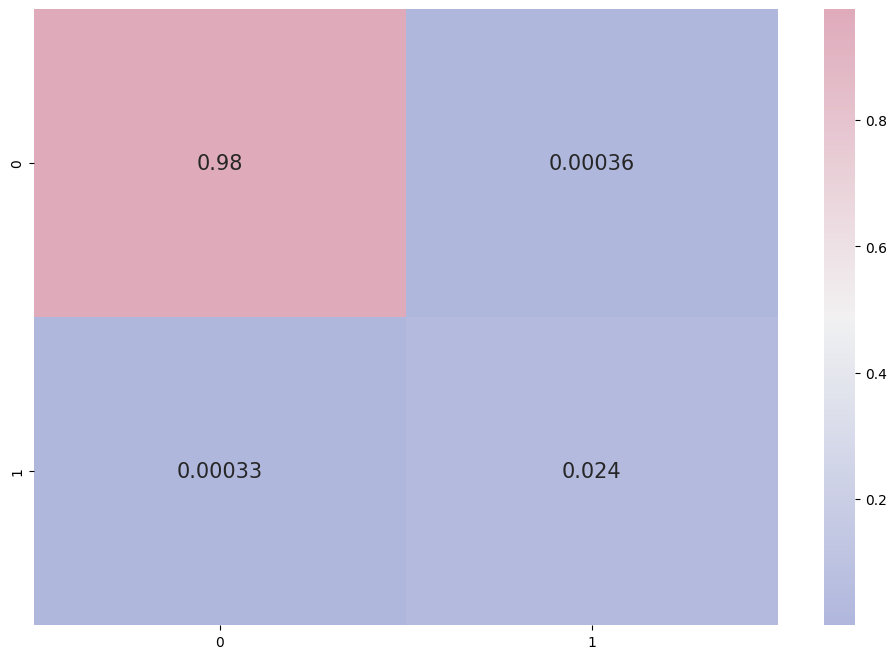

In [26]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,test_set,10)
print(para1)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_test)
computeMetric(y_tru,y_pre)

1.0
acc: 0.9993771549327105
precision: 0.9996809916602105
recall: 0.9872379216043756
cm: [[43858     0]
 [   28  1069]]
f1: 0.993376917691557
balanced acc: 0.9872379216043756
MCC: 0.9868404690561374
Kappa: 0.9867538900253595


0.993376917691557

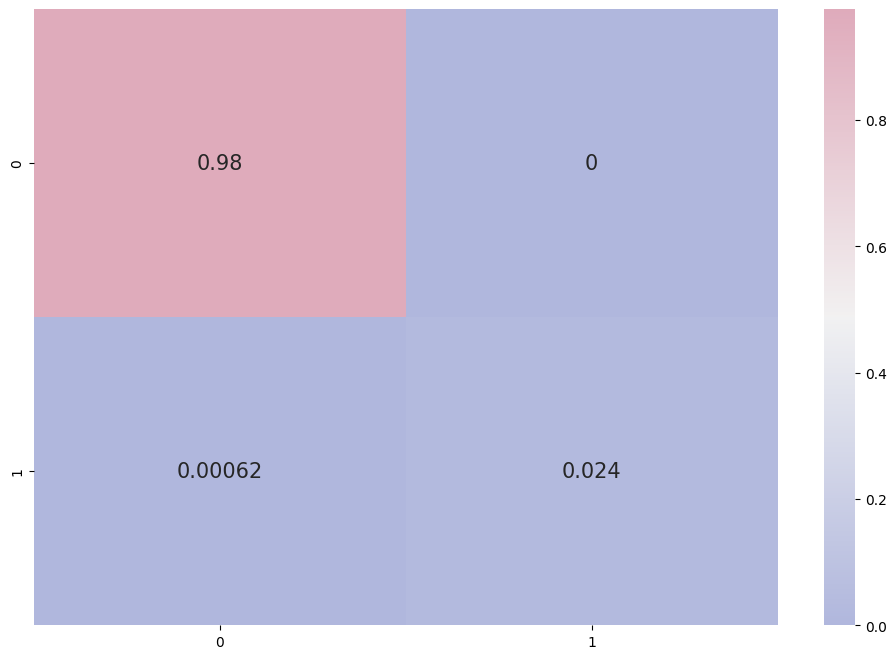

In [27]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,test_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt',
                          #objective='multiclass',
                          num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_test)
computeMetric(y_tru,y_pre)

1.0
acc: 0.9993771549327105
precision: 0.996528903776486
recall: 0.9903486382026888
cm: [[43851     7]
 [   21  1076]]
f1: 0.993418401120201
balanced acc: 0.9903486382026888
MCC: 0.9868581900051776
Kappa: 0.9868368157304162


0.993418401120201

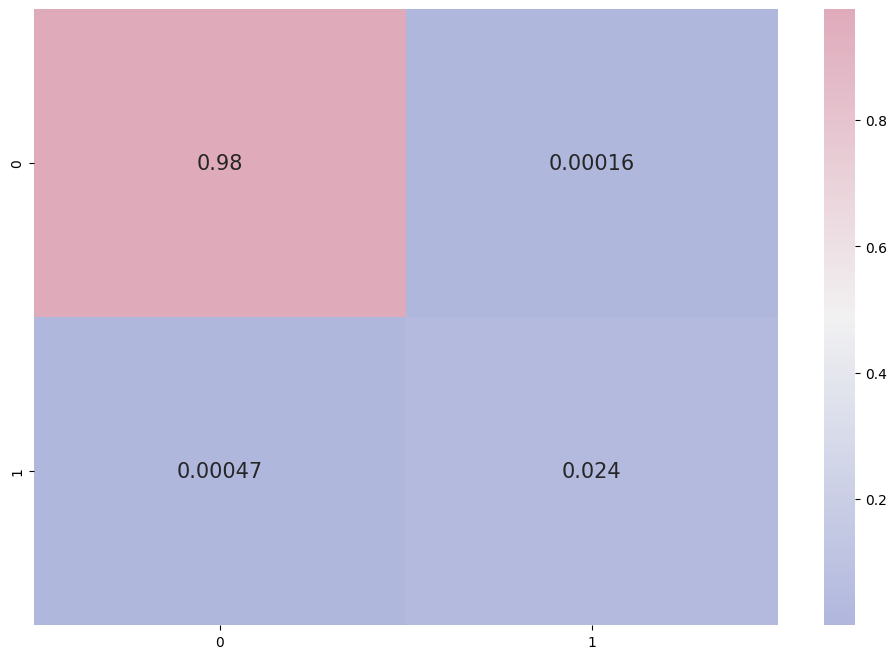

In [28]:
#XGBOOST
clf3 = xgb.XGBClassifier()
dic3 = {'n_estimators':range(80,2000,4),
        'max_depth':range(2,15,1),
        'learning_rate':np.linspace(0.01,2,20),
        'subsample':np.linspace(0.7,0.9,20),
        'colsample_bytree':np.linspace(0.5,0.98,10)
        }
para3=getPar(clf3,dic3,test_set,10)
clf3 = xgb.XGBClassifier(booster='gbtree',n_estimators=para3['n_estimators'], learning_rate=para3['learning_rate'],
                    max_depth=para3['max_depth'],subsample=para3['subsample'],
                    colsample_bytree=para3['colsample_bytree'],
                         #objective='multi:softprob',
                    n_jobs=-1)
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_test)
computeMetric(y_tru,y_pre)

Learning rate set to 0.118972
0:	learn: 0.4146937	total: 84.6ms	remaining: 1m 24s
1:	learn: 0.2329740	total: 108ms	remaining: 53.9s
2:	learn: 0.1398199	total: 130ms	remaining: 43.3s
3:	learn: 0.0833287	total: 153ms	remaining: 38.1s
4:	learn: 0.0517526	total: 175ms	remaining: 34.8s
5:	learn: 0.0321503	total: 198ms	remaining: 32.8s
6:	learn: 0.0267958	total: 218ms	remaining: 30.9s
7:	learn: 0.0228529	total: 238ms	remaining: 29.5s
8:	learn: 0.0184837	total: 258ms	remaining: 28.4s
9:	learn: 0.0158921	total: 277ms	remaining: 27.5s
10:	learn: 0.0140368	total: 298ms	remaining: 26.8s
11:	learn: 0.0114438	total: 317ms	remaining: 26.1s
12:	learn: 0.0085114	total: 338ms	remaining: 25.7s
13:	learn: 0.0078558	total: 359ms	remaining: 25.3s
14:	learn: 0.0073031	total: 381ms	remaining: 25s
15:	learn: 0.0068692	total: 401ms	remaining: 24.6s
16:	learn: 0.0054730	total: 422ms	remaining: 24.4s
17:	learn: 0.0051659	total: 440ms	remaining: 24s
18:	learn: 0.0050060	total: 459ms	remaining: 23.7s
19:	learn: 0.

164:	learn: 0.0013896	total: 3.32s	remaining: 16.8s
165:	learn: 0.0013824	total: 3.34s	remaining: 16.8s
166:	learn: 0.0013771	total: 3.36s	remaining: 16.8s
167:	learn: 0.0013682	total: 3.38s	remaining: 16.7s
168:	learn: 0.0013607	total: 3.4s	remaining: 16.7s
169:	learn: 0.0013585	total: 3.42s	remaining: 16.7s
170:	learn: 0.0013574	total: 3.44s	remaining: 16.7s
171:	learn: 0.0013495	total: 3.46s	remaining: 16.7s
172:	learn: 0.0013475	total: 3.48s	remaining: 16.6s
173:	learn: 0.0013462	total: 3.5s	remaining: 16.6s
174:	learn: 0.0013428	total: 3.52s	remaining: 16.6s
175:	learn: 0.0013406	total: 3.54s	remaining: 16.6s
176:	learn: 0.0013372	total: 3.55s	remaining: 16.5s
177:	learn: 0.0013341	total: 3.57s	remaining: 16.5s
178:	learn: 0.0013298	total: 3.59s	remaining: 16.5s
179:	learn: 0.0013278	total: 3.61s	remaining: 16.4s
180:	learn: 0.0013252	total: 3.63s	remaining: 16.4s
181:	learn: 0.0013230	total: 3.64s	remaining: 16.4s
182:	learn: 0.0013215	total: 3.66s	remaining: 16.3s
183:	learn: 0.

327:	learn: 0.0010157	total: 6.51s	remaining: 13.3s
328:	learn: 0.0010125	total: 6.54s	remaining: 13.3s
329:	learn: 0.0010121	total: 6.55s	remaining: 13.3s
330:	learn: 0.0010114	total: 6.57s	remaining: 13.3s
331:	learn: 0.0010094	total: 6.59s	remaining: 13.3s
332:	learn: 0.0010070	total: 6.62s	remaining: 13.3s
333:	learn: 0.0010056	total: 6.64s	remaining: 13.2s
334:	learn: 0.0010044	total: 6.66s	remaining: 13.2s
335:	learn: 0.0010038	total: 6.68s	remaining: 13.2s
336:	learn: 0.0010027	total: 6.7s	remaining: 13.2s
337:	learn: 0.0010001	total: 6.72s	remaining: 13.2s
338:	learn: 0.0009993	total: 6.74s	remaining: 13.1s
339:	learn: 0.0009982	total: 6.76s	remaining: 13.1s
340:	learn: 0.0009976	total: 6.78s	remaining: 13.1s
341:	learn: 0.0009959	total: 6.8s	remaining: 13.1s
342:	learn: 0.0009937	total: 6.82s	remaining: 13.1s
343:	learn: 0.0009931	total: 6.84s	remaining: 13s
344:	learn: 0.0009910	total: 6.86s	remaining: 13s
345:	learn: 0.0009895	total: 6.88s	remaining: 13s
346:	learn: 0.000988

491:	learn: 0.0008348	total: 9.68s	remaining: 10s
492:	learn: 0.0008344	total: 9.7s	remaining: 9.98s
493:	learn: 0.0008340	total: 9.72s	remaining: 9.96s
494:	learn: 0.0008322	total: 9.74s	remaining: 9.94s
495:	learn: 0.0008320	total: 9.76s	remaining: 9.92s
496:	learn: 0.0008313	total: 9.78s	remaining: 9.9s
497:	learn: 0.0008311	total: 9.8s	remaining: 9.88s
498:	learn: 0.0008292	total: 9.82s	remaining: 9.86s
499:	learn: 0.0008287	total: 9.84s	remaining: 9.84s
500:	learn: 0.0008282	total: 9.86s	remaining: 9.82s
501:	learn: 0.0008266	total: 9.88s	remaining: 9.8s
502:	learn: 0.0008260	total: 9.9s	remaining: 9.78s
503:	learn: 0.0008260	total: 9.91s	remaining: 9.76s
504:	learn: 0.0008247	total: 9.94s	remaining: 9.74s
505:	learn: 0.0008231	total: 9.96s	remaining: 9.72s
506:	learn: 0.0008227	total: 9.98s	remaining: 9.7s
507:	learn: 0.0008225	total: 10s	remaining: 9.68s
508:	learn: 0.0008225	total: 10s	remaining: 9.66s
509:	learn: 0.0008217	total: 10s	remaining: 9.64s
510:	learn: 0.0008215	tota

651:	learn: 0.0008098	total: 12.4s	remaining: 6.6s
652:	learn: 0.0008098	total: 12.4s	remaining: 6.58s
653:	learn: 0.0008098	total: 12.4s	remaining: 6.56s
654:	learn: 0.0008098	total: 12.4s	remaining: 6.54s
655:	learn: 0.0008098	total: 12.4s	remaining: 6.52s
656:	learn: 0.0008098	total: 12.4s	remaining: 6.5s
657:	learn: 0.0008098	total: 12.5s	remaining: 6.48s
658:	learn: 0.0008098	total: 12.5s	remaining: 6.46s
659:	learn: 0.0008098	total: 12.5s	remaining: 6.44s
660:	learn: 0.0008098	total: 12.5s	remaining: 6.42s
661:	learn: 0.0008098	total: 12.5s	remaining: 6.39s
662:	learn: 0.0008098	total: 12.5s	remaining: 6.37s
663:	learn: 0.0008098	total: 12.6s	remaining: 6.35s
664:	learn: 0.0008098	total: 12.6s	remaining: 6.33s
665:	learn: 0.0008098	total: 12.6s	remaining: 6.31s
666:	learn: 0.0008098	total: 12.6s	remaining: 6.29s
667:	learn: 0.0008098	total: 12.6s	remaining: 6.27s
668:	learn: 0.0008098	total: 12.6s	remaining: 6.25s
669:	learn: 0.0008098	total: 12.7s	remaining: 6.23s
670:	learn: 0.

810:	learn: 0.0008098	total: 14.8s	remaining: 3.46s
811:	learn: 0.0008098	total: 14.8s	remaining: 3.44s
812:	learn: 0.0008098	total: 14.9s	remaining: 3.42s
813:	learn: 0.0008098	total: 14.9s	remaining: 3.4s
814:	learn: 0.0008098	total: 14.9s	remaining: 3.38s
815:	learn: 0.0008098	total: 14.9s	remaining: 3.36s
816:	learn: 0.0008098	total: 14.9s	remaining: 3.34s
817:	learn: 0.0008098	total: 14.9s	remaining: 3.32s
818:	learn: 0.0008098	total: 15s	remaining: 3.3s
819:	learn: 0.0008098	total: 15s	remaining: 3.29s
820:	learn: 0.0008098	total: 15s	remaining: 3.27s
821:	learn: 0.0008098	total: 15s	remaining: 3.25s
822:	learn: 0.0008098	total: 15s	remaining: 3.23s
823:	learn: 0.0008098	total: 15s	remaining: 3.21s
824:	learn: 0.0008098	total: 15.1s	remaining: 3.19s
825:	learn: 0.0008098	total: 15.1s	remaining: 3.17s
826:	learn: 0.0008098	total: 15.1s	remaining: 3.15s
827:	learn: 0.0008098	total: 15.1s	remaining: 3.14s
828:	learn: 0.0008098	total: 15.1s	remaining: 3.12s
829:	learn: 0.0008098	tota

970:	learn: 0.0008098	total: 17.3s	remaining: 517ms
971:	learn: 0.0008098	total: 17.3s	remaining: 499ms
972:	learn: 0.0008098	total: 17.4s	remaining: 482ms
973:	learn: 0.0008098	total: 17.4s	remaining: 464ms
974:	learn: 0.0008098	total: 17.4s	remaining: 446ms
975:	learn: 0.0008098	total: 17.4s	remaining: 428ms
976:	learn: 0.0008098	total: 17.4s	remaining: 410ms
977:	learn: 0.0008098	total: 17.4s	remaining: 392ms
978:	learn: 0.0008098	total: 17.4s	remaining: 374ms
979:	learn: 0.0008098	total: 17.5s	remaining: 356ms
980:	learn: 0.0008098	total: 17.5s	remaining: 339ms
981:	learn: 0.0008098	total: 17.5s	remaining: 321ms
982:	learn: 0.0008098	total: 17.5s	remaining: 303ms
983:	learn: 0.0008098	total: 17.5s	remaining: 285ms
984:	learn: 0.0008098	total: 17.5s	remaining: 267ms
985:	learn: 0.0008098	total: 17.6s	remaining: 249ms
986:	learn: 0.0008098	total: 17.6s	remaining: 231ms
987:	learn: 0.0008098	total: 17.6s	remaining: 214ms
988:	learn: 0.0008098	total: 17.6s	remaining: 196ms
989:	learn: 

0.9938830427602017

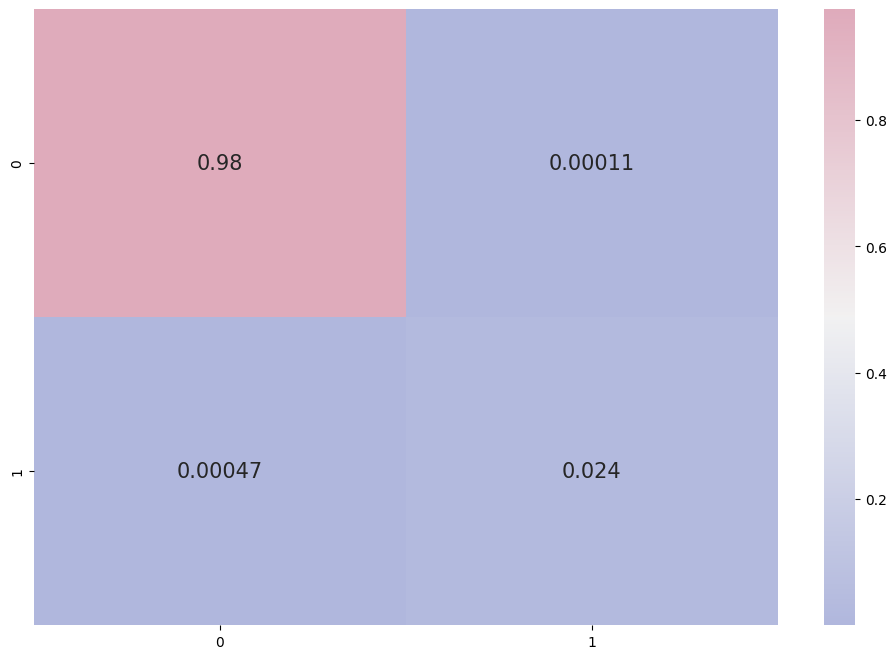

In [29]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# #para3=getPar(clf4,dic4,test_set,10)

# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_test)
computeMetric(y_tru,y_pre)

## random sampling

In [30]:
sampling=random_sampling

In [31]:
metric01,instance01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
# instance01.to_csv("./query/random_Knn_"+"mix_si"+".csv")

1 [0] --------------------> 0.1569710654806329 0.1720554272517321
2 [0] --------------------> 0.1569710654806329 0.1720554272517321
3 [0] --------------------> 0.1569710654806329 0.1720554272517321
4 [0] --------------------> 0.1569710654806329 0.1720554272517321
5 [0] --------------------> 0.1569710654806329 0.1720554272517321
6 [0] --------------------> 0.1569710654806329 0.1720554272517321
7 [0] --------------------> 0.08893604078469541 0.10392749244712991
8 [0] --------------------> 0.08893604078469541 0.10392749244712991
9 [0] --------------------> 0.08893604078469541 0.10392749244712991
10 [0] --------------------> 0.08893604078469541 0.10392749244712991
11 [0] --------------------> 0.08893604078469541 0.10392749244712991
12 [0] --------------------> 0.03548803184525562 0.04915912031047866
13 [0] --------------------> 0.03548803184525562 0.04915912031047866
14 [0] --------------------> 0.03548803184525562 0.04915912031047866
15 [0] --------------------> 0.03548803184525562 0.0491

132 [0] --------------------> -0.0044676587618752706 0.0
133 [0] --------------------> -0.0044676587618752706 0.0
134 [0] --------------------> -0.0044676587618752706 0.0
135 [0] --------------------> -0.0044676587618752706 0.0
136 [0] --------------------> -0.0044676587618752706 0.0
137 [0] --------------------> -0.0044676587618752706 0.0
138 [0] --------------------> -0.0044676587618752706 0.0
139 [0] --------------------> -0.0044676587618752706 0.0
140 [0] --------------------> -0.0044676587618752706 0.0
141 [0] --------------------> -0.0044676587618752706 0.0
142 [0] --------------------> -0.0044676587618752706 0.0
143 [0] --------------------> -0.0044676587618752706 0.0
144 [0] --------------------> -0.0044676587618752706 0.0
145 [0] --------------------> -0.0044676587618752706 0.0
146 [0] --------------------> -0.0044676587618752706 0.0
147 [0] --------------------> -0.0044676587618752706 0.0
148 [0] --------------------> -0.0044676587618752706 0.0
149 [0] --------------------> -

In [32]:
metric02,instance02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
# instance02.to_csv("./query/random_Lg_"+"mix_si"+".csv")

1 [0] --------------------> 0.0 0.0
2 [0] --------------------> 0.0 0.0
3 [0] --------------------> 0.0 0.0
4 [0] --------------------> 0.0 0.0
5 [0] --------------------> 0.0 0.0
6 [0] --------------------> 0.0 0.0
7 [0] --------------------> 0.0 0.0
8 [0] --------------------> 0.0 0.0
9 [0] --------------------> 0.0 0.0
10 [0] --------------------> 0.0 0.0
11 [0] --------------------> 0.0 0.0
12 [0] --------------------> 0.0 0.0
13 [0] --------------------> 0.0 0.0
14 [0] --------------------> 0.0 0.0
15 [0] --------------------> 0.0 0.0
16 [0] --------------------> 0.0 0.0
17 [0] --------------------> 0.0 0.0
18 [0] --------------------> 0.0 0.0
19 [0] --------------------> 0.0 0.0
20 [0] --------------------> 0.0 0.0
21 [0] --------------------> 0.0 0.0
22 [0] --------------------> 0.0 0.0
23 [0] --------------------> 0.0 0.0
24 [0] --------------------> 0.0 0.0
25 [0] --------------------> 0.0 0.0
26 [0] --------------------> 0.0 0.0
27 [0] --------------------> 0.0 0.0
28 [0] ---

In [33]:
metric03,instance03= al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
# instance03.to_csv("./query/random_XB_"+"mix_si"+".csv")

1 [0] --------------------> -0.007679513997816079 0.0
2 [0] --------------------> -0.008807616912487104 0.0
3 [0] --------------------> -0.010703301368359508 0.0
4 [0] --------------------> -0.014922897647951183 0.0
5 [0] --------------------> -0.012690780420284264 0.0
6 [0] --------------------> -0.024681221609690773 0.0
7 [0] --------------------> -0.02504755054436192 0.0
8 [0] --------------------> -0.012990862174598883 0.0
9 [0] --------------------> -0.008838120942574967 0.0
10 [0] --------------------> -0.01333511621122252 0.0
11 [0] --------------------> -0.009409489873065668 0.0
12 [0] --------------------> -0.000397299953859509 0.0
13 [0] --------------------> -0.006353694451366243 0.0
14 [0] --------------------> -0.006523811908154986 0.0
15 [0] --------------------> -0.006658981660784713 0.0
16 [0] --------------------> -0.004281529374112747 0.0
17 [0] --------------------> -0.004093914854594649 0.0
18 [0] --------------------> -0.005447830289007083 0.0
19 [0] --------------

157 [0] --------------------> -0.00026555205809808413 0.0
158 [0] --------------------> -0.000221484434308028 0.0
159 [0] --------------------> -0.00017734065363339546 0.0
160 [0] --------------------> -0.000397299953859509 0.0
161 [0] --------------------> -0.0018028785130701497 0.0
162 [0] --------------------> -0.00017734065363339546 0.0
163 [0] --------------------> -0.0014272943339479482 0.0
164 [0] --------------------> -0.001761426479350181 0.0
165 [0] --------------------> -0.0019268195007482447 0.0
166 [0] --------------------> -0.0001331205184831319 0.0
167 [0] --------------------> -0.0001331205184831319 0.0
168 [0] --------------------> -0.0026175934539149903 0.0
169 [0] --------------------> -0.0018442612455422669 0.0
170 [0] --------------------> -0.0010032378686091192 0.0
171 [0] --------------------> -0.0013852106780785078 0.0
172 [0] --------------------> -8.882383058361754e-05 0.0
173 [0] --------------------> -0.0007453254001414944 0.0
174 [0] --------------------> -

In [34]:
metric04,instance04= al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
# instance04.to_csv("./query/random_CB_"+"mix_si"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6881754	total: 1.98ms	remaining: 1.98s
1:	learn: 0.6833669	total: 2.99ms	remaining: 1.49s
2:	learn: 0.6787679	total: 4.01ms	remaining: 1.33s
3:	learn: 0.6740769	total: 4.89ms	remaining: 1.22s
4:	learn: 0.6693594	total: 5.61ms	remaining: 1.12s
5:	learn: 0.6652301	total: 6.42ms	remaining: 1.06s
6:	learn: 0.6595345	total: 7.31ms	remaining: 1.04s
7:	learn: 0.6551303	total: 8.19ms	remaining: 1.01s
8:	learn: 0.6512817	total: 9.07ms	remaining: 999ms
9:	learn: 0.6468379	total: 9.94ms	remaining: 984ms
10:	learn: 0.6419992	total: 10.8ms	remaining: 972ms
11:	learn: 0.6378145	total: 11.6ms	remaining: 955ms
12:	learn: 0.6344044	total: 12.5ms	remaining: 946ms
13:	learn: 0.6309750	total: 13.3ms	remaining: 935ms
14:	learn: 0.6268184	total: 14.2ms	remaining: 935ms
15:	learn: 0.6230871	total: 15ms	remaining: 925ms
16:	learn: 0.6187570	total: 15.7ms	remaining: 910ms
17:	learn: 0.6146075	total: 16.6ms	remaining: 903ms
18:	learn: 0.6099646	total: 17.4ms	remaining: 

191:	learn: 0.2458141	total: 168ms	remaining: 705ms
192:	learn: 0.2450984	total: 169ms	remaining: 707ms
193:	learn: 0.2442837	total: 171ms	remaining: 709ms
194:	learn: 0.2435234	total: 172ms	remaining: 711ms
195:	learn: 0.2426870	total: 173ms	remaining: 711ms
196:	learn: 0.2417379	total: 174ms	remaining: 711ms
197:	learn: 0.2408227	total: 176ms	remaining: 714ms
198:	learn: 0.2398952	total: 178ms	remaining: 715ms
199:	learn: 0.2389182	total: 179ms	remaining: 717ms
200:	learn: 0.2379555	total: 181ms	remaining: 719ms
201:	learn: 0.2371826	total: 183ms	remaining: 721ms
202:	learn: 0.2365113	total: 184ms	remaining: 723ms
203:	learn: 0.2357207	total: 186ms	remaining: 724ms
204:	learn: 0.2346283	total: 187ms	remaining: 726ms
205:	learn: 0.2338225	total: 189ms	remaining: 727ms
206:	learn: 0.2329823	total: 190ms	remaining: 729ms
207:	learn: 0.2317377	total: 192ms	remaining: 729ms
208:	learn: 0.2309769	total: 193ms	remaining: 729ms
209:	learn: 0.2302618	total: 194ms	remaining: 728ms
210:	learn: 

405:	learn: 0.1243544	total: 349ms	remaining: 510ms
406:	learn: 0.1241549	total: 350ms	remaining: 509ms
407:	learn: 0.1238671	total: 350ms	remaining: 508ms
408:	learn: 0.1234674	total: 351ms	remaining: 507ms
409:	learn: 0.1230343	total: 352ms	remaining: 506ms
410:	learn: 0.1226584	total: 353ms	remaining: 505ms
411:	learn: 0.1222712	total: 353ms	remaining: 504ms
412:	learn: 0.1219717	total: 354ms	remaining: 503ms
413:	learn: 0.1214626	total: 355ms	remaining: 502ms
414:	learn: 0.1210979	total: 356ms	remaining: 501ms
415:	learn: 0.1207828	total: 356ms	remaining: 500ms
416:	learn: 0.1205762	total: 357ms	remaining: 499ms
417:	learn: 0.1202873	total: 358ms	remaining: 498ms
418:	learn: 0.1199396	total: 359ms	remaining: 498ms
419:	learn: 0.1196487	total: 360ms	remaining: 497ms
420:	learn: 0.1194278	total: 361ms	remaining: 496ms
421:	learn: 0.1191482	total: 361ms	remaining: 495ms
422:	learn: 0.1188143	total: 362ms	remaining: 494ms
423:	learn: 0.1186505	total: 363ms	remaining: 494ms
424:	learn: 

644:	learn: 0.0717288	total: 531ms	remaining: 292ms
645:	learn: 0.0716378	total: 532ms	remaining: 292ms
646:	learn: 0.0714118	total: 533ms	remaining: 291ms
647:	learn: 0.0712479	total: 534ms	remaining: 290ms
648:	learn: 0.0710790	total: 534ms	remaining: 289ms
649:	learn: 0.0709812	total: 535ms	remaining: 288ms
650:	learn: 0.0708223	total: 536ms	remaining: 287ms
651:	learn: 0.0706465	total: 537ms	remaining: 286ms
652:	learn: 0.0705169	total: 537ms	remaining: 286ms
653:	learn: 0.0703140	total: 538ms	remaining: 285ms
654:	learn: 0.0701831	total: 539ms	remaining: 284ms
655:	learn: 0.0700705	total: 540ms	remaining: 283ms
656:	learn: 0.0699782	total: 540ms	remaining: 282ms
657:	learn: 0.0698847	total: 541ms	remaining: 281ms
658:	learn: 0.0697383	total: 542ms	remaining: 280ms
659:	learn: 0.0695691	total: 543ms	remaining: 280ms
660:	learn: 0.0694172	total: 543ms	remaining: 279ms
661:	learn: 0.0692846	total: 545ms	remaining: 278ms
662:	learn: 0.0691913	total: 547ms	remaining: 278ms
663:	learn: 

882:	learn: 0.0474197	total: 712ms	remaining: 94.4ms
883:	learn: 0.0473475	total: 713ms	remaining: 93.6ms
884:	learn: 0.0472915	total: 714ms	remaining: 92.8ms
885:	learn: 0.0472130	total: 715ms	remaining: 92ms
886:	learn: 0.0471122	total: 716ms	remaining: 91.2ms
887:	learn: 0.0470588	total: 717ms	remaining: 90.4ms
888:	learn: 0.0469957	total: 717ms	remaining: 89.6ms
889:	learn: 0.0469502	total: 718ms	remaining: 88.8ms
890:	learn: 0.0468836	total: 719ms	remaining: 87.9ms
891:	learn: 0.0468353	total: 720ms	remaining: 87.1ms
892:	learn: 0.0467682	total: 720ms	remaining: 86.3ms
893:	learn: 0.0466734	total: 721ms	remaining: 85.5ms
894:	learn: 0.0466219	total: 722ms	remaining: 84.7ms
895:	learn: 0.0465419	total: 723ms	remaining: 83.9ms
896:	learn: 0.0464486	total: 724ms	remaining: 83.1ms
897:	learn: 0.0463764	total: 725ms	remaining: 82.3ms
898:	learn: 0.0462901	total: 726ms	remaining: 81.5ms
899:	learn: 0.0462016	total: 726ms	remaining: 80.7ms
900:	learn: 0.0461222	total: 728ms	remaining: 80

243:	learn: 0.2037371	total: 187ms	remaining: 579ms
244:	learn: 0.2029886	total: 188ms	remaining: 579ms
245:	learn: 0.2023291	total: 189ms	remaining: 578ms
246:	learn: 0.2017409	total: 189ms	remaining: 578ms
247:	learn: 0.2009164	total: 190ms	remaining: 577ms
248:	learn: 0.2002755	total: 191ms	remaining: 576ms
249:	learn: 0.1997185	total: 192ms	remaining: 575ms
250:	learn: 0.1991841	total: 193ms	remaining: 575ms
251:	learn: 0.1986366	total: 193ms	remaining: 574ms
252:	learn: 0.1982026	total: 194ms	remaining: 573ms
253:	learn: 0.1976716	total: 195ms	remaining: 573ms
254:	learn: 0.1968842	total: 196ms	remaining: 572ms
255:	learn: 0.1958673	total: 197ms	remaining: 572ms
256:	learn: 0.1951177	total: 197ms	remaining: 571ms
257:	learn: 0.1943612	total: 198ms	remaining: 570ms
258:	learn: 0.1937596	total: 199ms	remaining: 569ms
259:	learn: 0.1930607	total: 200ms	remaining: 568ms
260:	learn: 0.1925254	total: 200ms	remaining: 567ms
261:	learn: 0.1918928	total: 201ms	remaining: 566ms
262:	learn: 

430:	learn: 0.1153714	total: 370ms	remaining: 489ms
431:	learn: 0.1149732	total: 372ms	remaining: 488ms
432:	learn: 0.1146833	total: 372ms	remaining: 487ms
433:	learn: 0.1143529	total: 373ms	remaining: 487ms
434:	learn: 0.1139972	total: 374ms	remaining: 486ms
435:	learn: 0.1137777	total: 375ms	remaining: 485ms
436:	learn: 0.1134235	total: 375ms	remaining: 484ms
437:	learn: 0.1131413	total: 376ms	remaining: 483ms
438:	learn: 0.1128444	total: 377ms	remaining: 482ms
439:	learn: 0.1125539	total: 378ms	remaining: 481ms
440:	learn: 0.1123182	total: 378ms	remaining: 480ms
441:	learn: 0.1120463	total: 379ms	remaining: 479ms
442:	learn: 0.1117831	total: 380ms	remaining: 478ms
443:	learn: 0.1115353	total: 381ms	remaining: 477ms
444:	learn: 0.1112514	total: 382ms	remaining: 476ms
445:	learn: 0.1109916	total: 383ms	remaining: 475ms
446:	learn: 0.1106942	total: 384ms	remaining: 474ms
447:	learn: 0.1104164	total: 384ms	remaining: 474ms
448:	learn: 0.1101427	total: 385ms	remaining: 473ms
449:	learn: 

672:	learn: 0.0670614	total: 552ms	remaining: 268ms
673:	learn: 0.0669292	total: 553ms	remaining: 268ms
674:	learn: 0.0668293	total: 554ms	remaining: 267ms
675:	learn: 0.0666265	total: 555ms	remaining: 266ms
676:	learn: 0.0664593	total: 556ms	remaining: 265ms
677:	learn: 0.0663541	total: 556ms	remaining: 264ms
678:	learn: 0.0662704	total: 557ms	remaining: 263ms
679:	learn: 0.0661645	total: 558ms	remaining: 263ms
680:	learn: 0.0660284	total: 559ms	remaining: 262ms
681:	learn: 0.0659285	total: 560ms	remaining: 261ms
682:	learn: 0.0658385	total: 560ms	remaining: 260ms
683:	learn: 0.0656764	total: 561ms	remaining: 259ms
684:	learn: 0.0654853	total: 562ms	remaining: 258ms
685:	learn: 0.0653410	total: 563ms	remaining: 258ms
686:	learn: 0.0652438	total: 564ms	remaining: 257ms
687:	learn: 0.0650562	total: 565ms	remaining: 256ms
688:	learn: 0.0649529	total: 565ms	remaining: 255ms
689:	learn: 0.0648111	total: 566ms	remaining: 254ms
690:	learn: 0.0646398	total: 567ms	remaining: 254ms
691:	learn: 

916:	learn: 0.0443629	total: 734ms	remaining: 66.4ms
917:	learn: 0.0442736	total: 735ms	remaining: 65.6ms
918:	learn: 0.0442280	total: 736ms	remaining: 64.8ms
919:	learn: 0.0441151	total: 736ms	remaining: 64ms
920:	learn: 0.0440401	total: 737ms	remaining: 63.2ms
921:	learn: 0.0439932	total: 738ms	remaining: 62.4ms
922:	learn: 0.0439203	total: 739ms	remaining: 61.6ms
923:	learn: 0.0438516	total: 739ms	remaining: 60.8ms
924:	learn: 0.0437983	total: 740ms	remaining: 60ms
925:	learn: 0.0437828	total: 741ms	remaining: 59.2ms
926:	learn: 0.0437058	total: 742ms	remaining: 58.4ms
927:	learn: 0.0436284	total: 742ms	remaining: 57.6ms
928:	learn: 0.0435499	total: 743ms	remaining: 56.8ms
929:	learn: 0.0434841	total: 744ms	remaining: 56ms
930:	learn: 0.0434456	total: 745ms	remaining: 55.2ms
931:	learn: 0.0434088	total: 746ms	remaining: 54.4ms
932:	learn: 0.0433526	total: 746ms	remaining: 53.6ms
933:	learn: 0.0432956	total: 747ms	remaining: 52.8ms
934:	learn: 0.0432346	total: 748ms	remaining: 52ms
9

282:	learn: 0.1772000	total: 210ms	remaining: 532ms
283:	learn: 0.1766657	total: 211ms	remaining: 532ms
284:	learn: 0.1762086	total: 212ms	remaining: 532ms
285:	learn: 0.1755509	total: 213ms	remaining: 531ms
286:	learn: 0.1751263	total: 213ms	remaining: 530ms
287:	learn: 0.1746134	total: 214ms	remaining: 529ms
288:	learn: 0.1739493	total: 215ms	remaining: 529ms
289:	learn: 0.1734870	total: 216ms	remaining: 528ms
290:	learn: 0.1730318	total: 216ms	remaining: 527ms
291:	learn: 0.1726599	total: 217ms	remaining: 527ms
292:	learn: 0.1720994	total: 218ms	remaining: 526ms
293:	learn: 0.1714733	total: 219ms	remaining: 525ms
294:	learn: 0.1708312	total: 220ms	remaining: 525ms
295:	learn: 0.1704815	total: 220ms	remaining: 524ms
296:	learn: 0.1699912	total: 221ms	remaining: 523ms
297:	learn: 0.1694392	total: 222ms	remaining: 523ms
298:	learn: 0.1689163	total: 223ms	remaining: 522ms
299:	learn: 0.1684186	total: 223ms	remaining: 521ms
300:	learn: 0.1678713	total: 225ms	remaining: 522ms
301:	learn: 

498:	learn: 0.0990963	total: 393ms	remaining: 395ms
499:	learn: 0.0988104	total: 394ms	remaining: 394ms
500:	learn: 0.0985572	total: 395ms	remaining: 393ms
501:	learn: 0.0982748	total: 396ms	remaining: 393ms
502:	learn: 0.0980795	total: 397ms	remaining: 392ms
503:	learn: 0.0979972	total: 397ms	remaining: 391ms
504:	learn: 0.0978465	total: 398ms	remaining: 390ms
505:	learn: 0.0976100	total: 399ms	remaining: 389ms
506:	learn: 0.0974033	total: 400ms	remaining: 389ms
507:	learn: 0.0973031	total: 400ms	remaining: 388ms
508:	learn: 0.0971118	total: 401ms	remaining: 387ms
509:	learn: 0.0968652	total: 402ms	remaining: 386ms
510:	learn: 0.0966067	total: 403ms	remaining: 385ms
511:	learn: 0.0963373	total: 404ms	remaining: 385ms
512:	learn: 0.0961537	total: 404ms	remaining: 384ms
513:	learn: 0.0959797	total: 405ms	remaining: 383ms
514:	learn: 0.0957630	total: 406ms	remaining: 382ms
515:	learn: 0.0955547	total: 407ms	remaining: 382ms
516:	learn: 0.0953344	total: 408ms	remaining: 382ms
517:	learn: 

744:	learn: 0.0593563	total: 574ms	remaining: 197ms
745:	learn: 0.0592691	total: 576ms	remaining: 196ms
746:	learn: 0.0591919	total: 576ms	remaining: 195ms
747:	learn: 0.0590463	total: 577ms	remaining: 194ms
748:	learn: 0.0589421	total: 578ms	remaining: 194ms
749:	learn: 0.0588465	total: 579ms	remaining: 193ms
750:	learn: 0.0587477	total: 580ms	remaining: 192ms
751:	learn: 0.0586303	total: 580ms	remaining: 191ms
752:	learn: 0.0585072	total: 581ms	remaining: 191ms
753:	learn: 0.0584131	total: 582ms	remaining: 190ms
754:	learn: 0.0583529	total: 582ms	remaining: 189ms
755:	learn: 0.0581940	total: 583ms	remaining: 188ms
756:	learn: 0.0581184	total: 584ms	remaining: 187ms
757:	learn: 0.0580039	total: 585ms	remaining: 187ms
758:	learn: 0.0578939	total: 586ms	remaining: 186ms
759:	learn: 0.0577993	total: 586ms	remaining: 185ms
760:	learn: 0.0577186	total: 587ms	remaining: 184ms
761:	learn: 0.0576049	total: 588ms	remaining: 184ms
762:	learn: 0.0574940	total: 589ms	remaining: 183ms
763:	learn: 

988:	learn: 0.0403023	total: 757ms	remaining: 8.42ms
989:	learn: 0.0402260	total: 758ms	remaining: 7.65ms
990:	learn: 0.0401541	total: 758ms	remaining: 6.89ms
991:	learn: 0.0400830	total: 759ms	remaining: 6.12ms
992:	learn: 0.0399957	total: 760ms	remaining: 5.36ms
993:	learn: 0.0398973	total: 761ms	remaining: 4.59ms
994:	learn: 0.0398627	total: 762ms	remaining: 3.83ms
995:	learn: 0.0398046	total: 762ms	remaining: 3.06ms
996:	learn: 0.0397456	total: 763ms	remaining: 2.3ms
997:	learn: 0.0396975	total: 764ms	remaining: 1.53ms
998:	learn: 0.0396356	total: 764ms	remaining: 765us
999:	learn: 0.0395661	total: 765ms	remaining: 0us
2 [0] --------------------> 0.0 0.0
Learning rate set to 0.003903
0:	learn: 0.6881564	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6833216	total: 1.91ms	remaining: 955ms
2:	learn: 0.6785867	total: 2.83ms	remaining: 940ms
3:	learn: 0.6740637	total: 3.63ms	remaining: 905ms
4:	learn: 0.6693418	total: 4.3ms	remaining: 856ms
5:	learn: 0.6650364	total: 5.04ms	remaining: 835m

234:	learn: 0.2096757	total: 177ms	remaining: 576ms
235:	learn: 0.2087747	total: 178ms	remaining: 578ms
236:	learn: 0.2080567	total: 179ms	remaining: 577ms
237:	learn: 0.2068745	total: 180ms	remaining: 576ms
238:	learn: 0.2060584	total: 181ms	remaining: 576ms
239:	learn: 0.2052573	total: 182ms	remaining: 575ms
240:	learn: 0.2043141	total: 182ms	remaining: 574ms
241:	learn: 0.2034085	total: 183ms	remaining: 573ms
242:	learn: 0.2024707	total: 184ms	remaining: 573ms
243:	learn: 0.2019818	total: 185ms	remaining: 572ms
244:	learn: 0.2012627	total: 186ms	remaining: 572ms
245:	learn: 0.2006214	total: 186ms	remaining: 571ms
246:	learn: 0.2000140	total: 187ms	remaining: 570ms
247:	learn: 0.1991790	total: 188ms	remaining: 570ms
248:	learn: 0.1983907	total: 189ms	remaining: 569ms
249:	learn: 0.1978517	total: 189ms	remaining: 568ms
250:	learn: 0.1971642	total: 190ms	remaining: 568ms
251:	learn: 0.1965970	total: 191ms	remaining: 567ms
252:	learn: 0.1959982	total: 192ms	remaining: 566ms
253:	learn: 

474:	learn: 0.1023420	total: 359ms	remaining: 397ms
475:	learn: 0.1020821	total: 360ms	remaining: 397ms
476:	learn: 0.1018213	total: 361ms	remaining: 396ms
477:	learn: 0.1015486	total: 362ms	remaining: 395ms
478:	learn: 0.1012879	total: 363ms	remaining: 395ms
479:	learn: 0.1010279	total: 364ms	remaining: 394ms
480:	learn: 0.1008302	total: 364ms	remaining: 393ms
481:	learn: 0.1006591	total: 365ms	remaining: 393ms
482:	learn: 0.1004209	total: 366ms	remaining: 392ms
483:	learn: 0.1001142	total: 367ms	remaining: 391ms
484:	learn: 0.0998932	total: 368ms	remaining: 390ms
485:	learn: 0.0995039	total: 368ms	remaining: 390ms
486:	learn: 0.0992170	total: 369ms	remaining: 389ms
487:	learn: 0.0990252	total: 370ms	remaining: 388ms
488:	learn: 0.0987993	total: 371ms	remaining: 388ms
489:	learn: 0.0986012	total: 372ms	remaining: 387ms
490:	learn: 0.0983811	total: 372ms	remaining: 386ms
491:	learn: 0.0981005	total: 373ms	remaining: 385ms
492:	learn: 0.0979226	total: 374ms	remaining: 385ms
493:	learn: 

715:	learn: 0.0616130	total: 542ms	remaining: 215ms
716:	learn: 0.0615190	total: 543ms	remaining: 214ms
717:	learn: 0.0614441	total: 544ms	remaining: 213ms
718:	learn: 0.0612918	total: 544ms	remaining: 213ms
719:	learn: 0.0611733	total: 545ms	remaining: 212ms
720:	learn: 0.0610320	total: 546ms	remaining: 211ms
721:	learn: 0.0609084	total: 547ms	remaining: 210ms
722:	learn: 0.0607773	total: 547ms	remaining: 210ms
723:	learn: 0.0607170	total: 548ms	remaining: 209ms
724:	learn: 0.0605858	total: 549ms	remaining: 208ms
725:	learn: 0.0605100	total: 550ms	remaining: 207ms
726:	learn: 0.0604291	total: 550ms	remaining: 207ms
727:	learn: 0.0603607	total: 551ms	remaining: 206ms
728:	learn: 0.0602620	total: 552ms	remaining: 205ms
729:	learn: 0.0601299	total: 553ms	remaining: 204ms
730:	learn: 0.0600171	total: 554ms	remaining: 204ms
731:	learn: 0.0599187	total: 554ms	remaining: 203ms
732:	learn: 0.0598720	total: 555ms	remaining: 202ms
733:	learn: 0.0597348	total: 556ms	remaining: 202ms
734:	learn: 

957:	learn: 0.0417207	total: 724ms	remaining: 31.7ms
958:	learn: 0.0416913	total: 725ms	remaining: 31ms
959:	learn: 0.0416635	total: 726ms	remaining: 30.2ms
960:	learn: 0.0415879	total: 727ms	remaining: 29.5ms
961:	learn: 0.0415080	total: 727ms	remaining: 28.7ms
962:	learn: 0.0413785	total: 728ms	remaining: 28ms
963:	learn: 0.0413283	total: 729ms	remaining: 27.2ms
964:	learn: 0.0412299	total: 730ms	remaining: 26.5ms
965:	learn: 0.0411598	total: 731ms	remaining: 25.7ms
966:	learn: 0.0410915	total: 731ms	remaining: 25ms
967:	learn: 0.0410393	total: 732ms	remaining: 24.2ms
968:	learn: 0.0409880	total: 733ms	remaining: 23.4ms
969:	learn: 0.0409175	total: 734ms	remaining: 22.7ms
970:	learn: 0.0408184	total: 735ms	remaining: 21.9ms
971:	learn: 0.0407202	total: 736ms	remaining: 21.2ms
972:	learn: 0.0406853	total: 736ms	remaining: 20.4ms
973:	learn: 0.0406297	total: 737ms	remaining: 19.7ms
974:	learn: 0.0405797	total: 738ms	remaining: 18.9ms
975:	learn: 0.0405220	total: 739ms	remaining: 18.2ms

239:	learn: 0.2037168	total: 181ms	remaining: 573ms
240:	learn: 0.2029230	total: 182ms	remaining: 573ms
241:	learn: 0.2022653	total: 183ms	remaining: 572ms
242:	learn: 0.2015881	total: 184ms	remaining: 572ms
243:	learn: 0.2008290	total: 184ms	remaining: 571ms
244:	learn: 0.1999679	total: 185ms	remaining: 570ms
245:	learn: 0.1991185	total: 186ms	remaining: 569ms
246:	learn: 0.1985625	total: 187ms	remaining: 569ms
247:	learn: 0.1976397	total: 187ms	remaining: 568ms
248:	learn: 0.1970527	total: 188ms	remaining: 567ms
249:	learn: 0.1965573	total: 189ms	remaining: 567ms
250:	learn: 0.1959769	total: 190ms	remaining: 566ms
251:	learn: 0.1953309	total: 190ms	remaining: 565ms
252:	learn: 0.1943101	total: 191ms	remaining: 564ms
253:	learn: 0.1936042	total: 192ms	remaining: 564ms
254:	learn: 0.1930413	total: 193ms	remaining: 563ms
255:	learn: 0.1924063	total: 193ms	remaining: 562ms
256:	learn: 0.1916926	total: 194ms	remaining: 562ms
257:	learn: 0.1909396	total: 195ms	remaining: 562ms
258:	learn: 

478:	learn: 0.1010731	total: 362ms	remaining: 394ms
479:	learn: 0.1008200	total: 363ms	remaining: 394ms
480:	learn: 0.1005652	total: 364ms	remaining: 393ms
481:	learn: 0.1003444	total: 365ms	remaining: 392ms
482:	learn: 0.1000638	total: 366ms	remaining: 391ms
483:	learn: 0.0998675	total: 366ms	remaining: 391ms
484:	learn: 0.0995825	total: 367ms	remaining: 390ms
485:	learn: 0.0993838	total: 368ms	remaining: 389ms
486:	learn: 0.0993014	total: 368ms	remaining: 388ms
487:	learn: 0.0991310	total: 369ms	remaining: 387ms
488:	learn: 0.0988872	total: 370ms	remaining: 387ms
489:	learn: 0.0985503	total: 371ms	remaining: 386ms
490:	learn: 0.0982570	total: 372ms	remaining: 385ms
491:	learn: 0.0980309	total: 372ms	remaining: 385ms
492:	learn: 0.0978371	total: 373ms	remaining: 384ms
493:	learn: 0.0976010	total: 374ms	remaining: 383ms
494:	learn: 0.0974041	total: 375ms	remaining: 382ms
495:	learn: 0.0971843	total: 376ms	remaining: 382ms
496:	learn: 0.0970292	total: 376ms	remaining: 381ms
497:	learn: 

720:	learn: 0.0618012	total: 543ms	remaining: 210ms
721:	learn: 0.0617062	total: 545ms	remaining: 210ms
722:	learn: 0.0616658	total: 545ms	remaining: 209ms
723:	learn: 0.0615504	total: 546ms	remaining: 208ms
724:	learn: 0.0613985	total: 547ms	remaining: 208ms
725:	learn: 0.0613120	total: 548ms	remaining: 207ms
726:	learn: 0.0611948	total: 549ms	remaining: 206ms
727:	learn: 0.0611496	total: 549ms	remaining: 205ms
728:	learn: 0.0610176	total: 550ms	remaining: 205ms
729:	learn: 0.0608964	total: 551ms	remaining: 204ms
730:	learn: 0.0606909	total: 552ms	remaining: 203ms
731:	learn: 0.0605953	total: 553ms	remaining: 202ms
732:	learn: 0.0605053	total: 553ms	remaining: 202ms
733:	learn: 0.0603996	total: 554ms	remaining: 201ms
734:	learn: 0.0603022	total: 555ms	remaining: 200ms
735:	learn: 0.0601946	total: 556ms	remaining: 199ms
736:	learn: 0.0600913	total: 556ms	remaining: 199ms
737:	learn: 0.0598973	total: 557ms	remaining: 198ms
738:	learn: 0.0598173	total: 558ms	remaining: 197ms
739:	learn: 

965:	learn: 0.0415119	total: 726ms	remaining: 25.6ms
966:	learn: 0.0414549	total: 727ms	remaining: 24.8ms
967:	learn: 0.0413986	total: 728ms	remaining: 24.1ms
968:	learn: 0.0413286	total: 729ms	remaining: 23.3ms
969:	learn: 0.0412958	total: 730ms	remaining: 22.6ms
970:	learn: 0.0412212	total: 731ms	remaining: 21.8ms
971:	learn: 0.0411330	total: 731ms	remaining: 21.1ms
972:	learn: 0.0410650	total: 732ms	remaining: 20.3ms
973:	learn: 0.0409796	total: 733ms	remaining: 19.6ms
974:	learn: 0.0409128	total: 734ms	remaining: 18.8ms
975:	learn: 0.0408498	total: 735ms	remaining: 18.1ms
976:	learn: 0.0408045	total: 735ms	remaining: 17.3ms
977:	learn: 0.0407366	total: 736ms	remaining: 16.6ms
978:	learn: 0.0407027	total: 737ms	remaining: 15.8ms
979:	learn: 0.0406556	total: 738ms	remaining: 15.1ms
980:	learn: 0.0405979	total: 738ms	remaining: 14.3ms
981:	learn: 0.0405167	total: 739ms	remaining: 13.5ms
982:	learn: 0.0404710	total: 740ms	remaining: 12.8ms
983:	learn: 0.0404230	total: 741ms	remaining: 

234:	learn: 0.2040689	total: 177ms	remaining: 576ms
235:	learn: 0.2032749	total: 178ms	remaining: 577ms
236:	learn: 0.2026056	total: 179ms	remaining: 576ms
237:	learn: 0.2018491	total: 180ms	remaining: 576ms
238:	learn: 0.2011469	total: 181ms	remaining: 575ms
239:	learn: 0.2004800	total: 181ms	remaining: 574ms
240:	learn: 0.1995601	total: 182ms	remaining: 574ms
241:	learn: 0.1987540	total: 183ms	remaining: 573ms
242:	learn: 0.1980809	total: 184ms	remaining: 572ms
243:	learn: 0.1973043	total: 184ms	remaining: 571ms
244:	learn: 0.1963425	total: 185ms	remaining: 571ms
245:	learn: 0.1955498	total: 186ms	remaining: 570ms
246:	learn: 0.1950161	total: 187ms	remaining: 570ms
247:	learn: 0.1941326	total: 188ms	remaining: 569ms
248:	learn: 0.1935363	total: 188ms	remaining: 568ms
249:	learn: 0.1929690	total: 189ms	remaining: 567ms
250:	learn: 0.1922417	total: 190ms	remaining: 567ms
251:	learn: 0.1914585	total: 191ms	remaining: 566ms
252:	learn: 0.1904523	total: 191ms	remaining: 565ms
253:	learn: 

474:	learn: 0.0998653	total: 359ms	remaining: 396ms
475:	learn: 0.0996528	total: 360ms	remaining: 396ms
476:	learn: 0.0993435	total: 361ms	remaining: 395ms
477:	learn: 0.0991023	total: 362ms	remaining: 395ms
478:	learn: 0.0988617	total: 362ms	remaining: 394ms
479:	learn: 0.0986230	total: 363ms	remaining: 394ms
480:	learn: 0.0984709	total: 364ms	remaining: 393ms
481:	learn: 0.0982614	total: 365ms	remaining: 392ms
482:	learn: 0.0979698	total: 366ms	remaining: 391ms
483:	learn: 0.0977302	total: 366ms	remaining: 391ms
484:	learn: 0.0975293	total: 367ms	remaining: 390ms
485:	learn: 0.0973428	total: 368ms	remaining: 389ms
486:	learn: 0.0971620	total: 369ms	remaining: 388ms
487:	learn: 0.0968975	total: 369ms	remaining: 388ms
488:	learn: 0.0966413	total: 370ms	remaining: 387ms
489:	learn: 0.0963617	total: 371ms	remaining: 386ms
490:	learn: 0.0961149	total: 372ms	remaining: 386ms
491:	learn: 0.0959153	total: 373ms	remaining: 385ms
492:	learn: 0.0957371	total: 373ms	remaining: 384ms
493:	learn: 

716:	learn: 0.0597969	total: 541ms	remaining: 213ms
717:	learn: 0.0596760	total: 542ms	remaining: 213ms
718:	learn: 0.0595275	total: 542ms	remaining: 212ms
719:	learn: 0.0593614	total: 543ms	remaining: 211ms
720:	learn: 0.0592617	total: 544ms	remaining: 210ms
721:	learn: 0.0591450	total: 545ms	remaining: 210ms
722:	learn: 0.0590114	total: 545ms	remaining: 209ms
723:	learn: 0.0589057	total: 546ms	remaining: 208ms
724:	learn: 0.0588222	total: 547ms	remaining: 207ms
725:	learn: 0.0586523	total: 548ms	remaining: 207ms
726:	learn: 0.0584972	total: 549ms	remaining: 206ms
727:	learn: 0.0584349	total: 549ms	remaining: 205ms
728:	learn: 0.0583614	total: 550ms	remaining: 205ms
729:	learn: 0.0581686	total: 551ms	remaining: 204ms
730:	learn: 0.0580728	total: 552ms	remaining: 203ms
731:	learn: 0.0580038	total: 553ms	remaining: 203ms
732:	learn: 0.0578454	total: 554ms	remaining: 202ms
733:	learn: 0.0577061	total: 555ms	remaining: 201ms
734:	learn: 0.0576345	total: 555ms	remaining: 200ms
735:	learn: 

941:	learn: 0.0411740	total: 724ms	remaining: 44.6ms
942:	learn: 0.0410967	total: 726ms	remaining: 43.9ms
943:	learn: 0.0410408	total: 727ms	remaining: 43.1ms
944:	learn: 0.0409962	total: 728ms	remaining: 42.4ms
945:	learn: 0.0409496	total: 729ms	remaining: 41.6ms
946:	learn: 0.0408700	total: 730ms	remaining: 40.9ms
947:	learn: 0.0408270	total: 732ms	remaining: 40.1ms
948:	learn: 0.0407554	total: 733ms	remaining: 39.4ms
949:	learn: 0.0406619	total: 734ms	remaining: 38.6ms
950:	learn: 0.0406061	total: 735ms	remaining: 37.9ms
951:	learn: 0.0405055	total: 736ms	remaining: 37.1ms
952:	learn: 0.0404453	total: 738ms	remaining: 36.4ms
953:	learn: 0.0403817	total: 739ms	remaining: 35.6ms
954:	learn: 0.0402790	total: 740ms	remaining: 34.9ms
955:	learn: 0.0402227	total: 742ms	remaining: 34.1ms
956:	learn: 0.0401710	total: 743ms	remaining: 33.4ms
957:	learn: 0.0401129	total: 744ms	remaining: 32.6ms
958:	learn: 0.0400650	total: 746ms	remaining: 31.9ms
959:	learn: 0.0400053	total: 746ms	remaining: 

238:	learn: 0.2019075	total: 179ms	remaining: 569ms
239:	learn: 0.2012296	total: 180ms	remaining: 569ms
240:	learn: 0.2003506	total: 180ms	remaining: 568ms
241:	learn: 0.1995361	total: 181ms	remaining: 568ms
242:	learn: 0.1988137	total: 182ms	remaining: 567ms
243:	learn: 0.1982246	total: 183ms	remaining: 566ms
244:	learn: 0.1972661	total: 184ms	remaining: 566ms
245:	learn: 0.1964577	total: 184ms	remaining: 565ms
246:	learn: 0.1959188	total: 185ms	remaining: 564ms
247:	learn: 0.1950279	total: 186ms	remaining: 563ms
248:	learn: 0.1942182	total: 187ms	remaining: 563ms
249:	learn: 0.1936090	total: 187ms	remaining: 562ms
250:	learn: 0.1929106	total: 188ms	remaining: 561ms
251:	learn: 0.1921066	total: 189ms	remaining: 561ms
252:	learn: 0.1911516	total: 190ms	remaining: 560ms
253:	learn: 0.1904668	total: 190ms	remaining: 559ms
254:	learn: 0.1899093	total: 191ms	remaining: 559ms
255:	learn: 0.1892630	total: 192ms	remaining: 558ms
256:	learn: 0.1885461	total: 193ms	remaining: 557ms
257:	learn: 

480:	learn: 0.0986276	total: 361ms	remaining: 389ms
481:	learn: 0.0983426	total: 362ms	remaining: 389ms
482:	learn: 0.0980592	total: 362ms	remaining: 388ms
483:	learn: 0.0977822	total: 363ms	remaining: 387ms
484:	learn: 0.0975405	total: 364ms	remaining: 387ms
485:	learn: 0.0972458	total: 365ms	remaining: 386ms
486:	learn: 0.0969927	total: 366ms	remaining: 385ms
487:	learn: 0.0967295	total: 366ms	remaining: 384ms
488:	learn: 0.0964761	total: 367ms	remaining: 384ms
489:	learn: 0.0962227	total: 368ms	remaining: 383ms
490:	learn: 0.0959469	total: 369ms	remaining: 382ms
491:	learn: 0.0957347	total: 370ms	remaining: 382ms
492:	learn: 0.0955191	total: 370ms	remaining: 381ms
493:	learn: 0.0952555	total: 371ms	remaining: 380ms
494:	learn: 0.0948569	total: 372ms	remaining: 380ms
495:	learn: 0.0946852	total: 373ms	remaining: 379ms
496:	learn: 0.0945309	total: 373ms	remaining: 378ms
497:	learn: 0.0943945	total: 374ms	remaining: 377ms
498:	learn: 0.0942482	total: 375ms	remaining: 376ms
499:	learn: 

722:	learn: 0.0589120	total: 543ms	remaining: 208ms
723:	learn: 0.0587708	total: 544ms	remaining: 208ms
724:	learn: 0.0586497	total: 545ms	remaining: 207ms
725:	learn: 0.0585520	total: 546ms	remaining: 206ms
726:	learn: 0.0584334	total: 547ms	remaining: 205ms
727:	learn: 0.0583624	total: 547ms	remaining: 205ms
728:	learn: 0.0582764	total: 548ms	remaining: 204ms
729:	learn: 0.0581951	total: 549ms	remaining: 203ms
730:	learn: 0.0580696	total: 550ms	remaining: 202ms
731:	learn: 0.0579477	total: 551ms	remaining: 202ms
732:	learn: 0.0578720	total: 551ms	remaining: 201ms
733:	learn: 0.0577720	total: 552ms	remaining: 200ms
734:	learn: 0.0576756	total: 553ms	remaining: 199ms
735:	learn: 0.0576059	total: 554ms	remaining: 199ms
736:	learn: 0.0575324	total: 555ms	remaining: 198ms
737:	learn: 0.0574365	total: 555ms	remaining: 197ms
738:	learn: 0.0573318	total: 556ms	remaining: 196ms
739:	learn: 0.0572607	total: 557ms	remaining: 196ms
740:	learn: 0.0571646	total: 558ms	remaining: 195ms
741:	learn: 

916:	learn: 0.0424945	total: 726ms	remaining: 65.7ms
917:	learn: 0.0424496	total: 728ms	remaining: 65ms
918:	learn: 0.0423711	total: 728ms	remaining: 64.2ms
919:	learn: 0.0423153	total: 729ms	remaining: 63.4ms
920:	learn: 0.0422495	total: 730ms	remaining: 62.6ms
921:	learn: 0.0421903	total: 731ms	remaining: 61.8ms
922:	learn: 0.0421252	total: 731ms	remaining: 61ms
923:	learn: 0.0420797	total: 732ms	remaining: 60.2ms
924:	learn: 0.0420598	total: 733ms	remaining: 59.4ms
925:	learn: 0.0419846	total: 734ms	remaining: 58.6ms
926:	learn: 0.0419368	total: 734ms	remaining: 57.8ms
927:	learn: 0.0418492	total: 735ms	remaining: 57ms
928:	learn: 0.0417882	total: 736ms	remaining: 56.2ms
929:	learn: 0.0417258	total: 737ms	remaining: 55.4ms
930:	learn: 0.0416721	total: 737ms	remaining: 54.6ms
931:	learn: 0.0416283	total: 738ms	remaining: 53.9ms
932:	learn: 0.0415505	total: 739ms	remaining: 53.1ms
933:	learn: 0.0414978	total: 740ms	remaining: 52.3ms
934:	learn: 0.0414143	total: 740ms	remaining: 51.5ms

106:	learn: 0.3563328	total: 83.5ms	remaining: 697ms
107:	learn: 0.3545495	total: 84.6ms	remaining: 699ms
108:	learn: 0.3525192	total: 85.3ms	remaining: 698ms
109:	learn: 0.3504735	total: 86.2ms	remaining: 697ms
110:	learn: 0.3487537	total: 87ms	remaining: 697ms
111:	learn: 0.3469773	total: 87.8ms	remaining: 696ms
112:	learn: 0.3453801	total: 88.6ms	remaining: 696ms
113:	learn: 0.3436924	total: 89.4ms	remaining: 695ms
114:	learn: 0.3421353	total: 90.2ms	remaining: 694ms
115:	learn: 0.3403730	total: 91ms	remaining: 693ms
116:	learn: 0.3392165	total: 91.7ms	remaining: 692ms
117:	learn: 0.3373932	total: 92.5ms	remaining: 691ms
118:	learn: 0.3355322	total: 93.2ms	remaining: 690ms
119:	learn: 0.3338788	total: 94ms	remaining: 690ms
120:	learn: 0.3324959	total: 94.8ms	remaining: 689ms
121:	learn: 0.3305428	total: 95.5ms	remaining: 688ms
122:	learn: 0.3288664	total: 96.3ms	remaining: 687ms
123:	learn: 0.3268446	total: 97.1ms	remaining: 686ms
124:	learn: 0.3253761	total: 98ms	remaining: 686ms
1

284:	learn: 0.1716329	total: 218ms	remaining: 546ms
285:	learn: 0.1712384	total: 219ms	remaining: 546ms
286:	learn: 0.1707710	total: 219ms	remaining: 545ms
287:	learn: 0.1701697	total: 220ms	remaining: 544ms
288:	learn: 0.1696583	total: 221ms	remaining: 543ms
289:	learn: 0.1688093	total: 222ms	remaining: 543ms
290:	learn: 0.1681592	total: 222ms	remaining: 542ms
291:	learn: 0.1675154	total: 223ms	remaining: 541ms
292:	learn: 0.1670174	total: 224ms	remaining: 541ms
293:	learn: 0.1664203	total: 225ms	remaining: 540ms
294:	learn: 0.1659585	total: 226ms	remaining: 539ms
295:	learn: 0.1653716	total: 226ms	remaining: 538ms
296:	learn: 0.1648086	total: 227ms	remaining: 537ms
297:	learn: 0.1642648	total: 228ms	remaining: 537ms
298:	learn: 0.1636009	total: 229ms	remaining: 536ms
299:	learn: 0.1629851	total: 229ms	remaining: 535ms
300:	learn: 0.1624780	total: 230ms	remaining: 534ms
301:	learn: 0.1619742	total: 231ms	remaining: 533ms
302:	learn: 0.1612953	total: 231ms	remaining: 533ms
303:	learn: 

525:	learn: 0.0887713	total: 401ms	remaining: 362ms
526:	learn: 0.0885909	total: 402ms	remaining: 361ms
527:	learn: 0.0884375	total: 403ms	remaining: 360ms
528:	learn: 0.0881915	total: 404ms	remaining: 360ms
529:	learn: 0.0880212	total: 405ms	remaining: 359ms
530:	learn: 0.0878583	total: 406ms	remaining: 358ms
531:	learn: 0.0875680	total: 406ms	remaining: 358ms
532:	learn: 0.0873732	total: 407ms	remaining: 357ms
533:	learn: 0.0871946	total: 408ms	remaining: 356ms
534:	learn: 0.0870062	total: 409ms	remaining: 355ms
535:	learn: 0.0868248	total: 410ms	remaining: 355ms
536:	learn: 0.0866128	total: 410ms	remaining: 354ms
537:	learn: 0.0863831	total: 411ms	remaining: 353ms
538:	learn: 0.0862044	total: 412ms	remaining: 352ms
539:	learn: 0.0859820	total: 413ms	remaining: 352ms
540:	learn: 0.0857815	total: 413ms	remaining: 351ms
541:	learn: 0.0855087	total: 414ms	remaining: 350ms
542:	learn: 0.0853877	total: 415ms	remaining: 349ms
543:	learn: 0.0851821	total: 416ms	remaining: 349ms
544:	learn: 

764:	learn: 0.0553109	total: 584ms	remaining: 179ms
765:	learn: 0.0552020	total: 585ms	remaining: 179ms
766:	learn: 0.0551004	total: 586ms	remaining: 178ms
767:	learn: 0.0550521	total: 587ms	remaining: 177ms
768:	learn: 0.0549768	total: 588ms	remaining: 177ms
769:	learn: 0.0548657	total: 588ms	remaining: 176ms
770:	learn: 0.0547927	total: 589ms	remaining: 175ms
771:	learn: 0.0546744	total: 590ms	remaining: 174ms
772:	learn: 0.0546140	total: 591ms	remaining: 174ms
773:	learn: 0.0545073	total: 592ms	remaining: 173ms
774:	learn: 0.0544265	total: 592ms	remaining: 172ms
775:	learn: 0.0543677	total: 593ms	remaining: 171ms
776:	learn: 0.0542729	total: 594ms	remaining: 170ms
777:	learn: 0.0541637	total: 595ms	remaining: 170ms
778:	learn: 0.0541107	total: 596ms	remaining: 169ms
779:	learn: 0.0539769	total: 596ms	remaining: 168ms
780:	learn: 0.0539061	total: 597ms	remaining: 167ms
781:	learn: 0.0538178	total: 598ms	remaining: 167ms
782:	learn: 0.0537152	total: 599ms	remaining: 166ms
783:	learn: 

976:	learn: 0.0396180	total: 769ms	remaining: 18.1ms
977:	learn: 0.0395515	total: 770ms	remaining: 17.3ms
978:	learn: 0.0394899	total: 771ms	remaining: 16.5ms
979:	learn: 0.0394382	total: 772ms	remaining: 15.8ms
980:	learn: 0.0393524	total: 773ms	remaining: 15ms
981:	learn: 0.0393210	total: 774ms	remaining: 14.2ms
982:	learn: 0.0392593	total: 774ms	remaining: 13.4ms
983:	learn: 0.0391643	total: 775ms	remaining: 12.6ms
984:	learn: 0.0391271	total: 776ms	remaining: 11.8ms
985:	learn: 0.0391051	total: 777ms	remaining: 11ms
986:	learn: 0.0390381	total: 777ms	remaining: 10.2ms
987:	learn: 0.0389975	total: 778ms	remaining: 9.45ms
988:	learn: 0.0389545	total: 779ms	remaining: 8.66ms
989:	learn: 0.0388986	total: 780ms	remaining: 7.88ms
990:	learn: 0.0388371	total: 781ms	remaining: 7.09ms
991:	learn: 0.0387681	total: 781ms	remaining: 6.3ms
992:	learn: 0.0387004	total: 782ms	remaining: 5.51ms
993:	learn: 0.0386677	total: 783ms	remaining: 4.72ms
994:	learn: 0.0386252	total: 784ms	remaining: 3.94m

233:	learn: 0.2019660	total: 177ms	remaining: 581ms
234:	learn: 0.2013533	total: 178ms	remaining: 581ms
235:	learn: 0.2006003	total: 179ms	remaining: 580ms
236:	learn: 0.1999071	total: 180ms	remaining: 580ms
237:	learn: 0.1990211	total: 181ms	remaining: 579ms
238:	learn: 0.1982342	total: 182ms	remaining: 578ms
239:	learn: 0.1973514	total: 182ms	remaining: 578ms
240:	learn: 0.1969131	total: 183ms	remaining: 577ms
241:	learn: 0.1963603	total: 184ms	remaining: 576ms
242:	learn: 0.1954479	total: 185ms	remaining: 576ms
243:	learn: 0.1949656	total: 186ms	remaining: 575ms
244:	learn: 0.1939341	total: 187ms	remaining: 575ms
245:	learn: 0.1932651	total: 187ms	remaining: 574ms
246:	learn: 0.1926500	total: 188ms	remaining: 573ms
247:	learn: 0.1919793	total: 189ms	remaining: 573ms
248:	learn: 0.1912698	total: 190ms	remaining: 572ms
249:	learn: 0.1902658	total: 191ms	remaining: 572ms
250:	learn: 0.1896103	total: 191ms	remaining: 571ms
251:	learn: 0.1890633	total: 192ms	remaining: 571ms
252:	learn: 

475:	learn: 0.0978567	total: 359ms	remaining: 395ms
476:	learn: 0.0974872	total: 360ms	remaining: 395ms
477:	learn: 0.0972462	total: 361ms	remaining: 394ms
478:	learn: 0.0969606	total: 362ms	remaining: 393ms
479:	learn: 0.0967033	total: 362ms	remaining: 393ms
480:	learn: 0.0965556	total: 363ms	remaining: 392ms
481:	learn: 0.0962387	total: 364ms	remaining: 391ms
482:	learn: 0.0959748	total: 365ms	remaining: 390ms
483:	learn: 0.0956567	total: 365ms	remaining: 390ms
484:	learn: 0.0953611	total: 366ms	remaining: 389ms
485:	learn: 0.0950265	total: 367ms	remaining: 388ms
486:	learn: 0.0948442	total: 368ms	remaining: 387ms
487:	learn: 0.0946049	total: 369ms	remaining: 387ms
488:	learn: 0.0943430	total: 369ms	remaining: 386ms
489:	learn: 0.0940734	total: 370ms	remaining: 385ms
490:	learn: 0.0938289	total: 371ms	remaining: 384ms
491:	learn: 0.0936228	total: 372ms	remaining: 384ms
492:	learn: 0.0934116	total: 372ms	remaining: 383ms
493:	learn: 0.0931977	total: 373ms	remaining: 382ms
494:	learn: 

717:	learn: 0.0579447	total: 541ms	remaining: 213ms
718:	learn: 0.0578144	total: 542ms	remaining: 212ms
719:	learn: 0.0576842	total: 543ms	remaining: 211ms
720:	learn: 0.0575917	total: 544ms	remaining: 210ms
721:	learn: 0.0574854	total: 545ms	remaining: 210ms
722:	learn: 0.0573308	total: 545ms	remaining: 209ms
723:	learn: 0.0571981	total: 546ms	remaining: 208ms
724:	learn: 0.0570913	total: 547ms	remaining: 207ms
725:	learn: 0.0570236	total: 548ms	remaining: 207ms
726:	learn: 0.0569132	total: 549ms	remaining: 206ms
727:	learn: 0.0568329	total: 549ms	remaining: 205ms
728:	learn: 0.0567225	total: 550ms	remaining: 205ms
729:	learn: 0.0566056	total: 551ms	remaining: 204ms
730:	learn: 0.0564782	total: 552ms	remaining: 203ms
731:	learn: 0.0563868	total: 553ms	remaining: 202ms
732:	learn: 0.0563251	total: 553ms	remaining: 202ms
733:	learn: 0.0562272	total: 554ms	remaining: 201ms
734:	learn: 0.0560764	total: 555ms	remaining: 200ms
735:	learn: 0.0559339	total: 556ms	remaining: 199ms
736:	learn: 

938:	learn: 0.0400633	total: 724ms	remaining: 47.1ms
939:	learn: 0.0400181	total: 726ms	remaining: 46.3ms
940:	learn: 0.0399569	total: 727ms	remaining: 45.6ms
941:	learn: 0.0399009	total: 728ms	remaining: 44.8ms
942:	learn: 0.0398414	total: 730ms	remaining: 44.1ms
943:	learn: 0.0397708	total: 731ms	remaining: 43.4ms
944:	learn: 0.0397302	total: 732ms	remaining: 42.6ms
945:	learn: 0.0396831	total: 733ms	remaining: 41.8ms
946:	learn: 0.0396282	total: 734ms	remaining: 41.1ms
947:	learn: 0.0395385	total: 735ms	remaining: 40.3ms
948:	learn: 0.0395086	total: 737ms	remaining: 39.6ms
949:	learn: 0.0394413	total: 738ms	remaining: 38.8ms
950:	learn: 0.0393909	total: 739ms	remaining: 38.1ms
951:	learn: 0.0393109	total: 741ms	remaining: 37.4ms
952:	learn: 0.0392676	total: 743ms	remaining: 36.6ms
953:	learn: 0.0391801	total: 744ms	remaining: 35.9ms
954:	learn: 0.0391079	total: 746ms	remaining: 35.2ms
955:	learn: 0.0390454	total: 747ms	remaining: 34.4ms
956:	learn: 0.0389758	total: 749ms	remaining: 

236:	learn: 0.1967185	total: 179ms	remaining: 575ms
237:	learn: 0.1958854	total: 180ms	remaining: 575ms
238:	learn: 0.1951146	total: 180ms	remaining: 574ms
239:	learn: 0.1942665	total: 181ms	remaining: 574ms
240:	learn: 0.1938353	total: 182ms	remaining: 573ms
241:	learn: 0.1932965	total: 183ms	remaining: 573ms
242:	learn: 0.1924088	total: 184ms	remaining: 572ms
243:	learn: 0.1919464	total: 184ms	remaining: 571ms
244:	learn: 0.1911152	total: 185ms	remaining: 570ms
245:	learn: 0.1904557	total: 186ms	remaining: 570ms
246:	learn: 0.1898600	total: 187ms	remaining: 569ms
247:	learn: 0.1892030	total: 187ms	remaining: 568ms
248:	learn: 0.1885061	total: 188ms	remaining: 568ms
249:	learn: 0.1874585	total: 189ms	remaining: 567ms
250:	learn: 0.1867591	total: 190ms	remaining: 567ms
251:	learn: 0.1862257	total: 191ms	remaining: 566ms
252:	learn: 0.1857715	total: 191ms	remaining: 565ms
253:	learn: 0.1852827	total: 192ms	remaining: 564ms
254:	learn: 0.1846443	total: 193ms	remaining: 564ms
255:	learn: 

478:	learn: 0.0956973	total: 361ms	remaining: 393ms
479:	learn: 0.0953659	total: 362ms	remaining: 392ms
480:	learn: 0.0951176	total: 363ms	remaining: 392ms
481:	learn: 0.0948679	total: 364ms	remaining: 391ms
482:	learn: 0.0946840	total: 364ms	remaining: 390ms
483:	learn: 0.0943549	total: 365ms	remaining: 389ms
484:	learn: 0.0942169	total: 366ms	remaining: 389ms
485:	learn: 0.0940017	total: 367ms	remaining: 388ms
486:	learn: 0.0938094	total: 368ms	remaining: 387ms
487:	learn: 0.0935074	total: 368ms	remaining: 386ms
488:	learn: 0.0932781	total: 369ms	remaining: 386ms
489:	learn: 0.0931494	total: 370ms	remaining: 385ms
490:	learn: 0.0929391	total: 371ms	remaining: 384ms
491:	learn: 0.0927150	total: 371ms	remaining: 384ms
492:	learn: 0.0923869	total: 372ms	remaining: 383ms
493:	learn: 0.0921371	total: 373ms	remaining: 382ms
494:	learn: 0.0918254	total: 374ms	remaining: 381ms
495:	learn: 0.0916818	total: 375ms	remaining: 381ms
496:	learn: 0.0913756	total: 375ms	remaining: 380ms
497:	learn: 

702:	learn: 0.0592075	total: 545ms	remaining: 230ms
703:	learn: 0.0591430	total: 546ms	remaining: 230ms
704:	learn: 0.0590362	total: 547ms	remaining: 229ms
705:	learn: 0.0589611	total: 548ms	remaining: 228ms
706:	learn: 0.0588246	total: 549ms	remaining: 227ms
707:	learn: 0.0587256	total: 550ms	remaining: 227ms
708:	learn: 0.0586170	total: 550ms	remaining: 226ms
709:	learn: 0.0584929	total: 551ms	remaining: 225ms
710:	learn: 0.0584070	total: 552ms	remaining: 224ms
711:	learn: 0.0582783	total: 553ms	remaining: 224ms
712:	learn: 0.0581767	total: 554ms	remaining: 223ms
713:	learn: 0.0580643	total: 555ms	remaining: 222ms
714:	learn: 0.0579551	total: 557ms	remaining: 222ms
715:	learn: 0.0578785	total: 558ms	remaining: 221ms
716:	learn: 0.0577662	total: 559ms	remaining: 221ms
717:	learn: 0.0576292	total: 560ms	remaining: 220ms
718:	learn: 0.0575023	total: 560ms	remaining: 219ms
719:	learn: 0.0574054	total: 561ms	remaining: 218ms
720:	learn: 0.0572968	total: 562ms	remaining: 218ms
721:	learn: 

905:	learn: 0.0416623	total: 729ms	remaining: 75.7ms
906:	learn: 0.0416063	total: 730ms	remaining: 74.9ms
907:	learn: 0.0415261	total: 731ms	remaining: 74.1ms
908:	learn: 0.0414989	total: 732ms	remaining: 73.3ms
909:	learn: 0.0414572	total: 733ms	remaining: 72.5ms
910:	learn: 0.0413809	total: 734ms	remaining: 71.7ms
911:	learn: 0.0412972	total: 734ms	remaining: 70.9ms
912:	learn: 0.0412362	total: 735ms	remaining: 70ms
913:	learn: 0.0411500	total: 736ms	remaining: 69.2ms
914:	learn: 0.0410837	total: 737ms	remaining: 68.4ms
915:	learn: 0.0410448	total: 737ms	remaining: 67.6ms
916:	learn: 0.0409535	total: 738ms	remaining: 66.8ms
917:	learn: 0.0409027	total: 739ms	remaining: 66ms
918:	learn: 0.0408289	total: 740ms	remaining: 65.2ms
919:	learn: 0.0407934	total: 741ms	remaining: 64.4ms
920:	learn: 0.0407439	total: 741ms	remaining: 63.6ms
921:	learn: 0.0406643	total: 742ms	remaining: 62.8ms
922:	learn: 0.0406045	total: 743ms	remaining: 62ms
923:	learn: 0.0405028	total: 744ms	remaining: 61.2ms

86:	learn: 0.3922862	total: 68.3ms	remaining: 717ms
87:	learn: 0.3897452	total: 69.4ms	remaining: 719ms
88:	learn: 0.3874314	total: 70.3ms	remaining: 719ms
89:	learn: 0.3854836	total: 71.1ms	remaining: 719ms
90:	learn: 0.3832805	total: 71.9ms	remaining: 718ms
91:	learn: 0.3803442	total: 72.6ms	remaining: 717ms
92:	learn: 0.3784339	total: 73.4ms	remaining: 716ms
93:	learn: 0.3764565	total: 74.1ms	remaining: 715ms
94:	learn: 0.3742554	total: 74.9ms	remaining: 713ms
95:	learn: 0.3721265	total: 75.6ms	remaining: 712ms
96:	learn: 0.3702957	total: 76.4ms	remaining: 711ms
97:	learn: 0.3682590	total: 77.2ms	remaining: 710ms
98:	learn: 0.3654896	total: 78ms	remaining: 710ms
99:	learn: 0.3636449	total: 78.8ms	remaining: 709ms
100:	learn: 0.3615941	total: 79.6ms	remaining: 708ms
101:	learn: 0.3598608	total: 80.3ms	remaining: 707ms
102:	learn: 0.3577836	total: 81.1ms	remaining: 706ms
103:	learn: 0.3554879	total: 81.9ms	remaining: 705ms
104:	learn: 0.3536397	total: 82.7ms	remaining: 705ms
105:	lear

273:	learn: 0.1697125	total: 209ms	remaining: 554ms
274:	learn: 0.1692418	total: 210ms	remaining: 554ms
275:	learn: 0.1687473	total: 211ms	remaining: 553ms
276:	learn: 0.1683618	total: 212ms	remaining: 552ms
277:	learn: 0.1676120	total: 212ms	remaining: 551ms
278:	learn: 0.1669955	total: 213ms	remaining: 551ms
279:	learn: 0.1665689	total: 214ms	remaining: 550ms
280:	learn: 0.1659469	total: 215ms	remaining: 549ms
281:	learn: 0.1653601	total: 215ms	remaining: 548ms
282:	learn: 0.1648942	total: 216ms	remaining: 547ms
283:	learn: 0.1643169	total: 217ms	remaining: 547ms
284:	learn: 0.1638566	total: 218ms	remaining: 546ms
285:	learn: 0.1634591	total: 218ms	remaining: 545ms
286:	learn: 0.1628928	total: 219ms	remaining: 545ms
287:	learn: 0.1622552	total: 220ms	remaining: 544ms
288:	learn: 0.1617699	total: 221ms	remaining: 544ms
289:	learn: 0.1611315	total: 222ms	remaining: 543ms
290:	learn: 0.1604496	total: 223ms	remaining: 542ms
291:	learn: 0.1597486	total: 223ms	remaining: 542ms
292:	learn: 

516:	learn: 0.0843493	total: 391ms	remaining: 365ms
517:	learn: 0.0841580	total: 392ms	remaining: 365ms
518:	learn: 0.0840091	total: 393ms	remaining: 364ms
519:	learn: 0.0837672	total: 394ms	remaining: 363ms
520:	learn: 0.0835979	total: 395ms	remaining: 363ms
521:	learn: 0.0833267	total: 395ms	remaining: 362ms
522:	learn: 0.0832568	total: 396ms	remaining: 361ms
523:	learn: 0.0830372	total: 397ms	remaining: 361ms
524:	learn: 0.0829327	total: 398ms	remaining: 360ms
525:	learn: 0.0826911	total: 398ms	remaining: 359ms
526:	learn: 0.0824752	total: 399ms	remaining: 358ms
527:	learn: 0.0822888	total: 400ms	remaining: 358ms
528:	learn: 0.0821347	total: 401ms	remaining: 357ms
529:	learn: 0.0819729	total: 402ms	remaining: 356ms
530:	learn: 0.0817780	total: 402ms	remaining: 356ms
531:	learn: 0.0816121	total: 403ms	remaining: 355ms
532:	learn: 0.0814780	total: 404ms	remaining: 354ms
533:	learn: 0.0813006	total: 405ms	remaining: 353ms
534:	learn: 0.0811381	total: 406ms	remaining: 353ms
535:	learn: 

756:	learn: 0.0531457	total: 572ms	remaining: 184ms
757:	learn: 0.0530612	total: 573ms	remaining: 183ms
758:	learn: 0.0529741	total: 574ms	remaining: 182ms
759:	learn: 0.0528503	total: 575ms	remaining: 182ms
760:	learn: 0.0527383	total: 576ms	remaining: 181ms
761:	learn: 0.0526164	total: 576ms	remaining: 180ms
762:	learn: 0.0525553	total: 577ms	remaining: 179ms
763:	learn: 0.0524879	total: 578ms	remaining: 179ms
764:	learn: 0.0524430	total: 579ms	remaining: 178ms
765:	learn: 0.0523995	total: 579ms	remaining: 177ms
766:	learn: 0.0523301	total: 580ms	remaining: 176ms
767:	learn: 0.0522356	total: 581ms	remaining: 176ms
768:	learn: 0.0521698	total: 582ms	remaining: 175ms
769:	learn: 0.0520712	total: 583ms	remaining: 174ms
770:	learn: 0.0520320	total: 583ms	remaining: 173ms
771:	learn: 0.0519570	total: 584ms	remaining: 173ms
772:	learn: 0.0518954	total: 585ms	remaining: 172ms
773:	learn: 0.0517857	total: 586ms	remaining: 171ms
774:	learn: 0.0517145	total: 587ms	remaining: 170ms
775:	learn: 

962:	learn: 0.0380978	total: 757ms	remaining: 29.1ms
963:	learn: 0.0380383	total: 758ms	remaining: 28.3ms
964:	learn: 0.0379603	total: 759ms	remaining: 27.5ms
965:	learn: 0.0379174	total: 759ms	remaining: 26.7ms
966:	learn: 0.0378716	total: 760ms	remaining: 25.9ms
967:	learn: 0.0378072	total: 761ms	remaining: 25.2ms
968:	learn: 0.0377513	total: 762ms	remaining: 24.4ms
969:	learn: 0.0377096	total: 763ms	remaining: 23.6ms
970:	learn: 0.0376544	total: 763ms	remaining: 22.8ms
971:	learn: 0.0376178	total: 764ms	remaining: 22ms
972:	learn: 0.0375855	total: 765ms	remaining: 21.2ms
973:	learn: 0.0375416	total: 766ms	remaining: 20.4ms
974:	learn: 0.0374624	total: 767ms	remaining: 19.7ms
975:	learn: 0.0374237	total: 767ms	remaining: 18.9ms
976:	learn: 0.0373715	total: 768ms	remaining: 18.1ms
977:	learn: 0.0373201	total: 769ms	remaining: 17.3ms
978:	learn: 0.0372559	total: 770ms	remaining: 16.5ms
979:	learn: 0.0371899	total: 771ms	remaining: 15.7ms
980:	learn: 0.0371405	total: 771ms	remaining: 14

223:	learn: 0.1995290	total: 178ms	remaining: 617ms
224:	learn: 0.1989091	total: 179ms	remaining: 617ms
225:	learn: 0.1982334	total: 180ms	remaining: 616ms
226:	learn: 0.1976924	total: 181ms	remaining: 615ms
227:	learn: 0.1968466	total: 181ms	remaining: 614ms
228:	learn: 0.1960372	total: 182ms	remaining: 614ms
229:	learn: 0.1955376	total: 183ms	remaining: 613ms
230:	learn: 0.1947348	total: 184ms	remaining: 612ms
231:	learn: 0.1943028	total: 185ms	remaining: 611ms
232:	learn: 0.1935544	total: 185ms	remaining: 610ms
233:	learn: 0.1926844	total: 186ms	remaining: 610ms
234:	learn: 0.1920032	total: 187ms	remaining: 609ms
235:	learn: 0.1912558	total: 188ms	remaining: 608ms
236:	learn: 0.1906523	total: 189ms	remaining: 607ms
237:	learn: 0.1900390	total: 189ms	remaining: 606ms
238:	learn: 0.1893556	total: 190ms	remaining: 605ms
239:	learn: 0.1885873	total: 191ms	remaining: 604ms
240:	learn: 0.1880860	total: 192ms	remaining: 603ms
241:	learn: 0.1874457	total: 192ms	remaining: 603ms
242:	learn: 

457:	learn: 0.0985081	total: 360ms	remaining: 426ms
458:	learn: 0.0982782	total: 361ms	remaining: 426ms
459:	learn: 0.0980193	total: 362ms	remaining: 425ms
460:	learn: 0.0977391	total: 363ms	remaining: 424ms
461:	learn: 0.0974700	total: 364ms	remaining: 423ms
462:	learn: 0.0972244	total: 364ms	remaining: 423ms
463:	learn: 0.0970233	total: 365ms	remaining: 422ms
464:	learn: 0.0968620	total: 366ms	remaining: 421ms
465:	learn: 0.0965958	total: 367ms	remaining: 420ms
466:	learn: 0.0963073	total: 368ms	remaining: 419ms
467:	learn: 0.0959778	total: 368ms	remaining: 419ms
468:	learn: 0.0957730	total: 369ms	remaining: 418ms
469:	learn: 0.0955342	total: 370ms	remaining: 417ms
470:	learn: 0.0952950	total: 371ms	remaining: 417ms
471:	learn: 0.0949715	total: 372ms	remaining: 416ms
472:	learn: 0.0946913	total: 373ms	remaining: 415ms
473:	learn: 0.0944721	total: 373ms	remaining: 414ms
474:	learn: 0.0942426	total: 374ms	remaining: 414ms
475:	learn: 0.0939925	total: 375ms	remaining: 413ms
476:	learn: 

690:	learn: 0.0598986	total: 543ms	remaining: 243ms
691:	learn: 0.0598447	total: 544ms	remaining: 242ms
692:	learn: 0.0597569	total: 545ms	remaining: 241ms
693:	learn: 0.0596434	total: 545ms	remaining: 241ms
694:	learn: 0.0595364	total: 547ms	remaining: 240ms
695:	learn: 0.0594080	total: 547ms	remaining: 239ms
696:	learn: 0.0593287	total: 548ms	remaining: 238ms
697:	learn: 0.0592591	total: 549ms	remaining: 238ms
698:	learn: 0.0591568	total: 550ms	remaining: 237ms
699:	learn: 0.0590350	total: 551ms	remaining: 236ms
700:	learn: 0.0589088	total: 551ms	remaining: 235ms
701:	learn: 0.0588007	total: 552ms	remaining: 234ms
702:	learn: 0.0586446	total: 554ms	remaining: 234ms
703:	learn: 0.0585424	total: 554ms	remaining: 233ms
704:	learn: 0.0584323	total: 555ms	remaining: 232ms
705:	learn: 0.0582953	total: 556ms	remaining: 231ms
706:	learn: 0.0582320	total: 557ms	remaining: 231ms
707:	learn: 0.0581243	total: 558ms	remaining: 230ms
708:	learn: 0.0580454	total: 558ms	remaining: 229ms
709:	learn: 

886:	learn: 0.0424192	total: 726ms	remaining: 92.5ms
887:	learn: 0.0423457	total: 728ms	remaining: 91.8ms
888:	learn: 0.0423024	total: 729ms	remaining: 91ms
889:	learn: 0.0422500	total: 731ms	remaining: 90.3ms
890:	learn: 0.0422067	total: 732ms	remaining: 89.5ms
891:	learn: 0.0421434	total: 733ms	remaining: 88.8ms
892:	learn: 0.0420647	total: 734ms	remaining: 88ms
893:	learn: 0.0419899	total: 735ms	remaining: 87.2ms
894:	learn: 0.0418830	total: 736ms	remaining: 86.3ms
895:	learn: 0.0418080	total: 737ms	remaining: 85.5ms
896:	learn: 0.0417502	total: 738ms	remaining: 84.7ms
897:	learn: 0.0416637	total: 739ms	remaining: 83.9ms
898:	learn: 0.0415978	total: 740ms	remaining: 83.1ms
899:	learn: 0.0415490	total: 740ms	remaining: 82.3ms
900:	learn: 0.0414970	total: 741ms	remaining: 81.5ms
901:	learn: 0.0414309	total: 742ms	remaining: 80.6ms
902:	learn: 0.0413788	total: 743ms	remaining: 79.8ms
903:	learn: 0.0412884	total: 744ms	remaining: 79ms
904:	learn: 0.0412413	total: 745ms	remaining: 78.2ms

95:	learn: 0.3684150	total: 81.1ms	remaining: 764ms
96:	learn: 0.3665662	total: 82.2ms	remaining: 765ms
97:	learn: 0.3645516	total: 83ms	remaining: 764ms
98:	learn: 0.3618304	total: 83.8ms	remaining: 763ms
99:	learn: 0.3599929	total: 84.6ms	remaining: 761ms
100:	learn: 0.3578671	total: 85.3ms	remaining: 760ms
101:	learn: 0.3561561	total: 86.1ms	remaining: 758ms
102:	learn: 0.3541052	total: 86.9ms	remaining: 757ms
103:	learn: 0.3518595	total: 87.7ms	remaining: 756ms
104:	learn: 0.3499638	total: 88.6ms	remaining: 755ms
105:	learn: 0.3481447	total: 89.3ms	remaining: 753ms
106:	learn: 0.3462004	total: 90.1ms	remaining: 752ms
107:	learn: 0.3445482	total: 91ms	remaining: 751ms
108:	learn: 0.3426643	total: 91.8ms	remaining: 750ms
109:	learn: 0.3412280	total: 92.6ms	remaining: 749ms
110:	learn: 0.3394853	total: 93.4ms	remaining: 748ms
111:	learn: 0.3378493	total: 94.2ms	remaining: 747ms
112:	learn: 0.3360414	total: 94.9ms	remaining: 745ms
113:	learn: 0.3344557	total: 95.8ms	remaining: 745ms
11

332:	learn: 0.1388647	total: 263ms	remaining: 526ms
333:	learn: 0.1384023	total: 264ms	remaining: 526ms
334:	learn: 0.1379693	total: 265ms	remaining: 525ms
335:	learn: 0.1375991	total: 266ms	remaining: 525ms
336:	learn: 0.1371065	total: 267ms	remaining: 524ms
337:	learn: 0.1366348	total: 267ms	remaining: 524ms
338:	learn: 0.1361219	total: 268ms	remaining: 523ms
339:	learn: 0.1358242	total: 269ms	remaining: 522ms
340:	learn: 0.1355099	total: 270ms	remaining: 521ms
341:	learn: 0.1351807	total: 270ms	remaining: 520ms
342:	learn: 0.1347609	total: 271ms	remaining: 519ms
343:	learn: 0.1344607	total: 272ms	remaining: 519ms
344:	learn: 0.1339776	total: 273ms	remaining: 518ms
345:	learn: 0.1334891	total: 274ms	remaining: 517ms
346:	learn: 0.1330309	total: 274ms	remaining: 516ms
347:	learn: 0.1326203	total: 275ms	remaining: 516ms
348:	learn: 0.1321275	total: 276ms	remaining: 515ms
349:	learn: 0.1318596	total: 277ms	remaining: 514ms
350:	learn: 0.1313139	total: 278ms	remaining: 514ms
351:	learn: 

573:	learn: 0.0746013	total: 446ms	remaining: 331ms
574:	learn: 0.0744157	total: 447ms	remaining: 330ms
575:	learn: 0.0742858	total: 448ms	remaining: 330ms
576:	learn: 0.0741673	total: 449ms	remaining: 329ms
577:	learn: 0.0739469	total: 449ms	remaining: 328ms
578:	learn: 0.0738104	total: 450ms	remaining: 327ms
579:	learn: 0.0736738	total: 451ms	remaining: 326ms
580:	learn: 0.0735887	total: 452ms	remaining: 326ms
581:	learn: 0.0734408	total: 452ms	remaining: 325ms
582:	learn: 0.0732517	total: 453ms	remaining: 324ms
583:	learn: 0.0731043	total: 454ms	remaining: 324ms
584:	learn: 0.0729899	total: 455ms	remaining: 323ms
585:	learn: 0.0729002	total: 456ms	remaining: 322ms
586:	learn: 0.0727714	total: 457ms	remaining: 321ms
587:	learn: 0.0725436	total: 457ms	remaining: 320ms
588:	learn: 0.0724055	total: 458ms	remaining: 320ms
589:	learn: 0.0722897	total: 459ms	remaining: 319ms
590:	learn: 0.0721868	total: 460ms	remaining: 318ms
591:	learn: 0.0720373	total: 461ms	remaining: 317ms
592:	learn: 

809:	learn: 0.0475307	total: 629ms	remaining: 148ms
810:	learn: 0.0474536	total: 630ms	remaining: 147ms
811:	learn: 0.0473658	total: 631ms	remaining: 146ms
812:	learn: 0.0472833	total: 632ms	remaining: 145ms
813:	learn: 0.0472560	total: 632ms	remaining: 144ms
814:	learn: 0.0471498	total: 633ms	remaining: 144ms
815:	learn: 0.0470542	total: 634ms	remaining: 143ms
816:	learn: 0.0469984	total: 634ms	remaining: 142ms
817:	learn: 0.0469357	total: 635ms	remaining: 141ms
818:	learn: 0.0468529	total: 636ms	remaining: 141ms
819:	learn: 0.0468012	total: 637ms	remaining: 140ms
820:	learn: 0.0467072	total: 637ms	remaining: 139ms
821:	learn: 0.0466016	total: 638ms	remaining: 138ms
822:	learn: 0.0465157	total: 639ms	remaining: 137ms
823:	learn: 0.0464379	total: 640ms	remaining: 137ms
824:	learn: 0.0463727	total: 641ms	remaining: 136ms
825:	learn: 0.0462477	total: 642ms	remaining: 135ms
826:	learn: 0.0461476	total: 642ms	remaining: 134ms
827:	learn: 0.0460755	total: 643ms	remaining: 134ms
828:	learn: 

12 [0] --------------------> 0.0 0.0
Learning rate set to 0.004061
0:	learn: 0.6877041	total: 885us	remaining: 884ms
1:	learn: 0.6823856	total: 1.72ms	remaining: 857ms
2:	learn: 0.6771087	total: 2.48ms	remaining: 824ms
3:	learn: 0.6722485	total: 3.24ms	remaining: 807ms
4:	learn: 0.6672897	total: 4.1ms	remaining: 817ms
5:	learn: 0.6625535	total: 4.92ms	remaining: 815ms
6:	learn: 0.6565682	total: 5.67ms	remaining: 805ms
7:	learn: 0.6518067	total: 6.37ms	remaining: 789ms
8:	learn: 0.6474230	total: 7.19ms	remaining: 792ms
9:	learn: 0.6425208	total: 7.97ms	remaining: 789ms
10:	learn: 0.6381125	total: 8.89ms	remaining: 799ms
11:	learn: 0.6336270	total: 9.74ms	remaining: 802ms
12:	learn: 0.6297669	total: 10.5ms	remaining: 800ms
13:	learn: 0.6255572	total: 11.3ms	remaining: 798ms
14:	learn: 0.6207579	total: 12.1ms	remaining: 796ms
15:	learn: 0.6163935	total: 12.9ms	remaining: 792ms
16:	learn: 0.6109144	total: 13.5ms	remaining: 782ms
17:	learn: 0.6063034	total: 14.3ms	remaining: 781ms
18:	learn

231:	learn: 0.1920604	total: 178ms	remaining: 591ms
232:	learn: 0.1911880	total: 179ms	remaining: 591ms
233:	learn: 0.1905226	total: 180ms	remaining: 590ms
234:	learn: 0.1899770	total: 181ms	remaining: 590ms
235:	learn: 0.1892399	total: 182ms	remaining: 589ms
236:	learn: 0.1886287	total: 183ms	remaining: 589ms
237:	learn: 0.1879353	total: 184ms	remaining: 588ms
238:	learn: 0.1873234	total: 184ms	remaining: 587ms
239:	learn: 0.1863551	total: 185ms	remaining: 586ms
240:	learn: 0.1857423	total: 186ms	remaining: 585ms
241:	learn: 0.1849312	total: 187ms	remaining: 585ms
242:	learn: 0.1841258	total: 187ms	remaining: 584ms
243:	learn: 0.1833450	total: 188ms	remaining: 583ms
244:	learn: 0.1826690	total: 189ms	remaining: 583ms
245:	learn: 0.1821606	total: 190ms	remaining: 582ms
246:	learn: 0.1815020	total: 191ms	remaining: 581ms
247:	learn: 0.1808495	total: 191ms	remaining: 580ms
248:	learn: 0.1803596	total: 192ms	remaining: 580ms
249:	learn: 0.1799259	total: 193ms	remaining: 579ms
250:	learn: 

469:	learn: 0.0929508	total: 360ms	remaining: 406ms
470:	learn: 0.0926171	total: 362ms	remaining: 406ms
471:	learn: 0.0923288	total: 363ms	remaining: 406ms
472:	learn: 0.0921152	total: 364ms	remaining: 405ms
473:	learn: 0.0918128	total: 364ms	remaining: 404ms
474:	learn: 0.0916128	total: 365ms	remaining: 404ms
475:	learn: 0.0913973	total: 366ms	remaining: 403ms
476:	learn: 0.0912322	total: 367ms	remaining: 402ms
477:	learn: 0.0909954	total: 368ms	remaining: 401ms
478:	learn: 0.0907557	total: 368ms	remaining: 401ms
479:	learn: 0.0905550	total: 369ms	remaining: 400ms
480:	learn: 0.0903859	total: 370ms	remaining: 399ms
481:	learn: 0.0901917	total: 371ms	remaining: 399ms
482:	learn: 0.0899748	total: 372ms	remaining: 398ms
483:	learn: 0.0896497	total: 373ms	remaining: 397ms
484:	learn: 0.0894451	total: 373ms	remaining: 396ms
485:	learn: 0.0891406	total: 374ms	remaining: 396ms
486:	learn: 0.0889082	total: 375ms	remaining: 395ms
487:	learn: 0.0886322	total: 376ms	remaining: 394ms
488:	learn: 

702:	learn: 0.0569538	total: 543ms	remaining: 230ms
703:	learn: 0.0568414	total: 544ms	remaining: 229ms
704:	learn: 0.0567713	total: 545ms	remaining: 228ms
705:	learn: 0.0566939	total: 546ms	remaining: 227ms
706:	learn: 0.0566178	total: 547ms	remaining: 227ms
707:	learn: 0.0565455	total: 548ms	remaining: 226ms
708:	learn: 0.0564260	total: 548ms	remaining: 225ms
709:	learn: 0.0564022	total: 549ms	remaining: 224ms
710:	learn: 0.0563063	total: 550ms	remaining: 224ms
711:	learn: 0.0561445	total: 551ms	remaining: 223ms
712:	learn: 0.0560633	total: 551ms	remaining: 222ms
713:	learn: 0.0559487	total: 552ms	remaining: 221ms
714:	learn: 0.0558852	total: 553ms	remaining: 220ms
715:	learn: 0.0557877	total: 554ms	remaining: 220ms
716:	learn: 0.0556745	total: 555ms	remaining: 219ms
717:	learn: 0.0555390	total: 555ms	remaining: 218ms
718:	learn: 0.0554039	total: 556ms	remaining: 217ms
719:	learn: 0.0553324	total: 557ms	remaining: 217ms
720:	learn: 0.0551970	total: 558ms	remaining: 216ms
721:	learn: 

904:	learn: 0.0402706	total: 727ms	remaining: 76.3ms
905:	learn: 0.0401871	total: 729ms	remaining: 75.6ms
906:	learn: 0.0401439	total: 731ms	remaining: 74.9ms
907:	learn: 0.0400876	total: 732ms	remaining: 74.2ms
908:	learn: 0.0400343	total: 733ms	remaining: 73.4ms
909:	learn: 0.0399885	total: 735ms	remaining: 72.6ms
910:	learn: 0.0399467	total: 736ms	remaining: 71.9ms
911:	learn: 0.0398867	total: 738ms	remaining: 71.2ms
912:	learn: 0.0398122	total: 739ms	remaining: 70.4ms
913:	learn: 0.0397572	total: 740ms	remaining: 69.6ms
914:	learn: 0.0396828	total: 741ms	remaining: 68.9ms
915:	learn: 0.0396339	total: 743ms	remaining: 68.1ms
916:	learn: 0.0395697	total: 744ms	remaining: 67.4ms
917:	learn: 0.0395067	total: 746ms	remaining: 66.6ms
918:	learn: 0.0394393	total: 747ms	remaining: 65.8ms
919:	learn: 0.0393406	total: 748ms	remaining: 65ms
920:	learn: 0.0392757	total: 749ms	remaining: 64.2ms
921:	learn: 0.0392386	total: 750ms	remaining: 63.4ms
922:	learn: 0.0391487	total: 750ms	remaining: 62

83:	learn: 0.3879584	total: 66.9ms	remaining: 729ms
84:	learn: 0.3858414	total: 67.6ms	remaining: 728ms
85:	learn: 0.3834694	total: 68.4ms	remaining: 727ms
86:	learn: 0.3811598	total: 69.1ms	remaining: 726ms
87:	learn: 0.3786889	total: 70ms	remaining: 725ms
88:	learn: 0.3761945	total: 70.8ms	remaining: 724ms
89:	learn: 0.3740263	total: 71.5ms	remaining: 723ms
90:	learn: 0.3719406	total: 72.3ms	remaining: 722ms
91:	learn: 0.3701456	total: 73ms	remaining: 721ms
92:	learn: 0.3679817	total: 73.8ms	remaining: 719ms
93:	learn: 0.3660959	total: 74.5ms	remaining: 718ms
94:	learn: 0.3640579	total: 75.3ms	remaining: 717ms
95:	learn: 0.3621520	total: 76.1ms	remaining: 716ms
96:	learn: 0.3602763	total: 76.8ms	remaining: 715ms
97:	learn: 0.3583244	total: 77.5ms	remaining: 713ms
98:	learn: 0.3564952	total: 78.2ms	remaining: 712ms
99:	learn: 0.3541641	total: 79ms	remaining: 711ms
100:	learn: 0.3519696	total: 79.8ms	remaining: 710ms
101:	learn: 0.3499438	total: 80.5ms	remaining: 709ms
102:	learn: 0.34

247:	learn: 0.1793992	total: 192ms	remaining: 583ms
248:	learn: 0.1787538	total: 193ms	remaining: 584ms
249:	learn: 0.1782868	total: 194ms	remaining: 583ms
250:	learn: 0.1778123	total: 195ms	remaining: 583ms
251:	learn: 0.1769493	total: 196ms	remaining: 582ms
252:	learn: 0.1760185	total: 197ms	remaining: 581ms
253:	learn: 0.1754820	total: 198ms	remaining: 580ms
254:	learn: 0.1749198	total: 198ms	remaining: 580ms
255:	learn: 0.1742478	total: 199ms	remaining: 579ms
256:	learn: 0.1735688	total: 200ms	remaining: 578ms
257:	learn: 0.1729517	total: 201ms	remaining: 577ms
258:	learn: 0.1723610	total: 202ms	remaining: 577ms
259:	learn: 0.1716629	total: 202ms	remaining: 576ms
260:	learn: 0.1710270	total: 203ms	remaining: 575ms
261:	learn: 0.1703202	total: 204ms	remaining: 574ms
262:	learn: 0.1698049	total: 205ms	remaining: 573ms
263:	learn: 0.1693253	total: 205ms	remaining: 573ms
264:	learn: 0.1687284	total: 206ms	remaining: 572ms
265:	learn: 0.1680592	total: 207ms	remaining: 571ms
266:	learn: 

485:	learn: 0.0888737	total: 375ms	remaining: 396ms
486:	learn: 0.0886493	total: 376ms	remaining: 396ms
487:	learn: 0.0884175	total: 376ms	remaining: 395ms
488:	learn: 0.0881427	total: 377ms	remaining: 394ms
489:	learn: 0.0879345	total: 378ms	remaining: 394ms
490:	learn: 0.0876317	total: 379ms	remaining: 393ms
491:	learn: 0.0874710	total: 380ms	remaining: 392ms
492:	learn: 0.0872712	total: 381ms	remaining: 392ms
493:	learn: 0.0869982	total: 382ms	remaining: 391ms
494:	learn: 0.0868673	total: 382ms	remaining: 390ms
495:	learn: 0.0866209	total: 383ms	remaining: 389ms
496:	learn: 0.0864265	total: 384ms	remaining: 389ms
497:	learn: 0.0861769	total: 385ms	remaining: 388ms
498:	learn: 0.0859602	total: 386ms	remaining: 387ms
499:	learn: 0.0858144	total: 386ms	remaining: 386ms
500:	learn: 0.0855737	total: 387ms	remaining: 386ms
501:	learn: 0.0854182	total: 388ms	remaining: 385ms
502:	learn: 0.0852164	total: 389ms	remaining: 384ms
503:	learn: 0.0849750	total: 390ms	remaining: 383ms
504:	learn: 

722:	learn: 0.0545721	total: 557ms	remaining: 213ms
723:	learn: 0.0544494	total: 558ms	remaining: 213ms
724:	learn: 0.0543203	total: 559ms	remaining: 212ms
725:	learn: 0.0542108	total: 560ms	remaining: 211ms
726:	learn: 0.0541026	total: 560ms	remaining: 210ms
727:	learn: 0.0540043	total: 561ms	remaining: 210ms
728:	learn: 0.0539419	total: 562ms	remaining: 209ms
729:	learn: 0.0538820	total: 563ms	remaining: 208ms
730:	learn: 0.0537245	total: 564ms	remaining: 208ms
731:	learn: 0.0536095	total: 565ms	remaining: 207ms
732:	learn: 0.0535163	total: 566ms	remaining: 206ms
733:	learn: 0.0533989	total: 566ms	remaining: 205ms
734:	learn: 0.0533266	total: 567ms	remaining: 205ms
735:	learn: 0.0532122	total: 568ms	remaining: 204ms
736:	learn: 0.0531290	total: 569ms	remaining: 203ms
737:	learn: 0.0530411	total: 570ms	remaining: 202ms
738:	learn: 0.0529843	total: 571ms	remaining: 201ms
739:	learn: 0.0529156	total: 571ms	remaining: 201ms
740:	learn: 0.0527963	total: 572ms	remaining: 200ms
741:	learn: 

928:	learn: 0.0385721	total: 740ms	remaining: 56.6ms
929:	learn: 0.0385039	total: 742ms	remaining: 55.8ms
930:	learn: 0.0384109	total: 743ms	remaining: 55ms
931:	learn: 0.0383563	total: 743ms	remaining: 54.2ms
932:	learn: 0.0383222	total: 744ms	remaining: 53.4ms
933:	learn: 0.0382664	total: 745ms	remaining: 52.7ms
934:	learn: 0.0382204	total: 746ms	remaining: 51.9ms
935:	learn: 0.0381716	total: 747ms	remaining: 51.1ms
936:	learn: 0.0381221	total: 748ms	remaining: 50.3ms
937:	learn: 0.0380873	total: 748ms	remaining: 49.5ms
938:	learn: 0.0380437	total: 749ms	remaining: 48.7ms
939:	learn: 0.0379653	total: 750ms	remaining: 47.9ms
940:	learn: 0.0379190	total: 751ms	remaining: 47.1ms
941:	learn: 0.0378767	total: 752ms	remaining: 46.3ms
942:	learn: 0.0378138	total: 752ms	remaining: 45.5ms
943:	learn: 0.0377638	total: 753ms	remaining: 44.7ms
944:	learn: 0.0377248	total: 754ms	remaining: 43.9ms
945:	learn: 0.0376517	total: 755ms	remaining: 43.1ms
946:	learn: 0.0376132	total: 756ms	remaining: 42

125:	learn: 0.3034628	total: 98.9ms	remaining: 686ms
126:	learn: 0.3013004	total: 100ms	remaining: 687ms
127:	learn: 0.2996613	total: 101ms	remaining: 686ms
128:	learn: 0.2981027	total: 102ms	remaining: 686ms
129:	learn: 0.2966375	total: 102ms	remaining: 685ms
130:	learn: 0.2950937	total: 103ms	remaining: 685ms
131:	learn: 0.2933591	total: 104ms	remaining: 684ms
132:	learn: 0.2917459	total: 105ms	remaining: 684ms
133:	learn: 0.2905085	total: 106ms	remaining: 683ms
134:	learn: 0.2886443	total: 106ms	remaining: 682ms
135:	learn: 0.2872588	total: 107ms	remaining: 681ms
136:	learn: 0.2852588	total: 108ms	remaining: 680ms
137:	learn: 0.2833440	total: 109ms	remaining: 681ms
138:	learn: 0.2816509	total: 110ms	remaining: 680ms
139:	learn: 0.2805042	total: 111ms	remaining: 679ms
140:	learn: 0.2792771	total: 111ms	remaining: 678ms
141:	learn: 0.2778386	total: 112ms	remaining: 677ms
142:	learn: 0.2765254	total: 113ms	remaining: 676ms
143:	learn: 0.2754762	total: 114ms	remaining: 676ms
144:	learn:

289:	learn: 0.1548207	total: 224ms	remaining: 548ms
290:	learn: 0.1543425	total: 225ms	remaining: 549ms
291:	learn: 0.1537715	total: 226ms	remaining: 548ms
292:	learn: 0.1534242	total: 227ms	remaining: 548ms
293:	learn: 0.1528195	total: 228ms	remaining: 547ms
294:	learn: 0.1522083	total: 229ms	remaining: 547ms
295:	learn: 0.1517107	total: 230ms	remaining: 546ms
296:	learn: 0.1512958	total: 231ms	remaining: 546ms
297:	learn: 0.1506025	total: 231ms	remaining: 545ms
298:	learn: 0.1502825	total: 232ms	remaining: 544ms
299:	learn: 0.1499240	total: 233ms	remaining: 544ms
300:	learn: 0.1494645	total: 234ms	remaining: 543ms
301:	learn: 0.1488769	total: 235ms	remaining: 543ms
302:	learn: 0.1485318	total: 236ms	remaining: 542ms
303:	learn: 0.1480281	total: 236ms	remaining: 541ms
304:	learn: 0.1474949	total: 237ms	remaining: 540ms
305:	learn: 0.1470131	total: 238ms	remaining: 539ms
306:	learn: 0.1465878	total: 239ms	remaining: 539ms
307:	learn: 0.1460036	total: 240ms	remaining: 538ms
308:	learn: 

524:	learn: 0.0810733	total: 406ms	remaining: 368ms
525:	learn: 0.0808996	total: 407ms	remaining: 367ms
526:	learn: 0.0807734	total: 408ms	remaining: 366ms
527:	learn: 0.0806677	total: 409ms	remaining: 365ms
528:	learn: 0.0804699	total: 410ms	remaining: 365ms
529:	learn: 0.0803010	total: 410ms	remaining: 364ms
530:	learn: 0.0801298	total: 411ms	remaining: 363ms
531:	learn: 0.0799572	total: 412ms	remaining: 362ms
532:	learn: 0.0796987	total: 413ms	remaining: 362ms
533:	learn: 0.0795643	total: 414ms	remaining: 361ms
534:	learn: 0.0793143	total: 414ms	remaining: 360ms
535:	learn: 0.0790123	total: 415ms	remaining: 359ms
536:	learn: 0.0788325	total: 416ms	remaining: 359ms
537:	learn: 0.0786278	total: 417ms	remaining: 358ms
538:	learn: 0.0784264	total: 417ms	remaining: 357ms
539:	learn: 0.0783438	total: 418ms	remaining: 356ms
540:	learn: 0.0781577	total: 419ms	remaining: 356ms
541:	learn: 0.0779652	total: 420ms	remaining: 355ms
542:	learn: 0.0777345	total: 421ms	remaining: 354ms
543:	learn: 

726:	learn: 0.0536484	total: 590ms	remaining: 222ms
727:	learn: 0.0535670	total: 592ms	remaining: 221ms
728:	learn: 0.0534515	total: 593ms	remaining: 220ms
729:	learn: 0.0532982	total: 594ms	remaining: 220ms
730:	learn: 0.0532250	total: 596ms	remaining: 219ms
731:	learn: 0.0530810	total: 597ms	remaining: 219ms
732:	learn: 0.0530041	total: 598ms	remaining: 218ms
733:	learn: 0.0529250	total: 599ms	remaining: 217ms
734:	learn: 0.0528169	total: 600ms	remaining: 216ms
735:	learn: 0.0527381	total: 600ms	remaining: 215ms
736:	learn: 0.0525897	total: 601ms	remaining: 215ms
737:	learn: 0.0524851	total: 602ms	remaining: 214ms
738:	learn: 0.0524021	total: 603ms	remaining: 213ms
739:	learn: 0.0523465	total: 604ms	remaining: 212ms
740:	learn: 0.0522599	total: 604ms	remaining: 211ms
741:	learn: 0.0521155	total: 605ms	remaining: 210ms
742:	learn: 0.0520247	total: 606ms	remaining: 210ms
743:	learn: 0.0519354	total: 607ms	remaining: 209ms
744:	learn: 0.0518273	total: 608ms	remaining: 208ms
745:	learn: 

956:	learn: 0.0362254	total: 774ms	remaining: 34.8ms
957:	learn: 0.0361738	total: 775ms	remaining: 34ms
958:	learn: 0.0361191	total: 776ms	remaining: 33.2ms
959:	learn: 0.0360403	total: 777ms	remaining: 32.4ms
960:	learn: 0.0359916	total: 777ms	remaining: 31.6ms
961:	learn: 0.0359324	total: 778ms	remaining: 30.7ms
962:	learn: 0.0359062	total: 779ms	remaining: 29.9ms
963:	learn: 0.0358360	total: 780ms	remaining: 29.1ms
964:	learn: 0.0357511	total: 780ms	remaining: 28.3ms
965:	learn: 0.0356722	total: 781ms	remaining: 27.5ms
966:	learn: 0.0356050	total: 782ms	remaining: 26.7ms
967:	learn: 0.0355448	total: 783ms	remaining: 25.9ms
968:	learn: 0.0355008	total: 784ms	remaining: 25.1ms
969:	learn: 0.0354506	total: 784ms	remaining: 24.3ms
970:	learn: 0.0353925	total: 785ms	remaining: 23.4ms
971:	learn: 0.0353530	total: 786ms	remaining: 22.6ms
972:	learn: 0.0353113	total: 787ms	remaining: 21.8ms
973:	learn: 0.0352594	total: 788ms	remaining: 21ms
974:	learn: 0.0352003	total: 788ms	remaining: 20.2

232:	learn: 0.1861537	total: 178ms	remaining: 585ms
233:	learn: 0.1852815	total: 179ms	remaining: 586ms
234:	learn: 0.1846577	total: 180ms	remaining: 586ms
235:	learn: 0.1840219	total: 181ms	remaining: 585ms
236:	learn: 0.1834770	total: 181ms	remaining: 584ms
237:	learn: 0.1828584	total: 182ms	remaining: 584ms
238:	learn: 0.1821970	total: 183ms	remaining: 583ms
239:	learn: 0.1816201	total: 184ms	remaining: 582ms
240:	learn: 0.1807502	total: 185ms	remaining: 581ms
241:	learn: 0.1800079	total: 185ms	remaining: 580ms
242:	learn: 0.1794118	total: 186ms	remaining: 579ms
243:	learn: 0.1789288	total: 187ms	remaining: 579ms
244:	learn: 0.1781616	total: 188ms	remaining: 578ms
245:	learn: 0.1775565	total: 188ms	remaining: 578ms
246:	learn: 0.1770561	total: 189ms	remaining: 577ms
247:	learn: 0.1763838	total: 190ms	remaining: 576ms
248:	learn: 0.1756944	total: 191ms	remaining: 576ms
249:	learn: 0.1750385	total: 192ms	remaining: 575ms
250:	learn: 0.1741802	total: 192ms	remaining: 574ms
251:	learn: 

469:	learn: 0.0881189	total: 361ms	remaining: 407ms
470:	learn: 0.0878151	total: 362ms	remaining: 406ms
471:	learn: 0.0876196	total: 362ms	remaining: 405ms
472:	learn: 0.0874079	total: 363ms	remaining: 405ms
473:	learn: 0.0872171	total: 364ms	remaining: 404ms
474:	learn: 0.0870481	total: 365ms	remaining: 403ms
475:	learn: 0.0868150	total: 366ms	remaining: 402ms
476:	learn: 0.0866271	total: 366ms	remaining: 402ms
477:	learn: 0.0864571	total: 367ms	remaining: 401ms
478:	learn: 0.0861794	total: 368ms	remaining: 400ms
479:	learn: 0.0859441	total: 369ms	remaining: 399ms
480:	learn: 0.0856935	total: 369ms	remaining: 399ms
481:	learn: 0.0854397	total: 370ms	remaining: 398ms
482:	learn: 0.0853085	total: 371ms	remaining: 397ms
483:	learn: 0.0851295	total: 372ms	remaining: 396ms
484:	learn: 0.0849434	total: 372ms	remaining: 395ms
485:	learn: 0.0847300	total: 373ms	remaining: 395ms
486:	learn: 0.0844196	total: 374ms	remaining: 394ms
487:	learn: 0.0841950	total: 375ms	remaining: 393ms
488:	learn: 

672:	learn: 0.0565755	total: 544ms	remaining: 264ms
673:	learn: 0.0564733	total: 545ms	remaining: 264ms
674:	learn: 0.0563635	total: 546ms	remaining: 263ms
675:	learn: 0.0562324	total: 547ms	remaining: 262ms
676:	learn: 0.0561404	total: 547ms	remaining: 261ms
677:	learn: 0.0560482	total: 548ms	remaining: 260ms
678:	learn: 0.0559613	total: 549ms	remaining: 260ms
679:	learn: 0.0559219	total: 550ms	remaining: 259ms
680:	learn: 0.0558153	total: 551ms	remaining: 258ms
681:	learn: 0.0556932	total: 551ms	remaining: 257ms
682:	learn: 0.0555933	total: 552ms	remaining: 256ms
683:	learn: 0.0555096	total: 553ms	remaining: 256ms
684:	learn: 0.0554182	total: 554ms	remaining: 255ms
685:	learn: 0.0552436	total: 555ms	remaining: 254ms
686:	learn: 0.0551596	total: 555ms	remaining: 253ms
687:	learn: 0.0549995	total: 556ms	remaining: 252ms
688:	learn: 0.0548626	total: 557ms	remaining: 251ms
689:	learn: 0.0547549	total: 558ms	remaining: 251ms
690:	learn: 0.0546534	total: 559ms	remaining: 250ms
691:	learn: 

908:	learn: 0.0374389	total: 726ms	remaining: 72.7ms
909:	learn: 0.0373411	total: 727ms	remaining: 71.9ms
910:	learn: 0.0372836	total: 728ms	remaining: 71.2ms
911:	learn: 0.0371894	total: 729ms	remaining: 70.3ms
912:	learn: 0.0371413	total: 730ms	remaining: 69.6ms
913:	learn: 0.0371106	total: 731ms	remaining: 68.7ms
914:	learn: 0.0370504	total: 731ms	remaining: 67.9ms
915:	learn: 0.0370062	total: 732ms	remaining: 67.1ms
916:	learn: 0.0369177	total: 733ms	remaining: 66.3ms
917:	learn: 0.0368698	total: 734ms	remaining: 65.5ms
918:	learn: 0.0367964	total: 735ms	remaining: 64.7ms
919:	learn: 0.0367338	total: 735ms	remaining: 63.9ms
920:	learn: 0.0366489	total: 736ms	remaining: 63.1ms
921:	learn: 0.0366019	total: 737ms	remaining: 62.3ms
922:	learn: 0.0365335	total: 738ms	remaining: 61.5ms
923:	learn: 0.0365064	total: 738ms	remaining: 60.7ms
924:	learn: 0.0364216	total: 739ms	remaining: 59.9ms
925:	learn: 0.0363537	total: 740ms	remaining: 59.1ms
926:	learn: 0.0363036	total: 741ms	remaining: 

127:	learn: 0.3005531	total: 99.8ms	remaining: 680ms
128:	learn: 0.2991464	total: 101ms	remaining: 681ms
129:	learn: 0.2977249	total: 102ms	remaining: 680ms
130:	learn: 0.2963598	total: 102ms	remaining: 680ms
131:	learn: 0.2946765	total: 103ms	remaining: 679ms
132:	learn: 0.2928297	total: 104ms	remaining: 678ms
133:	learn: 0.2909099	total: 105ms	remaining: 678ms
134:	learn: 0.2896695	total: 106ms	remaining: 677ms
135:	learn: 0.2881164	total: 106ms	remaining: 676ms
136:	learn: 0.2866245	total: 107ms	remaining: 675ms
137:	learn: 0.2851001	total: 108ms	remaining: 674ms
138:	learn: 0.2834229	total: 109ms	remaining: 674ms
139:	learn: 0.2821582	total: 110ms	remaining: 673ms
140:	learn: 0.2810612	total: 110ms	remaining: 672ms
141:	learn: 0.2799077	total: 111ms	remaining: 672ms
142:	learn: 0.2783292	total: 112ms	remaining: 672ms
143:	learn: 0.2767219	total: 113ms	remaining: 671ms
144:	learn: 0.2750619	total: 114ms	remaining: 671ms
145:	learn: 0.2736493	total: 114ms	remaining: 670ms
146:	learn:

351:	learn: 0.1242862	total: 282ms	remaining: 519ms
352:	learn: 0.1239785	total: 283ms	remaining: 519ms
353:	learn: 0.1237251	total: 284ms	remaining: 518ms
354:	learn: 0.1233832	total: 285ms	remaining: 517ms
355:	learn: 0.1230660	total: 285ms	remaining: 516ms
356:	learn: 0.1227158	total: 286ms	remaining: 515ms
357:	learn: 0.1223256	total: 287ms	remaining: 515ms
358:	learn: 0.1220501	total: 288ms	remaining: 514ms
359:	learn: 0.1217731	total: 289ms	remaining: 513ms
360:	learn: 0.1213530	total: 290ms	remaining: 513ms
361:	learn: 0.1209263	total: 290ms	remaining: 512ms
362:	learn: 0.1204023	total: 291ms	remaining: 511ms
363:	learn: 0.1200776	total: 292ms	remaining: 510ms
364:	learn: 0.1195857	total: 293ms	remaining: 510ms
365:	learn: 0.1192770	total: 294ms	remaining: 509ms
366:	learn: 0.1189770	total: 295ms	remaining: 508ms
367:	learn: 0.1186017	total: 295ms	remaining: 507ms
368:	learn: 0.1182496	total: 296ms	remaining: 507ms
369:	learn: 0.1180142	total: 297ms	remaining: 506ms
370:	learn: 

525:	learn: 0.0784707	total: 462ms	remaining: 416ms
526:	learn: 0.0782674	total: 463ms	remaining: 416ms
527:	learn: 0.0780850	total: 464ms	remaining: 415ms
528:	learn: 0.0779756	total: 466ms	remaining: 415ms
529:	learn: 0.0778278	total: 467ms	remaining: 414ms
530:	learn: 0.0776702	total: 467ms	remaining: 413ms
531:	learn: 0.0773995	total: 468ms	remaining: 412ms
532:	learn: 0.0771889	total: 469ms	remaining: 411ms
533:	learn: 0.0770105	total: 470ms	remaining: 410ms
534:	learn: 0.0768148	total: 471ms	remaining: 409ms
535:	learn: 0.0766426	total: 471ms	remaining: 408ms
536:	learn: 0.0764710	total: 472ms	remaining: 407ms
537:	learn: 0.0763253	total: 473ms	remaining: 407ms
538:	learn: 0.0762298	total: 474ms	remaining: 406ms
539:	learn: 0.0760824	total: 475ms	remaining: 405ms
540:	learn: 0.0758578	total: 476ms	remaining: 404ms
541:	learn: 0.0757012	total: 477ms	remaining: 403ms
542:	learn: 0.0755843	total: 479ms	remaining: 403ms
543:	learn: 0.0754349	total: 480ms	remaining: 402ms
544:	learn: 

741:	learn: 0.0503818	total: 644ms	remaining: 224ms
742:	learn: 0.0503029	total: 645ms	remaining: 223ms
743:	learn: 0.0502027	total: 646ms	remaining: 222ms
744:	learn: 0.0501161	total: 647ms	remaining: 222ms
745:	learn: 0.0500118	total: 648ms	remaining: 221ms
746:	learn: 0.0499460	total: 649ms	remaining: 220ms
747:	learn: 0.0498738	total: 650ms	remaining: 219ms
748:	learn: 0.0497690	total: 650ms	remaining: 218ms
749:	learn: 0.0496991	total: 651ms	remaining: 217ms
750:	learn: 0.0496323	total: 652ms	remaining: 216ms
751:	learn: 0.0495054	total: 653ms	remaining: 215ms
752:	learn: 0.0494011	total: 654ms	remaining: 214ms
753:	learn: 0.0493360	total: 655ms	remaining: 214ms
754:	learn: 0.0492718	total: 655ms	remaining: 213ms
755:	learn: 0.0491832	total: 656ms	remaining: 212ms
756:	learn: 0.0491131	total: 657ms	remaining: 211ms
757:	learn: 0.0489983	total: 658ms	remaining: 210ms
758:	learn: 0.0489271	total: 659ms	remaining: 209ms
759:	learn: 0.0488230	total: 659ms	remaining: 208ms
760:	learn: 

975:	learn: 0.0340958	total: 828ms	remaining: 20.4ms
976:	learn: 0.0340566	total: 829ms	remaining: 19.5ms
977:	learn: 0.0340175	total: 830ms	remaining: 18.7ms
978:	learn: 0.0339812	total: 831ms	remaining: 17.8ms
979:	learn: 0.0339238	total: 831ms	remaining: 17ms
980:	learn: 0.0338781	total: 832ms	remaining: 16.1ms
981:	learn: 0.0338388	total: 833ms	remaining: 15.3ms
982:	learn: 0.0338073	total: 834ms	remaining: 14.4ms
983:	learn: 0.0337629	total: 834ms	remaining: 13.6ms
984:	learn: 0.0337072	total: 835ms	remaining: 12.7ms
985:	learn: 0.0336724	total: 836ms	remaining: 11.9ms
986:	learn: 0.0336294	total: 837ms	remaining: 11ms
987:	learn: 0.0335749	total: 838ms	remaining: 10.2ms
988:	learn: 0.0334946	total: 838ms	remaining: 9.32ms
989:	learn: 0.0334566	total: 839ms	remaining: 8.48ms
990:	learn: 0.0333952	total: 840ms	remaining: 7.63ms
991:	learn: 0.0333410	total: 841ms	remaining: 6.78ms
992:	learn: 0.0332901	total: 842ms	remaining: 5.93ms
993:	learn: 0.0332368	total: 843ms	remaining: 5.08

217:	learn: 0.1952765	total: 191ms	remaining: 685ms
218:	learn: 0.1946224	total: 192ms	remaining: 684ms
219:	learn: 0.1941150	total: 193ms	remaining: 683ms
220:	learn: 0.1934594	total: 194ms	remaining: 682ms
221:	learn: 0.1921417	total: 194ms	remaining: 681ms
222:	learn: 0.1916610	total: 195ms	remaining: 680ms
223:	learn: 0.1908988	total: 196ms	remaining: 679ms
224:	learn: 0.1899526	total: 197ms	remaining: 677ms
225:	learn: 0.1893280	total: 197ms	remaining: 676ms
226:	learn: 0.1886222	total: 198ms	remaining: 675ms
227:	learn: 0.1878129	total: 199ms	remaining: 674ms
228:	learn: 0.1871155	total: 200ms	remaining: 673ms
229:	learn: 0.1861662	total: 201ms	remaining: 671ms
230:	learn: 0.1853185	total: 201ms	remaining: 670ms
231:	learn: 0.1846402	total: 202ms	remaining: 669ms
232:	learn: 0.1837948	total: 203ms	remaining: 668ms
233:	learn: 0.1832479	total: 204ms	remaining: 667ms
234:	learn: 0.1825406	total: 205ms	remaining: 666ms
235:	learn: 0.1817622	total: 205ms	remaining: 665ms
236:	learn: 

452:	learn: 0.0928809	total: 373ms	remaining: 451ms
453:	learn: 0.0926836	total: 375ms	remaining: 451ms
454:	learn: 0.0923928	total: 376ms	remaining: 450ms
455:	learn: 0.0921418	total: 376ms	remaining: 449ms
456:	learn: 0.0919307	total: 377ms	remaining: 448ms
457:	learn: 0.0916904	total: 378ms	remaining: 447ms
458:	learn: 0.0914846	total: 379ms	remaining: 447ms
459:	learn: 0.0912983	total: 380ms	remaining: 446ms
460:	learn: 0.0910507	total: 381ms	remaining: 445ms
461:	learn: 0.0908411	total: 381ms	remaining: 444ms
462:	learn: 0.0905718	total: 382ms	remaining: 443ms
463:	learn: 0.0903711	total: 383ms	remaining: 442ms
464:	learn: 0.0902930	total: 384ms	remaining: 442ms
465:	learn: 0.0900221	total: 385ms	remaining: 441ms
466:	learn: 0.0898967	total: 386ms	remaining: 440ms
467:	learn: 0.0896815	total: 387ms	remaining: 439ms
468:	learn: 0.0894840	total: 387ms	remaining: 439ms
469:	learn: 0.0892521	total: 388ms	remaining: 438ms
470:	learn: 0.0890855	total: 389ms	remaining: 437ms
471:	learn: 

685:	learn: 0.0556707	total: 557ms	remaining: 255ms
686:	learn: 0.0555701	total: 558ms	remaining: 254ms
687:	learn: 0.0554577	total: 559ms	remaining: 253ms
688:	learn: 0.0553463	total: 559ms	remaining: 253ms
689:	learn: 0.0552245	total: 560ms	remaining: 252ms
690:	learn: 0.0551029	total: 561ms	remaining: 251ms
691:	learn: 0.0550538	total: 562ms	remaining: 250ms
692:	learn: 0.0548898	total: 563ms	remaining: 249ms
693:	learn: 0.0548049	total: 564ms	remaining: 248ms
694:	learn: 0.0547211	total: 564ms	remaining: 248ms
695:	learn: 0.0545561	total: 565ms	remaining: 247ms
696:	learn: 0.0544432	total: 566ms	remaining: 246ms
697:	learn: 0.0543138	total: 567ms	remaining: 245ms
698:	learn: 0.0542380	total: 568ms	remaining: 244ms
699:	learn: 0.0541333	total: 569ms	remaining: 244ms
700:	learn: 0.0540574	total: 570ms	remaining: 243ms
701:	learn: 0.0539737	total: 570ms	remaining: 242ms
702:	learn: 0.0538214	total: 571ms	remaining: 241ms
703:	learn: 0.0537489	total: 572ms	remaining: 240ms
704:	learn: 

918:	learn: 0.0369937	total: 739ms	remaining: 65.1ms
919:	learn: 0.0369274	total: 741ms	remaining: 64.4ms
920:	learn: 0.0368816	total: 741ms	remaining: 63.6ms
921:	learn: 0.0368267	total: 742ms	remaining: 62.8ms
922:	learn: 0.0367960	total: 743ms	remaining: 62ms
923:	learn: 0.0367150	total: 744ms	remaining: 61.2ms
924:	learn: 0.0366495	total: 744ms	remaining: 60.4ms
925:	learn: 0.0366116	total: 745ms	remaining: 59.6ms
926:	learn: 0.0365511	total: 746ms	remaining: 58.8ms
927:	learn: 0.0364824	total: 747ms	remaining: 57.9ms
928:	learn: 0.0364365	total: 748ms	remaining: 57.1ms
929:	learn: 0.0363944	total: 748ms	remaining: 56.3ms
930:	learn: 0.0363309	total: 749ms	remaining: 55.5ms
931:	learn: 0.0362622	total: 750ms	remaining: 54.7ms
932:	learn: 0.0361859	total: 751ms	remaining: 53.9ms
933:	learn: 0.0361533	total: 752ms	remaining: 53.1ms
934:	learn: 0.0361060	total: 753ms	remaining: 52.3ms
935:	learn: 0.0360540	total: 753ms	remaining: 51.5ms
936:	learn: 0.0359811	total: 754ms	remaining: 50

230:	learn: 0.1861302	total: 178ms	remaining: 594ms
231:	learn: 0.1855348	total: 180ms	remaining: 595ms
232:	learn: 0.1849309	total: 180ms	remaining: 594ms
233:	learn: 0.1840897	total: 181ms	remaining: 593ms
234:	learn: 0.1835098	total: 182ms	remaining: 593ms
235:	learn: 0.1829062	total: 183ms	remaining: 592ms
236:	learn: 0.1822732	total: 184ms	remaining: 591ms
237:	learn: 0.1815830	total: 184ms	remaining: 590ms
238:	learn: 0.1809074	total: 185ms	remaining: 590ms
239:	learn: 0.1805139	total: 186ms	remaining: 589ms
240:	learn: 0.1796564	total: 187ms	remaining: 589ms
241:	learn: 0.1788759	total: 188ms	remaining: 588ms
242:	learn: 0.1782276	total: 188ms	remaining: 587ms
243:	learn: 0.1776638	total: 189ms	remaining: 586ms
244:	learn: 0.1770931	total: 190ms	remaining: 585ms
245:	learn: 0.1764763	total: 191ms	remaining: 584ms
246:	learn: 0.1759880	total: 191ms	remaining: 584ms
247:	learn: 0.1754677	total: 192ms	remaining: 583ms
248:	learn: 0.1747109	total: 193ms	remaining: 582ms
249:	learn: 

459:	learn: 0.0926061	total: 361ms	remaining: 424ms
460:	learn: 0.0924860	total: 362ms	remaining: 423ms
461:	learn: 0.0922260	total: 363ms	remaining: 423ms
462:	learn: 0.0919792	total: 364ms	remaining: 422ms
463:	learn: 0.0917376	total: 365ms	remaining: 421ms
464:	learn: 0.0915380	total: 365ms	remaining: 420ms
465:	learn: 0.0914554	total: 366ms	remaining: 420ms
466:	learn: 0.0912132	total: 367ms	remaining: 419ms
467:	learn: 0.0910836	total: 368ms	remaining: 418ms
468:	learn: 0.0908581	total: 368ms	remaining: 417ms
469:	learn: 0.0905465	total: 369ms	remaining: 416ms
470:	learn: 0.0903102	total: 370ms	remaining: 416ms
471:	learn: 0.0901599	total: 371ms	remaining: 415ms
472:	learn: 0.0899417	total: 372ms	remaining: 414ms
473:	learn: 0.0896659	total: 372ms	remaining: 413ms
474:	learn: 0.0893822	total: 373ms	remaining: 412ms
475:	learn: 0.0890401	total: 374ms	remaining: 412ms
476:	learn: 0.0887636	total: 375ms	remaining: 411ms
477:	learn: 0.0885378	total: 375ms	remaining: 410ms
478:	learn: 

690:	learn: 0.0553453	total: 543ms	remaining: 243ms
691:	learn: 0.0552219	total: 544ms	remaining: 242ms
692:	learn: 0.0551125	total: 545ms	remaining: 241ms
693:	learn: 0.0549523	total: 546ms	remaining: 241ms
694:	learn: 0.0548461	total: 547ms	remaining: 240ms
695:	learn: 0.0547605	total: 548ms	remaining: 239ms
696:	learn: 0.0545930	total: 549ms	remaining: 238ms
697:	learn: 0.0544679	total: 549ms	remaining: 238ms
698:	learn: 0.0543549	total: 550ms	remaining: 237ms
699:	learn: 0.0542796	total: 551ms	remaining: 236ms
700:	learn: 0.0541726	total: 552ms	remaining: 235ms
701:	learn: 0.0540944	total: 553ms	remaining: 235ms
702:	learn: 0.0539941	total: 553ms	remaining: 234ms
703:	learn: 0.0538389	total: 554ms	remaining: 233ms
704:	learn: 0.0537627	total: 555ms	remaining: 232ms
705:	learn: 0.0536504	total: 556ms	remaining: 231ms
706:	learn: 0.0535628	total: 556ms	remaining: 231ms
707:	learn: 0.0534961	total: 557ms	remaining: 230ms
708:	learn: 0.0533538	total: 558ms	remaining: 229ms
709:	learn: 

924:	learn: 0.0365646	total: 727ms	remaining: 58.9ms
925:	learn: 0.0365258	total: 728ms	remaining: 58.1ms
926:	learn: 0.0364642	total: 728ms	remaining: 57.4ms
927:	learn: 0.0363934	total: 729ms	remaining: 56.6ms
928:	learn: 0.0363470	total: 730ms	remaining: 55.8ms
929:	learn: 0.0363040	total: 731ms	remaining: 55ms
930:	learn: 0.0362419	total: 732ms	remaining: 54.2ms
931:	learn: 0.0361736	total: 733ms	remaining: 53.5ms
932:	learn: 0.0361165	total: 734ms	remaining: 52.7ms
933:	learn: 0.0360404	total: 734ms	remaining: 51.9ms
934:	learn: 0.0359894	total: 735ms	remaining: 51.1ms
935:	learn: 0.0359357	total: 736ms	remaining: 50.3ms
936:	learn: 0.0358625	total: 737ms	remaining: 49.6ms
937:	learn: 0.0357971	total: 738ms	remaining: 48.8ms
938:	learn: 0.0357282	total: 739ms	remaining: 48ms
939:	learn: 0.0356553	total: 740ms	remaining: 47.2ms
940:	learn: 0.0356044	total: 740ms	remaining: 46.4ms
941:	learn: 0.0355524	total: 741ms	remaining: 45.6ms
942:	learn: 0.0355051	total: 742ms	remaining: 44.9

91:	learn: 0.3642276	total: 72.1ms	remaining: 711ms
92:	learn: 0.3617572	total: 73.2ms	remaining: 714ms
93:	learn: 0.3597516	total: 74ms	remaining: 713ms
94:	learn: 0.3577428	total: 74.8ms	remaining: 712ms
95:	learn: 0.3557970	total: 75.7ms	remaining: 712ms
96:	learn: 0.3536395	total: 76.5ms	remaining: 712ms
97:	learn: 0.3511179	total: 77.3ms	remaining: 712ms
98:	learn: 0.3492659	total: 78.1ms	remaining: 711ms
99:	learn: 0.3473312	total: 78.9ms	remaining: 710ms
100:	learn: 0.3455453	total: 79.7ms	remaining: 710ms
101:	learn: 0.3434175	total: 80.5ms	remaining: 709ms
102:	learn: 0.3414773	total: 81.3ms	remaining: 708ms
103:	learn: 0.3393236	total: 82.1ms	remaining: 708ms
104:	learn: 0.3374097	total: 82.9ms	remaining: 707ms
105:	learn: 0.3353469	total: 83.7ms	remaining: 706ms
106:	learn: 0.3334823	total: 84.5ms	remaining: 705ms
107:	learn: 0.3318096	total: 85.3ms	remaining: 705ms
108:	learn: 0.3298557	total: 86.1ms	remaining: 704ms
109:	learn: 0.3276482	total: 86.9ms	remaining: 703ms
110:

281:	learn: 0.1527602	total: 218ms	remaining: 555ms
282:	learn: 0.1522601	total: 219ms	remaining: 555ms
283:	learn: 0.1517684	total: 220ms	remaining: 554ms
284:	learn: 0.1513380	total: 221ms	remaining: 554ms
285:	learn: 0.1508730	total: 222ms	remaining: 553ms
286:	learn: 0.1504440	total: 222ms	remaining: 553ms
287:	learn: 0.1498512	total: 223ms	remaining: 552ms
288:	learn: 0.1492538	total: 224ms	remaining: 551ms
289:	learn: 0.1486023	total: 225ms	remaining: 550ms
290:	learn: 0.1480538	total: 226ms	remaining: 550ms
291:	learn: 0.1473972	total: 226ms	remaining: 549ms
292:	learn: 0.1470435	total: 227ms	remaining: 548ms
293:	learn: 0.1464849	total: 228ms	remaining: 547ms
294:	learn: 0.1459371	total: 229ms	remaining: 546ms
295:	learn: 0.1452873	total: 229ms	remaining: 546ms
296:	learn: 0.1447386	total: 230ms	remaining: 545ms
297:	learn: 0.1442260	total: 231ms	remaining: 544ms
298:	learn: 0.1436845	total: 232ms	remaining: 543ms
299:	learn: 0.1430816	total: 233ms	remaining: 543ms
300:	learn: 

517:	learn: 0.0775458	total: 401ms	remaining: 373ms
518:	learn: 0.0772940	total: 402ms	remaining: 373ms
519:	learn: 0.0771525	total: 403ms	remaining: 372ms
520:	learn: 0.0769838	total: 404ms	remaining: 371ms
521:	learn: 0.0768031	total: 404ms	remaining: 370ms
522:	learn: 0.0766437	total: 405ms	remaining: 370ms
523:	learn: 0.0764510	total: 406ms	remaining: 369ms
524:	learn: 0.0763143	total: 407ms	remaining: 368ms
525:	learn: 0.0761415	total: 408ms	remaining: 367ms
526:	learn: 0.0759948	total: 408ms	remaining: 367ms
527:	learn: 0.0757495	total: 409ms	remaining: 366ms
528:	learn: 0.0755617	total: 410ms	remaining: 365ms
529:	learn: 0.0753655	total: 411ms	remaining: 364ms
530:	learn: 0.0750903	total: 412ms	remaining: 364ms
531:	learn: 0.0749397	total: 412ms	remaining: 363ms
532:	learn: 0.0747766	total: 413ms	remaining: 362ms
533:	learn: 0.0746125	total: 414ms	remaining: 361ms
534:	learn: 0.0743898	total: 415ms	remaining: 360ms
535:	learn: 0.0741886	total: 416ms	remaining: 360ms
536:	learn: 

720:	learn: 0.0505100	total: 584ms	remaining: 226ms
721:	learn: 0.0504468	total: 585ms	remaining: 225ms
722:	learn: 0.0503934	total: 586ms	remaining: 224ms
723:	learn: 0.0502783	total: 587ms	remaining: 224ms
724:	learn: 0.0501825	total: 587ms	remaining: 223ms
725:	learn: 0.0500683	total: 588ms	remaining: 222ms
726:	learn: 0.0499971	total: 589ms	remaining: 221ms
727:	learn: 0.0498903	total: 590ms	remaining: 220ms
728:	learn: 0.0498195	total: 591ms	remaining: 220ms
729:	learn: 0.0497697	total: 591ms	remaining: 219ms
730:	learn: 0.0495995	total: 592ms	remaining: 218ms
731:	learn: 0.0494638	total: 593ms	remaining: 217ms
732:	learn: 0.0493548	total: 594ms	remaining: 216ms
733:	learn: 0.0492716	total: 595ms	remaining: 215ms
734:	learn: 0.0491695	total: 595ms	remaining: 215ms
735:	learn: 0.0490549	total: 596ms	remaining: 214ms
736:	learn: 0.0489775	total: 597ms	remaining: 213ms
737:	learn: 0.0488871	total: 598ms	remaining: 212ms
738:	learn: 0.0487805	total: 599ms	remaining: 211ms
739:	learn: 

953:	learn: 0.0341532	total: 767ms	remaining: 37ms
954:	learn: 0.0341066	total: 768ms	remaining: 36.2ms
955:	learn: 0.0340512	total: 769ms	remaining: 35.4ms
956:	learn: 0.0339752	total: 770ms	remaining: 34.6ms
957:	learn: 0.0339275	total: 771ms	remaining: 33.8ms
958:	learn: 0.0338681	total: 772ms	remaining: 33ms
959:	learn: 0.0338060	total: 773ms	remaining: 32.2ms
960:	learn: 0.0337541	total: 773ms	remaining: 31.4ms
961:	learn: 0.0336818	total: 774ms	remaining: 30.6ms
962:	learn: 0.0335928	total: 775ms	remaining: 29.8ms
963:	learn: 0.0335187	total: 776ms	remaining: 29ms
964:	learn: 0.0334965	total: 777ms	remaining: 28.2ms
965:	learn: 0.0334371	total: 778ms	remaining: 27.4ms
966:	learn: 0.0333889	total: 778ms	remaining: 26.6ms
967:	learn: 0.0333367	total: 779ms	remaining: 25.8ms
968:	learn: 0.0332827	total: 780ms	remaining: 25ms
969:	learn: 0.0332181	total: 781ms	remaining: 24.1ms
970:	learn: 0.0331560	total: 782ms	remaining: 23.3ms
971:	learn: 0.0330938	total: 782ms	remaining: 22.5ms
9

120:	learn: 0.3014345	total: 94.8ms	remaining: 688ms
121:	learn: 0.3000920	total: 96ms	remaining: 691ms
122:	learn: 0.2982508	total: 96.8ms	remaining: 690ms
123:	learn: 0.2968771	total: 97.6ms	remaining: 690ms
124:	learn: 0.2951101	total: 98.4ms	remaining: 689ms
125:	learn: 0.2933093	total: 99.2ms	remaining: 688ms
126:	learn: 0.2916864	total: 99.9ms	remaining: 687ms
127:	learn: 0.2899507	total: 101ms	remaining: 686ms
128:	learn: 0.2885130	total: 102ms	remaining: 686ms
129:	learn: 0.2869887	total: 103ms	remaining: 686ms
130:	learn: 0.2852487	total: 103ms	remaining: 686ms
131:	learn: 0.2837372	total: 104ms	remaining: 685ms
132:	learn: 0.2819770	total: 105ms	remaining: 684ms
133:	learn: 0.2804263	total: 106ms	remaining: 683ms
134:	learn: 0.2787974	total: 107ms	remaining: 683ms
135:	learn: 0.2774074	total: 107ms	remaining: 683ms
136:	learn: 0.2757838	total: 108ms	remaining: 682ms
137:	learn: 0.2742971	total: 109ms	remaining: 681ms
138:	learn: 0.2730557	total: 110ms	remaining: 681ms
139:	le

301:	learn: 0.1411264	total: 241ms	remaining: 557ms
302:	learn: 0.1405970	total: 242ms	remaining: 557ms
303:	learn: 0.1401168	total: 243ms	remaining: 556ms
304:	learn: 0.1396306	total: 244ms	remaining: 555ms
305:	learn: 0.1393768	total: 245ms	remaining: 555ms
306:	learn: 0.1388906	total: 245ms	remaining: 554ms
307:	learn: 0.1383997	total: 246ms	remaining: 553ms
308:	learn: 0.1381034	total: 247ms	remaining: 553ms
309:	learn: 0.1376982	total: 248ms	remaining: 552ms
310:	learn: 0.1372283	total: 249ms	remaining: 552ms
311:	learn: 0.1368456	total: 250ms	remaining: 551ms
312:	learn: 0.1363673	total: 251ms	remaining: 550ms
313:	learn: 0.1359150	total: 252ms	remaining: 550ms
314:	learn: 0.1354383	total: 252ms	remaining: 549ms
315:	learn: 0.1350568	total: 253ms	remaining: 548ms
316:	learn: 0.1346816	total: 254ms	remaining: 548ms
317:	learn: 0.1343007	total: 255ms	remaining: 547ms
318:	learn: 0.1339229	total: 256ms	remaining: 546ms
319:	learn: 0.1333352	total: 257ms	remaining: 545ms
320:	learn: 

528:	learn: 0.0762848	total: 423ms	remaining: 377ms
529:	learn: 0.0762064	total: 425ms	remaining: 376ms
530:	learn: 0.0760760	total: 425ms	remaining: 376ms
531:	learn: 0.0759389	total: 426ms	remaining: 375ms
532:	learn: 0.0757798	total: 427ms	remaining: 374ms
533:	learn: 0.0754925	total: 428ms	remaining: 373ms
534:	learn: 0.0753710	total: 429ms	remaining: 372ms
535:	learn: 0.0752719	total: 429ms	remaining: 372ms
536:	learn: 0.0750964	total: 430ms	remaining: 371ms
537:	learn: 0.0749530	total: 431ms	remaining: 370ms
538:	learn: 0.0748428	total: 432ms	remaining: 369ms
539:	learn: 0.0746980	total: 433ms	remaining: 369ms
540:	learn: 0.0745580	total: 434ms	remaining: 368ms
541:	learn: 0.0743777	total: 435ms	remaining: 367ms
542:	learn: 0.0741620	total: 435ms	remaining: 367ms
543:	learn: 0.0740896	total: 436ms	remaining: 366ms
544:	learn: 0.0738545	total: 437ms	remaining: 365ms
545:	learn: 0.0737436	total: 438ms	remaining: 364ms
546:	learn: 0.0734692	total: 439ms	remaining: 363ms
547:	learn: 

755:	learn: 0.0474421	total: 606ms	remaining: 195ms
756:	learn: 0.0473141	total: 607ms	remaining: 195ms
757:	learn: 0.0472481	total: 608ms	remaining: 194ms
758:	learn: 0.0471444	total: 609ms	remaining: 193ms
759:	learn: 0.0470691	total: 609ms	remaining: 192ms
760:	learn: 0.0469870	total: 610ms	remaining: 192ms
761:	learn: 0.0468725	total: 611ms	remaining: 191ms
762:	learn: 0.0468111	total: 612ms	remaining: 190ms
763:	learn: 0.0467250	total: 613ms	remaining: 189ms
764:	learn: 0.0466076	total: 614ms	remaining: 188ms
765:	learn: 0.0464871	total: 614ms	remaining: 188ms
766:	learn: 0.0464186	total: 615ms	remaining: 187ms
767:	learn: 0.0463170	total: 616ms	remaining: 186ms
768:	learn: 0.0462257	total: 617ms	remaining: 185ms
769:	learn: 0.0461338	total: 618ms	remaining: 185ms
770:	learn: 0.0460574	total: 619ms	remaining: 184ms
771:	learn: 0.0459624	total: 620ms	remaining: 183ms
772:	learn: 0.0459029	total: 620ms	remaining: 182ms
773:	learn: 0.0458302	total: 621ms	remaining: 181ms
774:	learn: 

982:	learn: 0.0326316	total: 788ms	remaining: 13.6ms
983:	learn: 0.0325868	total: 789ms	remaining: 12.8ms
984:	learn: 0.0325088	total: 790ms	remaining: 12ms
985:	learn: 0.0324625	total: 791ms	remaining: 11.2ms
986:	learn: 0.0324185	total: 792ms	remaining: 10.4ms
987:	learn: 0.0323902	total: 792ms	remaining: 9.62ms
988:	learn: 0.0323374	total: 793ms	remaining: 8.82ms
989:	learn: 0.0322887	total: 794ms	remaining: 8.02ms
990:	learn: 0.0322293	total: 795ms	remaining: 7.22ms
991:	learn: 0.0321651	total: 795ms	remaining: 6.41ms
992:	learn: 0.0321065	total: 796ms	remaining: 5.61ms
993:	learn: 0.0320570	total: 797ms	remaining: 4.81ms
994:	learn: 0.0320252	total: 798ms	remaining: 4.01ms
995:	learn: 0.0319866	total: 799ms	remaining: 3.21ms
996:	learn: 0.0319499	total: 800ms	remaining: 2.41ms
997:	learn: 0.0319085	total: 801ms	remaining: 1.6ms
998:	learn: 0.0318593	total: 801ms	remaining: 802us
999:	learn: 0.0318082	total: 802ms	remaining: 0us
21 [0] --------------------> 0.0 0.0
Learning rate se

216:	learn: 0.1923206	total: 179ms	remaining: 645ms
217:	learn: 0.1915737	total: 180ms	remaining: 645ms
218:	learn: 0.1908501	total: 181ms	remaining: 644ms
219:	learn: 0.1903464	total: 181ms	remaining: 643ms
220:	learn: 0.1896962	total: 182ms	remaining: 642ms
221:	learn: 0.1887071	total: 183ms	remaining: 642ms
222:	learn: 0.1880727	total: 184ms	remaining: 641ms
223:	learn: 0.1872889	total: 185ms	remaining: 640ms
224:	learn: 0.1863789	total: 186ms	remaining: 639ms
225:	learn: 0.1857533	total: 186ms	remaining: 638ms
226:	learn: 0.1849860	total: 187ms	remaining: 637ms
227:	learn: 0.1841642	total: 188ms	remaining: 637ms
228:	learn: 0.1833202	total: 189ms	remaining: 636ms
229:	learn: 0.1824027	total: 190ms	remaining: 635ms
230:	learn: 0.1815762	total: 191ms	remaining: 635ms
231:	learn: 0.1809262	total: 191ms	remaining: 634ms
232:	learn: 0.1801031	total: 192ms	remaining: 633ms
233:	learn: 0.1795620	total: 193ms	remaining: 632ms
234:	learn: 0.1788361	total: 194ms	remaining: 632ms
235:	learn: 

447:	learn: 0.0919181	total: 362ms	remaining: 446ms
448:	learn: 0.0917548	total: 363ms	remaining: 446ms
449:	learn: 0.0914579	total: 364ms	remaining: 445ms
450:	learn: 0.0912771	total: 365ms	remaining: 444ms
451:	learn: 0.0911377	total: 366ms	remaining: 443ms
452:	learn: 0.0908898	total: 367ms	remaining: 443ms
453:	learn: 0.0905803	total: 367ms	remaining: 442ms
454:	learn: 0.0904232	total: 368ms	remaining: 441ms
455:	learn: 0.0902323	total: 369ms	remaining: 440ms
456:	learn: 0.0900119	total: 370ms	remaining: 440ms
457:	learn: 0.0897320	total: 371ms	remaining: 439ms
458:	learn: 0.0895639	total: 372ms	remaining: 438ms
459:	learn: 0.0893694	total: 372ms	remaining: 437ms
460:	learn: 0.0890861	total: 373ms	remaining: 436ms
461:	learn: 0.0889143	total: 374ms	remaining: 436ms
462:	learn: 0.0886871	total: 375ms	remaining: 435ms
463:	learn: 0.0883963	total: 376ms	remaining: 434ms
464:	learn: 0.0882083	total: 376ms	remaining: 433ms
465:	learn: 0.0880828	total: 377ms	remaining: 432ms
466:	learn: 

672:	learn: 0.0549283	total: 545ms	remaining: 265ms
673:	learn: 0.0548126	total: 546ms	remaining: 264ms
674:	learn: 0.0547514	total: 547ms	remaining: 263ms
675:	learn: 0.0546312	total: 547ms	remaining: 262ms
676:	learn: 0.0545650	total: 548ms	remaining: 262ms
677:	learn: 0.0544774	total: 549ms	remaining: 261ms
678:	learn: 0.0543500	total: 550ms	remaining: 260ms
679:	learn: 0.0542602	total: 551ms	remaining: 259ms
680:	learn: 0.0541510	total: 552ms	remaining: 258ms
681:	learn: 0.0540610	total: 552ms	remaining: 258ms
682:	learn: 0.0539885	total: 553ms	remaining: 257ms
683:	learn: 0.0539014	total: 554ms	remaining: 256ms
684:	learn: 0.0538136	total: 555ms	remaining: 255ms
685:	learn: 0.0537205	total: 555ms	remaining: 254ms
686:	learn: 0.0536051	total: 556ms	remaining: 253ms
687:	learn: 0.0534761	total: 557ms	remaining: 253ms
688:	learn: 0.0533473	total: 558ms	remaining: 252ms
689:	learn: 0.0532590	total: 558ms	remaining: 251ms
690:	learn: 0.0531542	total: 559ms	remaining: 250ms
691:	learn: 

905:	learn: 0.0368697	total: 728ms	remaining: 75.5ms
906:	learn: 0.0367671	total: 729ms	remaining: 74.7ms
907:	learn: 0.0367157	total: 730ms	remaining: 73.9ms
908:	learn: 0.0366680	total: 731ms	remaining: 73.1ms
909:	learn: 0.0366216	total: 731ms	remaining: 72.3ms
910:	learn: 0.0365806	total: 732ms	remaining: 71.5ms
911:	learn: 0.0365569	total: 733ms	remaining: 70.7ms
912:	learn: 0.0364792	total: 734ms	remaining: 69.9ms
913:	learn: 0.0364221	total: 735ms	remaining: 69.1ms
914:	learn: 0.0363822	total: 735ms	remaining: 68.3ms
915:	learn: 0.0363419	total: 736ms	remaining: 67.5ms
916:	learn: 0.0362924	total: 737ms	remaining: 66.7ms
917:	learn: 0.0362070	total: 738ms	remaining: 65.9ms
918:	learn: 0.0361590	total: 739ms	remaining: 65.1ms
919:	learn: 0.0360840	total: 740ms	remaining: 64.3ms
920:	learn: 0.0360323	total: 740ms	remaining: 63.5ms
921:	learn: 0.0359888	total: 741ms	remaining: 62.7ms
922:	learn: 0.0359249	total: 742ms	remaining: 61.9ms
923:	learn: 0.0358962	total: 743ms	remaining: 

207:	learn: 0.1998377	total: 178ms	remaining: 679ms
208:	learn: 0.1987537	total: 179ms	remaining: 679ms
209:	learn: 0.1979664	total: 180ms	remaining: 678ms
210:	learn: 0.1970523	total: 181ms	remaining: 677ms
211:	learn: 0.1962543	total: 182ms	remaining: 676ms
212:	learn: 0.1954776	total: 183ms	remaining: 675ms
213:	learn: 0.1947154	total: 183ms	remaining: 674ms
214:	learn: 0.1938994	total: 184ms	remaining: 673ms
215:	learn: 0.1930386	total: 185ms	remaining: 672ms
216:	learn: 0.1922713	total: 186ms	remaining: 670ms
217:	learn: 0.1915650	total: 187ms	remaining: 670ms
218:	learn: 0.1910617	total: 188ms	remaining: 669ms
219:	learn: 0.1903949	total: 189ms	remaining: 668ms
220:	learn: 0.1896301	total: 189ms	remaining: 667ms
221:	learn: 0.1889965	total: 190ms	remaining: 666ms
222:	learn: 0.1881474	total: 191ms	remaining: 665ms
223:	learn: 0.1872176	total: 192ms	remaining: 664ms
224:	learn: 0.1865771	total: 193ms	remaining: 663ms
225:	learn: 0.1858006	total: 193ms	remaining: 662ms
226:	learn: 

442:	learn: 0.0928330	total: 362ms	remaining: 456ms
443:	learn: 0.0925945	total: 363ms	remaining: 455ms
444:	learn: 0.0923644	total: 364ms	remaining: 454ms
445:	learn: 0.0920672	total: 365ms	remaining: 453ms
446:	learn: 0.0918868	total: 366ms	remaining: 452ms
447:	learn: 0.0917086	total: 367ms	remaining: 452ms
448:	learn: 0.0915070	total: 367ms	remaining: 451ms
449:	learn: 0.0912587	total: 368ms	remaining: 450ms
450:	learn: 0.0909578	total: 369ms	remaining: 449ms
451:	learn: 0.0906261	total: 370ms	remaining: 448ms
452:	learn: 0.0902813	total: 370ms	remaining: 447ms
453:	learn: 0.0900903	total: 371ms	remaining: 446ms
454:	learn: 0.0898226	total: 372ms	remaining: 446ms
455:	learn: 0.0895752	total: 373ms	remaining: 445ms
456:	learn: 0.0894038	total: 374ms	remaining: 444ms
457:	learn: 0.0891585	total: 375ms	remaining: 443ms
458:	learn: 0.0889288	total: 375ms	remaining: 443ms
459:	learn: 0.0887688	total: 376ms	remaining: 442ms
460:	learn: 0.0884762	total: 377ms	remaining: 441ms
461:	learn: 

673:	learn: 0.0544498	total: 546ms	remaining: 264ms
674:	learn: 0.0543310	total: 547ms	remaining: 263ms
675:	learn: 0.0541961	total: 548ms	remaining: 262ms
676:	learn: 0.0541173	total: 548ms	remaining: 262ms
677:	learn: 0.0540256	total: 549ms	remaining: 261ms
678:	learn: 0.0539657	total: 550ms	remaining: 260ms
679:	learn: 0.0538595	total: 551ms	remaining: 259ms
680:	learn: 0.0537878	total: 552ms	remaining: 258ms
681:	learn: 0.0537174	total: 553ms	remaining: 258ms
682:	learn: 0.0536195	total: 553ms	remaining: 257ms
683:	learn: 0.0535324	total: 554ms	remaining: 256ms
684:	learn: 0.0533916	total: 555ms	remaining: 255ms
685:	learn: 0.0532714	total: 556ms	remaining: 254ms
686:	learn: 0.0531780	total: 557ms	remaining: 254ms
687:	learn: 0.0531069	total: 558ms	remaining: 253ms
688:	learn: 0.0530148	total: 558ms	remaining: 252ms
689:	learn: 0.0529033	total: 559ms	remaining: 251ms
690:	learn: 0.0528048	total: 560ms	remaining: 250ms
691:	learn: 0.0526701	total: 561ms	remaining: 250ms
692:	learn: 

906:	learn: 0.0361433	total: 730ms	remaining: 74.8ms
907:	learn: 0.0360873	total: 731ms	remaining: 74ms
908:	learn: 0.0360417	total: 732ms	remaining: 73.2ms
909:	learn: 0.0359737	total: 732ms	remaining: 72.4ms
910:	learn: 0.0359189	total: 733ms	remaining: 71.6ms
911:	learn: 0.0358804	total: 734ms	remaining: 70.8ms
912:	learn: 0.0357998	total: 735ms	remaining: 70ms
913:	learn: 0.0357595	total: 736ms	remaining: 69.2ms
914:	learn: 0.0357139	total: 737ms	remaining: 68.4ms
915:	learn: 0.0356717	total: 737ms	remaining: 67.6ms
916:	learn: 0.0356270	total: 738ms	remaining: 66.8ms
917:	learn: 0.0355549	total: 739ms	remaining: 66ms
918:	learn: 0.0354766	total: 740ms	remaining: 65.2ms
919:	learn: 0.0354119	total: 741ms	remaining: 64.4ms
920:	learn: 0.0353449	total: 741ms	remaining: 63.6ms
921:	learn: 0.0352535	total: 742ms	remaining: 62.8ms
922:	learn: 0.0351961	total: 743ms	remaining: 62ms
923:	learn: 0.0351516	total: 744ms	remaining: 61.2ms
924:	learn: 0.0350969	total: 745ms	remaining: 60.4ms
9

66:	learn: 0.4201075	total: 54.6ms	remaining: 760ms
67:	learn: 0.4175432	total: 55.6ms	remaining: 762ms
68:	learn: 0.4149277	total: 56.4ms	remaining: 761ms
69:	learn: 0.4121115	total: 57.3ms	remaining: 762ms
70:	learn: 0.4089425	total: 58.1ms	remaining: 760ms
71:	learn: 0.4066386	total: 58.9ms	remaining: 760ms
72:	learn: 0.4039058	total: 59.8ms	remaining: 759ms
73:	learn: 0.4010869	total: 60.6ms	remaining: 758ms
74:	learn: 0.3986308	total: 61.5ms	remaining: 759ms
75:	learn: 0.3960643	total: 62.3ms	remaining: 758ms
76:	learn: 0.3933371	total: 63.1ms	remaining: 757ms
77:	learn: 0.3904207	total: 64.1ms	remaining: 757ms
78:	learn: 0.3881679	total: 65ms	remaining: 758ms
79:	learn: 0.3856146	total: 65.9ms	remaining: 757ms
80:	learn: 0.3830531	total: 66.6ms	remaining: 756ms
81:	learn: 0.3807228	total: 67.5ms	remaining: 755ms
82:	learn: 0.3781257	total: 68.3ms	remaining: 755ms
83:	learn: 0.3762399	total: 69.2ms	remaining: 754ms
84:	learn: 0.3740759	total: 69.8ms	remaining: 751ms
85:	learn: 0.3

228:	learn: 0.1828546	total: 208ms	remaining: 702ms
229:	learn: 0.1820155	total: 209ms	remaining: 701ms
230:	learn: 0.1810049	total: 210ms	remaining: 700ms
231:	learn: 0.1802806	total: 211ms	remaining: 699ms
232:	learn: 0.1795418	total: 212ms	remaining: 698ms
233:	learn: 0.1790150	total: 213ms	remaining: 697ms
234:	learn: 0.1783399	total: 214ms	remaining: 696ms
235:	learn: 0.1776264	total: 215ms	remaining: 695ms
236:	learn: 0.1770659	total: 215ms	remaining: 693ms
237:	learn: 0.1762091	total: 216ms	remaining: 693ms
238:	learn: 0.1755468	total: 217ms	remaining: 691ms
239:	learn: 0.1747560	total: 218ms	remaining: 690ms
240:	learn: 0.1741512	total: 219ms	remaining: 689ms
241:	learn: 0.1736021	total: 220ms	remaining: 688ms
242:	learn: 0.1729070	total: 220ms	remaining: 686ms
243:	learn: 0.1724792	total: 221ms	remaining: 685ms
244:	learn: 0.1716392	total: 222ms	remaining: 684ms
245:	learn: 0.1712040	total: 223ms	remaining: 684ms
246:	learn: 0.1707290	total: 224ms	remaining: 683ms
247:	learn: 

454:	learn: 0.0890704	total: 391ms	remaining: 468ms
455:	learn: 0.0888234	total: 392ms	remaining: 468ms
456:	learn: 0.0884991	total: 393ms	remaining: 467ms
457:	learn: 0.0882547	total: 394ms	remaining: 466ms
458:	learn: 0.0880257	total: 395ms	remaining: 465ms
459:	learn: 0.0878685	total: 395ms	remaining: 464ms
460:	learn: 0.0876009	total: 396ms	remaining: 463ms
461:	learn: 0.0873652	total: 397ms	remaining: 462ms
462:	learn: 0.0871823	total: 398ms	remaining: 462ms
463:	learn: 0.0869347	total: 399ms	remaining: 461ms
464:	learn: 0.0867015	total: 400ms	remaining: 460ms
465:	learn: 0.0865271	total: 401ms	remaining: 459ms
466:	learn: 0.0863417	total: 402ms	remaining: 458ms
467:	learn: 0.0860233	total: 402ms	remaining: 457ms
468:	learn: 0.0859003	total: 403ms	remaining: 456ms
469:	learn: 0.0856144	total: 404ms	remaining: 455ms
470:	learn: 0.0852322	total: 405ms	remaining: 455ms
471:	learn: 0.0850383	total: 405ms	remaining: 454ms
472:	learn: 0.0848859	total: 406ms	remaining: 453ms
473:	learn: 

676:	learn: 0.0541404	total: 574ms	remaining: 274ms
677:	learn: 0.0540503	total: 575ms	remaining: 273ms
678:	learn: 0.0539852	total: 576ms	remaining: 272ms
679:	learn: 0.0538787	total: 577ms	remaining: 271ms
680:	learn: 0.0537581	total: 578ms	remaining: 271ms
681:	learn: 0.0536885	total: 578ms	remaining: 270ms
682:	learn: 0.0535888	total: 579ms	remaining: 269ms
683:	learn: 0.0534959	total: 580ms	remaining: 268ms
684:	learn: 0.0533539	total: 581ms	remaining: 267ms
685:	learn: 0.0532330	total: 582ms	remaining: 266ms
686:	learn: 0.0531387	total: 582ms	remaining: 265ms
687:	learn: 0.0530660	total: 583ms	remaining: 265ms
688:	learn: 0.0529734	total: 584ms	remaining: 264ms
689:	learn: 0.0528632	total: 585ms	remaining: 263ms
690:	learn: 0.0527625	total: 586ms	remaining: 262ms
691:	learn: 0.0526444	total: 587ms	remaining: 261ms
692:	learn: 0.0525373	total: 588ms	remaining: 260ms
693:	learn: 0.0524022	total: 588ms	remaining: 259ms
694:	learn: 0.0522393	total: 589ms	remaining: 259ms
695:	learn: 

907:	learn: 0.0362731	total: 758ms	remaining: 76.8ms
908:	learn: 0.0362308	total: 759ms	remaining: 76ms
909:	learn: 0.0361911	total: 760ms	remaining: 75.2ms
910:	learn: 0.0361617	total: 761ms	remaining: 74.3ms
911:	learn: 0.0361510	total: 762ms	remaining: 73.5ms
912:	learn: 0.0360926	total: 763ms	remaining: 72.7ms
913:	learn: 0.0360251	total: 763ms	remaining: 71.8ms
914:	learn: 0.0359388	total: 764ms	remaining: 71ms
915:	learn: 0.0358649	total: 765ms	remaining: 70.2ms
916:	learn: 0.0358156	total: 766ms	remaining: 69.3ms
917:	learn: 0.0357410	total: 767ms	remaining: 68.5ms
918:	learn: 0.0356781	total: 767ms	remaining: 67.6ms
919:	learn: 0.0355988	total: 768ms	remaining: 66.8ms
920:	learn: 0.0355658	total: 769ms	remaining: 66ms
921:	learn: 0.0354961	total: 770ms	remaining: 65.1ms
922:	learn: 0.0354308	total: 771ms	remaining: 64.3ms
923:	learn: 0.0353911	total: 772ms	remaining: 63.5ms
924:	learn: 0.0353403	total: 772ms	remaining: 62.6ms
925:	learn: 0.0352816	total: 773ms	remaining: 61.8ms

255:	learn: 0.1636828	total: 206ms	remaining: 599ms
256:	learn: 0.1630957	total: 207ms	remaining: 599ms
257:	learn: 0.1626015	total: 208ms	remaining: 598ms
258:	learn: 0.1620360	total: 209ms	remaining: 597ms
259:	learn: 0.1615869	total: 210ms	remaining: 597ms
260:	learn: 0.1610352	total: 211ms	remaining: 597ms
261:	learn: 0.1604634	total: 211ms	remaining: 596ms
262:	learn: 0.1597406	total: 212ms	remaining: 595ms
263:	learn: 0.1589730	total: 213ms	remaining: 594ms
264:	learn: 0.1584158	total: 214ms	remaining: 593ms
265:	learn: 0.1578501	total: 215ms	remaining: 593ms
266:	learn: 0.1572853	total: 216ms	remaining: 592ms
267:	learn: 0.1566308	total: 216ms	remaining: 591ms
268:	learn: 0.1559299	total: 217ms	remaining: 590ms
269:	learn: 0.1553289	total: 218ms	remaining: 589ms
270:	learn: 0.1548385	total: 219ms	remaining: 588ms
271:	learn: 0.1541691	total: 220ms	remaining: 588ms
272:	learn: 0.1536887	total: 220ms	remaining: 586ms
273:	learn: 0.1530080	total: 221ms	remaining: 585ms
274:	learn: 

485:	learn: 0.0813653	total: 389ms	remaining: 412ms
486:	learn: 0.0811304	total: 390ms	remaining: 411ms
487:	learn: 0.0809093	total: 391ms	remaining: 411ms
488:	learn: 0.0806672	total: 392ms	remaining: 410ms
489:	learn: 0.0804549	total: 393ms	remaining: 409ms
490:	learn: 0.0802976	total: 394ms	remaining: 408ms
491:	learn: 0.0801100	total: 395ms	remaining: 407ms
492:	learn: 0.0798828	total: 395ms	remaining: 407ms
493:	learn: 0.0797835	total: 396ms	remaining: 406ms
494:	learn: 0.0795857	total: 397ms	remaining: 405ms
495:	learn: 0.0793300	total: 398ms	remaining: 404ms
496:	learn: 0.0790290	total: 399ms	remaining: 404ms
497:	learn: 0.0788696	total: 400ms	remaining: 403ms
498:	learn: 0.0786203	total: 400ms	remaining: 402ms
499:	learn: 0.0785161	total: 401ms	remaining: 401ms
500:	learn: 0.0783413	total: 402ms	remaining: 400ms
501:	learn: 0.0781445	total: 403ms	remaining: 400ms
502:	learn: 0.0779957	total: 404ms	remaining: 399ms
503:	learn: 0.0777816	total: 405ms	remaining: 398ms
504:	learn: 

679:	learn: 0.0533895	total: 573ms	remaining: 270ms
680:	learn: 0.0532822	total: 574ms	remaining: 269ms
681:	learn: 0.0531777	total: 575ms	remaining: 268ms
682:	learn: 0.0530340	total: 576ms	remaining: 267ms
683:	learn: 0.0529177	total: 577ms	remaining: 267ms
684:	learn: 0.0527896	total: 578ms	remaining: 266ms
685:	learn: 0.0526953	total: 579ms	remaining: 265ms
686:	learn: 0.0525832	total: 579ms	remaining: 264ms
687:	learn: 0.0524878	total: 580ms	remaining: 263ms
688:	learn: 0.0523788	total: 581ms	remaining: 262ms
689:	learn: 0.0523094	total: 582ms	remaining: 261ms
690:	learn: 0.0522046	total: 583ms	remaining: 261ms
691:	learn: 0.0520827	total: 583ms	remaining: 260ms
692:	learn: 0.0520254	total: 584ms	remaining: 259ms
693:	learn: 0.0519165	total: 585ms	remaining: 258ms
694:	learn: 0.0518079	total: 586ms	remaining: 257ms
695:	learn: 0.0517080	total: 587ms	remaining: 256ms
696:	learn: 0.0516009	total: 588ms	remaining: 255ms
697:	learn: 0.0515168	total: 588ms	remaining: 255ms
698:	learn: 

911:	learn: 0.0350982	total: 756ms	remaining: 72.9ms
912:	learn: 0.0350513	total: 757ms	remaining: 72.1ms
913:	learn: 0.0350037	total: 758ms	remaining: 71.3ms
914:	learn: 0.0349319	total: 759ms	remaining: 70.5ms
915:	learn: 0.0348864	total: 760ms	remaining: 69.6ms
916:	learn: 0.0348269	total: 760ms	remaining: 68.8ms
917:	learn: 0.0347627	total: 761ms	remaining: 68ms
918:	learn: 0.0346710	total: 762ms	remaining: 67.2ms
919:	learn: 0.0346080	total: 763ms	remaining: 66.3ms
920:	learn: 0.0345812	total: 764ms	remaining: 65.5ms
921:	learn: 0.0345124	total: 764ms	remaining: 64.7ms
922:	learn: 0.0344715	total: 765ms	remaining: 63.8ms
923:	learn: 0.0344341	total: 766ms	remaining: 63ms
924:	learn: 0.0343843	total: 767ms	remaining: 62.2ms
925:	learn: 0.0343415	total: 768ms	remaining: 61.4ms
926:	learn: 0.0342837	total: 769ms	remaining: 60.5ms
927:	learn: 0.0342228	total: 769ms	remaining: 59.7ms
928:	learn: 0.0341849	total: 770ms	remaining: 58.9ms
929:	learn: 0.0341457	total: 771ms	remaining: 58ms

68:	learn: 0.4135704	total: 57ms	remaining: 769ms
69:	learn: 0.4106183	total: 58.2ms	remaining: 773ms
70:	learn: 0.4074486	total: 59.1ms	remaining: 773ms
71:	learn: 0.4046602	total: 59.9ms	remaining: 772ms
72:	learn: 0.4020075	total: 60.7ms	remaining: 770ms
73:	learn: 0.3991247	total: 61.4ms	remaining: 769ms
74:	learn: 0.3966619	total: 62.3ms	remaining: 768ms
75:	learn: 0.3937554	total: 63.1ms	remaining: 767ms
76:	learn: 0.3915294	total: 63.9ms	remaining: 766ms
77:	learn: 0.3886865	total: 64.7ms	remaining: 764ms
78:	learn: 0.3863890	total: 65.5ms	remaining: 763ms
79:	learn: 0.3838458	total: 66.2ms	remaining: 762ms
80:	learn: 0.3812114	total: 67.2ms	remaining: 763ms
81:	learn: 0.3788754	total: 68ms	remaining: 762ms
82:	learn: 0.3762762	total: 68.9ms	remaining: 761ms
83:	learn: 0.3742974	total: 69.7ms	remaining: 760ms
84:	learn: 0.3721190	total: 70.3ms	remaining: 757ms
85:	learn: 0.3697405	total: 71.1ms	remaining: 756ms
86:	learn: 0.3671384	total: 71.9ms	remaining: 755ms
87:	learn: 0.364

267:	learn: 0.1560237	total: 212ms	remaining: 579ms
268:	learn: 0.1553509	total: 213ms	remaining: 579ms
269:	learn: 0.1548785	total: 214ms	remaining: 578ms
270:	learn: 0.1542692	total: 215ms	remaining: 578ms
271:	learn: 0.1538270	total: 216ms	remaining: 577ms
272:	learn: 0.1533433	total: 216ms	remaining: 576ms
273:	learn: 0.1529853	total: 217ms	remaining: 575ms
274:	learn: 0.1525774	total: 218ms	remaining: 574ms
275:	learn: 0.1519490	total: 219ms	remaining: 574ms
276:	learn: 0.1513692	total: 220ms	remaining: 573ms
277:	learn: 0.1508217	total: 220ms	remaining: 572ms
278:	learn: 0.1502919	total: 221ms	remaining: 572ms
279:	learn: 0.1495289	total: 222ms	remaining: 572ms
280:	learn: 0.1490791	total: 223ms	remaining: 571ms
281:	learn: 0.1486052	total: 224ms	remaining: 570ms
282:	learn: 0.1481341	total: 225ms	remaining: 569ms
283:	learn: 0.1476689	total: 225ms	remaining: 568ms
284:	learn: 0.1471293	total: 226ms	remaining: 568ms
285:	learn: 0.1465380	total: 227ms	remaining: 567ms
286:	learn: 

496:	learn: 0.0791086	total: 395ms	remaining: 400ms
497:	learn: 0.0789759	total: 396ms	remaining: 399ms
498:	learn: 0.0787597	total: 397ms	remaining: 398ms
499:	learn: 0.0786049	total: 398ms	remaining: 398ms
500:	learn: 0.0784361	total: 399ms	remaining: 397ms
501:	learn: 0.0782080	total: 399ms	remaining: 396ms
502:	learn: 0.0780573	total: 400ms	remaining: 395ms
503:	learn: 0.0779227	total: 401ms	remaining: 394ms
504:	learn: 0.0776555	total: 402ms	remaining: 394ms
505:	learn: 0.0775157	total: 402ms	remaining: 393ms
506:	learn: 0.0773353	total: 403ms	remaining: 392ms
507:	learn: 0.0771050	total: 404ms	remaining: 391ms
508:	learn: 0.0769298	total: 405ms	remaining: 390ms
509:	learn: 0.0767189	total: 406ms	remaining: 390ms
510:	learn: 0.0765258	total: 406ms	remaining: 389ms
511:	learn: 0.0762658	total: 407ms	remaining: 388ms
512:	learn: 0.0760956	total: 408ms	remaining: 388ms
513:	learn: 0.0759095	total: 409ms	remaining: 387ms
514:	learn: 0.0757231	total: 410ms	remaining: 386ms
515:	learn: 

725:	learn: 0.0486325	total: 578ms	remaining: 218ms
726:	learn: 0.0485403	total: 579ms	remaining: 217ms
727:	learn: 0.0484000	total: 580ms	remaining: 217ms
728:	learn: 0.0483272	total: 581ms	remaining: 216ms
729:	learn: 0.0482742	total: 582ms	remaining: 215ms
730:	learn: 0.0482227	total: 582ms	remaining: 214ms
731:	learn: 0.0481004	total: 583ms	remaining: 214ms
732:	learn: 0.0479674	total: 584ms	remaining: 213ms
733:	learn: 0.0478975	total: 585ms	remaining: 212ms
734:	learn: 0.0478488	total: 586ms	remaining: 211ms
735:	learn: 0.0477362	total: 587ms	remaining: 210ms
736:	learn: 0.0476882	total: 587ms	remaining: 210ms
737:	learn: 0.0475886	total: 588ms	remaining: 209ms
738:	learn: 0.0475197	total: 589ms	remaining: 208ms
739:	learn: 0.0474588	total: 590ms	remaining: 207ms
740:	learn: 0.0473680	total: 591ms	remaining: 206ms
741:	learn: 0.0473172	total: 592ms	remaining: 206ms
742:	learn: 0.0472117	total: 592ms	remaining: 205ms
743:	learn: 0.0471470	total: 593ms	remaining: 204ms
744:	learn: 

956:	learn: 0.0327573	total: 762ms	remaining: 34.2ms
957:	learn: 0.0327035	total: 763ms	remaining: 33.4ms
958:	learn: 0.0326400	total: 764ms	remaining: 32.7ms
959:	learn: 0.0326109	total: 765ms	remaining: 31.9ms
960:	learn: 0.0325816	total: 765ms	remaining: 31.1ms
961:	learn: 0.0325494	total: 766ms	remaining: 30.3ms
962:	learn: 0.0325073	total: 767ms	remaining: 29.5ms
963:	learn: 0.0324618	total: 768ms	remaining: 28.7ms
964:	learn: 0.0324146	total: 769ms	remaining: 27.9ms
965:	learn: 0.0323810	total: 770ms	remaining: 27.1ms
966:	learn: 0.0323357	total: 771ms	remaining: 26.3ms
967:	learn: 0.0322776	total: 772ms	remaining: 25.5ms
968:	learn: 0.0322189	total: 772ms	remaining: 24.7ms
969:	learn: 0.0321304	total: 773ms	remaining: 23.9ms
970:	learn: 0.0320879	total: 774ms	remaining: 23.1ms
971:	learn: 0.0320452	total: 775ms	remaining: 22.3ms
972:	learn: 0.0320138	total: 776ms	remaining: 21.5ms
973:	learn: 0.0319718	total: 776ms	remaining: 20.7ms
974:	learn: 0.0319499	total: 777ms	remaining: 

303:	learn: 0.1357262	total: 245ms	remaining: 560ms
304:	learn: 0.1354278	total: 246ms	remaining: 560ms
305:	learn: 0.1349816	total: 247ms	remaining: 559ms
306:	learn: 0.1346608	total: 248ms	remaining: 559ms
307:	learn: 0.1343231	total: 248ms	remaining: 558ms
308:	learn: 0.1339872	total: 249ms	remaining: 557ms
309:	learn: 0.1334848	total: 250ms	remaining: 557ms
310:	learn: 0.1330738	total: 251ms	remaining: 556ms
311:	learn: 0.1323503	total: 252ms	remaining: 555ms
312:	learn: 0.1317231	total: 253ms	remaining: 555ms
313:	learn: 0.1312474	total: 254ms	remaining: 554ms
314:	learn: 0.1309266	total: 254ms	remaining: 553ms
315:	learn: 0.1304811	total: 255ms	remaining: 553ms
316:	learn: 0.1301220	total: 256ms	remaining: 552ms
317:	learn: 0.1297177	total: 257ms	remaining: 551ms
318:	learn: 0.1293358	total: 258ms	remaining: 550ms
319:	learn: 0.1289835	total: 259ms	remaining: 549ms
320:	learn: 0.1284871	total: 259ms	remaining: 549ms
321:	learn: 0.1282103	total: 260ms	remaining: 548ms
322:	learn: 

530:	learn: 0.0713968	total: 428ms	remaining: 378ms
531:	learn: 0.0712595	total: 429ms	remaining: 377ms
532:	learn: 0.0711021	total: 430ms	remaining: 376ms
533:	learn: 0.0708424	total: 430ms	remaining: 376ms
534:	learn: 0.0706533	total: 431ms	remaining: 375ms
535:	learn: 0.0703834	total: 432ms	remaining: 374ms
536:	learn: 0.0701706	total: 433ms	remaining: 373ms
537:	learn: 0.0700439	total: 434ms	remaining: 372ms
538:	learn: 0.0699367	total: 434ms	remaining: 372ms
539:	learn: 0.0697864	total: 435ms	remaining: 371ms
540:	learn: 0.0696058	total: 436ms	remaining: 370ms
541:	learn: 0.0694492	total: 437ms	remaining: 369ms
542:	learn: 0.0693384	total: 438ms	remaining: 368ms
543:	learn: 0.0691817	total: 439ms	remaining: 368ms
544:	learn: 0.0689992	total: 439ms	remaining: 367ms
545:	learn: 0.0687876	total: 440ms	remaining: 366ms
546:	learn: 0.0686015	total: 441ms	remaining: 365ms
547:	learn: 0.0684365	total: 442ms	remaining: 365ms
548:	learn: 0.0683057	total: 443ms	remaining: 364ms
549:	learn: 

760:	learn: 0.0443562	total: 611ms	remaining: 192ms
761:	learn: 0.0442936	total: 612ms	remaining: 191ms
762:	learn: 0.0442471	total: 613ms	remaining: 191ms
763:	learn: 0.0441458	total: 614ms	remaining: 190ms
764:	learn: 0.0440321	total: 615ms	remaining: 189ms
765:	learn: 0.0439001	total: 616ms	remaining: 188ms
766:	learn: 0.0438096	total: 616ms	remaining: 187ms
767:	learn: 0.0437198	total: 617ms	remaining: 186ms
768:	learn: 0.0436711	total: 618ms	remaining: 186ms
769:	learn: 0.0435650	total: 619ms	remaining: 185ms
770:	learn: 0.0434846	total: 620ms	remaining: 184ms
771:	learn: 0.0434291	total: 620ms	remaining: 183ms
772:	learn: 0.0433900	total: 621ms	remaining: 182ms
773:	learn: 0.0432886	total: 622ms	remaining: 182ms
774:	learn: 0.0431945	total: 623ms	remaining: 181ms
775:	learn: 0.0431097	total: 624ms	remaining: 180ms
776:	learn: 0.0430467	total: 624ms	remaining: 179ms
777:	learn: 0.0429650	total: 625ms	remaining: 178ms
778:	learn: 0.0428769	total: 626ms	remaining: 178ms
779:	learn: 

960:	learn: 0.0319840	total: 794ms	remaining: 32.2ms
961:	learn: 0.0319389	total: 795ms	remaining: 31.4ms
962:	learn: 0.0318839	total: 796ms	remaining: 30.6ms
963:	learn: 0.0318283	total: 797ms	remaining: 29.7ms
964:	learn: 0.0317969	total: 797ms	remaining: 28.9ms
965:	learn: 0.0317430	total: 798ms	remaining: 28.1ms
966:	learn: 0.0316648	total: 799ms	remaining: 27.3ms
967:	learn: 0.0316159	total: 800ms	remaining: 26.4ms
968:	learn: 0.0315524	total: 801ms	remaining: 25.6ms
969:	learn: 0.0315046	total: 802ms	remaining: 24.8ms
970:	learn: 0.0314665	total: 802ms	remaining: 24ms
971:	learn: 0.0314077	total: 803ms	remaining: 23.1ms
972:	learn: 0.0313451	total: 804ms	remaining: 22.3ms
973:	learn: 0.0313214	total: 805ms	remaining: 21.5ms
974:	learn: 0.0312765	total: 806ms	remaining: 20.7ms
975:	learn: 0.0312428	total: 806ms	remaining: 19.8ms
976:	learn: 0.0312040	total: 807ms	remaining: 19ms
977:	learn: 0.0311693	total: 808ms	remaining: 18.2ms
978:	learn: 0.0311390	total: 809ms	remaining: 17.4

284:	learn: 0.1410424	total: 248ms	remaining: 623ms
285:	learn: 0.1404676	total: 249ms	remaining: 623ms
286:	learn: 0.1401413	total: 250ms	remaining: 622ms
287:	learn: 0.1396708	total: 251ms	remaining: 621ms
288:	learn: 0.1390321	total: 252ms	remaining: 620ms
289:	learn: 0.1384108	total: 253ms	remaining: 619ms
290:	learn: 0.1380425	total: 254ms	remaining: 618ms
291:	learn: 0.1377691	total: 254ms	remaining: 617ms
292:	learn: 0.1371949	total: 255ms	remaining: 616ms
293:	learn: 0.1367913	total: 256ms	remaining: 615ms
294:	learn: 0.1363415	total: 257ms	remaining: 614ms
295:	learn: 0.1359442	total: 258ms	remaining: 613ms
296:	learn: 0.1353818	total: 259ms	remaining: 612ms
297:	learn: 0.1349804	total: 259ms	remaining: 611ms
298:	learn: 0.1346422	total: 260ms	remaining: 610ms
299:	learn: 0.1340055	total: 261ms	remaining: 609ms
300:	learn: 0.1334742	total: 262ms	remaining: 608ms
301:	learn: 0.1329685	total: 263ms	remaining: 607ms
302:	learn: 0.1324171	total: 263ms	remaining: 606ms
303:	learn: 

513:	learn: 0.0736089	total: 431ms	remaining: 407ms
514:	learn: 0.0734314	total: 432ms	remaining: 407ms
515:	learn: 0.0731724	total: 433ms	remaining: 406ms
516:	learn: 0.0729306	total: 434ms	remaining: 405ms
517:	learn: 0.0727429	total: 435ms	remaining: 404ms
518:	learn: 0.0725826	total: 435ms	remaining: 404ms
519:	learn: 0.0723901	total: 436ms	remaining: 403ms
520:	learn: 0.0722745	total: 437ms	remaining: 402ms
521:	learn: 0.0721318	total: 438ms	remaining: 401ms
522:	learn: 0.0719453	total: 439ms	remaining: 400ms
523:	learn: 0.0718158	total: 440ms	remaining: 399ms
524:	learn: 0.0717682	total: 440ms	remaining: 398ms
525:	learn: 0.0715517	total: 441ms	remaining: 398ms
526:	learn: 0.0713540	total: 442ms	remaining: 397ms
527:	learn: 0.0711883	total: 443ms	remaining: 396ms
528:	learn: 0.0709710	total: 444ms	remaining: 395ms
529:	learn: 0.0708710	total: 445ms	remaining: 394ms
530:	learn: 0.0707445	total: 445ms	remaining: 393ms
531:	learn: 0.0705797	total: 446ms	remaining: 393ms
532:	learn: 

743:	learn: 0.0448814	total: 613ms	remaining: 211ms
744:	learn: 0.0447921	total: 614ms	remaining: 210ms
745:	learn: 0.0447330	total: 615ms	remaining: 210ms
746:	learn: 0.0446450	total: 616ms	remaining: 209ms
747:	learn: 0.0445838	total: 617ms	remaining: 208ms
748:	learn: 0.0444751	total: 618ms	remaining: 207ms
749:	learn: 0.0444219	total: 619ms	remaining: 206ms
750:	learn: 0.0443673	total: 619ms	remaining: 205ms
751:	learn: 0.0443006	total: 620ms	remaining: 205ms
752:	learn: 0.0442528	total: 621ms	remaining: 204ms
753:	learn: 0.0441775	total: 622ms	remaining: 203ms
754:	learn: 0.0441011	total: 623ms	remaining: 202ms
755:	learn: 0.0440151	total: 624ms	remaining: 201ms
756:	learn: 0.0439591	total: 624ms	remaining: 200ms
757:	learn: 0.0438573	total: 625ms	remaining: 200ms
758:	learn: 0.0437912	total: 626ms	remaining: 199ms
759:	learn: 0.0437241	total: 627ms	remaining: 198ms
760:	learn: 0.0436118	total: 628ms	remaining: 197ms
761:	learn: 0.0435342	total: 629ms	remaining: 196ms
762:	learn: 

971:	learn: 0.0306860	total: 797ms	remaining: 22.9ms
972:	learn: 0.0306200	total: 798ms	remaining: 22.1ms
973:	learn: 0.0305823	total: 798ms	remaining: 21.3ms
974:	learn: 0.0305212	total: 799ms	remaining: 20.5ms
975:	learn: 0.0304624	total: 800ms	remaining: 19.7ms
976:	learn: 0.0304296	total: 801ms	remaining: 18.9ms
977:	learn: 0.0303796	total: 802ms	remaining: 18ms
978:	learn: 0.0303382	total: 803ms	remaining: 17.2ms
979:	learn: 0.0303079	total: 803ms	remaining: 16.4ms
980:	learn: 0.0302784	total: 804ms	remaining: 15.6ms
981:	learn: 0.0302219	total: 805ms	remaining: 14.8ms
982:	learn: 0.0301742	total: 806ms	remaining: 13.9ms
983:	learn: 0.0301315	total: 807ms	remaining: 13.1ms
984:	learn: 0.0300899	total: 808ms	remaining: 12.3ms
985:	learn: 0.0300305	total: 808ms	remaining: 11.5ms
986:	learn: 0.0300075	total: 809ms	remaining: 10.7ms
987:	learn: 0.0299796	total: 810ms	remaining: 9.84ms
988:	learn: 0.0299435	total: 811ms	remaining: 9.02ms
989:	learn: 0.0299135	total: 812ms	remaining: 8.

145:	learn: 0.2555092	total: 129ms	remaining: 752ms
146:	learn: 0.2541917	total: 130ms	remaining: 756ms
147:	learn: 0.2528756	total: 132ms	remaining: 759ms
148:	learn: 0.2516155	total: 134ms	remaining: 764ms
149:	learn: 0.2501374	total: 135ms	remaining: 766ms
150:	learn: 0.2487358	total: 136ms	remaining: 767ms
151:	learn: 0.2476412	total: 138ms	remaining: 769ms
152:	learn: 0.2464344	total: 139ms	remaining: 768ms
153:	learn: 0.2451246	total: 140ms	remaining: 767ms
154:	learn: 0.2437371	total: 140ms	remaining: 765ms
155:	learn: 0.2422148	total: 141ms	remaining: 764ms
156:	learn: 0.2411396	total: 142ms	remaining: 763ms
157:	learn: 0.2394767	total: 143ms	remaining: 762ms
158:	learn: 0.2384672	total: 144ms	remaining: 760ms
159:	learn: 0.2372080	total: 145ms	remaining: 759ms
160:	learn: 0.2363970	total: 146ms	remaining: 758ms
161:	learn: 0.2353816	total: 146ms	remaining: 757ms
162:	learn: 0.2343669	total: 147ms	remaining: 755ms
163:	learn: 0.2331407	total: 148ms	remaining: 754ms
164:	learn: 

371:	learn: 0.1057026	total: 312ms	remaining: 527ms
372:	learn: 0.1054623	total: 313ms	remaining: 526ms
373:	learn: 0.1051494	total: 314ms	remaining: 526ms
374:	learn: 0.1048218	total: 315ms	remaining: 525ms
375:	learn: 0.1045408	total: 316ms	remaining: 524ms
376:	learn: 0.1042288	total: 316ms	remaining: 523ms
377:	learn: 0.1039145	total: 317ms	remaining: 522ms
378:	learn: 0.1037036	total: 318ms	remaining: 521ms
379:	learn: 0.1034993	total: 319ms	remaining: 520ms
380:	learn: 0.1033013	total: 320ms	remaining: 520ms
381:	learn: 0.1030885	total: 321ms	remaining: 519ms
382:	learn: 0.1028101	total: 321ms	remaining: 518ms
383:	learn: 0.1023538	total: 322ms	remaining: 517ms
384:	learn: 0.1020704	total: 323ms	remaining: 516ms
385:	learn: 0.1016708	total: 324ms	remaining: 515ms
386:	learn: 0.1014200	total: 325ms	remaining: 515ms
387:	learn: 0.1010487	total: 326ms	remaining: 514ms
388:	learn: 0.1007107	total: 327ms	remaining: 513ms
389:	learn: 0.1003877	total: 327ms	remaining: 512ms
390:	learn: 

600:	learn: 0.0598604	total: 496ms	remaining: 329ms
601:	learn: 0.0597210	total: 497ms	remaining: 329ms
602:	learn: 0.0595511	total: 498ms	remaining: 328ms
603:	learn: 0.0594676	total: 499ms	remaining: 327ms
604:	learn: 0.0593749	total: 500ms	remaining: 326ms
605:	learn: 0.0592464	total: 501ms	remaining: 326ms
606:	learn: 0.0591031	total: 502ms	remaining: 325ms
607:	learn: 0.0590006	total: 502ms	remaining: 324ms
608:	learn: 0.0588187	total: 503ms	remaining: 323ms
609:	learn: 0.0587005	total: 504ms	remaining: 322ms
610:	learn: 0.0586133	total: 505ms	remaining: 321ms
611:	learn: 0.0584317	total: 506ms	remaining: 321ms
612:	learn: 0.0583584	total: 506ms	remaining: 320ms
613:	learn: 0.0582166	total: 507ms	remaining: 319ms
614:	learn: 0.0580825	total: 508ms	remaining: 318ms
615:	learn: 0.0579643	total: 509ms	remaining: 317ms
616:	learn: 0.0577792	total: 510ms	remaining: 317ms
617:	learn: 0.0576494	total: 511ms	remaining: 316ms
618:	learn: 0.0575202	total: 512ms	remaining: 315ms
619:	learn: 

829:	learn: 0.0386071	total: 679ms	remaining: 139ms
830:	learn: 0.0385621	total: 680ms	remaining: 138ms
831:	learn: 0.0385077	total: 681ms	remaining: 137ms
832:	learn: 0.0384524	total: 682ms	remaining: 137ms
833:	learn: 0.0383815	total: 683ms	remaining: 136ms
834:	learn: 0.0383187	total: 683ms	remaining: 135ms
835:	learn: 0.0382682	total: 684ms	remaining: 134ms
836:	learn: 0.0381992	total: 685ms	remaining: 133ms
837:	learn: 0.0381346	total: 686ms	remaining: 133ms
838:	learn: 0.0380525	total: 687ms	remaining: 132ms
839:	learn: 0.0379826	total: 688ms	remaining: 131ms
840:	learn: 0.0379131	total: 689ms	remaining: 130ms
841:	learn: 0.0378511	total: 689ms	remaining: 129ms
842:	learn: 0.0377674	total: 690ms	remaining: 129ms
843:	learn: 0.0377262	total: 691ms	remaining: 128ms
844:	learn: 0.0376950	total: 692ms	remaining: 127ms
845:	learn: 0.0376391	total: 693ms	remaining: 126ms
846:	learn: 0.0375593	total: 694ms	remaining: 125ms
847:	learn: 0.0375144	total: 694ms	remaining: 124ms
848:	learn: 

29 [0] --------------------> 0.0 0.0
Learning rate set to 0.004311
0:	learn: 0.6868178	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6804187	total: 2.13ms	remaining: 1.06s
2:	learn: 0.6741572	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6680112	total: 3.94ms	remaining: 983ms
4:	learn: 0.6629962	total: 4.95ms	remaining: 985ms
5:	learn: 0.6576104	total: 5.83ms	remaining: 966ms
6:	learn: 0.6515458	total: 6.63ms	remaining: 941ms
7:	learn: 0.6464292	total: 7.42ms	remaining: 919ms
8:	learn: 0.6410347	total: 8.27ms	remaining: 911ms
9:	learn: 0.6355687	total: 9.05ms	remaining: 896ms
10:	learn: 0.6304970	total: 9.85ms	remaining: 886ms
11:	learn: 0.6254108	total: 10.8ms	remaining: 891ms
12:	learn: 0.6211770	total: 11.6ms	remaining: 881ms
13:	learn: 0.6166533	total: 12.4ms	remaining: 876ms
14:	learn: 0.6117866	total: 13.3ms	remaining: 876ms
15:	learn: 0.6060841	total: 14.2ms	remaining: 874ms
16:	learn: 0.6005814	total: 14.9ms	remaining: 860ms
17:	learn: 0.5956156	total: 15.7ms	remaining: 857ms
18:	lea

225:	learn: 0.1763160	total: 180ms	remaining: 616ms
226:	learn: 0.1754044	total: 181ms	remaining: 615ms
227:	learn: 0.1748048	total: 182ms	remaining: 615ms
228:	learn: 0.1741543	total: 183ms	remaining: 616ms
229:	learn: 0.1735433	total: 184ms	remaining: 616ms
230:	learn: 0.1726097	total: 185ms	remaining: 616ms
231:	learn: 0.1719163	total: 186ms	remaining: 615ms
232:	learn: 0.1712404	total: 187ms	remaining: 614ms
233:	learn: 0.1705058	total: 187ms	remaining: 614ms
234:	learn: 0.1695725	total: 188ms	remaining: 613ms
235:	learn: 0.1686964	total: 189ms	remaining: 612ms
236:	learn: 0.1681018	total: 190ms	remaining: 611ms
237:	learn: 0.1674632	total: 191ms	remaining: 610ms
238:	learn: 0.1666088	total: 191ms	remaining: 609ms
239:	learn: 0.1658796	total: 192ms	remaining: 609ms
240:	learn: 0.1651777	total: 193ms	remaining: 608ms
241:	learn: 0.1644998	total: 194ms	remaining: 607ms
242:	learn: 0.1637515	total: 195ms	remaining: 607ms
243:	learn: 0.1633060	total: 196ms	remaining: 607ms
244:	learn: 

453:	learn: 0.0821757	total: 363ms	remaining: 436ms
454:	learn: 0.0819160	total: 364ms	remaining: 437ms
455:	learn: 0.0817541	total: 365ms	remaining: 436ms
456:	learn: 0.0814776	total: 367ms	remaining: 436ms
457:	learn: 0.0812828	total: 368ms	remaining: 435ms
458:	learn: 0.0810341	total: 368ms	remaining: 434ms
459:	learn: 0.0808051	total: 369ms	remaining: 434ms
460:	learn: 0.0806146	total: 370ms	remaining: 433ms
461:	learn: 0.0804014	total: 371ms	remaining: 432ms
462:	learn: 0.0802193	total: 372ms	remaining: 431ms
463:	learn: 0.0800241	total: 372ms	remaining: 430ms
464:	learn: 0.0797651	total: 373ms	remaining: 429ms
465:	learn: 0.0796109	total: 374ms	remaining: 429ms
466:	learn: 0.0794254	total: 375ms	remaining: 428ms
467:	learn: 0.0792645	total: 376ms	remaining: 427ms
468:	learn: 0.0790979	total: 377ms	remaining: 426ms
469:	learn: 0.0789902	total: 377ms	remaining: 425ms
470:	learn: 0.0787443	total: 378ms	remaining: 425ms
471:	learn: 0.0785117	total: 379ms	remaining: 424ms
472:	learn: 

682:	learn: 0.0494347	total: 546ms	remaining: 253ms
683:	learn: 0.0493190	total: 547ms	remaining: 253ms
684:	learn: 0.0492635	total: 548ms	remaining: 252ms
685:	learn: 0.0491270	total: 549ms	remaining: 251ms
686:	learn: 0.0490136	total: 550ms	remaining: 251ms
687:	learn: 0.0489341	total: 551ms	remaining: 250ms
688:	learn: 0.0488152	total: 552ms	remaining: 249ms
689:	learn: 0.0487338	total: 553ms	remaining: 248ms
690:	learn: 0.0485984	total: 554ms	remaining: 248ms
691:	learn: 0.0484645	total: 554ms	remaining: 247ms
692:	learn: 0.0483982	total: 555ms	remaining: 246ms
693:	learn: 0.0483067	total: 556ms	remaining: 245ms
694:	learn: 0.0481934	total: 557ms	remaining: 244ms
695:	learn: 0.0481047	total: 558ms	remaining: 244ms
696:	learn: 0.0480316	total: 559ms	remaining: 243ms
697:	learn: 0.0479604	total: 559ms	remaining: 242ms
698:	learn: 0.0478602	total: 560ms	remaining: 241ms
699:	learn: 0.0477319	total: 561ms	remaining: 240ms
700:	learn: 0.0475873	total: 562ms	remaining: 240ms
701:	learn: 

909:	learn: 0.0326819	total: 729ms	remaining: 72.1ms
910:	learn: 0.0326148	total: 730ms	remaining: 71.3ms
911:	learn: 0.0325781	total: 731ms	remaining: 70.5ms
912:	learn: 0.0325291	total: 731ms	remaining: 69.7ms
913:	learn: 0.0324908	total: 733ms	remaining: 69ms
914:	learn: 0.0323923	total: 734ms	remaining: 68.2ms
915:	learn: 0.0323735	total: 735ms	remaining: 67.4ms
916:	learn: 0.0323380	total: 736ms	remaining: 66.6ms
917:	learn: 0.0323010	total: 737ms	remaining: 65.8ms
918:	learn: 0.0322764	total: 737ms	remaining: 65ms
919:	learn: 0.0322145	total: 738ms	remaining: 64.2ms
920:	learn: 0.0321824	total: 739ms	remaining: 63.4ms
921:	learn: 0.0321229	total: 740ms	remaining: 62.6ms
922:	learn: 0.0320878	total: 741ms	remaining: 61.8ms
923:	learn: 0.0320662	total: 742ms	remaining: 61ms
924:	learn: 0.0320143	total: 743ms	remaining: 60.2ms
925:	learn: 0.0319724	total: 743ms	remaining: 59.4ms
926:	learn: 0.0319072	total: 744ms	remaining: 58.6ms
927:	learn: 0.0318629	total: 745ms	remaining: 57.8ms

256:	learn: 0.1553213	total: 209ms	remaining: 604ms
257:	learn: 0.1548449	total: 210ms	remaining: 604ms
258:	learn: 0.1542984	total: 211ms	remaining: 603ms
259:	learn: 0.1538146	total: 212ms	remaining: 603ms
260:	learn: 0.1532639	total: 213ms	remaining: 602ms
261:	learn: 0.1527073	total: 214ms	remaining: 604ms
262:	learn: 0.1519521	total: 215ms	remaining: 604ms
263:	learn: 0.1514594	total: 216ms	remaining: 603ms
264:	learn: 0.1509150	total: 217ms	remaining: 602ms
265:	learn: 0.1503465	total: 218ms	remaining: 601ms
266:	learn: 0.1498104	total: 219ms	remaining: 601ms
267:	learn: 0.1491942	total: 220ms	remaining: 600ms
268:	learn: 0.1487878	total: 220ms	remaining: 599ms
269:	learn: 0.1483129	total: 221ms	remaining: 598ms
270:	learn: 0.1479229	total: 222ms	remaining: 597ms
271:	learn: 0.1472574	total: 223ms	remaining: 596ms
272:	learn: 0.1466749	total: 224ms	remaining: 596ms
273:	learn: 0.1463402	total: 225ms	remaining: 595ms
274:	learn: 0.1456133	total: 225ms	remaining: 594ms
275:	learn: 

482:	learn: 0.0763309	total: 393ms	remaining: 421ms
483:	learn: 0.0761261	total: 394ms	remaining: 420ms
484:	learn: 0.0759375	total: 395ms	remaining: 419ms
485:	learn: 0.0757436	total: 396ms	remaining: 419ms
486:	learn: 0.0755543	total: 397ms	remaining: 418ms
487:	learn: 0.0753503	total: 398ms	remaining: 417ms
488:	learn: 0.0752032	total: 399ms	remaining: 417ms
489:	learn: 0.0749671	total: 400ms	remaining: 416ms
490:	learn: 0.0747747	total: 401ms	remaining: 415ms
491:	learn: 0.0745735	total: 401ms	remaining: 414ms
492:	learn: 0.0744675	total: 402ms	remaining: 414ms
493:	learn: 0.0742655	total: 403ms	remaining: 413ms
494:	learn: 0.0740080	total: 404ms	remaining: 412ms
495:	learn: 0.0737659	total: 405ms	remaining: 411ms
496:	learn: 0.0736138	total: 405ms	remaining: 410ms
497:	learn: 0.0734445	total: 406ms	remaining: 410ms
498:	learn: 0.0733178	total: 407ms	remaining: 409ms
499:	learn: 0.0731094	total: 408ms	remaining: 408ms
500:	learn: 0.0729428	total: 409ms	remaining: 407ms
501:	learn: 

709:	learn: 0.0462550	total: 576ms	remaining: 235ms
710:	learn: 0.0461536	total: 577ms	remaining: 235ms
711:	learn: 0.0460662	total: 578ms	remaining: 234ms
712:	learn: 0.0459429	total: 579ms	remaining: 233ms
713:	learn: 0.0458832	total: 579ms	remaining: 232ms
714:	learn: 0.0457846	total: 581ms	remaining: 231ms
715:	learn: 0.0457033	total: 582ms	remaining: 231ms
716:	learn: 0.0456086	total: 583ms	remaining: 230ms
717:	learn: 0.0455302	total: 583ms	remaining: 229ms
718:	learn: 0.0454807	total: 584ms	remaining: 228ms
719:	learn: 0.0453749	total: 585ms	remaining: 228ms
720:	learn: 0.0452758	total: 586ms	remaining: 227ms
721:	learn: 0.0451839	total: 587ms	remaining: 226ms
722:	learn: 0.0450686	total: 588ms	remaining: 225ms
723:	learn: 0.0449808	total: 589ms	remaining: 224ms
724:	learn: 0.0448818	total: 589ms	remaining: 224ms
725:	learn: 0.0447387	total: 590ms	remaining: 223ms
726:	learn: 0.0446284	total: 591ms	remaining: 222ms
727:	learn: 0.0445575	total: 592ms	remaining: 221ms
728:	learn: 

906:	learn: 0.0323644	total: 760ms	remaining: 77.9ms
907:	learn: 0.0323411	total: 761ms	remaining: 77.1ms
908:	learn: 0.0322944	total: 761ms	remaining: 76.2ms
909:	learn: 0.0322179	total: 762ms	remaining: 75.4ms
910:	learn: 0.0321527	total: 763ms	remaining: 74.6ms
911:	learn: 0.0320961	total: 764ms	remaining: 73.7ms
912:	learn: 0.0320416	total: 766ms	remaining: 72.9ms
913:	learn: 0.0319971	total: 767ms	remaining: 72.1ms
914:	learn: 0.0319586	total: 767ms	remaining: 71.3ms
915:	learn: 0.0318977	total: 768ms	remaining: 70.5ms
916:	learn: 0.0318222	total: 769ms	remaining: 69.6ms
917:	learn: 0.0317733	total: 770ms	remaining: 68.8ms
918:	learn: 0.0317122	total: 771ms	remaining: 67.9ms
919:	learn: 0.0316534	total: 772ms	remaining: 67.1ms
920:	learn: 0.0316149	total: 772ms	remaining: 66.3ms
921:	learn: 0.0315410	total: 773ms	remaining: 65.4ms
922:	learn: 0.0314990	total: 774ms	remaining: 64.6ms
923:	learn: 0.0314480	total: 775ms	remaining: 63.7ms
924:	learn: 0.0314127	total: 776ms	remaining: 

250:	learn: 0.1576234	total: 207ms	remaining: 618ms
251:	learn: 0.1570650	total: 208ms	remaining: 617ms
252:	learn: 0.1564069	total: 209ms	remaining: 617ms
253:	learn: 0.1559650	total: 210ms	remaining: 616ms
254:	learn: 0.1555508	total: 211ms	remaining: 615ms
255:	learn: 0.1548566	total: 212ms	remaining: 617ms
256:	learn: 0.1542464	total: 214ms	remaining: 617ms
257:	learn: 0.1537696	total: 214ms	remaining: 616ms
258:	learn: 0.1532333	total: 215ms	remaining: 616ms
259:	learn: 0.1527490	total: 216ms	remaining: 615ms
260:	learn: 0.1521793	total: 217ms	remaining: 614ms
261:	learn: 0.1516236	total: 218ms	remaining: 613ms
262:	learn: 0.1508749	total: 219ms	remaining: 612ms
263:	learn: 0.1503822	total: 219ms	remaining: 612ms
264:	learn: 0.1498392	total: 220ms	remaining: 611ms
265:	learn: 0.1492727	total: 221ms	remaining: 610ms
266:	learn: 0.1487845	total: 222ms	remaining: 610ms
267:	learn: 0.1481690	total: 223ms	remaining: 609ms
268:	learn: 0.1477608	total: 224ms	remaining: 608ms
269:	learn: 

475:	learn: 0.0774339	total: 391ms	remaining: 431ms
476:	learn: 0.0772360	total: 392ms	remaining: 430ms
477:	learn: 0.0769948	total: 393ms	remaining: 429ms
478:	learn: 0.0768752	total: 394ms	remaining: 429ms
479:	learn: 0.0767153	total: 395ms	remaining: 428ms
480:	learn: 0.0764887	total: 396ms	remaining: 428ms
481:	learn: 0.0763287	total: 397ms	remaining: 427ms
482:	learn: 0.0761857	total: 398ms	remaining: 426ms
483:	learn: 0.0759764	total: 399ms	remaining: 425ms
484:	learn: 0.0757863	total: 400ms	remaining: 425ms
485:	learn: 0.0756505	total: 401ms	remaining: 424ms
486:	learn: 0.0754624	total: 402ms	remaining: 423ms
487:	learn: 0.0752377	total: 403ms	remaining: 422ms
488:	learn: 0.0750893	total: 403ms	remaining: 421ms
489:	learn: 0.0748521	total: 404ms	remaining: 421ms
490:	learn: 0.0746575	total: 405ms	remaining: 420ms
491:	learn: 0.0744578	total: 406ms	remaining: 419ms
492:	learn: 0.0743514	total: 407ms	remaining: 418ms
493:	learn: 0.0741885	total: 408ms	remaining: 417ms
494:	learn: 

703:	learn: 0.0465922	total: 575ms	remaining: 242ms
704:	learn: 0.0464937	total: 576ms	remaining: 241ms
705:	learn: 0.0463552	total: 577ms	remaining: 240ms
706:	learn: 0.0463083	total: 577ms	remaining: 239ms
707:	learn: 0.0462082	total: 579ms	remaining: 239ms
708:	learn: 0.0461372	total: 580ms	remaining: 238ms
709:	learn: 0.0460901	total: 581ms	remaining: 237ms
710:	learn: 0.0459898	total: 582ms	remaining: 236ms
711:	learn: 0.0459423	total: 583ms	remaining: 236ms
712:	learn: 0.0458610	total: 583ms	remaining: 235ms
713:	learn: 0.0457511	total: 584ms	remaining: 234ms
714:	learn: 0.0456235	total: 585ms	remaining: 233ms
715:	learn: 0.0455134	total: 586ms	remaining: 232ms
716:	learn: 0.0454611	total: 587ms	remaining: 232ms
717:	learn: 0.0453570	total: 588ms	remaining: 231ms
718:	learn: 0.0452979	total: 589ms	remaining: 230ms
719:	learn: 0.0451670	total: 590ms	remaining: 229ms
720:	learn: 0.0450979	total: 590ms	remaining: 228ms
721:	learn: 0.0450086	total: 591ms	remaining: 228ms
722:	learn: 

920:	learn: 0.0314746	total: 758ms	remaining: 65ms
921:	learn: 0.0314129	total: 760ms	remaining: 64.3ms
922:	learn: 0.0313631	total: 761ms	remaining: 63.4ms
923:	learn: 0.0312958	total: 762ms	remaining: 62.7ms
924:	learn: 0.0312287	total: 763ms	remaining: 61.9ms
925:	learn: 0.0312042	total: 764ms	remaining: 61ms
926:	learn: 0.0311517	total: 765ms	remaining: 60.2ms
927:	learn: 0.0311183	total: 765ms	remaining: 59.4ms
928:	learn: 0.0310826	total: 766ms	remaining: 58.6ms
929:	learn: 0.0310418	total: 767ms	remaining: 57.7ms
930:	learn: 0.0310173	total: 768ms	remaining: 56.9ms
931:	learn: 0.0309461	total: 769ms	remaining: 56.1ms
932:	learn: 0.0309069	total: 770ms	remaining: 55.3ms
933:	learn: 0.0308652	total: 771ms	remaining: 54.5ms
934:	learn: 0.0308114	total: 772ms	remaining: 53.6ms
935:	learn: 0.0307574	total: 772ms	remaining: 52.8ms
936:	learn: 0.0306983	total: 773ms	remaining: 52ms
937:	learn: 0.0306478	total: 774ms	remaining: 51.2ms
938:	learn: 0.0305887	total: 775ms	remaining: 50.4ms

260:	learn: 0.1498528	total: 212ms	remaining: 601ms
261:	learn: 0.1489747	total: 213ms	remaining: 601ms
262:	learn: 0.1487239	total: 214ms	remaining: 600ms
263:	learn: 0.1482585	total: 215ms	remaining: 599ms
264:	learn: 0.1475853	total: 216ms	remaining: 599ms
265:	learn: 0.1468434	total: 217ms	remaining: 599ms
266:	learn: 0.1463989	total: 218ms	remaining: 598ms
267:	learn: 0.1459270	total: 219ms	remaining: 598ms
268:	learn: 0.1455738	total: 220ms	remaining: 597ms
269:	learn: 0.1450148	total: 221ms	remaining: 596ms
270:	learn: 0.1443392	total: 221ms	remaining: 595ms
271:	learn: 0.1438693	total: 222ms	remaining: 595ms
272:	learn: 0.1433416	total: 223ms	remaining: 594ms
273:	learn: 0.1429882	total: 224ms	remaining: 593ms
274:	learn: 0.1423778	total: 225ms	remaining: 593ms
275:	learn: 0.1418162	total: 226ms	remaining: 592ms
276:	learn: 0.1413790	total: 227ms	remaining: 591ms
277:	learn: 0.1406833	total: 227ms	remaining: 591ms
278:	learn: 0.1400989	total: 228ms	remaining: 590ms
279:	learn: 

476:	learn: 0.0759650	total: 396ms	remaining: 434ms
477:	learn: 0.0757661	total: 397ms	remaining: 433ms
478:	learn: 0.0755336	total: 398ms	remaining: 433ms
479:	learn: 0.0754183	total: 399ms	remaining: 432ms
480:	learn: 0.0751256	total: 400ms	remaining: 432ms
481:	learn: 0.0748663	total: 401ms	remaining: 431ms
482:	learn: 0.0747359	total: 402ms	remaining: 431ms
483:	learn: 0.0745698	total: 403ms	remaining: 430ms
484:	learn: 0.0743325	total: 404ms	remaining: 429ms
485:	learn: 0.0741479	total: 405ms	remaining: 428ms
486:	learn: 0.0740024	total: 406ms	remaining: 427ms
487:	learn: 0.0738312	total: 407ms	remaining: 427ms
488:	learn: 0.0737032	total: 407ms	remaining: 426ms
489:	learn: 0.0735990	total: 408ms	remaining: 425ms
490:	learn: 0.0733624	total: 409ms	remaining: 424ms
491:	learn: 0.0731765	total: 410ms	remaining: 423ms
492:	learn: 0.0730065	total: 411ms	remaining: 422ms
493:	learn: 0.0728609	total: 412ms	remaining: 422ms
494:	learn: 0.0726983	total: 412ms	remaining: 421ms
495:	learn: 

700:	learn: 0.0461169	total: 580ms	remaining: 248ms
701:	learn: 0.0460335	total: 581ms	remaining: 247ms
702:	learn: 0.0459132	total: 582ms	remaining: 246ms
703:	learn: 0.0458232	total: 584ms	remaining: 245ms
704:	learn: 0.0457653	total: 585ms	remaining: 245ms
705:	learn: 0.0456466	total: 586ms	remaining: 244ms
706:	learn: 0.0455701	total: 586ms	remaining: 243ms
707:	learn: 0.0455318	total: 587ms	remaining: 242ms
708:	learn: 0.0454532	total: 588ms	remaining: 241ms
709:	learn: 0.0453588	total: 589ms	remaining: 241ms
710:	learn: 0.0453071	total: 590ms	remaining: 240ms
711:	learn: 0.0452172	total: 591ms	remaining: 239ms
712:	learn: 0.0451346	total: 592ms	remaining: 238ms
713:	learn: 0.0450440	total: 593ms	remaining: 237ms
714:	learn: 0.0449311	total: 593ms	remaining: 237ms
715:	learn: 0.0448118	total: 594ms	remaining: 236ms
716:	learn: 0.0447047	total: 595ms	remaining: 235ms
717:	learn: 0.0445923	total: 596ms	remaining: 234ms
718:	learn: 0.0444879	total: 597ms	remaining: 233ms
719:	learn: 

925:	learn: 0.0312725	total: 764ms	remaining: 61ms
926:	learn: 0.0312034	total: 765ms	remaining: 60.2ms
927:	learn: 0.0311258	total: 765ms	remaining: 59.4ms
928:	learn: 0.0310674	total: 767ms	remaining: 58.6ms
929:	learn: 0.0310382	total: 768ms	remaining: 57.8ms
930:	learn: 0.0309971	total: 769ms	remaining: 57ms
931:	learn: 0.0309651	total: 770ms	remaining: 56.2ms
932:	learn: 0.0309201	total: 771ms	remaining: 55.4ms
933:	learn: 0.0308675	total: 772ms	remaining: 54.5ms
934:	learn: 0.0308030	total: 772ms	remaining: 53.7ms
935:	learn: 0.0307635	total: 773ms	remaining: 52.9ms
936:	learn: 0.0307019	total: 774ms	remaining: 52.1ms
937:	learn: 0.0306363	total: 775ms	remaining: 51.2ms
938:	learn: 0.0305951	total: 776ms	remaining: 50.4ms
939:	learn: 0.0305489	total: 777ms	remaining: 49.6ms
940:	learn: 0.0305146	total: 778ms	remaining: 48.8ms
941:	learn: 0.0304989	total: 778ms	remaining: 47.9ms
942:	learn: 0.0304359	total: 779ms	remaining: 47.1ms
943:	learn: 0.0303647	total: 780ms	remaining: 46.3

273:	learn: 0.1418989	total: 220ms	remaining: 583ms
274:	learn: 0.1412150	total: 221ms	remaining: 583ms
275:	learn: 0.1405684	total: 222ms	remaining: 582ms
276:	learn: 0.1400149	total: 223ms	remaining: 582ms
277:	learn: 0.1396447	total: 224ms	remaining: 582ms
278:	learn: 0.1390420	total: 225ms	remaining: 581ms
279:	learn: 0.1383742	total: 226ms	remaining: 581ms
280:	learn: 0.1378955	total: 227ms	remaining: 580ms
281:	learn: 0.1371420	total: 227ms	remaining: 579ms
282:	learn: 0.1364737	total: 228ms	remaining: 578ms
283:	learn: 0.1359669	total: 229ms	remaining: 577ms
284:	learn: 0.1354175	total: 230ms	remaining: 577ms
285:	learn: 0.1348995	total: 231ms	remaining: 576ms
286:	learn: 0.1342947	total: 232ms	remaining: 576ms
287:	learn: 0.1339109	total: 233ms	remaining: 575ms
288:	learn: 0.1333853	total: 234ms	remaining: 575ms
289:	learn: 0.1328754	total: 235ms	remaining: 575ms
290:	learn: 0.1322088	total: 236ms	remaining: 574ms
291:	learn: 0.1318848	total: 236ms	remaining: 573ms
292:	learn: 

472:	learn: 0.0758147	total: 403ms	remaining: 450ms
473:	learn: 0.0755874	total: 405ms	remaining: 449ms
474:	learn: 0.0753700	total: 406ms	remaining: 448ms
475:	learn: 0.0752288	total: 407ms	remaining: 448ms
476:	learn: 0.0750842	total: 407ms	remaining: 447ms
477:	learn: 0.0748170	total: 408ms	remaining: 446ms
478:	learn: 0.0746956	total: 409ms	remaining: 445ms
479:	learn: 0.0745120	total: 410ms	remaining: 444ms
480:	learn: 0.0743786	total: 411ms	remaining: 443ms
481:	learn: 0.0740864	total: 412ms	remaining: 442ms
482:	learn: 0.0738974	total: 412ms	remaining: 441ms
483:	learn: 0.0737023	total: 413ms	remaining: 441ms
484:	learn: 0.0736140	total: 414ms	remaining: 439ms
485:	learn: 0.0734142	total: 414ms	remaining: 438ms
486:	learn: 0.0731779	total: 415ms	remaining: 437ms
487:	learn: 0.0729746	total: 416ms	remaining: 437ms
488:	learn: 0.0727526	total: 417ms	remaining: 436ms
489:	learn: 0.0725921	total: 418ms	remaining: 435ms
490:	learn: 0.0725184	total: 419ms	remaining: 434ms
491:	learn: 

700:	learn: 0.0457825	total: 588ms	remaining: 251ms
701:	learn: 0.0457281	total: 590ms	remaining: 250ms
702:	learn: 0.0456432	total: 591ms	remaining: 250ms
703:	learn: 0.0455166	total: 592ms	remaining: 249ms
704:	learn: 0.0453744	total: 592ms	remaining: 248ms
705:	learn: 0.0452954	total: 593ms	remaining: 247ms
706:	learn: 0.0451953	total: 594ms	remaining: 246ms
707:	learn: 0.0451330	total: 595ms	remaining: 245ms
708:	learn: 0.0451039	total: 596ms	remaining: 245ms
709:	learn: 0.0450283	total: 597ms	remaining: 244ms
710:	learn: 0.0449389	total: 597ms	remaining: 243ms
711:	learn: 0.0448451	total: 598ms	remaining: 242ms
712:	learn: 0.0447574	total: 599ms	remaining: 241ms
713:	learn: 0.0446512	total: 600ms	remaining: 240ms
714:	learn: 0.0445905	total: 601ms	remaining: 240ms
715:	learn: 0.0445083	total: 602ms	remaining: 239ms
716:	learn: 0.0443944	total: 603ms	remaining: 238ms
717:	learn: 0.0443196	total: 603ms	remaining: 237ms
718:	learn: 0.0442266	total: 604ms	remaining: 236ms
719:	learn: 

923:	learn: 0.0310474	total: 771ms	remaining: 63.4ms
924:	learn: 0.0310035	total: 773ms	remaining: 62.7ms
925:	learn: 0.0309454	total: 774ms	remaining: 61.8ms
926:	learn: 0.0308955	total: 775ms	remaining: 61ms
927:	learn: 0.0308567	total: 776ms	remaining: 60.2ms
928:	learn: 0.0307839	total: 776ms	remaining: 59.3ms
929:	learn: 0.0307465	total: 777ms	remaining: 58.5ms
930:	learn: 0.0307045	total: 778ms	remaining: 57.7ms
931:	learn: 0.0306779	total: 779ms	remaining: 56.8ms
932:	learn: 0.0306142	total: 780ms	remaining: 56ms
933:	learn: 0.0305503	total: 781ms	remaining: 55.2ms
934:	learn: 0.0305062	total: 781ms	remaining: 54.3ms
935:	learn: 0.0304501	total: 782ms	remaining: 53.5ms
936:	learn: 0.0303873	total: 783ms	remaining: 52.7ms
937:	learn: 0.0303502	total: 784ms	remaining: 51.8ms
938:	learn: 0.0302899	total: 785ms	remaining: 51ms
939:	learn: 0.0302268	total: 786ms	remaining: 50.2ms
940:	learn: 0.0301766	total: 787ms	remaining: 49.3ms
941:	learn: 0.0301384	total: 787ms	remaining: 48.5ms

265:	learn: 0.1437925	total: 218ms	remaining: 603ms
266:	learn: 0.1432389	total: 220ms	remaining: 604ms
267:	learn: 0.1427560	total: 221ms	remaining: 604ms
268:	learn: 0.1421907	total: 222ms	remaining: 604ms
269:	learn: 0.1415930	total: 223ms	remaining: 603ms
270:	learn: 0.1410707	total: 224ms	remaining: 602ms
271:	learn: 0.1406843	total: 225ms	remaining: 601ms
272:	learn: 0.1399899	total: 225ms	remaining: 600ms
273:	learn: 0.1394616	total: 226ms	remaining: 599ms
274:	learn: 0.1390420	total: 227ms	remaining: 598ms
275:	learn: 0.1383754	total: 228ms	remaining: 598ms
276:	learn: 0.1377440	total: 229ms	remaining: 597ms
277:	learn: 0.1372421	total: 230ms	remaining: 596ms
278:	learn: 0.1368855	total: 230ms	remaining: 595ms
279:	learn: 0.1362925	total: 231ms	remaining: 594ms
280:	learn: 0.1357182	total: 232ms	remaining: 594ms
281:	learn: 0.1352629	total: 233ms	remaining: 593ms
282:	learn: 0.1347565	total: 234ms	remaining: 592ms
283:	learn: 0.1341022	total: 235ms	remaining: 591ms
284:	learn: 

450:	learn: 0.0793760	total: 404ms	remaining: 492ms
451:	learn: 0.0791673	total: 406ms	remaining: 492ms
452:	learn: 0.0789286	total: 407ms	remaining: 491ms
453:	learn: 0.0786448	total: 408ms	remaining: 490ms
454:	learn: 0.0784446	total: 409ms	remaining: 489ms
455:	learn: 0.0781932	total: 409ms	remaining: 488ms
456:	learn: 0.0779818	total: 410ms	remaining: 487ms
457:	learn: 0.0778590	total: 411ms	remaining: 486ms
458:	learn: 0.0776038	total: 412ms	remaining: 485ms
459:	learn: 0.0773795	total: 413ms	remaining: 485ms
460:	learn: 0.0771714	total: 414ms	remaining: 483ms
461:	learn: 0.0769202	total: 414ms	remaining: 483ms
462:	learn: 0.0767403	total: 415ms	remaining: 482ms
463:	learn: 0.0765093	total: 416ms	remaining: 481ms
464:	learn: 0.0762709	total: 417ms	remaining: 480ms
465:	learn: 0.0761511	total: 418ms	remaining: 479ms
466:	learn: 0.0759823	total: 419ms	remaining: 478ms
467:	learn: 0.0757567	total: 419ms	remaining: 477ms
468:	learn: 0.0755634	total: 420ms	remaining: 476ms
469:	learn: 

676:	learn: 0.0474214	total: 588ms	remaining: 280ms
677:	learn: 0.0473356	total: 590ms	remaining: 280ms
678:	learn: 0.0472624	total: 591ms	remaining: 279ms
679:	learn: 0.0471975	total: 592ms	remaining: 278ms
680:	learn: 0.0470607	total: 592ms	remaining: 277ms
681:	learn: 0.0469894	total: 593ms	remaining: 277ms
682:	learn: 0.0468704	total: 594ms	remaining: 276ms
683:	learn: 0.0467345	total: 595ms	remaining: 275ms
684:	learn: 0.0466174	total: 596ms	remaining: 274ms
685:	learn: 0.0465810	total: 596ms	remaining: 273ms
686:	learn: 0.0464795	total: 597ms	remaining: 272ms
687:	learn: 0.0464043	total: 598ms	remaining: 271ms
688:	learn: 0.0463411	total: 599ms	remaining: 270ms
689:	learn: 0.0462418	total: 600ms	remaining: 269ms
690:	learn: 0.0461823	total: 601ms	remaining: 269ms
691:	learn: 0.0460946	total: 601ms	remaining: 268ms
692:	learn: 0.0459909	total: 602ms	remaining: 267ms
693:	learn: 0.0458938	total: 603ms	remaining: 266ms
694:	learn: 0.0457850	total: 604ms	remaining: 265ms
695:	learn: 

903:	learn: 0.0313026	total: 772ms	remaining: 82ms
904:	learn: 0.0312431	total: 774ms	remaining: 81.2ms
905:	learn: 0.0312086	total: 775ms	remaining: 80.4ms
906:	learn: 0.0311170	total: 776ms	remaining: 79.6ms
907:	learn: 0.0310844	total: 777ms	remaining: 78.7ms
908:	learn: 0.0310443	total: 778ms	remaining: 77.9ms
909:	learn: 0.0309785	total: 779ms	remaining: 77ms
910:	learn: 0.0309054	total: 780ms	remaining: 76.2ms
911:	learn: 0.0308441	total: 780ms	remaining: 75.3ms
912:	learn: 0.0307755	total: 781ms	remaining: 74.4ms
913:	learn: 0.0307073	total: 782ms	remaining: 73.6ms
914:	learn: 0.0306702	total: 783ms	remaining: 72.7ms
915:	learn: 0.0306209	total: 784ms	remaining: 71.9ms
916:	learn: 0.0305864	total: 785ms	remaining: 71ms
917:	learn: 0.0305153	total: 786ms	remaining: 70.2ms
918:	learn: 0.0304719	total: 786ms	remaining: 69.3ms
919:	learn: 0.0304013	total: 787ms	remaining: 68.5ms
920:	learn: 0.0303549	total: 788ms	remaining: 67.6ms
921:	learn: 0.0303258	total: 789ms	remaining: 66.8ms

238:	learn: 0.1766618	total: 194ms	remaining: 618ms
239:	learn: 0.1760727	total: 196ms	remaining: 620ms
240:	learn: 0.1755774	total: 197ms	remaining: 620ms
241:	learn: 0.1748834	total: 198ms	remaining: 619ms
242:	learn: 0.1743806	total: 199ms	remaining: 619ms
243:	learn: 0.1735735	total: 200ms	remaining: 618ms
244:	learn: 0.1727661	total: 200ms	remaining: 617ms
245:	learn: 0.1722428	total: 201ms	remaining: 617ms
246:	learn: 0.1716658	total: 202ms	remaining: 616ms
247:	learn: 0.1708494	total: 203ms	remaining: 615ms
248:	learn: 0.1702481	total: 204ms	remaining: 614ms
249:	learn: 0.1695966	total: 204ms	remaining: 613ms
250:	learn: 0.1688262	total: 205ms	remaining: 613ms
251:	learn: 0.1681170	total: 206ms	remaining: 612ms
252:	learn: 0.1674063	total: 207ms	remaining: 611ms
253:	learn: 0.1667563	total: 208ms	remaining: 611ms
254:	learn: 0.1661360	total: 209ms	remaining: 610ms
255:	learn: 0.1655344	total: 210ms	remaining: 609ms
256:	learn: 0.1649765	total: 210ms	remaining: 608ms
257:	learn: 

460:	learn: 0.0909811	total: 377ms	remaining: 440ms
461:	learn: 0.0907057	total: 378ms	remaining: 441ms
462:	learn: 0.0905011	total: 380ms	remaining: 440ms
463:	learn: 0.0902673	total: 380ms	remaining: 440ms
464:	learn: 0.0900160	total: 381ms	remaining: 439ms
465:	learn: 0.0898403	total: 382ms	remaining: 438ms
466:	learn: 0.0896311	total: 383ms	remaining: 437ms
467:	learn: 0.0893550	total: 384ms	remaining: 436ms
468:	learn: 0.0891848	total: 385ms	remaining: 436ms
469:	learn: 0.0890140	total: 386ms	remaining: 435ms
470:	learn: 0.0888313	total: 386ms	remaining: 434ms
471:	learn: 0.0885920	total: 387ms	remaining: 433ms
472:	learn: 0.0883799	total: 388ms	remaining: 432ms
473:	learn: 0.0881204	total: 389ms	remaining: 432ms
474:	learn: 0.0878885	total: 390ms	remaining: 431ms
475:	learn: 0.0877024	total: 390ms	remaining: 430ms
476:	learn: 0.0874542	total: 391ms	remaining: 429ms
477:	learn: 0.0872688	total: 392ms	remaining: 428ms
478:	learn: 0.0870984	total: 393ms	remaining: 427ms
479:	learn: 

685:	learn: 0.0566107	total: 561ms	remaining: 257ms
686:	learn: 0.0565457	total: 562ms	remaining: 256ms
687:	learn: 0.0564525	total: 563ms	remaining: 255ms
688:	learn: 0.0563586	total: 564ms	remaining: 255ms
689:	learn: 0.0562855	total: 565ms	remaining: 254ms
690:	learn: 0.0561390	total: 566ms	remaining: 253ms
691:	learn: 0.0560051	total: 567ms	remaining: 252ms
692:	learn: 0.0558962	total: 568ms	remaining: 251ms
693:	learn: 0.0557755	total: 568ms	remaining: 251ms
694:	learn: 0.0557001	total: 569ms	remaining: 250ms
695:	learn: 0.0555774	total: 570ms	remaining: 249ms
696:	learn: 0.0554505	total: 571ms	remaining: 248ms
697:	learn: 0.0553690	total: 572ms	remaining: 247ms
698:	learn: 0.0552385	total: 572ms	remaining: 247ms
699:	learn: 0.0551338	total: 573ms	remaining: 246ms
700:	learn: 0.0550272	total: 574ms	remaining: 245ms
701:	learn: 0.0549456	total: 575ms	remaining: 244ms
702:	learn: 0.0548504	total: 576ms	remaining: 243ms
703:	learn: 0.0546577	total: 577ms	remaining: 242ms
704:	learn: 

914:	learn: 0.0383105	total: 744ms	remaining: 69.2ms
915:	learn: 0.0382586	total: 745ms	remaining: 68.4ms
916:	learn: 0.0382048	total: 746ms	remaining: 67.5ms
917:	learn: 0.0381350	total: 747ms	remaining: 66.7ms
918:	learn: 0.0380627	total: 748ms	remaining: 65.9ms
919:	learn: 0.0379741	total: 749ms	remaining: 65.1ms
920:	learn: 0.0378913	total: 750ms	remaining: 64.3ms
921:	learn: 0.0378179	total: 750ms	remaining: 63.5ms
922:	learn: 0.0377777	total: 751ms	remaining: 62.7ms
923:	learn: 0.0377184	total: 752ms	remaining: 61.9ms
924:	learn: 0.0376385	total: 753ms	remaining: 61.1ms
925:	learn: 0.0375966	total: 754ms	remaining: 60.3ms
926:	learn: 0.0375428	total: 755ms	remaining: 59.4ms
927:	learn: 0.0374904	total: 756ms	remaining: 58.6ms
928:	learn: 0.0374465	total: 757ms	remaining: 57.8ms
929:	learn: 0.0373683	total: 757ms	remaining: 57ms
930:	learn: 0.0373336	total: 758ms	remaining: 56.2ms
931:	learn: 0.0373035	total: 759ms	remaining: 55.4ms
932:	learn: 0.0372268	total: 760ms	remaining: 54

262:	learn: 0.1610880	total: 216ms	remaining: 606ms
263:	learn: 0.1604620	total: 217ms	remaining: 605ms
264:	learn: 0.1598487	total: 218ms	remaining: 604ms
265:	learn: 0.1592434	total: 219ms	remaining: 604ms
266:	learn: 0.1585533	total: 220ms	remaining: 603ms
267:	learn: 0.1579608	total: 221ms	remaining: 602ms
268:	learn: 0.1573377	total: 222ms	remaining: 602ms
269:	learn: 0.1566596	total: 222ms	remaining: 601ms
270:	learn: 0.1561153	total: 223ms	remaining: 600ms
271:	learn: 0.1554563	total: 224ms	remaining: 600ms
272:	learn: 0.1549618	total: 225ms	remaining: 599ms
273:	learn: 0.1546077	total: 226ms	remaining: 598ms
274:	learn: 0.1541190	total: 227ms	remaining: 598ms
275:	learn: 0.1535122	total: 228ms	remaining: 597ms
276:	learn: 0.1531468	total: 229ms	remaining: 597ms
277:	learn: 0.1528045	total: 229ms	remaining: 596ms
278:	learn: 0.1522004	total: 230ms	remaining: 595ms
279:	learn: 0.1516954	total: 231ms	remaining: 594ms
280:	learn: 0.1511959	total: 232ms	remaining: 593ms
281:	learn: 

453:	learn: 0.0917844	total: 400ms	remaining: 481ms
454:	learn: 0.0915327	total: 401ms	remaining: 481ms
455:	learn: 0.0912478	total: 402ms	remaining: 480ms
456:	learn: 0.0910249	total: 403ms	remaining: 479ms
457:	learn: 0.0908641	total: 404ms	remaining: 478ms
458:	learn: 0.0906713	total: 405ms	remaining: 477ms
459:	learn: 0.0904920	total: 406ms	remaining: 476ms
460:	learn: 0.0903098	total: 406ms	remaining: 475ms
461:	learn: 0.0900343	total: 407ms	remaining: 474ms
462:	learn: 0.0898652	total: 408ms	remaining: 473ms
463:	learn: 0.0897284	total: 409ms	remaining: 472ms
464:	learn: 0.0895927	total: 410ms	remaining: 471ms
465:	learn: 0.0894193	total: 411ms	remaining: 470ms
466:	learn: 0.0891931	total: 411ms	remaining: 470ms
467:	learn: 0.0889189	total: 412ms	remaining: 469ms
468:	learn: 0.0887514	total: 413ms	remaining: 468ms
469:	learn: 0.0885085	total: 414ms	remaining: 467ms
470:	learn: 0.0882665	total: 415ms	remaining: 466ms
471:	learn: 0.0880008	total: 416ms	remaining: 465ms
472:	learn: 

673:	learn: 0.0562532	total: 583ms	remaining: 282ms
674:	learn: 0.0561506	total: 584ms	remaining: 281ms
675:	learn: 0.0561202	total: 585ms	remaining: 280ms
676:	learn: 0.0560348	total: 586ms	remaining: 279ms
677:	learn: 0.0559386	total: 586ms	remaining: 279ms
678:	learn: 0.0558524	total: 587ms	remaining: 278ms
679:	learn: 0.0557168	total: 588ms	remaining: 277ms
680:	learn: 0.0556351	total: 589ms	remaining: 276ms
681:	learn: 0.0555128	total: 590ms	remaining: 275ms
682:	learn: 0.0554822	total: 591ms	remaining: 274ms
683:	learn: 0.0554162	total: 591ms	remaining: 273ms
684:	learn: 0.0553090	total: 592ms	remaining: 272ms
685:	learn: 0.0552263	total: 593ms	remaining: 271ms
686:	learn: 0.0551504	total: 594ms	remaining: 271ms
687:	learn: 0.0549870	total: 595ms	remaining: 270ms
688:	learn: 0.0548818	total: 596ms	remaining: 269ms
689:	learn: 0.0547202	total: 597ms	remaining: 268ms
690:	learn: 0.0545410	total: 598ms	remaining: 267ms
691:	learn: 0.0544883	total: 598ms	remaining: 266ms
692:	learn: 

896:	learn: 0.0378645	total: 767ms	remaining: 88.1ms
897:	learn: 0.0378125	total: 768ms	remaining: 87.2ms
898:	learn: 0.0377559	total: 769ms	remaining: 86.4ms
899:	learn: 0.0377154	total: 770ms	remaining: 85.5ms
900:	learn: 0.0376271	total: 771ms	remaining: 84.7ms
901:	learn: 0.0375695	total: 772ms	remaining: 83.8ms
902:	learn: 0.0375060	total: 772ms	remaining: 83ms
903:	learn: 0.0374304	total: 773ms	remaining: 82.1ms
904:	learn: 0.0373647	total: 774ms	remaining: 81.3ms
905:	learn: 0.0373233	total: 775ms	remaining: 80.4ms
906:	learn: 0.0372541	total: 776ms	remaining: 79.5ms
907:	learn: 0.0371572	total: 777ms	remaining: 78.7ms
908:	learn: 0.0371278	total: 778ms	remaining: 77.9ms
909:	learn: 0.0370759	total: 779ms	remaining: 77ms
910:	learn: 0.0370302	total: 780ms	remaining: 76.2ms
911:	learn: 0.0369797	total: 781ms	remaining: 75.3ms
912:	learn: 0.0368952	total: 781ms	remaining: 74.5ms
913:	learn: 0.0368733	total: 782ms	remaining: 73.6ms
914:	learn: 0.0368019	total: 783ms	remaining: 72.8

236:	learn: 0.1763819	total: 195ms	remaining: 627ms
237:	learn: 0.1759047	total: 196ms	remaining: 627ms
238:	learn: 0.1751960	total: 197ms	remaining: 626ms
239:	learn: 0.1744883	total: 198ms	remaining: 626ms
240:	learn: 0.1738813	total: 198ms	remaining: 625ms
241:	learn: 0.1731139	total: 199ms	remaining: 624ms
242:	learn: 0.1722910	total: 200ms	remaining: 623ms
243:	learn: 0.1716432	total: 201ms	remaining: 623ms
244:	learn: 0.1709957	total: 202ms	remaining: 622ms
245:	learn: 0.1702369	total: 203ms	remaining: 621ms
246:	learn: 0.1696007	total: 203ms	remaining: 620ms
247:	learn: 0.1688088	total: 204ms	remaining: 619ms
248:	learn: 0.1681298	total: 205ms	remaining: 619ms
249:	learn: 0.1675937	total: 206ms	remaining: 618ms
250:	learn: 0.1669085	total: 207ms	remaining: 617ms
251:	learn: 0.1665297	total: 208ms	remaining: 616ms
252:	learn: 0.1660766	total: 208ms	remaining: 615ms
253:	learn: 0.1655097	total: 209ms	remaining: 615ms
254:	learn: 0.1646976	total: 210ms	remaining: 614ms
255:	learn: 

464:	learn: 0.0900051	total: 378ms	remaining: 435ms
465:	learn: 0.0897427	total: 380ms	remaining: 435ms
466:	learn: 0.0895707	total: 380ms	remaining: 434ms
467:	learn: 0.0894013	total: 381ms	remaining: 433ms
468:	learn: 0.0891253	total: 382ms	remaining: 433ms
469:	learn: 0.0889731	total: 383ms	remaining: 432ms
470:	learn: 0.0887202	total: 384ms	remaining: 431ms
471:	learn: 0.0885010	total: 385ms	remaining: 430ms
472:	learn: 0.0881920	total: 386ms	remaining: 430ms
473:	learn: 0.0879662	total: 386ms	remaining: 429ms
474:	learn: 0.0876989	total: 387ms	remaining: 428ms
475:	learn: 0.0874850	total: 388ms	remaining: 427ms
476:	learn: 0.0873432	total: 389ms	remaining: 426ms
477:	learn: 0.0871010	total: 390ms	remaining: 426ms
478:	learn: 0.0868692	total: 391ms	remaining: 425ms
479:	learn: 0.0866665	total: 391ms	remaining: 424ms
480:	learn: 0.0864624	total: 392ms	remaining: 423ms
481:	learn: 0.0861554	total: 393ms	remaining: 422ms
482:	learn: 0.0858574	total: 394ms	remaining: 422ms
483:	learn: 

692:	learn: 0.0550034	total: 562ms	remaining: 249ms
693:	learn: 0.0549519	total: 563ms	remaining: 248ms
694:	learn: 0.0548298	total: 564ms	remaining: 247ms
695:	learn: 0.0547065	total: 565ms	remaining: 247ms
696:	learn: 0.0546175	total: 565ms	remaining: 246ms
697:	learn: 0.0545333	total: 566ms	remaining: 245ms
698:	learn: 0.0544077	total: 567ms	remaining: 244ms
699:	learn: 0.0543503	total: 568ms	remaining: 243ms
700:	learn: 0.0542158	total: 569ms	remaining: 243ms
701:	learn: 0.0541138	total: 570ms	remaining: 242ms
702:	learn: 0.0540140	total: 571ms	remaining: 241ms
703:	learn: 0.0538473	total: 571ms	remaining: 240ms
704:	learn: 0.0537748	total: 572ms	remaining: 239ms
705:	learn: 0.0536622	total: 573ms	remaining: 239ms
706:	learn: 0.0535052	total: 574ms	remaining: 238ms
707:	learn: 0.0533787	total: 575ms	remaining: 237ms
708:	learn: 0.0532908	total: 576ms	remaining: 236ms
709:	learn: 0.0532177	total: 576ms	remaining: 235ms
710:	learn: 0.0531204	total: 577ms	remaining: 235ms
711:	learn: 

919:	learn: 0.0364849	total: 745ms	remaining: 64.8ms
920:	learn: 0.0364190	total: 747ms	remaining: 64ms
921:	learn: 0.0363597	total: 747ms	remaining: 63.2ms
922:	learn: 0.0363052	total: 748ms	remaining: 62.4ms
923:	learn: 0.0362230	total: 749ms	remaining: 61.6ms
924:	learn: 0.0361698	total: 750ms	remaining: 60.8ms
925:	learn: 0.0361315	total: 751ms	remaining: 60ms
926:	learn: 0.0360506	total: 752ms	remaining: 59.2ms
927:	learn: 0.0360240	total: 753ms	remaining: 58.4ms
928:	learn: 0.0359645	total: 753ms	remaining: 57.6ms
929:	learn: 0.0359075	total: 754ms	remaining: 56.8ms
930:	learn: 0.0358542	total: 755ms	remaining: 56ms
931:	learn: 0.0357779	total: 756ms	remaining: 55.2ms
932:	learn: 0.0357220	total: 757ms	remaining: 54.4ms
933:	learn: 0.0356731	total: 758ms	remaining: 53.5ms
934:	learn: 0.0356397	total: 759ms	remaining: 52.7ms
935:	learn: 0.0355815	total: 759ms	remaining: 51.9ms
936:	learn: 0.0355424	total: 760ms	remaining: 51.1ms
937:	learn: 0.0355019	total: 761ms	remaining: 50.3ms

267:	learn: 0.1701887	total: 218ms	remaining: 595ms
268:	learn: 0.1696882	total: 219ms	remaining: 594ms
269:	learn: 0.1693053	total: 220ms	remaining: 594ms
270:	learn: 0.1687206	total: 220ms	remaining: 593ms
271:	learn: 0.1679980	total: 221ms	remaining: 592ms
272:	learn: 0.1676509	total: 222ms	remaining: 591ms
273:	learn: 0.1670470	total: 223ms	remaining: 591ms
274:	learn: 0.1664464	total: 224ms	remaining: 590ms
275:	learn: 0.1658414	total: 225ms	remaining: 589ms
276:	learn: 0.1653230	total: 225ms	remaining: 588ms
277:	learn: 0.1649291	total: 226ms	remaining: 588ms
278:	learn: 0.1642718	total: 227ms	remaining: 587ms
279:	learn: 0.1638217	total: 228ms	remaining: 587ms
280:	learn: 0.1632567	total: 229ms	remaining: 587ms
281:	learn: 0.1627689	total: 230ms	remaining: 587ms
282:	learn: 0.1623625	total: 232ms	remaining: 587ms
283:	learn: 0.1620509	total: 233ms	remaining: 587ms
284:	learn: 0.1614688	total: 234ms	remaining: 586ms
285:	learn: 0.1609039	total: 235ms	remaining: 586ms
286:	learn: 

469:	learn: 0.1010291	total: 402ms	remaining: 453ms
470:	learn: 0.1008272	total: 403ms	remaining: 452ms
471:	learn: 0.1007375	total: 404ms	remaining: 452ms
472:	learn: 0.1005416	total: 405ms	remaining: 451ms
473:	learn: 0.1003372	total: 405ms	remaining: 450ms
474:	learn: 0.0998916	total: 406ms	remaining: 449ms
475:	learn: 0.0996635	total: 407ms	remaining: 448ms
476:	learn: 0.0995549	total: 408ms	remaining: 447ms
477:	learn: 0.0994119	total: 409ms	remaining: 446ms
478:	learn: 0.0991914	total: 410ms	remaining: 446ms
479:	learn: 0.0990176	total: 411ms	remaining: 445ms
480:	learn: 0.0988346	total: 412ms	remaining: 444ms
481:	learn: 0.0986623	total: 413ms	remaining: 443ms
482:	learn: 0.0983817	total: 413ms	remaining: 443ms
483:	learn: 0.0982275	total: 414ms	remaining: 442ms
484:	learn: 0.0979414	total: 415ms	remaining: 441ms
485:	learn: 0.0976913	total: 416ms	remaining: 440ms
486:	learn: 0.0974904	total: 417ms	remaining: 439ms
487:	learn: 0.0972015	total: 418ms	remaining: 438ms
488:	learn: 

688:	learn: 0.0655078	total: 585ms	remaining: 264ms
689:	learn: 0.0652780	total: 586ms	remaining: 263ms
690:	learn: 0.0652210	total: 587ms	remaining: 262ms
691:	learn: 0.0651125	total: 588ms	remaining: 261ms
692:	learn: 0.0649806	total: 588ms	remaining: 261ms
693:	learn: 0.0649025	total: 589ms	remaining: 260ms
694:	learn: 0.0648062	total: 590ms	remaining: 259ms
695:	learn: 0.0646636	total: 591ms	remaining: 258ms
696:	learn: 0.0645716	total: 592ms	remaining: 257ms
697:	learn: 0.0644104	total: 593ms	remaining: 257ms
698:	learn: 0.0643012	total: 594ms	remaining: 256ms
699:	learn: 0.0642036	total: 595ms	remaining: 255ms
700:	learn: 0.0641200	total: 595ms	remaining: 254ms
701:	learn: 0.0640463	total: 596ms	remaining: 253ms
702:	learn: 0.0639836	total: 597ms	remaining: 252ms
703:	learn: 0.0638767	total: 598ms	remaining: 251ms
704:	learn: 0.0637695	total: 599ms	remaining: 251ms
705:	learn: 0.0635861	total: 600ms	remaining: 250ms
706:	learn: 0.0635021	total: 600ms	remaining: 249ms
707:	learn: 

910:	learn: 0.0468474	total: 768ms	remaining: 75ms
911:	learn: 0.0467493	total: 769ms	remaining: 74.2ms
912:	learn: 0.0466935	total: 770ms	remaining: 73.4ms
913:	learn: 0.0466534	total: 771ms	remaining: 72.5ms
914:	learn: 0.0465738	total: 772ms	remaining: 71.7ms
915:	learn: 0.0464649	total: 773ms	remaining: 70.8ms
916:	learn: 0.0463763	total: 773ms	remaining: 70ms
917:	learn: 0.0462895	total: 774ms	remaining: 69.2ms
918:	learn: 0.0462691	total: 775ms	remaining: 68.3ms
919:	learn: 0.0461653	total: 776ms	remaining: 67.5ms
920:	learn: 0.0461131	total: 777ms	remaining: 66.7ms
921:	learn: 0.0460609	total: 778ms	remaining: 65.8ms
922:	learn: 0.0459942	total: 779ms	remaining: 65ms
923:	learn: 0.0459656	total: 780ms	remaining: 64.1ms
924:	learn: 0.0459014	total: 781ms	remaining: 63.3ms
925:	learn: 0.0458198	total: 781ms	remaining: 62.4ms
926:	learn: 0.0457509	total: 782ms	remaining: 61.6ms
927:	learn: 0.0456864	total: 783ms	remaining: 60.7ms
928:	learn: 0.0456430	total: 784ms	remaining: 59.9ms

239:	learn: 0.1850956	total: 197ms	remaining: 624ms
240:	learn: 0.1844349	total: 198ms	remaining: 624ms
241:	learn: 0.1838767	total: 199ms	remaining: 623ms
242:	learn: 0.1831387	total: 200ms	remaining: 623ms
243:	learn: 0.1825271	total: 201ms	remaining: 622ms
244:	learn: 0.1817293	total: 202ms	remaining: 621ms
245:	learn: 0.1810544	total: 202ms	remaining: 620ms
246:	learn: 0.1805552	total: 203ms	remaining: 620ms
247:	learn: 0.1797520	total: 204ms	remaining: 619ms
248:	learn: 0.1789679	total: 205ms	remaining: 618ms
249:	learn: 0.1783931	total: 206ms	remaining: 617ms
250:	learn: 0.1778830	total: 207ms	remaining: 616ms
251:	learn: 0.1772335	total: 207ms	remaining: 615ms
252:	learn: 0.1767891	total: 208ms	remaining: 615ms
253:	learn: 0.1761868	total: 209ms	remaining: 614ms
254:	learn: 0.1757585	total: 210ms	remaining: 614ms
255:	learn: 0.1749845	total: 211ms	remaining: 613ms
256:	learn: 0.1743959	total: 212ms	remaining: 612ms
257:	learn: 0.1737806	total: 213ms	remaining: 611ms
258:	learn: 

464:	learn: 0.1015909	total: 380ms	remaining: 438ms
465:	learn: 0.1013912	total: 381ms	remaining: 437ms
466:	learn: 0.1011896	total: 382ms	remaining: 436ms
467:	learn: 0.1009443	total: 383ms	remaining: 435ms
468:	learn: 0.1007293	total: 384ms	remaining: 435ms
469:	learn: 0.1003955	total: 385ms	remaining: 434ms
470:	learn: 0.1000853	total: 386ms	remaining: 433ms
471:	learn: 0.0998421	total: 387ms	remaining: 432ms
472:	learn: 0.0995911	total: 387ms	remaining: 432ms
473:	learn: 0.0993686	total: 388ms	remaining: 431ms
474:	learn: 0.0991154	total: 390ms	remaining: 431ms
475:	learn: 0.0988707	total: 390ms	remaining: 430ms
476:	learn: 0.0986630	total: 391ms	remaining: 429ms
477:	learn: 0.0984785	total: 392ms	remaining: 428ms
478:	learn: 0.0983272	total: 393ms	remaining: 427ms
479:	learn: 0.0981914	total: 394ms	remaining: 426ms
480:	learn: 0.0980266	total: 394ms	remaining: 425ms
481:	learn: 0.0979112	total: 395ms	remaining: 425ms
482:	learn: 0.0976777	total: 396ms	remaining: 424ms
483:	learn: 

692:	learn: 0.0653972	total: 563ms	remaining: 250ms
693:	learn: 0.0653394	total: 565ms	remaining: 249ms
694:	learn: 0.0652355	total: 565ms	remaining: 248ms
695:	learn: 0.0650827	total: 566ms	remaining: 247ms
696:	learn: 0.0649940	total: 567ms	remaining: 247ms
697:	learn: 0.0648630	total: 568ms	remaining: 246ms
698:	learn: 0.0647544	total: 569ms	remaining: 245ms
699:	learn: 0.0646514	total: 570ms	remaining: 244ms
700:	learn: 0.0645718	total: 570ms	remaining: 243ms
701:	learn: 0.0645000	total: 571ms	remaining: 243ms
702:	learn: 0.0644343	total: 572ms	remaining: 242ms
703:	learn: 0.0643231	total: 573ms	remaining: 241ms
704:	learn: 0.0642180	total: 574ms	remaining: 240ms
705:	learn: 0.0640286	total: 575ms	remaining: 239ms
706:	learn: 0.0639200	total: 576ms	remaining: 239ms
707:	learn: 0.0638396	total: 577ms	remaining: 238ms
708:	learn: 0.0636961	total: 577ms	remaining: 237ms
709:	learn: 0.0636055	total: 578ms	remaining: 236ms
710:	learn: 0.0635131	total: 579ms	remaining: 235ms
711:	learn: 

920:	learn: 0.0460922	total: 747ms	remaining: 64.1ms
921:	learn: 0.0460629	total: 748ms	remaining: 63.3ms
922:	learn: 0.0459843	total: 749ms	remaining: 62.5ms
923:	learn: 0.0459359	total: 750ms	remaining: 61.7ms
924:	learn: 0.0458718	total: 751ms	remaining: 60.9ms
925:	learn: 0.0457894	total: 752ms	remaining: 60.1ms
926:	learn: 0.0457175	total: 753ms	remaining: 59.3ms
927:	learn: 0.0456521	total: 753ms	remaining: 58.5ms
928:	learn: 0.0456100	total: 754ms	remaining: 57.6ms
929:	learn: 0.0455841	total: 755ms	remaining: 56.8ms
930:	learn: 0.0454958	total: 756ms	remaining: 56ms
931:	learn: 0.0454378	total: 757ms	remaining: 55.2ms
932:	learn: 0.0453692	total: 758ms	remaining: 54.4ms
933:	learn: 0.0453204	total: 759ms	remaining: 53.6ms
934:	learn: 0.0452754	total: 759ms	remaining: 52.8ms
935:	learn: 0.0452320	total: 760ms	remaining: 52ms
936:	learn: 0.0451350	total: 761ms	remaining: 51.2ms
937:	learn: 0.0450650	total: 762ms	remaining: 50.4ms
938:	learn: 0.0450165	total: 763ms	remaining: 49.6

256:	learn: 0.1754295	total: 210ms	remaining: 608ms
257:	learn: 0.1748101	total: 211ms	remaining: 608ms
258:	learn: 0.1742026	total: 212ms	remaining: 608ms
259:	learn: 0.1738441	total: 213ms	remaining: 607ms
260:	learn: 0.1733373	total: 214ms	remaining: 606ms
261:	learn: 0.1728259	total: 215ms	remaining: 606ms
262:	learn: 0.1721752	total: 216ms	remaining: 605ms
263:	learn: 0.1717943	total: 217ms	remaining: 604ms
264:	learn: 0.1712748	total: 218ms	remaining: 604ms
265:	learn: 0.1705581	total: 218ms	remaining: 603ms
266:	learn: 0.1701388	total: 219ms	remaining: 602ms
267:	learn: 0.1696619	total: 220ms	remaining: 601ms
268:	learn: 0.1692167	total: 221ms	remaining: 600ms
269:	learn: 0.1686685	total: 222ms	remaining: 599ms
270:	learn: 0.1682382	total: 222ms	remaining: 598ms
271:	learn: 0.1674849	total: 223ms	remaining: 598ms
272:	learn: 0.1670614	total: 224ms	remaining: 596ms
273:	learn: 0.1664794	total: 225ms	remaining: 596ms
274:	learn: 0.1660335	total: 226ms	remaining: 595ms
275:	learn: 

479:	learn: 0.0988185	total: 394ms	remaining: 426ms
480:	learn: 0.0986504	total: 395ms	remaining: 426ms
481:	learn: 0.0985298	total: 396ms	remaining: 425ms
482:	learn: 0.0982985	total: 396ms	remaining: 424ms
483:	learn: 0.0981312	total: 397ms	remaining: 424ms
484:	learn: 0.0980068	total: 398ms	remaining: 423ms
485:	learn: 0.0976561	total: 399ms	remaining: 422ms
486:	learn: 0.0974897	total: 400ms	remaining: 421ms
487:	learn: 0.0971971	total: 401ms	remaining: 420ms
488:	learn: 0.0970469	total: 402ms	remaining: 420ms
489:	learn: 0.0968489	total: 403ms	remaining: 419ms
490:	learn: 0.0966180	total: 404ms	remaining: 418ms
491:	learn: 0.0964042	total: 404ms	remaining: 417ms
492:	learn: 0.0961291	total: 405ms	remaining: 416ms
493:	learn: 0.0959030	total: 406ms	remaining: 416ms
494:	learn: 0.0957639	total: 407ms	remaining: 415ms
495:	learn: 0.0955684	total: 407ms	remaining: 414ms
496:	learn: 0.0954099	total: 408ms	remaining: 413ms
497:	learn: 0.0952526	total: 409ms	remaining: 412ms
498:	learn: 

700:	learn: 0.0649889	total: 577ms	remaining: 246ms
701:	learn: 0.0649105	total: 579ms	remaining: 246ms
702:	learn: 0.0647845	total: 580ms	remaining: 245ms
703:	learn: 0.0646652	total: 582ms	remaining: 245ms
704:	learn: 0.0645395	total: 583ms	remaining: 244ms
705:	learn: 0.0644719	total: 585ms	remaining: 244ms
706:	learn: 0.0644113	total: 586ms	remaining: 243ms
707:	learn: 0.0642948	total: 588ms	remaining: 242ms
708:	learn: 0.0642113	total: 588ms	remaining: 242ms
709:	learn: 0.0641062	total: 590ms	remaining: 241ms
710:	learn: 0.0640730	total: 591ms	remaining: 240ms
711:	learn: 0.0639197	total: 592ms	remaining: 240ms
712:	learn: 0.0638170	total: 593ms	remaining: 239ms
713:	learn: 0.0636725	total: 595ms	remaining: 238ms
714:	learn: 0.0636103	total: 597ms	remaining: 238ms
715:	learn: 0.0635314	total: 598ms	remaining: 237ms
716:	learn: 0.0634270	total: 600ms	remaining: 237ms
717:	learn: 0.0631818	total: 602ms	remaining: 236ms
718:	learn: 0.0629682	total: 603ms	remaining: 236ms
719:	learn: 

892:	learn: 0.0479494	total: 763ms	remaining: 91.4ms
893:	learn: 0.0478859	total: 764ms	remaining: 90.6ms
894:	learn: 0.0478224	total: 765ms	remaining: 89.7ms
895:	learn: 0.0477753	total: 766ms	remaining: 88.9ms
896:	learn: 0.0476982	total: 767ms	remaining: 88.1ms
897:	learn: 0.0475774	total: 768ms	remaining: 87.2ms
898:	learn: 0.0475030	total: 769ms	remaining: 86.4ms
899:	learn: 0.0474211	total: 769ms	remaining: 85.5ms
900:	learn: 0.0473732	total: 770ms	remaining: 84.6ms
901:	learn: 0.0472825	total: 771ms	remaining: 83.8ms
902:	learn: 0.0472257	total: 772ms	remaining: 82.9ms
903:	learn: 0.0471432	total: 773ms	remaining: 82.1ms
904:	learn: 0.0470493	total: 774ms	remaining: 81.2ms
905:	learn: 0.0470289	total: 775ms	remaining: 80.4ms
906:	learn: 0.0469982	total: 776ms	remaining: 79.5ms
907:	learn: 0.0469232	total: 777ms	remaining: 78.7ms
908:	learn: 0.0468086	total: 777ms	remaining: 77.8ms
909:	learn: 0.0467036	total: 778ms	remaining: 77ms
910:	learn: 0.0466588	total: 779ms	remaining: 76

232:	learn: 0.1913769	total: 192ms	remaining: 633ms
233:	learn: 0.1907616	total: 193ms	remaining: 633ms
234:	learn: 0.1900155	total: 194ms	remaining: 632ms
235:	learn: 0.1894100	total: 195ms	remaining: 632ms
236:	learn: 0.1887120	total: 196ms	remaining: 631ms
237:	learn: 0.1880544	total: 197ms	remaining: 630ms
238:	learn: 0.1875105	total: 198ms	remaining: 629ms
239:	learn: 0.1865501	total: 199ms	remaining: 629ms
240:	learn: 0.1857066	total: 199ms	remaining: 628ms
241:	learn: 0.1850769	total: 200ms	remaining: 627ms
242:	learn: 0.1844569	total: 201ms	remaining: 626ms
243:	learn: 0.1837178	total: 202ms	remaining: 625ms
244:	learn: 0.1831030	total: 203ms	remaining: 624ms
245:	learn: 0.1823039	total: 203ms	remaining: 623ms
246:	learn: 0.1818940	total: 204ms	remaining: 623ms
247:	learn: 0.1813977	total: 205ms	remaining: 622ms
248:	learn: 0.1807240	total: 206ms	remaining: 622ms
249:	learn: 0.1802079	total: 207ms	remaining: 621ms
250:	learn: 0.1794634	total: 208ms	remaining: 621ms
251:	learn: 

456:	learn: 0.1042449	total: 375ms	remaining: 445ms
457:	learn: 0.1039782	total: 376ms	remaining: 445ms
458:	learn: 0.1036876	total: 377ms	remaining: 444ms
459:	learn: 0.1035595	total: 378ms	remaining: 444ms
460:	learn: 0.1033791	total: 379ms	remaining: 443ms
461:	learn: 0.1031097	total: 380ms	remaining: 442ms
462:	learn: 0.1029852	total: 381ms	remaining: 441ms
463:	learn: 0.1028394	total: 382ms	remaining: 441ms
464:	learn: 0.1025430	total: 382ms	remaining: 440ms
465:	learn: 0.1022951	total: 383ms	remaining: 439ms
466:	learn: 0.1020239	total: 384ms	remaining: 438ms
467:	learn: 0.1018369	total: 385ms	remaining: 438ms
468:	learn: 0.1015259	total: 386ms	remaining: 437ms
469:	learn: 0.1012779	total: 387ms	remaining: 436ms
470:	learn: 0.1009558	total: 388ms	remaining: 436ms
471:	learn: 0.1008395	total: 389ms	remaining: 435ms
472:	learn: 0.1006899	total: 390ms	remaining: 434ms
473:	learn: 0.1004295	total: 390ms	remaining: 433ms
474:	learn: 0.1001796	total: 391ms	remaining: 432ms
475:	learn: 

681:	learn: 0.0675160	total: 559ms	remaining: 261ms
682:	learn: 0.0673768	total: 560ms	remaining: 260ms
683:	learn: 0.0671877	total: 561ms	remaining: 259ms
684:	learn: 0.0671159	total: 562ms	remaining: 258ms
685:	learn: 0.0670077	total: 562ms	remaining: 257ms
686:	learn: 0.0669211	total: 563ms	remaining: 257ms
687:	learn: 0.0668095	total: 564ms	remaining: 256ms
688:	learn: 0.0667162	total: 565ms	remaining: 255ms
689:	learn: 0.0666223	total: 566ms	remaining: 254ms
690:	learn: 0.0664830	total: 567ms	remaining: 253ms
691:	learn: 0.0663159	total: 568ms	remaining: 253ms
692:	learn: 0.0661843	total: 569ms	remaining: 252ms
693:	learn: 0.0660750	total: 569ms	remaining: 251ms
694:	learn: 0.0660166	total: 570ms	remaining: 250ms
695:	learn: 0.0659216	total: 571ms	remaining: 249ms
696:	learn: 0.0657698	total: 572ms	remaining: 249ms
697:	learn: 0.0657238	total: 573ms	remaining: 248ms
698:	learn: 0.0656335	total: 574ms	remaining: 247ms
699:	learn: 0.0654648	total: 575ms	remaining: 246ms
700:	learn: 

906:	learn: 0.0472980	total: 743ms	remaining: 76.1ms
907:	learn: 0.0472353	total: 744ms	remaining: 75.4ms
908:	learn: 0.0471593	total: 745ms	remaining: 74.6ms
909:	learn: 0.0470478	total: 746ms	remaining: 73.7ms
910:	learn: 0.0469291	total: 746ms	remaining: 72.9ms
911:	learn: 0.0468299	total: 747ms	remaining: 72.1ms
912:	learn: 0.0467812	total: 748ms	remaining: 71.3ms
913:	learn: 0.0467225	total: 749ms	remaining: 70.5ms
914:	learn: 0.0466831	total: 750ms	remaining: 69.6ms
915:	learn: 0.0465939	total: 751ms	remaining: 68.8ms
916:	learn: 0.0465537	total: 751ms	remaining: 68ms
917:	learn: 0.0464428	total: 752ms	remaining: 67.2ms
918:	learn: 0.0463845	total: 753ms	remaining: 66.4ms
919:	learn: 0.0462939	total: 754ms	remaining: 65.6ms
920:	learn: 0.0462702	total: 755ms	remaining: 64.8ms
921:	learn: 0.0461475	total: 756ms	remaining: 63.9ms
922:	learn: 0.0460633	total: 757ms	remaining: 63.1ms
923:	learn: 0.0460293	total: 758ms	remaining: 62.3ms
924:	learn: 0.0459632	total: 758ms	remaining: 61

233:	learn: 0.1868190	total: 192ms	remaining: 630ms
234:	learn: 0.1863029	total: 194ms	remaining: 632ms
235:	learn: 0.1857270	total: 195ms	remaining: 631ms
236:	learn: 0.1851597	total: 196ms	remaining: 631ms
237:	learn: 0.1844256	total: 197ms	remaining: 630ms
238:	learn: 0.1837160	total: 198ms	remaining: 630ms
239:	learn: 0.1830257	total: 199ms	remaining: 629ms
240:	learn: 0.1823530	total: 199ms	remaining: 628ms
241:	learn: 0.1815062	total: 200ms	remaining: 627ms
242:	learn: 0.1807294	total: 201ms	remaining: 626ms
243:	learn: 0.1801072	total: 202ms	remaining: 626ms
244:	learn: 0.1795208	total: 203ms	remaining: 625ms
245:	learn: 0.1790579	total: 204ms	remaining: 624ms
246:	learn: 0.1783169	total: 205ms	remaining: 623ms
247:	learn: 0.1776611	total: 205ms	remaining: 623ms
248:	learn: 0.1770353	total: 206ms	remaining: 622ms
249:	learn: 0.1763649	total: 207ms	remaining: 621ms
250:	learn: 0.1757253	total: 208ms	remaining: 621ms
251:	learn: 0.1752745	total: 209ms	remaining: 620ms
252:	learn: 

455:	learn: 0.1010783	total: 377ms	remaining: 450ms
456:	learn: 0.1007158	total: 378ms	remaining: 450ms
457:	learn: 0.1005046	total: 379ms	remaining: 449ms
458:	learn: 0.1002748	total: 380ms	remaining: 448ms
459:	learn: 0.0999656	total: 381ms	remaining: 448ms
460:	learn: 0.0998021	total: 382ms	remaining: 447ms
461:	learn: 0.0995716	total: 383ms	remaining: 446ms
462:	learn: 0.0993596	total: 384ms	remaining: 445ms
463:	learn: 0.0992361	total: 385ms	remaining: 445ms
464:	learn: 0.0990092	total: 386ms	remaining: 444ms
465:	learn: 0.0988665	total: 387ms	remaining: 443ms
466:	learn: 0.0986848	total: 387ms	remaining: 442ms
467:	learn: 0.0985026	total: 388ms	remaining: 442ms
468:	learn: 0.0982774	total: 389ms	remaining: 441ms
469:	learn: 0.0980359	total: 390ms	remaining: 440ms
470:	learn: 0.0978702	total: 391ms	remaining: 439ms
471:	learn: 0.0977064	total: 392ms	remaining: 438ms
472:	learn: 0.0974943	total: 393ms	remaining: 437ms
473:	learn: 0.0972355	total: 393ms	remaining: 437ms
474:	learn: 

642:	learn: 0.0697652	total: 563ms	remaining: 313ms
643:	learn: 0.0695570	total: 565ms	remaining: 312ms
644:	learn: 0.0694295	total: 566ms	remaining: 311ms
645:	learn: 0.0693561	total: 567ms	remaining: 310ms
646:	learn: 0.0692385	total: 567ms	remaining: 310ms
647:	learn: 0.0690403	total: 568ms	remaining: 309ms
648:	learn: 0.0688673	total: 569ms	remaining: 308ms
649:	learn: 0.0688038	total: 570ms	remaining: 307ms
650:	learn: 0.0687608	total: 571ms	remaining: 306ms
651:	learn: 0.0687121	total: 572ms	remaining: 305ms
652:	learn: 0.0685558	total: 573ms	remaining: 304ms
653:	learn: 0.0683769	total: 574ms	remaining: 304ms
654:	learn: 0.0682593	total: 575ms	remaining: 303ms
655:	learn: 0.0681147	total: 576ms	remaining: 302ms
656:	learn: 0.0680118	total: 576ms	remaining: 301ms
657:	learn: 0.0679368	total: 577ms	remaining: 300ms
658:	learn: 0.0678401	total: 578ms	remaining: 299ms
659:	learn: 0.0677629	total: 579ms	remaining: 298ms
660:	learn: 0.0675086	total: 580ms	remaining: 297ms
661:	learn: 

867:	learn: 0.0487619	total: 748ms	remaining: 114ms
868:	learn: 0.0486966	total: 749ms	remaining: 113ms
869:	learn: 0.0486393	total: 750ms	remaining: 112ms
870:	learn: 0.0485868	total: 751ms	remaining: 111ms
871:	learn: 0.0485262	total: 752ms	remaining: 110ms
872:	learn: 0.0484417	total: 753ms	remaining: 109ms
873:	learn: 0.0484086	total: 753ms	remaining: 109ms
874:	learn: 0.0483123	total: 754ms	remaining: 108ms
875:	learn: 0.0482658	total: 755ms	remaining: 107ms
876:	learn: 0.0481912	total: 756ms	remaining: 106ms
877:	learn: 0.0480881	total: 757ms	remaining: 105ms
878:	learn: 0.0480319	total: 758ms	remaining: 104ms
879:	learn: 0.0479841	total: 759ms	remaining: 103ms
880:	learn: 0.0478841	total: 760ms	remaining: 103ms
881:	learn: 0.0478476	total: 760ms	remaining: 102ms
882:	learn: 0.0477938	total: 761ms	remaining: 101ms
883:	learn: 0.0477195	total: 762ms	remaining: 100ms
884:	learn: 0.0476272	total: 763ms	remaining: 99.2ms
885:	learn: 0.0475151	total: 764ms	remaining: 98.3ms
886:	learn

216:	learn: 0.1982935	total: 184ms	remaining: 662ms
217:	learn: 0.1976045	total: 185ms	remaining: 663ms
218:	learn: 0.1967725	total: 186ms	remaining: 662ms
219:	learn: 0.1959062	total: 187ms	remaining: 661ms
220:	learn: 0.1950209	total: 187ms	remaining: 660ms
221:	learn: 0.1943289	total: 188ms	remaining: 660ms
222:	learn: 0.1936173	total: 189ms	remaining: 659ms
223:	learn: 0.1929320	total: 190ms	remaining: 658ms
224:	learn: 0.1924378	total: 191ms	remaining: 657ms
225:	learn: 0.1915028	total: 192ms	remaining: 656ms
226:	learn: 0.1908184	total: 192ms	remaining: 655ms
227:	learn: 0.1901728	total: 193ms	remaining: 654ms
228:	learn: 0.1894459	total: 194ms	remaining: 653ms
229:	learn: 0.1886314	total: 195ms	remaining: 653ms
230:	learn: 0.1880612	total: 196ms	remaining: 652ms
231:	learn: 0.1873953	total: 197ms	remaining: 651ms
232:	learn: 0.1868352	total: 198ms	remaining: 650ms
233:	learn: 0.1861156	total: 198ms	remaining: 650ms
234:	learn: 0.1855964	total: 199ms	remaining: 649ms
235:	learn: 

400:	learn: 0.1143951	total: 369ms	remaining: 551ms
401:	learn: 0.1140839	total: 371ms	remaining: 552ms
402:	learn: 0.1137611	total: 372ms	remaining: 552ms
403:	learn: 0.1134320	total: 374ms	remaining: 552ms
404:	learn: 0.1130646	total: 375ms	remaining: 552ms
405:	learn: 0.1127952	total: 377ms	remaining: 551ms
406:	learn: 0.1125032	total: 378ms	remaining: 551ms
407:	learn: 0.1121898	total: 379ms	remaining: 550ms
408:	learn: 0.1119698	total: 380ms	remaining: 549ms
409:	learn: 0.1116697	total: 381ms	remaining: 549ms
410:	learn: 0.1115130	total: 382ms	remaining: 548ms
411:	learn: 0.1111781	total: 383ms	remaining: 547ms
412:	learn: 0.1108301	total: 384ms	remaining: 546ms
413:	learn: 0.1105622	total: 385ms	remaining: 545ms
414:	learn: 0.1103507	total: 386ms	remaining: 544ms
415:	learn: 0.1101067	total: 387ms	remaining: 543ms
416:	learn: 0.1098052	total: 388ms	remaining: 542ms
417:	learn: 0.1096276	total: 389ms	remaining: 541ms
418:	learn: 0.1092398	total: 389ms	remaining: 540ms
419:	learn: 

613:	learn: 0.0737002	total: 554ms	remaining: 348ms
614:	learn: 0.0734481	total: 555ms	remaining: 347ms
615:	learn: 0.0732079	total: 556ms	remaining: 346ms
616:	learn: 0.0730525	total: 557ms	remaining: 346ms
617:	learn: 0.0729464	total: 558ms	remaining: 345ms
618:	learn: 0.0727961	total: 558ms	remaining: 344ms
619:	learn: 0.0726364	total: 559ms	remaining: 343ms
620:	learn: 0.0725531	total: 560ms	remaining: 342ms
621:	learn: 0.0724244	total: 561ms	remaining: 341ms
622:	learn: 0.0722738	total: 562ms	remaining: 340ms
623:	learn: 0.0721593	total: 563ms	remaining: 339ms
624:	learn: 0.0720212	total: 564ms	remaining: 338ms
625:	learn: 0.0719343	total: 564ms	remaining: 337ms
626:	learn: 0.0718110	total: 565ms	remaining: 336ms
627:	learn: 0.0717457	total: 566ms	remaining: 335ms
628:	learn: 0.0716689	total: 567ms	remaining: 334ms
629:	learn: 0.0715326	total: 568ms	remaining: 334ms
630:	learn: 0.0714187	total: 569ms	remaining: 333ms
631:	learn: 0.0712120	total: 570ms	remaining: 332ms
632:	learn: 

838:	learn: 0.0506754	total: 738ms	remaining: 142ms
839:	learn: 0.0505656	total: 739ms	remaining: 141ms
840:	learn: 0.0504333	total: 740ms	remaining: 140ms
841:	learn: 0.0503970	total: 741ms	remaining: 139ms
842:	learn: 0.0503008	total: 742ms	remaining: 138ms
843:	learn: 0.0502170	total: 743ms	remaining: 137ms
844:	learn: 0.0501047	total: 744ms	remaining: 137ms
845:	learn: 0.0500289	total: 745ms	remaining: 136ms
846:	learn: 0.0499286	total: 746ms	remaining: 135ms
847:	learn: 0.0498567	total: 747ms	remaining: 134ms
848:	learn: 0.0498027	total: 747ms	remaining: 133ms
849:	learn: 0.0497124	total: 748ms	remaining: 132ms
850:	learn: 0.0496504	total: 749ms	remaining: 131ms
851:	learn: 0.0495797	total: 750ms	remaining: 130ms
852:	learn: 0.0495142	total: 751ms	remaining: 129ms
853:	learn: 0.0494611	total: 752ms	remaining: 129ms
854:	learn: 0.0494147	total: 753ms	remaining: 128ms
855:	learn: 0.0493046	total: 754ms	remaining: 127ms
856:	learn: 0.0492438	total: 754ms	remaining: 126ms
857:	learn: 

Learning rate set to 0.004517
0:	learn: 0.6872226	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6810666	total: 1.97ms	remaining: 981ms
2:	learn: 0.6750724	total: 2.88ms	remaining: 958ms
3:	learn: 0.6689758	total: 3.7ms	remaining: 921ms
4:	learn: 0.6634287	total: 4.54ms	remaining: 903ms
5:	learn: 0.6578477	total: 5.46ms	remaining: 905ms
6:	learn: 0.6522981	total: 6.28ms	remaining: 892ms
7:	learn: 0.6466452	total: 7.14ms	remaining: 885ms
8:	learn: 0.6412456	total: 8ms	remaining: 881ms
9:	learn: 0.6360329	total: 9.03ms	remaining: 894ms
10:	learn: 0.6306125	total: 9.83ms	remaining: 884ms
11:	learn: 0.6248924	total: 10.7ms	remaining: 879ms
12:	learn: 0.6202468	total: 11.6ms	remaining: 879ms
13:	learn: 0.6156263	total: 12.4ms	remaining: 873ms
14:	learn: 0.6108831	total: 13.4ms	remaining: 881ms
15:	learn: 0.6055465	total: 14.2ms	remaining: 876ms
16:	learn: 0.6002942	total: 14.9ms	remaining: 864ms
17:	learn: 0.5954458	total: 15.8ms	remaining: 862ms
18:	learn: 0.5904048	total: 16.6ms	remaining: 85

218:	learn: 0.1941155	total: 183ms	remaining: 652ms
219:	learn: 0.1934730	total: 184ms	remaining: 653ms
220:	learn: 0.1930023	total: 185ms	remaining: 652ms
221:	learn: 0.1922274	total: 186ms	remaining: 652ms
222:	learn: 0.1917022	total: 187ms	remaining: 651ms
223:	learn: 0.1907608	total: 188ms	remaining: 650ms
224:	learn: 0.1899895	total: 189ms	remaining: 650ms
225:	learn: 0.1893079	total: 189ms	remaining: 649ms
226:	learn: 0.1885342	total: 190ms	remaining: 648ms
227:	learn: 0.1875977	total: 191ms	remaining: 647ms
228:	learn: 0.1869732	total: 192ms	remaining: 647ms
229:	learn: 0.1864471	total: 193ms	remaining: 646ms
230:	learn: 0.1857978	total: 194ms	remaining: 645ms
231:	learn: 0.1850786	total: 195ms	remaining: 645ms
232:	learn: 0.1844617	total: 196ms	remaining: 644ms
233:	learn: 0.1836873	total: 197ms	remaining: 643ms
234:	learn: 0.1829978	total: 197ms	remaining: 643ms
235:	learn: 0.1822787	total: 198ms	remaining: 642ms
236:	learn: 0.1815570	total: 199ms	remaining: 641ms
237:	learn: 

439:	learn: 0.1026037	total: 367ms	remaining: 468ms
440:	learn: 0.1022289	total: 369ms	remaining: 467ms
441:	learn: 0.1020287	total: 369ms	remaining: 466ms
442:	learn: 0.1017066	total: 370ms	remaining: 466ms
443:	learn: 0.1015754	total: 371ms	remaining: 465ms
444:	learn: 0.1014445	total: 372ms	remaining: 464ms
445:	learn: 0.1012644	total: 373ms	remaining: 463ms
446:	learn: 0.1010912	total: 374ms	remaining: 462ms
447:	learn: 0.1008400	total: 375ms	remaining: 462ms
448:	learn: 0.1006295	total: 376ms	remaining: 461ms
449:	learn: 0.1004447	total: 376ms	remaining: 460ms
450:	learn: 0.1002411	total: 377ms	remaining: 459ms
451:	learn: 0.0999907	total: 378ms	remaining: 458ms
452:	learn: 0.0996835	total: 379ms	remaining: 457ms
453:	learn: 0.0994016	total: 380ms	remaining: 457ms
454:	learn: 0.0991487	total: 381ms	remaining: 456ms
455:	learn: 0.0988670	total: 381ms	remaining: 455ms
456:	learn: 0.0987353	total: 382ms	remaining: 454ms
457:	learn: 0.0984842	total: 383ms	remaining: 453ms
458:	learn: 

661:	learn: 0.0659953	total: 552ms	remaining: 282ms
662:	learn: 0.0657878	total: 553ms	remaining: 281ms
663:	learn: 0.0656139	total: 554ms	remaining: 280ms
664:	learn: 0.0654598	total: 555ms	remaining: 280ms
665:	learn: 0.0652994	total: 556ms	remaining: 279ms
666:	learn: 0.0652432	total: 557ms	remaining: 278ms
667:	learn: 0.0651468	total: 557ms	remaining: 277ms
668:	learn: 0.0650291	total: 558ms	remaining: 276ms
669:	learn: 0.0649434	total: 559ms	remaining: 275ms
670:	learn: 0.0648538	total: 560ms	remaining: 274ms
671:	learn: 0.0646668	total: 561ms	remaining: 274ms
672:	learn: 0.0645102	total: 562ms	remaining: 273ms
673:	learn: 0.0644618	total: 562ms	remaining: 272ms
674:	learn: 0.0644092	total: 563ms	remaining: 271ms
675:	learn: 0.0643270	total: 563ms	remaining: 270ms
676:	learn: 0.0641818	total: 564ms	remaining: 269ms
677:	learn: 0.0641138	total: 565ms	remaining: 268ms
678:	learn: 0.0640081	total: 566ms	remaining: 268ms
679:	learn: 0.0638654	total: 567ms	remaining: 267ms
680:	learn: 

882:	learn: 0.0464690	total: 735ms	remaining: 97.4ms
883:	learn: 0.0464330	total: 736ms	remaining: 96.6ms
884:	learn: 0.0463962	total: 737ms	remaining: 95.8ms
885:	learn: 0.0463577	total: 738ms	remaining: 95ms
886:	learn: 0.0462950	total: 739ms	remaining: 94.1ms
887:	learn: 0.0462379	total: 740ms	remaining: 93.3ms
888:	learn: 0.0461905	total: 741ms	remaining: 92.5ms
889:	learn: 0.0461271	total: 741ms	remaining: 91.6ms
890:	learn: 0.0460695	total: 742ms	remaining: 90.8ms
891:	learn: 0.0460048	total: 743ms	remaining: 90ms
892:	learn: 0.0458650	total: 744ms	remaining: 89.1ms
893:	learn: 0.0458107	total: 745ms	remaining: 88.3ms
894:	learn: 0.0457390	total: 746ms	remaining: 87.5ms
895:	learn: 0.0456936	total: 747ms	remaining: 86.7ms
896:	learn: 0.0456220	total: 747ms	remaining: 85.8ms
897:	learn: 0.0455069	total: 748ms	remaining: 85ms
898:	learn: 0.0454373	total: 749ms	remaining: 84.1ms
899:	learn: 0.0453729	total: 750ms	remaining: 83.3ms
900:	learn: 0.0453188	total: 751ms	remaining: 82.5ms

223:	learn: 0.1897044	total: 187ms	remaining: 648ms
224:	learn: 0.1889297	total: 189ms	remaining: 649ms
225:	learn: 0.1882649	total: 190ms	remaining: 649ms
226:	learn: 0.1874839	total: 191ms	remaining: 649ms
227:	learn: 0.1865473	total: 192ms	remaining: 649ms
228:	learn: 0.1859224	total: 192ms	remaining: 648ms
229:	learn: 0.1854111	total: 193ms	remaining: 647ms
230:	learn: 0.1847912	total: 194ms	remaining: 646ms
231:	learn: 0.1840783	total: 195ms	remaining: 645ms
232:	learn: 0.1834604	total: 196ms	remaining: 644ms
233:	learn: 0.1826961	total: 197ms	remaining: 643ms
234:	learn: 0.1821270	total: 197ms	remaining: 643ms
235:	learn: 0.1814141	total: 198ms	remaining: 642ms
236:	learn: 0.1806958	total: 199ms	remaining: 641ms
237:	learn: 0.1801094	total: 200ms	remaining: 640ms
238:	learn: 0.1795386	total: 201ms	remaining: 640ms
239:	learn: 0.1787036	total: 202ms	remaining: 639ms
240:	learn: 0.1780787	total: 203ms	remaining: 638ms
241:	learn: 0.1773294	total: 203ms	remaining: 637ms
242:	learn: 

446:	learn: 0.1001195	total: 370ms	remaining: 458ms
447:	learn: 0.0998739	total: 372ms	remaining: 458ms
448:	learn: 0.0996996	total: 373ms	remaining: 457ms
449:	learn: 0.0995008	total: 374ms	remaining: 457ms
450:	learn: 0.0992541	total: 374ms	remaining: 456ms
451:	learn: 0.0990095	total: 375ms	remaining: 455ms
452:	learn: 0.0987644	total: 376ms	remaining: 454ms
453:	learn: 0.0984853	total: 377ms	remaining: 453ms
454:	learn: 0.0982391	total: 378ms	remaining: 453ms
455:	learn: 0.0979622	total: 379ms	remaining: 452ms
456:	learn: 0.0978333	total: 380ms	remaining: 451ms
457:	learn: 0.0975830	total: 381ms	remaining: 450ms
458:	learn: 0.0972318	total: 381ms	remaining: 450ms
459:	learn: 0.0969900	total: 382ms	remaining: 449ms
460:	learn: 0.0967085	total: 383ms	remaining: 448ms
461:	learn: 0.0964203	total: 384ms	remaining: 447ms
462:	learn: 0.0962648	total: 385ms	remaining: 447ms
463:	learn: 0.0961374	total: 386ms	remaining: 446ms
464:	learn: 0.0959355	total: 387ms	remaining: 445ms
465:	learn: 

667:	learn: 0.0646224	total: 553ms	remaining: 275ms
668:	learn: 0.0645128	total: 555ms	remaining: 274ms
669:	learn: 0.0644326	total: 556ms	remaining: 274ms
670:	learn: 0.0643502	total: 557ms	remaining: 273ms
671:	learn: 0.0641598	total: 557ms	remaining: 272ms
672:	learn: 0.0640060	total: 558ms	remaining: 271ms
673:	learn: 0.0639504	total: 559ms	remaining: 270ms
674:	learn: 0.0637541	total: 560ms	remaining: 270ms
675:	learn: 0.0635938	total: 561ms	remaining: 269ms
676:	learn: 0.0634346	total: 562ms	remaining: 268ms
677:	learn: 0.0634192	total: 562ms	remaining: 267ms
678:	learn: 0.0632753	total: 563ms	remaining: 266ms
679:	learn: 0.0631323	total: 564ms	remaining: 266ms
680:	learn: 0.0630125	total: 565ms	remaining: 265ms
681:	learn: 0.0628916	total: 566ms	remaining: 264ms
682:	learn: 0.0627912	total: 567ms	remaining: 263ms
683:	learn: 0.0626964	total: 568ms	remaining: 262ms
684:	learn: 0.0626437	total: 569ms	remaining: 261ms
685:	learn: 0.0625765	total: 570ms	remaining: 261ms
686:	learn: 

872:	learn: 0.0465338	total: 739ms	remaining: 107ms
873:	learn: 0.0465140	total: 740ms	remaining: 107ms
874:	learn: 0.0464139	total: 741ms	remaining: 106ms
875:	learn: 0.0463168	total: 742ms	remaining: 105ms
876:	learn: 0.0462482	total: 743ms	remaining: 104ms
877:	learn: 0.0461939	total: 744ms	remaining: 103ms
878:	learn: 0.0461458	total: 745ms	remaining: 102ms
879:	learn: 0.0460483	total: 745ms	remaining: 102ms
880:	learn: 0.0460197	total: 746ms	remaining: 101ms
881:	learn: 0.0459283	total: 747ms	remaining: 99.9ms
882:	learn: 0.0458395	total: 748ms	remaining: 99.1ms
883:	learn: 0.0458044	total: 749ms	remaining: 98.3ms
884:	learn: 0.0457679	total: 750ms	remaining: 97.4ms
885:	learn: 0.0457303	total: 750ms	remaining: 96.6ms
886:	learn: 0.0456802	total: 751ms	remaining: 95.7ms
887:	learn: 0.0456026	total: 752ms	remaining: 94.9ms
888:	learn: 0.0455567	total: 753ms	remaining: 94ms
889:	learn: 0.0454943	total: 754ms	remaining: 93.2ms
890:	learn: 0.0454054	total: 755ms	remaining: 92.3ms
891:

217:	learn: 0.1919053	total: 183ms	remaining: 657ms
218:	learn: 0.1912573	total: 184ms	remaining: 657ms
219:	learn: 0.1907740	total: 185ms	remaining: 656ms
220:	learn: 0.1900174	total: 186ms	remaining: 656ms
221:	learn: 0.1894818	total: 187ms	remaining: 655ms
222:	learn: 0.1885598	total: 188ms	remaining: 654ms
223:	learn: 0.1877726	total: 189ms	remaining: 653ms
224:	learn: 0.1872006	total: 190ms	remaining: 653ms
225:	learn: 0.1865505	total: 190ms	remaining: 652ms
226:	learn: 0.1857657	total: 191ms	remaining: 652ms
227:	learn: 0.1851109	total: 192ms	remaining: 651ms
228:	learn: 0.1845832	total: 193ms	remaining: 651ms
229:	learn: 0.1839724	total: 194ms	remaining: 651ms
230:	learn: 0.1832640	total: 195ms	remaining: 650ms
231:	learn: 0.1826455	total: 196ms	remaining: 649ms
232:	learn: 0.1822684	total: 197ms	remaining: 648ms
233:	learn: 0.1816922	total: 198ms	remaining: 648ms
234:	learn: 0.1810251	total: 199ms	remaining: 647ms
235:	learn: 0.1804710	total: 200ms	remaining: 646ms
236:	learn: 

407:	learn: 0.1094116	total: 367ms	remaining: 532ms
408:	learn: 0.1091945	total: 368ms	remaining: 532ms
409:	learn: 0.1089206	total: 369ms	remaining: 531ms
410:	learn: 0.1086579	total: 370ms	remaining: 530ms
411:	learn: 0.1083905	total: 371ms	remaining: 529ms
412:	learn: 0.1080804	total: 372ms	remaining: 528ms
413:	learn: 0.1079094	total: 372ms	remaining: 527ms
414:	learn: 0.1077758	total: 373ms	remaining: 526ms
415:	learn: 0.1075084	total: 374ms	remaining: 525ms
416:	learn: 0.1073252	total: 375ms	remaining: 524ms
417:	learn: 0.1070836	total: 376ms	remaining: 524ms
418:	learn: 0.1068973	total: 377ms	remaining: 523ms
419:	learn: 0.1066092	total: 378ms	remaining: 522ms
420:	learn: 0.1063562	total: 379ms	remaining: 521ms
421:	learn: 0.1060501	total: 380ms	remaining: 520ms
422:	learn: 0.1058901	total: 380ms	remaining: 519ms
423:	learn: 0.1055918	total: 381ms	remaining: 518ms
424:	learn: 0.1053744	total: 382ms	remaining: 517ms
425:	learn: 0.1051131	total: 383ms	remaining: 516ms
426:	learn: 

628:	learn: 0.0691296	total: 551ms	remaining: 325ms
629:	learn: 0.0690688	total: 552ms	remaining: 324ms
630:	learn: 0.0688802	total: 553ms	remaining: 323ms
631:	learn: 0.0688380	total: 554ms	remaining: 322ms
632:	learn: 0.0687454	total: 555ms	remaining: 322ms
633:	learn: 0.0685323	total: 555ms	remaining: 321ms
634:	learn: 0.0684373	total: 556ms	remaining: 320ms
635:	learn: 0.0683447	total: 557ms	remaining: 319ms
636:	learn: 0.0682317	total: 558ms	remaining: 318ms
637:	learn: 0.0681276	total: 559ms	remaining: 317ms
638:	learn: 0.0680489	total: 560ms	remaining: 316ms
639:	learn: 0.0679570	total: 561ms	remaining: 315ms
640:	learn: 0.0678157	total: 562ms	remaining: 315ms
641:	learn: 0.0676687	total: 562ms	remaining: 314ms
642:	learn: 0.0675585	total: 563ms	remaining: 313ms
643:	learn: 0.0674513	total: 564ms	remaining: 312ms
644:	learn: 0.0673005	total: 565ms	remaining: 311ms
645:	learn: 0.0671239	total: 566ms	remaining: 310ms
646:	learn: 0.0670125	total: 567ms	remaining: 309ms
647:	learn: 

849:	learn: 0.0480028	total: 735ms	remaining: 130ms
850:	learn: 0.0479520	total: 736ms	remaining: 129ms
851:	learn: 0.0479127	total: 737ms	remaining: 128ms
852:	learn: 0.0478010	total: 738ms	remaining: 127ms
853:	learn: 0.0477160	total: 739ms	remaining: 126ms
854:	learn: 0.0476535	total: 740ms	remaining: 125ms
855:	learn: 0.0476065	total: 741ms	remaining: 125ms
856:	learn: 0.0475470	total: 742ms	remaining: 124ms
857:	learn: 0.0474524	total: 743ms	remaining: 123ms
858:	learn: 0.0474037	total: 743ms	remaining: 122ms
859:	learn: 0.0473414	total: 744ms	remaining: 121ms
860:	learn: 0.0472535	total: 745ms	remaining: 120ms
861:	learn: 0.0472029	total: 746ms	remaining: 119ms
862:	learn: 0.0471389	total: 747ms	remaining: 119ms
863:	learn: 0.0470212	total: 748ms	remaining: 118ms
864:	learn: 0.0469212	total: 749ms	remaining: 117ms
865:	learn: 0.0468777	total: 749ms	remaining: 116ms
866:	learn: 0.0468452	total: 750ms	remaining: 115ms
867:	learn: 0.0468008	total: 751ms	remaining: 114ms
868:	learn: 

221:	learn: 0.1885931	total: 183ms	remaining: 641ms
222:	learn: 0.1876775	total: 184ms	remaining: 641ms
223:	learn: 0.1868968	total: 185ms	remaining: 641ms
224:	learn: 0.1863204	total: 186ms	remaining: 640ms
225:	learn: 0.1855125	total: 187ms	remaining: 639ms
226:	learn: 0.1847319	total: 188ms	remaining: 639ms
227:	learn: 0.1840819	total: 188ms	remaining: 638ms
228:	learn: 0.1835530	total: 189ms	remaining: 637ms
229:	learn: 0.1829460	total: 190ms	remaining: 637ms
230:	learn: 0.1822414	total: 191ms	remaining: 636ms
231:	learn: 0.1818105	total: 192ms	remaining: 636ms
232:	learn: 0.1814354	total: 193ms	remaining: 635ms
233:	learn: 0.1809503	total: 194ms	remaining: 634ms
234:	learn: 0.1803855	total: 195ms	remaining: 634ms
235:	learn: 0.1798316	total: 196ms	remaining: 633ms
236:	learn: 0.1792006	total: 196ms	remaining: 632ms
237:	learn: 0.1786291	total: 197ms	remaining: 632ms
238:	learn: 0.1777781	total: 198ms	remaining: 631ms
239:	learn: 0.1770941	total: 199ms	remaining: 630ms
240:	learn: 

444:	learn: 0.0987508	total: 368ms	remaining: 458ms
445:	learn: 0.0985021	total: 369ms	remaining: 458ms
446:	learn: 0.0982523	total: 370ms	remaining: 457ms
447:	learn: 0.0980423	total: 371ms	remaining: 457ms
448:	learn: 0.0978418	total: 372ms	remaining: 456ms
449:	learn: 0.0975976	total: 373ms	remaining: 456ms
450:	learn: 0.0973681	total: 374ms	remaining: 455ms
451:	learn: 0.0971796	total: 374ms	remaining: 454ms
452:	learn: 0.0969125	total: 375ms	remaining: 453ms
453:	learn: 0.0966067	total: 376ms	remaining: 452ms
454:	learn: 0.0963360	total: 377ms	remaining: 452ms
455:	learn: 0.0962208	total: 378ms	remaining: 451ms
456:	learn: 0.0959818	total: 379ms	remaining: 450ms
457:	learn: 0.0957142	total: 380ms	remaining: 449ms
458:	learn: 0.0955479	total: 381ms	remaining: 449ms
459:	learn: 0.0952735	total: 381ms	remaining: 448ms
460:	learn: 0.0950529	total: 382ms	remaining: 447ms
461:	learn: 0.0948756	total: 383ms	remaining: 446ms
462:	learn: 0.0947159	total: 384ms	remaining: 445ms
463:	learn: 

667:	learn: 0.0634793	total: 552ms	remaining: 275ms
668:	learn: 0.0633566	total: 553ms	remaining: 274ms
669:	learn: 0.0632013	total: 554ms	remaining: 273ms
670:	learn: 0.0630144	total: 555ms	remaining: 272ms
671:	learn: 0.0629594	total: 556ms	remaining: 271ms
672:	learn: 0.0628754	total: 557ms	remaining: 271ms
673:	learn: 0.0628153	total: 558ms	remaining: 270ms
674:	learn: 0.0627184	total: 559ms	remaining: 269ms
675:	learn: 0.0625475	total: 560ms	remaining: 268ms
676:	learn: 0.0624723	total: 560ms	remaining: 267ms
677:	learn: 0.0623604	total: 561ms	remaining: 267ms
678:	learn: 0.0623123	total: 562ms	remaining: 266ms
679:	learn: 0.0622152	total: 563ms	remaining: 265ms
680:	learn: 0.0621080	total: 564ms	remaining: 264ms
681:	learn: 0.0620183	total: 565ms	remaining: 263ms
682:	learn: 0.0619166	total: 566ms	remaining: 262ms
683:	learn: 0.0618677	total: 566ms	remaining: 262ms
684:	learn: 0.0618078	total: 567ms	remaining: 261ms
685:	learn: 0.0617373	total: 568ms	remaining: 260ms
686:	learn: 

891:	learn: 0.0446771	total: 737ms	remaining: 89.2ms
892:	learn: 0.0445897	total: 738ms	remaining: 88.4ms
893:	learn: 0.0445464	total: 739ms	remaining: 87.6ms
894:	learn: 0.0444826	total: 740ms	remaining: 86.8ms
895:	learn: 0.0443708	total: 740ms	remaining: 85.9ms
896:	learn: 0.0442280	total: 741ms	remaining: 85.1ms
897:	learn: 0.0441796	total: 742ms	remaining: 84.3ms
898:	learn: 0.0441188	total: 743ms	remaining: 83.5ms
899:	learn: 0.0440243	total: 744ms	remaining: 82.7ms
900:	learn: 0.0439528	total: 745ms	remaining: 81.8ms
901:	learn: 0.0438353	total: 746ms	remaining: 81ms
902:	learn: 0.0437455	total: 747ms	remaining: 80.2ms
903:	learn: 0.0436709	total: 747ms	remaining: 79.4ms
904:	learn: 0.0436225	total: 748ms	remaining: 78.6ms
905:	learn: 0.0435486	total: 749ms	remaining: 77.7ms
906:	learn: 0.0434388	total: 750ms	remaining: 76.9ms
907:	learn: 0.0434009	total: 751ms	remaining: 76.1ms
908:	learn: 0.0433743	total: 752ms	remaining: 75.3ms
909:	learn: 0.0432987	total: 753ms	remaining: 74

230:	learn: 0.1806346	total: 193ms	remaining: 643ms
231:	learn: 0.1800203	total: 195ms	remaining: 644ms
232:	learn: 0.1792770	total: 195ms	remaining: 643ms
233:	learn: 0.1787975	total: 196ms	remaining: 643ms
234:	learn: 0.1781414	total: 197ms	remaining: 642ms
235:	learn: 0.1774849	total: 198ms	remaining: 641ms
236:	learn: 0.1768601	total: 199ms	remaining: 640ms
237:	learn: 0.1762883	total: 200ms	remaining: 640ms
238:	learn: 0.1754473	total: 201ms	remaining: 639ms
239:	learn: 0.1747614	total: 202ms	remaining: 638ms
240:	learn: 0.1740313	total: 202ms	remaining: 637ms
241:	learn: 0.1734567	total: 203ms	remaining: 637ms
242:	learn: 0.1727847	total: 204ms	remaining: 636ms
243:	learn: 0.1721988	total: 205ms	remaining: 636ms
244:	learn: 0.1714398	total: 206ms	remaining: 635ms
245:	learn: 0.1707089	total: 207ms	remaining: 634ms
246:	learn: 0.1702097	total: 208ms	remaining: 633ms
247:	learn: 0.1695360	total: 209ms	remaining: 633ms
248:	learn: 0.1689876	total: 210ms	remaining: 632ms
249:	learn: 

450:	learn: 0.0980819	total: 378ms	remaining: 460ms
451:	learn: 0.0978562	total: 379ms	remaining: 459ms
452:	learn: 0.0975457	total: 380ms	remaining: 459ms
453:	learn: 0.0973305	total: 381ms	remaining: 458ms
454:	learn: 0.0971288	total: 382ms	remaining: 457ms
455:	learn: 0.0968215	total: 383ms	remaining: 456ms
456:	learn: 0.0966393	total: 383ms	remaining: 456ms
457:	learn: 0.0963943	total: 384ms	remaining: 455ms
458:	learn: 0.0961410	total: 385ms	remaining: 454ms
459:	learn: 0.0960012	total: 386ms	remaining: 453ms
460:	learn: 0.0957368	total: 387ms	remaining: 453ms
461:	learn: 0.0954124	total: 388ms	remaining: 452ms
462:	learn: 0.0951602	total: 389ms	remaining: 451ms
463:	learn: 0.0948717	total: 390ms	remaining: 451ms
464:	learn: 0.0945705	total: 391ms	remaining: 450ms
465:	learn: 0.0943086	total: 392ms	remaining: 449ms
466:	learn: 0.0941396	total: 393ms	remaining: 448ms
467:	learn: 0.0939408	total: 393ms	remaining: 447ms
468:	learn: 0.0937707	total: 394ms	remaining: 446ms
469:	learn: 

670:	learn: 0.0631881	total: 562ms	remaining: 276ms
671:	learn: 0.0630013	total: 563ms	remaining: 275ms
672:	learn: 0.0628480	total: 564ms	remaining: 274ms
673:	learn: 0.0627842	total: 565ms	remaining: 273ms
674:	learn: 0.0627183	total: 566ms	remaining: 273ms
675:	learn: 0.0626213	total: 567ms	remaining: 272ms
676:	learn: 0.0624524	total: 568ms	remaining: 271ms
677:	learn: 0.0623771	total: 569ms	remaining: 270ms
678:	learn: 0.0622893	total: 570ms	remaining: 269ms
679:	learn: 0.0622416	total: 571ms	remaining: 268ms
680:	learn: 0.0621513	total: 571ms	remaining: 268ms
681:	learn: 0.0620400	total: 572ms	remaining: 267ms
682:	learn: 0.0619849	total: 573ms	remaining: 266ms
683:	learn: 0.0618910	total: 574ms	remaining: 265ms
684:	learn: 0.0617772	total: 575ms	remaining: 264ms
685:	learn: 0.0617164	total: 576ms	remaining: 264ms
686:	learn: 0.0616603	total: 577ms	remaining: 263ms
687:	learn: 0.0616266	total: 577ms	remaining: 262ms
688:	learn: 0.0615153	total: 578ms	remaining: 261ms
689:	learn: 

892:	learn: 0.0449385	total: 747ms	remaining: 89.5ms
893:	learn: 0.0448859	total: 748ms	remaining: 88.7ms
894:	learn: 0.0447972	total: 749ms	remaining: 87.9ms
895:	learn: 0.0447535	total: 750ms	remaining: 87ms
896:	learn: 0.0446892	total: 751ms	remaining: 86.2ms
897:	learn: 0.0445759	total: 752ms	remaining: 85.4ms
898:	learn: 0.0445053	total: 752ms	remaining: 84.5ms
899:	learn: 0.0444546	total: 753ms	remaining: 83.7ms
900:	learn: 0.0444026	total: 754ms	remaining: 82.9ms
901:	learn: 0.0443047	total: 755ms	remaining: 82ms
902:	learn: 0.0442464	total: 756ms	remaining: 81.2ms
903:	learn: 0.0441394	total: 757ms	remaining: 80.4ms
904:	learn: 0.0440941	total: 758ms	remaining: 79.5ms
905:	learn: 0.0440601	total: 758ms	remaining: 78.7ms
906:	learn: 0.0440110	total: 759ms	remaining: 77.8ms
907:	learn: 0.0439352	total: 760ms	remaining: 77ms
908:	learn: 0.0438230	total: 761ms	remaining: 76.2ms
909:	learn: 0.0437894	total: 762ms	remaining: 75.3ms
910:	learn: 0.0437617	total: 763ms	remaining: 74.5ms

217:	learn: 0.1907984	total: 184ms	remaining: 659ms
218:	learn: 0.1901523	total: 185ms	remaining: 659ms
219:	learn: 0.1896512	total: 186ms	remaining: 658ms
220:	learn: 0.1888830	total: 186ms	remaining: 657ms
221:	learn: 0.1882666	total: 187ms	remaining: 657ms
222:	learn: 0.1876303	total: 188ms	remaining: 656ms
223:	learn: 0.1869227	total: 189ms	remaining: 655ms
224:	learn: 0.1863262	total: 190ms	remaining: 654ms
225:	learn: 0.1856763	total: 191ms	remaining: 653ms
226:	learn: 0.1848692	total: 192ms	remaining: 653ms
227:	learn: 0.1841740	total: 192ms	remaining: 652ms
228:	learn: 0.1836443	total: 193ms	remaining: 651ms
229:	learn: 0.1828766	total: 194ms	remaining: 651ms
230:	learn: 0.1821669	total: 195ms	remaining: 650ms
231:	learn: 0.1817327	total: 196ms	remaining: 649ms
232:	learn: 0.1812957	total: 197ms	remaining: 649ms
233:	learn: 0.1808121	total: 198ms	remaining: 648ms
234:	learn: 0.1800069	total: 199ms	remaining: 647ms
235:	learn: 0.1790739	total: 200ms	remaining: 646ms
236:	learn: 

437:	learn: 0.1014382	total: 367ms	remaining: 471ms
438:	learn: 0.1010695	total: 368ms	remaining: 471ms
439:	learn: 0.1008079	total: 369ms	remaining: 470ms
440:	learn: 0.1007189	total: 370ms	remaining: 469ms
441:	learn: 0.1006033	total: 371ms	remaining: 469ms
442:	learn: 0.1003747	total: 372ms	remaining: 468ms
443:	learn: 0.1001511	total: 373ms	remaining: 467ms
444:	learn: 0.0999704	total: 374ms	remaining: 466ms
445:	learn: 0.0996811	total: 375ms	remaining: 466ms
446:	learn: 0.0994677	total: 376ms	remaining: 465ms
447:	learn: 0.0992246	total: 377ms	remaining: 464ms
448:	learn: 0.0989855	total: 377ms	remaining: 463ms
449:	learn: 0.0988057	total: 378ms	remaining: 462ms
450:	learn: 0.0985734	total: 379ms	remaining: 461ms
451:	learn: 0.0983968	total: 380ms	remaining: 461ms
452:	learn: 0.0981134	total: 381ms	remaining: 460ms
453:	learn: 0.0979540	total: 382ms	remaining: 459ms
454:	learn: 0.0976890	total: 382ms	remaining: 458ms
455:	learn: 0.0974129	total: 383ms	remaining: 457ms
456:	learn: 

632:	learn: 0.0674643	total: 554ms	remaining: 321ms
633:	learn: 0.0673097	total: 555ms	remaining: 320ms
634:	learn: 0.0671410	total: 556ms	remaining: 319ms
635:	learn: 0.0670823	total: 557ms	remaining: 319ms
636:	learn: 0.0669697	total: 558ms	remaining: 318ms
637:	learn: 0.0667911	total: 558ms	remaining: 317ms
638:	learn: 0.0667050	total: 559ms	remaining: 316ms
639:	learn: 0.0665932	total: 560ms	remaining: 315ms
640:	learn: 0.0664078	total: 561ms	remaining: 314ms
641:	learn: 0.0663191	total: 562ms	remaining: 313ms
642:	learn: 0.0662285	total: 563ms	remaining: 312ms
643:	learn: 0.0660671	total: 563ms	remaining: 311ms
644:	learn: 0.0659409	total: 564ms	remaining: 311ms
645:	learn: 0.0657402	total: 565ms	remaining: 310ms
646:	learn: 0.0656754	total: 566ms	remaining: 309ms
647:	learn: 0.0656372	total: 567ms	remaining: 308ms
648:	learn: 0.0654950	total: 568ms	remaining: 307ms
649:	learn: 0.0653587	total: 569ms	remaining: 306ms
650:	learn: 0.0652265	total: 570ms	remaining: 305ms
651:	learn: 

855:	learn: 0.0475231	total: 738ms	remaining: 124ms
856:	learn: 0.0474765	total: 739ms	remaining: 123ms
857:	learn: 0.0473990	total: 740ms	remaining: 122ms
858:	learn: 0.0473202	total: 741ms	remaining: 122ms
859:	learn: 0.0472390	total: 742ms	remaining: 121ms
860:	learn: 0.0471737	total: 743ms	remaining: 120ms
861:	learn: 0.0471503	total: 744ms	remaining: 119ms
862:	learn: 0.0471135	total: 744ms	remaining: 118ms
863:	learn: 0.0470481	total: 745ms	remaining: 117ms
864:	learn: 0.0469868	total: 746ms	remaining: 116ms
865:	learn: 0.0468834	total: 747ms	remaining: 116ms
866:	learn: 0.0467953	total: 748ms	remaining: 115ms
867:	learn: 0.0467637	total: 749ms	remaining: 114ms
868:	learn: 0.0467193	total: 750ms	remaining: 113ms
869:	learn: 0.0466577	total: 751ms	remaining: 112ms
870:	learn: 0.0465754	total: 752ms	remaining: 111ms
871:	learn: 0.0465151	total: 752ms	remaining: 110ms
872:	learn: 0.0464324	total: 753ms	remaining: 110ms
873:	learn: 0.0463269	total: 754ms	remaining: 109ms
874:	learn: 

219:	learn: 0.1873420	total: 184ms	remaining: 652ms
220:	learn: 0.1866908	total: 185ms	remaining: 652ms
221:	learn: 0.1861894	total: 186ms	remaining: 651ms
222:	learn: 0.1856731	total: 187ms	remaining: 651ms
223:	learn: 0.1849638	total: 188ms	remaining: 650ms
224:	learn: 0.1843783	total: 188ms	remaining: 649ms
225:	learn: 0.1835519	total: 189ms	remaining: 649ms
226:	learn: 0.1827059	total: 190ms	remaining: 648ms
227:	learn: 0.1820272	total: 191ms	remaining: 647ms
228:	learn: 0.1815102	total: 192ms	remaining: 646ms
229:	learn: 0.1806517	total: 193ms	remaining: 646ms
230:	learn: 0.1799344	total: 194ms	remaining: 645ms
231:	learn: 0.1795105	total: 195ms	remaining: 645ms
232:	learn: 0.1791023	total: 196ms	remaining: 644ms
233:	learn: 0.1784969	total: 197ms	remaining: 643ms
234:	learn: 0.1779623	total: 198ms	remaining: 643ms
235:	learn: 0.1773268	total: 198ms	remaining: 643ms
236:	learn: 0.1766955	total: 199ms	remaining: 642ms
237:	learn: 0.1760490	total: 200ms	remaining: 641ms
238:	learn: 

437:	learn: 0.0982345	total: 368ms	remaining: 473ms
438:	learn: 0.0980834	total: 370ms	remaining: 472ms
439:	learn: 0.0977695	total: 370ms	remaining: 472ms
440:	learn: 0.0974868	total: 371ms	remaining: 471ms
441:	learn: 0.0971803	total: 372ms	remaining: 470ms
442:	learn: 0.0968990	total: 373ms	remaining: 469ms
443:	learn: 0.0966856	total: 374ms	remaining: 468ms
444:	learn: 0.0965399	total: 375ms	remaining: 468ms
445:	learn: 0.0963543	total: 376ms	remaining: 467ms
446:	learn: 0.0960963	total: 377ms	remaining: 466ms
447:	learn: 0.0958550	total: 377ms	remaining: 465ms
448:	learn: 0.0956384	total: 378ms	remaining: 464ms
449:	learn: 0.0954125	total: 379ms	remaining: 464ms
450:	learn: 0.0952351	total: 380ms	remaining: 463ms
451:	learn: 0.0949748	total: 381ms	remaining: 462ms
452:	learn: 0.0947393	total: 382ms	remaining: 461ms
453:	learn: 0.0945525	total: 383ms	remaining: 460ms
454:	learn: 0.0943730	total: 384ms	remaining: 459ms
455:	learn: 0.0941267	total: 384ms	remaining: 459ms
456:	learn: 

659:	learn: 0.0623578	total: 553ms	remaining: 285ms
660:	learn: 0.0622928	total: 554ms	remaining: 284ms
661:	learn: 0.0620913	total: 555ms	remaining: 283ms
662:	learn: 0.0620015	total: 556ms	remaining: 283ms
663:	learn: 0.0618684	total: 557ms	remaining: 282ms
664:	learn: 0.0618132	total: 558ms	remaining: 281ms
665:	learn: 0.0617526	total: 558ms	remaining: 280ms
666:	learn: 0.0616341	total: 559ms	remaining: 279ms
667:	learn: 0.0615604	total: 560ms	remaining: 278ms
668:	learn: 0.0614456	total: 561ms	remaining: 278ms
669:	learn: 0.0613912	total: 562ms	remaining: 277ms
670:	learn: 0.0612854	total: 563ms	remaining: 276ms
671:	learn: 0.0611998	total: 564ms	remaining: 275ms
672:	learn: 0.0610785	total: 564ms	remaining: 274ms
673:	learn: 0.0609796	total: 565ms	remaining: 273ms
674:	learn: 0.0608630	total: 566ms	remaining: 273ms
675:	learn: 0.0607347	total: 567ms	remaining: 272ms
676:	learn: 0.0606292	total: 568ms	remaining: 271ms
677:	learn: 0.0605344	total: 569ms	remaining: 270ms
678:	learn: 

879:	learn: 0.0442064	total: 737ms	remaining: 100ms
880:	learn: 0.0441067	total: 738ms	remaining: 99.7ms
881:	learn: 0.0440756	total: 739ms	remaining: 98.8ms
882:	learn: 0.0440014	total: 740ms	remaining: 98ms
883:	learn: 0.0439465	total: 741ms	remaining: 97.2ms
884:	learn: 0.0439174	total: 741ms	remaining: 96.3ms
885:	learn: 0.0438933	total: 742ms	remaining: 95.5ms
886:	learn: 0.0438686	total: 743ms	remaining: 94.6ms
887:	learn: 0.0437792	total: 744ms	remaining: 93.8ms
888:	learn: 0.0437325	total: 745ms	remaining: 93ms
889:	learn: 0.0436917	total: 745ms	remaining: 92.1ms
890:	learn: 0.0435950	total: 746ms	remaining: 91.3ms
891:	learn: 0.0435067	total: 747ms	remaining: 90.5ms
892:	learn: 0.0434382	total: 748ms	remaining: 89.6ms
893:	learn: 0.0433607	total: 749ms	remaining: 88.8ms
894:	learn: 0.0433001	total: 750ms	remaining: 88ms
895:	learn: 0.0431994	total: 751ms	remaining: 87.2ms
896:	learn: 0.0431513	total: 752ms	remaining: 86.3ms
897:	learn: 0.0430993	total: 753ms	remaining: 85.5ms


220:	learn: 0.1859910	total: 183ms	remaining: 645ms
221:	learn: 0.1854466	total: 184ms	remaining: 645ms
222:	learn: 0.1847088	total: 185ms	remaining: 644ms
223:	learn: 0.1838313	total: 186ms	remaining: 644ms
224:	learn: 0.1831864	total: 187ms	remaining: 643ms
225:	learn: 0.1824367	total: 188ms	remaining: 642ms
226:	learn: 0.1819268	total: 188ms	remaining: 641ms
227:	learn: 0.1811461	total: 189ms	remaining: 641ms
228:	learn: 0.1804143	total: 190ms	remaining: 640ms
229:	learn: 0.1795345	total: 191ms	remaining: 639ms
230:	learn: 0.1789327	total: 192ms	remaining: 639ms
231:	learn: 0.1783585	total: 193ms	remaining: 638ms
232:	learn: 0.1777768	total: 193ms	remaining: 637ms
233:	learn: 0.1773266	total: 194ms	remaining: 636ms
234:	learn: 0.1766633	total: 195ms	remaining: 635ms
235:	learn: 0.1760453	total: 196ms	remaining: 635ms
236:	learn: 0.1753401	total: 197ms	remaining: 634ms
237:	learn: 0.1746926	total: 198ms	remaining: 633ms
238:	learn: 0.1740408	total: 199ms	remaining: 633ms
239:	learn: 

439:	learn: 0.0961566	total: 367ms	remaining: 467ms
440:	learn: 0.0959541	total: 368ms	remaining: 466ms
441:	learn: 0.0957375	total: 369ms	remaining: 465ms
442:	learn: 0.0955027	total: 369ms	remaining: 464ms
443:	learn: 0.0953445	total: 370ms	remaining: 464ms
444:	learn: 0.0950994	total: 371ms	remaining: 463ms
445:	learn: 0.0949235	total: 372ms	remaining: 462ms
446:	learn: 0.0946262	total: 373ms	remaining: 461ms
447:	learn: 0.0942794	total: 374ms	remaining: 460ms
448:	learn: 0.0940682	total: 374ms	remaining: 460ms
449:	learn: 0.0937839	total: 375ms	remaining: 459ms
450:	learn: 0.0935685	total: 376ms	remaining: 458ms
451:	learn: 0.0933961	total: 377ms	remaining: 457ms
452:	learn: 0.0931176	total: 378ms	remaining: 456ms
453:	learn: 0.0928022	total: 379ms	remaining: 456ms
454:	learn: 0.0925689	total: 380ms	remaining: 455ms
455:	learn: 0.0924842	total: 381ms	remaining: 454ms
456:	learn: 0.0923282	total: 382ms	remaining: 454ms
457:	learn: 0.0920648	total: 383ms	remaining: 453ms
458:	learn: 

660:	learn: 0.0623350	total: 551ms	remaining: 282ms
661:	learn: 0.0622819	total: 552ms	remaining: 282ms
662:	learn: 0.0621098	total: 553ms	remaining: 281ms
663:	learn: 0.0619704	total: 554ms	remaining: 280ms
664:	learn: 0.0618818	total: 554ms	remaining: 279ms
665:	learn: 0.0618192	total: 555ms	remaining: 278ms
666:	learn: 0.0617564	total: 556ms	remaining: 278ms
667:	learn: 0.0615984	total: 557ms	remaining: 277ms
668:	learn: 0.0614994	total: 558ms	remaining: 276ms
669:	learn: 0.0614196	total: 559ms	remaining: 275ms
670:	learn: 0.0613545	total: 560ms	remaining: 274ms
671:	learn: 0.0611736	total: 561ms	remaining: 274ms
672:	learn: 0.0610800	total: 561ms	remaining: 273ms
673:	learn: 0.0609640	total: 562ms	remaining: 272ms
674:	learn: 0.0608912	total: 563ms	remaining: 271ms
675:	learn: 0.0606766	total: 564ms	remaining: 270ms
676:	learn: 0.0605759	total: 565ms	remaining: 270ms
677:	learn: 0.0604298	total: 566ms	remaining: 269ms
678:	learn: 0.0603150	total: 567ms	remaining: 268ms
679:	learn: 

882:	learn: 0.0430605	total: 736ms	remaining: 97.5ms
883:	learn: 0.0430122	total: 737ms	remaining: 96.7ms
884:	learn: 0.0429203	total: 738ms	remaining: 95.8ms
885:	learn: 0.0428804	total: 738ms	remaining: 95ms
886:	learn: 0.0427964	total: 739ms	remaining: 94.2ms
887:	learn: 0.0427306	total: 740ms	remaining: 93.3ms
888:	learn: 0.0426923	total: 741ms	remaining: 92.5ms
889:	learn: 0.0426481	total: 742ms	remaining: 91.7ms
890:	learn: 0.0425744	total: 743ms	remaining: 90.9ms
891:	learn: 0.0425004	total: 744ms	remaining: 90ms
892:	learn: 0.0424512	total: 745ms	remaining: 89.2ms
893:	learn: 0.0423848	total: 746ms	remaining: 88.4ms
894:	learn: 0.0423370	total: 746ms	remaining: 87.6ms
895:	learn: 0.0422850	total: 747ms	remaining: 86.7ms
896:	learn: 0.0422198	total: 748ms	remaining: 85.9ms
897:	learn: 0.0421207	total: 749ms	remaining: 85.1ms
898:	learn: 0.0420245	total: 750ms	remaining: 84.2ms
899:	learn: 0.0419336	total: 751ms	remaining: 83.4ms
900:	learn: 0.0418815	total: 751ms	remaining: 82.6

202:	learn: 0.1967442	total: 190ms	remaining: 746ms
203:	learn: 0.1961351	total: 191ms	remaining: 746ms
204:	learn: 0.1952802	total: 192ms	remaining: 745ms
205:	learn: 0.1945589	total: 193ms	remaining: 743ms
206:	learn: 0.1940080	total: 194ms	remaining: 742ms
207:	learn: 0.1931229	total: 195ms	remaining: 741ms
208:	learn: 0.1924039	total: 195ms	remaining: 740ms
209:	learn: 0.1917292	total: 196ms	remaining: 738ms
210:	learn: 0.1911104	total: 197ms	remaining: 737ms
211:	learn: 0.1905351	total: 198ms	remaining: 736ms
212:	learn: 0.1897115	total: 199ms	remaining: 734ms
213:	learn: 0.1889912	total: 200ms	remaining: 733ms
214:	learn: 0.1883784	total: 200ms	remaining: 732ms
215:	learn: 0.1877791	total: 201ms	remaining: 731ms
216:	learn: 0.1873358	total: 202ms	remaining: 730ms
217:	learn: 0.1865676	total: 203ms	remaining: 728ms
218:	learn: 0.1855977	total: 204ms	remaining: 727ms
219:	learn: 0.1851435	total: 205ms	remaining: 726ms
220:	learn: 0.1846282	total: 206ms	remaining: 725ms
221:	learn: 

405:	learn: 0.1039220	total: 374ms	remaining: 547ms
406:	learn: 0.1036288	total: 375ms	remaining: 546ms
407:	learn: 0.1033232	total: 376ms	remaining: 545ms
408:	learn: 0.1031151	total: 377ms	remaining: 544ms
409:	learn: 0.1028659	total: 378ms	remaining: 544ms
410:	learn: 0.1026588	total: 379ms	remaining: 543ms
411:	learn: 0.1023701	total: 379ms	remaining: 541ms
412:	learn: 0.1021786	total: 380ms	remaining: 540ms
413:	learn: 0.1018435	total: 381ms	remaining: 540ms
414:	learn: 0.1015309	total: 382ms	remaining: 539ms
415:	learn: 0.1012006	total: 383ms	remaining: 538ms
416:	learn: 0.1009347	total: 384ms	remaining: 537ms
417:	learn: 0.1006714	total: 385ms	remaining: 536ms
418:	learn: 0.1002010	total: 386ms	remaining: 535ms
419:	learn: 0.1000622	total: 387ms	remaining: 534ms
420:	learn: 0.0997913	total: 388ms	remaining: 533ms
421:	learn: 0.0995502	total: 389ms	remaining: 533ms
422:	learn: 0.0992099	total: 390ms	remaining: 532ms
423:	learn: 0.0989956	total: 391ms	remaining: 531ms
424:	learn: 

625:	learn: 0.0644940	total: 557ms	remaining: 333ms
626:	learn: 0.0643229	total: 558ms	remaining: 332ms
627:	learn: 0.0642641	total: 559ms	remaining: 331ms
628:	learn: 0.0641627	total: 560ms	remaining: 330ms
629:	learn: 0.0640987	total: 561ms	remaining: 330ms
630:	learn: 0.0639659	total: 562ms	remaining: 329ms
631:	learn: 0.0637914	total: 563ms	remaining: 328ms
632:	learn: 0.0636320	total: 564ms	remaining: 327ms
633:	learn: 0.0634813	total: 565ms	remaining: 326ms
634:	learn: 0.0633731	total: 565ms	remaining: 325ms
635:	learn: 0.0632476	total: 566ms	remaining: 324ms
636:	learn: 0.0631435	total: 567ms	remaining: 323ms
637:	learn: 0.0630381	total: 568ms	remaining: 322ms
638:	learn: 0.0628643	total: 569ms	remaining: 321ms
639:	learn: 0.0627488	total: 570ms	remaining: 321ms
640:	learn: 0.0626674	total: 571ms	remaining: 320ms
641:	learn: 0.0625697	total: 571ms	remaining: 319ms
642:	learn: 0.0624765	total: 572ms	remaining: 318ms
643:	learn: 0.0623914	total: 573ms	remaining: 317ms
644:	learn: 

845:	learn: 0.0450648	total: 741ms	remaining: 135ms
846:	learn: 0.0450085	total: 742ms	remaining: 134ms
847:	learn: 0.0449615	total: 743ms	remaining: 133ms
848:	learn: 0.0449297	total: 744ms	remaining: 132ms
849:	learn: 0.0449023	total: 745ms	remaining: 131ms
850:	learn: 0.0447923	total: 746ms	remaining: 131ms
851:	learn: 0.0447427	total: 747ms	remaining: 130ms
852:	learn: 0.0446834	total: 748ms	remaining: 129ms
853:	learn: 0.0446000	total: 748ms	remaining: 128ms
854:	learn: 0.0444423	total: 749ms	remaining: 127ms
855:	learn: 0.0443097	total: 750ms	remaining: 126ms
856:	learn: 0.0442631	total: 751ms	remaining: 125ms
857:	learn: 0.0442041	total: 752ms	remaining: 124ms
858:	learn: 0.0441323	total: 753ms	remaining: 124ms
859:	learn: 0.0440685	total: 754ms	remaining: 123ms
860:	learn: 0.0439765	total: 754ms	remaining: 122ms
861:	learn: 0.0439301	total: 755ms	remaining: 121ms
862:	learn: 0.0438761	total: 756ms	remaining: 120ms
863:	learn: 0.0438195	total: 757ms	remaining: 119ms
864:	learn: 

Learning rate set to 0.004635
0:	learn: 0.6872080	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6807633	total: 2ms	remaining: 1s
2:	learn: 0.6745432	total: 2.95ms	remaining: 980ms
3:	learn: 0.6682608	total: 3.84ms	remaining: 957ms
4:	learn: 0.6621389	total: 4.75ms	remaining: 945ms
5:	learn: 0.6560814	total: 5.67ms	remaining: 939ms
6:	learn: 0.6506319	total: 6.55ms	remaining: 930ms
7:	learn: 0.6448094	total: 7.43ms	remaining: 922ms
8:	learn: 0.6390539	total: 8.33ms	remaining: 917ms
9:	learn: 0.6334193	total: 9.22ms	remaining: 913ms
10:	learn: 0.6281799	total: 10.1ms	remaining: 906ms
11:	learn: 0.6219493	total: 11.1ms	remaining: 912ms
12:	learn: 0.6172998	total: 12.1ms	remaining: 916ms
13:	learn: 0.6123321	total: 13ms	remaining: 914ms
14:	learn: 0.6074757	total: 13.9ms	remaining: 910ms
15:	learn: 0.6017798	total: 14.7ms	remaining: 906ms
16:	learn: 0.5961289	total: 15.4ms	remaining: 892ms
17:	learn: 0.5913937	total: 16.3ms	remaining: 889ms
18:	learn: 0.5859926	total: 17.1ms	remaining: 882ms


212:	learn: 0.1891543	total: 184ms	remaining: 679ms
213:	learn: 0.1884358	total: 185ms	remaining: 679ms
214:	learn: 0.1878251	total: 186ms	remaining: 679ms
215:	learn: 0.1872270	total: 187ms	remaining: 678ms
216:	learn: 0.1867825	total: 188ms	remaining: 677ms
217:	learn: 0.1859004	total: 189ms	remaining: 676ms
218:	learn: 0.1849332	total: 189ms	remaining: 675ms
219:	learn: 0.1844730	total: 190ms	remaining: 674ms
220:	learn: 0.1839604	total: 191ms	remaining: 674ms
221:	learn: 0.1834683	total: 192ms	remaining: 673ms
222:	learn: 0.1827264	total: 193ms	remaining: 672ms
223:	learn: 0.1818705	total: 194ms	remaining: 671ms
224:	learn: 0.1812581	total: 195ms	remaining: 670ms
225:	learn: 0.1805082	total: 195ms	remaining: 669ms
226:	learn: 0.1799903	total: 196ms	remaining: 668ms
227:	learn: 0.1792498	total: 197ms	remaining: 668ms
228:	learn: 0.1784303	total: 198ms	remaining: 667ms
229:	learn: 0.1775491	total: 199ms	remaining: 667ms
230:	learn: 0.1769545	total: 200ms	remaining: 666ms
231:	learn: 

432:	learn: 0.0981642	total: 368ms	remaining: 481ms
433:	learn: 0.0978959	total: 369ms	remaining: 481ms
434:	learn: 0.0976235	total: 370ms	remaining: 480ms
435:	learn: 0.0972573	total: 371ms	remaining: 479ms
436:	learn: 0.0969409	total: 371ms	remaining: 479ms
437:	learn: 0.0967522	total: 372ms	remaining: 478ms
438:	learn: 0.0965991	total: 373ms	remaining: 477ms
439:	learn: 0.0963635	total: 374ms	remaining: 476ms
440:	learn: 0.0960538	total: 375ms	remaining: 475ms
441:	learn: 0.0958130	total: 376ms	remaining: 475ms
442:	learn: 0.0955299	total: 377ms	remaining: 474ms
443:	learn: 0.0953574	total: 378ms	remaining: 473ms
444:	learn: 0.0951932	total: 379ms	remaining: 472ms
445:	learn: 0.0950120	total: 380ms	remaining: 472ms
446:	learn: 0.0946872	total: 381ms	remaining: 471ms
447:	learn: 0.0944537	total: 381ms	remaining: 470ms
448:	learn: 0.0942911	total: 382ms	remaining: 469ms
449:	learn: 0.0940199	total: 383ms	remaining: 468ms
450:	learn: 0.0938246	total: 384ms	remaining: 468ms
451:	learn: 

655:	learn: 0.0620106	total: 552ms	remaining: 289ms
656:	learn: 0.0618123	total: 553ms	remaining: 289ms
657:	learn: 0.0617079	total: 554ms	remaining: 288ms
658:	learn: 0.0616038	total: 555ms	remaining: 287ms
659:	learn: 0.0615059	total: 556ms	remaining: 286ms
660:	learn: 0.0614334	total: 557ms	remaining: 285ms
661:	learn: 0.0613060	total: 558ms	remaining: 285ms
662:	learn: 0.0612063	total: 558ms	remaining: 284ms
663:	learn: 0.0610932	total: 559ms	remaining: 283ms
664:	learn: 0.0609923	total: 560ms	remaining: 282ms
665:	learn: 0.0608851	total: 561ms	remaining: 281ms
666:	learn: 0.0607131	total: 562ms	remaining: 281ms
667:	learn: 0.0606239	total: 563ms	remaining: 280ms
668:	learn: 0.0604988	total: 564ms	remaining: 279ms
669:	learn: 0.0604474	total: 565ms	remaining: 278ms
670:	learn: 0.0602990	total: 565ms	remaining: 277ms
671:	learn: 0.0601508	total: 566ms	remaining: 276ms
672:	learn: 0.0599751	total: 567ms	remaining: 276ms
673:	learn: 0.0598569	total: 568ms	remaining: 275ms
674:	learn: 

877:	learn: 0.0434052	total: 735ms	remaining: 102ms
878:	learn: 0.0433270	total: 737ms	remaining: 101ms
879:	learn: 0.0432283	total: 737ms	remaining: 101ms
880:	learn: 0.0431956	total: 738ms	remaining: 99.7ms
881:	learn: 0.0430874	total: 739ms	remaining: 98.9ms
882:	learn: 0.0430480	total: 740ms	remaining: 98.1ms
883:	learn: 0.0430113	total: 741ms	remaining: 97.2ms
884:	learn: 0.0429561	total: 742ms	remaining: 96.4ms
885:	learn: 0.0429065	total: 743ms	remaining: 95.6ms
886:	learn: 0.0428067	total: 744ms	remaining: 94.8ms
887:	learn: 0.0427636	total: 745ms	remaining: 93.9ms
888:	learn: 0.0426830	total: 746ms	remaining: 93.1ms
889:	learn: 0.0426368	total: 746ms	remaining: 92.3ms
890:	learn: 0.0425425	total: 747ms	remaining: 91.4ms
891:	learn: 0.0424989	total: 748ms	remaining: 90.6ms
892:	learn: 0.0424575	total: 749ms	remaining: 89.7ms
893:	learn: 0.0423981	total: 750ms	remaining: 88.9ms
894:	learn: 0.0423471	total: 751ms	remaining: 88.1ms
895:	learn: 0.0422784	total: 752ms	remaining: 87.

219:	learn: 0.1822540	total: 184ms	remaining: 651ms
220:	learn: 0.1814870	total: 185ms	remaining: 651ms
221:	learn: 0.1806800	total: 186ms	remaining: 650ms
222:	learn: 0.1801446	total: 187ms	remaining: 650ms
223:	learn: 0.1794466	total: 188ms	remaining: 650ms
224:	learn: 0.1788571	total: 188ms	remaining: 649ms
225:	learn: 0.1781172	total: 189ms	remaining: 648ms
226:	learn: 0.1773365	total: 190ms	remaining: 648ms
227:	learn: 0.1767687	total: 191ms	remaining: 647ms
228:	learn: 0.1761446	total: 192ms	remaining: 646ms
229:	learn: 0.1755168	total: 193ms	remaining: 646ms
230:	learn: 0.1749320	total: 194ms	remaining: 645ms
231:	learn: 0.1742607	total: 195ms	remaining: 644ms
232:	learn: 0.1738482	total: 195ms	remaining: 644ms
233:	learn: 0.1731644	total: 196ms	remaining: 643ms
234:	learn: 0.1723053	total: 197ms	remaining: 642ms
235:	learn: 0.1715715	total: 198ms	remaining: 642ms
236:	learn: 0.1709429	total: 200ms	remaining: 643ms
237:	learn: 0.1702351	total: 201ms	remaining: 642ms
238:	learn: 

412:	learn: 0.1007163	total: 369ms	remaining: 525ms
413:	learn: 0.1004298	total: 370ms	remaining: 524ms
414:	learn: 0.1000768	total: 371ms	remaining: 523ms
415:	learn: 0.0998479	total: 372ms	remaining: 522ms
416:	learn: 0.0995310	total: 373ms	remaining: 521ms
417:	learn: 0.0992622	total: 374ms	remaining: 520ms
418:	learn: 0.0990032	total: 375ms	remaining: 519ms
419:	learn: 0.0988377	total: 376ms	remaining: 519ms
420:	learn: 0.0985599	total: 376ms	remaining: 518ms
421:	learn: 0.0982153	total: 377ms	remaining: 517ms
422:	learn: 0.0979157	total: 378ms	remaining: 516ms
423:	learn: 0.0976954	total: 379ms	remaining: 515ms
424:	learn: 0.0975392	total: 380ms	remaining: 514ms
425:	learn: 0.0973127	total: 381ms	remaining: 513ms
426:	learn: 0.0971770	total: 382ms	remaining: 512ms
427:	learn: 0.0969344	total: 383ms	remaining: 511ms
428:	learn: 0.0966002	total: 384ms	remaining: 510ms
429:	learn: 0.0963896	total: 384ms	remaining: 510ms
430:	learn: 0.0961849	total: 385ms	remaining: 509ms
431:	learn: 

630:	learn: 0.0641957	total: 553ms	remaining: 323ms
631:	learn: 0.0641404	total: 554ms	remaining: 323ms
632:	learn: 0.0639421	total: 555ms	remaining: 322ms
633:	learn: 0.0637729	total: 556ms	remaining: 321ms
634:	learn: 0.0636487	total: 557ms	remaining: 320ms
635:	learn: 0.0635428	total: 558ms	remaining: 319ms
636:	learn: 0.0633664	total: 558ms	remaining: 318ms
637:	learn: 0.0632260	total: 559ms	remaining: 317ms
638:	learn: 0.0631090	total: 560ms	remaining: 316ms
639:	learn: 0.0629308	total: 561ms	remaining: 316ms
640:	learn: 0.0628035	total: 562ms	remaining: 315ms
641:	learn: 0.0627209	total: 563ms	remaining: 314ms
642:	learn: 0.0625913	total: 563ms	remaining: 313ms
643:	learn: 0.0624795	total: 564ms	remaining: 312ms
644:	learn: 0.0623721	total: 565ms	remaining: 311ms
645:	learn: 0.0622727	total: 566ms	remaining: 310ms
646:	learn: 0.0622335	total: 567ms	remaining: 309ms
647:	learn: 0.0621402	total: 568ms	remaining: 309ms
648:	learn: 0.0620207	total: 569ms	remaining: 308ms
649:	learn: 

851:	learn: 0.0444218	total: 737ms	remaining: 128ms
852:	learn: 0.0443339	total: 738ms	remaining: 127ms
853:	learn: 0.0443061	total: 739ms	remaining: 126ms
854:	learn: 0.0442250	total: 740ms	remaining: 125ms
855:	learn: 0.0441903	total: 741ms	remaining: 125ms
856:	learn: 0.0440914	total: 742ms	remaining: 124ms
857:	learn: 0.0440026	total: 742ms	remaining: 123ms
858:	learn: 0.0439627	total: 743ms	remaining: 122ms
859:	learn: 0.0438877	total: 744ms	remaining: 121ms
860:	learn: 0.0438315	total: 745ms	remaining: 120ms
861:	learn: 0.0437439	total: 746ms	remaining: 119ms
862:	learn: 0.0437105	total: 747ms	remaining: 119ms
863:	learn: 0.0435501	total: 748ms	remaining: 118ms
864:	learn: 0.0434753	total: 749ms	remaining: 117ms
865:	learn: 0.0434463	total: 750ms	remaining: 116ms
866:	learn: 0.0433822	total: 750ms	remaining: 115ms
867:	learn: 0.0433681	total: 751ms	remaining: 114ms
868:	learn: 0.0432992	total: 752ms	remaining: 113ms
869:	learn: 0.0431806	total: 753ms	remaining: 113ms
870:	learn: 

218:	learn: 0.1818809	total: 183ms	remaining: 653ms
219:	learn: 0.1814267	total: 184ms	remaining: 654ms
220:	learn: 0.1806658	total: 185ms	remaining: 653ms
221:	learn: 0.1800974	total: 186ms	remaining: 653ms
222:	learn: 0.1794473	total: 187ms	remaining: 652ms
223:	learn: 0.1786810	total: 188ms	remaining: 651ms
224:	learn: 0.1781208	total: 189ms	remaining: 651ms
225:	learn: 0.1773724	total: 190ms	remaining: 650ms
226:	learn: 0.1765209	total: 191ms	remaining: 649ms
227:	learn: 0.1759033	total: 191ms	remaining: 648ms
228:	learn: 0.1752791	total: 192ms	remaining: 647ms
229:	learn: 0.1746511	total: 193ms	remaining: 647ms
230:	learn: 0.1739743	total: 194ms	remaining: 646ms
231:	learn: 0.1733652	total: 195ms	remaining: 645ms
232:	learn: 0.1729566	total: 196ms	remaining: 645ms
233:	learn: 0.1722711	total: 197ms	remaining: 644ms
234:	learn: 0.1717098	total: 197ms	remaining: 643ms
235:	learn: 0.1709802	total: 198ms	remaining: 642ms
236:	learn: 0.1703542	total: 199ms	remaining: 641ms
237:	learn: 

438:	learn: 0.0936313	total: 367ms	remaining: 469ms
439:	learn: 0.0933965	total: 368ms	remaining: 469ms
440:	learn: 0.0931490	total: 369ms	remaining: 468ms
441:	learn: 0.0929237	total: 370ms	remaining: 467ms
442:	learn: 0.0925803	total: 371ms	remaining: 466ms
443:	learn: 0.0924262	total: 372ms	remaining: 466ms
444:	learn: 0.0922636	total: 373ms	remaining: 465ms
445:	learn: 0.0920439	total: 374ms	remaining: 464ms
446:	learn: 0.0918001	total: 374ms	remaining: 463ms
447:	learn: 0.0915373	total: 375ms	remaining: 463ms
448:	learn: 0.0914166	total: 376ms	remaining: 462ms
449:	learn: 0.0912503	total: 377ms	remaining: 461ms
450:	learn: 0.0910571	total: 378ms	remaining: 460ms
451:	learn: 0.0908735	total: 379ms	remaining: 460ms
452:	learn: 0.0906297	total: 380ms	remaining: 459ms
453:	learn: 0.0904317	total: 381ms	remaining: 458ms
454:	learn: 0.0902000	total: 382ms	remaining: 457ms
455:	learn: 0.0900282	total: 383ms	remaining: 456ms
456:	learn: 0.0898756	total: 384ms	remaining: 456ms
457:	learn: 

657:	learn: 0.0598348	total: 552ms	remaining: 287ms
658:	learn: 0.0597338	total: 553ms	remaining: 286ms
659:	learn: 0.0596030	total: 554ms	remaining: 286ms
660:	learn: 0.0595342	total: 555ms	remaining: 285ms
661:	learn: 0.0594665	total: 556ms	remaining: 284ms
662:	learn: 0.0593655	total: 557ms	remaining: 283ms
663:	learn: 0.0592256	total: 558ms	remaining: 282ms
664:	learn: 0.0591134	total: 559ms	remaining: 281ms
665:	learn: 0.0590028	total: 559ms	remaining: 281ms
666:	learn: 0.0588386	total: 560ms	remaining: 280ms
667:	learn: 0.0587339	total: 561ms	remaining: 279ms
668:	learn: 0.0586657	total: 562ms	remaining: 278ms
669:	learn: 0.0585731	total: 563ms	remaining: 277ms
670:	learn: 0.0584287	total: 564ms	remaining: 276ms
671:	learn: 0.0583174	total: 565ms	remaining: 276ms
672:	learn: 0.0581616	total: 566ms	remaining: 275ms
673:	learn: 0.0580551	total: 567ms	remaining: 274ms
674:	learn: 0.0579939	total: 568ms	remaining: 273ms
675:	learn: 0.0578984	total: 568ms	remaining: 272ms
676:	learn: 

876:	learn: 0.0422005	total: 736ms	remaining: 103ms
877:	learn: 0.0421737	total: 737ms	remaining: 102ms
878:	learn: 0.0421087	total: 738ms	remaining: 102ms
879:	learn: 0.0420168	total: 739ms	remaining: 101ms
880:	learn: 0.0419829	total: 740ms	remaining: 99.9ms
881:	learn: 0.0419357	total: 741ms	remaining: 99.1ms
882:	learn: 0.0418813	total: 741ms	remaining: 98.2ms
883:	learn: 0.0417634	total: 742ms	remaining: 97.4ms
884:	learn: 0.0417472	total: 743ms	remaining: 96.5ms
885:	learn: 0.0416975	total: 744ms	remaining: 95.7ms
886:	learn: 0.0416480	total: 745ms	remaining: 94.9ms
887:	learn: 0.0416194	total: 745ms	remaining: 94ms
888:	learn: 0.0415218	total: 746ms	remaining: 93.2ms
889:	learn: 0.0414916	total: 747ms	remaining: 92.4ms
890:	learn: 0.0414434	total: 748ms	remaining: 91.5ms
891:	learn: 0.0413973	total: 749ms	remaining: 90.7ms
892:	learn: 0.0413280	total: 750ms	remaining: 89.8ms
893:	learn: 0.0412870	total: 751ms	remaining: 89ms
894:	learn: 0.0412341	total: 752ms	remaining: 88.2ms
8

214:	learn: 0.1843319	total: 183ms	remaining: 668ms
215:	learn: 0.1834300	total: 184ms	remaining: 669ms
216:	learn: 0.1829116	total: 185ms	remaining: 668ms
217:	learn: 0.1820567	total: 186ms	remaining: 667ms
218:	learn: 0.1811346	total: 187ms	remaining: 666ms
219:	learn: 0.1803939	total: 188ms	remaining: 665ms
220:	learn: 0.1798418	total: 189ms	remaining: 665ms
221:	learn: 0.1793462	total: 189ms	remaining: 664ms
222:	learn: 0.1787429	total: 190ms	remaining: 663ms
223:	learn: 0.1782556	total: 191ms	remaining: 663ms
224:	learn: 0.1773763	total: 192ms	remaining: 662ms
225:	learn: 0.1768341	total: 193ms	remaining: 661ms
226:	learn: 0.1760591	total: 194ms	remaining: 661ms
227:	learn: 0.1753713	total: 195ms	remaining: 660ms
228:	learn: 0.1746026	total: 196ms	remaining: 659ms
229:	learn: 0.1738975	total: 197ms	remaining: 659ms
230:	learn: 0.1732380	total: 198ms	remaining: 658ms
231:	learn: 0.1726454	total: 198ms	remaining: 657ms
232:	learn: 0.1720556	total: 199ms	remaining: 656ms
233:	learn: 

433:	learn: 0.0955404	total: 369ms	remaining: 481ms
434:	learn: 0.0953967	total: 370ms	remaining: 480ms
435:	learn: 0.0951129	total: 371ms	remaining: 479ms
436:	learn: 0.0948004	total: 371ms	remaining: 478ms
437:	learn: 0.0945499	total: 372ms	remaining: 478ms
438:	learn: 0.0942837	total: 373ms	remaining: 477ms
439:	learn: 0.0940448	total: 374ms	remaining: 476ms
440:	learn: 0.0937846	total: 375ms	remaining: 475ms
441:	learn: 0.0935575	total: 376ms	remaining: 474ms
442:	learn: 0.0932155	total: 377ms	remaining: 474ms
443:	learn: 0.0931009	total: 378ms	remaining: 473ms
444:	learn: 0.0927644	total: 378ms	remaining: 472ms
445:	learn: 0.0925429	total: 379ms	remaining: 471ms
446:	learn: 0.0922402	total: 380ms	remaining: 470ms
447:	learn: 0.0919785	total: 381ms	remaining: 470ms
448:	learn: 0.0918554	total: 382ms	remaining: 469ms
449:	learn: 0.0916894	total: 383ms	remaining: 468ms
450:	learn: 0.0914948	total: 384ms	remaining: 467ms
451:	learn: 0.0913252	total: 385ms	remaining: 466ms
452:	learn: 

647:	learn: 0.0612640	total: 552ms	remaining: 300ms
648:	learn: 0.0611585	total: 553ms	remaining: 299ms
649:	learn: 0.0610185	total: 554ms	remaining: 298ms
650:	learn: 0.0609431	total: 555ms	remaining: 298ms
651:	learn: 0.0608346	total: 556ms	remaining: 297ms
652:	learn: 0.0607351	total: 557ms	remaining: 296ms
653:	learn: 0.0606386	total: 558ms	remaining: 295ms
654:	learn: 0.0605139	total: 559ms	remaining: 294ms
655:	learn: 0.0603887	total: 560ms	remaining: 294ms
656:	learn: 0.0602977	total: 561ms	remaining: 293ms
657:	learn: 0.0601844	total: 561ms	remaining: 292ms
658:	learn: 0.0600827	total: 562ms	remaining: 291ms
659:	learn: 0.0599507	total: 563ms	remaining: 290ms
660:	learn: 0.0598383	total: 564ms	remaining: 289ms
661:	learn: 0.0597479	total: 565ms	remaining: 288ms
662:	learn: 0.0596685	total: 566ms	remaining: 288ms
663:	learn: 0.0595238	total: 567ms	remaining: 287ms
664:	learn: 0.0594100	total: 568ms	remaining: 286ms
665:	learn: 0.0592991	total: 569ms	remaining: 285ms
666:	learn: 

867:	learn: 0.0432180	total: 737ms	remaining: 112ms
868:	learn: 0.0431626	total: 738ms	remaining: 111ms
869:	learn: 0.0430674	total: 739ms	remaining: 110ms
870:	learn: 0.0430183	total: 740ms	remaining: 110ms
871:	learn: 0.0429786	total: 741ms	remaining: 109ms
872:	learn: 0.0429457	total: 742ms	remaining: 108ms
873:	learn: 0.0428298	total: 743ms	remaining: 107ms
874:	learn: 0.0427944	total: 744ms	remaining: 106ms
875:	learn: 0.0427750	total: 744ms	remaining: 105ms
876:	learn: 0.0427399	total: 745ms	remaining: 105ms
877:	learn: 0.0426392	total: 746ms	remaining: 104ms
878:	learn: 0.0426058	total: 747ms	remaining: 103ms
879:	learn: 0.0425886	total: 748ms	remaining: 102ms
880:	learn: 0.0425466	total: 749ms	remaining: 101ms
881:	learn: 0.0424602	total: 749ms	remaining: 100ms
882:	learn: 0.0423880	total: 750ms	remaining: 99.4ms
883:	learn: 0.0423163	total: 751ms	remaining: 98.6ms
884:	learn: 0.0422676	total: 752ms	remaining: 97.8ms
885:	learn: 0.0422354	total: 753ms	remaining: 96.9ms
886:	lea

215:	learn: 0.1823299	total: 183ms	remaining: 663ms
216:	learn: 0.1815026	total: 184ms	remaining: 664ms
217:	learn: 0.1805415	total: 185ms	remaining: 663ms
218:	learn: 0.1798332	total: 186ms	remaining: 663ms
219:	learn: 0.1789107	total: 187ms	remaining: 662ms
220:	learn: 0.1781086	total: 188ms	remaining: 662ms
221:	learn: 0.1773738	total: 189ms	remaining: 661ms
222:	learn: 0.1767723	total: 189ms	remaining: 660ms
223:	learn: 0.1761899	total: 190ms	remaining: 659ms
224:	learn: 0.1756322	total: 191ms	remaining: 659ms
225:	learn: 0.1751468	total: 192ms	remaining: 659ms
226:	learn: 0.1740628	total: 193ms	remaining: 659ms
227:	learn: 0.1732801	total: 194ms	remaining: 658ms
228:	learn: 0.1726870	total: 195ms	remaining: 657ms
229:	learn: 0.1719285	total: 196ms	remaining: 656ms
230:	learn: 0.1712196	total: 197ms	remaining: 656ms
231:	learn: 0.1706614	total: 198ms	remaining: 655ms
232:	learn: 0.1699615	total: 199ms	remaining: 654ms
233:	learn: 0.1694998	total: 200ms	remaining: 653ms
234:	learn: 

432:	learn: 0.0948501	total: 367ms	remaining: 481ms
433:	learn: 0.0946944	total: 368ms	remaining: 481ms
434:	learn: 0.0944621	total: 369ms	remaining: 480ms
435:	learn: 0.0943386	total: 370ms	remaining: 479ms
436:	learn: 0.0941117	total: 371ms	remaining: 478ms
437:	learn: 0.0939074	total: 372ms	remaining: 478ms
438:	learn: 0.0937404	total: 373ms	remaining: 477ms
439:	learn: 0.0935621	total: 374ms	remaining: 476ms
440:	learn: 0.0933307	total: 375ms	remaining: 475ms
441:	learn: 0.0930579	total: 376ms	remaining: 474ms
442:	learn: 0.0929266	total: 377ms	remaining: 474ms
443:	learn: 0.0927668	total: 378ms	remaining: 473ms
444:	learn: 0.0924606	total: 379ms	remaining: 472ms
445:	learn: 0.0922424	total: 379ms	remaining: 471ms
446:	learn: 0.0919997	total: 380ms	remaining: 471ms
447:	learn: 0.0918045	total: 381ms	remaining: 470ms
448:	learn: 0.0914422	total: 382ms	remaining: 469ms
449:	learn: 0.0912593	total: 383ms	remaining: 468ms
450:	learn: 0.0910089	total: 384ms	remaining: 467ms
451:	learn: 

639:	learn: 0.0614211	total: 553ms	remaining: 311ms
640:	learn: 0.0613268	total: 555ms	remaining: 311ms
641:	learn: 0.0612678	total: 556ms	remaining: 310ms
642:	learn: 0.0611700	total: 558ms	remaining: 310ms
643:	learn: 0.0610101	total: 559ms	remaining: 309ms
644:	learn: 0.0609174	total: 561ms	remaining: 309ms
645:	learn: 0.0608467	total: 562ms	remaining: 308ms
646:	learn: 0.0607578	total: 563ms	remaining: 307ms
647:	learn: 0.0606134	total: 565ms	remaining: 307ms
648:	learn: 0.0604696	total: 566ms	remaining: 306ms
649:	learn: 0.0603570	total: 567ms	remaining: 305ms
650:	learn: 0.0602006	total: 569ms	remaining: 305ms
651:	learn: 0.0600781	total: 570ms	remaining: 304ms
652:	learn: 0.0599497	total: 572ms	remaining: 304ms
653:	learn: 0.0598245	total: 573ms	remaining: 303ms
654:	learn: 0.0596717	total: 575ms	remaining: 303ms
655:	learn: 0.0595969	total: 576ms	remaining: 302ms
656:	learn: 0.0594946	total: 577ms	remaining: 301ms
657:	learn: 0.0593809	total: 579ms	remaining: 301ms
658:	learn: 

843:	learn: 0.0441190	total: 740ms	remaining: 137ms
844:	learn: 0.0440772	total: 741ms	remaining: 136ms
845:	learn: 0.0440513	total: 742ms	remaining: 135ms
846:	learn: 0.0439969	total: 742ms	remaining: 134ms
847:	learn: 0.0439715	total: 743ms	remaining: 133ms
848:	learn: 0.0439293	total: 744ms	remaining: 132ms
849:	learn: 0.0438843	total: 745ms	remaining: 131ms
850:	learn: 0.0438461	total: 746ms	remaining: 131ms
851:	learn: 0.0437607	total: 747ms	remaining: 130ms
852:	learn: 0.0437406	total: 747ms	remaining: 129ms
853:	learn: 0.0436876	total: 748ms	remaining: 128ms
854:	learn: 0.0436217	total: 749ms	remaining: 127ms
855:	learn: 0.0435716	total: 750ms	remaining: 126ms
856:	learn: 0.0435035	total: 751ms	remaining: 125ms
857:	learn: 0.0434427	total: 752ms	remaining: 125ms
858:	learn: 0.0433741	total: 753ms	remaining: 124ms
859:	learn: 0.0432658	total: 754ms	remaining: 123ms
860:	learn: 0.0431612	total: 755ms	remaining: 122ms
861:	learn: 0.0430784	total: 756ms	remaining: 121ms
862:	learn: 

Learning rate set to 0.004698
0:	learn: 0.6872319	total: 1.09ms	remaining: 1.08s
1:	learn: 0.6805751	total: 2.02ms	remaining: 1s
2:	learn: 0.6740505	total: 2.91ms	remaining: 968ms
3:	learn: 0.6673694	total: 3.76ms	remaining: 937ms
4:	learn: 0.6608729	total: 4.7ms	remaining: 936ms
5:	learn: 0.6547784	total: 5.55ms	remaining: 919ms
6:	learn: 0.6487286	total: 6.39ms	remaining: 907ms
7:	learn: 0.6431586	total: 7.3ms	remaining: 905ms
8:	learn: 0.6371947	total: 8.35ms	remaining: 919ms
9:	learn: 0.6315830	total: 9.38ms	remaining: 928ms
10:	learn: 0.6264136	total: 10.3ms	remaining: 924ms
11:	learn: 0.6197381	total: 11.2ms	remaining: 919ms
12:	learn: 0.6149325	total: 12.2ms	remaining: 929ms
13:	learn: 0.6096820	total: 13.2ms	remaining: 928ms
14:	learn: 0.6047455	total: 14.1ms	remaining: 924ms
15:	learn: 0.5990044	total: 14.9ms	remaining: 918ms
16:	learn: 0.5930935	total: 15.7ms	remaining: 907ms
17:	learn: 0.5879811	total: 16.6ms	remaining: 903ms
18:	learn: 0.5826346	total: 17.4ms	remaining: 900

212:	learn: 0.1830444	total: 184ms	remaining: 679ms
213:	learn: 0.1825391	total: 185ms	remaining: 679ms
214:	learn: 0.1818487	total: 186ms	remaining: 680ms
215:	learn: 0.1809836	total: 187ms	remaining: 680ms
216:	learn: 0.1804716	total: 188ms	remaining: 679ms
217:	learn: 0.1797079	total: 189ms	remaining: 678ms
218:	learn: 0.1790863	total: 190ms	remaining: 677ms
219:	learn: 0.1786194	total: 191ms	remaining: 676ms
220:	learn: 0.1780704	total: 192ms	remaining: 676ms
221:	learn: 0.1775975	total: 193ms	remaining: 675ms
222:	learn: 0.1769117	total: 193ms	remaining: 674ms
223:	learn: 0.1759896	total: 195ms	remaining: 674ms
224:	learn: 0.1752132	total: 196ms	remaining: 674ms
225:	learn: 0.1745218	total: 197ms	remaining: 674ms
226:	learn: 0.1738230	total: 198ms	remaining: 673ms
227:	learn: 0.1730186	total: 199ms	remaining: 673ms
228:	learn: 0.1722993	total: 199ms	remaining: 672ms
229:	learn: 0.1714269	total: 200ms	remaining: 671ms
230:	learn: 0.1708943	total: 201ms	remaining: 670ms
231:	learn: 

417:	learn: 0.0983152	total: 367ms	remaining: 511ms
418:	learn: 0.0980432	total: 368ms	remaining: 511ms
419:	learn: 0.0979079	total: 369ms	remaining: 510ms
420:	learn: 0.0977919	total: 370ms	remaining: 509ms
421:	learn: 0.0975986	total: 371ms	remaining: 509ms
422:	learn: 0.0972903	total: 372ms	remaining: 508ms
423:	learn: 0.0970352	total: 373ms	remaining: 507ms
424:	learn: 0.0967828	total: 374ms	remaining: 506ms
425:	learn: 0.0966028	total: 375ms	remaining: 505ms
426:	learn: 0.0964004	total: 376ms	remaining: 504ms
427:	learn: 0.0961629	total: 377ms	remaining: 504ms
428:	learn: 0.0959167	total: 378ms	remaining: 503ms
429:	learn: 0.0956834	total: 379ms	remaining: 502ms
430:	learn: 0.0955278	total: 380ms	remaining: 501ms
431:	learn: 0.0952145	total: 381ms	remaining: 501ms
432:	learn: 0.0949606	total: 382ms	remaining: 500ms
433:	learn: 0.0948022	total: 383ms	remaining: 499ms
434:	learn: 0.0945573	total: 384ms	remaining: 498ms
435:	learn: 0.0944800	total: 385ms	remaining: 497ms
436:	learn: 

627:	learn: 0.0630803	total: 551ms	remaining: 326ms
628:	learn: 0.0629425	total: 552ms	remaining: 326ms
629:	learn: 0.0628603	total: 553ms	remaining: 325ms
630:	learn: 0.0627630	total: 554ms	remaining: 324ms
631:	learn: 0.0625927	total: 555ms	remaining: 323ms
632:	learn: 0.0624612	total: 556ms	remaining: 322ms
633:	learn: 0.0623977	total: 557ms	remaining: 321ms
634:	learn: 0.0622832	total: 557ms	remaining: 320ms
635:	learn: 0.0621091	total: 558ms	remaining: 320ms
636:	learn: 0.0619277	total: 559ms	remaining: 319ms
637:	learn: 0.0618233	total: 560ms	remaining: 318ms
638:	learn: 0.0616290	total: 561ms	remaining: 317ms
639:	learn: 0.0615322	total: 562ms	remaining: 316ms
640:	learn: 0.0614658	total: 563ms	remaining: 316ms
641:	learn: 0.0613412	total: 565ms	remaining: 315ms
642:	learn: 0.0611744	total: 566ms	remaining: 314ms
643:	learn: 0.0610558	total: 567ms	remaining: 313ms
644:	learn: 0.0609933	total: 568ms	remaining: 312ms
645:	learn: 0.0607897	total: 569ms	remaining: 312ms
646:	learn: 

816:	learn: 0.0464473	total: 735ms	remaining: 165ms
817:	learn: 0.0463691	total: 736ms	remaining: 164ms
818:	learn: 0.0463280	total: 737ms	remaining: 163ms
819:	learn: 0.0462494	total: 738ms	remaining: 162ms
820:	learn: 0.0462069	total: 739ms	remaining: 161ms
821:	learn: 0.0461347	total: 740ms	remaining: 160ms
822:	learn: 0.0460544	total: 741ms	remaining: 159ms
823:	learn: 0.0459543	total: 742ms	remaining: 158ms
824:	learn: 0.0458821	total: 743ms	remaining: 158ms
825:	learn: 0.0458165	total: 744ms	remaining: 157ms
826:	learn: 0.0457691	total: 745ms	remaining: 156ms
827:	learn: 0.0456391	total: 745ms	remaining: 155ms
828:	learn: 0.0455335	total: 746ms	remaining: 154ms
829:	learn: 0.0454227	total: 747ms	remaining: 153ms
830:	learn: 0.0453519	total: 748ms	remaining: 152ms
831:	learn: 0.0453167	total: 749ms	remaining: 151ms
832:	learn: 0.0452650	total: 750ms	remaining: 150ms
833:	learn: 0.0451916	total: 751ms	remaining: 149ms
834:	learn: 0.0451400	total: 752ms	remaining: 149ms
835:	learn: 

992:	learn: 0.0363385	total: 920ms	remaining: 6.48ms
993:	learn: 0.0363045	total: 921ms	remaining: 5.56ms
994:	learn: 0.0362617	total: 922ms	remaining: 4.63ms
995:	learn: 0.0362317	total: 923ms	remaining: 3.71ms
996:	learn: 0.0361460	total: 924ms	remaining: 2.78ms
997:	learn: 0.0361076	total: 924ms	remaining: 1.85ms
998:	learn: 0.0360091	total: 925ms	remaining: 926us
999:	learn: 0.0359941	total: 926ms	remaining: 0us
59 [0] --------------------> -0.000397299953859509 0.0
Learning rate set to 0.004711
0:	learn: 0.6871983	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6804510	total: 1.96ms	remaining: 978ms
2:	learn: 0.6738715	total: 2.86ms	remaining: 950ms
3:	learn: 0.6671416	total: 3.65ms	remaining: 910ms
4:	learn: 0.6606029	total: 4.52ms	remaining: 900ms
5:	learn: 0.6544752	total: 5.44ms	remaining: 901ms
6:	learn: 0.6483674	total: 6.33ms	remaining: 898ms
7:	learn: 0.6428103	total: 7.28ms	remaining: 903ms
8:	learn: 0.6368198	total: 8.26ms	remaining: 910ms
9:	learn: 0.6311742	total: 9.17ms	re

322:	learn: 0.1248299	total: 278ms	remaining: 582ms
323:	learn: 0.1245246	total: 279ms	remaining: 582ms
324:	learn: 0.1241806	total: 280ms	remaining: 581ms
325:	learn: 0.1239695	total: 281ms	remaining: 580ms
326:	learn: 0.1234930	total: 282ms	remaining: 580ms
327:	learn: 0.1231273	total: 282ms	remaining: 579ms
328:	learn: 0.1228237	total: 283ms	remaining: 578ms
329:	learn: 0.1225157	total: 284ms	remaining: 577ms
330:	learn: 0.1221468	total: 285ms	remaining: 576ms
331:	learn: 0.1217544	total: 286ms	remaining: 576ms
332:	learn: 0.1213392	total: 287ms	remaining: 575ms
333:	learn: 0.1209194	total: 288ms	remaining: 574ms
334:	learn: 0.1206294	total: 289ms	remaining: 574ms
335:	learn: 0.1202682	total: 290ms	remaining: 573ms
336:	learn: 0.1198278	total: 291ms	remaining: 572ms
337:	learn: 0.1195262	total: 292ms	remaining: 571ms
338:	learn: 0.1192600	total: 293ms	remaining: 570ms
339:	learn: 0.1190102	total: 293ms	remaining: 570ms
340:	learn: 0.1186486	total: 295ms	remaining: 569ms
341:	learn: 

538:	learn: 0.0739596	total: 462ms	remaining: 395ms
539:	learn: 0.0738683	total: 463ms	remaining: 395ms
540:	learn: 0.0737229	total: 464ms	remaining: 394ms
541:	learn: 0.0736455	total: 465ms	remaining: 393ms
542:	learn: 0.0735721	total: 466ms	remaining: 392ms
543:	learn: 0.0734797	total: 467ms	remaining: 391ms
544:	learn: 0.0732939	total: 468ms	remaining: 390ms
545:	learn: 0.0731458	total: 469ms	remaining: 390ms
546:	learn: 0.0729454	total: 469ms	remaining: 389ms
547:	learn: 0.0728635	total: 470ms	remaining: 388ms
548:	learn: 0.0727846	total: 471ms	remaining: 387ms
549:	learn: 0.0726845	total: 472ms	remaining: 386ms
550:	learn: 0.0725230	total: 473ms	remaining: 386ms
551:	learn: 0.0724237	total: 474ms	remaining: 385ms
552:	learn: 0.0723078	total: 475ms	remaining: 384ms
553:	learn: 0.0720793	total: 476ms	remaining: 383ms
554:	learn: 0.0719681	total: 477ms	remaining: 382ms
555:	learn: 0.0718444	total: 477ms	remaining: 381ms
556:	learn: 0.0717218	total: 478ms	remaining: 380ms
557:	learn: 

756:	learn: 0.0501909	total: 646ms	remaining: 208ms
757:	learn: 0.0500911	total: 648ms	remaining: 207ms
758:	learn: 0.0500517	total: 648ms	remaining: 206ms
759:	learn: 0.0499689	total: 649ms	remaining: 205ms
760:	learn: 0.0499433	total: 650ms	remaining: 204ms
761:	learn: 0.0498730	total: 651ms	remaining: 203ms
762:	learn: 0.0498593	total: 652ms	remaining: 202ms
763:	learn: 0.0497787	total: 652ms	remaining: 202ms
764:	learn: 0.0496812	total: 653ms	remaining: 201ms
765:	learn: 0.0496646	total: 654ms	remaining: 200ms
766:	learn: 0.0495857	total: 655ms	remaining: 199ms
767:	learn: 0.0494543	total: 656ms	remaining: 198ms
768:	learn: 0.0493154	total: 657ms	remaining: 197ms
769:	learn: 0.0491946	total: 658ms	remaining: 196ms
770:	learn: 0.0490541	total: 659ms	remaining: 196ms
771:	learn: 0.0489814	total: 659ms	remaining: 195ms
772:	learn: 0.0489304	total: 660ms	remaining: 194ms
773:	learn: 0.0488727	total: 661ms	remaining: 193ms
774:	learn: 0.0487527	total: 662ms	remaining: 192ms
775:	learn: 

977:	learn: 0.0361747	total: 832ms	remaining: 18.7ms
978:	learn: 0.0361407	total: 833ms	remaining: 17.9ms
979:	learn: 0.0360757	total: 834ms	remaining: 17ms
980:	learn: 0.0360239	total: 834ms	remaining: 16.2ms
981:	learn: 0.0359805	total: 835ms	remaining: 15.3ms
982:	learn: 0.0359304	total: 836ms	remaining: 14.5ms
983:	learn: 0.0358924	total: 837ms	remaining: 13.6ms
984:	learn: 0.0358579	total: 838ms	remaining: 12.8ms
985:	learn: 0.0358094	total: 839ms	remaining: 11.9ms
986:	learn: 0.0357330	total: 840ms	remaining: 11.1ms
987:	learn: 0.0357140	total: 841ms	remaining: 10.2ms
988:	learn: 0.0356945	total: 842ms	remaining: 9.36ms
989:	learn: 0.0356575	total: 842ms	remaining: 8.51ms
990:	learn: 0.0356346	total: 843ms	remaining: 7.66ms
991:	learn: 0.0355971	total: 844ms	remaining: 6.81ms
992:	learn: 0.0355783	total: 845ms	remaining: 5.96ms
993:	learn: 0.0355265	total: 846ms	remaining: 5.11ms
994:	learn: 0.0355099	total: 847ms	remaining: 4.25ms
995:	learn: 0.0354896	total: 848ms	remaining: 3.

286:	learn: 0.1387190	total: 265ms	remaining: 659ms
287:	learn: 0.1383215	total: 266ms	remaining: 658ms
288:	learn: 0.1378674	total: 267ms	remaining: 658ms
289:	learn: 0.1375617	total: 268ms	remaining: 657ms
290:	learn: 0.1371707	total: 269ms	remaining: 655ms
291:	learn: 0.1368334	total: 270ms	remaining: 654ms
292:	learn: 0.1362989	total: 271ms	remaining: 653ms
293:	learn: 0.1358617	total: 272ms	remaining: 653ms
294:	learn: 0.1355784	total: 273ms	remaining: 651ms
295:	learn: 0.1352458	total: 273ms	remaining: 650ms
296:	learn: 0.1347907	total: 274ms	remaining: 649ms
297:	learn: 0.1342688	total: 275ms	remaining: 648ms
298:	learn: 0.1338564	total: 276ms	remaining: 647ms
299:	learn: 0.1334809	total: 277ms	remaining: 646ms
300:	learn: 0.1330846	total: 278ms	remaining: 645ms
301:	learn: 0.1327751	total: 279ms	remaining: 644ms
302:	learn: 0.1325054	total: 280ms	remaining: 643ms
303:	learn: 0.1320236	total: 281ms	remaining: 642ms
304:	learn: 0.1317267	total: 282ms	remaining: 642ms
305:	learn: 

499:	learn: 0.0805898	total: 450ms	remaining: 450ms
500:	learn: 0.0803882	total: 451ms	remaining: 449ms
501:	learn: 0.0802505	total: 452ms	remaining: 448ms
502:	learn: 0.0800237	total: 453ms	remaining: 448ms
503:	learn: 0.0799098	total: 454ms	remaining: 447ms
504:	learn: 0.0795973	total: 455ms	remaining: 446ms
505:	learn: 0.0793982	total: 456ms	remaining: 445ms
506:	learn: 0.0792216	total: 456ms	remaining: 444ms
507:	learn: 0.0790475	total: 457ms	remaining: 443ms
508:	learn: 0.0789445	total: 458ms	remaining: 442ms
509:	learn: 0.0788278	total: 459ms	remaining: 441ms
510:	learn: 0.0786669	total: 460ms	remaining: 440ms
511:	learn: 0.0784581	total: 461ms	remaining: 439ms
512:	learn: 0.0783601	total: 462ms	remaining: 438ms
513:	learn: 0.0781191	total: 463ms	remaining: 438ms
514:	learn: 0.0779445	total: 464ms	remaining: 437ms
515:	learn: 0.0778464	total: 465ms	remaining: 436ms
516:	learn: 0.0776344	total: 465ms	remaining: 435ms
517:	learn: 0.0775351	total: 466ms	remaining: 434ms
518:	learn: 

714:	learn: 0.0540206	total: 635ms	remaining: 253ms
715:	learn: 0.0539433	total: 636ms	remaining: 252ms
716:	learn: 0.0538846	total: 637ms	remaining: 251ms
717:	learn: 0.0537423	total: 638ms	remaining: 251ms
718:	learn: 0.0536309	total: 639ms	remaining: 250ms
719:	learn: 0.0535861	total: 640ms	remaining: 249ms
720:	learn: 0.0534941	total: 641ms	remaining: 248ms
721:	learn: 0.0534460	total: 642ms	remaining: 247ms
722:	learn: 0.0533699	total: 643ms	remaining: 246ms
723:	learn: 0.0532417	total: 644ms	remaining: 245ms
724:	learn: 0.0531012	total: 645ms	remaining: 245ms
725:	learn: 0.0530394	total: 646ms	remaining: 244ms
726:	learn: 0.0529496	total: 647ms	remaining: 243ms
727:	learn: 0.0528431	total: 647ms	remaining: 242ms
728:	learn: 0.0527930	total: 648ms	remaining: 241ms
729:	learn: 0.0526317	total: 649ms	remaining: 240ms
730:	learn: 0.0525687	total: 650ms	remaining: 239ms
731:	learn: 0.0524926	total: 651ms	remaining: 238ms
732:	learn: 0.0524222	total: 652ms	remaining: 238ms
733:	learn: 

923:	learn: 0.0397719	total: 819ms	remaining: 67.3ms
924:	learn: 0.0396681	total: 820ms	remaining: 66.5ms
925:	learn: 0.0396429	total: 821ms	remaining: 65.6ms
926:	learn: 0.0395524	total: 822ms	remaining: 64.7ms
927:	learn: 0.0395143	total: 823ms	remaining: 63.9ms
928:	learn: 0.0394221	total: 824ms	remaining: 63ms
929:	learn: 0.0393332	total: 825ms	remaining: 62.1ms
930:	learn: 0.0392366	total: 826ms	remaining: 61.2ms
931:	learn: 0.0391807	total: 827ms	remaining: 60.3ms
932:	learn: 0.0390676	total: 828ms	remaining: 59.5ms
933:	learn: 0.0390298	total: 829ms	remaining: 58.6ms
934:	learn: 0.0390094	total: 830ms	remaining: 57.7ms
935:	learn: 0.0389548	total: 831ms	remaining: 56.8ms
936:	learn: 0.0388495	total: 832ms	remaining: 55.9ms
937:	learn: 0.0388093	total: 833ms	remaining: 55ms
938:	learn: 0.0387389	total: 833ms	remaining: 54.1ms
939:	learn: 0.0386813	total: 834ms	remaining: 53.2ms
940:	learn: 0.0385958	total: 835ms	remaining: 52.4ms
941:	learn: 0.0385566	total: 836ms	remaining: 51.5

249:	learn: 0.1568809	total: 218ms	remaining: 654ms
250:	learn: 0.1562933	total: 219ms	remaining: 654ms
251:	learn: 0.1557003	total: 220ms	remaining: 653ms
252:	learn: 0.1550899	total: 221ms	remaining: 652ms
253:	learn: 0.1546023	total: 222ms	remaining: 651ms
254:	learn: 0.1539857	total: 223ms	remaining: 650ms
255:	learn: 0.1535707	total: 223ms	remaining: 649ms
256:	learn: 0.1531471	total: 224ms	remaining: 649ms
257:	learn: 0.1524612	total: 225ms	remaining: 648ms
258:	learn: 0.1518604	total: 226ms	remaining: 647ms
259:	learn: 0.1513730	total: 227ms	remaining: 646ms
260:	learn: 0.1508346	total: 228ms	remaining: 646ms
261:	learn: 0.1505267	total: 229ms	remaining: 645ms
262:	learn: 0.1501432	total: 230ms	remaining: 644ms
263:	learn: 0.1497720	total: 231ms	remaining: 643ms
264:	learn: 0.1493395	total: 232ms	remaining: 642ms
265:	learn: 0.1488158	total: 232ms	remaining: 642ms
266:	learn: 0.1483987	total: 233ms	remaining: 641ms
267:	learn: 0.1476374	total: 234ms	remaining: 640ms
268:	learn: 

465:	learn: 0.0864630	total: 402ms	remaining: 461ms
466:	learn: 0.0862375	total: 403ms	remaining: 460ms
467:	learn: 0.0861374	total: 404ms	remaining: 459ms
468:	learn: 0.0857827	total: 405ms	remaining: 459ms
469:	learn: 0.0856191	total: 406ms	remaining: 458ms
470:	learn: 0.0855276	total: 407ms	remaining: 457ms
471:	learn: 0.0853053	total: 408ms	remaining: 456ms
472:	learn: 0.0851125	total: 409ms	remaining: 456ms
473:	learn: 0.0847655	total: 410ms	remaining: 455ms
474:	learn: 0.0846128	total: 411ms	remaining: 454ms
475:	learn: 0.0844010	total: 412ms	remaining: 453ms
476:	learn: 0.0841752	total: 412ms	remaining: 452ms
477:	learn: 0.0840512	total: 413ms	remaining: 451ms
478:	learn: 0.0838648	total: 414ms	remaining: 451ms
479:	learn: 0.0836728	total: 415ms	remaining: 450ms
480:	learn: 0.0834450	total: 416ms	remaining: 449ms
481:	learn: 0.0833368	total: 417ms	remaining: 448ms
482:	learn: 0.0830317	total: 418ms	remaining: 447ms
483:	learn: 0.0828213	total: 419ms	remaining: 446ms
484:	learn: 

682:	learn: 0.0562797	total: 587ms	remaining: 272ms
683:	learn: 0.0561911	total: 588ms	remaining: 272ms
684:	learn: 0.0561223	total: 589ms	remaining: 271ms
685:	learn: 0.0560748	total: 590ms	remaining: 270ms
686:	learn: 0.0560317	total: 591ms	remaining: 269ms
687:	learn: 0.0559219	total: 592ms	remaining: 268ms
688:	learn: 0.0557824	total: 593ms	remaining: 267ms
689:	learn: 0.0557013	total: 594ms	remaining: 267ms
690:	learn: 0.0556331	total: 594ms	remaining: 266ms
691:	learn: 0.0555691	total: 595ms	remaining: 265ms
692:	learn: 0.0555207	total: 596ms	remaining: 264ms
693:	learn: 0.0554458	total: 597ms	remaining: 263ms
694:	learn: 0.0553827	total: 598ms	remaining: 262ms
695:	learn: 0.0553044	total: 599ms	remaining: 262ms
696:	learn: 0.0551848	total: 600ms	remaining: 261ms
697:	learn: 0.0551004	total: 601ms	remaining: 260ms
698:	learn: 0.0550614	total: 602ms	remaining: 259ms
699:	learn: 0.0549444	total: 603ms	remaining: 258ms
700:	learn: 0.0547979	total: 604ms	remaining: 258ms
701:	learn: 

897:	learn: 0.0401211	total: 773ms	remaining: 87.8ms
898:	learn: 0.0400436	total: 774ms	remaining: 86.9ms
899:	learn: 0.0400287	total: 775ms	remaining: 86.1ms
900:	learn: 0.0399353	total: 775ms	remaining: 85.2ms
901:	learn: 0.0398333	total: 776ms	remaining: 84.3ms
902:	learn: 0.0397353	total: 777ms	remaining: 83.5ms
903:	learn: 0.0396937	total: 778ms	remaining: 82.6ms
904:	learn: 0.0396103	total: 779ms	remaining: 81.8ms
905:	learn: 0.0395827	total: 780ms	remaining: 80.9ms
906:	learn: 0.0395289	total: 781ms	remaining: 80.1ms
907:	learn: 0.0394818	total: 782ms	remaining: 79.2ms
908:	learn: 0.0393700	total: 782ms	remaining: 78.3ms
909:	learn: 0.0393337	total: 783ms	remaining: 77.5ms
910:	learn: 0.0392867	total: 784ms	remaining: 76.6ms
911:	learn: 0.0392306	total: 785ms	remaining: 75.8ms
912:	learn: 0.0391821	total: 786ms	remaining: 74.9ms
913:	learn: 0.0391380	total: 787ms	remaining: 74ms
914:	learn: 0.0390886	total: 788ms	remaining: 73.2ms
915:	learn: 0.0390686	total: 789ms	remaining: 72

225:	learn: 0.1703485	total: 196ms	remaining: 672ms
226:	learn: 0.1697186	total: 197ms	remaining: 672ms
227:	learn: 0.1689452	total: 198ms	remaining: 671ms
228:	learn: 0.1681104	total: 199ms	remaining: 671ms
229:	learn: 0.1672084	total: 200ms	remaining: 670ms
230:	learn: 0.1666404	total: 201ms	remaining: 669ms
231:	learn: 0.1660341	total: 202ms	remaining: 669ms
232:	learn: 0.1655379	total: 203ms	remaining: 668ms
233:	learn: 0.1649162	total: 204ms	remaining: 667ms
234:	learn: 0.1642341	total: 205ms	remaining: 666ms
235:	learn: 0.1636119	total: 205ms	remaining: 665ms
236:	learn: 0.1629001	total: 206ms	remaining: 664ms
237:	learn: 0.1622120	total: 207ms	remaining: 664ms
238:	learn: 0.1615213	total: 208ms	remaining: 663ms
239:	learn: 0.1607721	total: 209ms	remaining: 662ms
240:	learn: 0.1603593	total: 210ms	remaining: 661ms
241:	learn: 0.1598083	total: 211ms	remaining: 660ms
242:	learn: 0.1594175	total: 212ms	remaining: 660ms
243:	learn: 0.1587622	total: 213ms	remaining: 659ms
244:	learn: 

440:	learn: 0.0904064	total: 381ms	remaining: 482ms
441:	learn: 0.0901789	total: 382ms	remaining: 482ms
442:	learn: 0.0899529	total: 383ms	remaining: 481ms
443:	learn: 0.0897641	total: 383ms	remaining: 480ms
444:	learn: 0.0895524	total: 384ms	remaining: 480ms
445:	learn: 0.0894494	total: 385ms	remaining: 479ms
446:	learn: 0.0892113	total: 386ms	remaining: 478ms
447:	learn: 0.0889978	total: 387ms	remaining: 477ms
448:	learn: 0.0888212	total: 388ms	remaining: 476ms
449:	learn: 0.0885871	total: 389ms	remaining: 476ms
450:	learn: 0.0883951	total: 390ms	remaining: 475ms
451:	learn: 0.0881544	total: 391ms	remaining: 474ms
452:	learn: 0.0879481	total: 392ms	remaining: 473ms
453:	learn: 0.0876739	total: 393ms	remaining: 472ms
454:	learn: 0.0875417	total: 394ms	remaining: 471ms
455:	learn: 0.0873818	total: 394ms	remaining: 471ms
456:	learn: 0.0872084	total: 395ms	remaining: 470ms
457:	learn: 0.0869706	total: 396ms	remaining: 469ms
458:	learn: 0.0867981	total: 397ms	remaining: 468ms
459:	learn: 

653:	learn: 0.0590309	total: 564ms	remaining: 299ms
654:	learn: 0.0589394	total: 566ms	remaining: 298ms
655:	learn: 0.0588688	total: 567ms	remaining: 297ms
656:	learn: 0.0587543	total: 568ms	remaining: 296ms
657:	learn: 0.0586076	total: 569ms	remaining: 296ms
658:	learn: 0.0584807	total: 570ms	remaining: 295ms
659:	learn: 0.0583714	total: 571ms	remaining: 294ms
660:	learn: 0.0582701	total: 571ms	remaining: 293ms
661:	learn: 0.0581533	total: 572ms	remaining: 292ms
662:	learn: 0.0580851	total: 573ms	remaining: 291ms
663:	learn: 0.0579217	total: 574ms	remaining: 290ms
664:	learn: 0.0578038	total: 575ms	remaining: 290ms
665:	learn: 0.0576318	total: 576ms	remaining: 289ms
666:	learn: 0.0574843	total: 577ms	remaining: 288ms
667:	learn: 0.0573754	total: 578ms	remaining: 287ms
668:	learn: 0.0572963	total: 579ms	remaining: 286ms
669:	learn: 0.0572388	total: 580ms	remaining: 286ms
670:	learn: 0.0570727	total: 581ms	remaining: 285ms
671:	learn: 0.0570074	total: 582ms	remaining: 284ms
672:	learn: 

848:	learn: 0.0427019	total: 750ms	remaining: 133ms
849:	learn: 0.0426843	total: 751ms	remaining: 133ms
850:	learn: 0.0425842	total: 752ms	remaining: 132ms
851:	learn: 0.0425433	total: 753ms	remaining: 131ms
852:	learn: 0.0424936	total: 754ms	remaining: 130ms
853:	learn: 0.0424363	total: 755ms	remaining: 129ms
854:	learn: 0.0423570	total: 755ms	remaining: 128ms
855:	learn: 0.0422279	total: 756ms	remaining: 127ms
856:	learn: 0.0421632	total: 757ms	remaining: 126ms
857:	learn: 0.0421115	total: 758ms	remaining: 125ms
858:	learn: 0.0420397	total: 759ms	remaining: 125ms
859:	learn: 0.0419897	total: 760ms	remaining: 124ms
860:	learn: 0.0419630	total: 761ms	remaining: 123ms
861:	learn: 0.0419035	total: 761ms	remaining: 122ms
862:	learn: 0.0418565	total: 762ms	remaining: 121ms
863:	learn: 0.0417620	total: 763ms	remaining: 120ms
864:	learn: 0.0416925	total: 764ms	remaining: 119ms
865:	learn: 0.0416622	total: 765ms	remaining: 118ms
866:	learn: 0.0415996	total: 766ms	remaining: 117ms
867:	learn: 

215:	learn: 0.1746645	total: 184ms	remaining: 667ms
216:	learn: 0.1741367	total: 185ms	remaining: 667ms
217:	learn: 0.1733320	total: 186ms	remaining: 666ms
218:	learn: 0.1727867	total: 187ms	remaining: 666ms
219:	learn: 0.1722061	total: 188ms	remaining: 665ms
220:	learn: 0.1716933	total: 188ms	remaining: 664ms
221:	learn: 0.1710502	total: 189ms	remaining: 663ms
222:	learn: 0.1703999	total: 190ms	remaining: 662ms
223:	learn: 0.1695584	total: 191ms	remaining: 662ms
224:	learn: 0.1688649	total: 192ms	remaining: 661ms
225:	learn: 0.1682612	total: 193ms	remaining: 661ms
226:	learn: 0.1675812	total: 194ms	remaining: 660ms
227:	learn: 0.1668406	total: 195ms	remaining: 660ms
228:	learn: 0.1660894	total: 196ms	remaining: 659ms
229:	learn: 0.1653443	total: 197ms	remaining: 658ms
230:	learn: 0.1647785	total: 197ms	remaining: 657ms
231:	learn: 0.1641643	total: 198ms	remaining: 656ms
232:	learn: 0.1636862	total: 199ms	remaining: 655ms
233:	learn: 0.1630686	total: 200ms	remaining: 654ms
234:	learn: 

422:	learn: 0.0930460	total: 368ms	remaining: 502ms
423:	learn: 0.0929111	total: 369ms	remaining: 502ms
424:	learn: 0.0926589	total: 370ms	remaining: 501ms
425:	learn: 0.0924065	total: 371ms	remaining: 500ms
426:	learn: 0.0922294	total: 372ms	remaining: 499ms
427:	learn: 0.0920110	total: 373ms	remaining: 499ms
428:	learn: 0.0918687	total: 374ms	remaining: 498ms
429:	learn: 0.0916670	total: 375ms	remaining: 497ms
430:	learn: 0.0913269	total: 376ms	remaining: 496ms
431:	learn: 0.0910477	total: 377ms	remaining: 496ms
432:	learn: 0.0908700	total: 378ms	remaining: 495ms
433:	learn: 0.0907087	total: 379ms	remaining: 494ms
434:	learn: 0.0904385	total: 380ms	remaining: 493ms
435:	learn: 0.0902220	total: 381ms	remaining: 492ms
436:	learn: 0.0900636	total: 382ms	remaining: 492ms
437:	learn: 0.0897502	total: 383ms	remaining: 491ms
438:	learn: 0.0895490	total: 383ms	remaining: 490ms
439:	learn: 0.0893591	total: 384ms	remaining: 489ms
440:	learn: 0.0892531	total: 385ms	remaining: 488ms
441:	learn: 

637:	learn: 0.0591188	total: 552ms	remaining: 313ms
638:	learn: 0.0590042	total: 553ms	remaining: 312ms
639:	learn: 0.0589521	total: 553ms	remaining: 311ms
640:	learn: 0.0588552	total: 554ms	remaining: 310ms
641:	learn: 0.0586583	total: 555ms	remaining: 310ms
642:	learn: 0.0585457	total: 556ms	remaining: 309ms
643:	learn: 0.0584620	total: 557ms	remaining: 308ms
644:	learn: 0.0583270	total: 558ms	remaining: 307ms
645:	learn: 0.0581563	total: 559ms	remaining: 306ms
646:	learn: 0.0579694	total: 560ms	remaining: 305ms
647:	learn: 0.0578461	total: 561ms	remaining: 305ms
648:	learn: 0.0577617	total: 561ms	remaining: 304ms
649:	learn: 0.0576820	total: 562ms	remaining: 303ms
650:	learn: 0.0575481	total: 563ms	remaining: 302ms
651:	learn: 0.0574174	total: 564ms	remaining: 301ms
652:	learn: 0.0573236	total: 565ms	remaining: 300ms
653:	learn: 0.0571884	total: 566ms	remaining: 300ms
654:	learn: 0.0570978	total: 567ms	remaining: 299ms
655:	learn: 0.0569905	total: 568ms	remaining: 298ms
656:	learn: 

851:	learn: 0.0418553	total: 736ms	remaining: 128ms
852:	learn: 0.0418301	total: 737ms	remaining: 127ms
853:	learn: 0.0417610	total: 738ms	remaining: 126ms
854:	learn: 0.0417205	total: 739ms	remaining: 125ms
855:	learn: 0.0416713	total: 740ms	remaining: 124ms
856:	learn: 0.0416460	total: 740ms	remaining: 124ms
857:	learn: 0.0415873	total: 741ms	remaining: 123ms
858:	learn: 0.0415146	total: 742ms	remaining: 122ms
859:	learn: 0.0414415	total: 743ms	remaining: 121ms
860:	learn: 0.0413395	total: 744ms	remaining: 120ms
861:	learn: 0.0412410	total: 745ms	remaining: 119ms
862:	learn: 0.0411919	total: 746ms	remaining: 118ms
863:	learn: 0.0411514	total: 747ms	remaining: 118ms
864:	learn: 0.0410654	total: 748ms	remaining: 117ms
865:	learn: 0.0410372	total: 749ms	remaining: 116ms
866:	learn: 0.0409915	total: 749ms	remaining: 115ms
867:	learn: 0.0409418	total: 750ms	remaining: 114ms
868:	learn: 0.0408459	total: 751ms	remaining: 113ms
869:	learn: 0.0407955	total: 752ms	remaining: 112ms
870:	learn: 

208:	learn: 0.1785486	total: 180ms	remaining: 683ms
209:	learn: 0.1778441	total: 181ms	remaining: 683ms
210:	learn: 0.1772810	total: 182ms	remaining: 682ms
211:	learn: 0.1764733	total: 183ms	remaining: 681ms
212:	learn: 0.1756636	total: 184ms	remaining: 680ms
213:	learn: 0.1751296	total: 185ms	remaining: 680ms
214:	learn: 0.1745480	total: 186ms	remaining: 679ms
215:	learn: 0.1736851	total: 187ms	remaining: 678ms
216:	learn: 0.1729288	total: 188ms	remaining: 678ms
217:	learn: 0.1723874	total: 189ms	remaining: 677ms
218:	learn: 0.1716380	total: 190ms	remaining: 676ms
219:	learn: 0.1711080	total: 191ms	remaining: 676ms
220:	learn: 0.1704389	total: 192ms	remaining: 675ms
221:	learn: 0.1698424	total: 192ms	remaining: 675ms
222:	learn: 0.1692245	total: 193ms	remaining: 674ms
223:	learn: 0.1686222	total: 194ms	remaining: 673ms
224:	learn: 0.1677996	total: 195ms	remaining: 672ms
225:	learn: 0.1670644	total: 196ms	remaining: 672ms
226:	learn: 0.1663261	total: 197ms	remaining: 671ms
227:	learn: 

421:	learn: 0.0927579	total: 364ms	remaining: 499ms
422:	learn: 0.0924337	total: 366ms	remaining: 499ms
423:	learn: 0.0922565	total: 366ms	remaining: 498ms
424:	learn: 0.0918794	total: 367ms	remaining: 497ms
425:	learn: 0.0917571	total: 368ms	remaining: 496ms
426:	learn: 0.0915569	total: 369ms	remaining: 495ms
427:	learn: 0.0913895	total: 370ms	remaining: 495ms
428:	learn: 0.0912004	total: 371ms	remaining: 494ms
429:	learn: 0.0910652	total: 372ms	remaining: 493ms
430:	learn: 0.0908104	total: 373ms	remaining: 492ms
431:	learn: 0.0904907	total: 374ms	remaining: 491ms
432:	learn: 0.0902468	total: 374ms	remaining: 490ms
433:	learn: 0.0900447	total: 375ms	remaining: 490ms
434:	learn: 0.0898451	total: 376ms	remaining: 489ms
435:	learn: 0.0895313	total: 377ms	remaining: 488ms
436:	learn: 0.0893175	total: 378ms	remaining: 487ms
437:	learn: 0.0890276	total: 379ms	remaining: 487ms
438:	learn: 0.0887943	total: 380ms	remaining: 486ms
439:	learn: 0.0885959	total: 381ms	remaining: 485ms
440:	learn: 

625:	learn: 0.0602591	total: 549ms	remaining: 328ms
626:	learn: 0.0601355	total: 550ms	remaining: 327ms
627:	learn: 0.0600340	total: 552ms	remaining: 327ms
628:	learn: 0.0599374	total: 552ms	remaining: 326ms
629:	learn: 0.0598110	total: 553ms	remaining: 325ms
630:	learn: 0.0596771	total: 554ms	remaining: 324ms
631:	learn: 0.0595168	total: 555ms	remaining: 323ms
632:	learn: 0.0593758	total: 556ms	remaining: 322ms
633:	learn: 0.0592709	total: 557ms	remaining: 322ms
634:	learn: 0.0591792	total: 558ms	remaining: 321ms
635:	learn: 0.0591206	total: 559ms	remaining: 320ms
636:	learn: 0.0590403	total: 560ms	remaining: 319ms
637:	learn: 0.0589354	total: 561ms	remaining: 318ms
638:	learn: 0.0588736	total: 562ms	remaining: 317ms
639:	learn: 0.0587625	total: 562ms	remaining: 316ms
640:	learn: 0.0587111	total: 563ms	remaining: 315ms
641:	learn: 0.0586003	total: 564ms	remaining: 315ms
642:	learn: 0.0584079	total: 565ms	remaining: 314ms
643:	learn: 0.0582940	total: 566ms	remaining: 313ms
644:	learn: 

839:	learn: 0.0424774	total: 734ms	remaining: 140ms
840:	learn: 0.0424187	total: 735ms	remaining: 139ms
841:	learn: 0.0423564	total: 736ms	remaining: 138ms
842:	learn: 0.0423064	total: 737ms	remaining: 137ms
843:	learn: 0.0422327	total: 738ms	remaining: 136ms
844:	learn: 0.0421523	total: 739ms	remaining: 136ms
845:	learn: 0.0420758	total: 740ms	remaining: 135ms
846:	learn: 0.0420134	total: 741ms	remaining: 134ms
847:	learn: 0.0419111	total: 742ms	remaining: 133ms
848:	learn: 0.0417808	total: 742ms	remaining: 132ms
849:	learn: 0.0417140	total: 743ms	remaining: 131ms
850:	learn: 0.0416606	total: 744ms	remaining: 130ms
851:	learn: 0.0415946	total: 745ms	remaining: 129ms
852:	learn: 0.0415109	total: 746ms	remaining: 129ms
853:	learn: 0.0414462	total: 747ms	remaining: 128ms
854:	learn: 0.0413587	total: 748ms	remaining: 127ms
855:	learn: 0.0413074	total: 749ms	remaining: 126ms
856:	learn: 0.0412290	total: 750ms	remaining: 125ms
857:	learn: 0.0411843	total: 751ms	remaining: 124ms
858:	learn: 

65 [0] --------------------> -0.000397299953859509 0.0
Learning rate set to 0.004785
0:	learn: 0.6865636	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6796918	total: 1.92ms	remaining: 957ms
2:	learn: 0.6730473	total: 2.78ms	remaining: 924ms
3:	learn: 0.6663842	total: 3.57ms	remaining: 889ms
4:	learn: 0.6593950	total: 4.51ms	remaining: 897ms
5:	learn: 0.6536967	total: 5.48ms	remaining: 908ms
6:	learn: 0.6472887	total: 6.4ms	remaining: 907ms
7:	learn: 0.6413400	total: 7.27ms	remaining: 902ms
8:	learn: 0.6352567	total: 8.15ms	remaining: 897ms
9:	learn: 0.6295666	total: 9.17ms	remaining: 908ms
10:	learn: 0.6240051	total: 10ms	remaining: 902ms
11:	learn: 0.6172480	total: 10.9ms	remaining: 901ms
12:	learn: 0.6119836	total: 11.8ms	remaining: 898ms
13:	learn: 0.6067041	total: 12.7ms	remaining: 895ms
14:	learn: 0.6018082	total: 13.6ms	remaining: 894ms
15:	learn: 0.5960093	total: 14.5ms	remaining: 890ms
16:	learn: 0.5896798	total: 15.2ms	remaining: 877ms
17:	learn: 0.5845473	total: 16.2ms	remaining

207:	learn: 0.1793308	total: 180ms	remaining: 687ms
208:	learn: 0.1786125	total: 181ms	remaining: 687ms
209:	learn: 0.1780385	total: 182ms	remaining: 686ms
210:	learn: 0.1772136	total: 183ms	remaining: 686ms
211:	learn: 0.1763907	total: 184ms	remaining: 685ms
212:	learn: 0.1758608	total: 185ms	remaining: 684ms
213:	learn: 0.1752143	total: 186ms	remaining: 683ms
214:	learn: 0.1743411	total: 187ms	remaining: 683ms
215:	learn: 0.1736601	total: 188ms	remaining: 682ms
216:	learn: 0.1730359	total: 189ms	remaining: 681ms
217:	learn: 0.1723195	total: 190ms	remaining: 680ms
218:	learn: 0.1717770	total: 191ms	remaining: 680ms
219:	learn: 0.1709881	total: 192ms	remaining: 679ms
220:	learn: 0.1703886	total: 192ms	remaining: 678ms
221:	learn: 0.1697543	total: 193ms	remaining: 677ms
222:	learn: 0.1691620	total: 194ms	remaining: 676ms
223:	learn: 0.1683346	total: 195ms	remaining: 676ms
224:	learn: 0.1676703	total: 196ms	remaining: 675ms
225:	learn: 0.1670020	total: 197ms	remaining: 674ms
226:	learn: 

421:	learn: 0.0926802	total: 365ms	remaining: 500ms
422:	learn: 0.0924844	total: 366ms	remaining: 500ms
423:	learn: 0.0922701	total: 367ms	remaining: 499ms
424:	learn: 0.0920119	total: 368ms	remaining: 498ms
425:	learn: 0.0917324	total: 369ms	remaining: 497ms
426:	learn: 0.0915246	total: 370ms	remaining: 496ms
427:	learn: 0.0913072	total: 371ms	remaining: 496ms
428:	learn: 0.0911272	total: 372ms	remaining: 495ms
429:	learn: 0.0909528	total: 373ms	remaining: 494ms
430:	learn: 0.0907554	total: 374ms	remaining: 493ms
431:	learn: 0.0905572	total: 375ms	remaining: 493ms
432:	learn: 0.0903420	total: 376ms	remaining: 492ms
433:	learn: 0.0901401	total: 377ms	remaining: 491ms
434:	learn: 0.0898641	total: 377ms	remaining: 490ms
435:	learn: 0.0896062	total: 378ms	remaining: 489ms
436:	learn: 0.0894665	total: 379ms	remaining: 489ms
437:	learn: 0.0892207	total: 380ms	remaining: 488ms
438:	learn: 0.0890233	total: 381ms	remaining: 487ms
439:	learn: 0.0888219	total: 382ms	remaining: 486ms
440:	learn: 

621:	learn: 0.0607896	total: 549ms	remaining: 334ms
622:	learn: 0.0605802	total: 551ms	remaining: 333ms
623:	learn: 0.0605028	total: 552ms	remaining: 332ms
624:	learn: 0.0604425	total: 552ms	remaining: 331ms
625:	learn: 0.0603568	total: 553ms	remaining: 331ms
626:	learn: 0.0602080	total: 554ms	remaining: 330ms
627:	learn: 0.0600289	total: 555ms	remaining: 329ms
628:	learn: 0.0599709	total: 556ms	remaining: 328ms
629:	learn: 0.0598382	total: 557ms	remaining: 327ms
630:	learn: 0.0596825	total: 558ms	remaining: 326ms
631:	learn: 0.0595556	total: 559ms	remaining: 325ms
632:	learn: 0.0594761	total: 560ms	remaining: 325ms
633:	learn: 0.0593825	total: 561ms	remaining: 324ms
634:	learn: 0.0592991	total: 562ms	remaining: 323ms
635:	learn: 0.0592046	total: 562ms	remaining: 322ms
636:	learn: 0.0590479	total: 563ms	remaining: 321ms
637:	learn: 0.0589216	total: 564ms	remaining: 320ms
638:	learn: 0.0588072	total: 565ms	remaining: 319ms
639:	learn: 0.0586353	total: 567ms	remaining: 319ms
640:	learn: 

809:	learn: 0.0435594	total: 735ms	remaining: 172ms
810:	learn: 0.0435111	total: 736ms	remaining: 171ms
811:	learn: 0.0434368	total: 737ms	remaining: 171ms
812:	learn: 0.0434058	total: 737ms	remaining: 170ms
813:	learn: 0.0432632	total: 738ms	remaining: 169ms
814:	learn: 0.0431527	total: 739ms	remaining: 168ms
815:	learn: 0.0430777	total: 740ms	remaining: 167ms
816:	learn: 0.0429604	total: 741ms	remaining: 166ms
817:	learn: 0.0428790	total: 742ms	remaining: 165ms
818:	learn: 0.0428187	total: 743ms	remaining: 164ms
819:	learn: 0.0427893	total: 744ms	remaining: 163ms
820:	learn: 0.0427401	total: 745ms	remaining: 162ms
821:	learn: 0.0426790	total: 746ms	remaining: 161ms
822:	learn: 0.0425904	total: 747ms	remaining: 161ms
823:	learn: 0.0425105	total: 747ms	remaining: 160ms
824:	learn: 0.0424232	total: 748ms	remaining: 159ms
825:	learn: 0.0423460	total: 749ms	remaining: 158ms
826:	learn: 0.0423038	total: 750ms	remaining: 157ms
827:	learn: 0.0422274	total: 751ms	remaining: 156ms
828:	learn: 

66 [0] --------------------> -0.000397299953859509 0.0
Learning rate set to 0.004798
0:	learn: 0.6870771	total: 1ms	remaining: 999ms
1:	learn: 0.6802176	total: 1.92ms	remaining: 960ms
2:	learn: 0.6735744	total: 2.88ms	remaining: 959ms
3:	learn: 0.6669292	total: 3.73ms	remaining: 928ms
4:	learn: 0.6597358	total: 4.6ms	remaining: 916ms
5:	learn: 0.6540390	total: 5.52ms	remaining: 914ms
6:	learn: 0.6475978	total: 6.33ms	remaining: 899ms
7:	learn: 0.6416668	total: 7.2ms	remaining: 892ms
8:	learn: 0.6354511	total: 8.08ms	remaining: 890ms
9:	learn: 0.6295225	total: 8.9ms	remaining: 882ms
10:	learn: 0.6239262	total: 9.79ms	remaining: 881ms
11:	learn: 0.6171288	total: 10.7ms	remaining: 879ms
12:	learn: 0.6118611	total: 11.5ms	remaining: 875ms
13:	learn: 0.6065432	total: 12.4ms	remaining: 870ms
14:	learn: 0.6016353	total: 13.3ms	remaining: 871ms
15:	learn: 0.5957978	total: 14.1ms	remaining: 865ms
16:	learn: 0.5894709	total: 14.7ms	remaining: 853ms
17:	learn: 0.5843233	total: 15.6ms	remaining: 8

209:	learn: 0.1748888	total: 181ms	remaining: 682ms
210:	learn: 0.1741843	total: 182ms	remaining: 682ms
211:	learn: 0.1735938	total: 183ms	remaining: 681ms
212:	learn: 0.1730782	total: 184ms	remaining: 681ms
213:	learn: 0.1724757	total: 185ms	remaining: 680ms
214:	learn: 0.1716423	total: 186ms	remaining: 680ms
215:	learn: 0.1709483	total: 187ms	remaining: 679ms
216:	learn: 0.1703722	total: 188ms	remaining: 679ms
217:	learn: 0.1696218	total: 189ms	remaining: 678ms
218:	learn: 0.1689638	total: 190ms	remaining: 678ms
219:	learn: 0.1681853	total: 191ms	remaining: 677ms
220:	learn: 0.1675843	total: 192ms	remaining: 676ms
221:	learn: 0.1669501	total: 193ms	remaining: 675ms
222:	learn: 0.1662615	total: 194ms	remaining: 675ms
223:	learn: 0.1654769	total: 195ms	remaining: 674ms
224:	learn: 0.1647482	total: 195ms	remaining: 673ms
225:	learn: 0.1640351	total: 196ms	remaining: 672ms
226:	learn: 0.1633574	total: 197ms	remaining: 672ms
227:	learn: 0.1625986	total: 198ms	remaining: 671ms
228:	learn: 

422:	learn: 0.0903103	total: 366ms	remaining: 499ms
423:	learn: 0.0900808	total: 367ms	remaining: 499ms
424:	learn: 0.0898664	total: 368ms	remaining: 498ms
425:	learn: 0.0895937	total: 369ms	remaining: 497ms
426:	learn: 0.0893617	total: 370ms	remaining: 497ms
427:	learn: 0.0891394	total: 371ms	remaining: 496ms
428:	learn: 0.0888300	total: 372ms	remaining: 495ms
429:	learn: 0.0885135	total: 373ms	remaining: 494ms
430:	learn: 0.0883093	total: 374ms	remaining: 493ms
431:	learn: 0.0880481	total: 375ms	remaining: 493ms
432:	learn: 0.0878048	total: 376ms	remaining: 492ms
433:	learn: 0.0875074	total: 376ms	remaining: 491ms
434:	learn: 0.0873054	total: 377ms	remaining: 490ms
435:	learn: 0.0870294	total: 378ms	remaining: 489ms
436:	learn: 0.0869240	total: 379ms	remaining: 488ms
437:	learn: 0.0867217	total: 380ms	remaining: 487ms
438:	learn: 0.0864211	total: 381ms	remaining: 487ms
439:	learn: 0.0862461	total: 382ms	remaining: 486ms
440:	learn: 0.0859839	total: 382ms	remaining: 485ms
441:	learn: 

611:	learn: 0.0594364	total: 551ms	remaining: 349ms
612:	learn: 0.0593341	total: 552ms	remaining: 349ms
613:	learn: 0.0592447	total: 553ms	remaining: 348ms
614:	learn: 0.0591182	total: 554ms	remaining: 347ms
615:	learn: 0.0589912	total: 555ms	remaining: 346ms
616:	learn: 0.0588151	total: 556ms	remaining: 345ms
617:	learn: 0.0586758	total: 557ms	remaining: 344ms
618:	learn: 0.0585989	total: 558ms	remaining: 343ms
619:	learn: 0.0584368	total: 559ms	remaining: 343ms
620:	learn: 0.0582990	total: 560ms	remaining: 342ms
621:	learn: 0.0581652	total: 561ms	remaining: 341ms
622:	learn: 0.0581004	total: 562ms	remaining: 340ms
623:	learn: 0.0579920	total: 563ms	remaining: 339ms
624:	learn: 0.0578529	total: 564ms	remaining: 338ms
625:	learn: 0.0577654	total: 565ms	remaining: 337ms
626:	learn: 0.0576802	total: 565ms	remaining: 336ms
627:	learn: 0.0576324	total: 566ms	remaining: 335ms
628:	learn: 0.0575409	total: 567ms	remaining: 335ms
629:	learn: 0.0574524	total: 568ms	remaining: 334ms
630:	learn: 

822:	learn: 0.0417590	total: 735ms	remaining: 158ms
823:	learn: 0.0416759	total: 736ms	remaining: 157ms
824:	learn: 0.0415722	total: 737ms	remaining: 156ms
825:	learn: 0.0415193	total: 738ms	remaining: 155ms
826:	learn: 0.0414444	total: 739ms	remaining: 155ms
827:	learn: 0.0413657	total: 740ms	remaining: 154ms
828:	learn: 0.0413464	total: 741ms	remaining: 153ms
829:	learn: 0.0412712	total: 742ms	remaining: 152ms
830:	learn: 0.0411854	total: 743ms	remaining: 151ms
831:	learn: 0.0410981	total: 744ms	remaining: 150ms
832:	learn: 0.0410075	total: 745ms	remaining: 149ms
833:	learn: 0.0409312	total: 745ms	remaining: 148ms
834:	learn: 0.0408781	total: 746ms	remaining: 147ms
835:	learn: 0.0408510	total: 747ms	remaining: 147ms
836:	learn: 0.0408243	total: 748ms	remaining: 146ms
837:	learn: 0.0407826	total: 749ms	remaining: 145ms
838:	learn: 0.0406922	total: 750ms	remaining: 144ms
839:	learn: 0.0406147	total: 751ms	remaining: 143ms
840:	learn: 0.0405683	total: 752ms	remaining: 142ms
841:	learn: 

67 [0] --------------------> -0.000397299953859509 0.0
Learning rate set to 0.00481
0:	learn: 0.6863388	total: 1.02ms	remaining: 1.01s
1:	learn: 0.6794605	total: 1.94ms	remaining: 967ms
2:	learn: 0.6727990	total: 2.86ms	remaining: 950ms
3:	learn: 0.6662587	total: 3.84ms	remaining: 956ms
4:	learn: 0.6590900	total: 4.86ms	remaining: 967ms
5:	learn: 0.6531904	total: 5.79ms	remaining: 959ms
6:	learn: 0.6467141	total: 6.69ms	remaining: 948ms
7:	learn: 0.6407865	total: 7.61ms	remaining: 943ms
8:	learn: 0.6345521	total: 8.53ms	remaining: 939ms
9:	learn: 0.6286919	total: 9.38ms	remaining: 929ms
10:	learn: 0.6230616	total: 10.3ms	remaining: 924ms
11:	learn: 0.6162008	total: 11.1ms	remaining: 914ms
12:	learn: 0.6109101	total: 12ms	remaining: 910ms
13:	learn: 0.6055967	total: 12.9ms	remaining: 907ms
14:	learn: 0.6007106	total: 13.7ms	remaining: 900ms
15:	learn: 0.5947949	total: 14.5ms	remaining: 892ms
16:	learn: 0.5884704	total: 15.2ms	remaining: 878ms
17:	learn: 0.5833803	total: 16ms	remaining: 

210:	learn: 0.1734943	total: 179ms	remaining: 670ms
211:	learn: 0.1729086	total: 181ms	remaining: 672ms
212:	learn: 0.1721055	total: 182ms	remaining: 672ms
213:	learn: 0.1714314	total: 183ms	remaining: 671ms
214:	learn: 0.1706399	total: 184ms	remaining: 671ms
215:	learn: 0.1698635	total: 185ms	remaining: 670ms
216:	learn: 0.1693138	total: 186ms	remaining: 670ms
217:	learn: 0.1684806	total: 186ms	remaining: 669ms
218:	learn: 0.1678188	total: 187ms	remaining: 668ms
219:	learn: 0.1673448	total: 188ms	remaining: 668ms
220:	learn: 0.1665872	total: 189ms	remaining: 667ms
221:	learn: 0.1661433	total: 190ms	remaining: 666ms
222:	learn: 0.1654621	total: 191ms	remaining: 665ms
223:	learn: 0.1647815	total: 192ms	remaining: 665ms
224:	learn: 0.1640665	total: 193ms	remaining: 664ms
225:	learn: 0.1634737	total: 194ms	remaining: 664ms
226:	learn: 0.1627954	total: 195ms	remaining: 663ms
227:	learn: 0.1621242	total: 195ms	remaining: 662ms
228:	learn: 0.1614554	total: 196ms	remaining: 661ms
229:	learn: 

423:	learn: 0.0904812	total: 365ms	remaining: 496ms
424:	learn: 0.0902631	total: 366ms	remaining: 495ms
425:	learn: 0.0900753	total: 367ms	remaining: 494ms
426:	learn: 0.0899108	total: 368ms	remaining: 494ms
427:	learn: 0.0897374	total: 369ms	remaining: 493ms
428:	learn: 0.0894716	total: 370ms	remaining: 492ms
429:	learn: 0.0892562	total: 371ms	remaining: 491ms
430:	learn: 0.0889783	total: 371ms	remaining: 490ms
431:	learn: 0.0887805	total: 372ms	remaining: 490ms
432:	learn: 0.0886661	total: 373ms	remaining: 489ms
433:	learn: 0.0884740	total: 374ms	remaining: 488ms
434:	learn: 0.0882346	total: 375ms	remaining: 487ms
435:	learn: 0.0880799	total: 376ms	remaining: 487ms
436:	learn: 0.0878636	total: 377ms	remaining: 486ms
437:	learn: 0.0876863	total: 378ms	remaining: 485ms
438:	learn: 0.0874610	total: 379ms	remaining: 484ms
439:	learn: 0.0873509	total: 380ms	remaining: 483ms
440:	learn: 0.0872495	total: 381ms	remaining: 482ms
441:	learn: 0.0870215	total: 381ms	remaining: 482ms
442:	learn: 

633:	learn: 0.0577429	total: 548ms	remaining: 317ms
634:	learn: 0.0576682	total: 550ms	remaining: 316ms
635:	learn: 0.0575555	total: 551ms	remaining: 315ms
636:	learn: 0.0574191	total: 551ms	remaining: 314ms
637:	learn: 0.0572970	total: 552ms	remaining: 313ms
638:	learn: 0.0572352	total: 553ms	remaining: 313ms
639:	learn: 0.0570685	total: 554ms	remaining: 312ms
640:	learn: 0.0569486	total: 555ms	remaining: 311ms
641:	learn: 0.0568307	total: 556ms	remaining: 310ms
642:	learn: 0.0567352	total: 557ms	remaining: 309ms
643:	learn: 0.0566255	total: 558ms	remaining: 308ms
644:	learn: 0.0565282	total: 559ms	remaining: 308ms
645:	learn: 0.0564180	total: 560ms	remaining: 307ms
646:	learn: 0.0562262	total: 561ms	remaining: 306ms
647:	learn: 0.0561265	total: 562ms	remaining: 305ms
648:	learn: 0.0560599	total: 562ms	remaining: 304ms
649:	learn: 0.0559790	total: 563ms	remaining: 303ms
650:	learn: 0.0559478	total: 564ms	remaining: 302ms
651:	learn: 0.0558947	total: 565ms	remaining: 301ms
652:	learn: 

849:	learn: 0.0403522	total: 733ms	remaining: 129ms
850:	learn: 0.0402999	total: 734ms	remaining: 129ms
851:	learn: 0.0402641	total: 735ms	remaining: 128ms
852:	learn: 0.0401884	total: 736ms	remaining: 127ms
853:	learn: 0.0401631	total: 737ms	remaining: 126ms
854:	learn: 0.0401068	total: 738ms	remaining: 125ms
855:	learn: 0.0400303	total: 738ms	remaining: 124ms
856:	learn: 0.0399491	total: 739ms	remaining: 123ms
857:	learn: 0.0399057	total: 740ms	remaining: 123ms
858:	learn: 0.0398782	total: 741ms	remaining: 122ms
859:	learn: 0.0398315	total: 742ms	remaining: 121ms
860:	learn: 0.0397413	total: 743ms	remaining: 120ms
861:	learn: 0.0396808	total: 744ms	remaining: 119ms
862:	learn: 0.0396280	total: 745ms	remaining: 118ms
863:	learn: 0.0395815	total: 746ms	remaining: 117ms
864:	learn: 0.0395219	total: 747ms	remaining: 117ms
865:	learn: 0.0394920	total: 748ms	remaining: 116ms
866:	learn: 0.0394529	total: 749ms	remaining: 115ms
867:	learn: 0.0394079	total: 750ms	remaining: 114ms
868:	learn: 

209:	learn: 0.1738266	total: 184ms	remaining: 693ms
210:	learn: 0.1731231	total: 185ms	remaining: 693ms
211:	learn: 0.1725402	total: 186ms	remaining: 692ms
212:	learn: 0.1717139	total: 187ms	remaining: 692ms
213:	learn: 0.1710348	total: 188ms	remaining: 691ms
214:	learn: 0.1702396	total: 189ms	remaining: 690ms
215:	learn: 0.1694956	total: 190ms	remaining: 689ms
216:	learn: 0.1689420	total: 191ms	remaining: 689ms
217:	learn: 0.1682071	total: 192ms	remaining: 687ms
218:	learn: 0.1675426	total: 193ms	remaining: 687ms
219:	learn: 0.1670659	total: 193ms	remaining: 686ms
220:	learn: 0.1663023	total: 195ms	remaining: 686ms
221:	learn: 0.1656683	total: 196ms	remaining: 685ms
222:	learn: 0.1649790	total: 197ms	remaining: 685ms
223:	learn: 0.1643010	total: 198ms	remaining: 685ms
224:	learn: 0.1635876	total: 199ms	remaining: 684ms
225:	learn: 0.1629908	total: 200ms	remaining: 683ms
226:	learn: 0.1623080	total: 200ms	remaining: 683ms
227:	learn: 0.1616423	total: 201ms	remaining: 682ms
228:	learn: 

419:	learn: 0.0907528	total: 369ms	remaining: 510ms
420:	learn: 0.0905163	total: 371ms	remaining: 510ms
421:	learn: 0.0901863	total: 372ms	remaining: 509ms
422:	learn: 0.0900301	total: 373ms	remaining: 508ms
423:	learn: 0.0898289	total: 373ms	remaining: 507ms
424:	learn: 0.0896444	total: 374ms	remaining: 507ms
425:	learn: 0.0894572	total: 375ms	remaining: 506ms
426:	learn: 0.0890097	total: 376ms	remaining: 505ms
427:	learn: 0.0888630	total: 377ms	remaining: 504ms
428:	learn: 0.0886666	total: 378ms	remaining: 503ms
429:	learn: 0.0884541	total: 379ms	remaining: 503ms
430:	learn: 0.0881762	total: 380ms	remaining: 502ms
431:	learn: 0.0879859	total: 381ms	remaining: 501ms
432:	learn: 0.0878721	total: 382ms	remaining: 500ms
433:	learn: 0.0876835	total: 383ms	remaining: 499ms
434:	learn: 0.0874460	total: 384ms	remaining: 498ms
435:	learn: 0.0873101	total: 385ms	remaining: 498ms
436:	learn: 0.0870953	total: 386ms	remaining: 497ms
437:	learn: 0.0869205	total: 386ms	remaining: 496ms
438:	learn: 

613:	learn: 0.0593506	total: 556ms	remaining: 349ms
614:	learn: 0.0592107	total: 557ms	remaining: 349ms
615:	learn: 0.0591265	total: 559ms	remaining: 348ms
616:	learn: 0.0589677	total: 561ms	remaining: 348ms
617:	learn: 0.0588883	total: 563ms	remaining: 348ms
618:	learn: 0.0587737	total: 564ms	remaining: 347ms
619:	learn: 0.0585479	total: 566ms	remaining: 347ms
620:	learn: 0.0583824	total: 567ms	remaining: 346ms
621:	learn: 0.0582483	total: 569ms	remaining: 346ms
622:	learn: 0.0581490	total: 571ms	remaining: 345ms
623:	learn: 0.0580337	total: 572ms	remaining: 345ms
624:	learn: 0.0578964	total: 574ms	remaining: 344ms
625:	learn: 0.0577940	total: 575ms	remaining: 344ms
626:	learn: 0.0577135	total: 577ms	remaining: 343ms
627:	learn: 0.0575887	total: 579ms	remaining: 343ms
628:	learn: 0.0574891	total: 580ms	remaining: 342ms
629:	learn: 0.0574380	total: 582ms	remaining: 342ms
630:	learn: 0.0573317	total: 583ms	remaining: 341ms
631:	learn: 0.0572754	total: 584ms	remaining: 340ms
632:	learn: 

778:	learn: 0.0447156	total: 741ms	remaining: 210ms
779:	learn: 0.0445821	total: 742ms	remaining: 209ms
780:	learn: 0.0444981	total: 743ms	remaining: 208ms
781:	learn: 0.0444154	total: 744ms	remaining: 207ms
782:	learn: 0.0443860	total: 745ms	remaining: 207ms
783:	learn: 0.0443122	total: 746ms	remaining: 206ms
784:	learn: 0.0442442	total: 747ms	remaining: 205ms
785:	learn: 0.0441728	total: 748ms	remaining: 204ms
786:	learn: 0.0441052	total: 749ms	remaining: 203ms
787:	learn: 0.0439923	total: 750ms	remaining: 202ms
788:	learn: 0.0439337	total: 751ms	remaining: 201ms
789:	learn: 0.0438933	total: 752ms	remaining: 200ms
790:	learn: 0.0438533	total: 753ms	remaining: 199ms
791:	learn: 0.0438241	total: 754ms	remaining: 198ms
792:	learn: 0.0437840	total: 755ms	remaining: 197ms
793:	learn: 0.0437245	total: 756ms	remaining: 196ms
794:	learn: 0.0436468	total: 757ms	remaining: 195ms
795:	learn: 0.0435532	total: 758ms	remaining: 194ms
796:	learn: 0.0435072	total: 758ms	remaining: 193ms
797:	learn: 

983:	learn: 0.0332429	total: 924ms	remaining: 15ms
984:	learn: 0.0331673	total: 926ms	remaining: 14.1ms
985:	learn: 0.0331160	total: 927ms	remaining: 13.2ms
986:	learn: 0.0330644	total: 928ms	remaining: 12.2ms
987:	learn: 0.0329726	total: 928ms	remaining: 11.3ms
988:	learn: 0.0329410	total: 929ms	remaining: 10.3ms
989:	learn: 0.0328429	total: 930ms	remaining: 9.4ms
990:	learn: 0.0327915	total: 931ms	remaining: 8.46ms
991:	learn: 0.0327145	total: 932ms	remaining: 7.52ms
992:	learn: 0.0326600	total: 933ms	remaining: 6.58ms
993:	learn: 0.0326204	total: 934ms	remaining: 5.64ms
994:	learn: 0.0325946	total: 935ms	remaining: 4.7ms
995:	learn: 0.0325447	total: 936ms	remaining: 3.76ms
996:	learn: 0.0325067	total: 937ms	remaining: 2.82ms
997:	learn: 0.0324657	total: 938ms	remaining: 1.88ms
998:	learn: 0.0324133	total: 939ms	remaining: 939us
999:	learn: 0.0323542	total: 940ms	remaining: 0us
69 [0] --------------------> -0.0004847546919108936 0.0
Learning rate set to 0.004834
0:	learn: 0.6869008	t

286:	learn: 0.1324541	total: 271ms	remaining: 674ms
287:	learn: 0.1320375	total: 272ms	remaining: 674ms
288:	learn: 0.1316610	total: 273ms	remaining: 673ms
289:	learn: 0.1312678	total: 275ms	remaining: 672ms
290:	learn: 0.1308531	total: 275ms	remaining: 671ms
291:	learn: 0.1304540	total: 276ms	remaining: 670ms
292:	learn: 0.1300290	total: 277ms	remaining: 669ms
293:	learn: 0.1296823	total: 278ms	remaining: 668ms
294:	learn: 0.1292317	total: 279ms	remaining: 667ms
295:	learn: 0.1287399	total: 280ms	remaining: 665ms
296:	learn: 0.1284270	total: 281ms	remaining: 665ms
297:	learn: 0.1280427	total: 282ms	remaining: 663ms
298:	learn: 0.1274758	total: 283ms	remaining: 663ms
299:	learn: 0.1272520	total: 284ms	remaining: 662ms
300:	learn: 0.1267993	total: 284ms	remaining: 660ms
301:	learn: 0.1264464	total: 285ms	remaining: 659ms
302:	learn: 0.1260979	total: 286ms	remaining: 658ms
303:	learn: 0.1256244	total: 287ms	remaining: 657ms
304:	learn: 0.1253551	total: 288ms	remaining: 656ms
305:	learn: 

483:	learn: 0.0786864	total: 453ms	remaining: 483ms
484:	learn: 0.0785524	total: 455ms	remaining: 483ms
485:	learn: 0.0783460	total: 456ms	remaining: 482ms
486:	learn: 0.0780769	total: 456ms	remaining: 481ms
487:	learn: 0.0778514	total: 457ms	remaining: 480ms
488:	learn: 0.0776879	total: 458ms	remaining: 479ms
489:	learn: 0.0775801	total: 459ms	remaining: 478ms
490:	learn: 0.0773020	total: 460ms	remaining: 477ms
491:	learn: 0.0771394	total: 461ms	remaining: 476ms
492:	learn: 0.0770278	total: 462ms	remaining: 475ms
493:	learn: 0.0767754	total: 463ms	remaining: 474ms
494:	learn: 0.0765572	total: 464ms	remaining: 474ms
495:	learn: 0.0762599	total: 465ms	remaining: 473ms
496:	learn: 0.0760873	total: 466ms	remaining: 472ms
497:	learn: 0.0759332	total: 467ms	remaining: 471ms
498:	learn: 0.0757764	total: 468ms	remaining: 470ms
499:	learn: 0.0755651	total: 469ms	remaining: 469ms
500:	learn: 0.0753825	total: 470ms	remaining: 468ms
501:	learn: 0.0752646	total: 470ms	remaining: 467ms
502:	learn: 

690:	learn: 0.0524804	total: 640ms	remaining: 286ms
691:	learn: 0.0523924	total: 641ms	remaining: 285ms
692:	learn: 0.0522472	total: 642ms	remaining: 285ms
693:	learn: 0.0521547	total: 643ms	remaining: 284ms
694:	learn: 0.0521023	total: 644ms	remaining: 283ms
695:	learn: 0.0520316	total: 645ms	remaining: 282ms
696:	learn: 0.0519955	total: 646ms	remaining: 281ms
697:	learn: 0.0519356	total: 647ms	remaining: 280ms
698:	learn: 0.0518765	total: 648ms	remaining: 279ms
699:	learn: 0.0517604	total: 649ms	remaining: 278ms
700:	learn: 0.0516488	total: 650ms	remaining: 277ms
701:	learn: 0.0515972	total: 651ms	remaining: 276ms
702:	learn: 0.0514966	total: 652ms	remaining: 275ms
703:	learn: 0.0513819	total: 653ms	remaining: 274ms
704:	learn: 0.0513041	total: 653ms	remaining: 273ms
705:	learn: 0.0512243	total: 654ms	remaining: 273ms
706:	learn: 0.0511200	total: 655ms	remaining: 272ms
707:	learn: 0.0510334	total: 656ms	remaining: 271ms
708:	learn: 0.0509044	total: 657ms	remaining: 270ms
709:	learn: 

894:	learn: 0.0381179	total: 825ms	remaining: 96.8ms
895:	learn: 0.0380693	total: 826ms	remaining: 95.9ms
896:	learn: 0.0379718	total: 827ms	remaining: 95ms
897:	learn: 0.0378952	total: 828ms	remaining: 94.1ms
898:	learn: 0.0378659	total: 829ms	remaining: 93.1ms
899:	learn: 0.0378390	total: 830ms	remaining: 92.2ms
900:	learn: 0.0378103	total: 831ms	remaining: 91.3ms
901:	learn: 0.0377971	total: 832ms	remaining: 90.4ms
902:	learn: 0.0377029	total: 833ms	remaining: 89.4ms
903:	learn: 0.0376784	total: 833ms	remaining: 88.5ms
904:	learn: 0.0376367	total: 834ms	remaining: 87.6ms
905:	learn: 0.0375988	total: 835ms	remaining: 86.7ms
906:	learn: 0.0375555	total: 836ms	remaining: 85.7ms
907:	learn: 0.0374322	total: 837ms	remaining: 84.8ms
908:	learn: 0.0374027	total: 838ms	remaining: 83.9ms
909:	learn: 0.0373200	total: 839ms	remaining: 83ms
910:	learn: 0.0372713	total: 840ms	remaining: 82.1ms
911:	learn: 0.0372252	total: 841ms	remaining: 81.1ms
912:	learn: 0.0371967	total: 842ms	remaining: 80.2

218:	learn: 0.1665729	total: 195ms	remaining: 694ms
219:	learn: 0.1660960	total: 196ms	remaining: 694ms
220:	learn: 0.1655227	total: 197ms	remaining: 693ms
221:	learn: 0.1650625	total: 198ms	remaining: 693ms
222:	learn: 0.1643406	total: 199ms	remaining: 692ms
223:	learn: 0.1636466	total: 199ms	remaining: 691ms
224:	learn: 0.1629311	total: 200ms	remaining: 690ms
225:	learn: 0.1623757	total: 201ms	remaining: 689ms
226:	learn: 0.1614657	total: 202ms	remaining: 688ms
227:	learn: 0.1607845	total: 203ms	remaining: 687ms
228:	learn: 0.1600667	total: 204ms	remaining: 686ms
229:	learn: 0.1592545	total: 205ms	remaining: 686ms
230:	learn: 0.1585608	total: 206ms	remaining: 685ms
231:	learn: 0.1579049	total: 207ms	remaining: 685ms
232:	learn: 0.1574224	total: 208ms	remaining: 684ms
233:	learn: 0.1568140	total: 209ms	remaining: 683ms
234:	learn: 0.1562866	total: 209ms	remaining: 682ms
235:	learn: 0.1558804	total: 210ms	remaining: 681ms
236:	learn: 0.1552994	total: 211ms	remaining: 680ms
237:	learn: 

425:	learn: 0.0884679	total: 379ms	remaining: 511ms
426:	learn: 0.0882023	total: 381ms	remaining: 511ms
427:	learn: 0.0880393	total: 381ms	remaining: 510ms
428:	learn: 0.0877862	total: 382ms	remaining: 509ms
429:	learn: 0.0876189	total: 383ms	remaining: 508ms
430:	learn: 0.0872672	total: 384ms	remaining: 507ms
431:	learn: 0.0870432	total: 385ms	remaining: 506ms
432:	learn: 0.0867500	total: 386ms	remaining: 505ms
433:	learn: 0.0865192	total: 387ms	remaining: 504ms
434:	learn: 0.0863591	total: 388ms	remaining: 503ms
435:	learn: 0.0862283	total: 388ms	remaining: 502ms
436:	learn: 0.0859738	total: 389ms	remaining: 502ms
437:	learn: 0.0858075	total: 390ms	remaining: 501ms
438:	learn: 0.0856174	total: 391ms	remaining: 500ms
439:	learn: 0.0854203	total: 392ms	remaining: 499ms
440:	learn: 0.0851924	total: 393ms	remaining: 498ms
441:	learn: 0.0849811	total: 394ms	remaining: 497ms
442:	learn: 0.0848376	total: 395ms	remaining: 496ms
443:	learn: 0.0845692	total: 396ms	remaining: 496ms
444:	learn: 

637:	learn: 0.0560209	total: 563ms	remaining: 319ms
638:	learn: 0.0559301	total: 564ms	remaining: 319ms
639:	learn: 0.0558673	total: 565ms	remaining: 318ms
640:	learn: 0.0558313	total: 566ms	remaining: 317ms
641:	learn: 0.0557389	total: 567ms	remaining: 316ms
642:	learn: 0.0556063	total: 568ms	remaining: 315ms
643:	learn: 0.0555484	total: 569ms	remaining: 315ms
644:	learn: 0.0554798	total: 570ms	remaining: 314ms
645:	learn: 0.0554401	total: 571ms	remaining: 313ms
646:	learn: 0.0553007	total: 572ms	remaining: 312ms
647:	learn: 0.0551101	total: 573ms	remaining: 311ms
648:	learn: 0.0550276	total: 574ms	remaining: 310ms
649:	learn: 0.0549731	total: 575ms	remaining: 309ms
650:	learn: 0.0548693	total: 575ms	remaining: 308ms
651:	learn: 0.0548381	total: 576ms	remaining: 307ms
652:	learn: 0.0547656	total: 577ms	remaining: 307ms
653:	learn: 0.0546050	total: 578ms	remaining: 306ms
654:	learn: 0.0545192	total: 579ms	remaining: 305ms
655:	learn: 0.0544130	total: 580ms	remaining: 304ms
656:	learn: 

843:	learn: 0.0399133	total: 749ms	remaining: 138ms
844:	learn: 0.0398984	total: 750ms	remaining: 138ms
845:	learn: 0.0398588	total: 751ms	remaining: 137ms
846:	learn: 0.0398106	total: 752ms	remaining: 136ms
847:	learn: 0.0397382	total: 753ms	remaining: 135ms
848:	learn: 0.0397281	total: 753ms	remaining: 134ms
849:	learn: 0.0396542	total: 754ms	remaining: 133ms
850:	learn: 0.0396234	total: 755ms	remaining: 132ms
851:	learn: 0.0395553	total: 756ms	remaining: 131ms
852:	learn: 0.0395196	total: 757ms	remaining: 130ms
853:	learn: 0.0394631	total: 758ms	remaining: 130ms
854:	learn: 0.0393912	total: 759ms	remaining: 129ms
855:	learn: 0.0393479	total: 760ms	remaining: 128ms
856:	learn: 0.0392418	total: 760ms	remaining: 127ms
857:	learn: 0.0391642	total: 761ms	remaining: 126ms
858:	learn: 0.0391006	total: 762ms	remaining: 125ms
859:	learn: 0.0390851	total: 763ms	remaining: 124ms
860:	learn: 0.0390331	total: 764ms	remaining: 123ms
861:	learn: 0.0389429	total: 765ms	remaining: 123ms
862:	learn: 

Learning rate set to 0.004859
0:	learn: 0.6867758	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6797824	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6730368	total: 3ms	remaining: 997ms
3:	learn: 0.6662666	total: 4ms	remaining: 995ms
4:	learn: 0.6590931	total: 4.88ms	remaining: 970ms
5:	learn: 0.6531149	total: 5.8ms	remaining: 961ms
6:	learn: 0.6459271	total: 6.69ms	remaining: 949ms
7:	learn: 0.6396654	total: 7.53ms	remaining: 934ms
8:	learn: 0.6334620	total: 8.47ms	remaining: 933ms
9:	learn: 0.6276135	total: 9.38ms	remaining: 929ms
10:	learn: 0.6218783	total: 10.4ms	remaining: 932ms
11:	learn: 0.6150359	total: 11.3ms	remaining: 930ms
12:	learn: 0.6097804	total: 12.3ms	remaining: 936ms
13:	learn: 0.6045129	total: 13.2ms	remaining: 930ms
14:	learn: 0.5995392	total: 14.1ms	remaining: 927ms
15:	learn: 0.5936480	total: 15ms	remaining: 920ms
16:	learn: 0.5872966	total: 15.7ms	remaining: 909ms
17:	learn: 0.5821337	total: 16.6ms	remaining: 904ms
18:	learn: 0.5765717	total: 17.4ms	remaining: 901ms
1

206:	learn: 0.1751398	total: 183ms	remaining: 702ms
207:	learn: 0.1744901	total: 184ms	remaining: 702ms
208:	learn: 0.1737960	total: 185ms	remaining: 702ms
209:	learn: 0.1732776	total: 186ms	remaining: 701ms
210:	learn: 0.1726048	total: 188ms	remaining: 701ms
211:	learn: 0.1720236	total: 189ms	remaining: 701ms
212:	learn: 0.1715258	total: 190ms	remaining: 700ms
213:	learn: 0.1707618	total: 191ms	remaining: 700ms
214:	learn: 0.1699163	total: 191ms	remaining: 699ms
215:	learn: 0.1690747	total: 192ms	remaining: 698ms
216:	learn: 0.1684572	total: 194ms	remaining: 699ms
217:	learn: 0.1677596	total: 195ms	remaining: 700ms
218:	learn: 0.1670930	total: 197ms	remaining: 702ms
219:	learn: 0.1661921	total: 199ms	remaining: 704ms
220:	learn: 0.1655637	total: 200ms	remaining: 706ms
221:	learn: 0.1651063	total: 202ms	remaining: 707ms
222:	learn: 0.1643387	total: 203ms	remaining: 708ms
223:	learn: 0.1636363	total: 205ms	remaining: 710ms
224:	learn: 0.1629184	total: 206ms	remaining: 711ms
225:	learn: 

375:	learn: 0.1006517	total: 369ms	remaining: 612ms
376:	learn: 0.1003535	total: 370ms	remaining: 611ms
377:	learn: 0.1002007	total: 371ms	remaining: 610ms
378:	learn: 0.0999525	total: 372ms	remaining: 609ms
379:	learn: 0.0995378	total: 373ms	remaining: 608ms
380:	learn: 0.0992115	total: 374ms	remaining: 607ms
381:	learn: 0.0989687	total: 375ms	remaining: 606ms
382:	learn: 0.0987089	total: 376ms	remaining: 605ms
383:	learn: 0.0983914	total: 376ms	remaining: 604ms
384:	learn: 0.0981766	total: 377ms	remaining: 603ms
385:	learn: 0.0979634	total: 379ms	remaining: 602ms
386:	learn: 0.0976878	total: 379ms	remaining: 601ms
387:	learn: 0.0973067	total: 380ms	remaining: 600ms
388:	learn: 0.0971594	total: 381ms	remaining: 599ms
389:	learn: 0.0969192	total: 382ms	remaining: 598ms
390:	learn: 0.0967042	total: 383ms	remaining: 596ms
391:	learn: 0.0965146	total: 384ms	remaining: 595ms
392:	learn: 0.0962346	total: 385ms	remaining: 594ms
393:	learn: 0.0960587	total: 386ms	remaining: 593ms
394:	learn: 

575:	learn: 0.0639976	total: 553ms	remaining: 407ms
576:	learn: 0.0638707	total: 554ms	remaining: 406ms
577:	learn: 0.0637595	total: 555ms	remaining: 406ms
578:	learn: 0.0636190	total: 556ms	remaining: 405ms
579:	learn: 0.0634565	total: 557ms	remaining: 404ms
580:	learn: 0.0633514	total: 558ms	remaining: 403ms
581:	learn: 0.0632753	total: 559ms	remaining: 402ms
582:	learn: 0.0631695	total: 560ms	remaining: 401ms
583:	learn: 0.0630182	total: 561ms	remaining: 400ms
584:	learn: 0.0629037	total: 562ms	remaining: 399ms
585:	learn: 0.0627391	total: 563ms	remaining: 398ms
586:	learn: 0.0626366	total: 564ms	remaining: 397ms
587:	learn: 0.0625621	total: 565ms	remaining: 396ms
588:	learn: 0.0623929	total: 566ms	remaining: 395ms
589:	learn: 0.0622942	total: 567ms	remaining: 394ms
590:	learn: 0.0621850	total: 568ms	remaining: 393ms
591:	learn: 0.0619481	total: 569ms	remaining: 392ms
592:	learn: 0.0618683	total: 570ms	remaining: 391ms
593:	learn: 0.0617355	total: 571ms	remaining: 390ms
594:	learn: 

753:	learn: 0.0461255	total: 736ms	remaining: 240ms
754:	learn: 0.0460602	total: 738ms	remaining: 239ms
755:	learn: 0.0459670	total: 739ms	remaining: 239ms
756:	learn: 0.0459095	total: 740ms	remaining: 238ms
757:	learn: 0.0458701	total: 741ms	remaining: 237ms
758:	learn: 0.0458290	total: 742ms	remaining: 236ms
759:	learn: 0.0457503	total: 743ms	remaining: 235ms
760:	learn: 0.0456890	total: 744ms	remaining: 234ms
761:	learn: 0.0456024	total: 746ms	remaining: 233ms
762:	learn: 0.0455319	total: 747ms	remaining: 232ms
763:	learn: 0.0454889	total: 748ms	remaining: 231ms
764:	learn: 0.0454204	total: 749ms	remaining: 230ms
765:	learn: 0.0453551	total: 750ms	remaining: 229ms
766:	learn: 0.0452546	total: 751ms	remaining: 228ms
767:	learn: 0.0451835	total: 752ms	remaining: 227ms
768:	learn: 0.0451039	total: 752ms	remaining: 226ms
769:	learn: 0.0450697	total: 753ms	remaining: 225ms
770:	learn: 0.0450045	total: 754ms	remaining: 224ms
771:	learn: 0.0449383	total: 755ms	remaining: 223ms
772:	learn: 

945:	learn: 0.0351093	total: 920ms	remaining: 52.5ms
946:	learn: 0.0350694	total: 922ms	remaining: 51.6ms
947:	learn: 0.0349903	total: 923ms	remaining: 50.6ms
948:	learn: 0.0349601	total: 924ms	remaining: 49.7ms
949:	learn: 0.0349019	total: 925ms	remaining: 48.7ms
950:	learn: 0.0348424	total: 926ms	remaining: 47.7ms
951:	learn: 0.0347623	total: 927ms	remaining: 46.7ms
952:	learn: 0.0347054	total: 928ms	remaining: 45.8ms
953:	learn: 0.0346345	total: 929ms	remaining: 44.8ms
954:	learn: 0.0345944	total: 930ms	remaining: 43.8ms
955:	learn: 0.0345719	total: 931ms	remaining: 42.8ms
956:	learn: 0.0345272	total: 932ms	remaining: 41.9ms
957:	learn: 0.0344955	total: 933ms	remaining: 40.9ms
958:	learn: 0.0344445	total: 934ms	remaining: 39.9ms
959:	learn: 0.0343838	total: 935ms	remaining: 38.9ms
960:	learn: 0.0343470	total: 935ms	remaining: 38ms
961:	learn: 0.0343123	total: 936ms	remaining: 37ms
962:	learn: 0.0342764	total: 938ms	remaining: 36ms
963:	learn: 0.0342079	total: 938ms	remaining: 35ms
9

256:	learn: 0.1444904	total: 230ms	remaining: 666ms
257:	learn: 0.1439138	total: 232ms	remaining: 667ms
258:	learn: 0.1432851	total: 233ms	remaining: 666ms
259:	learn: 0.1428019	total: 234ms	remaining: 665ms
260:	learn: 0.1421444	total: 235ms	remaining: 665ms
261:	learn: 0.1416206	total: 236ms	remaining: 664ms
262:	learn: 0.1412413	total: 237ms	remaining: 663ms
263:	learn: 0.1408813	total: 237ms	remaining: 662ms
264:	learn: 0.1404815	total: 238ms	remaining: 661ms
265:	learn: 0.1400502	total: 240ms	remaining: 662ms
266:	learn: 0.1395767	total: 241ms	remaining: 661ms
267:	learn: 0.1391714	total: 242ms	remaining: 660ms
268:	learn: 0.1387298	total: 242ms	remaining: 659ms
269:	learn: 0.1383132	total: 243ms	remaining: 658ms
270:	learn: 0.1378746	total: 244ms	remaining: 657ms
271:	learn: 0.1376249	total: 245ms	remaining: 656ms
272:	learn: 0.1371583	total: 246ms	remaining: 655ms
273:	learn: 0.1366234	total: 247ms	remaining: 654ms
274:	learn: 0.1363421	total: 248ms	remaining: 653ms
275:	learn: 

444:	learn: 0.0847641	total: 413ms	remaining: 515ms
445:	learn: 0.0844417	total: 415ms	remaining: 515ms
446:	learn: 0.0843010	total: 416ms	remaining: 515ms
447:	learn: 0.0842011	total: 417ms	remaining: 514ms
448:	learn: 0.0839553	total: 418ms	remaining: 513ms
449:	learn: 0.0837965	total: 419ms	remaining: 512ms
450:	learn: 0.0835671	total: 420ms	remaining: 511ms
451:	learn: 0.0833314	total: 421ms	remaining: 510ms
452:	learn: 0.0830106	total: 422ms	remaining: 509ms
453:	learn: 0.0828510	total: 423ms	remaining: 508ms
454:	learn: 0.0826633	total: 424ms	remaining: 508ms
455:	learn: 0.0824375	total: 425ms	remaining: 507ms
456:	learn: 0.0822511	total: 426ms	remaining: 506ms
457:	learn: 0.0820335	total: 427ms	remaining: 505ms
458:	learn: 0.0818616	total: 428ms	remaining: 504ms
459:	learn: 0.0816743	total: 429ms	remaining: 503ms
460:	learn: 0.0815407	total: 430ms	remaining: 503ms
461:	learn: 0.0813497	total: 431ms	remaining: 501ms
462:	learn: 0.0811849	total: 432ms	remaining: 501ms
463:	learn: 

647:	learn: 0.0557645	total: 597ms	remaining: 324ms
648:	learn: 0.0556606	total: 599ms	remaining: 324ms
649:	learn: 0.0556303	total: 600ms	remaining: 323ms
650:	learn: 0.0555551	total: 601ms	remaining: 322ms
651:	learn: 0.0554828	total: 602ms	remaining: 321ms
652:	learn: 0.0553802	total: 603ms	remaining: 320ms
653:	learn: 0.0552954	total: 604ms	remaining: 319ms
654:	learn: 0.0551883	total: 605ms	remaining: 318ms
655:	learn: 0.0550928	total: 605ms	remaining: 318ms
656:	learn: 0.0549390	total: 606ms	remaining: 317ms
657:	learn: 0.0548445	total: 607ms	remaining: 316ms
658:	learn: 0.0547590	total: 608ms	remaining: 315ms
659:	learn: 0.0546660	total: 609ms	remaining: 314ms
660:	learn: 0.0545929	total: 610ms	remaining: 313ms
661:	learn: 0.0544846	total: 611ms	remaining: 312ms
662:	learn: 0.0543921	total: 612ms	remaining: 311ms
663:	learn: 0.0542888	total: 613ms	remaining: 310ms
664:	learn: 0.0542393	total: 614ms	remaining: 309ms
665:	learn: 0.0541478	total: 615ms	remaining: 308ms
666:	learn: 

856:	learn: 0.0400997	total: 781ms	remaining: 130ms
857:	learn: 0.0400440	total: 783ms	remaining: 130ms
858:	learn: 0.0399575	total: 784ms	remaining: 129ms
859:	learn: 0.0398401	total: 784ms	remaining: 128ms
860:	learn: 0.0398172	total: 785ms	remaining: 127ms
861:	learn: 0.0397687	total: 786ms	remaining: 126ms
862:	learn: 0.0397050	total: 787ms	remaining: 125ms
863:	learn: 0.0396818	total: 788ms	remaining: 124ms
864:	learn: 0.0396093	total: 789ms	remaining: 123ms
865:	learn: 0.0395352	total: 790ms	remaining: 122ms
866:	learn: 0.0394524	total: 791ms	remaining: 121ms
867:	learn: 0.0393570	total: 792ms	remaining: 120ms
868:	learn: 0.0393180	total: 793ms	remaining: 120ms
869:	learn: 0.0392793	total: 794ms	remaining: 119ms
870:	learn: 0.0392378	total: 795ms	remaining: 118ms
871:	learn: 0.0392059	total: 796ms	remaining: 117ms
872:	learn: 0.0391641	total: 797ms	remaining: 116ms
873:	learn: 0.0390945	total: 798ms	remaining: 115ms
874:	learn: 0.0390149	total: 799ms	remaining: 114ms
875:	learn: 

193:	learn: 0.1834952	total: 181ms	remaining: 753ms
194:	learn: 0.1826984	total: 182ms	remaining: 753ms
195:	learn: 0.1820329	total: 184ms	remaining: 753ms
196:	learn: 0.1812019	total: 185ms	remaining: 752ms
197:	learn: 0.1806496	total: 185ms	remaining: 751ms
198:	learn: 0.1800076	total: 186ms	remaining: 750ms
199:	learn: 0.1793991	total: 187ms	remaining: 749ms
200:	learn: 0.1788940	total: 188ms	remaining: 748ms
201:	learn: 0.1782969	total: 189ms	remaining: 747ms
202:	learn: 0.1777327	total: 190ms	remaining: 746ms
203:	learn: 0.1771595	total: 191ms	remaining: 745ms
204:	learn: 0.1765742	total: 192ms	remaining: 744ms
205:	learn: 0.1756734	total: 193ms	remaining: 743ms
206:	learn: 0.1748004	total: 194ms	remaining: 742ms
207:	learn: 0.1742522	total: 195ms	remaining: 741ms
208:	learn: 0.1734074	total: 196ms	remaining: 741ms
209:	learn: 0.1727705	total: 197ms	remaining: 740ms
210:	learn: 0.1721860	total: 198ms	remaining: 739ms
211:	learn: 0.1715653	total: 198ms	remaining: 738ms
212:	learn: 

403:	learn: 0.0941946	total: 367ms	remaining: 541ms
404:	learn: 0.0939586	total: 368ms	remaining: 540ms
405:	learn: 0.0938522	total: 369ms	remaining: 539ms
406:	learn: 0.0933613	total: 370ms	remaining: 538ms
407:	learn: 0.0931709	total: 370ms	remaining: 537ms
408:	learn: 0.0928985	total: 371ms	remaining: 537ms
409:	learn: 0.0926388	total: 372ms	remaining: 536ms
410:	learn: 0.0924502	total: 373ms	remaining: 535ms
411:	learn: 0.0922401	total: 374ms	remaining: 534ms
412:	learn: 0.0919845	total: 375ms	remaining: 533ms
413:	learn: 0.0916794	total: 376ms	remaining: 533ms
414:	learn: 0.0913422	total: 377ms	remaining: 532ms
415:	learn: 0.0911172	total: 378ms	remaining: 531ms
416:	learn: 0.0908999	total: 379ms	remaining: 530ms
417:	learn: 0.0905517	total: 380ms	remaining: 529ms
418:	learn: 0.0902979	total: 381ms	remaining: 528ms
419:	learn: 0.0900794	total: 382ms	remaining: 527ms
420:	learn: 0.0898661	total: 383ms	remaining: 526ms
421:	learn: 0.0895794	total: 384ms	remaining: 525ms
422:	learn: 

612:	learn: 0.0595864	total: 551ms	remaining: 348ms
613:	learn: 0.0595004	total: 552ms	remaining: 347ms
614:	learn: 0.0593589	total: 553ms	remaining: 346ms
615:	learn: 0.0592515	total: 554ms	remaining: 345ms
616:	learn: 0.0591643	total: 555ms	remaining: 344ms
617:	learn: 0.0590546	total: 555ms	remaining: 343ms
618:	learn: 0.0588325	total: 556ms	remaining: 342ms
619:	learn: 0.0587708	total: 557ms	remaining: 342ms
620:	learn: 0.0586514	total: 558ms	remaining: 341ms
621:	learn: 0.0585772	total: 559ms	remaining: 340ms
622:	learn: 0.0584814	total: 560ms	remaining: 339ms
623:	learn: 0.0583308	total: 561ms	remaining: 338ms
624:	learn: 0.0581173	total: 562ms	remaining: 337ms
625:	learn: 0.0579881	total: 563ms	remaining: 336ms
626:	learn: 0.0578711	total: 564ms	remaining: 335ms
627:	learn: 0.0577883	total: 565ms	remaining: 334ms
628:	learn: 0.0577113	total: 565ms	remaining: 334ms
629:	learn: 0.0576788	total: 566ms	remaining: 333ms
630:	learn: 0.0575999	total: 567ms	remaining: 332ms
631:	learn: 

823:	learn: 0.0420929	total: 735ms	remaining: 157ms
824:	learn: 0.0419989	total: 736ms	remaining: 156ms
825:	learn: 0.0419430	total: 737ms	remaining: 155ms
826:	learn: 0.0419000	total: 738ms	remaining: 154ms
827:	learn: 0.0418124	total: 739ms	remaining: 154ms
828:	learn: 0.0417638	total: 740ms	remaining: 153ms
829:	learn: 0.0417270	total: 741ms	remaining: 152ms
830:	learn: 0.0416725	total: 742ms	remaining: 151ms
831:	learn: 0.0416364	total: 743ms	remaining: 150ms
832:	learn: 0.0415499	total: 744ms	remaining: 149ms
833:	learn: 0.0415172	total: 745ms	remaining: 148ms
834:	learn: 0.0414833	total: 746ms	remaining: 147ms
835:	learn: 0.0414642	total: 747ms	remaining: 146ms
836:	learn: 0.0414119	total: 748ms	remaining: 146ms
837:	learn: 0.0413441	total: 748ms	remaining: 145ms
838:	learn: 0.0413092	total: 749ms	remaining: 144ms
839:	learn: 0.0412170	total: 750ms	remaining: 143ms
840:	learn: 0.0411488	total: 751ms	remaining: 142ms
841:	learn: 0.0411084	total: 752ms	remaining: 141ms
842:	learn: 

74 [0] --------------------> -0.0001331205184831319 0.0
Learning rate set to 0.004895
0:	learn: 0.6866526	total: 978us	remaining: 978ms
1:	learn: 0.6795993	total: 1.99ms	remaining: 992ms
2:	learn: 0.6724245	total: 2.94ms	remaining: 979ms
3:	learn: 0.6655794	total: 3.89ms	remaining: 969ms
4:	learn: 0.6581646	total: 4.8ms	remaining: 956ms
5:	learn: 0.6520938	total: 5.74ms	remaining: 951ms
6:	learn: 0.6450022	total: 6.71ms	remaining: 952ms
7:	learn: 0.6387728	total: 7.69ms	remaining: 953ms
8:	learn: 0.6325182	total: 8.71ms	remaining: 959ms
9:	learn: 0.6265267	total: 9.61ms	remaining: 951ms
10:	learn: 0.6205089	total: 10.4ms	remaining: 939ms
11:	learn: 0.6136378	total: 11.3ms	remaining: 932ms
12:	learn: 0.6083776	total: 12.2ms	remaining: 927ms
13:	learn: 0.6030021	total: 13.1ms	remaining: 920ms
14:	learn: 0.5979650	total: 13.9ms	remaining: 915ms
15:	learn: 0.5920741	total: 14.8ms	remaining: 908ms
16:	learn: 0.5857251	total: 15.5ms	remaining: 894ms
17:	learn: 0.5805251	total: 16.3ms	remaini

207:	learn: 0.1727183	total: 181ms	remaining: 689ms
208:	learn: 0.1720189	total: 182ms	remaining: 689ms
209:	learn: 0.1715155	total: 183ms	remaining: 689ms
210:	learn: 0.1708659	total: 184ms	remaining: 689ms
211:	learn: 0.1702894	total: 185ms	remaining: 688ms
212:	learn: 0.1697883	total: 186ms	remaining: 687ms
213:	learn: 0.1689782	total: 187ms	remaining: 686ms
214:	learn: 0.1680720	total: 188ms	remaining: 685ms
215:	learn: 0.1672680	total: 189ms	remaining: 684ms
216:	learn: 0.1667192	total: 189ms	remaining: 684ms
217:	learn: 0.1660296	total: 190ms	remaining: 683ms
218:	learn: 0.1651642	total: 191ms	remaining: 682ms
219:	learn: 0.1642724	total: 192ms	remaining: 682ms
220:	learn: 0.1635233	total: 193ms	remaining: 681ms
221:	learn: 0.1630643	total: 194ms	remaining: 681ms
222:	learn: 0.1622389	total: 195ms	remaining: 680ms
223:	learn: 0.1615508	total: 196ms	remaining: 679ms
224:	learn: 0.1608291	total: 197ms	remaining: 678ms
225:	learn: 0.1603160	total: 198ms	remaining: 678ms
226:	learn: 

397:	learn: 0.0940377	total: 366ms	remaining: 553ms
398:	learn: 0.0938479	total: 367ms	remaining: 553ms
399:	learn: 0.0936835	total: 368ms	remaining: 552ms
400:	learn: 0.0933867	total: 369ms	remaining: 551ms
401:	learn: 0.0931771	total: 370ms	remaining: 550ms
402:	learn: 0.0929444	total: 370ms	remaining: 549ms
403:	learn: 0.0927985	total: 372ms	remaining: 548ms
404:	learn: 0.0925285	total: 372ms	remaining: 547ms
405:	learn: 0.0923937	total: 373ms	remaining: 546ms
406:	learn: 0.0920282	total: 374ms	remaining: 545ms
407:	learn: 0.0918209	total: 375ms	remaining: 544ms
408:	learn: 0.0916469	total: 376ms	remaining: 544ms
409:	learn: 0.0914743	total: 377ms	remaining: 543ms
410:	learn: 0.0911764	total: 378ms	remaining: 542ms
411:	learn: 0.0908499	total: 379ms	remaining: 541ms
412:	learn: 0.0905565	total: 380ms	remaining: 540ms
413:	learn: 0.0902748	total: 381ms	remaining: 539ms
414:	learn: 0.0900224	total: 382ms	remaining: 538ms
415:	learn: 0.0898381	total: 383ms	remaining: 538ms
416:	learn: 

606:	learn: 0.0594770	total: 550ms	remaining: 356ms
607:	learn: 0.0593813	total: 551ms	remaining: 355ms
608:	learn: 0.0592523	total: 552ms	remaining: 354ms
609:	learn: 0.0592000	total: 553ms	remaining: 354ms
610:	learn: 0.0591152	total: 554ms	remaining: 353ms
611:	learn: 0.0589428	total: 555ms	remaining: 352ms
612:	learn: 0.0588152	total: 556ms	remaining: 351ms
613:	learn: 0.0586755	total: 557ms	remaining: 350ms
614:	learn: 0.0585733	total: 558ms	remaining: 349ms
615:	learn: 0.0584634	total: 559ms	remaining: 348ms
616:	learn: 0.0583807	total: 559ms	remaining: 347ms
617:	learn: 0.0582751	total: 560ms	remaining: 346ms
618:	learn: 0.0580566	total: 561ms	remaining: 345ms
619:	learn: 0.0579974	total: 562ms	remaining: 345ms
620:	learn: 0.0578757	total: 563ms	remaining: 344ms
621:	learn: 0.0577972	total: 564ms	remaining: 343ms
622:	learn: 0.0577044	total: 565ms	remaining: 342ms
623:	learn: 0.0575510	total: 566ms	remaining: 341ms
624:	learn: 0.0574623	total: 567ms	remaining: 340ms
625:	learn: 

809:	learn: 0.0423250	total: 735ms	remaining: 172ms
810:	learn: 0.0422653	total: 736ms	remaining: 172ms
811:	learn: 0.0422175	total: 737ms	remaining: 171ms
812:	learn: 0.0421755	total: 738ms	remaining: 170ms
813:	learn: 0.0420471	total: 739ms	remaining: 169ms
814:	learn: 0.0420001	total: 740ms	remaining: 168ms
815:	learn: 0.0418965	total: 741ms	remaining: 167ms
816:	learn: 0.0418534	total: 742ms	remaining: 166ms
817:	learn: 0.0417795	total: 743ms	remaining: 165ms
818:	learn: 0.0416635	total: 744ms	remaining: 165ms
819:	learn: 0.0416146	total: 745ms	remaining: 164ms
820:	learn: 0.0415645	total: 746ms	remaining: 163ms
821:	learn: 0.0415219	total: 747ms	remaining: 162ms
822:	learn: 0.0414298	total: 749ms	remaining: 161ms
823:	learn: 0.0413739	total: 750ms	remaining: 160ms
824:	learn: 0.0413174	total: 751ms	remaining: 159ms
825:	learn: 0.0412759	total: 752ms	remaining: 158ms
826:	learn: 0.0412344	total: 753ms	remaining: 158ms
827:	learn: 0.0411477	total: 754ms	remaining: 157ms
828:	learn: 

982:	learn: 0.0330454	total: 897ms	remaining: 15.5ms
983:	learn: 0.0330123	total: 898ms	remaining: 14.6ms
984:	learn: 0.0329825	total: 899ms	remaining: 13.7ms
985:	learn: 0.0329164	total: 900ms	remaining: 12.8ms
986:	learn: 0.0328876	total: 901ms	remaining: 11.9ms
987:	learn: 0.0328523	total: 902ms	remaining: 10.9ms
988:	learn: 0.0328065	total: 902ms	remaining: 10ms
989:	learn: 0.0327878	total: 903ms	remaining: 9.13ms
990:	learn: 0.0327379	total: 904ms	remaining: 8.21ms
991:	learn: 0.0326838	total: 905ms	remaining: 7.3ms
992:	learn: 0.0326268	total: 906ms	remaining: 6.39ms
993:	learn: 0.0325844	total: 908ms	remaining: 5.48ms
994:	learn: 0.0325797	total: 908ms	remaining: 4.56ms
995:	learn: 0.0325232	total: 909ms	remaining: 3.65ms
996:	learn: 0.0325101	total: 910ms	remaining: 2.74ms
997:	learn: 0.0324876	total: 911ms	remaining: 1.82ms
998:	learn: 0.0324570	total: 912ms	remaining: 912us
999:	learn: 0.0324066	total: 913ms	remaining: 0us
75 [0] --------------------> -0.00026555205809808413 

294:	learn: 0.1256676	total: 268ms	remaining: 641ms
295:	learn: 0.1251960	total: 269ms	remaining: 641ms
296:	learn: 0.1248617	total: 270ms	remaining: 640ms
297:	learn: 0.1244827	total: 271ms	remaining: 639ms
298:	learn: 0.1239714	total: 272ms	remaining: 638ms
299:	learn: 0.1236771	total: 273ms	remaining: 637ms
300:	learn: 0.1232322	total: 274ms	remaining: 637ms
301:	learn: 0.1229687	total: 275ms	remaining: 636ms
302:	learn: 0.1226112	total: 276ms	remaining: 635ms
303:	learn: 0.1219843	total: 277ms	remaining: 635ms
304:	learn: 0.1215975	total: 278ms	remaining: 634ms
305:	learn: 0.1212812	total: 279ms	remaining: 633ms
306:	learn: 0.1209381	total: 280ms	remaining: 632ms
307:	learn: 0.1206796	total: 281ms	remaining: 631ms
308:	learn: 0.1204671	total: 282ms	remaining: 630ms
309:	learn: 0.1201839	total: 282ms	remaining: 628ms
310:	learn: 0.1197925	total: 283ms	remaining: 628ms
311:	learn: 0.1192323	total: 284ms	remaining: 627ms
312:	learn: 0.1189097	total: 285ms	remaining: 626ms
313:	learn: 

472:	learn: 0.0775688	total: 428ms	remaining: 477ms
473:	learn: 0.0773933	total: 430ms	remaining: 477ms
474:	learn: 0.0771834	total: 431ms	remaining: 476ms
475:	learn: 0.0770304	total: 433ms	remaining: 476ms
476:	learn: 0.0768852	total: 434ms	remaining: 476ms
477:	learn: 0.0767173	total: 435ms	remaining: 475ms
478:	learn: 0.0764653	total: 436ms	remaining: 474ms
479:	learn: 0.0763362	total: 437ms	remaining: 474ms
480:	learn: 0.0760318	total: 438ms	remaining: 473ms
481:	learn: 0.0757514	total: 439ms	remaining: 472ms
482:	learn: 0.0755604	total: 440ms	remaining: 471ms
483:	learn: 0.0753287	total: 441ms	remaining: 470ms
484:	learn: 0.0752360	total: 442ms	remaining: 469ms
485:	learn: 0.0750806	total: 443ms	remaining: 468ms
486:	learn: 0.0749096	total: 443ms	remaining: 467ms
487:	learn: 0.0746818	total: 444ms	remaining: 466ms
488:	learn: 0.0744908	total: 445ms	remaining: 465ms
489:	learn: 0.0742767	total: 446ms	remaining: 464ms
490:	learn: 0.0741295	total: 447ms	remaining: 463ms
491:	learn: 

645:	learn: 0.0543765	total: 580ms	remaining: 318ms
646:	learn: 0.0541872	total: 581ms	remaining: 317ms
647:	learn: 0.0540546	total: 582ms	remaining: 316ms
648:	learn: 0.0539989	total: 583ms	remaining: 315ms
649:	learn: 0.0539110	total: 584ms	remaining: 314ms
650:	learn: 0.0538814	total: 585ms	remaining: 313ms
651:	learn: 0.0538060	total: 586ms	remaining: 313ms
652:	learn: 0.0536626	total: 587ms	remaining: 312ms
653:	learn: 0.0535806	total: 588ms	remaining: 311ms
654:	learn: 0.0534965	total: 589ms	remaining: 310ms
655:	learn: 0.0533839	total: 590ms	remaining: 309ms
656:	learn: 0.0532764	total: 591ms	remaining: 308ms
657:	learn: 0.0531200	total: 592ms	remaining: 307ms
658:	learn: 0.0530261	total: 592ms	remaining: 307ms
659:	learn: 0.0529364	total: 593ms	remaining: 306ms
660:	learn: 0.0528564	total: 594ms	remaining: 305ms
661:	learn: 0.0527832	total: 595ms	remaining: 304ms
662:	learn: 0.0527049	total: 596ms	remaining: 303ms
663:	learn: 0.0525395	total: 597ms	remaining: 302ms
664:	learn: 

855:	learn: 0.0388442	total: 765ms	remaining: 129ms
856:	learn: 0.0387645	total: 766ms	remaining: 128ms
857:	learn: 0.0387120	total: 767ms	remaining: 127ms
858:	learn: 0.0386503	total: 768ms	remaining: 126ms
859:	learn: 0.0385940	total: 769ms	remaining: 125ms
860:	learn: 0.0385092	total: 770ms	remaining: 124ms
861:	learn: 0.0384476	total: 771ms	remaining: 123ms
862:	learn: 0.0383480	total: 772ms	remaining: 122ms
863:	learn: 0.0382723	total: 772ms	remaining: 122ms
864:	learn: 0.0382150	total: 773ms	remaining: 121ms
865:	learn: 0.0381437	total: 774ms	remaining: 120ms
866:	learn: 0.0380962	total: 775ms	remaining: 119ms
867:	learn: 0.0380426	total: 776ms	remaining: 118ms
868:	learn: 0.0380124	total: 777ms	remaining: 117ms
869:	learn: 0.0379578	total: 778ms	remaining: 116ms
870:	learn: 0.0379055	total: 779ms	remaining: 115ms
871:	learn: 0.0378716	total: 780ms	remaining: 114ms
872:	learn: 0.0378141	total: 781ms	remaining: 114ms
873:	learn: 0.0377949	total: 781ms	remaining: 113ms
874:	learn: 

206:	learn: 0.1710235	total: 184ms	remaining: 703ms
207:	learn: 0.1704050	total: 185ms	remaining: 704ms
208:	learn: 0.1697369	total: 186ms	remaining: 703ms
209:	learn: 0.1691456	total: 187ms	remaining: 703ms
210:	learn: 0.1684419	total: 188ms	remaining: 702ms
211:	learn: 0.1679556	total: 189ms	remaining: 701ms
212:	learn: 0.1674515	total: 190ms	remaining: 700ms
213:	learn: 0.1666181	total: 190ms	remaining: 700ms
214:	learn: 0.1658795	total: 191ms	remaining: 699ms
215:	learn: 0.1651090	total: 192ms	remaining: 698ms
216:	learn: 0.1644884	total: 193ms	remaining: 698ms
217:	learn: 0.1636208	total: 194ms	remaining: 697ms
218:	learn: 0.1630493	total: 195ms	remaining: 697ms
219:	learn: 0.1625769	total: 196ms	remaining: 696ms
220:	learn: 0.1618341	total: 197ms	remaining: 695ms
221:	learn: 0.1612766	total: 198ms	remaining: 694ms
222:	learn: 0.1605245	total: 199ms	remaining: 693ms
223:	learn: 0.1598498	total: 200ms	remaining: 693ms
224:	learn: 0.1590922	total: 201ms	remaining: 692ms
225:	learn: 

414:	learn: 0.0872295	total: 369ms	remaining: 520ms
415:	learn: 0.0870527	total: 370ms	remaining: 519ms
416:	learn: 0.0868234	total: 371ms	remaining: 518ms
417:	learn: 0.0866232	total: 372ms	remaining: 517ms
418:	learn: 0.0863328	total: 373ms	remaining: 517ms
419:	learn: 0.0860720	total: 373ms	remaining: 516ms
420:	learn: 0.0858316	total: 374ms	remaining: 515ms
421:	learn: 0.0855560	total: 375ms	remaining: 514ms
422:	learn: 0.0853320	total: 376ms	remaining: 513ms
423:	learn: 0.0850814	total: 377ms	remaining: 512ms
424:	learn: 0.0848065	total: 378ms	remaining: 511ms
425:	learn: 0.0845532	total: 379ms	remaining: 510ms
426:	learn: 0.0843890	total: 380ms	remaining: 509ms
427:	learn: 0.0841323	total: 381ms	remaining: 509ms
428:	learn: 0.0839581	total: 382ms	remaining: 508ms
429:	learn: 0.0837657	total: 382ms	remaining: 507ms
430:	learn: 0.0835669	total: 383ms	remaining: 506ms
431:	learn: 0.0833447	total: 384ms	remaining: 505ms
432:	learn: 0.0831041	total: 385ms	remaining: 504ms
433:	learn: 

624:	learn: 0.0552147	total: 553ms	remaining: 332ms
625:	learn: 0.0551394	total: 555ms	remaining: 331ms
626:	learn: 0.0550204	total: 556ms	remaining: 331ms
627:	learn: 0.0549013	total: 556ms	remaining: 330ms
628:	learn: 0.0548260	total: 557ms	remaining: 329ms
629:	learn: 0.0547258	total: 558ms	remaining: 328ms
630:	learn: 0.0546375	total: 559ms	remaining: 327ms
631:	learn: 0.0545502	total: 560ms	remaining: 326ms
632:	learn: 0.0544949	total: 561ms	remaining: 325ms
633:	learn: 0.0543986	total: 562ms	remaining: 325ms
634:	learn: 0.0542996	total: 563ms	remaining: 324ms
635:	learn: 0.0541995	total: 564ms	remaining: 323ms
636:	learn: 0.0540761	total: 565ms	remaining: 322ms
637:	learn: 0.0539963	total: 566ms	remaining: 321ms
638:	learn: 0.0539561	total: 567ms	remaining: 320ms
639:	learn: 0.0538564	total: 568ms	remaining: 320ms
640:	learn: 0.0537501	total: 569ms	remaining: 319ms
641:	learn: 0.0537096	total: 570ms	remaining: 318ms
642:	learn: 0.0536056	total: 571ms	remaining: 317ms
643:	learn: 

811:	learn: 0.0410979	total: 739ms	remaining: 171ms
812:	learn: 0.0410563	total: 740ms	remaining: 170ms
813:	learn: 0.0409909	total: 741ms	remaining: 169ms
814:	learn: 0.0409452	total: 742ms	remaining: 168ms
815:	learn: 0.0408546	total: 743ms	remaining: 167ms
816:	learn: 0.0408156	total: 744ms	remaining: 167ms
817:	learn: 0.0407513	total: 744ms	remaining: 166ms
818:	learn: 0.0406510	total: 745ms	remaining: 165ms
819:	learn: 0.0406028	total: 746ms	remaining: 164ms
820:	learn: 0.0405520	total: 747ms	remaining: 163ms
821:	learn: 0.0404962	total: 748ms	remaining: 162ms
822:	learn: 0.0404112	total: 749ms	remaining: 161ms
823:	learn: 0.0403723	total: 750ms	remaining: 160ms
824:	learn: 0.0403119	total: 751ms	remaining: 159ms
825:	learn: 0.0402696	total: 752ms	remaining: 158ms
826:	learn: 0.0402070	total: 753ms	remaining: 157ms
827:	learn: 0.0401235	total: 754ms	remaining: 157ms
828:	learn: 0.0400288	total: 755ms	remaining: 156ms
829:	learn: 0.0399802	total: 756ms	remaining: 155ms
830:	learn: 

77 [0] --------------------> -0.00026555205809808413 0.0
Learning rate set to 0.00493
0:	learn: 0.6866437	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6795312	total: 1.97ms	remaining: 983ms
2:	learn: 0.6722345	total: 3.08ms	remaining: 1.02s
3:	learn: 0.6652695	total: 3.96ms	remaining: 986ms
4:	learn: 0.6578514	total: 4.85ms	remaining: 966ms
5:	learn: 0.6516868	total: 5.72ms	remaining: 948ms
6:	learn: 0.6445885	total: 6.63ms	remaining: 941ms
7:	learn: 0.6383332	total: 7.58ms	remaining: 940ms
8:	learn: 0.6319596	total: 8.51ms	remaining: 937ms
9:	learn: 0.6259166	total: 9.49ms	remaining: 939ms
10:	learn: 0.6200583	total: 10.5ms	remaining: 940ms
11:	learn: 0.6131514	total: 11.3ms	remaining: 929ms
12:	learn: 0.6078348	total: 12.2ms	remaining: 925ms
13:	learn: 0.6022432	total: 13.1ms	remaining: 920ms
14:	learn: 0.5971760	total: 13.9ms	remaining: 915ms
15:	learn: 0.5912903	total: 14.8ms	remaining: 910ms
16:	learn: 0.5849024	total: 15.5ms	remaining: 896ms
17:	learn: 0.5796431	total: 16.4ms	remai

183:	learn: 0.1903130	total: 163ms	remaining: 724ms
184:	learn: 0.1893536	total: 164ms	remaining: 724ms
185:	learn: 0.1884440	total: 165ms	remaining: 724ms
186:	learn: 0.1872153	total: 166ms	remaining: 723ms
187:	learn: 0.1860539	total: 167ms	remaining: 722ms
188:	learn: 0.1853196	total: 168ms	remaining: 722ms
189:	learn: 0.1843319	total: 169ms	remaining: 721ms
190:	learn: 0.1834792	total: 170ms	remaining: 720ms
191:	learn: 0.1825616	total: 171ms	remaining: 719ms
192:	learn: 0.1816668	total: 172ms	remaining: 719ms
193:	learn: 0.1807696	total: 173ms	remaining: 718ms
194:	learn: 0.1801281	total: 174ms	remaining: 717ms
195:	learn: 0.1790637	total: 175ms	remaining: 717ms
196:	learn: 0.1783400	total: 176ms	remaining: 716ms
197:	learn: 0.1774969	total: 177ms	remaining: 715ms
198:	learn: 0.1764966	total: 178ms	remaining: 715ms
199:	learn: 0.1757152	total: 178ms	remaining: 714ms
200:	learn: 0.1750289	total: 179ms	remaining: 713ms
201:	learn: 0.1742222	total: 180ms	remaining: 713ms
202:	learn: 

389:	learn: 0.0939522	total: 348ms	remaining: 544ms
390:	learn: 0.0936732	total: 349ms	remaining: 543ms
391:	learn: 0.0935037	total: 350ms	remaining: 542ms
392:	learn: 0.0932367	total: 351ms	remaining: 542ms
393:	learn: 0.0930009	total: 352ms	remaining: 541ms
394:	learn: 0.0928389	total: 353ms	remaining: 540ms
395:	learn: 0.0926652	total: 354ms	remaining: 539ms
396:	learn: 0.0923091	total: 355ms	remaining: 539ms
397:	learn: 0.0921186	total: 356ms	remaining: 538ms
398:	learn: 0.0918159	total: 357ms	remaining: 537ms
399:	learn: 0.0916818	total: 358ms	remaining: 537ms
400:	learn: 0.0914431	total: 359ms	remaining: 536ms
401:	learn: 0.0911824	total: 359ms	remaining: 535ms
402:	learn: 0.0908888	total: 360ms	remaining: 534ms
403:	learn: 0.0907084	total: 361ms	remaining: 533ms
404:	learn: 0.0905363	total: 362ms	remaining: 532ms
405:	learn: 0.0902856	total: 363ms	remaining: 531ms
406:	learn: 0.0900790	total: 364ms	remaining: 530ms
407:	learn: 0.0899059	total: 365ms	remaining: 530ms
408:	learn: 

592:	learn: 0.0594122	total: 532ms	remaining: 365ms
593:	learn: 0.0592889	total: 533ms	remaining: 364ms
594:	learn: 0.0592092	total: 534ms	remaining: 363ms
595:	learn: 0.0590858	total: 535ms	remaining: 363ms
596:	learn: 0.0589486	total: 536ms	remaining: 362ms
597:	learn: 0.0588554	total: 537ms	remaining: 361ms
598:	learn: 0.0587931	total: 537ms	remaining: 360ms
599:	learn: 0.0586882	total: 538ms	remaining: 359ms
600:	learn: 0.0585592	total: 539ms	remaining: 358ms
601:	learn: 0.0585135	total: 540ms	remaining: 357ms
602:	learn: 0.0584181	total: 542ms	remaining: 357ms
603:	learn: 0.0583705	total: 543ms	remaining: 356ms
604:	learn: 0.0582787	total: 544ms	remaining: 355ms
605:	learn: 0.0581265	total: 544ms	remaining: 354ms
606:	learn: 0.0579622	total: 545ms	remaining: 353ms
607:	learn: 0.0578795	total: 546ms	remaining: 352ms
608:	learn: 0.0577467	total: 547ms	remaining: 351ms
609:	learn: 0.0576556	total: 548ms	remaining: 350ms
610:	learn: 0.0575655	total: 549ms	remaining: 350ms
611:	learn: 

800:	learn: 0.0421519	total: 718ms	remaining: 178ms
801:	learn: 0.0421340	total: 719ms	remaining: 177ms
802:	learn: 0.0420312	total: 720ms	remaining: 177ms
803:	learn: 0.0419707	total: 721ms	remaining: 176ms
804:	learn: 0.0419361	total: 721ms	remaining: 175ms
805:	learn: 0.0418518	total: 722ms	remaining: 174ms
806:	learn: 0.0418040	total: 723ms	remaining: 173ms
807:	learn: 0.0417697	total: 724ms	remaining: 172ms
808:	learn: 0.0417059	total: 725ms	remaining: 171ms
809:	learn: 0.0416773	total: 726ms	remaining: 170ms
810:	learn: 0.0416505	total: 727ms	remaining: 169ms
811:	learn: 0.0416033	total: 728ms	remaining: 169ms
812:	learn: 0.0415615	total: 729ms	remaining: 168ms
813:	learn: 0.0414945	total: 730ms	remaining: 167ms
814:	learn: 0.0414463	total: 731ms	remaining: 166ms
815:	learn: 0.0413527	total: 732ms	remaining: 165ms
816:	learn: 0.0412552	total: 733ms	remaining: 164ms
817:	learn: 0.0411929	total: 734ms	remaining: 163ms
818:	learn: 0.0410741	total: 734ms	remaining: 162ms
819:	learn: 

977:	learn: 0.0328635	total: 903ms	remaining: 20.3ms
978:	learn: 0.0328154	total: 905ms	remaining: 19.4ms
979:	learn: 0.0327284	total: 906ms	remaining: 18.5ms
980:	learn: 0.0326882	total: 907ms	remaining: 17.6ms
981:	learn: 0.0326373	total: 908ms	remaining: 16.6ms
982:	learn: 0.0325592	total: 909ms	remaining: 15.7ms
983:	learn: 0.0325114	total: 909ms	remaining: 14.8ms
984:	learn: 0.0324667	total: 910ms	remaining: 13.9ms
985:	learn: 0.0324197	total: 911ms	remaining: 12.9ms
986:	learn: 0.0323355	total: 912ms	remaining: 12ms
987:	learn: 0.0322897	total: 913ms	remaining: 11.1ms
988:	learn: 0.0322809	total: 914ms	remaining: 10.2ms
989:	learn: 0.0322442	total: 915ms	remaining: 9.25ms
990:	learn: 0.0321635	total: 916ms	remaining: 8.32ms
991:	learn: 0.0320770	total: 917ms	remaining: 7.4ms
992:	learn: 0.0320458	total: 918ms	remaining: 6.47ms
993:	learn: 0.0319922	total: 919ms	remaining: 5.55ms
994:	learn: 0.0319273	total: 920ms	remaining: 4.62ms
995:	learn: 0.0318296	total: 921ms	remaining: 3.7

281:	learn: 0.1278612	total: 262ms	remaining: 668ms
282:	learn: 0.1275512	total: 264ms	remaining: 669ms
283:	learn: 0.1272887	total: 265ms	remaining: 668ms
284:	learn: 0.1268896	total: 266ms	remaining: 668ms
285:	learn: 0.1264638	total: 267ms	remaining: 667ms
286:	learn: 0.1262117	total: 268ms	remaining: 666ms
287:	learn: 0.1258452	total: 269ms	remaining: 665ms
288:	learn: 0.1253306	total: 270ms	remaining: 664ms
289:	learn: 0.1249447	total: 271ms	remaining: 664ms
290:	learn: 0.1245210	total: 272ms	remaining: 663ms
291:	learn: 0.1240670	total: 273ms	remaining: 662ms
292:	learn: 0.1236370	total: 274ms	remaining: 661ms
293:	learn: 0.1233175	total: 275ms	remaining: 660ms
294:	learn: 0.1228128	total: 276ms	remaining: 659ms
295:	learn: 0.1221804	total: 277ms	remaining: 658ms
296:	learn: 0.1218502	total: 278ms	remaining: 657ms
297:	learn: 0.1213964	total: 279ms	remaining: 657ms
298:	learn: 0.1208564	total: 280ms	remaining: 656ms
299:	learn: 0.1203789	total: 281ms	remaining: 655ms
300:	learn: 

477:	learn: 0.0743222	total: 447ms	remaining: 489ms
478:	learn: 0.0741153	total: 449ms	remaining: 488ms
479:	learn: 0.0739225	total: 450ms	remaining: 487ms
480:	learn: 0.0737227	total: 451ms	remaining: 486ms
481:	learn: 0.0734913	total: 452ms	remaining: 485ms
482:	learn: 0.0732031	total: 452ms	remaining: 484ms
483:	learn: 0.0730632	total: 453ms	remaining: 483ms
484:	learn: 0.0729273	total: 454ms	remaining: 482ms
485:	learn: 0.0728002	total: 455ms	remaining: 481ms
486:	learn: 0.0726543	total: 456ms	remaining: 481ms
487:	learn: 0.0725102	total: 457ms	remaining: 480ms
488:	learn: 0.0723467	total: 458ms	remaining: 479ms
489:	learn: 0.0722529	total: 459ms	remaining: 478ms
490:	learn: 0.0720810	total: 460ms	remaining: 477ms
491:	learn: 0.0719122	total: 461ms	remaining: 476ms
492:	learn: 0.0717828	total: 462ms	remaining: 475ms
493:	learn: 0.0715962	total: 462ms	remaining: 474ms
494:	learn: 0.0715062	total: 463ms	remaining: 473ms
495:	learn: 0.0711787	total: 464ms	remaining: 472ms
496:	learn: 

682:	learn: 0.0493109	total: 633ms	remaining: 294ms
683:	learn: 0.0492489	total: 634ms	remaining: 293ms
684:	learn: 0.0491277	total: 635ms	remaining: 292ms
685:	learn: 0.0491020	total: 636ms	remaining: 291ms
686:	learn: 0.0490529	total: 637ms	remaining: 290ms
687:	learn: 0.0489956	total: 638ms	remaining: 289ms
688:	learn: 0.0489402	total: 639ms	remaining: 288ms
689:	learn: 0.0488808	total: 639ms	remaining: 287ms
690:	learn: 0.0487626	total: 640ms	remaining: 286ms
691:	learn: 0.0486869	total: 641ms	remaining: 285ms
692:	learn: 0.0486116	total: 642ms	remaining: 284ms
693:	learn: 0.0485332	total: 643ms	remaining: 284ms
694:	learn: 0.0484837	total: 644ms	remaining: 283ms
695:	learn: 0.0484382	total: 645ms	remaining: 282ms
696:	learn: 0.0483385	total: 646ms	remaining: 281ms
697:	learn: 0.0482222	total: 647ms	remaining: 280ms
698:	learn: 0.0481035	total: 648ms	remaining: 279ms
699:	learn: 0.0480249	total: 649ms	remaining: 278ms
700:	learn: 0.0479374	total: 650ms	remaining: 277ms
701:	learn: 

882:	learn: 0.0364155	total: 816ms	remaining: 108ms
883:	learn: 0.0363564	total: 817ms	remaining: 107ms
884:	learn: 0.0362797	total: 818ms	remaining: 106ms
885:	learn: 0.0362386	total: 819ms	remaining: 105ms
886:	learn: 0.0362015	total: 820ms	remaining: 104ms
887:	learn: 0.0361852	total: 821ms	remaining: 104ms
888:	learn: 0.0361075	total: 822ms	remaining: 103ms
889:	learn: 0.0360719	total: 823ms	remaining: 102ms
890:	learn: 0.0360160	total: 824ms	remaining: 101ms
891:	learn: 0.0359696	total: 825ms	remaining: 99.9ms
892:	learn: 0.0359186	total: 826ms	remaining: 98.9ms
893:	learn: 0.0358308	total: 827ms	remaining: 98ms
894:	learn: 0.0357964	total: 827ms	remaining: 97.1ms
895:	learn: 0.0357116	total: 828ms	remaining: 96.1ms
896:	learn: 0.0356620	total: 829ms	remaining: 95.2ms
897:	learn: 0.0355774	total: 830ms	remaining: 94.3ms
898:	learn: 0.0355685	total: 831ms	remaining: 93.4ms
899:	learn: 0.0355419	total: 832ms	remaining: 92.4ms
900:	learn: 0.0355229	total: 833ms	remaining: 91.5ms
901:

206:	learn: 0.1668304	total: 184ms	remaining: 705ms
207:	learn: 0.1663012	total: 185ms	remaining: 706ms
208:	learn: 0.1657025	total: 186ms	remaining: 705ms
209:	learn: 0.1650882	total: 187ms	remaining: 704ms
210:	learn: 0.1645286	total: 188ms	remaining: 704ms
211:	learn: 0.1639160	total: 189ms	remaining: 703ms
212:	learn: 0.1633746	total: 190ms	remaining: 703ms
213:	learn: 0.1626895	total: 191ms	remaining: 702ms
214:	learn: 0.1619158	total: 192ms	remaining: 701ms
215:	learn: 0.1611192	total: 193ms	remaining: 701ms
216:	learn: 0.1604556	total: 194ms	remaining: 700ms
217:	learn: 0.1598664	total: 195ms	remaining: 699ms
218:	learn: 0.1590203	total: 196ms	remaining: 699ms
219:	learn: 0.1582849	total: 197ms	remaining: 698ms
220:	learn: 0.1578879	total: 198ms	remaining: 697ms
221:	learn: 0.1571686	total: 199ms	remaining: 697ms
222:	learn: 0.1565886	total: 200ms	remaining: 696ms
223:	learn: 0.1558213	total: 201ms	remaining: 696ms
224:	learn: 0.1552077	total: 202ms	remaining: 695ms
225:	learn: 

406:	learn: 0.0872980	total: 368ms	remaining: 537ms
407:	learn: 0.0870225	total: 370ms	remaining: 536ms
408:	learn: 0.0868885	total: 371ms	remaining: 536ms
409:	learn: 0.0867527	total: 372ms	remaining: 535ms
410:	learn: 0.0866281	total: 373ms	remaining: 534ms
411:	learn: 0.0863525	total: 374ms	remaining: 534ms
412:	learn: 0.0861697	total: 375ms	remaining: 533ms
413:	learn: 0.0860290	total: 376ms	remaining: 532ms
414:	learn: 0.0857455	total: 377ms	remaining: 531ms
415:	learn: 0.0854486	total: 378ms	remaining: 530ms
416:	learn: 0.0852497	total: 378ms	remaining: 529ms
417:	learn: 0.0851194	total: 379ms	remaining: 528ms
418:	learn: 0.0848538	total: 380ms	remaining: 527ms
419:	learn: 0.0846440	total: 381ms	remaining: 526ms
420:	learn: 0.0844737	total: 382ms	remaining: 526ms
421:	learn: 0.0842192	total: 383ms	remaining: 525ms
422:	learn: 0.0839983	total: 384ms	remaining: 524ms
423:	learn: 0.0837328	total: 385ms	remaining: 523ms
424:	learn: 0.0835860	total: 386ms	remaining: 523ms
425:	learn: 

610:	learn: 0.0558736	total: 553ms	remaining: 352ms
611:	learn: 0.0557903	total: 554ms	remaining: 351ms
612:	learn: 0.0557200	total: 555ms	remaining: 350ms
613:	learn: 0.0556053	total: 556ms	remaining: 350ms
614:	learn: 0.0554805	total: 557ms	remaining: 349ms
615:	learn: 0.0553529	total: 558ms	remaining: 348ms
616:	learn: 0.0552194	total: 559ms	remaining: 347ms
617:	learn: 0.0550623	total: 560ms	remaining: 346ms
618:	learn: 0.0549693	total: 561ms	remaining: 345ms
619:	learn: 0.0547432	total: 562ms	remaining: 344ms
620:	learn: 0.0546583	total: 563ms	remaining: 343ms
621:	learn: 0.0545799	total: 563ms	remaining: 342ms
622:	learn: 0.0545275	total: 564ms	remaining: 342ms
623:	learn: 0.0544671	total: 565ms	remaining: 341ms
624:	learn: 0.0543275	total: 566ms	remaining: 340ms
625:	learn: 0.0542002	total: 567ms	remaining: 339ms
626:	learn: 0.0541112	total: 568ms	remaining: 338ms
627:	learn: 0.0539637	total: 569ms	remaining: 337ms
628:	learn: 0.0539218	total: 570ms	remaining: 336ms
629:	learn: 

817:	learn: 0.0397335	total: 738ms	remaining: 164ms
818:	learn: 0.0396538	total: 739ms	remaining: 163ms
819:	learn: 0.0396321	total: 740ms	remaining: 162ms
820:	learn: 0.0395071	total: 741ms	remaining: 162ms
821:	learn: 0.0394784	total: 742ms	remaining: 161ms
822:	learn: 0.0394347	total: 743ms	remaining: 160ms
823:	learn: 0.0394087	total: 744ms	remaining: 159ms
824:	learn: 0.0393464	total: 745ms	remaining: 158ms
825:	learn: 0.0392566	total: 746ms	remaining: 157ms
826:	learn: 0.0391487	total: 747ms	remaining: 156ms
827:	learn: 0.0390532	total: 748ms	remaining: 155ms
828:	learn: 0.0389933	total: 749ms	remaining: 154ms
829:	learn: 0.0389069	total: 750ms	remaining: 154ms
830:	learn: 0.0388381	total: 751ms	remaining: 153ms
831:	learn: 0.0387819	total: 752ms	remaining: 152ms
832:	learn: 0.0387136	total: 753ms	remaining: 151ms
833:	learn: 0.0386185	total: 754ms	remaining: 150ms
834:	learn: 0.0385083	total: 755ms	remaining: 149ms
835:	learn: 0.0384473	total: 756ms	remaining: 148ms
836:	learn: 

80 [0] --------------------> -0.00026555205809808413 0.0
Learning rate set to 0.004965
0:	learn: 0.6865538	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6794218	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6721359	total: 2.9ms	remaining: 965ms
3:	learn: 0.6649070	total: 3.77ms	remaining: 939ms
4:	learn: 0.6573215	total: 4.7ms	remaining: 936ms
5:	learn: 0.6511222	total: 5.71ms	remaining: 947ms
6:	learn: 0.6442231	total: 6.63ms	remaining: 940ms
7:	learn: 0.6379182	total: 7.52ms	remaining: 933ms
8:	learn: 0.6315045	total: 8.47ms	remaining: 933ms
9:	learn: 0.6253208	total: 9.42ms	remaining: 932ms
10:	learn: 0.6193334	total: 10.5ms	remaining: 946ms
11:	learn: 0.6123097	total: 11.4ms	remaining: 940ms
12:	learn: 0.6068292	total: 12.3ms	remaining: 935ms
13:	learn: 0.6013809	total: 13.2ms	remaining: 927ms
14:	learn: 0.5962201	total: 14ms	remaining: 922ms
15:	learn: 0.5904163	total: 15ms	remaining: 923ms
16:	learn: 0.5839941	total: 15.6ms	remaining: 905ms
17:	learn: 0.5787017	total: 16.5ms	remaining:

206:	learn: 0.1655404	total: 181ms	remaining: 694ms
207:	learn: 0.1650065	total: 182ms	remaining: 693ms
208:	learn: 0.1644166	total: 183ms	remaining: 693ms
209:	learn: 0.1638085	total: 184ms	remaining: 693ms
210:	learn: 0.1632540	total: 185ms	remaining: 692ms
211:	learn: 0.1627370	total: 186ms	remaining: 691ms
212:	learn: 0.1622003	total: 187ms	remaining: 691ms
213:	learn: 0.1615146	total: 188ms	remaining: 690ms
214:	learn: 0.1607455	total: 189ms	remaining: 689ms
215:	learn: 0.1599650	total: 190ms	remaining: 688ms
216:	learn: 0.1593094	total: 191ms	remaining: 688ms
217:	learn: 0.1587252	total: 192ms	remaining: 687ms
218:	learn: 0.1578874	total: 193ms	remaining: 687ms
219:	learn: 0.1571594	total: 193ms	remaining: 686ms
220:	learn: 0.1567642	total: 194ms	remaining: 685ms
221:	learn: 0.1560520	total: 195ms	remaining: 685ms
222:	learn: 0.1554766	total: 196ms	remaining: 684ms
223:	learn: 0.1547226	total: 197ms	remaining: 684ms
224:	learn: 0.1541105	total: 198ms	remaining: 683ms
225:	learn: 

410:	learn: 0.0857021	total: 367ms	remaining: 525ms
411:	learn: 0.0854207	total: 368ms	remaining: 525ms
412:	learn: 0.0852404	total: 369ms	remaining: 524ms
413:	learn: 0.0849946	total: 370ms	remaining: 523ms
414:	learn: 0.0847135	total: 371ms	remaining: 523ms
415:	learn: 0.0844194	total: 372ms	remaining: 522ms
416:	learn: 0.0842240	total: 373ms	remaining: 521ms
417:	learn: 0.0840466	total: 374ms	remaining: 520ms
418:	learn: 0.0837839	total: 375ms	remaining: 519ms
419:	learn: 0.0835766	total: 376ms	remaining: 519ms
420:	learn: 0.0834063	total: 377ms	remaining: 518ms
421:	learn: 0.0831549	total: 378ms	remaining: 517ms
422:	learn: 0.0829367	total: 378ms	remaining: 516ms
423:	learn: 0.0826769	total: 379ms	remaining: 515ms
424:	learn: 0.0825124	total: 380ms	remaining: 515ms
425:	learn: 0.0823674	total: 381ms	remaining: 514ms
426:	learn: 0.0821768	total: 382ms	remaining: 513ms
427:	learn: 0.0819511	total: 383ms	remaining: 512ms
428:	learn: 0.0817401	total: 384ms	remaining: 511ms
429:	learn: 

615:	learn: 0.0543383	total: 551ms	remaining: 343ms
616:	learn: 0.0542742	total: 552ms	remaining: 343ms
617:	learn: 0.0541196	total: 553ms	remaining: 342ms
618:	learn: 0.0540283	total: 554ms	remaining: 341ms
619:	learn: 0.0538051	total: 555ms	remaining: 340ms
620:	learn: 0.0537228	total: 556ms	remaining: 339ms
621:	learn: 0.0536449	total: 557ms	remaining: 338ms
622:	learn: 0.0535909	total: 558ms	remaining: 338ms
623:	learn: 0.0535293	total: 559ms	remaining: 337ms
624:	learn: 0.0533910	total: 560ms	remaining: 336ms
625:	learn: 0.0532211	total: 561ms	remaining: 335ms
626:	learn: 0.0531336	total: 562ms	remaining: 334ms
627:	learn: 0.0529899	total: 563ms	remaining: 333ms
628:	learn: 0.0529493	total: 564ms	remaining: 332ms
629:	learn: 0.0529035	total: 564ms	remaining: 332ms
630:	learn: 0.0528077	total: 565ms	remaining: 331ms
631:	learn: 0.0526964	total: 566ms	remaining: 330ms
632:	learn: 0.0526146	total: 567ms	remaining: 329ms
633:	learn: 0.0525245	total: 568ms	remaining: 328ms
634:	learn: 

813:	learn: 0.0394845	total: 737ms	remaining: 168ms
814:	learn: 0.0394430	total: 738ms	remaining: 168ms
815:	learn: 0.0393697	total: 739ms	remaining: 167ms
816:	learn: 0.0393414	total: 740ms	remaining: 166ms
817:	learn: 0.0392907	total: 741ms	remaining: 165ms
818:	learn: 0.0392673	total: 742ms	remaining: 164ms
819:	learn: 0.0392027	total: 743ms	remaining: 163ms
820:	learn: 0.0391149	total: 744ms	remaining: 162ms
821:	learn: 0.0390876	total: 745ms	remaining: 161ms
822:	learn: 0.0390514	total: 746ms	remaining: 160ms
823:	learn: 0.0390030	total: 746ms	remaining: 159ms
824:	learn: 0.0389597	total: 747ms	remaining: 159ms
825:	learn: 0.0388917	total: 748ms	remaining: 158ms
826:	learn: 0.0388464	total: 749ms	remaining: 157ms
827:	learn: 0.0387721	total: 750ms	remaining: 156ms
828:	learn: 0.0387263	total: 751ms	remaining: 155ms
829:	learn: 0.0386485	total: 752ms	remaining: 154ms
830:	learn: 0.0386110	total: 753ms	remaining: 153ms
831:	learn: 0.0385658	total: 754ms	remaining: 152ms
832:	learn: 

998:	learn: 0.0301808	total: 922ms	remaining: 922us
999:	learn: 0.0300777	total: 923ms	remaining: 0us
81 [0] --------------------> -0.00026555205809808413 0.0
Learning rate set to 0.004977
0:	learn: 0.6865101	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6793603	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6720418	total: 2.96ms	remaining: 986ms
3:	learn: 0.6648432	total: 3.9ms	remaining: 972ms
4:	learn: 0.6573674	total: 4.77ms	remaining: 949ms
5:	learn: 0.6511441	total: 5.69ms	remaining: 943ms
6:	learn: 0.6442444	total: 6.67ms	remaining: 947ms
7:	learn: 0.6378736	total: 7.66ms	remaining: 950ms
8:	learn: 0.6314689	total: 8.66ms	remaining: 954ms
9:	learn: 0.6252853	total: 9.63ms	remaining: 953ms
10:	learn: 0.6193032	total: 10.6ms	remaining: 954ms
11:	learn: 0.6122846	total: 11.7ms	remaining: 960ms
12:	learn: 0.6068027	total: 12.6ms	remaining: 954ms
13:	learn: 0.6012747	total: 13.5ms	remaining: 953ms
14:	learn: 0.5960918	total: 14.5ms	remaining: 950ms
15:	learn: 0.5902915	total: 15.4ms	remaini

311:	learn: 0.1119903	total: 282ms	remaining: 622ms
312:	learn: 0.1115899	total: 283ms	remaining: 622ms
313:	learn: 0.1111308	total: 284ms	remaining: 621ms
314:	learn: 0.1108138	total: 285ms	remaining: 620ms
315:	learn: 0.1105063	total: 286ms	remaining: 620ms
316:	learn: 0.1101754	total: 287ms	remaining: 619ms
317:	learn: 0.1099247	total: 288ms	remaining: 618ms
318:	learn: 0.1095970	total: 289ms	remaining: 617ms
319:	learn: 0.1092886	total: 290ms	remaining: 616ms
320:	learn: 0.1089243	total: 291ms	remaining: 616ms
321:	learn: 0.1083733	total: 292ms	remaining: 615ms
322:	learn: 0.1079933	total: 293ms	remaining: 614ms
323:	learn: 0.1076043	total: 294ms	remaining: 613ms
324:	learn: 0.1071757	total: 295ms	remaining: 612ms
325:	learn: 0.1067726	total: 296ms	remaining: 611ms
326:	learn: 0.1064865	total: 297ms	remaining: 610ms
327:	learn: 0.1063416	total: 297ms	remaining: 609ms
328:	learn: 0.1060809	total: 299ms	remaining: 609ms
329:	learn: 0.1058577	total: 299ms	remaining: 608ms
330:	learn: 

515:	learn: 0.0647985	total: 468ms	remaining: 439ms
516:	learn: 0.0646813	total: 469ms	remaining: 438ms
517:	learn: 0.0645762	total: 470ms	remaining: 437ms
518:	learn: 0.0644815	total: 471ms	remaining: 437ms
519:	learn: 0.0643282	total: 472ms	remaining: 436ms
520:	learn: 0.0641893	total: 473ms	remaining: 435ms
521:	learn: 0.0641332	total: 474ms	remaining: 434ms
522:	learn: 0.0640388	total: 475ms	remaining: 433ms
523:	learn: 0.0638885	total: 476ms	remaining: 432ms
524:	learn: 0.0637633	total: 477ms	remaining: 431ms
525:	learn: 0.0635815	total: 478ms	remaining: 430ms
526:	learn: 0.0634642	total: 479ms	remaining: 430ms
527:	learn: 0.0633372	total: 480ms	remaining: 429ms
528:	learn: 0.0631882	total: 481ms	remaining: 428ms
529:	learn: 0.0630490	total: 481ms	remaining: 427ms
530:	learn: 0.0629332	total: 482ms	remaining: 426ms
531:	learn: 0.0628061	total: 483ms	remaining: 425ms
532:	learn: 0.0626872	total: 484ms	remaining: 424ms
533:	learn: 0.0625388	total: 485ms	remaining: 423ms
534:	learn: 

716:	learn: 0.0447853	total: 653ms	remaining: 258ms
717:	learn: 0.0447023	total: 654ms	remaining: 257ms
718:	learn: 0.0446606	total: 655ms	remaining: 256ms
719:	learn: 0.0445862	total: 656ms	remaining: 255ms
720:	learn: 0.0444820	total: 657ms	remaining: 254ms
721:	learn: 0.0443765	total: 658ms	remaining: 253ms
722:	learn: 0.0443558	total: 659ms	remaining: 252ms
723:	learn: 0.0442406	total: 659ms	remaining: 251ms
724:	learn: 0.0441592	total: 660ms	remaining: 250ms
725:	learn: 0.0441228	total: 661ms	remaining: 250ms
726:	learn: 0.0440903	total: 662ms	remaining: 249ms
727:	learn: 0.0440428	total: 663ms	remaining: 248ms
728:	learn: 0.0439407	total: 664ms	remaining: 247ms
729:	learn: 0.0438910	total: 665ms	remaining: 246ms
730:	learn: 0.0438129	total: 666ms	remaining: 245ms
731:	learn: 0.0436715	total: 667ms	remaining: 244ms
732:	learn: 0.0436400	total: 668ms	remaining: 243ms
733:	learn: 0.0435669	total: 669ms	remaining: 243ms
734:	learn: 0.0434708	total: 670ms	remaining: 242ms
735:	learn: 

926:	learn: 0.0326616	total: 838ms	remaining: 66ms
927:	learn: 0.0325942	total: 839ms	remaining: 65.1ms
928:	learn: 0.0325715	total: 840ms	remaining: 64.2ms
929:	learn: 0.0325215	total: 841ms	remaining: 63.3ms
930:	learn: 0.0324876	total: 842ms	remaining: 62.4ms
931:	learn: 0.0324654	total: 843ms	remaining: 61.5ms
932:	learn: 0.0324428	total: 844ms	remaining: 60.6ms
933:	learn: 0.0324200	total: 845ms	remaining: 59.7ms
934:	learn: 0.0323856	total: 846ms	remaining: 58.8ms
935:	learn: 0.0323613	total: 847ms	remaining: 57.9ms
936:	learn: 0.0323117	total: 848ms	remaining: 57ms
937:	learn: 0.0322706	total: 849ms	remaining: 56.1ms
938:	learn: 0.0322325	total: 849ms	remaining: 55.2ms
939:	learn: 0.0321728	total: 851ms	remaining: 54.3ms
940:	learn: 0.0321464	total: 852ms	remaining: 53.4ms
941:	learn: 0.0320976	total: 852ms	remaining: 52.5ms
942:	learn: 0.0320339	total: 853ms	remaining: 51.6ms
943:	learn: 0.0320052	total: 854ms	remaining: 50.7ms
944:	learn: 0.0319686	total: 855ms	remaining: 49.8

89:	learn: 0.3193039	total: 225ms	remaining: 2.27s
90:	learn: 0.3169674	total: 227ms	remaining: 2.26s
91:	learn: 0.3147340	total: 228ms	remaining: 2.25s
92:	learn: 0.3123772	total: 231ms	remaining: 2.25s
93:	learn: 0.3095679	total: 233ms	remaining: 2.25s
94:	learn: 0.3071918	total: 235ms	remaining: 2.24s
95:	learn: 0.3049029	total: 238ms	remaining: 2.24s
96:	learn: 0.3022837	total: 239ms	remaining: 2.23s
97:	learn: 0.3000386	total: 241ms	remaining: 2.21s
98:	learn: 0.2979865	total: 243ms	remaining: 2.21s
99:	learn: 0.2958354	total: 244ms	remaining: 2.2s
100:	learn: 0.2937807	total: 245ms	remaining: 2.18s
101:	learn: 0.2918216	total: 247ms	remaining: 2.17s
102:	learn: 0.2897228	total: 249ms	remaining: 2.17s
103:	learn: 0.2880222	total: 251ms	remaining: 2.16s
104:	learn: 0.2861317	total: 252ms	remaining: 2.15s
105:	learn: 0.2845607	total: 254ms	remaining: 2.14s
106:	learn: 0.2824669	total: 256ms	remaining: 2.13s
107:	learn: 0.2803373	total: 257ms	remaining: 2.12s
108:	learn: 0.2786777	to

383:	learn: 0.0898922	total: 593ms	remaining: 952ms
384:	learn: 0.0895436	total: 596ms	remaining: 952ms
385:	learn: 0.0893163	total: 597ms	remaining: 950ms
386:	learn: 0.0891737	total: 599ms	remaining: 948ms
387:	learn: 0.0889823	total: 600ms	remaining: 946ms
388:	learn: 0.0887704	total: 601ms	remaining: 944ms
389:	learn: 0.0886141	total: 602ms	remaining: 942ms
390:	learn: 0.0883824	total: 603ms	remaining: 940ms
391:	learn: 0.0880991	total: 604ms	remaining: 937ms
392:	learn: 0.0879274	total: 605ms	remaining: 935ms
393:	learn: 0.0876733	total: 606ms	remaining: 933ms
394:	learn: 0.0874721	total: 607ms	remaining: 930ms
395:	learn: 0.0873799	total: 608ms	remaining: 927ms
396:	learn: 0.0871801	total: 609ms	remaining: 925ms
397:	learn: 0.0868998	total: 610ms	remaining: 923ms
398:	learn: 0.0866732	total: 611ms	remaining: 921ms
399:	learn: 0.0865123	total: 613ms	remaining: 919ms
400:	learn: 0.0862290	total: 614ms	remaining: 917ms
401:	learn: 0.0860609	total: 615ms	remaining: 915ms
402:	learn: 

556:	learn: 0.0599069	total: 779ms	remaining: 619ms
557:	learn: 0.0597150	total: 781ms	remaining: 618ms
558:	learn: 0.0595894	total: 782ms	remaining: 617ms
559:	learn: 0.0594791	total: 783ms	remaining: 615ms
560:	learn: 0.0593942	total: 784ms	remaining: 614ms
561:	learn: 0.0592750	total: 786ms	remaining: 612ms
562:	learn: 0.0592031	total: 787ms	remaining: 611ms
563:	learn: 0.0591342	total: 788ms	remaining: 609ms
564:	learn: 0.0590704	total: 789ms	remaining: 607ms
565:	learn: 0.0589793	total: 790ms	remaining: 606ms
566:	learn: 0.0588665	total: 791ms	remaining: 604ms
567:	learn: 0.0587315	total: 792ms	remaining: 602ms
568:	learn: 0.0586848	total: 793ms	remaining: 600ms
569:	learn: 0.0586271	total: 794ms	remaining: 599ms
570:	learn: 0.0585584	total: 795ms	remaining: 597ms
571:	learn: 0.0584448	total: 796ms	remaining: 596ms
572:	learn: 0.0583211	total: 797ms	remaining: 594ms
573:	learn: 0.0581639	total: 799ms	remaining: 593ms
574:	learn: 0.0581258	total: 800ms	remaining: 591ms
575:	learn: 

751:	learn: 0.0430711	total: 963ms	remaining: 318ms
752:	learn: 0.0430337	total: 965ms	remaining: 316ms
753:	learn: 0.0429315	total: 966ms	remaining: 315ms
754:	learn: 0.0428981	total: 967ms	remaining: 314ms
755:	learn: 0.0427745	total: 968ms	remaining: 312ms
756:	learn: 0.0427496	total: 969ms	remaining: 311ms
757:	learn: 0.0427061	total: 970ms	remaining: 310ms
758:	learn: 0.0426179	total: 971ms	remaining: 308ms
759:	learn: 0.0425544	total: 972ms	remaining: 307ms
760:	learn: 0.0424482	total: 973ms	remaining: 306ms
761:	learn: 0.0423877	total: 974ms	remaining: 304ms
762:	learn: 0.0423495	total: 977ms	remaining: 303ms
763:	learn: 0.0422758	total: 979ms	remaining: 303ms
764:	learn: 0.0421811	total: 982ms	remaining: 302ms
765:	learn: 0.0421027	total: 984ms	remaining: 301ms
766:	learn: 0.0420720	total: 986ms	remaining: 300ms
767:	learn: 0.0419154	total: 989ms	remaining: 299ms
768:	learn: 0.0418243	total: 991ms	remaining: 298ms
769:	learn: 0.0417614	total: 993ms	remaining: 297ms
770:	learn: 

Learning rate set to 0.005
0:	learn: 0.6864895	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6792730	total: 2.12ms	remaining: 1.06s
2:	learn: 0.6717474	total: 2.99ms	remaining: 995ms
3:	learn: 0.6644562	total: 3.9ms	remaining: 970ms
4:	learn: 0.6569417	total: 4.8ms	remaining: 956ms
5:	learn: 0.6506270	total: 5.83ms	remaining: 966ms
6:	learn: 0.6435430	total: 6.88ms	remaining: 976ms
7:	learn: 0.6371443	total: 7.74ms	remaining: 960ms
8:	learn: 0.6306380	total: 8.68ms	remaining: 956ms
9:	learn: 0.6243750	total: 9.6ms	remaining: 951ms
10:	learn: 0.6183011	total: 10.5ms	remaining: 948ms
11:	learn: 0.6113115	total: 11.5ms	remaining: 950ms
12:	learn: 0.6057942	total: 12.6ms	remaining: 956ms
13:	learn: 0.6001910	total: 13.6ms	remaining: 956ms
14:	learn: 0.5949450	total: 14.6ms	remaining: 960ms
15:	learn: 0.5890827	total: 15.5ms	remaining: 953ms
16:	learn: 0.5826224	total: 16.2ms	remaining: 936ms
17:	learn: 0.5772367	total: 17.1ms	remaining: 931ms
18:	learn: 0.5716208	total: 18ms	remaining: 928ms


202:	learn: 0.1656135	total: 185ms	remaining: 725ms
203:	learn: 0.1650813	total: 186ms	remaining: 725ms
204:	learn: 0.1645282	total: 187ms	remaining: 724ms
205:	learn: 0.1637025	total: 188ms	remaining: 723ms
206:	learn: 0.1628243	total: 189ms	remaining: 722ms
207:	learn: 0.1623017	total: 190ms	remaining: 722ms
208:	learn: 0.1614927	total: 191ms	remaining: 721ms
209:	learn: 0.1608886	total: 192ms	remaining: 720ms
210:	learn: 0.1602478	total: 193ms	remaining: 720ms
211:	learn: 0.1594814	total: 193ms	remaining: 719ms
212:	learn: 0.1589569	total: 194ms	remaining: 718ms
213:	learn: 0.1581984	total: 195ms	remaining: 717ms
214:	learn: 0.1574893	total: 196ms	remaining: 716ms
215:	learn: 0.1567191	total: 197ms	remaining: 715ms
216:	learn: 0.1561252	total: 198ms	remaining: 715ms
217:	learn: 0.1555943	total: 199ms	remaining: 714ms
218:	learn: 0.1551147	total: 200ms	remaining: 713ms
219:	learn: 0.1542513	total: 201ms	remaining: 713ms
220:	learn: 0.1538244	total: 202ms	remaining: 712ms
221:	learn: 

401:	learn: 0.0850950	total: 371ms	remaining: 551ms
402:	learn: 0.0847642	total: 372ms	remaining: 551ms
403:	learn: 0.0845874	total: 373ms	remaining: 550ms
404:	learn: 0.0843290	total: 374ms	remaining: 549ms
405:	learn: 0.0841442	total: 375ms	remaining: 548ms
406:	learn: 0.0838877	total: 376ms	remaining: 547ms
407:	learn: 0.0836565	total: 377ms	remaining: 546ms
408:	learn: 0.0834980	total: 377ms	remaining: 545ms
409:	learn: 0.0833725	total: 378ms	remaining: 544ms
410:	learn: 0.0832433	total: 379ms	remaining: 543ms
411:	learn: 0.0828411	total: 380ms	remaining: 543ms
412:	learn: 0.0826376	total: 381ms	remaining: 542ms
413:	learn: 0.0824601	total: 382ms	remaining: 541ms
414:	learn: 0.0822470	total: 383ms	remaining: 540ms
415:	learn: 0.0821047	total: 384ms	remaining: 539ms
416:	learn: 0.0818815	total: 385ms	remaining: 538ms
417:	learn: 0.0816343	total: 386ms	remaining: 537ms
418:	learn: 0.0814298	total: 387ms	remaining: 536ms
419:	learn: 0.0811910	total: 388ms	remaining: 536ms
420:	learn: 

598:	learn: 0.0547584	total: 556ms	remaining: 372ms
599:	learn: 0.0546354	total: 557ms	remaining: 371ms
600:	learn: 0.0545329	total: 558ms	remaining: 370ms
601:	learn: 0.0544502	total: 559ms	remaining: 369ms
602:	learn: 0.0543823	total: 560ms	remaining: 369ms
603:	learn: 0.0542916	total: 561ms	remaining: 368ms
604:	learn: 0.0542209	total: 562ms	remaining: 367ms
605:	learn: 0.0540367	total: 563ms	remaining: 366ms
606:	learn: 0.0539468	total: 564ms	remaining: 365ms
607:	learn: 0.0538721	total: 565ms	remaining: 364ms
608:	learn: 0.0537311	total: 566ms	remaining: 363ms
609:	learn: 0.0536542	total: 567ms	remaining: 362ms
610:	learn: 0.0535184	total: 568ms	remaining: 361ms
611:	learn: 0.0534531	total: 569ms	remaining: 361ms
612:	learn: 0.0533905	total: 570ms	remaining: 360ms
613:	learn: 0.0532537	total: 571ms	remaining: 359ms
614:	learn: 0.0531702	total: 572ms	remaining: 358ms
615:	learn: 0.0530716	total: 573ms	remaining: 357ms
616:	learn: 0.0529214	total: 574ms	remaining: 356ms
617:	learn: 

797:	learn: 0.0390537	total: 740ms	remaining: 187ms
798:	learn: 0.0389836	total: 741ms	remaining: 187ms
799:	learn: 0.0389357	total: 742ms	remaining: 186ms
800:	learn: 0.0389160	total: 743ms	remaining: 185ms
801:	learn: 0.0388676	total: 744ms	remaining: 184ms
802:	learn: 0.0388176	total: 745ms	remaining: 183ms
803:	learn: 0.0387886	total: 746ms	remaining: 182ms
804:	learn: 0.0387235	total: 747ms	remaining: 181ms
805:	learn: 0.0386791	total: 748ms	remaining: 180ms
806:	learn: 0.0386345	total: 749ms	remaining: 179ms
807:	learn: 0.0386127	total: 750ms	remaining: 178ms
808:	learn: 0.0385756	total: 751ms	remaining: 177ms
809:	learn: 0.0385016	total: 752ms	remaining: 176ms
810:	learn: 0.0384293	total: 753ms	remaining: 176ms
811:	learn: 0.0383536	total: 754ms	remaining: 175ms
812:	learn: 0.0383076	total: 755ms	remaining: 174ms
813:	learn: 0.0382592	total: 756ms	remaining: 173ms
814:	learn: 0.0381887	total: 757ms	remaining: 172ms
815:	learn: 0.0381293	total: 758ms	remaining: 171ms
816:	learn: 

998:	learn: 0.0292929	total: 925ms	remaining: 926us
999:	learn: 0.0292595	total: 926ms	remaining: 0us
84 [0] --------------------> -0.00026555205809808413 0.0
Learning rate set to 0.005012
0:	learn: 0.6864977	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6792618	total: 2.15ms	remaining: 1.07s
2:	learn: 0.6717400	total: 3.12ms	remaining: 1.04s
3:	learn: 0.6644356	total: 4.13ms	remaining: 1.03s
4:	learn: 0.6568895	total: 5.05ms	remaining: 1s
5:	learn: 0.6505780	total: 6.1ms	remaining: 1.01s
6:	learn: 0.6435139	total: 7.06ms	remaining: 1s
7:	learn: 0.6370620	total: 8.04ms	remaining: 997ms
8:	learn: 0.6305485	total: 9.18ms	remaining: 1.01s
9:	learn: 0.6243202	total: 10.3ms	remaining: 1.01s
10:	learn: 0.6181927	total: 11.2ms	remaining: 1.01s
11:	learn: 0.6112548	total: 12.2ms	remaining: 1s
12:	learn: 0.6057179	total: 13.2ms	remaining: 1s
13:	learn: 0.6000662	total: 14.2ms	remaining: 999ms
14:	learn: 0.5947775	total: 15.1ms	remaining: 992ms
15:	learn: 0.5888931	total: 16.1ms	remaining: 992ms
16

272:	learn: 0.1267991	total: 282ms	remaining: 750ms
273:	learn: 0.1263946	total: 283ms	remaining: 749ms
274:	learn: 0.1259511	total: 284ms	remaining: 748ms
275:	learn: 0.1255296	total: 285ms	remaining: 746ms
276:	learn: 0.1250219	total: 286ms	remaining: 745ms
277:	learn: 0.1244752	total: 287ms	remaining: 744ms
278:	learn: 0.1240939	total: 288ms	remaining: 743ms
279:	learn: 0.1236479	total: 288ms	remaining: 742ms
280:	learn: 0.1231222	total: 289ms	remaining: 741ms
281:	learn: 0.1227073	total: 290ms	remaining: 739ms
282:	learn: 0.1223728	total: 291ms	remaining: 738ms
283:	learn: 0.1220652	total: 292ms	remaining: 737ms
284:	learn: 0.1216142	total: 293ms	remaining: 735ms
285:	learn: 0.1211424	total: 294ms	remaining: 734ms
286:	learn: 0.1206375	total: 295ms	remaining: 733ms
287:	learn: 0.1202440	total: 296ms	remaining: 732ms
288:	learn: 0.1196470	total: 297ms	remaining: 731ms
289:	learn: 0.1191143	total: 298ms	remaining: 729ms
290:	learn: 0.1187934	total: 299ms	remaining: 728ms
291:	learn: 

472:	learn: 0.0730598	total: 467ms	remaining: 520ms
473:	learn: 0.0728839	total: 468ms	remaining: 519ms
474:	learn: 0.0727057	total: 469ms	remaining: 518ms
475:	learn: 0.0725345	total: 470ms	remaining: 517ms
476:	learn: 0.0724114	total: 471ms	remaining: 516ms
477:	learn: 0.0721534	total: 472ms	remaining: 515ms
478:	learn: 0.0719180	total: 473ms	remaining: 514ms
479:	learn: 0.0717367	total: 474ms	remaining: 513ms
480:	learn: 0.0715258	total: 475ms	remaining: 512ms
481:	learn: 0.0712264	total: 476ms	remaining: 511ms
482:	learn: 0.0709083	total: 477ms	remaining: 510ms
483:	learn: 0.0707599	total: 478ms	remaining: 509ms
484:	learn: 0.0705898	total: 479ms	remaining: 509ms
485:	learn: 0.0704531	total: 480ms	remaining: 508ms
486:	learn: 0.0703066	total: 481ms	remaining: 507ms
487:	learn: 0.0701624	total: 482ms	remaining: 506ms
488:	learn: 0.0700362	total: 483ms	remaining: 505ms
489:	learn: 0.0699499	total: 484ms	remaining: 504ms
490:	learn: 0.0697677	total: 485ms	remaining: 503ms
491:	learn: 

671:	learn: 0.0485202	total: 652ms	remaining: 318ms
672:	learn: 0.0484603	total: 653ms	remaining: 317ms
673:	learn: 0.0483492	total: 654ms	remaining: 316ms
674:	learn: 0.0482506	total: 655ms	remaining: 315ms
675:	learn: 0.0481413	total: 656ms	remaining: 314ms
676:	learn: 0.0480494	total: 657ms	remaining: 313ms
677:	learn: 0.0479580	total: 658ms	remaining: 312ms
678:	learn: 0.0478844	total: 658ms	remaining: 311ms
679:	learn: 0.0477633	total: 659ms	remaining: 310ms
680:	learn: 0.0476758	total: 660ms	remaining: 309ms
681:	learn: 0.0475965	total: 662ms	remaining: 309ms
682:	learn: 0.0475664	total: 663ms	remaining: 308ms
683:	learn: 0.0475034	total: 664ms	remaining: 307ms
684:	learn: 0.0474275	total: 665ms	remaining: 306ms
685:	learn: 0.0473343	total: 666ms	remaining: 305ms
686:	learn: 0.0472470	total: 667ms	remaining: 304ms
687:	learn: 0.0471783	total: 668ms	remaining: 303ms
688:	learn: 0.0470683	total: 669ms	remaining: 302ms
689:	learn: 0.0470128	total: 670ms	remaining: 301ms
690:	learn: 

868:	learn: 0.0355333	total: 836ms	remaining: 126ms
869:	learn: 0.0355073	total: 837ms	remaining: 125ms
870:	learn: 0.0354686	total: 838ms	remaining: 124ms
871:	learn: 0.0353928	total: 839ms	remaining: 123ms
872:	learn: 0.0353570	total: 840ms	remaining: 122ms
873:	learn: 0.0353023	total: 841ms	remaining: 121ms
874:	learn: 0.0352446	total: 842ms	remaining: 120ms
875:	learn: 0.0352018	total: 843ms	remaining: 119ms
876:	learn: 0.0351602	total: 844ms	remaining: 118ms
877:	learn: 0.0351302	total: 845ms	remaining: 117ms
878:	learn: 0.0351056	total: 846ms	remaining: 117ms
879:	learn: 0.0350359	total: 847ms	remaining: 116ms
880:	learn: 0.0350138	total: 849ms	remaining: 115ms
881:	learn: 0.0349877	total: 850ms	remaining: 114ms
882:	learn: 0.0349536	total: 851ms	remaining: 113ms
883:	learn: 0.0348827	total: 852ms	remaining: 112ms
884:	learn: 0.0348268	total: 853ms	remaining: 111ms
885:	learn: 0.0347678	total: 854ms	remaining: 110ms
886:	learn: 0.0347265	total: 855ms	remaining: 109ms
887:	learn: 

200:	learn: 0.1656351	total: 184ms	remaining: 731ms
201:	learn: 0.1648978	total: 185ms	remaining: 731ms
202:	learn: 0.1641078	total: 186ms	remaining: 730ms
203:	learn: 0.1633585	total: 187ms	remaining: 730ms
204:	learn: 0.1628166	total: 188ms	remaining: 729ms
205:	learn: 0.1620457	total: 189ms	remaining: 728ms
206:	learn: 0.1614185	total: 190ms	remaining: 727ms
207:	learn: 0.1604835	total: 191ms	remaining: 726ms
208:	learn: 0.1599033	total: 192ms	remaining: 725ms
209:	learn: 0.1591458	total: 193ms	remaining: 724ms
210:	learn: 0.1584843	total: 193ms	remaining: 724ms
211:	learn: 0.1577260	total: 194ms	remaining: 722ms
212:	learn: 0.1571073	total: 195ms	remaining: 722ms
213:	learn: 0.1564464	total: 196ms	remaining: 721ms
214:	learn: 0.1559331	total: 197ms	remaining: 720ms
215:	learn: 0.1555037	total: 198ms	remaining: 719ms
216:	learn: 0.1546992	total: 199ms	remaining: 718ms
217:	learn: 0.1539683	total: 200ms	remaining: 718ms
218:	learn: 0.1531857	total: 201ms	remaining: 718ms
219:	learn: 

396:	learn: 0.0868902	total: 370ms	remaining: 561ms
397:	learn: 0.0866083	total: 371ms	remaining: 561ms
398:	learn: 0.0864443	total: 372ms	remaining: 560ms
399:	learn: 0.0862002	total: 373ms	remaining: 559ms
400:	learn: 0.0860412	total: 374ms	remaining: 559ms
401:	learn: 0.0858372	total: 375ms	remaining: 558ms
402:	learn: 0.0856471	total: 376ms	remaining: 557ms
403:	learn: 0.0853970	total: 377ms	remaining: 556ms
404:	learn: 0.0852173	total: 378ms	remaining: 556ms
405:	learn: 0.0850283	total: 379ms	remaining: 555ms
406:	learn: 0.0848971	total: 380ms	remaining: 554ms
407:	learn: 0.0845863	total: 381ms	remaining: 553ms
408:	learn: 0.0842844	total: 382ms	remaining: 552ms
409:	learn: 0.0840956	total: 383ms	remaining: 551ms
410:	learn: 0.0839726	total: 384ms	remaining: 550ms
411:	learn: 0.0838291	total: 385ms	remaining: 549ms
412:	learn: 0.0834227	total: 386ms	remaining: 549ms
413:	learn: 0.0832168	total: 387ms	remaining: 548ms
414:	learn: 0.0830173	total: 388ms	remaining: 547ms
415:	learn: 

592:	learn: 0.0563406	total: 554ms	remaining: 380ms
593:	learn: 0.0562720	total: 555ms	remaining: 379ms
594:	learn: 0.0561115	total: 556ms	remaining: 378ms
595:	learn: 0.0560168	total: 557ms	remaining: 378ms
596:	learn: 0.0559518	total: 558ms	remaining: 377ms
597:	learn: 0.0558728	total: 559ms	remaining: 376ms
598:	learn: 0.0557669	total: 560ms	remaining: 375ms
599:	learn: 0.0556971	total: 561ms	remaining: 374ms
600:	learn: 0.0556096	total: 562ms	remaining: 373ms
601:	learn: 0.0555763	total: 563ms	remaining: 372ms
602:	learn: 0.0555281	total: 564ms	remaining: 371ms
603:	learn: 0.0554582	total: 564ms	remaining: 370ms
604:	learn: 0.0553674	total: 565ms	remaining: 369ms
605:	learn: 0.0553087	total: 566ms	remaining: 368ms
606:	learn: 0.0551197	total: 567ms	remaining: 367ms
607:	learn: 0.0550238	total: 568ms	remaining: 366ms
608:	learn: 0.0549454	total: 569ms	remaining: 366ms
609:	learn: 0.0548359	total: 570ms	remaining: 365ms
610:	learn: 0.0546972	total: 571ms	remaining: 364ms
611:	learn: 

761:	learn: 0.0419874	total: 739ms	remaining: 231ms
762:	learn: 0.0419120	total: 740ms	remaining: 230ms
763:	learn: 0.0418449	total: 742ms	remaining: 229ms
764:	learn: 0.0417884	total: 743ms	remaining: 228ms
765:	learn: 0.0417410	total: 744ms	remaining: 227ms
766:	learn: 0.0416771	total: 745ms	remaining: 226ms
767:	learn: 0.0415057	total: 746ms	remaining: 225ms
768:	learn: 0.0414607	total: 746ms	remaining: 224ms
769:	learn: 0.0413952	total: 747ms	remaining: 223ms
770:	learn: 0.0413633	total: 748ms	remaining: 222ms
771:	learn: 0.0413166	total: 749ms	remaining: 221ms
772:	learn: 0.0412573	total: 750ms	remaining: 220ms
773:	learn: 0.0412056	total: 751ms	remaining: 219ms
774:	learn: 0.0411439	total: 752ms	remaining: 218ms
775:	learn: 0.0410565	total: 753ms	remaining: 217ms
776:	learn: 0.0409563	total: 754ms	remaining: 216ms
777:	learn: 0.0409134	total: 755ms	remaining: 215ms
778:	learn: 0.0408461	total: 756ms	remaining: 215ms
779:	learn: 0.0407524	total: 757ms	remaining: 214ms
780:	learn: 

961:	learn: 0.0314572	total: 924ms	remaining: 36.5ms
962:	learn: 0.0314215	total: 925ms	remaining: 35.5ms
963:	learn: 0.0313731	total: 927ms	remaining: 34.6ms
964:	learn: 0.0313402	total: 928ms	remaining: 33.6ms
965:	learn: 0.0313096	total: 929ms	remaining: 32.7ms
966:	learn: 0.0312278	total: 929ms	remaining: 31.7ms
967:	learn: 0.0312079	total: 930ms	remaining: 30.8ms
968:	learn: 0.0311660	total: 931ms	remaining: 29.8ms
969:	learn: 0.0311438	total: 932ms	remaining: 28.8ms
970:	learn: 0.0310743	total: 933ms	remaining: 27.9ms
971:	learn: 0.0310400	total: 934ms	remaining: 26.9ms
972:	learn: 0.0310112	total: 935ms	remaining: 26ms
973:	learn: 0.0309450	total: 937ms	remaining: 25ms
974:	learn: 0.0308802	total: 938ms	remaining: 24ms
975:	learn: 0.0308238	total: 939ms	remaining: 23.1ms
976:	learn: 0.0307570	total: 940ms	remaining: 22.1ms
977:	learn: 0.0307071	total: 941ms	remaining: 21.2ms
978:	learn: 0.0306984	total: 942ms	remaining: 20.2ms
979:	learn: 0.0306679	total: 943ms	remaining: 19.2ms

259:	learn: 0.1296731	total: 245ms	remaining: 699ms
260:	learn: 0.1292269	total: 247ms	remaining: 699ms
261:	learn: 0.1289530	total: 248ms	remaining: 698ms
262:	learn: 0.1284085	total: 249ms	remaining: 697ms
263:	learn: 0.1280932	total: 250ms	remaining: 696ms
264:	learn: 0.1277088	total: 251ms	remaining: 695ms
265:	learn: 0.1272388	total: 252ms	remaining: 694ms
266:	learn: 0.1268642	total: 253ms	remaining: 694ms
267:	learn: 0.1264653	total: 254ms	remaining: 693ms
268:	learn: 0.1260894	total: 255ms	remaining: 692ms
269:	learn: 0.1256191	total: 256ms	remaining: 691ms
270:	learn: 0.1250311	total: 257ms	remaining: 690ms
271:	learn: 0.1245110	total: 258ms	remaining: 689ms
272:	learn: 0.1241676	total: 258ms	remaining: 688ms
273:	learn: 0.1236101	total: 259ms	remaining: 687ms
274:	learn: 0.1232003	total: 260ms	remaining: 686ms
275:	learn: 0.1226786	total: 261ms	remaining: 685ms
276:	learn: 0.1221833	total: 262ms	remaining: 684ms
277:	learn: 0.1219597	total: 263ms	remaining: 683ms
278:	learn: 

456:	learn: 0.0747348	total: 430ms	remaining: 511ms
457:	learn: 0.0745157	total: 432ms	remaining: 511ms
458:	learn: 0.0742233	total: 433ms	remaining: 510ms
459:	learn: 0.0740765	total: 434ms	remaining: 509ms
460:	learn: 0.0739212	total: 435ms	remaining: 508ms
461:	learn: 0.0737851	total: 436ms	remaining: 508ms
462:	learn: 0.0736565	total: 437ms	remaining: 507ms
463:	learn: 0.0735145	total: 438ms	remaining: 506ms
464:	learn: 0.0733921	total: 439ms	remaining: 505ms
465:	learn: 0.0731892	total: 440ms	remaining: 504ms
466:	learn: 0.0729429	total: 441ms	remaining: 503ms
467:	learn: 0.0727891	total: 441ms	remaining: 502ms
468:	learn: 0.0726190	total: 442ms	remaining: 501ms
469:	learn: 0.0724399	total: 443ms	remaining: 500ms
470:	learn: 0.0722590	total: 444ms	remaining: 499ms
471:	learn: 0.0720859	total: 445ms	remaining: 498ms
472:	learn: 0.0718286	total: 446ms	remaining: 497ms
473:	learn: 0.0716508	total: 447ms	remaining: 496ms
474:	learn: 0.0714778	total: 448ms	remaining: 495ms
475:	learn: 

657:	learn: 0.0497115	total: 615ms	remaining: 320ms
658:	learn: 0.0495838	total: 617ms	remaining: 319ms
659:	learn: 0.0494546	total: 618ms	remaining: 318ms
660:	learn: 0.0493141	total: 619ms	remaining: 318ms
661:	learn: 0.0492607	total: 620ms	remaining: 317ms
662:	learn: 0.0492089	total: 621ms	remaining: 316ms
663:	learn: 0.0491329	total: 622ms	remaining: 315ms
664:	learn: 0.0490376	total: 623ms	remaining: 314ms
665:	learn: 0.0489416	total: 624ms	remaining: 313ms
666:	learn: 0.0488908	total: 625ms	remaining: 312ms
667:	learn: 0.0488137	total: 626ms	remaining: 311ms
668:	learn: 0.0487495	total: 627ms	remaining: 310ms
669:	learn: 0.0487001	total: 628ms	remaining: 309ms
670:	learn: 0.0485951	total: 629ms	remaining: 308ms
671:	learn: 0.0484879	total: 630ms	remaining: 307ms
672:	learn: 0.0484088	total: 631ms	remaining: 306ms
673:	learn: 0.0483718	total: 632ms	remaining: 306ms
674:	learn: 0.0483048	total: 633ms	remaining: 305ms
675:	learn: 0.0482375	total: 634ms	remaining: 304ms
676:	learn: 

849:	learn: 0.0370186	total: 801ms	remaining: 141ms
850:	learn: 0.0369804	total: 802ms	remaining: 141ms
851:	learn: 0.0369061	total: 804ms	remaining: 140ms
852:	learn: 0.0368560	total: 804ms	remaining: 139ms
853:	learn: 0.0368096	total: 805ms	remaining: 138ms
854:	learn: 0.0367788	total: 806ms	remaining: 137ms
855:	learn: 0.0367430	total: 807ms	remaining: 136ms
856:	learn: 0.0367345	total: 808ms	remaining: 135ms
857:	learn: 0.0367084	total: 809ms	remaining: 134ms
858:	learn: 0.0366164	total: 810ms	remaining: 133ms
859:	learn: 0.0365735	total: 811ms	remaining: 132ms
860:	learn: 0.0364841	total: 812ms	remaining: 131ms
861:	learn: 0.0364284	total: 813ms	remaining: 130ms
862:	learn: 0.0364064	total: 814ms	remaining: 129ms
863:	learn: 0.0363230	total: 815ms	remaining: 128ms
864:	learn: 0.0362849	total: 816ms	remaining: 127ms
865:	learn: 0.0361862	total: 817ms	remaining: 126ms
866:	learn: 0.0361258	total: 817ms	remaining: 125ms
867:	learn: 0.0360656	total: 819ms	remaining: 124ms
868:	learn: 

199:	learn: 0.1652346	total: 181ms	remaining: 724ms
200:	learn: 0.1644458	total: 182ms	remaining: 724ms
201:	learn: 0.1637879	total: 183ms	remaining: 724ms
202:	learn: 0.1629430	total: 184ms	remaining: 723ms
203:	learn: 0.1624071	total: 185ms	remaining: 722ms
204:	learn: 0.1617339	total: 186ms	remaining: 721ms
205:	learn: 0.1610593	total: 187ms	remaining: 720ms
206:	learn: 0.1604227	total: 188ms	remaining: 720ms
207:	learn: 0.1595237	total: 189ms	remaining: 719ms
208:	learn: 0.1587717	total: 190ms	remaining: 719ms
209:	learn: 0.1579728	total: 191ms	remaining: 718ms
210:	learn: 0.1574528	total: 192ms	remaining: 717ms
211:	learn: 0.1567159	total: 193ms	remaining: 717ms
212:	learn: 0.1560937	total: 194ms	remaining: 716ms
213:	learn: 0.1553725	total: 195ms	remaining: 716ms
214:	learn: 0.1547813	total: 196ms	remaining: 715ms
215:	learn: 0.1542145	total: 197ms	remaining: 714ms
216:	learn: 0.1533496	total: 198ms	remaining: 714ms
217:	learn: 0.1527342	total: 199ms	remaining: 713ms
218:	learn: 

378:	learn: 0.0898941	total: 365ms	remaining: 599ms
379:	learn: 0.0896592	total: 367ms	remaining: 598ms
380:	learn: 0.0893583	total: 368ms	remaining: 597ms
381:	learn: 0.0891730	total: 369ms	remaining: 596ms
382:	learn: 0.0889910	total: 369ms	remaining: 595ms
383:	learn: 0.0886414	total: 370ms	remaining: 594ms
384:	learn: 0.0884374	total: 371ms	remaining: 593ms
385:	learn: 0.0881982	total: 372ms	remaining: 592ms
386:	learn: 0.0879991	total: 373ms	remaining: 591ms
387:	learn: 0.0878652	total: 374ms	remaining: 590ms
388:	learn: 0.0875810	total: 375ms	remaining: 589ms
389:	learn: 0.0873711	total: 376ms	remaining: 588ms
390:	learn: 0.0871370	total: 377ms	remaining: 587ms
391:	learn: 0.0869269	total: 378ms	remaining: 586ms
392:	learn: 0.0866352	total: 379ms	remaining: 585ms
393:	learn: 0.0864371	total: 380ms	remaining: 584ms
394:	learn: 0.0862794	total: 381ms	remaining: 583ms
395:	learn: 0.0860830	total: 382ms	remaining: 582ms
396:	learn: 0.0858951	total: 383ms	remaining: 582ms
397:	learn: 

576:	learn: 0.0575375	total: 551ms	remaining: 404ms
577:	learn: 0.0574121	total: 552ms	remaining: 403ms
578:	learn: 0.0571672	total: 554ms	remaining: 402ms
579:	learn: 0.0570493	total: 554ms	remaining: 401ms
580:	learn: 0.0569225	total: 556ms	remaining: 401ms
581:	learn: 0.0568514	total: 557ms	remaining: 400ms
582:	learn: 0.0567154	total: 558ms	remaining: 399ms
583:	learn: 0.0566332	total: 559ms	remaining: 398ms
584:	learn: 0.0564981	total: 560ms	remaining: 397ms
585:	learn: 0.0564011	total: 561ms	remaining: 396ms
586:	learn: 0.0562520	total: 562ms	remaining: 395ms
587:	learn: 0.0562048	total: 563ms	remaining: 394ms
588:	learn: 0.0561273	total: 564ms	remaining: 393ms
589:	learn: 0.0559677	total: 565ms	remaining: 393ms
590:	learn: 0.0558705	total: 566ms	remaining: 392ms
591:	learn: 0.0557987	total: 568ms	remaining: 391ms
592:	learn: 0.0557538	total: 569ms	remaining: 390ms
593:	learn: 0.0556953	total: 570ms	remaining: 390ms
594:	learn: 0.0555413	total: 571ms	remaining: 389ms
595:	learn: 

762:	learn: 0.0415391	total: 736ms	remaining: 229ms
763:	learn: 0.0415008	total: 737ms	remaining: 228ms
764:	learn: 0.0413935	total: 738ms	remaining: 227ms
765:	learn: 0.0413494	total: 739ms	remaining: 226ms
766:	learn: 0.0412986	total: 740ms	remaining: 225ms
767:	learn: 0.0412041	total: 741ms	remaining: 224ms
768:	learn: 0.0411153	total: 743ms	remaining: 223ms
769:	learn: 0.0410477	total: 744ms	remaining: 222ms
770:	learn: 0.0409738	total: 745ms	remaining: 221ms
771:	learn: 0.0409344	total: 747ms	remaining: 220ms
772:	learn: 0.0408292	total: 748ms	remaining: 220ms
773:	learn: 0.0407703	total: 749ms	remaining: 219ms
774:	learn: 0.0407107	total: 750ms	remaining: 218ms
775:	learn: 0.0406572	total: 751ms	remaining: 217ms
776:	learn: 0.0406385	total: 753ms	remaining: 216ms
777:	learn: 0.0406030	total: 754ms	remaining: 215ms
778:	learn: 0.0405443	total: 755ms	remaining: 214ms
779:	learn: 0.0404915	total: 756ms	remaining: 213ms
780:	learn: 0.0404159	total: 757ms	remaining: 212ms
781:	learn: 

948:	learn: 0.0318887	total: 922ms	remaining: 49.5ms
949:	learn: 0.0318605	total: 923ms	remaining: 48.6ms
950:	learn: 0.0318329	total: 924ms	remaining: 47.6ms
951:	learn: 0.0317543	total: 925ms	remaining: 46.6ms
952:	learn: 0.0317150	total: 926ms	remaining: 45.7ms
953:	learn: 0.0316576	total: 927ms	remaining: 44.7ms
954:	learn: 0.0316001	total: 928ms	remaining: 43.7ms
955:	learn: 0.0315848	total: 929ms	remaining: 42.7ms
956:	learn: 0.0315431	total: 930ms	remaining: 41.8ms
957:	learn: 0.0314888	total: 931ms	remaining: 40.8ms
958:	learn: 0.0314474	total: 932ms	remaining: 39.8ms
959:	learn: 0.0314115	total: 933ms	remaining: 38.9ms
960:	learn: 0.0313712	total: 934ms	remaining: 37.9ms
961:	learn: 0.0313446	total: 935ms	remaining: 36.9ms
962:	learn: 0.0313328	total: 936ms	remaining: 36ms
963:	learn: 0.0313011	total: 937ms	remaining: 35ms
964:	learn: 0.0312281	total: 938ms	remaining: 34ms
965:	learn: 0.0311947	total: 939ms	remaining: 33ms
966:	learn: 0.0311693	total: 940ms	remaining: 32.1ms
9

239:	learn: 0.1387447	total: 232ms	remaining: 736ms
240:	learn: 0.1382833	total: 234ms	remaining: 736ms
241:	learn: 0.1378153	total: 235ms	remaining: 735ms
242:	learn: 0.1373642	total: 236ms	remaining: 734ms
243:	learn: 0.1366265	total: 237ms	remaining: 733ms
244:	learn: 0.1361926	total: 237ms	remaining: 732ms
245:	learn: 0.1357629	total: 238ms	remaining: 731ms
246:	learn: 0.1352629	total: 239ms	remaining: 730ms
247:	learn: 0.1347677	total: 240ms	remaining: 729ms
248:	learn: 0.1342806	total: 242ms	remaining: 729ms
249:	learn: 0.1338299	total: 243ms	remaining: 728ms
250:	learn: 0.1334386	total: 243ms	remaining: 727ms
251:	learn: 0.1329974	total: 244ms	remaining: 725ms
252:	learn: 0.1326873	total: 245ms	remaining: 723ms
253:	learn: 0.1321037	total: 246ms	remaining: 722ms
254:	learn: 0.1312204	total: 247ms	remaining: 721ms
255:	learn: 0.1306053	total: 248ms	remaining: 720ms
256:	learn: 0.1302990	total: 249ms	remaining: 720ms
257:	learn: 0.1299301	total: 250ms	remaining: 719ms
258:	learn: 

440:	learn: 0.0757038	total: 417ms	remaining: 528ms
441:	learn: 0.0755001	total: 418ms	remaining: 528ms
442:	learn: 0.0752845	total: 419ms	remaining: 527ms
443:	learn: 0.0750409	total: 420ms	remaining: 526ms
444:	learn: 0.0748694	total: 421ms	remaining: 525ms
445:	learn: 0.0746597	total: 422ms	remaining: 524ms
446:	learn: 0.0745329	total: 423ms	remaining: 523ms
447:	learn: 0.0743334	total: 424ms	remaining: 523ms
448:	learn: 0.0741469	total: 425ms	remaining: 522ms
449:	learn: 0.0739368	total: 426ms	remaining: 521ms
450:	learn: 0.0736708	total: 427ms	remaining: 520ms
451:	learn: 0.0733909	total: 428ms	remaining: 519ms
452:	learn: 0.0730740	total: 429ms	remaining: 519ms
453:	learn: 0.0729002	total: 431ms	remaining: 518ms
454:	learn: 0.0726793	total: 432ms	remaining: 517ms
455:	learn: 0.0725315	total: 433ms	remaining: 516ms
456:	learn: 0.0723322	total: 434ms	remaining: 515ms
457:	learn: 0.0721486	total: 435ms	remaining: 514ms
458:	learn: 0.0720100	total: 436ms	remaining: 513ms
459:	learn: 

639:	learn: 0.0505168	total: 602ms	remaining: 338ms
640:	learn: 0.0504648	total: 602ms	remaining: 337ms
641:	learn: 0.0504224	total: 603ms	remaining: 336ms
642:	learn: 0.0503180	total: 604ms	remaining: 336ms
643:	learn: 0.0502180	total: 605ms	remaining: 335ms
644:	learn: 0.0501505	total: 606ms	remaining: 334ms
645:	learn: 0.0500805	total: 607ms	remaining: 333ms
646:	learn: 0.0499924	total: 608ms	remaining: 332ms
647:	learn: 0.0498596	total: 609ms	remaining: 331ms
648:	learn: 0.0498113	total: 610ms	remaining: 330ms
649:	learn: 0.0497351	total: 611ms	remaining: 329ms
650:	learn: 0.0496312	total: 612ms	remaining: 328ms
651:	learn: 0.0495088	total: 613ms	remaining: 327ms
652:	learn: 0.0494078	total: 614ms	remaining: 326ms
653:	learn: 0.0493330	total: 615ms	remaining: 325ms
654:	learn: 0.0492371	total: 616ms	remaining: 324ms
655:	learn: 0.0491059	total: 616ms	remaining: 323ms
656:	learn: 0.0490313	total: 617ms	remaining: 322ms
657:	learn: 0.0489354	total: 618ms	remaining: 321ms
658:	learn: 

825:	learn: 0.0375166	total: 787ms	remaining: 166ms
826:	learn: 0.0374381	total: 788ms	remaining: 165ms
827:	learn: 0.0374000	total: 789ms	remaining: 164ms
828:	learn: 0.0373216	total: 790ms	remaining: 163ms
829:	learn: 0.0372805	total: 791ms	remaining: 162ms
830:	learn: 0.0371979	total: 792ms	remaining: 161ms
831:	learn: 0.0371244	total: 793ms	remaining: 160ms
832:	learn: 0.0370401	total: 794ms	remaining: 159ms
833:	learn: 0.0369779	total: 795ms	remaining: 158ms
834:	learn: 0.0369481	total: 796ms	remaining: 157ms
835:	learn: 0.0368809	total: 797ms	remaining: 156ms
836:	learn: 0.0368518	total: 797ms	remaining: 155ms
837:	learn: 0.0368072	total: 798ms	remaining: 154ms
838:	learn: 0.0367506	total: 799ms	remaining: 153ms
839:	learn: 0.0367155	total: 800ms	remaining: 152ms
840:	learn: 0.0366886	total: 801ms	remaining: 151ms
841:	learn: 0.0366514	total: 802ms	remaining: 151ms
842:	learn: 0.0365826	total: 803ms	remaining: 150ms
843:	learn: 0.0365543	total: 804ms	remaining: 149ms
844:	learn: 

89 [0] --------------------> -0.0001331205184831319 0.0
Learning rate set to 0.005069
0:	learn: 0.6862756	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6788796	total: 2.14ms	remaining: 1.07s
2:	learn: 0.6713273	total: 3.15ms	remaining: 1.05s
3:	learn: 0.6641775	total: 4.11ms	remaining: 1.02s
4:	learn: 0.6561663	total: 5.05ms	remaining: 1s
5:	learn: 0.6497753	total: 5.99ms	remaining: 992ms
6:	learn: 0.6424762	total: 6.93ms	remaining: 983ms
7:	learn: 0.6360417	total: 7.95ms	remaining: 985ms
8:	learn: 0.6283515	total: 8.93ms	remaining: 984ms
9:	learn: 0.6221216	total: 9.88ms	remaining: 978ms
10:	learn: 0.6160238	total: 10.8ms	remaining: 972ms
11:	learn: 0.6091428	total: 11.7ms	remaining: 963ms
12:	learn: 0.6036522	total: 12.5ms	remaining: 951ms
13:	learn: 0.5979226	total: 13.4ms	remaining: 946ms
14:	learn: 0.5925667	total: 14.4ms	remaining: 945ms
15:	learn: 0.5865363	total: 15.3ms	remaining: 943ms
16:	learn: 0.5804137	total: 16.2ms	remaining: 939ms
17:	learn: 0.5741974	total: 17.2ms	remainin

196:	learn: 0.1649534	total: 179ms	remaining: 729ms
197:	learn: 0.1641275	total: 180ms	remaining: 729ms
198:	learn: 0.1634958	total: 181ms	remaining: 729ms
199:	learn: 0.1627389	total: 182ms	remaining: 728ms
200:	learn: 0.1620822	total: 183ms	remaining: 728ms
201:	learn: 0.1612663	total: 184ms	remaining: 727ms
202:	learn: 0.1607395	total: 185ms	remaining: 727ms
203:	learn: 0.1601960	total: 186ms	remaining: 726ms
204:	learn: 0.1593800	total: 187ms	remaining: 726ms
205:	learn: 0.1587480	total: 188ms	remaining: 725ms
206:	learn: 0.1581160	total: 189ms	remaining: 724ms
207:	learn: 0.1572372	total: 190ms	remaining: 723ms
208:	learn: 0.1565274	total: 191ms	remaining: 723ms
209:	learn: 0.1556425	total: 192ms	remaining: 722ms
210:	learn: 0.1549059	total: 193ms	remaining: 721ms
211:	learn: 0.1542543	total: 194ms	remaining: 720ms
212:	learn: 0.1535793	total: 195ms	remaining: 720ms
213:	learn: 0.1530323	total: 197ms	remaining: 722ms
214:	learn: 0.1525605	total: 198ms	remaining: 724ms
215:	learn: 

366:	learn: 0.0920233	total: 364ms	remaining: 628ms
367:	learn: 0.0918271	total: 365ms	remaining: 627ms
368:	learn: 0.0916004	total: 366ms	remaining: 626ms
369:	learn: 0.0914379	total: 367ms	remaining: 625ms
370:	learn: 0.0912536	total: 368ms	remaining: 624ms
371:	learn: 0.0911061	total: 369ms	remaining: 623ms
372:	learn: 0.0909523	total: 370ms	remaining: 621ms
373:	learn: 0.0907351	total: 371ms	remaining: 620ms
374:	learn: 0.0904094	total: 372ms	remaining: 619ms
375:	learn: 0.0900115	total: 372ms	remaining: 618ms
376:	learn: 0.0897513	total: 373ms	remaining: 617ms
377:	learn: 0.0895588	total: 374ms	remaining: 616ms
378:	learn: 0.0893297	total: 375ms	remaining: 615ms
379:	learn: 0.0890489	total: 376ms	remaining: 614ms
380:	learn: 0.0887934	total: 377ms	remaining: 613ms
381:	learn: 0.0884993	total: 378ms	remaining: 612ms
382:	learn: 0.0882166	total: 379ms	remaining: 611ms
383:	learn: 0.0880180	total: 380ms	remaining: 610ms
384:	learn: 0.0877382	total: 381ms	remaining: 609ms
385:	learn: 

568:	learn: 0.0577409	total: 549ms	remaining: 416ms
569:	learn: 0.0575494	total: 551ms	remaining: 415ms
570:	learn: 0.0574490	total: 552ms	remaining: 414ms
571:	learn: 0.0573533	total: 553ms	remaining: 413ms
572:	learn: 0.0573265	total: 553ms	remaining: 412ms
573:	learn: 0.0571784	total: 554ms	remaining: 411ms
574:	learn: 0.0570375	total: 555ms	remaining: 411ms
575:	learn: 0.0569216	total: 556ms	remaining: 410ms
576:	learn: 0.0568146	total: 557ms	remaining: 409ms
577:	learn: 0.0567781	total: 558ms	remaining: 408ms
578:	learn: 0.0567139	total: 559ms	remaining: 407ms
579:	learn: 0.0566167	total: 560ms	remaining: 406ms
580:	learn: 0.0564382	total: 561ms	remaining: 405ms
581:	learn: 0.0563683	total: 562ms	remaining: 404ms
582:	learn: 0.0562036	total: 563ms	remaining: 403ms
583:	learn: 0.0561523	total: 564ms	remaining: 402ms
584:	learn: 0.0560529	total: 565ms	remaining: 401ms
585:	learn: 0.0559774	total: 566ms	remaining: 400ms
586:	learn: 0.0557845	total: 567ms	remaining: 399ms
587:	learn: 

771:	learn: 0.0408774	total: 734ms	remaining: 217ms
772:	learn: 0.0407758	total: 736ms	remaining: 216ms
773:	learn: 0.0406828	total: 737ms	remaining: 215ms
774:	learn: 0.0406081	total: 737ms	remaining: 214ms
775:	learn: 0.0405049	total: 738ms	remaining: 213ms
776:	learn: 0.0404505	total: 739ms	remaining: 212ms
777:	learn: 0.0404161	total: 740ms	remaining: 211ms
778:	learn: 0.0403156	total: 741ms	remaining: 210ms
779:	learn: 0.0402773	total: 742ms	remaining: 209ms
780:	learn: 0.0402156	total: 743ms	remaining: 208ms
781:	learn: 0.0401352	total: 744ms	remaining: 207ms
782:	learn: 0.0400797	total: 745ms	remaining: 206ms
783:	learn: 0.0400370	total: 746ms	remaining: 206ms
784:	learn: 0.0399726	total: 747ms	remaining: 205ms
785:	learn: 0.0399380	total: 748ms	remaining: 204ms
786:	learn: 0.0398719	total: 749ms	remaining: 203ms
787:	learn: 0.0398129	total: 750ms	remaining: 202ms
788:	learn: 0.0397401	total: 750ms	remaining: 201ms
789:	learn: 0.0396430	total: 751ms	remaining: 200ms
790:	learn: 

957:	learn: 0.0311452	total: 920ms	remaining: 40.3ms
958:	learn: 0.0311258	total: 922ms	remaining: 39.4ms
959:	learn: 0.0310918	total: 923ms	remaining: 38.4ms
960:	learn: 0.0310429	total: 924ms	remaining: 37.5ms
961:	learn: 0.0309679	total: 925ms	remaining: 36.5ms
962:	learn: 0.0309308	total: 926ms	remaining: 35.6ms
963:	learn: 0.0308837	total: 927ms	remaining: 34.6ms
964:	learn: 0.0308403	total: 928ms	remaining: 33.6ms
965:	learn: 0.0308016	total: 929ms	remaining: 32.7ms
966:	learn: 0.0307515	total: 929ms	remaining: 31.7ms
967:	learn: 0.0307094	total: 930ms	remaining: 30.8ms
968:	learn: 0.0306875	total: 932ms	remaining: 29.8ms
969:	learn: 0.0306735	total: 932ms	remaining: 28.8ms
970:	learn: 0.0306484	total: 933ms	remaining: 27.9ms
971:	learn: 0.0306255	total: 934ms	remaining: 26.9ms
972:	learn: 0.0305941	total: 935ms	remaining: 25.9ms
973:	learn: 0.0305714	total: 936ms	remaining: 25ms
974:	learn: 0.0305502	total: 937ms	remaining: 24ms
975:	learn: 0.0305201	total: 938ms	remaining: 23.1

264:	learn: 0.1257087	total: 246ms	remaining: 683ms
265:	learn: 0.1252534	total: 247ms	remaining: 682ms
266:	learn: 0.1247442	total: 248ms	remaining: 682ms
267:	learn: 0.1243545	total: 249ms	remaining: 681ms
268:	learn: 0.1238654	total: 250ms	remaining: 680ms
269:	learn: 0.1234861	total: 251ms	remaining: 679ms
270:	learn: 0.1230633	total: 252ms	remaining: 678ms
271:	learn: 0.1227421	total: 253ms	remaining: 677ms
272:	learn: 0.1223325	total: 254ms	remaining: 677ms
273:	learn: 0.1220942	total: 255ms	remaining: 676ms
274:	learn: 0.1216544	total: 256ms	remaining: 675ms
275:	learn: 0.1212066	total: 257ms	remaining: 674ms
276:	learn: 0.1208443	total: 258ms	remaining: 674ms
277:	learn: 0.1204579	total: 259ms	remaining: 673ms
278:	learn: 0.1200052	total: 260ms	remaining: 672ms
279:	learn: 0.1195293	total: 261ms	remaining: 672ms
280:	learn: 0.1190223	total: 262ms	remaining: 671ms
281:	learn: 0.1186071	total: 263ms	remaining: 670ms
282:	learn: 0.1182895	total: 264ms	remaining: 670ms
283:	learn: 

466:	learn: 0.0707542	total: 432ms	remaining: 493ms
467:	learn: 0.0706039	total: 433ms	remaining: 492ms
468:	learn: 0.0703159	total: 434ms	remaining: 491ms
469:	learn: 0.0702594	total: 435ms	remaining: 490ms
470:	learn: 0.0701664	total: 436ms	remaining: 489ms
471:	learn: 0.0700256	total: 437ms	remaining: 488ms
472:	learn: 0.0697788	total: 438ms	remaining: 488ms
473:	learn: 0.0696705	total: 439ms	remaining: 487ms
474:	learn: 0.0694980	total: 440ms	remaining: 486ms
475:	learn: 0.0693127	total: 441ms	remaining: 485ms
476:	learn: 0.0691801	total: 442ms	remaining: 484ms
477:	learn: 0.0690266	total: 443ms	remaining: 483ms
478:	learn: 0.0688781	total: 444ms	remaining: 482ms
479:	learn: 0.0687473	total: 445ms	remaining: 482ms
480:	learn: 0.0686187	total: 445ms	remaining: 481ms
481:	learn: 0.0684081	total: 446ms	remaining: 480ms
482:	learn: 0.0683609	total: 447ms	remaining: 478ms
483:	learn: 0.0681866	total: 448ms	remaining: 477ms
484:	learn: 0.0680871	total: 449ms	remaining: 476ms
485:	learn: 

671:	learn: 0.0471761	total: 617ms	remaining: 301ms
672:	learn: 0.0469838	total: 619ms	remaining: 301ms
673:	learn: 0.0468579	total: 620ms	remaining: 300ms
674:	learn: 0.0468081	total: 621ms	remaining: 299ms
675:	learn: 0.0467105	total: 622ms	remaining: 298ms
676:	learn: 0.0466316	total: 623ms	remaining: 297ms
677:	learn: 0.0465476	total: 624ms	remaining: 296ms
678:	learn: 0.0464650	total: 625ms	remaining: 295ms
679:	learn: 0.0464468	total: 626ms	remaining: 294ms
680:	learn: 0.0463577	total: 627ms	remaining: 294ms
681:	learn: 0.0462475	total: 628ms	remaining: 293ms
682:	learn: 0.0461680	total: 629ms	remaining: 292ms
683:	learn: 0.0460916	total: 629ms	remaining: 291ms
684:	learn: 0.0460100	total: 630ms	remaining: 290ms
685:	learn: 0.0459125	total: 631ms	remaining: 289ms
686:	learn: 0.0458777	total: 632ms	remaining: 288ms
687:	learn: 0.0457995	total: 633ms	remaining: 287ms
688:	learn: 0.0457397	total: 634ms	remaining: 286ms
689:	learn: 0.0456909	total: 635ms	remaining: 285ms
690:	learn: 

852:	learn: 0.0351852	total: 803ms	remaining: 138ms
853:	learn: 0.0351230	total: 804ms	remaining: 138ms
854:	learn: 0.0350580	total: 805ms	remaining: 137ms
855:	learn: 0.0349787	total: 806ms	remaining: 136ms
856:	learn: 0.0349507	total: 807ms	remaining: 135ms
857:	learn: 0.0349036	total: 808ms	remaining: 134ms
858:	learn: 0.0348681	total: 809ms	remaining: 133ms
859:	learn: 0.0348038	total: 810ms	remaining: 132ms
860:	learn: 0.0347522	total: 811ms	remaining: 131ms
861:	learn: 0.0347286	total: 812ms	remaining: 130ms
862:	learn: 0.0346832	total: 813ms	remaining: 129ms
863:	learn: 0.0346088	total: 814ms	remaining: 128ms
864:	learn: 0.0345710	total: 815ms	remaining: 127ms
865:	learn: 0.0344925	total: 816ms	remaining: 126ms
866:	learn: 0.0344425	total: 817ms	remaining: 125ms
867:	learn: 0.0344042	total: 818ms	remaining: 124ms
868:	learn: 0.0343626	total: 819ms	remaining: 123ms
869:	learn: 0.0343287	total: 820ms	remaining: 123ms
870:	learn: 0.0343057	total: 821ms	remaining: 122ms
871:	learn: 

200:	learn: 0.1615905	total: 185ms	remaining: 735ms
201:	learn: 0.1607977	total: 186ms	remaining: 736ms
202:	learn: 0.1600754	total: 187ms	remaining: 736ms
203:	learn: 0.1595175	total: 188ms	remaining: 735ms
204:	learn: 0.1587614	total: 189ms	remaining: 734ms
205:	learn: 0.1579701	total: 190ms	remaining: 733ms
206:	learn: 0.1574237	total: 191ms	remaining: 732ms
207:	learn: 0.1565704	total: 192ms	remaining: 731ms
208:	learn: 0.1561051	total: 193ms	remaining: 730ms
209:	learn: 0.1553736	total: 194ms	remaining: 729ms
210:	learn: 0.1547033	total: 195ms	remaining: 728ms
211:	learn: 0.1540785	total: 196ms	remaining: 727ms
212:	learn: 0.1534391	total: 197ms	remaining: 727ms
213:	learn: 0.1527495	total: 198ms	remaining: 726ms
214:	learn: 0.1522275	total: 199ms	remaining: 725ms
215:	learn: 0.1515935	total: 200ms	remaining: 724ms
216:	learn: 0.1511149	total: 201ms	remaining: 724ms
217:	learn: 0.1504365	total: 202ms	remaining: 723ms
218:	learn: 0.1495661	total: 202ms	remaining: 722ms
219:	learn: 

398:	learn: 0.0837307	total: 370ms	remaining: 558ms
399:	learn: 0.0835599	total: 371ms	remaining: 557ms
400:	learn: 0.0833393	total: 372ms	remaining: 556ms
401:	learn: 0.0831546	total: 373ms	remaining: 555ms
402:	learn: 0.0829052	total: 374ms	remaining: 555ms
403:	learn: 0.0825955	total: 375ms	remaining: 554ms
404:	learn: 0.0823842	total: 376ms	remaining: 553ms
405:	learn: 0.0822249	total: 377ms	remaining: 552ms
406:	learn: 0.0819537	total: 378ms	remaining: 551ms
407:	learn: 0.0817188	total: 379ms	remaining: 550ms
408:	learn: 0.0815490	total: 380ms	remaining: 549ms
409:	learn: 0.0814341	total: 381ms	remaining: 548ms
410:	learn: 0.0812790	total: 382ms	remaining: 547ms
411:	learn: 0.0809074	total: 383ms	remaining: 546ms
412:	learn: 0.0806479	total: 384ms	remaining: 545ms
413:	learn: 0.0804851	total: 385ms	remaining: 545ms
414:	learn: 0.0802101	total: 386ms	remaining: 544ms
415:	learn: 0.0800134	total: 387ms	remaining: 543ms
416:	learn: 0.0797975	total: 387ms	remaining: 542ms
417:	learn: 

600:	learn: 0.0537094	total: 555ms	remaining: 369ms
601:	learn: 0.0536490	total: 557ms	remaining: 368ms
602:	learn: 0.0535413	total: 558ms	remaining: 367ms
603:	learn: 0.0534514	total: 559ms	remaining: 366ms
604:	learn: 0.0533864	total: 560ms	remaining: 365ms
605:	learn: 0.0533152	total: 561ms	remaining: 364ms
606:	learn: 0.0532221	total: 562ms	remaining: 364ms
607:	learn: 0.0530947	total: 562ms	remaining: 363ms
608:	learn: 0.0529743	total: 563ms	remaining: 362ms
609:	learn: 0.0529085	total: 564ms	remaining: 361ms
610:	learn: 0.0528268	total: 565ms	remaining: 360ms
611:	learn: 0.0527911	total: 566ms	remaining: 359ms
612:	learn: 0.0525994	total: 567ms	remaining: 358ms
613:	learn: 0.0525109	total: 568ms	remaining: 357ms
614:	learn: 0.0523927	total: 569ms	remaining: 356ms
615:	learn: 0.0523420	total: 570ms	remaining: 355ms
616:	learn: 0.0522770	total: 571ms	remaining: 355ms
617:	learn: 0.0522037	total: 572ms	remaining: 354ms
618:	learn: 0.0520808	total: 573ms	remaining: 353ms
619:	learn: 

804:	learn: 0.0383886	total: 741ms	remaining: 179ms
805:	learn: 0.0382926	total: 742ms	remaining: 179ms
806:	learn: 0.0382285	total: 743ms	remaining: 178ms
807:	learn: 0.0382002	total: 744ms	remaining: 177ms
808:	learn: 0.0381637	total: 745ms	remaining: 176ms
809:	learn: 0.0381098	total: 746ms	remaining: 175ms
810:	learn: 0.0380072	total: 747ms	remaining: 174ms
811:	learn: 0.0379795	total: 748ms	remaining: 173ms
812:	learn: 0.0378725	total: 749ms	remaining: 172ms
813:	learn: 0.0378408	total: 749ms	remaining: 171ms
814:	learn: 0.0377769	total: 751ms	remaining: 170ms
815:	learn: 0.0376563	total: 752ms	remaining: 169ms
816:	learn: 0.0376254	total: 753ms	remaining: 169ms
817:	learn: 0.0375697	total: 754ms	remaining: 168ms
818:	learn: 0.0374743	total: 754ms	remaining: 167ms
819:	learn: 0.0373933	total: 755ms	remaining: 166ms
820:	learn: 0.0373322	total: 756ms	remaining: 165ms
821:	learn: 0.0372824	total: 757ms	remaining: 164ms
822:	learn: 0.0371995	total: 758ms	remaining: 163ms
823:	learn: 

92 [0] --------------------> -0.00017734065363339546 0.0
Learning rate set to 0.005103
0:	learn: 0.6861619	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6787221	total: 2.11ms	remaining: 1.05s
2:	learn: 0.6710946	total: 3.11ms	remaining: 1.03s
3:	learn: 0.6640943	total: 4.05ms	remaining: 1.01s
4:	learn: 0.6561123	total: 5ms	remaining: 995ms
5:	learn: 0.6496353	total: 5.95ms	remaining: 986ms
6:	learn: 0.6424094	total: 6.94ms	remaining: 984ms
7:	learn: 0.6359092	total: 8.11ms	remaining: 1s
8:	learn: 0.6280807	total: 9.13ms	remaining: 1s
9:	learn: 0.6218881	total: 10.2ms	remaining: 1s
10:	learn: 0.6157588	total: 11.1ms	remaining: 994ms
11:	learn: 0.6089091	total: 12.1ms	remaining: 994ms
12:	learn: 0.6033796	total: 13ms	remaining: 990ms
13:	learn: 0.5975479	total: 14ms	remaining: 983ms
14:	learn: 0.5920985	total: 14.9ms	remaining: 978ms
15:	learn: 0.5860622	total: 15.8ms	remaining: 970ms
16:	learn: 0.5799900	total: 16.7ms	remaining: 969ms
17:	learn: 0.5738107	total: 17.7ms	remaining: 966ms
18:

198:	learn: 0.1620659	total: 180ms	remaining: 726ms
199:	learn: 0.1612742	total: 182ms	remaining: 726ms
200:	learn: 0.1605785	total: 182ms	remaining: 725ms
201:	learn: 0.1597991	total: 184ms	remaining: 725ms
202:	learn: 0.1591313	total: 185ms	remaining: 725ms
203:	learn: 0.1585821	total: 186ms	remaining: 724ms
204:	learn: 0.1578391	total: 187ms	remaining: 724ms
205:	learn: 0.1572077	total: 188ms	remaining: 723ms
206:	learn: 0.1566712	total: 189ms	remaining: 722ms
207:	learn: 0.1558252	total: 189ms	remaining: 721ms
208:	learn: 0.1553685	total: 191ms	remaining: 721ms
209:	learn: 0.1546394	total: 192ms	remaining: 721ms
210:	learn: 0.1539675	total: 193ms	remaining: 720ms
211:	learn: 0.1533462	total: 193ms	remaining: 719ms
212:	learn: 0.1527055	total: 194ms	remaining: 718ms
213:	learn: 0.1520173	total: 195ms	remaining: 717ms
214:	learn: 0.1515003	total: 196ms	remaining: 716ms
215:	learn: 0.1508769	total: 197ms	remaining: 716ms
216:	learn: 0.1504043	total: 198ms	remaining: 716ms
217:	learn: 

389:	learn: 0.0846908	total: 366ms	remaining: 572ms
390:	learn: 0.0844723	total: 367ms	remaining: 572ms
391:	learn: 0.0842049	total: 368ms	remaining: 571ms
392:	learn: 0.0840568	total: 369ms	remaining: 571ms
393:	learn: 0.0837697	total: 370ms	remaining: 570ms
394:	learn: 0.0835322	total: 371ms	remaining: 569ms
395:	learn: 0.0834067	total: 372ms	remaining: 568ms
396:	learn: 0.0831421	total: 373ms	remaining: 567ms
397:	learn: 0.0827554	total: 374ms	remaining: 566ms
398:	learn: 0.0823885	total: 375ms	remaining: 565ms
399:	learn: 0.0820780	total: 376ms	remaining: 564ms
400:	learn: 0.0819056	total: 377ms	remaining: 563ms
401:	learn: 0.0816038	total: 378ms	remaining: 562ms
402:	learn: 0.0813043	total: 379ms	remaining: 561ms
403:	learn: 0.0811578	total: 380ms	remaining: 560ms
404:	learn: 0.0809235	total: 381ms	remaining: 559ms
405:	learn: 0.0806217	total: 382ms	remaining: 558ms
406:	learn: 0.0805384	total: 383ms	remaining: 557ms
407:	learn: 0.0803341	total: 383ms	remaining: 556ms
408:	learn: 

590:	learn: 0.0548136	total: 551ms	remaining: 381ms
591:	learn: 0.0547130	total: 552ms	remaining: 381ms
592:	learn: 0.0545750	total: 553ms	remaining: 380ms
593:	learn: 0.0544408	total: 554ms	remaining: 379ms
594:	learn: 0.0543723	total: 555ms	remaining: 378ms
595:	learn: 0.0542741	total: 556ms	remaining: 377ms
596:	learn: 0.0541705	total: 557ms	remaining: 376ms
597:	learn: 0.0540263	total: 558ms	remaining: 375ms
598:	learn: 0.0539171	total: 559ms	remaining: 374ms
599:	learn: 0.0537802	total: 560ms	remaining: 373ms
600:	learn: 0.0536750	total: 561ms	remaining: 373ms
601:	learn: 0.0535644	total: 562ms	remaining: 372ms
602:	learn: 0.0534643	total: 563ms	remaining: 371ms
603:	learn: 0.0534194	total: 564ms	remaining: 370ms
604:	learn: 0.0532999	total: 565ms	remaining: 369ms
605:	learn: 0.0531631	total: 566ms	remaining: 368ms
606:	learn: 0.0530121	total: 567ms	remaining: 367ms
607:	learn: 0.0528511	total: 568ms	remaining: 366ms
608:	learn: 0.0527617	total: 569ms	remaining: 365ms
609:	learn: 

773:	learn: 0.0403262	total: 737ms	remaining: 215ms
774:	learn: 0.0402318	total: 738ms	remaining: 214ms
775:	learn: 0.0401719	total: 739ms	remaining: 213ms
776:	learn: 0.0401118	total: 740ms	remaining: 212ms
777:	learn: 0.0400618	total: 741ms	remaining: 211ms
778:	learn: 0.0399890	total: 742ms	remaining: 211ms
779:	learn: 0.0399305	total: 743ms	remaining: 209ms
780:	learn: 0.0398647	total: 744ms	remaining: 209ms
781:	learn: 0.0398242	total: 745ms	remaining: 208ms
782:	learn: 0.0398102	total: 746ms	remaining: 207ms
783:	learn: 0.0397638	total: 746ms	remaining: 206ms
784:	learn: 0.0396804	total: 747ms	remaining: 205ms
785:	learn: 0.0396415	total: 748ms	remaining: 204ms
786:	learn: 0.0395561	total: 749ms	remaining: 203ms
787:	learn: 0.0394809	total: 750ms	remaining: 202ms
788:	learn: 0.0394171	total: 751ms	remaining: 201ms
789:	learn: 0.0393803	total: 752ms	remaining: 200ms
790:	learn: 0.0393124	total: 753ms	remaining: 199ms
791:	learn: 0.0392532	total: 754ms	remaining: 198ms
792:	learn: 

971:	learn: 0.0303852	total: 922ms	remaining: 26.6ms
972:	learn: 0.0303671	total: 924ms	remaining: 25.6ms
973:	learn: 0.0302970	total: 925ms	remaining: 24.7ms
974:	learn: 0.0302748	total: 926ms	remaining: 23.7ms
975:	learn: 0.0302398	total: 927ms	remaining: 22.8ms
976:	learn: 0.0302003	total: 928ms	remaining: 21.8ms
977:	learn: 0.0301655	total: 929ms	remaining: 20.9ms
978:	learn: 0.0301447	total: 930ms	remaining: 19.9ms
979:	learn: 0.0301104	total: 931ms	remaining: 19ms
980:	learn: 0.0300637	total: 932ms	remaining: 18ms
981:	learn: 0.0300316	total: 933ms	remaining: 17.1ms
982:	learn: 0.0300092	total: 934ms	remaining: 16.1ms
983:	learn: 0.0299910	total: 935ms	remaining: 15.2ms
984:	learn: 0.0299557	total: 936ms	remaining: 14.3ms
985:	learn: 0.0299417	total: 937ms	remaining: 13.3ms
986:	learn: 0.0298710	total: 938ms	remaining: 12.3ms
987:	learn: 0.0298095	total: 939ms	remaining: 11.4ms
988:	learn: 0.0297811	total: 939ms	remaining: 10.4ms
989:	learn: 0.0297785	total: 940ms	remaining: 9.5m

278:	learn: 0.1177537	total: 257ms	remaining: 664ms
279:	learn: 0.1174295	total: 258ms	remaining: 664ms
280:	learn: 0.1170468	total: 259ms	remaining: 663ms
281:	learn: 0.1165741	total: 260ms	remaining: 662ms
282:	learn: 0.1163394	total: 261ms	remaining: 661ms
283:	learn: 0.1158229	total: 262ms	remaining: 661ms
284:	learn: 0.1153368	total: 263ms	remaining: 660ms
285:	learn: 0.1148613	total: 264ms	remaining: 659ms
286:	learn: 0.1144397	total: 265ms	remaining: 658ms
287:	learn: 0.1141267	total: 266ms	remaining: 657ms
288:	learn: 0.1137123	total: 267ms	remaining: 656ms
289:	learn: 0.1134512	total: 268ms	remaining: 655ms
290:	learn: 0.1129596	total: 269ms	remaining: 655ms
291:	learn: 0.1126858	total: 270ms	remaining: 654ms
292:	learn: 0.1122947	total: 270ms	remaining: 653ms
293:	learn: 0.1119438	total: 271ms	remaining: 652ms
294:	learn: 0.1116133	total: 272ms	remaining: 651ms
295:	learn: 0.1111989	total: 273ms	remaining: 650ms
296:	learn: 0.1109440	total: 274ms	remaining: 649ms
297:	learn: 

480:	learn: 0.0684536	total: 442ms	remaining: 477ms
481:	learn: 0.0683218	total: 443ms	remaining: 476ms
482:	learn: 0.0681445	total: 444ms	remaining: 476ms
483:	learn: 0.0680393	total: 445ms	remaining: 475ms
484:	learn: 0.0678785	total: 446ms	remaining: 474ms
485:	learn: 0.0677970	total: 447ms	remaining: 473ms
486:	learn: 0.0675667	total: 448ms	remaining: 472ms
487:	learn: 0.0675075	total: 449ms	remaining: 471ms
488:	learn: 0.0674082	total: 450ms	remaining: 471ms
489:	learn: 0.0673334	total: 451ms	remaining: 470ms
490:	learn: 0.0671305	total: 452ms	remaining: 469ms
491:	learn: 0.0670241	total: 453ms	remaining: 468ms
492:	learn: 0.0669341	total: 454ms	remaining: 467ms
493:	learn: 0.0668012	total: 455ms	remaining: 466ms
494:	learn: 0.0666447	total: 456ms	remaining: 466ms
495:	learn: 0.0665477	total: 457ms	remaining: 465ms
496:	learn: 0.0663972	total: 458ms	remaining: 464ms
497:	learn: 0.0662470	total: 459ms	remaining: 463ms
498:	learn: 0.0661140	total: 460ms	remaining: 462ms
499:	learn: 

655:	learn: 0.0488701	total: 629ms	remaining: 330ms
656:	learn: 0.0487947	total: 630ms	remaining: 329ms
657:	learn: 0.0487040	total: 631ms	remaining: 328ms
658:	learn: 0.0485901	total: 632ms	remaining: 327ms
659:	learn: 0.0484681	total: 633ms	remaining: 326ms
660:	learn: 0.0483419	total: 634ms	remaining: 325ms
661:	learn: 0.0481669	total: 635ms	remaining: 324ms
662:	learn: 0.0480793	total: 635ms	remaining: 323ms
663:	learn: 0.0479525	total: 636ms	remaining: 322ms
664:	learn: 0.0479065	total: 637ms	remaining: 321ms
665:	learn: 0.0477586	total: 638ms	remaining: 320ms
666:	learn: 0.0477083	total: 639ms	remaining: 319ms
667:	learn: 0.0476211	total: 640ms	remaining: 318ms
668:	learn: 0.0475603	total: 641ms	remaining: 317ms
669:	learn: 0.0475230	total: 642ms	remaining: 316ms
670:	learn: 0.0474151	total: 643ms	remaining: 315ms
671:	learn: 0.0473023	total: 644ms	remaining: 314ms
672:	learn: 0.0472489	total: 645ms	remaining: 313ms
673:	learn: 0.0471984	total: 646ms	remaining: 312ms
674:	learn: 

860:	learn: 0.0347712	total: 815ms	remaining: 132ms
861:	learn: 0.0347221	total: 816ms	remaining: 131ms
862:	learn: 0.0346657	total: 817ms	remaining: 130ms
863:	learn: 0.0346153	total: 818ms	remaining: 129ms
864:	learn: 0.0345606	total: 819ms	remaining: 128ms
865:	learn: 0.0344941	total: 820ms	remaining: 127ms
866:	learn: 0.0344436	total: 821ms	remaining: 126ms
867:	learn: 0.0344202	total: 822ms	remaining: 125ms
868:	learn: 0.0343860	total: 823ms	remaining: 124ms
869:	learn: 0.0343455	total: 824ms	remaining: 123ms
870:	learn: 0.0343095	total: 825ms	remaining: 122ms
871:	learn: 0.0342589	total: 826ms	remaining: 121ms
872:	learn: 0.0342235	total: 827ms	remaining: 120ms
873:	learn: 0.0341934	total: 827ms	remaining: 119ms
874:	learn: 0.0341266	total: 828ms	remaining: 118ms
875:	learn: 0.0341007	total: 829ms	remaining: 117ms
876:	learn: 0.0340326	total: 831ms	remaining: 116ms
877:	learn: 0.0339923	total: 832ms	remaining: 116ms
878:	learn: 0.0339688	total: 833ms	remaining: 115ms
879:	learn: 

201:	learn: 0.1587417	total: 185ms	remaining: 729ms
202:	learn: 0.1579244	total: 186ms	remaining: 729ms
203:	learn: 0.1573718	total: 187ms	remaining: 730ms
204:	learn: 0.1566404	total: 188ms	remaining: 729ms
205:	learn: 0.1559375	total: 189ms	remaining: 729ms
206:	learn: 0.1554874	total: 190ms	remaining: 728ms
207:	learn: 0.1546451	total: 191ms	remaining: 727ms
208:	learn: 0.1541925	total: 192ms	remaining: 726ms
209:	learn: 0.1534358	total: 193ms	remaining: 726ms
210:	learn: 0.1528034	total: 194ms	remaining: 726ms
211:	learn: 0.1521814	total: 195ms	remaining: 726ms
212:	learn: 0.1515343	total: 196ms	remaining: 726ms
213:	learn: 0.1508606	total: 197ms	remaining: 725ms
214:	learn: 0.1502268	total: 198ms	remaining: 724ms
215:	learn: 0.1496435	total: 199ms	remaining: 724ms
216:	learn: 0.1490903	total: 200ms	remaining: 723ms
217:	learn: 0.1484649	total: 201ms	remaining: 723ms
218:	learn: 0.1476065	total: 202ms	remaining: 722ms
219:	learn: 0.1469280	total: 203ms	remaining: 721ms
220:	learn: 

396:	learn: 0.0832327	total: 370ms	remaining: 562ms
397:	learn: 0.0830644	total: 371ms	remaining: 561ms
398:	learn: 0.0828629	total: 372ms	remaining: 561ms
399:	learn: 0.0826976	total: 373ms	remaining: 560ms
400:	learn: 0.0824803	total: 374ms	remaining: 559ms
401:	learn: 0.0822694	total: 375ms	remaining: 558ms
402:	learn: 0.0820220	total: 376ms	remaining: 557ms
403:	learn: 0.0817953	total: 377ms	remaining: 556ms
404:	learn: 0.0815005	total: 378ms	remaining: 555ms
405:	learn: 0.0812968	total: 379ms	remaining: 554ms
406:	learn: 0.0811034	total: 380ms	remaining: 554ms
407:	learn: 0.0807802	total: 381ms	remaining: 553ms
408:	learn: 0.0806275	total: 382ms	remaining: 552ms
409:	learn: 0.0804782	total: 383ms	remaining: 551ms
410:	learn: 0.0802933	total: 384ms	remaining: 550ms
411:	learn: 0.0800573	total: 385ms	remaining: 549ms
412:	learn: 0.0798193	total: 386ms	remaining: 549ms
413:	learn: 0.0796183	total: 387ms	remaining: 548ms
414:	learn: 0.0793837	total: 388ms	remaining: 547ms
415:	learn: 

595:	learn: 0.0541405	total: 556ms	remaining: 377ms
596:	learn: 0.0540157	total: 557ms	remaining: 376ms
597:	learn: 0.0538771	total: 558ms	remaining: 375ms
598:	learn: 0.0537451	total: 559ms	remaining: 374ms
599:	learn: 0.0536399	total: 560ms	remaining: 373ms
600:	learn: 0.0535280	total: 561ms	remaining: 372ms
601:	learn: 0.0533778	total: 562ms	remaining: 372ms
602:	learn: 0.0533302	total: 563ms	remaining: 371ms
603:	learn: 0.0532149	total: 564ms	remaining: 370ms
604:	learn: 0.0531365	total: 565ms	remaining: 369ms
605:	learn: 0.0530870	total: 566ms	remaining: 368ms
606:	learn: 0.0530366	total: 567ms	remaining: 367ms
607:	learn: 0.0529433	total: 568ms	remaining: 366ms
608:	learn: 0.0528107	total: 569ms	remaining: 365ms
609:	learn: 0.0526715	total: 570ms	remaining: 364ms
610:	learn: 0.0525715	total: 571ms	remaining: 364ms
611:	learn: 0.0525074	total: 572ms	remaining: 363ms
612:	learn: 0.0524137	total: 573ms	remaining: 362ms
613:	learn: 0.0523026	total: 574ms	remaining: 361ms
614:	learn: 

770:	learn: 0.0401396	total: 742ms	remaining: 220ms
771:	learn: 0.0400766	total: 743ms	remaining: 219ms
772:	learn: 0.0400020	total: 744ms	remaining: 218ms
773:	learn: 0.0399255	total: 745ms	remaining: 217ms
774:	learn: 0.0398758	total: 746ms	remaining: 216ms
775:	learn: 0.0398308	total: 747ms	remaining: 216ms
776:	learn: 0.0397540	total: 748ms	remaining: 215ms
777:	learn: 0.0396834	total: 749ms	remaining: 214ms
778:	learn: 0.0395732	total: 750ms	remaining: 213ms
779:	learn: 0.0395069	total: 751ms	remaining: 212ms
780:	learn: 0.0394331	total: 751ms	remaining: 211ms
781:	learn: 0.0394048	total: 752ms	remaining: 210ms
782:	learn: 0.0393582	total: 753ms	remaining: 209ms
783:	learn: 0.0392559	total: 754ms	remaining: 208ms
784:	learn: 0.0391807	total: 756ms	remaining: 207ms
785:	learn: 0.0391568	total: 757ms	remaining: 206ms
786:	learn: 0.0391085	total: 758ms	remaining: 205ms
787:	learn: 0.0390888	total: 758ms	remaining: 204ms
788:	learn: 0.0390416	total: 759ms	remaining: 203ms
789:	learn: 

967:	learn: 0.0300291	total: 928ms	remaining: 30.7ms
968:	learn: 0.0299952	total: 929ms	remaining: 29.7ms
969:	learn: 0.0299848	total: 930ms	remaining: 28.8ms
970:	learn: 0.0299626	total: 931ms	remaining: 27.8ms
971:	learn: 0.0299391	total: 932ms	remaining: 26.9ms
972:	learn: 0.0299119	total: 933ms	remaining: 25.9ms
973:	learn: 0.0298706	total: 934ms	remaining: 24.9ms
974:	learn: 0.0298536	total: 935ms	remaining: 24ms
975:	learn: 0.0297920	total: 936ms	remaining: 23ms
976:	learn: 0.0297714	total: 937ms	remaining: 22.1ms
977:	learn: 0.0297067	total: 938ms	remaining: 21.1ms
978:	learn: 0.0296574	total: 939ms	remaining: 20.1ms
979:	learn: 0.0295803	total: 940ms	remaining: 19.2ms
980:	learn: 0.0295480	total: 941ms	remaining: 18.2ms
981:	learn: 0.0295009	total: 942ms	remaining: 17.3ms
982:	learn: 0.0294699	total: 943ms	remaining: 16.3ms
983:	learn: 0.0294370	total: 944ms	remaining: 15.3ms
984:	learn: 0.0293826	total: 945ms	remaining: 14.4ms
985:	learn: 0.0293681	total: 946ms	remaining: 13.4

265:	learn: 0.1228033	total: 253ms	remaining: 699ms
266:	learn: 0.1223650	total: 254ms	remaining: 699ms
267:	learn: 0.1219077	total: 255ms	remaining: 697ms
268:	learn: 0.1214029	total: 256ms	remaining: 697ms
269:	learn: 0.1209574	total: 257ms	remaining: 696ms
270:	learn: 0.1205563	total: 258ms	remaining: 695ms
271:	learn: 0.1200800	total: 259ms	remaining: 694ms
272:	learn: 0.1196726	total: 260ms	remaining: 693ms
273:	learn: 0.1192167	total: 261ms	remaining: 692ms
274:	learn: 0.1188689	total: 262ms	remaining: 691ms
275:	learn: 0.1184520	total: 263ms	remaining: 690ms
276:	learn: 0.1180115	total: 264ms	remaining: 689ms
277:	learn: 0.1178243	total: 265ms	remaining: 688ms
278:	learn: 0.1173697	total: 266ms	remaining: 688ms
279:	learn: 0.1168542	total: 267ms	remaining: 687ms
280:	learn: 0.1164300	total: 268ms	remaining: 686ms
281:	learn: 0.1159920	total: 269ms	remaining: 685ms
282:	learn: 0.1155990	total: 270ms	remaining: 684ms
283:	learn: 0.1153053	total: 271ms	remaining: 683ms
284:	learn: 

467:	learn: 0.0691807	total: 438ms	remaining: 498ms
468:	learn: 0.0690721	total: 440ms	remaining: 498ms
469:	learn: 0.0689839	total: 441ms	remaining: 497ms
470:	learn: 0.0688551	total: 442ms	remaining: 496ms
471:	learn: 0.0686184	total: 443ms	remaining: 495ms
472:	learn: 0.0685017	total: 444ms	remaining: 494ms
473:	learn: 0.0683775	total: 445ms	remaining: 494ms
474:	learn: 0.0682088	total: 446ms	remaining: 493ms
475:	learn: 0.0679603	total: 447ms	remaining: 492ms
476:	learn: 0.0678117	total: 448ms	remaining: 491ms
477:	learn: 0.0676419	total: 449ms	remaining: 490ms
478:	learn: 0.0674131	total: 449ms	remaining: 489ms
479:	learn: 0.0672929	total: 450ms	remaining: 488ms
480:	learn: 0.0671749	total: 451ms	remaining: 487ms
481:	learn: 0.0670266	total: 452ms	remaining: 486ms
482:	learn: 0.0668635	total: 454ms	remaining: 486ms
483:	learn: 0.0667406	total: 454ms	remaining: 485ms
484:	learn: 0.0666389	total: 455ms	remaining: 484ms
485:	learn: 0.0665744	total: 457ms	remaining: 483ms
486:	learn: 

660:	learn: 0.0466264	total: 624ms	remaining: 320ms
661:	learn: 0.0465351	total: 625ms	remaining: 319ms
662:	learn: 0.0464464	total: 626ms	remaining: 318ms
663:	learn: 0.0463883	total: 627ms	remaining: 317ms
664:	learn: 0.0463045	total: 628ms	remaining: 316ms
665:	learn: 0.0462112	total: 629ms	remaining: 315ms
666:	learn: 0.0461573	total: 630ms	remaining: 315ms
667:	learn: 0.0461292	total: 631ms	remaining: 314ms
668:	learn: 0.0460473	total: 632ms	remaining: 313ms
669:	learn: 0.0459904	total: 633ms	remaining: 312ms
670:	learn: 0.0458844	total: 634ms	remaining: 311ms
671:	learn: 0.0458355	total: 635ms	remaining: 310ms
672:	learn: 0.0457133	total: 636ms	remaining: 309ms
673:	learn: 0.0456656	total: 637ms	remaining: 308ms
674:	learn: 0.0455711	total: 638ms	remaining: 307ms
675:	learn: 0.0455008	total: 639ms	remaining: 306ms
676:	learn: 0.0454379	total: 640ms	remaining: 305ms
677:	learn: 0.0453497	total: 641ms	remaining: 304ms
678:	learn: 0.0453294	total: 642ms	remaining: 303ms
679:	learn: 

861:	learn: 0.0337907	total: 810ms	remaining: 130ms
862:	learn: 0.0337683	total: 811ms	remaining: 129ms
863:	learn: 0.0336925	total: 812ms	remaining: 128ms
864:	learn: 0.0336677	total: 813ms	remaining: 127ms
865:	learn: 0.0335754	total: 814ms	remaining: 126ms
866:	learn: 0.0335105	total: 815ms	remaining: 125ms
867:	learn: 0.0334504	total: 816ms	remaining: 124ms
868:	learn: 0.0333598	total: 817ms	remaining: 123ms
869:	learn: 0.0333333	total: 818ms	remaining: 122ms
870:	learn: 0.0332901	total: 819ms	remaining: 121ms
871:	learn: 0.0332500	total: 820ms	remaining: 120ms
872:	learn: 0.0332181	total: 821ms	remaining: 119ms
873:	learn: 0.0331784	total: 822ms	remaining: 118ms
874:	learn: 0.0331247	total: 823ms	remaining: 118ms
875:	learn: 0.0330088	total: 824ms	remaining: 117ms
876:	learn: 0.0329663	total: 825ms	remaining: 116ms
877:	learn: 0.0329335	total: 826ms	remaining: 115ms
878:	learn: 0.0328711	total: 827ms	remaining: 114ms
879:	learn: 0.0328414	total: 827ms	remaining: 113ms
880:	learn: 

199:	learn: 0.1586309	total: 184ms	remaining: 737ms
200:	learn: 0.1578696	total: 185ms	remaining: 737ms
201:	learn: 0.1570481	total: 186ms	remaining: 736ms
202:	learn: 0.1562709	total: 187ms	remaining: 736ms
203:	learn: 0.1556476	total: 188ms	remaining: 735ms
204:	learn: 0.1549356	total: 189ms	remaining: 734ms
205:	learn: 0.1541888	total: 190ms	remaining: 733ms
206:	learn: 0.1537437	total: 191ms	remaining: 732ms
207:	learn: 0.1528561	total: 192ms	remaining: 732ms
208:	learn: 0.1524060	total: 193ms	remaining: 731ms
209:	learn: 0.1517474	total: 194ms	remaining: 730ms
210:	learn: 0.1511114	total: 195ms	remaining: 729ms
211:	learn: 0.1504962	total: 196ms	remaining: 728ms
212:	learn: 0.1498537	total: 197ms	remaining: 727ms
213:	learn: 0.1491835	total: 198ms	remaining: 727ms
214:	learn: 0.1485547	total: 199ms	remaining: 726ms
215:	learn: 0.1479720	total: 200ms	remaining: 725ms
216:	learn: 0.1474009	total: 201ms	remaining: 725ms
217:	learn: 0.1468731	total: 202ms	remaining: 724ms
218:	learn: 

402:	learn: 0.0809555	total: 369ms	remaining: 547ms
403:	learn: 0.0807246	total: 370ms	remaining: 546ms
404:	learn: 0.0804300	total: 371ms	remaining: 545ms
405:	learn: 0.0802931	total: 372ms	remaining: 544ms
406:	learn: 0.0800776	total: 373ms	remaining: 544ms
407:	learn: 0.0798033	total: 374ms	remaining: 543ms
408:	learn: 0.0796578	total: 375ms	remaining: 542ms
409:	learn: 0.0794880	total: 376ms	remaining: 541ms
410:	learn: 0.0792303	total: 377ms	remaining: 540ms
411:	learn: 0.0789952	total: 378ms	remaining: 539ms
412:	learn: 0.0787595	total: 379ms	remaining: 539ms
413:	learn: 0.0785122	total: 380ms	remaining: 538ms
414:	learn: 0.0782574	total: 381ms	remaining: 537ms
415:	learn: 0.0780202	total: 382ms	remaining: 536ms
416:	learn: 0.0777671	total: 383ms	remaining: 535ms
417:	learn: 0.0774944	total: 384ms	remaining: 534ms
418:	learn: 0.0772922	total: 385ms	remaining: 533ms
419:	learn: 0.0769618	total: 386ms	remaining: 533ms
420:	learn: 0.0768211	total: 387ms	remaining: 532ms
421:	learn: 

602:	learn: 0.0519995	total: 555ms	remaining: 365ms
603:	learn: 0.0518961	total: 556ms	remaining: 365ms
604:	learn: 0.0517878	total: 557ms	remaining: 364ms
605:	learn: 0.0516932	total: 558ms	remaining: 363ms
606:	learn: 0.0515875	total: 559ms	remaining: 362ms
607:	learn: 0.0515003	total: 560ms	remaining: 361ms
608:	learn: 0.0514542	total: 561ms	remaining: 360ms
609:	learn: 0.0513459	total: 562ms	remaining: 359ms
610:	learn: 0.0512869	total: 563ms	remaining: 358ms
611:	learn: 0.0512015	total: 564ms	remaining: 357ms
612:	learn: 0.0511513	total: 565ms	remaining: 356ms
613:	learn: 0.0510866	total: 566ms	remaining: 356ms
614:	learn: 0.0509985	total: 567ms	remaining: 355ms
615:	learn: 0.0508993	total: 568ms	remaining: 354ms
616:	learn: 0.0507799	total: 569ms	remaining: 353ms
617:	learn: 0.0507141	total: 570ms	remaining: 352ms
618:	learn: 0.0505770	total: 570ms	remaining: 351ms
619:	learn: 0.0505075	total: 571ms	remaining: 350ms
620:	learn: 0.0503827	total: 572ms	remaining: 349ms
621:	learn: 

788:	learn: 0.0377104	total: 741ms	remaining: 198ms
789:	learn: 0.0376162	total: 742ms	remaining: 197ms
790:	learn: 0.0375694	total: 743ms	remaining: 196ms
791:	learn: 0.0375048	total: 744ms	remaining: 195ms
792:	learn: 0.0374505	total: 745ms	remaining: 194ms
793:	learn: 0.0373589	total: 746ms	remaining: 194ms
794:	learn: 0.0373402	total: 747ms	remaining: 193ms
795:	learn: 0.0372816	total: 748ms	remaining: 192ms
796:	learn: 0.0372251	total: 749ms	remaining: 191ms
797:	learn: 0.0371699	total: 750ms	remaining: 190ms
798:	learn: 0.0371160	total: 751ms	remaining: 189ms
799:	learn: 0.0370604	total: 752ms	remaining: 188ms
800:	learn: 0.0369690	total: 753ms	remaining: 187ms
801:	learn: 0.0369372	total: 754ms	remaining: 186ms
802:	learn: 0.0368936	total: 755ms	remaining: 185ms
803:	learn: 0.0368074	total: 756ms	remaining: 184ms
804:	learn: 0.0367868	total: 756ms	remaining: 183ms
805:	learn: 0.0367369	total: 757ms	remaining: 182ms
806:	learn: 0.0366881	total: 758ms	remaining: 181ms
807:	learn: 

992:	learn: 0.0284006	total: 926ms	remaining: 6.53ms
993:	learn: 0.0283496	total: 927ms	remaining: 5.6ms
994:	learn: 0.0283232	total: 928ms	remaining: 4.66ms
995:	learn: 0.0283107	total: 929ms	remaining: 3.73ms
996:	learn: 0.0282870	total: 930ms	remaining: 2.8ms
997:	learn: 0.0282587	total: 931ms	remaining: 1.87ms
998:	learn: 0.0282314	total: 932ms	remaining: 933us
999:	learn: 0.0281663	total: 933ms	remaining: 0us
97 [0] --------------------> 0.0 0.0
Learning rate set to 0.00516
0:	learn: 0.6860881	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6784851	total: 2.16ms	remaining: 1.08s
2:	learn: 0.6708371	total: 3.15ms	remaining: 1.05s
3:	learn: 0.6635823	total: 4.14ms	remaining: 1.03s
4:	learn: 0.6556485	total: 5.14ms	remaining: 1.02s
5:	learn: 0.6489261	total: 6.13ms	remaining: 1.01s
6:	learn: 0.6416727	total: 7.13ms	remaining: 1.01s
7:	learn: 0.6349774	total: 8.16ms	remaining: 1.01s
8:	learn: 0.6271482	total: 9.08ms	remaining: 1000ms
9:	learn: 0.6209569	total: 10ms	remaining: 992ms
10:	lea

301:	learn: 0.1055503	total: 279ms	remaining: 645ms
302:	learn: 0.1052445	total: 280ms	remaining: 645ms
303:	learn: 0.1050361	total: 281ms	remaining: 644ms
304:	learn: 0.1047952	total: 282ms	remaining: 643ms
305:	learn: 0.1042981	total: 283ms	remaining: 643ms
306:	learn: 0.1040713	total: 284ms	remaining: 642ms
307:	learn: 0.1037875	total: 285ms	remaining: 641ms
308:	learn: 0.1034028	total: 286ms	remaining: 641ms
309:	learn: 0.1030417	total: 287ms	remaining: 640ms
310:	learn: 0.1026891	total: 288ms	remaining: 639ms
311:	learn: 0.1024102	total: 289ms	remaining: 638ms
312:	learn: 0.1021031	total: 290ms	remaining: 637ms
313:	learn: 0.1018752	total: 291ms	remaining: 636ms
314:	learn: 0.1015949	total: 292ms	remaining: 636ms
315:	learn: 0.1012948	total: 293ms	remaining: 635ms
316:	learn: 0.1010848	total: 294ms	remaining: 634ms
317:	learn: 0.1008074	total: 295ms	remaining: 633ms
318:	learn: 0.1005257	total: 296ms	remaining: 632ms
319:	learn: 0.1003025	total: 297ms	remaining: 632ms
320:	learn: 

500:	learn: 0.0626583	total: 465ms	remaining: 463ms
501:	learn: 0.0625099	total: 466ms	remaining: 462ms
502:	learn: 0.0622787	total: 467ms	remaining: 462ms
503:	learn: 0.0621696	total: 468ms	remaining: 461ms
504:	learn: 0.0620818	total: 469ms	remaining: 460ms
505:	learn: 0.0620059	total: 470ms	remaining: 459ms
506:	learn: 0.0619050	total: 471ms	remaining: 458ms
507:	learn: 0.0618484	total: 472ms	remaining: 457ms
508:	learn: 0.0617236	total: 473ms	remaining: 456ms
509:	learn: 0.0615605	total: 474ms	remaining: 455ms
510:	learn: 0.0614625	total: 475ms	remaining: 454ms
511:	learn: 0.0613364	total: 476ms	remaining: 453ms
512:	learn: 0.0611460	total: 477ms	remaining: 453ms
513:	learn: 0.0610178	total: 478ms	remaining: 452ms
514:	learn: 0.0608658	total: 479ms	remaining: 451ms
515:	learn: 0.0607838	total: 480ms	remaining: 450ms
516:	learn: 0.0606199	total: 481ms	remaining: 449ms
517:	learn: 0.0604312	total: 482ms	remaining: 448ms
518:	learn: 0.0603175	total: 483ms	remaining: 447ms
519:	learn: 

688:	learn: 0.0442874	total: 651ms	remaining: 294ms
689:	learn: 0.0442554	total: 653ms	remaining: 293ms
690:	learn: 0.0441723	total: 654ms	remaining: 292ms
691:	learn: 0.0440781	total: 654ms	remaining: 291ms
692:	learn: 0.0440086	total: 656ms	remaining: 290ms
693:	learn: 0.0439248	total: 656ms	remaining: 289ms
694:	learn: 0.0438533	total: 657ms	remaining: 289ms
695:	learn: 0.0437842	total: 658ms	remaining: 288ms
696:	learn: 0.0437187	total: 659ms	remaining: 287ms
697:	learn: 0.0436448	total: 660ms	remaining: 286ms
698:	learn: 0.0435440	total: 661ms	remaining: 285ms
699:	learn: 0.0434583	total: 662ms	remaining: 284ms
700:	learn: 0.0433162	total: 663ms	remaining: 283ms
701:	learn: 0.0432251	total: 664ms	remaining: 282ms
702:	learn: 0.0431587	total: 665ms	remaining: 281ms
703:	learn: 0.0430446	total: 666ms	remaining: 280ms
704:	learn: 0.0429969	total: 667ms	remaining: 279ms
705:	learn: 0.0429309	total: 668ms	remaining: 278ms
706:	learn: 0.0428533	total: 669ms	remaining: 277ms
707:	learn: 

888:	learn: 0.0322504	total: 837ms	remaining: 105ms
889:	learn: 0.0322065	total: 838ms	remaining: 104ms
890:	learn: 0.0321580	total: 839ms	remaining: 103ms
891:	learn: 0.0321391	total: 840ms	remaining: 102ms
892:	learn: 0.0320585	total: 841ms	remaining: 101ms
893:	learn: 0.0320161	total: 843ms	remaining: 99.9ms
894:	learn: 0.0319852	total: 844ms	remaining: 99ms
895:	learn: 0.0319635	total: 844ms	remaining: 98ms
896:	learn: 0.0319264	total: 846ms	remaining: 97.1ms
897:	learn: 0.0318734	total: 847ms	remaining: 96.2ms
898:	learn: 0.0317942	total: 848ms	remaining: 95.2ms
899:	learn: 0.0317680	total: 849ms	remaining: 94.3ms
900:	learn: 0.0317339	total: 850ms	remaining: 93.4ms
901:	learn: 0.0317096	total: 851ms	remaining: 92.4ms
902:	learn: 0.0316763	total: 852ms	remaining: 91.5ms
903:	learn: 0.0316065	total: 852ms	remaining: 90.5ms
904:	learn: 0.0315767	total: 854ms	remaining: 89.6ms
905:	learn: 0.0315356	total: 855ms	remaining: 88.7ms
906:	learn: 0.0314861	total: 856ms	remaining: 87.7ms
90

200:	learn: 0.1559900	total: 185ms	remaining: 736ms
201:	learn: 0.1552143	total: 186ms	remaining: 736ms
202:	learn: 0.1547020	total: 187ms	remaining: 736ms
203:	learn: 0.1541421	total: 188ms	remaining: 735ms
204:	learn: 0.1532666	total: 189ms	remaining: 734ms
205:	learn: 0.1523863	total: 190ms	remaining: 734ms
206:	learn: 0.1518059	total: 191ms	remaining: 733ms
207:	learn: 0.1509552	total: 192ms	remaining: 732ms
208:	learn: 0.1500822	total: 193ms	remaining: 731ms
209:	learn: 0.1494340	total: 194ms	remaining: 731ms
210:	learn: 0.1488502	total: 195ms	remaining: 730ms
211:	learn: 0.1481291	total: 196ms	remaining: 729ms
212:	learn: 0.1474988	total: 197ms	remaining: 728ms
213:	learn: 0.1468988	total: 198ms	remaining: 727ms
214:	learn: 0.1463622	total: 199ms	remaining: 726ms
215:	learn: 0.1456805	total: 200ms	remaining: 725ms
216:	learn: 0.1451744	total: 201ms	remaining: 725ms
217:	learn: 0.1445622	total: 202ms	remaining: 724ms
218:	learn: 0.1438391	total: 203ms	remaining: 723ms
219:	learn: 

399:	learn: 0.0795845	total: 371ms	remaining: 557ms
400:	learn: 0.0793446	total: 373ms	remaining: 556ms
401:	learn: 0.0791894	total: 374ms	remaining: 556ms
402:	learn: 0.0790578	total: 375ms	remaining: 555ms
403:	learn: 0.0787945	total: 375ms	remaining: 554ms
404:	learn: 0.0785001	total: 376ms	remaining: 553ms
405:	learn: 0.0784161	total: 377ms	remaining: 552ms
406:	learn: 0.0781439	total: 378ms	remaining: 551ms
407:	learn: 0.0779243	total: 379ms	remaining: 550ms
408:	learn: 0.0777770	total: 380ms	remaining: 550ms
409:	learn: 0.0776095	total: 381ms	remaining: 549ms
410:	learn: 0.0774431	total: 383ms	remaining: 548ms
411:	learn: 0.0772777	total: 384ms	remaining: 547ms
412:	learn: 0.0770659	total: 385ms	remaining: 547ms
413:	learn: 0.0768598	total: 386ms	remaining: 546ms
414:	learn: 0.0766135	total: 387ms	remaining: 545ms
415:	learn: 0.0763331	total: 388ms	remaining: 544ms
416:	learn: 0.0761805	total: 388ms	remaining: 543ms
417:	learn: 0.0759421	total: 389ms	remaining: 542ms
418:	learn: 

586:	learn: 0.0531175	total: 557ms	remaining: 392ms
587:	learn: 0.0530147	total: 559ms	remaining: 392ms
588:	learn: 0.0529430	total: 561ms	remaining: 391ms
589:	learn: 0.0528674	total: 562ms	remaining: 391ms
590:	learn: 0.0527689	total: 563ms	remaining: 390ms
591:	learn: 0.0526949	total: 565ms	remaining: 389ms
592:	learn: 0.0525762	total: 566ms	remaining: 388ms
593:	learn: 0.0524874	total: 567ms	remaining: 388ms
594:	learn: 0.0523890	total: 569ms	remaining: 388ms
595:	learn: 0.0522861	total: 571ms	remaining: 387ms
596:	learn: 0.0521576	total: 572ms	remaining: 386ms
597:	learn: 0.0520536	total: 574ms	remaining: 386ms
598:	learn: 0.0519118	total: 575ms	remaining: 385ms
599:	learn: 0.0518198	total: 577ms	remaining: 385ms
600:	learn: 0.0517111	total: 578ms	remaining: 384ms
601:	learn: 0.0515542	total: 580ms	remaining: 384ms
602:	learn: 0.0515090	total: 582ms	remaining: 383ms
603:	learn: 0.0513854	total: 583ms	remaining: 382ms
604:	learn: 0.0512586	total: 584ms	remaining: 381ms
605:	learn: 

773:	learn: 0.0387142	total: 742ms	remaining: 217ms
774:	learn: 0.0386798	total: 744ms	remaining: 216ms
775:	learn: 0.0386465	total: 745ms	remaining: 215ms
776:	learn: 0.0386128	total: 746ms	remaining: 214ms
777:	learn: 0.0385490	total: 747ms	remaining: 213ms
778:	learn: 0.0384420	total: 748ms	remaining: 212ms
779:	learn: 0.0384224	total: 749ms	remaining: 211ms
780:	learn: 0.0383413	total: 750ms	remaining: 210ms
781:	learn: 0.0383114	total: 751ms	remaining: 209ms
782:	learn: 0.0382350	total: 751ms	remaining: 208ms
783:	learn: 0.0382143	total: 752ms	remaining: 207ms
784:	learn: 0.0381743	total: 753ms	remaining: 206ms
785:	learn: 0.0381463	total: 754ms	remaining: 205ms
786:	learn: 0.0380990	total: 755ms	remaining: 204ms
787:	learn: 0.0380808	total: 756ms	remaining: 203ms
788:	learn: 0.0380285	total: 757ms	remaining: 202ms
789:	learn: 0.0379719	total: 758ms	remaining: 201ms
790:	learn: 0.0378349	total: 759ms	remaining: 201ms
791:	learn: 0.0377808	total: 760ms	remaining: 200ms
792:	learn: 

970:	learn: 0.0292406	total: 927ms	remaining: 27.7ms
971:	learn: 0.0291994	total: 929ms	remaining: 26.8ms
972:	learn: 0.0291636	total: 930ms	remaining: 25.8ms
973:	learn: 0.0290907	total: 931ms	remaining: 24.8ms
974:	learn: 0.0290552	total: 932ms	remaining: 23.9ms
975:	learn: 0.0290354	total: 933ms	remaining: 22.9ms
976:	learn: 0.0289730	total: 934ms	remaining: 22ms
977:	learn: 0.0289223	total: 935ms	remaining: 21ms
978:	learn: 0.0288739	total: 936ms	remaining: 20.1ms
979:	learn: 0.0288338	total: 937ms	remaining: 19.1ms
980:	learn: 0.0288012	total: 938ms	remaining: 18.2ms
981:	learn: 0.0287652	total: 939ms	remaining: 17.2ms
982:	learn: 0.0287252	total: 940ms	remaining: 16.3ms
983:	learn: 0.0286879	total: 941ms	remaining: 15.3ms
984:	learn: 0.0286620	total: 942ms	remaining: 14.3ms
985:	learn: 0.0286467	total: 943ms	remaining: 13.4ms
986:	learn: 0.0286340	total: 944ms	remaining: 12.4ms
987:	learn: 0.0285979	total: 945ms	remaining: 11.5ms
988:	learn: 0.0285686	total: 946ms	remaining: 10.5

271:	learn: 0.1181114	total: 255ms	remaining: 682ms
272:	learn: 0.1178853	total: 256ms	remaining: 682ms
273:	learn: 0.1175361	total: 257ms	remaining: 681ms
274:	learn: 0.1170896	total: 258ms	remaining: 680ms
275:	learn: 0.1169031	total: 259ms	remaining: 679ms
276:	learn: 0.1164174	total: 260ms	remaining: 678ms
277:	learn: 0.1160363	total: 261ms	remaining: 677ms
278:	learn: 0.1155606	total: 262ms	remaining: 676ms
279:	learn: 0.1152306	total: 263ms	remaining: 675ms
280:	learn: 0.1149187	total: 264ms	remaining: 675ms
281:	learn: 0.1145650	total: 265ms	remaining: 674ms
282:	learn: 0.1142278	total: 266ms	remaining: 673ms
283:	learn: 0.1138702	total: 267ms	remaining: 672ms
284:	learn: 0.1134996	total: 268ms	remaining: 672ms
285:	learn: 0.1130153	total: 269ms	remaining: 671ms
286:	learn: 0.1125763	total: 270ms	remaining: 670ms
287:	learn: 0.1121755	total: 271ms	remaining: 669ms
288:	learn: 0.1117482	total: 272ms	remaining: 669ms
289:	learn: 0.1115024	total: 273ms	remaining: 668ms
290:	learn: 

464:	learn: 0.0683581	total: 440ms	remaining: 506ms
465:	learn: 0.0682700	total: 441ms	remaining: 506ms
466:	learn: 0.0681209	total: 443ms	remaining: 505ms
467:	learn: 0.0679642	total: 444ms	remaining: 504ms
468:	learn: 0.0678260	total: 445ms	remaining: 503ms
469:	learn: 0.0676811	total: 445ms	remaining: 502ms
470:	learn: 0.0675018	total: 446ms	remaining: 501ms
471:	learn: 0.0673847	total: 447ms	remaining: 501ms
472:	learn: 0.0672347	total: 448ms	remaining: 500ms
473:	learn: 0.0670194	total: 449ms	remaining: 499ms
474:	learn: 0.0668084	total: 450ms	remaining: 498ms
475:	learn: 0.0666471	total: 452ms	remaining: 497ms
476:	learn: 0.0664351	total: 453ms	remaining: 496ms
477:	learn: 0.0662162	total: 454ms	remaining: 495ms
478:	learn: 0.0660898	total: 455ms	remaining: 494ms
479:	learn: 0.0658719	total: 456ms	remaining: 494ms
480:	learn: 0.0656999	total: 457ms	remaining: 493ms
481:	learn: 0.0654416	total: 458ms	remaining: 492ms
482:	learn: 0.0653385	total: 459ms	remaining: 491ms
483:	learn: 

773:	learn: 0.0382138	total: 814ms	remaining: 238ms
774:	learn: 0.0381804	total: 816ms	remaining: 237ms
775:	learn: 0.0381349	total: 817ms	remaining: 236ms
776:	learn: 0.0380784	total: 818ms	remaining: 235ms
777:	learn: 0.0380160	total: 819ms	remaining: 234ms
778:	learn: 0.0379116	total: 820ms	remaining: 233ms
779:	learn: 0.0378919	total: 821ms	remaining: 232ms
780:	learn: 0.0378058	total: 822ms	remaining: 231ms
781:	learn: 0.0377705	total: 823ms	remaining: 229ms
782:	learn: 0.0376949	total: 824ms	remaining: 228ms
783:	learn: 0.0376724	total: 825ms	remaining: 227ms
784:	learn: 0.0376425	total: 826ms	remaining: 226ms
785:	learn: 0.0376071	total: 827ms	remaining: 225ms
786:	learn: 0.0375797	total: 828ms	remaining: 224ms
787:	learn: 0.0375624	total: 829ms	remaining: 223ms
788:	learn: 0.0375203	total: 830ms	remaining: 222ms
789:	learn: 0.0374355	total: 831ms	remaining: 221ms
790:	learn: 0.0373007	total: 832ms	remaining: 220ms
791:	learn: 0.0372545	total: 833ms	remaining: 219ms
792:	learn: 

952:	learn: 0.0298144	total: 1s	remaining: 49.3ms
953:	learn: 0.0297858	total: 1s	remaining: 48.3ms
954:	learn: 0.0297561	total: 1s	remaining: 47.2ms
955:	learn: 0.0296901	total: 1s	remaining: 46.2ms
956:	learn: 0.0296795	total: 1s	remaining: 45.1ms
957:	learn: 0.0296446	total: 1s	remaining: 44.1ms
958:	learn: 0.0296246	total: 1.01s	remaining: 43ms
959:	learn: 0.0295966	total: 1.01s	remaining: 42ms
960:	learn: 0.0295483	total: 1.01s	remaining: 40.9ms
961:	learn: 0.0295062	total: 1.01s	remaining: 39.9ms
962:	learn: 0.0294741	total: 1.01s	remaining: 38.8ms
963:	learn: 0.0294264	total: 1.01s	remaining: 37.8ms
964:	learn: 0.0293892	total: 1.01s	remaining: 36.7ms
965:	learn: 0.0293652	total: 1.01s	remaining: 35.7ms
966:	learn: 0.0293308	total: 1.01s	remaining: 34.6ms
967:	learn: 0.0292567	total: 1.02s	remaining: 33.6ms
968:	learn: 0.0292188	total: 1.02s	remaining: 32.5ms
969:	learn: 0.0291913	total: 1.02s	remaining: 31.5ms
970:	learn: 0.0291529	total: 1.02s	remaining: 30.4ms
971:	learn: 0.0

231:	learn: 0.1370907	total: 234ms	remaining: 775ms
232:	learn: 0.1366015	total: 235ms	remaining: 775ms
233:	learn: 0.1359503	total: 237ms	remaining: 774ms
234:	learn: 0.1355113	total: 238ms	remaining: 773ms
235:	learn: 0.1349008	total: 239ms	remaining: 772ms
236:	learn: 0.1342733	total: 240ms	remaining: 771ms
237:	learn: 0.1338191	total: 240ms	remaining: 770ms
238:	learn: 0.1331632	total: 241ms	remaining: 768ms
239:	learn: 0.1327110	total: 242ms	remaining: 767ms
240:	learn: 0.1321079	total: 243ms	remaining: 766ms
241:	learn: 0.1316444	total: 244ms	remaining: 765ms
242:	learn: 0.1310547	total: 245ms	remaining: 765ms
243:	learn: 0.1305590	total: 247ms	remaining: 764ms
244:	learn: 0.1299503	total: 248ms	remaining: 763ms
245:	learn: 0.1296605	total: 248ms	remaining: 762ms
246:	learn: 0.1292136	total: 249ms	remaining: 760ms
247:	learn: 0.1288001	total: 250ms	remaining: 759ms
248:	learn: 0.1283120	total: 251ms	remaining: 758ms
249:	learn: 0.1279137	total: 252ms	remaining: 757ms
250:	learn: 

413:	learn: 0.0769322	total: 420ms	remaining: 594ms
414:	learn: 0.0766779	total: 421ms	remaining: 593ms
415:	learn: 0.0765061	total: 422ms	remaining: 593ms
416:	learn: 0.0762658	total: 423ms	remaining: 591ms
417:	learn: 0.0760671	total: 424ms	remaining: 590ms
418:	learn: 0.0758396	total: 425ms	remaining: 589ms
419:	learn: 0.0757158	total: 426ms	remaining: 588ms
420:	learn: 0.0754823	total: 427ms	remaining: 587ms
421:	learn: 0.0753737	total: 428ms	remaining: 586ms
422:	learn: 0.0751753	total: 429ms	remaining: 585ms
423:	learn: 0.0749884	total: 430ms	remaining: 584ms
424:	learn: 0.0747878	total: 431ms	remaining: 583ms
425:	learn: 0.0745964	total: 432ms	remaining: 582ms
426:	learn: 0.0744866	total: 433ms	remaining: 581ms
427:	learn: 0.0743315	total: 434ms	remaining: 580ms
428:	learn: 0.0741387	total: 435ms	remaining: 579ms
429:	learn: 0.0738997	total: 436ms	remaining: 578ms
430:	learn: 0.0737668	total: 437ms	remaining: 577ms
431:	learn: 0.0736142	total: 438ms	remaining: 576ms
432:	learn: 

599:	learn: 0.0514447	total: 606ms	remaining: 404ms
600:	learn: 0.0512924	total: 607ms	remaining: 403ms
601:	learn: 0.0511494	total: 608ms	remaining: 402ms
602:	learn: 0.0510827	total: 609ms	remaining: 401ms
603:	learn: 0.0510012	total: 610ms	remaining: 400ms
604:	learn: 0.0509025	total: 611ms	remaining: 399ms
605:	learn: 0.0507993	total: 613ms	remaining: 398ms
606:	learn: 0.0507085	total: 613ms	remaining: 397ms
607:	learn: 0.0505645	total: 614ms	remaining: 396ms
608:	learn: 0.0505009	total: 615ms	remaining: 395ms
609:	learn: 0.0504201	total: 616ms	remaining: 394ms
610:	learn: 0.0503053	total: 617ms	remaining: 393ms
611:	learn: 0.0501960	total: 618ms	remaining: 392ms
612:	learn: 0.0501231	total: 619ms	remaining: 391ms
613:	learn: 0.0499740	total: 621ms	remaining: 390ms
614:	learn: 0.0498968	total: 622ms	remaining: 389ms
615:	learn: 0.0497672	total: 623ms	remaining: 388ms
616:	learn: 0.0497249	total: 624ms	remaining: 387ms
617:	learn: 0.0496311	total: 625ms	remaining: 387ms
618:	learn: 

772:	learn: 0.0382121	total: 791ms	remaining: 232ms
773:	learn: 0.0381581	total: 792ms	remaining: 231ms
774:	learn: 0.0381386	total: 792ms	remaining: 230ms
775:	learn: 0.0380275	total: 793ms	remaining: 229ms
776:	learn: 0.0379916	total: 794ms	remaining: 228ms
777:	learn: 0.0379339	total: 795ms	remaining: 227ms
778:	learn: 0.0378880	total: 796ms	remaining: 226ms
779:	learn: 0.0377825	total: 797ms	remaining: 225ms
780:	learn: 0.0377337	total: 798ms	remaining: 224ms
781:	learn: 0.0376498	total: 799ms	remaining: 223ms
782:	learn: 0.0375904	total: 800ms	remaining: 222ms
783:	learn: 0.0374364	total: 801ms	remaining: 221ms
784:	learn: 0.0373504	total: 802ms	remaining: 220ms
785:	learn: 0.0372826	total: 803ms	remaining: 219ms
786:	learn: 0.0372368	total: 804ms	remaining: 218ms
787:	learn: 0.0371727	total: 805ms	remaining: 217ms
788:	learn: 0.0371308	total: 806ms	remaining: 216ms
789:	learn: 0.0370932	total: 807ms	remaining: 215ms
790:	learn: 0.0370369	total: 808ms	remaining: 213ms
791:	learn: 

960:	learn: 0.0291660	total: 975ms	remaining: 39.6ms
961:	learn: 0.0291077	total: 977ms	remaining: 38.6ms
962:	learn: 0.0290814	total: 978ms	remaining: 37.6ms
963:	learn: 0.0290726	total: 979ms	remaining: 36.6ms
964:	learn: 0.0290364	total: 980ms	remaining: 35.5ms
965:	learn: 0.0289998	total: 981ms	remaining: 34.5ms
966:	learn: 0.0289609	total: 982ms	remaining: 33.5ms
967:	learn: 0.0289287	total: 983ms	remaining: 32.5ms
968:	learn: 0.0288763	total: 984ms	remaining: 31.5ms
969:	learn: 0.0288574	total: 986ms	remaining: 30.5ms
970:	learn: 0.0288484	total: 986ms	remaining: 29.5ms
971:	learn: 0.0287621	total: 987ms	remaining: 28.4ms
972:	learn: 0.0287114	total: 988ms	remaining: 27.4ms
973:	learn: 0.0286779	total: 989ms	remaining: 26.4ms
974:	learn: 0.0286066	total: 990ms	remaining: 25.4ms
975:	learn: 0.0285631	total: 991ms	remaining: 24.4ms
976:	learn: 0.0284886	total: 992ms	remaining: 23.4ms
977:	learn: 0.0284288	total: 993ms	remaining: 22.3ms
978:	learn: 0.0284241	total: 994ms	remaining: 

200:	learn: 0.1562372	total: 215ms	remaining: 853ms
201:	learn: 0.1557721	total: 216ms	remaining: 852ms
202:	learn: 0.1551932	total: 217ms	remaining: 853ms
203:	learn: 0.1545498	total: 218ms	remaining: 852ms
204:	learn: 0.1536651	total: 219ms	remaining: 850ms
205:	learn: 0.1529441	total: 220ms	remaining: 849ms
206:	learn: 0.1523544	total: 221ms	remaining: 847ms
207:	learn: 0.1513644	total: 222ms	remaining: 846ms
208:	learn: 0.1507992	total: 223ms	remaining: 845ms
209:	learn: 0.1501759	total: 224ms	remaining: 843ms
210:	learn: 0.1494261	total: 225ms	remaining: 842ms
211:	learn: 0.1487874	total: 226ms	remaining: 841ms
212:	learn: 0.1481587	total: 227ms	remaining: 839ms
213:	learn: 0.1476089	total: 228ms	remaining: 838ms
214:	learn: 0.1468679	total: 229ms	remaining: 837ms
215:	learn: 0.1462469	total: 230ms	remaining: 835ms
216:	learn: 0.1455844	total: 231ms	remaining: 834ms
217:	learn: 0.1448444	total: 232ms	remaining: 834ms
218:	learn: 0.1441252	total: 233ms	remaining: 832ms
219:	learn: 

387:	learn: 0.0824611	total: 400ms	remaining: 631ms
388:	learn: 0.0823326	total: 401ms	remaining: 630ms
389:	learn: 0.0820845	total: 402ms	remaining: 629ms
390:	learn: 0.0817352	total: 403ms	remaining: 628ms
391:	learn: 0.0815571	total: 404ms	remaining: 627ms
392:	learn: 0.0813053	total: 405ms	remaining: 626ms
393:	learn: 0.0810746	total: 406ms	remaining: 625ms
394:	learn: 0.0809512	total: 407ms	remaining: 624ms
395:	learn: 0.0808084	total: 408ms	remaining: 623ms
396:	learn: 0.0806219	total: 409ms	remaining: 621ms
397:	learn: 0.0804007	total: 410ms	remaining: 621ms
398:	learn: 0.0802127	total: 411ms	remaining: 619ms
399:	learn: 0.0799606	total: 412ms	remaining: 618ms
400:	learn: 0.0797023	total: 413ms	remaining: 617ms
401:	learn: 0.0795106	total: 414ms	remaining: 616ms
402:	learn: 0.0793270	total: 415ms	remaining: 615ms
403:	learn: 0.0790278	total: 416ms	remaining: 614ms
404:	learn: 0.0789425	total: 417ms	remaining: 613ms
405:	learn: 0.0786675	total: 418ms	remaining: 612ms
406:	learn: 

580:	learn: 0.0541926	total: 585ms	remaining: 422ms
581:	learn: 0.0540501	total: 586ms	remaining: 421ms
582:	learn: 0.0538925	total: 588ms	remaining: 420ms
583:	learn: 0.0537633	total: 589ms	remaining: 419ms
584:	learn: 0.0537071	total: 589ms	remaining: 418ms
585:	learn: 0.0536219	total: 590ms	remaining: 417ms
586:	learn: 0.0534847	total: 591ms	remaining: 416ms
587:	learn: 0.0533301	total: 592ms	remaining: 415ms
588:	learn: 0.0532673	total: 593ms	remaining: 414ms
589:	learn: 0.0532004	total: 594ms	remaining: 413ms
590:	learn: 0.0531094	total: 595ms	remaining: 412ms
591:	learn: 0.0530251	total: 596ms	remaining: 411ms
592:	learn: 0.0528861	total: 597ms	remaining: 410ms
593:	learn: 0.0527904	total: 598ms	remaining: 409ms
594:	learn: 0.0527370	total: 599ms	remaining: 408ms
595:	learn: 0.0526434	total: 600ms	remaining: 407ms
596:	learn: 0.0525567	total: 601ms	remaining: 406ms
597:	learn: 0.0524654	total: 602ms	remaining: 405ms
598:	learn: 0.0523928	total: 603ms	remaining: 404ms
599:	learn: 

772:	learn: 0.0390654	total: 772ms	remaining: 227ms
773:	learn: 0.0389961	total: 773ms	remaining: 226ms
774:	learn: 0.0388498	total: 774ms	remaining: 225ms
775:	learn: 0.0387490	total: 775ms	remaining: 224ms
776:	learn: 0.0386918	total: 776ms	remaining: 223ms
777:	learn: 0.0386755	total: 777ms	remaining: 222ms
778:	learn: 0.0386109	total: 778ms	remaining: 221ms
779:	learn: 0.0385941	total: 779ms	remaining: 220ms
780:	learn: 0.0385669	total: 780ms	remaining: 219ms
781:	learn: 0.0385316	total: 781ms	remaining: 218ms
782:	learn: 0.0384618	total: 782ms	remaining: 217ms
783:	learn: 0.0384538	total: 782ms	remaining: 216ms
784:	learn: 0.0384034	total: 783ms	remaining: 215ms
785:	learn: 0.0383648	total: 784ms	remaining: 214ms
786:	learn: 0.0382801	total: 785ms	remaining: 213ms
787:	learn: 0.0381641	total: 786ms	remaining: 212ms
788:	learn: 0.0381204	total: 787ms	remaining: 211ms
789:	learn: 0.0380892	total: 788ms	remaining: 210ms
790:	learn: 0.0380628	total: 789ms	remaining: 208ms
791:	learn: 

967:	learn: 0.0292362	total: 957ms	remaining: 31.6ms
968:	learn: 0.0292173	total: 959ms	remaining: 30.7ms
969:	learn: 0.0291999	total: 960ms	remaining: 29.7ms
970:	learn: 0.0291827	total: 961ms	remaining: 28.7ms
971:	learn: 0.0291536	total: 962ms	remaining: 27.7ms
972:	learn: 0.0291247	total: 963ms	remaining: 26.7ms
973:	learn: 0.0291119	total: 963ms	remaining: 25.7ms
974:	learn: 0.0290680	total: 964ms	remaining: 24.7ms
975:	learn: 0.0290560	total: 965ms	remaining: 23.7ms
976:	learn: 0.0290333	total: 966ms	remaining: 22.7ms
977:	learn: 0.0289957	total: 967ms	remaining: 21.8ms
978:	learn: 0.0289680	total: 968ms	remaining: 20.8ms
979:	learn: 0.0289460	total: 969ms	remaining: 19.8ms
980:	learn: 0.0288699	total: 970ms	remaining: 18.8ms
981:	learn: 0.0288212	total: 971ms	remaining: 17.8ms
982:	learn: 0.0288135	total: 972ms	remaining: 16.8ms
983:	learn: 0.0287641	total: 973ms	remaining: 15.8ms
984:	learn: 0.0286929	total: 974ms	remaining: 14.8ms
985:	learn: 0.0286697	total: 975ms	remaining: 

260:	learn: 0.1213765	total: 252ms	remaining: 715ms
261:	learn: 0.1209436	total: 254ms	remaining: 714ms
262:	learn: 0.1206237	total: 255ms	remaining: 714ms
263:	learn: 0.1202111	total: 256ms	remaining: 713ms
264:	learn: 0.1197388	total: 257ms	remaining: 712ms
265:	learn: 0.1193395	total: 258ms	remaining: 711ms
266:	learn: 0.1188464	total: 259ms	remaining: 710ms
267:	learn: 0.1184235	total: 260ms	remaining: 709ms
268:	learn: 0.1179044	total: 261ms	remaining: 708ms
269:	learn: 0.1174763	total: 262ms	remaining: 708ms
270:	learn: 0.1169107	total: 263ms	remaining: 707ms
271:	learn: 0.1164189	total: 264ms	remaining: 706ms
272:	learn: 0.1159907	total: 265ms	remaining: 705ms
273:	learn: 0.1157298	total: 266ms	remaining: 704ms
274:	learn: 0.1153003	total: 267ms	remaining: 704ms
275:	learn: 0.1149103	total: 268ms	remaining: 703ms
276:	learn: 0.1147397	total: 269ms	remaining: 702ms
277:	learn: 0.1143086	total: 270ms	remaining: 701ms
278:	learn: 0.1138891	total: 271ms	remaining: 700ms
279:	learn: 

453:	learn: 0.0700287	total: 438ms	remaining: 526ms
454:	learn: 0.0698318	total: 439ms	remaining: 526ms
455:	learn: 0.0696784	total: 440ms	remaining: 525ms
456:	learn: 0.0695707	total: 441ms	remaining: 524ms
457:	learn: 0.0694619	total: 442ms	remaining: 523ms
458:	learn: 0.0692583	total: 443ms	remaining: 522ms
459:	learn: 0.0691565	total: 444ms	remaining: 521ms
460:	learn: 0.0690147	total: 445ms	remaining: 520ms
461:	learn: 0.0689210	total: 446ms	remaining: 519ms
462:	learn: 0.0687424	total: 447ms	remaining: 518ms
463:	learn: 0.0686231	total: 448ms	remaining: 517ms
464:	learn: 0.0685454	total: 449ms	remaining: 516ms
465:	learn: 0.0683703	total: 450ms	remaining: 515ms
466:	learn: 0.0682274	total: 451ms	remaining: 515ms
467:	learn: 0.0681338	total: 452ms	remaining: 514ms
468:	learn: 0.0679476	total: 453ms	remaining: 513ms
469:	learn: 0.0677881	total: 454ms	remaining: 512ms
470:	learn: 0.0676021	total: 455ms	remaining: 511ms
471:	learn: 0.0674727	total: 456ms	remaining: 510ms
472:	learn: 

617:	learn: 0.0494643	total: 623ms	remaining: 385ms
618:	learn: 0.0492770	total: 624ms	remaining: 384ms
619:	learn: 0.0491220	total: 625ms	remaining: 383ms
620:	learn: 0.0490089	total: 626ms	remaining: 382ms
621:	learn: 0.0489327	total: 627ms	remaining: 381ms
622:	learn: 0.0488806	total: 628ms	remaining: 380ms
623:	learn: 0.0488010	total: 629ms	remaining: 379ms
624:	learn: 0.0487331	total: 630ms	remaining: 378ms
625:	learn: 0.0486321	total: 631ms	remaining: 377ms
626:	learn: 0.0485293	total: 632ms	remaining: 376ms
627:	learn: 0.0484401	total: 633ms	remaining: 375ms
628:	learn: 0.0483843	total: 634ms	remaining: 374ms
629:	learn: 0.0483055	total: 635ms	remaining: 373ms
630:	learn: 0.0482627	total: 636ms	remaining: 372ms
631:	learn: 0.0482120	total: 637ms	remaining: 371ms
632:	learn: 0.0481816	total: 638ms	remaining: 370ms
633:	learn: 0.0480632	total: 639ms	remaining: 369ms
634:	learn: 0.0480217	total: 640ms	remaining: 368ms
635:	learn: 0.0479793	total: 641ms	remaining: 367ms
636:	learn: 

805:	learn: 0.0367285	total: 807ms	remaining: 194ms
806:	learn: 0.0366874	total: 809ms	remaining: 193ms
807:	learn: 0.0366339	total: 810ms	remaining: 192ms
808:	learn: 0.0365419	total: 811ms	remaining: 191ms
809:	learn: 0.0365120	total: 812ms	remaining: 190ms
810:	learn: 0.0364883	total: 813ms	remaining: 189ms
811:	learn: 0.0364448	total: 814ms	remaining: 188ms
812:	learn: 0.0363801	total: 815ms	remaining: 187ms
813:	learn: 0.0363494	total: 816ms	remaining: 186ms
814:	learn: 0.0363062	total: 817ms	remaining: 185ms
815:	learn: 0.0362552	total: 817ms	remaining: 184ms
816:	learn: 0.0362264	total: 818ms	remaining: 183ms
817:	learn: 0.0361310	total: 819ms	remaining: 182ms
818:	learn: 0.0360492	total: 820ms	remaining: 181ms
819:	learn: 0.0360098	total: 821ms	remaining: 180ms
820:	learn: 0.0359492	total: 822ms	remaining: 179ms
821:	learn: 0.0358674	total: 823ms	remaining: 178ms
822:	learn: 0.0358167	total: 824ms	remaining: 177ms
823:	learn: 0.0357780	total: 825ms	remaining: 176ms
824:	learn: 

103 [0] --------------------> 0.0 0.0
Learning rate set to 0.005226
0:	learn: 0.6860884	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6781967	total: 2.16ms	remaining: 1.08s
2:	learn: 0.6703630	total: 3.13ms	remaining: 1.04s
3:	learn: 0.6632860	total: 4.13ms	remaining: 1.03s
4:	learn: 0.6553204	total: 5.11ms	remaining: 1.02s
5:	learn: 0.6486482	total: 6.16ms	remaining: 1.02s
6:	learn: 0.6414744	total: 7.21ms	remaining: 1.02s
7:	learn: 0.6346747	total: 8.27ms	remaining: 1.02s
8:	learn: 0.6264944	total: 9.33ms	remaining: 1.03s
9:	learn: 0.6205336	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6139799	total: 11.2ms	remaining: 1s
11:	learn: 0.6068730	total: 12ms	remaining: 989ms
12:	learn: 0.6011460	total: 13ms	remaining: 984ms
13:	learn: 0.5948763	total: 13.9ms	remaining: 978ms
14:	learn: 0.5890881	total: 14.9ms	remaining: 977ms
15:	learn: 0.5829265	total: 15.8ms	remaining: 972ms
16:	learn: 0.5762166	total: 16.5ms	remaining: 955ms
17:	learn: 0.5702794	total: 17.5ms	remaining: 953ms
18:	learn: 0.

195:	learn: 0.1553562	total: 181ms	remaining: 741ms
196:	learn: 0.1547065	total: 182ms	remaining: 742ms
197:	learn: 0.1540459	total: 183ms	remaining: 741ms
198:	learn: 0.1532269	total: 184ms	remaining: 741ms
199:	learn: 0.1524768	total: 185ms	remaining: 740ms
200:	learn: 0.1519267	total: 186ms	remaining: 739ms
201:	learn: 0.1512515	total: 187ms	remaining: 739ms
202:	learn: 0.1507950	total: 188ms	remaining: 738ms
203:	learn: 0.1502483	total: 189ms	remaining: 737ms
204:	learn: 0.1496306	total: 190ms	remaining: 736ms
205:	learn: 0.1487895	total: 191ms	remaining: 736ms
206:	learn: 0.1481819	total: 192ms	remaining: 735ms
207:	learn: 0.1472210	total: 193ms	remaining: 734ms
208:	learn: 0.1464333	total: 194ms	remaining: 734ms
209:	learn: 0.1458804	total: 195ms	remaining: 733ms
210:	learn: 0.1451570	total: 196ms	remaining: 732ms
211:	learn: 0.1446154	total: 197ms	remaining: 731ms
212:	learn: 0.1440089	total: 198ms	remaining: 730ms
213:	learn: 0.1434064	total: 199ms	remaining: 729ms
214:	learn: 

382:	learn: 0.0818501	total: 368ms	remaining: 593ms
383:	learn: 0.0816337	total: 370ms	remaining: 594ms
384:	learn: 0.0813894	total: 372ms	remaining: 595ms
385:	learn: 0.0811039	total: 374ms	remaining: 595ms
386:	learn: 0.0809187	total: 375ms	remaining: 595ms
387:	learn: 0.0806537	total: 377ms	remaining: 595ms
388:	learn: 0.0804634	total: 379ms	remaining: 595ms
389:	learn: 0.0803391	total: 380ms	remaining: 595ms
390:	learn: 0.0800933	total: 382ms	remaining: 595ms
391:	learn: 0.0799251	total: 384ms	remaining: 595ms
392:	learn: 0.0797981	total: 385ms	remaining: 595ms
393:	learn: 0.0794897	total: 386ms	remaining: 594ms
394:	learn: 0.0792879	total: 388ms	remaining: 594ms
395:	learn: 0.0791219	total: 390ms	remaining: 594ms
396:	learn: 0.0789837	total: 392ms	remaining: 595ms
397:	learn: 0.0788237	total: 393ms	remaining: 595ms
398:	learn: 0.0786201	total: 395ms	remaining: 595ms
399:	learn: 0.0784662	total: 396ms	remaining: 594ms
400:	learn: 0.0781696	total: 397ms	remaining: 594ms
401:	learn: 

552:	learn: 0.0557647	total: 554ms	remaining: 448ms
553:	learn: 0.0556992	total: 555ms	remaining: 447ms
554:	learn: 0.0555478	total: 557ms	remaining: 446ms
555:	learn: 0.0554436	total: 558ms	remaining: 445ms
556:	learn: 0.0554046	total: 559ms	remaining: 444ms
557:	learn: 0.0553078	total: 560ms	remaining: 443ms
558:	learn: 0.0552127	total: 561ms	remaining: 442ms
559:	learn: 0.0550385	total: 562ms	remaining: 441ms
560:	learn: 0.0549621	total: 563ms	remaining: 440ms
561:	learn: 0.0548748	total: 563ms	remaining: 439ms
562:	learn: 0.0547266	total: 564ms	remaining: 438ms
563:	learn: 0.0545475	total: 565ms	remaining: 437ms
564:	learn: 0.0544821	total: 566ms	remaining: 436ms
565:	learn: 0.0544292	total: 567ms	remaining: 435ms
566:	learn: 0.0543781	total: 568ms	remaining: 434ms
567:	learn: 0.0542473	total: 569ms	remaining: 433ms
568:	learn: 0.0541408	total: 570ms	remaining: 432ms
569:	learn: 0.0540253	total: 572ms	remaining: 431ms
570:	learn: 0.0539058	total: 573ms	remaining: 430ms
571:	learn: 

747:	learn: 0.0397440	total: 740ms	remaining: 249ms
748:	learn: 0.0396644	total: 741ms	remaining: 248ms
749:	learn: 0.0396151	total: 742ms	remaining: 247ms
750:	learn: 0.0395683	total: 743ms	remaining: 246ms
751:	learn: 0.0395184	total: 744ms	remaining: 245ms
752:	learn: 0.0394660	total: 745ms	remaining: 244ms
753:	learn: 0.0393816	total: 746ms	remaining: 243ms
754:	learn: 0.0393536	total: 747ms	remaining: 242ms
755:	learn: 0.0392818	total: 748ms	remaining: 241ms
756:	learn: 0.0391601	total: 749ms	remaining: 241ms
757:	learn: 0.0390610	total: 750ms	remaining: 240ms
758:	learn: 0.0389979	total: 751ms	remaining: 239ms
759:	learn: 0.0389561	total: 752ms	remaining: 238ms
760:	learn: 0.0389071	total: 753ms	remaining: 237ms
761:	learn: 0.0388195	total: 754ms	remaining: 236ms
762:	learn: 0.0387141	total: 755ms	remaining: 235ms
763:	learn: 0.0386744	total: 756ms	remaining: 234ms
764:	learn: 0.0386141	total: 757ms	remaining: 233ms
765:	learn: 0.0385444	total: 758ms	remaining: 232ms
766:	learn: 

943:	learn: 0.0296694	total: 925ms	remaining: 54.9ms
944:	learn: 0.0296336	total: 926ms	remaining: 53.9ms
945:	learn: 0.0295651	total: 927ms	remaining: 52.9ms
946:	learn: 0.0295179	total: 929ms	remaining: 52ms
947:	learn: 0.0294302	total: 930ms	remaining: 51ms
948:	learn: 0.0293758	total: 931ms	remaining: 50ms
949:	learn: 0.0293423	total: 932ms	remaining: 49ms
950:	learn: 0.0292589	total: 933ms	remaining: 48.1ms
951:	learn: 0.0292360	total: 934ms	remaining: 47.1ms
952:	learn: 0.0292224	total: 935ms	remaining: 46.1ms
953:	learn: 0.0291939	total: 936ms	remaining: 45.1ms
954:	learn: 0.0291570	total: 937ms	remaining: 44.1ms
955:	learn: 0.0291347	total: 938ms	remaining: 43.2ms
956:	learn: 0.0291233	total: 939ms	remaining: 42.2ms
957:	learn: 0.0290995	total: 940ms	remaining: 41.2ms
958:	learn: 0.0289850	total: 941ms	remaining: 40.2ms
959:	learn: 0.0289462	total: 942ms	remaining: 39.2ms
960:	learn: 0.0289373	total: 943ms	remaining: 38.3ms
961:	learn: 0.0289037	total: 944ms	remaining: 37.3ms
9

239:	learn: 0.1298716	total: 232ms	remaining: 735ms
240:	learn: 0.1294561	total: 234ms	remaining: 736ms
241:	learn: 0.1290177	total: 235ms	remaining: 737ms
242:	learn: 0.1285701	total: 236ms	remaining: 736ms
243:	learn: 0.1280444	total: 237ms	remaining: 735ms
244:	learn: 0.1275283	total: 238ms	remaining: 735ms
245:	learn: 0.1268798	total: 239ms	remaining: 734ms
246:	learn: 0.1266017	total: 241ms	remaining: 733ms
247:	learn: 0.1260460	total: 242ms	remaining: 733ms
248:	learn: 0.1254572	total: 243ms	remaining: 732ms
249:	learn: 0.1249913	total: 244ms	remaining: 731ms
250:	learn: 0.1245745	total: 245ms	remaining: 730ms
251:	learn: 0.1239789	total: 246ms	remaining: 729ms
252:	learn: 0.1235964	total: 247ms	remaining: 728ms
253:	learn: 0.1231149	total: 248ms	remaining: 728ms
254:	learn: 0.1225982	total: 249ms	remaining: 727ms
255:	learn: 0.1222229	total: 250ms	remaining: 726ms
256:	learn: 0.1217947	total: 251ms	remaining: 725ms
257:	learn: 0.1214226	total: 252ms	remaining: 724ms
258:	learn: 

429:	learn: 0.0741570	total: 418ms	remaining: 554ms
430:	learn: 0.0740073	total: 420ms	remaining: 554ms
431:	learn: 0.0738441	total: 421ms	remaining: 553ms
432:	learn: 0.0736852	total: 422ms	remaining: 552ms
433:	learn: 0.0735281	total: 423ms	remaining: 551ms
434:	learn: 0.0732280	total: 424ms	remaining: 550ms
435:	learn: 0.0731755	total: 425ms	remaining: 549ms
436:	learn: 0.0730013	total: 426ms	remaining: 548ms
437:	learn: 0.0728225	total: 426ms	remaining: 547ms
438:	learn: 0.0727348	total: 427ms	remaining: 546ms
439:	learn: 0.0725893	total: 428ms	remaining: 545ms
440:	learn: 0.0724813	total: 429ms	remaining: 544ms
441:	learn: 0.0722744	total: 430ms	remaining: 543ms
442:	learn: 0.0720966	total: 431ms	remaining: 542ms
443:	learn: 0.0718887	total: 432ms	remaining: 541ms
444:	learn: 0.0716839	total: 433ms	remaining: 540ms
445:	learn: 0.0715336	total: 434ms	remaining: 539ms
446:	learn: 0.0713382	total: 435ms	remaining: 538ms
447:	learn: 0.0711247	total: 436ms	remaining: 537ms
448:	learn: 

628:	learn: 0.0492671	total: 604ms	remaining: 356ms
629:	learn: 0.0492287	total: 605ms	remaining: 355ms
630:	learn: 0.0491184	total: 606ms	remaining: 354ms
631:	learn: 0.0489476	total: 607ms	remaining: 353ms
632:	learn: 0.0488820	total: 608ms	remaining: 352ms
633:	learn: 0.0487511	total: 609ms	remaining: 351ms
634:	learn: 0.0486543	total: 610ms	remaining: 351ms
635:	learn: 0.0484940	total: 611ms	remaining: 350ms
636:	learn: 0.0483698	total: 612ms	remaining: 349ms
637:	learn: 0.0482528	total: 613ms	remaining: 348ms
638:	learn: 0.0482060	total: 614ms	remaining: 347ms
639:	learn: 0.0481209	total: 615ms	remaining: 346ms
640:	learn: 0.0480462	total: 615ms	remaining: 345ms
641:	learn: 0.0479677	total: 617ms	remaining: 344ms
642:	learn: 0.0478786	total: 618ms	remaining: 343ms
643:	learn: 0.0477746	total: 619ms	remaining: 342ms
644:	learn: 0.0477208	total: 620ms	remaining: 341ms
645:	learn: 0.0476408	total: 621ms	remaining: 340ms
646:	learn: 0.0475427	total: 622ms	remaining: 339ms
647:	learn: 

823:	learn: 0.0362549	total: 789ms	remaining: 169ms
824:	learn: 0.0361959	total: 791ms	remaining: 168ms
825:	learn: 0.0361363	total: 792ms	remaining: 167ms
826:	learn: 0.0360941	total: 792ms	remaining: 166ms
827:	learn: 0.0360411	total: 793ms	remaining: 165ms
828:	learn: 0.0360070	total: 794ms	remaining: 164ms
829:	learn: 0.0359776	total: 795ms	remaining: 163ms
830:	learn: 0.0359477	total: 796ms	remaining: 162ms
831:	learn: 0.0358812	total: 797ms	remaining: 161ms
832:	learn: 0.0358131	total: 798ms	remaining: 160ms
833:	learn: 0.0357683	total: 799ms	remaining: 159ms
834:	learn: 0.0357257	total: 800ms	remaining: 158ms
835:	learn: 0.0356895	total: 801ms	remaining: 157ms
836:	learn: 0.0356680	total: 802ms	remaining: 156ms
837:	learn: 0.0356027	total: 803ms	remaining: 155ms
838:	learn: 0.0355936	total: 804ms	remaining: 154ms
839:	learn: 0.0355640	total: 805ms	remaining: 153ms
840:	learn: 0.0354753	total: 806ms	remaining: 152ms
841:	learn: 0.0354034	total: 807ms	remaining: 151ms
842:	learn: 

105 [0] --------------------> 0.0 0.0
Learning rate set to 0.005248
0:	learn: 0.6860169	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6780462	total: 2.55ms	remaining: 1.27s
2:	learn: 0.6702462	total: 3.84ms	remaining: 1.27s
3:	learn: 0.6631417	total: 4.94ms	remaining: 1.23s
4:	learn: 0.6551405	total: 6.04ms	remaining: 1.2s
5:	learn: 0.6482895	total: 7.31ms	remaining: 1.21s
6:	learn: 0.6409641	total: 8.44ms	remaining: 1.2s
7:	learn: 0.6341623	total: 10.1ms	remaining: 1.25s
8:	learn: 0.6259856	total: 11.4ms	remaining: 1.25s
9:	learn: 0.6199724	total: 12.6ms	remaining: 1.25s
10:	learn: 0.6133772	total: 14ms	remaining: 1.26s
11:	learn: 0.6062801	total: 15.2ms	remaining: 1.25s
12:	learn: 0.6005072	total: 16.2ms	remaining: 1.23s
13:	learn: 0.5941470	total: 17.4ms	remaining: 1.23s
14:	learn: 0.5883527	total: 18.6ms	remaining: 1.22s
15:	learn: 0.5820285	total: 19.8ms	remaining: 1.22s
16:	learn: 0.5757724	total: 20.8ms	remaining: 1.2s
17:	learn: 0.5693851	total: 21.8ms	remaining: 1.19s
18:	learn: 

182:	learn: 0.1687537	total: 181ms	remaining: 806ms
183:	learn: 0.1681680	total: 182ms	remaining: 807ms
184:	learn: 0.1672750	total: 183ms	remaining: 805ms
185:	learn: 0.1662292	total: 184ms	remaining: 805ms
186:	learn: 0.1651308	total: 185ms	remaining: 804ms
187:	learn: 0.1642886	total: 186ms	remaining: 803ms
188:	learn: 0.1633426	total: 187ms	remaining: 802ms
189:	learn: 0.1626940	total: 188ms	remaining: 801ms
190:	learn: 0.1619054	total: 189ms	remaining: 800ms
191:	learn: 0.1612426	total: 190ms	remaining: 799ms
192:	learn: 0.1604828	total: 191ms	remaining: 798ms
193:	learn: 0.1596761	total: 192ms	remaining: 797ms
194:	learn: 0.1590139	total: 193ms	remaining: 796ms
195:	learn: 0.1583363	total: 194ms	remaining: 795ms
196:	learn: 0.1575643	total: 195ms	remaining: 795ms
197:	learn: 0.1567239	total: 196ms	remaining: 794ms
198:	learn: 0.1559629	total: 197ms	remaining: 793ms
199:	learn: 0.1553970	total: 198ms	remaining: 792ms
200:	learn: 0.1547120	total: 199ms	remaining: 791ms
201:	learn: 

380:	learn: 0.0845316	total: 365ms	remaining: 593ms
381:	learn: 0.0843419	total: 367ms	remaining: 593ms
382:	learn: 0.0840761	total: 368ms	remaining: 592ms
383:	learn: 0.0839600	total: 369ms	remaining: 591ms
384:	learn: 0.0836997	total: 370ms	remaining: 590ms
385:	learn: 0.0835021	total: 371ms	remaining: 589ms
386:	learn: 0.0832465	total: 372ms	remaining: 589ms
387:	learn: 0.0830420	total: 373ms	remaining: 588ms
388:	learn: 0.0829112	total: 373ms	remaining: 587ms
389:	learn: 0.0828097	total: 374ms	remaining: 586ms
390:	learn: 0.0825857	total: 375ms	remaining: 585ms
391:	learn: 0.0824074	total: 376ms	remaining: 584ms
392:	learn: 0.0820891	total: 377ms	remaining: 583ms
393:	learn: 0.0819331	total: 378ms	remaining: 582ms
394:	learn: 0.0818646	total: 379ms	remaining: 581ms
395:	learn: 0.0816797	total: 380ms	remaining: 580ms
396:	learn: 0.0815113	total: 381ms	remaining: 579ms
397:	learn: 0.0812861	total: 382ms	remaining: 578ms
398:	learn: 0.0811169	total: 383ms	remaining: 577ms
399:	learn: 

545:	learn: 0.0583825	total: 553ms	remaining: 460ms
546:	learn: 0.0582767	total: 554ms	remaining: 459ms
547:	learn: 0.0581824	total: 555ms	remaining: 458ms
548:	learn: 0.0580491	total: 556ms	remaining: 457ms
549:	learn: 0.0578357	total: 557ms	remaining: 456ms
550:	learn: 0.0576888	total: 558ms	remaining: 455ms
551:	learn: 0.0575707	total: 559ms	remaining: 454ms
552:	learn: 0.0575322	total: 560ms	remaining: 453ms
553:	learn: 0.0573498	total: 561ms	remaining: 452ms
554:	learn: 0.0572926	total: 562ms	remaining: 451ms
555:	learn: 0.0572517	total: 563ms	remaining: 450ms
556:	learn: 0.0571751	total: 564ms	remaining: 449ms
557:	learn: 0.0570766	total: 565ms	remaining: 447ms
558:	learn: 0.0568989	total: 566ms	remaining: 446ms
559:	learn: 0.0568224	total: 567ms	remaining: 446ms
560:	learn: 0.0566665	total: 568ms	remaining: 445ms
561:	learn: 0.0565214	total: 569ms	remaining: 444ms
562:	learn: 0.0563508	total: 570ms	remaining: 442ms
563:	learn: 0.0563094	total: 571ms	remaining: 441ms
564:	learn: 

743:	learn: 0.0422499	total: 738ms	remaining: 254ms
744:	learn: 0.0421824	total: 740ms	remaining: 253ms
745:	learn: 0.0421134	total: 741ms	remaining: 252ms
746:	learn: 0.0420858	total: 742ms	remaining: 251ms
747:	learn: 0.0420348	total: 742ms	remaining: 250ms
748:	learn: 0.0419924	total: 743ms	remaining: 249ms
749:	learn: 0.0419332	total: 744ms	remaining: 248ms
750:	learn: 0.0418499	total: 745ms	remaining: 247ms
751:	learn: 0.0417855	total: 746ms	remaining: 246ms
752:	learn: 0.0417488	total: 747ms	remaining: 245ms
753:	learn: 0.0416467	total: 748ms	remaining: 244ms
754:	learn: 0.0415339	total: 749ms	remaining: 243ms
755:	learn: 0.0414524	total: 750ms	remaining: 242ms
756:	learn: 0.0413865	total: 751ms	remaining: 241ms
757:	learn: 0.0412661	total: 752ms	remaining: 240ms
758:	learn: 0.0411862	total: 753ms	remaining: 239ms
759:	learn: 0.0411035	total: 754ms	remaining: 238ms
760:	learn: 0.0410231	total: 755ms	remaining: 237ms
761:	learn: 0.0409471	total: 756ms	remaining: 236ms
762:	learn: 

941:	learn: 0.0310645	total: 925ms	remaining: 57ms
942:	learn: 0.0310084	total: 926ms	remaining: 56ms
943:	learn: 0.0309536	total: 927ms	remaining: 55ms
944:	learn: 0.0309393	total: 928ms	remaining: 54ms
945:	learn: 0.0308872	total: 929ms	remaining: 53ms
946:	learn: 0.0308428	total: 930ms	remaining: 52.1ms
947:	learn: 0.0308142	total: 931ms	remaining: 51.1ms
948:	learn: 0.0307806	total: 932ms	remaining: 50.1ms
949:	learn: 0.0307386	total: 933ms	remaining: 49.1ms
950:	learn: 0.0307170	total: 934ms	remaining: 48.1ms
951:	learn: 0.0306638	total: 935ms	remaining: 47.2ms
952:	learn: 0.0306460	total: 936ms	remaining: 46.2ms
953:	learn: 0.0305797	total: 937ms	remaining: 45.2ms
954:	learn: 0.0305094	total: 938ms	remaining: 44.2ms
955:	learn: 0.0304730	total: 939ms	remaining: 43.2ms
956:	learn: 0.0304430	total: 940ms	remaining: 42.2ms
957:	learn: 0.0303938	total: 941ms	remaining: 41.3ms
958:	learn: 0.0303517	total: 942ms	remaining: 40.3ms
959:	learn: 0.0303118	total: 943ms	remaining: 39.3ms
960

240:	learn: 0.1275741	total: 231ms	remaining: 728ms
241:	learn: 0.1270420	total: 233ms	remaining: 728ms
242:	learn: 0.1263393	total: 234ms	remaining: 728ms
243:	learn: 0.1257833	total: 235ms	remaining: 727ms
244:	learn: 0.1253013	total: 236ms	remaining: 726ms
245:	learn: 0.1246689	total: 237ms	remaining: 725ms
246:	learn: 0.1243562	total: 238ms	remaining: 724ms
247:	learn: 0.1239105	total: 239ms	remaining: 724ms
248:	learn: 0.1234186	total: 240ms	remaining: 723ms
249:	learn: 0.1231591	total: 241ms	remaining: 722ms
250:	learn: 0.1227697	total: 242ms	remaining: 722ms
251:	learn: 0.1223338	total: 243ms	remaining: 721ms
252:	learn: 0.1219436	total: 244ms	remaining: 720ms
253:	learn: 0.1214959	total: 245ms	remaining: 719ms
254:	learn: 0.1209990	total: 246ms	remaining: 718ms
255:	learn: 0.1205776	total: 247ms	remaining: 716ms
256:	learn: 0.1201784	total: 248ms	remaining: 716ms
257:	learn: 0.1198653	total: 249ms	remaining: 715ms
258:	learn: 0.1193596	total: 250ms	remaining: 714ms
259:	learn: 

432:	learn: 0.0724272	total: 417ms	remaining: 547ms
433:	learn: 0.0723005	total: 419ms	remaining: 546ms
434:	learn: 0.0721851	total: 420ms	remaining: 545ms
435:	learn: 0.0719512	total: 421ms	remaining: 544ms
436:	learn: 0.0717398	total: 422ms	remaining: 543ms
437:	learn: 0.0715423	total: 423ms	remaining: 542ms
438:	learn: 0.0714022	total: 424ms	remaining: 542ms
439:	learn: 0.0712559	total: 425ms	remaining: 541ms
440:	learn: 0.0710922	total: 426ms	remaining: 540ms
441:	learn: 0.0709176	total: 427ms	remaining: 539ms
442:	learn: 0.0707932	total: 428ms	remaining: 538ms
443:	learn: 0.0707188	total: 429ms	remaining: 537ms
444:	learn: 0.0704437	total: 429ms	remaining: 536ms
445:	learn: 0.0702865	total: 431ms	remaining: 535ms
446:	learn: 0.0700742	total: 432ms	remaining: 534ms
447:	learn: 0.0699399	total: 433ms	remaining: 533ms
448:	learn: 0.0697845	total: 434ms	remaining: 532ms
449:	learn: 0.0697049	total: 435ms	remaining: 531ms
450:	learn: 0.0696442	total: 436ms	remaining: 530ms
451:	learn: 

629:	learn: 0.0489580	total: 603ms	remaining: 354ms
630:	learn: 0.0488793	total: 604ms	remaining: 353ms
631:	learn: 0.0488415	total: 605ms	remaining: 352ms
632:	learn: 0.0487712	total: 606ms	remaining: 351ms
633:	learn: 0.0486208	total: 607ms	remaining: 350ms
634:	learn: 0.0485382	total: 608ms	remaining: 349ms
635:	learn: 0.0484770	total: 609ms	remaining: 349ms
636:	learn: 0.0483547	total: 610ms	remaining: 348ms
637:	learn: 0.0482627	total: 611ms	remaining: 347ms
638:	learn: 0.0480638	total: 612ms	remaining: 346ms
639:	learn: 0.0479588	total: 613ms	remaining: 345ms
640:	learn: 0.0478896	total: 614ms	remaining: 344ms
641:	learn: 0.0478105	total: 615ms	remaining: 343ms
642:	learn: 0.0477209	total: 616ms	remaining: 342ms
643:	learn: 0.0476459	total: 617ms	remaining: 341ms
644:	learn: 0.0475896	total: 617ms	remaining: 340ms
645:	learn: 0.0475092	total: 618ms	remaining: 339ms
646:	learn: 0.0474162	total: 619ms	remaining: 338ms
647:	learn: 0.0473388	total: 620ms	remaining: 337ms
648:	learn: 

830:	learn: 0.0350146	total: 787ms	remaining: 160ms
831:	learn: 0.0349637	total: 789ms	remaining: 159ms
832:	learn: 0.0348851	total: 790ms	remaining: 158ms
833:	learn: 0.0348365	total: 791ms	remaining: 157ms
834:	learn: 0.0347715	total: 792ms	remaining: 156ms
835:	learn: 0.0347288	total: 793ms	remaining: 155ms
836:	learn: 0.0346852	total: 794ms	remaining: 155ms
837:	learn: 0.0346483	total: 795ms	remaining: 154ms
838:	learn: 0.0346168	total: 796ms	remaining: 153ms
839:	learn: 0.0345635	total: 797ms	remaining: 152ms
840:	learn: 0.0344965	total: 798ms	remaining: 151ms
841:	learn: 0.0344023	total: 799ms	remaining: 150ms
842:	learn: 0.0343499	total: 800ms	remaining: 149ms
843:	learn: 0.0343073	total: 801ms	remaining: 148ms
844:	learn: 0.0342323	total: 802ms	remaining: 147ms
845:	learn: 0.0342188	total: 803ms	remaining: 146ms
846:	learn: 0.0341194	total: 804ms	remaining: 145ms
847:	learn: 0.0340625	total: 806ms	remaining: 144ms
848:	learn: 0.0340452	total: 806ms	remaining: 143ms
849:	learn: 

107 [0] --------------------> -4.445039097289438e-05 0.0
Learning rate set to 0.005269
0:	learn: 0.6859773	total: 1.17ms	remaining: 1.16s
1:	learn: 0.6779729	total: 2.46ms	remaining: 1.23s
2:	learn: 0.6701055	total: 3.48ms	remaining: 1.16s
3:	learn: 0.6630174	total: 4.45ms	remaining: 1.11s
4:	learn: 0.6549052	total: 5.5ms	remaining: 1.09s
5:	learn: 0.6480042	total: 6.43ms	remaining: 1.06s
6:	learn: 0.6406072	total: 7.41ms	remaining: 1.05s
7:	learn: 0.6337083	total: 8.34ms	remaining: 1.03s
8:	learn: 0.6254768	total: 9.45ms	remaining: 1.04s
9:	learn: 0.6194138	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6127815	total: 11.5ms	remaining: 1.04s
11:	learn: 0.6056482	total: 12.5ms	remaining: 1.02s
12:	learn: 0.5994148	total: 13.3ms	remaining: 1.01s
13:	learn: 0.5937158	total: 14.3ms	remaining: 1s
14:	learn: 0.5871930	total: 15.2ms	remaining: 999ms
15:	learn: 0.5810640	total: 16.2ms	remaining: 999ms
16:	learn: 0.5749055	total: 17.3ms	remaining: 999ms
17:	learn: 0.5690345	total: 18.2ms	remainin

195:	learn: 0.1543856	total: 181ms	remaining: 741ms
196:	learn: 0.1536181	total: 182ms	remaining: 741ms
197:	learn: 0.1529016	total: 183ms	remaining: 740ms
198:	learn: 0.1521770	total: 184ms	remaining: 741ms
199:	learn: 0.1514375	total: 185ms	remaining: 740ms
200:	learn: 0.1508850	total: 186ms	remaining: 740ms
201:	learn: 0.1502179	total: 187ms	remaining: 739ms
202:	learn: 0.1496547	total: 188ms	remaining: 739ms
203:	learn: 0.1491240	total: 189ms	remaining: 739ms
204:	learn: 0.1482229	total: 190ms	remaining: 738ms
205:	learn: 0.1474269	total: 191ms	remaining: 737ms
206:	learn: 0.1466846	total: 192ms	remaining: 737ms
207:	learn: 0.1460112	total: 193ms	remaining: 736ms
208:	learn: 0.1452815	total: 194ms	remaining: 735ms
209:	learn: 0.1447496	total: 195ms	remaining: 734ms
210:	learn: 0.1441045	total: 196ms	remaining: 734ms
211:	learn: 0.1433451	total: 197ms	remaining: 733ms
212:	learn: 0.1427762	total: 198ms	remaining: 732ms
213:	learn: 0.1422259	total: 199ms	remaining: 732ms
214:	learn: 

390:	learn: 0.0791914	total: 367ms	remaining: 571ms
391:	learn: 0.0789431	total: 368ms	remaining: 570ms
392:	learn: 0.0787112	total: 369ms	remaining: 570ms
393:	learn: 0.0785469	total: 370ms	remaining: 569ms
394:	learn: 0.0784108	total: 371ms	remaining: 568ms
395:	learn: 0.0781672	total: 372ms	remaining: 567ms
396:	learn: 0.0779606	total: 373ms	remaining: 566ms
397:	learn: 0.0777911	total: 374ms	remaining: 565ms
398:	learn: 0.0776282	total: 375ms	remaining: 564ms
399:	learn: 0.0772848	total: 376ms	remaining: 564ms
400:	learn: 0.0770454	total: 377ms	remaining: 563ms
401:	learn: 0.0767817	total: 378ms	remaining: 562ms
402:	learn: 0.0765541	total: 379ms	remaining: 561ms
403:	learn: 0.0763325	total: 380ms	remaining: 560ms
404:	learn: 0.0761631	total: 381ms	remaining: 559ms
405:	learn: 0.0760661	total: 382ms	remaining: 558ms
406:	learn: 0.0758645	total: 383ms	remaining: 557ms
407:	learn: 0.0757583	total: 384ms	remaining: 557ms
408:	learn: 0.0756288	total: 385ms	remaining: 556ms
409:	learn: 

589:	learn: 0.0518003	total: 552ms	remaining: 384ms
590:	learn: 0.0516630	total: 553ms	remaining: 383ms
591:	learn: 0.0516180	total: 554ms	remaining: 382ms
592:	learn: 0.0515340	total: 555ms	remaining: 381ms
593:	learn: 0.0513752	total: 556ms	remaining: 380ms
594:	learn: 0.0512538	total: 557ms	remaining: 379ms
595:	learn: 0.0511924	total: 558ms	remaining: 379ms
596:	learn: 0.0511289	total: 559ms	remaining: 378ms
597:	learn: 0.0510377	total: 560ms	remaining: 377ms
598:	learn: 0.0509235	total: 561ms	remaining: 376ms
599:	learn: 0.0507863	total: 562ms	remaining: 375ms
600:	learn: 0.0506530	total: 563ms	remaining: 374ms
601:	learn: 0.0505743	total: 564ms	remaining: 373ms
602:	learn: 0.0505005	total: 565ms	remaining: 372ms
603:	learn: 0.0503965	total: 566ms	remaining: 371ms
604:	learn: 0.0502991	total: 567ms	remaining: 370ms
605:	learn: 0.0501744	total: 568ms	remaining: 370ms
606:	learn: 0.0500986	total: 569ms	remaining: 369ms
607:	learn: 0.0500146	total: 570ms	remaining: 368ms
608:	learn: 

770:	learn: 0.0384612	total: 738ms	remaining: 219ms
771:	learn: 0.0384092	total: 739ms	remaining: 218ms
772:	learn: 0.0383492	total: 740ms	remaining: 217ms
773:	learn: 0.0382902	total: 741ms	remaining: 216ms
774:	learn: 0.0381783	total: 742ms	remaining: 215ms
775:	learn: 0.0381280	total: 743ms	remaining: 214ms
776:	learn: 0.0380782	total: 744ms	remaining: 213ms
777:	learn: 0.0380005	total: 745ms	remaining: 213ms
778:	learn: 0.0378740	total: 746ms	remaining: 212ms
779:	learn: 0.0378131	total: 747ms	remaining: 211ms
780:	learn: 0.0377510	total: 748ms	remaining: 210ms
781:	learn: 0.0376582	total: 749ms	remaining: 209ms
782:	learn: 0.0375599	total: 750ms	remaining: 208ms
783:	learn: 0.0374980	total: 751ms	remaining: 207ms
784:	learn: 0.0374487	total: 752ms	remaining: 206ms
785:	learn: 0.0373908	total: 753ms	remaining: 205ms
786:	learn: 0.0373860	total: 754ms	remaining: 204ms
787:	learn: 0.0372627	total: 754ms	remaining: 203ms
788:	learn: 0.0372456	total: 755ms	remaining: 202ms
789:	learn: 

967:	learn: 0.0286592	total: 922ms	remaining: 30.5ms
968:	learn: 0.0286103	total: 924ms	remaining: 29.6ms
969:	learn: 0.0285340	total: 925ms	remaining: 28.6ms
970:	learn: 0.0284947	total: 926ms	remaining: 27.7ms
971:	learn: 0.0284899	total: 927ms	remaining: 26.7ms
972:	learn: 0.0284531	total: 928ms	remaining: 25.7ms
973:	learn: 0.0284453	total: 929ms	remaining: 24.8ms
974:	learn: 0.0284289	total: 930ms	remaining: 23.8ms
975:	learn: 0.0283975	total: 931ms	remaining: 22.9ms
976:	learn: 0.0283539	total: 932ms	remaining: 21.9ms
977:	learn: 0.0282945	total: 933ms	remaining: 21ms
978:	learn: 0.0282769	total: 934ms	remaining: 20ms
979:	learn: 0.0282599	total: 935ms	remaining: 19.1ms
980:	learn: 0.0282512	total: 936ms	remaining: 18.1ms
981:	learn: 0.0282295	total: 937ms	remaining: 17.2ms
982:	learn: 0.0281457	total: 938ms	remaining: 16.2ms
983:	learn: 0.0281366	total: 939ms	remaining: 15.3ms
984:	learn: 0.0281240	total: 940ms	remaining: 14.3ms
985:	learn: 0.0280981	total: 941ms	remaining: 13.4

249:	learn: 0.1228171	total: 254ms	remaining: 762ms
250:	learn: 0.1224442	total: 256ms	remaining: 763ms
251:	learn: 0.1220134	total: 257ms	remaining: 762ms
252:	learn: 0.1215322	total: 258ms	remaining: 761ms
253:	learn: 0.1210786	total: 259ms	remaining: 761ms
254:	learn: 0.1205779	total: 260ms	remaining: 760ms
255:	learn: 0.1201482	total: 261ms	remaining: 759ms
256:	learn: 0.1198020	total: 262ms	remaining: 758ms
257:	learn: 0.1193483	total: 263ms	remaining: 756ms
258:	learn: 0.1188886	total: 264ms	remaining: 755ms
259:	learn: 0.1183327	total: 265ms	remaining: 754ms
260:	learn: 0.1179056	total: 266ms	remaining: 753ms
261:	learn: 0.1174840	total: 267ms	remaining: 752ms
262:	learn: 0.1171905	total: 268ms	remaining: 751ms
263:	learn: 0.1168712	total: 269ms	remaining: 751ms
264:	learn: 0.1163035	total: 270ms	remaining: 750ms
265:	learn: 0.1159979	total: 271ms	remaining: 749ms
266:	learn: 0.1154541	total: 272ms	remaining: 748ms
267:	learn: 0.1149959	total: 273ms	remaining: 747ms
268:	learn: 

444:	learn: 0.0696831	total: 439ms	remaining: 547ms
445:	learn: 0.0695378	total: 440ms	remaining: 547ms
446:	learn: 0.0693785	total: 441ms	remaining: 546ms
447:	learn: 0.0691614	total: 442ms	remaining: 545ms
448:	learn: 0.0689888	total: 443ms	remaining: 544ms
449:	learn: 0.0688721	total: 444ms	remaining: 543ms
450:	learn: 0.0687167	total: 445ms	remaining: 542ms
451:	learn: 0.0684946	total: 446ms	remaining: 541ms
452:	learn: 0.0682834	total: 447ms	remaining: 540ms
453:	learn: 0.0681603	total: 448ms	remaining: 539ms
454:	learn: 0.0679233	total: 449ms	remaining: 538ms
455:	learn: 0.0677756	total: 450ms	remaining: 537ms
456:	learn: 0.0676266	total: 451ms	remaining: 536ms
457:	learn: 0.0674724	total: 452ms	remaining: 535ms
458:	learn: 0.0673556	total: 453ms	remaining: 534ms
459:	learn: 0.0672650	total: 454ms	remaining: 533ms
460:	learn: 0.0671241	total: 455ms	remaining: 532ms
461:	learn: 0.0670197	total: 456ms	remaining: 531ms
462:	learn: 0.0668217	total: 457ms	remaining: 530ms
463:	learn: 

640:	learn: 0.0469932	total: 623ms	remaining: 349ms
641:	learn: 0.0468507	total: 625ms	remaining: 348ms
642:	learn: 0.0468095	total: 626ms	remaining: 347ms
643:	learn: 0.0467755	total: 627ms	remaining: 346ms
644:	learn: 0.0467222	total: 628ms	remaining: 345ms
645:	learn: 0.0466423	total: 628ms	remaining: 344ms
646:	learn: 0.0465837	total: 629ms	remaining: 343ms
647:	learn: 0.0465069	total: 630ms	remaining: 342ms
648:	learn: 0.0464284	total: 631ms	remaining: 341ms
649:	learn: 0.0463783	total: 632ms	remaining: 341ms
650:	learn: 0.0462475	total: 633ms	remaining: 340ms
651:	learn: 0.0462031	total: 634ms	remaining: 339ms
652:	learn: 0.0461506	total: 636ms	remaining: 338ms
653:	learn: 0.0460837	total: 637ms	remaining: 337ms
654:	learn: 0.0460028	total: 638ms	remaining: 336ms
655:	learn: 0.0459424	total: 639ms	remaining: 335ms
656:	learn: 0.0458721	total: 640ms	remaining: 334ms
657:	learn: 0.0458062	total: 641ms	remaining: 333ms
658:	learn: 0.0457823	total: 642ms	remaining: 332ms
659:	learn: 

838:	learn: 0.0342234	total: 808ms	remaining: 155ms
839:	learn: 0.0341817	total: 810ms	remaining: 154ms
840:	learn: 0.0341302	total: 811ms	remaining: 153ms
841:	learn: 0.0340675	total: 812ms	remaining: 152ms
842:	learn: 0.0340277	total: 813ms	remaining: 151ms
843:	learn: 0.0340068	total: 814ms	remaining: 150ms
844:	learn: 0.0339479	total: 815ms	remaining: 149ms
845:	learn: 0.0339042	total: 816ms	remaining: 148ms
846:	learn: 0.0338154	total: 817ms	remaining: 148ms
847:	learn: 0.0337821	total: 818ms	remaining: 147ms
848:	learn: 0.0337240	total: 819ms	remaining: 146ms
849:	learn: 0.0336382	total: 820ms	remaining: 145ms
850:	learn: 0.0336028	total: 821ms	remaining: 144ms
851:	learn: 0.0335296	total: 822ms	remaining: 143ms
852:	learn: 0.0334752	total: 823ms	remaining: 142ms
853:	learn: 0.0333873	total: 824ms	remaining: 141ms
854:	learn: 0.0333699	total: 825ms	remaining: 140ms
855:	learn: 0.0333332	total: 827ms	remaining: 139ms
856:	learn: 0.0332787	total: 828ms	remaining: 138ms
857:	learn: 

109 [0] --------------------> -4.445039097289438e-05 0.0
Learning rate set to 0.005291
0:	learn: 0.6859189	total: 1.12ms	remaining: 1.11s
1:	learn: 0.6779365	total: 2.17ms	remaining: 1.08s
2:	learn: 0.6700826	total: 3.21ms	remaining: 1.07s
3:	learn: 0.6630053	total: 4.22ms	remaining: 1.05s
4:	learn: 0.6548675	total: 5.32ms	remaining: 1.06s
5:	learn: 0.6479710	total: 6.27ms	remaining: 1.04s
6:	learn: 0.6405249	total: 7.28ms	remaining: 1.03s
7:	learn: 0.6336025	total: 8.34ms	remaining: 1.03s
8:	learn: 0.6252400	total: 9.31ms	remaining: 1.02s
9:	learn: 0.6191390	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6124462	total: 11.3ms	remaining: 1.02s
11:	learn: 0.6053414	total: 12.3ms	remaining: 1.01s
12:	learn: 0.5993756	total: 13.3ms	remaining: 1.01s
13:	learn: 0.5927842	total: 14.3ms	remaining: 1s
14:	learn: 0.5868930	total: 15.2ms	remaining: 999ms
15:	learn: 0.5805579	total: 16.2ms	remaining: 995ms
16:	learn: 0.5744743	total: 17.1ms	remaining: 989ms
17:	learn: 0.5679498	total: 18ms	remaining

192:	learn: 0.1548337	total: 181ms	remaining: 756ms
193:	learn: 0.1539439	total: 182ms	remaining: 756ms
194:	learn: 0.1531628	total: 183ms	remaining: 756ms
195:	learn: 0.1523941	total: 184ms	remaining: 755ms
196:	learn: 0.1516137	total: 185ms	remaining: 754ms
197:	learn: 0.1508172	total: 186ms	remaining: 754ms
198:	learn: 0.1500916	total: 187ms	remaining: 753ms
199:	learn: 0.1495759	total: 188ms	remaining: 752ms
200:	learn: 0.1489487	total: 189ms	remaining: 751ms
201:	learn: 0.1482282	total: 190ms	remaining: 751ms
202:	learn: 0.1477028	total: 191ms	remaining: 750ms
203:	learn: 0.1471077	total: 192ms	remaining: 749ms
204:	learn: 0.1463337	total: 193ms	remaining: 748ms
205:	learn: 0.1456845	total: 194ms	remaining: 747ms
206:	learn: 0.1450447	total: 195ms	remaining: 747ms
207:	learn: 0.1443248	total: 196ms	remaining: 746ms
208:	learn: 0.1436016	total: 197ms	remaining: 745ms
209:	learn: 0.1429587	total: 198ms	remaining: 744ms
210:	learn: 0.1423645	total: 199ms	remaining: 743ms
211:	learn: 

384:	learn: 0.0807153	total: 367ms	remaining: 586ms
385:	learn: 0.0804490	total: 368ms	remaining: 586ms
386:	learn: 0.0801832	total: 369ms	remaining: 585ms
387:	learn: 0.0800320	total: 370ms	remaining: 584ms
388:	learn: 0.0796843	total: 371ms	remaining: 583ms
389:	learn: 0.0795170	total: 372ms	remaining: 582ms
390:	learn: 0.0791708	total: 373ms	remaining: 581ms
391:	learn: 0.0789448	total: 374ms	remaining: 580ms
392:	learn: 0.0787852	total: 375ms	remaining: 579ms
393:	learn: 0.0786668	total: 376ms	remaining: 579ms
394:	learn: 0.0784207	total: 377ms	remaining: 578ms
395:	learn: 0.0782913	total: 378ms	remaining: 577ms
396:	learn: 0.0781245	total: 379ms	remaining: 576ms
397:	learn: 0.0780385	total: 380ms	remaining: 575ms
398:	learn: 0.0778424	total: 381ms	remaining: 574ms
399:	learn: 0.0776298	total: 382ms	remaining: 573ms
400:	learn: 0.0774165	total: 383ms	remaining: 572ms
401:	learn: 0.0771351	total: 384ms	remaining: 571ms
402:	learn: 0.0769445	total: 385ms	remaining: 570ms
403:	learn: 

578:	learn: 0.0531966	total: 552ms	remaining: 401ms
579:	learn: 0.0531144	total: 553ms	remaining: 401ms
580:	learn: 0.0530133	total: 554ms	remaining: 400ms
581:	learn: 0.0529100	total: 555ms	remaining: 399ms
582:	learn: 0.0527262	total: 556ms	remaining: 398ms
583:	learn: 0.0526256	total: 557ms	remaining: 397ms
584:	learn: 0.0525803	total: 558ms	remaining: 396ms
585:	learn: 0.0525278	total: 559ms	remaining: 395ms
586:	learn: 0.0523998	total: 560ms	remaining: 394ms
587:	learn: 0.0523142	total: 561ms	remaining: 393ms
588:	learn: 0.0522237	total: 562ms	remaining: 392ms
589:	learn: 0.0521627	total: 563ms	remaining: 391ms
590:	learn: 0.0519789	total: 564ms	remaining: 391ms
591:	learn: 0.0518966	total: 565ms	remaining: 390ms
592:	learn: 0.0517831	total: 566ms	remaining: 389ms
593:	learn: 0.0516845	total: 567ms	remaining: 388ms
594:	learn: 0.0515926	total: 568ms	remaining: 387ms
595:	learn: 0.0514993	total: 569ms	remaining: 386ms
596:	learn: 0.0513893	total: 571ms	remaining: 385ms
597:	learn: 

772:	learn: 0.0389309	total: 738ms	remaining: 217ms
773:	learn: 0.0388813	total: 740ms	remaining: 216ms
774:	learn: 0.0387644	total: 741ms	remaining: 215ms
775:	learn: 0.0386732	total: 742ms	remaining: 214ms
776:	learn: 0.0386093	total: 743ms	remaining: 213ms
777:	learn: 0.0385913	total: 744ms	remaining: 212ms
778:	learn: 0.0385397	total: 745ms	remaining: 211ms
779:	learn: 0.0384891	total: 746ms	remaining: 210ms
780:	learn: 0.0383807	total: 747ms	remaining: 209ms
781:	learn: 0.0383607	total: 748ms	remaining: 209ms
782:	learn: 0.0382882	total: 749ms	remaining: 208ms
783:	learn: 0.0382742	total: 750ms	remaining: 207ms
784:	learn: 0.0381977	total: 751ms	remaining: 206ms
785:	learn: 0.0381517	total: 752ms	remaining: 205ms
786:	learn: 0.0380797	total: 753ms	remaining: 204ms
787:	learn: 0.0380470	total: 754ms	remaining: 203ms
788:	learn: 0.0379806	total: 755ms	remaining: 202ms
789:	learn: 0.0378887	total: 756ms	remaining: 201ms
790:	learn: 0.0377869	total: 757ms	remaining: 200ms
791:	learn: 

966:	learn: 0.0291694	total: 924ms	remaining: 31.5ms
967:	learn: 0.0291591	total: 926ms	remaining: 30.6ms
968:	learn: 0.0291285	total: 927ms	remaining: 29.6ms
969:	learn: 0.0290540	total: 928ms	remaining: 28.7ms
970:	learn: 0.0289879	total: 929ms	remaining: 27.7ms
971:	learn: 0.0289514	total: 930ms	remaining: 26.8ms
972:	learn: 0.0288777	total: 931ms	remaining: 25.8ms
973:	learn: 0.0288066	total: 932ms	remaining: 24.9ms
974:	learn: 0.0287026	total: 933ms	remaining: 23.9ms
975:	learn: 0.0286541	total: 933ms	remaining: 23ms
976:	learn: 0.0286493	total: 934ms	remaining: 22ms
977:	learn: 0.0286149	total: 935ms	remaining: 21ms
978:	learn: 0.0285967	total: 937ms	remaining: 20.1ms
979:	learn: 0.0285764	total: 938ms	remaining: 19.1ms
980:	learn: 0.0285612	total: 939ms	remaining: 18.2ms
981:	learn: 0.0285464	total: 940ms	remaining: 17.2ms
982:	learn: 0.0285139	total: 941ms	remaining: 16.3ms
983:	learn: 0.0284555	total: 942ms	remaining: 15.3ms
984:	learn: 0.0284169	total: 943ms	remaining: 14.4ms

253:	learn: 0.1193466	total: 250ms	remaining: 734ms
254:	learn: 0.1189161	total: 251ms	remaining: 734ms
255:	learn: 0.1185736	total: 252ms	remaining: 733ms
256:	learn: 0.1181489	total: 253ms	remaining: 732ms
257:	learn: 0.1176489	total: 254ms	remaining: 732ms
258:	learn: 0.1170764	total: 255ms	remaining: 731ms
259:	learn: 0.1166324	total: 256ms	remaining: 730ms
260:	learn: 0.1162155	total: 258ms	remaining: 729ms
261:	learn: 0.1159245	total: 259ms	remaining: 728ms
262:	learn: 0.1156044	total: 260ms	remaining: 728ms
263:	learn: 0.1150635	total: 261ms	remaining: 727ms
264:	learn: 0.1147525	total: 262ms	remaining: 726ms
265:	learn: 0.1142210	total: 263ms	remaining: 726ms
266:	learn: 0.1137570	total: 264ms	remaining: 725ms
267:	learn: 0.1133964	total: 265ms	remaining: 724ms
268:	learn: 0.1128811	total: 266ms	remaining: 723ms
269:	learn: 0.1123458	total: 267ms	remaining: 722ms
270:	learn: 0.1120152	total: 268ms	remaining: 721ms
271:	learn: 0.1116168	total: 269ms	remaining: 720ms
272:	learn: 

442:	learn: 0.0682436	total: 436ms	remaining: 548ms
443:	learn: 0.0680809	total: 437ms	remaining: 548ms
444:	learn: 0.0678858	total: 438ms	remaining: 547ms
445:	learn: 0.0677626	total: 439ms	remaining: 546ms
446:	learn: 0.0676609	total: 440ms	remaining: 545ms
447:	learn: 0.0673867	total: 441ms	remaining: 544ms
448:	learn: 0.0672296	total: 442ms	remaining: 543ms
449:	learn: 0.0670747	total: 443ms	remaining: 542ms
450:	learn: 0.0669189	total: 444ms	remaining: 541ms
451:	learn: 0.0666407	total: 445ms	remaining: 540ms
452:	learn: 0.0665525	total: 446ms	remaining: 539ms
453:	learn: 0.0663837	total: 447ms	remaining: 538ms
454:	learn: 0.0662083	total: 448ms	remaining: 537ms
455:	learn: 0.0660544	total: 449ms	remaining: 536ms
456:	learn: 0.0659786	total: 450ms	remaining: 535ms
457:	learn: 0.0658631	total: 451ms	remaining: 534ms
458:	learn: 0.0657198	total: 452ms	remaining: 533ms
459:	learn: 0.0655838	total: 454ms	remaining: 532ms
460:	learn: 0.0654487	total: 455ms	remaining: 531ms
461:	learn: 

633:	learn: 0.0470359	total: 622ms	remaining: 359ms
634:	learn: 0.0469896	total: 623ms	remaining: 358ms
635:	learn: 0.0469618	total: 624ms	remaining: 357ms
636:	learn: 0.0468281	total: 625ms	remaining: 356ms
637:	learn: 0.0467956	total: 626ms	remaining: 355ms
638:	learn: 0.0467452	total: 627ms	remaining: 354ms
639:	learn: 0.0466534	total: 628ms	remaining: 353ms
640:	learn: 0.0465780	total: 629ms	remaining: 352ms
641:	learn: 0.0465124	total: 629ms	remaining: 351ms
642:	learn: 0.0464097	total: 630ms	remaining: 350ms
643:	learn: 0.0463639	total: 632ms	remaining: 349ms
644:	learn: 0.0462165	total: 633ms	remaining: 348ms
645:	learn: 0.0461617	total: 633ms	remaining: 347ms
646:	learn: 0.0460687	total: 634ms	remaining: 346ms
647:	learn: 0.0459733	total: 636ms	remaining: 345ms
648:	learn: 0.0459229	total: 636ms	remaining: 344ms
649:	learn: 0.0458588	total: 638ms	remaining: 343ms
650:	learn: 0.0458455	total: 638ms	remaining: 342ms
651:	learn: 0.0457639	total: 639ms	remaining: 341ms
652:	learn: 

983:	learn: 0.0278543	total: 996ms	remaining: 16.2ms
984:	learn: 0.0278254	total: 998ms	remaining: 15.2ms
985:	learn: 0.0277945	total: 999ms	remaining: 14.2ms
986:	learn: 0.0277590	total: 1000ms	remaining: 13.2ms
987:	learn: 0.0277403	total: 1s	remaining: 12.2ms
988:	learn: 0.0276832	total: 1s	remaining: 11.1ms
989:	learn: 0.0276395	total: 1s	remaining: 10.1ms
990:	learn: 0.0276136	total: 1s	remaining: 9.12ms
991:	learn: 0.0275887	total: 1s	remaining: 8.1ms
992:	learn: 0.0275603	total: 1s	remaining: 7.09ms
993:	learn: 0.0275303	total: 1.01s	remaining: 6.08ms
994:	learn: 0.0274913	total: 1.01s	remaining: 5.07ms
995:	learn: 0.0274779	total: 1.01s	remaining: 4.05ms
996:	learn: 0.0274581	total: 1.01s	remaining: 3.04ms
997:	learn: 0.0273847	total: 1.01s	remaining: 2.03ms
998:	learn: 0.0273748	total: 1.01s	remaining: 1.01ms
999:	learn: 0.0273434	total: 1.01s	remaining: 0us
111 [0] --------------------> -4.445039097289438e-05 0.0
Learning rate set to 0.005312
0:	learn: 0.6854594	total: 1.17ms

279:	learn: 0.1079520	total: 266ms	remaining: 685ms
280:	learn: 0.1075658	total: 268ms	remaining: 685ms
281:	learn: 0.1071197	total: 269ms	remaining: 684ms
282:	learn: 0.1068111	total: 270ms	remaining: 684ms
283:	learn: 0.1064677	total: 271ms	remaining: 683ms
284:	learn: 0.1060242	total: 272ms	remaining: 682ms
285:	learn: 0.1057329	total: 273ms	remaining: 681ms
286:	learn: 0.1053835	total: 274ms	remaining: 680ms
287:	learn: 0.1050244	total: 275ms	remaining: 679ms
288:	learn: 0.1046759	total: 276ms	remaining: 678ms
289:	learn: 0.1044516	total: 277ms	remaining: 678ms
290:	learn: 0.1040968	total: 278ms	remaining: 677ms
291:	learn: 0.1037297	total: 279ms	remaining: 677ms
292:	learn: 0.1035415	total: 280ms	remaining: 676ms
293:	learn: 0.1033234	total: 281ms	remaining: 675ms
294:	learn: 0.1030967	total: 282ms	remaining: 674ms
295:	learn: 0.1028011	total: 283ms	remaining: 674ms
296:	learn: 0.1025354	total: 284ms	remaining: 673ms
297:	learn: 0.1023516	total: 286ms	remaining: 673ms
298:	learn: 

474:	learn: 0.0634302	total: 453ms	remaining: 500ms
475:	learn: 0.0633301	total: 454ms	remaining: 500ms
476:	learn: 0.0632471	total: 455ms	remaining: 499ms
477:	learn: 0.0631012	total: 456ms	remaining: 498ms
478:	learn: 0.0629801	total: 457ms	remaining: 497ms
479:	learn: 0.0629107	total: 458ms	remaining: 496ms
480:	learn: 0.0627414	total: 459ms	remaining: 495ms
481:	learn: 0.0625202	total: 460ms	remaining: 494ms
482:	learn: 0.0623125	total: 461ms	remaining: 493ms
483:	learn: 0.0622362	total: 462ms	remaining: 492ms
484:	learn: 0.0620414	total: 463ms	remaining: 492ms
485:	learn: 0.0618910	total: 464ms	remaining: 491ms
486:	learn: 0.0617863	total: 465ms	remaining: 490ms
487:	learn: 0.0616862	total: 466ms	remaining: 489ms
488:	learn: 0.0616022	total: 467ms	remaining: 488ms
489:	learn: 0.0614427	total: 468ms	remaining: 487ms
490:	learn: 0.0612674	total: 469ms	remaining: 486ms
491:	learn: 0.0611030	total: 470ms	remaining: 486ms
492:	learn: 0.0610193	total: 471ms	remaining: 485ms
493:	learn: 

642:	learn: 0.0461101	total: 639ms	remaining: 355ms
643:	learn: 0.0460104	total: 640ms	remaining: 354ms
644:	learn: 0.0458827	total: 641ms	remaining: 353ms
645:	learn: 0.0457359	total: 642ms	remaining: 352ms
646:	learn: 0.0456798	total: 643ms	remaining: 351ms
647:	learn: 0.0455863	total: 644ms	remaining: 350ms
648:	learn: 0.0454914	total: 645ms	remaining: 349ms
649:	learn: 0.0454422	total: 646ms	remaining: 348ms
650:	learn: 0.0453616	total: 647ms	remaining: 347ms
651:	learn: 0.0453487	total: 648ms	remaining: 346ms
652:	learn: 0.0452660	total: 649ms	remaining: 345ms
653:	learn: 0.0452021	total: 650ms	remaining: 344ms
654:	learn: 0.0451633	total: 651ms	remaining: 343ms
655:	learn: 0.0451054	total: 652ms	remaining: 342ms
656:	learn: 0.0450457	total: 653ms	remaining: 341ms
657:	learn: 0.0450116	total: 654ms	remaining: 340ms
658:	learn: 0.0449193	total: 655ms	remaining: 339ms
659:	learn: 0.0448780	total: 656ms	remaining: 338ms
660:	learn: 0.0448317	total: 657ms	remaining: 337ms
661:	learn: 

838:	learn: 0.0341955	total: 825ms	remaining: 158ms
839:	learn: 0.0341716	total: 826ms	remaining: 157ms
840:	learn: 0.0341464	total: 827ms	remaining: 156ms
841:	learn: 0.0341056	total: 828ms	remaining: 155ms
842:	learn: 0.0340314	total: 830ms	remaining: 154ms
843:	learn: 0.0339631	total: 830ms	remaining: 153ms
844:	learn: 0.0338918	total: 831ms	remaining: 153ms
845:	learn: 0.0338214	total: 832ms	remaining: 152ms
846:	learn: 0.0337958	total: 833ms	remaining: 151ms
847:	learn: 0.0337180	total: 834ms	remaining: 150ms
848:	learn: 0.0336853	total: 835ms	remaining: 149ms
849:	learn: 0.0336361	total: 836ms	remaining: 148ms
850:	learn: 0.0336002	total: 837ms	remaining: 147ms
851:	learn: 0.0335685	total: 838ms	remaining: 146ms
852:	learn: 0.0335400	total: 839ms	remaining: 145ms
853:	learn: 0.0334969	total: 841ms	remaining: 144ms
854:	learn: 0.0334543	total: 842ms	remaining: 143ms
855:	learn: 0.0333996	total: 843ms	remaining: 142ms
856:	learn: 0.0333200	total: 844ms	remaining: 141ms
857:	learn: 

112 [0] --------------------> 0.0 0.0
Learning rate set to 0.005323
0:	learn: 0.6858220	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6777512	total: 2.17ms	remaining: 1.08s
2:	learn: 0.6697727	total: 3.25ms	remaining: 1.08s
3:	learn: 0.6620549	total: 4.38ms	remaining: 1.09s
4:	learn: 0.6539022	total: 5.36ms	remaining: 1.07s
5:	learn: 0.6467330	total: 6.36ms	remaining: 1.05s
6:	learn: 0.6391093	total: 7.41ms	remaining: 1.05s
7:	learn: 0.6320816	total: 8.37ms	remaining: 1.04s
8:	learn: 0.6238716	total: 9.37ms	remaining: 1.03s
9:	learn: 0.6174329	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6106886	total: 11.2ms	remaining: 1.01s
11:	learn: 0.6035227	total: 12.2ms	remaining: 1s
12:	learn: 0.5973471	total: 13.2ms	remaining: 998ms
13:	learn: 0.5907019	total: 14.1ms	remaining: 992ms
14:	learn: 0.5847333	total: 15ms	remaining: 985ms
15:	learn: 0.5782710	total: 15.9ms	remaining: 975ms
16:	learn: 0.5718741	total: 16.8ms	remaining: 969ms
17:	learn: 0.5656064	total: 17.7ms	remaining: 966ms
18:	learn: 

193:	learn: 0.1513985	total: 181ms	remaining: 750ms
194:	learn: 0.1505374	total: 182ms	remaining: 751ms
195:	learn: 0.1498950	total: 183ms	remaining: 750ms
196:	learn: 0.1491547	total: 184ms	remaining: 750ms
197:	learn: 0.1483154	total: 185ms	remaining: 749ms
198:	learn: 0.1474626	total: 186ms	remaining: 748ms
199:	learn: 0.1468779	total: 187ms	remaining: 748ms
200:	learn: 0.1463683	total: 188ms	remaining: 747ms
201:	learn: 0.1456043	total: 189ms	remaining: 746ms
202:	learn: 0.1450771	total: 190ms	remaining: 746ms
203:	learn: 0.1445362	total: 191ms	remaining: 745ms
204:	learn: 0.1439264	total: 192ms	remaining: 745ms
205:	learn: 0.1431842	total: 193ms	remaining: 744ms
206:	learn: 0.1423929	total: 194ms	remaining: 743ms
207:	learn: 0.1417460	total: 195ms	remaining: 743ms
208:	learn: 0.1410254	total: 196ms	remaining: 743ms
209:	learn: 0.1402604	total: 197ms	remaining: 742ms
210:	learn: 0.1396386	total: 198ms	remaining: 742ms
211:	learn: 0.1389859	total: 199ms	remaining: 742ms
212:	learn: 

386:	learn: 0.0782986	total: 368ms	remaining: 582ms
387:	learn: 0.0780553	total: 369ms	remaining: 582ms
388:	learn: 0.0779400	total: 370ms	remaining: 581ms
389:	learn: 0.0776976	total: 371ms	remaining: 580ms
390:	learn: 0.0774866	total: 372ms	remaining: 579ms
391:	learn: 0.0771581	total: 373ms	remaining: 578ms
392:	learn: 0.0769010	total: 374ms	remaining: 577ms
393:	learn: 0.0767514	total: 375ms	remaining: 576ms
394:	learn: 0.0766161	total: 376ms	remaining: 575ms
395:	learn: 0.0763784	total: 377ms	remaining: 574ms
396:	learn: 0.0760963	total: 378ms	remaining: 574ms
397:	learn: 0.0758993	total: 379ms	remaining: 573ms
398:	learn: 0.0758082	total: 380ms	remaining: 572ms
399:	learn: 0.0755600	total: 381ms	remaining: 571ms
400:	learn: 0.0754123	total: 382ms	remaining: 570ms
401:	learn: 0.0751594	total: 383ms	remaining: 569ms
402:	learn: 0.0748779	total: 384ms	remaining: 568ms
403:	learn: 0.0747226	total: 385ms	remaining: 567ms
404:	learn: 0.0746075	total: 386ms	remaining: 566ms
405:	learn: 

582:	learn: 0.0508794	total: 553ms	remaining: 395ms
583:	learn: 0.0507882	total: 554ms	remaining: 395ms
584:	learn: 0.0506993	total: 555ms	remaining: 394ms
585:	learn: 0.0506169	total: 556ms	remaining: 393ms
586:	learn: 0.0504900	total: 557ms	remaining: 392ms
587:	learn: 0.0503271	total: 558ms	remaining: 391ms
588:	learn: 0.0502228	total: 559ms	remaining: 390ms
589:	learn: 0.0501309	total: 560ms	remaining: 389ms
590:	learn: 0.0500363	total: 561ms	remaining: 388ms
591:	learn: 0.0499510	total: 562ms	remaining: 388ms
592:	learn: 0.0498659	total: 563ms	remaining: 387ms
593:	learn: 0.0497352	total: 564ms	remaining: 386ms
594:	learn: 0.0496426	total: 565ms	remaining: 385ms
595:	learn: 0.0495950	total: 566ms	remaining: 384ms
596:	learn: 0.0495022	total: 567ms	remaining: 383ms
597:	learn: 0.0493737	total: 568ms	remaining: 382ms
598:	learn: 0.0492862	total: 569ms	remaining: 381ms
599:	learn: 0.0491852	total: 570ms	remaining: 380ms
600:	learn: 0.0490896	total: 571ms	remaining: 379ms
601:	learn: 

779:	learn: 0.0364680	total: 739ms	remaining: 208ms
780:	learn: 0.0364007	total: 740ms	remaining: 208ms
781:	learn: 0.0363368	total: 741ms	remaining: 207ms
782:	learn: 0.0362876	total: 742ms	remaining: 206ms
783:	learn: 0.0361855	total: 743ms	remaining: 205ms
784:	learn: 0.0361566	total: 744ms	remaining: 204ms
785:	learn: 0.0361152	total: 745ms	remaining: 203ms
786:	learn: 0.0360071	total: 746ms	remaining: 202ms
787:	learn: 0.0359446	total: 747ms	remaining: 201ms
788:	learn: 0.0359108	total: 748ms	remaining: 200ms
789:	learn: 0.0358565	total: 749ms	remaining: 199ms
790:	learn: 0.0358098	total: 750ms	remaining: 198ms
791:	learn: 0.0357964	total: 751ms	remaining: 197ms
792:	learn: 0.0357333	total: 752ms	remaining: 196ms
793:	learn: 0.0355992	total: 753ms	remaining: 195ms
794:	learn: 0.0355706	total: 754ms	remaining: 194ms
795:	learn: 0.0355258	total: 755ms	remaining: 193ms
796:	learn: 0.0354646	total: 756ms	remaining: 193ms
797:	learn: 0.0353952	total: 757ms	remaining: 192ms
798:	learn: 

973:	learn: 0.0277507	total: 924ms	remaining: 24.7ms
974:	learn: 0.0277287	total: 926ms	remaining: 23.7ms
975:	learn: 0.0277045	total: 927ms	remaining: 22.8ms
976:	learn: 0.0276604	total: 928ms	remaining: 21.8ms
977:	learn: 0.0276389	total: 929ms	remaining: 20.9ms
978:	learn: 0.0276120	total: 930ms	remaining: 19.9ms
979:	learn: 0.0275727	total: 931ms	remaining: 19ms
980:	learn: 0.0275511	total: 932ms	remaining: 18ms
981:	learn: 0.0275231	total: 933ms	remaining: 17.1ms
982:	learn: 0.0274859	total: 934ms	remaining: 16.1ms
983:	learn: 0.0274567	total: 935ms	remaining: 15.2ms
984:	learn: 0.0274428	total: 936ms	remaining: 14.3ms
985:	learn: 0.0273826	total: 937ms	remaining: 13.3ms
986:	learn: 0.0273066	total: 938ms	remaining: 12.4ms
987:	learn: 0.0272697	total: 939ms	remaining: 11.4ms
988:	learn: 0.0272416	total: 941ms	remaining: 10.5ms
989:	learn: 0.0272104	total: 942ms	remaining: 9.51ms
990:	learn: 0.0271725	total: 943ms	remaining: 8.56ms
991:	learn: 0.0271421	total: 944ms	remaining: 7.61

250:	learn: 0.1193703	total: 259ms	remaining: 772ms
251:	learn: 0.1188513	total: 260ms	remaining: 772ms
252:	learn: 0.1185688	total: 261ms	remaining: 771ms
253:	learn: 0.1180603	total: 262ms	remaining: 770ms
254:	learn: 0.1174413	total: 263ms	remaining: 769ms
255:	learn: 0.1170668	total: 264ms	remaining: 768ms
256:	learn: 0.1165170	total: 265ms	remaining: 767ms
257:	learn: 0.1161354	total: 266ms	remaining: 766ms
258:	learn: 0.1156249	total: 267ms	remaining: 765ms
259:	learn: 0.1150809	total: 268ms	remaining: 764ms
260:	learn: 0.1147283	total: 269ms	remaining: 762ms
261:	learn: 0.1141524	total: 270ms	remaining: 761ms
262:	learn: 0.1138299	total: 271ms	remaining: 761ms
263:	learn: 0.1135016	total: 273ms	remaining: 760ms
264:	learn: 0.1131016	total: 274ms	remaining: 759ms
265:	learn: 0.1127229	total: 275ms	remaining: 758ms
266:	learn: 0.1121524	total: 276ms	remaining: 757ms
267:	learn: 0.1117341	total: 277ms	remaining: 756ms
268:	learn: 0.1113829	total: 278ms	remaining: 755ms
269:	learn: 

443:	learn: 0.0676601	total: 445ms	remaining: 557ms
444:	learn: 0.0673972	total: 446ms	remaining: 557ms
445:	learn: 0.0673102	total: 447ms	remaining: 556ms
446:	learn: 0.0671215	total: 448ms	remaining: 555ms
447:	learn: 0.0669254	total: 449ms	remaining: 554ms
448:	learn: 0.0668611	total: 450ms	remaining: 553ms
449:	learn: 0.0667798	total: 451ms	remaining: 552ms
450:	learn: 0.0666419	total: 452ms	remaining: 551ms
451:	learn: 0.0664583	total: 453ms	remaining: 550ms
452:	learn: 0.0663093	total: 454ms	remaining: 549ms
453:	learn: 0.0661377	total: 455ms	remaining: 548ms
454:	learn: 0.0660282	total: 456ms	remaining: 547ms
455:	learn: 0.0658913	total: 458ms	remaining: 546ms
456:	learn: 0.0656748	total: 458ms	remaining: 545ms
457:	learn: 0.0655840	total: 459ms	remaining: 544ms
458:	learn: 0.0654885	total: 460ms	remaining: 543ms
459:	learn: 0.0652613	total: 462ms	remaining: 542ms
460:	learn: 0.0651601	total: 463ms	remaining: 541ms
461:	learn: 0.0650232	total: 464ms	remaining: 540ms
462:	learn: 

634:	learn: 0.0457423	total: 630ms	remaining: 362ms
635:	learn: 0.0456447	total: 632ms	remaining: 362ms
636:	learn: 0.0456203	total: 633ms	remaining: 360ms
637:	learn: 0.0455384	total: 634ms	remaining: 360ms
638:	learn: 0.0454101	total: 635ms	remaining: 359ms
639:	learn: 0.0453786	total: 635ms	remaining: 357ms
640:	learn: 0.0452717	total: 636ms	remaining: 356ms
641:	learn: 0.0451756	total: 637ms	remaining: 355ms
642:	learn: 0.0450777	total: 638ms	remaining: 354ms
643:	learn: 0.0449621	total: 639ms	remaining: 353ms
644:	learn: 0.0448937	total: 640ms	remaining: 352ms
645:	learn: 0.0448522	total: 641ms	remaining: 351ms
646:	learn: 0.0447088	total: 642ms	remaining: 350ms
647:	learn: 0.0446768	total: 643ms	remaining: 349ms
648:	learn: 0.0445799	total: 644ms	remaining: 348ms
649:	learn: 0.0445352	total: 645ms	remaining: 347ms
650:	learn: 0.0445147	total: 646ms	remaining: 346ms
651:	learn: 0.0444540	total: 647ms	remaining: 345ms
652:	learn: 0.0443197	total: 647ms	remaining: 344ms
653:	learn: 

830:	learn: 0.0332983	total: 816ms	remaining: 166ms
831:	learn: 0.0332757	total: 817ms	remaining: 165ms
832:	learn: 0.0332042	total: 819ms	remaining: 164ms
833:	learn: 0.0331207	total: 820ms	remaining: 163ms
834:	learn: 0.0330844	total: 821ms	remaining: 162ms
835:	learn: 0.0330524	total: 822ms	remaining: 161ms
836:	learn: 0.0329928	total: 823ms	remaining: 160ms
837:	learn: 0.0329041	total: 824ms	remaining: 159ms
838:	learn: 0.0328603	total: 825ms	remaining: 158ms
839:	learn: 0.0328018	total: 826ms	remaining: 157ms
840:	learn: 0.0327530	total: 827ms	remaining: 156ms
841:	learn: 0.0327340	total: 828ms	remaining: 155ms
842:	learn: 0.0327213	total: 829ms	remaining: 154ms
843:	learn: 0.0326351	total: 830ms	remaining: 153ms
844:	learn: 0.0326120	total: 831ms	remaining: 152ms
845:	learn: 0.0325769	total: 832ms	remaining: 151ms
846:	learn: 0.0324835	total: 833ms	remaining: 150ms
847:	learn: 0.0324630	total: 834ms	remaining: 150ms
848:	learn: 0.0324223	total: 835ms	remaining: 149ms
849:	learn: 

114 [0] --------------------> -4.445039097289438e-05 0.0
Learning rate set to 0.005344
0:	learn: 0.6857496	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6776612	total: 2.18ms	remaining: 1.09s
2:	learn: 0.6696560	total: 3.27ms	remaining: 1.08s
3:	learn: 0.6623780	total: 4.34ms	remaining: 1.08s
4:	learn: 0.6541170	total: 5.33ms	remaining: 1.06s
5:	learn: 0.6468772	total: 6.34ms	remaining: 1.05s
6:	learn: 0.6392091	total: 7.3ms	remaining: 1.03s
7:	learn: 0.6321703	total: 8.26ms	remaining: 1.02s
8:	learn: 0.6239315	total: 9.28ms	remaining: 1.02s
9:	learn: 0.6174658	total: 10.3ms	remaining: 1.01s
10:	learn: 0.6106109	total: 11.3ms	remaining: 1.01s
11:	learn: 0.6032127	total: 12.2ms	remaining: 1.01s
12:	learn: 0.5970129	total: 13.2ms	remaining: 1s
13:	learn: 0.5903369	total: 14.2ms	remaining: 999ms
14:	learn: 0.5841896	total: 15.1ms	remaining: 993ms
15:	learn: 0.5773561	total: 16.1ms	remaining: 989ms
16:	learn: 0.5709706	total: 17ms	remaining: 983ms
17:	learn: 0.5647232	total: 17.9ms	remaining: 9

193:	learn: 0.1505135	total: 181ms	remaining: 753ms
194:	learn: 0.1499547	total: 182ms	remaining: 753ms
195:	learn: 0.1494377	total: 183ms	remaining: 753ms
196:	learn: 0.1488594	total: 185ms	remaining: 753ms
197:	learn: 0.1481447	total: 186ms	remaining: 752ms
198:	learn: 0.1473814	total: 187ms	remaining: 752ms
199:	learn: 0.1468061	total: 188ms	remaining: 751ms
200:	learn: 0.1462467	total: 189ms	remaining: 751ms
201:	learn: 0.1457666	total: 190ms	remaining: 751ms
202:	learn: 0.1448356	total: 191ms	remaining: 750ms
203:	learn: 0.1441498	total: 192ms	remaining: 749ms
204:	learn: 0.1436587	total: 193ms	remaining: 748ms
205:	learn: 0.1430377	total: 194ms	remaining: 748ms
206:	learn: 0.1422335	total: 195ms	remaining: 748ms
207:	learn: 0.1417252	total: 196ms	remaining: 748ms
208:	learn: 0.1409762	total: 197ms	remaining: 747ms
209:	learn: 0.1404748	total: 199ms	remaining: 747ms
210:	learn: 0.1400220	total: 200ms	remaining: 746ms
211:	learn: 0.1395297	total: 201ms	remaining: 746ms
212:	learn: 

363:	learn: 0.0826999	total: 367ms	remaining: 642ms
364:	learn: 0.0825233	total: 369ms	remaining: 641ms
365:	learn: 0.0824247	total: 370ms	remaining: 640ms
366:	learn: 0.0822055	total: 371ms	remaining: 639ms
367:	learn: 0.0819416	total: 372ms	remaining: 639ms
368:	learn: 0.0817541	total: 373ms	remaining: 638ms
369:	learn: 0.0814797	total: 374ms	remaining: 637ms
370:	learn: 0.0813035	total: 375ms	remaining: 636ms
371:	learn: 0.0812096	total: 376ms	remaining: 635ms
372:	learn: 0.0810528	total: 377ms	remaining: 634ms
373:	learn: 0.0808322	total: 378ms	remaining: 633ms
374:	learn: 0.0806518	total: 379ms	remaining: 632ms
375:	learn: 0.0804150	total: 380ms	remaining: 631ms
376:	learn: 0.0802718	total: 381ms	remaining: 630ms
377:	learn: 0.0800087	total: 382ms	remaining: 629ms
378:	learn: 0.0797721	total: 383ms	remaining: 628ms
379:	learn: 0.0796417	total: 384ms	remaining: 627ms
380:	learn: 0.0794712	total: 385ms	remaining: 626ms
381:	learn: 0.0791069	total: 386ms	remaining: 625ms
382:	learn: 

555:	learn: 0.0528883	total: 552ms	remaining: 441ms
556:	learn: 0.0528141	total: 554ms	remaining: 440ms
557:	learn: 0.0527471	total: 555ms	remaining: 439ms
558:	learn: 0.0526578	total: 556ms	remaining: 438ms
559:	learn: 0.0526139	total: 557ms	remaining: 437ms
560:	learn: 0.0525319	total: 558ms	remaining: 436ms
561:	learn: 0.0524447	total: 559ms	remaining: 435ms
562:	learn: 0.0523368	total: 560ms	remaining: 434ms
563:	learn: 0.0522073	total: 561ms	remaining: 433ms
564:	learn: 0.0521527	total: 562ms	remaining: 432ms
565:	learn: 0.0521035	total: 563ms	remaining: 431ms
566:	learn: 0.0520440	total: 564ms	remaining: 430ms
567:	learn: 0.0519336	total: 565ms	remaining: 429ms
568:	learn: 0.0518374	total: 566ms	remaining: 429ms
569:	learn: 0.0517965	total: 566ms	remaining: 427ms
570:	learn: 0.0517308	total: 567ms	remaining: 426ms
571:	learn: 0.0515660	total: 568ms	remaining: 425ms
572:	learn: 0.0514836	total: 569ms	remaining: 424ms
573:	learn: 0.0514483	total: 570ms	remaining: 423ms
574:	learn: 

752:	learn: 0.0372121	total: 738ms	remaining: 242ms
753:	learn: 0.0371623	total: 739ms	remaining: 241ms
754:	learn: 0.0371306	total: 740ms	remaining: 240ms
755:	learn: 0.0370664	total: 741ms	remaining: 239ms
756:	learn: 0.0369864	total: 742ms	remaining: 238ms
757:	learn: 0.0369161	total: 743ms	remaining: 237ms
758:	learn: 0.0368318	total: 744ms	remaining: 236ms
759:	learn: 0.0367720	total: 745ms	remaining: 235ms
760:	learn: 0.0366619	total: 746ms	remaining: 234ms
761:	learn: 0.0366045	total: 747ms	remaining: 233ms
762:	learn: 0.0365601	total: 748ms	remaining: 232ms
763:	learn: 0.0365089	total: 749ms	remaining: 231ms
764:	learn: 0.0364320	total: 750ms	remaining: 230ms
765:	learn: 0.0363559	total: 751ms	remaining: 229ms
766:	learn: 0.0363101	total: 752ms	remaining: 228ms
767:	learn: 0.0362733	total: 753ms	remaining: 227ms
768:	learn: 0.0362018	total: 754ms	remaining: 226ms
769:	learn: 0.0361335	total: 755ms	remaining: 225ms
770:	learn: 0.0361187	total: 756ms	remaining: 224ms
771:	learn: 

948:	learn: 0.0281783	total: 924ms	remaining: 49.7ms
949:	learn: 0.0281436	total: 926ms	remaining: 48.7ms
950:	learn: 0.0281053	total: 927ms	remaining: 47.8ms
951:	learn: 0.0280358	total: 928ms	remaining: 46.8ms
952:	learn: 0.0279981	total: 929ms	remaining: 45.8ms
953:	learn: 0.0279570	total: 930ms	remaining: 44.8ms
954:	learn: 0.0279194	total: 931ms	remaining: 43.9ms
955:	learn: 0.0279073	total: 932ms	remaining: 42.9ms
956:	learn: 0.0278484	total: 933ms	remaining: 41.9ms
957:	learn: 0.0277969	total: 934ms	remaining: 40.9ms
958:	learn: 0.0277684	total: 935ms	remaining: 40ms
959:	learn: 0.0277355	total: 936ms	remaining: 39ms
960:	learn: 0.0276750	total: 937ms	remaining: 38ms
961:	learn: 0.0276510	total: 938ms	remaining: 37ms
962:	learn: 0.0275997	total: 939ms	remaining: 36.1ms
963:	learn: 0.0275834	total: 940ms	remaining: 35.1ms
964:	learn: 0.0275580	total: 941ms	remaining: 34.1ms
965:	learn: 0.0275279	total: 942ms	remaining: 33.1ms
966:	learn: 0.0275131	total: 942ms	remaining: 32.2ms
9

237:	learn: 0.1254156	total: 236ms	remaining: 756ms
238:	learn: 0.1249945	total: 237ms	remaining: 755ms
239:	learn: 0.1243867	total: 238ms	remaining: 754ms
240:	learn: 0.1239185	total: 239ms	remaining: 753ms
241:	learn: 0.1234965	total: 240ms	remaining: 752ms
242:	learn: 0.1230638	total: 241ms	remaining: 751ms
243:	learn: 0.1226002	total: 242ms	remaining: 751ms
244:	learn: 0.1222141	total: 243ms	remaining: 750ms
245:	learn: 0.1218296	total: 244ms	remaining: 749ms
246:	learn: 0.1210994	total: 245ms	remaining: 748ms
247:	learn: 0.1206074	total: 246ms	remaining: 747ms
248:	learn: 0.1201639	total: 247ms	remaining: 746ms
249:	learn: 0.1197030	total: 248ms	remaining: 745ms
250:	learn: 0.1194149	total: 249ms	remaining: 744ms
251:	learn: 0.1189769	total: 251ms	remaining: 744ms
252:	learn: 0.1185527	total: 252ms	remaining: 743ms
253:	learn: 0.1179491	total: 253ms	remaining: 743ms
254:	learn: 0.1176049	total: 254ms	remaining: 742ms
255:	learn: 0.1171093	total: 255ms	remaining: 741ms
256:	learn: 

431:	learn: 0.0686997	total: 422ms	remaining: 555ms
432:	learn: 0.0685780	total: 423ms	remaining: 554ms
433:	learn: 0.0683858	total: 424ms	remaining: 554ms
434:	learn: 0.0683159	total: 425ms	remaining: 553ms
435:	learn: 0.0682149	total: 427ms	remaining: 552ms
436:	learn: 0.0680369	total: 428ms	remaining: 551ms
437:	learn: 0.0677801	total: 429ms	remaining: 550ms
438:	learn: 0.0675838	total: 430ms	remaining: 549ms
439:	learn: 0.0673859	total: 431ms	remaining: 548ms
440:	learn: 0.0671698	total: 432ms	remaining: 547ms
441:	learn: 0.0670555	total: 433ms	remaining: 546ms
442:	learn: 0.0668702	total: 434ms	remaining: 546ms
443:	learn: 0.0666789	total: 435ms	remaining: 545ms
444:	learn: 0.0665207	total: 436ms	remaining: 544ms
445:	learn: 0.0663055	total: 437ms	remaining: 543ms
446:	learn: 0.0662132	total: 438ms	remaining: 542ms
447:	learn: 0.0660777	total: 439ms	remaining: 541ms
448:	learn: 0.0659710	total: 440ms	remaining: 540ms
449:	learn: 0.0658451	total: 441ms	remaining: 539ms
450:	learn: 

623:	learn: 0.0467815	total: 609ms	remaining: 367ms
624:	learn: 0.0467098	total: 610ms	remaining: 366ms
625:	learn: 0.0465862	total: 611ms	remaining: 365ms
626:	learn: 0.0465387	total: 612ms	remaining: 364ms
627:	learn: 0.0464688	total: 613ms	remaining: 363ms
628:	learn: 0.0463973	total: 614ms	remaining: 362ms
629:	learn: 0.0463240	total: 615ms	remaining: 361ms
630:	learn: 0.0461426	total: 616ms	remaining: 360ms
631:	learn: 0.0460512	total: 617ms	remaining: 359ms
632:	learn: 0.0459751	total: 618ms	remaining: 358ms
633:	learn: 0.0458985	total: 619ms	remaining: 357ms
634:	learn: 0.0457997	total: 620ms	remaining: 356ms
635:	learn: 0.0456894	total: 621ms	remaining: 355ms
636:	learn: 0.0456613	total: 622ms	remaining: 355ms
637:	learn: 0.0456080	total: 623ms	remaining: 354ms
638:	learn: 0.0455301	total: 624ms	remaining: 353ms
639:	learn: 0.0454643	total: 625ms	remaining: 352ms
640:	learn: 0.0453770	total: 626ms	remaining: 351ms
641:	learn: 0.0452697	total: 627ms	remaining: 350ms
642:	learn: 

972:	learn: 0.0276274	total: 983ms	remaining: 27.3ms
973:	learn: 0.0276109	total: 985ms	remaining: 26.3ms
974:	learn: 0.0275331	total: 986ms	remaining: 25.3ms
975:	learn: 0.0274961	total: 987ms	remaining: 24.3ms
976:	learn: 0.0274832	total: 988ms	remaining: 23.3ms
977:	learn: 0.0274761	total: 989ms	remaining: 22.2ms
978:	learn: 0.0274358	total: 990ms	remaining: 21.2ms
979:	learn: 0.0273882	total: 991ms	remaining: 20.2ms
980:	learn: 0.0273280	total: 992ms	remaining: 19.2ms
981:	learn: 0.0272627	total: 993ms	remaining: 18.2ms
982:	learn: 0.0272520	total: 994ms	remaining: 17.2ms
983:	learn: 0.0272431	total: 995ms	remaining: 16.2ms
984:	learn: 0.0271862	total: 996ms	remaining: 15.2ms
985:	learn: 0.0270958	total: 997ms	remaining: 14.2ms
986:	learn: 0.0270782	total: 998ms	remaining: 13.1ms
987:	learn: 0.0270525	total: 999ms	remaining: 12.1ms
988:	learn: 0.0270372	total: 1000ms	remaining: 11.1ms
989:	learn: 0.0269706	total: 1s	remaining: 10.1ms
990:	learn: 0.0269199	total: 1s	remaining: 9.1ms

268:	learn: 0.1107241	total: 258ms	remaining: 702ms
269:	learn: 0.1105059	total: 259ms	remaining: 702ms
270:	learn: 0.1100788	total: 260ms	remaining: 701ms
271:	learn: 0.1097145	total: 262ms	remaining: 700ms
272:	learn: 0.1093120	total: 263ms	remaining: 700ms
273:	learn: 0.1088525	total: 264ms	remaining: 699ms
274:	learn: 0.1084078	total: 265ms	remaining: 698ms
275:	learn: 0.1078969	total: 266ms	remaining: 697ms
276:	learn: 0.1075329	total: 267ms	remaining: 696ms
277:	learn: 0.1073061	total: 268ms	remaining: 696ms
278:	learn: 0.1069885	total: 269ms	remaining: 695ms
279:	learn: 0.1064879	total: 270ms	remaining: 694ms
280:	learn: 0.1060196	total: 271ms	remaining: 694ms
281:	learn: 0.1056904	total: 272ms	remaining: 693ms
282:	learn: 0.1052917	total: 273ms	remaining: 692ms
283:	learn: 0.1048159	total: 274ms	remaining: 692ms
284:	learn: 0.1043959	total: 275ms	remaining: 691ms
285:	learn: 0.1040358	total: 276ms	remaining: 690ms
286:	learn: 0.1038137	total: 277ms	remaining: 689ms
287:	learn: 

458:	learn: 0.0634452	total: 445ms	remaining: 525ms
459:	learn: 0.0632748	total: 447ms	remaining: 524ms
460:	learn: 0.0631981	total: 448ms	remaining: 524ms
461:	learn: 0.0630855	total: 449ms	remaining: 523ms
462:	learn: 0.0629612	total: 450ms	remaining: 522ms
463:	learn: 0.0628698	total: 451ms	remaining: 521ms
464:	learn: 0.0627386	total: 452ms	remaining: 520ms
465:	learn: 0.0625804	total: 453ms	remaining: 519ms
466:	learn: 0.0624939	total: 454ms	remaining: 518ms
467:	learn: 0.0623705	total: 455ms	remaining: 517ms
468:	learn: 0.0622369	total: 456ms	remaining: 516ms
469:	learn: 0.0620801	total: 457ms	remaining: 515ms
470:	learn: 0.0619537	total: 458ms	remaining: 514ms
471:	learn: 0.0618068	total: 459ms	remaining: 514ms
472:	learn: 0.0616644	total: 460ms	remaining: 513ms
473:	learn: 0.0615543	total: 461ms	remaining: 512ms
474:	learn: 0.0613486	total: 462ms	remaining: 511ms
475:	learn: 0.0612068	total: 463ms	remaining: 510ms
476:	learn: 0.0610945	total: 464ms	remaining: 509ms
477:	learn: 

633:	learn: 0.0449429	total: 631ms	remaining: 365ms
634:	learn: 0.0448776	total: 633ms	remaining: 364ms
635:	learn: 0.0447195	total: 634ms	remaining: 363ms
636:	learn: 0.0446904	total: 635ms	remaining: 362ms
637:	learn: 0.0446772	total: 636ms	remaining: 361ms
638:	learn: 0.0445982	total: 637ms	remaining: 360ms
639:	learn: 0.0445323	total: 638ms	remaining: 359ms
640:	learn: 0.0444201	total: 639ms	remaining: 358ms
641:	learn: 0.0443587	total: 640ms	remaining: 357ms
642:	learn: 0.0443003	total: 641ms	remaining: 356ms
643:	learn: 0.0442521	total: 642ms	remaining: 355ms
644:	learn: 0.0442030	total: 643ms	remaining: 354ms
645:	learn: 0.0440354	total: 644ms	remaining: 353ms
646:	learn: 0.0439957	total: 645ms	remaining: 352ms
647:	learn: 0.0439248	total: 646ms	remaining: 351ms
648:	learn: 0.0438267	total: 647ms	remaining: 350ms
649:	learn: 0.0437639	total: 648ms	remaining: 349ms
650:	learn: 0.0437236	total: 649ms	remaining: 348ms
651:	learn: 0.0436755	total: 650ms	remaining: 347ms
652:	learn: 

827:	learn: 0.0329314	total: 817ms	remaining: 170ms
828:	learn: 0.0328718	total: 818ms	remaining: 169ms
829:	learn: 0.0327919	total: 819ms	remaining: 168ms
830:	learn: 0.0327213	total: 820ms	remaining: 167ms
831:	learn: 0.0326901	total: 821ms	remaining: 166ms
832:	learn: 0.0326197	total: 822ms	remaining: 165ms
833:	learn: 0.0325437	total: 823ms	remaining: 164ms
834:	learn: 0.0325089	total: 824ms	remaining: 163ms
835:	learn: 0.0324774	total: 825ms	remaining: 162ms
836:	learn: 0.0324096	total: 826ms	remaining: 161ms
837:	learn: 0.0323205	total: 827ms	remaining: 160ms
838:	learn: 0.0322884	total: 828ms	remaining: 159ms
839:	learn: 0.0322299	total: 829ms	remaining: 158ms
840:	learn: 0.0321797	total: 830ms	remaining: 157ms
841:	learn: 0.0321449	total: 831ms	remaining: 156ms
842:	learn: 0.0321269	total: 832ms	remaining: 155ms
843:	learn: 0.0320477	total: 833ms	remaining: 154ms
844:	learn: 0.0319867	total: 834ms	remaining: 153ms
845:	learn: 0.0319526	total: 835ms	remaining: 152ms
846:	learn: 

117 [0] --------------------> 0.0 0.0
Learning rate set to 0.005376
0:	learn: 0.6854520	total: 1.13ms	remaining: 1.13s
1:	learn: 0.6774289	total: 2.29ms	remaining: 1.15s
2:	learn: 0.6693309	total: 3.31ms	remaining: 1.1s
3:	learn: 0.6620057	total: 4.33ms	remaining: 1.08s
4:	learn: 0.6535868	total: 5.33ms	remaining: 1.06s
5:	learn: 0.6462508	total: 6.36ms	remaining: 1.05s
6:	learn: 0.6384642	total: 7.34ms	remaining: 1.04s
7:	learn: 0.6312426	total: 8.54ms	remaining: 1.06s
8:	learn: 0.6229602	total: 9.61ms	remaining: 1.06s
9:	learn: 0.6165282	total: 10.6ms	remaining: 1.05s
10:	learn: 0.6095498	total: 11.6ms	remaining: 1.04s
11:	learn: 0.6020275	total: 12.6ms	remaining: 1.04s
12:	learn: 0.5957682	total: 13.6ms	remaining: 1.03s
13:	learn: 0.5890398	total: 14.5ms	remaining: 1.02s
14:	learn: 0.5829330	total: 15.5ms	remaining: 1.02s
15:	learn: 0.5760827	total: 16.4ms	remaining: 1.01s
16:	learn: 0.5696975	total: 17.3ms	remaining: 1s
17:	learn: 0.5633660	total: 18.3ms	remaining: 996ms
18:	learn:

192:	learn: 0.1493182	total: 181ms	remaining: 756ms
193:	learn: 0.1485769	total: 182ms	remaining: 757ms
194:	learn: 0.1477732	total: 183ms	remaining: 756ms
195:	learn: 0.1471495	total: 184ms	remaining: 755ms
196:	learn: 0.1464719	total: 185ms	remaining: 755ms
197:	learn: 0.1457694	total: 186ms	remaining: 754ms
198:	learn: 0.1449427	total: 187ms	remaining: 753ms
199:	learn: 0.1443830	total: 188ms	remaining: 753ms
200:	learn: 0.1438376	total: 189ms	remaining: 752ms
201:	learn: 0.1429265	total: 190ms	remaining: 751ms
202:	learn: 0.1423419	total: 191ms	remaining: 750ms
203:	learn: 0.1418074	total: 192ms	remaining: 750ms
204:	learn: 0.1411489	total: 193ms	remaining: 750ms
205:	learn: 0.1403671	total: 194ms	remaining: 749ms
206:	learn: 0.1396885	total: 195ms	remaining: 748ms
207:	learn: 0.1392123	total: 196ms	remaining: 747ms
208:	learn: 0.1385221	total: 197ms	remaining: 747ms
209:	learn: 0.1377572	total: 198ms	remaining: 746ms
210:	learn: 0.1369995	total: 199ms	remaining: 745ms
211:	learn: 

367:	learn: 0.0791193	total: 367ms	remaining: 630ms
368:	learn: 0.0789333	total: 368ms	remaining: 630ms
369:	learn: 0.0786666	total: 369ms	remaining: 629ms
370:	learn: 0.0785016	total: 370ms	remaining: 628ms
371:	learn: 0.0783932	total: 371ms	remaining: 627ms
372:	learn: 0.0782383	total: 372ms	remaining: 626ms
373:	learn: 0.0780287	total: 373ms	remaining: 625ms
374:	learn: 0.0778696	total: 374ms	remaining: 624ms
375:	learn: 0.0776442	total: 375ms	remaining: 623ms
376:	learn: 0.0775072	total: 376ms	remaining: 622ms
377:	learn: 0.0772543	total: 377ms	remaining: 621ms
378:	learn: 0.0770435	total: 378ms	remaining: 620ms
379:	learn: 0.0769003	total: 379ms	remaining: 619ms
380:	learn: 0.0767313	total: 380ms	remaining: 618ms
381:	learn: 0.0766454	total: 381ms	remaining: 617ms
382:	learn: 0.0764320	total: 382ms	remaining: 616ms
383:	learn: 0.0762512	total: 383ms	remaining: 615ms
384:	learn: 0.0760086	total: 384ms	remaining: 614ms
385:	learn: 0.0757280	total: 385ms	remaining: 613ms
386:	learn: 

558:	learn: 0.0514110	total: 552ms	remaining: 435ms
559:	learn: 0.0513160	total: 553ms	remaining: 435ms
560:	learn: 0.0512485	total: 554ms	remaining: 434ms
561:	learn: 0.0512001	total: 556ms	remaining: 433ms
562:	learn: 0.0511067	total: 556ms	remaining: 432ms
563:	learn: 0.0510439	total: 557ms	remaining: 431ms
564:	learn: 0.0509655	total: 558ms	remaining: 430ms
565:	learn: 0.0508439	total: 559ms	remaining: 429ms
566:	learn: 0.0507169	total: 560ms	remaining: 428ms
567:	learn: 0.0505790	total: 561ms	remaining: 427ms
568:	learn: 0.0504941	total: 562ms	remaining: 426ms
569:	learn: 0.0503843	total: 563ms	remaining: 425ms
570:	learn: 0.0503081	total: 564ms	remaining: 424ms
571:	learn: 0.0501726	total: 565ms	remaining: 423ms
572:	learn: 0.0500219	total: 566ms	remaining: 422ms
573:	learn: 0.0499517	total: 568ms	remaining: 421ms
574:	learn: 0.0498621	total: 569ms	remaining: 420ms
575:	learn: 0.0498055	total: 569ms	remaining: 419ms
576:	learn: 0.0497282	total: 571ms	remaining: 418ms
577:	learn: 

745:	learn: 0.0368176	total: 738ms	remaining: 251ms
746:	learn: 0.0367795	total: 740ms	remaining: 251ms
747:	learn: 0.0367034	total: 741ms	remaining: 250ms
748:	learn: 0.0366371	total: 742ms	remaining: 249ms
749:	learn: 0.0365547	total: 743ms	remaining: 248ms
750:	learn: 0.0365124	total: 744ms	remaining: 247ms
751:	learn: 0.0364771	total: 745ms	remaining: 246ms
752:	learn: 0.0364259	total: 746ms	remaining: 245ms
753:	learn: 0.0363693	total: 747ms	remaining: 244ms
754:	learn: 0.0362982	total: 748ms	remaining: 243ms
755:	learn: 0.0362407	total: 749ms	remaining: 242ms
756:	learn: 0.0362063	total: 750ms	remaining: 241ms
757:	learn: 0.0361399	total: 751ms	remaining: 240ms
758:	learn: 0.0360446	total: 752ms	remaining: 239ms
759:	learn: 0.0359758	total: 753ms	remaining: 238ms
760:	learn: 0.0358614	total: 754ms	remaining: 237ms
761:	learn: 0.0358179	total: 755ms	remaining: 236ms
762:	learn: 0.0357340	total: 756ms	remaining: 235ms
763:	learn: 0.0356767	total: 757ms	remaining: 234ms
764:	learn: 

935:	learn: 0.0276820	total: 925ms	remaining: 63.2ms
936:	learn: 0.0276689	total: 926ms	remaining: 62.3ms
937:	learn: 0.0276523	total: 927ms	remaining: 61.3ms
938:	learn: 0.0276233	total: 928ms	remaining: 60.3ms
939:	learn: 0.0275738	total: 929ms	remaining: 59.3ms
940:	learn: 0.0275194	total: 930ms	remaining: 58.3ms
941:	learn: 0.0275169	total: 931ms	remaining: 57.3ms
942:	learn: 0.0274925	total: 932ms	remaining: 56.3ms
943:	learn: 0.0274595	total: 933ms	remaining: 55.3ms
944:	learn: 0.0273998	total: 934ms	remaining: 54.4ms
945:	learn: 0.0273560	total: 935ms	remaining: 53.4ms
946:	learn: 0.0273244	total: 936ms	remaining: 52.4ms
947:	learn: 0.0273001	total: 937ms	remaining: 51.4ms
948:	learn: 0.0272731	total: 938ms	remaining: 50.4ms
949:	learn: 0.0272140	total: 939ms	remaining: 49.4ms
950:	learn: 0.0272048	total: 940ms	remaining: 48.4ms
951:	learn: 0.0271742	total: 941ms	remaining: 47.5ms
952:	learn: 0.0271587	total: 942ms	remaining: 46.5ms
953:	learn: 0.0271421	total: 943ms	remaining: 

231:	learn: 0.1258242	total: 225ms	remaining: 746ms
232:	learn: 0.1254556	total: 227ms	remaining: 746ms
233:	learn: 0.1250324	total: 228ms	remaining: 745ms
234:	learn: 0.1244601	total: 229ms	remaining: 744ms
235:	learn: 0.1239697	total: 230ms	remaining: 744ms
236:	learn: 0.1234546	total: 231ms	remaining: 743ms
237:	learn: 0.1231069	total: 232ms	remaining: 742ms
238:	learn: 0.1227058	total: 233ms	remaining: 741ms
239:	learn: 0.1221599	total: 234ms	remaining: 740ms
240:	learn: 0.1214330	total: 235ms	remaining: 739ms
241:	learn: 0.1209647	total: 236ms	remaining: 739ms
242:	learn: 0.1204497	total: 237ms	remaining: 738ms
243:	learn: 0.1198356	total: 238ms	remaining: 737ms
244:	learn: 0.1193486	total: 239ms	remaining: 736ms
245:	learn: 0.1187315	total: 240ms	remaining: 735ms
246:	learn: 0.1183912	total: 241ms	remaining: 735ms
247:	learn: 0.1179559	total: 242ms	remaining: 734ms
248:	learn: 0.1174608	total: 243ms	remaining: 733ms
249:	learn: 0.1172054	total: 244ms	remaining: 732ms
250:	learn: 

422:	learn: 0.0699865	total: 411ms	remaining: 560ms
423:	learn: 0.0698380	total: 412ms	remaining: 560ms
424:	learn: 0.0696623	total: 413ms	remaining: 559ms
425:	learn: 0.0694994	total: 414ms	remaining: 558ms
426:	learn: 0.0692750	total: 415ms	remaining: 557ms
427:	learn: 0.0690901	total: 416ms	remaining: 556ms
428:	learn: 0.0688471	total: 417ms	remaining: 555ms
429:	learn: 0.0686711	total: 418ms	remaining: 554ms
430:	learn: 0.0684862	total: 419ms	remaining: 553ms
431:	learn: 0.0683227	total: 420ms	remaining: 552ms
432:	learn: 0.0680952	total: 421ms	remaining: 551ms
433:	learn: 0.0679033	total: 422ms	remaining: 551ms
434:	learn: 0.0676006	total: 423ms	remaining: 550ms
435:	learn: 0.0674815	total: 424ms	remaining: 549ms
436:	learn: 0.0673750	total: 425ms	remaining: 548ms
437:	learn: 0.0672185	total: 426ms	remaining: 547ms
438:	learn: 0.0670142	total: 427ms	remaining: 546ms
439:	learn: 0.0668918	total: 428ms	remaining: 545ms
440:	learn: 0.0667291	total: 429ms	remaining: 544ms
441:	learn: 

611:	learn: 0.0471440	total: 596ms	remaining: 378ms
612:	learn: 0.0470114	total: 597ms	remaining: 377ms
613:	learn: 0.0469500	total: 598ms	remaining: 376ms
614:	learn: 0.0468061	total: 599ms	remaining: 375ms
615:	learn: 0.0467450	total: 600ms	remaining: 374ms
616:	learn: 0.0466401	total: 601ms	remaining: 373ms
617:	learn: 0.0465512	total: 602ms	remaining: 372ms
618:	learn: 0.0464877	total: 603ms	remaining: 371ms
619:	learn: 0.0464278	total: 604ms	remaining: 370ms
620:	learn: 0.0463288	total: 605ms	remaining: 369ms
621:	learn: 0.0461885	total: 606ms	remaining: 369ms
622:	learn: 0.0461072	total: 607ms	remaining: 368ms
623:	learn: 0.0460433	total: 608ms	remaining: 367ms
624:	learn: 0.0459167	total: 610ms	remaining: 366ms
625:	learn: 0.0458616	total: 611ms	remaining: 365ms
626:	learn: 0.0457363	total: 612ms	remaining: 364ms
627:	learn: 0.0455898	total: 613ms	remaining: 363ms
628:	learn: 0.0455164	total: 614ms	remaining: 362ms
629:	learn: 0.0454406	total: 615ms	remaining: 361ms
630:	learn: 

784:	learn: 0.0352855	total: 782ms	remaining: 214ms
785:	learn: 0.0352506	total: 783ms	remaining: 213ms
786:	learn: 0.0352274	total: 784ms	remaining: 212ms
787:	learn: 0.0351695	total: 785ms	remaining: 211ms
788:	learn: 0.0351306	total: 786ms	remaining: 210ms
789:	learn: 0.0350751	total: 787ms	remaining: 209ms
790:	learn: 0.0350312	total: 788ms	remaining: 208ms
791:	learn: 0.0349782	total: 789ms	remaining: 207ms
792:	learn: 0.0349658	total: 790ms	remaining: 206ms
793:	learn: 0.0348522	total: 791ms	remaining: 205ms
794:	learn: 0.0348229	total: 793ms	remaining: 204ms
795:	learn: 0.0347772	total: 794ms	remaining: 203ms
796:	learn: 0.0347637	total: 795ms	remaining: 202ms
797:	learn: 0.0346881	total: 795ms	remaining: 201ms
798:	learn: 0.0346419	total: 797ms	remaining: 200ms
799:	learn: 0.0346073	total: 798ms	remaining: 199ms
800:	learn: 0.0345799	total: 799ms	remaining: 198ms
801:	learn: 0.0345186	total: 799ms	remaining: 197ms
802:	learn: 0.0344982	total: 800ms	remaining: 196ms
803:	learn: 

978:	learn: 0.0267301	total: 967ms	remaining: 20.7ms
979:	learn: 0.0267232	total: 969ms	remaining: 19.8ms
980:	learn: 0.0267044	total: 970ms	remaining: 18.8ms
981:	learn: 0.0266858	total: 970ms	remaining: 17.8ms
982:	learn: 0.0266707	total: 971ms	remaining: 16.8ms
983:	learn: 0.0266495	total: 972ms	remaining: 15.8ms
984:	learn: 0.0266205	total: 973ms	remaining: 14.8ms
985:	learn: 0.0266093	total: 974ms	remaining: 13.8ms
986:	learn: 0.0265928	total: 975ms	remaining: 12.8ms
987:	learn: 0.0265723	total: 976ms	remaining: 11.9ms
988:	learn: 0.0264980	total: 977ms	remaining: 10.9ms
989:	learn: 0.0264685	total: 978ms	remaining: 9.88ms
990:	learn: 0.0264100	total: 979ms	remaining: 8.89ms
991:	learn: 0.0263479	total: 980ms	remaining: 7.91ms
992:	learn: 0.0263121	total: 981ms	remaining: 6.92ms
993:	learn: 0.0262939	total: 983ms	remaining: 5.93ms
994:	learn: 0.0262628	total: 984ms	remaining: 4.94ms
995:	learn: 0.0262174	total: 985ms	remaining: 3.95ms
996:	learn: 0.0261771	total: 986ms	remaining: 

268:	learn: 0.1078200	total: 261ms	remaining: 709ms
269:	learn: 0.1074033	total: 262ms	remaining: 708ms
270:	learn: 0.1070038	total: 263ms	remaining: 708ms
271:	learn: 0.1067434	total: 264ms	remaining: 707ms
272:	learn: 0.1063463	total: 265ms	remaining: 706ms
273:	learn: 0.1059083	total: 266ms	remaining: 705ms
274:	learn: 0.1055288	total: 267ms	remaining: 704ms
275:	learn: 0.1051275	total: 268ms	remaining: 703ms
276:	learn: 0.1049341	total: 269ms	remaining: 702ms
277:	learn: 0.1045138	total: 270ms	remaining: 701ms
278:	learn: 0.1041020	total: 271ms	remaining: 701ms
279:	learn: 0.1036848	total: 272ms	remaining: 700ms
280:	learn: 0.1032593	total: 273ms	remaining: 699ms
281:	learn: 0.1029711	total: 274ms	remaining: 698ms
282:	learn: 0.1026506	total: 275ms	remaining: 697ms
283:	learn: 0.1024181	total: 276ms	remaining: 696ms
284:	learn: 0.1020716	total: 277ms	remaining: 695ms
285:	learn: 0.1018005	total: 278ms	remaining: 694ms
286:	learn: 0.1014675	total: 279ms	remaining: 693ms
287:	learn: 

459:	learn: 0.0626433	total: 447ms	remaining: 525ms
460:	learn: 0.0625441	total: 448ms	remaining: 524ms
461:	learn: 0.0624584	total: 449ms	remaining: 523ms
462:	learn: 0.0623801	total: 450ms	remaining: 522ms
463:	learn: 0.0622912	total: 451ms	remaining: 521ms
464:	learn: 0.0622410	total: 452ms	remaining: 520ms
465:	learn: 0.0620896	total: 453ms	remaining: 519ms
466:	learn: 0.0619415	total: 454ms	remaining: 518ms
467:	learn: 0.0618316	total: 455ms	remaining: 517ms
468:	learn: 0.0617230	total: 456ms	remaining: 516ms
469:	learn: 0.0615670	total: 457ms	remaining: 516ms
470:	learn: 0.0614448	total: 458ms	remaining: 515ms
471:	learn: 0.0612098	total: 459ms	remaining: 514ms
472:	learn: 0.0611154	total: 460ms	remaining: 513ms
473:	learn: 0.0610079	total: 461ms	remaining: 512ms
474:	learn: 0.0608387	total: 462ms	remaining: 511ms
475:	learn: 0.0606805	total: 463ms	remaining: 510ms
476:	learn: 0.0605122	total: 464ms	remaining: 509ms
477:	learn: 0.0604245	total: 465ms	remaining: 508ms
478:	learn: 

655:	learn: 0.0428138	total: 634ms	remaining: 333ms
656:	learn: 0.0427446	total: 635ms	remaining: 332ms
657:	learn: 0.0427022	total: 636ms	remaining: 331ms
658:	learn: 0.0426498	total: 637ms	remaining: 330ms
659:	learn: 0.0425014	total: 639ms	remaining: 329ms
660:	learn: 0.0424106	total: 640ms	remaining: 328ms
661:	learn: 0.0423408	total: 641ms	remaining: 327ms
662:	learn: 0.0422519	total: 642ms	remaining: 326ms
663:	learn: 0.0421664	total: 643ms	remaining: 325ms
664:	learn: 0.0420765	total: 644ms	remaining: 324ms
665:	learn: 0.0419904	total: 645ms	remaining: 323ms
666:	learn: 0.0419556	total: 646ms	remaining: 322ms
667:	learn: 0.0419131	total: 647ms	remaining: 321ms
668:	learn: 0.0418178	total: 647ms	remaining: 320ms
669:	learn: 0.0416905	total: 649ms	remaining: 319ms
670:	learn: 0.0415756	total: 650ms	remaining: 319ms
671:	learn: 0.0415204	total: 651ms	remaining: 318ms
672:	learn: 0.0414695	total: 652ms	remaining: 317ms
673:	learn: 0.0414390	total: 653ms	remaining: 316ms
674:	learn: 

847:	learn: 0.0314764	total: 820ms	remaining: 147ms
848:	learn: 0.0314528	total: 821ms	remaining: 146ms
849:	learn: 0.0314156	total: 822ms	remaining: 145ms
850:	learn: 0.0313690	total: 823ms	remaining: 144ms
851:	learn: 0.0313184	total: 824ms	remaining: 143ms
852:	learn: 0.0312958	total: 825ms	remaining: 142ms
853:	learn: 0.0312782	total: 826ms	remaining: 141ms
854:	learn: 0.0312565	total: 827ms	remaining: 140ms
855:	learn: 0.0311592	total: 828ms	remaining: 139ms
856:	learn: 0.0311251	total: 829ms	remaining: 138ms
857:	learn: 0.0310752	total: 830ms	remaining: 137ms
858:	learn: 0.0309914	total: 831ms	remaining: 136ms
859:	learn: 0.0309376	total: 832ms	remaining: 135ms
860:	learn: 0.0309053	total: 833ms	remaining: 134ms
861:	learn: 0.0308321	total: 834ms	remaining: 134ms
862:	learn: 0.0307939	total: 835ms	remaining: 133ms
863:	learn: 0.0307420	total: 836ms	remaining: 132ms
864:	learn: 0.0307036	total: 837ms	remaining: 131ms
865:	learn: 0.0306737	total: 838ms	remaining: 130ms
866:	learn: 

192:	learn: 0.1488233	total: 180ms	remaining: 754ms
193:	learn: 0.1481443	total: 182ms	remaining: 754ms
194:	learn: 0.1474652	total: 183ms	remaining: 754ms
195:	learn: 0.1467536	total: 184ms	remaining: 753ms
196:	learn: 0.1461626	total: 185ms	remaining: 753ms
197:	learn: 0.1455633	total: 186ms	remaining: 752ms
198:	learn: 0.1447276	total: 187ms	remaining: 751ms
199:	learn: 0.1442165	total: 188ms	remaining: 751ms
200:	learn: 0.1436772	total: 189ms	remaining: 751ms
201:	learn: 0.1427561	total: 190ms	remaining: 750ms
202:	learn: 0.1422337	total: 191ms	remaining: 749ms
203:	learn: 0.1417296	total: 192ms	remaining: 749ms
204:	learn: 0.1409370	total: 193ms	remaining: 748ms
205:	learn: 0.1401644	total: 194ms	remaining: 748ms
206:	learn: 0.1395070	total: 195ms	remaining: 747ms
207:	learn: 0.1390388	total: 196ms	remaining: 747ms
208:	learn: 0.1383976	total: 197ms	remaining: 746ms
209:	learn: 0.1377401	total: 198ms	remaining: 745ms
210:	learn: 0.1371266	total: 199ms	remaining: 744ms
211:	learn: 

379:	learn: 0.0773525	total: 366ms	remaining: 597ms
380:	learn: 0.0771976	total: 367ms	remaining: 597ms
381:	learn: 0.0769748	total: 368ms	remaining: 596ms
382:	learn: 0.0768902	total: 369ms	remaining: 595ms
383:	learn: 0.0766722	total: 370ms	remaining: 594ms
384:	learn: 0.0764885	total: 371ms	remaining: 593ms
385:	learn: 0.0762055	total: 372ms	remaining: 592ms
386:	learn: 0.0760069	total: 373ms	remaining: 591ms
387:	learn: 0.0757114	total: 374ms	remaining: 591ms
388:	learn: 0.0755402	total: 375ms	remaining: 590ms
389:	learn: 0.0754412	total: 376ms	remaining: 589ms
390:	learn: 0.0752412	total: 377ms	remaining: 588ms
391:	learn: 0.0750963	total: 378ms	remaining: 587ms
392:	learn: 0.0748763	total: 380ms	remaining: 586ms
393:	learn: 0.0746437	total: 381ms	remaining: 586ms
394:	learn: 0.0744529	total: 382ms	remaining: 585ms
395:	learn: 0.0743446	total: 383ms	remaining: 584ms
396:	learn: 0.0741545	total: 384ms	remaining: 583ms
397:	learn: 0.0739710	total: 385ms	remaining: 582ms
398:	learn: 

566:	learn: 0.0505922	total: 551ms	remaining: 421ms
567:	learn: 0.0505296	total: 553ms	remaining: 420ms
568:	learn: 0.0504511	total: 554ms	remaining: 419ms
569:	learn: 0.0503225	total: 555ms	remaining: 418ms
570:	learn: 0.0502429	total: 556ms	remaining: 418ms
571:	learn: 0.0501968	total: 557ms	remaining: 417ms
572:	learn: 0.0500629	total: 558ms	remaining: 416ms
573:	learn: 0.0499126	total: 559ms	remaining: 415ms
574:	learn: 0.0498068	total: 560ms	remaining: 414ms
575:	learn: 0.0496902	total: 561ms	remaining: 413ms
576:	learn: 0.0495847	total: 562ms	remaining: 412ms
577:	learn: 0.0495284	total: 563ms	remaining: 411ms
578:	learn: 0.0494339	total: 564ms	remaining: 410ms
579:	learn: 0.0493820	total: 565ms	remaining: 409ms
580:	learn: 0.0492508	total: 566ms	remaining: 408ms
581:	learn: 0.0491679	total: 567ms	remaining: 407ms
582:	learn: 0.0491272	total: 569ms	remaining: 407ms
583:	learn: 0.0490394	total: 570ms	remaining: 406ms
584:	learn: 0.0489349	total: 570ms	remaining: 405ms
585:	learn: 

754:	learn: 0.0364786	total: 738ms	remaining: 239ms
755:	learn: 0.0364523	total: 739ms	remaining: 238ms
756:	learn: 0.0363948	total: 740ms	remaining: 238ms
757:	learn: 0.0363094	total: 741ms	remaining: 237ms
758:	learn: 0.0362453	total: 742ms	remaining: 236ms
759:	learn: 0.0361786	total: 743ms	remaining: 235ms
760:	learn: 0.0361488	total: 744ms	remaining: 234ms
761:	learn: 0.0361336	total: 745ms	remaining: 233ms
762:	learn: 0.0360997	total: 746ms	remaining: 232ms
763:	learn: 0.0360678	total: 747ms	remaining: 231ms
764:	learn: 0.0360279	total: 748ms	remaining: 230ms
765:	learn: 0.0359373	total: 749ms	remaining: 229ms
766:	learn: 0.0358951	total: 750ms	remaining: 228ms
767:	learn: 0.0358450	total: 751ms	remaining: 227ms
768:	learn: 0.0357872	total: 752ms	remaining: 226ms
769:	learn: 0.0357365	total: 754ms	remaining: 225ms
770:	learn: 0.0356873	total: 754ms	remaining: 224ms
771:	learn: 0.0356037	total: 756ms	remaining: 223ms
772:	learn: 0.0355056	total: 757ms	remaining: 222ms
773:	learn: 

949:	learn: 0.0275568	total: 923ms	remaining: 48.6ms
950:	learn: 0.0275193	total: 924ms	remaining: 47.6ms
951:	learn: 0.0274735	total: 925ms	remaining: 46.7ms
952:	learn: 0.0274514	total: 926ms	remaining: 45.7ms
953:	learn: 0.0274215	total: 928ms	remaining: 44.7ms
954:	learn: 0.0274167	total: 928ms	remaining: 43.7ms
955:	learn: 0.0273973	total: 929ms	remaining: 42.8ms
956:	learn: 0.0273831	total: 930ms	remaining: 41.8ms
957:	learn: 0.0273672	total: 931ms	remaining: 40.8ms
958:	learn: 0.0273339	total: 932ms	remaining: 39.9ms
959:	learn: 0.0273112	total: 933ms	remaining: 38.9ms
960:	learn: 0.0272765	total: 934ms	remaining: 37.9ms
961:	learn: 0.0272407	total: 935ms	remaining: 37ms
962:	learn: 0.0272108	total: 936ms	remaining: 36ms
963:	learn: 0.0271970	total: 937ms	remaining: 35ms
964:	learn: 0.0271837	total: 938ms	remaining: 34ms
965:	learn: 0.0271717	total: 939ms	remaining: 33.1ms
966:	learn: 0.0271467	total: 940ms	remaining: 32.1ms
967:	learn: 0.0271094	total: 941ms	remaining: 31.1ms
9

214:	learn: 0.1354558	total: 234ms	remaining: 853ms
215:	learn: 0.1347219	total: 235ms	remaining: 854ms
216:	learn: 0.1339985	total: 236ms	remaining: 853ms
217:	learn: 0.1334145	total: 237ms	remaining: 852ms
218:	learn: 0.1327848	total: 238ms	remaining: 850ms
219:	learn: 0.1321825	total: 239ms	remaining: 849ms
220:	learn: 0.1316479	total: 240ms	remaining: 848ms
221:	learn: 0.1311772	total: 241ms	remaining: 846ms
222:	learn: 0.1305997	total: 242ms	remaining: 845ms
223:	learn: 0.1299660	total: 244ms	remaining: 844ms
224:	learn: 0.1294207	total: 245ms	remaining: 842ms
225:	learn: 0.1288184	total: 246ms	remaining: 841ms
226:	learn: 0.1282976	total: 247ms	remaining: 840ms
227:	learn: 0.1279482	total: 248ms	remaining: 838ms
228:	learn: 0.1272752	total: 249ms	remaining: 837ms
229:	learn: 0.1268036	total: 250ms	remaining: 835ms
230:	learn: 0.1263305	total: 251ms	remaining: 834ms
231:	learn: 0.1259602	total: 252ms	remaining: 833ms
232:	learn: 0.1255552	total: 253ms	remaining: 832ms
233:	learn: 

404:	learn: 0.0731942	total: 419ms	remaining: 616ms
405:	learn: 0.0730071	total: 421ms	remaining: 615ms
406:	learn: 0.0727631	total: 422ms	remaining: 614ms
407:	learn: 0.0725782	total: 423ms	remaining: 613ms
408:	learn: 0.0724375	total: 424ms	remaining: 612ms
409:	learn: 0.0722215	total: 425ms	remaining: 611ms
410:	learn: 0.0721025	total: 426ms	remaining: 610ms
411:	learn: 0.0718561	total: 427ms	remaining: 609ms
412:	learn: 0.0716660	total: 428ms	remaining: 608ms
413:	learn: 0.0714368	total: 429ms	remaining: 607ms
414:	learn: 0.0713645	total: 430ms	remaining: 606ms
415:	learn: 0.0710868	total: 431ms	remaining: 605ms
416:	learn: 0.0709422	total: 432ms	remaining: 604ms
417:	learn: 0.0706230	total: 433ms	remaining: 603ms
418:	learn: 0.0704496	total: 434ms	remaining: 602ms
419:	learn: 0.0702837	total: 435ms	remaining: 601ms
420:	learn: 0.0700793	total: 436ms	remaining: 600ms
421:	learn: 0.0698661	total: 437ms	remaining: 599ms
422:	learn: 0.0696901	total: 439ms	remaining: 598ms
423:	learn: 

592:	learn: 0.0484879	total: 606ms	remaining: 416ms
593:	learn: 0.0484308	total: 607ms	remaining: 415ms
594:	learn: 0.0483869	total: 608ms	remaining: 414ms
595:	learn: 0.0483039	total: 609ms	remaining: 413ms
596:	learn: 0.0481869	total: 610ms	remaining: 412ms
597:	learn: 0.0481263	total: 611ms	remaining: 411ms
598:	learn: 0.0480611	total: 612ms	remaining: 410ms
599:	learn: 0.0479487	total: 613ms	remaining: 409ms
600:	learn: 0.0478877	total: 614ms	remaining: 408ms
601:	learn: 0.0477847	total: 615ms	remaining: 407ms
602:	learn: 0.0477577	total: 616ms	remaining: 406ms
603:	learn: 0.0476581	total: 617ms	remaining: 405ms
604:	learn: 0.0475456	total: 618ms	remaining: 404ms
605:	learn: 0.0475121	total: 619ms	remaining: 402ms
606:	learn: 0.0474256	total: 620ms	remaining: 401ms
607:	learn: 0.0473360	total: 621ms	remaining: 400ms
608:	learn: 0.0471932	total: 622ms	remaining: 400ms
609:	learn: 0.0471400	total: 623ms	remaining: 399ms
610:	learn: 0.0469796	total: 624ms	remaining: 398ms
611:	learn: 

783:	learn: 0.0351861	total: 791ms	remaining: 218ms
784:	learn: 0.0351376	total: 792ms	remaining: 217ms
785:	learn: 0.0350677	total: 793ms	remaining: 216ms
786:	learn: 0.0350154	total: 794ms	remaining: 215ms
787:	learn: 0.0349460	total: 795ms	remaining: 214ms
788:	learn: 0.0348511	total: 796ms	remaining: 213ms
789:	learn: 0.0348137	total: 797ms	remaining: 212ms
790:	learn: 0.0347738	total: 798ms	remaining: 211ms
791:	learn: 0.0347379	total: 799ms	remaining: 210ms
792:	learn: 0.0347041	total: 800ms	remaining: 209ms
793:	learn: 0.0346539	total: 801ms	remaining: 208ms
794:	learn: 0.0346181	total: 802ms	remaining: 207ms
795:	learn: 0.0345510	total: 803ms	remaining: 206ms
796:	learn: 0.0345148	total: 805ms	remaining: 205ms
797:	learn: 0.0344576	total: 806ms	remaining: 204ms
798:	learn: 0.0344064	total: 807ms	remaining: 203ms
799:	learn: 0.0343170	total: 808ms	remaining: 202ms
800:	learn: 0.0342561	total: 809ms	remaining: 201ms
801:	learn: 0.0342243	total: 810ms	remaining: 200ms
802:	learn: 

976:	learn: 0.0271506	total: 976ms	remaining: 23ms
977:	learn: 0.0271381	total: 977ms	remaining: 22ms
978:	learn: 0.0271171	total: 979ms	remaining: 21ms
979:	learn: 0.0270784	total: 980ms	remaining: 20ms
980:	learn: 0.0270121	total: 981ms	remaining: 19ms
981:	learn: 0.0269815	total: 982ms	remaining: 18ms
982:	learn: 0.0269521	total: 983ms	remaining: 17ms
983:	learn: 0.0268932	total: 984ms	remaining: 16ms
984:	learn: 0.0268619	total: 985ms	remaining: 15ms
985:	learn: 0.0267913	total: 986ms	remaining: 14ms
986:	learn: 0.0267620	total: 987ms	remaining: 13ms
987:	learn: 0.0267525	total: 988ms	remaining: 12ms
988:	learn: 0.0267313	total: 989ms	remaining: 11ms
989:	learn: 0.0267273	total: 990ms	remaining: 10ms
990:	learn: 0.0266865	total: 991ms	remaining: 9ms
991:	learn: 0.0266718	total: 993ms	remaining: 8.01ms
992:	learn: 0.0266529	total: 994ms	remaining: 7ms
993:	learn: 0.0266403	total: 995ms	remaining: 6ms
994:	learn: 0.0266044	total: 996ms	remaining: 5ms
995:	learn: 0.0265773	total: 997m

232:	learn: 0.1241161	total: 259ms	remaining: 853ms
233:	learn: 0.1236130	total: 261ms	remaining: 853ms
234:	learn: 0.1230539	total: 262ms	remaining: 852ms
235:	learn: 0.1225819	total: 263ms	remaining: 850ms
236:	learn: 0.1221930	total: 264ms	remaining: 850ms
237:	learn: 0.1216405	total: 265ms	remaining: 848ms
238:	learn: 0.1211514	total: 266ms	remaining: 847ms
239:	learn: 0.1207174	total: 267ms	remaining: 845ms
240:	learn: 0.1202591	total: 268ms	remaining: 844ms
241:	learn: 0.1196190	total: 269ms	remaining: 843ms
242:	learn: 0.1191795	total: 270ms	remaining: 841ms
243:	learn: 0.1187384	total: 271ms	remaining: 840ms
244:	learn: 0.1181545	total: 272ms	remaining: 838ms
245:	learn: 0.1176275	total: 273ms	remaining: 837ms
246:	learn: 0.1171867	total: 274ms	remaining: 835ms
247:	learn: 0.1164802	total: 275ms	remaining: 834ms
248:	learn: 0.1160689	total: 276ms	remaining: 832ms
249:	learn: 0.1156968	total: 277ms	remaining: 831ms
250:	learn: 0.1153081	total: 278ms	remaining: 829ms
251:	learn: 

402:	learn: 0.0718955	total: 444ms	remaining: 658ms
403:	learn: 0.0716517	total: 446ms	remaining: 657ms
404:	learn: 0.0714757	total: 447ms	remaining: 656ms
405:	learn: 0.0711977	total: 448ms	remaining: 655ms
406:	learn: 0.0710252	total: 449ms	remaining: 654ms
407:	learn: 0.0709136	total: 450ms	remaining: 653ms
408:	learn: 0.0707137	total: 451ms	remaining: 651ms
409:	learn: 0.0706022	total: 452ms	remaining: 650ms
410:	learn: 0.0703981	total: 453ms	remaining: 649ms
411:	learn: 0.0702345	total: 454ms	remaining: 648ms
412:	learn: 0.0699300	total: 455ms	remaining: 647ms
413:	learn: 0.0697681	total: 456ms	remaining: 646ms
414:	learn: 0.0695009	total: 457ms	remaining: 644ms
415:	learn: 0.0693609	total: 458ms	remaining: 643ms
416:	learn: 0.0691475	total: 459ms	remaining: 642ms
417:	learn: 0.0689762	total: 460ms	remaining: 641ms
418:	learn: 0.0688168	total: 461ms	remaining: 640ms
419:	learn: 0.0686240	total: 462ms	remaining: 639ms
420:	learn: 0.0684336	total: 463ms	remaining: 637ms
421:	learn: 

592:	learn: 0.0470773	total: 630ms	remaining: 433ms
593:	learn: 0.0470357	total: 632ms	remaining: 432ms
594:	learn: 0.0469533	total: 633ms	remaining: 431ms
595:	learn: 0.0468353	total: 634ms	remaining: 429ms
596:	learn: 0.0467751	total: 635ms	remaining: 428ms
597:	learn: 0.0466763	total: 635ms	remaining: 427ms
598:	learn: 0.0465337	total: 636ms	remaining: 426ms
599:	learn: 0.0464261	total: 637ms	remaining: 425ms
600:	learn: 0.0463258	total: 638ms	remaining: 424ms
601:	learn: 0.0463060	total: 639ms	remaining: 423ms
602:	learn: 0.0461985	total: 640ms	remaining: 421ms
603:	learn: 0.0461095	total: 641ms	remaining: 420ms
604:	learn: 0.0460064	total: 642ms	remaining: 419ms
605:	learn: 0.0459588	total: 643ms	remaining: 418ms
606:	learn: 0.0458566	total: 644ms	remaining: 417ms
607:	learn: 0.0457551	total: 645ms	remaining: 416ms
608:	learn: 0.0456588	total: 646ms	remaining: 415ms
609:	learn: 0.0455995	total: 647ms	remaining: 414ms
610:	learn: 0.0454923	total: 648ms	remaining: 413ms
611:	learn: 

764:	learn: 0.0352339	total: 817ms	remaining: 251ms
765:	learn: 0.0351884	total: 818ms	remaining: 250ms
766:	learn: 0.0351219	total: 819ms	remaining: 249ms
767:	learn: 0.0350939	total: 821ms	remaining: 248ms
768:	learn: 0.0350495	total: 822ms	remaining: 247ms
769:	learn: 0.0349677	total: 823ms	remaining: 246ms
770:	learn: 0.0348860	total: 825ms	remaining: 245ms
771:	learn: 0.0348166	total: 826ms	remaining: 244ms
772:	learn: 0.0346954	total: 827ms	remaining: 243ms
773:	learn: 0.0346347	total: 828ms	remaining: 242ms
774:	learn: 0.0345817	total: 830ms	remaining: 241ms
775:	learn: 0.0345289	total: 831ms	remaining: 240ms
776:	learn: 0.0344938	total: 832ms	remaining: 239ms
777:	learn: 0.0344218	total: 833ms	remaining: 238ms
778:	learn: 0.0343856	total: 834ms	remaining: 237ms
779:	learn: 0.0343305	total: 835ms	remaining: 236ms
780:	learn: 0.0342455	total: 836ms	remaining: 234ms
781:	learn: 0.0341931	total: 837ms	remaining: 233ms
782:	learn: 0.0341630	total: 839ms	remaining: 232ms
783:	learn: 

943:	learn: 0.0268193	total: 1s	remaining: 59.5ms
944:	learn: 0.0268014	total: 1s	remaining: 58.5ms
945:	learn: 0.0267873	total: 1.01s	remaining: 57.4ms
946:	learn: 0.0267581	total: 1.01s	remaining: 56.4ms
947:	learn: 0.0267277	total: 1.01s	remaining: 55.3ms
948:	learn: 0.0267097	total: 1.01s	remaining: 54.3ms
949:	learn: 0.0266616	total: 1.01s	remaining: 53.2ms
950:	learn: 0.0266537	total: 1.01s	remaining: 52.1ms
951:	learn: 0.0266225	total: 1.01s	remaining: 51.1ms
952:	learn: 0.0266066	total: 1.01s	remaining: 50ms
953:	learn: 0.0265434	total: 1.01s	remaining: 48.9ms
954:	learn: 0.0265191	total: 1.01s	remaining: 47.9ms
955:	learn: 0.0264726	total: 1.02s	remaining: 46.8ms
956:	learn: 0.0264288	total: 1.02s	remaining: 45.7ms
957:	learn: 0.0263883	total: 1.02s	remaining: 44.7ms
958:	learn: 0.0263798	total: 1.02s	remaining: 43.6ms
959:	learn: 0.0263389	total: 1.02s	remaining: 42.5ms
960:	learn: 0.0263199	total: 1.02s	remaining: 41.5ms
961:	learn: 0.0262888	total: 1.02s	remaining: 40.4ms
9

234:	learn: 0.1230103	total: 228ms	remaining: 741ms
235:	learn: 0.1225045	total: 229ms	remaining: 742ms
236:	learn: 0.1220624	total: 230ms	remaining: 741ms
237:	learn: 0.1216941	total: 231ms	remaining: 740ms
238:	learn: 0.1210871	total: 232ms	remaining: 739ms
239:	learn: 0.1204368	total: 233ms	remaining: 738ms
240:	learn: 0.1201001	total: 234ms	remaining: 737ms
241:	learn: 0.1196403	total: 235ms	remaining: 737ms
242:	learn: 0.1191738	total: 236ms	remaining: 736ms
243:	learn: 0.1187746	total: 237ms	remaining: 735ms
244:	learn: 0.1183123	total: 238ms	remaining: 734ms
245:	learn: 0.1178463	total: 239ms	remaining: 734ms
246:	learn: 0.1175595	total: 240ms	remaining: 733ms
247:	learn: 0.1170977	total: 241ms	remaining: 732ms
248:	learn: 0.1166569	total: 243ms	remaining: 731ms
249:	learn: 0.1160090	total: 244ms	remaining: 731ms
250:	learn: 0.1154728	total: 245ms	remaining: 730ms
251:	learn: 0.1150087	total: 246ms	remaining: 730ms
252:	learn: 0.1147217	total: 246ms	remaining: 727ms
253:	learn: 

420:	learn: 0.0685695	total: 414ms	remaining: 569ms
421:	learn: 0.0684138	total: 415ms	remaining: 568ms
422:	learn: 0.0682130	total: 416ms	remaining: 567ms
423:	learn: 0.0680901	total: 417ms	remaining: 566ms
424:	learn: 0.0679014	total: 418ms	remaining: 566ms
425:	learn: 0.0676970	total: 419ms	remaining: 565ms
426:	learn: 0.0674770	total: 420ms	remaining: 564ms
427:	learn: 0.0673301	total: 421ms	remaining: 563ms
428:	learn: 0.0671391	total: 422ms	remaining: 562ms
429:	learn: 0.0669991	total: 423ms	remaining: 561ms
430:	learn: 0.0668717	total: 424ms	remaining: 560ms
431:	learn: 0.0667176	total: 425ms	remaining: 559ms
432:	learn: 0.0665994	total: 426ms	remaining: 558ms
433:	learn: 0.0664623	total: 427ms	remaining: 557ms
434:	learn: 0.0662727	total: 428ms	remaining: 556ms
435:	learn: 0.0661941	total: 429ms	remaining: 555ms
436:	learn: 0.0660578	total: 430ms	remaining: 555ms
437:	learn: 0.0659122	total: 432ms	remaining: 554ms
438:	learn: 0.0656748	total: 433ms	remaining: 553ms
439:	learn: 

606:	learn: 0.0463290	total: 599ms	remaining: 388ms
607:	learn: 0.0461925	total: 601ms	remaining: 387ms
608:	learn: 0.0460882	total: 602ms	remaining: 386ms
609:	learn: 0.0459598	total: 603ms	remaining: 386ms
610:	learn: 0.0458504	total: 604ms	remaining: 385ms
611:	learn: 0.0457547	total: 605ms	remaining: 384ms
612:	learn: 0.0456748	total: 606ms	remaining: 383ms
613:	learn: 0.0456066	total: 607ms	remaining: 382ms
614:	learn: 0.0455208	total: 608ms	remaining: 381ms
615:	learn: 0.0454171	total: 609ms	remaining: 380ms
616:	learn: 0.0453662	total: 610ms	remaining: 379ms
617:	learn: 0.0452585	total: 611ms	remaining: 378ms
618:	learn: 0.0451837	total: 612ms	remaining: 377ms
619:	learn: 0.0450512	total: 613ms	remaining: 376ms
620:	learn: 0.0449350	total: 615ms	remaining: 375ms
621:	learn: 0.0448665	total: 616ms	remaining: 375ms
622:	learn: 0.0448229	total: 617ms	remaining: 374ms
623:	learn: 0.0446948	total: 619ms	remaining: 373ms
624:	learn: 0.0446138	total: 620ms	remaining: 372ms
625:	learn: 

787:	learn: 0.0339963	total: 785ms	remaining: 211ms
788:	learn: 0.0339583	total: 786ms	remaining: 210ms
789:	learn: 0.0339119	total: 787ms	remaining: 209ms
790:	learn: 0.0338683	total: 788ms	remaining: 208ms
791:	learn: 0.0338487	total: 789ms	remaining: 207ms
792:	learn: 0.0338091	total: 790ms	remaining: 206ms
793:	learn: 0.0337929	total: 791ms	remaining: 205ms
794:	learn: 0.0337329	total: 792ms	remaining: 204ms
795:	learn: 0.0336858	total: 793ms	remaining: 203ms
796:	learn: 0.0336589	total: 794ms	remaining: 202ms
797:	learn: 0.0335983	total: 795ms	remaining: 201ms
798:	learn: 0.0335404	total: 796ms	remaining: 200ms
799:	learn: 0.0334927	total: 798ms	remaining: 199ms
800:	learn: 0.0334317	total: 799ms	remaining: 198ms
801:	learn: 0.0334201	total: 800ms	remaining: 197ms
802:	learn: 0.0333768	total: 801ms	remaining: 196ms
803:	learn: 0.0333386	total: 802ms	remaining: 195ms
804:	learn: 0.0333128	total: 803ms	remaining: 194ms
805:	learn: 0.0332617	total: 804ms	remaining: 193ms
806:	learn: 

975:	learn: 0.0263474	total: 970ms	remaining: 23.9ms
976:	learn: 0.0263363	total: 971ms	remaining: 22.9ms
977:	learn: 0.0263070	total: 972ms	remaining: 21.9ms
978:	learn: 0.0262985	total: 973ms	remaining: 20.9ms
979:	learn: 0.0262674	total: 974ms	remaining: 19.9ms
980:	learn: 0.0262305	total: 975ms	remaining: 18.9ms
981:	learn: 0.0261990	total: 976ms	remaining: 17.9ms
982:	learn: 0.0261341	total: 977ms	remaining: 16.9ms
983:	learn: 0.0261007	total: 978ms	remaining: 15.9ms
984:	learn: 0.0260864	total: 979ms	remaining: 14.9ms
985:	learn: 0.0260739	total: 980ms	remaining: 13.9ms
986:	learn: 0.0260508	total: 981ms	remaining: 12.9ms
987:	learn: 0.0260093	total: 982ms	remaining: 11.9ms
988:	learn: 0.0259544	total: 983ms	remaining: 10.9ms
989:	learn: 0.0259309	total: 984ms	remaining: 9.94ms
990:	learn: 0.0259149	total: 986ms	remaining: 8.96ms
991:	learn: 0.0258764	total: 988ms	remaining: 7.97ms
992:	learn: 0.0258701	total: 990ms	remaining: 6.98ms
993:	learn: 0.0258478	total: 992ms	remaining: 

253:	learn: 0.1132769	total: 254ms	remaining: 746ms
254:	learn: 0.1128709	total: 255ms	remaining: 746ms
255:	learn: 0.1123746	total: 256ms	remaining: 745ms
256:	learn: 0.1119209	total: 257ms	remaining: 744ms
257:	learn: 0.1114919	total: 259ms	remaining: 743ms
258:	learn: 0.1109919	total: 260ms	remaining: 742ms
259:	learn: 0.1106390	total: 260ms	remaining: 741ms
260:	learn: 0.1102687	total: 261ms	remaining: 740ms
261:	learn: 0.1099058	total: 263ms	remaining: 740ms
262:	learn: 0.1096582	total: 264ms	remaining: 739ms
263:	learn: 0.1090774	total: 265ms	remaining: 738ms
264:	learn: 0.1085692	total: 266ms	remaining: 737ms
265:	learn: 0.1082174	total: 267ms	remaining: 736ms
266:	learn: 0.1077511	total: 268ms	remaining: 735ms
267:	learn: 0.1072686	total: 269ms	remaining: 735ms
268:	learn: 0.1069127	total: 270ms	remaining: 734ms
269:	learn: 0.1065072	total: 271ms	remaining: 733ms
270:	learn: 0.1062111	total: 272ms	remaining: 732ms
271:	learn: 0.1057996	total: 273ms	remaining: 731ms
272:	learn: 

444:	learn: 0.0641491	total: 440ms	remaining: 549ms
445:	learn: 0.0640114	total: 441ms	remaining: 548ms
446:	learn: 0.0638366	total: 442ms	remaining: 547ms
447:	learn: 0.0637391	total: 443ms	remaining: 546ms
448:	learn: 0.0635637	total: 444ms	remaining: 545ms
449:	learn: 0.0634332	total: 445ms	remaining: 544ms
450:	learn: 0.0632577	total: 446ms	remaining: 543ms
451:	learn: 0.0630978	total: 447ms	remaining: 543ms
452:	learn: 0.0629008	total: 448ms	remaining: 542ms
453:	learn: 0.0627817	total: 450ms	remaining: 541ms
454:	learn: 0.0626655	total: 451ms	remaining: 540ms
455:	learn: 0.0625530	total: 452ms	remaining: 539ms
456:	learn: 0.0624389	total: 453ms	remaining: 538ms
457:	learn: 0.0623264	total: 454ms	remaining: 537ms
458:	learn: 0.0622140	total: 455ms	remaining: 536ms
459:	learn: 0.0621273	total: 456ms	remaining: 535ms
460:	learn: 0.0620405	total: 457ms	remaining: 534ms
461:	learn: 0.0618549	total: 458ms	remaining: 533ms
462:	learn: 0.0616685	total: 459ms	remaining: 532ms
463:	learn: 

633:	learn: 0.0443369	total: 626ms	remaining: 361ms
634:	learn: 0.0442639	total: 627ms	remaining: 361ms
635:	learn: 0.0441350	total: 629ms	remaining: 360ms
636:	learn: 0.0440643	total: 630ms	remaining: 359ms
637:	learn: 0.0440137	total: 630ms	remaining: 358ms
638:	learn: 0.0438824	total: 632ms	remaining: 357ms
639:	learn: 0.0438380	total: 632ms	remaining: 356ms
640:	learn: 0.0437650	total: 633ms	remaining: 355ms
641:	learn: 0.0437164	total: 634ms	remaining: 354ms
642:	learn: 0.0436741	total: 635ms	remaining: 353ms
643:	learn: 0.0435506	total: 636ms	remaining: 352ms
644:	learn: 0.0434998	total: 637ms	remaining: 351ms
645:	learn: 0.0434454	total: 638ms	remaining: 350ms
646:	learn: 0.0433876	total: 639ms	remaining: 349ms
647:	learn: 0.0433422	total: 641ms	remaining: 348ms
648:	learn: 0.0432594	total: 642ms	remaining: 347ms
649:	learn: 0.0431282	total: 643ms	remaining: 346ms
650:	learn: 0.0429719	total: 644ms	remaining: 345ms
651:	learn: 0.0429511	total: 645ms	remaining: 344ms
652:	learn: 

825:	learn: 0.0326915	total: 812ms	remaining: 171ms
826:	learn: 0.0326650	total: 813ms	remaining: 170ms
827:	learn: 0.0325488	total: 814ms	remaining: 169ms
828:	learn: 0.0325279	total: 815ms	remaining: 168ms
829:	learn: 0.0325041	total: 816ms	remaining: 167ms
830:	learn: 0.0324709	total: 817ms	remaining: 166ms
831:	learn: 0.0324201	total: 819ms	remaining: 165ms
832:	learn: 0.0323972	total: 820ms	remaining: 164ms
833:	learn: 0.0323438	total: 821ms	remaining: 163ms
834:	learn: 0.0323153	total: 821ms	remaining: 162ms
835:	learn: 0.0322821	total: 823ms	remaining: 161ms
836:	learn: 0.0322140	total: 824ms	remaining: 160ms
837:	learn: 0.0321664	total: 825ms	remaining: 159ms
838:	learn: 0.0321183	total: 826ms	remaining: 158ms
839:	learn: 0.0320754	total: 827ms	remaining: 158ms
840:	learn: 0.0320542	total: 828ms	remaining: 157ms
841:	learn: 0.0320064	total: 829ms	remaining: 156ms
842:	learn: 0.0319812	total: 830ms	remaining: 155ms
843:	learn: 0.0319075	total: 831ms	remaining: 154ms
844:	learn: 

125 [0] --------------------> 0.0 0.0
Learning rate set to 0.005459
0:	learn: 0.6850610	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6757810	total: 2.29ms	remaining: 1.14s
2:	learn: 0.6677410	total: 3.37ms	remaining: 1.12s
3:	learn: 0.6603392	total: 4.44ms	remaining: 1.1s
4:	learn: 0.6521316	total: 5.47ms	remaining: 1.09s
5:	learn: 0.6444326	total: 6.52ms	remaining: 1.08s
6:	learn: 0.6365942	total: 7.53ms	remaining: 1.07s
7:	learn: 0.6292405	total: 8.47ms	remaining: 1.05s
8:	learn: 0.6210284	total: 9.44ms	remaining: 1.04s
9:	learn: 0.6141251	total: 10.5ms	remaining: 1.03s
10:	learn: 0.6069649	total: 11.6ms	remaining: 1.04s
11:	learn: 0.5995885	total: 12.6ms	remaining: 1.03s
12:	learn: 0.5924211	total: 13.5ms	remaining: 1.02s
13:	learn: 0.5853436	total: 14.4ms	remaining: 1.02s
14:	learn: 0.5793052	total: 15.4ms	remaining: 1.01s
15:	learn: 0.5725084	total: 16.3ms	remaining: 1s
16:	learn: 0.5662250	total: 17.3ms	remaining: 998ms
17:	learn: 0.5599541	total: 18.2ms	remaining: 993ms
18:	learn:

188:	learn: 0.1488974	total: 181ms	remaining: 777ms
189:	learn: 0.1482602	total: 182ms	remaining: 778ms
190:	learn: 0.1474776	total: 183ms	remaining: 777ms
191:	learn: 0.1468053	total: 185ms	remaining: 777ms
192:	learn: 0.1458920	total: 186ms	remaining: 776ms
193:	learn: 0.1452326	total: 187ms	remaining: 775ms
194:	learn: 0.1444613	total: 188ms	remaining: 774ms
195:	learn: 0.1437767	total: 189ms	remaining: 774ms
196:	learn: 0.1431848	total: 190ms	remaining: 773ms
197:	learn: 0.1424562	total: 191ms	remaining: 772ms
198:	learn: 0.1418572	total: 192ms	remaining: 771ms
199:	learn: 0.1412097	total: 193ms	remaining: 770ms
200:	learn: 0.1404700	total: 194ms	remaining: 770ms
201:	learn: 0.1398743	total: 195ms	remaining: 769ms
202:	learn: 0.1393682	total: 196ms	remaining: 768ms
203:	learn: 0.1387208	total: 197ms	remaining: 768ms
204:	learn: 0.1380163	total: 198ms	remaining: 767ms
205:	learn: 0.1374074	total: 199ms	remaining: 767ms
206:	learn: 0.1367882	total: 200ms	remaining: 766ms
207:	learn: 

354:	learn: 0.0811062	total: 368ms	remaining: 668ms
355:	learn: 0.0808912	total: 369ms	remaining: 668ms
356:	learn: 0.0807422	total: 370ms	remaining: 667ms
357:	learn: 0.0805657	total: 371ms	remaining: 666ms
358:	learn: 0.0803539	total: 372ms	remaining: 665ms
359:	learn: 0.0802038	total: 373ms	remaining: 663ms
360:	learn: 0.0800403	total: 374ms	remaining: 662ms
361:	learn: 0.0797593	total: 375ms	remaining: 661ms
362:	learn: 0.0795584	total: 376ms	remaining: 660ms
363:	learn: 0.0794126	total: 377ms	remaining: 659ms
364:	learn: 0.0792295	total: 378ms	remaining: 658ms
365:	learn: 0.0790645	total: 379ms	remaining: 657ms
366:	learn: 0.0788384	total: 380ms	remaining: 656ms
367:	learn: 0.0786325	total: 382ms	remaining: 655ms
368:	learn: 0.0784940	total: 382ms	remaining: 654ms
369:	learn: 0.0782844	total: 384ms	remaining: 653ms
370:	learn: 0.0781697	total: 385ms	remaining: 652ms
371:	learn: 0.0779520	total: 386ms	remaining: 651ms
372:	learn: 0.0776699	total: 386ms	remaining: 650ms
373:	learn: 

631:	learn: 0.0446092	total: 665ms	remaining: 387ms
632:	learn: 0.0444948	total: 666ms	remaining: 386ms
633:	learn: 0.0443611	total: 667ms	remaining: 385ms
634:	learn: 0.0442976	total: 668ms	remaining: 384ms
635:	learn: 0.0441833	total: 669ms	remaining: 383ms
636:	learn: 0.0441421	total: 670ms	remaining: 382ms
637:	learn: 0.0440247	total: 671ms	remaining: 381ms
638:	learn: 0.0439595	total: 672ms	remaining: 380ms
639:	learn: 0.0439021	total: 673ms	remaining: 379ms
640:	learn: 0.0438067	total: 674ms	remaining: 378ms
641:	learn: 0.0437384	total: 675ms	remaining: 377ms
642:	learn: 0.0436721	total: 676ms	remaining: 376ms
643:	learn: 0.0436045	total: 677ms	remaining: 374ms
644:	learn: 0.0435480	total: 678ms	remaining: 373ms
645:	learn: 0.0434777	total: 680ms	remaining: 372ms
646:	learn: 0.0434005	total: 680ms	remaining: 371ms
647:	learn: 0.0433271	total: 681ms	remaining: 370ms
648:	learn: 0.0432763	total: 683ms	remaining: 369ms
649:	learn: 0.0432165	total: 684ms	remaining: 368ms
650:	learn: 

814:	learn: 0.0330552	total: 851ms	remaining: 193ms
815:	learn: 0.0329953	total: 852ms	remaining: 192ms
816:	learn: 0.0329363	total: 854ms	remaining: 191ms
817:	learn: 0.0329277	total: 854ms	remaining: 190ms
818:	learn: 0.0328441	total: 855ms	remaining: 189ms
819:	learn: 0.0327842	total: 856ms	remaining: 188ms
820:	learn: 0.0327325	total: 857ms	remaining: 187ms
821:	learn: 0.0326743	total: 858ms	remaining: 186ms
822:	learn: 0.0326026	total: 859ms	remaining: 185ms
823:	learn: 0.0325534	total: 860ms	remaining: 184ms
824:	learn: 0.0325259	total: 861ms	remaining: 183ms
825:	learn: 0.0324613	total: 862ms	remaining: 182ms
826:	learn: 0.0324107	total: 863ms	remaining: 181ms
827:	learn: 0.0323626	total: 864ms	remaining: 180ms
828:	learn: 0.0323238	total: 865ms	remaining: 178ms
829:	learn: 0.0322915	total: 866ms	remaining: 177ms
830:	learn: 0.0322275	total: 867ms	remaining: 176ms
831:	learn: 0.0321762	total: 868ms	remaining: 175ms
832:	learn: 0.0321211	total: 869ms	remaining: 174ms
833:	learn: 

126 [0] --------------------> 0.0 0.0
Learning rate set to 0.00547
0:	learn: 0.6850331	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6757332	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6676961	total: 3.27ms	remaining: 1.08s
3:	learn: 0.6597401	total: 4.43ms	remaining: 1.1s
4:	learn: 0.6515277	total: 5.53ms	remaining: 1.1s
5:	learn: 0.6437938	total: 6.65ms	remaining: 1.1s
6:	learn: 0.6359607	total: 7.61ms	remaining: 1.08s
7:	learn: 0.6284505	total: 8.69ms	remaining: 1.08s
8:	learn: 0.6202313	total: 9.7ms	remaining: 1.07s
9:	learn: 0.6131018	total: 10.7ms	remaining: 1.06s
10:	learn: 0.6059410	total: 11.7ms	remaining: 1.05s
11:	learn: 0.5986395	total: 12.7ms	remaining: 1.05s
12:	learn: 0.5915493	total: 13.8ms	remaining: 1.05s
13:	learn: 0.5844595	total: 14.8ms	remaining: 1.04s
14:	learn: 0.5784075	total: 15.8ms	remaining: 1.04s
15:	learn: 0.5716082	total: 16.8ms	remaining: 1.04s
16:	learn: 0.5653725	total: 17.9ms	remaining: 1.03s
17:	learn: 0.5591216	total: 18.9ms	remaining: 1.03s
18:	learn: 

186:	learn: 0.1483271	total: 182ms	remaining: 791ms
187:	learn: 0.1476566	total: 183ms	remaining: 792ms
188:	learn: 0.1470878	total: 184ms	remaining: 791ms
189:	learn: 0.1462396	total: 185ms	remaining: 790ms
190:	learn: 0.1456504	total: 186ms	remaining: 789ms
191:	learn: 0.1450970	total: 187ms	remaining: 789ms
192:	learn: 0.1442949	total: 189ms	remaining: 789ms
193:	learn: 0.1436286	total: 190ms	remaining: 789ms
194:	learn: 0.1430740	total: 191ms	remaining: 789ms
195:	learn: 0.1423460	total: 192ms	remaining: 788ms
196:	learn: 0.1417641	total: 193ms	remaining: 787ms
197:	learn: 0.1408735	total: 195ms	remaining: 788ms
198:	learn: 0.1400347	total: 196ms	remaining: 788ms
199:	learn: 0.1394069	total: 197ms	remaining: 787ms
200:	learn: 0.1387441	total: 198ms	remaining: 787ms
201:	learn: 0.1382689	total: 199ms	remaining: 786ms
202:	learn: 0.1377897	total: 200ms	remaining: 785ms
203:	learn: 0.1370191	total: 201ms	remaining: 785ms
204:	learn: 0.1363484	total: 202ms	remaining: 784ms
205:	learn: 

369:	learn: 0.0768573	total: 367ms	remaining: 625ms
370:	learn: 0.0766405	total: 369ms	remaining: 625ms
371:	learn: 0.0763689	total: 369ms	remaining: 624ms
372:	learn: 0.0761519	total: 371ms	remaining: 623ms
373:	learn: 0.0758966	total: 372ms	remaining: 622ms
374:	learn: 0.0757490	total: 373ms	remaining: 621ms
375:	learn: 0.0754277	total: 374ms	remaining: 621ms
376:	learn: 0.0751145	total: 375ms	remaining: 620ms
377:	learn: 0.0749860	total: 376ms	remaining: 618ms
378:	learn: 0.0748554	total: 377ms	remaining: 617ms
379:	learn: 0.0746914	total: 378ms	remaining: 617ms
380:	learn: 0.0745312	total: 379ms	remaining: 616ms
381:	learn: 0.0744017	total: 380ms	remaining: 615ms
382:	learn: 0.0742162	total: 381ms	remaining: 614ms
383:	learn: 0.0740722	total: 382ms	remaining: 613ms
384:	learn: 0.0738334	total: 383ms	remaining: 612ms
385:	learn: 0.0736035	total: 384ms	remaining: 611ms
386:	learn: 0.0733686	total: 385ms	remaining: 611ms
387:	learn: 0.0731352	total: 387ms	remaining: 610ms
388:	learn: 

534:	learn: 0.0531793	total: 554ms	remaining: 481ms
535:	learn: 0.0530270	total: 555ms	remaining: 480ms
536:	learn: 0.0528278	total: 556ms	remaining: 479ms
537:	learn: 0.0526717	total: 557ms	remaining: 478ms
538:	learn: 0.0525664	total: 558ms	remaining: 477ms
539:	learn: 0.0524957	total: 559ms	remaining: 476ms
540:	learn: 0.0523888	total: 560ms	remaining: 475ms
541:	learn: 0.0522660	total: 561ms	remaining: 474ms
542:	learn: 0.0521620	total: 562ms	remaining: 473ms
543:	learn: 0.0520478	total: 563ms	remaining: 472ms
544:	learn: 0.0519541	total: 564ms	remaining: 471ms
545:	learn: 0.0517339	total: 565ms	remaining: 470ms
546:	learn: 0.0516110	total: 567ms	remaining: 469ms
547:	learn: 0.0514943	total: 568ms	remaining: 468ms
548:	learn: 0.0514080	total: 569ms	remaining: 467ms
549:	learn: 0.0512724	total: 570ms	remaining: 466ms
550:	learn: 0.0511112	total: 571ms	remaining: 465ms
551:	learn: 0.0509676	total: 572ms	remaining: 465ms
552:	learn: 0.0509286	total: 574ms	remaining: 464ms
553:	learn: 

720:	learn: 0.0377072	total: 739ms	remaining: 286ms
721:	learn: 0.0376668	total: 740ms	remaining: 285ms
722:	learn: 0.0376071	total: 741ms	remaining: 284ms
723:	learn: 0.0375535	total: 742ms	remaining: 283ms
724:	learn: 0.0374626	total: 743ms	remaining: 282ms
725:	learn: 0.0374181	total: 744ms	remaining: 281ms
726:	learn: 0.0373438	total: 746ms	remaining: 280ms
727:	learn: 0.0372537	total: 747ms	remaining: 279ms
728:	learn: 0.0371962	total: 748ms	remaining: 278ms
729:	learn: 0.0371540	total: 749ms	remaining: 277ms
730:	learn: 0.0370542	total: 750ms	remaining: 276ms
731:	learn: 0.0369883	total: 751ms	remaining: 275ms
732:	learn: 0.0369342	total: 752ms	remaining: 274ms
733:	learn: 0.0368378	total: 753ms	remaining: 273ms
734:	learn: 0.0367751	total: 754ms	remaining: 272ms
735:	learn: 0.0367512	total: 755ms	remaining: 271ms
736:	learn: 0.0367271	total: 756ms	remaining: 270ms
737:	learn: 0.0366828	total: 757ms	remaining: 269ms
738:	learn: 0.0366361	total: 758ms	remaining: 268ms
739:	learn: 

890:	learn: 0.0290268	total: 919ms	remaining: 112ms
891:	learn: 0.0289769	total: 920ms	remaining: 111ms
892:	learn: 0.0289593	total: 921ms	remaining: 110ms
893:	learn: 0.0288942	total: 923ms	remaining: 109ms
894:	learn: 0.0288271	total: 924ms	remaining: 108ms
895:	learn: 0.0288056	total: 925ms	remaining: 107ms
896:	learn: 0.0287335	total: 926ms	remaining: 106ms
897:	learn: 0.0286881	total: 927ms	remaining: 105ms
898:	learn: 0.0286346	total: 928ms	remaining: 104ms
899:	learn: 0.0286230	total: 929ms	remaining: 103ms
900:	learn: 0.0286052	total: 930ms	remaining: 102ms
901:	learn: 0.0285834	total: 931ms	remaining: 101ms
902:	learn: 0.0285634	total: 932ms	remaining: 100ms
903:	learn: 0.0285111	total: 933ms	remaining: 99.1ms
904:	learn: 0.0284554	total: 934ms	remaining: 98.1ms
905:	learn: 0.0284398	total: 936ms	remaining: 97.1ms
906:	learn: 0.0284031	total: 937ms	remaining: 96ms
907:	learn: 0.0283723	total: 938ms	remaining: 95ms
908:	learn: 0.0283331	total: 939ms	remaining: 94ms
909:	learn: 

184:	learn: 0.1509296	total: 185ms	remaining: 813ms
185:	learn: 0.1499773	total: 186ms	remaining: 814ms
186:	learn: 0.1494165	total: 187ms	remaining: 813ms
187:	learn: 0.1486037	total: 188ms	remaining: 812ms
188:	learn: 0.1478662	total: 189ms	remaining: 812ms
189:	learn: 0.1472960	total: 190ms	remaining: 811ms
190:	learn: 0.1463965	total: 191ms	remaining: 811ms
191:	learn: 0.1458087	total: 193ms	remaining: 810ms
192:	learn: 0.1452587	total: 194ms	remaining: 810ms
193:	learn: 0.1444185	total: 195ms	remaining: 809ms
194:	learn: 0.1437300	total: 196ms	remaining: 808ms
195:	learn: 0.1431755	total: 197ms	remaining: 808ms
196:	learn: 0.1424385	total: 198ms	remaining: 808ms
197:	learn: 0.1418511	total: 199ms	remaining: 807ms
198:	learn: 0.1409851	total: 201ms	remaining: 807ms
199:	learn: 0.1403755	total: 202ms	remaining: 806ms
200:	learn: 0.1397498	total: 203ms	remaining: 806ms
201:	learn: 0.1390904	total: 204ms	remaining: 805ms
202:	learn: 0.1386179	total: 205ms	remaining: 804ms
203:	learn: 

350:	learn: 0.0804318	total: 371ms	remaining: 685ms
351:	learn: 0.0802330	total: 372ms	remaining: 685ms
352:	learn: 0.0799788	total: 373ms	remaining: 684ms
353:	learn: 0.0797126	total: 374ms	remaining: 683ms
354:	learn: 0.0794377	total: 375ms	remaining: 682ms
355:	learn: 0.0792062	total: 377ms	remaining: 681ms
356:	learn: 0.0790076	total: 378ms	remaining: 680ms
357:	learn: 0.0788850	total: 379ms	remaining: 680ms
358:	learn: 0.0786491	total: 380ms	remaining: 679ms
359:	learn: 0.0784574	total: 381ms	remaining: 678ms
360:	learn: 0.0782665	total: 382ms	remaining: 677ms
361:	learn: 0.0780005	total: 383ms	remaining: 676ms
362:	learn: 0.0779020	total: 384ms	remaining: 674ms
363:	learn: 0.0776521	total: 385ms	remaining: 673ms
364:	learn: 0.0774018	total: 386ms	remaining: 672ms
365:	learn: 0.0772175	total: 388ms	remaining: 672ms
366:	learn: 0.0770418	total: 389ms	remaining: 671ms
367:	learn: 0.0769055	total: 390ms	remaining: 670ms
368:	learn: 0.0766023	total: 391ms	remaining: 669ms
369:	learn: 

510:	learn: 0.0548236	total: 556ms	remaining: 532ms
511:	learn: 0.0546840	total: 558ms	remaining: 532ms
512:	learn: 0.0546256	total: 559ms	remaining: 531ms
513:	learn: 0.0545189	total: 560ms	remaining: 530ms
514:	learn: 0.0544257	total: 561ms	remaining: 529ms
515:	learn: 0.0543568	total: 562ms	remaining: 528ms
516:	learn: 0.0542772	total: 564ms	remaining: 526ms
517:	learn: 0.0541313	total: 565ms	remaining: 525ms
518:	learn: 0.0540199	total: 566ms	remaining: 524ms
519:	learn: 0.0539764	total: 567ms	remaining: 523ms
520:	learn: 0.0538594	total: 568ms	remaining: 522ms
521:	learn: 0.0537592	total: 569ms	remaining: 521ms
522:	learn: 0.0536558	total: 570ms	remaining: 520ms
523:	learn: 0.0535744	total: 571ms	remaining: 518ms
524:	learn: 0.0535025	total: 572ms	remaining: 517ms
525:	learn: 0.0533427	total: 573ms	remaining: 516ms
526:	learn: 0.0532800	total: 574ms	remaining: 515ms
527:	learn: 0.0532036	total: 575ms	remaining: 514ms
528:	learn: 0.0530697	total: 576ms	remaining: 513ms
529:	learn: 

695:	learn: 0.0395063	total: 741ms	remaining: 324ms
696:	learn: 0.0394519	total: 743ms	remaining: 323ms
697:	learn: 0.0394060	total: 744ms	remaining: 322ms
698:	learn: 0.0392897	total: 745ms	remaining: 321ms
699:	learn: 0.0391950	total: 746ms	remaining: 320ms
700:	learn: 0.0391242	total: 747ms	remaining: 319ms
701:	learn: 0.0390771	total: 748ms	remaining: 318ms
702:	learn: 0.0390287	total: 749ms	remaining: 317ms
703:	learn: 0.0389590	total: 750ms	remaining: 316ms
704:	learn: 0.0388717	total: 752ms	remaining: 314ms
705:	learn: 0.0388390	total: 753ms	remaining: 313ms
706:	learn: 0.0388069	total: 754ms	remaining: 312ms
707:	learn: 0.0387420	total: 755ms	remaining: 311ms
708:	learn: 0.0386891	total: 756ms	remaining: 310ms
709:	learn: 0.0386168	total: 757ms	remaining: 309ms
710:	learn: 0.0385725	total: 758ms	remaining: 308ms
711:	learn: 0.0385133	total: 759ms	remaining: 307ms
712:	learn: 0.0384897	total: 760ms	remaining: 306ms
713:	learn: 0.0384581	total: 761ms	remaining: 305ms
714:	learn: 

877:	learn: 0.0302458	total: 927ms	remaining: 129ms
878:	learn: 0.0301951	total: 929ms	remaining: 128ms
879:	learn: 0.0301762	total: 930ms	remaining: 127ms
880:	learn: 0.0301601	total: 931ms	remaining: 126ms
881:	learn: 0.0301085	total: 932ms	remaining: 125ms
882:	learn: 0.0300098	total: 933ms	remaining: 124ms
883:	learn: 0.0299466	total: 934ms	remaining: 123ms
884:	learn: 0.0299379	total: 935ms	remaining: 121ms
885:	learn: 0.0298502	total: 936ms	remaining: 120ms
886:	learn: 0.0298088	total: 937ms	remaining: 119ms
887:	learn: 0.0297213	total: 938ms	remaining: 118ms
888:	learn: 0.0296787	total: 939ms	remaining: 117ms
889:	learn: 0.0295671	total: 940ms	remaining: 116ms
890:	learn: 0.0295516	total: 941ms	remaining: 115ms
891:	learn: 0.0294957	total: 942ms	remaining: 114ms
892:	learn: 0.0294893	total: 943ms	remaining: 113ms
893:	learn: 0.0294499	total: 944ms	remaining: 112ms
894:	learn: 0.0293861	total: 945ms	remaining: 111ms
895:	learn: 0.0293073	total: 947ms	remaining: 110ms
896:	learn: 

188:	learn: 0.1479226	total: 186ms	remaining: 797ms
189:	learn: 0.1473520	total: 187ms	remaining: 797ms
190:	learn: 0.1464492	total: 188ms	remaining: 796ms
191:	learn: 0.1458589	total: 189ms	remaining: 796ms
192:	learn: 0.1453097	total: 190ms	remaining: 795ms
193:	learn: 0.1444658	total: 191ms	remaining: 794ms
194:	learn: 0.1437723	total: 192ms	remaining: 793ms
195:	learn: 0.1432152	total: 193ms	remaining: 792ms
196:	learn: 0.1424798	total: 194ms	remaining: 791ms
197:	learn: 0.1418935	total: 195ms	remaining: 790ms
198:	learn: 0.1410249	total: 196ms	remaining: 789ms
199:	learn: 0.1401777	total: 197ms	remaining: 788ms
200:	learn: 0.1395484	total: 198ms	remaining: 788ms
201:	learn: 0.1388931	total: 199ms	remaining: 787ms
202:	learn: 0.1384178	total: 200ms	remaining: 786ms
203:	learn: 0.1377095	total: 201ms	remaining: 786ms
204:	learn: 0.1369377	total: 202ms	remaining: 785ms
205:	learn: 0.1362107	total: 203ms	remaining: 784ms
206:	learn: 0.1356304	total: 204ms	remaining: 783ms
207:	learn: 

533:	learn: 0.0527285	total: 559ms	remaining: 488ms
534:	learn: 0.0526004	total: 560ms	remaining: 487ms
535:	learn: 0.0525632	total: 561ms	remaining: 486ms
536:	learn: 0.0524020	total: 562ms	remaining: 485ms
537:	learn: 0.0523052	total: 563ms	remaining: 484ms
538:	learn: 0.0521230	total: 564ms	remaining: 483ms
539:	learn: 0.0520190	total: 565ms	remaining: 482ms
540:	learn: 0.0519570	total: 566ms	remaining: 481ms
541:	learn: 0.0518583	total: 567ms	remaining: 480ms
542:	learn: 0.0517369	total: 569ms	remaining: 478ms
543:	learn: 0.0516323	total: 570ms	remaining: 477ms
544:	learn: 0.0515245	total: 571ms	remaining: 477ms
545:	learn: 0.0514337	total: 572ms	remaining: 475ms
546:	learn: 0.0511719	total: 573ms	remaining: 474ms
547:	learn: 0.0510465	total: 574ms	remaining: 473ms
548:	learn: 0.0509554	total: 575ms	remaining: 472ms
549:	learn: 0.0509086	total: 576ms	remaining: 471ms
550:	learn: 0.0507897	total: 577ms	remaining: 470ms
551:	learn: 0.0506257	total: 578ms	remaining: 469ms
552:	learn: 

721:	learn: 0.0379020	total: 744ms	remaining: 286ms
722:	learn: 0.0377655	total: 745ms	remaining: 286ms
723:	learn: 0.0376326	total: 746ms	remaining: 285ms
724:	learn: 0.0375740	total: 747ms	remaining: 283ms
725:	learn: 0.0375474	total: 748ms	remaining: 282ms
726:	learn: 0.0374554	total: 749ms	remaining: 281ms
727:	learn: 0.0374112	total: 750ms	remaining: 280ms
728:	learn: 0.0373512	total: 751ms	remaining: 279ms
729:	learn: 0.0372577	total: 753ms	remaining: 278ms
730:	learn: 0.0372257	total: 754ms	remaining: 277ms
731:	learn: 0.0371837	total: 755ms	remaining: 276ms
732:	learn: 0.0370807	total: 756ms	remaining: 275ms
733:	learn: 0.0370220	total: 757ms	remaining: 274ms
734:	learn: 0.0369709	total: 758ms	remaining: 273ms
735:	learn: 0.0368680	total: 759ms	remaining: 272ms
736:	learn: 0.0367444	total: 760ms	remaining: 271ms
737:	learn: 0.0367289	total: 761ms	remaining: 270ms
738:	learn: 0.0366710	total: 762ms	remaining: 269ms
739:	learn: 0.0366037	total: 763ms	remaining: 268ms
740:	learn: 

909:	learn: 0.0281542	total: 931ms	remaining: 92ms
910:	learn: 0.0281120	total: 932ms	remaining: 91ms
911:	learn: 0.0280829	total: 933ms	remaining: 90ms
912:	learn: 0.0280566	total: 934ms	remaining: 89ms
913:	learn: 0.0280098	total: 935ms	remaining: 88ms
914:	learn: 0.0279344	total: 936ms	remaining: 87ms
915:	learn: 0.0278916	total: 937ms	remaining: 85.9ms
916:	learn: 0.0278609	total: 938ms	remaining: 84.9ms
917:	learn: 0.0278277	total: 939ms	remaining: 83.9ms
918:	learn: 0.0277949	total: 940ms	remaining: 82.8ms
919:	learn: 0.0277617	total: 941ms	remaining: 81.8ms
920:	learn: 0.0277252	total: 942ms	remaining: 80.8ms
921:	learn: 0.0277066	total: 943ms	remaining: 79.8ms
922:	learn: 0.0276632	total: 944ms	remaining: 78.7ms
923:	learn: 0.0276071	total: 945ms	remaining: 77.7ms
924:	learn: 0.0275651	total: 946ms	remaining: 76.7ms
925:	learn: 0.0275443	total: 947ms	remaining: 75.7ms
926:	learn: 0.0275245	total: 948ms	remaining: 74.7ms
927:	learn: 0.0274804	total: 949ms	remaining: 73.6ms
928:	

196:	learn: 0.1417553	total: 199ms	remaining: 811ms
197:	learn: 0.1411776	total: 200ms	remaining: 812ms
198:	learn: 0.1403199	total: 202ms	remaining: 812ms
199:	learn: 0.1394757	total: 203ms	remaining: 811ms
200:	learn: 0.1388530	total: 204ms	remaining: 810ms
201:	learn: 0.1382032	total: 205ms	remaining: 809ms
202:	learn: 0.1377303	total: 206ms	remaining: 808ms
203:	learn: 0.1370168	total: 207ms	remaining: 807ms
204:	learn: 0.1362499	total: 208ms	remaining: 805ms
205:	learn: 0.1355351	total: 209ms	remaining: 804ms
206:	learn: 0.1349591	total: 210ms	remaining: 803ms
207:	learn: 0.1343559	total: 211ms	remaining: 802ms
208:	learn: 0.1338569	total: 212ms	remaining: 801ms
209:	learn: 0.1333185	total: 213ms	remaining: 800ms
210:	learn: 0.1326306	total: 214ms	remaining: 799ms
211:	learn: 0.1319551	total: 215ms	remaining: 798ms
212:	learn: 0.1313117	total: 216ms	remaining: 797ms
213:	learn: 0.1308407	total: 217ms	remaining: 796ms
214:	learn: 0.1304218	total: 218ms	remaining: 795ms
215:	learn: 

387:	learn: 0.0736709	total: 385ms	remaining: 608ms
388:	learn: 0.0733873	total: 386ms	remaining: 607ms
389:	learn: 0.0732627	total: 387ms	remaining: 606ms
390:	learn: 0.0730791	total: 388ms	remaining: 605ms
391:	learn: 0.0728635	total: 389ms	remaining: 604ms
392:	learn: 0.0726777	total: 390ms	remaining: 603ms
393:	learn: 0.0725430	total: 391ms	remaining: 602ms
394:	learn: 0.0723996	total: 393ms	remaining: 601ms
395:	learn: 0.0721403	total: 394ms	remaining: 600ms
396:	learn: 0.0720165	total: 395ms	remaining: 600ms
397:	learn: 0.0717337	total: 396ms	remaining: 599ms
398:	learn: 0.0714778	total: 397ms	remaining: 598ms
399:	learn: 0.0713270	total: 398ms	remaining: 597ms
400:	learn: 0.0711107	total: 399ms	remaining: 596ms
401:	learn: 0.0709174	total: 400ms	remaining: 595ms
402:	learn: 0.0708144	total: 401ms	remaining: 594ms
403:	learn: 0.0706617	total: 402ms	remaining: 593ms
404:	learn: 0.0704526	total: 403ms	remaining: 592ms
405:	learn: 0.0703171	total: 404ms	remaining: 592ms
406:	learn: 

575:	learn: 0.0493768	total: 571ms	remaining: 420ms
576:	learn: 0.0493207	total: 572ms	remaining: 419ms
577:	learn: 0.0491849	total: 573ms	remaining: 418ms
578:	learn: 0.0491299	total: 574ms	remaining: 417ms
579:	learn: 0.0490432	total: 575ms	remaining: 416ms
580:	learn: 0.0489853	total: 576ms	remaining: 415ms
581:	learn: 0.0489090	total: 577ms	remaining: 414ms
582:	learn: 0.0488118	total: 578ms	remaining: 413ms
583:	learn: 0.0487660	total: 579ms	remaining: 413ms
584:	learn: 0.0487179	total: 580ms	remaining: 412ms
585:	learn: 0.0485995	total: 581ms	remaining: 411ms
586:	learn: 0.0485265	total: 582ms	remaining: 410ms
587:	learn: 0.0484682	total: 584ms	remaining: 409ms
588:	learn: 0.0483911	total: 585ms	remaining: 408ms
589:	learn: 0.0482957	total: 586ms	remaining: 407ms
590:	learn: 0.0481967	total: 587ms	remaining: 406ms
591:	learn: 0.0480483	total: 588ms	remaining: 405ms
592:	learn: 0.0479124	total: 589ms	remaining: 404ms
593:	learn: 0.0478236	total: 590ms	remaining: 403ms
594:	learn: 

766:	learn: 0.0351983	total: 757ms	remaining: 230ms
767:	learn: 0.0351302	total: 758ms	remaining: 229ms
768:	learn: 0.0350654	total: 759ms	remaining: 228ms
769:	learn: 0.0349997	total: 760ms	remaining: 227ms
770:	learn: 0.0349573	total: 761ms	remaining: 226ms
771:	learn: 0.0348949	total: 762ms	remaining: 225ms
772:	learn: 0.0348188	total: 763ms	remaining: 224ms
773:	learn: 0.0347456	total: 764ms	remaining: 223ms
774:	learn: 0.0346773	total: 765ms	remaining: 222ms
775:	learn: 0.0345938	total: 766ms	remaining: 221ms
776:	learn: 0.0345358	total: 767ms	remaining: 220ms
777:	learn: 0.0344417	total: 768ms	remaining: 219ms
778:	learn: 0.0344016	total: 769ms	remaining: 218ms
779:	learn: 0.0343675	total: 770ms	remaining: 217ms
780:	learn: 0.0342638	total: 771ms	remaining: 216ms
781:	learn: 0.0342049	total: 772ms	remaining: 215ms
782:	learn: 0.0341653	total: 773ms	remaining: 214ms
783:	learn: 0.0341182	total: 774ms	remaining: 213ms
784:	learn: 0.0340722	total: 775ms	remaining: 212ms
785:	learn: 

955:	learn: 0.0267267	total: 943ms	remaining: 43.4ms
956:	learn: 0.0266928	total: 944ms	remaining: 42.4ms
957:	learn: 0.0266735	total: 945ms	remaining: 41.4ms
958:	learn: 0.0266653	total: 946ms	remaining: 40.4ms
959:	learn: 0.0266565	total: 947ms	remaining: 39.5ms
960:	learn: 0.0266258	total: 948ms	remaining: 38.5ms
961:	learn: 0.0266133	total: 949ms	remaining: 37.5ms
962:	learn: 0.0265438	total: 950ms	remaining: 36.5ms
963:	learn: 0.0264862	total: 951ms	remaining: 35.5ms
964:	learn: 0.0264643	total: 952ms	remaining: 34.5ms
965:	learn: 0.0264409	total: 953ms	remaining: 33.5ms
966:	learn: 0.0263814	total: 954ms	remaining: 32.6ms
967:	learn: 0.0263674	total: 955ms	remaining: 31.6ms
968:	learn: 0.0263352	total: 956ms	remaining: 30.6ms
969:	learn: 0.0262992	total: 957ms	remaining: 29.6ms
970:	learn: 0.0262738	total: 958ms	remaining: 28.6ms
971:	learn: 0.0262461	total: 959ms	remaining: 27.6ms
972:	learn: 0.0262311	total: 960ms	remaining: 26.6ms
973:	learn: 0.0262003	total: 961ms	remaining: 

238:	learn: 0.1182041	total: 236ms	remaining: 752ms
239:	learn: 0.1178279	total: 237ms	remaining: 751ms
240:	learn: 0.1173714	total: 238ms	remaining: 751ms
241:	learn: 0.1168505	total: 239ms	remaining: 750ms
242:	learn: 0.1164749	total: 240ms	remaining: 749ms
243:	learn: 0.1160193	total: 242ms	remaining: 748ms
244:	learn: 0.1157494	total: 243ms	remaining: 747ms
245:	learn: 0.1152323	total: 244ms	remaining: 746ms
246:	learn: 0.1147752	total: 245ms	remaining: 745ms
247:	learn: 0.1141946	total: 246ms	remaining: 745ms
248:	learn: 0.1137604	total: 247ms	remaining: 744ms
249:	learn: 0.1134759	total: 248ms	remaining: 743ms
250:	learn: 0.1128557	total: 249ms	remaining: 742ms
251:	learn: 0.1123576	total: 250ms	remaining: 741ms
252:	learn: 0.1118728	total: 251ms	remaining: 740ms
253:	learn: 0.1115234	total: 252ms	remaining: 740ms
254:	learn: 0.1110108	total: 253ms	remaining: 739ms
255:	learn: 0.1105688	total: 254ms	remaining: 738ms
256:	learn: 0.1100792	total: 255ms	remaining: 737ms
257:	learn: 

425:	learn: 0.0662393	total: 422ms	remaining: 569ms
426:	learn: 0.0660396	total: 423ms	remaining: 568ms
427:	learn: 0.0658828	total: 425ms	remaining: 568ms
428:	learn: 0.0656389	total: 426ms	remaining: 567ms
429:	learn: 0.0654738	total: 427ms	remaining: 566ms
430:	learn: 0.0653961	total: 428ms	remaining: 565ms
431:	learn: 0.0651860	total: 429ms	remaining: 564ms
432:	learn: 0.0650490	total: 430ms	remaining: 563ms
433:	learn: 0.0647901	total: 431ms	remaining: 562ms
434:	learn: 0.0646659	total: 432ms	remaining: 561ms
435:	learn: 0.0645269	total: 433ms	remaining: 560ms
436:	learn: 0.0643757	total: 434ms	remaining: 559ms
437:	learn: 0.0642486	total: 435ms	remaining: 558ms
438:	learn: 0.0641443	total: 436ms	remaining: 557ms
439:	learn: 0.0640649	total: 437ms	remaining: 556ms
440:	learn: 0.0639516	total: 438ms	remaining: 555ms
441:	learn: 0.0638670	total: 439ms	remaining: 554ms
442:	learn: 0.0637092	total: 440ms	remaining: 554ms
443:	learn: 0.0634861	total: 441ms	remaining: 553ms
444:	learn: 

589:	learn: 0.0471975	total: 609ms	remaining: 423ms
590:	learn: 0.0470676	total: 611ms	remaining: 423ms
591:	learn: 0.0469773	total: 612ms	remaining: 422ms
592:	learn: 0.0468483	total: 613ms	remaining: 421ms
593:	learn: 0.0466975	total: 614ms	remaining: 419ms
594:	learn: 0.0466358	total: 615ms	remaining: 418ms
595:	learn: 0.0465845	total: 616ms	remaining: 417ms
596:	learn: 0.0465051	total: 617ms	remaining: 416ms
597:	learn: 0.0464270	total: 618ms	remaining: 415ms
598:	learn: 0.0463091	total: 619ms	remaining: 414ms
599:	learn: 0.0461804	total: 620ms	remaining: 413ms
600:	learn: 0.0460923	total: 621ms	remaining: 412ms
601:	learn: 0.0460303	total: 622ms	remaining: 411ms
602:	learn: 0.0459535	total: 623ms	remaining: 410ms
603:	learn: 0.0458383	total: 624ms	remaining: 409ms
604:	learn: 0.0457061	total: 625ms	remaining: 408ms
605:	learn: 0.0456845	total: 626ms	remaining: 407ms
606:	learn: 0.0456500	total: 627ms	remaining: 406ms
607:	learn: 0.0455922	total: 628ms	remaining: 405ms
608:	learn: 

778:	learn: 0.0337025	total: 795ms	remaining: 225ms
779:	learn: 0.0336448	total: 796ms	remaining: 225ms
780:	learn: 0.0336154	total: 797ms	remaining: 224ms
781:	learn: 0.0335671	total: 798ms	remaining: 223ms
782:	learn: 0.0335230	total: 799ms	remaining: 221ms
783:	learn: 0.0334846	total: 800ms	remaining: 220ms
784:	learn: 0.0334002	total: 801ms	remaining: 219ms
785:	learn: 0.0333385	total: 802ms	remaining: 218ms
786:	learn: 0.0333053	total: 803ms	remaining: 217ms
787:	learn: 0.0332724	total: 804ms	remaining: 216ms
788:	learn: 0.0332112	total: 806ms	remaining: 215ms
789:	learn: 0.0331387	total: 807ms	remaining: 214ms
790:	learn: 0.0330706	total: 808ms	remaining: 213ms
791:	learn: 0.0330139	total: 809ms	remaining: 212ms
792:	learn: 0.0329649	total: 810ms	remaining: 211ms
793:	learn: 0.0328709	total: 811ms	remaining: 210ms
794:	learn: 0.0328009	total: 812ms	remaining: 209ms
795:	learn: 0.0327855	total: 813ms	remaining: 208ms
796:	learn: 0.0327156	total: 814ms	remaining: 207ms
797:	learn: 

965:	learn: 0.0258427	total: 982ms	remaining: 34.6ms
966:	learn: 0.0258118	total: 983ms	remaining: 33.6ms
967:	learn: 0.0257761	total: 985ms	remaining: 32.5ms
968:	learn: 0.0257506	total: 986ms	remaining: 31.5ms
969:	learn: 0.0257233	total: 987ms	remaining: 30.5ms
970:	learn: 0.0257085	total: 988ms	remaining: 29.5ms
971:	learn: 0.0256776	total: 989ms	remaining: 28.5ms
972:	learn: 0.0256577	total: 990ms	remaining: 27.5ms
973:	learn: 0.0256364	total: 991ms	remaining: 26.4ms
974:	learn: 0.0256175	total: 992ms	remaining: 25.4ms
975:	learn: 0.0255800	total: 993ms	remaining: 24.4ms
976:	learn: 0.0255534	total: 994ms	remaining: 23.4ms
977:	learn: 0.0254915	total: 995ms	remaining: 22.4ms
978:	learn: 0.0254279	total: 996ms	remaining: 21.4ms
979:	learn: 0.0253287	total: 997ms	remaining: 20.4ms
980:	learn: 0.0252623	total: 998ms	remaining: 19.3ms
981:	learn: 0.0252462	total: 1000ms	remaining: 18.3ms
982:	learn: 0.0252071	total: 1s	remaining: 17.3ms
983:	learn: 0.0251601	total: 1s	remaining: 16.3m

251:	learn: 0.1111150	total: 251ms	remaining: 744ms
252:	learn: 0.1107451	total: 252ms	remaining: 744ms
253:	learn: 0.1101481	total: 253ms	remaining: 743ms
254:	learn: 0.1096586	total: 254ms	remaining: 742ms
255:	learn: 0.1091045	total: 255ms	remaining: 741ms
256:	learn: 0.1088396	total: 256ms	remaining: 740ms
257:	learn: 0.1084714	total: 257ms	remaining: 740ms
258:	learn: 0.1079065	total: 258ms	remaining: 739ms
259:	learn: 0.1076517	total: 259ms	remaining: 738ms
260:	learn: 0.1073623	total: 260ms	remaining: 737ms
261:	learn: 0.1070627	total: 261ms	remaining: 736ms
262:	learn: 0.1065258	total: 262ms	remaining: 735ms
263:	learn: 0.1061100	total: 263ms	remaining: 734ms
264:	learn: 0.1055750	total: 264ms	remaining: 733ms
265:	learn: 0.1051617	total: 265ms	remaining: 732ms
266:	learn: 0.1047761	total: 266ms	remaining: 731ms
267:	learn: 0.1043775	total: 267ms	remaining: 730ms
268:	learn: 0.1041138	total: 268ms	remaining: 729ms
269:	learn: 0.1037381	total: 269ms	remaining: 728ms
270:	learn: 

434:	learn: 0.0643066	total: 438ms	remaining: 569ms
435:	learn: 0.0640731	total: 439ms	remaining: 568ms
436:	learn: 0.0639475	total: 440ms	remaining: 567ms
437:	learn: 0.0638494	total: 441ms	remaining: 566ms
438:	learn: 0.0636973	total: 442ms	remaining: 565ms
439:	learn: 0.0635671	total: 443ms	remaining: 564ms
440:	learn: 0.0634689	total: 444ms	remaining: 563ms
441:	learn: 0.0633899	total: 445ms	remaining: 562ms
442:	learn: 0.0632779	total: 446ms	remaining: 561ms
443:	learn: 0.0631945	total: 447ms	remaining: 560ms
444:	learn: 0.0630384	total: 448ms	remaining: 559ms
445:	learn: 0.0628383	total: 450ms	remaining: 558ms
446:	learn: 0.0625680	total: 451ms	remaining: 558ms
447:	learn: 0.0623986	total: 452ms	remaining: 556ms
448:	learn: 0.0622514	total: 453ms	remaining: 556ms
449:	learn: 0.0620967	total: 454ms	remaining: 554ms
450:	learn: 0.0619698	total: 455ms	remaining: 553ms
451:	learn: 0.0618782	total: 456ms	remaining: 553ms
452:	learn: 0.0617596	total: 457ms	remaining: 552ms
453:	learn: 

626:	learn: 0.0441083	total: 624ms	remaining: 371ms
627:	learn: 0.0440532	total: 625ms	remaining: 370ms
628:	learn: 0.0439788	total: 626ms	remaining: 369ms
629:	learn: 0.0439514	total: 627ms	remaining: 368ms
630:	learn: 0.0438660	total: 628ms	remaining: 367ms
631:	learn: 0.0438211	total: 629ms	remaining: 366ms
632:	learn: 0.0436821	total: 630ms	remaining: 365ms
633:	learn: 0.0435611	total: 631ms	remaining: 364ms
634:	learn: 0.0434983	total: 632ms	remaining: 363ms
635:	learn: 0.0434453	total: 633ms	remaining: 362ms
636:	learn: 0.0434015	total: 634ms	remaining: 361ms
637:	learn: 0.0433548	total: 635ms	remaining: 360ms
638:	learn: 0.0433019	total: 636ms	remaining: 359ms
639:	learn: 0.0432198	total: 637ms	remaining: 358ms
640:	learn: 0.0431617	total: 638ms	remaining: 357ms
641:	learn: 0.0430629	total: 639ms	remaining: 356ms
642:	learn: 0.0429914	total: 640ms	remaining: 355ms
643:	learn: 0.0429181	total: 641ms	remaining: 354ms
644:	learn: 0.0428391	total: 642ms	remaining: 353ms
645:	learn: 

819:	learn: 0.0321880	total: 811ms	remaining: 178ms
820:	learn: 0.0320975	total: 813ms	remaining: 177ms
821:	learn: 0.0320582	total: 814ms	remaining: 176ms
822:	learn: 0.0320203	total: 815ms	remaining: 175ms
823:	learn: 0.0319933	total: 816ms	remaining: 174ms
824:	learn: 0.0319538	total: 817ms	remaining: 173ms
825:	learn: 0.0319041	total: 818ms	remaining: 172ms
826:	learn: 0.0318819	total: 819ms	remaining: 171ms
827:	learn: 0.0318235	total: 820ms	remaining: 170ms
828:	learn: 0.0317570	total: 821ms	remaining: 169ms
829:	learn: 0.0316880	total: 822ms	remaining: 168ms
830:	learn: 0.0316627	total: 823ms	remaining: 167ms
831:	learn: 0.0316261	total: 824ms	remaining: 166ms
832:	learn: 0.0315089	total: 825ms	remaining: 165ms
833:	learn: 0.0314592	total: 826ms	remaining: 164ms
834:	learn: 0.0314231	total: 827ms	remaining: 163ms
835:	learn: 0.0313740	total: 828ms	remaining: 162ms
836:	learn: 0.0313413	total: 829ms	remaining: 161ms
837:	learn: 0.0312745	total: 830ms	remaining: 161ms
838:	learn: 

977:	learn: 0.0254615	total: 998ms	remaining: 22.4ms
978:	learn: 0.0254265	total: 999ms	remaining: 21.4ms
979:	learn: 0.0253792	total: 1s	remaining: 20.4ms
980:	learn: 0.0253426	total: 1s	remaining: 19.4ms
981:	learn: 0.0253276	total: 1s	remaining: 18.4ms
982:	learn: 0.0253010	total: 1s	remaining: 17.4ms
983:	learn: 0.0252874	total: 1s	remaining: 16.3ms
984:	learn: 0.0252032	total: 1s	remaining: 15.3ms
985:	learn: 0.0251953	total: 1.01s	remaining: 14.3ms
986:	learn: 0.0251710	total: 1.01s	remaining: 13.3ms
987:	learn: 0.0251470	total: 1.01s	remaining: 12.3ms
988:	learn: 0.0250841	total: 1.01s	remaining: 11.2ms
989:	learn: 0.0250174	total: 1.01s	remaining: 10.2ms
990:	learn: 0.0249713	total: 1.01s	remaining: 9.19ms
991:	learn: 0.0249481	total: 1.01s	remaining: 8.17ms
992:	learn: 0.0249079	total: 1.01s	remaining: 7.15ms
993:	learn: 0.0248482	total: 1.01s	remaining: 6.13ms
994:	learn: 0.0248251	total: 1.02s	remaining: 5.11ms
995:	learn: 0.0248141	total: 1.02s	remaining: 4.09ms
996:	learn:

254:	learn: 0.1104137	total: 260ms	remaining: 759ms
255:	learn: 0.1099509	total: 261ms	remaining: 758ms
256:	learn: 0.1094836	total: 262ms	remaining: 758ms
257:	learn: 0.1091756	total: 263ms	remaining: 757ms
258:	learn: 0.1088573	total: 264ms	remaining: 756ms
259:	learn: 0.1084445	total: 265ms	remaining: 755ms
260:	learn: 0.1079151	total: 266ms	remaining: 754ms
261:	learn: 0.1074863	total: 267ms	remaining: 753ms
262:	learn: 0.1070962	total: 269ms	remaining: 753ms
263:	learn: 0.1067973	total: 270ms	remaining: 753ms
264:	learn: 0.1063775	total: 271ms	remaining: 752ms
265:	learn: 0.1058983	total: 272ms	remaining: 751ms
266:	learn: 0.1054768	total: 273ms	remaining: 750ms
267:	learn: 0.1050290	total: 274ms	remaining: 749ms
268:	learn: 0.1046240	total: 275ms	remaining: 748ms
269:	learn: 0.1041577	total: 276ms	remaining: 747ms
270:	learn: 0.1037727	total: 277ms	remaining: 746ms
271:	learn: 0.1033469	total: 278ms	remaining: 745ms
272:	learn: 0.1030534	total: 280ms	remaining: 745ms
273:	learn: 

435:	learn: 0.0641161	total: 446ms	remaining: 576ms
436:	learn: 0.0639910	total: 447ms	remaining: 576ms
437:	learn: 0.0638940	total: 448ms	remaining: 575ms
438:	learn: 0.0637409	total: 449ms	remaining: 574ms
439:	learn: 0.0636199	total: 450ms	remaining: 573ms
440:	learn: 0.0635221	total: 451ms	remaining: 572ms
441:	learn: 0.0634439	total: 453ms	remaining: 571ms
442:	learn: 0.0633351	total: 454ms	remaining: 570ms
443:	learn: 0.0632535	total: 455ms	remaining: 570ms
444:	learn: 0.0630942	total: 456ms	remaining: 569ms
445:	learn: 0.0629572	total: 457ms	remaining: 567ms
446:	learn: 0.0626878	total: 458ms	remaining: 566ms
447:	learn: 0.0625214	total: 459ms	remaining: 565ms
448:	learn: 0.0623726	total: 460ms	remaining: 564ms
449:	learn: 0.0622186	total: 461ms	remaining: 564ms
450:	learn: 0.0620783	total: 462ms	remaining: 563ms
451:	learn: 0.0619876	total: 463ms	remaining: 562ms
452:	learn: 0.0618727	total: 465ms	remaining: 561ms
453:	learn: 0.0617466	total: 466ms	remaining: 560ms
454:	learn: 

618:	learn: 0.0451437	total: 631ms	remaining: 389ms
619:	learn: 0.0450892	total: 633ms	remaining: 388ms
620:	learn: 0.0449834	total: 634ms	remaining: 387ms
621:	learn: 0.0449015	total: 635ms	remaining: 386ms
622:	learn: 0.0447574	total: 636ms	remaining: 385ms
623:	learn: 0.0446823	total: 637ms	remaining: 384ms
624:	learn: 0.0446091	total: 638ms	remaining: 383ms
625:	learn: 0.0444856	total: 639ms	remaining: 382ms
626:	learn: 0.0443797	total: 640ms	remaining: 381ms
627:	learn: 0.0442972	total: 641ms	remaining: 380ms
628:	learn: 0.0441904	total: 642ms	remaining: 379ms
629:	learn: 0.0441019	total: 643ms	remaining: 378ms
630:	learn: 0.0440441	total: 644ms	remaining: 377ms
631:	learn: 0.0440095	total: 645ms	remaining: 376ms
632:	learn: 0.0439326	total: 646ms	remaining: 375ms
633:	learn: 0.0438804	total: 647ms	remaining: 374ms
634:	learn: 0.0438131	total: 648ms	remaining: 372ms
635:	learn: 0.0436936	total: 649ms	remaining: 371ms
636:	learn: 0.0435856	total: 650ms	remaining: 370ms
637:	learn: 

801:	learn: 0.0332029	total: 818ms	remaining: 202ms
802:	learn: 0.0331617	total: 820ms	remaining: 201ms
803:	learn: 0.0331290	total: 821ms	remaining: 200ms
804:	learn: 0.0330546	total: 822ms	remaining: 199ms
805:	learn: 0.0329875	total: 823ms	remaining: 198ms
806:	learn: 0.0328855	total: 824ms	remaining: 197ms
807:	learn: 0.0328188	total: 825ms	remaining: 196ms
808:	learn: 0.0327395	total: 826ms	remaining: 195ms
809:	learn: 0.0327281	total: 827ms	remaining: 194ms
810:	learn: 0.0327002	total: 828ms	remaining: 193ms
811:	learn: 0.0326500	total: 829ms	remaining: 192ms
812:	learn: 0.0326186	total: 830ms	remaining: 191ms
813:	learn: 0.0325659	total: 831ms	remaining: 190ms
814:	learn: 0.0325109	total: 832ms	remaining: 189ms
815:	learn: 0.0324541	total: 833ms	remaining: 188ms
816:	learn: 0.0323871	total: 834ms	remaining: 187ms
817:	learn: 0.0323672	total: 835ms	remaining: 186ms
818:	learn: 0.0322871	total: 837ms	remaining: 185ms
819:	learn: 0.0322792	total: 837ms	remaining: 184ms
820:	learn: 

986:	learn: 0.0256066	total: 1s	remaining: 13.2ms
987:	learn: 0.0255784	total: 1.01s	remaining: 12.2ms
988:	learn: 0.0255534	total: 1.01s	remaining: 11.2ms
989:	learn: 0.0255177	total: 1.01s	remaining: 10.2ms
990:	learn: 0.0255069	total: 1.01s	remaining: 9.17ms
991:	learn: 0.0254790	total: 1.01s	remaining: 8.15ms
992:	learn: 0.0254502	total: 1.01s	remaining: 7.13ms
993:	learn: 0.0254175	total: 1.01s	remaining: 6.12ms
994:	learn: 0.0253832	total: 1.01s	remaining: 5.1ms
995:	learn: 0.0253732	total: 1.01s	remaining: 4.08ms
996:	learn: 0.0253497	total: 1.02s	remaining: 3.06ms
997:	learn: 0.0252848	total: 1.02s	remaining: 2.04ms
998:	learn: 0.0252054	total: 1.02s	remaining: 1.02ms
999:	learn: 0.0251739	total: 1.02s	remaining: 0us
133 [0] --------------------> 0.0 0.0
Learning rate set to 0.005541
0:	learn: 0.6850386	total: 1.25ms	remaining: 1.24s
1:	learn: 0.6755290	total: 2.34ms	remaining: 1.17s
2:	learn: 0.6673852	total: 3.46ms	remaining: 1.15s
3:	learn: 0.6597355	total: 4.47ms	remaining:

269:	learn: 0.1023852	total: 271ms	remaining: 732ms
270:	learn: 0.1018739	total: 272ms	remaining: 733ms
271:	learn: 0.1015066	total: 273ms	remaining: 732ms
272:	learn: 0.1011530	total: 274ms	remaining: 731ms
273:	learn: 0.1004804	total: 276ms	remaining: 730ms
274:	learn: 0.0998955	total: 277ms	remaining: 729ms
275:	learn: 0.0995534	total: 278ms	remaining: 728ms
276:	learn: 0.0991461	total: 279ms	remaining: 727ms
277:	learn: 0.0988046	total: 280ms	remaining: 727ms
278:	learn: 0.0984849	total: 281ms	remaining: 726ms
279:	learn: 0.0980021	total: 282ms	remaining: 726ms
280:	learn: 0.0976207	total: 283ms	remaining: 725ms
281:	learn: 0.0973127	total: 285ms	remaining: 724ms
282:	learn: 0.0970604	total: 286ms	remaining: 724ms
283:	learn: 0.0967788	total: 287ms	remaining: 723ms
284:	learn: 0.0964654	total: 288ms	remaining: 722ms
285:	learn: 0.0961237	total: 289ms	remaining: 721ms
286:	learn: 0.0957268	total: 290ms	remaining: 721ms
287:	learn: 0.0954001	total: 291ms	remaining: 720ms
288:	learn: 

430:	learn: 0.0637550	total: 457ms	remaining: 604ms
431:	learn: 0.0636006	total: 459ms	remaining: 603ms
432:	learn: 0.0635353	total: 460ms	remaining: 602ms
433:	learn: 0.0633351	total: 461ms	remaining: 601ms
434:	learn: 0.0632031	total: 462ms	remaining: 600ms
435:	learn: 0.0630009	total: 463ms	remaining: 599ms
436:	learn: 0.0628494	total: 464ms	remaining: 598ms
437:	learn: 0.0626941	total: 465ms	remaining: 597ms
438:	learn: 0.0625425	total: 466ms	remaining: 596ms
439:	learn: 0.0623384	total: 467ms	remaining: 595ms
440:	learn: 0.0622421	total: 468ms	remaining: 594ms
441:	learn: 0.0621655	total: 469ms	remaining: 593ms
442:	learn: 0.0620579	total: 470ms	remaining: 591ms
443:	learn: 0.0619567	total: 471ms	remaining: 590ms
444:	learn: 0.0618224	total: 473ms	remaining: 589ms
445:	learn: 0.0616674	total: 474ms	remaining: 588ms
446:	learn: 0.0614565	total: 475ms	remaining: 587ms
447:	learn: 0.0612988	total: 476ms	remaining: 586ms
448:	learn: 0.0612248	total: 477ms	remaining: 585ms
449:	learn: 

610:	learn: 0.0450858	total: 643ms	remaining: 410ms
611:	learn: 0.0450085	total: 645ms	remaining: 409ms
612:	learn: 0.0449787	total: 646ms	remaining: 408ms
613:	learn: 0.0449145	total: 647ms	remaining: 407ms
614:	learn: 0.0448182	total: 648ms	remaining: 406ms
615:	learn: 0.0447089	total: 649ms	remaining: 404ms
616:	learn: 0.0446134	total: 650ms	remaining: 403ms
617:	learn: 0.0445750	total: 651ms	remaining: 402ms
618:	learn: 0.0444837	total: 652ms	remaining: 401ms
619:	learn: 0.0443902	total: 653ms	remaining: 400ms
620:	learn: 0.0442839	total: 654ms	remaining: 399ms
621:	learn: 0.0441908	total: 656ms	remaining: 398ms
622:	learn: 0.0440514	total: 657ms	remaining: 397ms
623:	learn: 0.0439795	total: 658ms	remaining: 396ms
624:	learn: 0.0439058	total: 659ms	remaining: 395ms
625:	learn: 0.0438186	total: 660ms	remaining: 394ms
626:	learn: 0.0437492	total: 661ms	remaining: 393ms
627:	learn: 0.0436120	total: 662ms	remaining: 392ms
628:	learn: 0.0434939	total: 663ms	remaining: 391ms
629:	learn: 

793:	learn: 0.0335648	total: 830ms	remaining: 215ms
794:	learn: 0.0335414	total: 831ms	remaining: 214ms
795:	learn: 0.0335111	total: 832ms	remaining: 213ms
796:	learn: 0.0334740	total: 833ms	remaining: 212ms
797:	learn: 0.0334399	total: 834ms	remaining: 211ms
798:	learn: 0.0334103	total: 835ms	remaining: 210ms
799:	learn: 0.0333952	total: 836ms	remaining: 209ms
800:	learn: 0.0333726	total: 837ms	remaining: 208ms
801:	learn: 0.0333223	total: 838ms	remaining: 207ms
802:	learn: 0.0333065	total: 839ms	remaining: 206ms
803:	learn: 0.0332749	total: 840ms	remaining: 205ms
804:	learn: 0.0332024	total: 841ms	remaining: 204ms
805:	learn: 0.0331493	total: 842ms	remaining: 203ms
806:	learn: 0.0331004	total: 843ms	remaining: 202ms
807:	learn: 0.0330517	total: 844ms	remaining: 201ms
808:	learn: 0.0330298	total: 845ms	remaining: 200ms
809:	learn: 0.0329778	total: 846ms	remaining: 198ms
810:	learn: 0.0328874	total: 847ms	remaining: 197ms
811:	learn: 0.0328690	total: 848ms	remaining: 196ms
812:	learn: 

983:	learn: 0.0259720	total: 1.02s	remaining: 16.5ms
984:	learn: 0.0258956	total: 1.02s	remaining: 15.5ms
985:	learn: 0.0258401	total: 1.02s	remaining: 14.5ms
986:	learn: 0.0258043	total: 1.02s	remaining: 13.4ms
987:	learn: 0.0257582	total: 1.02s	remaining: 12.4ms
988:	learn: 0.0257394	total: 1.02s	remaining: 11.4ms
989:	learn: 0.0256823	total: 1.02s	remaining: 10.3ms
990:	learn: 0.0256637	total: 1.02s	remaining: 9.31ms
991:	learn: 0.0256092	total: 1.03s	remaining: 8.28ms
992:	learn: 0.0255784	total: 1.03s	remaining: 7.24ms
993:	learn: 0.0255493	total: 1.03s	remaining: 6.21ms
994:	learn: 0.0255088	total: 1.03s	remaining: 5.17ms
995:	learn: 0.0254599	total: 1.03s	remaining: 4.14ms
996:	learn: 0.0254034	total: 1.03s	remaining: 3.1ms
997:	learn: 0.0253900	total: 1.03s	remaining: 2.07ms
998:	learn: 0.0253242	total: 1.03s	remaining: 1.03ms
999:	learn: 0.0253180	total: 1.03s	remaining: 0us
134 [0] --------------------> 0.0 0.0
Learning rate set to 0.005551
0:	learn: 0.6850390	total: 1.24ms	r

270:	learn: 0.1002908	total: 267ms	remaining: 718ms
271:	learn: 0.0999093	total: 268ms	remaining: 718ms
272:	learn: 0.0994264	total: 269ms	remaining: 717ms
273:	learn: 0.0990324	total: 270ms	remaining: 716ms
274:	learn: 0.0985197	total: 271ms	remaining: 715ms
275:	learn: 0.0979670	total: 272ms	remaining: 715ms
276:	learn: 0.0975271	total: 274ms	remaining: 714ms
277:	learn: 0.0972862	total: 275ms	remaining: 713ms
278:	learn: 0.0970749	total: 276ms	remaining: 712ms
279:	learn: 0.0968796	total: 276ms	remaining: 711ms
280:	learn: 0.0965847	total: 278ms	remaining: 710ms
281:	learn: 0.0962506	total: 279ms	remaining: 710ms
282:	learn: 0.0959557	total: 280ms	remaining: 709ms
283:	learn: 0.0955192	total: 281ms	remaining: 708ms
284:	learn: 0.0950716	total: 282ms	remaining: 707ms
285:	learn: 0.0947261	total: 283ms	remaining: 706ms
286:	learn: 0.0943518	total: 284ms	remaining: 706ms
287:	learn: 0.0940030	total: 285ms	remaining: 705ms
288:	learn: 0.0936798	total: 286ms	remaining: 704ms
289:	learn: 

452:	learn: 0.0596951	total: 453ms	remaining: 547ms
453:	learn: 0.0595075	total: 454ms	remaining: 547ms
454:	learn: 0.0594102	total: 456ms	remaining: 546ms
455:	learn: 0.0593056	total: 457ms	remaining: 545ms
456:	learn: 0.0592152	total: 458ms	remaining: 544ms
457:	learn: 0.0591059	total: 459ms	remaining: 543ms
458:	learn: 0.0589256	total: 460ms	remaining: 542ms
459:	learn: 0.0588687	total: 461ms	remaining: 541ms
460:	learn: 0.0587713	total: 462ms	remaining: 540ms
461:	learn: 0.0586717	total: 463ms	remaining: 539ms
462:	learn: 0.0585625	total: 464ms	remaining: 538ms
463:	learn: 0.0583972	total: 465ms	remaining: 537ms
464:	learn: 0.0582751	total: 466ms	remaining: 536ms
465:	learn: 0.0582031	total: 467ms	remaining: 535ms
466:	learn: 0.0579789	total: 468ms	remaining: 534ms
467:	learn: 0.0578456	total: 469ms	remaining: 533ms
468:	learn: 0.0577689	total: 470ms	remaining: 532ms
469:	learn: 0.0576291	total: 471ms	remaining: 531ms
470:	learn: 0.0574434	total: 472ms	remaining: 530ms
471:	learn: 

621:	learn: 0.0428440	total: 639ms	remaining: 388ms
622:	learn: 0.0427693	total: 640ms	remaining: 388ms
623:	learn: 0.0426877	total: 642ms	remaining: 387ms
624:	learn: 0.0426361	total: 643ms	remaining: 386ms
625:	learn: 0.0424997	total: 644ms	remaining: 384ms
626:	learn: 0.0423884	total: 645ms	remaining: 383ms
627:	learn: 0.0423147	total: 646ms	remaining: 382ms
628:	learn: 0.0422768	total: 647ms	remaining: 381ms
629:	learn: 0.0422445	total: 648ms	remaining: 380ms
630:	learn: 0.0421884	total: 649ms	remaining: 379ms
631:	learn: 0.0421198	total: 650ms	remaining: 378ms
632:	learn: 0.0420538	total: 651ms	remaining: 377ms
633:	learn: 0.0420127	total: 652ms	remaining: 376ms
634:	learn: 0.0418933	total: 653ms	remaining: 375ms
635:	learn: 0.0418199	total: 654ms	remaining: 374ms
636:	learn: 0.0417786	total: 655ms	remaining: 373ms
637:	learn: 0.0417278	total: 656ms	remaining: 372ms
638:	learn: 0.0416997	total: 657ms	remaining: 371ms
639:	learn: 0.0415998	total: 658ms	remaining: 370ms
640:	learn: 

809:	learn: 0.0318702	total: 825ms	remaining: 194ms
810:	learn: 0.0318115	total: 827ms	remaining: 193ms
811:	learn: 0.0317770	total: 828ms	remaining: 192ms
812:	learn: 0.0317328	total: 829ms	remaining: 191ms
813:	learn: 0.0316855	total: 830ms	remaining: 190ms
814:	learn: 0.0316619	total: 831ms	remaining: 189ms
815:	learn: 0.0316014	total: 832ms	remaining: 188ms
816:	learn: 0.0315297	total: 833ms	remaining: 187ms
817:	learn: 0.0314709	total: 834ms	remaining: 186ms
818:	learn: 0.0314477	total: 835ms	remaining: 185ms
819:	learn: 0.0313645	total: 836ms	remaining: 184ms
820:	learn: 0.0312975	total: 837ms	remaining: 183ms
821:	learn: 0.0311642	total: 838ms	remaining: 181ms
822:	learn: 0.0311289	total: 839ms	remaining: 180ms
823:	learn: 0.0310828	total: 840ms	remaining: 179ms
824:	learn: 0.0310502	total: 841ms	remaining: 178ms
825:	learn: 0.0309748	total: 842ms	remaining: 177ms
826:	learn: 0.0309384	total: 843ms	remaining: 176ms
827:	learn: 0.0309197	total: 844ms	remaining: 175ms
828:	learn: 

992:	learn: 0.0248184	total: 1.01s	remaining: 7.14ms
993:	learn: 0.0247697	total: 1.01s	remaining: 6.12ms
994:	learn: 0.0247150	total: 1.01s	remaining: 5.1ms
995:	learn: 0.0247016	total: 1.02s	remaining: 4.08ms
996:	learn: 0.0246389	total: 1.02s	remaining: 3.06ms
997:	learn: 0.0246326	total: 1.02s	remaining: 2.04ms
998:	learn: 0.0246036	total: 1.02s	remaining: 1.02ms
999:	learn: 0.0245569	total: 1.02s	remaining: 0us
135 [0] --------------------> 0.0 0.0
Learning rate set to 0.005561
0:	learn: 0.6850145	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6756677	total: 2.35ms	remaining: 1.17s
2:	learn: 0.6674498	total: 3.44ms	remaining: 1.14s
3:	learn: 0.6597372	total: 4.48ms	remaining: 1.11s
4:	learn: 0.6514620	total: 5.48ms	remaining: 1.09s
5:	learn: 0.6436346	total: 6.6ms	remaining: 1.09s
6:	learn: 0.6357825	total: 7.7ms	remaining: 1.09s
7:	learn: 0.6280693	total: 8.78ms	remaining: 1.09s
8:	learn: 0.6197405	total: 9.82ms	remaining: 1.08s
9:	learn: 0.6123868	total: 10.8ms	remaining: 1.07s
10:	

273:	learn: 0.0984315	total: 276ms	remaining: 732ms
274:	learn: 0.0979047	total: 277ms	remaining: 731ms
275:	learn: 0.0973559	total: 278ms	remaining: 730ms
276:	learn: 0.0969185	total: 279ms	remaining: 729ms
277:	learn: 0.0966786	total: 281ms	remaining: 729ms
278:	learn: 0.0964684	total: 282ms	remaining: 728ms
279:	learn: 0.0962748	total: 282ms	remaining: 726ms
280:	learn: 0.0959807	total: 283ms	remaining: 725ms
281:	learn: 0.0956483	total: 284ms	remaining: 724ms
282:	learn: 0.0953570	total: 285ms	remaining: 723ms
283:	learn: 0.0949215	total: 286ms	remaining: 722ms
284:	learn: 0.0944761	total: 287ms	remaining: 721ms
285:	learn: 0.0941321	total: 289ms	remaining: 720ms
286:	learn: 0.0937606	total: 290ms	remaining: 719ms
287:	learn: 0.0934137	total: 291ms	remaining: 718ms
288:	learn: 0.0930919	total: 292ms	remaining: 717ms
289:	learn: 0.0926938	total: 293ms	remaining: 717ms
290:	learn: 0.0924735	total: 294ms	remaining: 716ms
291:	learn: 0.0920349	total: 295ms	remaining: 715ms
292:	learn: 

455:	learn: 0.0588291	total: 462ms	remaining: 551ms
456:	learn: 0.0587398	total: 463ms	remaining: 551ms
457:	learn: 0.0586309	total: 465ms	remaining: 550ms
458:	learn: 0.0584513	total: 466ms	remaining: 549ms
459:	learn: 0.0583944	total: 467ms	remaining: 548ms
460:	learn: 0.0582898	total: 468ms	remaining: 547ms
461:	learn: 0.0581916	total: 469ms	remaining: 546ms
462:	learn: 0.0580829	total: 470ms	remaining: 545ms
463:	learn: 0.0579190	total: 471ms	remaining: 544ms
464:	learn: 0.0577982	total: 472ms	remaining: 543ms
465:	learn: 0.0577257	total: 473ms	remaining: 542ms
466:	learn: 0.0575042	total: 474ms	remaining: 541ms
467:	learn: 0.0573718	total: 475ms	remaining: 540ms
468:	learn: 0.0572956	total: 476ms	remaining: 539ms
469:	learn: 0.0571573	total: 477ms	remaining: 538ms
470:	learn: 0.0569730	total: 478ms	remaining: 537ms
471:	learn: 0.0568813	total: 479ms	remaining: 536ms
472:	learn: 0.0567716	total: 480ms	remaining: 535ms
473:	learn: 0.0566912	total: 482ms	remaining: 534ms
474:	learn: 

642:	learn: 0.0410856	total: 648ms	remaining: 360ms
643:	learn: 0.0410468	total: 649ms	remaining: 359ms
644:	learn: 0.0409745	total: 650ms	remaining: 358ms
645:	learn: 0.0409137	total: 651ms	remaining: 357ms
646:	learn: 0.0408456	total: 652ms	remaining: 356ms
647:	learn: 0.0407971	total: 653ms	remaining: 355ms
648:	learn: 0.0407296	total: 654ms	remaining: 354ms
649:	learn: 0.0406443	total: 655ms	remaining: 353ms
650:	learn: 0.0406017	total: 656ms	remaining: 352ms
651:	learn: 0.0405589	total: 657ms	remaining: 351ms
652:	learn: 0.0404768	total: 658ms	remaining: 350ms
653:	learn: 0.0403935	total: 659ms	remaining: 349ms
654:	learn: 0.0402741	total: 660ms	remaining: 348ms
655:	learn: 0.0402101	total: 662ms	remaining: 347ms
656:	learn: 0.0401481	total: 663ms	remaining: 346ms
657:	learn: 0.0401295	total: 664ms	remaining: 345ms
658:	learn: 0.0399935	total: 665ms	remaining: 344ms
659:	learn: 0.0399751	total: 666ms	remaining: 343ms
660:	learn: 0.0399127	total: 667ms	remaining: 342ms
661:	learn: 

825:	learn: 0.0306000	total: 834ms	remaining: 176ms
826:	learn: 0.0305644	total: 835ms	remaining: 175ms
827:	learn: 0.0305463	total: 836ms	remaining: 174ms
828:	learn: 0.0305024	total: 838ms	remaining: 173ms
829:	learn: 0.0304728	total: 839ms	remaining: 172ms
830:	learn: 0.0304435	total: 840ms	remaining: 171ms
831:	learn: 0.0304271	total: 841ms	remaining: 170ms
832:	learn: 0.0303791	total: 842ms	remaining: 169ms
833:	learn: 0.0303020	total: 843ms	remaining: 168ms
834:	learn: 0.0302704	total: 844ms	remaining: 167ms
835:	learn: 0.0302369	total: 845ms	remaining: 166ms
836:	learn: 0.0301855	total: 846ms	remaining: 165ms
837:	learn: 0.0301670	total: 847ms	remaining: 164ms
838:	learn: 0.0300766	total: 848ms	remaining: 163ms
839:	learn: 0.0300299	total: 849ms	remaining: 162ms
840:	learn: 0.0299740	total: 851ms	remaining: 161ms
841:	learn: 0.0299217	total: 852ms	remaining: 160ms
842:	learn: 0.0298795	total: 853ms	remaining: 159ms
843:	learn: 0.0298199	total: 854ms	remaining: 158ms
844:	learn: 

136 [0] --------------------> 0.0 0.0
Learning rate set to 0.005571
0:	learn: 0.6850001	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6756149	total: 2.3ms	remaining: 1.15s
2:	learn: 0.6674058	total: 3.27ms	remaining: 1.09s
3:	learn: 0.6596626	total: 4.28ms	remaining: 1.07s
4:	learn: 0.6513658	total: 5.18ms	remaining: 1.03s
5:	learn: 0.6434558	total: 6.31ms	remaining: 1.05s
6:	learn: 0.6355789	total: 7.42ms	remaining: 1.05s
7:	learn: 0.6278521	total: 8.64ms	remaining: 1.07s
8:	learn: 0.6194999	total: 9.58ms	remaining: 1.05s
9:	learn: 0.6121553	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6051064	total: 11.7ms	remaining: 1.05s
11:	learn: 0.5976274	total: 12.8ms	remaining: 1.06s
12:	learn: 0.5905672	total: 14ms	remaining: 1.06s
13:	learn: 0.5831161	total: 15.1ms	remaining: 1.06s
14:	learn: 0.5766843	total: 16.5ms	remaining: 1.08s
15:	learn: 0.5696715	total: 17.5ms	remaining: 1.07s
16:	learn: 0.5632106	total: 18.4ms	remaining: 1.06s
17:	learn: 0.5569272	total: 19.4ms	remaining: 1.06s
18:	learn: 

179:	learn: 0.1491341	total: 182ms	remaining: 828ms
180:	learn: 0.1483143	total: 183ms	remaining: 829ms
181:	learn: 0.1475465	total: 184ms	remaining: 829ms
182:	learn: 0.1467192	total: 185ms	remaining: 828ms
183:	learn: 0.1457321	total: 187ms	remaining: 827ms
184:	learn: 0.1449489	total: 188ms	remaining: 826ms
185:	learn: 0.1442269	total: 189ms	remaining: 825ms
186:	learn: 0.1433991	total: 190ms	remaining: 824ms
187:	learn: 0.1426275	total: 191ms	remaining: 823ms
188:	learn: 0.1418116	total: 192ms	remaining: 822ms
189:	learn: 0.1411873	total: 193ms	remaining: 821ms
190:	learn: 0.1403239	total: 194ms	remaining: 820ms
191:	learn: 0.1395770	total: 195ms	remaining: 819ms
192:	learn: 0.1389337	total: 196ms	remaining: 819ms
193:	learn: 0.1384142	total: 197ms	remaining: 818ms
194:	learn: 0.1379031	total: 198ms	remaining: 818ms
195:	learn: 0.1373138	total: 199ms	remaining: 817ms
196:	learn: 0.1366641	total: 200ms	remaining: 816ms
197:	learn: 0.1360431	total: 201ms	remaining: 815ms
198:	learn: 

364:	learn: 0.0736085	total: 368ms	remaining: 641ms
365:	learn: 0.0734656	total: 370ms	remaining: 640ms
366:	learn: 0.0731738	total: 371ms	remaining: 639ms
367:	learn: 0.0729951	total: 372ms	remaining: 638ms
368:	learn: 0.0727842	total: 373ms	remaining: 637ms
369:	learn: 0.0725442	total: 374ms	remaining: 637ms
370:	learn: 0.0723193	total: 375ms	remaining: 636ms
371:	learn: 0.0721118	total: 376ms	remaining: 635ms
372:	learn: 0.0719562	total: 377ms	remaining: 634ms
373:	learn: 0.0718573	total: 378ms	remaining: 633ms
374:	learn: 0.0714682	total: 379ms	remaining: 632ms
375:	learn: 0.0711967	total: 380ms	remaining: 631ms
376:	learn: 0.0710967	total: 381ms	remaining: 630ms
377:	learn: 0.0709022	total: 383ms	remaining: 629ms
378:	learn: 0.0707360	total: 384ms	remaining: 629ms
379:	learn: 0.0705953	total: 385ms	remaining: 628ms
380:	learn: 0.0704093	total: 386ms	remaining: 627ms
381:	learn: 0.0701875	total: 387ms	remaining: 626ms
382:	learn: 0.0699330	total: 388ms	remaining: 625ms
383:	learn: 

545:	learn: 0.0483041	total: 556ms	remaining: 462ms
546:	learn: 0.0481926	total: 557ms	remaining: 461ms
547:	learn: 0.0480775	total: 558ms	remaining: 460ms
548:	learn: 0.0479041	total: 559ms	remaining: 459ms
549:	learn: 0.0478310	total: 560ms	remaining: 458ms
550:	learn: 0.0477755	total: 561ms	remaining: 457ms
551:	learn: 0.0475980	total: 562ms	remaining: 456ms
552:	learn: 0.0475051	total: 563ms	remaining: 455ms
553:	learn: 0.0474358	total: 564ms	remaining: 454ms
554:	learn: 0.0473691	total: 565ms	remaining: 453ms
555:	learn: 0.0472669	total: 566ms	remaining: 452ms
556:	learn: 0.0472061	total: 567ms	remaining: 451ms
557:	learn: 0.0471393	total: 568ms	remaining: 450ms
558:	learn: 0.0470619	total: 569ms	remaining: 449ms
559:	learn: 0.0470307	total: 570ms	remaining: 448ms
560:	learn: 0.0469131	total: 571ms	remaining: 447ms
561:	learn: 0.0468761	total: 572ms	remaining: 446ms
562:	learn: 0.0467821	total: 573ms	remaining: 445ms
563:	learn: 0.0466934	total: 574ms	remaining: 444ms
564:	learn: 

734:	learn: 0.0348565	total: 742ms	remaining: 268ms
735:	learn: 0.0347894	total: 743ms	remaining: 267ms
736:	learn: 0.0347623	total: 744ms	remaining: 266ms
737:	learn: 0.0347369	total: 745ms	remaining: 265ms
738:	learn: 0.0346611	total: 746ms	remaining: 264ms
739:	learn: 0.0345882	total: 747ms	remaining: 263ms
740:	learn: 0.0345210	total: 748ms	remaining: 262ms
741:	learn: 0.0344205	total: 749ms	remaining: 261ms
742:	learn: 0.0343697	total: 750ms	remaining: 260ms
743:	learn: 0.0343384	total: 752ms	remaining: 259ms
744:	learn: 0.0342852	total: 753ms	remaining: 258ms
745:	learn: 0.0341797	total: 754ms	remaining: 257ms
746:	learn: 0.0341415	total: 755ms	remaining: 256ms
747:	learn: 0.0340916	total: 756ms	remaining: 255ms
748:	learn: 0.0340673	total: 757ms	remaining: 254ms
749:	learn: 0.0339637	total: 758ms	remaining: 253ms
750:	learn: 0.0338994	total: 759ms	remaining: 252ms
751:	learn: 0.0338619	total: 760ms	remaining: 251ms
752:	learn: 0.0337948	total: 761ms	remaining: 250ms
753:	learn: 

924:	learn: 0.0263531	total: 928ms	remaining: 75.3ms
925:	learn: 0.0262767	total: 930ms	remaining: 74.3ms
926:	learn: 0.0262295	total: 931ms	remaining: 73.3ms
927:	learn: 0.0262127	total: 932ms	remaining: 72.3ms
928:	learn: 0.0261702	total: 933ms	remaining: 71.3ms
929:	learn: 0.0261546	total: 934ms	remaining: 70.3ms
930:	learn: 0.0261333	total: 935ms	remaining: 69.3ms
931:	learn: 0.0261214	total: 936ms	remaining: 68.3ms
932:	learn: 0.0261094	total: 937ms	remaining: 67.3ms
933:	learn: 0.0260955	total: 938ms	remaining: 66.3ms
934:	learn: 0.0260530	total: 939ms	remaining: 65.3ms
935:	learn: 0.0260263	total: 940ms	remaining: 64.3ms
936:	learn: 0.0259827	total: 941ms	remaining: 63.3ms
937:	learn: 0.0259723	total: 942ms	remaining: 62.3ms
938:	learn: 0.0259562	total: 943ms	remaining: 61.3ms
939:	learn: 0.0259351	total: 944ms	remaining: 60.3ms
940:	learn: 0.0258825	total: 945ms	remaining: 59.3ms
941:	learn: 0.0258520	total: 947ms	remaining: 58.3ms
942:	learn: 0.0258091	total: 948ms	remaining: 

184:	learn: 0.1433620	total: 186ms	remaining: 818ms
185:	learn: 0.1426447	total: 187ms	remaining: 820ms
186:	learn: 0.1419102	total: 188ms	remaining: 819ms
187:	learn: 0.1411419	total: 189ms	remaining: 818ms
188:	learn: 0.1403323	total: 191ms	remaining: 818ms
189:	learn: 0.1397103	total: 192ms	remaining: 817ms
190:	learn: 0.1388579	total: 193ms	remaining: 816ms
191:	learn: 0.1381501	total: 194ms	remaining: 815ms
192:	learn: 0.1375148	total: 195ms	remaining: 814ms
193:	learn: 0.1369968	total: 196ms	remaining: 813ms
194:	learn: 0.1364925	total: 197ms	remaining: 813ms
195:	learn: 0.1359066	total: 198ms	remaining: 811ms
196:	learn: 0.1352638	total: 199ms	remaining: 811ms
197:	learn: 0.1346420	total: 200ms	remaining: 810ms
198:	learn: 0.1341020	total: 201ms	remaining: 809ms
199:	learn: 0.1334308	total: 202ms	remaining: 808ms
200:	learn: 0.1329912	total: 203ms	remaining: 807ms
201:	learn: 0.1324065	total: 204ms	remaining: 806ms
202:	learn: 0.1318183	total: 205ms	remaining: 805ms
203:	learn: 

367:	learn: 0.0719903	total: 373ms	remaining: 640ms
368:	learn: 0.0717560	total: 374ms	remaining: 639ms
369:	learn: 0.0715215	total: 375ms	remaining: 638ms
370:	learn: 0.0712992	total: 376ms	remaining: 638ms
371:	learn: 0.0710248	total: 377ms	remaining: 637ms
372:	learn: 0.0708715	total: 378ms	remaining: 636ms
373:	learn: 0.0707738	total: 379ms	remaining: 635ms
374:	learn: 0.0703923	total: 380ms	remaining: 634ms
375:	learn: 0.0701283	total: 381ms	remaining: 633ms
376:	learn: 0.0700293	total: 383ms	remaining: 632ms
377:	learn: 0.0698410	total: 384ms	remaining: 631ms
378:	learn: 0.0696766	total: 385ms	remaining: 630ms
379:	learn: 0.0695372	total: 386ms	remaining: 630ms
380:	learn: 0.0693544	total: 387ms	remaining: 629ms
381:	learn: 0.0691342	total: 388ms	remaining: 628ms
382:	learn: 0.0688851	total: 389ms	remaining: 627ms
383:	learn: 0.0686691	total: 390ms	remaining: 626ms
384:	learn: 0.0685160	total: 391ms	remaining: 625ms
385:	learn: 0.0683662	total: 392ms	remaining: 624ms
386:	learn: 

555:	learn: 0.0467258	total: 560ms	remaining: 447ms
556:	learn: 0.0466804	total: 561ms	remaining: 446ms
557:	learn: 0.0466032	total: 562ms	remaining: 445ms
558:	learn: 0.0465362	total: 563ms	remaining: 444ms
559:	learn: 0.0464512	total: 564ms	remaining: 443ms
560:	learn: 0.0464095	total: 565ms	remaining: 442ms
561:	learn: 0.0463636	total: 566ms	remaining: 441ms
562:	learn: 0.0462283	total: 567ms	remaining: 440ms
563:	learn: 0.0461515	total: 568ms	remaining: 439ms
564:	learn: 0.0460980	total: 569ms	remaining: 438ms
565:	learn: 0.0460087	total: 571ms	remaining: 437ms
566:	learn: 0.0459274	total: 572ms	remaining: 437ms
567:	learn: 0.0459127	total: 573ms	remaining: 435ms
568:	learn: 0.0458031	total: 574ms	remaining: 435ms
569:	learn: 0.0457043	total: 575ms	remaining: 434ms
570:	learn: 0.0456197	total: 576ms	remaining: 433ms
571:	learn: 0.0455032	total: 577ms	remaining: 432ms
572:	learn: 0.0453327	total: 578ms	remaining: 431ms
573:	learn: 0.0452413	total: 579ms	remaining: 430ms
574:	learn: 

742:	learn: 0.0339683	total: 746ms	remaining: 258ms
743:	learn: 0.0339210	total: 747ms	remaining: 257ms
744:	learn: 0.0338581	total: 748ms	remaining: 256ms
745:	learn: 0.0338083	total: 749ms	remaining: 255ms
746:	learn: 0.0337559	total: 750ms	remaining: 254ms
747:	learn: 0.0337386	total: 751ms	remaining: 253ms
748:	learn: 0.0336745	total: 752ms	remaining: 252ms
749:	learn: 0.0336349	total: 753ms	remaining: 251ms
750:	learn: 0.0335973	total: 754ms	remaining: 250ms
751:	learn: 0.0335602	total: 755ms	remaining: 249ms
752:	learn: 0.0334960	total: 756ms	remaining: 248ms
753:	learn: 0.0334264	total: 757ms	remaining: 247ms
754:	learn: 0.0333725	total: 758ms	remaining: 246ms
755:	learn: 0.0332989	total: 760ms	remaining: 245ms
756:	learn: 0.0332772	total: 761ms	remaining: 244ms
757:	learn: 0.0332118	total: 762ms	remaining: 243ms
758:	learn: 0.0331607	total: 763ms	remaining: 242ms
759:	learn: 0.0331239	total: 764ms	remaining: 241ms
760:	learn: 0.0330811	total: 765ms	remaining: 240ms
761:	learn: 

908:	learn: 0.0264426	total: 933ms	remaining: 93.4ms
909:	learn: 0.0264300	total: 934ms	remaining: 92.4ms
910:	learn: 0.0263751	total: 935ms	remaining: 91.4ms
911:	learn: 0.0263469	total: 936ms	remaining: 90.4ms
912:	learn: 0.0263134	total: 938ms	remaining: 89.3ms
913:	learn: 0.0262635	total: 939ms	remaining: 88.3ms
914:	learn: 0.0262317	total: 940ms	remaining: 87.3ms
915:	learn: 0.0261968	total: 941ms	remaining: 86.3ms
916:	learn: 0.0261814	total: 942ms	remaining: 85.3ms
917:	learn: 0.0261664	total: 943ms	remaining: 84.2ms
918:	learn: 0.0261316	total: 944ms	remaining: 83.2ms
919:	learn: 0.0260953	total: 945ms	remaining: 82.2ms
920:	learn: 0.0260653	total: 946ms	remaining: 81.2ms
921:	learn: 0.0260146	total: 947ms	remaining: 80.1ms
922:	learn: 0.0259482	total: 948ms	remaining: 79.1ms
923:	learn: 0.0258475	total: 950ms	remaining: 78.1ms
924:	learn: 0.0258404	total: 951ms	remaining: 77.1ms
925:	learn: 0.0258237	total: 952ms	remaining: 76.1ms
926:	learn: 0.0257613	total: 953ms	remaining: 

187:	learn: 0.1409241	total: 195ms	remaining: 843ms
188:	learn: 0.1401223	total: 196ms	remaining: 843ms
189:	learn: 0.1395016	total: 198ms	remaining: 842ms
190:	learn: 0.1386501	total: 199ms	remaining: 841ms
191:	learn: 0.1379433	total: 200ms	remaining: 841ms
192:	learn: 0.1373175	total: 201ms	remaining: 840ms
193:	learn: 0.1367994	total: 202ms	remaining: 838ms
194:	learn: 0.1363019	total: 203ms	remaining: 837ms
195:	learn: 0.1357075	total: 204ms	remaining: 836ms
196:	learn: 0.1350056	total: 205ms	remaining: 835ms
197:	learn: 0.1343829	total: 206ms	remaining: 834ms
198:	learn: 0.1336835	total: 207ms	remaining: 833ms
199:	learn: 0.1330127	total: 208ms	remaining: 832ms
200:	learn: 0.1325761	total: 209ms	remaining: 831ms
201:	learn: 0.1319956	total: 210ms	remaining: 830ms
202:	learn: 0.1314138	total: 211ms	remaining: 829ms
203:	learn: 0.1310389	total: 212ms	remaining: 827ms
204:	learn: 0.1303586	total: 213ms	remaining: 826ms
205:	learn: 0.1299721	total: 214ms	remaining: 825ms
206:	learn: 

370:	learn: 0.0715518	total: 382ms	remaining: 647ms
371:	learn: 0.0712771	total: 383ms	remaining: 647ms
372:	learn: 0.0710751	total: 384ms	remaining: 646ms
373:	learn: 0.0709781	total: 385ms	remaining: 645ms
374:	learn: 0.0705754	total: 386ms	remaining: 644ms
375:	learn: 0.0703099	total: 387ms	remaining: 643ms
376:	learn: 0.0702126	total: 389ms	remaining: 642ms
377:	learn: 0.0700219	total: 390ms	remaining: 641ms
378:	learn: 0.0698620	total: 391ms	remaining: 640ms
379:	learn: 0.0697226	total: 392ms	remaining: 639ms
380:	learn: 0.0695411	total: 393ms	remaining: 638ms
381:	learn: 0.0693221	total: 394ms	remaining: 637ms
382:	learn: 0.0690702	total: 395ms	remaining: 636ms
383:	learn: 0.0688551	total: 396ms	remaining: 635ms
384:	learn: 0.0687451	total: 397ms	remaining: 634ms
385:	learn: 0.0685963	total: 398ms	remaining: 633ms
386:	learn: 0.0682860	total: 399ms	remaining: 632ms
387:	learn: 0.0681105	total: 400ms	remaining: 630ms
388:	learn: 0.0679485	total: 401ms	remaining: 629ms
389:	learn: 

558:	learn: 0.0469695	total: 569ms	remaining: 448ms
559:	learn: 0.0468822	total: 570ms	remaining: 448ms
560:	learn: 0.0468413	total: 571ms	remaining: 447ms
561:	learn: 0.0467955	total: 572ms	remaining: 446ms
562:	learn: 0.0466585	total: 573ms	remaining: 445ms
563:	learn: 0.0465806	total: 574ms	remaining: 444ms
564:	learn: 0.0464974	total: 575ms	remaining: 443ms
565:	learn: 0.0464128	total: 576ms	remaining: 442ms
566:	learn: 0.0463084	total: 577ms	remaining: 441ms
567:	learn: 0.0462938	total: 578ms	remaining: 439ms
568:	learn: 0.0461814	total: 579ms	remaining: 438ms
569:	learn: 0.0460666	total: 580ms	remaining: 437ms
570:	learn: 0.0459633	total: 581ms	remaining: 436ms
571:	learn: 0.0459003	total: 582ms	remaining: 435ms
572:	learn: 0.0457260	total: 583ms	remaining: 435ms
573:	learn: 0.0456327	total: 584ms	remaining: 433ms
574:	learn: 0.0454897	total: 585ms	remaining: 432ms
575:	learn: 0.0454071	total: 586ms	remaining: 431ms
576:	learn: 0.0452970	total: 587ms	remaining: 430ms
577:	learn: 

745:	learn: 0.0337740	total: 754ms	remaining: 257ms
746:	learn: 0.0337433	total: 755ms	remaining: 256ms
747:	learn: 0.0336521	total: 756ms	remaining: 255ms
748:	learn: 0.0336205	total: 757ms	remaining: 254ms
749:	learn: 0.0335682	total: 758ms	remaining: 253ms
750:	learn: 0.0335182	total: 759ms	remaining: 252ms
751:	learn: 0.0334975	total: 760ms	remaining: 251ms
752:	learn: 0.0334220	total: 761ms	remaining: 250ms
753:	learn: 0.0333803	total: 763ms	remaining: 249ms
754:	learn: 0.0333015	total: 764ms	remaining: 248ms
755:	learn: 0.0332486	total: 765ms	remaining: 247ms
756:	learn: 0.0332250	total: 766ms	remaining: 246ms
757:	learn: 0.0331845	total: 767ms	remaining: 245ms
758:	learn: 0.0331150	total: 768ms	remaining: 244ms
759:	learn: 0.0330811	total: 769ms	remaining: 243ms
760:	learn: 0.0330367	total: 770ms	remaining: 242ms
761:	learn: 0.0329994	total: 771ms	remaining: 241ms
762:	learn: 0.0329736	total: 772ms	remaining: 240ms
763:	learn: 0.0329592	total: 773ms	remaining: 239ms
764:	learn: 

933:	learn: 0.0256830	total: 939ms	remaining: 66.4ms
934:	learn: 0.0256417	total: 941ms	remaining: 65.4ms
935:	learn: 0.0256159	total: 942ms	remaining: 64.4ms
936:	learn: 0.0255733	total: 943ms	remaining: 63.4ms
937:	learn: 0.0255633	total: 944ms	remaining: 62.4ms
938:	learn: 0.0255442	total: 945ms	remaining: 61.4ms
939:	learn: 0.0254767	total: 946ms	remaining: 60.4ms
940:	learn: 0.0254283	total: 947ms	remaining: 59.4ms
941:	learn: 0.0253847	total: 948ms	remaining: 58.4ms
942:	learn: 0.0253486	total: 949ms	remaining: 57.4ms
943:	learn: 0.0253369	total: 950ms	remaining: 56.4ms
944:	learn: 0.0253200	total: 951ms	remaining: 55.4ms
945:	learn: 0.0252800	total: 952ms	remaining: 54.4ms
946:	learn: 0.0252363	total: 953ms	remaining: 53.4ms
947:	learn: 0.0251835	total: 955ms	remaining: 52.4ms
948:	learn: 0.0251705	total: 956ms	remaining: 51.4ms
949:	learn: 0.0251571	total: 957ms	remaining: 50.4ms
950:	learn: 0.0251207	total: 958ms	remaining: 49.4ms
951:	learn: 0.0251018	total: 959ms	remaining: 

208:	learn: 0.1263296	total: 210ms	remaining: 795ms
209:	learn: 0.1258210	total: 211ms	remaining: 795ms
210:	learn: 0.1253096	total: 213ms	remaining: 795ms
211:	learn: 0.1247144	total: 214ms	remaining: 794ms
212:	learn: 0.1242395	total: 215ms	remaining: 794ms
213:	learn: 0.1237248	total: 216ms	remaining: 793ms
214:	learn: 0.1230879	total: 217ms	remaining: 792ms
215:	learn: 0.1225328	total: 218ms	remaining: 791ms
216:	learn: 0.1219637	total: 219ms	remaining: 790ms
217:	learn: 0.1215615	total: 220ms	remaining: 789ms
218:	learn: 0.1205782	total: 221ms	remaining: 788ms
219:	learn: 0.1200595	total: 222ms	remaining: 787ms
220:	learn: 0.1195484	total: 223ms	remaining: 786ms
221:	learn: 0.1191489	total: 224ms	remaining: 786ms
222:	learn: 0.1183293	total: 225ms	remaining: 785ms
223:	learn: 0.1179717	total: 226ms	remaining: 784ms
224:	learn: 0.1174953	total: 227ms	remaining: 783ms
225:	learn: 0.1169944	total: 228ms	remaining: 782ms
226:	learn: 0.1163730	total: 230ms	remaining: 782ms
227:	learn: 

391:	learn: 0.0666224	total: 397ms	remaining: 615ms
392:	learn: 0.0664552	total: 398ms	remaining: 615ms
393:	learn: 0.0663779	total: 399ms	remaining: 613ms
394:	learn: 0.0662438	total: 400ms	remaining: 613ms
395:	learn: 0.0660088	total: 401ms	remaining: 612ms
396:	learn: 0.0659120	total: 402ms	remaining: 611ms
397:	learn: 0.0656788	total: 404ms	remaining: 610ms
398:	learn: 0.0655232	total: 405ms	remaining: 610ms
399:	learn: 0.0653007	total: 406ms	remaining: 609ms
400:	learn: 0.0652316	total: 407ms	remaining: 608ms
401:	learn: 0.0650897	total: 408ms	remaining: 607ms
402:	learn: 0.0649501	total: 410ms	remaining: 607ms
403:	learn: 0.0648100	total: 411ms	remaining: 606ms
404:	learn: 0.0645768	total: 412ms	remaining: 605ms
405:	learn: 0.0644546	total: 413ms	remaining: 604ms
406:	learn: 0.0643423	total: 414ms	remaining: 603ms
407:	learn: 0.0642250	total: 415ms	remaining: 602ms
408:	learn: 0.0641110	total: 416ms	remaining: 601ms
409:	learn: 0.0639278	total: 417ms	remaining: 601ms
410:	learn: 

551:	learn: 0.0468747	total: 585ms	remaining: 475ms
552:	learn: 0.0468025	total: 586ms	remaining: 474ms
553:	learn: 0.0467171	total: 587ms	remaining: 473ms
554:	learn: 0.0466051	total: 588ms	remaining: 472ms
555:	learn: 0.0465622	total: 589ms	remaining: 471ms
556:	learn: 0.0464865	total: 590ms	remaining: 470ms
557:	learn: 0.0464165	total: 592ms	remaining: 469ms
558:	learn: 0.0462520	total: 593ms	remaining: 467ms
559:	learn: 0.0461175	total: 594ms	remaining: 466ms
560:	learn: 0.0460623	total: 595ms	remaining: 465ms
561:	learn: 0.0459370	total: 596ms	remaining: 464ms
562:	learn: 0.0458612	total: 597ms	remaining: 463ms
563:	learn: 0.0458087	total: 598ms	remaining: 462ms
564:	learn: 0.0457176	total: 599ms	remaining: 461ms
565:	learn: 0.0456412	total: 600ms	remaining: 460ms
566:	learn: 0.0456209	total: 601ms	remaining: 459ms
567:	learn: 0.0454903	total: 602ms	remaining: 458ms
568:	learn: 0.0453665	total: 603ms	remaining: 457ms
569:	learn: 0.0453036	total: 604ms	remaining: 456ms
570:	learn: 

738:	learn: 0.0342211	total: 772ms	remaining: 273ms
739:	learn: 0.0341787	total: 773ms	remaining: 272ms
740:	learn: 0.0341048	total: 774ms	remaining: 271ms
741:	learn: 0.0340274	total: 775ms	remaining: 270ms
742:	learn: 0.0339923	total: 776ms	remaining: 268ms
743:	learn: 0.0339422	total: 777ms	remaining: 267ms
744:	learn: 0.0339064	total: 778ms	remaining: 266ms
745:	learn: 0.0337937	total: 779ms	remaining: 265ms
746:	learn: 0.0337550	total: 780ms	remaining: 264ms
747:	learn: 0.0336742	total: 781ms	remaining: 263ms
748:	learn: 0.0336449	total: 782ms	remaining: 262ms
749:	learn: 0.0335970	total: 783ms	remaining: 261ms
750:	learn: 0.0335485	total: 784ms	remaining: 260ms
751:	learn: 0.0334947	total: 785ms	remaining: 259ms
752:	learn: 0.0334110	total: 787ms	remaining: 258ms
753:	learn: 0.0333148	total: 788ms	remaining: 257ms
754:	learn: 0.0332842	total: 789ms	remaining: 256ms
755:	learn: 0.0331927	total: 790ms	remaining: 255ms
756:	learn: 0.0331552	total: 791ms	remaining: 254ms
757:	learn: 

925:	learn: 0.0258853	total: 958ms	remaining: 76.6ms
926:	learn: 0.0258508	total: 960ms	remaining: 75.6ms
927:	learn: 0.0257704	total: 961ms	remaining: 74.6ms
928:	learn: 0.0257555	total: 962ms	remaining: 73.5ms
929:	learn: 0.0257365	total: 963ms	remaining: 72.5ms
930:	learn: 0.0257239	total: 964ms	remaining: 71.5ms
931:	learn: 0.0257124	total: 965ms	remaining: 70.4ms
932:	learn: 0.0256867	total: 966ms	remaining: 69.4ms
933:	learn: 0.0256081	total: 967ms	remaining: 68.4ms
934:	learn: 0.0255786	total: 968ms	remaining: 67.3ms
935:	learn: 0.0255555	total: 969ms	remaining: 66.3ms
936:	learn: 0.0255415	total: 970ms	remaining: 65.2ms
937:	learn: 0.0254815	total: 971ms	remaining: 64.2ms
938:	learn: 0.0254462	total: 973ms	remaining: 63.2ms
939:	learn: 0.0254129	total: 974ms	remaining: 62.1ms
940:	learn: 0.0253751	total: 975ms	remaining: 61.1ms
941:	learn: 0.0253447	total: 976ms	remaining: 60.1ms
942:	learn: 0.0253326	total: 977ms	remaining: 59ms
943:	learn: 0.0253069	total: 977ms	remaining: 58

202:	learn: 0.1324083	total: 207ms	remaining: 811ms
203:	learn: 0.1317555	total: 208ms	remaining: 811ms
204:	learn: 0.1309051	total: 209ms	remaining: 810ms
205:	learn: 0.1303744	total: 210ms	remaining: 809ms
206:	learn: 0.1299411	total: 211ms	remaining: 808ms
207:	learn: 0.1292874	total: 212ms	remaining: 807ms
208:	learn: 0.1288554	total: 213ms	remaining: 806ms
209:	learn: 0.1281867	total: 214ms	remaining: 805ms
210:	learn: 0.1273801	total: 215ms	remaining: 804ms
211:	learn: 0.1268469	total: 216ms	remaining: 803ms
212:	learn: 0.1263901	total: 217ms	remaining: 802ms
213:	learn: 0.1260065	total: 218ms	remaining: 802ms
214:	learn: 0.1253728	total: 219ms	remaining: 801ms
215:	learn: 0.1249735	total: 221ms	remaining: 800ms
216:	learn: 0.1245969	total: 222ms	remaining: 800ms
217:	learn: 0.1240087	total: 223ms	remaining: 800ms
218:	learn: 0.1230596	total: 224ms	remaining: 799ms
219:	learn: 0.1224964	total: 225ms	remaining: 798ms
220:	learn: 0.1220343	total: 226ms	remaining: 797ms
221:	learn: 

541:	learn: 0.0500983	total: 579ms	remaining: 490ms
542:	learn: 0.0500165	total: 581ms	remaining: 489ms
543:	learn: 0.0499348	total: 582ms	remaining: 488ms
544:	learn: 0.0498407	total: 583ms	remaining: 487ms
545:	learn: 0.0497482	total: 584ms	remaining: 486ms
546:	learn: 0.0496869	total: 585ms	remaining: 484ms
547:	learn: 0.0496121	total: 586ms	remaining: 483ms
548:	learn: 0.0495519	total: 587ms	remaining: 482ms
549:	learn: 0.0494410	total: 588ms	remaining: 481ms
550:	learn: 0.0493670	total: 589ms	remaining: 480ms
551:	learn: 0.0491508	total: 590ms	remaining: 479ms
552:	learn: 0.0490812	total: 591ms	remaining: 478ms
553:	learn: 0.0489600	total: 592ms	remaining: 477ms
554:	learn: 0.0488862	total: 593ms	remaining: 476ms
555:	learn: 0.0488521	total: 594ms	remaining: 475ms
556:	learn: 0.0486950	total: 596ms	remaining: 474ms
557:	learn: 0.0486321	total: 597ms	remaining: 473ms
558:	learn: 0.0485135	total: 598ms	remaining: 472ms
559:	learn: 0.0484405	total: 599ms	remaining: 471ms
560:	learn: 

727:	learn: 0.0355206	total: 766ms	remaining: 286ms
728:	learn: 0.0354299	total: 768ms	remaining: 285ms
729:	learn: 0.0353949	total: 769ms	remaining: 284ms
730:	learn: 0.0353025	total: 770ms	remaining: 283ms
731:	learn: 0.0351992	total: 771ms	remaining: 282ms
732:	learn: 0.0351807	total: 772ms	remaining: 281ms
733:	learn: 0.0351289	total: 773ms	remaining: 280ms
734:	learn: 0.0350742	total: 774ms	remaining: 279ms
735:	learn: 0.0350435	total: 775ms	remaining: 278ms
736:	learn: 0.0350172	total: 776ms	remaining: 277ms
737:	learn: 0.0349820	total: 777ms	remaining: 276ms
738:	learn: 0.0349572	total: 778ms	remaining: 275ms
739:	learn: 0.0349126	total: 779ms	remaining: 274ms
740:	learn: 0.0348688	total: 780ms	remaining: 273ms
741:	learn: 0.0348305	total: 781ms	remaining: 272ms
742:	learn: 0.0347857	total: 782ms	remaining: 271ms
743:	learn: 0.0347488	total: 783ms	remaining: 270ms
744:	learn: 0.0347148	total: 784ms	remaining: 268ms
745:	learn: 0.0346651	total: 785ms	remaining: 267ms
746:	learn: 

908:	learn: 0.0270397	total: 953ms	remaining: 95.4ms
909:	learn: 0.0270187	total: 954ms	remaining: 94.4ms
910:	learn: 0.0269770	total: 955ms	remaining: 93.3ms
911:	learn: 0.0269614	total: 956ms	remaining: 92.3ms
912:	learn: 0.0269250	total: 957ms	remaining: 91.2ms
913:	learn: 0.0269052	total: 958ms	remaining: 90.2ms
914:	learn: 0.0268709	total: 959ms	remaining: 89.1ms
915:	learn: 0.0268571	total: 961ms	remaining: 88.1ms
916:	learn: 0.0268350	total: 962ms	remaining: 87ms
917:	learn: 0.0267977	total: 963ms	remaining: 86ms
918:	learn: 0.0267308	total: 964ms	remaining: 84.9ms
919:	learn: 0.0266539	total: 965ms	remaining: 83.9ms
920:	learn: 0.0265954	total: 966ms	remaining: 82.8ms
921:	learn: 0.0265689	total: 967ms	remaining: 81.8ms
922:	learn: 0.0265257	total: 968ms	remaining: 80.7ms
923:	learn: 0.0264704	total: 969ms	remaining: 79.7ms
924:	learn: 0.0264048	total: 970ms	remaining: 78.6ms
925:	learn: 0.0263009	total: 971ms	remaining: 77.6ms
926:	learn: 0.0262726	total: 972ms	remaining: 76.6

181:	learn: 0.1443758	total: 194ms	remaining: 870ms
182:	learn: 0.1435762	total: 195ms	remaining: 870ms
183:	learn: 0.1425187	total: 196ms	remaining: 869ms
184:	learn: 0.1415974	total: 197ms	remaining: 869ms
185:	learn: 0.1407864	total: 198ms	remaining: 868ms
186:	learn: 0.1400720	total: 199ms	remaining: 867ms
187:	learn: 0.1393174	total: 201ms	remaining: 866ms
188:	learn: 0.1384655	total: 202ms	remaining: 865ms
189:	learn: 0.1378546	total: 203ms	remaining: 864ms
190:	learn: 0.1369999	total: 204ms	remaining: 863ms
191:	learn: 0.1362581	total: 205ms	remaining: 863ms
192:	learn: 0.1356016	total: 206ms	remaining: 862ms
193:	learn: 0.1350424	total: 207ms	remaining: 861ms
194:	learn: 0.1345617	total: 208ms	remaining: 860ms
195:	learn: 0.1338908	total: 209ms	remaining: 859ms
196:	learn: 0.1332102	total: 210ms	remaining: 858ms
197:	learn: 0.1325759	total: 211ms	remaining: 856ms
198:	learn: 0.1318904	total: 213ms	remaining: 856ms
199:	learn: 0.1312277	total: 214ms	remaining: 855ms
200:	learn: 

364:	learn: 0.0722643	total: 380ms	remaining: 662ms
365:	learn: 0.0720890	total: 381ms	remaining: 661ms
366:	learn: 0.0718662	total: 383ms	remaining: 660ms
367:	learn: 0.0716851	total: 384ms	remaining: 659ms
368:	learn: 0.0714549	total: 385ms	remaining: 658ms
369:	learn: 0.0711715	total: 386ms	remaining: 657ms
370:	learn: 0.0709398	total: 387ms	remaining: 656ms
371:	learn: 0.0706946	total: 388ms	remaining: 654ms
372:	learn: 0.0705229	total: 389ms	remaining: 653ms
373:	learn: 0.0703588	total: 390ms	remaining: 652ms
374:	learn: 0.0701421	total: 391ms	remaining: 651ms
375:	learn: 0.0698643	total: 392ms	remaining: 650ms
376:	learn: 0.0697689	total: 393ms	remaining: 649ms
377:	learn: 0.0695793	total: 394ms	remaining: 648ms
378:	learn: 0.0694246	total: 395ms	remaining: 647ms
379:	learn: 0.0692844	total: 396ms	remaining: 646ms
380:	learn: 0.0690765	total: 397ms	remaining: 645ms
381:	learn: 0.0688379	total: 398ms	remaining: 644ms
382:	learn: 0.0686305	total: 399ms	remaining: 643ms
383:	learn: 

550:	learn: 0.0480323	total: 567ms	remaining: 462ms
551:	learn: 0.0478435	total: 568ms	remaining: 461ms
552:	learn: 0.0477862	total: 570ms	remaining: 461ms
553:	learn: 0.0477411	total: 571ms	remaining: 460ms
554:	learn: 0.0475862	total: 572ms	remaining: 459ms
555:	learn: 0.0475249	total: 573ms	remaining: 457ms
556:	learn: 0.0474082	total: 574ms	remaining: 456ms
557:	learn: 0.0473360	total: 575ms	remaining: 455ms
558:	learn: 0.0471840	total: 576ms	remaining: 454ms
559:	learn: 0.0471125	total: 577ms	remaining: 453ms
560:	learn: 0.0469852	total: 578ms	remaining: 452ms
561:	learn: 0.0469115	total: 579ms	remaining: 451ms
562:	learn: 0.0468132	total: 580ms	remaining: 450ms
563:	learn: 0.0467555	total: 581ms	remaining: 449ms
564:	learn: 0.0466819	total: 582ms	remaining: 448ms
565:	learn: 0.0466231	total: 583ms	remaining: 447ms
566:	learn: 0.0465397	total: 584ms	remaining: 446ms
567:	learn: 0.0465031	total: 585ms	remaining: 445ms
568:	learn: 0.0464719	total: 586ms	remaining: 444ms
569:	learn: 

738:	learn: 0.0342385	total: 754ms	remaining: 266ms
739:	learn: 0.0342017	total: 755ms	remaining: 265ms
740:	learn: 0.0341732	total: 756ms	remaining: 264ms
741:	learn: 0.0341373	total: 757ms	remaining: 263ms
742:	learn: 0.0340985	total: 758ms	remaining: 262ms
743:	learn: 0.0340482	total: 760ms	remaining: 261ms
744:	learn: 0.0339505	total: 761ms	remaining: 260ms
745:	learn: 0.0339216	total: 762ms	remaining: 259ms
746:	learn: 0.0338450	total: 763ms	remaining: 258ms
747:	learn: 0.0337989	total: 764ms	remaining: 257ms
748:	learn: 0.0337658	total: 765ms	remaining: 256ms
749:	learn: 0.0336214	total: 766ms	remaining: 255ms
750:	learn: 0.0335308	total: 767ms	remaining: 254ms
751:	learn: 0.0334773	total: 768ms	remaining: 253ms
752:	learn: 0.0334565	total: 769ms	remaining: 252ms
753:	learn: 0.0334052	total: 770ms	remaining: 251ms
754:	learn: 0.0333649	total: 771ms	remaining: 250ms
755:	learn: 0.0332855	total: 773ms	remaining: 249ms
756:	learn: 0.0332383	total: 774ms	remaining: 248ms
757:	learn: 

925:	learn: 0.0257274	total: 940ms	remaining: 75.1ms
926:	learn: 0.0256531	total: 941ms	remaining: 74.1ms
927:	learn: 0.0256231	total: 942ms	remaining: 73.1ms
928:	learn: 0.0255815	total: 943ms	remaining: 72.1ms
929:	learn: 0.0255706	total: 944ms	remaining: 71.1ms
930:	learn: 0.0255433	total: 945ms	remaining: 70ms
931:	learn: 0.0254972	total: 946ms	remaining: 69ms
932:	learn: 0.0254756	total: 947ms	remaining: 68ms
933:	learn: 0.0254546	total: 948ms	remaining: 67ms
934:	learn: 0.0253753	total: 949ms	remaining: 66ms
935:	learn: 0.0253502	total: 950ms	remaining: 65ms
936:	learn: 0.0252983	total: 951ms	remaining: 64ms
937:	learn: 0.0252884	total: 952ms	remaining: 62.9ms
938:	learn: 0.0252737	total: 953ms	remaining: 61.9ms
939:	learn: 0.0252463	total: 954ms	remaining: 60.9ms
940:	learn: 0.0252382	total: 955ms	remaining: 59.9ms
941:	learn: 0.0252000	total: 956ms	remaining: 58.9ms
942:	learn: 0.0251687	total: 957ms	remaining: 57.9ms
943:	learn: 0.0251568	total: 958ms	remaining: 56.9ms
944:	le

208:	learn: 0.1281829	total: 210ms	remaining: 796ms
209:	learn: 0.1275005	total: 212ms	remaining: 796ms
210:	learn: 0.1268913	total: 213ms	remaining: 796ms
211:	learn: 0.1262505	total: 214ms	remaining: 795ms
212:	learn: 0.1255453	total: 215ms	remaining: 795ms
213:	learn: 0.1250217	total: 216ms	remaining: 794ms
214:	learn: 0.1246982	total: 217ms	remaining: 794ms
215:	learn: 0.1240932	total: 219ms	remaining: 793ms
216:	learn: 0.1235249	total: 220ms	remaining: 792ms
217:	learn: 0.1229775	total: 221ms	remaining: 791ms
218:	learn: 0.1224097	total: 222ms	remaining: 790ms
219:	learn: 0.1220414	total: 223ms	remaining: 789ms
220:	learn: 0.1215743	total: 224ms	remaining: 789ms
221:	learn: 0.1210149	total: 225ms	remaining: 787ms
222:	learn: 0.1205205	total: 226ms	remaining: 787ms
223:	learn: 0.1200215	total: 227ms	remaining: 786ms
224:	learn: 0.1195477	total: 228ms	remaining: 786ms
225:	learn: 0.1191376	total: 229ms	remaining: 785ms
226:	learn: 0.1185037	total: 230ms	remaining: 784ms
227:	learn: 

391:	learn: 0.0679185	total: 396ms	remaining: 614ms
392:	learn: 0.0677934	total: 397ms	remaining: 614ms
393:	learn: 0.0676621	total: 399ms	remaining: 613ms
394:	learn: 0.0674002	total: 400ms	remaining: 612ms
395:	learn: 0.0672743	total: 401ms	remaining: 611ms
396:	learn: 0.0670774	total: 402ms	remaining: 610ms
397:	learn: 0.0668666	total: 403ms	remaining: 609ms
398:	learn: 0.0665864	total: 404ms	remaining: 608ms
399:	learn: 0.0663643	total: 405ms	remaining: 607ms
400:	learn: 0.0661702	total: 406ms	remaining: 606ms
401:	learn: 0.0660490	total: 407ms	remaining: 605ms
402:	learn: 0.0658902	total: 408ms	remaining: 604ms
403:	learn: 0.0657715	total: 409ms	remaining: 603ms
404:	learn: 0.0655705	total: 410ms	remaining: 602ms
405:	learn: 0.0654521	total: 411ms	remaining: 601ms
406:	learn: 0.0653000	total: 412ms	remaining: 600ms
407:	learn: 0.0650793	total: 413ms	remaining: 599ms
408:	learn: 0.0649045	total: 414ms	remaining: 598ms
409:	learn: 0.0647767	total: 415ms	remaining: 597ms
410:	learn: 

561:	learn: 0.0467288	total: 583ms	remaining: 454ms
562:	learn: 0.0466580	total: 584ms	remaining: 454ms
563:	learn: 0.0465653	total: 585ms	remaining: 453ms
564:	learn: 0.0464274	total: 587ms	remaining: 452ms
565:	learn: 0.0463579	total: 588ms	remaining: 451ms
566:	learn: 0.0463065	total: 589ms	remaining: 450ms
567:	learn: 0.0461706	total: 590ms	remaining: 448ms
568:	learn: 0.0460904	total: 591ms	remaining: 447ms
569:	learn: 0.0460070	total: 592ms	remaining: 446ms
570:	learn: 0.0458954	total: 593ms	remaining: 445ms
571:	learn: 0.0457739	total: 594ms	remaining: 444ms
572:	learn: 0.0457376	total: 595ms	remaining: 443ms
573:	learn: 0.0456213	total: 596ms	remaining: 442ms
574:	learn: 0.0454831	total: 597ms	remaining: 441ms
575:	learn: 0.0453450	total: 598ms	remaining: 440ms
576:	learn: 0.0452269	total: 599ms	remaining: 439ms
577:	learn: 0.0451807	total: 601ms	remaining: 439ms
578:	learn: 0.0451456	total: 602ms	remaining: 438ms
579:	learn: 0.0450681	total: 603ms	remaining: 437ms
580:	learn: 

745:	learn: 0.0342741	total: 769ms	remaining: 262ms
746:	learn: 0.0341949	total: 770ms	remaining: 261ms
747:	learn: 0.0341427	total: 771ms	remaining: 260ms
748:	learn: 0.0340708	total: 772ms	remaining: 259ms
749:	learn: 0.0340178	total: 773ms	remaining: 258ms
750:	learn: 0.0339810	total: 774ms	remaining: 257ms
751:	learn: 0.0339139	total: 775ms	remaining: 256ms
752:	learn: 0.0337930	total: 776ms	remaining: 255ms
753:	learn: 0.0337437	total: 777ms	remaining: 254ms
754:	learn: 0.0336393	total: 778ms	remaining: 253ms
755:	learn: 0.0335481	total: 779ms	remaining: 252ms
756:	learn: 0.0334709	total: 780ms	remaining: 250ms
757:	learn: 0.0334086	total: 781ms	remaining: 249ms
758:	learn: 0.0333757	total: 782ms	remaining: 248ms
759:	learn: 0.0333624	total: 783ms	remaining: 247ms
760:	learn: 0.0332951	total: 784ms	remaining: 246ms
761:	learn: 0.0332531	total: 786ms	remaining: 245ms
762:	learn: 0.0331700	total: 787ms	remaining: 244ms
763:	learn: 0.0330853	total: 788ms	remaining: 243ms
764:	learn: 

930:	learn: 0.0258261	total: 957ms	remaining: 70.9ms
931:	learn: 0.0257821	total: 958ms	remaining: 69.9ms
932:	learn: 0.0257576	total: 959ms	remaining: 68.9ms
933:	learn: 0.0257439	total: 960ms	remaining: 67.9ms
934:	learn: 0.0257372	total: 962ms	remaining: 66.8ms
935:	learn: 0.0257204	total: 963ms	remaining: 65.8ms
936:	learn: 0.0256952	total: 964ms	remaining: 64.8ms
937:	learn: 0.0256874	total: 965ms	remaining: 63.8ms
938:	learn: 0.0256703	total: 966ms	remaining: 62.7ms
939:	learn: 0.0256428	total: 967ms	remaining: 61.7ms
940:	learn: 0.0256151	total: 968ms	remaining: 60.7ms
941:	learn: 0.0256067	total: 969ms	remaining: 59.6ms
942:	learn: 0.0255832	total: 970ms	remaining: 58.6ms
943:	learn: 0.0255481	total: 971ms	remaining: 57.6ms
944:	learn: 0.0255357	total: 972ms	remaining: 56.6ms
945:	learn: 0.0255248	total: 973ms	remaining: 55.6ms
946:	learn: 0.0254923	total: 975ms	remaining: 54.5ms
947:	learn: 0.0254607	total: 976ms	remaining: 53.5ms
948:	learn: 0.0254148	total: 977ms	remaining: 

208:	learn: 0.1276570	total: 214ms	remaining: 808ms
209:	learn: 0.1269836	total: 215ms	remaining: 808ms
210:	learn: 0.1263762	total: 216ms	remaining: 808ms
211:	learn: 0.1255624	total: 217ms	remaining: 806ms
212:	learn: 0.1248647	total: 218ms	remaining: 805ms
213:	learn: 0.1243477	total: 219ms	remaining: 805ms
214:	learn: 0.1240273	total: 220ms	remaining: 804ms
215:	learn: 0.1233025	total: 221ms	remaining: 803ms
216:	learn: 0.1226431	total: 222ms	remaining: 802ms
217:	learn: 0.1220420	total: 223ms	remaining: 801ms
218:	learn: 0.1214727	total: 224ms	remaining: 800ms
219:	learn: 0.1211069	total: 225ms	remaining: 799ms
220:	learn: 0.1206472	total: 226ms	remaining: 798ms
221:	learn: 0.1200898	total: 227ms	remaining: 797ms
222:	learn: 0.1194415	total: 228ms	remaining: 796ms
223:	learn: 0.1189063	total: 229ms	remaining: 795ms
224:	learn: 0.1184586	total: 230ms	remaining: 794ms
225:	learn: 0.1180788	total: 231ms	remaining: 793ms
226:	learn: 0.1174019	total: 232ms	remaining: 792ms
227:	learn: 

374:	learn: 0.0706870	total: 400ms	remaining: 667ms
375:	learn: 0.0705940	total: 401ms	remaining: 666ms
376:	learn: 0.0704372	total: 403ms	remaining: 665ms
377:	learn: 0.0701728	total: 404ms	remaining: 664ms
378:	learn: 0.0700402	total: 405ms	remaining: 663ms
379:	learn: 0.0698012	total: 406ms	remaining: 662ms
380:	learn: 0.0696635	total: 407ms	remaining: 661ms
381:	learn: 0.0695291	total: 408ms	remaining: 660ms
382:	learn: 0.0692852	total: 409ms	remaining: 659ms
383:	learn: 0.0691360	total: 410ms	remaining: 658ms
384:	learn: 0.0689087	total: 411ms	remaining: 656ms
385:	learn: 0.0686864	total: 412ms	remaining: 655ms
386:	learn: 0.0685360	total: 413ms	remaining: 654ms
387:	learn: 0.0684139	total: 414ms	remaining: 653ms
388:	learn: 0.0681131	total: 415ms	remaining: 652ms
389:	learn: 0.0679224	total: 416ms	remaining: 651ms
390:	learn: 0.0677605	total: 417ms	remaining: 650ms
391:	learn: 0.0675948	total: 418ms	remaining: 649ms
392:	learn: 0.0673709	total: 419ms	remaining: 648ms
393:	learn: 

561:	learn: 0.0468702	total: 586ms	remaining: 457ms
562:	learn: 0.0468264	total: 587ms	remaining: 456ms
563:	learn: 0.0467547	total: 588ms	remaining: 455ms
564:	learn: 0.0467094	total: 589ms	remaining: 454ms
565:	learn: 0.0466447	total: 591ms	remaining: 453ms
566:	learn: 0.0466007	total: 592ms	remaining: 452ms
567:	learn: 0.0465172	total: 593ms	remaining: 451ms
568:	learn: 0.0464499	total: 594ms	remaining: 450ms
569:	learn: 0.0464112	total: 595ms	remaining: 449ms
570:	learn: 0.0463739	total: 596ms	remaining: 448ms
571:	learn: 0.0463386	total: 597ms	remaining: 447ms
572:	learn: 0.0462388	total: 598ms	remaining: 446ms
573:	learn: 0.0461436	total: 599ms	remaining: 445ms
574:	learn: 0.0460558	total: 600ms	remaining: 443ms
575:	learn: 0.0459560	total: 601ms	remaining: 442ms
576:	learn: 0.0458434	total: 602ms	remaining: 441ms
577:	learn: 0.0457693	total: 603ms	remaining: 440ms
578:	learn: 0.0457252	total: 604ms	remaining: 439ms
579:	learn: 0.0456658	total: 605ms	remaining: 438ms
580:	learn: 

745:	learn: 0.0342765	total: 772ms	remaining: 263ms
746:	learn: 0.0342125	total: 774ms	remaining: 262ms
747:	learn: 0.0341468	total: 775ms	remaining: 261ms
748:	learn: 0.0340757	total: 776ms	remaining: 260ms
749:	learn: 0.0340265	total: 777ms	remaining: 259ms
750:	learn: 0.0340018	total: 778ms	remaining: 258ms
751:	learn: 0.0339665	total: 779ms	remaining: 257ms
752:	learn: 0.0339185	total: 780ms	remaining: 256ms
753:	learn: 0.0338561	total: 781ms	remaining: 255ms
754:	learn: 0.0338345	total: 782ms	remaining: 254ms
755:	learn: 0.0337458	total: 783ms	remaining: 253ms
756:	learn: 0.0337044	total: 784ms	remaining: 252ms
757:	learn: 0.0336679	total: 785ms	remaining: 251ms
758:	learn: 0.0336462	total: 786ms	remaining: 250ms
759:	learn: 0.0336030	total: 787ms	remaining: 249ms
760:	learn: 0.0335307	total: 788ms	remaining: 248ms
761:	learn: 0.0334342	total: 789ms	remaining: 247ms
762:	learn: 0.0333907	total: 790ms	remaining: 245ms
763:	learn: 0.0332971	total: 791ms	remaining: 244ms
764:	learn: 

Learning rate set to 0.005651
0:	learn: 0.6842284	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6746306	total: 2.49ms	remaining: 1.24s
2:	learn: 0.6661864	total: 3.7ms	remaining: 1.23s
3:	learn: 0.6583208	total: 4.84ms	remaining: 1.2s
4:	learn: 0.6500113	total: 5.97ms	remaining: 1.19s
5:	learn: 0.6420380	total: 7.02ms	remaining: 1.16s
6:	learn: 0.6338356	total: 8.13ms	remaining: 1.15s
7:	learn: 0.6261318	total: 9.42ms	remaining: 1.17s
8:	learn: 0.6177376	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6104102	total: 11.7ms	remaining: 1.16s
10:	learn: 0.6030829	total: 12.9ms	remaining: 1.16s
11:	learn: 0.5955052	total: 14.1ms	remaining: 1.16s
12:	learn: 0.5884858	total: 15.2ms	remaining: 1.16s
13:	learn: 0.5809429	total: 16.3ms	remaining: 1.14s
14:	learn: 0.5740904	total: 17.1ms	remaining: 1.12s
15:	learn: 0.5673054	total: 18.1ms	remaining: 1.11s
16:	learn: 0.5603597	total: 19.2ms	remaining: 1.11s
17:	learn: 0.5529239	total: 20.3ms	remaining: 1.11s
18:	learn: 0.5466859	total: 21.4ms	remaining: 

181:	learn: 0.1424366	total: 186ms	remaining: 837ms
182:	learn: 0.1417576	total: 187ms	remaining: 837ms
183:	learn: 0.1411650	total: 189ms	remaining: 836ms
184:	learn: 0.1404942	total: 190ms	remaining: 836ms
185:	learn: 0.1397182	total: 191ms	remaining: 835ms
186:	learn: 0.1388005	total: 192ms	remaining: 834ms
187:	learn: 0.1381775	total: 193ms	remaining: 833ms
188:	learn: 0.1374602	total: 194ms	remaining: 832ms
189:	learn: 0.1369441	total: 195ms	remaining: 831ms
190:	learn: 0.1361326	total: 196ms	remaining: 830ms
191:	learn: 0.1355314	total: 197ms	remaining: 829ms
192:	learn: 0.1347634	total: 198ms	remaining: 828ms
193:	learn: 0.1339853	total: 199ms	remaining: 827ms
194:	learn: 0.1334193	total: 200ms	remaining: 827ms
195:	learn: 0.1328124	total: 201ms	remaining: 825ms
196:	learn: 0.1322891	total: 202ms	remaining: 825ms
197:	learn: 0.1314740	total: 203ms	remaining: 824ms
198:	learn: 0.1309559	total: 204ms	remaining: 823ms
199:	learn: 0.1304605	total: 205ms	remaining: 822ms
200:	learn: 

360:	learn: 0.0721704	total: 373ms	remaining: 660ms
361:	learn: 0.0719244	total: 374ms	remaining: 660ms
362:	learn: 0.0717531	total: 375ms	remaining: 659ms
363:	learn: 0.0715616	total: 376ms	remaining: 658ms
364:	learn: 0.0713039	total: 377ms	remaining: 657ms
365:	learn: 0.0711358	total: 379ms	remaining: 656ms
366:	learn: 0.0709386	total: 380ms	remaining: 655ms
367:	learn: 0.0707558	total: 381ms	remaining: 654ms
368:	learn: 0.0705973	total: 382ms	remaining: 653ms
369:	learn: 0.0704238	total: 383ms	remaining: 652ms
370:	learn: 0.0701893	total: 384ms	remaining: 651ms
371:	learn: 0.0699944	total: 385ms	remaining: 649ms
372:	learn: 0.0698000	total: 386ms	remaining: 648ms
373:	learn: 0.0695553	total: 387ms	remaining: 648ms
374:	learn: 0.0692781	total: 388ms	remaining: 647ms
375:	learn: 0.0691117	total: 389ms	remaining: 646ms
376:	learn: 0.0688308	total: 390ms	remaining: 645ms
377:	learn: 0.0686451	total: 391ms	remaining: 644ms
378:	learn: 0.0684440	total: 392ms	remaining: 643ms
379:	learn: 

544:	learn: 0.0474577	total: 560ms	remaining: 467ms
545:	learn: 0.0474189	total: 561ms	remaining: 467ms
546:	learn: 0.0473565	total: 562ms	remaining: 466ms
547:	learn: 0.0472414	total: 563ms	remaining: 465ms
548:	learn: 0.0471379	total: 564ms	remaining: 464ms
549:	learn: 0.0470428	total: 565ms	remaining: 463ms
550:	learn: 0.0469266	total: 566ms	remaining: 462ms
551:	learn: 0.0467588	total: 567ms	remaining: 461ms
552:	learn: 0.0466399	total: 568ms	remaining: 459ms
553:	learn: 0.0465176	total: 569ms	remaining: 458ms
554:	learn: 0.0463502	total: 570ms	remaining: 457ms
555:	learn: 0.0462421	total: 572ms	remaining: 456ms
556:	learn: 0.0460987	total: 573ms	remaining: 455ms
557:	learn: 0.0459660	total: 574ms	remaining: 454ms
558:	learn: 0.0458920	total: 575ms	remaining: 453ms
559:	learn: 0.0458021	total: 576ms	remaining: 452ms
560:	learn: 0.0457486	total: 577ms	remaining: 451ms
561:	learn: 0.0456399	total: 578ms	remaining: 451ms
562:	learn: 0.0455670	total: 579ms	remaining: 450ms
563:	learn: 

726:	learn: 0.0342772	total: 747ms	remaining: 280ms
727:	learn: 0.0341815	total: 748ms	remaining: 280ms
728:	learn: 0.0340763	total: 749ms	remaining: 279ms
729:	learn: 0.0340268	total: 750ms	remaining: 278ms
730:	learn: 0.0339860	total: 751ms	remaining: 276ms
731:	learn: 0.0339524	total: 752ms	remaining: 275ms
732:	learn: 0.0338481	total: 753ms	remaining: 274ms
733:	learn: 0.0338115	total: 754ms	remaining: 273ms
734:	learn: 0.0337384	total: 755ms	remaining: 272ms
735:	learn: 0.0337079	total: 757ms	remaining: 271ms
736:	learn: 0.0336541	total: 758ms	remaining: 270ms
737:	learn: 0.0336332	total: 759ms	remaining: 269ms
738:	learn: 0.0336069	total: 760ms	remaining: 268ms
739:	learn: 0.0335469	total: 761ms	remaining: 267ms
740:	learn: 0.0334455	total: 762ms	remaining: 266ms
741:	learn: 0.0333808	total: 763ms	remaining: 265ms
742:	learn: 0.0333412	total: 764ms	remaining: 264ms
743:	learn: 0.0332369	total: 765ms	remaining: 263ms
744:	learn: 0.0331705	total: 766ms	remaining: 262ms
745:	learn: 

911:	learn: 0.0261475	total: 933ms	remaining: 90ms
912:	learn: 0.0261328	total: 934ms	remaining: 89ms
913:	learn: 0.0261165	total: 935ms	remaining: 88ms
914:	learn: 0.0260840	total: 936ms	remaining: 87ms
915:	learn: 0.0260549	total: 937ms	remaining: 85.9ms
916:	learn: 0.0260341	total: 938ms	remaining: 84.9ms
917:	learn: 0.0259976	total: 939ms	remaining: 83.9ms
918:	learn: 0.0259361	total: 940ms	remaining: 82.9ms
919:	learn: 0.0259070	total: 941ms	remaining: 81.8ms
920:	learn: 0.0258456	total: 942ms	remaining: 80.8ms
921:	learn: 0.0257939	total: 943ms	remaining: 79.8ms
922:	learn: 0.0257377	total: 945ms	remaining: 78.8ms
923:	learn: 0.0256859	total: 946ms	remaining: 77.8ms
924:	learn: 0.0256118	total: 947ms	remaining: 76.8ms
925:	learn: 0.0255950	total: 948ms	remaining: 75.7ms
926:	learn: 0.0255563	total: 949ms	remaining: 74.7ms
927:	learn: 0.0255485	total: 950ms	remaining: 73.7ms
928:	learn: 0.0255228	total: 951ms	remaining: 72.7ms
929:	learn: 0.0254544	total: 952ms	remaining: 71.6ms
9

189:	learn: 0.1367586	total: 199ms	remaining: 849ms
190:	learn: 0.1359423	total: 200ms	remaining: 849ms
191:	learn: 0.1353400	total: 202ms	remaining: 848ms
192:	learn: 0.1345712	total: 203ms	remaining: 847ms
193:	learn: 0.1337967	total: 204ms	remaining: 846ms
194:	learn: 0.1332311	total: 205ms	remaining: 846ms
195:	learn: 0.1326223	total: 206ms	remaining: 845ms
196:	learn: 0.1321056	total: 207ms	remaining: 844ms
197:	learn: 0.1312843	total: 208ms	remaining: 843ms
198:	learn: 0.1307655	total: 209ms	remaining: 842ms
199:	learn: 0.1302717	total: 210ms	remaining: 841ms
200:	learn: 0.1297303	total: 211ms	remaining: 840ms
201:	learn: 0.1293419	total: 212ms	remaining: 839ms
202:	learn: 0.1285864	total: 214ms	remaining: 838ms
203:	learn: 0.1279226	total: 215ms	remaining: 837ms
204:	learn: 0.1272450	total: 216ms	remaining: 837ms
205:	learn: 0.1265247	total: 217ms	remaining: 836ms
206:	learn: 0.1257700	total: 218ms	remaining: 835ms
207:	learn: 0.1253923	total: 219ms	remaining: 834ms
208:	learn: 

369:	learn: 0.0702603	total: 385ms	remaining: 656ms
370:	learn: 0.0700264	total: 386ms	remaining: 655ms
371:	learn: 0.0698301	total: 387ms	remaining: 654ms
372:	learn: 0.0696325	total: 389ms	remaining: 653ms
373:	learn: 0.0693895	total: 390ms	remaining: 652ms
374:	learn: 0.0691103	total: 391ms	remaining: 651ms
375:	learn: 0.0689420	total: 392ms	remaining: 650ms
376:	learn: 0.0686602	total: 393ms	remaining: 649ms
377:	learn: 0.0683798	total: 394ms	remaining: 649ms
378:	learn: 0.0681762	total: 395ms	remaining: 648ms
379:	learn: 0.0678786	total: 396ms	remaining: 647ms
380:	learn: 0.0677680	total: 397ms	remaining: 646ms
381:	learn: 0.0675759	total: 398ms	remaining: 645ms
382:	learn: 0.0673291	total: 399ms	remaining: 644ms
383:	learn: 0.0671467	total: 401ms	remaining: 643ms
384:	learn: 0.0669856	total: 402ms	remaining: 641ms
385:	learn: 0.0668252	total: 403ms	remaining: 640ms
386:	learn: 0.0666678	total: 404ms	remaining: 639ms
387:	learn: 0.0664424	total: 405ms	remaining: 638ms
388:	learn: 

552:	learn: 0.0462634	total: 572ms	remaining: 462ms
553:	learn: 0.0460678	total: 573ms	remaining: 462ms
554:	learn: 0.0459648	total: 574ms	remaining: 461ms
555:	learn: 0.0458213	total: 576ms	remaining: 460ms
556:	learn: 0.0456869	total: 577ms	remaining: 459ms
557:	learn: 0.0456379	total: 578ms	remaining: 458ms
558:	learn: 0.0455425	total: 579ms	remaining: 457ms
559:	learn: 0.0454880	total: 580ms	remaining: 456ms
560:	learn: 0.0453813	total: 581ms	remaining: 454ms
561:	learn: 0.0453117	total: 582ms	remaining: 454ms
562:	learn: 0.0451398	total: 583ms	remaining: 452ms
563:	learn: 0.0450124	total: 584ms	remaining: 451ms
564:	learn: 0.0448968	total: 585ms	remaining: 450ms
565:	learn: 0.0447894	total: 586ms	remaining: 449ms
566:	learn: 0.0447134	total: 587ms	remaining: 448ms
567:	learn: 0.0446417	total: 588ms	remaining: 447ms
568:	learn: 0.0445373	total: 589ms	remaining: 446ms
569:	learn: 0.0444358	total: 590ms	remaining: 445ms
570:	learn: 0.0443182	total: 591ms	remaining: 444ms
571:	learn: 

732:	learn: 0.0331830	total: 758ms	remaining: 276ms
733:	learn: 0.0330603	total: 760ms	remaining: 275ms
734:	learn: 0.0330101	total: 761ms	remaining: 274ms
735:	learn: 0.0329726	total: 762ms	remaining: 273ms
736:	learn: 0.0329222	total: 763ms	remaining: 272ms
737:	learn: 0.0328677	total: 764ms	remaining: 271ms
738:	learn: 0.0328496	total: 765ms	remaining: 270ms
739:	learn: 0.0328154	total: 766ms	remaining: 269ms
740:	learn: 0.0327953	total: 767ms	remaining: 268ms
741:	learn: 0.0327659	total: 768ms	remaining: 267ms
742:	learn: 0.0327002	total: 769ms	remaining: 266ms
743:	learn: 0.0326634	total: 770ms	remaining: 265ms
744:	learn: 0.0326377	total: 771ms	remaining: 264ms
745:	learn: 0.0325811	total: 773ms	remaining: 263ms
746:	learn: 0.0325544	total: 774ms	remaining: 262ms
747:	learn: 0.0325222	total: 775ms	remaining: 261ms
748:	learn: 0.0324477	total: 776ms	remaining: 260ms
749:	learn: 0.0324183	total: 777ms	remaining: 259ms
750:	learn: 0.0323892	total: 778ms	remaining: 258ms
751:	learn: 

918:	learn: 0.0252642	total: 945ms	remaining: 83.3ms
919:	learn: 0.0252493	total: 946ms	remaining: 82.3ms
920:	learn: 0.0251971	total: 947ms	remaining: 81.3ms
921:	learn: 0.0251423	total: 948ms	remaining: 80.2ms
922:	learn: 0.0251123	total: 949ms	remaining: 79.2ms
923:	learn: 0.0250425	total: 950ms	remaining: 78.2ms
924:	learn: 0.0250192	total: 952ms	remaining: 77.2ms
925:	learn: 0.0250029	total: 953ms	remaining: 76.1ms
926:	learn: 0.0249733	total: 954ms	remaining: 75.1ms
927:	learn: 0.0249024	total: 955ms	remaining: 74.1ms
928:	learn: 0.0248612	total: 956ms	remaining: 73.1ms
929:	learn: 0.0248429	total: 957ms	remaining: 72ms
930:	learn: 0.0247909	total: 958ms	remaining: 71ms
931:	learn: 0.0247619	total: 959ms	remaining: 70ms
932:	learn: 0.0247320	total: 960ms	remaining: 69ms
933:	learn: 0.0247148	total: 961ms	remaining: 67.9ms
934:	learn: 0.0246895	total: 962ms	remaining: 66.9ms
935:	learn: 0.0246268	total: 963ms	remaining: 65.9ms
936:	learn: 0.0246036	total: 964ms	remaining: 64.8ms
9

196:	learn: 0.1316243	total: 204ms	remaining: 830ms
197:	learn: 0.1310066	total: 205ms	remaining: 832ms
198:	learn: 0.1303877	total: 206ms	remaining: 831ms
199:	learn: 0.1298341	total: 208ms	remaining: 830ms
200:	learn: 0.1290882	total: 209ms	remaining: 829ms
201:	learn: 0.1283554	total: 210ms	remaining: 828ms
202:	learn: 0.1275569	total: 211ms	remaining: 827ms
203:	learn: 0.1269862	total: 212ms	remaining: 826ms
204:	learn: 0.1262788	total: 213ms	remaining: 825ms
205:	learn: 0.1255252	total: 214ms	remaining: 825ms
206:	learn: 0.1251311	total: 215ms	remaining: 824ms
207:	learn: 0.1244794	total: 216ms	remaining: 823ms
208:	learn: 0.1238192	total: 217ms	remaining: 822ms
209:	learn: 0.1230584	total: 218ms	remaining: 821ms
210:	learn: 0.1225388	total: 219ms	remaining: 820ms
211:	learn: 0.1221793	total: 220ms	remaining: 819ms
212:	learn: 0.1215413	total: 221ms	remaining: 818ms
213:	learn: 0.1209375	total: 222ms	remaining: 817ms
214:	learn: 0.1202979	total: 224ms	remaining: 816ms
215:	learn: 

535:	learn: 0.0479406	total: 577ms	remaining: 500ms
536:	learn: 0.0478875	total: 578ms	remaining: 499ms
537:	learn: 0.0478192	total: 580ms	remaining: 498ms
538:	learn: 0.0477238	total: 581ms	remaining: 497ms
539:	learn: 0.0476101	total: 582ms	remaining: 496ms
540:	learn: 0.0475475	total: 583ms	remaining: 494ms
541:	learn: 0.0474703	total: 584ms	remaining: 493ms
542:	learn: 0.0473409	total: 585ms	remaining: 492ms
543:	learn: 0.0472564	total: 586ms	remaining: 491ms
544:	learn: 0.0471879	total: 587ms	remaining: 490ms
545:	learn: 0.0470027	total: 588ms	remaining: 489ms
546:	learn: 0.0469334	total: 589ms	remaining: 488ms
547:	learn: 0.0467967	total: 590ms	remaining: 487ms
548:	learn: 0.0467586	total: 591ms	remaining: 486ms
549:	learn: 0.0466427	total: 592ms	remaining: 484ms
550:	learn: 0.0465742	total: 593ms	remaining: 484ms
551:	learn: 0.0464709	total: 594ms	remaining: 482ms
552:	learn: 0.0463638	total: 596ms	remaining: 481ms
553:	learn: 0.0463204	total: 597ms	remaining: 480ms
554:	learn: 

718:	learn: 0.0347337	total: 764ms	remaining: 299ms
719:	learn: 0.0346714	total: 765ms	remaining: 298ms
720:	learn: 0.0346667	total: 766ms	remaining: 296ms
721:	learn: 0.0346062	total: 767ms	remaining: 295ms
722:	learn: 0.0345508	total: 768ms	remaining: 294ms
723:	learn: 0.0344552	total: 769ms	remaining: 293ms
724:	learn: 0.0343879	total: 770ms	remaining: 292ms
725:	learn: 0.0343754	total: 771ms	remaining: 291ms
726:	learn: 0.0343316	total: 772ms	remaining: 290ms
727:	learn: 0.0343018	total: 773ms	remaining: 289ms
728:	learn: 0.0342761	total: 774ms	remaining: 288ms
729:	learn: 0.0341836	total: 775ms	remaining: 287ms
730:	learn: 0.0341501	total: 776ms	remaining: 286ms
731:	learn: 0.0341270	total: 778ms	remaining: 285ms
732:	learn: 0.0340928	total: 779ms	remaining: 284ms
733:	learn: 0.0340633	total: 780ms	remaining: 283ms
734:	learn: 0.0340153	total: 781ms	remaining: 282ms
735:	learn: 0.0339559	total: 782ms	remaining: 280ms
736:	learn: 0.0338396	total: 783ms	remaining: 279ms
737:	learn: 

900:	learn: 0.0264702	total: 950ms	remaining: 104ms
901:	learn: 0.0264147	total: 952ms	remaining: 103ms
902:	learn: 0.0263954	total: 953ms	remaining: 102ms
903:	learn: 0.0263615	total: 954ms	remaining: 101ms
904:	learn: 0.0263268	total: 955ms	remaining: 100ms
905:	learn: 0.0263032	total: 956ms	remaining: 99.2ms
906:	learn: 0.0262727	total: 957ms	remaining: 98.1ms
907:	learn: 0.0262299	total: 958ms	remaining: 97.1ms
908:	learn: 0.0262009	total: 959ms	remaining: 96ms
909:	learn: 0.0261811	total: 960ms	remaining: 95ms
910:	learn: 0.0261391	total: 961ms	remaining: 93.9ms
911:	learn: 0.0261217	total: 962ms	remaining: 92.9ms
912:	learn: 0.0260614	total: 963ms	remaining: 91.8ms
913:	learn: 0.0260072	total: 964ms	remaining: 90.7ms
914:	learn: 0.0259952	total: 966ms	remaining: 89.7ms
915:	learn: 0.0259319	total: 967ms	remaining: 88.6ms
916:	learn: 0.0259103	total: 968ms	remaining: 87.6ms
917:	learn: 0.0259029	total: 969ms	remaining: 86.5ms
918:	learn: 0.0258810	total: 970ms	remaining: 85.5ms
91

180:	learn: 0.1554146	total: 186ms	remaining: 843ms
181:	learn: 0.1546139	total: 188ms	remaining: 843ms
182:	learn: 0.1540112	total: 189ms	remaining: 842ms
183:	learn: 0.1534940	total: 190ms	remaining: 842ms
184:	learn: 0.1527236	total: 191ms	remaining: 841ms
185:	learn: 0.1517617	total: 192ms	remaining: 840ms
186:	learn: 0.1509076	total: 193ms	remaining: 839ms
187:	learn: 0.1501960	total: 194ms	remaining: 838ms
188:	learn: 0.1493762	total: 195ms	remaining: 837ms
189:	learn: 0.1485592	total: 196ms	remaining: 836ms
190:	learn: 0.1480302	total: 197ms	remaining: 834ms
191:	learn: 0.1471929	total: 198ms	remaining: 834ms
192:	learn: 0.1464646	total: 199ms	remaining: 833ms
193:	learn: 0.1458404	total: 200ms	remaining: 832ms
194:	learn: 0.1453083	total: 201ms	remaining: 831ms
195:	learn: 0.1448510	total: 202ms	remaining: 829ms
196:	learn: 0.1441107	total: 203ms	remaining: 828ms
197:	learn: 0.1434945	total: 204ms	remaining: 827ms
198:	learn: 0.1428691	total: 205ms	remaining: 826ms
199:	learn: 

340:	learn: 0.0886116	total: 373ms	remaining: 722ms
341:	learn: 0.0884847	total: 375ms	remaining: 721ms
342:	learn: 0.0882848	total: 376ms	remaining: 720ms
343:	learn: 0.0881910	total: 377ms	remaining: 719ms
344:	learn: 0.0879835	total: 378ms	remaining: 718ms
345:	learn: 0.0877337	total: 379ms	remaining: 717ms
346:	learn: 0.0873909	total: 380ms	remaining: 716ms
347:	learn: 0.0872043	total: 381ms	remaining: 714ms
348:	learn: 0.0869739	total: 382ms	remaining: 713ms
349:	learn: 0.0867334	total: 383ms	remaining: 712ms
350:	learn: 0.0865291	total: 384ms	remaining: 711ms
351:	learn: 0.0862798	total: 385ms	remaining: 710ms
352:	learn: 0.0860259	total: 387ms	remaining: 709ms
353:	learn: 0.0858920	total: 388ms	remaining: 708ms
354:	learn: 0.0856858	total: 389ms	remaining: 706ms
355:	learn: 0.0854977	total: 390ms	remaining: 705ms
356:	learn: 0.0850054	total: 391ms	remaining: 704ms
357:	learn: 0.0848101	total: 392ms	remaining: 703ms
358:	learn: 0.0843813	total: 393ms	remaining: 702ms
359:	learn: 

521:	learn: 0.0599108	total: 559ms	remaining: 512ms
522:	learn: 0.0598013	total: 561ms	remaining: 512ms
523:	learn: 0.0596090	total: 562ms	remaining: 511ms
524:	learn: 0.0594961	total: 563ms	remaining: 509ms
525:	learn: 0.0593807	total: 564ms	remaining: 508ms
526:	learn: 0.0591823	total: 565ms	remaining: 507ms
527:	learn: 0.0591219	total: 566ms	remaining: 506ms
528:	learn: 0.0590680	total: 567ms	remaining: 505ms
529:	learn: 0.0588578	total: 568ms	remaining: 504ms
530:	learn: 0.0587598	total: 570ms	remaining: 503ms
531:	learn: 0.0587210	total: 571ms	remaining: 502ms
532:	learn: 0.0586035	total: 572ms	remaining: 501ms
533:	learn: 0.0585499	total: 573ms	remaining: 500ms
534:	learn: 0.0585076	total: 574ms	remaining: 499ms
535:	learn: 0.0584342	total: 575ms	remaining: 498ms
536:	learn: 0.0582752	total: 576ms	remaining: 497ms
537:	learn: 0.0582329	total: 577ms	remaining: 496ms
538:	learn: 0.0581229	total: 578ms	remaining: 494ms
539:	learn: 0.0579465	total: 579ms	remaining: 493ms
540:	learn: 

699:	learn: 0.0449580	total: 745ms	remaining: 319ms
700:	learn: 0.0449437	total: 747ms	remaining: 318ms
701:	learn: 0.0448989	total: 748ms	remaining: 317ms
702:	learn: 0.0448320	total: 749ms	remaining: 316ms
703:	learn: 0.0447199	total: 750ms	remaining: 315ms
704:	learn: 0.0446977	total: 751ms	remaining: 314ms
705:	learn: 0.0446617	total: 752ms	remaining: 313ms
706:	learn: 0.0445877	total: 753ms	remaining: 312ms
707:	learn: 0.0445471	total: 754ms	remaining: 311ms
708:	learn: 0.0444627	total: 755ms	remaining: 310ms
709:	learn: 0.0444472	total: 756ms	remaining: 309ms
710:	learn: 0.0443931	total: 757ms	remaining: 308ms
711:	learn: 0.0443287	total: 758ms	remaining: 307ms
712:	learn: 0.0442799	total: 760ms	remaining: 306ms
713:	learn: 0.0442304	total: 761ms	remaining: 305ms
714:	learn: 0.0441809	total: 762ms	remaining: 304ms
715:	learn: 0.0440655	total: 763ms	remaining: 303ms
716:	learn: 0.0439434	total: 764ms	remaining: 302ms
717:	learn: 0.0438842	total: 765ms	remaining: 301ms
718:	learn: 

879:	learn: 0.0347550	total: 931ms	remaining: 127ms
880:	learn: 0.0346799	total: 932ms	remaining: 126ms
881:	learn: 0.0346040	total: 933ms	remaining: 125ms
882:	learn: 0.0345436	total: 934ms	remaining: 124ms
883:	learn: 0.0344936	total: 935ms	remaining: 123ms
884:	learn: 0.0344515	total: 936ms	remaining: 122ms
885:	learn: 0.0344141	total: 937ms	remaining: 121ms
886:	learn: 0.0343845	total: 938ms	remaining: 120ms
887:	learn: 0.0343656	total: 939ms	remaining: 118ms
888:	learn: 0.0343348	total: 940ms	remaining: 117ms
889:	learn: 0.0342451	total: 942ms	remaining: 116ms
890:	learn: 0.0342166	total: 943ms	remaining: 115ms
891:	learn: 0.0342057	total: 944ms	remaining: 114ms
892:	learn: 0.0341720	total: 945ms	remaining: 113ms
893:	learn: 0.0341616	total: 946ms	remaining: 112ms
894:	learn: 0.0341226	total: 947ms	remaining: 111ms
895:	learn: 0.0340816	total: 948ms	remaining: 110ms
896:	learn: 0.0340320	total: 949ms	remaining: 109ms
897:	learn: 0.0340089	total: 950ms	remaining: 108ms
898:	learn: 

178:	learn: 0.1568724	total: 186ms	remaining: 854ms
179:	learn: 0.1559747	total: 188ms	remaining: 855ms
180:	learn: 0.1553096	total: 189ms	remaining: 854ms
181:	learn: 0.1545838	total: 190ms	remaining: 853ms
182:	learn: 0.1539804	total: 191ms	remaining: 851ms
183:	learn: 0.1534996	total: 192ms	remaining: 850ms
184:	learn: 0.1527268	total: 193ms	remaining: 850ms
185:	learn: 0.1517677	total: 194ms	remaining: 849ms
186:	learn: 0.1509103	total: 195ms	remaining: 847ms
187:	learn: 0.1502798	total: 196ms	remaining: 846ms
188:	learn: 0.1494623	total: 197ms	remaining: 845ms
189:	learn: 0.1486427	total: 198ms	remaining: 845ms
190:	learn: 0.1480677	total: 199ms	remaining: 844ms
191:	learn: 0.1472276	total: 200ms	remaining: 844ms
192:	learn: 0.1463907	total: 202ms	remaining: 843ms
193:	learn: 0.1455392	total: 203ms	remaining: 842ms
194:	learn: 0.1447932	total: 204ms	remaining: 841ms
195:	learn: 0.1443380	total: 205ms	remaining: 840ms
196:	learn: 0.1435993	total: 206ms	remaining: 840ms
197:	learn: 

358:	learn: 0.0833711	total: 373ms	remaining: 666ms
359:	learn: 0.0832691	total: 374ms	remaining: 665ms
360:	learn: 0.0829498	total: 375ms	remaining: 664ms
361:	learn: 0.0827739	total: 376ms	remaining: 663ms
362:	learn: 0.0825674	total: 377ms	remaining: 662ms
363:	learn: 0.0824680	total: 378ms	remaining: 661ms
364:	learn: 0.0821929	total: 379ms	remaining: 660ms
365:	learn: 0.0820386	total: 381ms	remaining: 659ms
366:	learn: 0.0817701	total: 382ms	remaining: 658ms
367:	learn: 0.0815621	total: 383ms	remaining: 657ms
368:	learn: 0.0814610	total: 384ms	remaining: 656ms
369:	learn: 0.0812826	total: 385ms	remaining: 656ms
370:	learn: 0.0810686	total: 386ms	remaining: 655ms
371:	learn: 0.0809479	total: 387ms	remaining: 654ms
372:	learn: 0.0807154	total: 388ms	remaining: 653ms
373:	learn: 0.0804249	total: 389ms	remaining: 652ms
374:	learn: 0.0802034	total: 391ms	remaining: 651ms
375:	learn: 0.0799739	total: 392ms	remaining: 650ms
376:	learn: 0.0797531	total: 393ms	remaining: 649ms
377:	learn: 

539:	learn: 0.0569826	total: 559ms	remaining: 476ms
540:	learn: 0.0568947	total: 560ms	remaining: 475ms
541:	learn: 0.0568118	total: 561ms	remaining: 474ms
542:	learn: 0.0566923	total: 562ms	remaining: 473ms
543:	learn: 0.0565731	total: 563ms	remaining: 472ms
544:	learn: 0.0564897	total: 564ms	remaining: 471ms
545:	learn: 0.0563823	total: 565ms	remaining: 470ms
546:	learn: 0.0563210	total: 566ms	remaining: 469ms
547:	learn: 0.0562434	total: 567ms	remaining: 468ms
548:	learn: 0.0561359	total: 568ms	remaining: 467ms
549:	learn: 0.0559892	total: 569ms	remaining: 466ms
550:	learn: 0.0558425	total: 570ms	remaining: 465ms
551:	learn: 0.0557472	total: 572ms	remaining: 464ms
552:	learn: 0.0556126	total: 573ms	remaining: 463ms
553:	learn: 0.0555183	total: 574ms	remaining: 462ms
554:	learn: 0.0554522	total: 575ms	remaining: 461ms
555:	learn: 0.0552998	total: 576ms	remaining: 460ms
556:	learn: 0.0552115	total: 577ms	remaining: 459ms
557:	learn: 0.0551156	total: 578ms	remaining: 458ms
558:	learn: 

869:	learn: 0.0341381	total: 932ms	remaining: 139ms
870:	learn: 0.0340894	total: 934ms	remaining: 138ms
871:	learn: 0.0340814	total: 935ms	remaining: 137ms
872:	learn: 0.0340230	total: 936ms	remaining: 136ms
873:	learn: 0.0339996	total: 937ms	remaining: 135ms
874:	learn: 0.0339462	total: 938ms	remaining: 134ms
875:	learn: 0.0338817	total: 940ms	remaining: 133ms
876:	learn: 0.0338045	total: 941ms	remaining: 132ms
877:	learn: 0.0337088	total: 942ms	remaining: 131ms
878:	learn: 0.0336871	total: 943ms	remaining: 130ms
879:	learn: 0.0336317	total: 944ms	remaining: 129ms
880:	learn: 0.0335686	total: 945ms	remaining: 128ms
881:	learn: 0.0335584	total: 946ms	remaining: 127ms
882:	learn: 0.0334959	total: 947ms	remaining: 126ms
883:	learn: 0.0334694	total: 948ms	remaining: 124ms
884:	learn: 0.0334269	total: 949ms	remaining: 123ms
885:	learn: 0.0333347	total: 951ms	remaining: 122ms
886:	learn: 0.0333064	total: 951ms	remaining: 121ms
887:	learn: 0.0332850	total: 953ms	remaining: 120ms
888:	learn: 

180:	learn: 0.1543036	total: 182ms	remaining: 821ms
181:	learn: 0.1535761	total: 183ms	remaining: 823ms
182:	learn: 0.1529569	total: 184ms	remaining: 822ms
183:	learn: 0.1524241	total: 185ms	remaining: 822ms
184:	learn: 0.1517027	total: 186ms	remaining: 821ms
185:	learn: 0.1507451	total: 187ms	remaining: 821ms
186:	learn: 0.1501323	total: 188ms	remaining: 818ms
187:	learn: 0.1493169	total: 189ms	remaining: 817ms
188:	learn: 0.1488427	total: 190ms	remaining: 816ms
189:	learn: 0.1480638	total: 191ms	remaining: 816ms
190:	learn: 0.1472551	total: 192ms	remaining: 815ms
191:	learn: 0.1467190	total: 194ms	remaining: 814ms
192:	learn: 0.1459934	total: 195ms	remaining: 814ms
193:	learn: 0.1451226	total: 196ms	remaining: 813ms
194:	learn: 0.1444173	total: 197ms	remaining: 813ms
195:	learn: 0.1437131	total: 198ms	remaining: 812ms
196:	learn: 0.1431988	total: 199ms	remaining: 812ms
197:	learn: 0.1425565	total: 200ms	remaining: 811ms
198:	learn: 0.1418310	total: 201ms	remaining: 811ms
199:	learn: 

363:	learn: 0.0838629	total: 369ms	remaining: 644ms
364:	learn: 0.0836335	total: 370ms	remaining: 644ms
365:	learn: 0.0834013	total: 371ms	remaining: 643ms
366:	learn: 0.0831829	total: 372ms	remaining: 642ms
367:	learn: 0.0829376	total: 373ms	remaining: 641ms
368:	learn: 0.0827883	total: 375ms	remaining: 640ms
369:	learn: 0.0826616	total: 376ms	remaining: 639ms
370:	learn: 0.0825140	total: 377ms	remaining: 638ms
371:	learn: 0.0823473	total: 378ms	remaining: 637ms
372:	learn: 0.0821977	total: 379ms	remaining: 637ms
373:	learn: 0.0820321	total: 380ms	remaining: 636ms
374:	learn: 0.0819455	total: 381ms	remaining: 635ms
375:	learn: 0.0816604	total: 382ms	remaining: 634ms
376:	learn: 0.0815414	total: 383ms	remaining: 633ms
377:	learn: 0.0814372	total: 384ms	remaining: 632ms
378:	learn: 0.0813273	total: 385ms	remaining: 631ms
379:	learn: 0.0810440	total: 386ms	remaining: 630ms
380:	learn: 0.0809468	total: 387ms	remaining: 629ms
381:	learn: 0.0808324	total: 388ms	remaining: 628ms
382:	learn: 

546:	learn: 0.0572912	total: 555ms	remaining: 460ms
547:	learn: 0.0571757	total: 557ms	remaining: 459ms
548:	learn: 0.0570585	total: 558ms	remaining: 458ms
549:	learn: 0.0568943	total: 559ms	remaining: 457ms
550:	learn: 0.0567712	total: 560ms	remaining: 456ms
551:	learn: 0.0566073	total: 561ms	remaining: 455ms
552:	learn: 0.0565378	total: 562ms	remaining: 454ms
553:	learn: 0.0563899	total: 563ms	remaining: 453ms
554:	learn: 0.0562475	total: 564ms	remaining: 452ms
555:	learn: 0.0561812	total: 565ms	remaining: 451ms
556:	learn: 0.0561312	total: 566ms	remaining: 450ms
557:	learn: 0.0560562	total: 568ms	remaining: 450ms
558:	learn: 0.0560086	total: 569ms	remaining: 449ms
559:	learn: 0.0559541	total: 570ms	remaining: 448ms
560:	learn: 0.0558443	total: 571ms	remaining: 447ms
561:	learn: 0.0556582	total: 572ms	remaining: 446ms
562:	learn: 0.0555819	total: 573ms	remaining: 445ms
563:	learn: 0.0554840	total: 574ms	remaining: 444ms
564:	learn: 0.0554068	total: 575ms	remaining: 443ms
565:	learn: 

708:	learn: 0.0438375	total: 744ms	remaining: 305ms
709:	learn: 0.0438083	total: 745ms	remaining: 304ms
710:	learn: 0.0437076	total: 746ms	remaining: 303ms
711:	learn: 0.0436925	total: 747ms	remaining: 302ms
712:	learn: 0.0436377	total: 749ms	remaining: 301ms
713:	learn: 0.0435166	total: 750ms	remaining: 300ms
714:	learn: 0.0435004	total: 751ms	remaining: 299ms
715:	learn: 0.0434431	total: 752ms	remaining: 298ms
716:	learn: 0.0433952	total: 753ms	remaining: 297ms
717:	learn: 0.0432777	total: 754ms	remaining: 296ms
718:	learn: 0.0431936	total: 755ms	remaining: 295ms
719:	learn: 0.0431500	total: 756ms	remaining: 294ms
720:	learn: 0.0430510	total: 757ms	remaining: 293ms
721:	learn: 0.0429810	total: 759ms	remaining: 292ms
722:	learn: 0.0429154	total: 760ms	remaining: 291ms
723:	learn: 0.0428715	total: 761ms	remaining: 290ms
724:	learn: 0.0428037	total: 762ms	remaining: 289ms
725:	learn: 0.0427584	total: 763ms	remaining: 288ms
726:	learn: 0.0426999	total: 764ms	remaining: 287ms
727:	learn: 

890:	learn: 0.0335585	total: 930ms	remaining: 114ms
891:	learn: 0.0335340	total: 931ms	remaining: 113ms
892:	learn: 0.0335056	total: 933ms	remaining: 112ms
893:	learn: 0.0334709	total: 934ms	remaining: 111ms
894:	learn: 0.0334117	total: 935ms	remaining: 110ms
895:	learn: 0.0333287	total: 936ms	remaining: 109ms
896:	learn: 0.0333045	total: 937ms	remaining: 108ms
897:	learn: 0.0332758	total: 938ms	remaining: 107ms
898:	learn: 0.0332107	total: 939ms	remaining: 105ms
899:	learn: 0.0331851	total: 940ms	remaining: 104ms
900:	learn: 0.0331204	total: 941ms	remaining: 103ms
901:	learn: 0.0330929	total: 942ms	remaining: 102ms
902:	learn: 0.0330587	total: 943ms	remaining: 101ms
903:	learn: 0.0330484	total: 944ms	remaining: 100ms
904:	learn: 0.0329707	total: 945ms	remaining: 99.2ms
905:	learn: 0.0329060	total: 946ms	remaining: 98.2ms
906:	learn: 0.0328671	total: 947ms	remaining: 97.1ms
907:	learn: 0.0328166	total: 948ms	remaining: 96.1ms
908:	learn: 0.0327937	total: 950ms	remaining: 95.1ms
909:	le

176:	learn: 0.1561966	total: 186ms	remaining: 864ms
177:	learn: 0.1555388	total: 187ms	remaining: 864ms
178:	learn: 0.1549410	total: 188ms	remaining: 863ms
179:	learn: 0.1541210	total: 190ms	remaining: 864ms
180:	learn: 0.1533081	total: 191ms	remaining: 864ms
181:	learn: 0.1525912	total: 192ms	remaining: 863ms
182:	learn: 0.1519854	total: 193ms	remaining: 863ms
183:	learn: 0.1514603	total: 194ms	remaining: 862ms
184:	learn: 0.1507430	total: 196ms	remaining: 861ms
185:	learn: 0.1497950	total: 197ms	remaining: 860ms
186:	learn: 0.1492079	total: 198ms	remaining: 859ms
187:	learn: 0.1485766	total: 199ms	remaining: 859ms
188:	learn: 0.1476432	total: 201ms	remaining: 863ms
189:	learn: 0.1469333	total: 202ms	remaining: 863ms
190:	learn: 0.1463385	total: 204ms	remaining: 863ms
191:	learn: 0.1455454	total: 205ms	remaining: 863ms
192:	learn: 0.1447993	total: 206ms	remaining: 862ms
193:	learn: 0.1439553	total: 207ms	remaining: 861ms
194:	learn: 0.1432513	total: 208ms	remaining: 860ms
195:	learn: 

447:	learn: 0.0674374	total: 475ms	remaining: 586ms
448:	learn: 0.0672621	total: 477ms	remaining: 585ms
449:	learn: 0.0671644	total: 478ms	remaining: 584ms
450:	learn: 0.0669903	total: 479ms	remaining: 583ms
451:	learn: 0.0668505	total: 480ms	remaining: 582ms
452:	learn: 0.0666465	total: 481ms	remaining: 581ms
453:	learn: 0.0664948	total: 482ms	remaining: 580ms
454:	learn: 0.0664228	total: 483ms	remaining: 579ms
455:	learn: 0.0662836	total: 484ms	remaining: 578ms
456:	learn: 0.0661711	total: 485ms	remaining: 577ms
457:	learn: 0.0660609	total: 486ms	remaining: 576ms
458:	learn: 0.0658933	total: 487ms	remaining: 575ms
459:	learn: 0.0657955	total: 489ms	remaining: 574ms
460:	learn: 0.0655853	total: 490ms	remaining: 573ms
461:	learn: 0.0653941	total: 491ms	remaining: 572ms
462:	learn: 0.0653053	total: 492ms	remaining: 571ms
463:	learn: 0.0652138	total: 493ms	remaining: 569ms
464:	learn: 0.0650598	total: 494ms	remaining: 568ms
465:	learn: 0.0649701	total: 495ms	remaining: 567ms
466:	learn: 

630:	learn: 0.0494543	total: 662ms	remaining: 387ms
631:	learn: 0.0494119	total: 663ms	remaining: 386ms
632:	learn: 0.0493566	total: 664ms	remaining: 385ms
633:	learn: 0.0493042	total: 665ms	remaining: 384ms
634:	learn: 0.0492357	total: 667ms	remaining: 383ms
635:	learn: 0.0491763	total: 668ms	remaining: 382ms
636:	learn: 0.0490567	total: 669ms	remaining: 381ms
637:	learn: 0.0489735	total: 670ms	remaining: 380ms
638:	learn: 0.0489056	total: 671ms	remaining: 379ms
639:	learn: 0.0488042	total: 672ms	remaining: 378ms
640:	learn: 0.0487740	total: 674ms	remaining: 377ms
641:	learn: 0.0486840	total: 676ms	remaining: 377ms
642:	learn: 0.0486260	total: 678ms	remaining: 376ms
643:	learn: 0.0485522	total: 679ms	remaining: 376ms
644:	learn: 0.0485190	total: 681ms	remaining: 375ms
645:	learn: 0.0484758	total: 683ms	remaining: 374ms
646:	learn: 0.0483825	total: 685ms	remaining: 374ms
647:	learn: 0.0483362	total: 687ms	remaining: 373ms
648:	learn: 0.0482959	total: 689ms	remaining: 372ms
649:	learn: 

958:	learn: 0.0304481	total: 1.04s	remaining: 44.3ms
959:	learn: 0.0304173	total: 1.04s	remaining: 43.2ms
960:	learn: 0.0303945	total: 1.04s	remaining: 42.1ms
961:	learn: 0.0303592	total: 1.04s	remaining: 41.1ms
962:	learn: 0.0303222	total: 1.04s	remaining: 40ms
963:	learn: 0.0302970	total: 1.04s	remaining: 38.9ms
964:	learn: 0.0302631	total: 1.04s	remaining: 37.8ms
965:	learn: 0.0302566	total: 1.04s	remaining: 36.7ms
966:	learn: 0.0302288	total: 1.04s	remaining: 35.7ms
967:	learn: 0.0301805	total: 1.04s	remaining: 34.6ms
968:	learn: 0.0301627	total: 1.05s	remaining: 33.5ms
969:	learn: 0.0301402	total: 1.05s	remaining: 32.4ms
970:	learn: 0.0301046	total: 1.05s	remaining: 31.3ms
971:	learn: 0.0300889	total: 1.05s	remaining: 30.3ms
972:	learn: 0.0300625	total: 1.05s	remaining: 29.2ms
973:	learn: 0.0300347	total: 1.05s	remaining: 28.1ms
974:	learn: 0.0300082	total: 1.05s	remaining: 27ms
975:	learn: 0.0299505	total: 1.05s	remaining: 25.9ms
976:	learn: 0.0299141	total: 1.06s	remaining: 24.9

222:	learn: 0.1268784	total: 239ms	remaining: 832ms
223:	learn: 0.1263824	total: 240ms	remaining: 832ms
224:	learn: 0.1258660	total: 241ms	remaining: 832ms
225:	learn: 0.1253604	total: 243ms	remaining: 831ms
226:	learn: 0.1248444	total: 244ms	remaining: 830ms
227:	learn: 0.1243615	total: 245ms	remaining: 828ms
228:	learn: 0.1238317	total: 246ms	remaining: 827ms
229:	learn: 0.1233135	total: 247ms	remaining: 826ms
230:	learn: 0.1229966	total: 248ms	remaining: 826ms
231:	learn: 0.1223512	total: 249ms	remaining: 825ms
232:	learn: 0.1219717	total: 250ms	remaining: 824ms
233:	learn: 0.1214275	total: 251ms	remaining: 823ms
234:	learn: 0.1210497	total: 252ms	remaining: 822ms
235:	learn: 0.1207216	total: 254ms	remaining: 821ms
236:	learn: 0.1202557	total: 255ms	remaining: 820ms
237:	learn: 0.1198355	total: 256ms	remaining: 819ms
238:	learn: 0.1192962	total: 257ms	remaining: 818ms
239:	learn: 0.1187657	total: 258ms	remaining: 818ms
240:	learn: 0.1184469	total: 259ms	remaining: 817ms
241:	learn: 

393:	learn: 0.0763628	total: 426ms	remaining: 655ms
394:	learn: 0.0761737	total: 427ms	remaining: 654ms
395:	learn: 0.0759890	total: 428ms	remaining: 653ms
396:	learn: 0.0759004	total: 430ms	remaining: 653ms
397:	learn: 0.0756793	total: 431ms	remaining: 652ms
398:	learn: 0.0755343	total: 432ms	remaining: 650ms
399:	learn: 0.0753854	total: 433ms	remaining: 649ms
400:	learn: 0.0751893	total: 434ms	remaining: 648ms
401:	learn: 0.0750618	total: 435ms	remaining: 648ms
402:	learn: 0.0748605	total: 437ms	remaining: 647ms
403:	learn: 0.0747021	total: 438ms	remaining: 646ms
404:	learn: 0.0744951	total: 439ms	remaining: 644ms
405:	learn: 0.0743592	total: 440ms	remaining: 644ms
406:	learn: 0.0742603	total: 441ms	remaining: 643ms
407:	learn: 0.0741322	total: 442ms	remaining: 641ms
408:	learn: 0.0739714	total: 443ms	remaining: 641ms
409:	learn: 0.0738595	total: 444ms	remaining: 639ms
410:	learn: 0.0736285	total: 446ms	remaining: 638ms
411:	learn: 0.0734520	total: 447ms	remaining: 638ms
412:	learn: 

557:	learn: 0.0555027	total: 607ms	remaining: 481ms
558:	learn: 0.0554508	total: 608ms	remaining: 480ms
559:	learn: 0.0552417	total: 609ms	remaining: 479ms
560:	learn: 0.0550887	total: 610ms	remaining: 478ms
561:	learn: 0.0549390	total: 612ms	remaining: 477ms
562:	learn: 0.0548352	total: 613ms	remaining: 476ms
563:	learn: 0.0547931	total: 614ms	remaining: 475ms
564:	learn: 0.0547175	total: 615ms	remaining: 474ms
565:	learn: 0.0546094	total: 616ms	remaining: 473ms
566:	learn: 0.0545150	total: 618ms	remaining: 472ms
567:	learn: 0.0544423	total: 619ms	remaining: 470ms
568:	learn: 0.0543515	total: 620ms	remaining: 469ms
569:	learn: 0.0542529	total: 621ms	remaining: 468ms
570:	learn: 0.0541378	total: 622ms	remaining: 467ms
571:	learn: 0.0540580	total: 623ms	remaining: 466ms
572:	learn: 0.0539371	total: 624ms	remaining: 465ms
573:	learn: 0.0538089	total: 625ms	remaining: 464ms
574:	learn: 0.0537453	total: 626ms	remaining: 463ms
575:	learn: 0.0536576	total: 628ms	remaining: 462ms
576:	learn: 

731:	learn: 0.0417231	total: 792ms	remaining: 290ms
732:	learn: 0.0416549	total: 793ms	remaining: 289ms
733:	learn: 0.0416165	total: 794ms	remaining: 288ms
734:	learn: 0.0415733	total: 796ms	remaining: 287ms
735:	learn: 0.0415362	total: 797ms	remaining: 286ms
736:	learn: 0.0414819	total: 798ms	remaining: 285ms
737:	learn: 0.0414431	total: 799ms	remaining: 284ms
738:	learn: 0.0413607	total: 800ms	remaining: 282ms
739:	learn: 0.0412887	total: 801ms	remaining: 281ms
740:	learn: 0.0412527	total: 802ms	remaining: 280ms
741:	learn: 0.0412146	total: 803ms	remaining: 279ms
742:	learn: 0.0411200	total: 804ms	remaining: 278ms
743:	learn: 0.0410515	total: 805ms	remaining: 277ms
744:	learn: 0.0409547	total: 806ms	remaining: 276ms
745:	learn: 0.0408662	total: 807ms	remaining: 275ms
746:	learn: 0.0408029	total: 808ms	remaining: 274ms
747:	learn: 0.0406829	total: 809ms	remaining: 273ms
748:	learn: 0.0406642	total: 810ms	remaining: 271ms
749:	learn: 0.0405390	total: 811ms	remaining: 270ms
750:	learn: 

913:	learn: 0.0315665	total: 979ms	remaining: 92.1ms
914:	learn: 0.0315224	total: 980ms	remaining: 91.1ms
915:	learn: 0.0314933	total: 981ms	remaining: 90ms
916:	learn: 0.0314588	total: 982ms	remaining: 88.9ms
917:	learn: 0.0313713	total: 984ms	remaining: 87.9ms
918:	learn: 0.0313011	total: 985ms	remaining: 86.8ms
919:	learn: 0.0312689	total: 986ms	remaining: 85.7ms
920:	learn: 0.0312443	total: 987ms	remaining: 84.7ms
921:	learn: 0.0312188	total: 988ms	remaining: 83.6ms
922:	learn: 0.0311521	total: 989ms	remaining: 82.5ms
923:	learn: 0.0311402	total: 990ms	remaining: 81.4ms
924:	learn: 0.0311013	total: 991ms	remaining: 80.4ms
925:	learn: 0.0310683	total: 992ms	remaining: 79.3ms
926:	learn: 0.0310539	total: 994ms	remaining: 78.2ms
927:	learn: 0.0310228	total: 995ms	remaining: 77.2ms
928:	learn: 0.0310109	total: 996ms	remaining: 76.1ms
929:	learn: 0.0309528	total: 997ms	remaining: 75ms
930:	learn: 0.0309094	total: 998ms	remaining: 74ms
931:	learn: 0.0308351	total: 999ms	remaining: 72.9ms

188:	learn: 0.1468700	total: 196ms	remaining: 839ms
189:	learn: 0.1462919	total: 197ms	remaining: 839ms
190:	learn: 0.1457702	total: 198ms	remaining: 838ms
191:	learn: 0.1449519	total: 199ms	remaining: 837ms
192:	learn: 0.1443974	total: 200ms	remaining: 836ms
193:	learn: 0.1438521	total: 201ms	remaining: 835ms
194:	learn: 0.1432140	total: 202ms	remaining: 834ms
195:	learn: 0.1425404	total: 203ms	remaining: 833ms
196:	learn: 0.1418791	total: 204ms	remaining: 832ms
197:	learn: 0.1411697	total: 205ms	remaining: 832ms
198:	learn: 0.1405920	total: 206ms	remaining: 831ms
199:	learn: 0.1400819	total: 207ms	remaining: 830ms
200:	learn: 0.1396448	total: 209ms	remaining: 829ms
201:	learn: 0.1391810	total: 210ms	remaining: 829ms
202:	learn: 0.1385180	total: 211ms	remaining: 828ms
203:	learn: 0.1378393	total: 212ms	remaining: 827ms
204:	learn: 0.1372238	total: 213ms	remaining: 827ms
205:	learn: 0.1366544	total: 214ms	remaining: 826ms
206:	learn: 0.1359433	total: 215ms	remaining: 825ms
207:	learn: 

368:	learn: 0.0808238	total: 382ms	remaining: 654ms
369:	learn: 0.0805364	total: 383ms	remaining: 653ms
370:	learn: 0.0803792	total: 385ms	remaining: 652ms
371:	learn: 0.0802143	total: 386ms	remaining: 651ms
372:	learn: 0.0800131	total: 387ms	remaining: 650ms
373:	learn: 0.0797568	total: 388ms	remaining: 649ms
374:	learn: 0.0795472	total: 389ms	remaining: 648ms
375:	learn: 0.0793426	total: 390ms	remaining: 647ms
376:	learn: 0.0792214	total: 391ms	remaining: 646ms
377:	learn: 0.0789605	total: 392ms	remaining: 645ms
378:	learn: 0.0787363	total: 393ms	remaining: 644ms
379:	learn: 0.0785720	total: 394ms	remaining: 643ms
380:	learn: 0.0784820	total: 395ms	remaining: 642ms
381:	learn: 0.0783097	total: 396ms	remaining: 641ms
382:	learn: 0.0781301	total: 397ms	remaining: 640ms
383:	learn: 0.0779555	total: 398ms	remaining: 639ms
384:	learn: 0.0777745	total: 400ms	remaining: 638ms
385:	learn: 0.0776407	total: 401ms	remaining: 637ms
386:	learn: 0.0774532	total: 403ms	remaining: 638ms
387:	learn: 

701:	learn: 0.0433634	total: 757ms	remaining: 321ms
702:	learn: 0.0433192	total: 758ms	remaining: 320ms
703:	learn: 0.0432256	total: 759ms	remaining: 319ms
704:	learn: 0.0431863	total: 760ms	remaining: 318ms
705:	learn: 0.0431359	total: 761ms	remaining: 317ms
706:	learn: 0.0430286	total: 762ms	remaining: 316ms
707:	learn: 0.0430052	total: 763ms	remaining: 315ms
708:	learn: 0.0429380	total: 764ms	remaining: 314ms
709:	learn: 0.0428892	total: 765ms	remaining: 313ms
710:	learn: 0.0428225	total: 766ms	remaining: 312ms
711:	learn: 0.0427939	total: 767ms	remaining: 310ms
712:	learn: 0.0427327	total: 769ms	remaining: 309ms
713:	learn: 0.0427055	total: 770ms	remaining: 308ms
714:	learn: 0.0426547	total: 771ms	remaining: 307ms
715:	learn: 0.0425497	total: 772ms	remaining: 306ms
716:	learn: 0.0424537	total: 773ms	remaining: 305ms
717:	learn: 0.0423886	total: 774ms	remaining: 304ms
718:	learn: 0.0423269	total: 776ms	remaining: 303ms
719:	learn: 0.0422261	total: 777ms	remaining: 302ms
720:	learn: 

881:	learn: 0.0327421	total: 943ms	remaining: 126ms
882:	learn: 0.0327085	total: 944ms	remaining: 125ms
883:	learn: 0.0326493	total: 945ms	remaining: 124ms
884:	learn: 0.0326117	total: 946ms	remaining: 123ms
885:	learn: 0.0325360	total: 947ms	remaining: 122ms
886:	learn: 0.0325079	total: 948ms	remaining: 121ms
887:	learn: 0.0324884	total: 949ms	remaining: 120ms
888:	learn: 0.0324535	total: 950ms	remaining: 119ms
889:	learn: 0.0324261	total: 952ms	remaining: 118ms
890:	learn: 0.0323759	total: 953ms	remaining: 117ms
891:	learn: 0.0323038	total: 954ms	remaining: 115ms
892:	learn: 0.0322405	total: 955ms	remaining: 114ms
893:	learn: 0.0321980	total: 956ms	remaining: 113ms
894:	learn: 0.0321653	total: 957ms	remaining: 112ms
895:	learn: 0.0320994	total: 959ms	remaining: 111ms
896:	learn: 0.0320664	total: 960ms	remaining: 110ms
897:	learn: 0.0319844	total: 961ms	remaining: 109ms
898:	learn: 0.0319599	total: 962ms	remaining: 108ms
899:	learn: 0.0319157	total: 963ms	remaining: 107ms
900:	learn: 

177:	learn: 0.1543099	total: 187ms	remaining: 864ms
178:	learn: 0.1535994	total: 188ms	remaining: 864ms
179:	learn: 0.1528530	total: 190ms	remaining: 864ms
180:	learn: 0.1521303	total: 191ms	remaining: 863ms
181:	learn: 0.1514684	total: 192ms	remaining: 861ms
182:	learn: 0.1506410	total: 193ms	remaining: 861ms
183:	learn: 0.1497853	total: 194ms	remaining: 860ms
184:	learn: 0.1490465	total: 195ms	remaining: 860ms
185:	learn: 0.1484251	total: 197ms	remaining: 860ms
186:	learn: 0.1476590	total: 198ms	remaining: 860ms
187:	learn: 0.1468764	total: 199ms	remaining: 860ms
188:	learn: 0.1461271	total: 200ms	remaining: 859ms
189:	learn: 0.1455463	total: 201ms	remaining: 859ms
190:	learn: 0.1450179	total: 203ms	remaining: 858ms
191:	learn: 0.1442084	total: 204ms	remaining: 858ms
192:	learn: 0.1437661	total: 205ms	remaining: 859ms
193:	learn: 0.1429811	total: 206ms	remaining: 858ms
194:	learn: 0.1424539	total: 208ms	remaining: 858ms
195:	learn: 0.1417930	total: 209ms	remaining: 857ms
196:	learn: 

352:	learn: 0.0841760	total: 373ms	remaining: 684ms
353:	learn: 0.0839743	total: 374ms	remaining: 683ms
354:	learn: 0.0838391	total: 376ms	remaining: 683ms
355:	learn: 0.0836816	total: 377ms	remaining: 682ms
356:	learn: 0.0834433	total: 378ms	remaining: 681ms
357:	learn: 0.0832605	total: 379ms	remaining: 680ms
358:	learn: 0.0830281	total: 381ms	remaining: 680ms
359:	learn: 0.0828485	total: 382ms	remaining: 679ms
360:	learn: 0.0825154	total: 383ms	remaining: 678ms
361:	learn: 0.0823284	total: 384ms	remaining: 677ms
362:	learn: 0.0822066	total: 385ms	remaining: 676ms
363:	learn: 0.0819708	total: 386ms	remaining: 675ms
364:	learn: 0.0818231	total: 387ms	remaining: 674ms
365:	learn: 0.0816075	total: 389ms	remaining: 673ms
366:	learn: 0.0813605	total: 390ms	remaining: 672ms
367:	learn: 0.0811377	total: 391ms	remaining: 671ms
368:	learn: 0.0809693	total: 392ms	remaining: 671ms
369:	learn: 0.0806824	total: 393ms	remaining: 670ms
370:	learn: 0.0805223	total: 394ms	remaining: 669ms
371:	learn: 

670:	learn: 0.0463140	total: 747ms	remaining: 366ms
671:	learn: 0.0462786	total: 748ms	remaining: 365ms
672:	learn: 0.0462410	total: 749ms	remaining: 364ms
673:	learn: 0.0461642	total: 750ms	remaining: 363ms
674:	learn: 0.0460476	total: 751ms	remaining: 362ms
675:	learn: 0.0459881	total: 752ms	remaining: 361ms
676:	learn: 0.0459362	total: 754ms	remaining: 360ms
677:	learn: 0.0458491	total: 755ms	remaining: 359ms
678:	learn: 0.0457874	total: 756ms	remaining: 357ms
679:	learn: 0.0457429	total: 757ms	remaining: 356ms
680:	learn: 0.0457183	total: 758ms	remaining: 355ms
681:	learn: 0.0456792	total: 759ms	remaining: 354ms
682:	learn: 0.0456250	total: 760ms	remaining: 353ms
683:	learn: 0.0455645	total: 762ms	remaining: 352ms
684:	learn: 0.0455385	total: 763ms	remaining: 351ms
685:	learn: 0.0454630	total: 764ms	remaining: 350ms
686:	learn: 0.0454386	total: 765ms	remaining: 349ms
687:	learn: 0.0453765	total: 766ms	remaining: 347ms
688:	learn: 0.0453552	total: 767ms	remaining: 346ms
689:	learn: 

842:	learn: 0.0357938	total: 933ms	remaining: 174ms
843:	learn: 0.0357736	total: 934ms	remaining: 173ms
844:	learn: 0.0356880	total: 935ms	remaining: 172ms
845:	learn: 0.0355935	total: 936ms	remaining: 170ms
846:	learn: 0.0355725	total: 938ms	remaining: 169ms
847:	learn: 0.0355103	total: 939ms	remaining: 168ms
848:	learn: 0.0354029	total: 940ms	remaining: 167ms
849:	learn: 0.0353502	total: 941ms	remaining: 166ms
850:	learn: 0.0352985	total: 942ms	remaining: 165ms
851:	learn: 0.0352584	total: 943ms	remaining: 164ms
852:	learn: 0.0351951	total: 944ms	remaining: 163ms
853:	learn: 0.0351426	total: 945ms	remaining: 162ms
854:	learn: 0.0351372	total: 946ms	remaining: 160ms
855:	learn: 0.0350710	total: 947ms	remaining: 159ms
856:	learn: 0.0350534	total: 949ms	remaining: 158ms
857:	learn: 0.0350079	total: 950ms	remaining: 157ms
858:	learn: 0.0349423	total: 951ms	remaining: 156ms
859:	learn: 0.0348996	total: 952ms	remaining: 155ms
860:	learn: 0.0348621	total: 953ms	remaining: 154ms
861:	learn: 

154 [0] --------------------> 0.0 0.0
Learning rate set to 0.005748
0:	learn: 0.6842264	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6745590	total: 2.22ms	remaining: 1.11s
2:	learn: 0.6664401	total: 3.49ms	remaining: 1.16s
3:	learn: 0.6584695	total: 4.64ms	remaining: 1.16s
4:	learn: 0.6500078	total: 5.73ms	remaining: 1.14s
5:	learn: 0.6420996	total: 6.83ms	remaining: 1.13s
6:	learn: 0.6339775	total: 7.86ms	remaining: 1.11s
7:	learn: 0.6264009	total: 8.99ms	remaining: 1.11s
8:	learn: 0.6187005	total: 10.2ms	remaining: 1.12s
9:	learn: 0.6111440	total: 11.3ms	remaining: 1.12s
10:	learn: 0.6036752	total: 12.5ms	remaining: 1.12s
11:	learn: 0.5963874	total: 13.5ms	remaining: 1.11s
12:	learn: 0.5896695	total: 14.6ms	remaining: 1.11s
13:	learn: 0.5822785	total: 15.6ms	remaining: 1.1s
14:	learn: 0.5755889	total: 16.6ms	remaining: 1.09s
15:	learn: 0.5683228	total: 17.5ms	remaining: 1.08s
16:	learn: 0.5616053	total: 18.5ms	remaining: 1.07s
17:	learn: 0.5551318	total: 19.5ms	remaining: 1.06s
18:	lea

179:	learn: 0.1523729	total: 181ms	remaining: 824ms
180:	learn: 0.1516523	total: 182ms	remaining: 826ms
181:	learn: 0.1509933	total: 184ms	remaining: 825ms
182:	learn: 0.1501653	total: 185ms	remaining: 825ms
183:	learn: 0.1493126	total: 186ms	remaining: 824ms
184:	learn: 0.1485791	total: 187ms	remaining: 823ms
185:	learn: 0.1479614	total: 188ms	remaining: 822ms
186:	learn: 0.1471919	total: 189ms	remaining: 821ms
187:	learn: 0.1464090	total: 190ms	remaining: 820ms
188:	learn: 0.1456643	total: 191ms	remaining: 819ms
189:	learn: 0.1451164	total: 192ms	remaining: 818ms
190:	learn: 0.1445896	total: 193ms	remaining: 818ms
191:	learn: 0.1437786	total: 194ms	remaining: 817ms
192:	learn: 0.1433364	total: 195ms	remaining: 817ms
193:	learn: 0.1425578	total: 196ms	remaining: 816ms
194:	learn: 0.1420304	total: 198ms	remaining: 815ms
195:	learn: 0.1413681	total: 199ms	remaining: 815ms
196:	learn: 0.1407121	total: 200ms	remaining: 815ms
197:	learn: 0.1400105	total: 201ms	remaining: 814ms
198:	learn: 

360:	learn: 0.0813926	total: 369ms	remaining: 652ms
361:	learn: 0.0812090	total: 370ms	remaining: 652ms
362:	learn: 0.0810885	total: 371ms	remaining: 651ms
363:	learn: 0.0808561	total: 372ms	remaining: 650ms
364:	learn: 0.0807088	total: 374ms	remaining: 650ms
365:	learn: 0.0805205	total: 375ms	remaining: 649ms
366:	learn: 0.0802765	total: 376ms	remaining: 648ms
367:	learn: 0.0800950	total: 377ms	remaining: 647ms
368:	learn: 0.0799319	total: 378ms	remaining: 646ms
369:	learn: 0.0796481	total: 379ms	remaining: 645ms
370:	learn: 0.0795140	total: 380ms	remaining: 644ms
371:	learn: 0.0792861	total: 381ms	remaining: 643ms
372:	learn: 0.0790726	total: 382ms	remaining: 643ms
373:	learn: 0.0788162	total: 384ms	remaining: 643ms
374:	learn: 0.0785947	total: 386ms	remaining: 643ms
375:	learn: 0.0783603	total: 388ms	remaining: 644ms
376:	learn: 0.0782491	total: 389ms	remaining: 644ms
377:	learn: 0.0779930	total: 391ms	remaining: 643ms
378:	learn: 0.0778214	total: 392ms	remaining: 643ms
379:	learn: 

693:	learn: 0.0438459	total: 743ms	remaining: 328ms
694:	learn: 0.0437825	total: 744ms	remaining: 327ms
695:	learn: 0.0436674	total: 745ms	remaining: 326ms
696:	learn: 0.0435270	total: 746ms	remaining: 324ms
697:	learn: 0.0434578	total: 747ms	remaining: 323ms
698:	learn: 0.0433543	total: 748ms	remaining: 322ms
699:	learn: 0.0433050	total: 750ms	remaining: 321ms
700:	learn: 0.0432707	total: 751ms	remaining: 320ms
701:	learn: 0.0431732	total: 752ms	remaining: 319ms
702:	learn: 0.0430874	total: 753ms	remaining: 318ms
703:	learn: 0.0429577	total: 754ms	remaining: 317ms
704:	learn: 0.0428723	total: 755ms	remaining: 316ms
705:	learn: 0.0428078	total: 756ms	remaining: 315ms
706:	learn: 0.0427319	total: 758ms	remaining: 314ms
707:	learn: 0.0426665	total: 759ms	remaining: 313ms
708:	learn: 0.0426105	total: 760ms	remaining: 312ms
709:	learn: 0.0425230	total: 761ms	remaining: 311ms
710:	learn: 0.0424238	total: 762ms	remaining: 310ms
711:	learn: 0.0423047	total: 764ms	remaining: 309ms
712:	learn: 

869:	learn: 0.0334953	total: 930ms	remaining: 139ms
870:	learn: 0.0334022	total: 932ms	remaining: 138ms
871:	learn: 0.0333736	total: 933ms	remaining: 137ms
872:	learn: 0.0333401	total: 934ms	remaining: 136ms
873:	learn: 0.0333162	total: 935ms	remaining: 135ms
874:	learn: 0.0332321	total: 936ms	remaining: 134ms
875:	learn: 0.0332025	total: 937ms	remaining: 133ms
876:	learn: 0.0331681	total: 938ms	remaining: 132ms
877:	learn: 0.0331534	total: 939ms	remaining: 131ms
878:	learn: 0.0331323	total: 941ms	remaining: 129ms
879:	learn: 0.0330872	total: 942ms	remaining: 128ms
880:	learn: 0.0330652	total: 943ms	remaining: 127ms
881:	learn: 0.0330237	total: 944ms	remaining: 126ms
882:	learn: 0.0329760	total: 945ms	remaining: 125ms
883:	learn: 0.0329435	total: 946ms	remaining: 124ms
884:	learn: 0.0329259	total: 947ms	remaining: 123ms
885:	learn: 0.0328460	total: 948ms	remaining: 122ms
886:	learn: 0.0328167	total: 949ms	remaining: 121ms
887:	learn: 0.0327816	total: 951ms	remaining: 120ms
888:	learn: 

158:	learn: 0.1696201	total: 186ms	remaining: 985ms
159:	learn: 0.1687720	total: 187ms	remaining: 984ms
160:	learn: 0.1677581	total: 189ms	remaining: 983ms
161:	learn: 0.1669423	total: 190ms	remaining: 981ms
162:	learn: 0.1660567	total: 191ms	remaining: 980ms
163:	learn: 0.1652475	total: 192ms	remaining: 979ms
164:	learn: 0.1642648	total: 193ms	remaining: 978ms
165:	learn: 0.1632839	total: 194ms	remaining: 976ms
166:	learn: 0.1622486	total: 195ms	remaining: 975ms
167:	learn: 0.1614376	total: 196ms	remaining: 973ms
168:	learn: 0.1606781	total: 198ms	remaining: 971ms
169:	learn: 0.1598360	total: 199ms	remaining: 970ms
170:	learn: 0.1589219	total: 200ms	remaining: 969ms
171:	learn: 0.1582004	total: 201ms	remaining: 968ms
172:	learn: 0.1574008	total: 202ms	remaining: 966ms
173:	learn: 0.1565035	total: 203ms	remaining: 965ms
174:	learn: 0.1556775	total: 204ms	remaining: 964ms
175:	learn: 0.1547692	total: 206ms	remaining: 962ms
176:	learn: 0.1538292	total: 207ms	remaining: 961ms
177:	learn: 

331:	learn: 0.0876430	total: 373ms	remaining: 751ms
332:	learn: 0.0874514	total: 375ms	remaining: 751ms
333:	learn: 0.0872340	total: 376ms	remaining: 750ms
334:	learn: 0.0870236	total: 377ms	remaining: 749ms
335:	learn: 0.0867812	total: 378ms	remaining: 748ms
336:	learn: 0.0867056	total: 379ms	remaining: 746ms
337:	learn: 0.0862421	total: 380ms	remaining: 744ms
338:	learn: 0.0859820	total: 381ms	remaining: 743ms
339:	learn: 0.0858210	total: 382ms	remaining: 742ms
340:	learn: 0.0855678	total: 383ms	remaining: 741ms
341:	learn: 0.0852596	total: 385ms	remaining: 740ms
342:	learn: 0.0850483	total: 386ms	remaining: 739ms
343:	learn: 0.0848257	total: 387ms	remaining: 738ms
344:	learn: 0.0845998	total: 388ms	remaining: 737ms
345:	learn: 0.0843832	total: 389ms	remaining: 736ms
346:	learn: 0.0841042	total: 390ms	remaining: 735ms
347:	learn: 0.0839628	total: 392ms	remaining: 734ms
348:	learn: 0.0837005	total: 393ms	remaining: 733ms
349:	learn: 0.0835276	total: 394ms	remaining: 731ms
350:	learn: 

507:	learn: 0.0599462	total: 560ms	remaining: 543ms
508:	learn: 0.0598548	total: 562ms	remaining: 542ms
509:	learn: 0.0597774	total: 563ms	remaining: 541ms
510:	learn: 0.0597070	total: 564ms	remaining: 540ms
511:	learn: 0.0595254	total: 565ms	remaining: 538ms
512:	learn: 0.0593975	total: 566ms	remaining: 537ms
513:	learn: 0.0593176	total: 567ms	remaining: 536ms
514:	learn: 0.0591589	total: 568ms	remaining: 535ms
515:	learn: 0.0590515	total: 569ms	remaining: 534ms
516:	learn: 0.0588879	total: 570ms	remaining: 533ms
517:	learn: 0.0587763	total: 571ms	remaining: 532ms
518:	learn: 0.0586631	total: 572ms	remaining: 530ms
519:	learn: 0.0585982	total: 573ms	remaining: 529ms
520:	learn: 0.0584416	total: 575ms	remaining: 528ms
521:	learn: 0.0582592	total: 576ms	remaining: 527ms
522:	learn: 0.0581951	total: 577ms	remaining: 526ms
523:	learn: 0.0580593	total: 578ms	remaining: 525ms
524:	learn: 0.0579272	total: 579ms	remaining: 524ms
525:	learn: 0.0578872	total: 580ms	remaining: 523ms
526:	learn: 

680:	learn: 0.0448648	total: 747ms	remaining: 350ms
681:	learn: 0.0448042	total: 748ms	remaining: 349ms
682:	learn: 0.0447479	total: 750ms	remaining: 348ms
683:	learn: 0.0446976	total: 751ms	remaining: 347ms
684:	learn: 0.0446261	total: 752ms	remaining: 346ms
685:	learn: 0.0445699	total: 753ms	remaining: 345ms
686:	learn: 0.0445405	total: 754ms	remaining: 344ms
687:	learn: 0.0444124	total: 755ms	remaining: 343ms
688:	learn: 0.0443460	total: 756ms	remaining: 341ms
689:	learn: 0.0443103	total: 757ms	remaining: 340ms
690:	learn: 0.0442157	total: 759ms	remaining: 339ms
691:	learn: 0.0441774	total: 760ms	remaining: 338ms
692:	learn: 0.0441303	total: 761ms	remaining: 337ms
693:	learn: 0.0440096	total: 762ms	remaining: 336ms
694:	learn: 0.0439864	total: 763ms	remaining: 335ms
695:	learn: 0.0439085	total: 764ms	remaining: 334ms
696:	learn: 0.0438163	total: 766ms	remaining: 333ms
697:	learn: 0.0437330	total: 767ms	remaining: 332ms
698:	learn: 0.0436184	total: 768ms	remaining: 331ms
699:	learn: 

861:	learn: 0.0341425	total: 934ms	remaining: 149ms
862:	learn: 0.0341144	total: 935ms	remaining: 148ms
863:	learn: 0.0340893	total: 936ms	remaining: 147ms
864:	learn: 0.0340019	total: 937ms	remaining: 146ms
865:	learn: 0.0339263	total: 938ms	remaining: 145ms
866:	learn: 0.0339237	total: 939ms	remaining: 144ms
867:	learn: 0.0338682	total: 940ms	remaining: 143ms
868:	learn: 0.0337860	total: 941ms	remaining: 142ms
869:	learn: 0.0337699	total: 942ms	remaining: 141ms
870:	learn: 0.0337140	total: 943ms	remaining: 140ms
871:	learn: 0.0336798	total: 945ms	remaining: 139ms
872:	learn: 0.0336719	total: 945ms	remaining: 138ms
873:	learn: 0.0336344	total: 946ms	remaining: 136ms
874:	learn: 0.0336138	total: 947ms	remaining: 135ms
875:	learn: 0.0335317	total: 949ms	remaining: 134ms
876:	learn: 0.0335141	total: 950ms	remaining: 133ms
877:	learn: 0.0334786	total: 951ms	remaining: 132ms
878:	learn: 0.0333895	total: 952ms	remaining: 131ms
879:	learn: 0.0333412	total: 953ms	remaining: 130ms
880:	learn: 

178:	learn: 0.1522317	total: 182ms	remaining: 834ms
179:	learn: 0.1516963	total: 183ms	remaining: 834ms
180:	learn: 0.1508228	total: 184ms	remaining: 833ms
181:	learn: 0.1501676	total: 185ms	remaining: 833ms
182:	learn: 0.1493460	total: 186ms	remaining: 832ms
183:	learn: 0.1484933	total: 187ms	remaining: 831ms
184:	learn: 0.1476193	total: 189ms	remaining: 830ms
185:	learn: 0.1467399	total: 190ms	remaining: 829ms
186:	learn: 0.1459059	total: 191ms	remaining: 829ms
187:	learn: 0.1451605	total: 192ms	remaining: 828ms
188:	learn: 0.1444184	total: 193ms	remaining: 828ms
189:	learn: 0.1437834	total: 194ms	remaining: 828ms
190:	learn: 0.1432561	total: 195ms	remaining: 827ms
191:	learn: 0.1424522	total: 196ms	remaining: 826ms
192:	learn: 0.1420157	total: 197ms	remaining: 825ms
193:	learn: 0.1413898	total: 198ms	remaining: 824ms
194:	learn: 0.1408758	total: 199ms	remaining: 823ms
195:	learn: 0.1401594	total: 201ms	remaining: 823ms
196:	learn: 0.1395095	total: 202ms	remaining: 822ms
197:	learn: 

358:	learn: 0.0817913	total: 368ms	remaining: 656ms
359:	learn: 0.0815296	total: 369ms	remaining: 656ms
360:	learn: 0.0812772	total: 370ms	remaining: 655ms
361:	learn: 0.0810957	total: 371ms	remaining: 654ms
362:	learn: 0.0809700	total: 373ms	remaining: 654ms
363:	learn: 0.0807393	total: 374ms	remaining: 653ms
364:	learn: 0.0804750	total: 375ms	remaining: 652ms
365:	learn: 0.0803068	total: 376ms	remaining: 651ms
366:	learn: 0.0800617	total: 377ms	remaining: 650ms
367:	learn: 0.0798560	total: 378ms	remaining: 649ms
368:	learn: 0.0796887	total: 379ms	remaining: 648ms
369:	learn: 0.0793860	total: 380ms	remaining: 647ms
370:	learn: 0.0791737	total: 381ms	remaining: 646ms
371:	learn: 0.0789799	total: 382ms	remaining: 646ms
372:	learn: 0.0787667	total: 384ms	remaining: 645ms
373:	learn: 0.0785137	total: 385ms	remaining: 644ms
374:	learn: 0.0782637	total: 386ms	remaining: 643ms
375:	learn: 0.0780703	total: 387ms	remaining: 642ms
376:	learn: 0.0779603	total: 388ms	remaining: 641ms
377:	learn: 

680:	learn: 0.0449764	total: 725ms	remaining: 340ms
681:	learn: 0.0449289	total: 726ms	remaining: 339ms
682:	learn: 0.0448508	total: 727ms	remaining: 338ms
683:	learn: 0.0448148	total: 729ms	remaining: 337ms
684:	learn: 0.0446297	total: 730ms	remaining: 336ms
685:	learn: 0.0445818	total: 731ms	remaining: 335ms
686:	learn: 0.0444758	total: 732ms	remaining: 334ms
687:	learn: 0.0444070	total: 733ms	remaining: 332ms
688:	learn: 0.0443670	total: 734ms	remaining: 331ms
689:	learn: 0.0442752	total: 735ms	remaining: 330ms
690:	learn: 0.0441929	total: 736ms	remaining: 329ms
691:	learn: 0.0441132	total: 737ms	remaining: 328ms
692:	learn: 0.0440894	total: 738ms	remaining: 327ms
693:	learn: 0.0439622	total: 739ms	remaining: 326ms
694:	learn: 0.0439190	total: 740ms	remaining: 325ms
695:	learn: 0.0438524	total: 742ms	remaining: 324ms
696:	learn: 0.0437810	total: 743ms	remaining: 323ms
697:	learn: 0.0436398	total: 744ms	remaining: 322ms
698:	learn: 0.0435719	total: 745ms	remaining: 321ms
699:	learn: 

860:	learn: 0.0344202	total: 911ms	remaining: 147ms
861:	learn: 0.0343719	total: 913ms	remaining: 146ms
862:	learn: 0.0342920	total: 914ms	remaining: 145ms
863:	learn: 0.0342133	total: 915ms	remaining: 144ms
864:	learn: 0.0341222	total: 916ms	remaining: 143ms
865:	learn: 0.0340473	total: 917ms	remaining: 142ms
866:	learn: 0.0340117	total: 918ms	remaining: 141ms
867:	learn: 0.0339719	total: 919ms	remaining: 140ms
868:	learn: 0.0339543	total: 920ms	remaining: 139ms
869:	learn: 0.0338754	total: 921ms	remaining: 138ms
870:	learn: 0.0337815	total: 922ms	remaining: 137ms
871:	learn: 0.0337532	total: 923ms	remaining: 136ms
872:	learn: 0.0337171	total: 924ms	remaining: 134ms
873:	learn: 0.0336903	total: 925ms	remaining: 133ms
874:	learn: 0.0336087	total: 926ms	remaining: 132ms
875:	learn: 0.0335719	total: 927ms	remaining: 131ms
876:	learn: 0.0334966	total: 928ms	remaining: 130ms
877:	learn: 0.0334818	total: 930ms	remaining: 129ms
878:	learn: 0.0334111	total: 931ms	remaining: 128ms
879:	learn: 

175:	learn: 0.1515912	total: 182ms	remaining: 851ms
176:	learn: 0.1506739	total: 183ms	remaining: 852ms
177:	learn: 0.1500585	total: 184ms	remaining: 852ms
178:	learn: 0.1494314	total: 185ms	remaining: 851ms
179:	learn: 0.1487816	total: 187ms	remaining: 850ms
180:	learn: 0.1481033	total: 188ms	remaining: 849ms
181:	learn: 0.1472819	total: 189ms	remaining: 848ms
182:	learn: 0.1465008	total: 190ms	remaining: 847ms
183:	learn: 0.1459048	total: 191ms	remaining: 847ms
184:	learn: 0.1451563	total: 192ms	remaining: 846ms
185:	learn: 0.1444293	total: 193ms	remaining: 845ms
186:	learn: 0.1435762	total: 194ms	remaining: 844ms
187:	learn: 0.1430195	total: 195ms	remaining: 843ms
188:	learn: 0.1423278	total: 196ms	remaining: 842ms
189:	learn: 0.1418266	total: 197ms	remaining: 841ms
190:	learn: 0.1409725	total: 198ms	remaining: 840ms
191:	learn: 0.1402753	total: 199ms	remaining: 839ms
192:	learn: 0.1397206	total: 201ms	remaining: 838ms
193:	learn: 0.1392147	total: 202ms	remaining: 838ms
194:	learn: 

355:	learn: 0.0814651	total: 368ms	remaining: 666ms
356:	learn: 0.0813646	total: 369ms	remaining: 665ms
357:	learn: 0.0811878	total: 370ms	remaining: 664ms
358:	learn: 0.0809738	total: 372ms	remaining: 663ms
359:	learn: 0.0808788	total: 373ms	remaining: 662ms
360:	learn: 0.0806023	total: 374ms	remaining: 661ms
361:	learn: 0.0804340	total: 375ms	remaining: 660ms
362:	learn: 0.0802713	total: 376ms	remaining: 659ms
363:	learn: 0.0799856	total: 377ms	remaining: 658ms
364:	learn: 0.0797548	total: 378ms	remaining: 658ms
365:	learn: 0.0795881	total: 379ms	remaining: 657ms
366:	learn: 0.0793722	total: 380ms	remaining: 656ms
367:	learn: 0.0792174	total: 381ms	remaining: 655ms
368:	learn: 0.0790466	total: 382ms	remaining: 654ms
369:	learn: 0.0787843	total: 384ms	remaining: 653ms
370:	learn: 0.0786541	total: 385ms	remaining: 652ms
371:	learn: 0.0784358	total: 386ms	remaining: 651ms
372:	learn: 0.0782466	total: 387ms	remaining: 650ms
373:	learn: 0.0781086	total: 388ms	remaining: 649ms
374:	learn: 

514:	learn: 0.0589186	total: 555ms	remaining: 523ms
515:	learn: 0.0588408	total: 557ms	remaining: 522ms
516:	learn: 0.0587852	total: 558ms	remaining: 521ms
517:	learn: 0.0586291	total: 559ms	remaining: 520ms
518:	learn: 0.0585131	total: 560ms	remaining: 519ms
519:	learn: 0.0584374	total: 561ms	remaining: 518ms
520:	learn: 0.0583015	total: 562ms	remaining: 517ms
521:	learn: 0.0581881	total: 563ms	remaining: 516ms
522:	learn: 0.0580600	total: 564ms	remaining: 515ms
523:	learn: 0.0580000	total: 565ms	remaining: 514ms
524:	learn: 0.0578038	total: 566ms	remaining: 512ms
525:	learn: 0.0576534	total: 567ms	remaining: 511ms
526:	learn: 0.0576170	total: 568ms	remaining: 510ms
527:	learn: 0.0575262	total: 570ms	remaining: 509ms
528:	learn: 0.0574139	total: 571ms	remaining: 508ms
529:	learn: 0.0573161	total: 572ms	remaining: 507ms
530:	learn: 0.0572150	total: 573ms	remaining: 506ms
531:	learn: 0.0571199	total: 574ms	remaining: 505ms
532:	learn: 0.0570408	total: 575ms	remaining: 504ms
533:	learn: 

697:	learn: 0.0438187	total: 742ms	remaining: 321ms
698:	learn: 0.0437321	total: 743ms	remaining: 320ms
699:	learn: 0.0436340	total: 744ms	remaining: 319ms
700:	learn: 0.0435550	total: 745ms	remaining: 318ms
701:	learn: 0.0435132	total: 746ms	remaining: 317ms
702:	learn: 0.0434386	total: 747ms	remaining: 316ms
703:	learn: 0.0433768	total: 748ms	remaining: 315ms
704:	learn: 0.0433432	total: 750ms	remaining: 314ms
705:	learn: 0.0432173	total: 751ms	remaining: 313ms
706:	learn: 0.0431610	total: 752ms	remaining: 311ms
707:	learn: 0.0431030	total: 753ms	remaining: 310ms
708:	learn: 0.0430564	total: 754ms	remaining: 309ms
709:	learn: 0.0429244	total: 755ms	remaining: 308ms
710:	learn: 0.0428822	total: 756ms	remaining: 307ms
711:	learn: 0.0428109	total: 757ms	remaining: 306ms
712:	learn: 0.0427110	total: 758ms	remaining: 305ms
713:	learn: 0.0426644	total: 759ms	remaining: 304ms
714:	learn: 0.0425425	total: 760ms	remaining: 303ms
715:	learn: 0.0424603	total: 761ms	remaining: 302ms
716:	learn: 

875:	learn: 0.0334710	total: 928ms	remaining: 131ms
876:	learn: 0.0334489	total: 930ms	remaining: 130ms
877:	learn: 0.0333573	total: 931ms	remaining: 129ms
878:	learn: 0.0333317	total: 932ms	remaining: 128ms
879:	learn: 0.0332713	total: 933ms	remaining: 127ms
880:	learn: 0.0331834	total: 934ms	remaining: 126ms
881:	learn: 0.0331540	total: 935ms	remaining: 125ms
882:	learn: 0.0330917	total: 936ms	remaining: 124ms
883:	learn: 0.0330592	total: 937ms	remaining: 123ms
884:	learn: 0.0330227	total: 938ms	remaining: 122ms
885:	learn: 0.0329820	total: 939ms	remaining: 121ms
886:	learn: 0.0329439	total: 940ms	remaining: 120ms
887:	learn: 0.0329175	total: 942ms	remaining: 119ms
888:	learn: 0.0329087	total: 943ms	remaining: 118ms
889:	learn: 0.0328679	total: 944ms	remaining: 117ms
890:	learn: 0.0328246	total: 945ms	remaining: 116ms
891:	learn: 0.0327747	total: 946ms	remaining: 114ms
892:	learn: 0.0326991	total: 947ms	remaining: 113ms
893:	learn: 0.0326534	total: 948ms	remaining: 112ms
894:	learn: 

171:	learn: 0.1547963	total: 186ms	remaining: 896ms
172:	learn: 0.1540065	total: 187ms	remaining: 896ms
173:	learn: 0.1532268	total: 189ms	remaining: 896ms
174:	learn: 0.1525021	total: 190ms	remaining: 894ms
175:	learn: 0.1516827	total: 191ms	remaining: 893ms
176:	learn: 0.1507686	total: 192ms	remaining: 892ms
177:	learn: 0.1501311	total: 193ms	remaining: 890ms
178:	learn: 0.1495028	total: 194ms	remaining: 889ms
179:	learn: 0.1485639	total: 195ms	remaining: 890ms
180:	learn: 0.1477251	total: 196ms	remaining: 889ms
181:	learn: 0.1470716	total: 197ms	remaining: 888ms
182:	learn: 0.1462894	total: 199ms	remaining: 886ms
183:	learn: 0.1454827	total: 200ms	remaining: 885ms
184:	learn: 0.1447566	total: 201ms	remaining: 884ms
185:	learn: 0.1440012	total: 202ms	remaining: 883ms
186:	learn: 0.1431624	total: 203ms	remaining: 882ms
187:	learn: 0.1424558	total: 204ms	remaining: 881ms
188:	learn: 0.1417618	total: 205ms	remaining: 880ms
189:	learn: 0.1412617	total: 206ms	remaining: 879ms
190:	learn: 

350:	learn: 0.0813417	total: 375ms	remaining: 693ms
351:	learn: 0.0812075	total: 376ms	remaining: 692ms
352:	learn: 0.0810550	total: 377ms	remaining: 691ms
353:	learn: 0.0808102	total: 378ms	remaining: 690ms
354:	learn: 0.0806473	total: 379ms	remaining: 689ms
355:	learn: 0.0804915	total: 380ms	remaining: 688ms
356:	learn: 0.0803700	total: 381ms	remaining: 686ms
357:	learn: 0.0801226	total: 382ms	remaining: 685ms
358:	learn: 0.0799309	total: 383ms	remaining: 684ms
359:	learn: 0.0797152	total: 384ms	remaining: 683ms
360:	learn: 0.0795963	total: 385ms	remaining: 682ms
361:	learn: 0.0794786	total: 386ms	remaining: 681ms
362:	learn: 0.0793340	total: 387ms	remaining: 680ms
363:	learn: 0.0792243	total: 388ms	remaining: 679ms
364:	learn: 0.0791237	total: 390ms	remaining: 678ms
365:	learn: 0.0788952	total: 391ms	remaining: 677ms
366:	learn: 0.0786923	total: 392ms	remaining: 676ms
367:	learn: 0.0785610	total: 393ms	remaining: 675ms
368:	learn: 0.0783431	total: 394ms	remaining: 674ms
369:	learn: 

525:	learn: 0.0567722	total: 562ms	remaining: 506ms
526:	learn: 0.0566540	total: 563ms	remaining: 505ms
527:	learn: 0.0565518	total: 564ms	remaining: 504ms
528:	learn: 0.0564698	total: 565ms	remaining: 503ms
529:	learn: 0.0564079	total: 566ms	remaining: 502ms
530:	learn: 0.0563365	total: 567ms	remaining: 501ms
531:	learn: 0.0562433	total: 568ms	remaining: 500ms
532:	learn: 0.0561650	total: 569ms	remaining: 499ms
533:	learn: 0.0560378	total: 570ms	remaining: 498ms
534:	learn: 0.0559803	total: 571ms	remaining: 497ms
535:	learn: 0.0558756	total: 572ms	remaining: 496ms
536:	learn: 0.0558136	total: 574ms	remaining: 495ms
537:	learn: 0.0556635	total: 575ms	remaining: 494ms
538:	learn: 0.0556054	total: 576ms	remaining: 493ms
539:	learn: 0.0555388	total: 577ms	remaining: 492ms
540:	learn: 0.0554383	total: 578ms	remaining: 491ms
541:	learn: 0.0553898	total: 579ms	remaining: 490ms
542:	learn: 0.0553213	total: 580ms	remaining: 488ms
543:	learn: 0.0552761	total: 582ms	remaining: 487ms
544:	learn: 

705:	learn: 0.0429068	total: 749ms	remaining: 312ms
706:	learn: 0.0427936	total: 750ms	remaining: 311ms
707:	learn: 0.0427048	total: 751ms	remaining: 310ms
708:	learn: 0.0426749	total: 752ms	remaining: 309ms
709:	learn: 0.0425428	total: 753ms	remaining: 308ms
710:	learn: 0.0425019	total: 754ms	remaining: 307ms
711:	learn: 0.0424317	total: 755ms	remaining: 305ms
712:	learn: 0.0423633	total: 756ms	remaining: 304ms
713:	learn: 0.0422344	total: 757ms	remaining: 303ms
714:	learn: 0.0421818	total: 758ms	remaining: 302ms
715:	learn: 0.0421382	total: 760ms	remaining: 301ms
716:	learn: 0.0420685	total: 761ms	remaining: 300ms
717:	learn: 0.0420141	total: 762ms	remaining: 299ms
718:	learn: 0.0419497	total: 763ms	remaining: 298ms
719:	learn: 0.0418434	total: 764ms	remaining: 297ms
720:	learn: 0.0417477	total: 765ms	remaining: 296ms
721:	learn: 0.0416640	total: 766ms	remaining: 295ms
722:	learn: 0.0416356	total: 767ms	remaining: 294ms
723:	learn: 0.0415395	total: 768ms	remaining: 293ms
724:	learn: 

872:	learn: 0.0334540	total: 936ms	remaining: 136ms
873:	learn: 0.0334210	total: 938ms	remaining: 135ms
874:	learn: 0.0333958	total: 939ms	remaining: 134ms
875:	learn: 0.0332812	total: 941ms	remaining: 133ms
876:	learn: 0.0332438	total: 942ms	remaining: 132ms
877:	learn: 0.0331644	total: 943ms	remaining: 131ms
878:	learn: 0.0331470	total: 944ms	remaining: 130ms
879:	learn: 0.0330840	total: 945ms	remaining: 129ms
880:	learn: 0.0329964	total: 946ms	remaining: 128ms
881:	learn: 0.0329572	total: 947ms	remaining: 127ms
882:	learn: 0.0328957	total: 948ms	remaining: 126ms
883:	learn: 0.0328636	total: 950ms	remaining: 125ms
884:	learn: 0.0328327	total: 951ms	remaining: 124ms
885:	learn: 0.0328179	total: 952ms	remaining: 122ms
886:	learn: 0.0327745	total: 953ms	remaining: 121ms
887:	learn: 0.0327461	total: 954ms	remaining: 120ms
888:	learn: 0.0327298	total: 955ms	remaining: 119ms
889:	learn: 0.0326878	total: 956ms	remaining: 118ms
890:	learn: 0.0326436	total: 957ms	remaining: 117ms
891:	learn: 

178:	learn: 0.1513266	total: 184ms	remaining: 842ms
179:	learn: 0.1507556	total: 185ms	remaining: 842ms
180:	learn: 0.1497032	total: 186ms	remaining: 842ms
181:	learn: 0.1489852	total: 187ms	remaining: 841ms
182:	learn: 0.1480834	total: 188ms	remaining: 840ms
183:	learn: 0.1471070	total: 189ms	remaining: 840ms
184:	learn: 0.1465320	total: 190ms	remaining: 839ms
185:	learn: 0.1458549	total: 192ms	remaining: 838ms
186:	learn: 0.1451341	total: 193ms	remaining: 837ms
187:	learn: 0.1442671	total: 194ms	remaining: 837ms
188:	learn: 0.1434275	total: 195ms	remaining: 837ms
189:	learn: 0.1427925	total: 196ms	remaining: 836ms
190:	learn: 0.1422528	total: 197ms	remaining: 835ms
191:	learn: 0.1415261	total: 198ms	remaining: 834ms
192:	learn: 0.1408416	total: 199ms	remaining: 833ms
193:	learn: 0.1402203	total: 200ms	remaining: 832ms
194:	learn: 0.1397234	total: 201ms	remaining: 832ms
195:	learn: 0.1390034	total: 202ms	remaining: 830ms
196:	learn: 0.1383671	total: 203ms	remaining: 829ms
197:	learn: 

358:	learn: 0.0814592	total: 370ms	remaining: 661ms
359:	learn: 0.0813001	total: 372ms	remaining: 661ms
360:	learn: 0.0811013	total: 373ms	remaining: 660ms
361:	learn: 0.0809270	total: 374ms	remaining: 659ms
362:	learn: 0.0806149	total: 375ms	remaining: 658ms
363:	learn: 0.0803854	total: 376ms	remaining: 657ms
364:	learn: 0.0802417	total: 377ms	remaining: 656ms
365:	learn: 0.0801082	total: 378ms	remaining: 655ms
366:	learn: 0.0798812	total: 379ms	remaining: 654ms
367:	learn: 0.0796698	total: 380ms	remaining: 653ms
368:	learn: 0.0793839	total: 382ms	remaining: 653ms
369:	learn: 0.0791792	total: 383ms	remaining: 651ms
370:	learn: 0.0788354	total: 384ms	remaining: 650ms
371:	learn: 0.0786487	total: 385ms	remaining: 649ms
372:	learn: 0.0784090	total: 386ms	remaining: 648ms
373:	learn: 0.0781957	total: 387ms	remaining: 647ms
374:	learn: 0.0779026	total: 388ms	remaining: 646ms
375:	learn: 0.0776518	total: 389ms	remaining: 645ms
376:	learn: 0.0775387	total: 390ms	remaining: 644ms
377:	learn: 

537:	learn: 0.0556938	total: 557ms	remaining: 479ms
538:	learn: 0.0556129	total: 559ms	remaining: 478ms
539:	learn: 0.0555099	total: 560ms	remaining: 477ms
540:	learn: 0.0554416	total: 561ms	remaining: 476ms
541:	learn: 0.0553763	total: 562ms	remaining: 475ms
542:	learn: 0.0552995	total: 563ms	remaining: 474ms
543:	learn: 0.0551709	total: 564ms	remaining: 473ms
544:	learn: 0.0551038	total: 565ms	remaining: 472ms
545:	learn: 0.0549862	total: 567ms	remaining: 471ms
546:	learn: 0.0548606	total: 568ms	remaining: 470ms
547:	learn: 0.0547567	total: 569ms	remaining: 469ms
548:	learn: 0.0546306	total: 570ms	remaining: 468ms
549:	learn: 0.0544596	total: 571ms	remaining: 467ms
550:	learn: 0.0544237	total: 572ms	remaining: 466ms
551:	learn: 0.0542599	total: 573ms	remaining: 465ms
552:	learn: 0.0541930	total: 574ms	remaining: 464ms
553:	learn: 0.0541259	total: 575ms	remaining: 463ms
554:	learn: 0.0539615	total: 576ms	remaining: 462ms
555:	learn: 0.0539208	total: 578ms	remaining: 461ms
556:	learn: 

717:	learn: 0.0413599	total: 745ms	remaining: 292ms
718:	learn: 0.0412240	total: 746ms	remaining: 291ms
719:	learn: 0.0411270	total: 747ms	remaining: 290ms
720:	learn: 0.0411057	total: 748ms	remaining: 289ms
721:	learn: 0.0410464	total: 749ms	remaining: 288ms
722:	learn: 0.0409822	total: 750ms	remaining: 287ms
723:	learn: 0.0408735	total: 751ms	remaining: 286ms
724:	learn: 0.0407759	total: 752ms	remaining: 285ms
725:	learn: 0.0407039	total: 753ms	remaining: 284ms
726:	learn: 0.0405723	total: 754ms	remaining: 283ms
727:	learn: 0.0405385	total: 755ms	remaining: 282ms
728:	learn: 0.0405013	total: 756ms	remaining: 281ms
729:	learn: 0.0403925	total: 758ms	remaining: 280ms
730:	learn: 0.0403400	total: 759ms	remaining: 279ms
731:	learn: 0.0403264	total: 760ms	remaining: 278ms
732:	learn: 0.0402891	total: 761ms	remaining: 277ms
733:	learn: 0.0402107	total: 762ms	remaining: 276ms
734:	learn: 0.0401531	total: 763ms	remaining: 275ms
735:	learn: 0.0400679	total: 764ms	remaining: 274ms
736:	learn: 

897:	learn: 0.0318173	total: 932ms	remaining: 106ms
898:	learn: 0.0317882	total: 934ms	remaining: 105ms
899:	learn: 0.0317639	total: 935ms	remaining: 104ms
900:	learn: 0.0317492	total: 936ms	remaining: 103ms
901:	learn: 0.0317218	total: 937ms	remaining: 102ms
902:	learn: 0.0316748	total: 938ms	remaining: 101ms
903:	learn: 0.0316475	total: 939ms	remaining: 99.7ms
904:	learn: 0.0316079	total: 940ms	remaining: 98.7ms
905:	learn: 0.0315825	total: 941ms	remaining: 97.7ms
906:	learn: 0.0315534	total: 942ms	remaining: 96.6ms
907:	learn: 0.0315298	total: 943ms	remaining: 95.6ms
908:	learn: 0.0315144	total: 944ms	remaining: 94.5ms
909:	learn: 0.0314647	total: 946ms	remaining: 93.5ms
910:	learn: 0.0314294	total: 947ms	remaining: 92.5ms
911:	learn: 0.0314012	total: 948ms	remaining: 91.4ms
912:	learn: 0.0313540	total: 949ms	remaining: 90.4ms
913:	learn: 0.0312821	total: 950ms	remaining: 89.4ms
914:	learn: 0.0312462	total: 951ms	remaining: 88.4ms
915:	learn: 0.0311971	total: 952ms	remaining: 87.3ms

178:	learn: 0.1505313	total: 187ms	remaining: 855ms
179:	learn: 0.1499609	total: 188ms	remaining: 856ms
180:	learn: 0.1489196	total: 189ms	remaining: 855ms
181:	learn: 0.1482084	total: 190ms	remaining: 855ms
182:	learn: 0.1473104	total: 191ms	remaining: 855ms
183:	learn: 0.1465064	total: 193ms	remaining: 855ms
184:	learn: 0.1459363	total: 194ms	remaining: 855ms
185:	learn: 0.1450434	total: 195ms	remaining: 854ms
186:	learn: 0.1443265	total: 196ms	remaining: 853ms
187:	learn: 0.1434730	total: 197ms	remaining: 852ms
188:	learn: 0.1426947	total: 198ms	remaining: 851ms
189:	learn: 0.1420635	total: 199ms	remaining: 850ms
190:	learn: 0.1415203	total: 201ms	remaining: 849ms
191:	learn: 0.1408018	total: 202ms	remaining: 848ms
192:	learn: 0.1401267	total: 203ms	remaining: 848ms
193:	learn: 0.1395052	total: 204ms	remaining: 847ms
194:	learn: 0.1390112	total: 205ms	remaining: 847ms
195:	learn: 0.1382973	total: 206ms	remaining: 846ms
196:	learn: 0.1377853	total: 207ms	remaining: 845ms
197:	learn: 

357:	learn: 0.0808693	total: 373ms	remaining: 669ms
358:	learn: 0.0806857	total: 374ms	remaining: 669ms
359:	learn: 0.0805056	total: 376ms	remaining: 668ms
360:	learn: 0.0803104	total: 377ms	remaining: 667ms
361:	learn: 0.0801418	total: 378ms	remaining: 666ms
362:	learn: 0.0798315	total: 379ms	remaining: 665ms
363:	learn: 0.0796037	total: 380ms	remaining: 664ms
364:	learn: 0.0794602	total: 381ms	remaining: 662ms
365:	learn: 0.0793281	total: 382ms	remaining: 662ms
366:	learn: 0.0791287	total: 383ms	remaining: 661ms
367:	learn: 0.0789639	total: 384ms	remaining: 660ms
368:	learn: 0.0786836	total: 385ms	remaining: 659ms
369:	learn: 0.0784818	total: 386ms	remaining: 658ms
370:	learn: 0.0781523	total: 387ms	remaining: 657ms
371:	learn: 0.0779670	total: 388ms	remaining: 656ms
372:	learn: 0.0777325	total: 389ms	remaining: 655ms
373:	learn: 0.0775211	total: 390ms	remaining: 654ms
374:	learn: 0.0772317	total: 392ms	remaining: 653ms
375:	learn: 0.0769802	total: 393ms	remaining: 652ms
376:	learn: 

689:	learn: 0.0431376	total: 747ms	remaining: 336ms
690:	learn: 0.0430679	total: 749ms	remaining: 335ms
691:	learn: 0.0429970	total: 750ms	remaining: 334ms
692:	learn: 0.0429504	total: 751ms	remaining: 333ms
693:	learn: 0.0428159	total: 752ms	remaining: 332ms
694:	learn: 0.0427979	total: 753ms	remaining: 331ms
695:	learn: 0.0426418	total: 755ms	remaining: 330ms
696:	learn: 0.0425568	total: 756ms	remaining: 329ms
697:	learn: 0.0424249	total: 757ms	remaining: 327ms
698:	learn: 0.0423493	total: 758ms	remaining: 326ms
699:	learn: 0.0423072	total: 759ms	remaining: 325ms
700:	learn: 0.0422376	total: 760ms	remaining: 324ms
701:	learn: 0.0421805	total: 761ms	remaining: 323ms
702:	learn: 0.0421454	total: 762ms	remaining: 322ms
703:	learn: 0.0420593	total: 764ms	remaining: 321ms
704:	learn: 0.0420038	total: 765ms	remaining: 320ms
705:	learn: 0.0419165	total: 766ms	remaining: 319ms
706:	learn: 0.0418881	total: 767ms	remaining: 318ms
707:	learn: 0.0417628	total: 768ms	remaining: 317ms
708:	learn: 

865:	learn: 0.0326338	total: 933ms	remaining: 144ms
866:	learn: 0.0326074	total: 934ms	remaining: 143ms
867:	learn: 0.0325653	total: 936ms	remaining: 142ms
868:	learn: 0.0325469	total: 937ms	remaining: 141ms
869:	learn: 0.0324686	total: 938ms	remaining: 140ms
870:	learn: 0.0323928	total: 939ms	remaining: 139ms
871:	learn: 0.0323267	total: 940ms	remaining: 138ms
872:	learn: 0.0322962	total: 941ms	remaining: 137ms
873:	learn: 0.0322653	total: 942ms	remaining: 136ms
874:	learn: 0.0321558	total: 943ms	remaining: 135ms
875:	learn: 0.0321349	total: 944ms	remaining: 134ms
876:	learn: 0.0321204	total: 945ms	remaining: 133ms
877:	learn: 0.0321055	total: 946ms	remaining: 131ms
878:	learn: 0.0320217	total: 947ms	remaining: 130ms
879:	learn: 0.0319405	total: 948ms	remaining: 129ms
880:	learn: 0.0319021	total: 950ms	remaining: 128ms
881:	learn: 0.0318779	total: 951ms	remaining: 127ms
882:	learn: 0.0318277	total: 952ms	remaining: 126ms
883:	learn: 0.0318160	total: 953ms	remaining: 125ms
884:	learn: 

177:	learn: 0.1498875	total: 182ms	remaining: 839ms
178:	learn: 0.1492073	total: 183ms	remaining: 841ms
179:	learn: 0.1486444	total: 184ms	remaining: 840ms
180:	learn: 0.1477581	total: 185ms	remaining: 839ms
181:	learn: 0.1469311	total: 187ms	remaining: 838ms
182:	learn: 0.1460490	total: 188ms	remaining: 838ms
183:	learn: 0.1454371	total: 189ms	remaining: 836ms
184:	learn: 0.1448779	total: 190ms	remaining: 835ms
185:	learn: 0.1440378	total: 191ms	remaining: 834ms
186:	learn: 0.1433390	total: 192ms	remaining: 833ms
187:	learn: 0.1424962	total: 193ms	remaining: 833ms
188:	learn: 0.1418196	total: 194ms	remaining: 832ms
189:	learn: 0.1411964	total: 195ms	remaining: 831ms
190:	learn: 0.1406663	total: 196ms	remaining: 830ms
191:	learn: 0.1398195	total: 197ms	remaining: 829ms
192:	learn: 0.1392687	total: 198ms	remaining: 829ms
193:	learn: 0.1384919	total: 199ms	remaining: 828ms
194:	learn: 0.1380009	total: 201ms	remaining: 828ms
195:	learn: 0.1372912	total: 202ms	remaining: 828ms
196:	learn: 

353:	learn: 0.0815295	total: 369ms	remaining: 673ms
354:	learn: 0.0813861	total: 370ms	remaining: 673ms
355:	learn: 0.0812555	total: 371ms	remaining: 672ms
356:	learn: 0.0809888	total: 372ms	remaining: 671ms
357:	learn: 0.0807497	total: 373ms	remaining: 670ms
358:	learn: 0.0804511	total: 374ms	remaining: 669ms
359:	learn: 0.0802768	total: 376ms	remaining: 668ms
360:	learn: 0.0800801	total: 376ms	remaining: 666ms
361:	learn: 0.0799211	total: 378ms	remaining: 665ms
362:	learn: 0.0796785	total: 379ms	remaining: 664ms
363:	learn: 0.0793739	total: 380ms	remaining: 664ms
364:	learn: 0.0792289	total: 381ms	remaining: 663ms
365:	learn: 0.0790961	total: 382ms	remaining: 662ms
366:	learn: 0.0789870	total: 383ms	remaining: 661ms
367:	learn: 0.0787678	total: 384ms	remaining: 660ms
368:	learn: 0.0785181	total: 385ms	remaining: 659ms
369:	learn: 0.0782926	total: 386ms	remaining: 658ms
370:	learn: 0.0780974	total: 387ms	remaining: 657ms
371:	learn: 0.0779522	total: 388ms	remaining: 656ms
372:	learn: 

511:	learn: 0.0575933	total: 558ms	remaining: 532ms
512:	learn: 0.0574850	total: 559ms	remaining: 531ms
513:	learn: 0.0573494	total: 561ms	remaining: 530ms
514:	learn: 0.0572523	total: 562ms	remaining: 529ms
515:	learn: 0.0571434	total: 563ms	remaining: 528ms
516:	learn: 0.0571006	total: 564ms	remaining: 527ms
517:	learn: 0.0569721	total: 565ms	remaining: 526ms
518:	learn: 0.0568630	total: 566ms	remaining: 524ms
519:	learn: 0.0567423	total: 567ms	remaining: 523ms
520:	learn: 0.0566666	total: 568ms	remaining: 522ms
521:	learn: 0.0566238	total: 569ms	remaining: 521ms
522:	learn: 0.0564821	total: 570ms	remaining: 520ms
523:	learn: 0.0563917	total: 571ms	remaining: 519ms
524:	learn: 0.0563138	total: 572ms	remaining: 518ms
525:	learn: 0.0562259	total: 573ms	remaining: 517ms
526:	learn: 0.0560904	total: 574ms	remaining: 516ms
527:	learn: 0.0560213	total: 576ms	remaining: 515ms
528:	learn: 0.0558824	total: 577ms	remaining: 513ms
529:	learn: 0.0558081	total: 578ms	remaining: 512ms
530:	learn: 

690:	learn: 0.0424248	total: 744ms	remaining: 333ms
691:	learn: 0.0423777	total: 745ms	remaining: 332ms
692:	learn: 0.0422246	total: 747ms	remaining: 331ms
693:	learn: 0.0422069	total: 748ms	remaining: 330ms
694:	learn: 0.0420499	total: 749ms	remaining: 329ms
695:	learn: 0.0419711	total: 750ms	remaining: 327ms
696:	learn: 0.0418379	total: 751ms	remaining: 326ms
697:	learn: 0.0417664	total: 752ms	remaining: 325ms
698:	learn: 0.0416850	total: 753ms	remaining: 324ms
699:	learn: 0.0416147	total: 754ms	remaining: 323ms
700:	learn: 0.0415565	total: 755ms	remaining: 322ms
701:	learn: 0.0415171	total: 756ms	remaining: 321ms
702:	learn: 0.0414065	total: 757ms	remaining: 320ms
703:	learn: 0.0413515	total: 758ms	remaining: 319ms
704:	learn: 0.0412684	total: 759ms	remaining: 318ms
705:	learn: 0.0412414	total: 760ms	remaining: 317ms
706:	learn: 0.0411175	total: 762ms	remaining: 316ms
707:	learn: 0.0410787	total: 763ms	remaining: 315ms
708:	learn: 0.0410444	total: 764ms	remaining: 313ms
709:	learn: 

868:	learn: 0.0324784	total: 931ms	remaining: 140ms
869:	learn: 0.0324054	total: 932ms	remaining: 139ms
870:	learn: 0.0323354	total: 933ms	remaining: 138ms
871:	learn: 0.0323056	total: 935ms	remaining: 137ms
872:	learn: 0.0322743	total: 936ms	remaining: 136ms
873:	learn: 0.0322112	total: 937ms	remaining: 135ms
874:	learn: 0.0321898	total: 938ms	remaining: 134ms
875:	learn: 0.0321751	total: 939ms	remaining: 133ms
876:	learn: 0.0321606	total: 940ms	remaining: 132ms
877:	learn: 0.0320664	total: 941ms	remaining: 131ms
878:	learn: 0.0319920	total: 942ms	remaining: 130ms
879:	learn: 0.0319545	total: 944ms	remaining: 129ms
880:	learn: 0.0319309	total: 945ms	remaining: 128ms
881:	learn: 0.0318980	total: 946ms	remaining: 127ms
882:	learn: 0.0318168	total: 947ms	remaining: 125ms
883:	learn: 0.0318027	total: 948ms	remaining: 124ms
884:	learn: 0.0317356	total: 949ms	remaining: 123ms
885:	learn: 0.0317065	total: 950ms	remaining: 122ms
886:	learn: 0.0316754	total: 951ms	remaining: 121ms
887:	learn: 

176:	learn: 0.1498977	total: 182ms	remaining: 845ms
177:	learn: 0.1492791	total: 183ms	remaining: 845ms
178:	learn: 0.1485017	total: 184ms	remaining: 845ms
179:	learn: 0.1477040	total: 185ms	remaining: 844ms
180:	learn: 0.1470452	total: 186ms	remaining: 843ms
181:	learn: 0.1462565	total: 187ms	remaining: 842ms
182:	learn: 0.1455694	total: 189ms	remaining: 842ms
183:	learn: 0.1447928	total: 190ms	remaining: 841ms
184:	learn: 0.1438488	total: 191ms	remaining: 840ms
185:	learn: 0.1429712	total: 192ms	remaining: 839ms
186:	learn: 0.1421857	total: 193ms	remaining: 838ms
187:	learn: 0.1414915	total: 194ms	remaining: 837ms
188:	learn: 0.1409525	total: 195ms	remaining: 836ms
189:	learn: 0.1401004	total: 196ms	remaining: 835ms
190:	learn: 0.1395151	total: 197ms	remaining: 834ms
191:	learn: 0.1387101	total: 198ms	remaining: 834ms
192:	learn: 0.1380420	total: 199ms	remaining: 833ms
193:	learn: 0.1374916	total: 200ms	remaining: 832ms
194:	learn: 0.1369003	total: 201ms	remaining: 831ms
195:	learn: 

353:	learn: 0.0802114	total: 369ms	remaining: 674ms
354:	learn: 0.0800069	total: 370ms	remaining: 673ms
355:	learn: 0.0797478	total: 372ms	remaining: 672ms
356:	learn: 0.0795769	total: 373ms	remaining: 671ms
357:	learn: 0.0793726	total: 375ms	remaining: 672ms
358:	learn: 0.0791506	total: 376ms	remaining: 671ms
359:	learn: 0.0790354	total: 377ms	remaining: 670ms
360:	learn: 0.0789222	total: 378ms	remaining: 669ms
361:	learn: 0.0787723	total: 379ms	remaining: 668ms
362:	learn: 0.0786436	total: 380ms	remaining: 667ms
363:	learn: 0.0785223	total: 381ms	remaining: 666ms
364:	learn: 0.0782554	total: 382ms	remaining: 665ms
365:	learn: 0.0779856	total: 383ms	remaining: 664ms
366:	learn: 0.0777639	total: 384ms	remaining: 663ms
367:	learn: 0.0776162	total: 385ms	remaining: 662ms
368:	learn: 0.0774481	total: 386ms	remaining: 661ms
369:	learn: 0.0772817	total: 387ms	remaining: 660ms
370:	learn: 0.0771556	total: 389ms	remaining: 659ms
371:	learn: 0.0769873	total: 390ms	remaining: 658ms
372:	learn: 

688:	learn: 0.0430112	total: 745ms	remaining: 336ms
689:	learn: 0.0429637	total: 746ms	remaining: 335ms
690:	learn: 0.0429361	total: 747ms	remaining: 334ms
691:	learn: 0.0429000	total: 748ms	remaining: 333ms
692:	learn: 0.0428518	total: 749ms	remaining: 332ms
693:	learn: 0.0428353	total: 750ms	remaining: 331ms
694:	learn: 0.0428041	total: 751ms	remaining: 330ms
695:	learn: 0.0426695	total: 752ms	remaining: 329ms
696:	learn: 0.0425808	total: 754ms	remaining: 328ms
697:	learn: 0.0424311	total: 755ms	remaining: 326ms
698:	learn: 0.0423170	total: 756ms	remaining: 325ms
699:	learn: 0.0422551	total: 757ms	remaining: 324ms
700:	learn: 0.0421840	total: 758ms	remaining: 323ms
701:	learn: 0.0421590	total: 759ms	remaining: 322ms
702:	learn: 0.0421249	total: 760ms	remaining: 321ms
703:	learn: 0.0420089	total: 761ms	remaining: 320ms
704:	learn: 0.0419482	total: 762ms	remaining: 319ms
705:	learn: 0.0418595	total: 764ms	remaining: 318ms
706:	learn: 0.0418292	total: 765ms	remaining: 317ms
707:	learn: 

859:	learn: 0.0334270	total: 931ms	remaining: 151ms
860:	learn: 0.0333592	total: 932ms	remaining: 150ms
861:	learn: 0.0333330	total: 933ms	remaining: 149ms
862:	learn: 0.0333128	total: 934ms	remaining: 148ms
863:	learn: 0.0332394	total: 935ms	remaining: 147ms
864:	learn: 0.0331814	total: 936ms	remaining: 146ms
865:	learn: 0.0331325	total: 938ms	remaining: 145ms
866:	learn: 0.0330869	total: 939ms	remaining: 144ms
867:	learn: 0.0330706	total: 940ms	remaining: 143ms
868:	learn: 0.0329856	total: 941ms	remaining: 142ms
869:	learn: 0.0328951	total: 942ms	remaining: 141ms
870:	learn: 0.0328523	total: 943ms	remaining: 140ms
871:	learn: 0.0328119	total: 944ms	remaining: 139ms
872:	learn: 0.0327759	total: 946ms	remaining: 138ms
873:	learn: 0.0327078	total: 947ms	remaining: 136ms
874:	learn: 0.0326708	total: 948ms	remaining: 135ms
875:	learn: 0.0326114	total: 949ms	remaining: 134ms
876:	learn: 0.0325972	total: 950ms	remaining: 133ms
877:	learn: 0.0325693	total: 951ms	remaining: 132ms
878:	learn: 

169:	learn: 0.1548905	total: 182ms	remaining: 888ms
170:	learn: 0.1539892	total: 183ms	remaining: 889ms
171:	learn: 0.1533855	total: 185ms	remaining: 889ms
172:	learn: 0.1525991	total: 186ms	remaining: 888ms
173:	learn: 0.1517500	total: 187ms	remaining: 887ms
174:	learn: 0.1509809	total: 188ms	remaining: 886ms
175:	learn: 0.1501688	total: 189ms	remaining: 885ms
176:	learn: 0.1491881	total: 190ms	remaining: 884ms
177:	learn: 0.1485502	total: 191ms	remaining: 883ms
178:	learn: 0.1478722	total: 192ms	remaining: 883ms
179:	learn: 0.1471622	total: 194ms	remaining: 882ms
180:	learn: 0.1462223	total: 195ms	remaining: 881ms
181:	learn: 0.1454132	total: 196ms	remaining: 881ms
182:	learn: 0.1445535	total: 197ms	remaining: 880ms
183:	learn: 0.1436588	total: 198ms	remaining: 880ms
184:	learn: 0.1431212	total: 199ms	remaining: 879ms
185:	learn: 0.1423755	total: 200ms	remaining: 877ms
186:	learn: 0.1417045	total: 202ms	remaining: 876ms
187:	learn: 0.1409056	total: 203ms	remaining: 875ms
188:	learn: 

341:	learn: 0.0827291	total: 367ms	remaining: 707ms
342:	learn: 0.0825593	total: 369ms	remaining: 707ms
343:	learn: 0.0823458	total: 370ms	remaining: 706ms
344:	learn: 0.0821779	total: 371ms	remaining: 705ms
345:	learn: 0.0820422	total: 373ms	remaining: 704ms
346:	learn: 0.0817703	total: 374ms	remaining: 703ms
347:	learn: 0.0815971	total: 375ms	remaining: 702ms
348:	learn: 0.0814062	total: 376ms	remaining: 701ms
349:	learn: 0.0812983	total: 377ms	remaining: 700ms
350:	learn: 0.0811076	total: 378ms	remaining: 700ms
351:	learn: 0.0809759	total: 380ms	remaining: 699ms
352:	learn: 0.0808429	total: 381ms	remaining: 697ms
353:	learn: 0.0805944	total: 382ms	remaining: 697ms
354:	learn: 0.0804458	total: 383ms	remaining: 697ms
355:	learn: 0.0803150	total: 385ms	remaining: 696ms
356:	learn: 0.0800158	total: 386ms	remaining: 695ms
357:	learn: 0.0797709	total: 387ms	remaining: 694ms
358:	learn: 0.0795248	total: 388ms	remaining: 693ms
359:	learn: 0.0793454	total: 389ms	remaining: 692ms
360:	learn: 

659:	learn: 0.0454799	total: 743ms	remaining: 383ms
660:	learn: 0.0454132	total: 744ms	remaining: 382ms
661:	learn: 0.0453173	total: 745ms	remaining: 381ms
662:	learn: 0.0452640	total: 746ms	remaining: 379ms
663:	learn: 0.0452244	total: 747ms	remaining: 378ms
664:	learn: 0.0451867	total: 748ms	remaining: 377ms
665:	learn: 0.0450963	total: 750ms	remaining: 376ms
666:	learn: 0.0449619	total: 751ms	remaining: 375ms
667:	learn: 0.0449134	total: 752ms	remaining: 374ms
668:	learn: 0.0448496	total: 753ms	remaining: 372ms
669:	learn: 0.0447847	total: 754ms	remaining: 371ms
670:	learn: 0.0447224	total: 755ms	remaining: 370ms
671:	learn: 0.0446589	total: 756ms	remaining: 369ms
672:	learn: 0.0445494	total: 757ms	remaining: 368ms
673:	learn: 0.0445154	total: 758ms	remaining: 367ms
674:	learn: 0.0444526	total: 759ms	remaining: 366ms
675:	learn: 0.0443113	total: 761ms	remaining: 365ms
676:	learn: 0.0442717	total: 762ms	remaining: 363ms
677:	learn: 0.0442036	total: 763ms	remaining: 362ms
678:	learn: 

835:	learn: 0.0352332	total: 930ms	remaining: 182ms
836:	learn: 0.0351594	total: 931ms	remaining: 181ms
837:	learn: 0.0350907	total: 932ms	remaining: 180ms
838:	learn: 0.0350842	total: 933ms	remaining: 179ms
839:	learn: 0.0350470	total: 934ms	remaining: 178ms
840:	learn: 0.0349842	total: 935ms	remaining: 177ms
841:	learn: 0.0349417	total: 936ms	remaining: 176ms
842:	learn: 0.0348214	total: 937ms	remaining: 175ms
843:	learn: 0.0347892	total: 938ms	remaining: 173ms
844:	learn: 0.0347543	total: 940ms	remaining: 172ms
845:	learn: 0.0346716	total: 941ms	remaining: 171ms
846:	learn: 0.0346550	total: 942ms	remaining: 170ms
847:	learn: 0.0346074	total: 943ms	remaining: 169ms
848:	learn: 0.0345744	total: 944ms	remaining: 168ms
849:	learn: 0.0345260	total: 945ms	remaining: 167ms
850:	learn: 0.0344775	total: 946ms	remaining: 166ms
851:	learn: 0.0344374	total: 947ms	remaining: 165ms
852:	learn: 0.0344056	total: 948ms	remaining: 163ms
853:	learn: 0.0343198	total: 949ms	remaining: 162ms
854:	learn: 

164 [0] --------------------> 0.0 0.0
Learning rate set to 0.005843
0:	learn: 0.6839319	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6744893	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6662071	total: 3.2ms	remaining: 1.06s
3:	learn: 0.6581298	total: 4.26ms	remaining: 1.06s
4:	learn: 0.6495739	total: 5.39ms	remaining: 1.07s
5:	learn: 0.6414796	total: 6.44ms	remaining: 1.07s
6:	learn: 0.6332202	total: 7.43ms	remaining: 1.05s
7:	learn: 0.6255036	total: 8.41ms	remaining: 1.04s
8:	learn: 0.6176872	total: 9.43ms	remaining: 1.04s
9:	learn: 0.6099805	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6022783	total: 11.3ms	remaining: 1.02s
11:	learn: 0.5946293	total: 12.4ms	remaining: 1.02s
12:	learn: 0.5877981	total: 13.5ms	remaining: 1.02s
13:	learn: 0.5802090	total: 14.5ms	remaining: 1.02s
14:	learn: 0.5733229	total: 15.5ms	remaining: 1.02s
15:	learn: 0.5652660	total: 16.5ms	remaining: 1.01s
16:	learn: 0.5583426	total: 17.5ms	remaining: 1.01s
17:	learn: 0.5517210	total: 18.5ms	remaining: 1.01s
18:	lea

180:	learn: 0.1445260	total: 182ms	remaining: 822ms
181:	learn: 0.1437544	total: 183ms	remaining: 823ms
182:	learn: 0.1431796	total: 184ms	remaining: 823ms
183:	learn: 0.1424001	total: 185ms	remaining: 822ms
184:	learn: 0.1416146	total: 186ms	remaining: 822ms
185:	learn: 0.1406460	total: 188ms	remaining: 821ms
186:	learn: 0.1398558	total: 189ms	remaining: 822ms
187:	learn: 0.1392402	total: 190ms	remaining: 821ms
188:	learn: 0.1387280	total: 191ms	remaining: 820ms
189:	learn: 0.1380387	total: 192ms	remaining: 819ms
190:	learn: 0.1375375	total: 193ms	remaining: 818ms
191:	learn: 0.1367447	total: 194ms	remaining: 817ms
192:	learn: 0.1360585	total: 195ms	remaining: 817ms
193:	learn: 0.1353292	total: 196ms	remaining: 816ms
194:	learn: 0.1347924	total: 197ms	remaining: 815ms
195:	learn: 0.1343104	total: 199ms	remaining: 815ms
196:	learn: 0.1337808	total: 200ms	remaining: 814ms
197:	learn: 0.1331064	total: 201ms	remaining: 813ms
198:	learn: 0.1326162	total: 202ms	remaining: 812ms
199:	learn: 

357:	learn: 0.0786257	total: 368ms	remaining: 660ms
358:	learn: 0.0782044	total: 370ms	remaining: 660ms
359:	learn: 0.0780681	total: 371ms	remaining: 659ms
360:	learn: 0.0779521	total: 372ms	remaining: 658ms
361:	learn: 0.0777122	total: 373ms	remaining: 657ms
362:	learn: 0.0775882	total: 374ms	remaining: 656ms
363:	learn: 0.0773904	total: 375ms	remaining: 655ms
364:	learn: 0.0771750	total: 376ms	remaining: 654ms
365:	learn: 0.0770610	total: 377ms	remaining: 654ms
366:	learn: 0.0769094	total: 379ms	remaining: 653ms
367:	learn: 0.0767610	total: 380ms	remaining: 652ms
368:	learn: 0.0765966	total: 381ms	remaining: 651ms
369:	learn: 0.0764454	total: 382ms	remaining: 650ms
370:	learn: 0.0762072	total: 383ms	remaining: 649ms
371:	learn: 0.0759880	total: 384ms	remaining: 648ms
372:	learn: 0.0757847	total: 385ms	remaining: 647ms
373:	learn: 0.0755958	total: 386ms	remaining: 646ms
374:	learn: 0.0754374	total: 387ms	remaining: 645ms
375:	learn: 0.0751786	total: 388ms	remaining: 644ms
376:	learn: 

533:	learn: 0.0552232	total: 556ms	remaining: 485ms
534:	learn: 0.0551125	total: 557ms	remaining: 484ms
535:	learn: 0.0550473	total: 558ms	remaining: 483ms
536:	learn: 0.0549221	total: 559ms	remaining: 482ms
537:	learn: 0.0548638	total: 560ms	remaining: 481ms
538:	learn: 0.0547962	total: 561ms	remaining: 480ms
539:	learn: 0.0546475	total: 563ms	remaining: 479ms
540:	learn: 0.0545791	total: 564ms	remaining: 478ms
541:	learn: 0.0544986	total: 565ms	remaining: 477ms
542:	learn: 0.0544449	total: 566ms	remaining: 476ms
543:	learn: 0.0543270	total: 567ms	remaining: 475ms
544:	learn: 0.0542770	total: 568ms	remaining: 474ms
545:	learn: 0.0541646	total: 569ms	remaining: 473ms
546:	learn: 0.0540404	total: 570ms	remaining: 472ms
547:	learn: 0.0538665	total: 571ms	remaining: 471ms
548:	learn: 0.0537751	total: 572ms	remaining: 470ms
549:	learn: 0.0536329	total: 574ms	remaining: 469ms
550:	learn: 0.0534593	total: 575ms	remaining: 468ms
551:	learn: 0.0533592	total: 576ms	remaining: 468ms
552:	learn: 

711:	learn: 0.0410513	total: 743ms	remaining: 300ms
712:	learn: 0.0409900	total: 744ms	remaining: 299ms
713:	learn: 0.0409214	total: 745ms	remaining: 298ms
714:	learn: 0.0408549	total: 746ms	remaining: 297ms
715:	learn: 0.0408351	total: 747ms	remaining: 296ms
716:	learn: 0.0407875	total: 748ms	remaining: 295ms
717:	learn: 0.0406957	total: 749ms	remaining: 294ms
718:	learn: 0.0405748	total: 751ms	remaining: 293ms
719:	learn: 0.0404919	total: 752ms	remaining: 292ms
720:	learn: 0.0404675	total: 753ms	remaining: 291ms
721:	learn: 0.0403715	total: 754ms	remaining: 290ms
722:	learn: 0.0403461	total: 755ms	remaining: 289ms
723:	learn: 0.0403029	total: 756ms	remaining: 288ms
724:	learn: 0.0402785	total: 757ms	remaining: 287ms
725:	learn: 0.0402325	total: 758ms	remaining: 286ms
726:	learn: 0.0401777	total: 759ms	remaining: 285ms
727:	learn: 0.0400567	total: 760ms	remaining: 284ms
728:	learn: 0.0400238	total: 761ms	remaining: 283ms
729:	learn: 0.0399494	total: 762ms	remaining: 282ms
730:	learn: 

892:	learn: 0.0315535	total: 930ms	remaining: 111ms
893:	learn: 0.0314753	total: 931ms	remaining: 110ms
894:	learn: 0.0313995	total: 932ms	remaining: 109ms
895:	learn: 0.0313113	total: 933ms	remaining: 108ms
896:	learn: 0.0312081	total: 934ms	remaining: 107ms
897:	learn: 0.0312012	total: 935ms	remaining: 106ms
898:	learn: 0.0311714	total: 936ms	remaining: 105ms
899:	learn: 0.0311468	total: 937ms	remaining: 104ms
900:	learn: 0.0311176	total: 938ms	remaining: 103ms
901:	learn: 0.0310675	total: 939ms	remaining: 102ms
902:	learn: 0.0310223	total: 940ms	remaining: 101ms
903:	learn: 0.0309592	total: 941ms	remaining: 100ms
904:	learn: 0.0309183	total: 943ms	remaining: 98.9ms
905:	learn: 0.0309008	total: 944ms	remaining: 97.9ms
906:	learn: 0.0308485	total: 945ms	remaining: 96.9ms
907:	learn: 0.0307739	total: 946ms	remaining: 95.8ms
908:	learn: 0.0307569	total: 947ms	remaining: 94.8ms
909:	learn: 0.0307234	total: 948ms	remaining: 93.8ms
910:	learn: 0.0306656	total: 949ms	remaining: 92.7ms
911:	

170:	learn: 0.1533994	total: 186ms	remaining: 901ms
171:	learn: 0.1528043	total: 187ms	remaining: 901ms
172:	learn: 0.1520204	total: 188ms	remaining: 901ms
173:	learn: 0.1511951	total: 190ms	remaining: 900ms
174:	learn: 0.1504155	total: 191ms	remaining: 899ms
175:	learn: 0.1496209	total: 192ms	remaining: 898ms
176:	learn: 0.1487760	total: 193ms	remaining: 897ms
177:	learn: 0.1479446	total: 194ms	remaining: 896ms
178:	learn: 0.1471288	total: 195ms	remaining: 895ms
179:	learn: 0.1465836	total: 196ms	remaining: 894ms
180:	learn: 0.1456066	total: 197ms	remaining: 892ms
181:	learn: 0.1447873	total: 198ms	remaining: 891ms
182:	learn: 0.1438863	total: 199ms	remaining: 890ms
183:	learn: 0.1429821	total: 201ms	remaining: 890ms
184:	learn: 0.1423656	total: 202ms	remaining: 889ms
185:	learn: 0.1416002	total: 203ms	remaining: 889ms
186:	learn: 0.1409494	total: 204ms	remaining: 888ms
187:	learn: 0.1400691	total: 205ms	remaining: 886ms
188:	learn: 0.1393530	total: 206ms	remaining: 886ms
189:	learn: 

349:	learn: 0.0797555	total: 373ms	remaining: 692ms
350:	learn: 0.0795670	total: 374ms	remaining: 691ms
351:	learn: 0.0794412	total: 375ms	remaining: 690ms
352:	learn: 0.0793133	total: 376ms	remaining: 689ms
353:	learn: 0.0790688	total: 377ms	remaining: 688ms
354:	learn: 0.0789348	total: 378ms	remaining: 687ms
355:	learn: 0.0787317	total: 379ms	remaining: 686ms
356:	learn: 0.0784702	total: 380ms	remaining: 685ms
357:	learn: 0.0782586	total: 381ms	remaining: 684ms
358:	learn: 0.0780418	total: 383ms	remaining: 683ms
359:	learn: 0.0778739	total: 384ms	remaining: 682ms
360:	learn: 0.0777094	total: 385ms	remaining: 681ms
361:	learn: 0.0775958	total: 386ms	remaining: 680ms
362:	learn: 0.0772882	total: 387ms	remaining: 679ms
363:	learn: 0.0770418	total: 388ms	remaining: 678ms
364:	learn: 0.0769014	total: 389ms	remaining: 677ms
365:	learn: 0.0766323	total: 390ms	remaining: 676ms
366:	learn: 0.0764784	total: 391ms	remaining: 675ms
367:	learn: 0.0763303	total: 392ms	remaining: 674ms
368:	learn: 

524:	learn: 0.0564098	total: 561ms	remaining: 507ms
525:	learn: 0.0563406	total: 562ms	remaining: 507ms
526:	learn: 0.0562403	total: 563ms	remaining: 506ms
527:	learn: 0.0561446	total: 564ms	remaining: 505ms
528:	learn: 0.0560739	total: 566ms	remaining: 504ms
529:	learn: 0.0559715	total: 567ms	remaining: 503ms
530:	learn: 0.0558692	total: 568ms	remaining: 502ms
531:	learn: 0.0558061	total: 569ms	remaining: 501ms
532:	learn: 0.0556586	total: 570ms	remaining: 500ms
533:	learn: 0.0555862	total: 571ms	remaining: 498ms
534:	learn: 0.0554699	total: 572ms	remaining: 497ms
535:	learn: 0.0554070	total: 573ms	remaining: 496ms
536:	learn: 0.0552722	total: 575ms	remaining: 495ms
537:	learn: 0.0552027	total: 576ms	remaining: 494ms
538:	learn: 0.0551230	total: 577ms	remaining: 493ms
539:	learn: 0.0549747	total: 578ms	remaining: 492ms
540:	learn: 0.0548982	total: 579ms	remaining: 491ms
541:	learn: 0.0548142	total: 580ms	remaining: 490ms
542:	learn: 0.0547370	total: 581ms	remaining: 489ms
543:	learn: 

700:	learn: 0.0420195	total: 748ms	remaining: 319ms
701:	learn: 0.0419901	total: 750ms	remaining: 318ms
702:	learn: 0.0419677	total: 751ms	remaining: 317ms
703:	learn: 0.0418478	total: 752ms	remaining: 316ms
704:	learn: 0.0417939	total: 753ms	remaining: 315ms
705:	learn: 0.0417049	total: 754ms	remaining: 314ms
706:	learn: 0.0416721	total: 755ms	remaining: 313ms
707:	learn: 0.0415497	total: 756ms	remaining: 312ms
708:	learn: 0.0414653	total: 757ms	remaining: 311ms
709:	learn: 0.0414054	total: 758ms	remaining: 310ms
710:	learn: 0.0413111	total: 759ms	remaining: 309ms
711:	learn: 0.0412415	total: 760ms	remaining: 308ms
712:	learn: 0.0411816	total: 762ms	remaining: 307ms
713:	learn: 0.0410610	total: 763ms	remaining: 306ms
714:	learn: 0.0409950	total: 764ms	remaining: 304ms
715:	learn: 0.0409398	total: 765ms	remaining: 303ms
716:	learn: 0.0408927	total: 766ms	remaining: 302ms
717:	learn: 0.0407771	total: 767ms	remaining: 301ms
718:	learn: 0.0406546	total: 768ms	remaining: 300ms
719:	learn: 

880:	learn: 0.0322248	total: 936ms	remaining: 126ms
881:	learn: 0.0322008	total: 937ms	remaining: 125ms
882:	learn: 0.0321687	total: 939ms	remaining: 124ms
883:	learn: 0.0321569	total: 940ms	remaining: 123ms
884:	learn: 0.0321426	total: 941ms	remaining: 122ms
885:	learn: 0.0320721	total: 942ms	remaining: 121ms
886:	learn: 0.0320423	total: 943ms	remaining: 120ms
887:	learn: 0.0320176	total: 944ms	remaining: 119ms
888:	learn: 0.0319338	total: 945ms	remaining: 118ms
889:	learn: 0.0318854	total: 947ms	remaining: 117ms
890:	learn: 0.0318491	total: 948ms	remaining: 116ms
891:	learn: 0.0317970	total: 949ms	remaining: 115ms
892:	learn: 0.0317673	total: 950ms	remaining: 114ms
893:	learn: 0.0317215	total: 951ms	remaining: 113ms
894:	learn: 0.0316926	total: 952ms	remaining: 112ms
895:	learn: 0.0316266	total: 953ms	remaining: 111ms
896:	learn: 0.0315899	total: 954ms	remaining: 110ms
897:	learn: 0.0315185	total: 955ms	remaining: 109ms
898:	learn: 0.0315139	total: 957ms	remaining: 107ms
899:	learn: 

161:	learn: 0.1588570	total: 187ms	remaining: 966ms
162:	learn: 0.1579970	total: 188ms	remaining: 966ms
163:	learn: 0.1573612	total: 189ms	remaining: 965ms
164:	learn: 0.1565372	total: 190ms	remaining: 963ms
165:	learn: 0.1556517	total: 191ms	remaining: 961ms
166:	learn: 0.1549182	total: 192ms	remaining: 960ms
167:	learn: 0.1541713	total: 193ms	remaining: 958ms
168:	learn: 0.1533619	total: 195ms	remaining: 957ms
169:	learn: 0.1524793	total: 196ms	remaining: 955ms
170:	learn: 0.1513669	total: 197ms	remaining: 953ms
171:	learn: 0.1504933	total: 198ms	remaining: 952ms
172:	learn: 0.1496357	total: 199ms	remaining: 951ms
173:	learn: 0.1486865	total: 200ms	remaining: 949ms
174:	learn: 0.1477570	total: 201ms	remaining: 948ms
175:	learn: 0.1470668	total: 202ms	remaining: 946ms
176:	learn: 0.1465235	total: 203ms	remaining: 944ms
177:	learn: 0.1456926	total: 204ms	remaining: 943ms
178:	learn: 0.1450724	total: 205ms	remaining: 942ms
179:	learn: 0.1443119	total: 207ms	remaining: 941ms
180:	learn: 

327:	learn: 0.0850575	total: 374ms	remaining: 766ms
328:	learn: 0.0849094	total: 376ms	remaining: 766ms
329:	learn: 0.0846141	total: 377ms	remaining: 765ms
330:	learn: 0.0844461	total: 378ms	remaining: 764ms
331:	learn: 0.0841101	total: 379ms	remaining: 763ms
332:	learn: 0.0838926	total: 380ms	remaining: 762ms
333:	learn: 0.0837680	total: 381ms	remaining: 761ms
334:	learn: 0.0836131	total: 383ms	remaining: 760ms
335:	learn: 0.0835030	total: 384ms	remaining: 759ms
336:	learn: 0.0832207	total: 385ms	remaining: 758ms
337:	learn: 0.0830541	total: 386ms	remaining: 756ms
338:	learn: 0.0827473	total: 388ms	remaining: 756ms
339:	learn: 0.0825285	total: 389ms	remaining: 755ms
340:	learn: 0.0823299	total: 390ms	remaining: 755ms
341:	learn: 0.0821205	total: 392ms	remaining: 754ms
342:	learn: 0.0819176	total: 393ms	remaining: 753ms
343:	learn: 0.0816497	total: 394ms	remaining: 751ms
344:	learn: 0.0814547	total: 395ms	remaining: 750ms
345:	learn: 0.0813606	total: 396ms	remaining: 749ms
346:	learn: 

498:	learn: 0.0587660	total: 560ms	remaining: 562ms
499:	learn: 0.0587295	total: 562ms	remaining: 562ms
500:	learn: 0.0586577	total: 563ms	remaining: 560ms
501:	learn: 0.0585663	total: 564ms	remaining: 559ms
502:	learn: 0.0585255	total: 565ms	remaining: 558ms
503:	learn: 0.0584736	total: 566ms	remaining: 557ms
504:	learn: 0.0583266	total: 567ms	remaining: 556ms
505:	learn: 0.0582700	total: 568ms	remaining: 555ms
506:	learn: 0.0582093	total: 569ms	remaining: 554ms
507:	learn: 0.0581707	total: 570ms	remaining: 552ms
508:	learn: 0.0581023	total: 571ms	remaining: 551ms
509:	learn: 0.0579890	total: 573ms	remaining: 550ms
510:	learn: 0.0578960	total: 574ms	remaining: 549ms
511:	learn: 0.0577181	total: 575ms	remaining: 548ms
512:	learn: 0.0576094	total: 576ms	remaining: 547ms
513:	learn: 0.0574388	total: 578ms	remaining: 546ms
514:	learn: 0.0573595	total: 579ms	remaining: 545ms
515:	learn: 0.0573043	total: 580ms	remaining: 544ms
516:	learn: 0.0571902	total: 581ms	remaining: 543ms
517:	learn: 

671:	learn: 0.0443594	total: 746ms	remaining: 364ms
672:	learn: 0.0443322	total: 748ms	remaining: 363ms
673:	learn: 0.0443016	total: 749ms	remaining: 362ms
674:	learn: 0.0442359	total: 750ms	remaining: 361ms
675:	learn: 0.0440917	total: 751ms	remaining: 360ms
676:	learn: 0.0440436	total: 752ms	remaining: 359ms
677:	learn: 0.0439757	total: 753ms	remaining: 358ms
678:	learn: 0.0438529	total: 754ms	remaining: 356ms
679:	learn: 0.0437924	total: 755ms	remaining: 355ms
680:	learn: 0.0437291	total: 756ms	remaining: 354ms
681:	learn: 0.0436579	total: 757ms	remaining: 353ms
682:	learn: 0.0436279	total: 758ms	remaining: 352ms
683:	learn: 0.0435563	total: 759ms	remaining: 351ms
684:	learn: 0.0434971	total: 761ms	remaining: 350ms
685:	learn: 0.0434560	total: 762ms	remaining: 349ms
686:	learn: 0.0434007	total: 763ms	remaining: 348ms
687:	learn: 0.0433433	total: 764ms	remaining: 346ms
688:	learn: 0.0433016	total: 765ms	remaining: 345ms
689:	learn: 0.0431842	total: 766ms	remaining: 344ms
690:	learn: 

845:	learn: 0.0342165	total: 933ms	remaining: 170ms
846:	learn: 0.0341596	total: 934ms	remaining: 169ms
847:	learn: 0.0341371	total: 935ms	remaining: 168ms
848:	learn: 0.0341059	total: 936ms	remaining: 167ms
849:	learn: 0.0340721	total: 938ms	remaining: 165ms
850:	learn: 0.0340016	total: 939ms	remaining: 164ms
851:	learn: 0.0339588	total: 940ms	remaining: 163ms
852:	learn: 0.0339284	total: 941ms	remaining: 162ms
853:	learn: 0.0338222	total: 942ms	remaining: 161ms
854:	learn: 0.0337863	total: 943ms	remaining: 160ms
855:	learn: 0.0337190	total: 944ms	remaining: 159ms
856:	learn: 0.0336745	total: 946ms	remaining: 158ms
857:	learn: 0.0335484	total: 947ms	remaining: 157ms
858:	learn: 0.0334664	total: 948ms	remaining: 156ms
859:	learn: 0.0334077	total: 949ms	remaining: 154ms
860:	learn: 0.0333531	total: 950ms	remaining: 153ms
861:	learn: 0.0333266	total: 951ms	remaining: 152ms
862:	learn: 0.0333129	total: 952ms	remaining: 151ms
863:	learn: 0.0332894	total: 953ms	remaining: 150ms
864:	learn: 

177:	learn: 0.1460465	total: 181ms	remaining: 834ms
178:	learn: 0.1453976	total: 182ms	remaining: 835ms
179:	learn: 0.1448222	total: 183ms	remaining: 835ms
180:	learn: 0.1438237	total: 184ms	remaining: 834ms
181:	learn: 0.1431662	total: 185ms	remaining: 834ms
182:	learn: 0.1422721	total: 187ms	remaining: 833ms
183:	learn: 0.1413867	total: 188ms	remaining: 832ms
184:	learn: 0.1407773	total: 189ms	remaining: 831ms
185:	learn: 0.1400094	total: 190ms	remaining: 830ms
186:	learn: 0.1394381	total: 191ms	remaining: 829ms
187:	learn: 0.1385819	total: 192ms	remaining: 828ms
188:	learn: 0.1380095	total: 193ms	remaining: 827ms
189:	learn: 0.1374659	total: 194ms	remaining: 827ms
190:	learn: 0.1369492	total: 195ms	remaining: 826ms
191:	learn: 0.1360219	total: 196ms	remaining: 826ms
192:	learn: 0.1351320	total: 197ms	remaining: 825ms
193:	learn: 0.1344963	total: 198ms	remaining: 824ms
194:	learn: 0.1340202	total: 199ms	remaining: 823ms
195:	learn: 0.1333857	total: 200ms	remaining: 822ms
196:	learn: 

355:	learn: 0.0780545	total: 368ms	remaining: 665ms
356:	learn: 0.0778048	total: 369ms	remaining: 665ms
357:	learn: 0.0775966	total: 370ms	remaining: 664ms
358:	learn: 0.0773717	total: 371ms	remaining: 663ms
359:	learn: 0.0771552	total: 372ms	remaining: 662ms
360:	learn: 0.0770135	total: 374ms	remaining: 661ms
361:	learn: 0.0768428	total: 375ms	remaining: 660ms
362:	learn: 0.0766558	total: 376ms	remaining: 659ms
363:	learn: 0.0763713	total: 377ms	remaining: 658ms
364:	learn: 0.0762373	total: 378ms	remaining: 658ms
365:	learn: 0.0760446	total: 379ms	remaining: 657ms
366:	learn: 0.0758570	total: 380ms	remaining: 656ms
367:	learn: 0.0757085	total: 381ms	remaining: 655ms
368:	learn: 0.0755819	total: 382ms	remaining: 654ms
369:	learn: 0.0753838	total: 383ms	remaining: 653ms
370:	learn: 0.0752728	total: 384ms	remaining: 652ms
371:	learn: 0.0750428	total: 385ms	remaining: 651ms
372:	learn: 0.0749123	total: 387ms	remaining: 650ms
373:	learn: 0.0746486	total: 388ms	remaining: 649ms
374:	learn: 

532:	learn: 0.0541733	total: 554ms	remaining: 485ms
533:	learn: 0.0540399	total: 555ms	remaining: 484ms
534:	learn: 0.0539923	total: 556ms	remaining: 483ms
535:	learn: 0.0539226	total: 557ms	remaining: 482ms
536:	learn: 0.0537068	total: 558ms	remaining: 481ms
537:	learn: 0.0536414	total: 559ms	remaining: 480ms
538:	learn: 0.0536195	total: 560ms	remaining: 479ms
539:	learn: 0.0535383	total: 562ms	remaining: 478ms
540:	learn: 0.0533761	total: 563ms	remaining: 477ms
541:	learn: 0.0533322	total: 564ms	remaining: 476ms
542:	learn: 0.0532195	total: 565ms	remaining: 475ms
543:	learn: 0.0531585	total: 566ms	remaining: 474ms
544:	learn: 0.0530678	total: 567ms	remaining: 473ms
545:	learn: 0.0529443	total: 568ms	remaining: 472ms
546:	learn: 0.0528385	total: 569ms	remaining: 471ms
547:	learn: 0.0527204	total: 570ms	remaining: 470ms
548:	learn: 0.0526387	total: 571ms	remaining: 469ms
549:	learn: 0.0525111	total: 572ms	remaining: 468ms
550:	learn: 0.0524299	total: 573ms	remaining: 467ms
551:	learn: 

696:	learn: 0.0415750	total: 741ms	remaining: 322ms
697:	learn: 0.0414861	total: 742ms	remaining: 321ms
698:	learn: 0.0414251	total: 743ms	remaining: 320ms
699:	learn: 0.0413964	total: 744ms	remaining: 319ms
700:	learn: 0.0413107	total: 745ms	remaining: 318ms
701:	learn: 0.0412818	total: 746ms	remaining: 317ms
702:	learn: 0.0412628	total: 747ms	remaining: 316ms
703:	learn: 0.0411521	total: 749ms	remaining: 315ms
704:	learn: 0.0410950	total: 750ms	remaining: 314ms
705:	learn: 0.0410525	total: 751ms	remaining: 313ms
706:	learn: 0.0410210	total: 752ms	remaining: 312ms
707:	learn: 0.0409042	total: 753ms	remaining: 311ms
708:	learn: 0.0408709	total: 754ms	remaining: 310ms
709:	learn: 0.0408181	total: 755ms	remaining: 309ms
710:	learn: 0.0407850	total: 757ms	remaining: 308ms
711:	learn: 0.0407384	total: 758ms	remaining: 306ms
712:	learn: 0.0406762	total: 759ms	remaining: 305ms
713:	learn: 0.0405554	total: 760ms	remaining: 304ms
714:	learn: 0.0404753	total: 761ms	remaining: 303ms
715:	learn: 

874:	learn: 0.0324165	total: 927ms	remaining: 132ms
875:	learn: 0.0323834	total: 928ms	remaining: 131ms
876:	learn: 0.0323716	total: 930ms	remaining: 130ms
877:	learn: 0.0323673	total: 930ms	remaining: 129ms
878:	learn: 0.0323321	total: 931ms	remaining: 128ms
879:	learn: 0.0322900	total: 932ms	remaining: 127ms
880:	learn: 0.0322724	total: 934ms	remaining: 126ms
881:	learn: 0.0322168	total: 935ms	remaining: 125ms
882:	learn: 0.0321991	total: 936ms	remaining: 124ms
883:	learn: 0.0321507	total: 937ms	remaining: 123ms
884:	learn: 0.0321196	total: 938ms	remaining: 122ms
885:	learn: 0.0320836	total: 939ms	remaining: 121ms
886:	learn: 0.0320503	total: 940ms	remaining: 120ms
887:	learn: 0.0320086	total: 941ms	remaining: 119ms
888:	learn: 0.0319592	total: 942ms	remaining: 118ms
889:	learn: 0.0319095	total: 943ms	remaining: 117ms
890:	learn: 0.0318347	total: 944ms	remaining: 116ms
891:	learn: 0.0317323	total: 945ms	remaining: 114ms
892:	learn: 0.0317074	total: 946ms	remaining: 113ms
893:	learn: 

172:	learn: 0.1495695	total: 186ms	remaining: 889ms
173:	learn: 0.1487618	total: 187ms	remaining: 889ms
174:	learn: 0.1480706	total: 188ms	remaining: 888ms
175:	learn: 0.1474064	total: 189ms	remaining: 887ms
176:	learn: 0.1464299	total: 191ms	remaining: 886ms
177:	learn: 0.1458162	total: 192ms	remaining: 884ms
178:	learn: 0.1451712	total: 193ms	remaining: 883ms
179:	learn: 0.1445869	total: 194ms	remaining: 883ms
180:	learn: 0.1435890	total: 195ms	remaining: 881ms
181:	learn: 0.1429355	total: 196ms	remaining: 881ms
182:	learn: 0.1420256	total: 197ms	remaining: 879ms
183:	learn: 0.1411380	total: 198ms	remaining: 878ms
184:	learn: 0.1405398	total: 199ms	remaining: 877ms
185:	learn: 0.1397724	total: 200ms	remaining: 876ms
186:	learn: 0.1391866	total: 201ms	remaining: 875ms
187:	learn: 0.1384791	total: 202ms	remaining: 874ms
188:	learn: 0.1377850	total: 204ms	remaining: 874ms
189:	learn: 0.1371832	total: 205ms	remaining: 873ms
190:	learn: 0.1366628	total: 206ms	remaining: 871ms
191:	learn: 

343:	learn: 0.0803360	total: 372ms	remaining: 710ms
344:	learn: 0.0801710	total: 374ms	remaining: 709ms
345:	learn: 0.0800390	total: 375ms	remaining: 708ms
346:	learn: 0.0797933	total: 376ms	remaining: 708ms
347:	learn: 0.0797004	total: 377ms	remaining: 707ms
348:	learn: 0.0793670	total: 379ms	remaining: 706ms
349:	learn: 0.0792516	total: 380ms	remaining: 705ms
350:	learn: 0.0789611	total: 381ms	remaining: 704ms
351:	learn: 0.0788372	total: 382ms	remaining: 703ms
352:	learn: 0.0787059	total: 383ms	remaining: 702ms
353:	learn: 0.0785072	total: 384ms	remaining: 701ms
354:	learn: 0.0783753	total: 385ms	remaining: 700ms
355:	learn: 0.0782159	total: 386ms	remaining: 699ms
356:	learn: 0.0779597	total: 387ms	remaining: 698ms
357:	learn: 0.0777412	total: 389ms	remaining: 697ms
358:	learn: 0.0775155	total: 390ms	remaining: 696ms
359:	learn: 0.0773908	total: 391ms	remaining: 695ms
360:	learn: 0.0772265	total: 392ms	remaining: 694ms
361:	learn: 0.0770600	total: 393ms	remaining: 693ms
362:	learn: 

519:	learn: 0.0555124	total: 559ms	remaining: 516ms
520:	learn: 0.0554316	total: 561ms	remaining: 515ms
521:	learn: 0.0553010	total: 562ms	remaining: 514ms
522:	learn: 0.0551806	total: 563ms	remaining: 513ms
523:	learn: 0.0550750	total: 564ms	remaining: 512ms
524:	learn: 0.0549921	total: 565ms	remaining: 511ms
525:	learn: 0.0549329	total: 566ms	remaining: 510ms
526:	learn: 0.0548260	total: 567ms	remaining: 509ms
527:	learn: 0.0547217	total: 568ms	remaining: 508ms
528:	learn: 0.0546556	total: 570ms	remaining: 507ms
529:	learn: 0.0545426	total: 571ms	remaining: 506ms
530:	learn: 0.0544338	total: 572ms	remaining: 505ms
531:	learn: 0.0543752	total: 573ms	remaining: 504ms
532:	learn: 0.0542657	total: 574ms	remaining: 503ms
533:	learn: 0.0542121	total: 575ms	remaining: 502ms
534:	learn: 0.0541050	total: 576ms	remaining: 500ms
535:	learn: 0.0540427	total: 577ms	remaining: 499ms
536:	learn: 0.0539016	total: 578ms	remaining: 498ms
537:	learn: 0.0538041	total: 579ms	remaining: 497ms
538:	learn: 

694:	learn: 0.0414675	total: 747ms	remaining: 328ms
695:	learn: 0.0414054	total: 748ms	remaining: 327ms
696:	learn: 0.0412959	total: 749ms	remaining: 326ms
697:	learn: 0.0411946	total: 750ms	remaining: 325ms
698:	learn: 0.0411420	total: 751ms	remaining: 324ms
699:	learn: 0.0410433	total: 752ms	remaining: 322ms
700:	learn: 0.0409994	total: 753ms	remaining: 321ms
701:	learn: 0.0409468	total: 755ms	remaining: 320ms
702:	learn: 0.0408804	total: 756ms	remaining: 319ms
703:	learn: 0.0408358	total: 757ms	remaining: 318ms
704:	learn: 0.0407799	total: 758ms	remaining: 317ms
705:	learn: 0.0407284	total: 759ms	remaining: 316ms
706:	learn: 0.0406902	total: 760ms	remaining: 315ms
707:	learn: 0.0405706	total: 761ms	remaining: 314ms
708:	learn: 0.0404728	total: 762ms	remaining: 313ms
709:	learn: 0.0404475	total: 764ms	remaining: 312ms
710:	learn: 0.0404106	total: 765ms	remaining: 311ms
711:	learn: 0.0403599	total: 766ms	remaining: 310ms
712:	learn: 0.0403291	total: 767ms	remaining: 309ms
713:	learn: 

870:	learn: 0.0322195	total: 933ms	remaining: 138ms
871:	learn: 0.0321730	total: 934ms	remaining: 137ms
872:	learn: 0.0321663	total: 935ms	remaining: 136ms
873:	learn: 0.0321558	total: 936ms	remaining: 135ms
874:	learn: 0.0321526	total: 937ms	remaining: 134ms
875:	learn: 0.0321249	total: 938ms	remaining: 133ms
876:	learn: 0.0321093	total: 939ms	remaining: 132ms
877:	learn: 0.0320529	total: 940ms	remaining: 131ms
878:	learn: 0.0320286	total: 941ms	remaining: 130ms
879:	learn: 0.0320032	total: 942ms	remaining: 128ms
880:	learn: 0.0319808	total: 944ms	remaining: 128ms
881:	learn: 0.0319494	total: 946ms	remaining: 127ms
882:	learn: 0.0318703	total: 948ms	remaining: 126ms
883:	learn: 0.0318530	total: 950ms	remaining: 125ms
884:	learn: 0.0318162	total: 952ms	remaining: 124ms
885:	learn: 0.0317813	total: 953ms	remaining: 123ms
886:	learn: 0.0316905	total: 955ms	remaining: 122ms
887:	learn: 0.0316633	total: 957ms	remaining: 121ms
888:	learn: 0.0316161	total: 958ms	remaining: 120ms
889:	learn: 

176:	learn: 0.1457248	total: 181ms	remaining: 843ms
177:	learn: 0.1450193	total: 183ms	remaining: 845ms
178:	learn: 0.1443819	total: 184ms	remaining: 844ms
179:	learn: 0.1438003	total: 185ms	remaining: 844ms
180:	learn: 0.1428916	total: 186ms	remaining: 844ms
181:	learn: 0.1422386	total: 188ms	remaining: 843ms
182:	learn: 0.1413316	total: 189ms	remaining: 842ms
183:	learn: 0.1404454	total: 190ms	remaining: 841ms
184:	learn: 0.1398337	total: 191ms	remaining: 840ms
185:	learn: 0.1390847	total: 192ms	remaining: 839ms
186:	learn: 0.1384252	total: 193ms	remaining: 838ms
187:	learn: 0.1377220	total: 194ms	remaining: 837ms
188:	learn: 0.1370232	total: 195ms	remaining: 836ms
189:	learn: 0.1364237	total: 196ms	remaining: 836ms
190:	learn: 0.1358265	total: 197ms	remaining: 835ms
191:	learn: 0.1348936	total: 198ms	remaining: 834ms
192:	learn: 0.1343326	total: 199ms	remaining: 833ms
193:	learn: 0.1337170	total: 200ms	remaining: 833ms
194:	learn: 0.1331900	total: 202ms	remaining: 832ms
195:	learn: 

351:	learn: 0.0791012	total: 368ms	remaining: 678ms
352:	learn: 0.0788318	total: 369ms	remaining: 677ms
353:	learn: 0.0786330	total: 370ms	remaining: 676ms
354:	learn: 0.0785023	total: 372ms	remaining: 675ms
355:	learn: 0.0783449	total: 373ms	remaining: 674ms
356:	learn: 0.0780462	total: 374ms	remaining: 673ms
357:	learn: 0.0778272	total: 375ms	remaining: 672ms
358:	learn: 0.0776065	total: 376ms	remaining: 672ms
359:	learn: 0.0773353	total: 377ms	remaining: 671ms
360:	learn: 0.0771982	total: 378ms	remaining: 670ms
361:	learn: 0.0770350	total: 379ms	remaining: 669ms
362:	learn: 0.0767503	total: 380ms	remaining: 668ms
363:	learn: 0.0764573	total: 381ms	remaining: 667ms
364:	learn: 0.0763211	total: 383ms	remaining: 665ms
365:	learn: 0.0761103	total: 384ms	remaining: 665ms
366:	learn: 0.0759609	total: 385ms	remaining: 664ms
367:	learn: 0.0757581	total: 386ms	remaining: 663ms
368:	learn: 0.0756334	total: 387ms	remaining: 662ms
369:	learn: 0.0754682	total: 388ms	remaining: 661ms
370:	learn: 

526:	learn: 0.0544011	total: 555ms	remaining: 498ms
527:	learn: 0.0542948	total: 557ms	remaining: 498ms
528:	learn: 0.0541999	total: 558ms	remaining: 497ms
529:	learn: 0.0540904	total: 559ms	remaining: 496ms
530:	learn: 0.0539886	total: 560ms	remaining: 495ms
531:	learn: 0.0539293	total: 561ms	remaining: 494ms
532:	learn: 0.0538226	total: 562ms	remaining: 493ms
533:	learn: 0.0537704	total: 563ms	remaining: 491ms
534:	learn: 0.0536583	total: 564ms	remaining: 490ms
535:	learn: 0.0535759	total: 565ms	remaining: 489ms
536:	learn: 0.0534404	total: 566ms	remaining: 488ms
537:	learn: 0.0533462	total: 567ms	remaining: 487ms
538:	learn: 0.0532868	total: 568ms	remaining: 486ms
539:	learn: 0.0531397	total: 570ms	remaining: 485ms
540:	learn: 0.0530610	total: 571ms	remaining: 484ms
541:	learn: 0.0529810	total: 572ms	remaining: 483ms
542:	learn: 0.0529045	total: 573ms	remaining: 482ms
543:	learn: 0.0527996	total: 574ms	remaining: 481ms
544:	learn: 0.0527394	total: 575ms	remaining: 480ms
545:	learn: 

691:	learn: 0.0413493	total: 743ms	remaining: 331ms
692:	learn: 0.0413014	total: 745ms	remaining: 330ms
693:	learn: 0.0411735	total: 746ms	remaining: 329ms
694:	learn: 0.0411354	total: 748ms	remaining: 328ms
695:	learn: 0.0410145	total: 750ms	remaining: 328ms
696:	learn: 0.0409379	total: 752ms	remaining: 327ms
697:	learn: 0.0408102	total: 754ms	remaining: 326ms
698:	learn: 0.0407533	total: 755ms	remaining: 325ms
699:	learn: 0.0407133	total: 757ms	remaining: 325ms
700:	learn: 0.0406653	total: 759ms	remaining: 324ms
701:	learn: 0.0405793	total: 761ms	remaining: 323ms
702:	learn: 0.0405506	total: 763ms	remaining: 322ms
703:	learn: 0.0404532	total: 765ms	remaining: 322ms
704:	learn: 0.0404353	total: 767ms	remaining: 321ms
705:	learn: 0.0403477	total: 769ms	remaining: 320ms
706:	learn: 0.0403165	total: 771ms	remaining: 319ms
707:	learn: 0.0401983	total: 773ms	remaining: 319ms
708:	learn: 0.0401293	total: 775ms	remaining: 318ms
709:	learn: 0.0400985	total: 777ms	remaining: 317ms
710:	learn: 

170 [0] --------------------> 0.0 0.0
Learning rate set to 0.005899
0:	learn: 0.6837842	total: 1.26ms	remaining: 1.25s
1:	learn: 0.6742347	total: 2.42ms	remaining: 1.21s
2:	learn: 0.6658028	total: 3.62ms	remaining: 1.2s
3:	learn: 0.6576039	total: 4.83ms	remaining: 1.2s
4:	learn: 0.6489033	total: 5.86ms	remaining: 1.17s
5:	learn: 0.6407538	total: 7ms	remaining: 1.16s
6:	learn: 0.6322713	total: 8.12ms	remaining: 1.15s
7:	learn: 0.6243253	total: 9.3ms	remaining: 1.15s
8:	learn: 0.6164410	total: 10.5ms	remaining: 1.15s
9:	learn: 0.6086569	total: 11.6ms	remaining: 1.15s
10:	learn: 0.6011297	total: 12.7ms	remaining: 1.15s
11:	learn: 0.5934300	total: 13.9ms	remaining: 1.14s
12:	learn: 0.5862132	total: 15.1ms	remaining: 1.14s
13:	learn: 0.5785469	total: 16.1ms	remaining: 1.13s
14:	learn: 0.5715748	total: 17.2ms	remaining: 1.13s
15:	learn: 0.5634944	total: 18.3ms	remaining: 1.13s
16:	learn: 0.5564983	total: 19.3ms	remaining: 1.11s
17:	learn: 0.5493248	total: 20.5ms	remaining: 1.12s
18:	learn: 0

176:	learn: 0.1447078	total: 183ms	remaining: 850ms
177:	learn: 0.1440063	total: 184ms	remaining: 850ms
178:	learn: 0.1433836	total: 185ms	remaining: 849ms
179:	learn: 0.1428063	total: 186ms	remaining: 848ms
180:	learn: 0.1419064	total: 187ms	remaining: 847ms
181:	learn: 0.1412599	total: 188ms	remaining: 846ms
182:	learn: 0.1403585	total: 189ms	remaining: 846ms
183:	learn: 0.1394812	total: 191ms	remaining: 845ms
184:	learn: 0.1387774	total: 192ms	remaining: 844ms
185:	learn: 0.1380395	total: 193ms	remaining: 843ms
186:	learn: 0.1373872	total: 194ms	remaining: 842ms
187:	learn: 0.1365767	total: 195ms	remaining: 842ms
188:	learn: 0.1358138	total: 196ms	remaining: 841ms
189:	learn: 0.1352231	total: 197ms	remaining: 840ms
190:	learn: 0.1347843	total: 198ms	remaining: 839ms
191:	learn: 0.1340266	total: 199ms	remaining: 838ms
192:	learn: 0.1334691	total: 200ms	remaining: 837ms
193:	learn: 0.1328901	total: 201ms	remaining: 836ms
194:	learn: 0.1323643	total: 203ms	remaining: 839ms
195:	learn: 

497:	learn: 0.0570744	total: 558ms	remaining: 562ms
498:	learn: 0.0570004	total: 559ms	remaining: 562ms
499:	learn: 0.0569670	total: 561ms	remaining: 561ms
500:	learn: 0.0568202	total: 562ms	remaining: 559ms
501:	learn: 0.0567324	total: 563ms	remaining: 558ms
502:	learn: 0.0566945	total: 564ms	remaining: 557ms
503:	learn: 0.0566362	total: 565ms	remaining: 556ms
504:	learn: 0.0565089	total: 566ms	remaining: 555ms
505:	learn: 0.0563219	total: 567ms	remaining: 553ms
506:	learn: 0.0562656	total: 568ms	remaining: 552ms
507:	learn: 0.0561212	total: 569ms	remaining: 551ms
508:	learn: 0.0560697	total: 570ms	remaining: 550ms
509:	learn: 0.0559561	total: 572ms	remaining: 549ms
510:	learn: 0.0558907	total: 573ms	remaining: 548ms
511:	learn: 0.0557137	total: 574ms	remaining: 547ms
512:	learn: 0.0555720	total: 575ms	remaining: 546ms
513:	learn: 0.0554859	total: 576ms	remaining: 545ms
514:	learn: 0.0554058	total: 577ms	remaining: 544ms
515:	learn: 0.0553537	total: 578ms	remaining: 542ms
516:	learn: 

675:	learn: 0.0424701	total: 745ms	remaining: 357ms
676:	learn: 0.0424237	total: 747ms	remaining: 356ms
677:	learn: 0.0423559	total: 748ms	remaining: 355ms
678:	learn: 0.0423083	total: 749ms	remaining: 354ms
679:	learn: 0.0422455	total: 750ms	remaining: 353ms
680:	learn: 0.0422015	total: 751ms	remaining: 352ms
681:	learn: 0.0420840	total: 752ms	remaining: 351ms
682:	learn: 0.0420532	total: 753ms	remaining: 350ms
683:	learn: 0.0420325	total: 754ms	remaining: 348ms
684:	learn: 0.0419693	total: 755ms	remaining: 347ms
685:	learn: 0.0419254	total: 756ms	remaining: 346ms
686:	learn: 0.0418604	total: 757ms	remaining: 345ms
687:	learn: 0.0418094	total: 758ms	remaining: 344ms
688:	learn: 0.0417707	total: 759ms	remaining: 343ms
689:	learn: 0.0416886	total: 761ms	remaining: 342ms
690:	learn: 0.0416305	total: 762ms	remaining: 341ms
691:	learn: 0.0415691	total: 763ms	remaining: 339ms
692:	learn: 0.0415196	total: 764ms	remaining: 338ms
693:	learn: 0.0414292	total: 765ms	remaining: 337ms
694:	learn: 

850:	learn: 0.0329827	total: 933ms	remaining: 163ms
851:	learn: 0.0329414	total: 934ms	remaining: 162ms
852:	learn: 0.0329112	total: 936ms	remaining: 161ms
853:	learn: 0.0328682	total: 937ms	remaining: 160ms
854:	learn: 0.0328120	total: 938ms	remaining: 159ms
855:	learn: 0.0327271	total: 939ms	remaining: 158ms
856:	learn: 0.0326842	total: 940ms	remaining: 157ms
857:	learn: 0.0325633	total: 941ms	remaining: 156ms
858:	learn: 0.0324829	total: 942ms	remaining: 155ms
859:	learn: 0.0324119	total: 943ms	remaining: 154ms
860:	learn: 0.0323511	total: 944ms	remaining: 152ms
861:	learn: 0.0323302	total: 945ms	remaining: 151ms
862:	learn: 0.0322993	total: 946ms	remaining: 150ms
863:	learn: 0.0322822	total: 947ms	remaining: 149ms
864:	learn: 0.0322742	total: 948ms	remaining: 148ms
865:	learn: 0.0322402	total: 949ms	remaining: 147ms
866:	learn: 0.0322020	total: 951ms	remaining: 146ms
867:	learn: 0.0321688	total: 952ms	remaining: 145ms
868:	learn: 0.0321591	total: 953ms	remaining: 144ms
869:	learn: 

173:	learn: 0.1461082	total: 182ms	remaining: 866ms
174:	learn: 0.1454247	total: 184ms	remaining: 866ms
175:	learn: 0.1447661	total: 185ms	remaining: 868ms
176:	learn: 0.1440998	total: 186ms	remaining: 867ms
177:	learn: 0.1434982	total: 188ms	remaining: 866ms
178:	learn: 0.1428646	total: 189ms	remaining: 866ms
179:	learn: 0.1422973	total: 190ms	remaining: 865ms
180:	learn: 0.1413261	total: 191ms	remaining: 864ms
181:	learn: 0.1406775	total: 192ms	remaining: 864ms
182:	learn: 0.1397725	total: 193ms	remaining: 864ms
183:	learn: 0.1388749	total: 195ms	remaining: 863ms
184:	learn: 0.1382811	total: 196ms	remaining: 863ms
185:	learn: 0.1375243	total: 197ms	remaining: 862ms
186:	learn: 0.1369442	total: 198ms	remaining: 861ms
187:	learn: 0.1362142	total: 199ms	remaining: 861ms
188:	learn: 0.1355792	total: 201ms	remaining: 861ms
189:	learn: 0.1350670	total: 202ms	remaining: 860ms
190:	learn: 0.1345499	total: 203ms	remaining: 859ms
191:	learn: 0.1335920	total: 204ms	remaining: 859ms
192:	learn: 

347:	learn: 0.0786704	total: 369ms	remaining: 691ms
348:	learn: 0.0783787	total: 370ms	remaining: 690ms
349:	learn: 0.0781602	total: 371ms	remaining: 689ms
350:	learn: 0.0780195	total: 372ms	remaining: 688ms
351:	learn: 0.0777551	total: 373ms	remaining: 687ms
352:	learn: 0.0776140	total: 374ms	remaining: 686ms
353:	learn: 0.0773527	total: 375ms	remaining: 685ms
354:	learn: 0.0771979	total: 376ms	remaining: 684ms
355:	learn: 0.0770487	total: 377ms	remaining: 683ms
356:	learn: 0.0768786	total: 379ms	remaining: 682ms
357:	learn: 0.0766220	total: 380ms	remaining: 681ms
358:	learn: 0.0764373	total: 381ms	remaining: 680ms
359:	learn: 0.0762106	total: 382ms	remaining: 679ms
360:	learn: 0.0759629	total: 383ms	remaining: 678ms
361:	learn: 0.0757210	total: 384ms	remaining: 677ms
362:	learn: 0.0755951	total: 385ms	remaining: 676ms
363:	learn: 0.0753109	total: 386ms	remaining: 675ms
364:	learn: 0.0751130	total: 387ms	remaining: 674ms
365:	learn: 0.0749387	total: 388ms	remaining: 672ms
366:	learn: 

522:	learn: 0.0547558	total: 555ms	remaining: 507ms
523:	learn: 0.0547124	total: 557ms	remaining: 506ms
524:	learn: 0.0546563	total: 558ms	remaining: 505ms
525:	learn: 0.0545210	total: 559ms	remaining: 504ms
526:	learn: 0.0544287	total: 560ms	remaining: 503ms
527:	learn: 0.0543046	total: 561ms	remaining: 502ms
528:	learn: 0.0541714	total: 562ms	remaining: 501ms
529:	learn: 0.0540420	total: 563ms	remaining: 500ms
530:	learn: 0.0538602	total: 564ms	remaining: 499ms
531:	learn: 0.0537825	total: 566ms	remaining: 498ms
532:	learn: 0.0537101	total: 567ms	remaining: 496ms
533:	learn: 0.0536473	total: 568ms	remaining: 495ms
534:	learn: 0.0535702	total: 569ms	remaining: 494ms
535:	learn: 0.0535451	total: 570ms	remaining: 493ms
536:	learn: 0.0533753	total: 571ms	remaining: 492ms
537:	learn: 0.0533072	total: 572ms	remaining: 491ms
538:	learn: 0.0532576	total: 573ms	remaining: 490ms
539:	learn: 0.0531354	total: 574ms	remaining: 489ms
540:	learn: 0.0529545	total: 575ms	remaining: 488ms
541:	learn: 

699:	learn: 0.0403451	total: 743ms	remaining: 318ms
700:	learn: 0.0402892	total: 744ms	remaining: 317ms
701:	learn: 0.0402599	total: 745ms	remaining: 316ms
702:	learn: 0.0401388	total: 746ms	remaining: 315ms
703:	learn: 0.0401217	total: 747ms	remaining: 314ms
704:	learn: 0.0400770	total: 748ms	remaining: 313ms
705:	learn: 0.0400278	total: 750ms	remaining: 312ms
706:	learn: 0.0399096	total: 751ms	remaining: 311ms
707:	learn: 0.0398725	total: 752ms	remaining: 310ms
708:	learn: 0.0398431	total: 753ms	remaining: 309ms
709:	learn: 0.0398117	total: 754ms	remaining: 308ms
710:	learn: 0.0397159	total: 755ms	remaining: 307ms
711:	learn: 0.0396563	total: 756ms	remaining: 306ms
712:	learn: 0.0395424	total: 757ms	remaining: 305ms
713:	learn: 0.0394781	total: 758ms	remaining: 304ms
714:	learn: 0.0394271	total: 759ms	remaining: 303ms
715:	learn: 0.0393922	total: 760ms	remaining: 301ms
716:	learn: 0.0393335	total: 761ms	remaining: 300ms
717:	learn: 0.0392118	total: 762ms	remaining: 299ms
718:	learn: 

862:	learn: 0.0317420	total: 930ms	remaining: 148ms
863:	learn: 0.0317030	total: 931ms	remaining: 147ms
864:	learn: 0.0316598	total: 932ms	remaining: 145ms
865:	learn: 0.0316362	total: 933ms	remaining: 144ms
866:	learn: 0.0315400	total: 934ms	remaining: 143ms
867:	learn: 0.0315221	total: 935ms	remaining: 142ms
868:	learn: 0.0314768	total: 937ms	remaining: 141ms
869:	learn: 0.0314401	total: 938ms	remaining: 140ms
870:	learn: 0.0314064	total: 939ms	remaining: 139ms
871:	learn: 0.0313724	total: 940ms	remaining: 138ms
872:	learn: 0.0313329	total: 941ms	remaining: 137ms
873:	learn: 0.0312743	total: 942ms	remaining: 136ms
874:	learn: 0.0312202	total: 943ms	remaining: 135ms
875:	learn: 0.0311897	total: 944ms	remaining: 134ms
876:	learn: 0.0311084	total: 945ms	remaining: 133ms
877:	learn: 0.0310727	total: 946ms	remaining: 132ms
878:	learn: 0.0309856	total: 948ms	remaining: 130ms
879:	learn: 0.0309462	total: 949ms	remaining: 129ms
880:	learn: 0.0308899	total: 950ms	remaining: 128ms
881:	learn: 

179:	learn: 0.1432116	total: 183ms	remaining: 833ms
180:	learn: 0.1425208	total: 184ms	remaining: 833ms
181:	learn: 0.1418382	total: 185ms	remaining: 833ms
182:	learn: 0.1410978	total: 186ms	remaining: 833ms
183:	learn: 0.1405920	total: 188ms	remaining: 832ms
184:	learn: 0.1396495	total: 189ms	remaining: 831ms
185:	learn: 0.1388237	total: 190ms	remaining: 831ms
186:	learn: 0.1380025	total: 191ms	remaining: 830ms
187:	learn: 0.1372887	total: 192ms	remaining: 830ms
188:	learn: 0.1364867	total: 193ms	remaining: 830ms
189:	learn: 0.1358466	total: 195ms	remaining: 830ms
190:	learn: 0.1354158	total: 196ms	remaining: 829ms
191:	learn: 0.1348218	total: 197ms	remaining: 828ms
192:	learn: 0.1342645	total: 198ms	remaining: 827ms
193:	learn: 0.1335648	total: 199ms	remaining: 826ms
194:	learn: 0.1330046	total: 200ms	remaining: 825ms
195:	learn: 0.1322785	total: 201ms	remaining: 825ms
196:	learn: 0.1317481	total: 202ms	remaining: 825ms
197:	learn: 0.1311912	total: 203ms	remaining: 824ms
198:	learn: 

337:	learn: 0.0803085	total: 368ms	remaining: 720ms
338:	learn: 0.0802243	total: 369ms	remaining: 720ms
339:	learn: 0.0800294	total: 370ms	remaining: 719ms
340:	learn: 0.0797627	total: 372ms	remaining: 718ms
341:	learn: 0.0795181	total: 373ms	remaining: 717ms
342:	learn: 0.0793463	total: 374ms	remaining: 716ms
343:	learn: 0.0791351	total: 375ms	remaining: 715ms
344:	learn: 0.0789180	total: 376ms	remaining: 714ms
345:	learn: 0.0787493	total: 377ms	remaining: 713ms
346:	learn: 0.0785295	total: 378ms	remaining: 712ms
347:	learn: 0.0783062	total: 379ms	remaining: 711ms
348:	learn: 0.0780239	total: 380ms	remaining: 710ms
349:	learn: 0.0778069	total: 382ms	remaining: 709ms
350:	learn: 0.0776148	total: 383ms	remaining: 708ms
351:	learn: 0.0774434	total: 384ms	remaining: 706ms
352:	learn: 0.0773003	total: 385ms	remaining: 705ms
353:	learn: 0.0770331	total: 386ms	remaining: 704ms
354:	learn: 0.0767899	total: 387ms	remaining: 703ms
355:	learn: 0.0766701	total: 388ms	remaining: 702ms
356:	learn: 

511:	learn: 0.0547127	total: 556ms	remaining: 530ms
512:	learn: 0.0546603	total: 558ms	remaining: 529ms
513:	learn: 0.0545405	total: 559ms	remaining: 528ms
514:	learn: 0.0544169	total: 560ms	remaining: 527ms
515:	learn: 0.0542646	total: 561ms	remaining: 526ms
516:	learn: 0.0541846	total: 562ms	remaining: 525ms
517:	learn: 0.0541454	total: 563ms	remaining: 524ms
518:	learn: 0.0541120	total: 564ms	remaining: 523ms
519:	learn: 0.0539752	total: 566ms	remaining: 522ms
520:	learn: 0.0539025	total: 567ms	remaining: 521ms
521:	learn: 0.0537523	total: 568ms	remaining: 520ms
522:	learn: 0.0536783	total: 569ms	remaining: 519ms
523:	learn: 0.0536365	total: 570ms	remaining: 518ms
524:	learn: 0.0535432	total: 571ms	remaining: 517ms
525:	learn: 0.0534138	total: 572ms	remaining: 516ms
526:	learn: 0.0533217	total: 573ms	remaining: 514ms
527:	learn: 0.0531971	total: 574ms	remaining: 513ms
528:	learn: 0.0530667	total: 575ms	remaining: 512ms
529:	learn: 0.0529692	total: 576ms	remaining: 511ms
530:	learn: 

689:	learn: 0.0406039	total: 743ms	remaining: 334ms
690:	learn: 0.0405644	total: 745ms	remaining: 333ms
691:	learn: 0.0405090	total: 746ms	remaining: 332ms
692:	learn: 0.0403906	total: 747ms	remaining: 331ms
693:	learn: 0.0402601	total: 748ms	remaining: 330ms
694:	learn: 0.0402120	total: 749ms	remaining: 329ms
695:	learn: 0.0401556	total: 750ms	remaining: 328ms
696:	learn: 0.0400924	total: 751ms	remaining: 327ms
697:	learn: 0.0399778	total: 752ms	remaining: 325ms
698:	learn: 0.0399377	total: 753ms	remaining: 324ms
699:	learn: 0.0398661	total: 754ms	remaining: 323ms
700:	learn: 0.0397442	total: 755ms	remaining: 322ms
701:	learn: 0.0396932	total: 757ms	remaining: 321ms
702:	learn: 0.0396651	total: 758ms	remaining: 320ms
703:	learn: 0.0396069	total: 759ms	remaining: 319ms
704:	learn: 0.0395647	total: 760ms	remaining: 318ms
705:	learn: 0.0395459	total: 761ms	remaining: 317ms
706:	learn: 0.0394800	total: 762ms	remaining: 316ms
707:	learn: 0.0393940	total: 763ms	remaining: 315ms
708:	learn: 

862:	learn: 0.0306304	total: 930ms	remaining: 148ms
863:	learn: 0.0305839	total: 931ms	remaining: 147ms
864:	learn: 0.0304981	total: 933ms	remaining: 146ms
865:	learn: 0.0304635	total: 934ms	remaining: 144ms
866:	learn: 0.0304243	total: 935ms	remaining: 143ms
867:	learn: 0.0303812	total: 936ms	remaining: 142ms
868:	learn: 0.0303623	total: 937ms	remaining: 141ms
869:	learn: 0.0302939	total: 938ms	remaining: 140ms
870:	learn: 0.0302243	total: 939ms	remaining: 139ms
871:	learn: 0.0302019	total: 940ms	remaining: 138ms
872:	learn: 0.0301533	total: 941ms	remaining: 137ms
873:	learn: 0.0301459	total: 942ms	remaining: 136ms
874:	learn: 0.0301248	total: 943ms	remaining: 135ms
875:	learn: 0.0300802	total: 944ms	remaining: 134ms
876:	learn: 0.0299910	total: 945ms	remaining: 133ms
877:	learn: 0.0299066	total: 946ms	remaining: 132ms
878:	learn: 0.0298713	total: 948ms	remaining: 130ms
879:	learn: 0.0298457	total: 949ms	remaining: 129ms
880:	learn: 0.0297963	total: 950ms	remaining: 128ms
881:	learn: 

178:	learn: 0.1406070	total: 182ms	remaining: 836ms
179:	learn: 0.1398530	total: 184ms	remaining: 836ms
180:	learn: 0.1392235	total: 185ms	remaining: 835ms
181:	learn: 0.1384814	total: 186ms	remaining: 834ms
182:	learn: 0.1379663	total: 187ms	remaining: 834ms
183:	learn: 0.1372176	total: 188ms	remaining: 833ms
184:	learn: 0.1364643	total: 189ms	remaining: 832ms
185:	learn: 0.1356291	total: 190ms	remaining: 831ms
186:	learn: 0.1348943	total: 191ms	remaining: 831ms
187:	learn: 0.1343090	total: 192ms	remaining: 830ms
188:	learn: 0.1337425	total: 193ms	remaining: 830ms
189:	learn: 0.1330888	total: 194ms	remaining: 829ms
190:	learn: 0.1324949	total: 195ms	remaining: 828ms
191:	learn: 0.1317407	total: 197ms	remaining: 827ms
192:	learn: 0.1311620	total: 198ms	remaining: 826ms
193:	learn: 0.1305578	total: 199ms	remaining: 825ms
194:	learn: 0.1298582	total: 200ms	remaining: 825ms
195:	learn: 0.1294049	total: 201ms	remaining: 824ms
196:	learn: 0.1289026	total: 202ms	remaining: 824ms
197:	learn: 

355:	learn: 0.0758199	total: 369ms	remaining: 668ms
356:	learn: 0.0756612	total: 371ms	remaining: 668ms
357:	learn: 0.0754730	total: 372ms	remaining: 667ms
358:	learn: 0.0753060	total: 373ms	remaining: 666ms
359:	learn: 0.0752174	total: 374ms	remaining: 666ms
360:	learn: 0.0751043	total: 375ms	remaining: 665ms
361:	learn: 0.0749161	total: 376ms	remaining: 664ms
362:	learn: 0.0748037	total: 378ms	remaining: 663ms
363:	learn: 0.0747138	total: 379ms	remaining: 661ms
364:	learn: 0.0745167	total: 380ms	remaining: 661ms
365:	learn: 0.0743318	total: 381ms	remaining: 660ms
366:	learn: 0.0741544	total: 382ms	remaining: 659ms
367:	learn: 0.0740578	total: 383ms	remaining: 658ms
368:	learn: 0.0738455	total: 384ms	remaining: 657ms
369:	learn: 0.0736326	total: 385ms	remaining: 656ms
370:	learn: 0.0734424	total: 387ms	remaining: 655ms
371:	learn: 0.0732540	total: 388ms	remaining: 654ms
372:	learn: 0.0730481	total: 389ms	remaining: 653ms
373:	learn: 0.0728849	total: 390ms	remaining: 653ms
374:	learn: 

514:	learn: 0.0549716	total: 557ms	remaining: 524ms
515:	learn: 0.0549340	total: 558ms	remaining: 523ms
516:	learn: 0.0547930	total: 559ms	remaining: 522ms
517:	learn: 0.0547553	total: 560ms	remaining: 521ms
518:	learn: 0.0546279	total: 561ms	remaining: 520ms
519:	learn: 0.0544958	total: 562ms	remaining: 519ms
520:	learn: 0.0543977	total: 563ms	remaining: 518ms
521:	learn: 0.0543346	total: 564ms	remaining: 517ms
522:	learn: 0.0542736	total: 565ms	remaining: 516ms
523:	learn: 0.0541369	total: 566ms	remaining: 514ms
524:	learn: 0.0540850	total: 567ms	remaining: 513ms
525:	learn: 0.0539795	total: 569ms	remaining: 512ms
526:	learn: 0.0538853	total: 570ms	remaining: 511ms
527:	learn: 0.0537890	total: 571ms	remaining: 510ms
528:	learn: 0.0536632	total: 572ms	remaining: 509ms
529:	learn: 0.0535982	total: 573ms	remaining: 508ms
530:	learn: 0.0534706	total: 574ms	remaining: 507ms
531:	learn: 0.0533844	total: 575ms	remaining: 506ms
532:	learn: 0.0532760	total: 577ms	remaining: 505ms
533:	learn: 

692:	learn: 0.0410176	total: 744ms	remaining: 330ms
693:	learn: 0.0409695	total: 745ms	remaining: 329ms
694:	learn: 0.0409528	total: 747ms	remaining: 328ms
695:	learn: 0.0408915	total: 748ms	remaining: 327ms
696:	learn: 0.0407903	total: 749ms	remaining: 326ms
697:	learn: 0.0407260	total: 750ms	remaining: 324ms
698:	learn: 0.0406190	total: 751ms	remaining: 323ms
699:	learn: 0.0404699	total: 752ms	remaining: 322ms
700:	learn: 0.0403583	total: 753ms	remaining: 321ms
701:	learn: 0.0403016	total: 754ms	remaining: 320ms
702:	learn: 0.0402164	total: 755ms	remaining: 319ms
703:	learn: 0.0401721	total: 757ms	remaining: 318ms
704:	learn: 0.0401155	total: 758ms	remaining: 317ms
705:	learn: 0.0400359	total: 759ms	remaining: 316ms
706:	learn: 0.0399915	total: 760ms	remaining: 315ms
707:	learn: 0.0398858	total: 761ms	remaining: 314ms
708:	learn: 0.0398662	total: 762ms	remaining: 313ms
709:	learn: 0.0397569	total: 763ms	remaining: 312ms
710:	learn: 0.0397147	total: 764ms	remaining: 311ms
711:	learn: 

863:	learn: 0.0316387	total: 931ms	remaining: 147ms
864:	learn: 0.0316118	total: 933ms	remaining: 146ms
865:	learn: 0.0315609	total: 934ms	remaining: 144ms
866:	learn: 0.0314645	total: 935ms	remaining: 143ms
867:	learn: 0.0314497	total: 936ms	remaining: 142ms
868:	learn: 0.0314174	total: 937ms	remaining: 141ms
869:	learn: 0.0313618	total: 938ms	remaining: 140ms
870:	learn: 0.0313286	total: 939ms	remaining: 139ms
871:	learn: 0.0313207	total: 940ms	remaining: 138ms
872:	learn: 0.0312949	total: 941ms	remaining: 137ms
873:	learn: 0.0312522	total: 942ms	remaining: 136ms
874:	learn: 0.0312236	total: 943ms	remaining: 135ms
875:	learn: 0.0311985	total: 944ms	remaining: 134ms
876:	learn: 0.0311683	total: 945ms	remaining: 133ms
877:	learn: 0.0311441	total: 946ms	remaining: 131ms
878:	learn: 0.0311134	total: 947ms	remaining: 130ms
879:	learn: 0.0310740	total: 948ms	remaining: 129ms
880:	learn: 0.0309909	total: 949ms	remaining: 128ms
881:	learn: 0.0309287	total: 950ms	remaining: 127ms
882:	learn: 

174:	learn: 0.1447916	total: 181ms	remaining: 855ms
175:	learn: 0.1441693	total: 183ms	remaining: 855ms
176:	learn: 0.1433251	total: 184ms	remaining: 855ms
177:	learn: 0.1426798	total: 185ms	remaining: 854ms
178:	learn: 0.1418602	total: 186ms	remaining: 853ms
179:	learn: 0.1413896	total: 187ms	remaining: 853ms
180:	learn: 0.1406792	total: 188ms	remaining: 852ms
181:	learn: 0.1399488	total: 190ms	remaining: 852ms
182:	learn: 0.1392693	total: 191ms	remaining: 851ms
183:	learn: 0.1385958	total: 192ms	remaining: 851ms
184:	learn: 0.1376684	total: 193ms	remaining: 850ms
185:	learn: 0.1368130	total: 194ms	remaining: 849ms
186:	learn: 0.1360937	total: 195ms	remaining: 848ms
187:	learn: 0.1353748	total: 196ms	remaining: 847ms
188:	learn: 0.1345792	total: 197ms	remaining: 846ms
189:	learn: 0.1338002	total: 198ms	remaining: 846ms
190:	learn: 0.1333732	total: 200ms	remaining: 845ms
191:	learn: 0.1328153	total: 201ms	remaining: 845ms
192:	learn: 0.1322637	total: 202ms	remaining: 845ms
193:	learn: 

346:	learn: 0.0783317	total: 369ms	remaining: 694ms
347:	learn: 0.0780877	total: 370ms	remaining: 693ms
348:	learn: 0.0778709	total: 371ms	remaining: 692ms
349:	learn: 0.0776580	total: 372ms	remaining: 691ms
350:	learn: 0.0774636	total: 373ms	remaining: 690ms
351:	learn: 0.0773500	total: 374ms	remaining: 689ms
352:	learn: 0.0772071	total: 375ms	remaining: 688ms
353:	learn: 0.0769471	total: 376ms	remaining: 687ms
354:	learn: 0.0767940	total: 377ms	remaining: 686ms
355:	learn: 0.0765478	total: 379ms	remaining: 685ms
356:	learn: 0.0763831	total: 380ms	remaining: 684ms
357:	learn: 0.0761253	total: 381ms	remaining: 683ms
358:	learn: 0.0759650	total: 382ms	remaining: 682ms
359:	learn: 0.0757783	total: 383ms	remaining: 681ms
360:	learn: 0.0756521	total: 384ms	remaining: 681ms
361:	learn: 0.0754526	total: 386ms	remaining: 679ms
362:	learn: 0.0751999	total: 387ms	remaining: 679ms
363:	learn: 0.0747852	total: 388ms	remaining: 678ms
364:	learn: 0.0745641	total: 389ms	remaining: 677ms
365:	learn: 

519:	learn: 0.0535703	total: 556ms	remaining: 513ms
520:	learn: 0.0534899	total: 557ms	remaining: 512ms
521:	learn: 0.0534347	total: 558ms	remaining: 511ms
522:	learn: 0.0533028	total: 559ms	remaining: 510ms
523:	learn: 0.0532615	total: 560ms	remaining: 509ms
524:	learn: 0.0531673	total: 561ms	remaining: 508ms
525:	learn: 0.0530381	total: 563ms	remaining: 507ms
526:	learn: 0.0529495	total: 564ms	remaining: 506ms
527:	learn: 0.0528875	total: 565ms	remaining: 505ms
528:	learn: 0.0527703	total: 566ms	remaining: 504ms
529:	learn: 0.0526603	total: 567ms	remaining: 503ms
530:	learn: 0.0524851	total: 568ms	remaining: 502ms
531:	learn: 0.0524017	total: 569ms	remaining: 501ms
532:	learn: 0.0523311	total: 571ms	remaining: 500ms
533:	learn: 0.0522680	total: 572ms	remaining: 499ms
534:	learn: 0.0521939	total: 573ms	remaining: 498ms
535:	learn: 0.0521326	total: 574ms	remaining: 497ms
536:	learn: 0.0519984	total: 575ms	remaining: 496ms
537:	learn: 0.0518688	total: 577ms	remaining: 495ms
538:	learn: 

691:	learn: 0.0397321	total: 742ms	remaining: 330ms
692:	learn: 0.0396480	total: 743ms	remaining: 329ms
693:	learn: 0.0396210	total: 744ms	remaining: 328ms
694:	learn: 0.0395250	total: 746ms	remaining: 327ms
695:	learn: 0.0394689	total: 747ms	remaining: 326ms
696:	learn: 0.0393421	total: 748ms	remaining: 325ms
697:	learn: 0.0393056	total: 749ms	remaining: 324ms
698:	learn: 0.0392580	total: 750ms	remaining: 323ms
699:	learn: 0.0392220	total: 751ms	remaining: 322ms
700:	learn: 0.0391471	total: 752ms	remaining: 321ms
701:	learn: 0.0390625	total: 754ms	remaining: 320ms
702:	learn: 0.0389518	total: 755ms	remaining: 319ms
703:	learn: 0.0388940	total: 756ms	remaining: 318ms
704:	learn: 0.0388333	total: 757ms	remaining: 317ms
705:	learn: 0.0387514	total: 758ms	remaining: 316ms
706:	learn: 0.0386766	total: 759ms	remaining: 315ms
707:	learn: 0.0386266	total: 760ms	remaining: 314ms
708:	learn: 0.0386057	total: 761ms	remaining: 312ms
709:	learn: 0.0385848	total: 763ms	remaining: 311ms
710:	learn: 

955:	learn: 0.0270543	total: 1.06s	remaining: 48.8ms
956:	learn: 0.0269980	total: 1.06s	remaining: 47.7ms
957:	learn: 0.0269821	total: 1.06s	remaining: 46.6ms
958:	learn: 0.0269599	total: 1.06s	remaining: 45.5ms
959:	learn: 0.0269058	total: 1.06s	remaining: 44.4ms
960:	learn: 0.0268569	total: 1.07s	remaining: 43.3ms
961:	learn: 0.0268176	total: 1.07s	remaining: 42.2ms
962:	learn: 0.0267825	total: 1.07s	remaining: 41.1ms
963:	learn: 0.0267509	total: 1.07s	remaining: 40ms
964:	learn: 0.0267036	total: 1.07s	remaining: 38.8ms
965:	learn: 0.0266728	total: 1.07s	remaining: 37.7ms
966:	learn: 0.0266460	total: 1.07s	remaining: 36.6ms
967:	learn: 0.0266064	total: 1.07s	remaining: 35.5ms
968:	learn: 0.0265958	total: 1.07s	remaining: 34.4ms
969:	learn: 0.0265630	total: 1.08s	remaining: 33.3ms
970:	learn: 0.0264888	total: 1.08s	remaining: 32.2ms
971:	learn: 0.0264845	total: 1.08s	remaining: 31ms
972:	learn: 0.0264650	total: 1.08s	remaining: 29.9ms
973:	learn: 0.0264360	total: 1.08s	remaining: 28.8

219:	learn: 0.1169036	total: 236ms	remaining: 838ms
220:	learn: 0.1164751	total: 238ms	remaining: 838ms
221:	learn: 0.1161532	total: 239ms	remaining: 839ms
222:	learn: 0.1157321	total: 241ms	remaining: 839ms
223:	learn: 0.1152355	total: 242ms	remaining: 838ms
224:	learn: 0.1146962	total: 243ms	remaining: 837ms
225:	learn: 0.1142512	total: 244ms	remaining: 837ms
226:	learn: 0.1138836	total: 246ms	remaining: 837ms
227:	learn: 0.1132747	total: 247ms	remaining: 837ms
228:	learn: 0.1129662	total: 248ms	remaining: 836ms
229:	learn: 0.1125036	total: 249ms	remaining: 835ms
230:	learn: 0.1121709	total: 250ms	remaining: 833ms
231:	learn: 0.1117523	total: 251ms	remaining: 832ms
232:	learn: 0.1112384	total: 253ms	remaining: 831ms
233:	learn: 0.1107510	total: 254ms	remaining: 830ms
234:	learn: 0.1104026	total: 255ms	remaining: 830ms
235:	learn: 0.1100861	total: 256ms	remaining: 829ms
236:	learn: 0.1097081	total: 257ms	remaining: 828ms
237:	learn: 0.1091736	total: 258ms	remaining: 827ms
238:	learn: 

393:	learn: 0.0690669	total: 422ms	remaining: 649ms
394:	learn: 0.0689492	total: 423ms	remaining: 649ms
395:	learn: 0.0687735	total: 425ms	remaining: 648ms
396:	learn: 0.0685804	total: 426ms	remaining: 647ms
397:	learn: 0.0684179	total: 427ms	remaining: 646ms
398:	learn: 0.0682505	total: 428ms	remaining: 645ms
399:	learn: 0.0681141	total: 429ms	remaining: 644ms
400:	learn: 0.0678577	total: 430ms	remaining: 643ms
401:	learn: 0.0675694	total: 431ms	remaining: 642ms
402:	learn: 0.0674430	total: 433ms	remaining: 641ms
403:	learn: 0.0672998	total: 434ms	remaining: 640ms
404:	learn: 0.0671124	total: 435ms	remaining: 639ms
405:	learn: 0.0669839	total: 436ms	remaining: 638ms
406:	learn: 0.0667990	total: 437ms	remaining: 637ms
407:	learn: 0.0666959	total: 438ms	remaining: 636ms
408:	learn: 0.0665748	total: 440ms	remaining: 635ms
409:	learn: 0.0664845	total: 441ms	remaining: 634ms
410:	learn: 0.0662899	total: 442ms	remaining: 633ms
411:	learn: 0.0660937	total: 443ms	remaining: 633ms
412:	learn: 

569:	learn: 0.0486371	total: 611ms	remaining: 461ms
570:	learn: 0.0485856	total: 612ms	remaining: 460ms
571:	learn: 0.0484450	total: 613ms	remaining: 459ms
572:	learn: 0.0483197	total: 614ms	remaining: 458ms
573:	learn: 0.0482500	total: 615ms	remaining: 457ms
574:	learn: 0.0481742	total: 616ms	remaining: 456ms
575:	learn: 0.0481209	total: 617ms	remaining: 455ms
576:	learn: 0.0480098	total: 619ms	remaining: 453ms
577:	learn: 0.0479657	total: 620ms	remaining: 452ms
578:	learn: 0.0478348	total: 621ms	remaining: 451ms
579:	learn: 0.0477452	total: 622ms	remaining: 450ms
580:	learn: 0.0476198	total: 623ms	remaining: 449ms
581:	learn: 0.0475450	total: 624ms	remaining: 448ms
582:	learn: 0.0474316	total: 625ms	remaining: 447ms
583:	learn: 0.0473736	total: 626ms	remaining: 446ms
584:	learn: 0.0473042	total: 627ms	remaining: 445ms
585:	learn: 0.0471692	total: 628ms	remaining: 444ms
586:	learn: 0.0471454	total: 629ms	remaining: 443ms
587:	learn: 0.0470814	total: 630ms	remaining: 442ms
588:	learn: 

742:	learn: 0.0366913	total: 798ms	remaining: 276ms
743:	learn: 0.0366384	total: 799ms	remaining: 275ms
744:	learn: 0.0365810	total: 800ms	remaining: 274ms
745:	learn: 0.0365595	total: 801ms	remaining: 273ms
746:	learn: 0.0365258	total: 803ms	remaining: 272ms
747:	learn: 0.0364905	total: 804ms	remaining: 271ms
748:	learn: 0.0364613	total: 805ms	remaining: 270ms
749:	learn: 0.0364285	total: 806ms	remaining: 269ms
750:	learn: 0.0364111	total: 807ms	remaining: 268ms
751:	learn: 0.0363927	total: 808ms	remaining: 266ms
752:	learn: 0.0363072	total: 809ms	remaining: 265ms
753:	learn: 0.0362658	total: 810ms	remaining: 264ms
754:	learn: 0.0362181	total: 811ms	remaining: 263ms
755:	learn: 0.0361234	total: 812ms	remaining: 262ms
756:	learn: 0.0360569	total: 814ms	remaining: 261ms
757:	learn: 0.0360002	total: 815ms	remaining: 260ms
758:	learn: 0.0359592	total: 816ms	remaining: 259ms
759:	learn: 0.0358649	total: 817ms	remaining: 258ms
760:	learn: 0.0357701	total: 818ms	remaining: 257ms
761:	learn: 

922:	learn: 0.0284700	total: 985ms	remaining: 82.1ms
923:	learn: 0.0284407	total: 986ms	remaining: 81.1ms
924:	learn: 0.0284000	total: 988ms	remaining: 80.1ms
925:	learn: 0.0283926	total: 989ms	remaining: 79ms
926:	learn: 0.0283479	total: 990ms	remaining: 77.9ms
927:	learn: 0.0283344	total: 991ms	remaining: 76.9ms
928:	learn: 0.0282965	total: 992ms	remaining: 75.8ms
929:	learn: 0.0282795	total: 993ms	remaining: 74.8ms
930:	learn: 0.0282557	total: 994ms	remaining: 73.7ms
931:	learn: 0.0282096	total: 995ms	remaining: 72.6ms
932:	learn: 0.0281535	total: 997ms	remaining: 71.6ms
933:	learn: 0.0281186	total: 998ms	remaining: 70.5ms
934:	learn: 0.0280325	total: 999ms	remaining: 69.4ms
935:	learn: 0.0279867	total: 1000ms	remaining: 68.4ms
936:	learn: 0.0279765	total: 1s	remaining: 67.3ms
937:	learn: 0.0279509	total: 1s	remaining: 66.2ms
938:	learn: 0.0279242	total: 1s	remaining: 65.2ms
939:	learn: 0.0278943	total: 1s	remaining: 64.1ms
940:	learn: 0.0278612	total: 1s	remaining: 63ms
941:	learn:

188:	learn: 0.1336018	total: 202ms	remaining: 867ms
189:	learn: 0.1329026	total: 203ms	remaining: 867ms
190:	learn: 0.1324764	total: 205ms	remaining: 866ms
191:	learn: 0.1319402	total: 206ms	remaining: 865ms
192:	learn: 0.1314122	total: 207ms	remaining: 865ms
193:	learn: 0.1306779	total: 208ms	remaining: 863ms
194:	learn: 0.1301312	total: 209ms	remaining: 862ms
195:	learn: 0.1293559	total: 210ms	remaining: 861ms
196:	learn: 0.1289132	total: 211ms	remaining: 860ms
197:	learn: 0.1283985	total: 212ms	remaining: 858ms
198:	learn: 0.1278773	total: 213ms	remaining: 857ms
199:	learn: 0.1274555	total: 214ms	remaining: 856ms
200:	learn: 0.1270693	total: 215ms	remaining: 855ms
201:	learn: 0.1265398	total: 216ms	remaining: 854ms
202:	learn: 0.1259258	total: 217ms	remaining: 853ms
203:	learn: 0.1255457	total: 218ms	remaining: 852ms
204:	learn: 0.1249279	total: 219ms	remaining: 851ms
205:	learn: 0.1243221	total: 220ms	remaining: 850ms
206:	learn: 0.1236723	total: 222ms	remaining: 849ms
207:	learn: 

365:	learn: 0.0734445	total: 389ms	remaining: 674ms
366:	learn: 0.0733079	total: 390ms	remaining: 673ms
367:	learn: 0.0731100	total: 391ms	remaining: 672ms
368:	learn: 0.0729166	total: 393ms	remaining: 671ms
369:	learn: 0.0727339	total: 394ms	remaining: 670ms
370:	learn: 0.0725526	total: 395ms	remaining: 669ms
371:	learn: 0.0722926	total: 396ms	remaining: 669ms
372:	learn: 0.0721375	total: 397ms	remaining: 668ms
373:	learn: 0.0720084	total: 399ms	remaining: 667ms
374:	learn: 0.0718436	total: 400ms	remaining: 666ms
375:	learn: 0.0717584	total: 401ms	remaining: 665ms
376:	learn: 0.0716632	total: 402ms	remaining: 664ms
377:	learn: 0.0714837	total: 403ms	remaining: 663ms
378:	learn: 0.0713383	total: 404ms	remaining: 662ms
379:	learn: 0.0710989	total: 405ms	remaining: 661ms
380:	learn: 0.0710106	total: 406ms	remaining: 660ms
381:	learn: 0.0708215	total: 408ms	remaining: 659ms
382:	learn: 0.0707345	total: 409ms	remaining: 658ms
383:	learn: 0.0704517	total: 410ms	remaining: 657ms
384:	learn: 

536:	learn: 0.0512044	total: 576ms	remaining: 497ms
537:	learn: 0.0510808	total: 578ms	remaining: 496ms
538:	learn: 0.0509853	total: 579ms	remaining: 495ms
539:	learn: 0.0508695	total: 580ms	remaining: 494ms
540:	learn: 0.0508031	total: 581ms	remaining: 493ms
541:	learn: 0.0506888	total: 582ms	remaining: 492ms
542:	learn: 0.0506260	total: 583ms	remaining: 491ms
543:	learn: 0.0505941	total: 584ms	remaining: 489ms
544:	learn: 0.0504931	total: 585ms	remaining: 488ms
545:	learn: 0.0504408	total: 586ms	remaining: 487ms
546:	learn: 0.0503457	total: 587ms	remaining: 486ms
547:	learn: 0.0503041	total: 588ms	remaining: 485ms
548:	learn: 0.0502331	total: 589ms	remaining: 484ms
549:	learn: 0.0501682	total: 591ms	remaining: 483ms
550:	learn: 0.0500145	total: 592ms	remaining: 482ms
551:	learn: 0.0499419	total: 593ms	remaining: 481ms
552:	learn: 0.0498832	total: 594ms	remaining: 480ms
553:	learn: 0.0498231	total: 595ms	remaining: 479ms
554:	learn: 0.0497066	total: 596ms	remaining: 478ms
555:	learn: 

714:	learn: 0.0377950	total: 764ms	remaining: 305ms
715:	learn: 0.0377309	total: 765ms	remaining: 304ms
716:	learn: 0.0376786	total: 767ms	remaining: 303ms
717:	learn: 0.0375655	total: 768ms	remaining: 301ms
718:	learn: 0.0374851	total: 769ms	remaining: 300ms
719:	learn: 0.0374568	total: 770ms	remaining: 299ms
720:	learn: 0.0373937	total: 771ms	remaining: 298ms
721:	learn: 0.0373443	total: 772ms	remaining: 297ms
722:	learn: 0.0372706	total: 773ms	remaining: 296ms
723:	learn: 0.0372219	total: 774ms	remaining: 295ms
724:	learn: 0.0371483	total: 775ms	remaining: 294ms
725:	learn: 0.0370993	total: 776ms	remaining: 293ms
726:	learn: 0.0370186	total: 777ms	remaining: 292ms
727:	learn: 0.0369551	total: 778ms	remaining: 291ms
728:	learn: 0.0369275	total: 779ms	remaining: 290ms
729:	learn: 0.0368489	total: 780ms	remaining: 289ms
730:	learn: 0.0367813	total: 782ms	remaining: 288ms
731:	learn: 0.0367428	total: 783ms	remaining: 287ms
732:	learn: 0.0367371	total: 784ms	remaining: 285ms
733:	learn: 

893:	learn: 0.0288474	total: 952ms	remaining: 113ms
894:	learn: 0.0288192	total: 953ms	remaining: 112ms
895:	learn: 0.0287868	total: 954ms	remaining: 111ms
896:	learn: 0.0287509	total: 955ms	remaining: 110ms
897:	learn: 0.0287107	total: 956ms	remaining: 109ms
898:	learn: 0.0286624	total: 957ms	remaining: 108ms
899:	learn: 0.0286109	total: 958ms	remaining: 106ms
900:	learn: 0.0285726	total: 959ms	remaining: 105ms
901:	learn: 0.0285216	total: 960ms	remaining: 104ms
902:	learn: 0.0284688	total: 961ms	remaining: 103ms
903:	learn: 0.0283988	total: 963ms	remaining: 102ms
904:	learn: 0.0283641	total: 964ms	remaining: 101ms
905:	learn: 0.0282963	total: 965ms	remaining: 100ms
906:	learn: 0.0282143	total: 966ms	remaining: 99ms
907:	learn: 0.0281741	total: 967ms	remaining: 98ms
908:	learn: 0.0281117	total: 968ms	remaining: 96.9ms
909:	learn: 0.0280365	total: 969ms	remaining: 95.8ms
910:	learn: 0.0279571	total: 970ms	remaining: 94.8ms
911:	learn: 0.0279311	total: 971ms	remaining: 93.7ms
912:	learn

173:	learn: 0.1442854	total: 186ms	remaining: 882ms
174:	learn: 0.1436925	total: 187ms	remaining: 883ms
175:	learn: 0.1430770	total: 188ms	remaining: 882ms
176:	learn: 0.1421872	total: 190ms	remaining: 881ms
177:	learn: 0.1416631	total: 191ms	remaining: 881ms
178:	learn: 0.1408317	total: 192ms	remaining: 879ms
179:	learn: 0.1403635	total: 193ms	remaining: 878ms
180:	learn: 0.1396930	total: 194ms	remaining: 877ms
181:	learn: 0.1391247	total: 195ms	remaining: 876ms
182:	learn: 0.1386007	total: 196ms	remaining: 875ms
183:	learn: 0.1379273	total: 197ms	remaining: 874ms
184:	learn: 0.1370155	total: 198ms	remaining: 873ms
185:	learn: 0.1361732	total: 199ms	remaining: 873ms
186:	learn: 0.1352812	total: 200ms	remaining: 872ms
187:	learn: 0.1346091	total: 202ms	remaining: 871ms
188:	learn: 0.1338636	total: 203ms	remaining: 870ms
189:	learn: 0.1331632	total: 204ms	remaining: 869ms
190:	learn: 0.1327380	total: 205ms	remaining: 868ms
191:	learn: 0.1320688	total: 206ms	remaining: 868ms
192:	learn: 

349:	learn: 0.0761336	total: 373ms	remaining: 694ms
350:	learn: 0.0760424	total: 375ms	remaining: 693ms
351:	learn: 0.0757896	total: 376ms	remaining: 692ms
352:	learn: 0.0754689	total: 377ms	remaining: 691ms
353:	learn: 0.0752039	total: 378ms	remaining: 690ms
354:	learn: 0.0750842	total: 379ms	remaining: 689ms
355:	learn: 0.0748514	total: 380ms	remaining: 688ms
356:	learn: 0.0746839	total: 381ms	remaining: 687ms
357:	learn: 0.0744823	total: 382ms	remaining: 686ms
358:	learn: 0.0743032	total: 384ms	remaining: 685ms
359:	learn: 0.0741264	total: 385ms	remaining: 684ms
360:	learn: 0.0739856	total: 386ms	remaining: 683ms
361:	learn: 0.0737382	total: 387ms	remaining: 682ms
362:	learn: 0.0734993	total: 388ms	remaining: 681ms
363:	learn: 0.0731808	total: 389ms	remaining: 680ms
364:	learn: 0.0729669	total: 391ms	remaining: 679ms
365:	learn: 0.0727786	total: 392ms	remaining: 678ms
366:	learn: 0.0726459	total: 393ms	remaining: 678ms
367:	learn: 0.0724450	total: 394ms	remaining: 676ms
368:	learn: 

525:	learn: 0.0519986	total: 560ms	remaining: 505ms
526:	learn: 0.0519060	total: 562ms	remaining: 504ms
527:	learn: 0.0518451	total: 563ms	remaining: 503ms
528:	learn: 0.0517133	total: 564ms	remaining: 502ms
529:	learn: 0.0516446	total: 565ms	remaining: 501ms
530:	learn: 0.0516124	total: 566ms	remaining: 500ms
531:	learn: 0.0515374	total: 567ms	remaining: 499ms
532:	learn: 0.0514753	total: 568ms	remaining: 498ms
533:	learn: 0.0513632	total: 569ms	remaining: 497ms
534:	learn: 0.0512493	total: 570ms	remaining: 496ms
535:	learn: 0.0511874	total: 572ms	remaining: 495ms
536:	learn: 0.0511312	total: 573ms	remaining: 494ms
537:	learn: 0.0510617	total: 574ms	remaining: 493ms
538:	learn: 0.0509538	total: 575ms	remaining: 492ms
539:	learn: 0.0508631	total: 577ms	remaining: 491ms
540:	learn: 0.0507946	total: 578ms	remaining: 490ms
541:	learn: 0.0506787	total: 579ms	remaining: 489ms
542:	learn: 0.0506114	total: 580ms	remaining: 488ms
543:	learn: 0.0505810	total: 580ms	remaining: 487ms
544:	learn: 

702:	learn: 0.0382179	total: 747ms	remaining: 315ms
703:	learn: 0.0382052	total: 748ms	remaining: 315ms
704:	learn: 0.0381570	total: 749ms	remaining: 313ms
705:	learn: 0.0381331	total: 750ms	remaining: 312ms
706:	learn: 0.0380876	total: 751ms	remaining: 311ms
707:	learn: 0.0380109	total: 753ms	remaining: 310ms
708:	learn: 0.0379639	total: 754ms	remaining: 309ms
709:	learn: 0.0379410	total: 755ms	remaining: 308ms
710:	learn: 0.0379343	total: 756ms	remaining: 307ms
711:	learn: 0.0378459	total: 757ms	remaining: 306ms
712:	learn: 0.0377771	total: 758ms	remaining: 305ms
713:	learn: 0.0377057	total: 759ms	remaining: 304ms
714:	learn: 0.0376888	total: 760ms	remaining: 303ms
715:	learn: 0.0375757	total: 761ms	remaining: 302ms
716:	learn: 0.0375409	total: 763ms	remaining: 301ms
717:	learn: 0.0374243	total: 764ms	remaining: 300ms
718:	learn: 0.0373049	total: 765ms	remaining: 299ms
719:	learn: 0.0372497	total: 766ms	remaining: 298ms
720:	learn: 0.0372064	total: 767ms	remaining: 297ms
721:	learn: 

178 [0] --------------------> 0.0 0.0
Learning rate set to 0.005973
0:	learn: 0.6836789	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6740196	total: 2.33ms	remaining: 1.16s
2:	learn: 0.6654112	total: 3.63ms	remaining: 1.21s
3:	learn: 0.6570774	total: 4.78ms	remaining: 1.19s
4:	learn: 0.6483062	total: 6.03ms	remaining: 1.2s
5:	learn: 0.6399349	total: 7.27ms	remaining: 1.2s
6:	learn: 0.6313273	total: 8.42ms	remaining: 1.19s
7:	learn: 0.6232963	total: 9.53ms	remaining: 1.18s
8:	learn: 0.6152059	total: 10.8ms	remaining: 1.18s
9:	learn: 0.6072576	total: 11.9ms	remaining: 1.18s
10:	learn: 0.5992394	total: 13ms	remaining: 1.17s
11:	learn: 0.5912213	total: 14ms	remaining: 1.16s
12:	learn: 0.5838019	total: 15.2ms	remaining: 1.15s
13:	learn: 0.5761417	total: 16.3ms	remaining: 1.15s
14:	learn: 0.5690492	total: 17.4ms	remaining: 1.14s
15:	learn: 0.5608074	total: 18.5ms	remaining: 1.14s
16:	learn: 0.5537000	total: 19.5ms	remaining: 1.13s
17:	learn: 0.5469384	total: 20.6ms	remaining: 1.12s
18:	learn: 0

175:	learn: 0.1416369	total: 182ms	remaining: 851ms
176:	learn: 0.1409527	total: 183ms	remaining: 851ms
177:	learn: 0.1403198	total: 184ms	remaining: 850ms
178:	learn: 0.1395004	total: 185ms	remaining: 849ms
179:	learn: 0.1390341	total: 186ms	remaining: 849ms
180:	learn: 0.1383673	total: 187ms	remaining: 848ms
181:	learn: 0.1378654	total: 189ms	remaining: 847ms
182:	learn: 0.1373412	total: 190ms	remaining: 846ms
183:	learn: 0.1366732	total: 191ms	remaining: 845ms
184:	learn: 0.1357612	total: 192ms	remaining: 845ms
185:	learn: 0.1349354	total: 193ms	remaining: 844ms
186:	learn: 0.1340513	total: 194ms	remaining: 843ms
187:	learn: 0.1333914	total: 195ms	remaining: 843ms
188:	learn: 0.1326404	total: 196ms	remaining: 842ms
189:	learn: 0.1319221	total: 197ms	remaining: 841ms
190:	learn: 0.1314752	total: 199ms	remaining: 841ms
191:	learn: 0.1309437	total: 200ms	remaining: 841ms
192:	learn: 0.1304137	total: 201ms	remaining: 840ms
193:	learn: 0.1297615	total: 202ms	remaining: 840ms
194:	learn: 

346:	learn: 0.0764504	total: 368ms	remaining: 693ms
347:	learn: 0.0762033	total: 370ms	remaining: 693ms
348:	learn: 0.0759143	total: 371ms	remaining: 692ms
349:	learn: 0.0757147	total: 372ms	remaining: 691ms
350:	learn: 0.0756243	total: 373ms	remaining: 690ms
351:	learn: 0.0752713	total: 374ms	remaining: 689ms
352:	learn: 0.0749554	total: 376ms	remaining: 688ms
353:	learn: 0.0747014	total: 377ms	remaining: 688ms
354:	learn: 0.0745802	total: 378ms	remaining: 687ms
355:	learn: 0.0743513	total: 379ms	remaining: 686ms
356:	learn: 0.0741822	total: 381ms	remaining: 685ms
357:	learn: 0.0739854	total: 382ms	remaining: 684ms
358:	learn: 0.0737942	total: 383ms	remaining: 683ms
359:	learn: 0.0736515	total: 384ms	remaining: 682ms
360:	learn: 0.0735140	total: 385ms	remaining: 681ms
361:	learn: 0.0733119	total: 386ms	remaining: 680ms
362:	learn: 0.0730770	total: 387ms	remaining: 680ms
363:	learn: 0.0729137	total: 388ms	remaining: 679ms
364:	learn: 0.0727550	total: 390ms	remaining: 678ms
365:	learn: 

673:	learn: 0.0399822	total: 743ms	remaining: 359ms
674:	learn: 0.0398557	total: 744ms	remaining: 358ms
675:	learn: 0.0398168	total: 746ms	remaining: 357ms
676:	learn: 0.0397580	total: 747ms	remaining: 356ms
677:	learn: 0.0397141	total: 748ms	remaining: 355ms
678:	learn: 0.0396482	total: 749ms	remaining: 354ms
679:	learn: 0.0395776	total: 750ms	remaining: 353ms
680:	learn: 0.0394710	total: 751ms	remaining: 352ms
681:	learn: 0.0394434	total: 753ms	remaining: 351ms
682:	learn: 0.0394250	total: 754ms	remaining: 350ms
683:	learn: 0.0393093	total: 755ms	remaining: 349ms
684:	learn: 0.0392278	total: 756ms	remaining: 348ms
685:	learn: 0.0391840	total: 757ms	remaining: 347ms
686:	learn: 0.0391410	total: 758ms	remaining: 346ms
687:	learn: 0.0390906	total: 759ms	remaining: 344ms
688:	learn: 0.0390654	total: 761ms	remaining: 343ms
689:	learn: 0.0389832	total: 762ms	remaining: 342ms
690:	learn: 0.0389054	total: 763ms	remaining: 341ms
691:	learn: 0.0388612	total: 764ms	remaining: 340ms
692:	learn: 

842:	learn: 0.0307461	total: 930ms	remaining: 173ms
843:	learn: 0.0306853	total: 931ms	remaining: 172ms
844:	learn: 0.0306175	total: 933ms	remaining: 171ms
845:	learn: 0.0305930	total: 934ms	remaining: 170ms
846:	learn: 0.0305819	total: 935ms	remaining: 169ms
847:	learn: 0.0304933	total: 936ms	remaining: 168ms
848:	learn: 0.0304555	total: 937ms	remaining: 167ms
849:	learn: 0.0304300	total: 938ms	remaining: 166ms
850:	learn: 0.0303570	total: 939ms	remaining: 164ms
851:	learn: 0.0303387	total: 940ms	remaining: 163ms
852:	learn: 0.0303244	total: 941ms	remaining: 162ms
853:	learn: 0.0302870	total: 943ms	remaining: 161ms
854:	learn: 0.0302510	total: 944ms	remaining: 160ms
855:	learn: 0.0302116	total: 945ms	remaining: 159ms
856:	learn: 0.0301849	total: 946ms	remaining: 158ms
857:	learn: 0.0301556	total: 947ms	remaining: 157ms
858:	learn: 0.0301420	total: 948ms	remaining: 156ms
859:	learn: 0.0300997	total: 949ms	remaining: 154ms
860:	learn: 0.0300620	total: 950ms	remaining: 153ms
861:	learn: 

179 [0] --------------------> 0.0 0.0
Learning rate set to 0.005982
0:	learn: 0.6836304	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6738968	total: 2.39ms	remaining: 1.19s
2:	learn: 0.6652435	total: 3.52ms	remaining: 1.17s
3:	learn: 0.6568706	total: 4.72ms	remaining: 1.18s
4:	learn: 0.6480888	total: 5.89ms	remaining: 1.17s
5:	learn: 0.6397048	total: 7.06ms	remaining: 1.17s
6:	learn: 0.6310236	total: 8.17ms	remaining: 1.16s
7:	learn: 0.6229668	total: 9.35ms	remaining: 1.16s
8:	learn: 0.6148604	total: 10.5ms	remaining: 1.15s
9:	learn: 0.6068927	total: 11.5ms	remaining: 1.14s
10:	learn: 0.5988383	total: 12.5ms	remaining: 1.13s
11:	learn: 0.5907954	total: 13.6ms	remaining: 1.12s
12:	learn: 0.5833564	total: 14.7ms	remaining: 1.11s
13:	learn: 0.5755973	total: 15.7ms	remaining: 1.1s
14:	learn: 0.5684847	total: 16.7ms	remaining: 1.09s
15:	learn: 0.5602459	total: 17.7ms	remaining: 1.09s
16:	learn: 0.5531023	total: 18.7ms	remaining: 1.08s
17:	learn: 0.5463212	total: 19.7ms	remaining: 1.07s
18:	lea

174:	learn: 0.1432762	total: 182ms	remaining: 860ms
175:	learn: 0.1425924	total: 184ms	remaining: 860ms
176:	learn: 0.1416476	total: 185ms	remaining: 861ms
177:	learn: 0.1410684	total: 186ms	remaining: 861ms
178:	learn: 0.1404446	total: 188ms	remaining: 860ms
179:	learn: 0.1398510	total: 189ms	remaining: 860ms
180:	learn: 0.1389753	total: 190ms	remaining: 859ms
181:	learn: 0.1383362	total: 191ms	remaining: 859ms
182:	learn: 0.1376224	total: 192ms	remaining: 858ms
183:	learn: 0.1369046	total: 193ms	remaining: 858ms
184:	learn: 0.1360772	total: 195ms	remaining: 858ms
185:	learn: 0.1353984	total: 196ms	remaining: 857ms
186:	learn: 0.1347733	total: 197ms	remaining: 856ms
187:	learn: 0.1340642	total: 198ms	remaining: 855ms
188:	learn: 0.1333762	total: 199ms	remaining: 854ms
189:	learn: 0.1328599	total: 200ms	remaining: 854ms
190:	learn: 0.1321522	total: 201ms	remaining: 853ms
191:	learn: 0.1313948	total: 203ms	remaining: 853ms
192:	learn: 0.1308652	total: 204ms	remaining: 852ms
193:	learn: 

349:	learn: 0.0757127	total: 370ms	remaining: 687ms
350:	learn: 0.0755266	total: 371ms	remaining: 687ms
351:	learn: 0.0754203	total: 373ms	remaining: 686ms
352:	learn: 0.0752808	total: 374ms	remaining: 685ms
353:	learn: 0.0750246	total: 375ms	remaining: 684ms
354:	learn: 0.0748772	total: 376ms	remaining: 683ms
355:	learn: 0.0746997	total: 377ms	remaining: 682ms
356:	learn: 0.0745374	total: 378ms	remaining: 681ms
357:	learn: 0.0743785	total: 379ms	remaining: 680ms
358:	learn: 0.0742231	total: 380ms	remaining: 679ms
359:	learn: 0.0739894	total: 382ms	remaining: 678ms
360:	learn: 0.0738621	total: 383ms	remaining: 677ms
361:	learn: 0.0736876	total: 384ms	remaining: 677ms
362:	learn: 0.0734445	total: 385ms	remaining: 676ms
363:	learn: 0.0731134	total: 386ms	remaining: 675ms
364:	learn: 0.0729547	total: 388ms	remaining: 674ms
365:	learn: 0.0727619	total: 389ms	remaining: 674ms
366:	learn: 0.0726080	total: 391ms	remaining: 674ms
367:	learn: 0.0724684	total: 392ms	remaining: 673ms
368:	learn: 

647:	learn: 0.0423197	total: 745ms	remaining: 405ms
648:	learn: 0.0422245	total: 747ms	remaining: 404ms
649:	learn: 0.0421471	total: 748ms	remaining: 403ms
650:	learn: 0.0421223	total: 749ms	remaining: 401ms
651:	learn: 0.0420754	total: 750ms	remaining: 400ms
652:	learn: 0.0420187	total: 751ms	remaining: 399ms
653:	learn: 0.0419971	total: 752ms	remaining: 398ms
654:	learn: 0.0419337	total: 753ms	remaining: 397ms
655:	learn: 0.0418230	total: 754ms	remaining: 395ms
656:	learn: 0.0416992	total: 755ms	remaining: 394ms
657:	learn: 0.0415382	total: 756ms	remaining: 393ms
658:	learn: 0.0414479	total: 757ms	remaining: 392ms
659:	learn: 0.0413998	total: 758ms	remaining: 391ms
660:	learn: 0.0412813	total: 760ms	remaining: 390ms
661:	learn: 0.0412328	total: 761ms	remaining: 388ms
662:	learn: 0.0411895	total: 762ms	remaining: 387ms
663:	learn: 0.0410994	total: 763ms	remaining: 386ms
664:	learn: 0.0410499	total: 764ms	remaining: 385ms
665:	learn: 0.0410088	total: 766ms	remaining: 384ms
666:	learn: 

822:	learn: 0.0326053	total: 932ms	remaining: 200ms
823:	learn: 0.0325603	total: 933ms	remaining: 199ms
824:	learn: 0.0324616	total: 934ms	remaining: 198ms
825:	learn: 0.0324344	total: 936ms	remaining: 197ms
826:	learn: 0.0323932	total: 937ms	remaining: 196ms
827:	learn: 0.0322938	total: 938ms	remaining: 195ms
828:	learn: 0.0322458	total: 939ms	remaining: 194ms
829:	learn: 0.0322192	total: 940ms	remaining: 192ms
830:	learn: 0.0321710	total: 941ms	remaining: 191ms
831:	learn: 0.0321666	total: 941ms	remaining: 190ms
832:	learn: 0.0321094	total: 942ms	remaining: 189ms
833:	learn: 0.0320805	total: 943ms	remaining: 188ms
834:	learn: 0.0320419	total: 944ms	remaining: 187ms
835:	learn: 0.0320158	total: 946ms	remaining: 186ms
836:	learn: 0.0319449	total: 947ms	remaining: 184ms
837:	learn: 0.0319118	total: 948ms	remaining: 183ms
838:	learn: 0.0318630	total: 949ms	remaining: 182ms
839:	learn: 0.0317997	total: 950ms	remaining: 181ms
840:	learn: 0.0317400	total: 951ms	remaining: 180ms
841:	learn: 

993:	learn: 0.0260580	total: 1.12s	remaining: 6.75ms
994:	learn: 0.0260271	total: 1.12s	remaining: 5.63ms
995:	learn: 0.0260166	total: 1.12s	remaining: 4.5ms
996:	learn: 0.0259966	total: 1.12s	remaining: 3.38ms
997:	learn: 0.0259716	total: 1.12s	remaining: 2.25ms
998:	learn: 0.0259460	total: 1.12s	remaining: 1.13ms
999:	learn: 0.0259038	total: 1.13s	remaining: 0us
180 [0] --------------------> 0.0 0.0
Learning rate set to 0.005991
0:	learn: 0.6836310	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6739324	total: 2.46ms	remaining: 1.23s
2:	learn: 0.6652546	total: 3.61ms	remaining: 1.2s
3:	learn: 0.6568837	total: 4.67ms	remaining: 1.16s
4:	learn: 0.6480739	total: 5.92ms	remaining: 1.18s
5:	learn: 0.6396573	total: 6.99ms	remaining: 1.16s
6:	learn: 0.6309054	total: 8.1ms	remaining: 1.15s
7:	learn: 0.6228751	total: 9.17ms	remaining: 1.14s
8:	learn: 0.6147274	total: 10.3ms	remaining: 1.13s
9:	learn: 0.6067306	total: 11.3ms	remaining: 1.12s
10:	learn: 0.5986725	total: 12.4ms	remaining: 1.11s
11:	l

257:	learn: 0.0989135	total: 280ms	remaining: 805ms
258:	learn: 0.0985008	total: 281ms	remaining: 804ms
259:	learn: 0.0980824	total: 282ms	remaining: 803ms
260:	learn: 0.0977224	total: 283ms	remaining: 802ms
261:	learn: 0.0974274	total: 284ms	remaining: 801ms
262:	learn: 0.0970157	total: 285ms	remaining: 800ms
263:	learn: 0.0966911	total: 287ms	remaining: 799ms
264:	learn: 0.0962655	total: 288ms	remaining: 798ms
265:	learn: 0.0959136	total: 289ms	remaining: 797ms
266:	learn: 0.0956233	total: 290ms	remaining: 795ms
267:	learn: 0.0952642	total: 291ms	remaining: 794ms
268:	learn: 0.0949543	total: 292ms	remaining: 793ms
269:	learn: 0.0947224	total: 293ms	remaining: 792ms
270:	learn: 0.0944665	total: 294ms	remaining: 791ms
271:	learn: 0.0941850	total: 295ms	remaining: 790ms
272:	learn: 0.0938828	total: 296ms	remaining: 789ms
273:	learn: 0.0934938	total: 297ms	remaining: 787ms
274:	learn: 0.0931777	total: 298ms	remaining: 786ms
275:	learn: 0.0928618	total: 299ms	remaining: 785ms
276:	learn: 

426:	learn: 0.0631317	total: 468ms	remaining: 627ms
427:	learn: 0.0630618	total: 469ms	remaining: 627ms
428:	learn: 0.0629036	total: 470ms	remaining: 626ms
429:	learn: 0.0627203	total: 471ms	remaining: 624ms
430:	learn: 0.0626016	total: 472ms	remaining: 623ms
431:	learn: 0.0624676	total: 473ms	remaining: 622ms
432:	learn: 0.0622342	total: 474ms	remaining: 621ms
433:	learn: 0.0621650	total: 475ms	remaining: 620ms
434:	learn: 0.0619372	total: 476ms	remaining: 619ms
435:	learn: 0.0618742	total: 478ms	remaining: 618ms
436:	learn: 0.0617377	total: 479ms	remaining: 617ms
437:	learn: 0.0615689	total: 480ms	remaining: 616ms
438:	learn: 0.0614259	total: 481ms	remaining: 614ms
439:	learn: 0.0612683	total: 482ms	remaining: 613ms
440:	learn: 0.0611972	total: 483ms	remaining: 612ms
441:	learn: 0.0611008	total: 484ms	remaining: 611ms
442:	learn: 0.0609466	total: 485ms	remaining: 610ms
443:	learn: 0.0608570	total: 486ms	remaining: 609ms
444:	learn: 0.0607865	total: 487ms	remaining: 608ms
445:	learn: 

600:	learn: 0.0458213	total: 654ms	remaining: 434ms
601:	learn: 0.0457176	total: 656ms	remaining: 433ms
602:	learn: 0.0455471	total: 657ms	remaining: 432ms
603:	learn: 0.0454977	total: 658ms	remaining: 431ms
604:	learn: 0.0453827	total: 659ms	remaining: 430ms
605:	learn: 0.0452593	total: 660ms	remaining: 429ms
606:	learn: 0.0451977	total: 661ms	remaining: 428ms
607:	learn: 0.0450693	total: 662ms	remaining: 427ms
608:	learn: 0.0450035	total: 663ms	remaining: 426ms
609:	learn: 0.0449257	total: 664ms	remaining: 425ms
610:	learn: 0.0448820	total: 665ms	remaining: 424ms
611:	learn: 0.0447192	total: 666ms	remaining: 422ms
612:	learn: 0.0446293	total: 667ms	remaining: 421ms
613:	learn: 0.0444863	total: 669ms	remaining: 420ms
614:	learn: 0.0444165	total: 670ms	remaining: 419ms
615:	learn: 0.0442853	total: 671ms	remaining: 418ms
616:	learn: 0.0442249	total: 672ms	remaining: 417ms
617:	learn: 0.0441523	total: 673ms	remaining: 416ms
618:	learn: 0.0441153	total: 674ms	remaining: 415ms
619:	learn: 

771:	learn: 0.0345289	total: 841ms	remaining: 248ms
772:	learn: 0.0344841	total: 843ms	remaining: 247ms
773:	learn: 0.0344359	total: 844ms	remaining: 246ms
774:	learn: 0.0343898	total: 845ms	remaining: 245ms
775:	learn: 0.0343033	total: 846ms	remaining: 244ms
776:	learn: 0.0342606	total: 847ms	remaining: 243ms
777:	learn: 0.0341765	total: 848ms	remaining: 242ms
778:	learn: 0.0340826	total: 849ms	remaining: 241ms
779:	learn: 0.0340092	total: 851ms	remaining: 240ms
780:	learn: 0.0339513	total: 852ms	remaining: 239ms
781:	learn: 0.0338866	total: 853ms	remaining: 238ms
782:	learn: 0.0338374	total: 854ms	remaining: 237ms
783:	learn: 0.0338059	total: 855ms	remaining: 236ms
784:	learn: 0.0337679	total: 856ms	remaining: 234ms
785:	learn: 0.0337222	total: 857ms	remaining: 233ms
786:	learn: 0.0336656	total: 859ms	remaining: 232ms
787:	learn: 0.0336302	total: 860ms	remaining: 231ms
788:	learn: 0.0335617	total: 861ms	remaining: 230ms
789:	learn: 0.0335181	total: 862ms	remaining: 229ms
790:	learn: 

944:	learn: 0.0267889	total: 1.03s	remaining: 59.9ms
945:	learn: 0.0267367	total: 1.03s	remaining: 58.8ms
946:	learn: 0.0267193	total: 1.03s	remaining: 57.7ms
947:	learn: 0.0266970	total: 1.03s	remaining: 56.6ms
948:	learn: 0.0266715	total: 1.03s	remaining: 55.5ms
949:	learn: 0.0266317	total: 1.03s	remaining: 54.4ms
950:	learn: 0.0265866	total: 1.03s	remaining: 53.3ms
951:	learn: 0.0265574	total: 1.04s	remaining: 52.3ms
952:	learn: 0.0265172	total: 1.04s	remaining: 51.2ms
953:	learn: 0.0264874	total: 1.04s	remaining: 50.1ms
954:	learn: 0.0264570	total: 1.04s	remaining: 49ms
955:	learn: 0.0264290	total: 1.04s	remaining: 47.9ms
956:	learn: 0.0263981	total: 1.04s	remaining: 46.9ms
957:	learn: 0.0263763	total: 1.04s	remaining: 45.8ms
958:	learn: 0.0263357	total: 1.04s	remaining: 44.7ms
959:	learn: 0.0263074	total: 1.04s	remaining: 43.6ms
960:	learn: 0.0262632	total: 1.05s	remaining: 42.5ms
961:	learn: 0.0262363	total: 1.05s	remaining: 41.4ms
962:	learn: 0.0262115	total: 1.05s	remaining: 40

189:	learn: 0.1308849	total: 225ms	remaining: 957ms
190:	learn: 0.1304524	total: 226ms	remaining: 957ms
191:	learn: 0.1296827	total: 227ms	remaining: 955ms
192:	learn: 0.1291698	total: 228ms	remaining: 954ms
193:	learn: 0.1284707	total: 229ms	remaining: 952ms
194:	learn: 0.1279334	total: 230ms	remaining: 951ms
195:	learn: 0.1272426	total: 231ms	remaining: 949ms
196:	learn: 0.1268037	total: 232ms	remaining: 947ms
197:	learn: 0.1263812	total: 233ms	remaining: 946ms
198:	learn: 0.1258824	total: 235ms	remaining: 945ms
199:	learn: 0.1253619	total: 236ms	remaining: 943ms
200:	learn: 0.1249882	total: 237ms	remaining: 942ms
201:	learn: 0.1244720	total: 238ms	remaining: 940ms
202:	learn: 0.1239403	total: 239ms	remaining: 939ms
203:	learn: 0.1234492	total: 240ms	remaining: 937ms
204:	learn: 0.1227994	total: 241ms	remaining: 936ms
205:	learn: 0.1220848	total: 242ms	remaining: 935ms
206:	learn: 0.1214210	total: 244ms	remaining: 933ms
207:	learn: 0.1207815	total: 245ms	remaining: 932ms
208:	learn: 

365:	learn: 0.0716077	total: 411ms	remaining: 713ms
366:	learn: 0.0714387	total: 413ms	remaining: 712ms
367:	learn: 0.0712992	total: 414ms	remaining: 711ms
368:	learn: 0.0712154	total: 415ms	remaining: 710ms
369:	learn: 0.0710689	total: 416ms	remaining: 708ms
370:	learn: 0.0708463	total: 417ms	remaining: 707ms
371:	learn: 0.0706957	total: 418ms	remaining: 706ms
372:	learn: 0.0704758	total: 419ms	remaining: 705ms
373:	learn: 0.0703733	total: 420ms	remaining: 704ms
374:	learn: 0.0701022	total: 421ms	remaining: 702ms
375:	learn: 0.0699651	total: 423ms	remaining: 701ms
376:	learn: 0.0698687	total: 423ms	remaining: 700ms
377:	learn: 0.0697063	total: 425ms	remaining: 699ms
378:	learn: 0.0694268	total: 426ms	remaining: 697ms
379:	learn: 0.0692550	total: 427ms	remaining: 696ms
380:	learn: 0.0691110	total: 428ms	remaining: 695ms
381:	learn: 0.0689896	total: 429ms	remaining: 694ms
382:	learn: 0.0688579	total: 430ms	remaining: 693ms
383:	learn: 0.0687097	total: 431ms	remaining: 692ms
384:	learn: 

523:	learn: 0.0523385	total: 599ms	remaining: 544ms
524:	learn: 0.0522463	total: 600ms	remaining: 543ms
525:	learn: 0.0521476	total: 601ms	remaining: 542ms
526:	learn: 0.0519784	total: 602ms	remaining: 541ms
527:	learn: 0.0518831	total: 603ms	remaining: 539ms
528:	learn: 0.0518263	total: 604ms	remaining: 538ms
529:	learn: 0.0517804	total: 605ms	remaining: 537ms
530:	learn: 0.0516827	total: 607ms	remaining: 536ms
531:	learn: 0.0516000	total: 608ms	remaining: 535ms
532:	learn: 0.0515307	total: 609ms	remaining: 533ms
533:	learn: 0.0514724	total: 610ms	remaining: 532ms
534:	learn: 0.0514141	total: 611ms	remaining: 531ms
535:	learn: 0.0513769	total: 612ms	remaining: 530ms
536:	learn: 0.0512894	total: 613ms	remaining: 528ms
537:	learn: 0.0511233	total: 614ms	remaining: 527ms
538:	learn: 0.0510251	total: 615ms	remaining: 526ms
539:	learn: 0.0508828	total: 616ms	remaining: 525ms
540:	learn: 0.0508178	total: 617ms	remaining: 524ms
541:	learn: 0.0507443	total: 618ms	remaining: 522ms
542:	learn: 

698:	learn: 0.0386748	total: 787ms	remaining: 339ms
699:	learn: 0.0386005	total: 788ms	remaining: 338ms
700:	learn: 0.0385394	total: 789ms	remaining: 337ms
701:	learn: 0.0384862	total: 790ms	remaining: 335ms
702:	learn: 0.0384324	total: 791ms	remaining: 334ms
703:	learn: 0.0383908	total: 793ms	remaining: 333ms
704:	learn: 0.0383173	total: 794ms	remaining: 332ms
705:	learn: 0.0382644	total: 795ms	remaining: 331ms
706:	learn: 0.0382330	total: 796ms	remaining: 330ms
707:	learn: 0.0381823	total: 797ms	remaining: 329ms
708:	learn: 0.0380542	total: 798ms	remaining: 328ms
709:	learn: 0.0379997	total: 800ms	remaining: 327ms
710:	learn: 0.0379692	total: 800ms	remaining: 325ms
711:	learn: 0.0379127	total: 802ms	remaining: 324ms
712:	learn: 0.0378393	total: 803ms	remaining: 323ms
713:	learn: 0.0377589	total: 804ms	remaining: 322ms
714:	learn: 0.0377057	total: 805ms	remaining: 321ms
715:	learn: 0.0376524	total: 807ms	remaining: 320ms
716:	learn: 0.0376200	total: 808ms	remaining: 319ms
717:	learn: 

871:	learn: 0.0299175	total: 973ms	remaining: 143ms
872:	learn: 0.0298505	total: 974ms	remaining: 142ms
873:	learn: 0.0298303	total: 975ms	remaining: 141ms
874:	learn: 0.0298052	total: 977ms	remaining: 140ms
875:	learn: 0.0297983	total: 977ms	remaining: 138ms
876:	learn: 0.0297712	total: 978ms	remaining: 137ms
877:	learn: 0.0297287	total: 979ms	remaining: 136ms
878:	learn: 0.0296570	total: 981ms	remaining: 135ms
879:	learn: 0.0295681	total: 982ms	remaining: 134ms
880:	learn: 0.0294826	total: 983ms	remaining: 133ms
881:	learn: 0.0293759	total: 984ms	remaining: 132ms
882:	learn: 0.0293424	total: 985ms	remaining: 131ms
883:	learn: 0.0293320	total: 986ms	remaining: 129ms
884:	learn: 0.0292669	total: 987ms	remaining: 128ms
885:	learn: 0.0291911	total: 988ms	remaining: 127ms
886:	learn: 0.0291534	total: 989ms	remaining: 126ms
887:	learn: 0.0291041	total: 990ms	remaining: 125ms
888:	learn: 0.0290541	total: 992ms	remaining: 124ms
889:	learn: 0.0290417	total: 993ms	remaining: 123ms
890:	learn: 

175:	learn: 0.1407159	total: 182ms	remaining: 853ms
176:	learn: 0.1400027	total: 183ms	remaining: 853ms
177:	learn: 0.1394866	total: 185ms	remaining: 853ms
178:	learn: 0.1387692	total: 186ms	remaining: 852ms
179:	learn: 0.1383110	total: 187ms	remaining: 851ms
180:	learn: 0.1376322	total: 188ms	remaining: 851ms
181:	learn: 0.1369676	total: 189ms	remaining: 850ms
182:	learn: 0.1362611	total: 190ms	remaining: 849ms
183:	learn: 0.1356027	total: 191ms	remaining: 848ms
184:	learn: 0.1347704	total: 192ms	remaining: 847ms
185:	learn: 0.1341653	total: 193ms	remaining: 846ms
186:	learn: 0.1333879	total: 194ms	remaining: 845ms
187:	learn: 0.1327073	total: 196ms	remaining: 844ms
188:	learn: 0.1320025	total: 197ms	remaining: 843ms
189:	learn: 0.1313223	total: 198ms	remaining: 843ms
190:	learn: 0.1308927	total: 199ms	remaining: 842ms
191:	learn: 0.1303200	total: 200ms	remaining: 841ms
192:	learn: 0.1298047	total: 201ms	remaining: 840ms
193:	learn: 0.1291754	total: 202ms	remaining: 839ms
194:	learn: 

353:	learn: 0.0740983	total: 369ms	remaining: 673ms
354:	learn: 0.0738758	total: 370ms	remaining: 672ms
355:	learn: 0.0736364	total: 371ms	remaining: 671ms
356:	learn: 0.0734220	total: 372ms	remaining: 671ms
357:	learn: 0.0733556	total: 373ms	remaining: 669ms
358:	learn: 0.0731059	total: 374ms	remaining: 668ms
359:	learn: 0.0729166	total: 375ms	remaining: 668ms
360:	learn: 0.0728004	total: 377ms	remaining: 667ms
361:	learn: 0.0726166	total: 378ms	remaining: 666ms
362:	learn: 0.0725587	total: 379ms	remaining: 665ms
363:	learn: 0.0724669	total: 380ms	remaining: 664ms
364:	learn: 0.0722398	total: 381ms	remaining: 663ms
365:	learn: 0.0720528	total: 382ms	remaining: 662ms
366:	learn: 0.0718842	total: 383ms	remaining: 661ms
367:	learn: 0.0717599	total: 385ms	remaining: 661ms
368:	learn: 0.0716623	total: 386ms	remaining: 660ms
369:	learn: 0.0715214	total: 387ms	remaining: 659ms
370:	learn: 0.0712991	total: 388ms	remaining: 658ms
371:	learn: 0.0711544	total: 389ms	remaining: 657ms
372:	learn: 

674:	learn: 0.0408394	total: 743ms	remaining: 358ms
675:	learn: 0.0407644	total: 745ms	remaining: 357ms
676:	learn: 0.0407269	total: 746ms	remaining: 356ms
677:	learn: 0.0406578	total: 747ms	remaining: 355ms
678:	learn: 0.0405846	total: 748ms	remaining: 354ms
679:	learn: 0.0405075	total: 749ms	remaining: 352ms
680:	learn: 0.0404494	total: 750ms	remaining: 351ms
681:	learn: 0.0403560	total: 751ms	remaining: 350ms
682:	learn: 0.0403269	total: 752ms	remaining: 349ms
683:	learn: 0.0401866	total: 753ms	remaining: 348ms
684:	learn: 0.0401494	total: 755ms	remaining: 347ms
685:	learn: 0.0401123	total: 756ms	remaining: 346ms
686:	learn: 0.0400528	total: 757ms	remaining: 345ms
687:	learn: 0.0400050	total: 758ms	remaining: 344ms
688:	learn: 0.0399625	total: 759ms	remaining: 343ms
689:	learn: 0.0399091	total: 760ms	remaining: 342ms
690:	learn: 0.0397794	total: 761ms	remaining: 340ms
691:	learn: 0.0397225	total: 762ms	remaining: 339ms
692:	learn: 0.0396759	total: 764ms	remaining: 338ms
693:	learn: 

837:	learn: 0.0319007	total: 931ms	remaining: 180ms
838:	learn: 0.0318557	total: 932ms	remaining: 179ms
839:	learn: 0.0317667	total: 934ms	remaining: 178ms
840:	learn: 0.0317397	total: 935ms	remaining: 177ms
841:	learn: 0.0316955	total: 937ms	remaining: 176ms
842:	learn: 0.0316561	total: 938ms	remaining: 175ms
843:	learn: 0.0316114	total: 939ms	remaining: 174ms
844:	learn: 0.0315365	total: 940ms	remaining: 172ms
845:	learn: 0.0314905	total: 942ms	remaining: 171ms
846:	learn: 0.0314743	total: 943ms	remaining: 170ms
847:	learn: 0.0314477	total: 944ms	remaining: 169ms
848:	learn: 0.0314159	total: 945ms	remaining: 168ms
849:	learn: 0.0313740	total: 947ms	remaining: 167ms
850:	learn: 0.0313072	total: 948ms	remaining: 166ms
851:	learn: 0.0312867	total: 949ms	remaining: 165ms
852:	learn: 0.0312556	total: 950ms	remaining: 164ms
853:	learn: 0.0312285	total: 951ms	remaining: 163ms
854:	learn: 0.0311647	total: 952ms	remaining: 162ms
855:	learn: 0.0311489	total: 953ms	remaining: 160ms
856:	learn: 

183 [0] --------------------> 0.0 0.0
Learning rate set to 0.006019
0:	learn: 0.6831534	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6733786	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6647141	total: 3.42ms	remaining: 1.14s
3:	learn: 0.6562660	total: 4.58ms	remaining: 1.14s
4:	learn: 0.6472153	total: 5.67ms	remaining: 1.13s
5:	learn: 0.6388326	total: 6.93ms	remaining: 1.15s
6:	learn: 0.6301303	total: 8.05ms	remaining: 1.14s
7:	learn: 0.6220678	total: 9.17ms	remaining: 1.14s
8:	learn: 0.6138890	total: 10.3ms	remaining: 1.13s
9:	learn: 0.6058220	total: 11.4ms	remaining: 1.13s
10:	learn: 0.5977493	total: 12.4ms	remaining: 1.11s
11:	learn: 0.5896915	total: 13.6ms	remaining: 1.12s
12:	learn: 0.5822106	total: 14.7ms	remaining: 1.11s
13:	learn: 0.5739653	total: 15.7ms	remaining: 1.11s
14:	learn: 0.5668758	total: 16.8ms	remaining: 1.1s
15:	learn: 0.5586088	total: 17.9ms	remaining: 1.1s
16:	learn: 0.5514153	total: 18.9ms	remaining: 1.09s
17:	learn: 0.5446013	total: 20ms	remaining: 1.09s
18:	learn:

172:	learn: 0.1419586	total: 182ms	remaining: 871ms
173:	learn: 0.1410849	total: 183ms	remaining: 870ms
174:	learn: 0.1404945	total: 185ms	remaining: 871ms
175:	learn: 0.1399212	total: 186ms	remaining: 870ms
176:	learn: 0.1390545	total: 187ms	remaining: 869ms
177:	learn: 0.1385394	total: 188ms	remaining: 868ms
178:	learn: 0.1378239	total: 189ms	remaining: 867ms
179:	learn: 0.1373685	total: 190ms	remaining: 866ms
180:	learn: 0.1366265	total: 191ms	remaining: 865ms
181:	learn: 0.1359665	total: 192ms	remaining: 864ms
182:	learn: 0.1354471	total: 193ms	remaining: 863ms
183:	learn: 0.1347424	total: 194ms	remaining: 862ms
184:	learn: 0.1338510	total: 196ms	remaining: 863ms
185:	learn: 0.1330752	total: 197ms	remaining: 862ms
186:	learn: 0.1323144	total: 198ms	remaining: 861ms
187:	learn: 0.1315938	total: 199ms	remaining: 860ms
188:	learn: 0.1309067	total: 200ms	remaining: 859ms
189:	learn: 0.1302339	total: 201ms	remaining: 858ms
190:	learn: 0.1298070	total: 202ms	remaining: 857ms
191:	learn: 

342:	learn: 0.0757199	total: 369ms	remaining: 706ms
343:	learn: 0.0754357	total: 370ms	remaining: 706ms
344:	learn: 0.0752213	total: 371ms	remaining: 705ms
345:	learn: 0.0748716	total: 372ms	remaining: 704ms
346:	learn: 0.0746175	total: 373ms	remaining: 703ms
347:	learn: 0.0743558	total: 375ms	remaining: 702ms
348:	learn: 0.0741361	total: 376ms	remaining: 701ms
349:	learn: 0.0739031	total: 377ms	remaining: 700ms
350:	learn: 0.0738004	total: 378ms	remaining: 698ms
351:	learn: 0.0735262	total: 379ms	remaining: 697ms
352:	learn: 0.0733273	total: 380ms	remaining: 696ms
353:	learn: 0.0731626	total: 381ms	remaining: 695ms
354:	learn: 0.0729446	total: 382ms	remaining: 694ms
355:	learn: 0.0726984	total: 383ms	remaining: 693ms
356:	learn: 0.0724885	total: 384ms	remaining: 692ms
357:	learn: 0.0724256	total: 386ms	remaining: 692ms
358:	learn: 0.0722656	total: 387ms	remaining: 691ms
359:	learn: 0.0720804	total: 388ms	remaining: 689ms
360:	learn: 0.0719571	total: 389ms	remaining: 688ms
361:	learn: 

515:	learn: 0.0526508	total: 556ms	remaining: 522ms
516:	learn: 0.0525218	total: 557ms	remaining: 521ms
517:	learn: 0.0524108	total: 559ms	remaining: 520ms
518:	learn: 0.0523602	total: 560ms	remaining: 519ms
519:	learn: 0.0522662	total: 561ms	remaining: 518ms
520:	learn: 0.0521246	total: 562ms	remaining: 517ms
521:	learn: 0.0519908	total: 563ms	remaining: 516ms
522:	learn: 0.0518945	total: 564ms	remaining: 514ms
523:	learn: 0.0517924	total: 565ms	remaining: 513ms
524:	learn: 0.0516558	total: 566ms	remaining: 512ms
525:	learn: 0.0514873	total: 567ms	remaining: 511ms
526:	learn: 0.0513922	total: 568ms	remaining: 510ms
527:	learn: 0.0513338	total: 569ms	remaining: 509ms
528:	learn: 0.0511739	total: 570ms	remaining: 508ms
529:	learn: 0.0510818	total: 571ms	remaining: 507ms
530:	learn: 0.0509815	total: 572ms	remaining: 506ms
531:	learn: 0.0509102	total: 573ms	remaining: 504ms
532:	learn: 0.0507438	total: 575ms	remaining: 503ms
533:	learn: 0.0506902	total: 576ms	remaining: 502ms
534:	learn: 

689:	learn: 0.0396482	total: 743ms	remaining: 334ms
690:	learn: 0.0395510	total: 744ms	remaining: 333ms
691:	learn: 0.0394975	total: 745ms	remaining: 332ms
692:	learn: 0.0394510	total: 746ms	remaining: 331ms
693:	learn: 0.0393660	total: 747ms	remaining: 330ms
694:	learn: 0.0393199	total: 749ms	remaining: 328ms
695:	learn: 0.0391907	total: 750ms	remaining: 327ms
696:	learn: 0.0390742	total: 751ms	remaining: 326ms
697:	learn: 0.0389312	total: 752ms	remaining: 325ms
698:	learn: 0.0387874	total: 753ms	remaining: 324ms
699:	learn: 0.0387485	total: 754ms	remaining: 323ms
700:	learn: 0.0386817	total: 755ms	remaining: 322ms
701:	learn: 0.0386272	total: 756ms	remaining: 321ms
702:	learn: 0.0386156	total: 757ms	remaining: 320ms
703:	learn: 0.0385229	total: 758ms	remaining: 319ms
704:	learn: 0.0384714	total: 760ms	remaining: 318ms
705:	learn: 0.0383689	total: 761ms	remaining: 317ms
706:	learn: 0.0383259	total: 762ms	remaining: 316ms
707:	learn: 0.0381937	total: 763ms	remaining: 315ms
708:	learn: 

862:	learn: 0.0305901	total: 929ms	remaining: 147ms
863:	learn: 0.0305470	total: 930ms	remaining: 146ms
864:	learn: 0.0304865	total: 932ms	remaining: 145ms
865:	learn: 0.0304405	total: 933ms	remaining: 144ms
866:	learn: 0.0304033	total: 934ms	remaining: 143ms
867:	learn: 0.0303859	total: 935ms	remaining: 142ms
868:	learn: 0.0303568	total: 936ms	remaining: 141ms
869:	learn: 0.0303134	total: 937ms	remaining: 140ms
870:	learn: 0.0302658	total: 938ms	remaining: 139ms
871:	learn: 0.0302391	total: 939ms	remaining: 138ms
872:	learn: 0.0302123	total: 940ms	remaining: 137ms
873:	learn: 0.0302044	total: 941ms	remaining: 136ms
874:	learn: 0.0301723	total: 942ms	remaining: 135ms
875:	learn: 0.0301285	total: 943ms	remaining: 133ms
876:	learn: 0.0300735	total: 944ms	remaining: 132ms
877:	learn: 0.0299814	total: 945ms	remaining: 131ms
878:	learn: 0.0298930	total: 946ms	remaining: 130ms
879:	learn: 0.0297849	total: 947ms	remaining: 129ms
880:	learn: 0.0297397	total: 948ms	remaining: 128ms
881:	learn: 

169:	learn: 0.1429046	total: 183ms	remaining: 891ms
170:	learn: 0.1421991	total: 184ms	remaining: 893ms
171:	learn: 0.1413847	total: 185ms	remaining: 893ms
172:	learn: 0.1407607	total: 187ms	remaining: 892ms
173:	learn: 0.1398744	total: 188ms	remaining: 892ms
174:	learn: 0.1391449	total: 189ms	remaining: 891ms
175:	learn: 0.1385003	total: 190ms	remaining: 891ms
176:	learn: 0.1376956	total: 191ms	remaining: 890ms
177:	learn: 0.1370255	total: 193ms	remaining: 890ms
178:	learn: 0.1362017	total: 194ms	remaining: 889ms
179:	learn: 0.1355719	total: 195ms	remaining: 888ms
180:	learn: 0.1348075	total: 196ms	remaining: 889ms
181:	learn: 0.1342780	total: 198ms	remaining: 889ms
182:	learn: 0.1335083	total: 199ms	remaining: 889ms
183:	learn: 0.1327576	total: 201ms	remaining: 890ms
184:	learn: 0.1321875	total: 202ms	remaining: 889ms
185:	learn: 0.1315761	total: 203ms	remaining: 890ms
186:	learn: 0.1307779	total: 205ms	remaining: 890ms
187:	learn: 0.1301962	total: 206ms	remaining: 891ms
188:	learn: 

400:	learn: 0.0649412	total: 537ms	remaining: 803ms
401:	learn: 0.0647947	total: 539ms	remaining: 802ms
402:	learn: 0.0646009	total: 540ms	remaining: 800ms
403:	learn: 0.0644954	total: 541ms	remaining: 798ms
404:	learn: 0.0643416	total: 543ms	remaining: 797ms
405:	learn: 0.0642688	total: 544ms	remaining: 796ms
406:	learn: 0.0641471	total: 545ms	remaining: 794ms
407:	learn: 0.0639843	total: 546ms	remaining: 793ms
408:	learn: 0.0638148	total: 547ms	remaining: 791ms
409:	learn: 0.0636145	total: 549ms	remaining: 790ms
410:	learn: 0.0634520	total: 550ms	remaining: 788ms
411:	learn: 0.0632757	total: 551ms	remaining: 786ms
412:	learn: 0.0631880	total: 552ms	remaining: 785ms
413:	learn: 0.0630815	total: 553ms	remaining: 783ms
414:	learn: 0.0629435	total: 555ms	remaining: 782ms
415:	learn: 0.0627783	total: 556ms	remaining: 781ms
416:	learn: 0.0627112	total: 557ms	remaining: 779ms
417:	learn: 0.0626084	total: 558ms	remaining: 777ms
418:	learn: 0.0624885	total: 560ms	remaining: 776ms
419:	learn: 

674:	learn: 0.0402526	total: 913ms	remaining: 440ms
675:	learn: 0.0401807	total: 915ms	remaining: 438ms
676:	learn: 0.0401304	total: 916ms	remaining: 437ms
677:	learn: 0.0400654	total: 917ms	remaining: 436ms
678:	learn: 0.0400177	total: 918ms	remaining: 434ms
679:	learn: 0.0399557	total: 920ms	remaining: 433ms
680:	learn: 0.0398786	total: 921ms	remaining: 431ms
681:	learn: 0.0398090	total: 922ms	remaining: 430ms
682:	learn: 0.0397750	total: 923ms	remaining: 429ms
683:	learn: 0.0396300	total: 924ms	remaining: 427ms
684:	learn: 0.0395917	total: 926ms	remaining: 426ms
685:	learn: 0.0395503	total: 927ms	remaining: 424ms
686:	learn: 0.0394977	total: 928ms	remaining: 423ms
687:	learn: 0.0394255	total: 929ms	remaining: 422ms
688:	learn: 0.0393614	total: 931ms	remaining: 420ms
689:	learn: 0.0392748	total: 932ms	remaining: 419ms
690:	learn: 0.0392481	total: 933ms	remaining: 417ms
691:	learn: 0.0391972	total: 934ms	remaining: 416ms
692:	learn: 0.0391542	total: 936ms	remaining: 415ms
693:	learn: 

839:	learn: 0.0312454	total: 1.1s	remaining: 210ms
840:	learn: 0.0311499	total: 1.1s	remaining: 208ms
841:	learn: 0.0311153	total: 1.1s	remaining: 207ms
842:	learn: 0.0310727	total: 1.1s	remaining: 206ms
843:	learn: 0.0309861	total: 1.11s	remaining: 205ms
844:	learn: 0.0309135	total: 1.11s	remaining: 203ms
845:	learn: 0.0308734	total: 1.11s	remaining: 202ms
846:	learn: 0.0308467	total: 1.11s	remaining: 200ms
847:	learn: 0.0307853	total: 1.11s	remaining: 199ms
848:	learn: 0.0307377	total: 1.11s	remaining: 198ms
849:	learn: 0.0307087	total: 1.11s	remaining: 197ms
850:	learn: 0.0306697	total: 1.11s	remaining: 195ms
851:	learn: 0.0306129	total: 1.12s	remaining: 194ms
852:	learn: 0.0305903	total: 1.12s	remaining: 193ms
853:	learn: 0.0305467	total: 1.12s	remaining: 191ms
854:	learn: 0.0305140	total: 1.12s	remaining: 190ms
855:	learn: 0.0304805	total: 1.12s	remaining: 189ms
856:	learn: 0.0304394	total: 1.12s	remaining: 187ms
857:	learn: 0.0303985	total: 1.12s	remaining: 186ms
858:	learn: 0.03

185 [0] --------------------> 0.0 0.0
Learning rate set to 0.006037
0:	learn: 0.6831902	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6734487	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6647273	total: 3.65ms	remaining: 1.21s
3:	learn: 0.6562808	total: 4.86ms	remaining: 1.21s
4:	learn: 0.6465141	total: 5.94ms	remaining: 1.18s
5:	learn: 0.6379387	total: 7.14ms	remaining: 1.18s
6:	learn: 0.6291469	total: 8.28ms	remaining: 1.18s
7:	learn: 0.6206444	total: 9.33ms	remaining: 1.16s
8:	learn: 0.6123908	total: 10.4ms	remaining: 1.14s
9:	learn: 0.6043892	total: 11.4ms	remaining: 1.13s
10:	learn: 0.5966702	total: 12.5ms	remaining: 1.13s
11:	learn: 0.5883108	total: 13.6ms	remaining: 1.12s
12:	learn: 0.5807935	total: 14.7ms	remaining: 1.11s
13:	learn: 0.5725503	total: 15.7ms	remaining: 1.11s
14:	learn: 0.5654444	total: 16.7ms	remaining: 1.1s
15:	learn: 0.5572423	total: 17.7ms	remaining: 1.08s
16:	learn: 0.5497704	total: 18.6ms	remaining: 1.08s
17:	learn: 0.5424296	total: 19.7ms	remaining: 1.07s
18:	lea

178:	learn: 0.1354339	total: 181ms	remaining: 831ms
179:	learn: 0.1349899	total: 183ms	remaining: 832ms
180:	learn: 0.1342962	total: 184ms	remaining: 831ms
181:	learn: 0.1336844	total: 185ms	remaining: 831ms
182:	learn: 0.1329257	total: 186ms	remaining: 831ms
183:	learn: 0.1324763	total: 187ms	remaining: 830ms
184:	learn: 0.1316622	total: 188ms	remaining: 829ms
185:	learn: 0.1309939	total: 189ms	remaining: 829ms
186:	learn: 0.1301840	total: 190ms	remaining: 828ms
187:	learn: 0.1295082	total: 192ms	remaining: 827ms
188:	learn: 0.1288188	total: 193ms	remaining: 826ms
189:	learn: 0.1280839	total: 194ms	remaining: 826ms
190:	learn: 0.1277042	total: 195ms	remaining: 825ms
191:	learn: 0.1270668	total: 196ms	remaining: 824ms
192:	learn: 0.1264807	total: 197ms	remaining: 823ms
193:	learn: 0.1258193	total: 198ms	remaining: 822ms
194:	learn: 0.1253396	total: 199ms	remaining: 821ms
195:	learn: 0.1246590	total: 200ms	remaining: 820ms
196:	learn: 0.1242161	total: 201ms	remaining: 820ms
197:	learn: 

354:	learn: 0.0729604	total: 369ms	remaining: 670ms
355:	learn: 0.0727498	total: 370ms	remaining: 669ms
356:	learn: 0.0725533	total: 371ms	remaining: 668ms
357:	learn: 0.0722805	total: 372ms	remaining: 668ms
358:	learn: 0.0720297	total: 373ms	remaining: 667ms
359:	learn: 0.0717678	total: 375ms	remaining: 666ms
360:	learn: 0.0716302	total: 376ms	remaining: 665ms
361:	learn: 0.0714480	total: 377ms	remaining: 664ms
362:	learn: 0.0713275	total: 378ms	remaining: 663ms
363:	learn: 0.0712401	total: 379ms	remaining: 663ms
364:	learn: 0.0710692	total: 380ms	remaining: 662ms
365:	learn: 0.0708730	total: 381ms	remaining: 661ms
366:	learn: 0.0707018	total: 382ms	remaining: 660ms
367:	learn: 0.0705782	total: 384ms	remaining: 659ms
368:	learn: 0.0704544	total: 385ms	remaining: 658ms
369:	learn: 0.0702062	total: 386ms	remaining: 657ms
370:	learn: 0.0699413	total: 387ms	remaining: 656ms
371:	learn: 0.0697591	total: 388ms	remaining: 655ms
372:	learn: 0.0695504	total: 389ms	remaining: 654ms
373:	learn: 

525:	learn: 0.0511395	total: 554ms	remaining: 500ms
526:	learn: 0.0510131	total: 556ms	remaining: 499ms
527:	learn: 0.0509124	total: 557ms	remaining: 498ms
528:	learn: 0.0507354	total: 558ms	remaining: 497ms
529:	learn: 0.0505532	total: 559ms	remaining: 496ms
530:	learn: 0.0504709	total: 561ms	remaining: 495ms
531:	learn: 0.0503760	total: 562ms	remaining: 494ms
532:	learn: 0.0503074	total: 563ms	remaining: 493ms
533:	learn: 0.0502564	total: 564ms	remaining: 492ms
534:	learn: 0.0501647	total: 565ms	remaining: 491ms
535:	learn: 0.0501028	total: 566ms	remaining: 490ms
536:	learn: 0.0500032	total: 567ms	remaining: 489ms
537:	learn: 0.0499353	total: 568ms	remaining: 488ms
538:	learn: 0.0498773	total: 569ms	remaining: 487ms
539:	learn: 0.0498195	total: 570ms	remaining: 486ms
540:	learn: 0.0497349	total: 572ms	remaining: 485ms
541:	learn: 0.0497140	total: 573ms	remaining: 484ms
542:	learn: 0.0496550	total: 574ms	remaining: 483ms
543:	learn: 0.0495654	total: 575ms	remaining: 482ms
544:	learn: 

855:	learn: 0.0306528	total: 930ms	remaining: 156ms
856:	learn: 0.0306139	total: 931ms	remaining: 155ms
857:	learn: 0.0305728	total: 933ms	remaining: 154ms
858:	learn: 0.0305677	total: 934ms	remaining: 153ms
859:	learn: 0.0304551	total: 935ms	remaining: 152ms
860:	learn: 0.0303691	total: 937ms	remaining: 151ms
861:	learn: 0.0303016	total: 938ms	remaining: 150ms
862:	learn: 0.0302097	total: 939ms	remaining: 149ms
863:	learn: 0.0301895	total: 940ms	remaining: 148ms
864:	learn: 0.0301638	total: 941ms	remaining: 147ms
865:	learn: 0.0301375	total: 942ms	remaining: 146ms
866:	learn: 0.0301274	total: 943ms	remaining: 145ms
867:	learn: 0.0301139	total: 944ms	remaining: 144ms
868:	learn: 0.0300840	total: 945ms	remaining: 143ms
869:	learn: 0.0300574	total: 947ms	remaining: 141ms
870:	learn: 0.0300337	total: 948ms	remaining: 140ms
871:	learn: 0.0299975	total: 949ms	remaining: 139ms
872:	learn: 0.0299438	total: 950ms	remaining: 138ms
873:	learn: 0.0299319	total: 950ms	remaining: 137ms
874:	learn: 

174:	learn: 0.1373304	total: 182ms	remaining: 859ms
175:	learn: 0.1367641	total: 184ms	remaining: 859ms
176:	learn: 0.1358005	total: 185ms	remaining: 859ms
177:	learn: 0.1350803	total: 186ms	remaining: 858ms
178:	learn: 0.1343185	total: 187ms	remaining: 858ms
179:	learn: 0.1338816	total: 188ms	remaining: 857ms
180:	learn: 0.1332153	total: 189ms	remaining: 857ms
181:	learn: 0.1325490	total: 190ms	remaining: 856ms
182:	learn: 0.1320285	total: 192ms	remaining: 855ms
183:	learn: 0.1314798	total: 193ms	remaining: 854ms
184:	learn: 0.1306713	total: 194ms	remaining: 854ms
185:	learn: 0.1301099	total: 195ms	remaining: 853ms
186:	learn: 0.1294052	total: 196ms	remaining: 852ms
187:	learn: 0.1286915	total: 197ms	remaining: 851ms
188:	learn: 0.1279025	total: 198ms	remaining: 850ms
189:	learn: 0.1270213	total: 199ms	remaining: 849ms
190:	learn: 0.1265639	total: 200ms	remaining: 849ms
191:	learn: 0.1259257	total: 202ms	remaining: 848ms
192:	learn: 0.1253567	total: 203ms	remaining: 848ms
193:	learn: 

340:	learn: 0.0749072	total: 369ms	remaining: 714ms
341:	learn: 0.0746313	total: 371ms	remaining: 713ms
342:	learn: 0.0744382	total: 372ms	remaining: 712ms
343:	learn: 0.0742157	total: 373ms	remaining: 711ms
344:	learn: 0.0740149	total: 374ms	remaining: 710ms
345:	learn: 0.0737441	total: 375ms	remaining: 709ms
346:	learn: 0.0736053	total: 376ms	remaining: 708ms
347:	learn: 0.0734207	total: 377ms	remaining: 707ms
348:	learn: 0.0732369	total: 378ms	remaining: 706ms
349:	learn: 0.0730557	total: 379ms	remaining: 705ms
350:	learn: 0.0729732	total: 381ms	remaining: 704ms
351:	learn: 0.0726979	total: 382ms	remaining: 703ms
352:	learn: 0.0724955	total: 383ms	remaining: 702ms
353:	learn: 0.0723377	total: 384ms	remaining: 700ms
354:	learn: 0.0721357	total: 385ms	remaining: 699ms
355:	learn: 0.0719711	total: 386ms	remaining: 698ms
356:	learn: 0.0717671	total: 387ms	remaining: 698ms
357:	learn: 0.0716843	total: 389ms	remaining: 697ms
358:	learn: 0.0715321	total: 390ms	remaining: 696ms
359:	learn: 

507:	learn: 0.0525701	total: 556ms	remaining: 539ms
508:	learn: 0.0524381	total: 558ms	remaining: 538ms
509:	learn: 0.0523859	total: 559ms	remaining: 537ms
510:	learn: 0.0523559	total: 560ms	remaining: 536ms
511:	learn: 0.0522301	total: 562ms	remaining: 535ms
512:	learn: 0.0521460	total: 563ms	remaining: 534ms
513:	learn: 0.0520154	total: 564ms	remaining: 533ms
514:	learn: 0.0519389	total: 565ms	remaining: 532ms
515:	learn: 0.0518728	total: 566ms	remaining: 531ms
516:	learn: 0.0517977	total: 568ms	remaining: 530ms
517:	learn: 0.0516525	total: 569ms	remaining: 529ms
518:	learn: 0.0515977	total: 570ms	remaining: 528ms
519:	learn: 0.0515286	total: 571ms	remaining: 527ms
520:	learn: 0.0514496	total: 572ms	remaining: 526ms
521:	learn: 0.0513246	total: 573ms	remaining: 525ms
522:	learn: 0.0512467	total: 575ms	remaining: 524ms
523:	learn: 0.0511593	total: 576ms	remaining: 523ms
524:	learn: 0.0510976	total: 577ms	remaining: 522ms
525:	learn: 0.0510248	total: 578ms	remaining: 521ms
526:	learn: 

676:	learn: 0.0399353	total: 744ms	remaining: 355ms
677:	learn: 0.0398675	total: 745ms	remaining: 354ms
678:	learn: 0.0398027	total: 747ms	remaining: 353ms
679:	learn: 0.0397564	total: 748ms	remaining: 352ms
680:	learn: 0.0397318	total: 749ms	remaining: 351ms
681:	learn: 0.0396577	total: 750ms	remaining: 350ms
682:	learn: 0.0395872	total: 751ms	remaining: 349ms
683:	learn: 0.0395421	total: 752ms	remaining: 348ms
684:	learn: 0.0394238	total: 753ms	remaining: 346ms
685:	learn: 0.0393877	total: 755ms	remaining: 346ms
686:	learn: 0.0393341	total: 756ms	remaining: 344ms
687:	learn: 0.0392946	total: 757ms	remaining: 343ms
688:	learn: 0.0392266	total: 758ms	remaining: 342ms
689:	learn: 0.0391156	total: 759ms	remaining: 341ms
690:	learn: 0.0390250	total: 760ms	remaining: 340ms
691:	learn: 0.0389816	total: 761ms	remaining: 339ms
692:	learn: 0.0389271	total: 762ms	remaining: 338ms
693:	learn: 0.0388748	total: 764ms	remaining: 337ms
694:	learn: 0.0388548	total: 765ms	remaining: 336ms
695:	learn: 

847:	learn: 0.0308993	total: 930ms	remaining: 167ms
848:	learn: 0.0308671	total: 932ms	remaining: 166ms
849:	learn: 0.0308402	total: 933ms	remaining: 165ms
850:	learn: 0.0307762	total: 934ms	remaining: 164ms
851:	learn: 0.0307413	total: 935ms	remaining: 162ms
852:	learn: 0.0306955	total: 936ms	remaining: 161ms
853:	learn: 0.0306795	total: 937ms	remaining: 160ms
854:	learn: 0.0306445	total: 938ms	remaining: 159ms
855:	learn: 0.0306263	total: 939ms	remaining: 158ms
856:	learn: 0.0305863	total: 940ms	remaining: 157ms
857:	learn: 0.0305595	total: 942ms	remaining: 156ms
858:	learn: 0.0304562	total: 943ms	remaining: 155ms
859:	learn: 0.0304230	total: 944ms	remaining: 154ms
860:	learn: 0.0303727	total: 945ms	remaining: 153ms
861:	learn: 0.0302780	total: 946ms	remaining: 151ms
862:	learn: 0.0301476	total: 947ms	remaining: 150ms
863:	learn: 0.0301327	total: 948ms	remaining: 149ms
864:	learn: 0.0301217	total: 949ms	remaining: 148ms
865:	learn: 0.0300952	total: 950ms	remaining: 147ms
866:	learn: 

176:	learn: 0.1355790	total: 181ms	remaining: 844ms
177:	learn: 0.1348165	total: 183ms	remaining: 844ms
178:	learn: 0.1342217	total: 184ms	remaining: 844ms
179:	learn: 0.1335196	total: 185ms	remaining: 843ms
180:	learn: 0.1327920	total: 186ms	remaining: 842ms
181:	learn: 0.1321309	total: 187ms	remaining: 841ms
182:	learn: 0.1315819	total: 188ms	remaining: 841ms
183:	learn: 0.1307901	total: 189ms	remaining: 840ms
184:	learn: 0.1300953	total: 190ms	remaining: 839ms
185:	learn: 0.1291065	total: 192ms	remaining: 838ms
186:	learn: 0.1286065	total: 193ms	remaining: 837ms
187:	learn: 0.1278949	total: 194ms	remaining: 836ms
188:	learn: 0.1273297	total: 195ms	remaining: 836ms
189:	learn: 0.1267887	total: 196ms	remaining: 835ms
190:	learn: 0.1260704	total: 197ms	remaining: 834ms
191:	learn: 0.1253769	total: 198ms	remaining: 834ms
192:	learn: 0.1246912	total: 199ms	remaining: 833ms
193:	learn: 0.1242330	total: 200ms	remaining: 832ms
194:	learn: 0.1234991	total: 201ms	remaining: 832ms
195:	learn: 

477:	learn: 0.0557078	total: 556ms	remaining: 608ms
478:	learn: 0.0556555	total: 558ms	remaining: 607ms
479:	learn: 0.0555798	total: 559ms	remaining: 606ms
480:	learn: 0.0554482	total: 560ms	remaining: 604ms
481:	learn: 0.0553984	total: 561ms	remaining: 603ms
482:	learn: 0.0552663	total: 562ms	remaining: 602ms
483:	learn: 0.0551981	total: 563ms	remaining: 601ms
484:	learn: 0.0550947	total: 565ms	remaining: 600ms
485:	learn: 0.0549796	total: 566ms	remaining: 598ms
486:	learn: 0.0548443	total: 567ms	remaining: 597ms
487:	learn: 0.0546616	total: 568ms	remaining: 596ms
488:	learn: 0.0545795	total: 569ms	remaining: 595ms
489:	learn: 0.0544597	total: 570ms	remaining: 593ms
490:	learn: 0.0543560	total: 571ms	remaining: 592ms
491:	learn: 0.0542875	total: 572ms	remaining: 591ms
492:	learn: 0.0541569	total: 574ms	remaining: 590ms
493:	learn: 0.0540446	total: 575ms	remaining: 589ms
494:	learn: 0.0539157	total: 576ms	remaining: 588ms
495:	learn: 0.0538076	total: 577ms	remaining: 586ms
496:	learn: 

652:	learn: 0.0416088	total: 745ms	remaining: 396ms
653:	learn: 0.0415760	total: 746ms	remaining: 395ms
654:	learn: 0.0414980	total: 747ms	remaining: 394ms
655:	learn: 0.0414116	total: 748ms	remaining: 392ms
656:	learn: 0.0413233	total: 749ms	remaining: 391ms
657:	learn: 0.0412606	total: 750ms	remaining: 390ms
658:	learn: 0.0412204	total: 751ms	remaining: 389ms
659:	learn: 0.0412019	total: 753ms	remaining: 388ms
660:	learn: 0.0411542	total: 754ms	remaining: 387ms
661:	learn: 0.0410934	total: 755ms	remaining: 385ms
662:	learn: 0.0409989	total: 756ms	remaining: 384ms
663:	learn: 0.0409552	total: 757ms	remaining: 383ms
664:	learn: 0.0409115	total: 758ms	remaining: 382ms
665:	learn: 0.0408066	total: 759ms	remaining: 381ms
666:	learn: 0.0407270	total: 761ms	remaining: 380ms
667:	learn: 0.0406883	total: 762ms	remaining: 379ms
668:	learn: 0.0405850	total: 763ms	remaining: 377ms
669:	learn: 0.0404850	total: 764ms	remaining: 376ms
670:	learn: 0.0403675	total: 765ms	remaining: 375ms
671:	learn: 

957:	learn: 0.0271394	total: 1.12s	remaining: 49.1ms
958:	learn: 0.0271001	total: 1.12s	remaining: 47.9ms
959:	learn: 0.0270193	total: 1.12s	remaining: 46.8ms
960:	learn: 0.0269660	total: 1.12s	remaining: 45.6ms
961:	learn: 0.0269403	total: 1.12s	remaining: 44.4ms
962:	learn: 0.0268822	total: 1.13s	remaining: 43.3ms
963:	learn: 0.0268305	total: 1.13s	remaining: 42.1ms
964:	learn: 0.0268139	total: 1.13s	remaining: 40.9ms
965:	learn: 0.0268038	total: 1.13s	remaining: 39.8ms
966:	learn: 0.0267984	total: 1.13s	remaining: 38.6ms
967:	learn: 0.0267873	total: 1.13s	remaining: 37.4ms
968:	learn: 0.0267500	total: 1.13s	remaining: 36.3ms
969:	learn: 0.0267199	total: 1.13s	remaining: 35.1ms
970:	learn: 0.0266713	total: 1.14s	remaining: 33.9ms
971:	learn: 0.0266239	total: 1.14s	remaining: 32.7ms
972:	learn: 0.0266121	total: 1.14s	remaining: 31.6ms
973:	learn: 0.0265940	total: 1.14s	remaining: 30.4ms
974:	learn: 0.0265321	total: 1.14s	remaining: 29.2ms
975:	learn: 0.0265093	total: 1.14s	remaining: 

222:	learn: 0.1102703	total: 239ms	remaining: 834ms
223:	learn: 0.1100265	total: 241ms	remaining: 834ms
224:	learn: 0.1095644	total: 242ms	remaining: 833ms
225:	learn: 0.1090151	total: 243ms	remaining: 832ms
226:	learn: 0.1086262	total: 244ms	remaining: 831ms
227:	learn: 0.1081802	total: 245ms	remaining: 830ms
228:	learn: 0.1077067	total: 246ms	remaining: 829ms
229:	learn: 0.1072857	total: 247ms	remaining: 828ms
230:	learn: 0.1068852	total: 248ms	remaining: 827ms
231:	learn: 0.1065172	total: 249ms	remaining: 826ms
232:	learn: 0.1060048	total: 251ms	remaining: 825ms
233:	learn: 0.1054924	total: 252ms	remaining: 824ms
234:	learn: 0.1051077	total: 253ms	remaining: 822ms
235:	learn: 0.1048516	total: 254ms	remaining: 822ms
236:	learn: 0.1045880	total: 255ms	remaining: 821ms
237:	learn: 0.1041656	total: 256ms	remaining: 820ms
238:	learn: 0.1036244	total: 257ms	remaining: 818ms
239:	learn: 0.1032470	total: 258ms	remaining: 817ms
240:	learn: 0.1029534	total: 259ms	remaining: 817ms
241:	learn: 

395:	learn: 0.0660489	total: 427ms	remaining: 651ms
396:	learn: 0.0658590	total: 428ms	remaining: 650ms
397:	learn: 0.0657481	total: 429ms	remaining: 649ms
398:	learn: 0.0654991	total: 430ms	remaining: 648ms
399:	learn: 0.0653826	total: 431ms	remaining: 647ms
400:	learn: 0.0652409	total: 432ms	remaining: 646ms
401:	learn: 0.0650706	total: 433ms	remaining: 645ms
402:	learn: 0.0648950	total: 435ms	remaining: 644ms
403:	learn: 0.0646994	total: 436ms	remaining: 643ms
404:	learn: 0.0645743	total: 437ms	remaining: 642ms
405:	learn: 0.0644037	total: 438ms	remaining: 640ms
406:	learn: 0.0642906	total: 439ms	remaining: 639ms
407:	learn: 0.0641758	total: 440ms	remaining: 638ms
408:	learn: 0.0640845	total: 441ms	remaining: 637ms
409:	learn: 0.0639794	total: 442ms	remaining: 636ms
410:	learn: 0.0638558	total: 443ms	remaining: 635ms
411:	learn: 0.0636451	total: 444ms	remaining: 634ms
412:	learn: 0.0634674	total: 445ms	remaining: 633ms
413:	learn: 0.0633027	total: 446ms	remaining: 632ms
414:	learn: 

568:	learn: 0.0467233	total: 613ms	remaining: 465ms
569:	learn: 0.0466230	total: 615ms	remaining: 464ms
570:	learn: 0.0464674	total: 616ms	remaining: 463ms
571:	learn: 0.0463550	total: 617ms	remaining: 462ms
572:	learn: 0.0463360	total: 618ms	remaining: 461ms
573:	learn: 0.0462362	total: 620ms	remaining: 460ms
574:	learn: 0.0461679	total: 621ms	remaining: 459ms
575:	learn: 0.0461003	total: 622ms	remaining: 458ms
576:	learn: 0.0459265	total: 623ms	remaining: 457ms
577:	learn: 0.0458501	total: 624ms	remaining: 456ms
578:	learn: 0.0458377	total: 625ms	remaining: 455ms
579:	learn: 0.0457484	total: 626ms	remaining: 453ms
580:	learn: 0.0455937	total: 627ms	remaining: 452ms
581:	learn: 0.0454791	total: 628ms	remaining: 451ms
582:	learn: 0.0453216	total: 630ms	remaining: 450ms
583:	learn: 0.0452916	total: 631ms	remaining: 449ms
584:	learn: 0.0452027	total: 632ms	remaining: 448ms
585:	learn: 0.0451256	total: 633ms	remaining: 447ms
586:	learn: 0.0449913	total: 634ms	remaining: 446ms
587:	learn: 

744:	learn: 0.0346204	total: 801ms	remaining: 274ms
745:	learn: 0.0345760	total: 802ms	remaining: 273ms
746:	learn: 0.0344426	total: 804ms	remaining: 272ms
747:	learn: 0.0343759	total: 805ms	remaining: 271ms
748:	learn: 0.0342705	total: 806ms	remaining: 270ms
749:	learn: 0.0342112	total: 807ms	remaining: 269ms
750:	learn: 0.0341334	total: 808ms	remaining: 268ms
751:	learn: 0.0340727	total: 809ms	remaining: 267ms
752:	learn: 0.0340517	total: 810ms	remaining: 266ms
753:	learn: 0.0340238	total: 811ms	remaining: 265ms
754:	learn: 0.0339880	total: 812ms	remaining: 264ms
755:	learn: 0.0339390	total: 813ms	remaining: 263ms
756:	learn: 0.0338317	total: 815ms	remaining: 261ms
757:	learn: 0.0337996	total: 816ms	remaining: 260ms
758:	learn: 0.0337663	total: 817ms	remaining: 259ms
759:	learn: 0.0337414	total: 818ms	remaining: 258ms
760:	learn: 0.0337086	total: 819ms	remaining: 257ms
761:	learn: 0.0336649	total: 820ms	remaining: 256ms
762:	learn: 0.0335971	total: 821ms	remaining: 255ms
763:	learn: 

922:	learn: 0.0265543	total: 988ms	remaining: 82.4ms
923:	learn: 0.0265400	total: 989ms	remaining: 81.4ms
924:	learn: 0.0265334	total: 990ms	remaining: 80.3ms
925:	learn: 0.0265301	total: 991ms	remaining: 79.2ms
926:	learn: 0.0264746	total: 992ms	remaining: 78.1ms
927:	learn: 0.0264493	total: 993ms	remaining: 77.1ms
928:	learn: 0.0264169	total: 994ms	remaining: 76ms
929:	learn: 0.0263765	total: 995ms	remaining: 74.9ms
930:	learn: 0.0263719	total: 996ms	remaining: 73.8ms
931:	learn: 0.0263173	total: 997ms	remaining: 72.8ms
932:	learn: 0.0263025	total: 998ms	remaining: 71.7ms
933:	learn: 0.0262661	total: 999ms	remaining: 70.6ms
934:	learn: 0.0262574	total: 1s	remaining: 69.5ms
935:	learn: 0.0261999	total: 1s	remaining: 68.5ms
936:	learn: 0.0261882	total: 1s	remaining: 67.4ms
937:	learn: 0.0261346	total: 1s	remaining: 66.3ms
938:	learn: 0.0261113	total: 1s	remaining: 65.3ms
939:	learn: 0.0260430	total: 1s	remaining: 64.2ms
940:	learn: 0.0259720	total: 1.01s	remaining: 63.1ms
941:	learn: 0

161:	learn: 0.1463960	total: 197ms	remaining: 1.02s
162:	learn: 0.1458128	total: 198ms	remaining: 1.02s
163:	learn: 0.1452102	total: 200ms	remaining: 1.02s
164:	learn: 0.1444534	total: 201ms	remaining: 1.02s
165:	learn: 0.1435660	total: 202ms	remaining: 1.02s
166:	learn: 0.1427954	total: 203ms	remaining: 1.01s
167:	learn: 0.1420921	total: 205ms	remaining: 1.01s
168:	learn: 0.1413440	total: 206ms	remaining: 1.01s
169:	learn: 0.1407260	total: 207ms	remaining: 1.01s
170:	learn: 0.1401229	total: 208ms	remaining: 1.01s
171:	learn: 0.1392491	total: 209ms	remaining: 1s
172:	learn: 0.1387604	total: 210ms	remaining: 1s
173:	learn: 0.1380230	total: 211ms	remaining: 1s
174:	learn: 0.1370777	total: 212ms	remaining: 1s
175:	learn: 0.1362380	total: 213ms	remaining: 999ms
176:	learn: 0.1352119	total: 215ms	remaining: 997ms
177:	learn: 0.1345197	total: 216ms	remaining: 996ms
178:	learn: 0.1336755	total: 217ms	remaining: 994ms
179:	learn: 0.1332286	total: 218ms	remaining: 993ms
180:	learn: 0.1325286	to

330:	learn: 0.0768803	total: 383ms	remaining: 774ms
331:	learn: 0.0767229	total: 384ms	remaining: 773ms
332:	learn: 0.0765530	total: 385ms	remaining: 772ms
333:	learn: 0.0764116	total: 386ms	remaining: 771ms
334:	learn: 0.0762737	total: 388ms	remaining: 769ms
335:	learn: 0.0760969	total: 389ms	remaining: 768ms
336:	learn: 0.0759798	total: 390ms	remaining: 767ms
337:	learn: 0.0757145	total: 391ms	remaining: 765ms
338:	learn: 0.0754887	total: 392ms	remaining: 764ms
339:	learn: 0.0752346	total: 393ms	remaining: 763ms
340:	learn: 0.0750473	total: 394ms	remaining: 762ms
341:	learn: 0.0749224	total: 395ms	remaining: 761ms
342:	learn: 0.0747566	total: 396ms	remaining: 759ms
343:	learn: 0.0746055	total: 398ms	remaining: 758ms
344:	learn: 0.0744389	total: 399ms	remaining: 757ms
345:	learn: 0.0742890	total: 400ms	remaining: 756ms
346:	learn: 0.0741162	total: 401ms	remaining: 755ms
347:	learn: 0.0739703	total: 402ms	remaining: 754ms
348:	learn: 0.0737446	total: 403ms	remaining: 752ms
349:	learn: 

499:	learn: 0.0529989	total: 570ms	remaining: 570ms
500:	learn: 0.0529470	total: 572ms	remaining: 569ms
501:	learn: 0.0528729	total: 573ms	remaining: 568ms
502:	learn: 0.0528237	total: 574ms	remaining: 567ms
503:	learn: 0.0527765	total: 575ms	remaining: 566ms
504:	learn: 0.0525925	total: 576ms	remaining: 565ms
505:	learn: 0.0524822	total: 577ms	remaining: 564ms
506:	learn: 0.0524011	total: 579ms	remaining: 563ms
507:	learn: 0.0522187	total: 580ms	remaining: 562ms
508:	learn: 0.0520909	total: 581ms	remaining: 561ms
509:	learn: 0.0519500	total: 582ms	remaining: 560ms
510:	learn: 0.0518185	total: 584ms	remaining: 558ms
511:	learn: 0.0517619	total: 585ms	remaining: 557ms
512:	learn: 0.0516874	total: 586ms	remaining: 556ms
513:	learn: 0.0516173	total: 587ms	remaining: 555ms
514:	learn: 0.0515361	total: 588ms	remaining: 554ms
515:	learn: 0.0514516	total: 590ms	remaining: 553ms
516:	learn: 0.0513379	total: 591ms	remaining: 552ms
517:	learn: 0.0512974	total: 592ms	remaining: 551ms
518:	learn: 

675:	learn: 0.0394031	total: 758ms	remaining: 363ms
676:	learn: 0.0393623	total: 759ms	remaining: 362ms
677:	learn: 0.0392789	total: 760ms	remaining: 361ms
678:	learn: 0.0392360	total: 762ms	remaining: 360ms
679:	learn: 0.0391543	total: 763ms	remaining: 359ms
680:	learn: 0.0390448	total: 764ms	remaining: 358ms
681:	learn: 0.0389516	total: 765ms	remaining: 357ms
682:	learn: 0.0389111	total: 766ms	remaining: 356ms
683:	learn: 0.0388558	total: 767ms	remaining: 354ms
684:	learn: 0.0388313	total: 768ms	remaining: 353ms
685:	learn: 0.0388157	total: 769ms	remaining: 352ms
686:	learn: 0.0387214	total: 770ms	remaining: 351ms
687:	learn: 0.0385297	total: 771ms	remaining: 350ms
688:	learn: 0.0384642	total: 773ms	remaining: 349ms
689:	learn: 0.0384290	total: 774ms	remaining: 348ms
690:	learn: 0.0383861	total: 775ms	remaining: 346ms
691:	learn: 0.0383320	total: 776ms	remaining: 345ms
692:	learn: 0.0382798	total: 777ms	remaining: 344ms
693:	learn: 0.0382469	total: 778ms	remaining: 343ms
694:	learn: 

847:	learn: 0.0304864	total: 944ms	remaining: 169ms
848:	learn: 0.0304605	total: 946ms	remaining: 168ms
849:	learn: 0.0304283	total: 947ms	remaining: 167ms
850:	learn: 0.0303763	total: 948ms	remaining: 166ms
851:	learn: 0.0303337	total: 949ms	remaining: 165ms
852:	learn: 0.0302526	total: 950ms	remaining: 164ms
853:	learn: 0.0301986	total: 951ms	remaining: 163ms
854:	learn: 0.0301550	total: 952ms	remaining: 162ms
855:	learn: 0.0301479	total: 954ms	remaining: 160ms
856:	learn: 0.0300574	total: 955ms	remaining: 159ms
857:	learn: 0.0299915	total: 956ms	remaining: 158ms
858:	learn: 0.0299464	total: 957ms	remaining: 157ms
859:	learn: 0.0299121	total: 958ms	remaining: 156ms
860:	learn: 0.0298850	total: 959ms	remaining: 155ms
861:	learn: 0.0298437	total: 960ms	remaining: 154ms
862:	learn: 0.0298040	total: 961ms	remaining: 153ms
863:	learn: 0.0297838	total: 962ms	remaining: 151ms
864:	learn: 0.0297354	total: 963ms	remaining: 150ms
865:	learn: 0.0296410	total: 964ms	remaining: 149ms
866:	learn: 

178:	learn: 0.1342247	total: 183ms	remaining: 838ms
179:	learn: 0.1334634	total: 184ms	remaining: 839ms
180:	learn: 0.1327994	total: 185ms	remaining: 838ms
181:	learn: 0.1321144	total: 186ms	remaining: 838ms
182:	learn: 0.1314326	total: 188ms	remaining: 837ms
183:	learn: 0.1305366	total: 189ms	remaining: 836ms
184:	learn: 0.1299150	total: 190ms	remaining: 836ms
185:	learn: 0.1292307	total: 191ms	remaining: 835ms
186:	learn: 0.1285785	total: 192ms	remaining: 834ms
187:	learn: 0.1280049	total: 193ms	remaining: 833ms
188:	learn: 0.1273569	total: 194ms	remaining: 832ms
189:	learn: 0.1268296	total: 195ms	remaining: 832ms
190:	learn: 0.1261746	total: 196ms	remaining: 831ms
191:	learn: 0.1256129	total: 197ms	remaining: 830ms
192:	learn: 0.1251703	total: 198ms	remaining: 830ms
193:	learn: 0.1246607	total: 200ms	remaining: 830ms
194:	learn: 0.1242164	total: 201ms	remaining: 829ms
195:	learn: 0.1234747	total: 202ms	remaining: 828ms
196:	learn: 0.1229474	total: 203ms	remaining: 827ms
197:	learn: 

354:	learn: 0.0711520	total: 370ms	remaining: 672ms
355:	learn: 0.0709622	total: 371ms	remaining: 672ms
356:	learn: 0.0708005	total: 373ms	remaining: 671ms
357:	learn: 0.0705794	total: 374ms	remaining: 670ms
358:	learn: 0.0704024	total: 375ms	remaining: 669ms
359:	learn: 0.0701886	total: 376ms	remaining: 668ms
360:	learn: 0.0700732	total: 377ms	remaining: 667ms
361:	learn: 0.0699217	total: 378ms	remaining: 666ms
362:	learn: 0.0697974	total: 379ms	remaining: 665ms
363:	learn: 0.0695722	total: 380ms	remaining: 664ms
364:	learn: 0.0694279	total: 381ms	remaining: 663ms
365:	learn: 0.0692524	total: 383ms	remaining: 663ms
366:	learn: 0.0691110	total: 384ms	remaining: 662ms
367:	learn: 0.0689414	total: 385ms	remaining: 661ms
368:	learn: 0.0688698	total: 386ms	remaining: 660ms
369:	learn: 0.0686836	total: 387ms	remaining: 659ms
370:	learn: 0.0685227	total: 388ms	remaining: 658ms
371:	learn: 0.0683291	total: 389ms	remaining: 657ms
372:	learn: 0.0682330	total: 391ms	remaining: 657ms
373:	learn: 

528:	learn: 0.0493505	total: 557ms	remaining: 496ms
529:	learn: 0.0492621	total: 558ms	remaining: 495ms
530:	learn: 0.0492300	total: 559ms	remaining: 494ms
531:	learn: 0.0491744	total: 561ms	remaining: 493ms
532:	learn: 0.0490972	total: 562ms	remaining: 492ms
533:	learn: 0.0489842	total: 563ms	remaining: 491ms
534:	learn: 0.0489231	total: 564ms	remaining: 490ms
535:	learn: 0.0488609	total: 565ms	remaining: 489ms
536:	learn: 0.0487976	total: 566ms	remaining: 488ms
537:	learn: 0.0486919	total: 567ms	remaining: 487ms
538:	learn: 0.0485917	total: 568ms	remaining: 486ms
539:	learn: 0.0484840	total: 569ms	remaining: 485ms
540:	learn: 0.0484297	total: 570ms	remaining: 484ms
541:	learn: 0.0483941	total: 571ms	remaining: 483ms
542:	learn: 0.0483396	total: 573ms	remaining: 482ms
543:	learn: 0.0483101	total: 573ms	remaining: 481ms
544:	learn: 0.0481967	total: 574ms	remaining: 480ms
545:	learn: 0.0480914	total: 575ms	remaining: 478ms
546:	learn: 0.0479942	total: 577ms	remaining: 478ms
547:	learn: 

702:	learn: 0.0365077	total: 744ms	remaining: 314ms
703:	learn: 0.0364718	total: 746ms	remaining: 314ms
704:	learn: 0.0363955	total: 747ms	remaining: 312ms
705:	learn: 0.0363399	total: 748ms	remaining: 311ms
706:	learn: 0.0362401	total: 749ms	remaining: 310ms
707:	learn: 0.0362044	total: 750ms	remaining: 309ms
708:	learn: 0.0361644	total: 751ms	remaining: 308ms
709:	learn: 0.0361293	total: 752ms	remaining: 307ms
710:	learn: 0.0360498	total: 753ms	remaining: 306ms
711:	learn: 0.0360259	total: 755ms	remaining: 305ms
712:	learn: 0.0359787	total: 756ms	remaining: 304ms
713:	learn: 0.0359220	total: 757ms	remaining: 303ms
714:	learn: 0.0358742	total: 758ms	remaining: 302ms
715:	learn: 0.0358245	total: 759ms	remaining: 301ms
716:	learn: 0.0357235	total: 760ms	remaining: 300ms
717:	learn: 0.0356283	total: 761ms	remaining: 299ms
718:	learn: 0.0355903	total: 762ms	remaining: 298ms
719:	learn: 0.0355616	total: 763ms	remaining: 297ms
720:	learn: 0.0354953	total: 764ms	remaining: 296ms
721:	learn: 

191 [0] --------------------> 0.0 0.0
Learning rate set to 0.00609
0:	learn: 0.6832325	total: 1.28ms	remaining: 1.28s
1:	learn: 0.6732656	total: 2.48ms	remaining: 1.24s
2:	learn: 0.6645285	total: 3.6ms	remaining: 1.2s
3:	learn: 0.6559718	total: 4.72ms	remaining: 1.18s
4:	learn: 0.6464093	total: 5.95ms	remaining: 1.18s
5:	learn: 0.6376880	total: 7.26ms	remaining: 1.2s
6:	learn: 0.6288237	total: 8.44ms	remaining: 1.2s
7:	learn: 0.6203527	total: 9.81ms	remaining: 1.22s
8:	learn: 0.6120492	total: 10.9ms	remaining: 1.2s
9:	learn: 0.6039734	total: 11.9ms	remaining: 1.18s
10:	learn: 0.5958880	total: 13.1ms	remaining: 1.18s
11:	learn: 0.5875192	total: 14.3ms	remaining: 1.17s
12:	learn: 0.5798648	total: 15.5ms	remaining: 1.18s
13:	learn: 0.5720552	total: 16.7ms	remaining: 1.18s
14:	learn: 0.5647765	total: 18ms	remaining: 1.18s
15:	learn: 0.5564619	total: 19.1ms	remaining: 1.18s
16:	learn: 0.5489251	total: 20.2ms	remaining: 1.17s
17:	learn: 0.5419926	total: 21.3ms	remaining: 1.16s
18:	learn: 0.5

175:	learn: 0.1355411	total: 182ms	remaining: 854ms
176:	learn: 0.1347370	total: 184ms	remaining: 854ms
177:	learn: 0.1341398	total: 185ms	remaining: 854ms
178:	learn: 0.1334658	total: 186ms	remaining: 853ms
179:	learn: 0.1327496	total: 187ms	remaining: 852ms
180:	learn: 0.1320884	total: 188ms	remaining: 852ms
181:	learn: 0.1314908	total: 189ms	remaining: 850ms
182:	learn: 0.1308801	total: 190ms	remaining: 850ms
183:	learn: 0.1300164	total: 191ms	remaining: 849ms
184:	learn: 0.1293809	total: 193ms	remaining: 848ms
185:	learn: 0.1286714	total: 194ms	remaining: 848ms
186:	learn: 0.1280466	total: 195ms	remaining: 847ms
187:	learn: 0.1274837	total: 196ms	remaining: 846ms
188:	learn: 0.1268577	total: 197ms	remaining: 845ms
189:	learn: 0.1264040	total: 198ms	remaining: 844ms
190:	learn: 0.1257208	total: 199ms	remaining: 844ms
191:	learn: 0.1251740	total: 200ms	remaining: 843ms
192:	learn: 0.1247301	total: 201ms	remaining: 842ms
193:	learn: 0.1241013	total: 202ms	remaining: 841ms
194:	learn: 

352:	learn: 0.0718746	total: 369ms	remaining: 677ms
353:	learn: 0.0716216	total: 370ms	remaining: 676ms
354:	learn: 0.0714635	total: 372ms	remaining: 675ms
355:	learn: 0.0713443	total: 373ms	remaining: 674ms
356:	learn: 0.0712147	total: 374ms	remaining: 673ms
357:	learn: 0.0709772	total: 375ms	remaining: 672ms
358:	learn: 0.0708050	total: 376ms	remaining: 671ms
359:	learn: 0.0705981	total: 377ms	remaining: 670ms
360:	learn: 0.0704877	total: 378ms	remaining: 669ms
361:	learn: 0.0703298	total: 379ms	remaining: 668ms
362:	learn: 0.0700772	total: 380ms	remaining: 667ms
363:	learn: 0.0698343	total: 381ms	remaining: 666ms
364:	learn: 0.0695948	total: 382ms	remaining: 665ms
365:	learn: 0.0694264	total: 383ms	remaining: 664ms
366:	learn: 0.0692765	total: 384ms	remaining: 663ms
367:	learn: 0.0690849	total: 386ms	remaining: 662ms
368:	learn: 0.0689285	total: 387ms	remaining: 661ms
369:	learn: 0.0687558	total: 388ms	remaining: 660ms
370:	learn: 0.0685880	total: 389ms	remaining: 660ms
371:	learn: 

523:	learn: 0.0502251	total: 556ms	remaining: 505ms
524:	learn: 0.0501632	total: 557ms	remaining: 504ms
525:	learn: 0.0500398	total: 558ms	remaining: 503ms
526:	learn: 0.0499740	total: 560ms	remaining: 502ms
527:	learn: 0.0499029	total: 561ms	remaining: 501ms
528:	learn: 0.0498375	total: 562ms	remaining: 500ms
529:	learn: 0.0497742	total: 563ms	remaining: 499ms
530:	learn: 0.0497370	total: 564ms	remaining: 499ms
531:	learn: 0.0496563	total: 566ms	remaining: 498ms
532:	learn: 0.0495716	total: 567ms	remaining: 497ms
533:	learn: 0.0494531	total: 568ms	remaining: 496ms
534:	learn: 0.0493909	total: 569ms	remaining: 495ms
535:	learn: 0.0493289	total: 571ms	remaining: 494ms
536:	learn: 0.0493026	total: 572ms	remaining: 493ms
537:	learn: 0.0492332	total: 573ms	remaining: 492ms
538:	learn: 0.0491315	total: 574ms	remaining: 491ms
539:	learn: 0.0490227	total: 575ms	remaining: 490ms
540:	learn: 0.0489562	total: 576ms	remaining: 489ms
541:	learn: 0.0488700	total: 578ms	remaining: 488ms
542:	learn: 

681:	learn: 0.0384783	total: 724ms	remaining: 338ms
682:	learn: 0.0383643	total: 726ms	remaining: 337ms
683:	learn: 0.0383038	total: 727ms	remaining: 336ms
684:	learn: 0.0382306	total: 728ms	remaining: 335ms
685:	learn: 0.0381627	total: 729ms	remaining: 334ms
686:	learn: 0.0381045	total: 730ms	remaining: 333ms
687:	learn: 0.0380775	total: 731ms	remaining: 332ms
688:	learn: 0.0380374	total: 732ms	remaining: 331ms
689:	learn: 0.0379502	total: 733ms	remaining: 330ms
690:	learn: 0.0378848	total: 734ms	remaining: 328ms
691:	learn: 0.0378441	total: 736ms	remaining: 327ms
692:	learn: 0.0377272	total: 737ms	remaining: 326ms
693:	learn: 0.0376979	total: 738ms	remaining: 325ms
694:	learn: 0.0376841	total: 739ms	remaining: 324ms
695:	learn: 0.0376217	total: 740ms	remaining: 323ms
696:	learn: 0.0375039	total: 741ms	remaining: 322ms
697:	learn: 0.0374452	total: 742ms	remaining: 321ms
698:	learn: 0.0373930	total: 743ms	remaining: 320ms
699:	learn: 0.0373466	total: 745ms	remaining: 319ms
700:	learn: 

851:	learn: 0.0295148	total: 912ms	remaining: 158ms
852:	learn: 0.0294643	total: 913ms	remaining: 157ms
853:	learn: 0.0294270	total: 915ms	remaining: 156ms
854:	learn: 0.0294201	total: 916ms	remaining: 155ms
855:	learn: 0.0293830	total: 917ms	remaining: 154ms
856:	learn: 0.0293362	total: 919ms	remaining: 153ms
857:	learn: 0.0292669	total: 920ms	remaining: 152ms
858:	learn: 0.0292339	total: 921ms	remaining: 151ms
859:	learn: 0.0292083	total: 922ms	remaining: 150ms
860:	learn: 0.0291689	total: 923ms	remaining: 149ms
861:	learn: 0.0291407	total: 924ms	remaining: 148ms
862:	learn: 0.0290974	total: 926ms	remaining: 147ms
863:	learn: 0.0290867	total: 927ms	remaining: 146ms
864:	learn: 0.0289938	total: 928ms	remaining: 145ms
865:	learn: 0.0289773	total: 929ms	remaining: 144ms
866:	learn: 0.0289415	total: 930ms	remaining: 143ms
867:	learn: 0.0288719	total: 932ms	remaining: 142ms
868:	learn: 0.0288448	total: 933ms	remaining: 141ms
869:	learn: 0.0288361	total: 933ms	remaining: 139ms
870:	learn: 

176:	learn: 0.1342579	total: 182ms	remaining: 848ms
177:	learn: 0.1337332	total: 184ms	remaining: 849ms
178:	learn: 0.1329819	total: 185ms	remaining: 848ms
179:	learn: 0.1322607	total: 186ms	remaining: 848ms
180:	learn: 0.1315746	total: 187ms	remaining: 847ms
181:	learn: 0.1309981	total: 188ms	remaining: 846ms
182:	learn: 0.1305897	total: 189ms	remaining: 846ms
183:	learn: 0.1301237	total: 191ms	remaining: 845ms
184:	learn: 0.1294997	total: 192ms	remaining: 845ms
185:	learn: 0.1287294	total: 193ms	remaining: 844ms
186:	learn: 0.1279646	total: 194ms	remaining: 844ms
187:	learn: 0.1275071	total: 195ms	remaining: 843ms
188:	learn: 0.1268277	total: 196ms	remaining: 842ms
189:	learn: 0.1262740	total: 197ms	remaining: 841ms
190:	learn: 0.1256963	total: 198ms	remaining: 840ms
191:	learn: 0.1250112	total: 200ms	remaining: 840ms
192:	learn: 0.1243850	total: 201ms	remaining: 839ms
193:	learn: 0.1237455	total: 202ms	remaining: 838ms
194:	learn: 0.1231338	total: 203ms	remaining: 838ms
195:	learn: 

346:	learn: 0.0732281	total: 369ms	remaining: 695ms
347:	learn: 0.0730770	total: 371ms	remaining: 695ms
348:	learn: 0.0728340	total: 372ms	remaining: 694ms
349:	learn: 0.0726146	total: 373ms	remaining: 693ms
350:	learn: 0.0724080	total: 374ms	remaining: 692ms
351:	learn: 0.0722540	total: 376ms	remaining: 691ms
352:	learn: 0.0719981	total: 377ms	remaining: 690ms
353:	learn: 0.0717716	total: 378ms	remaining: 689ms
354:	learn: 0.0714946	total: 379ms	remaining: 688ms
355:	learn: 0.0713059	total: 380ms	remaining: 687ms
356:	learn: 0.0711149	total: 381ms	remaining: 686ms
357:	learn: 0.0709440	total: 382ms	remaining: 685ms
358:	learn: 0.0708533	total: 383ms	remaining: 684ms
359:	learn: 0.0705825	total: 384ms	remaining: 683ms
360:	learn: 0.0704829	total: 385ms	remaining: 682ms
361:	learn: 0.0702680	total: 387ms	remaining: 681ms
362:	learn: 0.0700904	total: 388ms	remaining: 680ms
363:	learn: 0.0700355	total: 389ms	remaining: 679ms
364:	learn: 0.0699529	total: 390ms	remaining: 678ms
365:	learn: 

520:	learn: 0.0508087	total: 556ms	remaining: 511ms
521:	learn: 0.0507321	total: 557ms	remaining: 510ms
522:	learn: 0.0507018	total: 558ms	remaining: 509ms
523:	learn: 0.0506317	total: 560ms	remaining: 508ms
524:	learn: 0.0505240	total: 561ms	remaining: 507ms
525:	learn: 0.0504072	total: 562ms	remaining: 506ms
526:	learn: 0.0502854	total: 563ms	remaining: 505ms
527:	learn: 0.0501451	total: 564ms	remaining: 504ms
528:	learn: 0.0500904	total: 565ms	remaining: 503ms
529:	learn: 0.0500064	total: 566ms	remaining: 502ms
530:	learn: 0.0498812	total: 567ms	remaining: 501ms
531:	learn: 0.0497661	total: 568ms	remaining: 500ms
532:	learn: 0.0497304	total: 569ms	remaining: 499ms
533:	learn: 0.0496987	total: 571ms	remaining: 498ms
534:	learn: 0.0496016	total: 572ms	remaining: 497ms
535:	learn: 0.0495060	total: 573ms	remaining: 496ms
536:	learn: 0.0494497	total: 574ms	remaining: 495ms
537:	learn: 0.0492493	total: 575ms	remaining: 494ms
538:	learn: 0.0490920	total: 576ms	remaining: 493ms
539:	learn: 

693:	learn: 0.0375669	total: 743ms	remaining: 327ms
694:	learn: 0.0374878	total: 744ms	remaining: 327ms
695:	learn: 0.0374467	total: 745ms	remaining: 325ms
696:	learn: 0.0374244	total: 746ms	remaining: 324ms
697:	learn: 0.0373755	total: 747ms	remaining: 323ms
698:	learn: 0.0372622	total: 748ms	remaining: 322ms
699:	learn: 0.0372209	total: 750ms	remaining: 321ms
700:	learn: 0.0371925	total: 751ms	remaining: 320ms
701:	learn: 0.0371551	total: 752ms	remaining: 319ms
702:	learn: 0.0371186	total: 753ms	remaining: 318ms
703:	learn: 0.0370958	total: 754ms	remaining: 317ms
704:	learn: 0.0370481	total: 755ms	remaining: 316ms
705:	learn: 0.0369429	total: 756ms	remaining: 315ms
706:	learn: 0.0369171	total: 758ms	remaining: 314ms
707:	learn: 0.0368760	total: 759ms	remaining: 313ms
708:	learn: 0.0368535	total: 760ms	remaining: 312ms
709:	learn: 0.0368107	total: 761ms	remaining: 311ms
710:	learn: 0.0367347	total: 762ms	remaining: 310ms
711:	learn: 0.0366954	total: 763ms	remaining: 309ms
712:	learn: 

871:	learn: 0.0287244	total: 930ms	remaining: 137ms
872:	learn: 0.0286850	total: 931ms	remaining: 135ms
873:	learn: 0.0285792	total: 932ms	remaining: 134ms
874:	learn: 0.0285503	total: 933ms	remaining: 133ms
875:	learn: 0.0284912	total: 935ms	remaining: 132ms
876:	learn: 0.0284850	total: 935ms	remaining: 131ms
877:	learn: 0.0284359	total: 936ms	remaining: 130ms
878:	learn: 0.0283939	total: 938ms	remaining: 129ms
879:	learn: 0.0283260	total: 939ms	remaining: 128ms
880:	learn: 0.0282144	total: 940ms	remaining: 127ms
881:	learn: 0.0281349	total: 941ms	remaining: 126ms
882:	learn: 0.0280664	total: 942ms	remaining: 125ms
883:	learn: 0.0280368	total: 943ms	remaining: 124ms
884:	learn: 0.0280122	total: 944ms	remaining: 123ms
885:	learn: 0.0279736	total: 945ms	remaining: 122ms
886:	learn: 0.0278789	total: 946ms	remaining: 121ms
887:	learn: 0.0278427	total: 947ms	remaining: 119ms
888:	learn: 0.0277706	total: 948ms	remaining: 118ms
889:	learn: 0.0277668	total: 949ms	remaining: 117ms
890:	learn: 

145:	learn: 0.1596138	total: 186ms	remaining: 1.09s
146:	learn: 0.1583702	total: 188ms	remaining: 1.09s
147:	learn: 0.1575119	total: 189ms	remaining: 1.09s
148:	learn: 0.1562973	total: 190ms	remaining: 1.08s
149:	learn: 0.1554341	total: 191ms	remaining: 1.08s
150:	learn: 0.1543533	total: 192ms	remaining: 1.08s
151:	learn: 0.1536584	total: 193ms	remaining: 1.08s
152:	learn: 0.1528615	total: 194ms	remaining: 1.07s
153:	learn: 0.1519889	total: 195ms	remaining: 1.07s
154:	learn: 0.1511555	total: 196ms	remaining: 1.07s
155:	learn: 0.1501055	total: 197ms	remaining: 1.07s
156:	learn: 0.1491501	total: 199ms	remaining: 1.07s
157:	learn: 0.1480222	total: 200ms	remaining: 1.06s
158:	learn: 0.1471636	total: 201ms	remaining: 1.06s
159:	learn: 0.1463170	total: 202ms	remaining: 1.06s
160:	learn: 0.1454475	total: 203ms	remaining: 1.06s
161:	learn: 0.1445880	total: 204ms	remaining: 1.05s
162:	learn: 0.1437801	total: 205ms	remaining: 1.05s
163:	learn: 0.1430673	total: 206ms	remaining: 1.05s
164:	learn: 

317:	learn: 0.0769402	total: 374ms	remaining: 803ms
318:	learn: 0.0767298	total: 376ms	remaining: 802ms
319:	learn: 0.0764866	total: 377ms	remaining: 801ms
320:	learn: 0.0763777	total: 378ms	remaining: 799ms
321:	learn: 0.0761314	total: 379ms	remaining: 798ms
322:	learn: 0.0758917	total: 380ms	remaining: 797ms
323:	learn: 0.0757540	total: 381ms	remaining: 795ms
324:	learn: 0.0755136	total: 382ms	remaining: 794ms
325:	learn: 0.0752969	total: 383ms	remaining: 793ms
326:	learn: 0.0750938	total: 385ms	remaining: 792ms
327:	learn: 0.0748598	total: 386ms	remaining: 790ms
328:	learn: 0.0746054	total: 387ms	remaining: 789ms
329:	learn: 0.0743713	total: 388ms	remaining: 788ms
330:	learn: 0.0741715	total: 389ms	remaining: 787ms
331:	learn: 0.0740183	total: 390ms	remaining: 785ms
332:	learn: 0.0738626	total: 391ms	remaining: 784ms
333:	learn: 0.0737553	total: 393ms	remaining: 783ms
334:	learn: 0.0736202	total: 394ms	remaining: 782ms
335:	learn: 0.0734046	total: 395ms	remaining: 780ms
336:	learn: 

493:	learn: 0.0513649	total: 562ms	remaining: 576ms
494:	learn: 0.0513081	total: 563ms	remaining: 575ms
495:	learn: 0.0512355	total: 564ms	remaining: 573ms
496:	learn: 0.0511632	total: 565ms	remaining: 572ms
497:	learn: 0.0510726	total: 567ms	remaining: 571ms
498:	learn: 0.0509344	total: 568ms	remaining: 570ms
499:	learn: 0.0508465	total: 569ms	remaining: 569ms
500:	learn: 0.0507749	total: 570ms	remaining: 568ms
501:	learn: 0.0507078	total: 571ms	remaining: 566ms
502:	learn: 0.0506620	total: 572ms	remaining: 565ms
503:	learn: 0.0505940	total: 573ms	remaining: 564ms
504:	learn: 0.0504588	total: 574ms	remaining: 563ms
505:	learn: 0.0503610	total: 575ms	remaining: 562ms
506:	learn: 0.0502778	total: 577ms	remaining: 561ms
507:	learn: 0.0502140	total: 578ms	remaining: 560ms
508:	learn: 0.0501322	total: 579ms	remaining: 558ms
509:	learn: 0.0500309	total: 580ms	remaining: 557ms
510:	learn: 0.0499207	total: 581ms	remaining: 556ms
511:	learn: 0.0498800	total: 582ms	remaining: 555ms
512:	learn: 

663:	learn: 0.0383842	total: 749ms	remaining: 379ms
664:	learn: 0.0383081	total: 750ms	remaining: 378ms
665:	learn: 0.0382773	total: 752ms	remaining: 377ms
666:	learn: 0.0382090	total: 753ms	remaining: 376ms
667:	learn: 0.0381364	total: 754ms	remaining: 375ms
668:	learn: 0.0380791	total: 755ms	remaining: 374ms
669:	learn: 0.0380501	total: 756ms	remaining: 372ms
670:	learn: 0.0380196	total: 757ms	remaining: 371ms
671:	learn: 0.0378960	total: 758ms	remaining: 370ms
672:	learn: 0.0378367	total: 760ms	remaining: 369ms
673:	learn: 0.0378022	total: 761ms	remaining: 368ms
674:	learn: 0.0377091	total: 762ms	remaining: 367ms
675:	learn: 0.0376117	total: 763ms	remaining: 366ms
676:	learn: 0.0375208	total: 764ms	remaining: 365ms
677:	learn: 0.0374743	total: 765ms	remaining: 363ms
678:	learn: 0.0374558	total: 766ms	remaining: 362ms
679:	learn: 0.0374135	total: 767ms	remaining: 361ms
680:	learn: 0.0373712	total: 769ms	remaining: 360ms
681:	learn: 0.0372621	total: 770ms	remaining: 359ms
682:	learn: 

834:	learn: 0.0299018	total: 935ms	remaining: 185ms
835:	learn: 0.0298647	total: 937ms	remaining: 184ms
836:	learn: 0.0298301	total: 938ms	remaining: 183ms
837:	learn: 0.0298247	total: 939ms	remaining: 181ms
838:	learn: 0.0298093	total: 940ms	remaining: 180ms
839:	learn: 0.0298044	total: 940ms	remaining: 179ms
840:	learn: 0.0297856	total: 941ms	remaining: 178ms
841:	learn: 0.0297151	total: 942ms	remaining: 177ms
842:	learn: 0.0296791	total: 944ms	remaining: 176ms
843:	learn: 0.0296148	total: 945ms	remaining: 175ms
844:	learn: 0.0295544	total: 946ms	remaining: 174ms
845:	learn: 0.0295178	total: 947ms	remaining: 172ms
846:	learn: 0.0294845	total: 948ms	remaining: 171ms
847:	learn: 0.0294237	total: 949ms	remaining: 170ms
848:	learn: 0.0293872	total: 950ms	remaining: 169ms
849:	learn: 0.0293481	total: 951ms	remaining: 168ms
850:	learn: 0.0292532	total: 953ms	remaining: 167ms
851:	learn: 0.0292246	total: 954ms	remaining: 166ms
852:	learn: 0.0291880	total: 955ms	remaining: 165ms
853:	learn: 

194 [0] --------------------> 0.0 0.0
Learning rate set to 0.006117
0:	learn: 0.6831769	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6731235	total: 2.39ms	remaining: 1.19s
2:	learn: 0.6642290	total: 3.53ms	remaining: 1.17s
3:	learn: 0.6555812	total: 4.8ms	remaining: 1.19s
4:	learn: 0.6456967	total: 5.95ms	remaining: 1.18s
5:	learn: 0.6364792	total: 7.14ms	remaining: 1.18s
6:	learn: 0.6277360	total: 8.28ms	remaining: 1.17s
7:	learn: 0.6192373	total: 9.44ms	remaining: 1.17s
8:	learn: 0.6107086	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6026615	total: 11.7ms	remaining: 1.16s
10:	learn: 0.5944050	total: 12.9ms	remaining: 1.16s
11:	learn: 0.5860170	total: 14ms	remaining: 1.15s
12:	learn: 0.5783217	total: 15ms	remaining: 1.14s
13:	learn: 0.5704309	total: 16ms	remaining: 1.13s
14:	learn: 0.5631525	total: 17.1ms	remaining: 1.12s
15:	learn: 0.5547781	total: 18.1ms	remaining: 1.11s
16:	learn: 0.5472352	total: 19.2ms	remaining: 1.11s
17:	learn: 0.5403338	total: 20.3ms	remaining: 1.11s
18:	learn: 0.

173:	learn: 0.1355418	total: 183ms	remaining: 871ms
174:	learn: 0.1345878	total: 185ms	remaining: 872ms
175:	learn: 0.1340297	total: 186ms	remaining: 872ms
176:	learn: 0.1334073	total: 187ms	remaining: 871ms
177:	learn: 0.1326029	total: 189ms	remaining: 871ms
178:	learn: 0.1318272	total: 190ms	remaining: 870ms
179:	learn: 0.1313874	total: 191ms	remaining: 869ms
180:	learn: 0.1306955	total: 192ms	remaining: 868ms
181:	learn: 0.1302257	total: 193ms	remaining: 867ms
182:	learn: 0.1296913	total: 194ms	remaining: 867ms
183:	learn: 0.1291650	total: 195ms	remaining: 866ms
184:	learn: 0.1283854	total: 196ms	remaining: 865ms
185:	learn: 0.1274643	total: 198ms	remaining: 865ms
186:	learn: 0.1265889	total: 199ms	remaining: 864ms
187:	learn: 0.1258609	total: 200ms	remaining: 864ms
188:	learn: 0.1253670	total: 201ms	remaining: 863ms
189:	learn: 0.1246851	total: 202ms	remaining: 862ms
190:	learn: 0.1242401	total: 203ms	remaining: 861ms
191:	learn: 0.1235467	total: 204ms	remaining: 860ms
192:	learn: 

341:	learn: 0.0726292	total: 371ms	remaining: 713ms
342:	learn: 0.0724374	total: 372ms	remaining: 713ms
343:	learn: 0.0722815	total: 373ms	remaining: 712ms
344:	learn: 0.0720867	total: 374ms	remaining: 711ms
345:	learn: 0.0719023	total: 375ms	remaining: 710ms
346:	learn: 0.0717521	total: 376ms	remaining: 708ms
347:	learn: 0.0715589	total: 378ms	remaining: 707ms
348:	learn: 0.0713481	total: 379ms	remaining: 706ms
349:	learn: 0.0711818	total: 380ms	remaining: 705ms
350:	learn: 0.0709686	total: 381ms	remaining: 704ms
351:	learn: 0.0708579	total: 382ms	remaining: 703ms
352:	learn: 0.0706808	total: 383ms	remaining: 702ms
353:	learn: 0.0704292	total: 384ms	remaining: 701ms
354:	learn: 0.0702734	total: 385ms	remaining: 700ms
355:	learn: 0.0700187	total: 386ms	remaining: 699ms
356:	learn: 0.0698554	total: 387ms	remaining: 698ms
357:	learn: 0.0696668	total: 388ms	remaining: 697ms
358:	learn: 0.0694909	total: 390ms	remaining: 696ms
359:	learn: 0.0692323	total: 391ms	remaining: 695ms
360:	learn: 

513:	learn: 0.0503621	total: 559ms	remaining: 528ms
514:	learn: 0.0502633	total: 560ms	remaining: 527ms
515:	learn: 0.0501279	total: 561ms	remaining: 526ms
516:	learn: 0.0501079	total: 562ms	remaining: 525ms
517:	learn: 0.0500142	total: 563ms	remaining: 524ms
518:	learn: 0.0499830	total: 564ms	remaining: 523ms
519:	learn: 0.0498960	total: 565ms	remaining: 522ms
520:	learn: 0.0498058	total: 567ms	remaining: 521ms
521:	learn: 0.0496754	total: 568ms	remaining: 520ms
522:	learn: 0.0496097	total: 569ms	remaining: 519ms
523:	learn: 0.0495109	total: 570ms	remaining: 517ms
524:	learn: 0.0494246	total: 571ms	remaining: 516ms
525:	learn: 0.0492974	total: 572ms	remaining: 515ms
526:	learn: 0.0492044	total: 573ms	remaining: 514ms
527:	learn: 0.0490628	total: 574ms	remaining: 513ms
528:	learn: 0.0489969	total: 575ms	remaining: 512ms
529:	learn: 0.0489095	total: 576ms	remaining: 511ms
530:	learn: 0.0488779	total: 578ms	remaining: 510ms
531:	learn: 0.0488236	total: 579ms	remaining: 509ms
532:	learn: 

681:	learn: 0.0379286	total: 746ms	remaining: 348ms
682:	learn: 0.0377947	total: 748ms	remaining: 347ms
683:	learn: 0.0377346	total: 749ms	remaining: 346ms
684:	learn: 0.0376482	total: 750ms	remaining: 345ms
685:	learn: 0.0376268	total: 751ms	remaining: 344ms
686:	learn: 0.0375714	total: 753ms	remaining: 343ms
687:	learn: 0.0375177	total: 754ms	remaining: 342ms
688:	learn: 0.0374446	total: 755ms	remaining: 341ms
689:	learn: 0.0373405	total: 756ms	remaining: 340ms
690:	learn: 0.0372398	total: 757ms	remaining: 339ms
691:	learn: 0.0371976	total: 759ms	remaining: 338ms
692:	learn: 0.0370880	total: 760ms	remaining: 337ms
693:	learn: 0.0370575	total: 761ms	remaining: 336ms
694:	learn: 0.0370103	total: 762ms	remaining: 335ms
695:	learn: 0.0369480	total: 763ms	remaining: 333ms
696:	learn: 0.0368287	total: 765ms	remaining: 332ms
697:	learn: 0.0367649	total: 766ms	remaining: 331ms
698:	learn: 0.0367031	total: 767ms	remaining: 330ms
699:	learn: 0.0366483	total: 768ms	remaining: 329ms
700:	learn: 

848:	learn: 0.0291510	total: 932ms	remaining: 166ms
849:	learn: 0.0291223	total: 934ms	remaining: 165ms
850:	learn: 0.0290666	total: 935ms	remaining: 164ms
851:	learn: 0.0290622	total: 935ms	remaining: 162ms
852:	learn: 0.0290241	total: 937ms	remaining: 161ms
853:	learn: 0.0289994	total: 938ms	remaining: 160ms
854:	learn: 0.0289523	total: 939ms	remaining: 159ms
855:	learn: 0.0289110	total: 940ms	remaining: 158ms
856:	learn: 0.0288508	total: 941ms	remaining: 157ms
857:	learn: 0.0288403	total: 942ms	remaining: 156ms
858:	learn: 0.0288118	total: 943ms	remaining: 155ms
859:	learn: 0.0287585	total: 945ms	remaining: 154ms
860:	learn: 0.0286918	total: 946ms	remaining: 153ms
861:	learn: 0.0286707	total: 947ms	remaining: 152ms
862:	learn: 0.0286456	total: 948ms	remaining: 151ms
863:	learn: 0.0286333	total: 949ms	remaining: 149ms
864:	learn: 0.0285830	total: 950ms	remaining: 148ms
865:	learn: 0.0285465	total: 952ms	remaining: 147ms
866:	learn: 0.0285038	total: 953ms	remaining: 146ms
867:	learn: 

174:	learn: 0.1346803	total: 183ms	remaining: 861ms
175:	learn: 0.1338199	total: 184ms	remaining: 864ms
176:	learn: 0.1328998	total: 186ms	remaining: 864ms
177:	learn: 0.1322033	total: 187ms	remaining: 863ms
178:	learn: 0.1314315	total: 188ms	remaining: 862ms
179:	learn: 0.1309914	total: 189ms	remaining: 862ms
180:	learn: 0.1304255	total: 190ms	remaining: 861ms
181:	learn: 0.1295772	total: 191ms	remaining: 860ms
182:	learn: 0.1290306	total: 193ms	remaining: 859ms
183:	learn: 0.1285019	total: 194ms	remaining: 858ms
184:	learn: 0.1277273	total: 195ms	remaining: 858ms
185:	learn: 0.1268087	total: 196ms	remaining: 858ms
186:	learn: 0.1261301	total: 197ms	remaining: 857ms
187:	learn: 0.1253652	total: 198ms	remaining: 856ms
188:	learn: 0.1248671	total: 199ms	remaining: 855ms
189:	learn: 0.1241850	total: 200ms	remaining: 854ms
190:	learn: 0.1237324	total: 201ms	remaining: 853ms
191:	learn: 0.1229896	total: 202ms	remaining: 852ms
192:	learn: 0.1223692	total: 204ms	remaining: 852ms
193:	learn: 

345:	learn: 0.0716205	total: 370ms	remaining: 699ms
346:	learn: 0.0714729	total: 371ms	remaining: 699ms
347:	learn: 0.0712852	total: 372ms	remaining: 698ms
348:	learn: 0.0710681	total: 374ms	remaining: 697ms
349:	learn: 0.0709049	total: 375ms	remaining: 696ms
350:	learn: 0.0706906	total: 376ms	remaining: 695ms
351:	learn: 0.0705459	total: 377ms	remaining: 694ms
352:	learn: 0.0704091	total: 378ms	remaining: 693ms
353:	learn: 0.0701547	total: 379ms	remaining: 692ms
354:	learn: 0.0699993	total: 380ms	remaining: 691ms
355:	learn: 0.0697447	total: 381ms	remaining: 690ms
356:	learn: 0.0695354	total: 382ms	remaining: 689ms
357:	learn: 0.0693593	total: 384ms	remaining: 688ms
358:	learn: 0.0692347	total: 385ms	remaining: 687ms
359:	learn: 0.0689733	total: 386ms	remaining: 686ms
360:	learn: 0.0687510	total: 387ms	remaining: 685ms
361:	learn: 0.0685773	total: 388ms	remaining: 684ms
362:	learn: 0.0683644	total: 389ms	remaining: 683ms
363:	learn: 0.0681026	total: 390ms	remaining: 682ms
364:	learn: 

671:	learn: 0.0386700	total: 748ms	remaining: 365ms
672:	learn: 0.0385913	total: 749ms	remaining: 364ms
673:	learn: 0.0385435	total: 750ms	remaining: 363ms
674:	learn: 0.0385080	total: 751ms	remaining: 362ms
675:	learn: 0.0384600	total: 752ms	remaining: 360ms
676:	learn: 0.0383510	total: 753ms	remaining: 359ms
677:	learn: 0.0383125	total: 754ms	remaining: 358ms
678:	learn: 0.0382020	total: 755ms	remaining: 357ms
679:	learn: 0.0381257	total: 757ms	remaining: 356ms
680:	learn: 0.0380722	total: 758ms	remaining: 355ms
681:	learn: 0.0380214	total: 759ms	remaining: 354ms
682:	learn: 0.0379446	total: 760ms	remaining: 353ms
683:	learn: 0.0378361	total: 761ms	remaining: 352ms
684:	learn: 0.0378117	total: 762ms	remaining: 351ms
685:	learn: 0.0377772	total: 763ms	remaining: 349ms
686:	learn: 0.0377122	total: 765ms	remaining: 348ms
687:	learn: 0.0376154	total: 766ms	remaining: 347ms
688:	learn: 0.0375155	total: 767ms	remaining: 346ms
689:	learn: 0.0374727	total: 768ms	remaining: 345ms
690:	learn: 

845:	learn: 0.0295349	total: 935ms	remaining: 170ms
846:	learn: 0.0294929	total: 936ms	remaining: 169ms
847:	learn: 0.0294600	total: 937ms	remaining: 168ms
848:	learn: 0.0294289	total: 939ms	remaining: 167ms
849:	learn: 0.0294005	total: 940ms	remaining: 166ms
850:	learn: 0.0293209	total: 941ms	remaining: 165ms
851:	learn: 0.0292730	total: 942ms	remaining: 164ms
852:	learn: 0.0292170	total: 943ms	remaining: 163ms
853:	learn: 0.0291623	total: 944ms	remaining: 161ms
854:	learn: 0.0290954	total: 946ms	remaining: 160ms
855:	learn: 0.0290522	total: 947ms	remaining: 159ms
856:	learn: 0.0290399	total: 948ms	remaining: 158ms
857:	learn: 0.0290232	total: 949ms	remaining: 157ms
858:	learn: 0.0290091	total: 950ms	remaining: 156ms
859:	learn: 0.0289357	total: 951ms	remaining: 155ms
860:	learn: 0.0289005	total: 952ms	remaining: 154ms
861:	learn: 0.0288825	total: 954ms	remaining: 153ms
862:	learn: 0.0288492	total: 955ms	remaining: 152ms
863:	learn: 0.0288384	total: 956ms	remaining: 151ms
864:	learn: 

173:	learn: 0.1356688	total: 182ms	remaining: 863ms
174:	learn: 0.1349933	total: 183ms	remaining: 863ms
175:	learn: 0.1344418	total: 184ms	remaining: 863ms
176:	learn: 0.1337726	total: 185ms	remaining: 862ms
177:	learn: 0.1330979	total: 186ms	remaining: 861ms
178:	learn: 0.1324221	total: 187ms	remaining: 860ms
179:	learn: 0.1320028	total: 189ms	remaining: 859ms
180:	learn: 0.1314446	total: 190ms	remaining: 858ms
181:	learn: 0.1309531	total: 191ms	remaining: 858ms
182:	learn: 0.1303574	total: 192ms	remaining: 857ms
183:	learn: 0.1297273	total: 193ms	remaining: 857ms
184:	learn: 0.1289552	total: 194ms	remaining: 856ms
185:	learn: 0.1280293	total: 195ms	remaining: 855ms
186:	learn: 0.1273579	total: 196ms	remaining: 854ms
187:	learn: 0.1265699	total: 198ms	remaining: 853ms
188:	learn: 0.1260720	total: 199ms	remaining: 852ms
189:	learn: 0.1253836	total: 200ms	remaining: 851ms
190:	learn: 0.1249499	total: 201ms	remaining: 851ms
191:	learn: 0.1243448	total: 202ms	remaining: 850ms
192:	learn: 

341:	learn: 0.0732894	total: 369ms	remaining: 711ms
342:	learn: 0.0730062	total: 371ms	remaining: 710ms
343:	learn: 0.0728709	total: 372ms	remaining: 709ms
344:	learn: 0.0725768	total: 373ms	remaining: 708ms
345:	learn: 0.0723593	total: 374ms	remaining: 707ms
346:	learn: 0.0722146	total: 375ms	remaining: 706ms
347:	learn: 0.0721127	total: 376ms	remaining: 705ms
348:	learn: 0.0719096	total: 378ms	remaining: 704ms
349:	learn: 0.0716399	total: 379ms	remaining: 703ms
350:	learn: 0.0715141	total: 380ms	remaining: 702ms
351:	learn: 0.0713753	total: 381ms	remaining: 701ms
352:	learn: 0.0712532	total: 382ms	remaining: 700ms
353:	learn: 0.0710357	total: 383ms	remaining: 699ms
354:	learn: 0.0708811	total: 384ms	remaining: 698ms
355:	learn: 0.0706755	total: 385ms	remaining: 697ms
356:	learn: 0.0705157	total: 387ms	remaining: 697ms
357:	learn: 0.0702975	total: 388ms	remaining: 696ms
358:	learn: 0.0701242	total: 390ms	remaining: 697ms
359:	learn: 0.0699097	total: 392ms	remaining: 697ms
360:	learn: 

658:	learn: 0.0396663	total: 745ms	remaining: 386ms
659:	learn: 0.0396438	total: 746ms	remaining: 384ms
660:	learn: 0.0395522	total: 747ms	remaining: 383ms
661:	learn: 0.0395142	total: 748ms	remaining: 382ms
662:	learn: 0.0394437	total: 750ms	remaining: 381ms
663:	learn: 0.0394052	total: 751ms	remaining: 380ms
664:	learn: 0.0393770	total: 752ms	remaining: 379ms
665:	learn: 0.0392767	total: 753ms	remaining: 378ms
666:	learn: 0.0391951	total: 754ms	remaining: 377ms
667:	learn: 0.0391255	total: 755ms	remaining: 375ms
668:	learn: 0.0390623	total: 757ms	remaining: 374ms
669:	learn: 0.0389945	total: 758ms	remaining: 373ms
670:	learn: 0.0389352	total: 759ms	remaining: 372ms
671:	learn: 0.0388651	total: 760ms	remaining: 371ms
672:	learn: 0.0387842	total: 761ms	remaining: 370ms
673:	learn: 0.0387454	total: 762ms	remaining: 369ms
674:	learn: 0.0386990	total: 764ms	remaining: 368ms
675:	learn: 0.0386508	total: 765ms	remaining: 366ms
676:	learn: 0.0385601	total: 766ms	remaining: 365ms
677:	learn: 

834:	learn: 0.0301094	total: 932ms	remaining: 184ms
835:	learn: 0.0300748	total: 934ms	remaining: 183ms
836:	learn: 0.0299817	total: 935ms	remaining: 182ms
837:	learn: 0.0299432	total: 936ms	remaining: 181ms
838:	learn: 0.0298885	total: 937ms	remaining: 180ms
839:	learn: 0.0298529	total: 938ms	remaining: 179ms
840:	learn: 0.0298089	total: 939ms	remaining: 178ms
841:	learn: 0.0297053	total: 940ms	remaining: 176ms
842:	learn: 0.0296151	total: 941ms	remaining: 175ms
843:	learn: 0.0295870	total: 943ms	remaining: 174ms
844:	learn: 0.0295615	total: 944ms	remaining: 173ms
845:	learn: 0.0295288	total: 945ms	remaining: 172ms
846:	learn: 0.0295067	total: 946ms	remaining: 171ms
847:	learn: 0.0294873	total: 947ms	remaining: 170ms
848:	learn: 0.0294351	total: 948ms	remaining: 169ms
849:	learn: 0.0293967	total: 949ms	remaining: 167ms
850:	learn: 0.0293801	total: 950ms	remaining: 166ms
851:	learn: 0.0293628	total: 951ms	remaining: 165ms
852:	learn: 0.0292915	total: 952ms	remaining: 164ms
853:	learn: 

50:	learn: 0.3569768	total: 64.2ms	remaining: 1.2s
51:	learn: 0.3522386	total: 66ms	remaining: 1.2s
52:	learn: 0.3482745	total: 67.2ms	remaining: 1.2s
53:	learn: 0.3440146	total: 68.4ms	remaining: 1.2s
54:	learn: 0.3395304	total: 69.5ms	remaining: 1.19s
55:	learn: 0.3358774	total: 70.6ms	remaining: 1.19s
56:	learn: 0.3319043	total: 71.8ms	remaining: 1.19s
57:	learn: 0.3286956	total: 72.9ms	remaining: 1.18s
58:	learn: 0.3252145	total: 74.3ms	remaining: 1.19s
59:	learn: 0.3215793	total: 75.8ms	remaining: 1.19s
60:	learn: 0.3177836	total: 76.9ms	remaining: 1.18s
61:	learn: 0.3145784	total: 78.9ms	remaining: 1.19s
62:	learn: 0.3116034	total: 80.2ms	remaining: 1.19s
63:	learn: 0.3083986	total: 81.3ms	remaining: 1.19s
64:	learn: 0.3054338	total: 82.5ms	remaining: 1.19s
65:	learn: 0.3022769	total: 83.8ms	remaining: 1.19s
66:	learn: 0.2993098	total: 85ms	remaining: 1.18s
67:	learn: 0.2958594	total: 86.1ms	remaining: 1.18s
68:	learn: 0.2926669	total: 87.2ms	remaining: 1.18s
69:	learn: 0.2896309

369:	learn: 0.0685208	total: 442ms	remaining: 753ms
370:	learn: 0.0683565	total: 444ms	remaining: 752ms
371:	learn: 0.0681385	total: 445ms	remaining: 751ms
372:	learn: 0.0679312	total: 446ms	remaining: 749ms
373:	learn: 0.0678136	total: 447ms	remaining: 749ms
374:	learn: 0.0676626	total: 449ms	remaining: 748ms
375:	learn: 0.0674535	total: 450ms	remaining: 746ms
376:	learn: 0.0672001	total: 451ms	remaining: 745ms
377:	learn: 0.0669186	total: 452ms	remaining: 743ms
378:	learn: 0.0668013	total: 453ms	remaining: 742ms
379:	learn: 0.0665706	total: 454ms	remaining: 741ms
380:	learn: 0.0664454	total: 455ms	remaining: 739ms
381:	learn: 0.0662385	total: 456ms	remaining: 738ms
382:	learn: 0.0661220	total: 457ms	remaining: 737ms
383:	learn: 0.0659832	total: 459ms	remaining: 736ms
384:	learn: 0.0658605	total: 460ms	remaining: 734ms
385:	learn: 0.0656279	total: 461ms	remaining: 733ms
386:	learn: 0.0654999	total: 462ms	remaining: 732ms
387:	learn: 0.0653846	total: 464ms	remaining: 731ms
388:	learn: 

534:	learn: 0.0494982	total: 630ms	remaining: 548ms
535:	learn: 0.0493938	total: 631ms	remaining: 547ms
536:	learn: 0.0492824	total: 633ms	remaining: 545ms
537:	learn: 0.0492116	total: 634ms	remaining: 544ms
538:	learn: 0.0491170	total: 635ms	remaining: 543ms
539:	learn: 0.0490650	total: 636ms	remaining: 542ms
540:	learn: 0.0489629	total: 637ms	remaining: 540ms
541:	learn: 0.0489127	total: 638ms	remaining: 539ms
542:	learn: 0.0488600	total: 639ms	remaining: 538ms
543:	learn: 0.0487831	total: 640ms	remaining: 537ms
544:	learn: 0.0487046	total: 641ms	remaining: 535ms
545:	learn: 0.0485918	total: 642ms	remaining: 534ms
546:	learn: 0.0485082	total: 643ms	remaining: 533ms
547:	learn: 0.0484583	total: 644ms	remaining: 532ms
548:	learn: 0.0483399	total: 646ms	remaining: 530ms
549:	learn: 0.0482805	total: 647ms	remaining: 529ms
550:	learn: 0.0482022	total: 648ms	remaining: 528ms
551:	learn: 0.0481162	total: 649ms	remaining: 527ms
552:	learn: 0.0479920	total: 650ms	remaining: 526ms
553:	learn: 

701:	learn: 0.0377793	total: 817ms	remaining: 347ms
702:	learn: 0.0377021	total: 819ms	remaining: 346ms
703:	learn: 0.0376478	total: 820ms	remaining: 345ms
704:	learn: 0.0376013	total: 821ms	remaining: 344ms
705:	learn: 0.0375476	total: 822ms	remaining: 342ms
706:	learn: 0.0374301	total: 823ms	remaining: 341ms
707:	learn: 0.0374032	total: 824ms	remaining: 340ms
708:	learn: 0.0373209	total: 825ms	remaining: 339ms
709:	learn: 0.0372826	total: 827ms	remaining: 338ms
710:	learn: 0.0372115	total: 828ms	remaining: 336ms
711:	learn: 0.0371890	total: 829ms	remaining: 335ms
712:	learn: 0.0371550	total: 830ms	remaining: 334ms
713:	learn: 0.0370939	total: 831ms	remaining: 333ms
714:	learn: 0.0370586	total: 832ms	remaining: 332ms
715:	learn: 0.0369750	total: 833ms	remaining: 331ms
716:	learn: 0.0368330	total: 835ms	remaining: 329ms
717:	learn: 0.0367423	total: 836ms	remaining: 328ms
718:	learn: 0.0367060	total: 837ms	remaining: 327ms
719:	learn: 0.0366828	total: 838ms	remaining: 326ms
720:	learn: 

867:	learn: 0.0293238	total: 1s	remaining: 153ms
868:	learn: 0.0292687	total: 1.01s	remaining: 152ms
869:	learn: 0.0292381	total: 1.01s	remaining: 151ms
870:	learn: 0.0292303	total: 1.01s	remaining: 149ms
871:	learn: 0.0292161	total: 1.01s	remaining: 148ms
872:	learn: 0.0291961	total: 1.01s	remaining: 147ms
873:	learn: 0.0291624	total: 1.01s	remaining: 146ms
874:	learn: 0.0291229	total: 1.01s	remaining: 145ms
875:	learn: 0.0290498	total: 1.01s	remaining: 143ms
876:	learn: 0.0290178	total: 1.01s	remaining: 142ms
877:	learn: 0.0289742	total: 1.02s	remaining: 141ms
878:	learn: 0.0289516	total: 1.02s	remaining: 140ms
879:	learn: 0.0289213	total: 1.02s	remaining: 139ms
880:	learn: 0.0288772	total: 1.02s	remaining: 138ms
881:	learn: 0.0288400	total: 1.02s	remaining: 137ms
882:	learn: 0.0288135	total: 1.02s	remaining: 136ms
883:	learn: 0.0287571	total: 1.02s	remaining: 134ms
884:	learn: 0.0287371	total: 1.03s	remaining: 133ms
885:	learn: 0.0287119	total: 1.03s	remaining: 132ms
886:	learn: 0.0

159:	learn: 0.1457620	total: 185ms	remaining: 969ms
160:	learn: 0.1448066	total: 186ms	remaining: 969ms
161:	learn: 0.1438514	total: 187ms	remaining: 968ms
162:	learn: 0.1431624	total: 188ms	remaining: 966ms
163:	learn: 0.1425701	total: 189ms	remaining: 965ms
164:	learn: 0.1418076	total: 190ms	remaining: 964ms
165:	learn: 0.1407692	total: 192ms	remaining: 962ms
166:	learn: 0.1400841	total: 193ms	remaining: 961ms
167:	learn: 0.1394779	total: 194ms	remaining: 959ms
168:	learn: 0.1387864	total: 195ms	remaining: 958ms
169:	learn: 0.1382191	total: 196ms	remaining: 957ms
170:	learn: 0.1376072	total: 197ms	remaining: 955ms
171:	learn: 0.1367151	total: 198ms	remaining: 954ms
172:	learn: 0.1361627	total: 199ms	remaining: 952ms
173:	learn: 0.1353514	total: 200ms	remaining: 950ms
174:	learn: 0.1344060	total: 201ms	remaining: 948ms
175:	learn: 0.1335397	total: 202ms	remaining: 947ms
176:	learn: 0.1328771	total: 203ms	remaining: 946ms
177:	learn: 0.1320831	total: 205ms	remaining: 944ms
178:	learn: 

328:	learn: 0.0759129	total: 373ms	remaining: 761ms
329:	learn: 0.0756813	total: 374ms	remaining: 760ms
330:	learn: 0.0754860	total: 376ms	remaining: 759ms
331:	learn: 0.0753281	total: 377ms	remaining: 758ms
332:	learn: 0.0751603	total: 378ms	remaining: 757ms
333:	learn: 0.0750489	total: 379ms	remaining: 755ms
334:	learn: 0.0749196	total: 380ms	remaining: 754ms
335:	learn: 0.0747014	total: 381ms	remaining: 753ms
336:	learn: 0.0745918	total: 382ms	remaining: 752ms
337:	learn: 0.0744501	total: 384ms	remaining: 751ms
338:	learn: 0.0741733	total: 385ms	remaining: 750ms
339:	learn: 0.0740934	total: 386ms	remaining: 749ms
340:	learn: 0.0738414	total: 387ms	remaining: 748ms
341:	learn: 0.0736677	total: 388ms	remaining: 747ms
342:	learn: 0.0734762	total: 389ms	remaining: 746ms
343:	learn: 0.0733387	total: 390ms	remaining: 745ms
344:	learn: 0.0730768	total: 391ms	remaining: 743ms
345:	learn: 0.0729040	total: 392ms	remaining: 742ms
346:	learn: 0.0727538	total: 394ms	remaining: 741ms
347:	learn: 

631:	learn: 0.0419847	total: 725ms	remaining: 422ms
632:	learn: 0.0419410	total: 726ms	remaining: 421ms
633:	learn: 0.0418641	total: 728ms	remaining: 420ms
634:	learn: 0.0418020	total: 729ms	remaining: 419ms
635:	learn: 0.0417396	total: 730ms	remaining: 418ms
636:	learn: 0.0416915	total: 731ms	remaining: 417ms
637:	learn: 0.0416412	total: 732ms	remaining: 415ms
638:	learn: 0.0415950	total: 733ms	remaining: 414ms
639:	learn: 0.0415248	total: 734ms	remaining: 413ms
640:	learn: 0.0414267	total: 736ms	remaining: 412ms
641:	learn: 0.0413354	total: 737ms	remaining: 411ms
642:	learn: 0.0413119	total: 738ms	remaining: 410ms
643:	learn: 0.0412365	total: 739ms	remaining: 408ms
644:	learn: 0.0411805	total: 740ms	remaining: 407ms
645:	learn: 0.0411603	total: 741ms	remaining: 406ms
646:	learn: 0.0410279	total: 742ms	remaining: 405ms
647:	learn: 0.0410186	total: 743ms	remaining: 404ms
648:	learn: 0.0408964	total: 745ms	remaining: 403ms
649:	learn: 0.0408878	total: 745ms	remaining: 401ms
650:	learn: 

799:	learn: 0.0324924	total: 914ms	remaining: 229ms
800:	learn: 0.0324395	total: 916ms	remaining: 227ms
801:	learn: 0.0323949	total: 917ms	remaining: 226ms
802:	learn: 0.0323330	total: 918ms	remaining: 225ms
803:	learn: 0.0323070	total: 919ms	remaining: 224ms
804:	learn: 0.0322719	total: 920ms	remaining: 223ms
805:	learn: 0.0322301	total: 921ms	remaining: 222ms
806:	learn: 0.0321504	total: 922ms	remaining: 221ms
807:	learn: 0.0321284	total: 923ms	remaining: 219ms
808:	learn: 0.0320928	total: 924ms	remaining: 218ms
809:	learn: 0.0320669	total: 925ms	remaining: 217ms
810:	learn: 0.0319937	total: 927ms	remaining: 216ms
811:	learn: 0.0319271	total: 928ms	remaining: 215ms
812:	learn: 0.0318357	total: 929ms	remaining: 214ms
813:	learn: 0.0318095	total: 930ms	remaining: 212ms
814:	learn: 0.0317847	total: 931ms	remaining: 211ms
815:	learn: 0.0317538	total: 932ms	remaining: 210ms
816:	learn: 0.0317000	total: 933ms	remaining: 209ms
817:	learn: 0.0316610	total: 934ms	remaining: 208ms
818:	learn: 

969:	learn: 0.0258083	total: 1.1s	remaining: 34.1ms
970:	learn: 0.0257783	total: 1.1s	remaining: 33ms
971:	learn: 0.0257368	total: 1.1s	remaining: 31.8ms
972:	learn: 0.0257225	total: 1.1s	remaining: 30.7ms
973:	learn: 0.0257001	total: 1.11s	remaining: 29.5ms
974:	learn: 0.0256610	total: 1.11s	remaining: 28.4ms
975:	learn: 0.0255941	total: 1.11s	remaining: 27.3ms
976:	learn: 0.0255843	total: 1.11s	remaining: 26.1ms
977:	learn: 0.0255509	total: 1.11s	remaining: 25ms
978:	learn: 0.0255395	total: 1.11s	remaining: 23.9ms
979:	learn: 0.0255231	total: 1.11s	remaining: 22.7ms
980:	learn: 0.0255136	total: 1.11s	remaining: 21.6ms
981:	learn: 0.0254899	total: 1.12s	remaining: 20.5ms
982:	learn: 0.0254219	total: 1.12s	remaining: 19.3ms
983:	learn: 0.0253979	total: 1.12s	remaining: 18.2ms
984:	learn: 0.0253541	total: 1.12s	remaining: 17ms
985:	learn: 0.0253118	total: 1.12s	remaining: 15.9ms
986:	learn: 0.0252667	total: 1.12s	remaining: 14.8ms
987:	learn: 0.0252408	total: 1.12s	remaining: 13.6ms
988

220:	learn: 0.1068282	total: 254ms	remaining: 895ms
221:	learn: 0.1065997	total: 255ms	remaining: 894ms
222:	learn: 0.1062418	total: 256ms	remaining: 894ms
223:	learn: 0.1056726	total: 257ms	remaining: 892ms
224:	learn: 0.1051993	total: 258ms	remaining: 890ms
225:	learn: 0.1046865	total: 259ms	remaining: 889ms
226:	learn: 0.1042035	total: 261ms	remaining: 887ms
227:	learn: 0.1039026	total: 262ms	remaining: 886ms
228:	learn: 0.1034376	total: 263ms	remaining: 884ms
229:	learn: 0.1029402	total: 264ms	remaining: 884ms
230:	learn: 0.1026580	total: 265ms	remaining: 883ms
231:	learn: 0.1022009	total: 266ms	remaining: 882ms
232:	learn: 0.1018072	total: 268ms	remaining: 881ms
233:	learn: 0.1013406	total: 269ms	remaining: 879ms
234:	learn: 0.1010459	total: 270ms	remaining: 878ms
235:	learn: 0.1006848	total: 271ms	remaining: 877ms
236:	learn: 0.1003490	total: 272ms	remaining: 875ms
237:	learn: 0.0999398	total: 273ms	remaining: 874ms
238:	learn: 0.0994773	total: 274ms	remaining: 873ms
239:	learn: 

521:	learn: 0.0494009	total: 628ms	remaining: 575ms
522:	learn: 0.0493240	total: 629ms	remaining: 574ms
523:	learn: 0.0492907	total: 630ms	remaining: 573ms
524:	learn: 0.0492063	total: 632ms	remaining: 571ms
525:	learn: 0.0490819	total: 633ms	remaining: 570ms
526:	learn: 0.0489960	total: 634ms	remaining: 569ms
527:	learn: 0.0489387	total: 635ms	remaining: 568ms
528:	learn: 0.0488586	total: 636ms	remaining: 567ms
529:	learn: 0.0487997	total: 637ms	remaining: 565ms
530:	learn: 0.0487722	total: 639ms	remaining: 564ms
531:	learn: 0.0487161	total: 640ms	remaining: 563ms
532:	learn: 0.0486153	total: 641ms	remaining: 562ms
533:	learn: 0.0485033	total: 642ms	remaining: 560ms
534:	learn: 0.0484371	total: 643ms	remaining: 559ms
535:	learn: 0.0483232	total: 644ms	remaining: 558ms
536:	learn: 0.0482580	total: 646ms	remaining: 557ms
537:	learn: 0.0480645	total: 647ms	remaining: 555ms
538:	learn: 0.0479770	total: 648ms	remaining: 555ms
539:	learn: 0.0479081	total: 650ms	remaining: 553ms
540:	learn: 

688:	learn: 0.0374833	total: 815ms	remaining: 368ms
689:	learn: 0.0374148	total: 817ms	remaining: 367ms
690:	learn: 0.0373255	total: 818ms	remaining: 366ms
691:	learn: 0.0372834	total: 819ms	remaining: 365ms
692:	learn: 0.0371681	total: 820ms	remaining: 363ms
693:	learn: 0.0371025	total: 821ms	remaining: 362ms
694:	learn: 0.0369569	total: 822ms	remaining: 361ms
695:	learn: 0.0368955	total: 824ms	remaining: 360ms
696:	learn: 0.0368682	total: 825ms	remaining: 359ms
697:	learn: 0.0367907	total: 826ms	remaining: 357ms
698:	learn: 0.0367545	total: 827ms	remaining: 356ms
699:	learn: 0.0366929	total: 828ms	remaining: 355ms
700:	learn: 0.0366548	total: 829ms	remaining: 354ms
701:	learn: 0.0366082	total: 830ms	remaining: 352ms
702:	learn: 0.0365246	total: 831ms	remaining: 351ms
703:	learn: 0.0364720	total: 833ms	remaining: 350ms
704:	learn: 0.0363733	total: 834ms	remaining: 349ms
705:	learn: 0.0363013	total: 835ms	remaining: 348ms
706:	learn: 0.0361890	total: 836ms	remaining: 346ms
707:	learn: 

859:	learn: 0.0288096	total: 1s	remaining: 163ms
860:	learn: 0.0287728	total: 1s	remaining: 162ms
861:	learn: 0.0287372	total: 1s	remaining: 161ms
862:	learn: 0.0287248	total: 1s	remaining: 160ms
863:	learn: 0.0286914	total: 1.01s	remaining: 158ms
864:	learn: 0.0286258	total: 1.01s	remaining: 157ms
865:	learn: 0.0285554	total: 1.01s	remaining: 156ms
866:	learn: 0.0285187	total: 1.01s	remaining: 155ms
867:	learn: 0.0285033	total: 1.01s	remaining: 154ms
868:	learn: 0.0284237	total: 1.01s	remaining: 153ms
869:	learn: 0.0283667	total: 1.01s	remaining: 151ms
870:	learn: 0.0283363	total: 1.01s	remaining: 150ms
871:	learn: 0.0283107	total: 1.01s	remaining: 149ms
872:	learn: 0.0282636	total: 1.02s	remaining: 148ms
873:	learn: 0.0282535	total: 1.02s	remaining: 147ms
874:	learn: 0.0282333	total: 1.02s	remaining: 146ms
875:	learn: 0.0281702	total: 1.02s	remaining: 144ms
876:	learn: 0.0281502	total: 1.02s	remaining: 143ms
877:	learn: 0.0281399	total: 1.02s	remaining: 142ms
878:	learn: 0.0280939	to

## Uncertainty

In [35]:
sampling=uncertainty_sampling

In [36]:
metric11,instance11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
# instance11.to_csv("./query/Un_Knn_"+"mix_si"+".csv")

1 [0] --------------------> 0.1569710654806329 0.1720554272517321
2 [0] --------------------> 0.1569710654806329 0.1720554272517321
3 [0] --------------------> 0.1569710654806329 0.1720554272517321
4 [0] --------------------> 0.1569710654806329 0.1720554272517321
5 [0] --------------------> 0.1569710654806329 0.1720554272517321
6 [0] --------------------> 0.1569710654806329 0.1720554272517321
7 [0] --------------------> 0.15992406880942522 0.17457527826596367
8 [0] --------------------> 0.16659735785174778 0.18027828191167572
9 [0] --------------------> 0.16659735785174778 0.18027828191167572
10 [0] --------------------> 0.16659735785174778 0.18027828191167572
11 [0] --------------------> 0.16438951242793842 0.17807389460932768
12 [0] --------------------> 0.16438951242793842 0.17807389460932768
13 [0] --------------------> 0.16438951242793842 0.17807389460932768
14 [0] --------------------> 0.16438951242793842 0.17807389460932768
15 [0] --------------------> 0.16438951242793842 0.1780

144 [0] --------------------> -0.009290482896873176 0.0
145 [0] --------------------> -0.009290482896873176 0.0
146 [0] --------------------> -0.009290482896873176 0.0
147 [0] --------------------> -0.009290482896873176 0.0
148 [0] --------------------> -0.009290482896873176 0.0
149 [0] --------------------> -0.009290482896873176 0.0
150 [0] --------------------> -0.009290482896873176 0.0
151 [0] --------------------> -0.009290482896873176 0.0
152 [0] --------------------> -0.009290482896873176 0.0
153 [0] --------------------> -0.009290482896873176 0.0
154 [0] --------------------> -0.009290482896873176 0.0
155 [0] --------------------> -0.009290482896873176 0.0
156 [0] --------------------> -0.009290482896873176 0.0
157 [0] --------------------> -0.009290482896873176 0.0
158 [0] --------------------> -0.009290482896873176 0.0
159 [0] --------------------> -0.009290482896873176 0.0
160 [0] --------------------> -0.009290482896873176 0.0
161 [0] --------------------> -0.009290482896873

In [37]:
metric12,instance12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
# instance12.to_csv("./query/Un_Lg_"+"mix_si"+".csv")

1 [0] --------------------> 0.0 0.0
2 [0] --------------------> 0.0 0.0
3 [0] --------------------> 0.0 0.0
4 [0] --------------------> 0.0 0.0
5 [0] --------------------> 0.0 0.0
6 [0] --------------------> 0.0 0.0
7 [0] --------------------> 0.0 0.0
8 [0] --------------------> 0.0 0.0
9 [0] --------------------> 0.0 0.0
10 [0] --------------------> 0.0 0.0
11 [0] --------------------> 0.0 0.0
12 [0] --------------------> 0.0 0.0
13 [0] --------------------> 0.0 0.0
14 [0] --------------------> 0.0 0.0
15 [0] --------------------> 0.0 0.0
16 [0] --------------------> 0.0 0.0
17 [0] --------------------> 0.0 0.0
18 [0] --------------------> 0.0 0.0
19 [0] --------------------> 0.0 0.0
20 [0] --------------------> 0.0 0.0
21 [0] --------------------> 0.0 0.0
22 [0] --------------------> 0.0 0.0
23 [0] --------------------> 0.0 0.0
24 [0] --------------------> 0.0 0.0
25 [0] --------------------> 0.0 0.0
26 [0] --------------------> 0.0 0.0
27 [0] --------------------> 0.0 0.0
28 [0] ---

In [38]:
metric13,instance13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
# instance13.to_csv("./query/Un_XB_"+"mix_si"+".csv")

1 [0] --------------------> -0.00498106860341041 0.0
2 [1] --------------------> -0.0019679953690374674 0.0
3 [0] --------------------> -0.002497099937278424 0.0
4 [0] --------------------> -0.002172848976801145 0.0
5 [1] --------------------> -0.002009102627194226 0.0
6 [1] --------------------> -0.015430309760252614 0.0
7 [0] --------------------> -0.0008746113655029308 0.0
8 [0] --------------------> -0.0001331205184831319 0.0
9 [1] --------------------> -0.006960150433501733 0.0
10 [1] --------------------> -0.0023760085790338614 0.0
11 [0] --------------------> -0.002172848976801145 0.0
12 [0] --------------------> -0.002091111997909234 0.0
13 [1] --------------------> -0.006726261019331936 0.0
14 [1] --------------------> 0.0 0.0
15 [0] --------------------> -0.000221484434308028 0.0
16 [1] --------------------> -0.0028170994205471978 0.0
17 [0] --------------------> 0.0 0.0
18 [0] --------------------> 0.0 0.0
19 [0] --------------------> 0.0 0.0
20 [1] --------------------> 0.0

In [39]:
metric14,instance14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
# instance14.to_csv("./query/Un_CB_"+"mix_si"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6881754	total: 910us	remaining: 910ms
1:	learn: 0.6833669	total: 1.87ms	remaining: 931ms
2:	learn: 0.6787679	total: 2.71ms	remaining: 901ms
3:	learn: 0.6740769	total: 3.6ms	remaining: 897ms
4:	learn: 0.6693594	total: 4.47ms	remaining: 889ms
5:	learn: 0.6652301	total: 5.34ms	remaining: 885ms
6:	learn: 0.6595345	total: 6.2ms	remaining: 880ms
7:	learn: 0.6551303	total: 7.02ms	remaining: 871ms
8:	learn: 0.6512817	total: 7.85ms	remaining: 864ms
9:	learn: 0.6468379	total: 8.7ms	remaining: 862ms
10:	learn: 0.6419992	total: 9.51ms	remaining: 855ms
11:	learn: 0.6378145	total: 10.4ms	remaining: 854ms
12:	learn: 0.6344044	total: 11.2ms	remaining: 850ms
13:	learn: 0.6309750	total: 12ms	remaining: 845ms
14:	learn: 0.6268184	total: 12.8ms	remaining: 841ms
15:	learn: 0.6230871	total: 13.7ms	remaining: 842ms
16:	learn: 0.6187570	total: 14.3ms	remaining: 829ms
17:	learn: 0.6146075	total: 15.2ms	remaining: 827ms
18:	learn: 0.6099646	total: 16ms	remaining: 827ms


175:	learn: 0.2628377	total: 159ms	remaining: 743ms
176:	learn: 0.2617729	total: 160ms	remaining: 744ms
177:	learn: 0.2606880	total: 161ms	remaining: 743ms
178:	learn: 0.2597303	total: 163ms	remaining: 746ms
179:	learn: 0.2587408	total: 164ms	remaining: 749ms
180:	learn: 0.2578315	total: 166ms	remaining: 750ms
181:	learn: 0.2565820	total: 167ms	remaining: 749ms
182:	learn: 0.2556439	total: 168ms	remaining: 751ms
183:	learn: 0.2538648	total: 170ms	remaining: 753ms
184:	learn: 0.2530955	total: 171ms	remaining: 754ms
185:	learn: 0.2522840	total: 173ms	remaining: 756ms
186:	learn: 0.2512876	total: 174ms	remaining: 755ms
187:	learn: 0.2501127	total: 175ms	remaining: 754ms
188:	learn: 0.2490397	total: 176ms	remaining: 754ms
189:	learn: 0.2477557	total: 177ms	remaining: 754ms
190:	learn: 0.2465659	total: 178ms	remaining: 753ms
191:	learn: 0.2458141	total: 178ms	remaining: 751ms
192:	learn: 0.2450984	total: 179ms	remaining: 749ms
193:	learn: 0.2442837	total: 180ms	remaining: 748ms
194:	learn: 

399:	learn: 0.1264557	total: 342ms	remaining: 512ms
400:	learn: 0.1259435	total: 343ms	remaining: 512ms
401:	learn: 0.1256109	total: 343ms	remaining: 511ms
402:	learn: 0.1254003	total: 344ms	remaining: 510ms
403:	learn: 0.1250778	total: 345ms	remaining: 509ms
404:	learn: 0.1247165	total: 346ms	remaining: 508ms
405:	learn: 0.1243544	total: 347ms	remaining: 507ms
406:	learn: 0.1241549	total: 347ms	remaining: 506ms
407:	learn: 0.1238671	total: 348ms	remaining: 505ms
408:	learn: 0.1234674	total: 349ms	remaining: 504ms
409:	learn: 0.1230343	total: 349ms	remaining: 503ms
410:	learn: 0.1226584	total: 350ms	remaining: 502ms
411:	learn: 0.1222712	total: 351ms	remaining: 501ms
412:	learn: 0.1219717	total: 352ms	remaining: 500ms
413:	learn: 0.1214626	total: 353ms	remaining: 499ms
414:	learn: 0.1210979	total: 353ms	remaining: 498ms
415:	learn: 0.1207828	total: 354ms	remaining: 497ms
416:	learn: 0.1205762	total: 355ms	remaining: 496ms
417:	learn: 0.1202873	total: 356ms	remaining: 495ms
418:	learn: 

638:	learn: 0.0725089	total: 524ms	remaining: 296ms
639:	learn: 0.0722567	total: 525ms	remaining: 296ms
640:	learn: 0.0721473	total: 526ms	remaining: 295ms
641:	learn: 0.0720595	total: 527ms	remaining: 294ms
642:	learn: 0.0719887	total: 528ms	remaining: 293ms
643:	learn: 0.0718898	total: 529ms	remaining: 292ms
644:	learn: 0.0717288	total: 530ms	remaining: 292ms
645:	learn: 0.0716378	total: 531ms	remaining: 291ms
646:	learn: 0.0714118	total: 531ms	remaining: 290ms
647:	learn: 0.0712479	total: 532ms	remaining: 289ms
648:	learn: 0.0710790	total: 533ms	remaining: 288ms
649:	learn: 0.0709812	total: 534ms	remaining: 287ms
650:	learn: 0.0708223	total: 535ms	remaining: 287ms
651:	learn: 0.0706465	total: 535ms	remaining: 286ms
652:	learn: 0.0705169	total: 536ms	remaining: 285ms
653:	learn: 0.0703140	total: 537ms	remaining: 284ms
654:	learn: 0.0701831	total: 537ms	remaining: 283ms
655:	learn: 0.0700705	total: 538ms	remaining: 282ms
656:	learn: 0.0699782	total: 539ms	remaining: 281ms
657:	learn: 

834:	learn: 0.0511020	total: 707ms	remaining: 140ms
835:	learn: 0.0510229	total: 709ms	remaining: 139ms
836:	learn: 0.0509471	total: 709ms	remaining: 138ms
837:	learn: 0.0508496	total: 710ms	remaining: 137ms
838:	learn: 0.0507349	total: 711ms	remaining: 136ms
839:	learn: 0.0506982	total: 712ms	remaining: 136ms
840:	learn: 0.0506245	total: 713ms	remaining: 135ms
841:	learn: 0.0505448	total: 714ms	remaining: 134ms
842:	learn: 0.0504755	total: 714ms	remaining: 133ms
843:	learn: 0.0503943	total: 715ms	remaining: 132ms
844:	learn: 0.0503559	total: 716ms	remaining: 131ms
845:	learn: 0.0502457	total: 717ms	remaining: 130ms
846:	learn: 0.0501377	total: 717ms	remaining: 130ms
847:	learn: 0.0500560	total: 718ms	remaining: 129ms
848:	learn: 0.0499888	total: 719ms	remaining: 128ms
849:	learn: 0.0499357	total: 720ms	remaining: 127ms
850:	learn: 0.0498327	total: 721ms	remaining: 126ms
851:	learn: 0.0497745	total: 721ms	remaining: 125ms
852:	learn: 0.0497125	total: 722ms	remaining: 125ms
853:	learn: 

Learning rate set to 0.003871
0:	learn: 0.6881406	total: 1ms	remaining: 1s
1:	learn: 0.6833784	total: 1.84ms	remaining: 919ms
2:	learn: 0.6785941	total: 2.62ms	remaining: 870ms
3:	learn: 0.6741355	total: 3.52ms	remaining: 877ms
4:	learn: 0.6694811	total: 4.4ms	remaining: 875ms
5:	learn: 0.6653233	total: 5.2ms	remaining: 862ms
6:	learn: 0.6597261	total: 6.08ms	remaining: 863ms
7:	learn: 0.6553448	total: 6.93ms	remaining: 859ms
8:	learn: 0.6512087	total: 7.71ms	remaining: 849ms
9:	learn: 0.6467911	total: 8.42ms	remaining: 834ms
10:	learn: 0.6419456	total: 9.2ms	remaining: 827ms
11:	learn: 0.6375448	total: 10ms	remaining: 823ms
12:	learn: 0.6341575	total: 10.8ms	remaining: 818ms
13:	learn: 0.6306425	total: 11.5ms	remaining: 810ms
14:	learn: 0.6262729	total: 12.3ms	remaining: 808ms
15:	learn: 0.6226178	total: 13.1ms	remaining: 805ms
16:	learn: 0.6180582	total: 13.7ms	remaining: 791ms
17:	learn: 0.6139210	total: 14.5ms	remaining: 791ms
18:	learn: 0.6093279	total: 15.3ms	remaining: 791ms
19:

201:	learn: 0.2402651	total: 184ms	remaining: 726ms
202:	learn: 0.2393003	total: 186ms	remaining: 729ms
203:	learn: 0.2382727	total: 187ms	remaining: 731ms
204:	learn: 0.2376810	total: 189ms	remaining: 733ms
205:	learn: 0.2366728	total: 191ms	remaining: 736ms
206:	learn: 0.2359618	total: 192ms	remaining: 737ms
207:	learn: 0.2350857	total: 194ms	remaining: 738ms
208:	learn: 0.2342802	total: 196ms	remaining: 741ms
209:	learn: 0.2334674	total: 197ms	remaining: 742ms
210:	learn: 0.2325396	total: 199ms	remaining: 744ms
211:	learn: 0.2319542	total: 201ms	remaining: 746ms
212:	learn: 0.2311678	total: 202ms	remaining: 748ms
213:	learn: 0.2298956	total: 204ms	remaining: 749ms
214:	learn: 0.2289444	total: 205ms	remaining: 748ms
215:	learn: 0.2282452	total: 206ms	remaining: 749ms
216:	learn: 0.2276984	total: 207ms	remaining: 748ms
217:	learn: 0.2265749	total: 209ms	remaining: 749ms
218:	learn: 0.2260214	total: 210ms	remaining: 749ms
219:	learn: 0.2252445	total: 211ms	remaining: 749ms
220:	learn: 

395:	learn: 0.1327586	total: 365ms	remaining: 557ms
396:	learn: 0.1322126	total: 367ms	remaining: 557ms
397:	learn: 0.1317560	total: 367ms	remaining: 556ms
398:	learn: 0.1313952	total: 368ms	remaining: 554ms
399:	learn: 0.1310748	total: 369ms	remaining: 554ms
400:	learn: 0.1307215	total: 370ms	remaining: 552ms
401:	learn: 0.1303054	total: 371ms	remaining: 551ms
402:	learn: 0.1299644	total: 371ms	remaining: 550ms
403:	learn: 0.1297447	total: 372ms	remaining: 549ms
404:	learn: 0.1294139	total: 373ms	remaining: 548ms
405:	learn: 0.1289987	total: 374ms	remaining: 547ms
406:	learn: 0.1286885	total: 374ms	remaining: 545ms
407:	learn: 0.1284439	total: 375ms	remaining: 544ms
408:	learn: 0.1281505	total: 376ms	remaining: 543ms
409:	learn: 0.1277536	total: 377ms	remaining: 542ms
410:	learn: 0.1273340	total: 378ms	remaining: 541ms
411:	learn: 0.1269710	total: 378ms	remaining: 540ms
412:	learn: 0.1266544	total: 379ms	remaining: 539ms
413:	learn: 0.1263151	total: 380ms	remaining: 538ms
414:	learn: 

627:	learn: 0.0774328	total: 547ms	remaining: 324ms
628:	learn: 0.0773246	total: 548ms	remaining: 323ms
629:	learn: 0.0771211	total: 549ms	remaining: 322ms
630:	learn: 0.0769581	total: 550ms	remaining: 321ms
631:	learn: 0.0767908	total: 550ms	remaining: 320ms
632:	learn: 0.0765669	total: 551ms	remaining: 319ms
633:	learn: 0.0763613	total: 552ms	remaining: 319ms
634:	learn: 0.0762967	total: 553ms	remaining: 318ms
635:	learn: 0.0761092	total: 553ms	remaining: 317ms
636:	learn: 0.0759123	total: 554ms	remaining: 316ms
637:	learn: 0.0757477	total: 555ms	remaining: 315ms
638:	learn: 0.0755496	total: 556ms	remaining: 314ms
639:	learn: 0.0753972	total: 556ms	remaining: 313ms
640:	learn: 0.0752880	total: 557ms	remaining: 312ms
641:	learn: 0.0751764	total: 558ms	remaining: 311ms
642:	learn: 0.0750427	total: 559ms	remaining: 310ms
643:	learn: 0.0749338	total: 560ms	remaining: 309ms
644:	learn: 0.0748213	total: 561ms	remaining: 309ms
645:	learn: 0.0747477	total: 561ms	remaining: 308ms
646:	learn: 

843:	learn: 0.0527239	total: 730ms	remaining: 135ms
844:	learn: 0.0526313	total: 731ms	remaining: 134ms
845:	learn: 0.0525429	total: 732ms	remaining: 133ms
846:	learn: 0.0524320	total: 733ms	remaining: 132ms
847:	learn: 0.0523234	total: 733ms	remaining: 131ms
848:	learn: 0.0522223	total: 734ms	remaining: 131ms
849:	learn: 0.0521277	total: 735ms	remaining: 130ms
850:	learn: 0.0520730	total: 736ms	remaining: 129ms
851:	learn: 0.0519671	total: 737ms	remaining: 128ms
852:	learn: 0.0519129	total: 737ms	remaining: 127ms
853:	learn: 0.0518704	total: 738ms	remaining: 126ms
854:	learn: 0.0517886	total: 739ms	remaining: 125ms
855:	learn: 0.0517101	total: 740ms	remaining: 124ms
856:	learn: 0.0516217	total: 741ms	remaining: 124ms
857:	learn: 0.0515115	total: 742ms	remaining: 123ms
858:	learn: 0.0514376	total: 743ms	remaining: 122ms
859:	learn: 0.0513222	total: 744ms	remaining: 121ms
860:	learn: 0.0512538	total: 745ms	remaining: 120ms
861:	learn: 0.0511903	total: 745ms	remaining: 119ms
862:	learn: 

1 [0] --------------------> 0.0 0.0
Learning rate set to 0.003887
0:	learn: 0.6882073	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6835347	total: 2.58ms	remaining: 1.28s
2:	learn: 0.6790501	total: 3.7ms	remaining: 1.23s
3:	learn: 0.6745586	total: 4.66ms	remaining: 1.16s
4:	learn: 0.6699291	total: 5.95ms	remaining: 1.18s
5:	learn: 0.6657641	total: 6.93ms	remaining: 1.15s
6:	learn: 0.6601386	total: 8.08ms	remaining: 1.15s
7:	learn: 0.6558340	total: 9.21ms	remaining: 1.14s
8:	learn: 0.6519588	total: 10.4ms	remaining: 1.15s
9:	learn: 0.6465071	total: 11.3ms	remaining: 1.12s
10:	learn: 0.6420182	total: 12.5ms	remaining: 1.12s
11:	learn: 0.6380724	total: 13.7ms	remaining: 1.13s
12:	learn: 0.6343580	total: 14.8ms	remaining: 1.12s
13:	learn: 0.6309973	total: 16ms	remaining: 1.13s
14:	learn: 0.6268677	total: 17.4ms	remaining: 1.14s
15:	learn: 0.6230138	total: 18.7ms	remaining: 1.15s
16:	learn: 0.6187623	total: 20ms	remaining: 1.16s
17:	learn: 0.6138118	total: 20.9ms	remaining: 1.14s
18:	learn: 0.

321:	learn: 0.1619991	total: 278ms	remaining: 586ms
322:	learn: 0.1615477	total: 279ms	remaining: 585ms
323:	learn: 0.1610070	total: 280ms	remaining: 584ms
324:	learn: 0.1606068	total: 281ms	remaining: 583ms
325:	learn: 0.1601117	total: 281ms	remaining: 582ms
326:	learn: 0.1597682	total: 282ms	remaining: 581ms
327:	learn: 0.1593717	total: 283ms	remaining: 580ms
328:	learn: 0.1590610	total: 284ms	remaining: 578ms
329:	learn: 0.1587439	total: 285ms	remaining: 578ms
330:	learn: 0.1583041	total: 285ms	remaining: 577ms
331:	learn: 0.1579179	total: 286ms	remaining: 576ms
332:	learn: 0.1576031	total: 287ms	remaining: 575ms
333:	learn: 0.1571391	total: 288ms	remaining: 574ms
334:	learn: 0.1564897	total: 289ms	remaining: 573ms
335:	learn: 0.1559505	total: 289ms	remaining: 572ms
336:	learn: 0.1555062	total: 290ms	remaining: 571ms
337:	learn: 0.1549253	total: 291ms	remaining: 570ms
338:	learn: 0.1545253	total: 292ms	remaining: 569ms
339:	learn: 0.1541735	total: 293ms	remaining: 568ms
340:	learn: 

543:	learn: 0.0918878	total: 460ms	remaining: 385ms
544:	learn: 0.0916517	total: 461ms	remaining: 385ms
545:	learn: 0.0915078	total: 461ms	remaining: 384ms
546:	learn: 0.0913161	total: 462ms	remaining: 383ms
547:	learn: 0.0911559	total: 463ms	remaining: 382ms
548:	learn: 0.0909257	total: 464ms	remaining: 381ms
549:	learn: 0.0907704	total: 464ms	remaining: 380ms
550:	learn: 0.0905895	total: 465ms	remaining: 379ms
551:	learn: 0.0903945	total: 466ms	remaining: 378ms
552:	learn: 0.0901749	total: 467ms	remaining: 377ms
553:	learn: 0.0899621	total: 467ms	remaining: 376ms
554:	learn: 0.0898153	total: 468ms	remaining: 375ms
555:	learn: 0.0895525	total: 469ms	remaining: 375ms
556:	learn: 0.0892907	total: 470ms	remaining: 374ms
557:	learn: 0.0891742	total: 471ms	remaining: 373ms
558:	learn: 0.0889803	total: 472ms	remaining: 372ms
559:	learn: 0.0887932	total: 472ms	remaining: 371ms
560:	learn: 0.0885818	total: 473ms	remaining: 370ms
561:	learn: 0.0884251	total: 474ms	remaining: 370ms
562:	learn: 

760:	learn: 0.0614502	total: 641ms	remaining: 201ms
761:	learn: 0.0614200	total: 642ms	remaining: 200ms
762:	learn: 0.0613088	total: 643ms	remaining: 200ms
763:	learn: 0.0612236	total: 643ms	remaining: 199ms
764:	learn: 0.0610823	total: 644ms	remaining: 198ms
765:	learn: 0.0610201	total: 645ms	remaining: 197ms
766:	learn: 0.0609276	total: 646ms	remaining: 196ms
767:	learn: 0.0608454	total: 646ms	remaining: 195ms
768:	learn: 0.0607332	total: 647ms	remaining: 194ms
769:	learn: 0.0606112	total: 648ms	remaining: 194ms
770:	learn: 0.0605323	total: 649ms	remaining: 193ms
771:	learn: 0.0604533	total: 649ms	remaining: 192ms
772:	learn: 0.0603263	total: 650ms	remaining: 191ms
773:	learn: 0.0602539	total: 651ms	remaining: 190ms
774:	learn: 0.0601832	total: 652ms	remaining: 189ms
775:	learn: 0.0600585	total: 652ms	remaining: 188ms
776:	learn: 0.0599340	total: 653ms	remaining: 187ms
777:	learn: 0.0598394	total: 654ms	remaining: 187ms
778:	learn: 0.0597072	total: 655ms	remaining: 186ms
779:	learn: 

993:	learn: 0.0428216	total: 823ms	remaining: 4.97ms
994:	learn: 0.0427614	total: 824ms	remaining: 4.14ms
995:	learn: 0.0426785	total: 825ms	remaining: 3.31ms
996:	learn: 0.0426144	total: 826ms	remaining: 2.48ms
997:	learn: 0.0425504	total: 827ms	remaining: 1.66ms
998:	learn: 0.0424666	total: 828ms	remaining: 828us
999:	learn: 0.0423890	total: 828ms	remaining: 0us
2 [1] --------------------> 0.0 0.0
Learning rate set to 0.003903
0:	learn: 0.6882497	total: 890us	remaining: 890ms
1:	learn: 0.6835870	total: 1.7ms	remaining: 848ms
2:	learn: 0.6790836	total: 2.42ms	remaining: 803ms
3:	learn: 0.6745297	total: 3.16ms	remaining: 786ms
4:	learn: 0.6698254	total: 4.06ms	remaining: 807ms
5:	learn: 0.6657066	total: 4.92ms	remaining: 815ms
6:	learn: 0.6601569	total: 5.73ms	remaining: 813ms
7:	learn: 0.6558468	total: 6.52ms	remaining: 809ms
8:	learn: 0.6520733	total: 7.25ms	remaining: 798ms
9:	learn: 0.6466078	total: 7.73ms	remaining: 766ms
10:	learn: 0.6421947	total: 8.69ms	remaining: 781ms
11:	lea

204:	learn: 0.2427565	total: 183ms	remaining: 709ms
205:	learn: 0.2419660	total: 184ms	remaining: 708ms
206:	learn: 0.2409149	total: 185ms	remaining: 707ms
207:	learn: 0.2400568	total: 185ms	remaining: 705ms
208:	learn: 0.2389048	total: 186ms	remaining: 704ms
209:	learn: 0.2380431	total: 187ms	remaining: 703ms
210:	learn: 0.2374271	total: 188ms	remaining: 702ms
211:	learn: 0.2365121	total: 188ms	remaining: 700ms
212:	learn: 0.2351246	total: 190ms	remaining: 701ms
213:	learn: 0.2339789	total: 191ms	remaining: 701ms
214:	learn: 0.2334285	total: 192ms	remaining: 700ms
215:	learn: 0.2329245	total: 193ms	remaining: 699ms
216:	learn: 0.2319830	total: 193ms	remaining: 697ms
217:	learn: 0.2314092	total: 194ms	remaining: 696ms
218:	learn: 0.2303924	total: 195ms	remaining: 695ms
219:	learn: 0.2298259	total: 196ms	remaining: 693ms
220:	learn: 0.2290542	total: 196ms	remaining: 692ms
221:	learn: 0.2280697	total: 197ms	remaining: 690ms
222:	learn: 0.2273900	total: 198ms	remaining: 689ms
223:	learn: 

430:	learn: 0.1229799	total: 364ms	remaining: 480ms
431:	learn: 0.1226817	total: 365ms	remaining: 480ms
432:	learn: 0.1222887	total: 366ms	remaining: 480ms
433:	learn: 0.1219961	total: 367ms	remaining: 479ms
434:	learn: 0.1216645	total: 368ms	remaining: 478ms
435:	learn: 0.1213511	total: 369ms	remaining: 477ms
436:	learn: 0.1210538	total: 370ms	remaining: 477ms
437:	learn: 0.1208890	total: 371ms	remaining: 476ms
438:	learn: 0.1205529	total: 372ms	remaining: 475ms
439:	learn: 0.1202997	total: 372ms	remaining: 474ms
440:	learn: 0.1201087	total: 373ms	remaining: 473ms
441:	learn: 0.1199342	total: 374ms	remaining: 472ms
442:	learn: 0.1195514	total: 375ms	remaining: 471ms
443:	learn: 0.1191771	total: 375ms	remaining: 470ms
444:	learn: 0.1189355	total: 376ms	remaining: 469ms
445:	learn: 0.1186015	total: 377ms	remaining: 468ms
446:	learn: 0.1183018	total: 378ms	remaining: 467ms
447:	learn: 0.1180388	total: 378ms	remaining: 466ms
448:	learn: 0.1177491	total: 379ms	remaining: 465ms
449:	learn: 

654:	learn: 0.0758762	total: 546ms	remaining: 288ms
655:	learn: 0.0757770	total: 547ms	remaining: 287ms
656:	learn: 0.0757170	total: 548ms	remaining: 286ms
657:	learn: 0.0755943	total: 549ms	remaining: 285ms
658:	learn: 0.0754757	total: 550ms	remaining: 285ms
659:	learn: 0.0753356	total: 551ms	remaining: 284ms
660:	learn: 0.0751383	total: 552ms	remaining: 283ms
661:	learn: 0.0750482	total: 552ms	remaining: 282ms
662:	learn: 0.0748964	total: 553ms	remaining: 281ms
663:	learn: 0.0747382	total: 554ms	remaining: 280ms
664:	learn: 0.0745521	total: 555ms	remaining: 279ms
665:	learn: 0.0743833	total: 555ms	remaining: 278ms
666:	learn: 0.0742324	total: 556ms	remaining: 278ms
667:	learn: 0.0741442	total: 557ms	remaining: 277ms
668:	learn: 0.0739709	total: 557ms	remaining: 276ms
669:	learn: 0.0738094	total: 558ms	remaining: 275ms
670:	learn: 0.0736453	total: 559ms	remaining: 274ms
671:	learn: 0.0735187	total: 560ms	remaining: 273ms
672:	learn: 0.0733840	total: 560ms	remaining: 272ms
673:	learn: 

887:	learn: 0.0511275	total: 727ms	remaining: 91.7ms
888:	learn: 0.0510513	total: 728ms	remaining: 90.9ms
889:	learn: 0.0509894	total: 729ms	remaining: 90.1ms
890:	learn: 0.0509698	total: 730ms	remaining: 89.3ms
891:	learn: 0.0508449	total: 731ms	remaining: 88.5ms
892:	learn: 0.0507511	total: 732ms	remaining: 87.7ms
893:	learn: 0.0506444	total: 733ms	remaining: 86.9ms
894:	learn: 0.0505509	total: 733ms	remaining: 86ms
895:	learn: 0.0505109	total: 734ms	remaining: 85.2ms
896:	learn: 0.0504245	total: 735ms	remaining: 84.4ms
897:	learn: 0.0503268	total: 736ms	remaining: 83.6ms
898:	learn: 0.0502512	total: 736ms	remaining: 82.7ms
899:	learn: 0.0501578	total: 737ms	remaining: 81.9ms
900:	learn: 0.0500987	total: 738ms	remaining: 81.1ms
901:	learn: 0.0500230	total: 739ms	remaining: 80.3ms
902:	learn: 0.0499219	total: 740ms	remaining: 79.5ms
903:	learn: 0.0498143	total: 740ms	remaining: 78.6ms
904:	learn: 0.0497065	total: 741ms	remaining: 77.8ms
905:	learn: 0.0496387	total: 742ms	remaining: 77

212:	learn: 0.2369408	total: 182ms	remaining: 671ms
213:	learn: 0.2358462	total: 183ms	remaining: 673ms
214:	learn: 0.2353205	total: 184ms	remaining: 674ms
215:	learn: 0.2348139	total: 186ms	remaining: 675ms
216:	learn: 0.2338679	total: 188ms	remaining: 677ms
217:	learn: 0.2332904	total: 189ms	remaining: 677ms
218:	learn: 0.2322792	total: 190ms	remaining: 677ms
219:	learn: 0.2317188	total: 191ms	remaining: 678ms
220:	learn: 0.2309493	total: 193ms	remaining: 679ms
221:	learn: 0.2299600	total: 193ms	remaining: 678ms
222:	learn: 0.2292795	total: 194ms	remaining: 677ms
223:	learn: 0.2285878	total: 196ms	remaining: 679ms
224:	learn: 0.2278720	total: 197ms	remaining: 678ms
225:	learn: 0.2270772	total: 198ms	remaining: 678ms
226:	learn: 0.2263964	total: 199ms	remaining: 677ms
227:	learn: 0.2254736	total: 200ms	remaining: 677ms
228:	learn: 0.2244765	total: 201ms	remaining: 678ms
229:	learn: 0.2238456	total: 202ms	remaining: 676ms
230:	learn: 0.2230736	total: 203ms	remaining: 676ms
231:	learn: 

438:	learn: 0.1269774	total: 364ms	remaining: 465ms
439:	learn: 0.1266482	total: 365ms	remaining: 465ms
440:	learn: 0.1263457	total: 366ms	remaining: 464ms
441:	learn: 0.1260718	total: 367ms	remaining: 463ms
442:	learn: 0.1258663	total: 368ms	remaining: 462ms
443:	learn: 0.1255020	total: 369ms	remaining: 462ms
444:	learn: 0.1252284	total: 369ms	remaining: 461ms
445:	learn: 0.1249468	total: 370ms	remaining: 460ms
446:	learn: 0.1246326	total: 371ms	remaining: 460ms
447:	learn: 0.1243268	total: 372ms	remaining: 459ms
448:	learn: 0.1240825	total: 373ms	remaining: 458ms
449:	learn: 0.1236892	total: 374ms	remaining: 457ms
450:	learn: 0.1234070	total: 375ms	remaining: 456ms
451:	learn: 0.1230787	total: 375ms	remaining: 455ms
452:	learn: 0.1228912	total: 376ms	remaining: 454ms
453:	learn: 0.1225628	total: 377ms	remaining: 453ms
454:	learn: 0.1223037	total: 378ms	remaining: 452ms
455:	learn: 0.1220278	total: 378ms	remaining: 451ms
456:	learn: 0.1217929	total: 379ms	remaining: 450ms
457:	learn: 

669:	learn: 0.0791977	total: 545ms	remaining: 269ms
670:	learn: 0.0790048	total: 547ms	remaining: 268ms
671:	learn: 0.0788230	total: 548ms	remaining: 267ms
672:	learn: 0.0787016	total: 548ms	remaining: 266ms
673:	learn: 0.0785497	total: 549ms	remaining: 266ms
674:	learn: 0.0783649	total: 550ms	remaining: 265ms
675:	learn: 0.0782517	total: 551ms	remaining: 264ms
676:	learn: 0.0781315	total: 552ms	remaining: 263ms
677:	learn: 0.0779531	total: 553ms	remaining: 263ms
678:	learn: 0.0777398	total: 553ms	remaining: 262ms
679:	learn: 0.0775881	total: 554ms	remaining: 261ms
680:	learn: 0.0775031	total: 555ms	remaining: 260ms
681:	learn: 0.0773851	total: 556ms	remaining: 259ms
682:	learn: 0.0772264	total: 556ms	remaining: 258ms
683:	learn: 0.0771115	total: 557ms	remaining: 257ms
684:	learn: 0.0770222	total: 558ms	remaining: 256ms
685:	learn: 0.0769119	total: 558ms	remaining: 256ms
686:	learn: 0.0767598	total: 559ms	remaining: 255ms
687:	learn: 0.0766524	total: 560ms	remaining: 254ms
688:	learn: 

906:	learn: 0.0541893	total: 728ms	remaining: 74.6ms
907:	learn: 0.0541187	total: 729ms	remaining: 73.9ms
908:	learn: 0.0540410	total: 730ms	remaining: 73.1ms
909:	learn: 0.0539617	total: 731ms	remaining: 72.3ms
910:	learn: 0.0538985	total: 732ms	remaining: 71.5ms
911:	learn: 0.0538018	total: 733ms	remaining: 70.7ms
912:	learn: 0.0537376	total: 733ms	remaining: 69.9ms
913:	learn: 0.0536624	total: 734ms	remaining: 69.1ms
914:	learn: 0.0535898	total: 735ms	remaining: 68.3ms
915:	learn: 0.0535125	total: 736ms	remaining: 67.5ms
916:	learn: 0.0534408	total: 737ms	remaining: 66.7ms
917:	learn: 0.0533839	total: 737ms	remaining: 65.9ms
918:	learn: 0.0533012	total: 738ms	remaining: 65.1ms
919:	learn: 0.0532341	total: 739ms	remaining: 64.3ms
920:	learn: 0.0531294	total: 740ms	remaining: 63.4ms
921:	learn: 0.0530652	total: 740ms	remaining: 62.6ms
922:	learn: 0.0529888	total: 741ms	remaining: 61.8ms
923:	learn: 0.0529147	total: 742ms	remaining: 61ms
924:	learn: 0.0528500	total: 743ms	remaining: 60

202:	learn: 0.2444521	total: 182ms	remaining: 716ms
203:	learn: 0.2438191	total: 183ms	remaining: 716ms
204:	learn: 0.2428417	total: 184ms	remaining: 714ms
205:	learn: 0.2419312	total: 185ms	remaining: 713ms
206:	learn: 0.2409404	total: 186ms	remaining: 712ms
207:	learn: 0.2401149	total: 187ms	remaining: 711ms
208:	learn: 0.2391347	total: 188ms	remaining: 710ms
209:	learn: 0.2382227	total: 188ms	remaining: 708ms
210:	learn: 0.2376230	total: 189ms	remaining: 707ms
211:	learn: 0.2367438	total: 190ms	remaining: 705ms
212:	learn: 0.2353417	total: 190ms	remaining: 704ms
213:	learn: 0.2346249	total: 191ms	remaining: 702ms
214:	learn: 0.2340545	total: 192ms	remaining: 701ms
215:	learn: 0.2328830	total: 193ms	remaining: 699ms
216:	learn: 0.2319011	total: 194ms	remaining: 698ms
217:	learn: 0.2313243	total: 194ms	remaining: 697ms
218:	learn: 0.2305242	total: 195ms	remaining: 696ms
219:	learn: 0.2300708	total: 196ms	remaining: 695ms
220:	learn: 0.2293205	total: 197ms	remaining: 693ms
221:	learn: 

440:	learn: 0.1249260	total: 365ms	remaining: 463ms
441:	learn: 0.1245397	total: 366ms	remaining: 462ms
442:	learn: 0.1242677	total: 367ms	remaining: 461ms
443:	learn: 0.1240700	total: 368ms	remaining: 460ms
444:	learn: 0.1237742	total: 368ms	remaining: 459ms
445:	learn: 0.1235544	total: 369ms	remaining: 458ms
446:	learn: 0.1232780	total: 370ms	remaining: 457ms
447:	learn: 0.1229629	total: 371ms	remaining: 457ms
448:	learn: 0.1226147	total: 371ms	remaining: 456ms
449:	learn: 0.1223638	total: 372ms	remaining: 455ms
450:	learn: 0.1219777	total: 373ms	remaining: 454ms
451:	learn: 0.1218111	total: 373ms	remaining: 453ms
452:	learn: 0.1214752	total: 374ms	remaining: 452ms
453:	learn: 0.1212996	total: 375ms	remaining: 451ms
454:	learn: 0.1209832	total: 376ms	remaining: 450ms
455:	learn: 0.1207553	total: 377ms	remaining: 449ms
456:	learn: 0.1204142	total: 378ms	remaining: 449ms
457:	learn: 0.1202141	total: 378ms	remaining: 448ms
458:	learn: 0.1199190	total: 379ms	remaining: 447ms
459:	learn: 

672:	learn: 0.0779910	total: 546ms	remaining: 265ms
673:	learn: 0.0778871	total: 547ms	remaining: 265ms
674:	learn: 0.0777438	total: 548ms	remaining: 264ms
675:	learn: 0.0775715	total: 549ms	remaining: 263ms
676:	learn: 0.0774917	total: 550ms	remaining: 262ms
677:	learn: 0.0773690	total: 551ms	remaining: 262ms
678:	learn: 0.0771847	total: 551ms	remaining: 261ms
679:	learn: 0.0770081	total: 552ms	remaining: 260ms
680:	learn: 0.0769142	total: 553ms	remaining: 259ms
681:	learn: 0.0767961	total: 554ms	remaining: 258ms
682:	learn: 0.0766785	total: 554ms	remaining: 257ms
683:	learn: 0.0764977	total: 555ms	remaining: 256ms
684:	learn: 0.0763842	total: 556ms	remaining: 256ms
685:	learn: 0.0762973	total: 557ms	remaining: 255ms
686:	learn: 0.0761506	total: 557ms	remaining: 254ms
687:	learn: 0.0759591	total: 558ms	remaining: 253ms
688:	learn: 0.0758142	total: 559ms	remaining: 252ms
689:	learn: 0.0756601	total: 560ms	remaining: 252ms
690:	learn: 0.0754895	total: 561ms	remaining: 251ms
691:	learn: 

895:	learn: 0.0541293	total: 730ms	remaining: 84.7ms
896:	learn: 0.0540466	total: 731ms	remaining: 83.9ms
897:	learn: 0.0539531	total: 732ms	remaining: 83.1ms
898:	learn: 0.0538750	total: 733ms	remaining: 82.3ms
899:	learn: 0.0537973	total: 734ms	remaining: 81.5ms
900:	learn: 0.0537302	total: 735ms	remaining: 80.7ms
901:	learn: 0.0536694	total: 735ms	remaining: 79.9ms
902:	learn: 0.0535598	total: 736ms	remaining: 79.1ms
903:	learn: 0.0534901	total: 737ms	remaining: 78.3ms
904:	learn: 0.0534172	total: 738ms	remaining: 77.5ms
905:	learn: 0.0533255	total: 739ms	remaining: 76.7ms
906:	learn: 0.0532400	total: 740ms	remaining: 75.9ms
907:	learn: 0.0531536	total: 741ms	remaining: 75.1ms
908:	learn: 0.0530506	total: 742ms	remaining: 74.3ms
909:	learn: 0.0529662	total: 743ms	remaining: 73.5ms
910:	learn: 0.0528739	total: 744ms	remaining: 72.7ms
911:	learn: 0.0528125	total: 745ms	remaining: 71.8ms
912:	learn: 0.0527586	total: 745ms	remaining: 71ms
913:	learn: 0.0526772	total: 746ms	remaining: 70

193:	learn: 0.2500838	total: 182ms	remaining: 756ms
194:	learn: 0.2490067	total: 183ms	remaining: 757ms
195:	learn: 0.2481610	total: 184ms	remaining: 755ms
196:	learn: 0.2471550	total: 185ms	remaining: 754ms
197:	learn: 0.2461236	total: 186ms	remaining: 752ms
198:	learn: 0.2450478	total: 186ms	remaining: 751ms
199:	learn: 0.2442719	total: 187ms	remaining: 749ms
200:	learn: 0.2435388	total: 188ms	remaining: 748ms
201:	learn: 0.2426311	total: 189ms	remaining: 746ms
202:	learn: 0.2418270	total: 190ms	remaining: 744ms
203:	learn: 0.2411576	total: 191ms	remaining: 744ms
204:	learn: 0.2402108	total: 192ms	remaining: 743ms
205:	learn: 0.2393778	total: 192ms	remaining: 741ms
206:	learn: 0.2384093	total: 193ms	remaining: 740ms
207:	learn: 0.2376156	total: 194ms	remaining: 738ms
208:	learn: 0.2369862	total: 195ms	remaining: 737ms
209:	learn: 0.2361316	total: 195ms	remaining: 735ms
210:	learn: 0.2349057	total: 196ms	remaining: 734ms
211:	learn: 0.2340520	total: 197ms	remaining: 733ms
212:	learn: 

425:	learn: 0.1274735	total: 364ms	remaining: 491ms
426:	learn: 0.1271398	total: 365ms	remaining: 490ms
427:	learn: 0.1268840	total: 366ms	remaining: 489ms
428:	learn: 0.1266679	total: 367ms	remaining: 488ms
429:	learn: 0.1263096	total: 368ms	remaining: 487ms
430:	learn: 0.1259698	total: 368ms	remaining: 486ms
431:	learn: 0.1256750	total: 369ms	remaining: 485ms
432:	learn: 0.1253082	total: 370ms	remaining: 485ms
433:	learn: 0.1249948	total: 371ms	remaining: 484ms
434:	learn: 0.1246205	total: 372ms	remaining: 483ms
435:	learn: 0.1242933	total: 372ms	remaining: 482ms
436:	learn: 0.1240471	total: 373ms	remaining: 481ms
437:	learn: 0.1238118	total: 374ms	remaining: 480ms
438:	learn: 0.1235397	total: 375ms	remaining: 479ms
439:	learn: 0.1232237	total: 376ms	remaining: 478ms
440:	learn: 0.1229668	total: 376ms	remaining: 477ms
441:	learn: 0.1227054	total: 377ms	remaining: 476ms
442:	learn: 0.1223360	total: 378ms	remaining: 475ms
443:	learn: 0.1220824	total: 378ms	remaining: 474ms
444:	learn: 

663:	learn: 0.0788355	total: 546ms	remaining: 276ms
664:	learn: 0.0786660	total: 547ms	remaining: 276ms
665:	learn: 0.0784584	total: 548ms	remaining: 275ms
666:	learn: 0.0783726	total: 549ms	remaining: 274ms
667:	learn: 0.0781843	total: 549ms	remaining: 273ms
668:	learn: 0.0780206	total: 550ms	remaining: 272ms
669:	learn: 0.0779206	total: 551ms	remaining: 271ms
670:	learn: 0.0777774	total: 552ms	remaining: 271ms
671:	learn: 0.0776260	total: 553ms	remaining: 270ms
672:	learn: 0.0775094	total: 554ms	remaining: 269ms
673:	learn: 0.0773733	total: 554ms	remaining: 268ms
674:	learn: 0.0772461	total: 555ms	remaining: 267ms
675:	learn: 0.0771671	total: 556ms	remaining: 266ms
676:	learn: 0.0770595	total: 557ms	remaining: 266ms
677:	learn: 0.0768822	total: 558ms	remaining: 265ms
678:	learn: 0.0767032	total: 558ms	remaining: 264ms
679:	learn: 0.0765879	total: 559ms	remaining: 263ms
680:	learn: 0.0764681	total: 560ms	remaining: 262ms
681:	learn: 0.0763485	total: 561ms	remaining: 261ms
682:	learn: 

899:	learn: 0.0539163	total: 729ms	remaining: 81ms
900:	learn: 0.0538297	total: 730ms	remaining: 80.2ms
901:	learn: 0.0537880	total: 730ms	remaining: 79.4ms
902:	learn: 0.0537448	total: 731ms	remaining: 78.6ms
903:	learn: 0.0536828	total: 732ms	remaining: 77.7ms
904:	learn: 0.0536069	total: 733ms	remaining: 76.9ms
905:	learn: 0.0535389	total: 734ms	remaining: 76.1ms
906:	learn: 0.0534579	total: 734ms	remaining: 75.3ms
907:	learn: 0.0533603	total: 735ms	remaining: 74.5ms
908:	learn: 0.0533019	total: 736ms	remaining: 73.7ms
909:	learn: 0.0532264	total: 737ms	remaining: 72.9ms
910:	learn: 0.0531635	total: 737ms	remaining: 72ms
911:	learn: 0.0531100	total: 738ms	remaining: 71.2ms
912:	learn: 0.0530570	total: 739ms	remaining: 70.4ms
913:	learn: 0.0529621	total: 740ms	remaining: 69.6ms
914:	learn: 0.0529047	total: 740ms	remaining: 68.8ms
915:	learn: 0.0528352	total: 741ms	remaining: 68ms
916:	learn: 0.0527737	total: 742ms	remaining: 67.1ms
917:	learn: 0.0527105	total: 743ms	remaining: 66.3ms

224:	learn: 0.2247892	total: 181ms	remaining: 624ms
225:	learn: 0.2239079	total: 183ms	remaining: 626ms
226:	learn: 0.2232438	total: 184ms	remaining: 627ms
227:	learn: 0.2224744	total: 185ms	remaining: 628ms
228:	learn: 0.2217301	total: 187ms	remaining: 628ms
229:	learn: 0.2210560	total: 188ms	remaining: 631ms
230:	learn: 0.2203029	total: 189ms	remaining: 630ms
231:	learn: 0.2195047	total: 190ms	remaining: 630ms
232:	learn: 0.2188601	total: 192ms	remaining: 630ms
233:	learn: 0.2179722	total: 192ms	remaining: 629ms
234:	learn: 0.2173148	total: 194ms	remaining: 631ms
235:	learn: 0.2168100	total: 195ms	remaining: 630ms
236:	learn: 0.2163504	total: 195ms	remaining: 629ms
237:	learn: 0.2158988	total: 196ms	remaining: 628ms
238:	learn: 0.2151305	total: 197ms	remaining: 627ms
239:	learn: 0.2144313	total: 198ms	remaining: 626ms
240:	learn: 0.2138704	total: 198ms	remaining: 625ms
241:	learn: 0.2131390	total: 199ms	remaining: 624ms
242:	learn: 0.2124420	total: 200ms	remaining: 624ms
243:	learn: 

444:	learn: 0.1271805	total: 363ms	remaining: 453ms
445:	learn: 0.1269063	total: 364ms	remaining: 452ms
446:	learn: 0.1266349	total: 365ms	remaining: 452ms
447:	learn: 0.1263197	total: 366ms	remaining: 451ms
448:	learn: 0.1259053	total: 367ms	remaining: 450ms
449:	learn: 0.1256556	total: 368ms	remaining: 449ms
450:	learn: 0.1253453	total: 368ms	remaining: 448ms
451:	learn: 0.1251491	total: 369ms	remaining: 448ms
452:	learn: 0.1248385	total: 370ms	remaining: 447ms
453:	learn: 0.1246987	total: 371ms	remaining: 446ms
454:	learn: 0.1244887	total: 371ms	remaining: 445ms
455:	learn: 0.1241902	total: 372ms	remaining: 444ms
456:	learn: 0.1239285	total: 373ms	remaining: 443ms
457:	learn: 0.1236788	total: 374ms	remaining: 442ms
458:	learn: 0.1235011	total: 375ms	remaining: 441ms
459:	learn: 0.1232848	total: 375ms	remaining: 441ms
460:	learn: 0.1230643	total: 376ms	remaining: 440ms
461:	learn: 0.1227336	total: 377ms	remaining: 439ms
462:	learn: 0.1224263	total: 378ms	remaining: 438ms
463:	learn: 

681:	learn: 0.0811546	total: 545ms	remaining: 254ms
682:	learn: 0.0809860	total: 546ms	remaining: 253ms
683:	learn: 0.0808641	total: 547ms	remaining: 253ms
684:	learn: 0.0807013	total: 548ms	remaining: 252ms
685:	learn: 0.0805341	total: 548ms	remaining: 251ms
686:	learn: 0.0804053	total: 549ms	remaining: 250ms
687:	learn: 0.0801776	total: 550ms	remaining: 249ms
688:	learn: 0.0800329	total: 551ms	remaining: 249ms
689:	learn: 0.0798693	total: 551ms	remaining: 248ms
690:	learn: 0.0797736	total: 552ms	remaining: 247ms
691:	learn: 0.0796220	total: 553ms	remaining: 246ms
692:	learn: 0.0794978	total: 554ms	remaining: 245ms
693:	learn: 0.0794194	total: 555ms	remaining: 245ms
694:	learn: 0.0792420	total: 556ms	remaining: 244ms
695:	learn: 0.0791603	total: 556ms	remaining: 243ms
696:	learn: 0.0790793	total: 557ms	remaining: 242ms
697:	learn: 0.0790027	total: 558ms	remaining: 241ms
698:	learn: 0.0788770	total: 559ms	remaining: 241ms
699:	learn: 0.0787361	total: 560ms	remaining: 240ms
700:	learn: 

919:	learn: 0.0562508	total: 728ms	remaining: 63.3ms
920:	learn: 0.0561805	total: 729ms	remaining: 62.6ms
921:	learn: 0.0561408	total: 730ms	remaining: 61.8ms
922:	learn: 0.0560179	total: 731ms	remaining: 61ms
923:	learn: 0.0559434	total: 732ms	remaining: 60.2ms
924:	learn: 0.0558381	total: 732ms	remaining: 59.4ms
925:	learn: 0.0557661	total: 733ms	remaining: 58.6ms
926:	learn: 0.0556986	total: 734ms	remaining: 57.8ms
927:	learn: 0.0556407	total: 735ms	remaining: 57ms
928:	learn: 0.0555630	total: 735ms	remaining: 56.2ms
929:	learn: 0.0554492	total: 736ms	remaining: 55.4ms
930:	learn: 0.0554053	total: 737ms	remaining: 54.6ms
931:	learn: 0.0553531	total: 738ms	remaining: 53.8ms
932:	learn: 0.0552851	total: 739ms	remaining: 53ms
933:	learn: 0.0552120	total: 739ms	remaining: 52.2ms
934:	learn: 0.0551369	total: 740ms	remaining: 51.4ms
935:	learn: 0.0550726	total: 741ms	remaining: 50.6ms
936:	learn: 0.0550016	total: 741ms	remaining: 49.8ms
937:	learn: 0.0549523	total: 742ms	remaining: 49.1ms

192:	learn: 0.2523333	total: 183ms	remaining: 765ms
193:	learn: 0.2512471	total: 184ms	remaining: 764ms
194:	learn: 0.2501963	total: 185ms	remaining: 762ms
195:	learn: 0.2494129	total: 186ms	remaining: 761ms
196:	learn: 0.2485463	total: 187ms	remaining: 760ms
197:	learn: 0.2476532	total: 187ms	remaining: 759ms
198:	learn: 0.2467811	total: 188ms	remaining: 758ms
199:	learn: 0.2459090	total: 189ms	remaining: 756ms
200:	learn: 0.2449489	total: 190ms	remaining: 755ms
201:	learn: 0.2441592	total: 191ms	remaining: 753ms
202:	learn: 0.2430560	total: 191ms	remaining: 752ms
203:	learn: 0.2421131	total: 192ms	remaining: 750ms
204:	learn: 0.2413220	total: 193ms	remaining: 749ms
205:	learn: 0.2404277	total: 194ms	remaining: 747ms
206:	learn: 0.2395254	total: 195ms	remaining: 746ms
207:	learn: 0.2386470	total: 195ms	remaining: 744ms
208:	learn: 0.2379326	total: 196ms	remaining: 742ms
209:	learn: 0.2370286	total: 197ms	remaining: 741ms
210:	learn: 0.2360019	total: 198ms	remaining: 739ms
211:	learn: 

427:	learn: 0.1326745	total: 367ms	remaining: 491ms
428:	learn: 0.1323593	total: 368ms	remaining: 490ms
429:	learn: 0.1321332	total: 369ms	remaining: 489ms
430:	learn: 0.1317790	total: 370ms	remaining: 489ms
431:	learn: 0.1314033	total: 371ms	remaining: 488ms
432:	learn: 0.1310994	total: 372ms	remaining: 487ms
433:	learn: 0.1307819	total: 373ms	remaining: 486ms
434:	learn: 0.1304040	total: 373ms	remaining: 485ms
435:	learn: 0.1300972	total: 374ms	remaining: 484ms
436:	learn: 0.1297979	total: 375ms	remaining: 483ms
437:	learn: 0.1294579	total: 376ms	remaining: 482ms
438:	learn: 0.1291872	total: 377ms	remaining: 481ms
439:	learn: 0.1288672	total: 377ms	remaining: 480ms
440:	learn: 0.1287152	total: 378ms	remaining: 479ms
441:	learn: 0.1284163	total: 379ms	remaining: 478ms
442:	learn: 0.1281804	total: 380ms	remaining: 477ms
443:	learn: 0.1278890	total: 381ms	remaining: 477ms
444:	learn: 0.1275904	total: 381ms	remaining: 476ms
445:	learn: 0.1271296	total: 382ms	remaining: 475ms
446:	learn: 

658:	learn: 0.0849736	total: 550ms	remaining: 284ms
659:	learn: 0.0847255	total: 551ms	remaining: 284ms
660:	learn: 0.0846346	total: 552ms	remaining: 283ms
661:	learn: 0.0845267	total: 552ms	remaining: 282ms
662:	learn: 0.0843821	total: 553ms	remaining: 281ms
663:	learn: 0.0842710	total: 554ms	remaining: 280ms
664:	learn: 0.0841241	total: 555ms	remaining: 280ms
665:	learn: 0.0839896	total: 556ms	remaining: 279ms
666:	learn: 0.0838458	total: 556ms	remaining: 278ms
667:	learn: 0.0837655	total: 557ms	remaining: 277ms
668:	learn: 0.0836448	total: 558ms	remaining: 276ms
669:	learn: 0.0834718	total: 559ms	remaining: 275ms
670:	learn: 0.0833733	total: 559ms	remaining: 274ms
671:	learn: 0.0832373	total: 560ms	remaining: 273ms
672:	learn: 0.0831358	total: 561ms	remaining: 273ms
673:	learn: 0.0830247	total: 562ms	remaining: 272ms
674:	learn: 0.0829082	total: 563ms	remaining: 271ms
675:	learn: 0.0828663	total: 563ms	remaining: 270ms
676:	learn: 0.0827368	total: 564ms	remaining: 269ms
677:	learn: 

886:	learn: 0.0597733	total: 733ms	remaining: 93.4ms
887:	learn: 0.0596737	total: 735ms	remaining: 92.7ms
888:	learn: 0.0595704	total: 736ms	remaining: 91.9ms
889:	learn: 0.0594755	total: 738ms	remaining: 91.2ms
890:	learn: 0.0594340	total: 740ms	remaining: 90.5ms
891:	learn: 0.0593511	total: 741ms	remaining: 89.7ms
892:	learn: 0.0592325	total: 742ms	remaining: 88.9ms
893:	learn: 0.0591023	total: 743ms	remaining: 88.1ms
894:	learn: 0.0590466	total: 744ms	remaining: 87.3ms
895:	learn: 0.0589935	total: 745ms	remaining: 86.5ms
896:	learn: 0.0589337	total: 746ms	remaining: 85.7ms
897:	learn: 0.0588880	total: 748ms	remaining: 84.9ms
898:	learn: 0.0587961	total: 748ms	remaining: 84.1ms
899:	learn: 0.0587535	total: 750ms	remaining: 83.3ms
900:	learn: 0.0587078	total: 751ms	remaining: 82.5ms
901:	learn: 0.0586278	total: 752ms	remaining: 81.7ms
902:	learn: 0.0585217	total: 753ms	remaining: 80.9ms
903:	learn: 0.0584149	total: 754ms	remaining: 80.1ms
904:	learn: 0.0583172	total: 756ms	remaining: 

222:	learn: 0.2292705	total: 182ms	remaining: 635ms
223:	learn: 0.2285351	total: 184ms	remaining: 638ms
224:	learn: 0.2275692	total: 185ms	remaining: 638ms
225:	learn: 0.2268155	total: 187ms	remaining: 640ms
226:	learn: 0.2261011	total: 188ms	remaining: 640ms
227:	learn: 0.2253131	total: 189ms	remaining: 640ms
228:	learn: 0.2246246	total: 190ms	remaining: 641ms
229:	learn: 0.2238432	total: 193ms	remaining: 645ms
230:	learn: 0.2232340	total: 193ms	remaining: 644ms
231:	learn: 0.2226085	total: 194ms	remaining: 644ms
232:	learn: 0.2217154	total: 196ms	remaining: 644ms
233:	learn: 0.2210599	total: 197ms	remaining: 644ms
234:	learn: 0.2205042	total: 198ms	remaining: 646ms
235:	learn: 0.2198258	total: 200ms	remaining: 647ms
236:	learn: 0.2189982	total: 201ms	remaining: 648ms
237:	learn: 0.2180452	total: 203ms	remaining: 649ms
238:	learn: 0.2173031	total: 205ms	remaining: 651ms
239:	learn: 0.2166663	total: 206ms	remaining: 653ms
240:	learn: 0.2159410	total: 208ms	remaining: 656ms
241:	learn: 

429:	learn: 0.1352041	total: 367ms	remaining: 487ms
430:	learn: 0.1349339	total: 368ms	remaining: 486ms
431:	learn: 0.1346002	total: 369ms	remaining: 485ms
432:	learn: 0.1343647	total: 370ms	remaining: 484ms
433:	learn: 0.1340565	total: 371ms	remaining: 483ms
434:	learn: 0.1337110	total: 371ms	remaining: 482ms
435:	learn: 0.1334514	total: 372ms	remaining: 481ms
436:	learn: 0.1331513	total: 373ms	remaining: 480ms
437:	learn: 0.1328486	total: 374ms	remaining: 480ms
438:	learn: 0.1326282	total: 374ms	remaining: 479ms
439:	learn: 0.1323693	total: 375ms	remaining: 478ms
440:	learn: 0.1318822	total: 376ms	remaining: 477ms
441:	learn: 0.1316573	total: 377ms	remaining: 476ms
442:	learn: 0.1313694	total: 377ms	remaining: 475ms
443:	learn: 0.1311733	total: 379ms	remaining: 474ms
444:	learn: 0.1308828	total: 379ms	remaining: 473ms
445:	learn: 0.1306018	total: 380ms	remaining: 472ms
446:	learn: 0.1302438	total: 381ms	remaining: 471ms
447:	learn: 0.1299789	total: 381ms	remaining: 470ms
448:	learn: 

663:	learn: 0.0871896	total: 549ms	remaining: 278ms
664:	learn: 0.0870703	total: 550ms	remaining: 277ms
665:	learn: 0.0869673	total: 551ms	remaining: 276ms
666:	learn: 0.0868393	total: 552ms	remaining: 275ms
667:	learn: 0.0867550	total: 552ms	remaining: 275ms
668:	learn: 0.0866220	total: 553ms	remaining: 274ms
669:	learn: 0.0864948	total: 554ms	remaining: 273ms
670:	learn: 0.0863892	total: 555ms	remaining: 272ms
671:	learn: 0.0862546	total: 556ms	remaining: 271ms
672:	learn: 0.0861448	total: 556ms	remaining: 270ms
673:	learn: 0.0860271	total: 557ms	remaining: 269ms
674:	learn: 0.0859248	total: 558ms	remaining: 269ms
675:	learn: 0.0858825	total: 559ms	remaining: 268ms
676:	learn: 0.0857487	total: 560ms	remaining: 267ms
677:	learn: 0.0856979	total: 560ms	remaining: 266ms
678:	learn: 0.0856086	total: 561ms	remaining: 265ms
679:	learn: 0.0854558	total: 562ms	remaining: 264ms
680:	learn: 0.0853022	total: 563ms	remaining: 264ms
681:	learn: 0.0852119	total: 563ms	remaining: 263ms
682:	learn: 

902:	learn: 0.0621907	total: 733ms	remaining: 78.8ms
903:	learn: 0.0621402	total: 734ms	remaining: 78ms
904:	learn: 0.0620454	total: 735ms	remaining: 77.2ms
905:	learn: 0.0619656	total: 736ms	remaining: 76.4ms
906:	learn: 0.0618728	total: 737ms	remaining: 75.6ms
907:	learn: 0.0618045	total: 738ms	remaining: 74.7ms
908:	learn: 0.0617430	total: 738ms	remaining: 73.9ms
909:	learn: 0.0616377	total: 739ms	remaining: 73.1ms
910:	learn: 0.0615565	total: 740ms	remaining: 72.3ms
911:	learn: 0.0614471	total: 741ms	remaining: 71.5ms
912:	learn: 0.0613936	total: 741ms	remaining: 70.6ms
913:	learn: 0.0613011	total: 742ms	remaining: 69.8ms
914:	learn: 0.0612315	total: 743ms	remaining: 69ms
915:	learn: 0.0611521	total: 744ms	remaining: 68.2ms
916:	learn: 0.0610522	total: 744ms	remaining: 67.4ms
917:	learn: 0.0609568	total: 745ms	remaining: 66.6ms
918:	learn: 0.0608135	total: 746ms	remaining: 65.7ms
919:	learn: 0.0607255	total: 747ms	remaining: 64.9ms
920:	learn: 0.0606048	total: 747ms	remaining: 64.1

233:	learn: 0.2217589	total: 181ms	remaining: 593ms
234:	learn: 0.2211861	total: 182ms	remaining: 594ms
235:	learn: 0.2205480	total: 183ms	remaining: 593ms
236:	learn: 0.2195736	total: 184ms	remaining: 592ms
237:	learn: 0.2188585	total: 185ms	remaining: 591ms
238:	learn: 0.2182950	total: 186ms	remaining: 591ms
239:	learn: 0.2176078	total: 186ms	remaining: 590ms
240:	learn: 0.2169156	total: 187ms	remaining: 589ms
241:	learn: 0.2161346	total: 188ms	remaining: 589ms
242:	learn: 0.2154850	total: 189ms	remaining: 588ms
243:	learn: 0.2148499	total: 189ms	remaining: 587ms
244:	learn: 0.2141607	total: 190ms	remaining: 586ms
245:	learn: 0.2135243	total: 191ms	remaining: 586ms
246:	learn: 0.2129242	total: 192ms	remaining: 585ms
247:	learn: 0.2123804	total: 193ms	remaining: 584ms
248:	learn: 0.2116646	total: 193ms	remaining: 583ms
249:	learn: 0.2109548	total: 194ms	remaining: 582ms
250:	learn: 0.2102215	total: 195ms	remaining: 581ms
251:	learn: 0.2096795	total: 196ms	remaining: 581ms
252:	learn: 

466:	learn: 0.1241503	total: 364ms	remaining: 415ms
467:	learn: 0.1238704	total: 365ms	remaining: 415ms
468:	learn: 0.1235435	total: 366ms	remaining: 414ms
469:	learn: 0.1232517	total: 366ms	remaining: 413ms
470:	learn: 0.1229230	total: 367ms	remaining: 413ms
471:	learn: 0.1226583	total: 368ms	remaining: 412ms
472:	learn: 0.1224429	total: 369ms	remaining: 411ms
473:	learn: 0.1222086	total: 370ms	remaining: 411ms
474:	learn: 0.1220221	total: 371ms	remaining: 410ms
475:	learn: 0.1217753	total: 372ms	remaining: 409ms
476:	learn: 0.1214251	total: 373ms	remaining: 408ms
477:	learn: 0.1212562	total: 373ms	remaining: 408ms
478:	learn: 0.1210336	total: 374ms	remaining: 407ms
479:	learn: 0.1206820	total: 375ms	remaining: 406ms
480:	learn: 0.1204523	total: 376ms	remaining: 405ms
481:	learn: 0.1202710	total: 376ms	remaining: 405ms
482:	learn: 0.1200183	total: 377ms	remaining: 404ms
483:	learn: 0.1197878	total: 378ms	remaining: 403ms
484:	learn: 0.1195443	total: 379ms	remaining: 402ms
485:	learn: 

704:	learn: 0.0817272	total: 548ms	remaining: 229ms
705:	learn: 0.0816296	total: 549ms	remaining: 229ms
706:	learn: 0.0814937	total: 550ms	remaining: 228ms
707:	learn: 0.0813775	total: 551ms	remaining: 227ms
708:	learn: 0.0811837	total: 551ms	remaining: 226ms
709:	learn: 0.0810091	total: 552ms	remaining: 226ms
710:	learn: 0.0808996	total: 553ms	remaining: 225ms
711:	learn: 0.0807646	total: 554ms	remaining: 224ms
712:	learn: 0.0806354	total: 555ms	remaining: 223ms
713:	learn: 0.0805175	total: 555ms	remaining: 222ms
714:	learn: 0.0803839	total: 556ms	remaining: 222ms
715:	learn: 0.0801932	total: 557ms	remaining: 221ms
716:	learn: 0.0801026	total: 557ms	remaining: 220ms
717:	learn: 0.0800282	total: 558ms	remaining: 219ms
718:	learn: 0.0799025	total: 559ms	remaining: 218ms
719:	learn: 0.0797614	total: 560ms	remaining: 218ms
720:	learn: 0.0796259	total: 560ms	remaining: 217ms
721:	learn: 0.0795229	total: 561ms	remaining: 216ms
722:	learn: 0.0793754	total: 562ms	remaining: 215ms
723:	learn: 

939:	learn: 0.0582113	total: 731ms	remaining: 46.7ms
940:	learn: 0.0580890	total: 732ms	remaining: 45.9ms
941:	learn: 0.0580030	total: 733ms	remaining: 45.1ms
942:	learn: 0.0579294	total: 734ms	remaining: 44.4ms
943:	learn: 0.0578218	total: 735ms	remaining: 43.6ms
944:	learn: 0.0577299	total: 735ms	remaining: 42.8ms
945:	learn: 0.0576522	total: 736ms	remaining: 42ms
946:	learn: 0.0575886	total: 737ms	remaining: 41.2ms
947:	learn: 0.0575144	total: 738ms	remaining: 40.5ms
948:	learn: 0.0574187	total: 739ms	remaining: 39.7ms
949:	learn: 0.0573156	total: 739ms	remaining: 38.9ms
950:	learn: 0.0572232	total: 740ms	remaining: 38.1ms
951:	learn: 0.0571737	total: 741ms	remaining: 37.4ms
952:	learn: 0.0571370	total: 742ms	remaining: 36.6ms
953:	learn: 0.0570526	total: 742ms	remaining: 35.8ms
954:	learn: 0.0569898	total: 743ms	remaining: 35ms
955:	learn: 0.0568846	total: 744ms	remaining: 34.3ms
956:	learn: 0.0567880	total: 745ms	remaining: 33.5ms
957:	learn: 0.0567077	total: 746ms	remaining: 32.7

203:	learn: 0.2479657	total: 182ms	remaining: 708ms
204:	learn: 0.2469825	total: 183ms	remaining: 708ms
205:	learn: 0.2460885	total: 183ms	remaining: 706ms
206:	learn: 0.2451529	total: 184ms	remaining: 705ms
207:	learn: 0.2440427	total: 185ms	remaining: 704ms
208:	learn: 0.2432688	total: 186ms	remaining: 703ms
209:	learn: 0.2424140	total: 187ms	remaining: 702ms
210:	learn: 0.2413843	total: 187ms	remaining: 701ms
211:	learn: 0.2403975	total: 188ms	remaining: 699ms
212:	learn: 0.2397713	total: 189ms	remaining: 698ms
213:	learn: 0.2389311	total: 190ms	remaining: 697ms
214:	learn: 0.2382387	total: 190ms	remaining: 695ms
215:	learn: 0.2373522	total: 191ms	remaining: 694ms
216:	learn: 0.2365261	total: 192ms	remaining: 693ms
217:	learn: 0.2358329	total: 193ms	remaining: 692ms
218:	learn: 0.2349375	total: 194ms	remaining: 691ms
219:	learn: 0.2340050	total: 195ms	remaining: 690ms
220:	learn: 0.2330173	total: 195ms	remaining: 689ms
221:	learn: 0.2323350	total: 196ms	remaining: 688ms
222:	learn: 

440:	learn: 0.1352758	total: 364ms	remaining: 461ms
441:	learn: 0.1349833	total: 365ms	remaining: 460ms
442:	learn: 0.1347876	total: 365ms	remaining: 460ms
443:	learn: 0.1345588	total: 366ms	remaining: 459ms
444:	learn: 0.1343060	total: 367ms	remaining: 458ms
445:	learn: 0.1338854	total: 368ms	remaining: 457ms
446:	learn: 0.1335591	total: 369ms	remaining: 456ms
447:	learn: 0.1333213	total: 369ms	remaining: 455ms
448:	learn: 0.1329782	total: 370ms	remaining: 454ms
449:	learn: 0.1327017	total: 371ms	remaining: 454ms
450:	learn: 0.1324330	total: 372ms	remaining: 453ms
451:	learn: 0.1322143	total: 373ms	remaining: 452ms
452:	learn: 0.1318442	total: 373ms	remaining: 451ms
453:	learn: 0.1315218	total: 374ms	remaining: 450ms
454:	learn: 0.1312739	total: 375ms	remaining: 449ms
455:	learn: 0.1310388	total: 376ms	remaining: 448ms
456:	learn: 0.1307317	total: 377ms	remaining: 448ms
457:	learn: 0.1306233	total: 378ms	remaining: 447ms
458:	learn: 0.1304113	total: 378ms	remaining: 446ms
459:	learn: 

675:	learn: 0.0906076	total: 546ms	remaining: 262ms
676:	learn: 0.0904732	total: 548ms	remaining: 261ms
677:	learn: 0.0904098	total: 548ms	remaining: 260ms
678:	learn: 0.0902321	total: 550ms	remaining: 260ms
679:	learn: 0.0901497	total: 550ms	remaining: 259ms
680:	learn: 0.0899955	total: 551ms	remaining: 258ms
681:	learn: 0.0899460	total: 552ms	remaining: 257ms
682:	learn: 0.0897712	total: 553ms	remaining: 257ms
683:	learn: 0.0896824	total: 554ms	remaining: 256ms
684:	learn: 0.0895574	total: 555ms	remaining: 255ms
685:	learn: 0.0894077	total: 556ms	remaining: 254ms
686:	learn: 0.0893038	total: 557ms	remaining: 254ms
687:	learn: 0.0892209	total: 557ms	remaining: 253ms
688:	learn: 0.0890563	total: 558ms	remaining: 252ms
689:	learn: 0.0888710	total: 559ms	remaining: 251ms
690:	learn: 0.0886128	total: 560ms	remaining: 250ms
691:	learn: 0.0885169	total: 560ms	remaining: 249ms
692:	learn: 0.0884351	total: 561ms	remaining: 249ms
693:	learn: 0.0883122	total: 562ms	remaining: 248ms
694:	learn: 

905:	learn: 0.0660782	total: 728ms	remaining: 75.6ms
906:	learn: 0.0660067	total: 729ms	remaining: 74.8ms
907:	learn: 0.0658943	total: 730ms	remaining: 74ms
908:	learn: 0.0658185	total: 731ms	remaining: 73.2ms
909:	learn: 0.0657175	total: 732ms	remaining: 72.4ms
910:	learn: 0.0656527	total: 733ms	remaining: 71.6ms
911:	learn: 0.0655566	total: 734ms	remaining: 70.8ms
912:	learn: 0.0654807	total: 734ms	remaining: 70ms
913:	learn: 0.0653728	total: 735ms	remaining: 69.2ms
914:	learn: 0.0652653	total: 736ms	remaining: 68.4ms
915:	learn: 0.0651914	total: 737ms	remaining: 67.6ms
916:	learn: 0.0651220	total: 738ms	remaining: 66.8ms
917:	learn: 0.0650264	total: 738ms	remaining: 66ms
918:	learn: 0.0649438	total: 739ms	remaining: 65.2ms
919:	learn: 0.0648753	total: 740ms	remaining: 64.3ms
920:	learn: 0.0648441	total: 741ms	remaining: 63.5ms
921:	learn: 0.0646827	total: 741ms	remaining: 62.7ms
922:	learn: 0.0645868	total: 742ms	remaining: 61.9ms
923:	learn: 0.0644791	total: 743ms	remaining: 61.1ms

204:	learn: 0.2483051	total: 182ms	remaining: 706ms
205:	learn: 0.2475381	total: 183ms	remaining: 706ms
206:	learn: 0.2468293	total: 184ms	remaining: 705ms
207:	learn: 0.2460563	total: 185ms	remaining: 704ms
208:	learn: 0.2453776	total: 186ms	remaining: 703ms
209:	learn: 0.2446212	total: 187ms	remaining: 702ms
210:	learn: 0.2437082	total: 188ms	remaining: 701ms
211:	learn: 0.2429505	total: 188ms	remaining: 700ms
212:	learn: 0.2421488	total: 189ms	remaining: 699ms
213:	learn: 0.2413343	total: 190ms	remaining: 698ms
214:	learn: 0.2406627	total: 191ms	remaining: 697ms
215:	learn: 0.2397975	total: 192ms	remaining: 695ms
216:	learn: 0.2390681	total: 192ms	remaining: 694ms
217:	learn: 0.2382510	total: 193ms	remaining: 693ms
218:	learn: 0.2376814	total: 194ms	remaining: 692ms
219:	learn: 0.2370218	total: 195ms	remaining: 690ms
220:	learn: 0.2361841	total: 195ms	remaining: 689ms
221:	learn: 0.2357235	total: 196ms	remaining: 688ms
222:	learn: 0.2351437	total: 197ms	remaining: 687ms
223:	learn: 

439:	learn: 0.1373734	total: 365ms	remaining: 465ms
440:	learn: 0.1370762	total: 366ms	remaining: 464ms
441:	learn: 0.1367222	total: 367ms	remaining: 463ms
442:	learn: 0.1364499	total: 368ms	remaining: 463ms
443:	learn: 0.1361726	total: 369ms	remaining: 462ms
444:	learn: 0.1357830	total: 370ms	remaining: 461ms
445:	learn: 0.1356392	total: 371ms	remaining: 460ms
446:	learn: 0.1353751	total: 371ms	remaining: 459ms
447:	learn: 0.1350927	total: 372ms	remaining: 459ms
448:	learn: 0.1348018	total: 373ms	remaining: 458ms
449:	learn: 0.1345901	total: 374ms	remaining: 457ms
450:	learn: 0.1343176	total: 375ms	remaining: 456ms
451:	learn: 0.1340880	total: 375ms	remaining: 455ms
452:	learn: 0.1337765	total: 376ms	remaining: 454ms
453:	learn: 0.1335522	total: 377ms	remaining: 453ms
454:	learn: 0.1333102	total: 378ms	remaining: 452ms
455:	learn: 0.1329722	total: 378ms	remaining: 452ms
456:	learn: 0.1328452	total: 379ms	remaining: 451ms
457:	learn: 0.1326394	total: 380ms	remaining: 450ms
458:	learn: 

643:	learn: 0.0953271	total: 548ms	remaining: 303ms
644:	learn: 0.0951992	total: 549ms	remaining: 302ms
645:	learn: 0.0949903	total: 550ms	remaining: 301ms
646:	learn: 0.0948941	total: 551ms	remaining: 300ms
647:	learn: 0.0947942	total: 551ms	remaining: 300ms
648:	learn: 0.0945634	total: 552ms	remaining: 299ms
649:	learn: 0.0943977	total: 553ms	remaining: 298ms
650:	learn: 0.0941977	total: 554ms	remaining: 297ms
651:	learn: 0.0940458	total: 555ms	remaining: 296ms
652:	learn: 0.0939506	total: 556ms	remaining: 295ms
653:	learn: 0.0937364	total: 556ms	remaining: 294ms
654:	learn: 0.0936002	total: 557ms	remaining: 293ms
655:	learn: 0.0934711	total: 558ms	remaining: 293ms
656:	learn: 0.0933903	total: 559ms	remaining: 292ms
657:	learn: 0.0932969	total: 560ms	remaining: 291ms
658:	learn: 0.0931721	total: 560ms	remaining: 290ms
659:	learn: 0.0930416	total: 561ms	remaining: 289ms
660:	learn: 0.0928193	total: 562ms	remaining: 288ms
661:	learn: 0.0927001	total: 563ms	remaining: 287ms
662:	learn: 

877:	learn: 0.0688141	total: 730ms	remaining: 101ms
878:	learn: 0.0687230	total: 731ms	remaining: 101ms
879:	learn: 0.0686061	total: 732ms	remaining: 99.8ms
880:	learn: 0.0685426	total: 733ms	remaining: 99ms
881:	learn: 0.0685042	total: 733ms	remaining: 98.1ms
882:	learn: 0.0684186	total: 734ms	remaining: 97.3ms
883:	learn: 0.0683038	total: 735ms	remaining: 96.5ms
884:	learn: 0.0682122	total: 736ms	remaining: 95.6ms
885:	learn: 0.0681339	total: 737ms	remaining: 94.8ms
886:	learn: 0.0680472	total: 737ms	remaining: 93.9ms
887:	learn: 0.0679649	total: 738ms	remaining: 93.1ms
888:	learn: 0.0678895	total: 739ms	remaining: 92.3ms
889:	learn: 0.0678244	total: 740ms	remaining: 91.4ms
890:	learn: 0.0677170	total: 740ms	remaining: 90.6ms
891:	learn: 0.0675688	total: 741ms	remaining: 89.8ms
892:	learn: 0.0674709	total: 742ms	remaining: 88.9ms
893:	learn: 0.0673882	total: 743ms	remaining: 88.1ms
894:	learn: 0.0673285	total: 744ms	remaining: 87.2ms
895:	learn: 0.0672830	total: 744ms	remaining: 86.4

210:	learn: 0.2404672	total: 183ms	remaining: 684ms
211:	learn: 0.2397873	total: 184ms	remaining: 683ms
212:	learn: 0.2387835	total: 185ms	remaining: 682ms
213:	learn: 0.2379879	total: 185ms	remaining: 681ms
214:	learn: 0.2372088	total: 186ms	remaining: 680ms
215:	learn: 0.2365613	total: 187ms	remaining: 679ms
216:	learn: 0.2357150	total: 188ms	remaining: 678ms
217:	learn: 0.2347494	total: 189ms	remaining: 676ms
218:	learn: 0.2340968	total: 189ms	remaining: 675ms
219:	learn: 0.2334816	total: 190ms	remaining: 674ms
220:	learn: 0.2329974	total: 191ms	remaining: 673ms
221:	learn: 0.2321820	total: 192ms	remaining: 672ms
222:	learn: 0.2313811	total: 193ms	remaining: 671ms
223:	learn: 0.2306085	total: 193ms	remaining: 670ms
224:	learn: 0.2298400	total: 194ms	remaining: 669ms
225:	learn: 0.2290254	total: 195ms	remaining: 667ms
226:	learn: 0.2280185	total: 195ms	remaining: 666ms
227:	learn: 0.2274828	total: 196ms	remaining: 665ms
228:	learn: 0.2267558	total: 197ms	remaining: 663ms
229:	learn: 

438:	learn: 0.1343750	total: 365ms	remaining: 467ms
439:	learn: 0.1342036	total: 367ms	remaining: 467ms
440:	learn: 0.1338019	total: 368ms	remaining: 466ms
441:	learn: 0.1336077	total: 369ms	remaining: 466ms
442:	learn: 0.1332486	total: 370ms	remaining: 465ms
443:	learn: 0.1330989	total: 371ms	remaining: 465ms
444:	learn: 0.1328747	total: 372ms	remaining: 464ms
445:	learn: 0.1325798	total: 373ms	remaining: 463ms
446:	learn: 0.1322855	total: 374ms	remaining: 462ms
447:	learn: 0.1320931	total: 375ms	remaining: 462ms
448:	learn: 0.1318295	total: 375ms	remaining: 461ms
449:	learn: 0.1315927	total: 376ms	remaining: 460ms
450:	learn: 0.1312267	total: 377ms	remaining: 459ms
451:	learn: 0.1310054	total: 378ms	remaining: 458ms
452:	learn: 0.1308032	total: 379ms	remaining: 457ms
453:	learn: 0.1304982	total: 380ms	remaining: 457ms
454:	learn: 0.1303647	total: 381ms	remaining: 456ms
455:	learn: 0.1300596	total: 381ms	remaining: 455ms
456:	learn: 0.1298473	total: 382ms	remaining: 454ms
457:	learn: 

628:	learn: 0.0963413	total: 549ms	remaining: 324ms
629:	learn: 0.0961730	total: 550ms	remaining: 323ms
630:	learn: 0.0960588	total: 551ms	remaining: 322ms
631:	learn: 0.0958182	total: 552ms	remaining: 321ms
632:	learn: 0.0956449	total: 553ms	remaining: 320ms
633:	learn: 0.0955639	total: 554ms	remaining: 320ms
634:	learn: 0.0953910	total: 554ms	remaining: 319ms
635:	learn: 0.0951577	total: 555ms	remaining: 318ms
636:	learn: 0.0949316	total: 556ms	remaining: 317ms
637:	learn: 0.0947705	total: 557ms	remaining: 316ms
638:	learn: 0.0946058	total: 558ms	remaining: 315ms
639:	learn: 0.0944532	total: 559ms	remaining: 314ms
640:	learn: 0.0942813	total: 560ms	remaining: 313ms
641:	learn: 0.0941635	total: 560ms	remaining: 313ms
642:	learn: 0.0939699	total: 561ms	remaining: 312ms
643:	learn: 0.0938727	total: 562ms	remaining: 311ms
644:	learn: 0.0936735	total: 563ms	remaining: 310ms
645:	learn: 0.0934860	total: 564ms	remaining: 309ms
646:	learn: 0.0932540	total: 564ms	remaining: 308ms
647:	learn: 

862:	learn: 0.0685536	total: 731ms	remaining: 116ms
863:	learn: 0.0684569	total: 732ms	remaining: 115ms
864:	learn: 0.0683621	total: 733ms	remaining: 114ms
865:	learn: 0.0682342	total: 733ms	remaining: 113ms
866:	learn: 0.0681620	total: 734ms	remaining: 113ms
867:	learn: 0.0680856	total: 735ms	remaining: 112ms
868:	learn: 0.0680396	total: 736ms	remaining: 111ms
869:	learn: 0.0679431	total: 737ms	remaining: 110ms
870:	learn: 0.0678661	total: 738ms	remaining: 109ms
871:	learn: 0.0677936	total: 738ms	remaining: 108ms
872:	learn: 0.0677243	total: 739ms	remaining: 108ms
873:	learn: 0.0676025	total: 740ms	remaining: 107ms
874:	learn: 0.0674866	total: 741ms	remaining: 106ms
875:	learn: 0.0673572	total: 741ms	remaining: 105ms
876:	learn: 0.0672949	total: 742ms	remaining: 104ms
877:	learn: 0.0671492	total: 743ms	remaining: 103ms
878:	learn: 0.0670778	total: 744ms	remaining: 102ms
879:	learn: 0.0669574	total: 745ms	remaining: 102ms
880:	learn: 0.0668531	total: 745ms	remaining: 101ms
881:	learn: 

213:	learn: 0.2383202	total: 182ms	remaining: 667ms
214:	learn: 0.2375480	total: 183ms	remaining: 668ms
215:	learn: 0.2368741	total: 184ms	remaining: 667ms
216:	learn: 0.2361535	total: 185ms	remaining: 667ms
217:	learn: 0.2355068	total: 186ms	remaining: 666ms
218:	learn: 0.2346977	total: 186ms	remaining: 665ms
219:	learn: 0.2340168	total: 187ms	remaining: 664ms
220:	learn: 0.2331442	total: 188ms	remaining: 663ms
221:	learn: 0.2325167	total: 189ms	remaining: 661ms
222:	learn: 0.2317029	total: 190ms	remaining: 661ms
223:	learn: 0.2310613	total: 190ms	remaining: 659ms
224:	learn: 0.2302762	total: 191ms	remaining: 658ms
225:	learn: 0.2294857	total: 192ms	remaining: 657ms
226:	learn: 0.2284956	total: 193ms	remaining: 656ms
227:	learn: 0.2280854	total: 193ms	remaining: 655ms
228:	learn: 0.2273861	total: 194ms	remaining: 654ms
229:	learn: 0.2265208	total: 195ms	remaining: 652ms
230:	learn: 0.2257731	total: 196ms	remaining: 651ms
231:	learn: 0.2252142	total: 196ms	remaining: 650ms
232:	learn: 

445:	learn: 0.1328652	total: 364ms	remaining: 452ms
446:	learn: 0.1325174	total: 365ms	remaining: 451ms
447:	learn: 0.1323792	total: 366ms	remaining: 451ms
448:	learn: 0.1320544	total: 367ms	remaining: 450ms
449:	learn: 0.1317700	total: 367ms	remaining: 449ms
450:	learn: 0.1314656	total: 368ms	remaining: 448ms
451:	learn: 0.1313033	total: 369ms	remaining: 447ms
452:	learn: 0.1308943	total: 370ms	remaining: 446ms
453:	learn: 0.1306482	total: 370ms	remaining: 446ms
454:	learn: 0.1303099	total: 371ms	remaining: 445ms
455:	learn: 0.1299020	total: 372ms	remaining: 444ms
456:	learn: 0.1296770	total: 373ms	remaining: 443ms
457:	learn: 0.1294118	total: 374ms	remaining: 442ms
458:	learn: 0.1291997	total: 375ms	remaining: 441ms
459:	learn: 0.1290156	total: 375ms	remaining: 441ms
460:	learn: 0.1287087	total: 376ms	remaining: 440ms
461:	learn: 0.1284248	total: 377ms	remaining: 439ms
462:	learn: 0.1281463	total: 378ms	remaining: 438ms
463:	learn: 0.1279553	total: 378ms	remaining: 437ms
464:	learn: 

678:	learn: 0.0891258	total: 546ms	remaining: 258ms
679:	learn: 0.0890111	total: 547ms	remaining: 258ms
680:	learn: 0.0888646	total: 548ms	remaining: 257ms
681:	learn: 0.0887810	total: 549ms	remaining: 256ms
682:	learn: 0.0886508	total: 550ms	remaining: 255ms
683:	learn: 0.0884826	total: 551ms	remaining: 254ms
684:	learn: 0.0883128	total: 552ms	remaining: 254ms
685:	learn: 0.0881885	total: 552ms	remaining: 253ms
686:	learn: 0.0880667	total: 553ms	remaining: 252ms
687:	learn: 0.0878909	total: 554ms	remaining: 251ms
688:	learn: 0.0877509	total: 555ms	remaining: 250ms
689:	learn: 0.0875966	total: 556ms	remaining: 250ms
690:	learn: 0.0874716	total: 556ms	remaining: 249ms
691:	learn: 0.0873861	total: 557ms	remaining: 248ms
692:	learn: 0.0872302	total: 558ms	remaining: 247ms
693:	learn: 0.0870796	total: 559ms	remaining: 246ms
694:	learn: 0.0869672	total: 560ms	remaining: 246ms
695:	learn: 0.0868654	total: 560ms	remaining: 245ms
696:	learn: 0.0867575	total: 561ms	remaining: 244ms
697:	learn: 

913:	learn: 0.0640388	total: 730ms	remaining: 68.7ms
914:	learn: 0.0639711	total: 731ms	remaining: 67.9ms
915:	learn: 0.0638937	total: 732ms	remaining: 67.1ms
916:	learn: 0.0637774	total: 733ms	remaining: 66.3ms
917:	learn: 0.0637486	total: 734ms	remaining: 65.5ms
918:	learn: 0.0636919	total: 734ms	remaining: 64.7ms
919:	learn: 0.0636606	total: 735ms	remaining: 63.9ms
920:	learn: 0.0636082	total: 736ms	remaining: 63.2ms
921:	learn: 0.0635470	total: 737ms	remaining: 62.4ms
922:	learn: 0.0634229	total: 738ms	remaining: 61.6ms
923:	learn: 0.0633435	total: 739ms	remaining: 60.8ms
924:	learn: 0.0632838	total: 740ms	remaining: 60ms
925:	learn: 0.0632025	total: 740ms	remaining: 59.2ms
926:	learn: 0.0631329	total: 741ms	remaining: 58.4ms
927:	learn: 0.0630694	total: 742ms	remaining: 57.6ms
928:	learn: 0.0630142	total: 743ms	remaining: 56.8ms
929:	learn: 0.0629512	total: 743ms	remaining: 56ms
930:	learn: 0.0628603	total: 744ms	remaining: 55.2ms
931:	learn: 0.0628125	total: 745ms	remaining: 54.4

209:	learn: 0.2442219	total: 182ms	remaining: 685ms
210:	learn: 0.2434609	total: 183ms	remaining: 685ms
211:	learn: 0.2424183	total: 184ms	remaining: 684ms
212:	learn: 0.2415537	total: 185ms	remaining: 683ms
213:	learn: 0.2409994	total: 186ms	remaining: 682ms
214:	learn: 0.2402815	total: 187ms	remaining: 681ms
215:	learn: 0.2396482	total: 187ms	remaining: 680ms
216:	learn: 0.2389513	total: 188ms	remaining: 679ms
217:	learn: 0.2383016	total: 189ms	remaining: 678ms
218:	learn: 0.2375728	total: 190ms	remaining: 677ms
219:	learn: 0.2368129	total: 190ms	remaining: 675ms
220:	learn: 0.2359198	total: 191ms	remaining: 674ms
221:	learn: 0.2350771	total: 192ms	remaining: 673ms
222:	learn: 0.2343711	total: 193ms	remaining: 672ms
223:	learn: 0.2336246	total: 194ms	remaining: 671ms
224:	learn: 0.2329210	total: 194ms	remaining: 670ms
225:	learn: 0.2323536	total: 195ms	remaining: 668ms
226:	learn: 0.2314268	total: 196ms	remaining: 667ms
227:	learn: 0.2304897	total: 197ms	remaining: 666ms
228:	learn: 

432:	learn: 0.1406402	total: 364ms	remaining: 477ms
433:	learn: 0.1403849	total: 365ms	remaining: 477ms
434:	learn: 0.1402615	total: 366ms	remaining: 476ms
435:	learn: 0.1399685	total: 367ms	remaining: 475ms
436:	learn: 0.1397271	total: 368ms	remaining: 475ms
437:	learn: 0.1394478	total: 369ms	remaining: 474ms
438:	learn: 0.1392138	total: 370ms	remaining: 473ms
439:	learn: 0.1390051	total: 371ms	remaining: 472ms
440:	learn: 0.1387868	total: 372ms	remaining: 471ms
441:	learn: 0.1385768	total: 373ms	remaining: 470ms
442:	learn: 0.1382612	total: 373ms	remaining: 470ms
443:	learn: 0.1379582	total: 375ms	remaining: 469ms
444:	learn: 0.1375594	total: 375ms	remaining: 468ms
445:	learn: 0.1372223	total: 376ms	remaining: 467ms
446:	learn: 0.1370316	total: 377ms	remaining: 466ms
447:	learn: 0.1367582	total: 378ms	remaining: 466ms
448:	learn: 0.1365379	total: 379ms	remaining: 465ms
449:	learn: 0.1363225	total: 379ms	remaining: 464ms
450:	learn: 0.1360952	total: 380ms	remaining: 463ms
451:	learn: 

659:	learn: 0.0963813	total: 547ms	remaining: 282ms
660:	learn: 0.0961907	total: 548ms	remaining: 281ms
661:	learn: 0.0960574	total: 549ms	remaining: 280ms
662:	learn: 0.0959117	total: 550ms	remaining: 280ms
663:	learn: 0.0956967	total: 551ms	remaining: 279ms
664:	learn: 0.0955219	total: 552ms	remaining: 278ms
665:	learn: 0.0954172	total: 553ms	remaining: 277ms
666:	learn: 0.0952877	total: 554ms	remaining: 276ms
667:	learn: 0.0951730	total: 554ms	remaining: 276ms
668:	learn: 0.0950708	total: 555ms	remaining: 275ms
669:	learn: 0.0948214	total: 556ms	remaining: 274ms
670:	learn: 0.0946013	total: 557ms	remaining: 273ms
671:	learn: 0.0944500	total: 558ms	remaining: 272ms
672:	learn: 0.0942927	total: 559ms	remaining: 272ms
673:	learn: 0.0942188	total: 560ms	remaining: 271ms
674:	learn: 0.0940512	total: 560ms	remaining: 270ms
675:	learn: 0.0939381	total: 561ms	remaining: 269ms
676:	learn: 0.0938299	total: 562ms	remaining: 268ms
677:	learn: 0.0937660	total: 563ms	remaining: 267ms
678:	learn: 

882:	learn: 0.0712470	total: 730ms	remaining: 96.7ms
883:	learn: 0.0711976	total: 731ms	remaining: 96ms
884:	learn: 0.0710876	total: 732ms	remaining: 95.1ms
885:	learn: 0.0710570	total: 733ms	remaining: 94.3ms
886:	learn: 0.0709843	total: 734ms	remaining: 93.5ms
887:	learn: 0.0709128	total: 735ms	remaining: 92.7ms
888:	learn: 0.0708010	total: 735ms	remaining: 91.8ms
889:	learn: 0.0707025	total: 736ms	remaining: 91ms
890:	learn: 0.0705998	total: 737ms	remaining: 90.2ms
891:	learn: 0.0705633	total: 738ms	remaining: 89.3ms
892:	learn: 0.0704355	total: 738ms	remaining: 88.5ms
893:	learn: 0.0703540	total: 739ms	remaining: 87.6ms
894:	learn: 0.0702410	total: 740ms	remaining: 86.8ms
895:	learn: 0.0701766	total: 741ms	remaining: 86ms
896:	learn: 0.0700793	total: 741ms	remaining: 85.1ms
897:	learn: 0.0700036	total: 742ms	remaining: 84.3ms
898:	learn: 0.0699122	total: 743ms	remaining: 83.5ms
899:	learn: 0.0698405	total: 744ms	remaining: 82.6ms
900:	learn: 0.0697886	total: 745ms	remaining: 81.8ms

202:	learn: 0.2492646	total: 183ms	remaining: 720ms
203:	learn: 0.2483873	total: 184ms	remaining: 720ms
204:	learn: 0.2474039	total: 185ms	remaining: 718ms
205:	learn: 0.2465682	total: 186ms	remaining: 717ms
206:	learn: 0.2455351	total: 187ms	remaining: 716ms
207:	learn: 0.2444746	total: 188ms	remaining: 715ms
208:	learn: 0.2437880	total: 189ms	remaining: 714ms
209:	learn: 0.2428819	total: 189ms	remaining: 712ms
210:	learn: 0.2419257	total: 190ms	remaining: 711ms
211:	learn: 0.2412044	total: 191ms	remaining: 710ms
212:	learn: 0.2405892	total: 192ms	remaining: 709ms
213:	learn: 0.2398489	total: 193ms	remaining: 708ms
214:	learn: 0.2393324	total: 194ms	remaining: 707ms
215:	learn: 0.2384869	total: 194ms	remaining: 706ms
216:	learn: 0.2377705	total: 195ms	remaining: 705ms
217:	learn: 0.2370103	total: 196ms	remaining: 704ms
218:	learn: 0.2362587	total: 197ms	remaining: 702ms
219:	learn: 0.2354859	total: 198ms	remaining: 701ms
220:	learn: 0.2346330	total: 199ms	remaining: 700ms
221:	learn: 

435:	learn: 0.1394957	total: 368ms	remaining: 476ms
436:	learn: 0.1392059	total: 369ms	remaining: 475ms
437:	learn: 0.1390189	total: 370ms	remaining: 474ms
438:	learn: 0.1387033	total: 370ms	remaining: 473ms
439:	learn: 0.1384422	total: 371ms	remaining: 473ms
440:	learn: 0.1381907	total: 372ms	remaining: 472ms
441:	learn: 0.1378382	total: 373ms	remaining: 471ms
442:	learn: 0.1376127	total: 374ms	remaining: 470ms
443:	learn: 0.1373454	total: 375ms	remaining: 469ms
444:	learn: 0.1371160	total: 375ms	remaining: 468ms
445:	learn: 0.1367618	total: 376ms	remaining: 467ms
446:	learn: 0.1364726	total: 377ms	remaining: 466ms
447:	learn: 0.1362961	total: 378ms	remaining: 465ms
448:	learn: 0.1361106	total: 378ms	remaining: 464ms
449:	learn: 0.1359288	total: 379ms	remaining: 463ms
450:	learn: 0.1357107	total: 380ms	remaining: 463ms
451:	learn: 0.1353848	total: 381ms	remaining: 462ms
452:	learn: 0.1351898	total: 382ms	remaining: 461ms
453:	learn: 0.1349346	total: 382ms	remaining: 460ms
454:	learn: 

667:	learn: 0.0952014	total: 549ms	remaining: 273ms
668:	learn: 0.0950506	total: 551ms	remaining: 272ms
669:	learn: 0.0949126	total: 551ms	remaining: 272ms
670:	learn: 0.0948452	total: 552ms	remaining: 271ms
671:	learn: 0.0947081	total: 553ms	remaining: 270ms
672:	learn: 0.0945704	total: 554ms	remaining: 269ms
673:	learn: 0.0944862	total: 555ms	remaining: 268ms
674:	learn: 0.0944238	total: 556ms	remaining: 268ms
675:	learn: 0.0943109	total: 556ms	remaining: 267ms
676:	learn: 0.0941705	total: 557ms	remaining: 266ms
677:	learn: 0.0940164	total: 558ms	remaining: 265ms
678:	learn: 0.0939010	total: 559ms	remaining: 264ms
679:	learn: 0.0937850	total: 560ms	remaining: 263ms
680:	learn: 0.0936394	total: 560ms	remaining: 263ms
681:	learn: 0.0934739	total: 561ms	remaining: 262ms
682:	learn: 0.0933721	total: 562ms	remaining: 261ms
683:	learn: 0.0932345	total: 563ms	remaining: 260ms
684:	learn: 0.0930627	total: 564ms	remaining: 259ms
685:	learn: 0.0929829	total: 564ms	remaining: 258ms
686:	learn: 

897:	learn: 0.0696342	total: 732ms	remaining: 83.2ms
898:	learn: 0.0695815	total: 734ms	remaining: 82.4ms
899:	learn: 0.0695018	total: 735ms	remaining: 81.6ms
900:	learn: 0.0694256	total: 735ms	remaining: 80.8ms
901:	learn: 0.0693096	total: 736ms	remaining: 80ms
902:	learn: 0.0692199	total: 737ms	remaining: 79.2ms
903:	learn: 0.0691164	total: 738ms	remaining: 78.4ms
904:	learn: 0.0690556	total: 739ms	remaining: 77.6ms
905:	learn: 0.0689680	total: 740ms	remaining: 76.7ms
906:	learn: 0.0688909	total: 740ms	remaining: 75.9ms
907:	learn: 0.0687485	total: 741ms	remaining: 75.1ms
908:	learn: 0.0686572	total: 742ms	remaining: 74.3ms
909:	learn: 0.0685300	total: 743ms	remaining: 73.5ms
910:	learn: 0.0684551	total: 744ms	remaining: 72.7ms
911:	learn: 0.0683519	total: 744ms	remaining: 71.8ms
912:	learn: 0.0682358	total: 745ms	remaining: 71ms
913:	learn: 0.0681176	total: 746ms	remaining: 70.2ms
914:	learn: 0.0680616	total: 747ms	remaining: 69.4ms
915:	learn: 0.0679987	total: 748ms	remaining: 68.6

228:	learn: 0.2307763	total: 182ms	remaining: 612ms
229:	learn: 0.2300501	total: 183ms	remaining: 612ms
230:	learn: 0.2291878	total: 184ms	remaining: 611ms
231:	learn: 0.2286635	total: 184ms	remaining: 610ms
232:	learn: 0.2280391	total: 185ms	remaining: 610ms
233:	learn: 0.2271378	total: 186ms	remaining: 609ms
234:	learn: 0.2265875	total: 187ms	remaining: 609ms
235:	learn: 0.2260058	total: 188ms	remaining: 608ms
236:	learn: 0.2252950	total: 189ms	remaining: 607ms
237:	learn: 0.2244859	total: 190ms	remaining: 607ms
238:	learn: 0.2239320	total: 190ms	remaining: 606ms
239:	learn: 0.2232921	total: 191ms	remaining: 606ms
240:	learn: 0.2225824	total: 192ms	remaining: 605ms
241:	learn: 0.2219684	total: 193ms	remaining: 605ms
242:	learn: 0.2212377	total: 194ms	remaining: 604ms
243:	learn: 0.2207007	total: 195ms	remaining: 603ms
244:	learn: 0.2200013	total: 196ms	remaining: 603ms
245:	learn: 0.2192894	total: 196ms	remaining: 602ms
246:	learn: 0.2187583	total: 197ms	remaining: 601ms
247:	learn: 

457:	learn: 0.1359133	total: 364ms	remaining: 430ms
458:	learn: 0.1356953	total: 365ms	remaining: 430ms
459:	learn: 0.1354939	total: 365ms	remaining: 429ms
460:	learn: 0.1353215	total: 366ms	remaining: 428ms
461:	learn: 0.1351182	total: 367ms	remaining: 427ms
462:	learn: 0.1348650	total: 368ms	remaining: 427ms
463:	learn: 0.1346399	total: 369ms	remaining: 426ms
464:	learn: 0.1343746	total: 369ms	remaining: 425ms
465:	learn: 0.1340528	total: 370ms	remaining: 424ms
466:	learn: 0.1337132	total: 371ms	remaining: 424ms
467:	learn: 0.1335162	total: 372ms	remaining: 423ms
468:	learn: 0.1333867	total: 373ms	remaining: 422ms
469:	learn: 0.1330673	total: 374ms	remaining: 421ms
470:	learn: 0.1328860	total: 374ms	remaining: 421ms
471:	learn: 0.1325410	total: 375ms	remaining: 420ms
472:	learn: 0.1321580	total: 376ms	remaining: 419ms
473:	learn: 0.1319272	total: 377ms	remaining: 418ms
474:	learn: 0.1315951	total: 377ms	remaining: 417ms
475:	learn: 0.1313423	total: 378ms	remaining: 416ms
476:	learn: 

677:	learn: 0.0959591	total: 547ms	remaining: 260ms
678:	learn: 0.0958294	total: 548ms	remaining: 259ms
679:	learn: 0.0957080	total: 550ms	remaining: 259ms
680:	learn: 0.0956108	total: 551ms	remaining: 258ms
681:	learn: 0.0954587	total: 553ms	remaining: 258ms
682:	learn: 0.0953125	total: 554ms	remaining: 257ms
683:	learn: 0.0951888	total: 555ms	remaining: 256ms
684:	learn: 0.0950634	total: 556ms	remaining: 256ms
685:	learn: 0.0949081	total: 558ms	remaining: 255ms
686:	learn: 0.0947995	total: 559ms	remaining: 255ms
687:	learn: 0.0946611	total: 560ms	remaining: 254ms
688:	learn: 0.0945358	total: 561ms	remaining: 253ms
689:	learn: 0.0943451	total: 562ms	remaining: 253ms
690:	learn: 0.0942165	total: 564ms	remaining: 252ms
691:	learn: 0.0940975	total: 565ms	remaining: 251ms
692:	learn: 0.0939906	total: 566ms	remaining: 251ms
693:	learn: 0.0939119	total: 567ms	remaining: 250ms
694:	learn: 0.0937838	total: 568ms	remaining: 249ms
695:	learn: 0.0936854	total: 569ms	remaining: 249ms
696:	learn: 

874:	learn: 0.0739840	total: 729ms	remaining: 104ms
875:	learn: 0.0738909	total: 731ms	remaining: 103ms
876:	learn: 0.0738474	total: 732ms	remaining: 103ms
877:	learn: 0.0737249	total: 733ms	remaining: 102ms
878:	learn: 0.0736620	total: 734ms	remaining: 101ms
879:	learn: 0.0735855	total: 735ms	remaining: 100ms
880:	learn: 0.0734732	total: 735ms	remaining: 99.3ms
881:	learn: 0.0733464	total: 736ms	remaining: 98.5ms
882:	learn: 0.0732760	total: 737ms	remaining: 97.6ms
883:	learn: 0.0731929	total: 738ms	remaining: 96.8ms
884:	learn: 0.0730741	total: 739ms	remaining: 96ms
885:	learn: 0.0729883	total: 739ms	remaining: 95.1ms
886:	learn: 0.0728717	total: 740ms	remaining: 94.3ms
887:	learn: 0.0727678	total: 741ms	remaining: 93.5ms
888:	learn: 0.0726717	total: 742ms	remaining: 92.6ms
889:	learn: 0.0726194	total: 743ms	remaining: 91.8ms
890:	learn: 0.0725087	total: 743ms	remaining: 90.9ms
891:	learn: 0.0723960	total: 744ms	remaining: 90.1ms
892:	learn: 0.0723058	total: 745ms	remaining: 89.2ms
8

232:	learn: 0.2276149	total: 182ms	remaining: 598ms
233:	learn: 0.2268644	total: 183ms	remaining: 598ms
234:	learn: 0.2263391	total: 184ms	remaining: 598ms
235:	learn: 0.2256682	total: 185ms	remaining: 597ms
236:	learn: 0.2249731	total: 185ms	remaining: 597ms
237:	learn: 0.2241709	total: 186ms	remaining: 596ms
238:	learn: 0.2233881	total: 187ms	remaining: 596ms
239:	learn: 0.2227570	total: 188ms	remaining: 595ms
240:	learn: 0.2220125	total: 189ms	remaining: 594ms
241:	learn: 0.2213929	total: 189ms	remaining: 593ms
242:	learn: 0.2208080	total: 190ms	remaining: 592ms
243:	learn: 0.2201890	total: 191ms	remaining: 592ms
244:	learn: 0.2194117	total: 192ms	remaining: 590ms
245:	learn: 0.2187393	total: 192ms	remaining: 590ms
246:	learn: 0.2181194	total: 193ms	remaining: 589ms
247:	learn: 0.2175385	total: 194ms	remaining: 588ms
248:	learn: 0.2168667	total: 195ms	remaining: 587ms
249:	learn: 0.2162016	total: 195ms	remaining: 586ms
250:	learn: 0.2154253	total: 196ms	remaining: 586ms
251:	learn: 

463:	learn: 0.1343092	total: 365ms	remaining: 421ms
464:	learn: 0.1340491	total: 366ms	remaining: 421ms
465:	learn: 0.1339037	total: 367ms	remaining: 421ms
466:	learn: 0.1335696	total: 368ms	remaining: 420ms
467:	learn: 0.1333613	total: 369ms	remaining: 419ms
468:	learn: 0.1330836	total: 370ms	remaining: 418ms
469:	learn: 0.1327702	total: 370ms	remaining: 418ms
470:	learn: 0.1325864	total: 371ms	remaining: 417ms
471:	learn: 0.1321922	total: 372ms	remaining: 416ms
472:	learn: 0.1318261	total: 373ms	remaining: 415ms
473:	learn: 0.1315882	total: 374ms	remaining: 415ms
474:	learn: 0.1312388	total: 374ms	remaining: 414ms
475:	learn: 0.1309946	total: 375ms	remaining: 413ms
476:	learn: 0.1308188	total: 376ms	remaining: 412ms
477:	learn: 0.1305164	total: 377ms	remaining: 411ms
478:	learn: 0.1302428	total: 377ms	remaining: 410ms
479:	learn: 0.1299109	total: 378ms	remaining: 410ms
480:	learn: 0.1297394	total: 379ms	remaining: 409ms
481:	learn: 0.1295505	total: 380ms	remaining: 408ms
482:	learn: 

693:	learn: 0.0946096	total: 547ms	remaining: 241ms
694:	learn: 0.0944773	total: 548ms	remaining: 241ms
695:	learn: 0.0943663	total: 549ms	remaining: 240ms
696:	learn: 0.0941546	total: 550ms	remaining: 239ms
697:	learn: 0.0939886	total: 551ms	remaining: 238ms
698:	learn: 0.0938954	total: 552ms	remaining: 238ms
699:	learn: 0.0937887	total: 552ms	remaining: 237ms
700:	learn: 0.0936215	total: 553ms	remaining: 236ms
701:	learn: 0.0934633	total: 554ms	remaining: 235ms
702:	learn: 0.0933627	total: 555ms	remaining: 234ms
703:	learn: 0.0932569	total: 556ms	remaining: 234ms
704:	learn: 0.0931274	total: 556ms	remaining: 233ms
705:	learn: 0.0930368	total: 557ms	remaining: 232ms
706:	learn: 0.0929101	total: 558ms	remaining: 231ms
707:	learn: 0.0928406	total: 559ms	remaining: 230ms
708:	learn: 0.0926776	total: 559ms	remaining: 230ms
709:	learn: 0.0925805	total: 560ms	remaining: 229ms
710:	learn: 0.0924955	total: 561ms	remaining: 228ms
711:	learn: 0.0923780	total: 562ms	remaining: 227ms
712:	learn: 

924:	learn: 0.0709659	total: 730ms	remaining: 59.2ms
925:	learn: 0.0709296	total: 731ms	remaining: 58.4ms
926:	learn: 0.0708430	total: 732ms	remaining: 57.6ms
927:	learn: 0.0707313	total: 733ms	remaining: 56.8ms
928:	learn: 0.0705918	total: 734ms	remaining: 56.1ms
929:	learn: 0.0705386	total: 734ms	remaining: 55.3ms
930:	learn: 0.0704203	total: 735ms	remaining: 54.5ms
931:	learn: 0.0703467	total: 736ms	remaining: 53.7ms
932:	learn: 0.0702760	total: 737ms	remaining: 52.9ms
933:	learn: 0.0702249	total: 738ms	remaining: 52.1ms
934:	learn: 0.0701795	total: 738ms	remaining: 51.3ms
935:	learn: 0.0700950	total: 739ms	remaining: 50.5ms
936:	learn: 0.0699859	total: 740ms	remaining: 49.7ms
937:	learn: 0.0699488	total: 741ms	remaining: 49ms
938:	learn: 0.0698431	total: 741ms	remaining: 48.2ms
939:	learn: 0.0697054	total: 742ms	remaining: 47.4ms
940:	learn: 0.0696731	total: 743ms	remaining: 46.6ms
941:	learn: 0.0695805	total: 744ms	remaining: 45.8ms
942:	learn: 0.0694416	total: 745ms	remaining: 45

199:	learn: 0.2545602	total: 183ms	remaining: 730ms
200:	learn: 0.2536888	total: 184ms	remaining: 731ms
201:	learn: 0.2527822	total: 185ms	remaining: 729ms
202:	learn: 0.2520454	total: 186ms	remaining: 729ms
203:	learn: 0.2510382	total: 187ms	remaining: 728ms
204:	learn: 0.2506844	total: 187ms	remaining: 726ms
205:	learn: 0.2496275	total: 188ms	remaining: 725ms
206:	learn: 0.2488859	total: 189ms	remaining: 724ms
207:	learn: 0.2479041	total: 190ms	remaining: 722ms
208:	learn: 0.2471294	total: 190ms	remaining: 721ms
209:	learn: 0.2462727	total: 191ms	remaining: 720ms
210:	learn: 0.2452800	total: 192ms	remaining: 719ms
211:	learn: 0.2444213	total: 193ms	remaining: 718ms
212:	learn: 0.2436394	total: 194ms	remaining: 716ms
213:	learn: 0.2427789	total: 195ms	remaining: 715ms
214:	learn: 0.2421159	total: 195ms	remaining: 713ms
215:	learn: 0.2412515	total: 196ms	remaining: 712ms
216:	learn: 0.2404512	total: 197ms	remaining: 710ms
217:	learn: 0.2397221	total: 198ms	remaining: 709ms
218:	learn: 

430:	learn: 0.1457873	total: 364ms	remaining: 481ms
431:	learn: 0.1455468	total: 366ms	remaining: 481ms
432:	learn: 0.1452441	total: 366ms	remaining: 480ms
433:	learn: 0.1449786	total: 367ms	remaining: 479ms
434:	learn: 0.1447403	total: 368ms	remaining: 478ms
435:	learn: 0.1444458	total: 369ms	remaining: 477ms
436:	learn: 0.1441979	total: 370ms	remaining: 476ms
437:	learn: 0.1440205	total: 371ms	remaining: 476ms
438:	learn: 0.1437238	total: 371ms	remaining: 475ms
439:	learn: 0.1434227	total: 372ms	remaining: 474ms
440:	learn: 0.1431555	total: 373ms	remaining: 473ms
441:	learn: 0.1427938	total: 374ms	remaining: 472ms
442:	learn: 0.1425353	total: 374ms	remaining: 471ms
443:	learn: 0.1422476	total: 375ms	remaining: 470ms
444:	learn: 0.1420227	total: 376ms	remaining: 469ms
445:	learn: 0.1417571	total: 377ms	remaining: 468ms
446:	learn: 0.1415218	total: 378ms	remaining: 467ms
447:	learn: 0.1413036	total: 378ms	remaining: 466ms
448:	learn: 0.1410535	total: 379ms	remaining: 465ms
449:	learn: 

663:	learn: 0.1013161	total: 549ms	remaining: 278ms
664:	learn: 0.1011012	total: 550ms	remaining: 277ms
665:	learn: 0.1009506	total: 550ms	remaining: 276ms
666:	learn: 0.1008188	total: 551ms	remaining: 275ms
667:	learn: 0.1006625	total: 552ms	remaining: 274ms
668:	learn: 0.1004462	total: 553ms	remaining: 274ms
669:	learn: 0.1002665	total: 554ms	remaining: 273ms
670:	learn: 0.1001048	total: 554ms	remaining: 272ms
671:	learn: 0.0999775	total: 555ms	remaining: 271ms
672:	learn: 0.0999045	total: 556ms	remaining: 270ms
673:	learn: 0.0997011	total: 557ms	remaining: 269ms
674:	learn: 0.0995323	total: 558ms	remaining: 269ms
675:	learn: 0.0993841	total: 559ms	remaining: 268ms
676:	learn: 0.0992648	total: 559ms	remaining: 267ms
677:	learn: 0.0990604	total: 560ms	remaining: 266ms
678:	learn: 0.0989152	total: 561ms	remaining: 265ms
679:	learn: 0.0988369	total: 562ms	remaining: 264ms
680:	learn: 0.0986712	total: 562ms	remaining: 263ms
681:	learn: 0.0985401	total: 563ms	remaining: 263ms
682:	learn: 

896:	learn: 0.0750995	total: 732ms	remaining: 84.1ms
897:	learn: 0.0750358	total: 734ms	remaining: 83.3ms
898:	learn: 0.0749958	total: 735ms	remaining: 82.5ms
899:	learn: 0.0749324	total: 735ms	remaining: 81.7ms
900:	learn: 0.0748388	total: 736ms	remaining: 80.9ms
901:	learn: 0.0747068	total: 737ms	remaining: 80.1ms
902:	learn: 0.0746288	total: 738ms	remaining: 79.3ms
903:	learn: 0.0745256	total: 739ms	remaining: 78.5ms
904:	learn: 0.0744203	total: 740ms	remaining: 77.6ms
905:	learn: 0.0743401	total: 740ms	remaining: 76.8ms
906:	learn: 0.0742352	total: 741ms	remaining: 76ms
907:	learn: 0.0740852	total: 742ms	remaining: 75.2ms
908:	learn: 0.0739743	total: 743ms	remaining: 74.3ms
909:	learn: 0.0738595	total: 743ms	remaining: 73.5ms
910:	learn: 0.0737759	total: 744ms	remaining: 72.7ms
911:	learn: 0.0736624	total: 745ms	remaining: 71.9ms
912:	learn: 0.0735636	total: 746ms	remaining: 71.1ms
913:	learn: 0.0734747	total: 747ms	remaining: 70.3ms
914:	learn: 0.0733354	total: 748ms	remaining: 69

206:	learn: 0.2515805	total: 185ms	remaining: 709ms
207:	learn: 0.2504843	total: 186ms	remaining: 710ms
208:	learn: 0.2495594	total: 187ms	remaining: 709ms
209:	learn: 0.2487399	total: 188ms	remaining: 708ms
210:	learn: 0.2476569	total: 189ms	remaining: 707ms
211:	learn: 0.2467216	total: 190ms	remaining: 706ms
212:	learn: 0.2460182	total: 191ms	remaining: 704ms
213:	learn: 0.2455050	total: 191ms	remaining: 703ms
214:	learn: 0.2447988	total: 192ms	remaining: 702ms
215:	learn: 0.2442274	total: 193ms	remaining: 701ms
216:	learn: 0.2434361	total: 194ms	remaining: 699ms
217:	learn: 0.2425703	total: 194ms	remaining: 698ms
218:	learn: 0.2418111	total: 195ms	remaining: 697ms
219:	learn: 0.2410364	total: 196ms	remaining: 695ms
220:	learn: 0.2402368	total: 197ms	remaining: 694ms
221:	learn: 0.2393641	total: 198ms	remaining: 693ms
222:	learn: 0.2385707	total: 199ms	remaining: 692ms
223:	learn: 0.2380364	total: 199ms	remaining: 691ms
224:	learn: 0.2373492	total: 200ms	remaining: 690ms
225:	learn: 

435:	learn: 0.1473422	total: 368ms	remaining: 476ms
436:	learn: 0.1470310	total: 369ms	remaining: 476ms
437:	learn: 0.1467905	total: 370ms	remaining: 475ms
438:	learn: 0.1466120	total: 371ms	remaining: 474ms
439:	learn: 0.1463290	total: 372ms	remaining: 473ms
440:	learn: 0.1460896	total: 373ms	remaining: 472ms
441:	learn: 0.1458478	total: 373ms	remaining: 471ms
442:	learn: 0.1455214	total: 374ms	remaining: 471ms
443:	learn: 0.1452335	total: 375ms	remaining: 470ms
444:	learn: 0.1448858	total: 376ms	remaining: 469ms
445:	learn: 0.1446627	total: 377ms	remaining: 468ms
446:	learn: 0.1444032	total: 377ms	remaining: 467ms
447:	learn: 0.1441363	total: 378ms	remaining: 466ms
448:	learn: 0.1439240	total: 379ms	remaining: 465ms
449:	learn: 0.1435886	total: 380ms	remaining: 464ms
450:	learn: 0.1432371	total: 381ms	remaining: 463ms
451:	learn: 0.1430075	total: 381ms	remaining: 462ms
452:	learn: 0.1428037	total: 382ms	remaining: 461ms
453:	learn: 0.1425170	total: 383ms	remaining: 460ms
454:	learn: 

666:	learn: 0.1044355	total: 552ms	remaining: 276ms
667:	learn: 0.1043298	total: 553ms	remaining: 275ms
668:	learn: 0.1042013	total: 554ms	remaining: 274ms
669:	learn: 0.1040452	total: 555ms	remaining: 274ms
670:	learn: 0.1038538	total: 556ms	remaining: 273ms
671:	learn: 0.1036987	total: 557ms	remaining: 272ms
672:	learn: 0.1035251	total: 558ms	remaining: 271ms
673:	learn: 0.1033923	total: 559ms	remaining: 270ms
674:	learn: 0.1033118	total: 559ms	remaining: 269ms
675:	learn: 0.1032029	total: 560ms	remaining: 268ms
676:	learn: 0.1030297	total: 561ms	remaining: 268ms
677:	learn: 0.1028808	total: 562ms	remaining: 267ms
678:	learn: 0.1027465	total: 563ms	remaining: 266ms
679:	learn: 0.1025842	total: 563ms	remaining: 265ms
680:	learn: 0.1024432	total: 564ms	remaining: 264ms
681:	learn: 0.1023608	total: 565ms	remaining: 264ms
682:	learn: 0.1021963	total: 566ms	remaining: 263ms
683:	learn: 0.1020468	total: 567ms	remaining: 262ms
684:	learn: 0.1018920	total: 568ms	remaining: 261ms
685:	learn: 

895:	learn: 0.0796703	total: 736ms	remaining: 85.4ms
896:	learn: 0.0796020	total: 737ms	remaining: 84.6ms
897:	learn: 0.0795315	total: 737ms	remaining: 83.8ms
898:	learn: 0.0794814	total: 738ms	remaining: 82.9ms
899:	learn: 0.0793951	total: 739ms	remaining: 82.1ms
900:	learn: 0.0793083	total: 740ms	remaining: 81.3ms
901:	learn: 0.0791967	total: 741ms	remaining: 80.5ms
902:	learn: 0.0791523	total: 741ms	remaining: 79.6ms
903:	learn: 0.0791152	total: 742ms	remaining: 78.8ms
904:	learn: 0.0790322	total: 743ms	remaining: 78ms
905:	learn: 0.0789729	total: 744ms	remaining: 77.1ms
906:	learn: 0.0789184	total: 744ms	remaining: 76.3ms
907:	learn: 0.0787278	total: 745ms	remaining: 75.5ms
908:	learn: 0.0786022	total: 746ms	remaining: 74.7ms
909:	learn: 0.0784565	total: 747ms	remaining: 73.8ms
910:	learn: 0.0784037	total: 747ms	remaining: 73ms
911:	learn: 0.0782751	total: 748ms	remaining: 72.2ms
912:	learn: 0.0781529	total: 749ms	remaining: 71.4ms
913:	learn: 0.0780720	total: 750ms	remaining: 70.6

200:	learn: 0.2548877	total: 184ms	remaining: 730ms
201:	learn: 0.2540182	total: 185ms	remaining: 730ms
202:	learn: 0.2531936	total: 186ms	remaining: 729ms
203:	learn: 0.2524026	total: 186ms	remaining: 727ms
204:	learn: 0.2512562	total: 187ms	remaining: 726ms
205:	learn: 0.2506555	total: 188ms	remaining: 725ms
206:	learn: 0.2495759	total: 189ms	remaining: 725ms
207:	learn: 0.2486694	total: 190ms	remaining: 725ms
208:	learn: 0.2478574	total: 191ms	remaining: 725ms
209:	learn: 0.2470323	total: 193ms	remaining: 724ms
210:	learn: 0.2461180	total: 210ms	remaining: 784ms
211:	learn: 0.2454192	total: 211ms	remaining: 783ms
212:	learn: 0.2449194	total: 212ms	remaining: 782ms
213:	learn: 0.2441753	total: 214ms	remaining: 786ms
214:	learn: 0.2436437	total: 215ms	remaining: 785ms
215:	learn: 0.2428635	total: 216ms	remaining: 783ms
216:	learn: 0.2420060	total: 217ms	remaining: 782ms
217:	learn: 0.2412541	total: 217ms	remaining: 780ms
218:	learn: 0.2404770	total: 218ms	remaining: 779ms
219:	learn: 

398:	learn: 0.1577318	total: 368ms	remaining: 554ms
399:	learn: 0.1574563	total: 369ms	remaining: 553ms
400:	learn: 0.1571563	total: 370ms	remaining: 552ms
401:	learn: 0.1568904	total: 371ms	remaining: 551ms
402:	learn: 0.1565738	total: 372ms	remaining: 550ms
403:	learn: 0.1563949	total: 372ms	remaining: 549ms
404:	learn: 0.1561043	total: 373ms	remaining: 548ms
405:	learn: 0.1556843	total: 374ms	remaining: 547ms
406:	learn: 0.1553109	total: 375ms	remaining: 546ms
407:	learn: 0.1549242	total: 376ms	remaining: 545ms
408:	learn: 0.1546849	total: 376ms	remaining: 544ms
409:	learn: 0.1543496	total: 377ms	remaining: 543ms
410:	learn: 0.1541118	total: 378ms	remaining: 542ms
411:	learn: 0.1538527	total: 379ms	remaining: 541ms
412:	learn: 0.1536354	total: 380ms	remaining: 540ms
413:	learn: 0.1533112	total: 380ms	remaining: 538ms
414:	learn: 0.1530034	total: 381ms	remaining: 537ms
415:	learn: 0.1528329	total: 382ms	remaining: 536ms
416:	learn: 0.1524633	total: 383ms	remaining: 536ms
417:	learn: 

621:	learn: 0.1125617	total: 550ms	remaining: 334ms
622:	learn: 0.1123646	total: 551ms	remaining: 334ms
623:	learn: 0.1122835	total: 552ms	remaining: 333ms
624:	learn: 0.1121054	total: 553ms	remaining: 332ms
625:	learn: 0.1119645	total: 554ms	remaining: 331ms
626:	learn: 0.1117176	total: 555ms	remaining: 330ms
627:	learn: 0.1115532	total: 555ms	remaining: 329ms
628:	learn: 0.1113570	total: 556ms	remaining: 328ms
629:	learn: 0.1111517	total: 557ms	remaining: 327ms
630:	learn: 0.1109895	total: 558ms	remaining: 326ms
631:	learn: 0.1108615	total: 559ms	remaining: 325ms
632:	learn: 0.1107416	total: 560ms	remaining: 324ms
633:	learn: 0.1105864	total: 560ms	remaining: 324ms
634:	learn: 0.1105172	total: 561ms	remaining: 323ms
635:	learn: 0.1103841	total: 562ms	remaining: 322ms
636:	learn: 0.1102786	total: 563ms	remaining: 321ms
637:	learn: 0.1101548	total: 564ms	remaining: 320ms
638:	learn: 0.1100498	total: 564ms	remaining: 319ms
639:	learn: 0.1098743	total: 565ms	remaining: 318ms
640:	learn: 

848:	learn: 0.0855698	total: 733ms	remaining: 130ms
849:	learn: 0.0855068	total: 734ms	remaining: 129ms
850:	learn: 0.0854528	total: 735ms	remaining: 129ms
851:	learn: 0.0853826	total: 736ms	remaining: 128ms
852:	learn: 0.0852364	total: 736ms	remaining: 127ms
853:	learn: 0.0851413	total: 737ms	remaining: 126ms
854:	learn: 0.0850497	total: 738ms	remaining: 125ms
855:	learn: 0.0849549	total: 739ms	remaining: 124ms
856:	learn: 0.0849132	total: 740ms	remaining: 123ms
857:	learn: 0.0848214	total: 740ms	remaining: 123ms
858:	learn: 0.0846692	total: 741ms	remaining: 122ms
859:	learn: 0.0845871	total: 742ms	remaining: 121ms
860:	learn: 0.0845356	total: 743ms	remaining: 120ms
861:	learn: 0.0844756	total: 744ms	remaining: 119ms
862:	learn: 0.0844089	total: 745ms	remaining: 118ms
863:	learn: 0.0842731	total: 746ms	remaining: 117ms
864:	learn: 0.0841739	total: 746ms	remaining: 116ms
865:	learn: 0.0840497	total: 747ms	remaining: 116ms
866:	learn: 0.0839603	total: 748ms	remaining: 115ms
867:	learn: 

207:	learn: 0.2485795	total: 182ms	remaining: 694ms
208:	learn: 0.2478548	total: 183ms	remaining: 694ms
209:	learn: 0.2471302	total: 184ms	remaining: 693ms
210:	learn: 0.2463182	total: 185ms	remaining: 692ms
211:	learn: 0.2454409	total: 186ms	remaining: 691ms
212:	learn: 0.2447351	total: 187ms	remaining: 690ms
213:	learn: 0.2441990	total: 188ms	remaining: 689ms
214:	learn: 0.2434618	total: 188ms	remaining: 688ms
215:	learn: 0.2426740	total: 189ms	remaining: 687ms
216:	learn: 0.2419313	total: 190ms	remaining: 686ms
217:	learn: 0.2410626	total: 191ms	remaining: 685ms
218:	learn: 0.2402979	total: 192ms	remaining: 684ms
219:	learn: 0.2395269	total: 193ms	remaining: 683ms
220:	learn: 0.2388068	total: 193ms	remaining: 682ms
221:	learn: 0.2379273	total: 194ms	remaining: 681ms
222:	learn: 0.2372555	total: 195ms	remaining: 679ms
223:	learn: 0.2366022	total: 196ms	remaining: 678ms
224:	learn: 0.2359238	total: 197ms	remaining: 677ms
225:	learn: 0.2352878	total: 197ms	remaining: 676ms
226:	learn: 

433:	learn: 0.1497852	total: 366ms	remaining: 477ms
434:	learn: 0.1494968	total: 367ms	remaining: 476ms
435:	learn: 0.1492493	total: 368ms	remaining: 475ms
436:	learn: 0.1489781	total: 368ms	remaining: 475ms
437:	learn: 0.1487204	total: 369ms	remaining: 474ms
438:	learn: 0.1485686	total: 370ms	remaining: 473ms
439:	learn: 0.1482785	total: 371ms	remaining: 472ms
440:	learn: 0.1481171	total: 372ms	remaining: 471ms
441:	learn: 0.1479452	total: 372ms	remaining: 470ms
442:	learn: 0.1477370	total: 373ms	remaining: 469ms
443:	learn: 0.1474047	total: 374ms	remaining: 468ms
444:	learn: 0.1471758	total: 375ms	remaining: 468ms
445:	learn: 0.1469549	total: 376ms	remaining: 467ms
446:	learn: 0.1467142	total: 376ms	remaining: 466ms
447:	learn: 0.1465174	total: 377ms	remaining: 465ms
448:	learn: 0.1462017	total: 378ms	remaining: 464ms
449:	learn: 0.1459171	total: 379ms	remaining: 463ms
450:	learn: 0.1456988	total: 380ms	remaining: 462ms
451:	learn: 0.1455732	total: 380ms	remaining: 461ms
452:	learn: 

661:	learn: 0.1074460	total: 548ms	remaining: 280ms
662:	learn: 0.1073376	total: 549ms	remaining: 279ms
663:	learn: 0.1071674	total: 550ms	remaining: 278ms
664:	learn: 0.1070201	total: 551ms	remaining: 278ms
665:	learn: 0.1069092	total: 552ms	remaining: 277ms
666:	learn: 0.1067949	total: 553ms	remaining: 276ms
667:	learn: 0.1067019	total: 554ms	remaining: 275ms
668:	learn: 0.1065756	total: 554ms	remaining: 274ms
669:	learn: 0.1064400	total: 555ms	remaining: 273ms
670:	learn: 0.1063015	total: 556ms	remaining: 273ms
671:	learn: 0.1061233	total: 557ms	remaining: 272ms
672:	learn: 0.1060349	total: 557ms	remaining: 271ms
673:	learn: 0.1059107	total: 558ms	remaining: 270ms
674:	learn: 0.1057768	total: 559ms	remaining: 269ms
675:	learn: 0.1056395	total: 560ms	remaining: 268ms
676:	learn: 0.1055489	total: 561ms	remaining: 268ms
677:	learn: 0.1054417	total: 562ms	remaining: 267ms
678:	learn: 0.1052813	total: 562ms	remaining: 266ms
679:	learn: 0.1051333	total: 563ms	remaining: 265ms
680:	learn: 

858:	learn: 0.0858356	total: 732ms	remaining: 120ms
859:	learn: 0.0856713	total: 733ms	remaining: 119ms
860:	learn: 0.0855726	total: 734ms	remaining: 118ms
861:	learn: 0.0855208	total: 735ms	remaining: 118ms
862:	learn: 0.0854716	total: 736ms	remaining: 117ms
863:	learn: 0.0854050	total: 737ms	remaining: 116ms
864:	learn: 0.0853247	total: 737ms	remaining: 115ms
865:	learn: 0.0852384	total: 738ms	remaining: 114ms
866:	learn: 0.0851467	total: 739ms	remaining: 113ms
867:	learn: 0.0850403	total: 740ms	remaining: 113ms
868:	learn: 0.0849588	total: 741ms	remaining: 112ms
869:	learn: 0.0848580	total: 742ms	remaining: 111ms
870:	learn: 0.0847394	total: 742ms	remaining: 110ms
871:	learn: 0.0846084	total: 743ms	remaining: 109ms
872:	learn: 0.0844955	total: 744ms	remaining: 108ms
873:	learn: 0.0843774	total: 745ms	remaining: 107ms
874:	learn: 0.0842162	total: 746ms	remaining: 107ms
875:	learn: 0.0841292	total: 746ms	remaining: 106ms
876:	learn: 0.0840723	total: 747ms	remaining: 105ms
877:	learn: 

193:	learn: 0.2599784	total: 183ms	remaining: 762ms
194:	learn: 0.2590988	total: 185ms	remaining: 762ms
195:	learn: 0.2582683	total: 185ms	remaining: 761ms
196:	learn: 0.2575188	total: 186ms	remaining: 760ms
197:	learn: 0.2567079	total: 187ms	remaining: 758ms
198:	learn: 0.2557399	total: 188ms	remaining: 757ms
199:	learn: 0.2550427	total: 189ms	remaining: 756ms
200:	learn: 0.2541974	total: 190ms	remaining: 754ms
201:	learn: 0.2533747	total: 191ms	remaining: 753ms
202:	learn: 0.2524869	total: 191ms	remaining: 751ms
203:	learn: 0.2515317	total: 192ms	remaining: 750ms
204:	learn: 0.2509992	total: 193ms	remaining: 748ms
205:	learn: 0.2502770	total: 194ms	remaining: 747ms
206:	learn: 0.2498211	total: 195ms	remaining: 745ms
207:	learn: 0.2488968	total: 195ms	remaining: 744ms
208:	learn: 0.2479867	total: 196ms	remaining: 742ms
209:	learn: 0.2471635	total: 197ms	remaining: 742ms
210:	learn: 0.2462756	total: 198ms	remaining: 740ms
211:	learn: 0.2454070	total: 199ms	remaining: 739ms
212:	learn: 

398:	learn: 0.1590122	total: 353ms	remaining: 531ms
399:	learn: 0.1586384	total: 354ms	remaining: 531ms
400:	learn: 0.1583221	total: 355ms	remaining: 530ms
401:	learn: 0.1579862	total: 356ms	remaining: 529ms
402:	learn: 0.1576560	total: 357ms	remaining: 528ms
403:	learn: 0.1573191	total: 358ms	remaining: 528ms
404:	learn: 0.1571093	total: 358ms	remaining: 527ms
405:	learn: 0.1569353	total: 359ms	remaining: 526ms
406:	learn: 0.1565866	total: 360ms	remaining: 525ms
407:	learn: 0.1562555	total: 361ms	remaining: 524ms
408:	learn: 0.1558668	total: 362ms	remaining: 523ms
409:	learn: 0.1555955	total: 363ms	remaining: 522ms
410:	learn: 0.1552193	total: 364ms	remaining: 521ms
411:	learn: 0.1549715	total: 364ms	remaining: 520ms
412:	learn: 0.1547498	total: 365ms	remaining: 519ms
413:	learn: 0.1545651	total: 366ms	remaining: 518ms
414:	learn: 0.1543022	total: 367ms	remaining: 517ms
415:	learn: 0.1539851	total: 368ms	remaining: 516ms
416:	learn: 0.1538189	total: 369ms	remaining: 515ms
417:	learn: 

616:	learn: 0.1153476	total: 536ms	remaining: 333ms
617:	learn: 0.1152298	total: 537ms	remaining: 332ms
618:	learn: 0.1150967	total: 538ms	remaining: 331ms
619:	learn: 0.1149311	total: 539ms	remaining: 330ms
620:	learn: 0.1148251	total: 540ms	remaining: 330ms
621:	learn: 0.1147324	total: 541ms	remaining: 329ms
622:	learn: 0.1145071	total: 542ms	remaining: 328ms
623:	learn: 0.1144358	total: 544ms	remaining: 328ms
624:	learn: 0.1142736	total: 544ms	remaining: 327ms
625:	learn: 0.1141488	total: 545ms	remaining: 326ms
626:	learn: 0.1140424	total: 546ms	remaining: 325ms
627:	learn: 0.1139767	total: 547ms	remaining: 324ms
628:	learn: 0.1138392	total: 548ms	remaining: 323ms
629:	learn: 0.1136858	total: 549ms	remaining: 322ms
630:	learn: 0.1134946	total: 549ms	remaining: 321ms
631:	learn: 0.1133445	total: 550ms	remaining: 320ms
632:	learn: 0.1132548	total: 551ms	remaining: 319ms
633:	learn: 0.1130932	total: 552ms	remaining: 318ms
634:	learn: 0.1130267	total: 552ms	remaining: 318ms
635:	learn: 

835:	learn: 0.0901853	total: 720ms	remaining: 141ms
836:	learn: 0.0901111	total: 721ms	remaining: 140ms
837:	learn: 0.0900421	total: 722ms	remaining: 140ms
838:	learn: 0.0899949	total: 723ms	remaining: 139ms
839:	learn: 0.0899123	total: 724ms	remaining: 138ms
840:	learn: 0.0898314	total: 725ms	remaining: 137ms
841:	learn: 0.0897516	total: 726ms	remaining: 136ms
842:	learn: 0.0896672	total: 727ms	remaining: 135ms
843:	learn: 0.0895415	total: 728ms	remaining: 134ms
844:	learn: 0.0894652	total: 728ms	remaining: 134ms
845:	learn: 0.0893836	total: 729ms	remaining: 133ms
846:	learn: 0.0893066	total: 730ms	remaining: 132ms
847:	learn: 0.0891735	total: 731ms	remaining: 131ms
848:	learn: 0.0890877	total: 732ms	remaining: 130ms
849:	learn: 0.0890151	total: 732ms	remaining: 129ms
850:	learn: 0.0889355	total: 733ms	remaining: 128ms
851:	learn: 0.0888486	total: 734ms	remaining: 127ms
852:	learn: 0.0887604	total: 735ms	remaining: 127ms
853:	learn: 0.0886657	total: 736ms	remaining: 126ms
854:	learn: 

Learning rate set to 0.004225
0:	learn: 0.6882362	total: 1.6ms	remaining: 1.6s
1:	learn: 0.6831946	total: 3.16ms	remaining: 1.58s
2:	learn: 0.6791338	total: 4.51ms	remaining: 1.5s
3:	learn: 0.6749195	total: 6.39ms	remaining: 1.59s
4:	learn: 0.6703059	total: 7.77ms	remaining: 1.55s
5:	learn: 0.6660332	total: 9.64ms	remaining: 1.6s
6:	learn: 0.6615557	total: 10.2ms	remaining: 1.44s
7:	learn: 0.6564907	total: 11.3ms	remaining: 1.41s
8:	learn: 0.6522244	total: 12.5ms	remaining: 1.38s
9:	learn: 0.6478125	total: 13.4ms	remaining: 1.32s
10:	learn: 0.6431319	total: 14.8ms	remaining: 1.33s
11:	learn: 0.6391858	total: 16.2ms	remaining: 1.33s
12:	learn: 0.6348750	total: 17.3ms	remaining: 1.31s
13:	learn: 0.6304300	total: 19.3ms	remaining: 1.36s
14:	learn: 0.6271508	total: 20.3ms	remaining: 1.33s
15:	learn: 0.6227149	total: 21.5ms	remaining: 1.32s
16:	learn: 0.6181608	total: 22.5ms	remaining: 1.3s
17:	learn: 0.6138177	total: 23.8ms	remaining: 1.3s
18:	learn: 0.6092916	total: 25.3ms	remaining: 1.3s

204:	learn: 0.2500894	total: 185ms	remaining: 717ms
205:	learn: 0.2493063	total: 186ms	remaining: 717ms
206:	learn: 0.2484758	total: 187ms	remaining: 716ms
207:	learn: 0.2477251	total: 188ms	remaining: 715ms
208:	learn: 0.2467586	total: 189ms	remaining: 714ms
209:	learn: 0.2458135	total: 189ms	remaining: 713ms
210:	learn: 0.2449552	total: 190ms	remaining: 712ms
211:	learn: 0.2441456	total: 191ms	remaining: 710ms
212:	learn: 0.2432964	total: 192ms	remaining: 709ms
213:	learn: 0.2426221	total: 193ms	remaining: 707ms
214:	learn: 0.2420948	total: 193ms	remaining: 706ms
215:	learn: 0.2414144	total: 194ms	remaining: 705ms
216:	learn: 0.2408020	total: 195ms	remaining: 704ms
217:	learn: 0.2400086	total: 196ms	remaining: 703ms
218:	learn: 0.2390505	total: 197ms	remaining: 702ms
219:	learn: 0.2382689	total: 198ms	remaining: 701ms
220:	learn: 0.2376539	total: 198ms	remaining: 699ms
221:	learn: 0.2370655	total: 199ms	remaining: 698ms
222:	learn: 0.2362011	total: 200ms	remaining: 697ms
223:	learn: 

431:	learn: 0.1506924	total: 368ms	remaining: 484ms
432:	learn: 0.1504102	total: 370ms	remaining: 484ms
433:	learn: 0.1502608	total: 370ms	remaining: 483ms
434:	learn: 0.1500588	total: 371ms	remaining: 482ms
435:	learn: 0.1497303	total: 372ms	remaining: 481ms
436:	learn: 0.1494816	total: 373ms	remaining: 481ms
437:	learn: 0.1492976	total: 374ms	remaining: 480ms
438:	learn: 0.1490713	total: 375ms	remaining: 479ms
439:	learn: 0.1488335	total: 376ms	remaining: 478ms
440:	learn: 0.1485875	total: 377ms	remaining: 477ms
441:	learn: 0.1483061	total: 377ms	remaining: 476ms
442:	learn: 0.1480717	total: 378ms	remaining: 476ms
443:	learn: 0.1478596	total: 379ms	remaining: 475ms
444:	learn: 0.1475550	total: 380ms	remaining: 474ms
445:	learn: 0.1473432	total: 381ms	remaining: 473ms
446:	learn: 0.1472217	total: 381ms	remaining: 472ms
447:	learn: 0.1469898	total: 382ms	remaining: 471ms
448:	learn: 0.1467677	total: 383ms	remaining: 470ms
449:	learn: 0.1466227	total: 384ms	remaining: 469ms
450:	learn: 

656:	learn: 0.1108916	total: 551ms	remaining: 287ms
657:	learn: 0.1107571	total: 552ms	remaining: 287ms
658:	learn: 0.1106288	total: 553ms	remaining: 286ms
659:	learn: 0.1105125	total: 554ms	remaining: 285ms
660:	learn: 0.1104373	total: 554ms	remaining: 284ms
661:	learn: 0.1102940	total: 555ms	remaining: 283ms
662:	learn: 0.1101336	total: 556ms	remaining: 283ms
663:	learn: 0.1099911	total: 557ms	remaining: 282ms
664:	learn: 0.1098014	total: 558ms	remaining: 281ms
665:	learn: 0.1096673	total: 559ms	remaining: 280ms
666:	learn: 0.1095085	total: 559ms	remaining: 279ms
667:	learn: 0.1093066	total: 560ms	remaining: 278ms
668:	learn: 0.1092081	total: 561ms	remaining: 278ms
669:	learn: 0.1090784	total: 562ms	remaining: 277ms
670:	learn: 0.1089407	total: 563ms	remaining: 276ms
671:	learn: 0.1088666	total: 563ms	remaining: 275ms
672:	learn: 0.1087129	total: 564ms	remaining: 274ms
673:	learn: 0.1085781	total: 565ms	remaining: 273ms
674:	learn: 0.1083899	total: 566ms	remaining: 272ms
675:	learn: 

879:	learn: 0.0859928	total: 733ms	remaining: 100ms
880:	learn: 0.0858907	total: 734ms	remaining: 99.2ms
881:	learn: 0.0857805	total: 735ms	remaining: 98.3ms
882:	learn: 0.0856773	total: 736ms	remaining: 97.5ms
883:	learn: 0.0855807	total: 737ms	remaining: 96.7ms
884:	learn: 0.0854805	total: 738ms	remaining: 95.9ms
885:	learn: 0.0853836	total: 739ms	remaining: 95ms
886:	learn: 0.0853027	total: 740ms	remaining: 94.2ms
887:	learn: 0.0852335	total: 740ms	remaining: 93.4ms
888:	learn: 0.0851616	total: 741ms	remaining: 92.5ms
889:	learn: 0.0851082	total: 742ms	remaining: 91.7ms
890:	learn: 0.0850146	total: 743ms	remaining: 90.9ms
891:	learn: 0.0849240	total: 743ms	remaining: 90ms
892:	learn: 0.0848776	total: 744ms	remaining: 89.2ms
893:	learn: 0.0847428	total: 745ms	remaining: 88.3ms
894:	learn: 0.0846886	total: 746ms	remaining: 87.5ms
895:	learn: 0.0845783	total: 747ms	remaining: 86.7ms
896:	learn: 0.0844820	total: 747ms	remaining: 85.8ms
897:	learn: 0.0844137	total: 748ms	remaining: 85ms


205:	learn: 0.2519170	total: 183ms	remaining: 705ms
206:	learn: 0.2510930	total: 184ms	remaining: 705ms
207:	learn: 0.2503748	total: 185ms	remaining: 704ms
208:	learn: 0.2493755	total: 186ms	remaining: 703ms
209:	learn: 0.2484445	total: 187ms	remaining: 702ms
210:	learn: 0.2476434	total: 187ms	remaining: 701ms
211:	learn: 0.2468413	total: 188ms	remaining: 700ms
212:	learn: 0.2459887	total: 189ms	remaining: 698ms
213:	learn: 0.2453230	total: 190ms	remaining: 697ms
214:	learn: 0.2445990	total: 191ms	remaining: 696ms
215:	learn: 0.2439434	total: 191ms	remaining: 695ms
216:	learn: 0.2434366	total: 192ms	remaining: 693ms
217:	learn: 0.2426968	total: 193ms	remaining: 693ms
218:	learn: 0.2417804	total: 194ms	remaining: 691ms
219:	learn: 0.2410832	total: 195ms	remaining: 690ms
220:	learn: 0.2404747	total: 195ms	remaining: 689ms
221:	learn: 0.2398927	total: 196ms	remaining: 688ms
222:	learn: 0.2390028	total: 197ms	remaining: 687ms
223:	learn: 0.2383665	total: 198ms	remaining: 686ms
224:	learn: 

437:	learn: 0.1529266	total: 366ms	remaining: 470ms
438:	learn: 0.1526095	total: 367ms	remaining: 470ms
439:	learn: 0.1523980	total: 368ms	remaining: 469ms
440:	learn: 0.1521693	total: 369ms	remaining: 468ms
441:	learn: 0.1519497	total: 370ms	remaining: 467ms
442:	learn: 0.1516592	total: 371ms	remaining: 466ms
443:	learn: 0.1513362	total: 372ms	remaining: 465ms
444:	learn: 0.1511265	total: 372ms	remaining: 464ms
445:	learn: 0.1508438	total: 373ms	remaining: 464ms
446:	learn: 0.1506635	total: 374ms	remaining: 463ms
447:	learn: 0.1505080	total: 375ms	remaining: 462ms
448:	learn: 0.1502825	total: 376ms	remaining: 461ms
449:	learn: 0.1500397	total: 377ms	remaining: 460ms
450:	learn: 0.1498906	total: 378ms	remaining: 460ms
451:	learn: 0.1496640	total: 378ms	remaining: 459ms
452:	learn: 0.1494311	total: 379ms	remaining: 458ms
453:	learn: 0.1492043	total: 380ms	remaining: 457ms
454:	learn: 0.1489019	total: 381ms	remaining: 456ms
455:	learn: 0.1487363	total: 381ms	remaining: 455ms
456:	learn: 

666:	learn: 0.1129115	total: 549ms	remaining: 274ms
667:	learn: 0.1127048	total: 550ms	remaining: 273ms
668:	learn: 0.1125688	total: 551ms	remaining: 273ms
669:	learn: 0.1124393	total: 552ms	remaining: 272ms
670:	learn: 0.1122938	total: 553ms	remaining: 271ms
671:	learn: 0.1122176	total: 553ms	remaining: 270ms
672:	learn: 0.1120479	total: 554ms	remaining: 269ms
673:	learn: 0.1119106	total: 555ms	remaining: 269ms
674:	learn: 0.1117145	total: 556ms	remaining: 268ms
675:	learn: 0.1116003	total: 557ms	remaining: 267ms
676:	learn: 0.1115156	total: 557ms	remaining: 266ms
677:	learn: 0.1114285	total: 558ms	remaining: 265ms
678:	learn: 0.1112502	total: 559ms	remaining: 264ms
679:	learn: 0.1111731	total: 560ms	remaining: 264ms
680:	learn: 0.1110076	total: 561ms	remaining: 263ms
681:	learn: 0.1108395	total: 562ms	remaining: 262ms
682:	learn: 0.1107470	total: 562ms	remaining: 261ms
683:	learn: 0.1106089	total: 563ms	remaining: 260ms
684:	learn: 0.1105134	total: 564ms	remaining: 259ms
685:	learn: 

863:	learn: 0.0903699	total: 733ms	remaining: 115ms
864:	learn: 0.0902974	total: 735ms	remaining: 115ms
865:	learn: 0.0901944	total: 737ms	remaining: 114ms
866:	learn: 0.0900799	total: 738ms	remaining: 113ms
867:	learn: 0.0899914	total: 739ms	remaining: 112ms
868:	learn: 0.0899288	total: 740ms	remaining: 112ms
869:	learn: 0.0898495	total: 741ms	remaining: 111ms
870:	learn: 0.0897820	total: 742ms	remaining: 110ms
871:	learn: 0.0897473	total: 742ms	remaining: 109ms
872:	learn: 0.0896725	total: 743ms	remaining: 108ms
873:	learn: 0.0895749	total: 744ms	remaining: 107ms
874:	learn: 0.0894832	total: 745ms	remaining: 106ms
875:	learn: 0.0894312	total: 746ms	remaining: 106ms
876:	learn: 0.0893561	total: 747ms	remaining: 105ms
877:	learn: 0.0892830	total: 748ms	remaining: 104ms
878:	learn: 0.0892066	total: 749ms	remaining: 103ms
879:	learn: 0.0891328	total: 750ms	remaining: 102ms
880:	learn: 0.0890698	total: 750ms	remaining: 101ms
881:	learn: 0.0889311	total: 751ms	remaining: 101ms
882:	learn: 

229:	learn: 0.2347996	total: 182ms	remaining: 611ms
230:	learn: 0.2339407	total: 183ms	remaining: 611ms
231:	learn: 0.2334513	total: 184ms	remaining: 610ms
232:	learn: 0.2328534	total: 185ms	remaining: 610ms
233:	learn: 0.2322259	total: 186ms	remaining: 609ms
234:	learn: 0.2315818	total: 187ms	remaining: 609ms
235:	learn: 0.2308917	total: 188ms	remaining: 608ms
236:	learn: 0.2302059	total: 189ms	remaining: 607ms
237:	learn: 0.2293082	total: 189ms	remaining: 606ms
238:	learn: 0.2284542	total: 190ms	remaining: 605ms
239:	learn: 0.2279662	total: 191ms	remaining: 605ms
240:	learn: 0.2273230	total: 192ms	remaining: 604ms
241:	learn: 0.2267472	total: 193ms	remaining: 603ms
242:	learn: 0.2261398	total: 193ms	remaining: 603ms
243:	learn: 0.2255021	total: 194ms	remaining: 602ms
244:	learn: 0.2247917	total: 195ms	remaining: 601ms
245:	learn: 0.2241510	total: 196ms	remaining: 600ms
246:	learn: 0.2233930	total: 196ms	remaining: 599ms
247:	learn: 0.2227205	total: 197ms	remaining: 598ms
248:	learn: 

457:	learn: 0.1482248	total: 367ms	remaining: 434ms
458:	learn: 0.1479688	total: 368ms	remaining: 434ms
459:	learn: 0.1477314	total: 369ms	remaining: 433ms
460:	learn: 0.1474830	total: 370ms	remaining: 432ms
461:	learn: 0.1473168	total: 371ms	remaining: 432ms
462:	learn: 0.1471151	total: 371ms	remaining: 431ms
463:	learn: 0.1468837	total: 372ms	remaining: 430ms
464:	learn: 0.1466151	total: 373ms	remaining: 429ms
465:	learn: 0.1464402	total: 374ms	remaining: 428ms
466:	learn: 0.1463012	total: 375ms	remaining: 428ms
467:	learn: 0.1461312	total: 375ms	remaining: 427ms
468:	learn: 0.1459988	total: 376ms	remaining: 426ms
469:	learn: 0.1459051	total: 377ms	remaining: 425ms
470:	learn: 0.1457567	total: 378ms	remaining: 424ms
471:	learn: 0.1455469	total: 379ms	remaining: 423ms
472:	learn: 0.1452356	total: 379ms	remaining: 423ms
473:	learn: 0.1449818	total: 380ms	remaining: 422ms
474:	learn: 0.1447743	total: 381ms	remaining: 421ms
475:	learn: 0.1445753	total: 382ms	remaining: 420ms
476:	learn: 

663:	learn: 0.1148655	total: 550ms	remaining: 279ms
664:	learn: 0.1146819	total: 553ms	remaining: 278ms
665:	learn: 0.1145635	total: 554ms	remaining: 278ms
666:	learn: 0.1143579	total: 555ms	remaining: 277ms
667:	learn: 0.1142066	total: 557ms	remaining: 277ms
668:	learn: 0.1141016	total: 558ms	remaining: 276ms
669:	learn: 0.1139620	total: 559ms	remaining: 275ms
670:	learn: 0.1138577	total: 560ms	remaining: 275ms
671:	learn: 0.1136783	total: 562ms	remaining: 274ms
672:	learn: 0.1135427	total: 564ms	remaining: 274ms
673:	learn: 0.1133332	total: 565ms	remaining: 273ms
674:	learn: 0.1132229	total: 566ms	remaining: 273ms
675:	learn: 0.1131380	total: 567ms	remaining: 272ms
676:	learn: 0.1128821	total: 568ms	remaining: 271ms
677:	learn: 0.1127235	total: 569ms	remaining: 270ms
678:	learn: 0.1126360	total: 570ms	remaining: 270ms
679:	learn: 0.1125053	total: 571ms	remaining: 269ms
680:	learn: 0.1123376	total: 572ms	remaining: 268ms
681:	learn: 0.1122529	total: 573ms	remaining: 267ms
682:	learn: 

877:	learn: 0.0902476	total: 735ms	remaining: 102ms
878:	learn: 0.0901728	total: 736ms	remaining: 101ms
879:	learn: 0.0900801	total: 737ms	remaining: 101ms
880:	learn: 0.0900127	total: 738ms	remaining: 99.7ms
881:	learn: 0.0899262	total: 739ms	remaining: 98.8ms
882:	learn: 0.0897731	total: 740ms	remaining: 98ms
883:	learn: 0.0896690	total: 741ms	remaining: 97.2ms
884:	learn: 0.0895831	total: 741ms	remaining: 96.3ms
885:	learn: 0.0895230	total: 742ms	remaining: 95.5ms
886:	learn: 0.0894481	total: 743ms	remaining: 94.6ms
887:	learn: 0.0893571	total: 743ms	remaining: 93.8ms
888:	learn: 0.0892059	total: 744ms	remaining: 92.9ms
889:	learn: 0.0891099	total: 745ms	remaining: 92.1ms
890:	learn: 0.0890162	total: 746ms	remaining: 91.3ms
891:	learn: 0.0889349	total: 747ms	remaining: 90.4ms
892:	learn: 0.0888700	total: 748ms	remaining: 89.6ms
893:	learn: 0.0888205	total: 749ms	remaining: 88.8ms
894:	learn: 0.0887299	total: 750ms	remaining: 87.9ms
895:	learn: 0.0886477	total: 750ms	remaining: 87.1m

225:	learn: 0.2367530	total: 181ms	remaining: 621ms
226:	learn: 0.2361503	total: 183ms	remaining: 622ms
227:	learn: 0.2355714	total: 183ms	remaining: 621ms
228:	learn: 0.2347264	total: 184ms	remaining: 621ms
229:	learn: 0.2341832	total: 185ms	remaining: 620ms
230:	learn: 0.2336372	total: 186ms	remaining: 619ms
231:	learn: 0.2329325	total: 187ms	remaining: 618ms
232:	learn: 0.2323742	total: 188ms	remaining: 618ms
233:	learn: 0.2318885	total: 189ms	remaining: 618ms
234:	learn: 0.2313398	total: 190ms	remaining: 617ms
235:	learn: 0.2307151	total: 190ms	remaining: 616ms
236:	learn: 0.2301317	total: 191ms	remaining: 615ms
237:	learn: 0.2295658	total: 192ms	remaining: 614ms
238:	learn: 0.2288605	total: 193ms	remaining: 613ms
239:	learn: 0.2280562	total: 193ms	remaining: 613ms
240:	learn: 0.2272650	total: 194ms	remaining: 612ms
241:	learn: 0.2267232	total: 195ms	remaining: 611ms
242:	learn: 0.2261158	total: 196ms	remaining: 610ms
243:	learn: 0.2254599	total: 197ms	remaining: 609ms
244:	learn: 

455:	learn: 0.1481435	total: 365ms	remaining: 436ms
456:	learn: 0.1479072	total: 366ms	remaining: 435ms
457:	learn: 0.1477770	total: 367ms	remaining: 434ms
458:	learn: 0.1475735	total: 368ms	remaining: 434ms
459:	learn: 0.1473208	total: 369ms	remaining: 433ms
460:	learn: 0.1470807	total: 370ms	remaining: 432ms
461:	learn: 0.1468367	total: 370ms	remaining: 431ms
462:	learn: 0.1465905	total: 371ms	remaining: 430ms
463:	learn: 0.1464368	total: 372ms	remaining: 430ms
464:	learn: 0.1462159	total: 373ms	remaining: 429ms
465:	learn: 0.1460066	total: 373ms	remaining: 428ms
466:	learn: 0.1457562	total: 374ms	remaining: 427ms
467:	learn: 0.1455865	total: 375ms	remaining: 426ms
468:	learn: 0.1454251	total: 376ms	remaining: 426ms
469:	learn: 0.1452049	total: 377ms	remaining: 425ms
470:	learn: 0.1450775	total: 377ms	remaining: 424ms
471:	learn: 0.1449814	total: 378ms	remaining: 423ms
472:	learn: 0.1448375	total: 379ms	remaining: 422ms
473:	learn: 0.1446229	total: 380ms	remaining: 421ms
474:	learn: 

684:	learn: 0.1105525	total: 548ms	remaining: 252ms
685:	learn: 0.1104510	total: 549ms	remaining: 251ms
686:	learn: 0.1103070	total: 550ms	remaining: 251ms
687:	learn: 0.1102358	total: 551ms	remaining: 250ms
688:	learn: 0.1101572	total: 552ms	remaining: 249ms
689:	learn: 0.1100411	total: 553ms	remaining: 248ms
690:	learn: 0.1099094	total: 553ms	remaining: 248ms
691:	learn: 0.1097439	total: 554ms	remaining: 247ms
692:	learn: 0.1096479	total: 555ms	remaining: 246ms
693:	learn: 0.1095688	total: 556ms	remaining: 245ms
694:	learn: 0.1094395	total: 557ms	remaining: 244ms
695:	learn: 0.1092609	total: 557ms	remaining: 243ms
696:	learn: 0.1090613	total: 558ms	remaining: 243ms
697:	learn: 0.1089434	total: 559ms	remaining: 242ms
698:	learn: 0.1088739	total: 560ms	remaining: 241ms
699:	learn: 0.1088006	total: 560ms	remaining: 240ms
700:	learn: 0.1086596	total: 561ms	remaining: 239ms
701:	learn: 0.1085070	total: 562ms	remaining: 239ms
702:	learn: 0.1083696	total: 563ms	remaining: 238ms
703:	learn: 

914:	learn: 0.0874329	total: 732ms	remaining: 68ms
915:	learn: 0.0873735	total: 733ms	remaining: 67.2ms
916:	learn: 0.0872882	total: 734ms	remaining: 66.4ms
917:	learn: 0.0872183	total: 734ms	remaining: 65.6ms
918:	learn: 0.0871622	total: 735ms	remaining: 64.8ms
919:	learn: 0.0870621	total: 736ms	remaining: 64ms
920:	learn: 0.0869288	total: 737ms	remaining: 63.2ms
921:	learn: 0.0868882	total: 738ms	remaining: 62.4ms
922:	learn: 0.0868166	total: 738ms	remaining: 61.6ms
923:	learn: 0.0867329	total: 739ms	remaining: 60.8ms
924:	learn: 0.0866753	total: 740ms	remaining: 60ms
925:	learn: 0.0865745	total: 741ms	remaining: 59.2ms
926:	learn: 0.0864979	total: 742ms	remaining: 58.4ms
927:	learn: 0.0863681	total: 742ms	remaining: 57.6ms
928:	learn: 0.0863137	total: 743ms	remaining: 56.8ms
929:	learn: 0.0862476	total: 744ms	remaining: 56ms
930:	learn: 0.0861617	total: 745ms	remaining: 55.2ms
931:	learn: 0.0860658	total: 746ms	remaining: 54.4ms
932:	learn: 0.0859711	total: 746ms	remaining: 53.6ms
9

196:	learn: 0.2595597	total: 183ms	remaining: 747ms
197:	learn: 0.2587548	total: 184ms	remaining: 747ms
198:	learn: 0.2579277	total: 185ms	remaining: 746ms
199:	learn: 0.2571632	total: 186ms	remaining: 744ms
200:	learn: 0.2563207	total: 187ms	remaining: 743ms
201:	learn: 0.2558615	total: 188ms	remaining: 742ms
202:	learn: 0.2548711	total: 189ms	remaining: 741ms
203:	learn: 0.2538970	total: 190ms	remaining: 739ms
204:	learn: 0.2528382	total: 190ms	remaining: 738ms
205:	learn: 0.2521025	total: 191ms	remaining: 736ms
206:	learn: 0.2514924	total: 192ms	remaining: 735ms
207:	learn: 0.2506394	total: 193ms	remaining: 734ms
208:	learn: 0.2497613	total: 194ms	remaining: 732ms
209:	learn: 0.2490157	total: 194ms	remaining: 731ms
210:	learn: 0.2482784	total: 195ms	remaining: 729ms
211:	learn: 0.2472916	total: 196ms	remaining: 728ms
212:	learn: 0.2466575	total: 197ms	remaining: 726ms
213:	learn: 0.2460341	total: 197ms	remaining: 725ms
214:	learn: 0.2454363	total: 198ms	remaining: 723ms
215:	learn: 

417:	learn: 0.1583712	total: 367ms	remaining: 511ms
418:	learn: 0.1581185	total: 368ms	remaining: 510ms
419:	learn: 0.1579298	total: 369ms	remaining: 510ms
420:	learn: 0.1576284	total: 370ms	remaining: 509ms
421:	learn: 0.1573340	total: 371ms	remaining: 508ms
422:	learn: 0.1570771	total: 372ms	remaining: 507ms
423:	learn: 0.1567957	total: 373ms	remaining: 506ms
424:	learn: 0.1564962	total: 374ms	remaining: 505ms
425:	learn: 0.1562614	total: 374ms	remaining: 505ms
426:	learn: 0.1560979	total: 375ms	remaining: 504ms
427:	learn: 0.1559162	total: 376ms	remaining: 503ms
428:	learn: 0.1557707	total: 377ms	remaining: 502ms
429:	learn: 0.1555985	total: 378ms	remaining: 501ms
430:	learn: 0.1552288	total: 379ms	remaining: 500ms
431:	learn: 0.1549813	total: 379ms	remaining: 499ms
432:	learn: 0.1546594	total: 380ms	remaining: 498ms
433:	learn: 0.1545109	total: 381ms	remaining: 497ms
434:	learn: 0.1541184	total: 382ms	remaining: 496ms
435:	learn: 0.1537543	total: 383ms	remaining: 495ms
436:	learn: 

732:	learn: 0.1057872	total: 631ms	remaining: 230ms
733:	learn: 0.1056872	total: 632ms	remaining: 229ms
734:	learn: 0.1056064	total: 632ms	remaining: 228ms
735:	learn: 0.1054832	total: 633ms	remaining: 227ms
736:	learn: 0.1054084	total: 634ms	remaining: 226ms
737:	learn: 0.1053226	total: 635ms	remaining: 225ms
738:	learn: 0.1052656	total: 636ms	remaining: 225ms
739:	learn: 0.1051108	total: 637ms	remaining: 224ms
740:	learn: 0.1049616	total: 637ms	remaining: 223ms
741:	learn: 0.1048882	total: 638ms	remaining: 222ms
742:	learn: 0.1047766	total: 639ms	remaining: 221ms
743:	learn: 0.1046007	total: 640ms	remaining: 220ms
744:	learn: 0.1045567	total: 641ms	remaining: 219ms
745:	learn: 0.1044990	total: 641ms	remaining: 218ms
746:	learn: 0.1043729	total: 642ms	remaining: 218ms
747:	learn: 0.1042372	total: 643ms	remaining: 217ms
748:	learn: 0.1041887	total: 644ms	remaining: 216ms
749:	learn: 0.1040667	total: 645ms	remaining: 215ms
750:	learn: 0.1039711	total: 646ms	remaining: 214ms
751:	learn: 

950:	learn: 0.0856836	total: 813ms	remaining: 41.9ms
951:	learn: 0.0855896	total: 814ms	remaining: 41ms
952:	learn: 0.0855194	total: 815ms	remaining: 40.2ms
953:	learn: 0.0854020	total: 816ms	remaining: 39.3ms
954:	learn: 0.0853203	total: 817ms	remaining: 38.5ms
955:	learn: 0.0852326	total: 818ms	remaining: 37.6ms
956:	learn: 0.0851297	total: 819ms	remaining: 36.8ms
957:	learn: 0.0850760	total: 820ms	remaining: 35.9ms
958:	learn: 0.0850066	total: 820ms	remaining: 35.1ms
959:	learn: 0.0849411	total: 821ms	remaining: 34.2ms
960:	learn: 0.0847857	total: 822ms	remaining: 33.4ms
961:	learn: 0.0846770	total: 823ms	remaining: 32.5ms
962:	learn: 0.0846027	total: 824ms	remaining: 31.6ms
963:	learn: 0.0845277	total: 825ms	remaining: 30.8ms
964:	learn: 0.0843727	total: 825ms	remaining: 29.9ms
965:	learn: 0.0842454	total: 826ms	remaining: 29.1ms
966:	learn: 0.0842027	total: 827ms	remaining: 28.2ms
967:	learn: 0.0841409	total: 828ms	remaining: 27.4ms
968:	learn: 0.0841095	total: 829ms	remaining: 26

185:	learn: 0.2679340	total: 160ms	remaining: 701ms
186:	learn: 0.2669975	total: 161ms	remaining: 701ms
187:	learn: 0.2659794	total: 162ms	remaining: 700ms
188:	learn: 0.2651011	total: 163ms	remaining: 700ms
189:	learn: 0.2643958	total: 164ms	remaining: 699ms
190:	learn: 0.2633435	total: 165ms	remaining: 698ms
191:	learn: 0.2623452	total: 166ms	remaining: 697ms
192:	learn: 0.2613859	total: 167ms	remaining: 696ms
193:	learn: 0.2603401	total: 167ms	remaining: 695ms
194:	learn: 0.2593988	total: 168ms	remaining: 694ms
195:	learn: 0.2586290	total: 169ms	remaining: 693ms
196:	learn: 0.2576581	total: 170ms	remaining: 692ms
197:	learn: 0.2569013	total: 171ms	remaining: 691ms
198:	learn: 0.2561361	total: 171ms	remaining: 690ms
199:	learn: 0.2555744	total: 172ms	remaining: 689ms
200:	learn: 0.2547465	total: 173ms	remaining: 688ms
201:	learn: 0.2539395	total: 174ms	remaining: 687ms
202:	learn: 0.2530178	total: 175ms	remaining: 686ms
203:	learn: 0.2522032	total: 175ms	remaining: 685ms
204:	learn: 

411:	learn: 0.1591181	total: 343ms	remaining: 490ms
412:	learn: 0.1589134	total: 344ms	remaining: 490ms
413:	learn: 0.1586263	total: 345ms	remaining: 489ms
414:	learn: 0.1583311	total: 346ms	remaining: 488ms
415:	learn: 0.1581651	total: 347ms	remaining: 487ms
416:	learn: 0.1579142	total: 348ms	remaining: 486ms
417:	learn: 0.1576801	total: 349ms	remaining: 485ms
418:	learn: 0.1573096	total: 349ms	remaining: 485ms
419:	learn: 0.1571245	total: 350ms	remaining: 484ms
420:	learn: 0.1569083	total: 351ms	remaining: 483ms
421:	learn: 0.1567046	total: 352ms	remaining: 482ms
422:	learn: 0.1564211	total: 353ms	remaining: 481ms
423:	learn: 0.1561873	total: 353ms	remaining: 480ms
424:	learn: 0.1560276	total: 354ms	remaining: 479ms
425:	learn: 0.1557759	total: 355ms	remaining: 478ms
426:	learn: 0.1554799	total: 356ms	remaining: 478ms
427:	learn: 0.1552523	total: 357ms	remaining: 477ms
428:	learn: 0.1549564	total: 357ms	remaining: 476ms
429:	learn: 0.1547043	total: 358ms	remaining: 475ms
430:	learn: 

613:	learn: 0.1208668	total: 527ms	remaining: 331ms
614:	learn: 0.1207577	total: 529ms	remaining: 331ms
615:	learn: 0.1205855	total: 530ms	remaining: 331ms
616:	learn: 0.1204481	total: 532ms	remaining: 330ms
617:	learn: 0.1203241	total: 533ms	remaining: 330ms
618:	learn: 0.1201451	total: 534ms	remaining: 329ms
619:	learn: 0.1200281	total: 535ms	remaining: 328ms
620:	learn: 0.1198953	total: 536ms	remaining: 327ms
621:	learn: 0.1196215	total: 537ms	remaining: 326ms
622:	learn: 0.1193989	total: 538ms	remaining: 326ms
623:	learn: 0.1193047	total: 539ms	remaining: 325ms
624:	learn: 0.1191667	total: 540ms	remaining: 324ms
625:	learn: 0.1189724	total: 541ms	remaining: 323ms
626:	learn: 0.1188331	total: 542ms	remaining: 323ms
627:	learn: 0.1186732	total: 543ms	remaining: 322ms
628:	learn: 0.1185638	total: 544ms	remaining: 321ms
629:	learn: 0.1184285	total: 545ms	remaining: 320ms
630:	learn: 0.1183048	total: 545ms	remaining: 319ms
631:	learn: 0.1181732	total: 546ms	remaining: 318ms
632:	learn: 

825:	learn: 0.0960724	total: 709ms	remaining: 149ms
826:	learn: 0.0959514	total: 711ms	remaining: 149ms
827:	learn: 0.0958654	total: 712ms	remaining: 148ms
828:	learn: 0.0957983	total: 713ms	remaining: 147ms
829:	learn: 0.0956883	total: 713ms	remaining: 146ms
830:	learn: 0.0955773	total: 715ms	remaining: 145ms
831:	learn: 0.0955559	total: 715ms	remaining: 144ms
832:	learn: 0.0954505	total: 716ms	remaining: 144ms
833:	learn: 0.0953520	total: 717ms	remaining: 143ms
834:	learn: 0.0953095	total: 718ms	remaining: 142ms
835:	learn: 0.0952242	total: 718ms	remaining: 141ms
836:	learn: 0.0950933	total: 719ms	remaining: 140ms
837:	learn: 0.0949947	total: 720ms	remaining: 139ms
838:	learn: 0.0948950	total: 721ms	remaining: 138ms
839:	learn: 0.0947827	total: 722ms	remaining: 137ms
840:	learn: 0.0947498	total: 723ms	remaining: 137ms
841:	learn: 0.0946596	total: 723ms	remaining: 136ms
842:	learn: 0.0945748	total: 724ms	remaining: 135ms
843:	learn: 0.0944556	total: 725ms	remaining: 134ms
844:	learn: 

29 [1] --------------------> 0.0 0.0
Learning rate set to 0.004311
0:	learn: 0.6883690	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6839198	total: 2.7ms	remaining: 1.35s
2:	learn: 0.6793767	total: 3.88ms	remaining: 1.29s
3:	learn: 0.6751852	total: 5.02ms	remaining: 1.25s
4:	learn: 0.6704339	total: 6.09ms	remaining: 1.21s
5:	learn: 0.6661846	total: 7.72ms	remaining: 1.28s
6:	learn: 0.6616464	total: 8.46ms	remaining: 1.2s
7:	learn: 0.6571842	total: 9.76ms	remaining: 1.21s
8:	learn: 0.6526175	total: 10.8ms	remaining: 1.19s
9:	learn: 0.6484025	total: 12.6ms	remaining: 1.25s
10:	learn: 0.6438609	total: 13.7ms	remaining: 1.23s
11:	learn: 0.6403929	total: 15ms	remaining: 1.23s
12:	learn: 0.6368676	total: 15.9ms	remaining: 1.21s
13:	learn: 0.6325352	total: 17.6ms	remaining: 1.24s
14:	learn: 0.6284540	total: 18.8ms	remaining: 1.24s
15:	learn: 0.6242603	total: 20ms	remaining: 1.23s
16:	learn: 0.6199845	total: 21.2ms	remaining: 1.23s
17:	learn: 0.6155784	total: 22.6ms	remaining: 1.23s
18:	learn: 0.

337:	learn: 0.1827385	total: 292ms	remaining: 571ms
338:	learn: 0.1824211	total: 293ms	remaining: 571ms
339:	learn: 0.1819206	total: 294ms	remaining: 570ms
340:	learn: 0.1815828	total: 294ms	remaining: 569ms
341:	learn: 0.1812878	total: 295ms	remaining: 568ms
342:	learn: 0.1809574	total: 296ms	remaining: 567ms
343:	learn: 0.1807504	total: 297ms	remaining: 567ms
344:	learn: 0.1804329	total: 298ms	remaining: 566ms
345:	learn: 0.1801567	total: 299ms	remaining: 565ms
346:	learn: 0.1797669	total: 300ms	remaining: 564ms
347:	learn: 0.1794818	total: 300ms	remaining: 563ms
348:	learn: 0.1790096	total: 301ms	remaining: 562ms
349:	learn: 0.1786847	total: 302ms	remaining: 561ms
350:	learn: 0.1783099	total: 303ms	remaining: 560ms
351:	learn: 0.1779832	total: 304ms	remaining: 559ms
352:	learn: 0.1775147	total: 304ms	remaining: 558ms
353:	learn: 0.1769304	total: 305ms	remaining: 557ms
354:	learn: 0.1766096	total: 306ms	remaining: 556ms
355:	learn: 0.1761666	total: 307ms	remaining: 555ms
356:	learn: 

561:	learn: 0.1303682	total: 475ms	remaining: 371ms
562:	learn: 0.1301888	total: 476ms	remaining: 370ms
563:	learn: 0.1300453	total: 477ms	remaining: 369ms
564:	learn: 0.1298743	total: 478ms	remaining: 368ms
565:	learn: 0.1296961	total: 479ms	remaining: 367ms
566:	learn: 0.1295914	total: 480ms	remaining: 366ms
567:	learn: 0.1293922	total: 481ms	remaining: 365ms
568:	learn: 0.1292740	total: 481ms	remaining: 365ms
569:	learn: 0.1291756	total: 482ms	remaining: 364ms
570:	learn: 0.1289695	total: 483ms	remaining: 363ms
571:	learn: 0.1289158	total: 484ms	remaining: 362ms
572:	learn: 0.1287812	total: 485ms	remaining: 361ms
573:	learn: 0.1286099	total: 485ms	remaining: 360ms
574:	learn: 0.1284478	total: 486ms	remaining: 359ms
575:	learn: 0.1282537	total: 487ms	remaining: 358ms
576:	learn: 0.1281190	total: 488ms	remaining: 358ms
577:	learn: 0.1279628	total: 489ms	remaining: 357ms
578:	learn: 0.1278624	total: 489ms	remaining: 356ms
579:	learn: 0.1276681	total: 490ms	remaining: 355ms
580:	learn: 

787:	learn: 0.1014454	total: 659ms	remaining: 177ms
788:	learn: 0.1013180	total: 660ms	remaining: 176ms
789:	learn: 0.1011952	total: 661ms	remaining: 176ms
790:	learn: 0.1011346	total: 661ms	remaining: 175ms
791:	learn: 0.1010529	total: 662ms	remaining: 174ms
792:	learn: 0.1009471	total: 663ms	remaining: 173ms
793:	learn: 0.1008275	total: 664ms	remaining: 172ms
794:	learn: 0.1007313	total: 665ms	remaining: 171ms
795:	learn: 0.1006292	total: 666ms	remaining: 171ms
796:	learn: 0.1004733	total: 667ms	remaining: 170ms
797:	learn: 0.1003854	total: 667ms	remaining: 169ms
798:	learn: 0.1003138	total: 668ms	remaining: 168ms
799:	learn: 0.1002253	total: 669ms	remaining: 167ms
800:	learn: 0.1002016	total: 670ms	remaining: 166ms
801:	learn: 0.1001462	total: 671ms	remaining: 166ms
802:	learn: 0.1000266	total: 672ms	remaining: 165ms
803:	learn: 0.0999759	total: 672ms	remaining: 164ms
804:	learn: 0.0998287	total: 673ms	remaining: 163ms
805:	learn: 0.0997609	total: 674ms	remaining: 162ms
806:	learn: 

30 [0] --------------------> 0.0 0.0
Learning rate set to 0.004325
0:	learn: 0.6883573	total: 1.68ms	remaining: 1.68s
1:	learn: 0.6836881	total: 3.26ms	remaining: 1.63s
2:	learn: 0.6791618	total: 4.66ms	remaining: 1.55s
3:	learn: 0.6746446	total: 5.59ms	remaining: 1.39s
4:	learn: 0.6698518	total: 7.02ms	remaining: 1.4s
5:	learn: 0.6655928	total: 8ms	remaining: 1.32s
6:	learn: 0.6610540	total: 8.85ms	remaining: 1.25s
7:	learn: 0.6565790	total: 9.98ms	remaining: 1.24s
8:	learn: 0.6519955	total: 11.5ms	remaining: 1.26s
9:	learn: 0.6477814	total: 12.8ms	remaining: 1.27s
10:	learn: 0.6430491	total: 14.4ms	remaining: 1.3s
11:	learn: 0.6395367	total: 15.5ms	remaining: 1.28s
12:	learn: 0.6360108	total: 16.4ms	remaining: 1.24s
13:	learn: 0.6313181	total: 17.8ms	remaining: 1.25s
14:	learn: 0.6272603	total: 19.6ms	remaining: 1.28s
15:	learn: 0.6230790	total: 20.9ms	remaining: 1.28s
16:	learn: 0.6188086	total: 21.7ms	remaining: 1.26s
17:	learn: 0.6143997	total: 23.1ms	remaining: 1.26s
18:	learn: 0

328:	learn: 0.1842791	total: 287ms	remaining: 585ms
329:	learn: 0.1838341	total: 288ms	remaining: 585ms
330:	learn: 0.1835992	total: 289ms	remaining: 584ms
331:	learn: 0.1830560	total: 290ms	remaining: 583ms
332:	learn: 0.1826258	total: 291ms	remaining: 582ms
333:	learn: 0.1823295	total: 292ms	remaining: 581ms
334:	learn: 0.1819571	total: 292ms	remaining: 580ms
335:	learn: 0.1816351	total: 293ms	remaining: 579ms
336:	learn: 0.1812949	total: 294ms	remaining: 578ms
337:	learn: 0.1810344	total: 295ms	remaining: 577ms
338:	learn: 0.1805889	total: 295ms	remaining: 576ms
339:	learn: 0.1802305	total: 296ms	remaining: 575ms
340:	learn: 0.1797999	total: 297ms	remaining: 574ms
341:	learn: 0.1794135	total: 298ms	remaining: 573ms
342:	learn: 0.1790698	total: 299ms	remaining: 572ms
343:	learn: 0.1787763	total: 299ms	remaining: 571ms
344:	learn: 0.1785409	total: 300ms	remaining: 570ms
345:	learn: 0.1781871	total: 301ms	remaining: 569ms
346:	learn: 0.1779427	total: 302ms	remaining: 568ms
347:	learn: 

546:	learn: 0.1325106	total: 470ms	remaining: 389ms
547:	learn: 0.1324218	total: 471ms	remaining: 389ms
548:	learn: 0.1323287	total: 472ms	remaining: 388ms
549:	learn: 0.1322120	total: 473ms	remaining: 387ms
550:	learn: 0.1320706	total: 474ms	remaining: 386ms
551:	learn: 0.1318604	total: 474ms	remaining: 385ms
552:	learn: 0.1317616	total: 475ms	remaining: 384ms
553:	learn: 0.1313912	total: 476ms	remaining: 383ms
554:	learn: 0.1312610	total: 477ms	remaining: 382ms
555:	learn: 0.1310491	total: 478ms	remaining: 381ms
556:	learn: 0.1308500	total: 478ms	remaining: 381ms
557:	learn: 0.1307444	total: 479ms	remaining: 380ms
558:	learn: 0.1305932	total: 480ms	remaining: 379ms
559:	learn: 0.1305568	total: 481ms	remaining: 378ms
560:	learn: 0.1304143	total: 481ms	remaining: 377ms
561:	learn: 0.1301537	total: 482ms	remaining: 376ms
562:	learn: 0.1299736	total: 483ms	remaining: 375ms
563:	learn: 0.1297992	total: 484ms	remaining: 374ms
564:	learn: 0.1296357	total: 485ms	remaining: 373ms
565:	learn: 

771:	learn: 0.1019149	total: 654ms	remaining: 193ms
772:	learn: 0.1017518	total: 655ms	remaining: 192ms
773:	learn: 0.1016590	total: 656ms	remaining: 191ms
774:	learn: 0.1015714	total: 656ms	remaining: 191ms
775:	learn: 0.1014919	total: 657ms	remaining: 190ms
776:	learn: 0.1013926	total: 658ms	remaining: 189ms
777:	learn: 0.1012933	total: 659ms	remaining: 188ms
778:	learn: 0.1011956	total: 660ms	remaining: 187ms
779:	learn: 0.1011185	total: 660ms	remaining: 186ms
780:	learn: 0.1010002	total: 661ms	remaining: 185ms
781:	learn: 0.1009387	total: 662ms	remaining: 185ms
782:	learn: 0.1008883	total: 663ms	remaining: 184ms
783:	learn: 0.1008284	total: 664ms	remaining: 183ms
784:	learn: 0.1007642	total: 665ms	remaining: 182ms
785:	learn: 0.1007078	total: 666ms	remaining: 181ms
786:	learn: 0.1006190	total: 667ms	remaining: 180ms
787:	learn: 0.1004433	total: 668ms	remaining: 180ms
788:	learn: 0.1003349	total: 668ms	remaining: 179ms
789:	learn: 0.1002976	total: 669ms	remaining: 178ms
790:	learn: 

993:	learn: 0.0824521	total: 838ms	remaining: 5.06ms
994:	learn: 0.0823712	total: 839ms	remaining: 4.21ms
995:	learn: 0.0823333	total: 840ms	remaining: 3.37ms
996:	learn: 0.0822342	total: 840ms	remaining: 2.53ms
997:	learn: 0.0820843	total: 841ms	remaining: 1.69ms
998:	learn: 0.0819885	total: 842ms	remaining: 843us
999:	learn: 0.0819375	total: 843ms	remaining: 0us
31 [1] --------------------> 0.0 0.0
Learning rate set to 0.004339
0:	learn: 0.6883302	total: 910us	remaining: 910ms
1:	learn: 0.6836049	total: 1.69ms	remaining: 842ms
2:	learn: 0.6791058	total: 2.65ms	remaining: 879ms
3:	learn: 0.6745722	total: 3.54ms	remaining: 883ms
4:	learn: 0.6697513	total: 4.4ms	remaining: 876ms
5:	learn: 0.6654715	total: 5.32ms	remaining: 882ms
6:	learn: 0.6609264	total: 5.72ms	remaining: 812ms
7:	learn: 0.6564361	total: 6.51ms	remaining: 808ms
8:	learn: 0.6518258	total: 7.36ms	remaining: 810ms
9:	learn: 0.6476094	total: 8.28ms	remaining: 820ms
10:	learn: 0.6428648	total: 9.12ms	remaining: 820ms
11:	le

224:	learn: 0.2392857	total: 183ms	remaining: 630ms
225:	learn: 0.2384575	total: 184ms	remaining: 630ms
226:	learn: 0.2376026	total: 185ms	remaining: 630ms
227:	learn: 0.2367949	total: 186ms	remaining: 629ms
228:	learn: 0.2362340	total: 187ms	remaining: 628ms
229:	learn: 0.2355942	total: 187ms	remaining: 627ms
230:	learn: 0.2347585	total: 188ms	remaining: 626ms
231:	learn: 0.2342770	total: 189ms	remaining: 626ms
232:	learn: 0.2337787	total: 190ms	remaining: 625ms
233:	learn: 0.2329921	total: 191ms	remaining: 624ms
234:	learn: 0.2324636	total: 191ms	remaining: 623ms
235:	learn: 0.2319026	total: 192ms	remaining: 622ms
236:	learn: 0.2314727	total: 193ms	remaining: 621ms
237:	learn: 0.2307485	total: 194ms	remaining: 620ms
238:	learn: 0.2299686	total: 195ms	remaining: 619ms
239:	learn: 0.2294783	total: 195ms	remaining: 619ms
240:	learn: 0.2287812	total: 196ms	remaining: 618ms
241:	learn: 0.2283058	total: 197ms	remaining: 618ms
242:	learn: 0.2276172	total: 198ms	remaining: 617ms
243:	learn: 

450:	learn: 0.1532853	total: 367ms	remaining: 447ms
451:	learn: 0.1530709	total: 368ms	remaining: 447ms
452:	learn: 0.1529156	total: 369ms	remaining: 446ms
453:	learn: 0.1527185	total: 370ms	remaining: 445ms
454:	learn: 0.1525004	total: 371ms	remaining: 444ms
455:	learn: 0.1522394	total: 372ms	remaining: 443ms
456:	learn: 0.1520120	total: 373ms	remaining: 443ms
457:	learn: 0.1518395	total: 373ms	remaining: 442ms
458:	learn: 0.1515653	total: 374ms	remaining: 441ms
459:	learn: 0.1513178	total: 375ms	remaining: 440ms
460:	learn: 0.1511382	total: 376ms	remaining: 440ms
461:	learn: 0.1509088	total: 377ms	remaining: 439ms
462:	learn: 0.1505762	total: 378ms	remaining: 438ms
463:	learn: 0.1503808	total: 378ms	remaining: 437ms
464:	learn: 0.1503047	total: 379ms	remaining: 436ms
465:	learn: 0.1501859	total: 380ms	remaining: 435ms
466:	learn: 0.1498691	total: 380ms	remaining: 434ms
467:	learn: 0.1496181	total: 381ms	remaining: 433ms
468:	learn: 0.1494572	total: 382ms	remaining: 433ms
469:	learn: 

676:	learn: 0.1157530	total: 551ms	remaining: 263ms
677:	learn: 0.1156874	total: 552ms	remaining: 262ms
678:	learn: 0.1155879	total: 553ms	remaining: 261ms
679:	learn: 0.1154437	total: 554ms	remaining: 261ms
680:	learn: 0.1153242	total: 554ms	remaining: 260ms
681:	learn: 0.1152542	total: 555ms	remaining: 259ms
682:	learn: 0.1151559	total: 556ms	remaining: 258ms
683:	learn: 0.1150287	total: 557ms	remaining: 257ms
684:	learn: 0.1149451	total: 558ms	remaining: 256ms
685:	learn: 0.1148457	total: 559ms	remaining: 256ms
686:	learn: 0.1146624	total: 559ms	remaining: 255ms
687:	learn: 0.1145349	total: 560ms	remaining: 254ms
688:	learn: 0.1144578	total: 561ms	remaining: 253ms
689:	learn: 0.1143387	total: 562ms	remaining: 252ms
690:	learn: 0.1141996	total: 563ms	remaining: 252ms
691:	learn: 0.1140687	total: 564ms	remaining: 251ms
692:	learn: 0.1138418	total: 565ms	remaining: 250ms
693:	learn: 0.1137009	total: 566ms	remaining: 249ms
694:	learn: 0.1135447	total: 566ms	remaining: 249ms
695:	learn: 

901:	learn: 0.0924555	total: 734ms	remaining: 79.7ms
902:	learn: 0.0923778	total: 735ms	remaining: 79ms
903:	learn: 0.0922528	total: 736ms	remaining: 78.1ms
904:	learn: 0.0921503	total: 737ms	remaining: 77.4ms
905:	learn: 0.0920719	total: 738ms	remaining: 76.6ms
906:	learn: 0.0919473	total: 739ms	remaining: 75.7ms
907:	learn: 0.0918501	total: 740ms	remaining: 74.9ms
908:	learn: 0.0917288	total: 741ms	remaining: 74.1ms
909:	learn: 0.0916487	total: 741ms	remaining: 73.3ms
910:	learn: 0.0915658	total: 742ms	remaining: 72.5ms
911:	learn: 0.0914637	total: 743ms	remaining: 71.7ms
912:	learn: 0.0913521	total: 744ms	remaining: 70.9ms
913:	learn: 0.0912355	total: 745ms	remaining: 70.1ms
914:	learn: 0.0911627	total: 746ms	remaining: 69.3ms
915:	learn: 0.0910705	total: 746ms	remaining: 68.5ms
916:	learn: 0.0910276	total: 747ms	remaining: 67.6ms
917:	learn: 0.0909447	total: 748ms	remaining: 66.8ms
918:	learn: 0.0908190	total: 749ms	remaining: 66ms
919:	learn: 0.0907764	total: 750ms	remaining: 65.2

226:	learn: 0.2404165	total: 183ms	remaining: 622ms
227:	learn: 0.2397959	total: 184ms	remaining: 623ms
228:	learn: 0.2390209	total: 185ms	remaining: 622ms
229:	learn: 0.2383654	total: 186ms	remaining: 622ms
230:	learn: 0.2379384	total: 187ms	remaining: 621ms
231:	learn: 0.2373839	total: 188ms	remaining: 621ms
232:	learn: 0.2367011	total: 188ms	remaining: 620ms
233:	learn: 0.2362658	total: 189ms	remaining: 619ms
234:	learn: 0.2357626	total: 190ms	remaining: 619ms
235:	learn: 0.2350985	total: 191ms	remaining: 618ms
236:	learn: 0.2344418	total: 192ms	remaining: 617ms
237:	learn: 0.2336488	total: 192ms	remaining: 616ms
238:	learn: 0.2331591	total: 193ms	remaining: 616ms
239:	learn: 0.2324033	total: 194ms	remaining: 615ms
240:	learn: 0.2317100	total: 195ms	remaining: 614ms
241:	learn: 0.2311793	total: 196ms	remaining: 614ms
242:	learn: 0.2306791	total: 197ms	remaining: 613ms
243:	learn: 0.2298899	total: 198ms	remaining: 612ms
244:	learn: 0.2293370	total: 198ms	remaining: 612ms
245:	learn: 

451:	learn: 0.1556833	total: 367ms	remaining: 445ms
452:	learn: 0.1554716	total: 368ms	remaining: 445ms
453:	learn: 0.1553155	total: 369ms	remaining: 444ms
454:	learn: 0.1549770	total: 370ms	remaining: 443ms
455:	learn: 0.1547079	total: 371ms	remaining: 443ms
456:	learn: 0.1545297	total: 372ms	remaining: 442ms
457:	learn: 0.1542590	total: 373ms	remaining: 441ms
458:	learn: 0.1540768	total: 373ms	remaining: 440ms
459:	learn: 0.1538462	total: 374ms	remaining: 439ms
460:	learn: 0.1536114	total: 375ms	remaining: 438ms
461:	learn: 0.1534135	total: 376ms	remaining: 438ms
462:	learn: 0.1531889	total: 377ms	remaining: 437ms
463:	learn: 0.1529788	total: 378ms	remaining: 436ms
464:	learn: 0.1527463	total: 379ms	remaining: 436ms
465:	learn: 0.1526719	total: 379ms	remaining: 434ms
466:	learn: 0.1525419	total: 380ms	remaining: 434ms
467:	learn: 0.1522058	total: 381ms	remaining: 433ms
468:	learn: 0.1519541	total: 381ms	remaining: 432ms
469:	learn: 0.1517969	total: 382ms	remaining: 431ms
470:	learn: 

646:	learn: 0.1226055	total: 551ms	remaining: 301ms
647:	learn: 0.1224410	total: 553ms	remaining: 300ms
648:	learn: 0.1222924	total: 554ms	remaining: 299ms
649:	learn: 0.1221322	total: 555ms	remaining: 299ms
650:	learn: 0.1220495	total: 555ms	remaining: 298ms
651:	learn: 0.1218998	total: 556ms	remaining: 297ms
652:	learn: 0.1217519	total: 557ms	remaining: 296ms
653:	learn: 0.1215582	total: 558ms	remaining: 295ms
654:	learn: 0.1214246	total: 559ms	remaining: 294ms
655:	learn: 0.1211651	total: 560ms	remaining: 294ms
656:	learn: 0.1209558	total: 561ms	remaining: 293ms
657:	learn: 0.1207652	total: 562ms	remaining: 292ms
658:	learn: 0.1206711	total: 562ms	remaining: 291ms
659:	learn: 0.1205566	total: 563ms	remaining: 290ms
660:	learn: 0.1203733	total: 564ms	remaining: 289ms
661:	learn: 0.1201845	total: 565ms	remaining: 288ms
662:	learn: 0.1200324	total: 566ms	remaining: 288ms
663:	learn: 0.1198880	total: 566ms	remaining: 287ms
664:	learn: 0.1196863	total: 567ms	remaining: 286ms
665:	learn: 

870:	learn: 0.0972767	total: 734ms	remaining: 109ms
871:	learn: 0.0972174	total: 736ms	remaining: 108ms
872:	learn: 0.0970983	total: 737ms	remaining: 107ms
873:	learn: 0.0970254	total: 738ms	remaining: 106ms
874:	learn: 0.0969055	total: 739ms	remaining: 106ms
875:	learn: 0.0968229	total: 739ms	remaining: 105ms
876:	learn: 0.0967798	total: 740ms	remaining: 104ms
877:	learn: 0.0967052	total: 741ms	remaining: 103ms
878:	learn: 0.0966502	total: 742ms	remaining: 102ms
879:	learn: 0.0965505	total: 743ms	remaining: 101ms
880:	learn: 0.0964855	total: 744ms	remaining: 100ms
881:	learn: 0.0964008	total: 744ms	remaining: 99.6ms
882:	learn: 0.0963405	total: 745ms	remaining: 98.8ms
883:	learn: 0.0962673	total: 746ms	remaining: 97.9ms
884:	learn: 0.0962118	total: 747ms	remaining: 97.1ms
885:	learn: 0.0961361	total: 748ms	remaining: 96.2ms
886:	learn: 0.0960188	total: 749ms	remaining: 95.4ms
887:	learn: 0.0959301	total: 750ms	remaining: 94.5ms
888:	learn: 0.0958612	total: 750ms	remaining: 93.7ms
889:

222:	learn: 0.2408443	total: 182ms	remaining: 634ms
223:	learn: 0.2401200	total: 183ms	remaining: 635ms
224:	learn: 0.2394203	total: 184ms	remaining: 635ms
225:	learn: 0.2384825	total: 185ms	remaining: 634ms
226:	learn: 0.2376863	total: 186ms	remaining: 634ms
227:	learn: 0.2371055	total: 187ms	remaining: 633ms
228:	learn: 0.2364763	total: 188ms	remaining: 632ms
229:	learn: 0.2358869	total: 189ms	remaining: 632ms
230:	learn: 0.2352929	total: 189ms	remaining: 631ms
231:	learn: 0.2344737	total: 190ms	remaining: 630ms
232:	learn: 0.2336522	total: 191ms	remaining: 629ms
233:	learn: 0.2329508	total: 192ms	remaining: 628ms
234:	learn: 0.2324846	total: 193ms	remaining: 627ms
235:	learn: 0.2318756	total: 193ms	remaining: 626ms
236:	learn: 0.2313211	total: 194ms	remaining: 626ms
237:	learn: 0.2306827	total: 195ms	remaining: 625ms
238:	learn: 0.2300257	total: 196ms	remaining: 624ms
239:	learn: 0.2295323	total: 197ms	remaining: 623ms
240:	learn: 0.2289066	total: 197ms	remaining: 622ms
241:	learn: 

446:	learn: 0.1565360	total: 364ms	remaining: 451ms
447:	learn: 0.1563337	total: 366ms	remaining: 451ms
448:	learn: 0.1562024	total: 367ms	remaining: 450ms
449:	learn: 0.1559174	total: 368ms	remaining: 449ms
450:	learn: 0.1557282	total: 368ms	remaining: 449ms
451:	learn: 0.1555174	total: 369ms	remaining: 448ms
452:	learn: 0.1553440	total: 370ms	remaining: 447ms
453:	learn: 0.1551313	total: 371ms	remaining: 446ms
454:	learn: 0.1548664	total: 372ms	remaining: 446ms
455:	learn: 0.1546973	total: 373ms	remaining: 445ms
456:	learn: 0.1544235	total: 374ms	remaining: 444ms
457:	learn: 0.1542627	total: 374ms	remaining: 443ms
458:	learn: 0.1540496	total: 375ms	remaining: 442ms
459:	learn: 0.1537632	total: 376ms	remaining: 441ms
460:	learn: 0.1533955	total: 377ms	remaining: 441ms
461:	learn: 0.1531993	total: 378ms	remaining: 440ms
462:	learn: 0.1529893	total: 378ms	remaining: 439ms
463:	learn: 0.1528227	total: 379ms	remaining: 438ms
464:	learn: 0.1527521	total: 380ms	remaining: 437ms
465:	learn: 

671:	learn: 0.1198075	total: 548ms	remaining: 268ms
672:	learn: 0.1196798	total: 550ms	remaining: 267ms
673:	learn: 0.1196127	total: 551ms	remaining: 266ms
674:	learn: 0.1195163	total: 551ms	remaining: 266ms
675:	learn: 0.1194414	total: 552ms	remaining: 265ms
676:	learn: 0.1193349	total: 553ms	remaining: 264ms
677:	learn: 0.1192684	total: 554ms	remaining: 263ms
678:	learn: 0.1191888	total: 555ms	remaining: 262ms
679:	learn: 0.1190819	total: 556ms	remaining: 262ms
680:	learn: 0.1189386	total: 557ms	remaining: 261ms
681:	learn: 0.1188288	total: 557ms	remaining: 260ms
682:	learn: 0.1187605	total: 558ms	remaining: 259ms
683:	learn: 0.1186604	total: 559ms	remaining: 258ms
684:	learn: 0.1185261	total: 560ms	remaining: 257ms
685:	learn: 0.1184440	total: 561ms	remaining: 257ms
686:	learn: 0.1183497	total: 562ms	remaining: 256ms
687:	learn: 0.1181633	total: 562ms	remaining: 255ms
688:	learn: 0.1180115	total: 563ms	remaining: 254ms
689:	learn: 0.1178788	total: 564ms	remaining: 253ms
690:	learn: 

897:	learn: 0.0960501	total: 731ms	remaining: 83ms
898:	learn: 0.0959557	total: 732ms	remaining: 82.3ms
899:	learn: 0.0958448	total: 733ms	remaining: 81.5ms
900:	learn: 0.0958002	total: 734ms	remaining: 80.7ms
901:	learn: 0.0957346	total: 735ms	remaining: 79.9ms
902:	learn: 0.0956440	total: 736ms	remaining: 79ms
903:	learn: 0.0955767	total: 737ms	remaining: 78.2ms
904:	learn: 0.0954398	total: 737ms	remaining: 77.4ms
905:	learn: 0.0953227	total: 738ms	remaining: 76.6ms
906:	learn: 0.0952031	total: 739ms	remaining: 75.8ms
907:	learn: 0.0950563	total: 740ms	remaining: 75ms
908:	learn: 0.0949593	total: 741ms	remaining: 74.2ms
909:	learn: 0.0948606	total: 741ms	remaining: 73.3ms
910:	learn: 0.0947611	total: 742ms	remaining: 72.5ms
911:	learn: 0.0946287	total: 743ms	remaining: 71.7ms
912:	learn: 0.0945723	total: 744ms	remaining: 70.9ms
913:	learn: 0.0944945	total: 745ms	remaining: 70.1ms
914:	learn: 0.0943908	total: 746ms	remaining: 69.3ms
915:	learn: 0.0943093	total: 746ms	remaining: 68.5ms

224:	learn: 0.2393695	total: 183ms	remaining: 630ms
225:	learn: 0.2388121	total: 184ms	remaining: 630ms
226:	learn: 0.2382622	total: 185ms	remaining: 630ms
227:	learn: 0.2376492	total: 186ms	remaining: 629ms
228:	learn: 0.2369002	total: 187ms	remaining: 628ms
229:	learn: 0.2362800	total: 187ms	remaining: 627ms
230:	learn: 0.2358910	total: 188ms	remaining: 627ms
231:	learn: 0.2354467	total: 189ms	remaining: 626ms
232:	learn: 0.2349188	total: 190ms	remaining: 625ms
233:	learn: 0.2345042	total: 191ms	remaining: 624ms
234:	learn: 0.2338635	total: 191ms	remaining: 623ms
235:	learn: 0.2333911	total: 192ms	remaining: 622ms
236:	learn: 0.2327441	total: 193ms	remaining: 621ms
237:	learn: 0.2321459	total: 194ms	remaining: 621ms
238:	learn: 0.2316640	total: 195ms	remaining: 620ms
239:	learn: 0.2310191	total: 195ms	remaining: 619ms
240:	learn: 0.2303578	total: 196ms	remaining: 618ms
241:	learn: 0.2297761	total: 197ms	remaining: 617ms
242:	learn: 0.2293065	total: 198ms	remaining: 616ms
243:	learn: 

450:	learn: 0.1595440	total: 367ms	remaining: 446ms
451:	learn: 0.1594272	total: 368ms	remaining: 446ms
452:	learn: 0.1592490	total: 369ms	remaining: 445ms
453:	learn: 0.1590956	total: 369ms	remaining: 444ms
454:	learn: 0.1588628	total: 370ms	remaining: 443ms
455:	learn: 0.1586227	total: 371ms	remaining: 443ms
456:	learn: 0.1584731	total: 372ms	remaining: 442ms
457:	learn: 0.1583257	total: 373ms	remaining: 441ms
458:	learn: 0.1581293	total: 373ms	remaining: 440ms
459:	learn: 0.1579859	total: 374ms	remaining: 439ms
460:	learn: 0.1578516	total: 375ms	remaining: 439ms
461:	learn: 0.1576217	total: 376ms	remaining: 438ms
462:	learn: 0.1574863	total: 377ms	remaining: 437ms
463:	learn: 0.1573306	total: 377ms	remaining: 436ms
464:	learn: 0.1570121	total: 378ms	remaining: 435ms
465:	learn: 0.1568924	total: 379ms	remaining: 434ms
466:	learn: 0.1566095	total: 380ms	remaining: 433ms
467:	learn: 0.1564493	total: 380ms	remaining: 432ms
468:	learn: 0.1563580	total: 381ms	remaining: 432ms
469:	learn: 

675:	learn: 0.1244823	total: 549ms	remaining: 263ms
676:	learn: 0.1243886	total: 551ms	remaining: 263ms
677:	learn: 0.1242810	total: 551ms	remaining: 262ms
678:	learn: 0.1241674	total: 552ms	remaining: 261ms
679:	learn: 0.1241063	total: 553ms	remaining: 260ms
680:	learn: 0.1239685	total: 554ms	remaining: 259ms
681:	learn: 0.1238398	total: 555ms	remaining: 259ms
682:	learn: 0.1237424	total: 556ms	remaining: 258ms
683:	learn: 0.1236211	total: 556ms	remaining: 257ms
684:	learn: 0.1234095	total: 557ms	remaining: 256ms
685:	learn: 0.1233637	total: 558ms	remaining: 255ms
686:	learn: 0.1232732	total: 559ms	remaining: 255ms
687:	learn: 0.1231832	total: 560ms	remaining: 254ms
688:	learn: 0.1230700	total: 560ms	remaining: 253ms
689:	learn: 0.1230115	total: 561ms	remaining: 252ms
690:	learn: 0.1228985	total: 562ms	remaining: 251ms
691:	learn: 0.1227412	total: 563ms	remaining: 250ms
692:	learn: 0.1225749	total: 564ms	remaining: 250ms
693:	learn: 0.1225047	total: 564ms	remaining: 249ms
694:	learn: 

899:	learn: 0.1006475	total: 732ms	remaining: 81.3ms
900:	learn: 0.1005768	total: 733ms	remaining: 80.6ms
901:	learn: 0.1005458	total: 734ms	remaining: 79.8ms
902:	learn: 0.1004760	total: 735ms	remaining: 79ms
903:	learn: 0.1003344	total: 736ms	remaining: 78.1ms
904:	learn: 0.1002539	total: 737ms	remaining: 77.3ms
905:	learn: 0.1000663	total: 738ms	remaining: 76.5ms
906:	learn: 0.1000026	total: 738ms	remaining: 75.7ms
907:	learn: 0.0999013	total: 739ms	remaining: 74.9ms
908:	learn: 0.0997958	total: 740ms	remaining: 74.1ms
909:	learn: 0.0996749	total: 741ms	remaining: 73.3ms
910:	learn: 0.0995554	total: 742ms	remaining: 72.5ms
911:	learn: 0.0994681	total: 743ms	remaining: 71.7ms
912:	learn: 0.0993855	total: 744ms	remaining: 70.9ms
913:	learn: 0.0992780	total: 744ms	remaining: 70ms
914:	learn: 0.0991955	total: 745ms	remaining: 69.2ms
915:	learn: 0.0991035	total: 746ms	remaining: 68.4ms
916:	learn: 0.0990093	total: 747ms	remaining: 67.6ms
917:	learn: 0.0988844	total: 748ms	remaining: 66.8

223:	learn: 0.2406657	total: 184ms	remaining: 638ms
224:	learn: 0.2401479	total: 185ms	remaining: 638ms
225:	learn: 0.2392475	total: 186ms	remaining: 638ms
226:	learn: 0.2384448	total: 187ms	remaining: 637ms
227:	learn: 0.2376583	total: 188ms	remaining: 636ms
228:	learn: 0.2371258	total: 189ms	remaining: 635ms
229:	learn: 0.2364474	total: 190ms	remaining: 634ms
230:	learn: 0.2357437	total: 190ms	remaining: 634ms
231:	learn: 0.2351971	total: 191ms	remaining: 632ms
232:	learn: 0.2346687	total: 192ms	remaining: 632ms
233:	learn: 0.2339602	total: 193ms	remaining: 631ms
234:	learn: 0.2333157	total: 193ms	remaining: 630ms
235:	learn: 0.2327573	total: 194ms	remaining: 629ms
236:	learn: 0.2321998	total: 195ms	remaining: 628ms
237:	learn: 0.2315894	total: 196ms	remaining: 628ms
238:	learn: 0.2310114	total: 197ms	remaining: 627ms
239:	learn: 0.2305410	total: 198ms	remaining: 626ms
240:	learn: 0.2299489	total: 199ms	remaining: 626ms
241:	learn: 0.2294463	total: 200ms	remaining: 625ms
242:	learn: 

447:	learn: 0.1615634	total: 368ms	remaining: 453ms
448:	learn: 0.1613448	total: 369ms	remaining: 453ms
449:	learn: 0.1610993	total: 370ms	remaining: 452ms
450:	learn: 0.1608896	total: 371ms	remaining: 451ms
451:	learn: 0.1606800	total: 372ms	remaining: 451ms
452:	learn: 0.1604651	total: 373ms	remaining: 450ms
453:	learn: 0.1602858	total: 373ms	remaining: 449ms
454:	learn: 0.1600197	total: 374ms	remaining: 448ms
455:	learn: 0.1598480	total: 375ms	remaining: 447ms
456:	learn: 0.1596523	total: 376ms	remaining: 446ms
457:	learn: 0.1595255	total: 377ms	remaining: 446ms
458:	learn: 0.1593116	total: 377ms	remaining: 445ms
459:	learn: 0.1590594	total: 378ms	remaining: 444ms
460:	learn: 0.1588257	total: 379ms	remaining: 443ms
461:	learn: 0.1585573	total: 380ms	remaining: 442ms
462:	learn: 0.1584159	total: 381ms	remaining: 441ms
463:	learn: 0.1583005	total: 381ms	remaining: 441ms
464:	learn: 0.1581123	total: 382ms	remaining: 440ms
465:	learn: 0.1579058	total: 383ms	remaining: 439ms
466:	learn: 

669:	learn: 0.1268925	total: 552ms	remaining: 272ms
670:	learn: 0.1267584	total: 553ms	remaining: 271ms
671:	learn: 0.1266019	total: 554ms	remaining: 270ms
672:	learn: 0.1264845	total: 555ms	remaining: 270ms
673:	learn: 0.1263381	total: 556ms	remaining: 269ms
674:	learn: 0.1262390	total: 557ms	remaining: 268ms
675:	learn: 0.1261040	total: 558ms	remaining: 267ms
676:	learn: 0.1259758	total: 558ms	remaining: 266ms
677:	learn: 0.1258889	total: 559ms	remaining: 266ms
678:	learn: 0.1257513	total: 560ms	remaining: 265ms
679:	learn: 0.1256434	total: 561ms	remaining: 264ms
680:	learn: 0.1255411	total: 562ms	remaining: 263ms
681:	learn: 0.1254489	total: 563ms	remaining: 262ms
682:	learn: 0.1252642	total: 563ms	remaining: 262ms
683:	learn: 0.1251051	total: 564ms	remaining: 261ms
684:	learn: 0.1250042	total: 565ms	remaining: 260ms
685:	learn: 0.1249036	total: 566ms	remaining: 259ms
686:	learn: 0.1248063	total: 567ms	remaining: 258ms
687:	learn: 0.1247236	total: 568ms	remaining: 258ms
688:	learn: 

889:	learn: 0.1044495	total: 734ms	remaining: 90.7ms
890:	learn: 0.1043535	total: 736ms	remaining: 90ms
891:	learn: 0.1042651	total: 737ms	remaining: 89.2ms
892:	learn: 0.1041477	total: 737ms	remaining: 88.4ms
893:	learn: 0.1040627	total: 738ms	remaining: 87.5ms
894:	learn: 0.1039912	total: 739ms	remaining: 86.7ms
895:	learn: 0.1039298	total: 740ms	remaining: 85.9ms
896:	learn: 0.1038544	total: 741ms	remaining: 85.1ms
897:	learn: 0.1037151	total: 742ms	remaining: 84.2ms
898:	learn: 0.1036449	total: 743ms	remaining: 83.4ms
899:	learn: 0.1035770	total: 743ms	remaining: 82.6ms
900:	learn: 0.1035476	total: 744ms	remaining: 81.8ms
901:	learn: 0.1034784	total: 745ms	remaining: 80.9ms
902:	learn: 0.1033393	total: 746ms	remaining: 80.1ms
903:	learn: 0.1032603	total: 747ms	remaining: 79.3ms
904:	learn: 0.1030986	total: 747ms	remaining: 78.5ms
905:	learn: 0.1030249	total: 748ms	remaining: 77.6ms
906:	learn: 0.1029271	total: 749ms	remaining: 76.8ms
907:	learn: 0.1027689	total: 750ms	remaining: 76

225:	learn: 0.2387772	total: 185ms	remaining: 633ms
226:	learn: 0.2382021	total: 186ms	remaining: 633ms
227:	learn: 0.2375953	total: 187ms	remaining: 632ms
228:	learn: 0.2368844	total: 188ms	remaining: 632ms
229:	learn: 0.2362669	total: 188ms	remaining: 631ms
230:	learn: 0.2358780	total: 189ms	remaining: 630ms
231:	learn: 0.2354190	total: 190ms	remaining: 630ms
232:	learn: 0.2348939	total: 191ms	remaining: 629ms
233:	learn: 0.2344854	total: 192ms	remaining: 628ms
234:	learn: 0.2338368	total: 193ms	remaining: 627ms
235:	learn: 0.2333842	total: 193ms	remaining: 626ms
236:	learn: 0.2328125	total: 194ms	remaining: 625ms
237:	learn: 0.2322379	total: 195ms	remaining: 625ms
238:	learn: 0.2317624	total: 196ms	remaining: 625ms
239:	learn: 0.2310710	total: 197ms	remaining: 624ms
240:	learn: 0.2304220	total: 198ms	remaining: 623ms
241:	learn: 0.2298440	total: 199ms	remaining: 622ms
242:	learn: 0.2292519	total: 199ms	remaining: 621ms
243:	learn: 0.2286146	total: 200ms	remaining: 620ms
244:	learn: 

448:	learn: 0.1625959	total: 368ms	remaining: 452ms
449:	learn: 0.1623626	total: 369ms	remaining: 451ms
450:	learn: 0.1621555	total: 370ms	remaining: 451ms
451:	learn: 0.1619499	total: 371ms	remaining: 450ms
452:	learn: 0.1617395	total: 372ms	remaining: 449ms
453:	learn: 0.1615414	total: 373ms	remaining: 448ms
454:	learn: 0.1612776	total: 374ms	remaining: 447ms
455:	learn: 0.1611455	total: 375ms	remaining: 447ms
456:	learn: 0.1608887	total: 376ms	remaining: 446ms
457:	learn: 0.1607614	total: 376ms	remaining: 445ms
458:	learn: 0.1605596	total: 377ms	remaining: 445ms
459:	learn: 0.1603100	total: 378ms	remaining: 444ms
460:	learn: 0.1600813	total: 379ms	remaining: 443ms
461:	learn: 0.1597801	total: 380ms	remaining: 442ms
462:	learn: 0.1595733	total: 381ms	remaining: 442ms
463:	learn: 0.1594913	total: 382ms	remaining: 441ms
464:	learn: 0.1593077	total: 382ms	remaining: 440ms
465:	learn: 0.1591113	total: 383ms	remaining: 439ms
466:	learn: 0.1589907	total: 384ms	remaining: 438ms
467:	learn: 

672:	learn: 0.1289988	total: 552ms	remaining: 268ms
673:	learn: 0.1288309	total: 552ms	remaining: 267ms
674:	learn: 0.1286827	total: 553ms	remaining: 266ms
675:	learn: 0.1286157	total: 554ms	remaining: 266ms
676:	learn: 0.1285014	total: 555ms	remaining: 265ms
677:	learn: 0.1284437	total: 556ms	remaining: 264ms
678:	learn: 0.1282954	total: 557ms	remaining: 263ms
679:	learn: 0.1281455	total: 558ms	remaining: 262ms
680:	learn: 0.1279895	total: 558ms	remaining: 262ms
681:	learn: 0.1278975	total: 559ms	remaining: 261ms
682:	learn: 0.1277958	total: 560ms	remaining: 260ms
683:	learn: 0.1277272	total: 561ms	remaining: 259ms
684:	learn: 0.1275981	total: 562ms	remaining: 259ms
685:	learn: 0.1274528	total: 563ms	remaining: 258ms
686:	learn: 0.1273646	total: 564ms	remaining: 257ms
687:	learn: 0.1272864	total: 565ms	remaining: 256ms
688:	learn: 0.1271926	total: 566ms	remaining: 255ms
689:	learn: 0.1270492	total: 567ms	remaining: 255ms
690:	learn: 0.1269056	total: 567ms	remaining: 254ms
691:	learn: 

864:	learn: 0.1093325	total: 737ms	remaining: 115ms
865:	learn: 0.1092504	total: 738ms	remaining: 114ms
866:	learn: 0.1091599	total: 739ms	remaining: 113ms
867:	learn: 0.1090911	total: 739ms	remaining: 112ms
868:	learn: 0.1090557	total: 740ms	remaining: 112ms
869:	learn: 0.1089782	total: 741ms	remaining: 111ms
870:	learn: 0.1088862	total: 742ms	remaining: 110ms
871:	learn: 0.1088232	total: 743ms	remaining: 109ms
872:	learn: 0.1086896	total: 743ms	remaining: 108ms
873:	learn: 0.1085511	total: 744ms	remaining: 107ms
874:	learn: 0.1084561	total: 745ms	remaining: 106ms
875:	learn: 0.1083862	total: 746ms	remaining: 106ms
876:	learn: 0.1083018	total: 747ms	remaining: 105ms
877:	learn: 0.1081919	total: 747ms	remaining: 104ms
878:	learn: 0.1081020	total: 748ms	remaining: 103ms
879:	learn: 0.1079948	total: 749ms	remaining: 102ms
880:	learn: 0.1079062	total: 750ms	remaining: 101ms
881:	learn: 0.1078657	total: 751ms	remaining: 100ms
882:	learn: 0.1077852	total: 751ms	remaining: 99.5ms
883:	learn:

190:	learn: 0.2633705	total: 183ms	remaining: 776ms
191:	learn: 0.2626824	total: 184ms	remaining: 775ms
192:	learn: 0.2618211	total: 185ms	remaining: 774ms
193:	learn: 0.2610063	total: 186ms	remaining: 773ms
194:	learn: 0.2601861	total: 187ms	remaining: 771ms
195:	learn: 0.2593054	total: 188ms	remaining: 770ms
196:	learn: 0.2587289	total: 189ms	remaining: 769ms
197:	learn: 0.2579732	total: 189ms	remaining: 767ms
198:	learn: 0.2572623	total: 190ms	remaining: 766ms
199:	learn: 0.2563238	total: 192ms	remaining: 766ms
200:	learn: 0.2554324	total: 202ms	remaining: 802ms
201:	learn: 0.2549377	total: 203ms	remaining: 802ms
202:	learn: 0.2541615	total: 210ms	remaining: 826ms
203:	learn: 0.2534429	total: 212ms	remaining: 826ms
204:	learn: 0.2528443	total: 213ms	remaining: 826ms
205:	learn: 0.2521393	total: 214ms	remaining: 826ms
206:	learn: 0.2513110	total: 215ms	remaining: 825ms
207:	learn: 0.2505986	total: 217ms	remaining: 825ms
208:	learn: 0.2497999	total: 217ms	remaining: 823ms
209:	learn: 

377:	learn: 0.1790184	total: 369ms	remaining: 608ms
378:	learn: 0.1787784	total: 370ms	remaining: 607ms
379:	learn: 0.1785070	total: 371ms	remaining: 606ms
380:	learn: 0.1782425	total: 372ms	remaining: 605ms
381:	learn: 0.1780240	total: 373ms	remaining: 604ms
382:	learn: 0.1778154	total: 374ms	remaining: 602ms
383:	learn: 0.1775932	total: 375ms	remaining: 601ms
384:	learn: 0.1774500	total: 376ms	remaining: 600ms
385:	learn: 0.1772080	total: 376ms	remaining: 599ms
386:	learn: 0.1769505	total: 377ms	remaining: 597ms
387:	learn: 0.1767028	total: 378ms	remaining: 597ms
388:	learn: 0.1765271	total: 379ms	remaining: 595ms
389:	learn: 0.1761989	total: 380ms	remaining: 594ms
390:	learn: 0.1759724	total: 381ms	remaining: 593ms
391:	learn: 0.1756977	total: 382ms	remaining: 592ms
392:	learn: 0.1754341	total: 383ms	remaining: 591ms
393:	learn: 0.1752187	total: 384ms	remaining: 590ms
394:	learn: 0.1750469	total: 385ms	remaining: 589ms
395:	learn: 0.1748464	total: 385ms	remaining: 588ms
396:	learn: 

585:	learn: 0.1415936	total: 554ms	remaining: 391ms
586:	learn: 0.1415246	total: 555ms	remaining: 391ms
587:	learn: 0.1414722	total: 556ms	remaining: 390ms
588:	learn: 0.1413601	total: 557ms	remaining: 389ms
589:	learn: 0.1412353	total: 558ms	remaining: 388ms
590:	learn: 0.1410488	total: 559ms	remaining: 387ms
591:	learn: 0.1408435	total: 560ms	remaining: 386ms
592:	learn: 0.1406804	total: 560ms	remaining: 385ms
593:	learn: 0.1406007	total: 561ms	remaining: 384ms
594:	learn: 0.1404399	total: 562ms	remaining: 383ms
595:	learn: 0.1402247	total: 563ms	remaining: 382ms
596:	learn: 0.1400917	total: 564ms	remaining: 381ms
597:	learn: 0.1399534	total: 565ms	remaining: 380ms
598:	learn: 0.1397988	total: 566ms	remaining: 379ms
599:	learn: 0.1396657	total: 567ms	remaining: 378ms
600:	learn: 0.1394819	total: 568ms	remaining: 377ms
601:	learn: 0.1393420	total: 569ms	remaining: 376ms
602:	learn: 0.1392582	total: 569ms	remaining: 375ms
603:	learn: 0.1391271	total: 570ms	remaining: 374ms
604:	learn: 

794:	learn: 0.1183706	total: 737ms	remaining: 190ms
795:	learn: 0.1183213	total: 738ms	remaining: 189ms
796:	learn: 0.1182696	total: 739ms	remaining: 188ms
797:	learn: 0.1181889	total: 740ms	remaining: 187ms
798:	learn: 0.1180743	total: 741ms	remaining: 186ms
799:	learn: 0.1179790	total: 742ms	remaining: 185ms
800:	learn: 0.1178808	total: 743ms	remaining: 185ms
801:	learn: 0.1178300	total: 744ms	remaining: 184ms
802:	learn: 0.1177160	total: 745ms	remaining: 183ms
803:	learn: 0.1176511	total: 745ms	remaining: 182ms
804:	learn: 0.1175836	total: 746ms	remaining: 181ms
805:	learn: 0.1174915	total: 747ms	remaining: 180ms
806:	learn: 0.1174367	total: 748ms	remaining: 179ms
807:	learn: 0.1173444	total: 749ms	remaining: 178ms
808:	learn: 0.1172739	total: 750ms	remaining: 177ms
809:	learn: 0.1171873	total: 750ms	remaining: 176ms
810:	learn: 0.1171261	total: 751ms	remaining: 175ms
811:	learn: 0.1169778	total: 752ms	remaining: 174ms
812:	learn: 0.1169342	total: 753ms	remaining: 173ms
813:	learn: 

38 [0] --------------------> 0.0 0.0
Learning rate set to 0.004436
0:	learn: 0.6878068	total: 950us	remaining: 950ms
1:	learn: 0.6822398	total: 1.91ms	remaining: 956ms
2:	learn: 0.6776534	total: 2.75ms	remaining: 914ms
3:	learn: 0.6729050	total: 3.69ms	remaining: 920ms
4:	learn: 0.6680241	total: 4.74ms	remaining: 943ms
5:	learn: 0.6642678	total: 5.58ms	remaining: 924ms
6:	learn: 0.6595998	total: 5.99ms	remaining: 850ms
7:	learn: 0.6549351	total: 6.74ms	remaining: 836ms
8:	learn: 0.6500723	total: 7.58ms	remaining: 835ms
9:	learn: 0.6454120	total: 8.41ms	remaining: 833ms
10:	learn: 0.6413141	total: 9.43ms	remaining: 848ms
11:	learn: 0.6364508	total: 10.4ms	remaining: 855ms
12:	learn: 0.6312444	total: 11.2ms	remaining: 853ms
13:	learn: 0.6265513	total: 12ms	remaining: 849ms
14:	learn: 0.6225196	total: 12.8ms	remaining: 840ms
15:	learn: 0.6182985	total: 13.6ms	remaining: 835ms
16:	learn: 0.6137789	total: 14.4ms	remaining: 831ms
17:	learn: 0.6092623	total: 15.1ms	remaining: 826ms
18:	learn:

342:	learn: 0.1885415	total: 286ms	remaining: 548ms
343:	learn: 0.1883036	total: 287ms	remaining: 548ms
344:	learn: 0.1880599	total: 288ms	remaining: 547ms
345:	learn: 0.1878164	total: 289ms	remaining: 546ms
346:	learn: 0.1875422	total: 290ms	remaining: 546ms
347:	learn: 0.1872582	total: 291ms	remaining: 545ms
348:	learn: 0.1870103	total: 292ms	remaining: 544ms
349:	learn: 0.1867953	total: 292ms	remaining: 543ms
350:	learn: 0.1863535	total: 293ms	remaining: 542ms
351:	learn: 0.1860753	total: 294ms	remaining: 541ms
352:	learn: 0.1858545	total: 295ms	remaining: 540ms
353:	learn: 0.1856017	total: 296ms	remaining: 540ms
354:	learn: 0.1852651	total: 297ms	remaining: 539ms
355:	learn: 0.1849822	total: 298ms	remaining: 538ms
356:	learn: 0.1847129	total: 298ms	remaining: 537ms
357:	learn: 0.1843450	total: 299ms	remaining: 537ms
358:	learn: 0.1841450	total: 300ms	remaining: 536ms
359:	learn: 0.1837739	total: 301ms	remaining: 535ms
360:	learn: 0.1835195	total: 302ms	remaining: 535ms
361:	learn: 

564:	learn: 0.1446493	total: 469ms	remaining: 361ms
565:	learn: 0.1445439	total: 470ms	remaining: 361ms
566:	learn: 0.1443835	total: 471ms	remaining: 360ms
567:	learn: 0.1443203	total: 472ms	remaining: 359ms
568:	learn: 0.1441728	total: 473ms	remaining: 358ms
569:	learn: 0.1440586	total: 474ms	remaining: 358ms
570:	learn: 0.1439203	total: 475ms	remaining: 357ms
571:	learn: 0.1437777	total: 476ms	remaining: 356ms
572:	learn: 0.1436818	total: 477ms	remaining: 355ms
573:	learn: 0.1435129	total: 477ms	remaining: 354ms
574:	learn: 0.1433672	total: 478ms	remaining: 354ms
575:	learn: 0.1431855	total: 479ms	remaining: 353ms
576:	learn: 0.1430124	total: 480ms	remaining: 352ms
577:	learn: 0.1429447	total: 481ms	remaining: 351ms
578:	learn: 0.1428529	total: 482ms	remaining: 350ms
579:	learn: 0.1427574	total: 482ms	remaining: 349ms
580:	learn: 0.1425869	total: 483ms	remaining: 348ms
581:	learn: 0.1424658	total: 484ms	remaining: 347ms
582:	learn: 0.1423167	total: 485ms	remaining: 347ms
583:	learn: 

787:	learn: 0.1196542	total: 652ms	remaining: 175ms
788:	learn: 0.1195847	total: 653ms	remaining: 175ms
789:	learn: 0.1194569	total: 654ms	remaining: 174ms
790:	learn: 0.1193487	total: 655ms	remaining: 173ms
791:	learn: 0.1192301	total: 656ms	remaining: 172ms
792:	learn: 0.1191848	total: 657ms	remaining: 171ms
793:	learn: 0.1190870	total: 658ms	remaining: 171ms
794:	learn: 0.1189982	total: 658ms	remaining: 170ms
795:	learn: 0.1189144	total: 659ms	remaining: 169ms
796:	learn: 0.1187832	total: 660ms	remaining: 168ms
797:	learn: 0.1187149	total: 661ms	remaining: 167ms
798:	learn: 0.1186650	total: 662ms	remaining: 167ms
799:	learn: 0.1185641	total: 663ms	remaining: 166ms
800:	learn: 0.1184458	total: 664ms	remaining: 165ms
801:	learn: 0.1183447	total: 664ms	remaining: 164ms
802:	learn: 0.1182458	total: 665ms	remaining: 163ms
803:	learn: 0.1181947	total: 666ms	remaining: 162ms
804:	learn: 0.1180803	total: 667ms	remaining: 162ms
805:	learn: 0.1180182	total: 668ms	remaining: 161ms
806:	learn: 

998:	learn: 0.1017277	total: 837ms	remaining: 837us
999:	learn: 0.1016701	total: 838ms	remaining: 0us
39 [1] --------------------> 0.0 0.0
Learning rate set to 0.00445
0:	learn: 0.6878070	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6822321	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6776158	total: 4.84ms	remaining: 1.61s
3:	learn: 0.6728241	total: 6.25ms	remaining: 1.56s
4:	learn: 0.6679115	total: 7.86ms	remaining: 1.56s
5:	learn: 0.6641642	total: 9.05ms	remaining: 1.5s
6:	learn: 0.6594573	total: 9.72ms	remaining: 1.38s
7:	learn: 0.6547771	total: 11.3ms	remaining: 1.41s
8:	learn: 0.6499207	total: 12.6ms	remaining: 1.39s
9:	learn: 0.6452898	total: 13.7ms	remaining: 1.35s
10:	learn: 0.6411806	total: 14.9ms	remaining: 1.33s
11:	learn: 0.6362584	total: 16.6ms	remaining: 1.37s
12:	learn: 0.6310408	total: 17.9ms	remaining: 1.35s
13:	learn: 0.6263119	total: 19.3ms	remaining: 1.36s
14:	learn: 0.6222302	total: 20.8ms	remaining: 1.36s
15:	learn: 0.6179886	total: 21.9ms	remaining: 1.35s
16:	learn: 

189:	learn: 0.2618168	total: 182ms	remaining: 778ms
190:	learn: 0.2610771	total: 184ms	remaining: 779ms
191:	learn: 0.2603063	total: 185ms	remaining: 778ms
192:	learn: 0.2594633	total: 186ms	remaining: 776ms
193:	learn: 0.2586662	total: 187ms	remaining: 775ms
194:	learn: 0.2578946	total: 187ms	remaining: 774ms
195:	learn: 0.2569297	total: 188ms	remaining: 772ms
196:	learn: 0.2563722	total: 189ms	remaining: 771ms
197:	learn: 0.2556153	total: 190ms	remaining: 769ms
198:	learn: 0.2549059	total: 191ms	remaining: 768ms
199:	learn: 0.2538858	total: 192ms	remaining: 766ms
200:	learn: 0.2530061	total: 193ms	remaining: 765ms
201:	learn: 0.2525301	total: 193ms	remaining: 764ms
202:	learn: 0.2517737	total: 194ms	remaining: 762ms
203:	learn: 0.2510369	total: 195ms	remaining: 761ms
204:	learn: 0.2504462	total: 196ms	remaining: 759ms
205:	learn: 0.2497556	total: 197ms	remaining: 758ms
206:	learn: 0.2489655	total: 197ms	remaining: 756ms
207:	learn: 0.2484554	total: 198ms	remaining: 755ms
208:	learn: 

403:	learn: 0.1728940	total: 367ms	remaining: 541ms
404:	learn: 0.1726063	total: 368ms	remaining: 540ms
405:	learn: 0.1725032	total: 369ms	remaining: 539ms
406:	learn: 0.1723157	total: 369ms	remaining: 538ms
407:	learn: 0.1720746	total: 370ms	remaining: 537ms
408:	learn: 0.1718275	total: 371ms	remaining: 537ms
409:	learn: 0.1716682	total: 372ms	remaining: 536ms
410:	learn: 0.1715052	total: 373ms	remaining: 535ms
411:	learn: 0.1713124	total: 374ms	remaining: 534ms
412:	learn: 0.1711132	total: 375ms	remaining: 533ms
413:	learn: 0.1709285	total: 376ms	remaining: 532ms
414:	learn: 0.1707073	total: 377ms	remaining: 531ms
415:	learn: 0.1705387	total: 378ms	remaining: 530ms
416:	learn: 0.1703978	total: 379ms	remaining: 530ms
417:	learn: 0.1701870	total: 380ms	remaining: 529ms
418:	learn: 0.1700276	total: 380ms	remaining: 528ms
419:	learn: 0.1698734	total: 381ms	remaining: 527ms
420:	learn: 0.1696670	total: 382ms	remaining: 526ms
421:	learn: 0.1694655	total: 383ms	remaining: 525ms
422:	learn: 

614:	learn: 0.1392442	total: 550ms	remaining: 344ms
615:	learn: 0.1390729	total: 551ms	remaining: 343ms
616:	learn: 0.1389291	total: 552ms	remaining: 343ms
617:	learn: 0.1388561	total: 553ms	remaining: 342ms
618:	learn: 0.1387456	total: 554ms	remaining: 341ms
619:	learn: 0.1386585	total: 555ms	remaining: 340ms
620:	learn: 0.1385304	total: 556ms	remaining: 339ms
621:	learn: 0.1383205	total: 557ms	remaining: 338ms
622:	learn: 0.1382233	total: 558ms	remaining: 338ms
623:	learn: 0.1381199	total: 559ms	remaining: 337ms
624:	learn: 0.1379189	total: 559ms	remaining: 336ms
625:	learn: 0.1378628	total: 560ms	remaining: 335ms
626:	learn: 0.1377496	total: 561ms	remaining: 334ms
627:	learn: 0.1376097	total: 562ms	remaining: 333ms
628:	learn: 0.1374840	total: 563ms	remaining: 332ms
629:	learn: 0.1373923	total: 564ms	remaining: 331ms
630:	learn: 0.1372934	total: 565ms	remaining: 330ms
631:	learn: 0.1370996	total: 566ms	remaining: 330ms
632:	learn: 0.1369331	total: 568ms	remaining: 329ms
633:	learn: 

815:	learn: 0.1185118	total: 733ms	remaining: 165ms
816:	learn: 0.1184153	total: 734ms	remaining: 164ms
817:	learn: 0.1183105	total: 735ms	remaining: 164ms
818:	learn: 0.1182564	total: 736ms	remaining: 163ms
819:	learn: 0.1181957	total: 737ms	remaining: 162ms
820:	learn: 0.1180895	total: 738ms	remaining: 161ms
821:	learn: 0.1180223	total: 739ms	remaining: 160ms
822:	learn: 0.1178619	total: 740ms	remaining: 159ms
823:	learn: 0.1177473	total: 741ms	remaining: 158ms
824:	learn: 0.1176235	total: 742ms	remaining: 157ms
825:	learn: 0.1175034	total: 743ms	remaining: 156ms
826:	learn: 0.1173514	total: 744ms	remaining: 156ms
827:	learn: 0.1172746	total: 745ms	remaining: 155ms
828:	learn: 0.1171445	total: 745ms	remaining: 154ms
829:	learn: 0.1169342	total: 746ms	remaining: 153ms
830:	learn: 0.1168400	total: 747ms	remaining: 152ms
831:	learn: 0.1167144	total: 748ms	remaining: 151ms
832:	learn: 0.1165957	total: 749ms	remaining: 150ms
833:	learn: 0.1165364	total: 751ms	remaining: 149ms
834:	learn: 

40 [0] --------------------> 0.0 0.0
Learning rate set to 0.004463
0:	learn: 0.6877968	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6821941	total: 1.93ms	remaining: 964ms
2:	learn: 0.6775634	total: 2.81ms	remaining: 933ms
3:	learn: 0.6728085	total: 3.69ms	remaining: 918ms
4:	learn: 0.6679002	total: 4.62ms	remaining: 919ms
5:	learn: 0.6641330	total: 5.43ms	remaining: 900ms
6:	learn: 0.6593878	total: 5.81ms	remaining: 824ms
7:	learn: 0.6546974	total: 6.72ms	remaining: 833ms
8:	learn: 0.6498040	total: 7.55ms	remaining: 832ms
9:	learn: 0.6451784	total: 8.46ms	remaining: 838ms
10:	learn: 0.6410363	total: 9.41ms	remaining: 847ms
11:	learn: 0.6361614	total: 10.4ms	remaining: 859ms
12:	learn: 0.6309314	total: 11.3ms	remaining: 858ms
13:	learn: 0.6261626	total: 12.1ms	remaining: 855ms
14:	learn: 0.6221764	total: 13ms	remaining: 855ms
15:	learn: 0.6179192	total: 13.9ms	remaining: 856ms
16:	learn: 0.6133236	total: 14.9ms	remaining: 860ms
17:	learn: 0.6087637	total: 15.8ms	remaining: 860ms
18:	learn

324:	learn: 0.1926508	total: 288ms	remaining: 598ms
325:	learn: 0.1923954	total: 289ms	remaining: 598ms
326:	learn: 0.1921948	total: 290ms	remaining: 597ms
327:	learn: 0.1918426	total: 291ms	remaining: 596ms
328:	learn: 0.1915108	total: 292ms	remaining: 595ms
329:	learn: 0.1911673	total: 293ms	remaining: 594ms
330:	learn: 0.1908645	total: 294ms	remaining: 594ms
331:	learn: 0.1904769	total: 295ms	remaining: 593ms
332:	learn: 0.1901718	total: 296ms	remaining: 592ms
333:	learn: 0.1897209	total: 296ms	remaining: 591ms
334:	learn: 0.1894661	total: 297ms	remaining: 590ms
335:	learn: 0.1891484	total: 298ms	remaining: 589ms
336:	learn: 0.1889704	total: 299ms	remaining: 588ms
337:	learn: 0.1887319	total: 300ms	remaining: 587ms
338:	learn: 0.1884802	total: 300ms	remaining: 586ms
339:	learn: 0.1881737	total: 301ms	remaining: 585ms
340:	learn: 0.1879524	total: 302ms	remaining: 583ms
341:	learn: 0.1876310	total: 303ms	remaining: 582ms
342:	learn: 0.1873512	total: 304ms	remaining: 582ms
343:	learn: 

546:	learn: 0.1487902	total: 470ms	remaining: 390ms
547:	learn: 0.1486998	total: 472ms	remaining: 389ms
548:	learn: 0.1486011	total: 473ms	remaining: 388ms
549:	learn: 0.1484269	total: 474ms	remaining: 387ms
550:	learn: 0.1482647	total: 475ms	remaining: 387ms
551:	learn: 0.1481210	total: 476ms	remaining: 386ms
552:	learn: 0.1480387	total: 476ms	remaining: 385ms
553:	learn: 0.1479537	total: 477ms	remaining: 384ms
554:	learn: 0.1478452	total: 478ms	remaining: 383ms
555:	learn: 0.1476766	total: 479ms	remaining: 382ms
556:	learn: 0.1475049	total: 480ms	remaining: 381ms
557:	learn: 0.1473238	total: 481ms	remaining: 381ms
558:	learn: 0.1471339	total: 481ms	remaining: 380ms
559:	learn: 0.1470145	total: 482ms	remaining: 379ms
560:	learn: 0.1469217	total: 483ms	remaining: 378ms
561:	learn: 0.1468412	total: 484ms	remaining: 377ms
562:	learn: 0.1467694	total: 485ms	remaining: 376ms
563:	learn: 0.1466281	total: 486ms	remaining: 376ms
564:	learn: 0.1464781	total: 487ms	remaining: 375ms
565:	learn: 

767:	learn: 0.1239317	total: 653ms	remaining: 197ms
768:	learn: 0.1238169	total: 655ms	remaining: 197ms
769:	learn: 0.1237062	total: 656ms	remaining: 196ms
770:	learn: 0.1235923	total: 657ms	remaining: 195ms
771:	learn: 0.1234385	total: 658ms	remaining: 194ms
772:	learn: 0.1233202	total: 659ms	remaining: 193ms
773:	learn: 0.1232764	total: 659ms	remaining: 193ms
774:	learn: 0.1231509	total: 660ms	remaining: 192ms
775:	learn: 0.1230368	total: 661ms	remaining: 191ms
776:	learn: 0.1229610	total: 662ms	remaining: 190ms
777:	learn: 0.1228626	total: 663ms	remaining: 189ms
778:	learn: 0.1228136	total: 664ms	remaining: 188ms
779:	learn: 0.1227159	total: 664ms	remaining: 187ms
780:	learn: 0.1226348	total: 665ms	remaining: 187ms
781:	learn: 0.1225589	total: 666ms	remaining: 186ms
782:	learn: 0.1224897	total: 667ms	remaining: 185ms
783:	learn: 0.1224114	total: 668ms	remaining: 184ms
784:	learn: 0.1223164	total: 668ms	remaining: 183ms
785:	learn: 0.1222677	total: 669ms	remaining: 182ms
786:	learn: 

984:	learn: 0.1056387	total: 836ms	remaining: 12.7ms
985:	learn: 0.1056032	total: 837ms	remaining: 11.9ms
986:	learn: 0.1055206	total: 838ms	remaining: 11ms
987:	learn: 0.1054585	total: 839ms	remaining: 10.2ms
988:	learn: 0.1053642	total: 840ms	remaining: 9.34ms
989:	learn: 0.1053023	total: 841ms	remaining: 8.49ms
990:	learn: 0.1052303	total: 842ms	remaining: 7.64ms
991:	learn: 0.1051501	total: 843ms	remaining: 6.79ms
992:	learn: 0.1051036	total: 843ms	remaining: 5.94ms
993:	learn: 0.1050257	total: 844ms	remaining: 5.09ms
994:	learn: 0.1049419	total: 845ms	remaining: 4.25ms
995:	learn: 0.1049047	total: 846ms	remaining: 3.4ms
996:	learn: 0.1048263	total: 847ms	remaining: 2.55ms
997:	learn: 0.1047288	total: 847ms	remaining: 1.7ms
998:	learn: 0.1046555	total: 848ms	remaining: 849us
999:	learn: 0.1045881	total: 849ms	remaining: 0us
41 [0] --------------------> 0.0 0.0
Learning rate set to 0.004477
0:	learn: 0.6877596	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6821095	total: 2.41ms	remainin

168:	learn: 0.2792763	total: 184ms	remaining: 907ms
169:	learn: 0.2783684	total: 186ms	remaining: 908ms
170:	learn: 0.2772845	total: 187ms	remaining: 907ms
171:	learn: 0.2765416	total: 189ms	remaining: 909ms
172:	learn: 0.2753395	total: 191ms	remaining: 911ms
173:	learn: 0.2743280	total: 192ms	remaining: 911ms
174:	learn: 0.2733534	total: 193ms	remaining: 910ms
175:	learn: 0.2723838	total: 194ms	remaining: 907ms
176:	learn: 0.2713654	total: 195ms	remaining: 905ms
177:	learn: 0.2703609	total: 195ms	remaining: 902ms
178:	learn: 0.2695969	total: 196ms	remaining: 900ms
179:	learn: 0.2689664	total: 197ms	remaining: 897ms
180:	learn: 0.2680558	total: 197ms	remaining: 893ms
181:	learn: 0.2671509	total: 198ms	remaining: 891ms
182:	learn: 0.2661955	total: 199ms	remaining: 888ms
183:	learn: 0.2652998	total: 200ms	remaining: 886ms
184:	learn: 0.2644576	total: 201ms	remaining: 884ms
185:	learn: 0.2636827	total: 202ms	remaining: 882ms
186:	learn: 0.2627742	total: 203ms	remaining: 881ms
187:	learn: 

378:	learn: 0.1778192	total: 367ms	remaining: 602ms
379:	learn: 0.1775636	total: 369ms	remaining: 602ms
380:	learn: 0.1773151	total: 370ms	remaining: 601ms
381:	learn: 0.1771110	total: 371ms	remaining: 600ms
382:	learn: 0.1768405	total: 372ms	remaining: 598ms
383:	learn: 0.1765430	total: 372ms	remaining: 597ms
384:	learn: 0.1764412	total: 373ms	remaining: 596ms
385:	learn: 0.1762372	total: 374ms	remaining: 595ms
386:	learn: 0.1760544	total: 375ms	remaining: 594ms
387:	learn: 0.1757931	total: 376ms	remaining: 593ms
388:	learn: 0.1755057	total: 377ms	remaining: 591ms
389:	learn: 0.1753125	total: 377ms	remaining: 590ms
390:	learn: 0.1751169	total: 378ms	remaining: 589ms
391:	learn: 0.1749406	total: 379ms	remaining: 588ms
392:	learn: 0.1746974	total: 380ms	remaining: 586ms
393:	learn: 0.1745284	total: 380ms	remaining: 585ms
394:	learn: 0.1743305	total: 381ms	remaining: 584ms
395:	learn: 0.1740802	total: 382ms	remaining: 583ms
396:	learn: 0.1738757	total: 383ms	remaining: 582ms
397:	learn: 

598:	learn: 0.1426200	total: 552ms	remaining: 369ms
599:	learn: 0.1424255	total: 553ms	remaining: 369ms
600:	learn: 0.1423185	total: 554ms	remaining: 368ms
601:	learn: 0.1421795	total: 555ms	remaining: 367ms
602:	learn: 0.1420598	total: 556ms	remaining: 366ms
603:	learn: 0.1419649	total: 557ms	remaining: 365ms
604:	learn: 0.1418291	total: 558ms	remaining: 364ms
605:	learn: 0.1417573	total: 558ms	remaining: 363ms
606:	learn: 0.1416944	total: 559ms	remaining: 362ms
607:	learn: 0.1415773	total: 560ms	remaining: 361ms
608:	learn: 0.1414382	total: 561ms	remaining: 360ms
609:	learn: 0.1411744	total: 562ms	remaining: 359ms
610:	learn: 0.1410557	total: 563ms	remaining: 358ms
611:	learn: 0.1409115	total: 563ms	remaining: 357ms
612:	learn: 0.1407671	total: 564ms	remaining: 356ms
613:	learn: 0.1405380	total: 565ms	remaining: 355ms
614:	learn: 0.1404605	total: 566ms	remaining: 354ms
615:	learn: 0.1403718	total: 567ms	remaining: 353ms
616:	learn: 0.1401654	total: 568ms	remaining: 352ms
617:	learn: 

817:	learn: 0.1200008	total: 735ms	remaining: 164ms
818:	learn: 0.1199462	total: 736ms	remaining: 163ms
819:	learn: 0.1198866	total: 737ms	remaining: 162ms
820:	learn: 0.1197838	total: 738ms	remaining: 161ms
821:	learn: 0.1197119	total: 739ms	remaining: 160ms
822:	learn: 0.1195927	total: 740ms	remaining: 159ms
823:	learn: 0.1194473	total: 741ms	remaining: 158ms
824:	learn: 0.1193319	total: 742ms	remaining: 157ms
825:	learn: 0.1192110	total: 742ms	remaining: 156ms
826:	learn: 0.1190588	total: 743ms	remaining: 155ms
827:	learn: 0.1189759	total: 744ms	remaining: 155ms
828:	learn: 0.1188631	total: 745ms	remaining: 154ms
829:	learn: 0.1186601	total: 746ms	remaining: 153ms
830:	learn: 0.1185679	total: 746ms	remaining: 152ms
831:	learn: 0.1184392	total: 747ms	remaining: 151ms
832:	learn: 0.1183493	total: 748ms	remaining: 150ms
833:	learn: 0.1182566	total: 749ms	remaining: 149ms
834:	learn: 0.1182123	total: 750ms	remaining: 148ms
835:	learn: 0.1181205	total: 751ms	remaining: 147ms
836:	learn: 

42 [0] --------------------> 0.0 0.0
Learning rate set to 0.00449
0:	learn: 0.6877345	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6820580	total: 1.93ms	remaining: 962ms
2:	learn: 0.6774027	total: 2.78ms	remaining: 925ms
3:	learn: 0.6726249	total: 3.62ms	remaining: 903ms
4:	learn: 0.6676827	total: 4.43ms	remaining: 882ms
5:	learn: 0.6638951	total: 5.29ms	remaining: 877ms
6:	learn: 0.6590716	total: 5.71ms	remaining: 810ms
7:	learn: 0.6543616	total: 6.52ms	remaining: 809ms
8:	learn: 0.6494012	total: 7.4ms	remaining: 815ms
9:	learn: 0.6447790	total: 8.14ms	remaining: 806ms
10:	learn: 0.6406032	total: 8.97ms	remaining: 806ms
11:	learn: 0.6356870	total: 9.71ms	remaining: 799ms
12:	learn: 0.6304320	total: 10.6ms	remaining: 805ms
13:	learn: 0.6256792	total: 11.5ms	remaining: 807ms
14:	learn: 0.6216447	total: 12.2ms	remaining: 804ms
15:	learn: 0.6173531	total: 13ms	remaining: 801ms
16:	learn: 0.6131318	total: 13.9ms	remaining: 804ms
17:	learn: 0.6085424	total: 14.9ms	remaining: 811ms
18:	learn: 

346:	learn: 0.1870316	total: 288ms	remaining: 542ms
347:	learn: 0.1867652	total: 290ms	remaining: 543ms
348:	learn: 0.1864294	total: 291ms	remaining: 542ms
349:	learn: 0.1861575	total: 292ms	remaining: 542ms
350:	learn: 0.1857599	total: 293ms	remaining: 541ms
351:	learn: 0.1854783	total: 293ms	remaining: 540ms
352:	learn: 0.1851910	total: 294ms	remaining: 539ms
353:	learn: 0.1850147	total: 295ms	remaining: 538ms
354:	learn: 0.1847165	total: 296ms	remaining: 538ms
355:	learn: 0.1844969	total: 297ms	remaining: 537ms
356:	learn: 0.1841743	total: 297ms	remaining: 536ms
357:	learn: 0.1838865	total: 298ms	remaining: 535ms
358:	learn: 0.1836908	total: 299ms	remaining: 534ms
359:	learn: 0.1834964	total: 300ms	remaining: 533ms
360:	learn: 0.1831917	total: 301ms	remaining: 532ms
361:	learn: 0.1829825	total: 301ms	remaining: 531ms
362:	learn: 0.1827571	total: 302ms	remaining: 530ms
363:	learn: 0.1824964	total: 303ms	remaining: 529ms
364:	learn: 0.1822154	total: 304ms	remaining: 529ms
365:	learn: 

569:	learn: 0.1463441	total: 472ms	remaining: 356ms
570:	learn: 0.1461764	total: 473ms	remaining: 356ms
571:	learn: 0.1461133	total: 474ms	remaining: 355ms
572:	learn: 0.1460718	total: 475ms	remaining: 354ms
573:	learn: 0.1458834	total: 476ms	remaining: 353ms
574:	learn: 0.1457210	total: 477ms	remaining: 353ms
575:	learn: 0.1455731	total: 478ms	remaining: 352ms
576:	learn: 0.1454205	total: 479ms	remaining: 351ms
577:	learn: 0.1453193	total: 479ms	remaining: 350ms
578:	learn: 0.1452584	total: 480ms	remaining: 349ms
579:	learn: 0.1451566	total: 481ms	remaining: 348ms
580:	learn: 0.1450685	total: 482ms	remaining: 348ms
581:	learn: 0.1449974	total: 483ms	remaining: 347ms
582:	learn: 0.1447918	total: 484ms	remaining: 346ms
583:	learn: 0.1446954	total: 485ms	remaining: 345ms
584:	learn: 0.1446073	total: 486ms	remaining: 344ms
585:	learn: 0.1445219	total: 486ms	remaining: 344ms
586:	learn: 0.1444625	total: 487ms	remaining: 343ms
587:	learn: 0.1443141	total: 488ms	remaining: 342ms
588:	learn: 

790:	learn: 0.1232136	total: 656ms	remaining: 173ms
791:	learn: 0.1231213	total: 657ms	remaining: 173ms
792:	learn: 0.1230227	total: 658ms	remaining: 172ms
793:	learn: 0.1229007	total: 659ms	remaining: 171ms
794:	learn: 0.1228043	total: 660ms	remaining: 170ms
795:	learn: 0.1227250	total: 661ms	remaining: 169ms
796:	learn: 0.1226569	total: 661ms	remaining: 168ms
797:	learn: 0.1226077	total: 662ms	remaining: 168ms
798:	learn: 0.1225103	total: 663ms	remaining: 167ms
799:	learn: 0.1224579	total: 664ms	remaining: 166ms
800:	learn: 0.1223753	total: 665ms	remaining: 165ms
801:	learn: 0.1223074	total: 665ms	remaining: 164ms
802:	learn: 0.1221851	total: 666ms	remaining: 163ms
803:	learn: 0.1221002	total: 667ms	remaining: 163ms
804:	learn: 0.1220042	total: 668ms	remaining: 162ms
805:	learn: 0.1219358	total: 669ms	remaining: 161ms
806:	learn: 0.1218588	total: 670ms	remaining: 160ms
807:	learn: 0.1217355	total: 670ms	remaining: 159ms
808:	learn: 0.1216919	total: 671ms	remaining: 158ms
809:	learn: 

43 [0] --------------------> 0.0 0.0
Learning rate set to 0.004504
0:	learn: 0.6875083	total: 941us	remaining: 941ms
1:	learn: 0.6819372	total: 1.84ms	remaining: 916ms
2:	learn: 0.6772269	total: 2.75ms	remaining: 913ms
3:	learn: 0.6724256	total: 3.59ms	remaining: 894ms
4:	learn: 0.6674358	total: 4.47ms	remaining: 889ms
5:	learn: 0.6636980	total: 5.36ms	remaining: 888ms
6:	learn: 0.6588651	total: 5.8ms	remaining: 823ms
7:	learn: 0.6541350	total: 6.67ms	remaining: 827ms
8:	learn: 0.6492443	total: 7.56ms	remaining: 832ms
9:	learn: 0.6446111	total: 8.46ms	remaining: 838ms
10:	learn: 0.6404239	total: 9.3ms	remaining: 836ms
11:	learn: 0.6354987	total: 10.1ms	remaining: 834ms
12:	learn: 0.6302232	total: 11ms	remaining: 832ms
13:	learn: 0.6254447	total: 11.8ms	remaining: 831ms
14:	learn: 0.6214144	total: 12.7ms	remaining: 835ms
15:	learn: 0.6171265	total: 13.6ms	remaining: 835ms
16:	learn: 0.6129004	total: 14.4ms	remaining: 834ms
17:	learn: 0.6082905	total: 15.3ms	remaining: 832ms
18:	learn: 0

320:	learn: 0.1936125	total: 292ms	remaining: 617ms
321:	learn: 0.1932693	total: 293ms	remaining: 617ms
322:	learn: 0.1929484	total: 294ms	remaining: 617ms
323:	learn: 0.1927007	total: 295ms	remaining: 616ms
324:	learn: 0.1922330	total: 296ms	remaining: 615ms
325:	learn: 0.1918863	total: 297ms	remaining: 614ms
326:	learn: 0.1916877	total: 298ms	remaining: 613ms
327:	learn: 0.1914216	total: 298ms	remaining: 612ms
328:	learn: 0.1912128	total: 299ms	remaining: 611ms
329:	learn: 0.1910634	total: 300ms	remaining: 609ms
330:	learn: 0.1907469	total: 301ms	remaining: 608ms
331:	learn: 0.1904087	total: 302ms	remaining: 607ms
332:	learn: 0.1900412	total: 303ms	remaining: 606ms
333:	learn: 0.1898026	total: 303ms	remaining: 605ms
334:	learn: 0.1895570	total: 304ms	remaining: 604ms
335:	learn: 0.1893301	total: 305ms	remaining: 603ms
336:	learn: 0.1890091	total: 306ms	remaining: 602ms
337:	learn: 0.1886120	total: 307ms	remaining: 600ms
338:	learn: 0.1883897	total: 307ms	remaining: 599ms
339:	learn: 

539:	learn: 0.1500810	total: 475ms	remaining: 405ms
540:	learn: 0.1499881	total: 476ms	remaining: 404ms
541:	learn: 0.1498463	total: 477ms	remaining: 403ms
542:	learn: 0.1496772	total: 478ms	remaining: 403ms
543:	learn: 0.1495959	total: 479ms	remaining: 402ms
544:	learn: 0.1494360	total: 480ms	remaining: 401ms
545:	learn: 0.1493325	total: 481ms	remaining: 400ms
546:	learn: 0.1492146	total: 482ms	remaining: 399ms
547:	learn: 0.1490839	total: 483ms	remaining: 398ms
548:	learn: 0.1489866	total: 484ms	remaining: 397ms
549:	learn: 0.1488638	total: 485ms	remaining: 397ms
550:	learn: 0.1487837	total: 486ms	remaining: 396ms
551:	learn: 0.1486591	total: 487ms	remaining: 395ms
552:	learn: 0.1485239	total: 488ms	remaining: 394ms
553:	learn: 0.1484700	total: 489ms	remaining: 394ms
554:	learn: 0.1483840	total: 490ms	remaining: 393ms
555:	learn: 0.1482792	total: 492ms	remaining: 393ms
556:	learn: 0.1480950	total: 493ms	remaining: 392ms
557:	learn: 0.1479038	total: 494ms	remaining: 391ms
558:	learn: 

735:	learn: 0.1278265	total: 659ms	remaining: 236ms
736:	learn: 0.1277676	total: 660ms	remaining: 236ms
737:	learn: 0.1276474	total: 661ms	remaining: 235ms
738:	learn: 0.1275964	total: 662ms	remaining: 234ms
739:	learn: 0.1275262	total: 663ms	remaining: 233ms
740:	learn: 0.1274700	total: 664ms	remaining: 232ms
741:	learn: 0.1273968	total: 664ms	remaining: 231ms
742:	learn: 0.1273415	total: 665ms	remaining: 230ms
743:	learn: 0.1272623	total: 666ms	remaining: 229ms
744:	learn: 0.1272076	total: 667ms	remaining: 228ms
745:	learn: 0.1271105	total: 668ms	remaining: 227ms
746:	learn: 0.1269933	total: 668ms	remaining: 226ms
747:	learn: 0.1269254	total: 669ms	remaining: 225ms
748:	learn: 0.1268435	total: 670ms	remaining: 225ms
749:	learn: 0.1267285	total: 671ms	remaining: 224ms
750:	learn: 0.1266633	total: 672ms	remaining: 223ms
751:	learn: 0.1265834	total: 673ms	remaining: 222ms
752:	learn: 0.1264972	total: 673ms	remaining: 221ms
753:	learn: 0.1264067	total: 674ms	remaining: 220ms
754:	learn: 

946:	learn: 0.1099293	total: 842ms	remaining: 47.1ms
947:	learn: 0.1098437	total: 843ms	remaining: 46.3ms
948:	learn: 0.1097187	total: 844ms	remaining: 45.4ms
949:	learn: 0.1096420	total: 845ms	remaining: 44.5ms
950:	learn: 0.1095787	total: 846ms	remaining: 43.6ms
951:	learn: 0.1095204	total: 847ms	remaining: 42.7ms
952:	learn: 0.1094486	total: 848ms	remaining: 41.8ms
953:	learn: 0.1093517	total: 849ms	remaining: 40.9ms
954:	learn: 0.1092750	total: 850ms	remaining: 40.1ms
955:	learn: 0.1092207	total: 851ms	remaining: 39.2ms
956:	learn: 0.1091232	total: 852ms	remaining: 38.3ms
957:	learn: 0.1090514	total: 853ms	remaining: 37.4ms
958:	learn: 0.1089876	total: 854ms	remaining: 36.5ms
959:	learn: 0.1089130	total: 855ms	remaining: 35.6ms
960:	learn: 0.1087765	total: 856ms	remaining: 34.7ms
961:	learn: 0.1087227	total: 857ms	remaining: 33.9ms
962:	learn: 0.1086024	total: 858ms	remaining: 33ms
963:	learn: 0.1084921	total: 859ms	remaining: 32.1ms
964:	learn: 0.1084158	total: 860ms	remaining: 31

200:	learn: 0.2515919	total: 183ms	remaining: 728ms
201:	learn: 0.2509140	total: 184ms	remaining: 728ms
202:	learn: 0.2501320	total: 185ms	remaining: 727ms
203:	learn: 0.2495113	total: 186ms	remaining: 726ms
204:	learn: 0.2487578	total: 187ms	remaining: 725ms
205:	learn: 0.2481291	total: 188ms	remaining: 724ms
206:	learn: 0.2475071	total: 189ms	remaining: 723ms
207:	learn: 0.2468945	total: 189ms	remaining: 721ms
208:	learn: 0.2461920	total: 190ms	remaining: 720ms
209:	learn: 0.2455226	total: 191ms	remaining: 719ms
210:	learn: 0.2449588	total: 192ms	remaining: 717ms
211:	learn: 0.2443025	total: 193ms	remaining: 717ms
212:	learn: 0.2437289	total: 194ms	remaining: 715ms
213:	learn: 0.2429294	total: 194ms	remaining: 714ms
214:	learn: 0.2420572	total: 195ms	remaining: 713ms
215:	learn: 0.2414074	total: 196ms	remaining: 711ms
216:	learn: 0.2407344	total: 197ms	remaining: 710ms
217:	learn: 0.2400686	total: 197ms	remaining: 708ms
218:	learn: 0.2394763	total: 198ms	remaining: 707ms
219:	learn: 

420:	learn: 0.1696568	total: 366ms	remaining: 504ms
421:	learn: 0.1695304	total: 368ms	remaining: 503ms
422:	learn: 0.1693542	total: 369ms	remaining: 503ms
423:	learn: 0.1691121	total: 369ms	remaining: 502ms
424:	learn: 0.1689925	total: 370ms	remaining: 501ms
425:	learn: 0.1688123	total: 371ms	remaining: 500ms
426:	learn: 0.1686452	total: 372ms	remaining: 499ms
427:	learn: 0.1684209	total: 373ms	remaining: 499ms
428:	learn: 0.1683315	total: 374ms	remaining: 498ms
429:	learn: 0.1680915	total: 375ms	remaining: 497ms
430:	learn: 0.1678881	total: 376ms	remaining: 496ms
431:	learn: 0.1677366	total: 376ms	remaining: 495ms
432:	learn: 0.1675009	total: 377ms	remaining: 494ms
433:	learn: 0.1673222	total: 378ms	remaining: 493ms
434:	learn: 0.1671286	total: 379ms	remaining: 492ms
435:	learn: 0.1668339	total: 380ms	remaining: 491ms
436:	learn: 0.1666312	total: 381ms	remaining: 490ms
437:	learn: 0.1664044	total: 382ms	remaining: 490ms
438:	learn: 0.1662624	total: 382ms	remaining: 489ms
439:	learn: 

640:	learn: 0.1386359	total: 550ms	remaining: 308ms
641:	learn: 0.1385748	total: 551ms	remaining: 307ms
642:	learn: 0.1384767	total: 552ms	remaining: 307ms
643:	learn: 0.1383585	total: 553ms	remaining: 306ms
644:	learn: 0.1382819	total: 554ms	remaining: 305ms
645:	learn: 0.1381572	total: 555ms	remaining: 304ms
646:	learn: 0.1381021	total: 556ms	remaining: 303ms
647:	learn: 0.1379968	total: 557ms	remaining: 303ms
648:	learn: 0.1378328	total: 558ms	remaining: 302ms
649:	learn: 0.1377000	total: 559ms	remaining: 301ms
650:	learn: 0.1376417	total: 559ms	remaining: 300ms
651:	learn: 0.1375293	total: 560ms	remaining: 299ms
652:	learn: 0.1374526	total: 561ms	remaining: 298ms
653:	learn: 0.1373494	total: 562ms	remaining: 297ms
654:	learn: 0.1372077	total: 563ms	remaining: 297ms
655:	learn: 0.1370963	total: 564ms	remaining: 296ms
656:	learn: 0.1370183	total: 565ms	remaining: 295ms
657:	learn: 0.1368766	total: 565ms	remaining: 294ms
658:	learn: 0.1367775	total: 566ms	remaining: 293ms
659:	learn: 

863:	learn: 0.1181087	total: 734ms	remaining: 116ms
864:	learn: 0.1180330	total: 735ms	remaining: 115ms
865:	learn: 0.1179726	total: 736ms	remaining: 114ms
866:	learn: 0.1179246	total: 737ms	remaining: 113ms
867:	learn: 0.1178348	total: 738ms	remaining: 112ms
868:	learn: 0.1177217	total: 739ms	remaining: 111ms
869:	learn: 0.1175905	total: 739ms	remaining: 110ms
870:	learn: 0.1174963	total: 740ms	remaining: 110ms
871:	learn: 0.1174087	total: 741ms	remaining: 109ms
872:	learn: 0.1172914	total: 742ms	remaining: 108ms
873:	learn: 0.1171717	total: 743ms	remaining: 107ms
874:	learn: 0.1170713	total: 743ms	remaining: 106ms
875:	learn: 0.1170129	total: 744ms	remaining: 105ms
876:	learn: 0.1169049	total: 745ms	remaining: 105ms
877:	learn: 0.1167845	total: 746ms	remaining: 104ms
878:	learn: 0.1167081	total: 747ms	remaining: 103ms
879:	learn: 0.1165996	total: 748ms	remaining: 102ms
880:	learn: 0.1165280	total: 749ms	remaining: 101ms
881:	learn: 0.1164589	total: 749ms	remaining: 100ms
882:	learn: 

221:	learn: 0.2370263	total: 184ms	remaining: 645ms
222:	learn: 0.2364597	total: 185ms	remaining: 646ms
223:	learn: 0.2358664	total: 186ms	remaining: 645ms
224:	learn: 0.2354049	total: 187ms	remaining: 644ms
225:	learn: 0.2345280	total: 188ms	remaining: 644ms
226:	learn: 0.2338538	total: 189ms	remaining: 644ms
227:	learn: 0.2331510	total: 190ms	remaining: 643ms
228:	learn: 0.2326446	total: 191ms	remaining: 643ms
229:	learn: 0.2321499	total: 192ms	remaining: 642ms
230:	learn: 0.2315727	total: 193ms	remaining: 641ms
231:	learn: 0.2310254	total: 194ms	remaining: 641ms
232:	learn: 0.2305464	total: 194ms	remaining: 640ms
233:	learn: 0.2298904	total: 195ms	remaining: 639ms
234:	learn: 0.2292689	total: 196ms	remaining: 638ms
235:	learn: 0.2287435	total: 197ms	remaining: 638ms
236:	learn: 0.2281608	total: 198ms	remaining: 637ms
237:	learn: 0.2274896	total: 199ms	remaining: 636ms
238:	learn: 0.2269346	total: 200ms	remaining: 635ms
239:	learn: 0.2264868	total: 200ms	remaining: 634ms
240:	learn: 

439:	learn: 0.1659050	total: 368ms	remaining: 468ms
440:	learn: 0.1657634	total: 369ms	remaining: 467ms
441:	learn: 0.1655896	total: 370ms	remaining: 467ms
442:	learn: 0.1654154	total: 371ms	remaining: 466ms
443:	learn: 0.1652224	total: 371ms	remaining: 465ms
444:	learn: 0.1651464	total: 372ms	remaining: 464ms
445:	learn: 0.1650174	total: 373ms	remaining: 464ms
446:	learn: 0.1648774	total: 374ms	remaining: 463ms
447:	learn: 0.1647243	total: 375ms	remaining: 462ms
448:	learn: 0.1646266	total: 376ms	remaining: 461ms
449:	learn: 0.1643832	total: 377ms	remaining: 460ms
450:	learn: 0.1642211	total: 378ms	remaining: 460ms
451:	learn: 0.1640351	total: 378ms	remaining: 459ms
452:	learn: 0.1638555	total: 379ms	remaining: 458ms
453:	learn: 0.1637245	total: 380ms	remaining: 457ms
454:	learn: 0.1635493	total: 381ms	remaining: 456ms
455:	learn: 0.1634416	total: 382ms	remaining: 455ms
456:	learn: 0.1632289	total: 383ms	remaining: 455ms
457:	learn: 0.1630989	total: 383ms	remaining: 454ms
458:	learn: 

656:	learn: 0.1370354	total: 551ms	remaining: 287ms
657:	learn: 0.1368969	total: 552ms	remaining: 287ms
658:	learn: 0.1368003	total: 553ms	remaining: 286ms
659:	learn: 0.1366782	total: 554ms	remaining: 285ms
660:	learn: 0.1365942	total: 554ms	remaining: 284ms
661:	learn: 0.1364457	total: 555ms	remaining: 283ms
662:	learn: 0.1364060	total: 556ms	remaining: 283ms
663:	learn: 0.1362923	total: 557ms	remaining: 282ms
664:	learn: 0.1361841	total: 558ms	remaining: 281ms
665:	learn: 0.1359953	total: 559ms	remaining: 280ms
666:	learn: 0.1359215	total: 560ms	remaining: 279ms
667:	learn: 0.1358223	total: 560ms	remaining: 278ms
668:	learn: 0.1356802	total: 561ms	remaining: 278ms
669:	learn: 0.1355075	total: 562ms	remaining: 277ms
670:	learn: 0.1354182	total: 563ms	remaining: 276ms
671:	learn: 0.1353543	total: 564ms	remaining: 275ms
672:	learn: 0.1352671	total: 564ms	remaining: 274ms
673:	learn: 0.1351710	total: 565ms	remaining: 273ms
674:	learn: 0.1350179	total: 566ms	remaining: 273ms
675:	learn: 

986:	learn: 0.1079250	total: 849ms	remaining: 11.2ms
987:	learn: 0.1078151	total: 851ms	remaining: 10.3ms
988:	learn: 0.1077251	total: 851ms	remaining: 9.47ms
989:	learn: 0.1076905	total: 853ms	remaining: 8.61ms
990:	learn: 0.1076378	total: 853ms	remaining: 7.75ms
991:	learn: 0.1075716	total: 854ms	remaining: 6.89ms
992:	learn: 0.1074942	total: 855ms	remaining: 6.03ms
993:	learn: 0.1074144	total: 856ms	remaining: 5.17ms
994:	learn: 0.1072972	total: 857ms	remaining: 4.3ms
995:	learn: 0.1072416	total: 858ms	remaining: 3.44ms
996:	learn: 0.1071507	total: 858ms	remaining: 2.58ms
997:	learn: 0.1070045	total: 859ms	remaining: 1.72ms
998:	learn: 0.1069083	total: 860ms	remaining: 860us
999:	learn: 0.1068485	total: 861ms	remaining: 0us
46 [1] --------------------> 0.0 0.0
Learning rate set to 0.004543
0:	learn: 0.6875743	total: 966us	remaining: 965ms
1:	learn: 0.6816101	total: 1.75ms	remaining: 872ms
2:	learn: 0.6770011	total: 2.58ms	remaining: 856ms
3:	learn: 0.6721450	total: 3.51ms	remaining:

204:	learn: 0.2473553	total: 184ms	remaining: 714ms
205:	learn: 0.2466835	total: 186ms	remaining: 717ms
206:	learn: 0.2460535	total: 187ms	remaining: 717ms
207:	learn: 0.2453716	total: 188ms	remaining: 717ms
208:	learn: 0.2445142	total: 190ms	remaining: 719ms
209:	learn: 0.2439804	total: 191ms	remaining: 718ms
210:	learn: 0.2432270	total: 193ms	remaining: 721ms
211:	learn: 0.2424814	total: 194ms	remaining: 722ms
212:	learn: 0.2417697	total: 195ms	remaining: 722ms
213:	learn: 0.2410564	total: 197ms	remaining: 723ms
214:	learn: 0.2404485	total: 198ms	remaining: 722ms
215:	learn: 0.2398395	total: 199ms	remaining: 721ms
216:	learn: 0.2391741	total: 200ms	remaining: 721ms
217:	learn: 0.2384260	total: 201ms	remaining: 720ms
218:	learn: 0.2379132	total: 202ms	remaining: 721ms
219:	learn: 0.2374053	total: 203ms	remaining: 720ms
220:	learn: 0.2367672	total: 204ms	remaining: 720ms
221:	learn: 0.2362092	total: 206ms	remaining: 722ms
222:	learn: 0.2355928	total: 207ms	remaining: 721ms
223:	learn: 

409:	learn: 0.1730415	total: 367ms	remaining: 528ms
410:	learn: 0.1729517	total: 369ms	remaining: 528ms
411:	learn: 0.1727345	total: 369ms	remaining: 527ms
412:	learn: 0.1725722	total: 370ms	remaining: 526ms
413:	learn: 0.1723770	total: 371ms	remaining: 525ms
414:	learn: 0.1722136	total: 372ms	remaining: 524ms
415:	learn: 0.1720461	total: 373ms	remaining: 523ms
416:	learn: 0.1718470	total: 374ms	remaining: 522ms
417:	learn: 0.1716935	total: 374ms	remaining: 521ms
418:	learn: 0.1715044	total: 375ms	remaining: 521ms
419:	learn: 0.1713714	total: 376ms	remaining: 520ms
420:	learn: 0.1712176	total: 377ms	remaining: 519ms
421:	learn: 0.1710257	total: 378ms	remaining: 518ms
422:	learn: 0.1708672	total: 379ms	remaining: 517ms
423:	learn: 0.1707577	total: 380ms	remaining: 516ms
424:	learn: 0.1707098	total: 380ms	remaining: 514ms
425:	learn: 0.1704373	total: 381ms	remaining: 513ms
426:	learn: 0.1702570	total: 382ms	remaining: 512ms
427:	learn: 0.1700812	total: 383ms	remaining: 511ms
428:	learn: 

623:	learn: 0.1429204	total: 551ms	remaining: 332ms
624:	learn: 0.1427983	total: 552ms	remaining: 331ms
625:	learn: 0.1427158	total: 553ms	remaining: 330ms
626:	learn: 0.1426493	total: 554ms	remaining: 329ms
627:	learn: 0.1425645	total: 555ms	remaining: 329ms
628:	learn: 0.1424527	total: 555ms	remaining: 328ms
629:	learn: 0.1423368	total: 556ms	remaining: 327ms
630:	learn: 0.1421636	total: 557ms	remaining: 326ms
631:	learn: 0.1420280	total: 558ms	remaining: 325ms
632:	learn: 0.1419381	total: 559ms	remaining: 324ms
633:	learn: 0.1418555	total: 560ms	remaining: 323ms
634:	learn: 0.1416666	total: 561ms	remaining: 322ms
635:	learn: 0.1415099	total: 562ms	remaining: 321ms
636:	learn: 0.1414149	total: 562ms	remaining: 320ms
637:	learn: 0.1412486	total: 563ms	remaining: 320ms
638:	learn: 0.1411691	total: 564ms	remaining: 319ms
639:	learn: 0.1410698	total: 565ms	remaining: 318ms
640:	learn: 0.1409517	total: 566ms	remaining: 317ms
641:	learn: 0.1408293	total: 566ms	remaining: 316ms
642:	learn: 

842:	learn: 0.1214041	total: 734ms	remaining: 137ms
843:	learn: 0.1213013	total: 735ms	remaining: 136ms
844:	learn: 0.1212076	total: 736ms	remaining: 135ms
845:	learn: 0.1210888	total: 737ms	remaining: 134ms
846:	learn: 0.1209530	total: 737ms	remaining: 133ms
847:	learn: 0.1208577	total: 738ms	remaining: 132ms
848:	learn: 0.1208073	total: 739ms	remaining: 131ms
849:	learn: 0.1207000	total: 740ms	remaining: 131ms
850:	learn: 0.1206385	total: 741ms	remaining: 130ms
851:	learn: 0.1205843	total: 742ms	remaining: 129ms
852:	learn: 0.1204960	total: 742ms	remaining: 128ms
853:	learn: 0.1204207	total: 744ms	remaining: 127ms
854:	learn: 0.1203830	total: 745ms	remaining: 126ms
855:	learn: 0.1203299	total: 745ms	remaining: 125ms
856:	learn: 0.1202935	total: 746ms	remaining: 125ms
857:	learn: 0.1201820	total: 747ms	remaining: 124ms
858:	learn: 0.1200826	total: 748ms	remaining: 123ms
859:	learn: 0.1199799	total: 749ms	remaining: 122ms
860:	learn: 0.1198166	total: 750ms	remaining: 121ms
861:	learn: 

Learning rate set to 0.004557
0:	learn: 0.6884832	total: 1.62ms	remaining: 1.61s
1:	learn: 0.6828621	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6781977	total: 4.21ms	remaining: 1.4s
3:	learn: 0.6733073	total: 5.57ms	remaining: 1.39s
4:	learn: 0.6681360	total: 6.88ms	remaining: 1.37s
5:	learn: 0.6634257	total: 8.35ms	remaining: 1.38s
6:	learn: 0.6585833	total: 8.97ms	remaining: 1.27s
7:	learn: 0.6537100	total: 10.5ms	remaining: 1.3s
8:	learn: 0.6487745	total: 12.1ms	remaining: 1.33s
9:	learn: 0.6440088	total: 13.3ms	remaining: 1.31s
10:	learn: 0.6397613	total: 14.2ms	remaining: 1.28s
11:	learn: 0.6347891	total: 15.2ms	remaining: 1.25s
12:	learn: 0.6294288	total: 16.4ms	remaining: 1.24s
13:	learn: 0.6245494	total: 17.9ms	remaining: 1.26s
14:	learn: 0.6205890	total: 19.2ms	remaining: 1.26s
15:	learn: 0.6158869	total: 20.7ms	remaining: 1.27s
16:	learn: 0.6115152	total: 22.1ms	remaining: 1.27s
17:	learn: 0.6068432	total: 23.5ms	remaining: 1.28s
18:	learn: 0.6020775	total: 25.2ms	remaining: 

190:	learn: 0.2534233	total: 186ms	remaining: 787ms
191:	learn: 0.2526206	total: 187ms	remaining: 787ms
192:	learn: 0.2518682	total: 188ms	remaining: 786ms
193:	learn: 0.2510726	total: 189ms	remaining: 785ms
194:	learn: 0.2502538	total: 190ms	remaining: 784ms
195:	learn: 0.2496273	total: 191ms	remaining: 782ms
196:	learn: 0.2489537	total: 191ms	remaining: 780ms
197:	learn: 0.2480651	total: 192ms	remaining: 779ms
198:	learn: 0.2473809	total: 193ms	remaining: 777ms
199:	learn: 0.2468768	total: 194ms	remaining: 776ms
200:	learn: 0.2462909	total: 195ms	remaining: 774ms
201:	learn: 0.2454818	total: 196ms	remaining: 773ms
202:	learn: 0.2447463	total: 197ms	remaining: 772ms
203:	learn: 0.2439567	total: 197ms	remaining: 770ms
204:	learn: 0.2434453	total: 198ms	remaining: 769ms
205:	learn: 0.2427047	total: 199ms	remaining: 768ms
206:	learn: 0.2420842	total: 200ms	remaining: 767ms
207:	learn: 0.2415508	total: 201ms	remaining: 765ms
208:	learn: 0.2408902	total: 202ms	remaining: 764ms
209:	learn: 

407:	learn: 0.1705946	total: 370ms	remaining: 537ms
408:	learn: 0.1704011	total: 371ms	remaining: 536ms
409:	learn: 0.1701978	total: 372ms	remaining: 536ms
410:	learn: 0.1700230	total: 373ms	remaining: 535ms
411:	learn: 0.1698480	total: 374ms	remaining: 534ms
412:	learn: 0.1697399	total: 375ms	remaining: 533ms
413:	learn: 0.1696281	total: 376ms	remaining: 532ms
414:	learn: 0.1694574	total: 377ms	remaining: 531ms
415:	learn: 0.1692383	total: 377ms	remaining: 530ms
416:	learn: 0.1690574	total: 378ms	remaining: 529ms
417:	learn: 0.1689285	total: 379ms	remaining: 528ms
418:	learn: 0.1686577	total: 380ms	remaining: 527ms
419:	learn: 0.1684866	total: 381ms	remaining: 526ms
420:	learn: 0.1682296	total: 382ms	remaining: 525ms
421:	learn: 0.1680474	total: 383ms	remaining: 524ms
422:	learn: 0.1679112	total: 383ms	remaining: 523ms
423:	learn: 0.1676616	total: 384ms	remaining: 522ms
424:	learn: 0.1674202	total: 385ms	remaining: 521ms
425:	learn: 0.1672385	total: 386ms	remaining: 520ms
426:	learn: 

611:	learn: 0.1424019	total: 553ms	remaining: 350ms
612:	learn: 0.1422822	total: 557ms	remaining: 352ms
613:	learn: 0.1421407	total: 558ms	remaining: 351ms
614:	learn: 0.1420345	total: 559ms	remaining: 350ms
615:	learn: 0.1419650	total: 560ms	remaining: 349ms
616:	learn: 0.1417942	total: 561ms	remaining: 348ms
617:	learn: 0.1416071	total: 562ms	remaining: 347ms
618:	learn: 0.1414544	total: 563ms	remaining: 347ms
619:	learn: 0.1413281	total: 564ms	remaining: 346ms
620:	learn: 0.1412475	total: 570ms	remaining: 348ms
621:	learn: 0.1411336	total: 573ms	remaining: 348ms
622:	learn: 0.1410580	total: 574ms	remaining: 347ms
623:	learn: 0.1409712	total: 575ms	remaining: 346ms
624:	learn: 0.1408610	total: 576ms	remaining: 345ms
625:	learn: 0.1408040	total: 577ms	remaining: 345ms
626:	learn: 0.1407174	total: 578ms	remaining: 344ms
627:	learn: 0.1406149	total: 579ms	remaining: 343ms
628:	learn: 0.1405159	total: 580ms	remaining: 342ms
629:	learn: 0.1403492	total: 581ms	remaining: 341ms
630:	learn: 

963:	learn: 0.1101984	total: 925ms	remaining: 34.5ms
964:	learn: 0.1101302	total: 926ms	remaining: 33.6ms
965:	learn: 0.1100682	total: 927ms	remaining: 32.6ms
966:	learn: 0.1099528	total: 928ms	remaining: 31.7ms
967:	learn: 0.1098655	total: 928ms	remaining: 30.7ms
968:	learn: 0.1098234	total: 929ms	remaining: 29.7ms
969:	learn: 0.1097308	total: 930ms	remaining: 28.8ms
970:	learn: 0.1096370	total: 931ms	remaining: 27.8ms
971:	learn: 0.1095650	total: 932ms	remaining: 26.8ms
972:	learn: 0.1094598	total: 932ms	remaining: 25.9ms
973:	learn: 0.1094099	total: 933ms	remaining: 24.9ms
974:	learn: 0.1093305	total: 934ms	remaining: 23.9ms
975:	learn: 0.1092290	total: 935ms	remaining: 23ms
976:	learn: 0.1091474	total: 936ms	remaining: 22ms
977:	learn: 0.1091065	total: 936ms	remaining: 21.1ms
978:	learn: 0.1090372	total: 937ms	remaining: 20.1ms
979:	learn: 0.1089625	total: 938ms	remaining: 19.1ms
980:	learn: 0.1088980	total: 939ms	remaining: 18.2ms
981:	learn: 0.1088611	total: 940ms	remaining: 17.2

190:	learn: 0.2546550	total: 184ms	remaining: 779ms
191:	learn: 0.2538683	total: 185ms	remaining: 778ms
192:	learn: 0.2530703	total: 186ms	remaining: 777ms
193:	learn: 0.2522265	total: 187ms	remaining: 776ms
194:	learn: 0.2516083	total: 188ms	remaining: 775ms
195:	learn: 0.2508962	total: 188ms	remaining: 773ms
196:	learn: 0.2499816	total: 189ms	remaining: 772ms
197:	learn: 0.2493042	total: 190ms	remaining: 770ms
198:	learn: 0.2486429	total: 191ms	remaining: 769ms
199:	learn: 0.2480166	total: 192ms	remaining: 768ms
200:	learn: 0.2471023	total: 193ms	remaining: 767ms
201:	learn: 0.2463498	total: 194ms	remaining: 765ms
202:	learn: 0.2455552	total: 195ms	remaining: 764ms
203:	learn: 0.2450272	total: 195ms	remaining: 762ms
204:	learn: 0.2442698	total: 196ms	remaining: 761ms
205:	learn: 0.2436354	total: 197ms	remaining: 759ms
206:	learn: 0.2430327	total: 198ms	remaining: 758ms
207:	learn: 0.2424016	total: 199ms	remaining: 756ms
208:	learn: 0.2415747	total: 199ms	remaining: 755ms
209:	learn: 

406:	learn: 0.1712066	total: 367ms	remaining: 535ms
407:	learn: 0.1708738	total: 368ms	remaining: 534ms
408:	learn: 0.1707359	total: 369ms	remaining: 534ms
409:	learn: 0.1704969	total: 370ms	remaining: 533ms
410:	learn: 0.1702721	total: 371ms	remaining: 532ms
411:	learn: 0.1701223	total: 372ms	remaining: 531ms
412:	learn: 0.1699862	total: 373ms	remaining: 530ms
413:	learn: 0.1698143	total: 374ms	remaining: 529ms
414:	learn: 0.1696420	total: 375ms	remaining: 528ms
415:	learn: 0.1694092	total: 376ms	remaining: 527ms
416:	learn: 0.1691905	total: 376ms	remaining: 526ms
417:	learn: 0.1689746	total: 377ms	remaining: 525ms
418:	learn: 0.1688494	total: 378ms	remaining: 524ms
419:	learn: 0.1686382	total: 379ms	remaining: 523ms
420:	learn: 0.1684811	total: 380ms	remaining: 523ms
421:	learn: 0.1682805	total: 381ms	remaining: 522ms
422:	learn: 0.1681402	total: 382ms	remaining: 521ms
423:	learn: 0.1680932	total: 382ms	remaining: 519ms
424:	learn: 0.1679151	total: 383ms	remaining: 518ms
425:	learn: 

604:	learn: 0.1431628	total: 552ms	remaining: 361ms
605:	learn: 0.1430974	total: 554ms	remaining: 360ms
606:	learn: 0.1429968	total: 555ms	remaining: 359ms
607:	learn: 0.1429223	total: 556ms	remaining: 359ms
608:	learn: 0.1428329	total: 557ms	remaining: 358ms
609:	learn: 0.1427547	total: 558ms	remaining: 357ms
610:	learn: 0.1426977	total: 559ms	remaining: 356ms
611:	learn: 0.1425715	total: 560ms	remaining: 355ms
612:	learn: 0.1424928	total: 562ms	remaining: 355ms
613:	learn: 0.1423827	total: 563ms	remaining: 354ms
614:	learn: 0.1422880	total: 565ms	remaining: 353ms
615:	learn: 0.1421727	total: 566ms	remaining: 353ms
616:	learn: 0.1420632	total: 566ms	remaining: 352ms
617:	learn: 0.1419081	total: 567ms	remaining: 351ms
618:	learn: 0.1417747	total: 569ms	remaining: 350ms
619:	learn: 0.1416919	total: 570ms	remaining: 349ms
620:	learn: 0.1415383	total: 572ms	remaining: 349ms
621:	learn: 0.1414682	total: 573ms	remaining: 348ms
622:	learn: 0.1413500	total: 574ms	remaining: 347ms
623:	learn: 

804:	learn: 0.1234912	total: 738ms	remaining: 179ms
805:	learn: 0.1233880	total: 740ms	remaining: 178ms
806:	learn: 0.1233236	total: 741ms	remaining: 177ms
807:	learn: 0.1232683	total: 742ms	remaining: 176ms
808:	learn: 0.1231636	total: 743ms	remaining: 175ms
809:	learn: 0.1230977	total: 743ms	remaining: 174ms
810:	learn: 0.1230357	total: 744ms	remaining: 173ms
811:	learn: 0.1229679	total: 745ms	remaining: 172ms
812:	learn: 0.1228364	total: 746ms	remaining: 172ms
813:	learn: 0.1227858	total: 747ms	remaining: 171ms
814:	learn: 0.1227157	total: 747ms	remaining: 170ms
815:	learn: 0.1226610	total: 748ms	remaining: 169ms
816:	learn: 0.1225437	total: 749ms	remaining: 168ms
817:	learn: 0.1224284	total: 750ms	remaining: 167ms
818:	learn: 0.1222867	total: 751ms	remaining: 166ms
819:	learn: 0.1221878	total: 752ms	remaining: 165ms
820:	learn: 0.1221216	total: 752ms	remaining: 164ms
821:	learn: 0.1220135	total: 753ms	remaining: 163ms
822:	learn: 0.1219484	total: 754ms	remaining: 162ms
823:	learn: 

49 [1] --------------------> 0.0 0.0
Learning rate set to 0.004583
0:	learn: 0.6876305	total: 952us	remaining: 952ms
1:	learn: 0.6820072	total: 1.85ms	remaining: 925ms
2:	learn: 0.6767543	total: 2.75ms	remaining: 913ms
3:	learn: 0.6718108	total: 3.62ms	remaining: 902ms
4:	learn: 0.6666016	total: 4.52ms	remaining: 900ms
5:	learn: 0.6627587	total: 5.47ms	remaining: 906ms
6:	learn: 0.6578745	total: 5.92ms	remaining: 840ms
7:	learn: 0.6529651	total: 6.79ms	remaining: 842ms
8:	learn: 0.6479979	total: 7.74ms	remaining: 853ms
9:	learn: 0.6431838	total: 8.72ms	remaining: 864ms
10:	learn: 0.6388633	total: 9.75ms	remaining: 876ms
11:	learn: 0.6344573	total: 10.6ms	remaining: 875ms
12:	learn: 0.6290626	total: 11.5ms	remaining: 871ms
13:	learn: 0.6241654	total: 12.4ms	remaining: 874ms
14:	learn: 0.6202219	total: 13.3ms	remaining: 875ms
15:	learn: 0.6157213	total: 14.2ms	remaining: 874ms
16:	learn: 0.6113200	total: 15.1ms	remaining: 871ms
17:	learn: 0.6069152	total: 15.9ms	remaining: 866ms
18:	lear

341:	learn: 0.1846092	total: 290ms	remaining: 558ms
342:	learn: 0.1843683	total: 291ms	remaining: 558ms
343:	learn: 0.1841833	total: 292ms	remaining: 557ms
344:	learn: 0.1838656	total: 293ms	remaining: 556ms
345:	learn: 0.1837199	total: 294ms	remaining: 555ms
346:	learn: 0.1834752	total: 295ms	remaining: 555ms
347:	learn: 0.1830990	total: 296ms	remaining: 554ms
348:	learn: 0.1828614	total: 296ms	remaining: 553ms
349:	learn: 0.1827449	total: 297ms	remaining: 552ms
350:	learn: 0.1824884	total: 298ms	remaining: 552ms
351:	learn: 0.1823182	total: 299ms	remaining: 551ms
352:	learn: 0.1821877	total: 300ms	remaining: 550ms
353:	learn: 0.1819132	total: 301ms	remaining: 549ms
354:	learn: 0.1817802	total: 302ms	remaining: 548ms
355:	learn: 0.1815739	total: 303ms	remaining: 547ms
356:	learn: 0.1813506	total: 303ms	remaining: 546ms
357:	learn: 0.1811084	total: 304ms	remaining: 545ms
358:	learn: 0.1808633	total: 305ms	remaining: 544ms
359:	learn: 0.1806220	total: 306ms	remaining: 543ms
360:	learn: 

559:	learn: 0.1475230	total: 474ms	remaining: 372ms
560:	learn: 0.1473844	total: 475ms	remaining: 372ms
561:	learn: 0.1472861	total: 476ms	remaining: 371ms
562:	learn: 0.1471941	total: 477ms	remaining: 370ms
563:	learn: 0.1471252	total: 478ms	remaining: 369ms
564:	learn: 0.1470069	total: 479ms	remaining: 369ms
565:	learn: 0.1468878	total: 480ms	remaining: 368ms
566:	learn: 0.1467588	total: 480ms	remaining: 367ms
567:	learn: 0.1466730	total: 481ms	remaining: 366ms
568:	learn: 0.1464957	total: 482ms	remaining: 365ms
569:	learn: 0.1463973	total: 483ms	remaining: 364ms
570:	learn: 0.1462998	total: 484ms	remaining: 363ms
571:	learn: 0.1462007	total: 485ms	remaining: 363ms
572:	learn: 0.1460676	total: 485ms	remaining: 362ms
573:	learn: 0.1459595	total: 486ms	remaining: 361ms
574:	learn: 0.1457854	total: 487ms	remaining: 360ms
575:	learn: 0.1456536	total: 488ms	remaining: 359ms
576:	learn: 0.1455369	total: 489ms	remaining: 358ms
577:	learn: 0.1454515	total: 490ms	remaining: 358ms
578:	learn: 

777:	learn: 0.1243651	total: 660ms	remaining: 188ms
778:	learn: 0.1243023	total: 661ms	remaining: 187ms
779:	learn: 0.1242249	total: 662ms	remaining: 187ms
780:	learn: 0.1241401	total: 663ms	remaining: 186ms
781:	learn: 0.1240733	total: 664ms	remaining: 185ms
782:	learn: 0.1239946	total: 664ms	remaining: 184ms
783:	learn: 0.1239229	total: 665ms	remaining: 183ms
784:	learn: 0.1238689	total: 666ms	remaining: 182ms
785:	learn: 0.1238434	total: 667ms	remaining: 182ms
786:	learn: 0.1237646	total: 668ms	remaining: 181ms
787:	learn: 0.1236690	total: 669ms	remaining: 180ms
788:	learn: 0.1235812	total: 670ms	remaining: 179ms
789:	learn: 0.1234711	total: 670ms	remaining: 178ms
790:	learn: 0.1233575	total: 671ms	remaining: 177ms
791:	learn: 0.1232598	total: 672ms	remaining: 177ms
792:	learn: 0.1231268	total: 673ms	remaining: 176ms
793:	learn: 0.1230366	total: 674ms	remaining: 175ms
794:	learn: 0.1228539	total: 675ms	remaining: 174ms
795:	learn: 0.1227497	total: 675ms	remaining: 173ms
796:	learn: 

994:	learn: 0.1075039	total: 843ms	remaining: 4.24ms
995:	learn: 0.1074108	total: 844ms	remaining: 3.39ms
996:	learn: 0.1073442	total: 845ms	remaining: 2.54ms
997:	learn: 0.1072980	total: 846ms	remaining: 1.7ms
998:	learn: 0.1072131	total: 847ms	remaining: 848us
999:	learn: 0.1071490	total: 848ms	remaining: 0us
50 [0] --------------------> 0.0 0.0
Learning rate set to 0.004596
0:	learn: 0.6876334	total: 1.19ms	remaining: 1.19s
1:	learn: 0.6820042	total: 2.7ms	remaining: 1.35s
2:	learn: 0.6772201	total: 4.04ms	remaining: 1.34s
3:	learn: 0.6721497	total: 5.07ms	remaining: 1.26s
4:	learn: 0.6669045	total: 6.54ms	remaining: 1.3s
5:	learn: 0.6630430	total: 8.14ms	remaining: 1.35s
6:	learn: 0.6581155	total: 8.77ms	remaining: 1.24s
7:	learn: 0.6531677	total: 10.3ms	remaining: 1.28s
8:	learn: 0.6481770	total: 12ms	remaining: 1.32s
9:	learn: 0.6433528	total: 13.2ms	remaining: 1.31s
10:	learn: 0.6390773	total: 14.5ms	remaining: 1.3s
11:	learn: 0.6355136	total: 16ms	remaining: 1.32s
12:	learn: 0.

199:	learn: 0.2465629	total: 183ms	remaining: 732ms
200:	learn: 0.2457789	total: 184ms	remaining: 732ms
201:	learn: 0.2451435	total: 185ms	remaining: 731ms
202:	learn: 0.2443817	total: 186ms	remaining: 730ms
203:	learn: 0.2438694	total: 187ms	remaining: 728ms
204:	learn: 0.2431095	total: 188ms	remaining: 727ms
205:	learn: 0.2424691	total: 188ms	remaining: 726ms
206:	learn: 0.2418702	total: 189ms	remaining: 725ms
207:	learn: 0.2410999	total: 190ms	remaining: 724ms
208:	learn: 0.2403263	total: 191ms	remaining: 723ms
209:	learn: 0.2397013	total: 192ms	remaining: 722ms
210:	learn: 0.2389607	total: 193ms	remaining: 721ms
211:	learn: 0.2382832	total: 194ms	remaining: 720ms
212:	learn: 0.2376424	total: 194ms	remaining: 719ms
213:	learn: 0.2369328	total: 195ms	remaining: 718ms
214:	learn: 0.2363940	total: 196ms	remaining: 716ms
215:	learn: 0.2356804	total: 197ms	remaining: 715ms
216:	learn: 0.2349722	total: 198ms	remaining: 715ms
217:	learn: 0.2342670	total: 199ms	remaining: 713ms
218:	learn: 

415:	learn: 0.1683153	total: 366ms	remaining: 514ms
416:	learn: 0.1680424	total: 367ms	remaining: 513ms
417:	learn: 0.1679483	total: 368ms	remaining: 512ms
418:	learn: 0.1676882	total: 369ms	remaining: 511ms
419:	learn: 0.1675677	total: 370ms	remaining: 511ms
420:	learn: 0.1674106	total: 371ms	remaining: 510ms
421:	learn: 0.1672295	total: 371ms	remaining: 509ms
422:	learn: 0.1671031	total: 372ms	remaining: 508ms
423:	learn: 0.1668463	total: 373ms	remaining: 507ms
424:	learn: 0.1667139	total: 374ms	remaining: 506ms
425:	learn: 0.1665981	total: 375ms	remaining: 505ms
426:	learn: 0.1664222	total: 376ms	remaining: 504ms
427:	learn: 0.1662520	total: 377ms	remaining: 503ms
428:	learn: 0.1660408	total: 378ms	remaining: 503ms
429:	learn: 0.1658813	total: 378ms	remaining: 502ms
430:	learn: 0.1656147	total: 379ms	remaining: 501ms
431:	learn: 0.1654017	total: 380ms	remaining: 500ms
432:	learn: 0.1652177	total: 381ms	remaining: 499ms
433:	learn: 0.1649438	total: 382ms	remaining: 498ms
434:	learn: 

632:	learn: 0.1379445	total: 549ms	remaining: 318ms
633:	learn: 0.1378239	total: 550ms	remaining: 318ms
634:	learn: 0.1377100	total: 551ms	remaining: 317ms
635:	learn: 0.1376314	total: 552ms	remaining: 316ms
636:	learn: 0.1375474	total: 553ms	remaining: 315ms
637:	learn: 0.1374643	total: 554ms	remaining: 314ms
638:	learn: 0.1373716	total: 554ms	remaining: 313ms
639:	learn: 0.1372467	total: 555ms	remaining: 312ms
640:	learn: 0.1371247	total: 556ms	remaining: 311ms
641:	learn: 0.1369762	total: 557ms	remaining: 311ms
642:	learn: 0.1368757	total: 558ms	remaining: 310ms
643:	learn: 0.1367901	total: 559ms	remaining: 309ms
644:	learn: 0.1366599	total: 560ms	remaining: 308ms
645:	learn: 0.1365694	total: 561ms	remaining: 307ms
646:	learn: 0.1364324	total: 561ms	remaining: 306ms
647:	learn: 0.1363437	total: 562ms	remaining: 305ms
648:	learn: 0.1362418	total: 563ms	remaining: 305ms
649:	learn: 0.1361482	total: 564ms	remaining: 304ms
650:	learn: 0.1360373	total: 565ms	remaining: 303ms
651:	learn: 

852:	learn: 0.1173285	total: 733ms	remaining: 126ms
853:	learn: 0.1172463	total: 734ms	remaining: 126ms
854:	learn: 0.1171871	total: 735ms	remaining: 125ms
855:	learn: 0.1170660	total: 736ms	remaining: 124ms
856:	learn: 0.1170054	total: 737ms	remaining: 123ms
857:	learn: 0.1169315	total: 738ms	remaining: 122ms
858:	learn: 0.1168533	total: 738ms	remaining: 121ms
859:	learn: 0.1167894	total: 739ms	remaining: 120ms
860:	learn: 0.1167385	total: 740ms	remaining: 120ms
861:	learn: 0.1166644	total: 741ms	remaining: 119ms
862:	learn: 0.1165949	total: 742ms	remaining: 118ms
863:	learn: 0.1164743	total: 743ms	remaining: 117ms
864:	learn: 0.1164339	total: 744ms	remaining: 116ms
865:	learn: 0.1162693	total: 745ms	remaining: 115ms
866:	learn: 0.1161656	total: 746ms	remaining: 114ms
867:	learn: 0.1161104	total: 747ms	remaining: 114ms
868:	learn: 0.1160604	total: 748ms	remaining: 113ms
869:	learn: 0.1159896	total: 748ms	remaining: 112ms
870:	learn: 0.1158964	total: 749ms	remaining: 111ms
871:	learn: 

213:	learn: 0.2356292	total: 182ms	remaining: 669ms
214:	learn: 0.2350996	total: 183ms	remaining: 670ms
215:	learn: 0.2343812	total: 184ms	remaining: 669ms
216:	learn: 0.2336757	total: 186ms	remaining: 669ms
217:	learn: 0.2329867	total: 186ms	remaining: 669ms
218:	learn: 0.2325091	total: 187ms	remaining: 668ms
219:	learn: 0.2320244	total: 188ms	remaining: 667ms
220:	learn: 0.2312573	total: 189ms	remaining: 666ms
221:	learn: 0.2307443	total: 190ms	remaining: 666ms
222:	learn: 0.2301549	total: 191ms	remaining: 665ms
223:	learn: 0.2294415	total: 192ms	remaining: 664ms
224:	learn: 0.2289972	total: 193ms	remaining: 664ms
225:	learn: 0.2282363	total: 194ms	remaining: 663ms
226:	learn: 0.2275499	total: 194ms	remaining: 662ms
227:	learn: 0.2270300	total: 195ms	remaining: 661ms
228:	learn: 0.2265364	total: 196ms	remaining: 660ms
229:	learn: 0.2259787	total: 197ms	remaining: 659ms
230:	learn: 0.2252457	total: 198ms	remaining: 658ms
231:	learn: 0.2246893	total: 199ms	remaining: 658ms
232:	learn: 

427:	learn: 0.1662405	total: 366ms	remaining: 489ms
428:	learn: 0.1660260	total: 367ms	remaining: 488ms
429:	learn: 0.1658545	total: 368ms	remaining: 488ms
430:	learn: 0.1656978	total: 369ms	remaining: 487ms
431:	learn: 0.1655066	total: 370ms	remaining: 486ms
432:	learn: 0.1653218	total: 371ms	remaining: 485ms
433:	learn: 0.1650504	total: 371ms	remaining: 484ms
434:	learn: 0.1648934	total: 372ms	remaining: 484ms
435:	learn: 0.1646900	total: 373ms	remaining: 483ms
436:	learn: 0.1644250	total: 374ms	remaining: 482ms
437:	learn: 0.1641622	total: 375ms	remaining: 481ms
438:	learn: 0.1640386	total: 376ms	remaining: 480ms
439:	learn: 0.1638335	total: 376ms	remaining: 479ms
440:	learn: 0.1636675	total: 377ms	remaining: 478ms
441:	learn: 0.1634989	total: 378ms	remaining: 477ms
442:	learn: 0.1632939	total: 379ms	remaining: 476ms
443:	learn: 0.1632099	total: 380ms	remaining: 475ms
444:	learn: 0.1631211	total: 380ms	remaining: 475ms
445:	learn: 0.1629166	total: 381ms	remaining: 474ms
446:	learn: 

646:	learn: 0.1358307	total: 549ms	remaining: 299ms
647:	learn: 0.1357648	total: 550ms	remaining: 299ms
648:	learn: 0.1356475	total: 551ms	remaining: 298ms
649:	learn: 0.1355813	total: 552ms	remaining: 297ms
650:	learn: 0.1354364	total: 553ms	remaining: 296ms
651:	learn: 0.1353528	total: 554ms	remaining: 296ms
652:	learn: 0.1352078	total: 555ms	remaining: 295ms
653:	learn: 0.1350915	total: 555ms	remaining: 294ms
654:	learn: 0.1349754	total: 556ms	remaining: 293ms
655:	learn: 0.1348889	total: 557ms	remaining: 292ms
656:	learn: 0.1347566	total: 558ms	remaining: 291ms
657:	learn: 0.1346522	total: 559ms	remaining: 290ms
658:	learn: 0.1345025	total: 560ms	remaining: 290ms
659:	learn: 0.1344389	total: 560ms	remaining: 289ms
660:	learn: 0.1343641	total: 561ms	remaining: 288ms
661:	learn: 0.1342457	total: 562ms	remaining: 287ms
662:	learn: 0.1341390	total: 563ms	remaining: 286ms
663:	learn: 0.1340215	total: 564ms	remaining: 285ms
664:	learn: 0.1338750	total: 565ms	remaining: 284ms
665:	learn: 

862:	learn: 0.1161727	total: 734ms	remaining: 117ms
863:	learn: 0.1161114	total: 735ms	remaining: 116ms
864:	learn: 0.1160656	total: 736ms	remaining: 115ms
865:	learn: 0.1159488	total: 737ms	remaining: 114ms
866:	learn: 0.1158927	total: 738ms	remaining: 113ms
867:	learn: 0.1158257	total: 739ms	remaining: 112ms
868:	learn: 0.1157425	total: 739ms	remaining: 111ms
869:	learn: 0.1156535	total: 740ms	remaining: 111ms
870:	learn: 0.1155822	total: 741ms	remaining: 110ms
871:	learn: 0.1154600	total: 742ms	remaining: 109ms
872:	learn: 0.1153394	total: 743ms	remaining: 108ms
873:	learn: 0.1152530	total: 744ms	remaining: 107ms
874:	learn: 0.1151445	total: 745ms	remaining: 106ms
875:	learn: 0.1150844	total: 745ms	remaining: 106ms
876:	learn: 0.1149576	total: 746ms	remaining: 105ms
877:	learn: 0.1148494	total: 747ms	remaining: 104ms
878:	learn: 0.1147490	total: 748ms	remaining: 103ms
879:	learn: 0.1146749	total: 749ms	remaining: 102ms
880:	learn: 0.1146185	total: 750ms	remaining: 101ms
881:	learn: 

215:	learn: 0.2347307	total: 182ms	remaining: 661ms
216:	learn: 0.2340195	total: 184ms	remaining: 662ms
217:	learn: 0.2333278	total: 184ms	remaining: 661ms
218:	learn: 0.2327340	total: 185ms	remaining: 661ms
219:	learn: 0.2322464	total: 186ms	remaining: 661ms
220:	learn: 0.2314793	total: 187ms	remaining: 660ms
221:	learn: 0.2309743	total: 188ms	remaining: 659ms
222:	learn: 0.2303838	total: 189ms	remaining: 658ms
223:	learn: 0.2296796	total: 190ms	remaining: 657ms
224:	learn: 0.2292267	total: 190ms	remaining: 656ms
225:	learn: 0.2285964	total: 191ms	remaining: 655ms
226:	learn: 0.2278770	total: 192ms	remaining: 654ms
227:	learn: 0.2273479	total: 193ms	remaining: 653ms
228:	learn: 0.2268494	total: 194ms	remaining: 652ms
229:	learn: 0.2262906	total: 195ms	remaining: 652ms
230:	learn: 0.2255532	total: 196ms	remaining: 651ms
231:	learn: 0.2249912	total: 196ms	remaining: 650ms
232:	learn: 0.2245052	total: 197ms	remaining: 649ms
233:	learn: 0.2238022	total: 198ms	remaining: 648ms
234:	learn: 

429:	learn: 0.1652982	total: 366ms	remaining: 485ms
430:	learn: 0.1651409	total: 367ms	remaining: 484ms
431:	learn: 0.1648917	total: 368ms	remaining: 483ms
432:	learn: 0.1647121	total: 369ms	remaining: 483ms
433:	learn: 0.1644457	total: 370ms	remaining: 482ms
434:	learn: 0.1642899	total: 371ms	remaining: 481ms
435:	learn: 0.1640823	total: 371ms	remaining: 480ms
436:	learn: 0.1638158	total: 372ms	remaining: 480ms
437:	learn: 0.1635571	total: 373ms	remaining: 479ms
438:	learn: 0.1633829	total: 374ms	remaining: 478ms
439:	learn: 0.1631830	total: 375ms	remaining: 477ms
440:	learn: 0.1630186	total: 376ms	remaining: 476ms
441:	learn: 0.1628850	total: 376ms	remaining: 475ms
442:	learn: 0.1627024	total: 377ms	remaining: 474ms
443:	learn: 0.1626124	total: 378ms	remaining: 474ms
444:	learn: 0.1624670	total: 379ms	remaining: 473ms
445:	learn: 0.1623132	total: 380ms	remaining: 472ms
446:	learn: 0.1621488	total: 381ms	remaining: 471ms
447:	learn: 0.1619347	total: 382ms	remaining: 470ms
448:	learn: 

649:	learn: 0.1357292	total: 551ms	remaining: 297ms
650:	learn: 0.1356557	total: 552ms	remaining: 296ms
651:	learn: 0.1355116	total: 553ms	remaining: 295ms
652:	learn: 0.1354290	total: 554ms	remaining: 294ms
653:	learn: 0.1352786	total: 554ms	remaining: 293ms
654:	learn: 0.1351562	total: 555ms	remaining: 292ms
655:	learn: 0.1350417	total: 556ms	remaining: 292ms
656:	learn: 0.1349573	total: 557ms	remaining: 291ms
657:	learn: 0.1348260	total: 558ms	remaining: 290ms
658:	learn: 0.1347231	total: 559ms	remaining: 289ms
659:	learn: 0.1345757	total: 560ms	remaining: 288ms
660:	learn: 0.1344888	total: 560ms	remaining: 287ms
661:	learn: 0.1344112	total: 561ms	remaining: 287ms
662:	learn: 0.1342924	total: 562ms	remaining: 286ms
663:	learn: 0.1341865	total: 563ms	remaining: 285ms
664:	learn: 0.1340691	total: 564ms	remaining: 284ms
665:	learn: 0.1340273	total: 565ms	remaining: 283ms
666:	learn: 0.1339459	total: 565ms	remaining: 282ms
667:	learn: 0.1338787	total: 566ms	remaining: 281ms
668:	learn: 

866:	learn: 0.1158018	total: 734ms	remaining: 113ms
867:	learn: 0.1156963	total: 735ms	remaining: 112ms
868:	learn: 0.1156420	total: 736ms	remaining: 111ms
869:	learn: 0.1155881	total: 737ms	remaining: 110ms
870:	learn: 0.1155194	total: 738ms	remaining: 109ms
871:	learn: 0.1154309	total: 739ms	remaining: 108ms
872:	learn: 0.1153253	total: 740ms	remaining: 108ms
873:	learn: 0.1152313	total: 741ms	remaining: 107ms
874:	learn: 0.1151690	total: 742ms	remaining: 106ms
875:	learn: 0.1151030	total: 743ms	remaining: 105ms
876:	learn: 0.1150722	total: 743ms	remaining: 104ms
877:	learn: 0.1150291	total: 744ms	remaining: 103ms
878:	learn: 0.1149419	total: 745ms	remaining: 102ms
879:	learn: 0.1148253	total: 745ms	remaining: 102ms
880:	learn: 0.1147421	total: 746ms	remaining: 101ms
881:	learn: 0.1146200	total: 747ms	remaining: 99.9ms
882:	learn: 0.1145534	total: 748ms	remaining: 99.1ms
883:	learn: 0.1144556	total: 749ms	remaining: 98.2ms
884:	learn: 0.1143942	total: 749ms	remaining: 97.4ms
885:	lea

192:	learn: 0.2499157	total: 184ms	remaining: 771ms
193:	learn: 0.2491148	total: 185ms	remaining: 771ms
194:	learn: 0.2484491	total: 186ms	remaining: 770ms
195:	learn: 0.2477216	total: 187ms	remaining: 769ms
196:	learn: 0.2468276	total: 188ms	remaining: 767ms
197:	learn: 0.2462153	total: 189ms	remaining: 766ms
198:	learn: 0.2455880	total: 190ms	remaining: 765ms
199:	learn: 0.2449111	total: 191ms	remaining: 764ms
200:	learn: 0.2441348	total: 192ms	remaining: 763ms
201:	learn: 0.2434903	total: 193ms	remaining: 761ms
202:	learn: 0.2427260	total: 194ms	remaining: 760ms
203:	learn: 0.2422016	total: 194ms	remaining: 759ms
204:	learn: 0.2414690	total: 195ms	remaining: 757ms
205:	learn: 0.2405797	total: 196ms	remaining: 756ms
206:	learn: 0.2399789	total: 197ms	remaining: 754ms
207:	learn: 0.2392045	total: 198ms	remaining: 753ms
208:	learn: 0.2384455	total: 198ms	remaining: 751ms
209:	learn: 0.2378600	total: 199ms	remaining: 750ms
210:	learn: 0.2370911	total: 200ms	remaining: 748ms
211:	learn: 

401:	learn: 0.1706789	total: 368ms	remaining: 547ms
402:	learn: 0.1704938	total: 369ms	remaining: 547ms
403:	learn: 0.1703121	total: 370ms	remaining: 546ms
404:	learn: 0.1701890	total: 371ms	remaining: 545ms
405:	learn: 0.1699241	total: 372ms	remaining: 544ms
406:	learn: 0.1697277	total: 373ms	remaining: 543ms
407:	learn: 0.1694819	total: 374ms	remaining: 542ms
408:	learn: 0.1692575	total: 375ms	remaining: 542ms
409:	learn: 0.1690869	total: 376ms	remaining: 541ms
410:	learn: 0.1688677	total: 377ms	remaining: 540ms
411:	learn: 0.1687530	total: 377ms	remaining: 539ms
412:	learn: 0.1685599	total: 378ms	remaining: 538ms
413:	learn: 0.1683976	total: 379ms	remaining: 537ms
414:	learn: 0.1682252	total: 380ms	remaining: 536ms
415:	learn: 0.1680067	total: 381ms	remaining: 535ms
416:	learn: 0.1678401	total: 382ms	remaining: 534ms
417:	learn: 0.1676410	total: 383ms	remaining: 533ms
418:	learn: 0.1674642	total: 384ms	remaining: 532ms
419:	learn: 0.1672657	total: 385ms	remaining: 531ms
420:	learn: 

619:	learn: 0.1404930	total: 553ms	remaining: 339ms
620:	learn: 0.1403578	total: 554ms	remaining: 338ms
621:	learn: 0.1402750	total: 555ms	remaining: 337ms
622:	learn: 0.1402077	total: 556ms	remaining: 337ms
623:	learn: 0.1400332	total: 557ms	remaining: 336ms
624:	learn: 0.1399423	total: 558ms	remaining: 335ms
625:	learn: 0.1398012	total: 559ms	remaining: 334ms
626:	learn: 0.1396722	total: 559ms	remaining: 333ms
627:	learn: 0.1395625	total: 560ms	remaining: 332ms
628:	learn: 0.1394626	total: 561ms	remaining: 331ms
629:	learn: 0.1392533	total: 562ms	remaining: 330ms
630:	learn: 0.1390779	total: 563ms	remaining: 329ms
631:	learn: 0.1389424	total: 564ms	remaining: 328ms
632:	learn: 0.1388413	total: 564ms	remaining: 327ms
633:	learn: 0.1387460	total: 565ms	remaining: 326ms
634:	learn: 0.1386124	total: 566ms	remaining: 325ms
635:	learn: 0.1384820	total: 567ms	remaining: 324ms
636:	learn: 0.1383723	total: 568ms	remaining: 323ms
637:	learn: 0.1381996	total: 569ms	remaining: 323ms
638:	learn: 

831:	learn: 0.1199361	total: 737ms	remaining: 149ms
832:	learn: 0.1198681	total: 738ms	remaining: 148ms
833:	learn: 0.1197897	total: 739ms	remaining: 147ms
834:	learn: 0.1196840	total: 740ms	remaining: 146ms
835:	learn: 0.1196126	total: 741ms	remaining: 145ms
836:	learn: 0.1194903	total: 742ms	remaining: 144ms
837:	learn: 0.1193964	total: 743ms	remaining: 144ms
838:	learn: 0.1193391	total: 744ms	remaining: 143ms
839:	learn: 0.1192750	total: 744ms	remaining: 142ms
840:	learn: 0.1192323	total: 745ms	remaining: 141ms
841:	learn: 0.1191585	total: 746ms	remaining: 140ms
842:	learn: 0.1190812	total: 747ms	remaining: 139ms
843:	learn: 0.1189835	total: 748ms	remaining: 138ms
844:	learn: 0.1189103	total: 748ms	remaining: 137ms
845:	learn: 0.1188285	total: 749ms	remaining: 136ms
846:	learn: 0.1187627	total: 750ms	remaining: 136ms
847:	learn: 0.1186831	total: 751ms	remaining: 135ms
848:	learn: 0.1186290	total: 752ms	remaining: 134ms
849:	learn: 0.1185555	total: 753ms	remaining: 133ms
850:	learn: 

54 [0] --------------------> 0.0 0.0
Learning rate set to 0.004647
0:	learn: 0.6875586	total: 941us	remaining: 940ms
1:	learn: 0.6816155	total: 1.83ms	remaining: 914ms
2:	learn: 0.6767156	total: 2.75ms	remaining: 916ms
3:	learn: 0.6715817	total: 3.78ms	remaining: 941ms
4:	learn: 0.6662240	total: 4.74ms	remaining: 944ms
5:	learn: 0.6626097	total: 5.8ms	remaining: 961ms
6:	learn: 0.6575604	total: 6.22ms	remaining: 883ms
7:	learn: 0.6525217	total: 7.03ms	remaining: 871ms
8:	learn: 0.6479080	total: 7.81ms	remaining: 860ms
9:	learn: 0.6429557	total: 8.76ms	remaining: 867ms
10:	learn: 0.6385567	total: 9.66ms	remaining: 868ms
11:	learn: 0.6335414	total: 10.6ms	remaining: 874ms
12:	learn: 0.6291401	total: 11.5ms	remaining: 870ms
13:	learn: 0.6241882	total: 12.5ms	remaining: 880ms
14:	learn: 0.6202491	total: 13.4ms	remaining: 878ms
15:	learn: 0.6157556	total: 14.2ms	remaining: 874ms
16:	learn: 0.6107699	total: 15ms	remaining: 867ms
17:	learn: 0.6058698	total: 15.8ms	remaining: 863ms
18:	learn: 

340:	learn: 0.1823071	total: 291ms	remaining: 562ms
341:	learn: 0.1820773	total: 292ms	remaining: 562ms
342:	learn: 0.1818566	total: 293ms	remaining: 561ms
343:	learn: 0.1817410	total: 294ms	remaining: 560ms
344:	learn: 0.1814722	total: 295ms	remaining: 559ms
345:	learn: 0.1811845	total: 295ms	remaining: 558ms
346:	learn: 0.1809335	total: 296ms	remaining: 558ms
347:	learn: 0.1806913	total: 297ms	remaining: 557ms
348:	learn: 0.1804109	total: 298ms	remaining: 556ms
349:	learn: 0.1801358	total: 299ms	remaining: 555ms
350:	learn: 0.1799376	total: 300ms	remaining: 554ms
351:	learn: 0.1796102	total: 301ms	remaining: 554ms
352:	learn: 0.1794584	total: 302ms	remaining: 553ms
353:	learn: 0.1792461	total: 303ms	remaining: 552ms
354:	learn: 0.1790759	total: 303ms	remaining: 551ms
355:	learn: 0.1788997	total: 304ms	remaining: 550ms
356:	learn: 0.1786485	total: 305ms	remaining: 550ms
357:	learn: 0.1785494	total: 306ms	remaining: 549ms
358:	learn: 0.1784053	total: 307ms	remaining: 548ms
359:	learn: 

559:	learn: 0.1464469	total: 475ms	remaining: 373ms
560:	learn: 0.1463636	total: 476ms	remaining: 373ms
561:	learn: 0.1462200	total: 477ms	remaining: 372ms
562:	learn: 0.1461318	total: 478ms	remaining: 371ms
563:	learn: 0.1460553	total: 479ms	remaining: 370ms
564:	learn: 0.1459809	total: 480ms	remaining: 370ms
565:	learn: 0.1458872	total: 482ms	remaining: 369ms
566:	learn: 0.1457117	total: 483ms	remaining: 369ms
567:	learn: 0.1455807	total: 491ms	remaining: 373ms
568:	learn: 0.1454881	total: 493ms	remaining: 373ms
569:	learn: 0.1453469	total: 494ms	remaining: 373ms
570:	learn: 0.1452476	total: 496ms	remaining: 373ms
571:	learn: 0.1450334	total: 497ms	remaining: 372ms
572:	learn: 0.1449185	total: 498ms	remaining: 371ms
573:	learn: 0.1447724	total: 499ms	remaining: 371ms
574:	learn: 0.1446159	total: 500ms	remaining: 370ms
575:	learn: 0.1444976	total: 501ms	remaining: 369ms
576:	learn: 0.1444025	total: 502ms	remaining: 368ms
577:	learn: 0.1442762	total: 503ms	remaining: 367ms
578:	learn: 

757:	learn: 0.1254224	total: 659ms	remaining: 210ms
758:	learn: 0.1253485	total: 660ms	remaining: 210ms
759:	learn: 0.1252571	total: 661ms	remaining: 209ms
760:	learn: 0.1251734	total: 662ms	remaining: 208ms
761:	learn: 0.1250745	total: 663ms	remaining: 207ms
762:	learn: 0.1250078	total: 664ms	remaining: 206ms
763:	learn: 0.1249119	total: 665ms	remaining: 205ms
764:	learn: 0.1248384	total: 666ms	remaining: 205ms
765:	learn: 0.1247192	total: 667ms	remaining: 204ms
766:	learn: 0.1246308	total: 668ms	remaining: 203ms
767:	learn: 0.1244973	total: 668ms	remaining: 202ms
768:	learn: 0.1244455	total: 669ms	remaining: 201ms
769:	learn: 0.1243635	total: 670ms	remaining: 200ms
770:	learn: 0.1242789	total: 671ms	remaining: 199ms
771:	learn: 0.1241884	total: 672ms	remaining: 198ms
772:	learn: 0.1241008	total: 673ms	remaining: 198ms
773:	learn: 0.1240346	total: 674ms	remaining: 197ms
774:	learn: 0.1239589	total: 675ms	remaining: 196ms
775:	learn: 0.1238938	total: 675ms	remaining: 195ms
776:	learn: 

968:	learn: 0.1083278	total: 842ms	remaining: 26.9ms
969:	learn: 0.1082851	total: 844ms	remaining: 26.1ms
970:	learn: 0.1081848	total: 845ms	remaining: 25.2ms
971:	learn: 0.1080398	total: 846ms	remaining: 24.4ms
972:	learn: 0.1079793	total: 847ms	remaining: 23.5ms
973:	learn: 0.1078892	total: 849ms	remaining: 22.7ms
974:	learn: 0.1078364	total: 850ms	remaining: 21.8ms
975:	learn: 0.1077640	total: 851ms	remaining: 20.9ms
976:	learn: 0.1077157	total: 851ms	remaining: 20ms
977:	learn: 0.1076147	total: 852ms	remaining: 19.2ms
978:	learn: 0.1075731	total: 853ms	remaining: 18.3ms
979:	learn: 0.1075244	total: 854ms	remaining: 17.4ms
980:	learn: 0.1074795	total: 855ms	remaining: 16.6ms
981:	learn: 0.1073870	total: 856ms	remaining: 15.7ms
982:	learn: 0.1073464	total: 856ms	remaining: 14.8ms
983:	learn: 0.1072152	total: 857ms	remaining: 13.9ms
984:	learn: 0.1071185	total: 858ms	remaining: 13.1ms
985:	learn: 0.1070655	total: 859ms	remaining: 12.2ms
986:	learn: 0.1069923	total: 860ms	remaining: 11

197:	learn: 0.2438736	total: 184ms	remaining: 746ms
198:	learn: 0.2431788	total: 186ms	remaining: 747ms
199:	learn: 0.2423018	total: 187ms	remaining: 746ms
200:	learn: 0.2415042	total: 188ms	remaining: 746ms
201:	learn: 0.2409730	total: 189ms	remaining: 745ms
202:	learn: 0.2403102	total: 190ms	remaining: 745ms
203:	learn: 0.2396779	total: 191ms	remaining: 745ms
204:	learn: 0.2389985	total: 192ms	remaining: 745ms
205:	learn: 0.2383911	total: 193ms	remaining: 745ms
206:	learn: 0.2376727	total: 194ms	remaining: 744ms
207:	learn: 0.2372532	total: 195ms	remaining: 743ms
208:	learn: 0.2367136	total: 196ms	remaining: 742ms
209:	learn: 0.2359310	total: 197ms	remaining: 741ms
210:	learn: 0.2351962	total: 198ms	remaining: 741ms
211:	learn: 0.2345704	total: 199ms	remaining: 740ms
212:	learn: 0.2338501	total: 200ms	remaining: 738ms
213:	learn: 0.2331043	total: 201ms	remaining: 737ms
214:	learn: 0.2324770	total: 202ms	remaining: 737ms
215:	learn: 0.2317721	total: 203ms	remaining: 737ms
216:	learn: 

389:	learn: 0.1717727	total: 370ms	remaining: 579ms
390:	learn: 0.1716045	total: 371ms	remaining: 578ms
391:	learn: 0.1713877	total: 372ms	remaining: 577ms
392:	learn: 0.1712563	total: 373ms	remaining: 576ms
393:	learn: 0.1711626	total: 374ms	remaining: 575ms
394:	learn: 0.1709927	total: 375ms	remaining: 574ms
395:	learn: 0.1708818	total: 376ms	remaining: 573ms
396:	learn: 0.1706541	total: 377ms	remaining: 572ms
397:	learn: 0.1704115	total: 377ms	remaining: 571ms
398:	learn: 0.1701558	total: 378ms	remaining: 570ms
399:	learn: 0.1699485	total: 379ms	remaining: 569ms
400:	learn: 0.1697347	total: 380ms	remaining: 568ms
401:	learn: 0.1695121	total: 381ms	remaining: 567ms
402:	learn: 0.1693419	total: 382ms	remaining: 566ms
403:	learn: 0.1692038	total: 383ms	remaining: 565ms
404:	learn: 0.1690224	total: 384ms	remaining: 564ms
405:	learn: 0.1689431	total: 385ms	remaining: 563ms
406:	learn: 0.1687347	total: 386ms	remaining: 562ms
407:	learn: 0.1685527	total: 386ms	remaining: 561ms
408:	learn: 

604:	learn: 0.1413020	total: 554ms	remaining: 362ms
605:	learn: 0.1411849	total: 555ms	remaining: 361ms
606:	learn: 0.1410891	total: 556ms	remaining: 360ms
607:	learn: 0.1409844	total: 557ms	remaining: 359ms
608:	learn: 0.1408246	total: 558ms	remaining: 358ms
609:	learn: 0.1406640	total: 559ms	remaining: 357ms
610:	learn: 0.1405588	total: 560ms	remaining: 356ms
611:	learn: 0.1404344	total: 561ms	remaining: 355ms
612:	learn: 0.1403390	total: 561ms	remaining: 354ms
613:	learn: 0.1402632	total: 562ms	remaining: 353ms
614:	learn: 0.1401579	total: 563ms	remaining: 353ms
615:	learn: 0.1399768	total: 564ms	remaining: 352ms
616:	learn: 0.1398306	total: 565ms	remaining: 351ms
617:	learn: 0.1397004	total: 566ms	remaining: 350ms
618:	learn: 0.1396179	total: 567ms	remaining: 349ms
619:	learn: 0.1394791	total: 568ms	remaining: 348ms
620:	learn: 0.1393496	total: 568ms	remaining: 347ms
621:	learn: 0.1392724	total: 569ms	remaining: 346ms
622:	learn: 0.1391993	total: 570ms	remaining: 345ms
623:	learn: 

820:	learn: 0.1206596	total: 739ms	remaining: 161ms
821:	learn: 0.1206006	total: 741ms	remaining: 160ms
822:	learn: 0.1205534	total: 742ms	remaining: 160ms
823:	learn: 0.1204773	total: 743ms	remaining: 159ms
824:	learn: 0.1203783	total: 743ms	remaining: 158ms
825:	learn: 0.1202799	total: 744ms	remaining: 157ms
826:	learn: 0.1201243	total: 745ms	remaining: 156ms
827:	learn: 0.1200281	total: 746ms	remaining: 155ms
828:	learn: 0.1199560	total: 747ms	remaining: 154ms
829:	learn: 0.1198893	total: 748ms	remaining: 153ms
830:	learn: 0.1198310	total: 749ms	remaining: 152ms
831:	learn: 0.1197439	total: 750ms	remaining: 151ms
832:	learn: 0.1196740	total: 750ms	remaining: 150ms
833:	learn: 0.1195715	total: 751ms	remaining: 150ms
834:	learn: 0.1195016	total: 752ms	remaining: 149ms
835:	learn: 0.1194056	total: 753ms	remaining: 148ms
836:	learn: 0.1192211	total: 754ms	remaining: 147ms
837:	learn: 0.1191598	total: 754ms	remaining: 146ms
838:	learn: 0.1190746	total: 755ms	remaining: 145ms
839:	learn: 

56 [0] --------------------> 0.0 0.0
Learning rate set to 0.004673
0:	learn: 0.6875162	total: 1.79ms	remaining: 1.78s
1:	learn: 0.6815868	total: 3.13ms	remaining: 1.56s
2:	learn: 0.6766110	total: 4.45ms	remaining: 1.48s
3:	learn: 0.6714171	total: 6.3ms	remaining: 1.57s
4:	learn: 0.6657991	total: 7.81ms	remaining: 1.55s
5:	learn: 0.6621154	total: 8.95ms	remaining: 1.48s
6:	learn: 0.6569947	total: 9.36ms	remaining: 1.33s
7:	learn: 0.6519470	total: 10.6ms	remaining: 1.31s
8:	learn: 0.6472824	total: 11.9ms	remaining: 1.31s
9:	learn: 0.6423024	total: 13ms	remaining: 1.29s
10:	learn: 0.6378466	total: 14.5ms	remaining: 1.3s
11:	learn: 0.6327919	total: 15.5ms	remaining: 1.28s
12:	learn: 0.6283547	total: 16.6ms	remaining: 1.26s
13:	learn: 0.6233535	total: 18ms	remaining: 1.27s
14:	learn: 0.6190647	total: 19.2ms	remaining: 1.26s
15:	learn: 0.6145610	total: 20.9ms	remaining: 1.29s
16:	learn: 0.6096114	total: 22.2ms	remaining: 1.28s
17:	learn: 0.6047014	total: 23.8ms	remaining: 1.3s
18:	learn: 0.5

317:	learn: 0.1882617	total: 290ms	remaining: 622ms
318:	learn: 0.1880202	total: 291ms	remaining: 622ms
319:	learn: 0.1877206	total: 292ms	remaining: 621ms
320:	learn: 0.1874400	total: 293ms	remaining: 620ms
321:	learn: 0.1872116	total: 294ms	remaining: 619ms
322:	learn: 0.1868962	total: 295ms	remaining: 618ms
323:	learn: 0.1865299	total: 296ms	remaining: 617ms
324:	learn: 0.1862693	total: 297ms	remaining: 616ms
325:	learn: 0.1860216	total: 297ms	remaining: 615ms
326:	learn: 0.1858450	total: 298ms	remaining: 614ms
327:	learn: 0.1855629	total: 299ms	remaining: 613ms
328:	learn: 0.1852641	total: 300ms	remaining: 612ms
329:	learn: 0.1850614	total: 301ms	remaining: 611ms
330:	learn: 0.1847954	total: 302ms	remaining: 610ms
331:	learn: 0.1843614	total: 303ms	remaining: 609ms
332:	learn: 0.1841187	total: 303ms	remaining: 608ms
333:	learn: 0.1838711	total: 304ms	remaining: 607ms
334:	learn: 0.1836033	total: 305ms	remaining: 606ms
335:	learn: 0.1833919	total: 306ms	remaining: 605ms
336:	learn: 

534:	learn: 0.1497693	total: 474ms	remaining: 412ms
535:	learn: 0.1496682	total: 475ms	remaining: 411ms
536:	learn: 0.1495297	total: 476ms	remaining: 410ms
537:	learn: 0.1494446	total: 477ms	remaining: 409ms
538:	learn: 0.1493664	total: 477ms	remaining: 408ms
539:	learn: 0.1492513	total: 478ms	remaining: 407ms
540:	learn: 0.1491191	total: 479ms	remaining: 406ms
541:	learn: 0.1489646	total: 480ms	remaining: 406ms
542:	learn: 0.1487620	total: 481ms	remaining: 405ms
543:	learn: 0.1486388	total: 482ms	remaining: 404ms
544:	learn: 0.1485303	total: 483ms	remaining: 403ms
545:	learn: 0.1484014	total: 483ms	remaining: 402ms
546:	learn: 0.1482770	total: 484ms	remaining: 401ms
547:	learn: 0.1481492	total: 485ms	remaining: 400ms
548:	learn: 0.1480978	total: 486ms	remaining: 399ms
549:	learn: 0.1479477	total: 487ms	remaining: 398ms
550:	learn: 0.1478477	total: 487ms	remaining: 397ms
551:	learn: 0.1477333	total: 488ms	remaining: 396ms
552:	learn: 0.1475688	total: 489ms	remaining: 395ms
553:	learn: 

751:	learn: 0.1266793	total: 659ms	remaining: 217ms
752:	learn: 0.1266027	total: 660ms	remaining: 216ms
753:	learn: 0.1265229	total: 661ms	remaining: 216ms
754:	learn: 0.1264685	total: 662ms	remaining: 215ms
755:	learn: 0.1264151	total: 663ms	remaining: 214ms
756:	learn: 0.1263554	total: 664ms	remaining: 213ms
757:	learn: 0.1262597	total: 664ms	remaining: 212ms
758:	learn: 0.1261984	total: 665ms	remaining: 211ms
759:	learn: 0.1261534	total: 666ms	remaining: 210ms
760:	learn: 0.1260888	total: 667ms	remaining: 209ms
761:	learn: 0.1259910	total: 668ms	remaining: 209ms
762:	learn: 0.1259323	total: 669ms	remaining: 208ms
763:	learn: 0.1258681	total: 670ms	remaining: 207ms
764:	learn: 0.1257858	total: 671ms	remaining: 206ms
765:	learn: 0.1256081	total: 672ms	remaining: 205ms
766:	learn: 0.1255132	total: 673ms	remaining: 204ms
767:	learn: 0.1253980	total: 673ms	remaining: 203ms
768:	learn: 0.1253181	total: 674ms	remaining: 203ms
769:	learn: 0.1252532	total: 675ms	remaining: 202ms
770:	learn: 

968:	learn: 0.1091339	total: 843ms	remaining: 27ms
969:	learn: 0.1090530	total: 844ms	remaining: 26.1ms
970:	learn: 0.1089850	total: 845ms	remaining: 25.2ms
971:	learn: 0.1089429	total: 845ms	remaining: 24.4ms
972:	learn: 0.1088448	total: 846ms	remaining: 23.5ms
973:	learn: 0.1087402	total: 848ms	remaining: 22.6ms
974:	learn: 0.1086834	total: 849ms	remaining: 21.8ms
975:	learn: 0.1085943	total: 850ms	remaining: 20.9ms
976:	learn: 0.1085410	total: 851ms	remaining: 20ms
977:	learn: 0.1084759	total: 852ms	remaining: 19.2ms
978:	learn: 0.1084261	total: 853ms	remaining: 18.3ms
979:	learn: 0.1083654	total: 854ms	remaining: 17.4ms
980:	learn: 0.1082997	total: 855ms	remaining: 16.6ms
981:	learn: 0.1081877	total: 856ms	remaining: 15.7ms
982:	learn: 0.1080621	total: 857ms	remaining: 14.8ms
983:	learn: 0.1080207	total: 858ms	remaining: 14ms
984:	learn: 0.1079620	total: 859ms	remaining: 13.1ms
985:	learn: 0.1078502	total: 860ms	remaining: 12.2ms
986:	learn: 0.1077736	total: 861ms	remaining: 11.3ms

180:	learn: 0.2536339	total: 184ms	remaining: 834ms
181:	learn: 0.2527245	total: 186ms	remaining: 835ms
182:	learn: 0.2520562	total: 187ms	remaining: 833ms
183:	learn: 0.2514437	total: 187ms	remaining: 831ms
184:	learn: 0.2507091	total: 188ms	remaining: 830ms
185:	learn: 0.2499075	total: 189ms	remaining: 828ms
186:	learn: 0.2490856	total: 190ms	remaining: 827ms
187:	learn: 0.2483361	total: 191ms	remaining: 825ms
188:	learn: 0.2475085	total: 192ms	remaining: 824ms
189:	learn: 0.2468615	total: 193ms	remaining: 822ms
190:	learn: 0.2460484	total: 194ms	remaining: 820ms
191:	learn: 0.2452839	total: 195ms	remaining: 819ms
192:	learn: 0.2445466	total: 195ms	remaining: 817ms
193:	learn: 0.2437771	total: 196ms	remaining: 816ms
194:	learn: 0.2431620	total: 197ms	remaining: 814ms
195:	learn: 0.2424700	total: 198ms	remaining: 812ms
196:	learn: 0.2416045	total: 199ms	remaining: 811ms
197:	learn: 0.2410482	total: 200ms	remaining: 810ms
198:	learn: 0.2404398	total: 201ms	remaining: 808ms
199:	learn: 

392:	learn: 0.1696633	total: 367ms	remaining: 567ms
393:	learn: 0.1695618	total: 369ms	remaining: 567ms
394:	learn: 0.1694399	total: 370ms	remaining: 566ms
395:	learn: 0.1692714	total: 370ms	remaining: 565ms
396:	learn: 0.1691640	total: 371ms	remaining: 564ms
397:	learn: 0.1688608	total: 372ms	remaining: 563ms
398:	learn: 0.1687604	total: 373ms	remaining: 562ms
399:	learn: 0.1686058	total: 374ms	remaining: 561ms
400:	learn: 0.1684054	total: 375ms	remaining: 560ms
401:	learn: 0.1682441	total: 376ms	remaining: 559ms
402:	learn: 0.1680152	total: 376ms	remaining: 558ms
403:	learn: 0.1677799	total: 377ms	remaining: 557ms
404:	learn: 0.1675443	total: 378ms	remaining: 556ms
405:	learn: 0.1674474	total: 379ms	remaining: 555ms
406:	learn: 0.1672306	total: 380ms	remaining: 554ms
407:	learn: 0.1670235	total: 381ms	remaining: 552ms
408:	learn: 0.1669365	total: 382ms	remaining: 551ms
409:	learn: 0.1668240	total: 382ms	remaining: 550ms
410:	learn: 0.1666510	total: 383ms	remaining: 549ms
411:	learn: 

603:	learn: 0.1404305	total: 551ms	remaining: 361ms
604:	learn: 0.1403130	total: 552ms	remaining: 360ms
605:	learn: 0.1402180	total: 553ms	remaining: 359ms
606:	learn: 0.1401156	total: 554ms	remaining: 359ms
607:	learn: 0.1400201	total: 555ms	remaining: 358ms
608:	learn: 0.1398661	total: 556ms	remaining: 357ms
609:	learn: 0.1398268	total: 557ms	remaining: 356ms
610:	learn: 0.1397018	total: 558ms	remaining: 355ms
611:	learn: 0.1396154	total: 558ms	remaining: 354ms
612:	learn: 0.1395213	total: 559ms	remaining: 353ms
613:	learn: 0.1394183	total: 560ms	remaining: 352ms
614:	learn: 0.1392562	total: 561ms	remaining: 351ms
615:	learn: 0.1390830	total: 562ms	remaining: 350ms
616:	learn: 0.1389499	total: 563ms	remaining: 349ms
617:	learn: 0.1388592	total: 564ms	remaining: 348ms
618:	learn: 0.1387117	total: 565ms	remaining: 348ms
619:	learn: 0.1385404	total: 566ms	remaining: 347ms
620:	learn: 0.1384643	total: 567ms	remaining: 346ms
621:	learn: 0.1383883	total: 567ms	remaining: 345ms
622:	learn: 

816:	learn: 0.1202064	total: 735ms	remaining: 165ms
817:	learn: 0.1200937	total: 736ms	remaining: 164ms
818:	learn: 0.1199476	total: 737ms	remaining: 163ms
819:	learn: 0.1198792	total: 738ms	remaining: 162ms
820:	learn: 0.1198140	total: 739ms	remaining: 161ms
821:	learn: 0.1197415	total: 740ms	remaining: 160ms
822:	learn: 0.1196433	total: 741ms	remaining: 159ms
823:	learn: 0.1195026	total: 742ms	remaining: 158ms
824:	learn: 0.1194123	total: 743ms	remaining: 158ms
825:	learn: 0.1193009	total: 744ms	remaining: 157ms
826:	learn: 0.1191888	total: 744ms	remaining: 156ms
827:	learn: 0.1191175	total: 745ms	remaining: 155ms
828:	learn: 0.1190678	total: 746ms	remaining: 154ms
829:	learn: 0.1190054	total: 747ms	remaining: 153ms
830:	learn: 0.1189593	total: 748ms	remaining: 152ms
831:	learn: 0.1188852	total: 749ms	remaining: 151ms
832:	learn: 0.1187688	total: 750ms	remaining: 150ms
833:	learn: 0.1186651	total: 751ms	remaining: 150ms
834:	learn: 0.1185798	total: 752ms	remaining: 149ms
835:	learn: 

58 [1] --------------------> 0.0 0.0
Learning rate set to 0.004698
0:	learn: 0.6880856	total: 1.64ms	remaining: 1.64s
1:	learn: 0.6821801	total: 3.4ms	remaining: 1.7s
2:	learn: 0.6771438	total: 5.4ms	remaining: 1.79s
3:	learn: 0.6721191	total: 6.41ms	remaining: 1.59s
4:	learn: 0.6665075	total: 7.99ms	remaining: 1.59s
5:	learn: 0.6624458	total: 9.94ms	remaining: 1.65s
6:	learn: 0.6573851	total: 10.6ms	remaining: 1.5s
7:	learn: 0.6517144	total: 12.2ms	remaining: 1.51s
8:	learn: 0.6464901	total: 13.3ms	remaining: 1.46s
9:	learn: 0.6415018	total: 14.2ms	remaining: 1.4s
10:	learn: 0.6370322	total: 15.1ms	remaining: 1.36s
11:	learn: 0.6331555	total: 16.8ms	remaining: 1.38s
12:	learn: 0.6280533	total: 18.3ms	remaining: 1.39s
13:	learn: 0.6230560	total: 19.6ms	remaining: 1.38s
14:	learn: 0.6190587	total: 20.8ms	remaining: 1.37s
15:	learn: 0.6145361	total: 21.8ms	remaining: 1.34s
16:	learn: 0.6094530	total: 22.6ms	remaining: 1.31s
17:	learn: 0.6045713	total: 23.5ms	remaining: 1.28s
18:	learn: 0

323:	learn: 0.1847073	total: 292ms	remaining: 610ms
324:	learn: 0.1844362	total: 293ms	remaining: 610ms
325:	learn: 0.1841227	total: 294ms	remaining: 609ms
326:	learn: 0.1838617	total: 295ms	remaining: 608ms
327:	learn: 0.1836664	total: 296ms	remaining: 607ms
328:	learn: 0.1833506	total: 297ms	remaining: 606ms
329:	learn: 0.1831028	total: 298ms	remaining: 605ms
330:	learn: 0.1828291	total: 299ms	remaining: 604ms
331:	learn: 0.1825197	total: 300ms	remaining: 603ms
332:	learn: 0.1822446	total: 301ms	remaining: 602ms
333:	learn: 0.1820480	total: 302ms	remaining: 601ms
334:	learn: 0.1818972	total: 302ms	remaining: 600ms
335:	learn: 0.1815110	total: 303ms	remaining: 599ms
336:	learn: 0.1812390	total: 304ms	remaining: 598ms
337:	learn: 0.1810244	total: 305ms	remaining: 597ms
338:	learn: 0.1808147	total: 306ms	remaining: 596ms
339:	learn: 0.1805324	total: 307ms	remaining: 595ms
340:	learn: 0.1803502	total: 307ms	remaining: 594ms
341:	learn: 0.1801254	total: 308ms	remaining: 593ms
342:	learn: 

533:	learn: 0.1480374	total: 477ms	remaining: 417ms
534:	learn: 0.1478300	total: 478ms	remaining: 416ms
535:	learn: 0.1476952	total: 479ms	remaining: 415ms
536:	learn: 0.1475527	total: 480ms	remaining: 414ms
537:	learn: 0.1474671	total: 481ms	remaining: 413ms
538:	learn: 0.1473399	total: 482ms	remaining: 412ms
539:	learn: 0.1471868	total: 483ms	remaining: 411ms
540:	learn: 0.1470365	total: 484ms	remaining: 410ms
541:	learn: 0.1469453	total: 485ms	remaining: 410ms
542:	learn: 0.1468554	total: 486ms	remaining: 409ms
543:	learn: 0.1467099	total: 487ms	remaining: 408ms
544:	learn: 0.1466328	total: 488ms	remaining: 407ms
545:	learn: 0.1465203	total: 488ms	remaining: 406ms
546:	learn: 0.1463708	total: 489ms	remaining: 405ms
547:	learn: 0.1462500	total: 490ms	remaining: 404ms
548:	learn: 0.1461031	total: 491ms	remaining: 403ms
549:	learn: 0.1459664	total: 492ms	remaining: 402ms
550:	learn: 0.1458095	total: 492ms	remaining: 401ms
551:	learn: 0.1457203	total: 493ms	remaining: 400ms
552:	learn: 

747:	learn: 0.1255851	total: 661ms	remaining: 223ms
748:	learn: 0.1255242	total: 662ms	remaining: 222ms
749:	learn: 0.1254290	total: 663ms	remaining: 221ms
750:	learn: 0.1253236	total: 664ms	remaining: 220ms
751:	learn: 0.1252574	total: 664ms	remaining: 219ms
752:	learn: 0.1251873	total: 665ms	remaining: 218ms
753:	learn: 0.1250849	total: 667ms	remaining: 217ms
754:	learn: 0.1249713	total: 668ms	remaining: 217ms
755:	learn: 0.1248616	total: 668ms	remaining: 216ms
756:	learn: 0.1248087	total: 669ms	remaining: 215ms
757:	learn: 0.1247414	total: 670ms	remaining: 214ms
758:	learn: 0.1246499	total: 671ms	remaining: 213ms
759:	learn: 0.1246004	total: 672ms	remaining: 212ms
760:	learn: 0.1245124	total: 673ms	remaining: 211ms
761:	learn: 0.1244131	total: 674ms	remaining: 210ms
762:	learn: 0.1242624	total: 675ms	remaining: 210ms
763:	learn: 0.1241680	total: 675ms	remaining: 209ms
764:	learn: 0.1240483	total: 676ms	remaining: 208ms
765:	learn: 0.1239851	total: 677ms	remaining: 207ms
766:	learn: 

938:	learn: 0.1096316	total: 845ms	remaining: 54.9ms
939:	learn: 0.1095830	total: 847ms	remaining: 54ms
940:	learn: 0.1094632	total: 848ms	remaining: 53.2ms
941:	learn: 0.1094073	total: 849ms	remaining: 52.3ms
942:	learn: 0.1093643	total: 850ms	remaining: 51.4ms
943:	learn: 0.1092967	total: 851ms	remaining: 50.5ms
944:	learn: 0.1092635	total: 852ms	remaining: 49.6ms
945:	learn: 0.1091949	total: 852ms	remaining: 48.7ms
946:	learn: 0.1091418	total: 853ms	remaining: 47.8ms
947:	learn: 0.1090294	total: 854ms	remaining: 46.9ms
948:	learn: 0.1089401	total: 855ms	remaining: 46ms
949:	learn: 0.1088464	total: 856ms	remaining: 45.1ms
950:	learn: 0.1087806	total: 857ms	remaining: 44.1ms
951:	learn: 0.1087122	total: 858ms	remaining: 43.2ms
952:	learn: 0.1086741	total: 858ms	remaining: 42.3ms
953:	learn: 0.1085698	total: 859ms	remaining: 41.4ms
954:	learn: 0.1085081	total: 860ms	remaining: 40.5ms
955:	learn: 0.1084255	total: 861ms	remaining: 39.6ms
956:	learn: 0.1083840	total: 862ms	remaining: 38.7

213:	learn: 0.2294295	total: 183ms	remaining: 674ms
214:	learn: 0.2289292	total: 185ms	remaining: 675ms
215:	learn: 0.2282359	total: 186ms	remaining: 674ms
216:	learn: 0.2276723	total: 187ms	remaining: 674ms
217:	learn: 0.2270417	total: 188ms	remaining: 673ms
218:	learn: 0.2264809	total: 188ms	remaining: 672ms
219:	learn: 0.2259203	total: 189ms	remaining: 671ms
220:	learn: 0.2251748	total: 190ms	remaining: 670ms
221:	learn: 0.2247318	total: 191ms	remaining: 670ms
222:	learn: 0.2241206	total: 192ms	remaining: 669ms
223:	learn: 0.2235041	total: 193ms	remaining: 668ms
224:	learn: 0.2230617	total: 194ms	remaining: 667ms
225:	learn: 0.2225364	total: 194ms	remaining: 666ms
226:	learn: 0.2218915	total: 195ms	remaining: 665ms
227:	learn: 0.2213842	total: 196ms	remaining: 664ms
228:	learn: 0.2209015	total: 197ms	remaining: 663ms
229:	learn: 0.2203844	total: 198ms	remaining: 662ms
230:	learn: 0.2197305	total: 198ms	remaining: 661ms
231:	learn: 0.2191685	total: 199ms	remaining: 660ms
232:	learn: 

425:	learn: 0.1632981	total: 367ms	remaining: 494ms
426:	learn: 0.1630581	total: 368ms	remaining: 494ms
427:	learn: 0.1629111	total: 369ms	remaining: 493ms
428:	learn: 0.1628252	total: 370ms	remaining: 492ms
429:	learn: 0.1627400	total: 371ms	remaining: 491ms
430:	learn: 0.1625714	total: 371ms	remaining: 490ms
431:	learn: 0.1623863	total: 372ms	remaining: 490ms
432:	learn: 0.1622297	total: 373ms	remaining: 489ms
433:	learn: 0.1620949	total: 374ms	remaining: 488ms
434:	learn: 0.1618830	total: 375ms	remaining: 487ms
435:	learn: 0.1617447	total: 376ms	remaining: 487ms
436:	learn: 0.1616206	total: 377ms	remaining: 486ms
437:	learn: 0.1615149	total: 378ms	remaining: 485ms
438:	learn: 0.1613495	total: 379ms	remaining: 484ms
439:	learn: 0.1612565	total: 380ms	remaining: 484ms
440:	learn: 0.1611672	total: 381ms	remaining: 483ms
441:	learn: 0.1610083	total: 382ms	remaining: 482ms
442:	learn: 0.1607905	total: 383ms	remaining: 481ms
443:	learn: 0.1606830	total: 384ms	remaining: 480ms
444:	learn: 

637:	learn: 0.1356385	total: 552ms	remaining: 313ms
638:	learn: 0.1354764	total: 554ms	remaining: 313ms
639:	learn: 0.1353712	total: 555ms	remaining: 312ms
640:	learn: 0.1352782	total: 555ms	remaining: 311ms
641:	learn: 0.1352041	total: 556ms	remaining: 310ms
642:	learn: 0.1351324	total: 557ms	remaining: 309ms
643:	learn: 0.1350623	total: 558ms	remaining: 309ms
644:	learn: 0.1349304	total: 559ms	remaining: 308ms
645:	learn: 0.1348508	total: 560ms	remaining: 307ms
646:	learn: 0.1347725	total: 561ms	remaining: 306ms
647:	learn: 0.1346415	total: 561ms	remaining: 305ms
648:	learn: 0.1345806	total: 562ms	remaining: 304ms
649:	learn: 0.1344871	total: 564ms	remaining: 303ms
650:	learn: 0.1344204	total: 565ms	remaining: 303ms
651:	learn: 0.1343673	total: 567ms	remaining: 303ms
652:	learn: 0.1343024	total: 568ms	remaining: 302ms
653:	learn: 0.1342264	total: 569ms	remaining: 301ms
654:	learn: 0.1341409	total: 570ms	remaining: 300ms
655:	learn: 0.1339859	total: 572ms	remaining: 300ms
656:	learn: 

827:	learn: 0.1185010	total: 737ms	remaining: 153ms
828:	learn: 0.1184609	total: 738ms	remaining: 152ms
829:	learn: 0.1184152	total: 739ms	remaining: 151ms
830:	learn: 0.1183509	total: 740ms	remaining: 150ms
831:	learn: 0.1182593	total: 741ms	remaining: 150ms
832:	learn: 0.1181895	total: 741ms	remaining: 149ms
833:	learn: 0.1180792	total: 742ms	remaining: 148ms
834:	learn: 0.1180001	total: 743ms	remaining: 147ms
835:	learn: 0.1179360	total: 744ms	remaining: 146ms
836:	learn: 0.1178495	total: 745ms	remaining: 145ms
837:	learn: 0.1177913	total: 746ms	remaining: 144ms
838:	learn: 0.1177473	total: 747ms	remaining: 143ms
839:	learn: 0.1176644	total: 748ms	remaining: 142ms
840:	learn: 0.1175546	total: 749ms	remaining: 142ms
841:	learn: 0.1174092	total: 749ms	remaining: 141ms
842:	learn: 0.1173756	total: 750ms	remaining: 140ms
843:	learn: 0.1172643	total: 751ms	remaining: 139ms
844:	learn: 0.1172080	total: 752ms	remaining: 138ms
845:	learn: 0.1171405	total: 753ms	remaining: 137ms
846:	learn: 

60 [0] --------------------> 0.0 0.0
Learning rate set to 0.004723
0:	learn: 0.6880507	total: 966us	remaining: 966ms
1:	learn: 0.6821309	total: 2.01ms	remaining: 1s
2:	learn: 0.6770482	total: 2.95ms	remaining: 982ms
3:	learn: 0.6719597	total: 3.8ms	remaining: 947ms
4:	learn: 0.6663421	total: 4.72ms	remaining: 939ms
5:	learn: 0.6622505	total: 5.66ms	remaining: 937ms
6:	learn: 0.6571153	total: 6.07ms	remaining: 861ms
7:	learn: 0.6515081	total: 6.9ms	remaining: 856ms
8:	learn: 0.6462256	total: 8.01ms	remaining: 882ms
9:	learn: 0.6411484	total: 8.94ms	remaining: 885ms
10:	learn: 0.6365887	total: 9.86ms	remaining: 886ms
11:	learn: 0.6327197	total: 10.8ms	remaining: 887ms
12:	learn: 0.6275816	total: 11.7ms	remaining: 886ms
13:	learn: 0.6225911	total: 12.6ms	remaining: 887ms
14:	learn: 0.6185274	total: 13.5ms	remaining: 889ms
15:	learn: 0.6139938	total: 14.6ms	remaining: 897ms
16:	learn: 0.6089223	total: 15.5ms	remaining: 894ms
17:	learn: 0.6040155	total: 16.3ms	remaining: 889ms
18:	learn: 0.

335:	learn: 0.1813947	total: 290ms	remaining: 574ms
336:	learn: 0.1811300	total: 292ms	remaining: 574ms
337:	learn: 0.1809216	total: 293ms	remaining: 573ms
338:	learn: 0.1807151	total: 294ms	remaining: 573ms
339:	learn: 0.1804529	total: 295ms	remaining: 572ms
340:	learn: 0.1802925	total: 295ms	remaining: 571ms
341:	learn: 0.1800679	total: 296ms	remaining: 570ms
342:	learn: 0.1797402	total: 297ms	remaining: 569ms
343:	learn: 0.1795431	total: 298ms	remaining: 568ms
344:	learn: 0.1792633	total: 299ms	remaining: 567ms
345:	learn: 0.1789530	total: 300ms	remaining: 566ms
346:	learn: 0.1787110	total: 300ms	remaining: 565ms
347:	learn: 0.1784203	total: 301ms	remaining: 564ms
348:	learn: 0.1782904	total: 302ms	remaining: 563ms
349:	learn: 0.1781245	total: 303ms	remaining: 563ms
350:	learn: 0.1779370	total: 304ms	remaining: 562ms
351:	learn: 0.1777400	total: 304ms	remaining: 560ms
352:	learn: 0.1775968	total: 305ms	remaining: 559ms
353:	learn: 0.1774083	total: 306ms	remaining: 558ms
354:	learn: 

551:	learn: 0.1460929	total: 474ms	remaining: 385ms
552:	learn: 0.1459780	total: 475ms	remaining: 384ms
553:	learn: 0.1458420	total: 476ms	remaining: 383ms
554:	learn: 0.1456955	total: 477ms	remaining: 382ms
555:	learn: 0.1455402	total: 478ms	remaining: 382ms
556:	learn: 0.1454007	total: 479ms	remaining: 381ms
557:	learn: 0.1452658	total: 480ms	remaining: 380ms
558:	learn: 0.1451613	total: 481ms	remaining: 379ms
559:	learn: 0.1450474	total: 482ms	remaining: 379ms
560:	learn: 0.1449424	total: 483ms	remaining: 378ms
561:	learn: 0.1448656	total: 484ms	remaining: 377ms
562:	learn: 0.1447855	total: 484ms	remaining: 376ms
563:	learn: 0.1446868	total: 485ms	remaining: 375ms
564:	learn: 0.1445854	total: 486ms	remaining: 374ms
565:	learn: 0.1445037	total: 487ms	remaining: 373ms
566:	learn: 0.1443501	total: 488ms	remaining: 372ms
567:	learn: 0.1442703	total: 489ms	remaining: 372ms
568:	learn: 0.1441863	total: 489ms	remaining: 371ms
569:	learn: 0.1441013	total: 490ms	remaining: 370ms
570:	learn: 

765:	learn: 0.1243483	total: 658ms	remaining: 201ms
766:	learn: 0.1242278	total: 659ms	remaining: 200ms
767:	learn: 0.1241087	total: 660ms	remaining: 199ms
768:	learn: 0.1240306	total: 661ms	remaining: 199ms
769:	learn: 0.1239583	total: 662ms	remaining: 198ms
770:	learn: 0.1238384	total: 663ms	remaining: 197ms
771:	learn: 0.1237645	total: 664ms	remaining: 196ms
772:	learn: 0.1236575	total: 665ms	remaining: 195ms
773:	learn: 0.1236004	total: 666ms	remaining: 194ms
774:	learn: 0.1234353	total: 666ms	remaining: 193ms
775:	learn: 0.1233261	total: 667ms	remaining: 193ms
776:	learn: 0.1232160	total: 668ms	remaining: 192ms
777:	learn: 0.1231053	total: 669ms	remaining: 191ms
778:	learn: 0.1229975	total: 670ms	remaining: 190ms
779:	learn: 0.1229044	total: 671ms	remaining: 189ms
780:	learn: 0.1228315	total: 672ms	remaining: 188ms
781:	learn: 0.1227294	total: 673ms	remaining: 188ms
782:	learn: 0.1226425	total: 674ms	remaining: 187ms
783:	learn: 0.1225497	total: 675ms	remaining: 186ms
784:	learn: 

981:	learn: 0.1069989	total: 844ms	remaining: 15.5ms
982:	learn: 0.1069581	total: 845ms	remaining: 14.6ms
983:	learn: 0.1068634	total: 846ms	remaining: 13.8ms
984:	learn: 0.1067320	total: 847ms	remaining: 12.9ms
985:	learn: 0.1066558	total: 848ms	remaining: 12ms
986:	learn: 0.1065790	total: 849ms	remaining: 11.2ms
987:	learn: 0.1065273	total: 850ms	remaining: 10.3ms
988:	learn: 0.1064846	total: 851ms	remaining: 9.46ms
989:	learn: 0.1063839	total: 852ms	remaining: 8.6ms
990:	learn: 0.1063298	total: 852ms	remaining: 7.74ms
991:	learn: 0.1062380	total: 853ms	remaining: 6.88ms
992:	learn: 0.1061572	total: 854ms	remaining: 6.02ms
993:	learn: 0.1061056	total: 855ms	remaining: 5.16ms
994:	learn: 0.1060665	total: 856ms	remaining: 4.3ms
995:	learn: 0.1059978	total: 857ms	remaining: 3.44ms
996:	learn: 0.1059381	total: 858ms	remaining: 2.58ms
997:	learn: 0.1058888	total: 859ms	remaining: 1.72ms
998:	learn: 0.1058314	total: 860ms	remaining: 860us
999:	learn: 0.1057070	total: 861ms	remaining: 0us
6

206:	learn: 0.2323121	total: 183ms	remaining: 700ms
207:	learn: 0.2316031	total: 184ms	remaining: 702ms
208:	learn: 0.2308499	total: 185ms	remaining: 701ms
209:	learn: 0.2303493	total: 186ms	remaining: 701ms
210:	learn: 0.2296605	total: 187ms	remaining: 700ms
211:	learn: 0.2289768	total: 188ms	remaining: 699ms
212:	learn: 0.2284308	total: 189ms	remaining: 698ms
213:	learn: 0.2277803	total: 190ms	remaining: 698ms
214:	learn: 0.2272815	total: 191ms	remaining: 697ms
215:	learn: 0.2266217	total: 192ms	remaining: 696ms
216:	learn: 0.2260710	total: 193ms	remaining: 695ms
217:	learn: 0.2253546	total: 193ms	remaining: 694ms
218:	learn: 0.2247992	total: 194ms	remaining: 693ms
219:	learn: 0.2242475	total: 195ms	remaining: 692ms
220:	learn: 0.2235140	total: 196ms	remaining: 691ms
221:	learn: 0.2230694	total: 197ms	remaining: 690ms
222:	learn: 0.2224721	total: 198ms	remaining: 689ms
223:	learn: 0.2218872	total: 199ms	remaining: 689ms
224:	learn: 0.2213501	total: 200ms	remaining: 688ms
225:	learn: 

417:	learn: 0.1641290	total: 366ms	remaining: 510ms
418:	learn: 0.1639386	total: 367ms	remaining: 509ms
419:	learn: 0.1637733	total: 368ms	remaining: 509ms
420:	learn: 0.1635733	total: 369ms	remaining: 508ms
421:	learn: 0.1634780	total: 370ms	remaining: 507ms
422:	learn: 0.1633239	total: 371ms	remaining: 506ms
423:	learn: 0.1631843	total: 372ms	remaining: 505ms
424:	learn: 0.1630463	total: 373ms	remaining: 504ms
425:	learn: 0.1629010	total: 374ms	remaining: 503ms
426:	learn: 0.1627166	total: 374ms	remaining: 503ms
427:	learn: 0.1625779	total: 375ms	remaining: 502ms
428:	learn: 0.1624880	total: 376ms	remaining: 501ms
429:	learn: 0.1623435	total: 377ms	remaining: 500ms
430:	learn: 0.1621533	total: 378ms	remaining: 499ms
431:	learn: 0.1619847	total: 379ms	remaining: 498ms
432:	learn: 0.1618339	total: 380ms	remaining: 497ms
433:	learn: 0.1616799	total: 381ms	remaining: 497ms
434:	learn: 0.1614789	total: 382ms	remaining: 496ms
435:	learn: 0.1613642	total: 383ms	remaining: 495ms
436:	learn: 

606:	learn: 0.1404706	total: 552ms	remaining: 357ms
607:	learn: 0.1403447	total: 553ms	remaining: 357ms
608:	learn: 0.1402125	total: 555ms	remaining: 356ms
609:	learn: 0.1401363	total: 556ms	remaining: 356ms
610:	learn: 0.1401086	total: 558ms	remaining: 355ms
611:	learn: 0.1399727	total: 559ms	remaining: 355ms
612:	learn: 0.1398624	total: 560ms	remaining: 354ms
613:	learn: 0.1397699	total: 561ms	remaining: 353ms
614:	learn: 0.1395974	total: 562ms	remaining: 352ms
615:	learn: 0.1395070	total: 563ms	remaining: 351ms
616:	learn: 0.1394359	total: 564ms	remaining: 350ms
617:	learn: 0.1392801	total: 565ms	remaining: 349ms
618:	learn: 0.1391906	total: 566ms	remaining: 348ms
619:	learn: 0.1390890	total: 566ms	remaining: 347ms
620:	learn: 0.1388968	total: 567ms	remaining: 346ms
621:	learn: 0.1388164	total: 568ms	remaining: 345ms
622:	learn: 0.1387478	total: 569ms	remaining: 344ms
623:	learn: 0.1385605	total: 570ms	remaining: 343ms
624:	learn: 0.1384752	total: 570ms	remaining: 342ms
625:	learn: 

807:	learn: 0.1215459	total: 736ms	remaining: 175ms
808:	learn: 0.1214456	total: 737ms	remaining: 174ms
809:	learn: 0.1213662	total: 738ms	remaining: 173ms
810:	learn: 0.1212609	total: 739ms	remaining: 172ms
811:	learn: 0.1210680	total: 740ms	remaining: 171ms
812:	learn: 0.1209811	total: 741ms	remaining: 170ms
813:	learn: 0.1209077	total: 741ms	remaining: 169ms
814:	learn: 0.1208453	total: 742ms	remaining: 168ms
815:	learn: 0.1207777	total: 743ms	remaining: 168ms
816:	learn: 0.1207092	total: 744ms	remaining: 167ms
817:	learn: 0.1206466	total: 745ms	remaining: 166ms
818:	learn: 0.1205780	total: 746ms	remaining: 165ms
819:	learn: 0.1205176	total: 747ms	remaining: 164ms
820:	learn: 0.1204604	total: 748ms	remaining: 163ms
821:	learn: 0.1203925	total: 749ms	remaining: 162ms
822:	learn: 0.1202473	total: 750ms	remaining: 161ms
823:	learn: 0.1201751	total: 751ms	remaining: 160ms
824:	learn: 0.1200965	total: 752ms	remaining: 160ms
825:	learn: 0.1199975	total: 753ms	remaining: 159ms
826:	learn: 

62 [0] --------------------> 0.0 0.0
Learning rate set to 0.004748
0:	learn: 0.6880366	total: 940us	remaining: 940ms
1:	learn: 0.6818815	total: 1.82ms	remaining: 907ms
2:	learn: 0.6767394	total: 2.72ms	remaining: 904ms
3:	learn: 0.6715986	total: 3.68ms	remaining: 917ms
4:	learn: 0.6662247	total: 4.6ms	remaining: 915ms
5:	learn: 0.6607268	total: 5.52ms	remaining: 914ms
6:	learn: 0.6555559	total: 5.91ms	remaining: 838ms
7:	learn: 0.6499538	total: 6.78ms	remaining: 841ms
8:	learn: 0.6446137	total: 7.75ms	remaining: 854ms
9:	learn: 0.6395036	total: 8.63ms	remaining: 854ms
10:	learn: 0.6349006	total: 9.55ms	remaining: 858ms
11:	learn: 0.6310590	total: 10.4ms	remaining: 855ms
12:	learn: 0.6258972	total: 11.5ms	remaining: 870ms
13:	learn: 0.6208893	total: 12.3ms	remaining: 866ms
14:	learn: 0.6167939	total: 13.2ms	remaining: 869ms
15:	learn: 0.6122283	total: 14.2ms	remaining: 873ms
16:	learn: 0.6071595	total: 15.1ms	remaining: 872ms
17:	learn: 0.6022637	total: 16ms	remaining: 875ms
18:	learn: 

332:	learn: 0.1804908	total: 291ms	remaining: 582ms
333:	learn: 0.1802724	total: 292ms	remaining: 582ms
334:	learn: 0.1800815	total: 293ms	remaining: 581ms
335:	learn: 0.1797059	total: 294ms	remaining: 581ms
336:	learn: 0.1794449	total: 295ms	remaining: 581ms
337:	learn: 0.1793197	total: 296ms	remaining: 580ms
338:	learn: 0.1791044	total: 297ms	remaining: 579ms
339:	learn: 0.1788238	total: 298ms	remaining: 578ms
340:	learn: 0.1786511	total: 299ms	remaining: 577ms
341:	learn: 0.1784299	total: 299ms	remaining: 576ms
342:	learn: 0.1780829	total: 300ms	remaining: 575ms
343:	learn: 0.1778889	total: 301ms	remaining: 574ms
344:	learn: 0.1776412	total: 302ms	remaining: 573ms
345:	learn: 0.1774358	total: 303ms	remaining: 572ms
346:	learn: 0.1772172	total: 304ms	remaining: 571ms
347:	learn: 0.1770212	total: 305ms	remaining: 571ms
348:	learn: 0.1768784	total: 305ms	remaining: 570ms
349:	learn: 0.1766480	total: 306ms	remaining: 569ms
350:	learn: 0.1764484	total: 307ms	remaining: 568ms
351:	learn: 

547:	learn: 0.1463015	total: 475ms	remaining: 392ms
548:	learn: 0.1461438	total: 476ms	remaining: 391ms
549:	learn: 0.1459352	total: 477ms	remaining: 391ms
550:	learn: 0.1458525	total: 478ms	remaining: 390ms
551:	learn: 0.1457141	total: 479ms	remaining: 389ms
552:	learn: 0.1455692	total: 480ms	remaining: 388ms
553:	learn: 0.1454362	total: 481ms	remaining: 387ms
554:	learn: 0.1452734	total: 482ms	remaining: 386ms
555:	learn: 0.1451221	total: 483ms	remaining: 385ms
556:	learn: 0.1449472	total: 484ms	remaining: 385ms
557:	learn: 0.1448110	total: 485ms	remaining: 384ms
558:	learn: 0.1447035	total: 486ms	remaining: 383ms
559:	learn: 0.1445914	total: 487ms	remaining: 382ms
560:	learn: 0.1444788	total: 487ms	remaining: 381ms
561:	learn: 0.1444021	total: 488ms	remaining: 380ms
562:	learn: 0.1443222	total: 489ms	remaining: 379ms
563:	learn: 0.1442399	total: 490ms	remaining: 379ms
564:	learn: 0.1441079	total: 491ms	remaining: 378ms
565:	learn: 0.1440267	total: 491ms	remaining: 377ms
566:	learn: 

728:	learn: 0.1277590	total: 660ms	remaining: 245ms
729:	learn: 0.1276849	total: 661ms	remaining: 245ms
730:	learn: 0.1276170	total: 662ms	remaining: 244ms
731:	learn: 0.1275170	total: 664ms	remaining: 243ms
732:	learn: 0.1274120	total: 664ms	remaining: 242ms
733:	learn: 0.1273388	total: 666ms	remaining: 241ms
734:	learn: 0.1272456	total: 667ms	remaining: 240ms
735:	learn: 0.1271483	total: 667ms	remaining: 239ms
736:	learn: 0.1270824	total: 668ms	remaining: 238ms
737:	learn: 0.1270191	total: 669ms	remaining: 238ms
738:	learn: 0.1269515	total: 670ms	remaining: 237ms
739:	learn: 0.1268018	total: 671ms	remaining: 236ms
740:	learn: 0.1267229	total: 672ms	remaining: 235ms
741:	learn: 0.1266819	total: 673ms	remaining: 234ms
742:	learn: 0.1266065	total: 674ms	remaining: 233ms
743:	learn: 0.1264997	total: 675ms	remaining: 232ms
744:	learn: 0.1263836	total: 676ms	remaining: 231ms
745:	learn: 0.1262906	total: 676ms	remaining: 230ms
746:	learn: 0.1262398	total: 677ms	remaining: 229ms
747:	learn: 

930:	learn: 0.1110335	total: 843ms	remaining: 62.5ms
931:	learn: 0.1109715	total: 844ms	remaining: 61.6ms
932:	learn: 0.1108858	total: 845ms	remaining: 60.7ms
933:	learn: 0.1107872	total: 846ms	remaining: 59.8ms
934:	learn: 0.1107122	total: 847ms	remaining: 58.9ms
935:	learn: 0.1106674	total: 848ms	remaining: 58ms
936:	learn: 0.1105838	total: 849ms	remaining: 57.1ms
937:	learn: 0.1104856	total: 850ms	remaining: 56.2ms
938:	learn: 0.1104489	total: 851ms	remaining: 55.3ms
939:	learn: 0.1103834	total: 852ms	remaining: 54.4ms
940:	learn: 0.1102329	total: 853ms	remaining: 53.5ms
941:	learn: 0.1102028	total: 854ms	remaining: 52.6ms
942:	learn: 0.1101241	total: 855ms	remaining: 51.7ms
943:	learn: 0.1100272	total: 856ms	remaining: 50.8ms
944:	learn: 0.1099329	total: 857ms	remaining: 49.9ms
945:	learn: 0.1098882	total: 858ms	remaining: 49ms
946:	learn: 0.1098336	total: 858ms	remaining: 48ms
947:	learn: 0.1097164	total: 859ms	remaining: 47.1ms
948:	learn: 0.1096643	total: 860ms	remaining: 46.2ms

184:	learn: 0.2461827	total: 184ms	remaining: 810ms
185:	learn: 0.2452949	total: 185ms	remaining: 810ms
186:	learn: 0.2444368	total: 186ms	remaining: 809ms
187:	learn: 0.2436037	total: 187ms	remaining: 807ms
188:	learn: 0.2428459	total: 188ms	remaining: 806ms
189:	learn: 0.2419507	total: 189ms	remaining: 805ms
190:	learn: 0.2411564	total: 190ms	remaining: 803ms
191:	learn: 0.2403770	total: 190ms	remaining: 801ms
192:	learn: 0.2396812	total: 191ms	remaining: 799ms
193:	learn: 0.2390670	total: 192ms	remaining: 798ms
194:	learn: 0.2383126	total: 193ms	remaining: 796ms
195:	learn: 0.2375540	total: 194ms	remaining: 795ms
196:	learn: 0.2367992	total: 195ms	remaining: 794ms
197:	learn: 0.2361423	total: 196ms	remaining: 793ms
198:	learn: 0.2353794	total: 197ms	remaining: 791ms
199:	learn: 0.2348059	total: 197ms	remaining: 790ms
200:	learn: 0.2341856	total: 198ms	remaining: 788ms
201:	learn: 0.2333959	total: 199ms	remaining: 786ms
202:	learn: 0.2327137	total: 200ms	remaining: 785ms
203:	learn: 

392:	learn: 0.1673964	total: 370ms	remaining: 571ms
393:	learn: 0.1672552	total: 371ms	remaining: 571ms
394:	learn: 0.1670900	total: 372ms	remaining: 569ms
395:	learn: 0.1669386	total: 373ms	remaining: 568ms
396:	learn: 0.1667581	total: 374ms	remaining: 567ms
397:	learn: 0.1665448	total: 375ms	remaining: 567ms
398:	learn: 0.1664764	total: 375ms	remaining: 566ms
399:	learn: 0.1663405	total: 376ms	remaining: 565ms
400:	learn: 0.1662012	total: 378ms	remaining: 564ms
401:	learn: 0.1660462	total: 379ms	remaining: 563ms
402:	learn: 0.1657991	total: 380ms	remaining: 563ms
403:	learn: 0.1656763	total: 381ms	remaining: 562ms
404:	learn: 0.1655044	total: 382ms	remaining: 561ms
405:	learn: 0.1653337	total: 383ms	remaining: 560ms
406:	learn: 0.1652206	total: 384ms	remaining: 559ms
407:	learn: 0.1650608	total: 385ms	remaining: 558ms
408:	learn: 0.1648538	total: 385ms	remaining: 557ms
409:	learn: 0.1646931	total: 386ms	remaining: 556ms
410:	learn: 0.1644445	total: 387ms	remaining: 555ms
411:	learn: 

603:	learn: 0.1393286	total: 555ms	remaining: 364ms
604:	learn: 0.1392509	total: 556ms	remaining: 363ms
605:	learn: 0.1391564	total: 557ms	remaining: 362ms
606:	learn: 0.1389702	total: 558ms	remaining: 361ms
607:	learn: 0.1388157	total: 559ms	remaining: 360ms
608:	learn: 0.1386684	total: 560ms	remaining: 359ms
609:	learn: 0.1385269	total: 560ms	remaining: 358ms
610:	learn: 0.1384846	total: 561ms	remaining: 357ms
611:	learn: 0.1383357	total: 562ms	remaining: 356ms
612:	learn: 0.1381687	total: 563ms	remaining: 355ms
613:	learn: 0.1380763	total: 564ms	remaining: 355ms
614:	learn: 0.1379771	total: 565ms	remaining: 354ms
615:	learn: 0.1378334	total: 566ms	remaining: 353ms
616:	learn: 0.1377162	total: 567ms	remaining: 352ms
617:	learn: 0.1375445	total: 567ms	remaining: 351ms
618:	learn: 0.1374019	total: 568ms	remaining: 350ms
619:	learn: 0.1372909	total: 569ms	remaining: 349ms
620:	learn: 0.1371516	total: 570ms	remaining: 348ms
621:	learn: 0.1370784	total: 571ms	remaining: 347ms
622:	learn: 

813:	learn: 0.1202823	total: 739ms	remaining: 169ms
814:	learn: 0.1202151	total: 741ms	remaining: 168ms
815:	learn: 0.1201545	total: 742ms	remaining: 167ms
816:	learn: 0.1200882	total: 743ms	remaining: 166ms
817:	learn: 0.1199755	total: 744ms	remaining: 166ms
818:	learn: 0.1198841	total: 745ms	remaining: 165ms
819:	learn: 0.1198160	total: 746ms	remaining: 164ms
820:	learn: 0.1197475	total: 747ms	remaining: 163ms
821:	learn: 0.1196530	total: 748ms	remaining: 162ms
822:	learn: 0.1195736	total: 749ms	remaining: 161ms
823:	learn: 0.1195224	total: 750ms	remaining: 160ms
824:	learn: 0.1194420	total: 751ms	remaining: 159ms
825:	learn: 0.1193871	total: 752ms	remaining: 158ms
826:	learn: 0.1192552	total: 753ms	remaining: 157ms
827:	learn: 0.1191530	total: 754ms	remaining: 157ms
828:	learn: 0.1190933	total: 755ms	remaining: 156ms
829:	learn: 0.1190095	total: 756ms	remaining: 155ms
830:	learn: 0.1189475	total: 757ms	remaining: 154ms
831:	learn: 0.1188533	total: 757ms	remaining: 153ms
832:	learn: 

987:	learn: 0.1069597	total: 902ms	remaining: 11ms
988:	learn: 0.1068660	total: 904ms	remaining: 10.1ms
989:	learn: 0.1067963	total: 905ms	remaining: 9.14ms
990:	learn: 0.1066990	total: 906ms	remaining: 8.22ms
991:	learn: 0.1066232	total: 907ms	remaining: 7.31ms
992:	learn: 0.1065804	total: 908ms	remaining: 6.4ms
993:	learn: 0.1065062	total: 909ms	remaining: 5.48ms
994:	learn: 0.1064574	total: 910ms	remaining: 4.57ms
995:	learn: 0.1063878	total: 910ms	remaining: 3.66ms
996:	learn: 0.1063197	total: 911ms	remaining: 2.74ms
997:	learn: 0.1062218	total: 912ms	remaining: 1.83ms
998:	learn: 0.1061764	total: 913ms	remaining: 914us
999:	learn: 0.1061218	total: 914ms	remaining: 0us
64 [0] --------------------> 0.0 0.0
Learning rate set to 0.004773
0:	learn: 0.6873287	total: 2.7ms	remaining: 2.7s
1:	learn: 0.6814890	total: 3.95ms	remaining: 1.97s
2:	learn: 0.6757684	total: 4.81ms	remaining: 1.6s
3:	learn: 0.6708823	total: 6.26ms	remaining: 1.56s
4:	learn: 0.6654953	total: 7.69ms	remaining: 1.53s

192:	learn: 0.2391749	total: 183ms	remaining: 765ms
193:	learn: 0.2383418	total: 185ms	remaining: 767ms
194:	learn: 0.2376407	total: 186ms	remaining: 766ms
195:	learn: 0.2369528	total: 187ms	remaining: 765ms
196:	learn: 0.2361324	total: 187ms	remaining: 764ms
197:	learn: 0.2355335	total: 188ms	remaining: 763ms
198:	learn: 0.2350879	total: 189ms	remaining: 761ms
199:	learn: 0.2345556	total: 190ms	remaining: 760ms
200:	learn: 0.2339270	total: 191ms	remaining: 759ms
201:	learn: 0.2333195	total: 192ms	remaining: 758ms
202:	learn: 0.2326363	total: 193ms	remaining: 756ms
203:	learn: 0.2321500	total: 194ms	remaining: 755ms
204:	learn: 0.2314954	total: 194ms	remaining: 754ms
205:	learn: 0.2308303	total: 195ms	remaining: 753ms
206:	learn: 0.2301622	total: 196ms	remaining: 752ms
207:	learn: 0.2294994	total: 197ms	remaining: 751ms
208:	learn: 0.2287681	total: 198ms	remaining: 750ms
209:	learn: 0.2283094	total: 199ms	remaining: 749ms
210:	learn: 0.2276541	total: 200ms	remaining: 748ms
211:	learn: 

402:	learn: 0.1648095	total: 367ms	remaining: 544ms
403:	learn: 0.1646083	total: 368ms	remaining: 543ms
404:	learn: 0.1644342	total: 370ms	remaining: 543ms
405:	learn: 0.1642223	total: 371ms	remaining: 542ms
406:	learn: 0.1641153	total: 372ms	remaining: 542ms
407:	learn: 0.1639597	total: 373ms	remaining: 541ms
408:	learn: 0.1637532	total: 374ms	remaining: 540ms
409:	learn: 0.1635772	total: 375ms	remaining: 539ms
410:	learn: 0.1633232	total: 376ms	remaining: 538ms
411:	learn: 0.1631362	total: 376ms	remaining: 537ms
412:	learn: 0.1629266	total: 377ms	remaining: 536ms
413:	learn: 0.1626983	total: 378ms	remaining: 535ms
414:	learn: 0.1624801	total: 379ms	remaining: 535ms
415:	learn: 0.1623396	total: 380ms	remaining: 534ms
416:	learn: 0.1622008	total: 381ms	remaining: 533ms
417:	learn: 0.1620224	total: 382ms	remaining: 532ms
418:	learn: 0.1618354	total: 383ms	remaining: 531ms
419:	learn: 0.1616353	total: 384ms	remaining: 530ms
420:	learn: 0.1614307	total: 385ms	remaining: 529ms
421:	learn: 

617:	learn: 0.1369023	total: 552ms	remaining: 341ms
618:	learn: 0.1367600	total: 553ms	remaining: 340ms
619:	learn: 0.1366011	total: 554ms	remaining: 340ms
620:	learn: 0.1365030	total: 555ms	remaining: 339ms
621:	learn: 0.1363532	total: 556ms	remaining: 338ms
622:	learn: 0.1362599	total: 557ms	remaining: 337ms
623:	learn: 0.1360857	total: 557ms	remaining: 336ms
624:	learn: 0.1359274	total: 558ms	remaining: 335ms
625:	learn: 0.1358401	total: 559ms	remaining: 334ms
626:	learn: 0.1357134	total: 560ms	remaining: 333ms
627:	learn: 0.1356229	total: 561ms	remaining: 332ms
628:	learn: 0.1355580	total: 562ms	remaining: 331ms
629:	learn: 0.1354317	total: 563ms	remaining: 331ms
630:	learn: 0.1353190	total: 564ms	remaining: 330ms
631:	learn: 0.1351778	total: 565ms	remaining: 329ms
632:	learn: 0.1350911	total: 565ms	remaining: 328ms
633:	learn: 0.1350017	total: 566ms	remaining: 327ms
634:	learn: 0.1348804	total: 567ms	remaining: 326ms
635:	learn: 0.1348134	total: 568ms	remaining: 325ms
636:	learn: 

811:	learn: 0.1191862	total: 736ms	remaining: 170ms
812:	learn: 0.1190970	total: 738ms	remaining: 170ms
813:	learn: 0.1189786	total: 740ms	remaining: 169ms
814:	learn: 0.1189150	total: 741ms	remaining: 168ms
815:	learn: 0.1188025	total: 743ms	remaining: 167ms
816:	learn: 0.1187054	total: 744ms	remaining: 167ms
817:	learn: 0.1186447	total: 745ms	remaining: 166ms
818:	learn: 0.1185373	total: 747ms	remaining: 165ms
819:	learn: 0.1184839	total: 748ms	remaining: 164ms
820:	learn: 0.1184150	total: 749ms	remaining: 163ms
821:	learn: 0.1183611	total: 750ms	remaining: 162ms
822:	learn: 0.1183076	total: 751ms	remaining: 162ms
823:	learn: 0.1182693	total: 752ms	remaining: 161ms
824:	learn: 0.1181914	total: 753ms	remaining: 160ms
825:	learn: 0.1180986	total: 754ms	remaining: 159ms
826:	learn: 0.1180208	total: 754ms	remaining: 158ms
827:	learn: 0.1178954	total: 755ms	remaining: 157ms
828:	learn: 0.1177994	total: 756ms	remaining: 156ms
829:	learn: 0.1177380	total: 757ms	remaining: 155ms
830:	learn: 

65 [0] --------------------> 0.0 0.0
Learning rate set to 0.004785
0:	learn: 0.6873007	total: 951us	remaining: 951ms
1:	learn: 0.6814538	total: 1.79ms	remaining: 892ms
2:	learn: 0.6757354	total: 2.7ms	remaining: 896ms
3:	learn: 0.6708169	total: 3.59ms	remaining: 893ms
4:	learn: 0.6654144	total: 4.56ms	remaining: 907ms
5:	learn: 0.6612209	total: 5.49ms	remaining: 909ms
6:	learn: 0.6560425	total: 5.93ms	remaining: 841ms
7:	learn: 0.6508994	total: 6.79ms	remaining: 843ms
8:	learn: 0.6458839	total: 7.71ms	remaining: 849ms
9:	learn: 0.6408112	total: 8.59ms	remaining: 851ms
10:	learn: 0.6362073	total: 9.68ms	remaining: 871ms
11:	learn: 0.6311546	total: 10.6ms	remaining: 871ms
12:	learn: 0.6265893	total: 11.5ms	remaining: 872ms
13:	learn: 0.6215502	total: 12.4ms	remaining: 872ms
14:	learn: 0.6173708	total: 13.2ms	remaining: 870ms
15:	learn: 0.6123084	total: 14.1ms	remaining: 868ms
16:	learn: 0.6072242	total: 15.1ms	remaining: 871ms
17:	learn: 0.6024426	total: 16ms	remaining: 873ms
18:	learn: 

328:	learn: 0.1789829	total: 291ms	remaining: 593ms
329:	learn: 0.1787748	total: 292ms	remaining: 593ms
330:	learn: 0.1785739	total: 293ms	remaining: 592ms
331:	learn: 0.1784222	total: 294ms	remaining: 592ms
332:	learn: 0.1782751	total: 295ms	remaining: 591ms
333:	learn: 0.1779713	total: 296ms	remaining: 590ms
334:	learn: 0.1777831	total: 297ms	remaining: 589ms
335:	learn: 0.1775922	total: 298ms	remaining: 588ms
336:	learn: 0.1774256	total: 298ms	remaining: 587ms
337:	learn: 0.1772077	total: 299ms	remaining: 586ms
338:	learn: 0.1769251	total: 300ms	remaining: 585ms
339:	learn: 0.1767814	total: 301ms	remaining: 585ms
340:	learn: 0.1765127	total: 302ms	remaining: 584ms
341:	learn: 0.1763566	total: 303ms	remaining: 583ms
342:	learn: 0.1761056	total: 304ms	remaining: 582ms
343:	learn: 0.1759340	total: 305ms	remaining: 581ms
344:	learn: 0.1757379	total: 305ms	remaining: 580ms
345:	learn: 0.1754945	total: 306ms	remaining: 579ms
346:	learn: 0.1752548	total: 307ms	remaining: 578ms
347:	learn: 

539:	learn: 0.1446621	total: 475ms	remaining: 405ms
540:	learn: 0.1445558	total: 477ms	remaining: 404ms
541:	learn: 0.1443612	total: 477ms	remaining: 403ms
542:	learn: 0.1443227	total: 478ms	remaining: 403ms
543:	learn: 0.1441711	total: 479ms	remaining: 402ms
544:	learn: 0.1440837	total: 480ms	remaining: 401ms
545:	learn: 0.1439509	total: 481ms	remaining: 400ms
546:	learn: 0.1438592	total: 482ms	remaining: 399ms
547:	learn: 0.1437311	total: 483ms	remaining: 398ms
548:	learn: 0.1436650	total: 484ms	remaining: 397ms
549:	learn: 0.1435654	total: 485ms	remaining: 396ms
550:	learn: 0.1434339	total: 486ms	remaining: 396ms
551:	learn: 0.1433280	total: 487ms	remaining: 395ms
552:	learn: 0.1432127	total: 487ms	remaining: 394ms
553:	learn: 0.1431246	total: 488ms	remaining: 393ms
554:	learn: 0.1429377	total: 489ms	remaining: 392ms
555:	learn: 0.1429028	total: 490ms	remaining: 391ms
556:	learn: 0.1428653	total: 491ms	remaining: 391ms
557:	learn: 0.1427574	total: 492ms	remaining: 390ms
558:	learn: 

749:	learn: 0.1243344	total: 659ms	remaining: 220ms
750:	learn: 0.1242720	total: 661ms	remaining: 219ms
751:	learn: 0.1241923	total: 662ms	remaining: 218ms
752:	learn: 0.1241099	total: 663ms	remaining: 217ms
753:	learn: 0.1240372	total: 664ms	remaining: 216ms
754:	learn: 0.1239693	total: 664ms	remaining: 216ms
755:	learn: 0.1239007	total: 665ms	remaining: 215ms
756:	learn: 0.1238178	total: 666ms	remaining: 214ms
757:	learn: 0.1236360	total: 667ms	remaining: 213ms
758:	learn: 0.1235680	total: 668ms	remaining: 212ms
759:	learn: 0.1234917	total: 669ms	remaining: 211ms
760:	learn: 0.1234360	total: 670ms	remaining: 210ms
761:	learn: 0.1233643	total: 670ms	remaining: 209ms
762:	learn: 0.1233020	total: 671ms	remaining: 209ms
763:	learn: 0.1232256	total: 672ms	remaining: 208ms
764:	learn: 0.1231446	total: 673ms	remaining: 207ms
765:	learn: 0.1230711	total: 674ms	remaining: 206ms
766:	learn: 0.1230177	total: 675ms	remaining: 205ms
767:	learn: 0.1229222	total: 676ms	remaining: 204ms
768:	learn: 

938:	learn: 0.1091441	total: 845ms	remaining: 54.9ms
939:	learn: 0.1090444	total: 846ms	remaining: 54ms
940:	learn: 0.1089115	total: 847ms	remaining: 53.1ms
941:	learn: 0.1088373	total: 848ms	remaining: 52.2ms
942:	learn: 0.1087912	total: 849ms	remaining: 51.3ms
943:	learn: 0.1087027	total: 850ms	remaining: 50.4ms
944:	learn: 0.1086386	total: 851ms	remaining: 49.5ms
945:	learn: 0.1085909	total: 852ms	remaining: 48.6ms
946:	learn: 0.1085246	total: 853ms	remaining: 47.7ms
947:	learn: 0.1084373	total: 853ms	remaining: 46.8ms
948:	learn: 0.1083747	total: 854ms	remaining: 45.9ms
949:	learn: 0.1083331	total: 855ms	remaining: 45ms
950:	learn: 0.1082546	total: 856ms	remaining: 44.1ms
951:	learn: 0.1081965	total: 857ms	remaining: 43.2ms
952:	learn: 0.1081391	total: 858ms	remaining: 42.3ms
953:	learn: 0.1080573	total: 859ms	remaining: 41.4ms
954:	learn: 0.1080079	total: 860ms	remaining: 40.5ms
955:	learn: 0.1079247	total: 861ms	remaining: 39.6ms
956:	learn: 0.1078495	total: 862ms	remaining: 38.7

211:	learn: 0.2239572	total: 185ms	remaining: 686ms
212:	learn: 0.2234369	total: 186ms	remaining: 686ms
213:	learn: 0.2229098	total: 187ms	remaining: 687ms
214:	learn: 0.2223859	total: 188ms	remaining: 686ms
215:	learn: 0.2218056	total: 189ms	remaining: 686ms
216:	learn: 0.2212087	total: 190ms	remaining: 685ms
217:	learn: 0.2206377	total: 191ms	remaining: 684ms
218:	learn: 0.2200581	total: 191ms	remaining: 683ms
219:	learn: 0.2195349	total: 192ms	remaining: 682ms
220:	learn: 0.2188381	total: 193ms	remaining: 681ms
221:	learn: 0.2183590	total: 194ms	remaining: 680ms
222:	learn: 0.2177715	total: 195ms	remaining: 679ms
223:	learn: 0.2172024	total: 196ms	remaining: 679ms
224:	learn: 0.2165391	total: 197ms	remaining: 678ms
225:	learn: 0.2160195	total: 198ms	remaining: 677ms
226:	learn: 0.2154984	total: 199ms	remaining: 676ms
227:	learn: 0.2149898	total: 199ms	remaining: 675ms
228:	learn: 0.2146275	total: 200ms	remaining: 674ms
229:	learn: 0.2141506	total: 201ms	remaining: 673ms
230:	learn: 

399:	learn: 0.1641933	total: 369ms	remaining: 554ms
400:	learn: 0.1640537	total: 370ms	remaining: 553ms
401:	learn: 0.1638575	total: 371ms	remaining: 552ms
402:	learn: 0.1636392	total: 372ms	remaining: 551ms
403:	learn: 0.1634846	total: 373ms	remaining: 550ms
404:	learn: 0.1633101	total: 374ms	remaining: 549ms
405:	learn: 0.1631125	total: 375ms	remaining: 548ms
406:	learn: 0.1630064	total: 376ms	remaining: 547ms
407:	learn: 0.1628519	total: 376ms	remaining: 546ms
408:	learn: 0.1626734	total: 377ms	remaining: 545ms
409:	learn: 0.1624913	total: 378ms	remaining: 544ms
410:	learn: 0.1622428	total: 379ms	remaining: 543ms
411:	learn: 0.1620587	total: 380ms	remaining: 542ms
412:	learn: 0.1618431	total: 380ms	remaining: 541ms
413:	learn: 0.1615943	total: 381ms	remaining: 540ms
414:	learn: 0.1613720	total: 383ms	remaining: 539ms
415:	learn: 0.1612536	total: 383ms	remaining: 538ms
416:	learn: 0.1610636	total: 384ms	remaining: 537ms
417:	learn: 0.1608815	total: 385ms	remaining: 536ms
418:	learn: 

611:	learn: 0.1367584	total: 553ms	remaining: 350ms
612:	learn: 0.1365806	total: 554ms	remaining: 350ms
613:	learn: 0.1365180	total: 555ms	remaining: 349ms
614:	learn: 0.1364279	total: 556ms	remaining: 348ms
615:	learn: 0.1363671	total: 557ms	remaining: 347ms
616:	learn: 0.1362803	total: 558ms	remaining: 346ms
617:	learn: 0.1360967	total: 559ms	remaining: 345ms
618:	learn: 0.1360146	total: 560ms	remaining: 345ms
619:	learn: 0.1359130	total: 561ms	remaining: 344ms
620:	learn: 0.1357768	total: 561ms	remaining: 343ms
621:	learn: 0.1357014	total: 562ms	remaining: 342ms
622:	learn: 0.1356355	total: 563ms	remaining: 341ms
623:	learn: 0.1354824	total: 564ms	remaining: 340ms
624:	learn: 0.1354131	total: 565ms	remaining: 339ms
625:	learn: 0.1353313	total: 566ms	remaining: 338ms
626:	learn: 0.1352554	total: 567ms	remaining: 337ms
627:	learn: 0.1351758	total: 568ms	remaining: 336ms
628:	learn: 0.1350848	total: 569ms	remaining: 335ms
629:	learn: 0.1349558	total: 569ms	remaining: 334ms
630:	learn: 

821:	learn: 0.1176051	total: 737ms	remaining: 160ms
822:	learn: 0.1175286	total: 738ms	remaining: 159ms
823:	learn: 0.1174641	total: 739ms	remaining: 158ms
824:	learn: 0.1173844	total: 740ms	remaining: 157ms
825:	learn: 0.1173083	total: 741ms	remaining: 156ms
826:	learn: 0.1171583	total: 742ms	remaining: 155ms
827:	learn: 0.1170727	total: 743ms	remaining: 154ms
828:	learn: 0.1170283	total: 744ms	remaining: 153ms
829:	learn: 0.1169454	total: 744ms	remaining: 152ms
830:	learn: 0.1168389	total: 745ms	remaining: 152ms
831:	learn: 0.1167382	total: 746ms	remaining: 151ms
832:	learn: 0.1166791	total: 747ms	remaining: 150ms
833:	learn: 0.1165965	total: 748ms	remaining: 149ms
834:	learn: 0.1165264	total: 749ms	remaining: 148ms
835:	learn: 0.1164745	total: 749ms	remaining: 147ms
836:	learn: 0.1163892	total: 750ms	remaining: 146ms
837:	learn: 0.1163263	total: 751ms	remaining: 145ms
838:	learn: 0.1162669	total: 752ms	remaining: 144ms
839:	learn: 0.1161984	total: 753ms	remaining: 143ms
840:	learn: 

67 [0] --------------------> 0.0 0.0
Learning rate set to 0.00481
0:	learn: 0.6872728	total: 1.62ms	remaining: 1.62s
1:	learn: 0.6813254	total: 2.92ms	remaining: 1.46s
2:	learn: 0.6755763	total: 4ms	remaining: 1.33s
3:	learn: 0.6706182	total: 5.46ms	remaining: 1.36s
4:	learn: 0.6651723	total: 6.42ms	remaining: 1.28s
5:	learn: 0.6609264	total: 7.38ms	remaining: 1.22s
6:	learn: 0.6556761	total: 7.79ms	remaining: 1.1s
7:	learn: 0.6505354	total: 9.27ms	remaining: 1.15s
8:	learn: 0.6454579	total: 10.8ms	remaining: 1.19s
9:	learn: 0.6403233	total: 12.4ms	remaining: 1.23s
10:	learn: 0.6356627	total: 13.9ms	remaining: 1.25s
11:	learn: 0.6305549	total: 15.5ms	remaining: 1.27s
12:	learn: 0.6259553	total: 16.8ms	remaining: 1.28s
13:	learn: 0.6208632	total: 18.6ms	remaining: 1.31s
14:	learn: 0.6166093	total: 19.8ms	remaining: 1.3s
15:	learn: 0.6115062	total: 21.8ms	remaining: 1.34s
16:	learn: 0.6063625	total: 23.2ms	remaining: 1.34s
17:	learn: 0.6015465	total: 24.4ms	remaining: 1.33s
18:	learn: 0.

303:	learn: 0.1840867	total: 291ms	remaining: 665ms
304:	learn: 0.1838758	total: 291ms	remaining: 664ms
305:	learn: 0.1837181	total: 292ms	remaining: 663ms
306:	learn: 0.1834192	total: 293ms	remaining: 662ms
307:	learn: 0.1830400	total: 294ms	remaining: 661ms
308:	learn: 0.1828608	total: 295ms	remaining: 661ms
309:	learn: 0.1825890	total: 296ms	remaining: 660ms
310:	learn: 0.1823267	total: 297ms	remaining: 658ms
311:	learn: 0.1819735	total: 298ms	remaining: 657ms
312:	learn: 0.1817214	total: 299ms	remaining: 656ms
313:	learn: 0.1814618	total: 300ms	remaining: 655ms
314:	learn: 0.1812999	total: 301ms	remaining: 654ms
315:	learn: 0.1811294	total: 302ms	remaining: 653ms
316:	learn: 0.1808838	total: 303ms	remaining: 652ms
317:	learn: 0.1805404	total: 303ms	remaining: 651ms
318:	learn: 0.1802224	total: 304ms	remaining: 650ms
319:	learn: 0.1799851	total: 305ms	remaining: 649ms
320:	learn: 0.1796816	total: 306ms	remaining: 648ms
321:	learn: 0.1792617	total: 307ms	remaining: 646ms
322:	learn: 

503:	learn: 0.1483064	total: 474ms	remaining: 466ms
504:	learn: 0.1482117	total: 475ms	remaining: 466ms
505:	learn: 0.1480904	total: 477ms	remaining: 466ms
506:	learn: 0.1479451	total: 478ms	remaining: 465ms
507:	learn: 0.1478205	total: 479ms	remaining: 464ms
508:	learn: 0.1477515	total: 480ms	remaining: 463ms
509:	learn: 0.1475879	total: 481ms	remaining: 462ms
510:	learn: 0.1474474	total: 481ms	remaining: 461ms
511:	learn: 0.1473199	total: 482ms	remaining: 460ms
512:	learn: 0.1471280	total: 483ms	remaining: 459ms
513:	learn: 0.1470420	total: 484ms	remaining: 458ms
514:	learn: 0.1468876	total: 485ms	remaining: 457ms
515:	learn: 0.1467409	total: 486ms	remaining: 456ms
516:	learn: 0.1465779	total: 487ms	remaining: 455ms
517:	learn: 0.1464920	total: 488ms	remaining: 454ms
518:	learn: 0.1462995	total: 489ms	remaining: 453ms
519:	learn: 0.1462226	total: 490ms	remaining: 452ms
520:	learn: 0.1460595	total: 490ms	remaining: 451ms
521:	learn: 0.1459050	total: 491ms	remaining: 450ms
522:	learn: 

709:	learn: 0.1268286	total: 658ms	remaining: 269ms
710:	learn: 0.1267564	total: 659ms	remaining: 268ms
711:	learn: 0.1266752	total: 660ms	remaining: 267ms
712:	learn: 0.1266124	total: 661ms	remaining: 266ms
713:	learn: 0.1265178	total: 662ms	remaining: 265ms
714:	learn: 0.1264410	total: 663ms	remaining: 264ms
715:	learn: 0.1263138	total: 664ms	remaining: 263ms
716:	learn: 0.1262510	total: 664ms	remaining: 262ms
717:	learn: 0.1261714	total: 665ms	remaining: 261ms
718:	learn: 0.1260870	total: 666ms	remaining: 260ms
719:	learn: 0.1260179	total: 667ms	remaining: 259ms
720:	learn: 0.1259379	total: 668ms	remaining: 258ms
721:	learn: 0.1258189	total: 669ms	remaining: 258ms
722:	learn: 0.1257158	total: 670ms	remaining: 257ms
723:	learn: 0.1256357	total: 671ms	remaining: 256ms
724:	learn: 0.1255795	total: 672ms	remaining: 255ms
725:	learn: 0.1255284	total: 672ms	remaining: 254ms
726:	learn: 0.1254213	total: 673ms	remaining: 253ms
727:	learn: 0.1253622	total: 674ms	remaining: 252ms
728:	learn: 

918:	learn: 0.1099265	total: 843ms	remaining: 74.3ms
919:	learn: 0.1098487	total: 844ms	remaining: 73.4ms
920:	learn: 0.1098039	total: 845ms	remaining: 72.5ms
921:	learn: 0.1097460	total: 846ms	remaining: 71.6ms
922:	learn: 0.1097146	total: 847ms	remaining: 70.6ms
923:	learn: 0.1096682	total: 848ms	remaining: 69.7ms
924:	learn: 0.1095863	total: 849ms	remaining: 68.8ms
925:	learn: 0.1094925	total: 849ms	remaining: 67.9ms
926:	learn: 0.1094013	total: 850ms	remaining: 67ms
927:	learn: 0.1093187	total: 851ms	remaining: 66ms
928:	learn: 0.1092477	total: 852ms	remaining: 65.1ms
929:	learn: 0.1091852	total: 853ms	remaining: 64.2ms
930:	learn: 0.1091334	total: 854ms	remaining: 63.3ms
931:	learn: 0.1090628	total: 855ms	remaining: 62.4ms
932:	learn: 0.1090061	total: 856ms	remaining: 61.5ms
933:	learn: 0.1089648	total: 857ms	remaining: 60.5ms
934:	learn: 0.1088313	total: 858ms	remaining: 59.6ms
935:	learn: 0.1087718	total: 858ms	remaining: 58.7ms
936:	learn: 0.1086848	total: 859ms	remaining: 57.8

186:	learn: 0.2390082	total: 184ms	remaining: 801ms
187:	learn: 0.2381028	total: 186ms	remaining: 801ms
188:	learn: 0.2373588	total: 187ms	remaining: 801ms
189:	learn: 0.2364817	total: 188ms	remaining: 800ms
190:	learn: 0.2356578	total: 189ms	remaining: 799ms
191:	learn: 0.2348774	total: 190ms	remaining: 798ms
192:	learn: 0.2342250	total: 190ms	remaining: 796ms
193:	learn: 0.2335487	total: 191ms	remaining: 794ms
194:	learn: 0.2328013	total: 192ms	remaining: 793ms
195:	learn: 0.2321633	total: 193ms	remaining: 791ms
196:	learn: 0.2314348	total: 194ms	remaining: 790ms
197:	learn: 0.2308053	total: 195ms	remaining: 789ms
198:	learn: 0.2300646	total: 196ms	remaining: 788ms
199:	learn: 0.2295563	total: 197ms	remaining: 786ms
200:	learn: 0.2289136	total: 198ms	remaining: 785ms
201:	learn: 0.2281527	total: 198ms	remaining: 784ms
202:	learn: 0.2275267	total: 199ms	remaining: 782ms
203:	learn: 0.2270797	total: 200ms	remaining: 781ms
204:	learn: 0.2265445	total: 201ms	remaining: 779ms
205:	learn: 

393:	learn: 0.1639028	total: 369ms	remaining: 568ms
394:	learn: 0.1637419	total: 370ms	remaining: 567ms
395:	learn: 0.1635479	total: 371ms	remaining: 566ms
396:	learn: 0.1633541	total: 372ms	remaining: 565ms
397:	learn: 0.1631535	total: 373ms	remaining: 564ms
398:	learn: 0.1630889	total: 374ms	remaining: 563ms
399:	learn: 0.1629523	total: 375ms	remaining: 562ms
400:	learn: 0.1628154	total: 375ms	remaining: 561ms
401:	learn: 0.1626335	total: 376ms	remaining: 560ms
402:	learn: 0.1624169	total: 377ms	remaining: 559ms
403:	learn: 0.1621939	total: 378ms	remaining: 558ms
404:	learn: 0.1620186	total: 379ms	remaining: 557ms
405:	learn: 0.1618302	total: 380ms	remaining: 556ms
406:	learn: 0.1617225	total: 381ms	remaining: 555ms
407:	learn: 0.1616086	total: 382ms	remaining: 554ms
408:	learn: 0.1614370	total: 383ms	remaining: 553ms
409:	learn: 0.1612726	total: 384ms	remaining: 552ms
410:	learn: 0.1610710	total: 384ms	remaining: 551ms
411:	learn: 0.1608886	total: 385ms	remaining: 550ms
412:	learn: 

604:	learn: 0.1365360	total: 554ms	remaining: 361ms
605:	learn: 0.1364472	total: 555ms	remaining: 361ms
606:	learn: 0.1363671	total: 556ms	remaining: 360ms
607:	learn: 0.1362128	total: 557ms	remaining: 359ms
608:	learn: 0.1360757	total: 557ms	remaining: 358ms
609:	learn: 0.1359849	total: 558ms	remaining: 357ms
610:	learn: 0.1358758	total: 559ms	remaining: 356ms
611:	learn: 0.1358098	total: 560ms	remaining: 355ms
612:	learn: 0.1357182	total: 561ms	remaining: 354ms
613:	learn: 0.1356183	total: 562ms	remaining: 353ms
614:	learn: 0.1355293	total: 563ms	remaining: 352ms
615:	learn: 0.1353916	total: 564ms	remaining: 351ms
616:	learn: 0.1352128	total: 565ms	remaining: 351ms
617:	learn: 0.1350417	total: 566ms	remaining: 350ms
618:	learn: 0.1349644	total: 567ms	remaining: 349ms
619:	learn: 0.1348637	total: 567ms	remaining: 348ms
620:	learn: 0.1347338	total: 568ms	remaining: 347ms
621:	learn: 0.1346587	total: 569ms	remaining: 346ms
622:	learn: 0.1345918	total: 570ms	remaining: 345ms
623:	learn: 

813:	learn: 0.1180660	total: 737ms	remaining: 168ms
814:	learn: 0.1179509	total: 739ms	remaining: 168ms
815:	learn: 0.1178734	total: 739ms	remaining: 167ms
816:	learn: 0.1178098	total: 740ms	remaining: 166ms
817:	learn: 0.1177046	total: 741ms	remaining: 165ms
818:	learn: 0.1176383	total: 742ms	remaining: 164ms
819:	learn: 0.1175924	total: 743ms	remaining: 163ms
820:	learn: 0.1175389	total: 744ms	remaining: 162ms
821:	learn: 0.1174249	total: 745ms	remaining: 161ms
822:	learn: 0.1172848	total: 746ms	remaining: 160ms
823:	learn: 0.1172240	total: 747ms	remaining: 159ms
824:	learn: 0.1171285	total: 748ms	remaining: 159ms
825:	learn: 0.1170261	total: 748ms	remaining: 158ms
826:	learn: 0.1169394	total: 749ms	remaining: 157ms
827:	learn: 0.1168788	total: 750ms	remaining: 156ms
828:	learn: 0.1168199	total: 751ms	remaining: 155ms
829:	learn: 0.1167466	total: 752ms	remaining: 154ms
830:	learn: 0.1166961	total: 753ms	remaining: 153ms
831:	learn: 0.1166428	total: 754ms	remaining: 152ms
832:	learn: 

69 [0] --------------------> 0.0 0.0
Learning rate set to 0.004834
0:	learn: 0.6872079	total: 968us	remaining: 968ms
1:	learn: 0.6810796	total: 1.95ms	remaining: 973ms
2:	learn: 0.6752477	total: 3ms	remaining: 996ms
3:	learn: 0.6700035	total: 4.02ms	remaining: 1s
4:	learn: 0.6645200	total: 4.96ms	remaining: 987ms
5:	learn: 0.6601907	total: 6.28ms	remaining: 1.04s
6:	learn: 0.6549023	total: 6.77ms	remaining: 961ms
7:	learn: 0.6497540	total: 7.69ms	remaining: 954ms
8:	learn: 0.6449572	total: 8.66ms	remaining: 953ms
9:	learn: 0.6397877	total: 9.6ms	remaining: 950ms
10:	learn: 0.6352076	total: 10.5ms	remaining: 943ms
11:	learn: 0.6300802	total: 11.3ms	remaining: 934ms
12:	learn: 0.6254345	total: 12.3ms	remaining: 931ms
13:	learn: 0.6203093	total: 13.1ms	remaining: 925ms
14:	learn: 0.6160104	total: 14.1ms	remaining: 926ms
15:	learn: 0.6108755	total: 15.1ms	remaining: 929ms
16:	learn: 0.6058094	total: 16ms	remaining: 924ms
17:	learn: 0.6010559	total: 16.9ms	remaining: 924ms
18:	learn: 0.5958

324:	learn: 0.1771834	total: 291ms	remaining: 605ms
325:	learn: 0.1770806	total: 293ms	remaining: 605ms
326:	learn: 0.1767919	total: 294ms	remaining: 604ms
327:	learn: 0.1764111	total: 295ms	remaining: 604ms
328:	learn: 0.1761726	total: 296ms	remaining: 603ms
329:	learn: 0.1759817	total: 297ms	remaining: 602ms
330:	learn: 0.1757425	total: 297ms	remaining: 601ms
331:	learn: 0.1755950	total: 298ms	remaining: 600ms
332:	learn: 0.1754551	total: 299ms	remaining: 599ms
333:	learn: 0.1750982	total: 300ms	remaining: 598ms
334:	learn: 0.1748922	total: 301ms	remaining: 597ms
335:	learn: 0.1747634	total: 302ms	remaining: 597ms
336:	learn: 0.1745995	total: 303ms	remaining: 596ms
337:	learn: 0.1743865	total: 304ms	remaining: 595ms
338:	learn: 0.1741104	total: 305ms	remaining: 594ms
339:	learn: 0.1739720	total: 306ms	remaining: 593ms
340:	learn: 0.1737150	total: 306ms	remaining: 592ms
341:	learn: 0.1734986	total: 307ms	remaining: 591ms
342:	learn: 0.1732739	total: 308ms	remaining: 590ms
343:	learn: 

528:	learn: 0.1444512	total: 475ms	remaining: 423ms
529:	learn: 0.1443983	total: 477ms	remaining: 423ms
530:	learn: 0.1443175	total: 478ms	remaining: 422ms
531:	learn: 0.1441467	total: 479ms	remaining: 421ms
532:	learn: 0.1440564	total: 479ms	remaining: 420ms
533:	learn: 0.1439808	total: 480ms	remaining: 419ms
534:	learn: 0.1438992	total: 481ms	remaining: 418ms
535:	learn: 0.1437434	total: 482ms	remaining: 417ms
536:	learn: 0.1436448	total: 483ms	remaining: 416ms
537:	learn: 0.1435222	total: 484ms	remaining: 416ms
538:	learn: 0.1434516	total: 485ms	remaining: 415ms
539:	learn: 0.1433225	total: 486ms	remaining: 414ms
540:	learn: 0.1432456	total: 487ms	remaining: 413ms
541:	learn: 0.1430519	total: 488ms	remaining: 412ms
542:	learn: 0.1429637	total: 489ms	remaining: 411ms
543:	learn: 0.1428461	total: 489ms	remaining: 410ms
544:	learn: 0.1427128	total: 490ms	remaining: 409ms
545:	learn: 0.1426194	total: 491ms	remaining: 408ms
546:	learn: 0.1425284	total: 492ms	remaining: 408ms
547:	learn: 

733:	learn: 0.1246606	total: 660ms	remaining: 239ms
734:	learn: 0.1245815	total: 661ms	remaining: 238ms
735:	learn: 0.1245157	total: 662ms	remaining: 237ms
736:	learn: 0.1244453	total: 663ms	remaining: 237ms
737:	learn: 0.1243588	total: 664ms	remaining: 236ms
738:	learn: 0.1242599	total: 665ms	remaining: 235ms
739:	learn: 0.1241543	total: 665ms	remaining: 234ms
740:	learn: 0.1240892	total: 666ms	remaining: 233ms
741:	learn: 0.1239896	total: 667ms	remaining: 232ms
742:	learn: 0.1239265	total: 668ms	remaining: 231ms
743:	learn: 0.1238343	total: 669ms	remaining: 230ms
744:	learn: 0.1237452	total: 670ms	remaining: 229ms
745:	learn: 0.1236595	total: 671ms	remaining: 228ms
746:	learn: 0.1235800	total: 672ms	remaining: 228ms
747:	learn: 0.1235110	total: 673ms	remaining: 227ms
748:	learn: 0.1234068	total: 674ms	remaining: 226ms
749:	learn: 0.1233467	total: 675ms	remaining: 225ms
750:	learn: 0.1232933	total: 675ms	remaining: 224ms
751:	learn: 0.1232083	total: 676ms	remaining: 223ms
752:	learn: 

935:	learn: 0.1079092	total: 844ms	remaining: 57.7ms
936:	learn: 0.1078363	total: 845ms	remaining: 56.8ms
937:	learn: 0.1076675	total: 846ms	remaining: 55.9ms
938:	learn: 0.1075579	total: 847ms	remaining: 55ms
939:	learn: 0.1075068	total: 848ms	remaining: 54.1ms
940:	learn: 0.1074153	total: 849ms	remaining: 53.2ms
941:	learn: 0.1073234	total: 850ms	remaining: 52.3ms
942:	learn: 0.1072780	total: 851ms	remaining: 51.4ms
943:	learn: 0.1072264	total: 852ms	remaining: 50.5ms
944:	learn: 0.1071753	total: 853ms	remaining: 49.6ms
945:	learn: 0.1071088	total: 854ms	remaining: 48.7ms
946:	learn: 0.1070274	total: 855ms	remaining: 47.8ms
947:	learn: 0.1069701	total: 856ms	remaining: 46.9ms
948:	learn: 0.1069253	total: 857ms	remaining: 46ms
949:	learn: 0.1068385	total: 858ms	remaining: 45.1ms
950:	learn: 0.1067792	total: 859ms	remaining: 44.2ms
951:	learn: 0.1067238	total: 859ms	remaining: 43.3ms
952:	learn: 0.1066205	total: 860ms	remaining: 42.4ms
953:	learn: 0.1065696	total: 861ms	remaining: 41.5

193:	learn: 0.2315013	total: 184ms	remaining: 765ms
194:	learn: 0.2307703	total: 186ms	remaining: 766ms
195:	learn: 0.2300305	total: 187ms	remaining: 765ms
196:	learn: 0.2293099	total: 188ms	remaining: 764ms
197:	learn: 0.2286770	total: 188ms	remaining: 763ms
198:	learn: 0.2279430	total: 190ms	remaining: 763ms
199:	learn: 0.2274576	total: 190ms	remaining: 762ms
200:	learn: 0.2268205	total: 191ms	remaining: 761ms
201:	learn: 0.2260702	total: 192ms	remaining: 760ms
202:	learn: 0.2254511	total: 193ms	remaining: 758ms
203:	learn: 0.2250225	total: 194ms	remaining: 757ms
204:	learn: 0.2243683	total: 195ms	remaining: 755ms
205:	learn: 0.2237628	total: 196ms	remaining: 754ms
206:	learn: 0.2230773	total: 196ms	remaining: 752ms
207:	learn: 0.2224223	total: 197ms	remaining: 751ms
208:	learn: 0.2217627	total: 198ms	remaining: 749ms
209:	learn: 0.2209805	total: 199ms	remaining: 748ms
210:	learn: 0.2204640	total: 200ms	remaining: 747ms
211:	learn: 0.2199439	total: 200ms	remaining: 745ms
212:	learn: 

401:	learn: 0.1607071	total: 369ms	remaining: 549ms
402:	learn: 0.1604617	total: 370ms	remaining: 549ms
403:	learn: 0.1602961	total: 371ms	remaining: 548ms
404:	learn: 0.1600873	total: 372ms	remaining: 547ms
405:	learn: 0.1599091	total: 373ms	remaining: 546ms
406:	learn: 0.1597524	total: 374ms	remaining: 545ms
407:	learn: 0.1595759	total: 375ms	remaining: 544ms
408:	learn: 0.1594963	total: 376ms	remaining: 543ms
409:	learn: 0.1593614	total: 377ms	remaining: 543ms
410:	learn: 0.1591770	total: 378ms	remaining: 542ms
411:	learn: 0.1590289	total: 379ms	remaining: 541ms
412:	learn: 0.1589282	total: 380ms	remaining: 540ms
413:	learn: 0.1587524	total: 381ms	remaining: 539ms
414:	learn: 0.1586145	total: 382ms	remaining: 538ms
415:	learn: 0.1584752	total: 383ms	remaining: 537ms
416:	learn: 0.1582796	total: 384ms	remaining: 536ms
417:	learn: 0.1581441	total: 385ms	remaining: 535ms
418:	learn: 0.1579409	total: 386ms	remaining: 535ms
419:	learn: 0.1577839	total: 387ms	remaining: 534ms
420:	learn: 

609:	learn: 0.1346831	total: 553ms	remaining: 354ms
610:	learn: 0.1345357	total: 555ms	remaining: 353ms
611:	learn: 0.1344561	total: 555ms	remaining: 352ms
612:	learn: 0.1343529	total: 556ms	remaining: 351ms
613:	learn: 0.1342656	total: 557ms	remaining: 350ms
614:	learn: 0.1341336	total: 558ms	remaining: 349ms
615:	learn: 0.1339111	total: 559ms	remaining: 348ms
616:	learn: 0.1338199	total: 560ms	remaining: 348ms
617:	learn: 0.1337293	total: 561ms	remaining: 347ms
618:	learn: 0.1336334	total: 562ms	remaining: 346ms
619:	learn: 0.1334959	total: 563ms	remaining: 345ms
620:	learn: 0.1334228	total: 563ms	remaining: 344ms
621:	learn: 0.1333557	total: 564ms	remaining: 343ms
622:	learn: 0.1331868	total: 565ms	remaining: 342ms
623:	learn: 0.1330978	total: 566ms	remaining: 341ms
624:	learn: 0.1330154	total: 567ms	remaining: 340ms
625:	learn: 0.1328976	total: 568ms	remaining: 339ms
626:	learn: 0.1328234	total: 569ms	remaining: 338ms
627:	learn: 0.1327388	total: 570ms	remaining: 337ms
628:	learn: 

819:	learn: 0.1160316	total: 738ms	remaining: 162ms
820:	learn: 0.1159695	total: 739ms	remaining: 161ms
821:	learn: 0.1158028	total: 740ms	remaining: 160ms
822:	learn: 0.1157367	total: 740ms	remaining: 159ms
823:	learn: 0.1156826	total: 741ms	remaining: 158ms
824:	learn: 0.1156039	total: 742ms	remaining: 157ms
825:	learn: 0.1155145	total: 743ms	remaining: 157ms
826:	learn: 0.1154227	total: 744ms	remaining: 156ms
827:	learn: 0.1153426	total: 745ms	remaining: 155ms
828:	learn: 0.1152546	total: 746ms	remaining: 154ms
829:	learn: 0.1151916	total: 747ms	remaining: 153ms
830:	learn: 0.1151153	total: 747ms	remaining: 152ms
831:	learn: 0.1150193	total: 748ms	remaining: 151ms
832:	learn: 0.1149050	total: 749ms	remaining: 150ms
833:	learn: 0.1148288	total: 750ms	remaining: 149ms
834:	learn: 0.1147425	total: 751ms	remaining: 148ms
835:	learn: 0.1146735	total: 752ms	remaining: 147ms
836:	learn: 0.1146395	total: 752ms	remaining: 147ms
837:	learn: 0.1145714	total: 753ms	remaining: 146ms
838:	learn: 

71 [1] --------------------> 0.0 0.0
Learning rate set to 0.004859
0:	learn: 0.6871297	total: 1.83ms	remaining: 1.82s
1:	learn: 0.6810835	total: 3.22ms	remaining: 1.61s
2:	learn: 0.6751668	total: 4.56ms	remaining: 1.51s
3:	learn: 0.6702628	total: 6.12ms	remaining: 1.52s
4:	learn: 0.6646887	total: 7.92ms	remaining: 1.58s
5:	learn: 0.6603869	total: 9.26ms	remaining: 1.53s
6:	learn: 0.6550521	total: 9.75ms	remaining: 1.38s
7:	learn: 0.6498474	total: 11.6ms	remaining: 1.44s
8:	learn: 0.6443376	total: 12.5ms	remaining: 1.38s
9:	learn: 0.6391941	total: 13.8ms	remaining: 1.36s
10:	learn: 0.6336336	total: 14.7ms	remaining: 1.32s
11:	learn: 0.6286287	total: 16.4ms	remaining: 1.35s
12:	learn: 0.6230534	total: 17.9ms	remaining: 1.36s
13:	learn: 0.6177994	total: 19.2ms	remaining: 1.35s
14:	learn: 0.6133425	total: 20.6ms	remaining: 1.35s
15:	learn: 0.6087250	total: 22ms	remaining: 1.35s
16:	learn: 0.6033477	total: 22.9ms	remaining: 1.32s
17:	learn: 0.5983275	total: 23.9ms	remaining: 1.3s
18:	learn:

305:	learn: 0.1818592	total: 292ms	remaining: 662ms
306:	learn: 0.1815618	total: 293ms	remaining: 662ms
307:	learn: 0.1812199	total: 294ms	remaining: 661ms
308:	learn: 0.1809860	total: 295ms	remaining: 660ms
309:	learn: 0.1807043	total: 296ms	remaining: 659ms
310:	learn: 0.1804268	total: 297ms	remaining: 658ms
311:	learn: 0.1800842	total: 298ms	remaining: 658ms
312:	learn: 0.1798313	total: 300ms	remaining: 658ms
313:	learn: 0.1795710	total: 311ms	remaining: 680ms
314:	learn: 0.1794102	total: 313ms	remaining: 680ms
315:	learn: 0.1792420	total: 314ms	remaining: 680ms
316:	learn: 0.1790048	total: 316ms	remaining: 680ms
317:	learn: 0.1786700	total: 317ms	remaining: 680ms
318:	learn: 0.1783180	total: 318ms	remaining: 679ms
319:	learn: 0.1781651	total: 319ms	remaining: 678ms
320:	learn: 0.1778644	total: 320ms	remaining: 677ms
321:	learn: 0.1774743	total: 321ms	remaining: 677ms
322:	learn: 0.1772055	total: 323ms	remaining: 677ms
323:	learn: 0.1768532	total: 324ms	remaining: 676ms
324:	learn: 

492:	learn: 0.1483402	total: 478ms	remaining: 492ms
493:	learn: 0.1481813	total: 479ms	remaining: 491ms
494:	learn: 0.1480987	total: 480ms	remaining: 490ms
495:	learn: 0.1480013	total: 481ms	remaining: 489ms
496:	learn: 0.1478397	total: 482ms	remaining: 488ms
497:	learn: 0.1477614	total: 483ms	remaining: 487ms
498:	learn: 0.1476076	total: 484ms	remaining: 486ms
499:	learn: 0.1475187	total: 485ms	remaining: 485ms
500:	learn: 0.1473822	total: 486ms	remaining: 484ms
501:	learn: 0.1473194	total: 487ms	remaining: 483ms
502:	learn: 0.1471578	total: 488ms	remaining: 482ms
503:	learn: 0.1470654	total: 489ms	remaining: 481ms
504:	learn: 0.1469366	total: 490ms	remaining: 480ms
505:	learn: 0.1467964	total: 491ms	remaining: 479ms
506:	learn: 0.1466508	total: 492ms	remaining: 478ms
507:	learn: 0.1465079	total: 492ms	remaining: 477ms
508:	learn: 0.1464540	total: 493ms	remaining: 476ms
509:	learn: 0.1463172	total: 494ms	remaining: 475ms
510:	learn: 0.1461984	total: 495ms	remaining: 474ms
511:	learn: 

701:	learn: 0.1267337	total: 662ms	remaining: 281ms
702:	learn: 0.1266384	total: 663ms	remaining: 280ms
703:	learn: 0.1265854	total: 664ms	remaining: 279ms
704:	learn: 0.1264729	total: 665ms	remaining: 278ms
705:	learn: 0.1263848	total: 666ms	remaining: 277ms
706:	learn: 0.1263149	total: 667ms	remaining: 276ms
707:	learn: 0.1262445	total: 668ms	remaining: 275ms
708:	learn: 0.1261591	total: 669ms	remaining: 274ms
709:	learn: 0.1260755	total: 670ms	remaining: 274ms
710:	learn: 0.1259953	total: 670ms	remaining: 273ms
711:	learn: 0.1259359	total: 671ms	remaining: 272ms
712:	learn: 0.1258484	total: 672ms	remaining: 271ms
713:	learn: 0.1257422	total: 673ms	remaining: 270ms
714:	learn: 0.1256430	total: 674ms	remaining: 269ms
715:	learn: 0.1255462	total: 675ms	remaining: 268ms
716:	learn: 0.1254848	total: 676ms	remaining: 267ms
717:	learn: 0.1254204	total: 677ms	remaining: 266ms
718:	learn: 0.1253505	total: 677ms	remaining: 265ms
719:	learn: 0.1252948	total: 678ms	remaining: 264ms
720:	learn: 

905:	learn: 0.1097182	total: 846ms	remaining: 87.8ms
906:	learn: 0.1096519	total: 847ms	remaining: 86.9ms
907:	learn: 0.1095907	total: 848ms	remaining: 85.9ms
908:	learn: 0.1095197	total: 849ms	remaining: 85ms
909:	learn: 0.1094776	total: 850ms	remaining: 84.1ms
910:	learn: 0.1094288	total: 851ms	remaining: 83.1ms
911:	learn: 0.1093609	total: 852ms	remaining: 82.2ms
912:	learn: 0.1092706	total: 853ms	remaining: 81.3ms
913:	learn: 0.1091801	total: 854ms	remaining: 80.4ms
914:	learn: 0.1091279	total: 855ms	remaining: 79.4ms
915:	learn: 0.1090872	total: 856ms	remaining: 78.5ms
916:	learn: 0.1090375	total: 857ms	remaining: 77.6ms
917:	learn: 0.1089801	total: 858ms	remaining: 76.6ms
918:	learn: 0.1088732	total: 859ms	remaining: 75.7ms
919:	learn: 0.1088274	total: 860ms	remaining: 74.8ms
920:	learn: 0.1087803	total: 861ms	remaining: 73.8ms
921:	learn: 0.1087293	total: 861ms	remaining: 72.9ms
922:	learn: 0.1086763	total: 862ms	remaining: 71.9ms
923:	learn: 0.1086041	total: 863ms	remaining: 71

202:	learn: 0.2246785	total: 183ms	remaining: 720ms
203:	learn: 0.2242434	total: 185ms	remaining: 720ms
204:	learn: 0.2235646	total: 186ms	remaining: 720ms
205:	learn: 0.2229576	total: 187ms	remaining: 719ms
206:	learn: 0.2222881	total: 187ms	remaining: 718ms
207:	learn: 0.2216439	total: 188ms	remaining: 717ms
208:	learn: 0.2209968	total: 189ms	remaining: 716ms
209:	learn: 0.2202256	total: 190ms	remaining: 715ms
210:	learn: 0.2197162	total: 191ms	remaining: 714ms
211:	learn: 0.2191908	total: 192ms	remaining: 713ms
212:	learn: 0.2185656	total: 193ms	remaining: 712ms
213:	learn: 0.2179451	total: 194ms	remaining: 711ms
214:	learn: 0.2174677	total: 195ms	remaining: 710ms
215:	learn: 0.2168990	total: 195ms	remaining: 709ms
216:	learn: 0.2163102	total: 196ms	remaining: 709ms
217:	learn: 0.2158046	total: 197ms	remaining: 708ms
218:	learn: 0.2152326	total: 198ms	remaining: 706ms
219:	learn: 0.2147126	total: 199ms	remaining: 705ms
220:	learn: 0.2141635	total: 200ms	remaining: 704ms
221:	learn: 

410:	learn: 0.1602555	total: 367ms	remaining: 526ms
411:	learn: 0.1600804	total: 368ms	remaining: 525ms
412:	learn: 0.1599123	total: 369ms	remaining: 525ms
413:	learn: 0.1596765	total: 370ms	remaining: 524ms
414:	learn: 0.1593936	total: 371ms	remaining: 523ms
415:	learn: 0.1592748	total: 372ms	remaining: 522ms
416:	learn: 0.1590912	total: 373ms	remaining: 521ms
417:	learn: 0.1589178	total: 374ms	remaining: 520ms
418:	learn: 0.1587280	total: 375ms	remaining: 519ms
419:	learn: 0.1585053	total: 375ms	remaining: 518ms
420:	learn: 0.1582969	total: 376ms	remaining: 518ms
421:	learn: 0.1582404	total: 377ms	remaining: 517ms
422:	learn: 0.1580301	total: 378ms	remaining: 516ms
423:	learn: 0.1578924	total: 379ms	remaining: 515ms
424:	learn: 0.1577116	total: 380ms	remaining: 514ms
425:	learn: 0.1576238	total: 381ms	remaining: 513ms
426:	learn: 0.1575612	total: 382ms	remaining: 512ms
427:	learn: 0.1574293	total: 383ms	remaining: 511ms
428:	learn: 0.1572589	total: 383ms	remaining: 510ms
429:	learn: 

600:	learn: 0.1367324	total: 552ms	remaining: 366ms
601:	learn: 0.1366184	total: 553ms	remaining: 366ms
602:	learn: 0.1365341	total: 555ms	remaining: 365ms
603:	learn: 0.1365109	total: 556ms	remaining: 365ms
604:	learn: 0.1364649	total: 558ms	remaining: 364ms
605:	learn: 0.1363968	total: 559ms	remaining: 364ms
606:	learn: 0.1362678	total: 561ms	remaining: 363ms
607:	learn: 0.1361235	total: 562ms	remaining: 362ms
608:	learn: 0.1359980	total: 562ms	remaining: 361ms
609:	learn: 0.1359274	total: 563ms	remaining: 360ms
610:	learn: 0.1358388	total: 564ms	remaining: 359ms
611:	learn: 0.1356831	total: 565ms	remaining: 358ms
612:	learn: 0.1356125	total: 566ms	remaining: 357ms
613:	learn: 0.1355492	total: 567ms	remaining: 356ms
614:	learn: 0.1354190	total: 568ms	remaining: 355ms
615:	learn: 0.1353515	total: 569ms	remaining: 355ms
616:	learn: 0.1352912	total: 570ms	remaining: 354ms
617:	learn: 0.1352214	total: 570ms	remaining: 353ms
618:	learn: 0.1351635	total: 571ms	remaining: 352ms
619:	learn: 

805:	learn: 0.1188351	total: 736ms	remaining: 177ms
806:	learn: 0.1187109	total: 737ms	remaining: 176ms
807:	learn: 0.1186423	total: 738ms	remaining: 175ms
808:	learn: 0.1185577	total: 739ms	remaining: 175ms
809:	learn: 0.1184652	total: 740ms	remaining: 174ms
810:	learn: 0.1184017	total: 741ms	remaining: 173ms
811:	learn: 0.1182811	total: 742ms	remaining: 172ms
812:	learn: 0.1181751	total: 743ms	remaining: 171ms
813:	learn: 0.1181242	total: 744ms	remaining: 170ms
814:	learn: 0.1180212	total: 745ms	remaining: 169ms
815:	learn: 0.1179245	total: 745ms	remaining: 168ms
816:	learn: 0.1178545	total: 746ms	remaining: 167ms
817:	learn: 0.1178048	total: 747ms	remaining: 166ms
818:	learn: 0.1177079	total: 748ms	remaining: 165ms
819:	learn: 0.1176748	total: 749ms	remaining: 164ms
820:	learn: 0.1176173	total: 750ms	remaining: 163ms
821:	learn: 0.1175483	total: 751ms	remaining: 163ms
822:	learn: 0.1174443	total: 752ms	remaining: 162ms
823:	learn: 0.1173975	total: 752ms	remaining: 161ms
824:	learn: 

73 [0] --------------------> 0.0 0.0
Learning rate set to 0.004883
0:	learn: 0.6870684	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6809388	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6750245	total: 3.09ms	remaining: 1.03s
3:	learn: 0.6701731	total: 4.01ms	remaining: 999ms
4:	learn: 0.6646005	total: 4.87ms	remaining: 970ms
5:	learn: 0.6603122	total: 5.79ms	remaining: 960ms
6:	learn: 0.6550009	total: 6.2ms	remaining: 880ms
7:	learn: 0.6498953	total: 7.29ms	remaining: 904ms
8:	learn: 0.6449773	total: 8.27ms	remaining: 911ms
9:	learn: 0.6394817	total: 9.2ms	remaining: 911ms
10:	learn: 0.6342902	total: 10.2ms	remaining: 917ms
11:	learn: 0.6290363	total: 11.1ms	remaining: 914ms
12:	learn: 0.6232332	total: 12.1ms	remaining: 915ms
13:	learn: 0.6180133	total: 13.1ms	remaining: 920ms
14:	learn: 0.6137762	total: 14ms	remaining: 918ms
15:	learn: 0.6086091	total: 15ms	remaining: 921ms
16:	learn: 0.6041175	total: 15.9ms	remaining: 917ms
17:	learn: 0.5991718	total: 16.7ms	remaining: 912ms
18:	learn: 0.

323:	learn: 0.1753293	total: 290ms	remaining: 606ms
324:	learn: 0.1751563	total: 291ms	remaining: 605ms
325:	learn: 0.1747523	total: 292ms	remaining: 604ms
326:	learn: 0.1745152	total: 293ms	remaining: 604ms
327:	learn: 0.1742924	total: 294ms	remaining: 603ms
328:	learn: 0.1741077	total: 295ms	remaining: 602ms
329:	learn: 0.1738878	total: 296ms	remaining: 601ms
330:	learn: 0.1736380	total: 297ms	remaining: 600ms
331:	learn: 0.1733300	total: 298ms	remaining: 599ms
332:	learn: 0.1730634	total: 299ms	remaining: 599ms
333:	learn: 0.1728006	total: 300ms	remaining: 599ms
334:	learn: 0.1726365	total: 301ms	remaining: 598ms
335:	learn: 0.1724534	total: 302ms	remaining: 597ms
336:	learn: 0.1722149	total: 303ms	remaining: 596ms
337:	learn: 0.1719506	total: 304ms	remaining: 595ms
338:	learn: 0.1717451	total: 305ms	remaining: 594ms
339:	learn: 0.1714699	total: 306ms	remaining: 593ms
340:	learn: 0.1713220	total: 306ms	remaining: 592ms
341:	learn: 0.1711108	total: 307ms	remaining: 591ms
342:	learn: 

530:	learn: 0.1428379	total: 475ms	remaining: 419ms
531:	learn: 0.1427525	total: 476ms	remaining: 419ms
532:	learn: 0.1426786	total: 477ms	remaining: 418ms
533:	learn: 0.1425644	total: 478ms	remaining: 417ms
534:	learn: 0.1423783	total: 479ms	remaining: 416ms
535:	learn: 0.1422806	total: 479ms	remaining: 415ms
536:	learn: 0.1421571	total: 480ms	remaining: 414ms
537:	learn: 0.1420838	total: 481ms	remaining: 413ms
538:	learn: 0.1420053	total: 482ms	remaining: 412ms
539:	learn: 0.1418824	total: 483ms	remaining: 411ms
540:	learn: 0.1417548	total: 484ms	remaining: 410ms
541:	learn: 0.1416246	total: 485ms	remaining: 410ms
542:	learn: 0.1414506	total: 486ms	remaining: 409ms
543:	learn: 0.1413452	total: 486ms	remaining: 408ms
544:	learn: 0.1412379	total: 487ms	remaining: 407ms
545:	learn: 0.1410634	total: 488ms	remaining: 406ms
546:	learn: 0.1409413	total: 489ms	remaining: 405ms
547:	learn: 0.1408669	total: 490ms	remaining: 404ms
548:	learn: 0.1407444	total: 491ms	remaining: 403ms
549:	learn: 

734:	learn: 0.1229428	total: 658ms	remaining: 237ms
735:	learn: 0.1228487	total: 660ms	remaining: 237ms
736:	learn: 0.1227533	total: 661ms	remaining: 236ms
737:	learn: 0.1226946	total: 662ms	remaining: 235ms
738:	learn: 0.1226037	total: 663ms	remaining: 234ms
739:	learn: 0.1224898	total: 663ms	remaining: 233ms
740:	learn: 0.1224246	total: 664ms	remaining: 232ms
741:	learn: 0.1223601	total: 665ms	remaining: 231ms
742:	learn: 0.1222848	total: 666ms	remaining: 230ms
743:	learn: 0.1221993	total: 667ms	remaining: 230ms
744:	learn: 0.1221251	total: 668ms	remaining: 229ms
745:	learn: 0.1220769	total: 669ms	remaining: 228ms
746:	learn: 0.1219809	total: 670ms	remaining: 227ms
747:	learn: 0.1218729	total: 671ms	remaining: 226ms
748:	learn: 0.1217686	total: 672ms	remaining: 225ms
749:	learn: 0.1216699	total: 673ms	remaining: 224ms
750:	learn: 0.1216192	total: 674ms	remaining: 224ms
751:	learn: 0.1215210	total: 675ms	remaining: 223ms
752:	learn: 0.1214385	total: 676ms	remaining: 222ms
753:	learn: 

912:	learn: 0.1086357	total: 845ms	remaining: 80.5ms
913:	learn: 0.1085281	total: 846ms	remaining: 79.6ms
914:	learn: 0.1084700	total: 847ms	remaining: 78.7ms
915:	learn: 0.1084071	total: 848ms	remaining: 77.8ms
916:	learn: 0.1083649	total: 849ms	remaining: 76.8ms
917:	learn: 0.1083171	total: 850ms	remaining: 75.9ms
918:	learn: 0.1082672	total: 851ms	remaining: 75ms
919:	learn: 0.1082112	total: 852ms	remaining: 74.1ms
920:	learn: 0.1081662	total: 853ms	remaining: 73.1ms
921:	learn: 0.1081052	total: 853ms	remaining: 72.2ms
922:	learn: 0.1080488	total: 854ms	remaining: 71.3ms
923:	learn: 0.1080019	total: 855ms	remaining: 70.3ms
924:	learn: 0.1079666	total: 856ms	remaining: 69.4ms
925:	learn: 0.1078823	total: 857ms	remaining: 68.5ms
926:	learn: 0.1078086	total: 858ms	remaining: 67.6ms
927:	learn: 0.1077314	total: 859ms	remaining: 66.6ms
928:	learn: 0.1076708	total: 860ms	remaining: 65.7ms
929:	learn: 0.1075550	total: 861ms	remaining: 64.8ms
930:	learn: 0.1074843	total: 861ms	remaining: 63

206:	learn: 0.2209165	total: 183ms	remaining: 700ms
207:	learn: 0.2202966	total: 184ms	remaining: 701ms
208:	learn: 0.2196962	total: 185ms	remaining: 700ms
209:	learn: 0.2191162	total: 186ms	remaining: 700ms
210:	learn: 0.2183530	total: 187ms	remaining: 699ms
211:	learn: 0.2178660	total: 188ms	remaining: 698ms
212:	learn: 0.2174029	total: 189ms	remaining: 697ms
213:	learn: 0.2167545	total: 189ms	remaining: 696ms
214:	learn: 0.2161457	total: 190ms	remaining: 695ms
215:	learn: 0.2155508	total: 191ms	remaining: 694ms
216:	learn: 0.2149467	total: 192ms	remaining: 693ms
217:	learn: 0.2143596	total: 193ms	remaining: 693ms
218:	learn: 0.2138749	total: 194ms	remaining: 692ms
219:	learn: 0.2133310	total: 195ms	remaining: 691ms
220:	learn: 0.2128202	total: 196ms	remaining: 691ms
221:	learn: 0.2122284	total: 197ms	remaining: 690ms
222:	learn: 0.2116309	total: 198ms	remaining: 689ms
223:	learn: 0.2113749	total: 199ms	remaining: 689ms
224:	learn: 0.2108533	total: 200ms	remaining: 688ms
225:	learn: 

414:	learn: 0.1570374	total: 367ms	remaining: 517ms
415:	learn: 0.1568339	total: 368ms	remaining: 517ms
416:	learn: 0.1567442	total: 369ms	remaining: 516ms
417:	learn: 0.1566223	total: 370ms	remaining: 515ms
418:	learn: 0.1564968	total: 371ms	remaining: 514ms
419:	learn: 0.1563897	total: 372ms	remaining: 513ms
420:	learn: 0.1562174	total: 373ms	remaining: 513ms
421:	learn: 0.1560856	total: 374ms	remaining: 512ms
422:	learn: 0.1558968	total: 374ms	remaining: 511ms
423:	learn: 0.1556750	total: 375ms	remaining: 510ms
424:	learn: 0.1555421	total: 376ms	remaining: 509ms
425:	learn: 0.1553620	total: 377ms	remaining: 508ms
426:	learn: 0.1552405	total: 378ms	remaining: 507ms
427:	learn: 0.1550284	total: 379ms	remaining: 507ms
428:	learn: 0.1549082	total: 380ms	remaining: 506ms
429:	learn: 0.1548063	total: 381ms	remaining: 505ms
430:	learn: 0.1546823	total: 382ms	remaining: 504ms
431:	learn: 0.1545270	total: 383ms	remaining: 503ms
432:	learn: 0.1543279	total: 383ms	remaining: 502ms
433:	learn: 

624:	learn: 0.1313767	total: 552ms	remaining: 331ms
625:	learn: 0.1312789	total: 554ms	remaining: 331ms
626:	learn: 0.1311826	total: 555ms	remaining: 330ms
627:	learn: 0.1311235	total: 556ms	remaining: 329ms
628:	learn: 0.1310230	total: 557ms	remaining: 328ms
629:	learn: 0.1309290	total: 557ms	remaining: 327ms
630:	learn: 0.1308691	total: 559ms	remaining: 327ms
631:	learn: 0.1307344	total: 560ms	remaining: 326ms
632:	learn: 0.1306013	total: 560ms	remaining: 325ms
633:	learn: 0.1305364	total: 561ms	remaining: 324ms
634:	learn: 0.1303665	total: 562ms	remaining: 323ms
635:	learn: 0.1302908	total: 563ms	remaining: 322ms
636:	learn: 0.1302225	total: 564ms	remaining: 322ms
637:	learn: 0.1301340	total: 565ms	remaining: 321ms
638:	learn: 0.1300542	total: 566ms	remaining: 320ms
639:	learn: 0.1299496	total: 567ms	remaining: 319ms
640:	learn: 0.1298524	total: 568ms	remaining: 318ms
641:	learn: 0.1297417	total: 569ms	remaining: 317ms
642:	learn: 0.1296730	total: 569ms	remaining: 316ms
643:	learn: 

832:	learn: 0.1135680	total: 737ms	remaining: 148ms
833:	learn: 0.1135079	total: 738ms	remaining: 147ms
834:	learn: 0.1134356	total: 739ms	remaining: 146ms
835:	learn: 0.1133670	total: 740ms	remaining: 145ms
836:	learn: 0.1133043	total: 741ms	remaining: 144ms
837:	learn: 0.1131965	total: 742ms	remaining: 143ms
838:	learn: 0.1130996	total: 743ms	remaining: 143ms
839:	learn: 0.1130307	total: 744ms	remaining: 142ms
840:	learn: 0.1129395	total: 745ms	remaining: 141ms
841:	learn: 0.1127775	total: 745ms	remaining: 140ms
842:	learn: 0.1127320	total: 746ms	remaining: 139ms
843:	learn: 0.1126589	total: 747ms	remaining: 138ms
844:	learn: 0.1125970	total: 748ms	remaining: 137ms
845:	learn: 0.1125446	total: 749ms	remaining: 136ms
846:	learn: 0.1124218	total: 750ms	remaining: 135ms
847:	learn: 0.1123110	total: 751ms	remaining: 135ms
848:	learn: 0.1122455	total: 751ms	remaining: 134ms
849:	learn: 0.1120951	total: 752ms	remaining: 133ms
850:	learn: 0.1120548	total: 753ms	remaining: 132ms
851:	learn: 

75 [1] --------------------> 0.0 0.0
Learning rate set to 0.004906
0:	learn: 0.6870037	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6807670	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6747853	total: 2.88ms	remaining: 958ms
3:	learn: 0.6699191	total: 3.79ms	remaining: 943ms
4:	learn: 0.6642879	total: 4.64ms	remaining: 923ms
5:	learn: 0.6585788	total: 5.6ms	remaining: 928ms
6:	learn: 0.6532754	total: 6.02ms	remaining: 854ms
7:	learn: 0.6491651	total: 6.79ms	remaining: 842ms
8:	learn: 0.6435445	total: 7.66ms	remaining: 843ms
9:	learn: 0.6381371	total: 8.61ms	remaining: 853ms
10:	learn: 0.6325096	total: 9.42ms	remaining: 847ms
11:	learn: 0.6270495	total: 10.6ms	remaining: 870ms
12:	learn: 0.6220802	total: 11.5ms	remaining: 871ms
13:	learn: 0.6165667	total: 12.4ms	remaining: 875ms
14:	learn: 0.6119081	total: 13.3ms	remaining: 876ms
15:	learn: 0.6066102	total: 14.2ms	remaining: 874ms
16:	learn: 0.6012223	total: 15.1ms	remaining: 874ms
17:	learn: 0.5962870	total: 16ms	remaining: 875ms
18:	learn:

323:	learn: 0.1736938	total: 289ms	remaining: 603ms
324:	learn: 0.1733731	total: 290ms	remaining: 602ms
325:	learn: 0.1731438	total: 291ms	remaining: 601ms
326:	learn: 0.1729519	total: 292ms	remaining: 601ms
327:	learn: 0.1728257	total: 293ms	remaining: 600ms
328:	learn: 0.1726329	total: 294ms	remaining: 599ms
329:	learn: 0.1723291	total: 295ms	remaining: 598ms
330:	learn: 0.1721201	total: 295ms	remaining: 597ms
331:	learn: 0.1718542	total: 296ms	remaining: 596ms
332:	learn: 0.1714752	total: 297ms	remaining: 595ms
333:	learn: 0.1712360	total: 298ms	remaining: 594ms
334:	learn: 0.1709422	total: 299ms	remaining: 593ms
335:	learn: 0.1707644	total: 300ms	remaining: 593ms
336:	learn: 0.1706086	total: 301ms	remaining: 592ms
337:	learn: 0.1704618	total: 302ms	remaining: 591ms
338:	learn: 0.1703173	total: 303ms	remaining: 590ms
339:	learn: 0.1701472	total: 303ms	remaining: 589ms
340:	learn: 0.1697720	total: 304ms	remaining: 588ms
341:	learn: 0.1695923	total: 305ms	remaining: 587ms
342:	learn: 

506:	learn: 0.1441271	total: 475ms	remaining: 462ms
507:	learn: 0.1440216	total: 476ms	remaining: 461ms
508:	learn: 0.1438995	total: 478ms	remaining: 461ms
509:	learn: 0.1437649	total: 478ms	remaining: 460ms
510:	learn: 0.1436560	total: 480ms	remaining: 459ms
511:	learn: 0.1435904	total: 480ms	remaining: 458ms
512:	learn: 0.1434802	total: 481ms	remaining: 457ms
513:	learn: 0.1433893	total: 482ms	remaining: 456ms
514:	learn: 0.1432686	total: 483ms	remaining: 455ms
515:	learn: 0.1431535	total: 484ms	remaining: 454ms
516:	learn: 0.1430395	total: 485ms	remaining: 454ms
517:	learn: 0.1429007	total: 486ms	remaining: 453ms
518:	learn: 0.1428334	total: 487ms	remaining: 452ms
519:	learn: 0.1427282	total: 488ms	remaining: 451ms
520:	learn: 0.1426252	total: 489ms	remaining: 450ms
521:	learn: 0.1425126	total: 490ms	remaining: 449ms
522:	learn: 0.1424010	total: 491ms	remaining: 448ms
523:	learn: 0.1422726	total: 492ms	remaining: 447ms
524:	learn: 0.1421832	total: 493ms	remaining: 446ms
525:	learn: 

706:	learn: 0.1241560	total: 660ms	remaining: 273ms
707:	learn: 0.1240812	total: 661ms	remaining: 273ms
708:	learn: 0.1239392	total: 662ms	remaining: 272ms
709:	learn: 0.1238394	total: 663ms	remaining: 271ms
710:	learn: 0.1237363	total: 664ms	remaining: 270ms
711:	learn: 0.1236762	total: 665ms	remaining: 269ms
712:	learn: 0.1235913	total: 666ms	remaining: 268ms
713:	learn: 0.1235324	total: 667ms	remaining: 267ms
714:	learn: 0.1234502	total: 668ms	remaining: 266ms
715:	learn: 0.1233542	total: 669ms	remaining: 265ms
716:	learn: 0.1232990	total: 670ms	remaining: 264ms
717:	learn: 0.1232184	total: 671ms	remaining: 263ms
718:	learn: 0.1231775	total: 672ms	remaining: 263ms
719:	learn: 0.1231266	total: 673ms	remaining: 262ms
720:	learn: 0.1230475	total: 674ms	remaining: 261ms
721:	learn: 0.1229473	total: 675ms	remaining: 260ms
722:	learn: 0.1228546	total: 676ms	remaining: 259ms
723:	learn: 0.1227107	total: 677ms	remaining: 258ms
724:	learn: 0.1226537	total: 678ms	remaining: 257ms
725:	learn: 

907:	learn: 0.1079652	total: 843ms	remaining: 85.5ms
908:	learn: 0.1079007	total: 845ms	remaining: 84.5ms
909:	learn: 0.1078513	total: 845ms	remaining: 83.6ms
910:	learn: 0.1077718	total: 846ms	remaining: 82.7ms
911:	learn: 0.1077002	total: 847ms	remaining: 81.8ms
912:	learn: 0.1076040	total: 848ms	remaining: 80.8ms
913:	learn: 0.1075157	total: 849ms	remaining: 79.9ms
914:	learn: 0.1074633	total: 850ms	remaining: 79ms
915:	learn: 0.1074076	total: 851ms	remaining: 78.1ms
916:	learn: 0.1073565	total: 852ms	remaining: 77.1ms
917:	learn: 0.1073031	total: 853ms	remaining: 76.2ms
918:	learn: 0.1072565	total: 854ms	remaining: 75.3ms
919:	learn: 0.1072057	total: 856ms	remaining: 74.4ms
920:	learn: 0.1071503	total: 857ms	remaining: 73.5ms
921:	learn: 0.1070930	total: 858ms	remaining: 72.6ms
922:	learn: 0.1070492	total: 859ms	remaining: 71.7ms
923:	learn: 0.1070145	total: 860ms	remaining: 70.7ms
924:	learn: 0.1069615	total: 861ms	remaining: 69.8ms
925:	learn: 0.1068891	total: 862ms	remaining: 68

184:	learn: 0.2327171	total: 185ms	remaining: 814ms
185:	learn: 0.2320843	total: 186ms	remaining: 814ms
186:	learn: 0.2313648	total: 187ms	remaining: 813ms
187:	learn: 0.2305679	total: 188ms	remaining: 812ms
188:	learn: 0.2296789	total: 189ms	remaining: 812ms
189:	learn: 0.2289909	total: 190ms	remaining: 811ms
190:	learn: 0.2282948	total: 191ms	remaining: 809ms
191:	learn: 0.2275651	total: 192ms	remaining: 808ms
192:	learn: 0.2268378	total: 193ms	remaining: 807ms
193:	learn: 0.2261929	total: 194ms	remaining: 806ms
194:	learn: 0.2256077	total: 195ms	remaining: 804ms
195:	learn: 0.2249100	total: 196ms	remaining: 804ms
196:	learn: 0.2242003	total: 197ms	remaining: 804ms
197:	learn: 0.2235656	total: 198ms	remaining: 803ms
198:	learn: 0.2229600	total: 199ms	remaining: 802ms
199:	learn: 0.2222493	total: 200ms	remaining: 800ms
200:	learn: 0.2217366	total: 201ms	remaining: 799ms
201:	learn: 0.2211362	total: 202ms	remaining: 798ms
202:	learn: 0.2204579	total: 203ms	remaining: 796ms
203:	learn: 

389:	learn: 0.1603886	total: 369ms	remaining: 577ms
390:	learn: 0.1601829	total: 370ms	remaining: 576ms
391:	learn: 0.1599159	total: 371ms	remaining: 575ms
392:	learn: 0.1597234	total: 372ms	remaining: 574ms
393:	learn: 0.1595890	total: 373ms	remaining: 573ms
394:	learn: 0.1593898	total: 374ms	remaining: 572ms
395:	learn: 0.1591586	total: 375ms	remaining: 571ms
396:	learn: 0.1590475	total: 376ms	remaining: 571ms
397:	learn: 0.1588770	total: 376ms	remaining: 569ms
398:	learn: 0.1586832	total: 377ms	remaining: 568ms
399:	learn: 0.1585428	total: 378ms	remaining: 567ms
400:	learn: 0.1583488	total: 379ms	remaining: 566ms
401:	learn: 0.1581076	total: 380ms	remaining: 565ms
402:	learn: 0.1579572	total: 381ms	remaining: 564ms
403:	learn: 0.1577643	total: 382ms	remaining: 563ms
404:	learn: 0.1576444	total: 383ms	remaining: 562ms
405:	learn: 0.1574460	total: 384ms	remaining: 561ms
406:	learn: 0.1572940	total: 385ms	remaining: 560ms
407:	learn: 0.1571798	total: 385ms	remaining: 559ms
408:	learn: 

597:	learn: 0.1340719	total: 552ms	remaining: 371ms
598:	learn: 0.1339879	total: 553ms	remaining: 370ms
599:	learn: 0.1338858	total: 554ms	remaining: 369ms
600:	learn: 0.1338018	total: 555ms	remaining: 369ms
601:	learn: 0.1336996	total: 556ms	remaining: 368ms
602:	learn: 0.1336199	total: 557ms	remaining: 367ms
603:	learn: 0.1335645	total: 558ms	remaining: 366ms
604:	learn: 0.1335175	total: 559ms	remaining: 365ms
605:	learn: 0.1333760	total: 560ms	remaining: 364ms
606:	learn: 0.1331961	total: 561ms	remaining: 363ms
607:	learn: 0.1330417	total: 561ms	remaining: 362ms
608:	learn: 0.1328657	total: 562ms	remaining: 361ms
609:	learn: 0.1327675	total: 563ms	remaining: 360ms
610:	learn: 0.1326620	total: 564ms	remaining: 359ms
611:	learn: 0.1325413	total: 565ms	remaining: 358ms
612:	learn: 0.1324570	total: 566ms	remaining: 357ms
613:	learn: 0.1323581	total: 567ms	remaining: 356ms
614:	learn: 0.1322633	total: 568ms	remaining: 355ms
615:	learn: 0.1321505	total: 568ms	remaining: 354ms
616:	learn: 

804:	learn: 0.1156684	total: 737ms	remaining: 178ms
805:	learn: 0.1156362	total: 738ms	remaining: 178ms
806:	learn: 0.1156021	total: 739ms	remaining: 177ms
807:	learn: 0.1155497	total: 740ms	remaining: 176ms
808:	learn: 0.1154809	total: 741ms	remaining: 175ms
809:	learn: 0.1154224	total: 742ms	remaining: 174ms
810:	learn: 0.1153243	total: 743ms	remaining: 173ms
811:	learn: 0.1152351	total: 744ms	remaining: 172ms
812:	learn: 0.1151897	total: 744ms	remaining: 171ms
813:	learn: 0.1150969	total: 745ms	remaining: 170ms
814:	learn: 0.1149665	total: 746ms	remaining: 169ms
815:	learn: 0.1148990	total: 747ms	remaining: 168ms
816:	learn: 0.1147642	total: 748ms	remaining: 168ms
817:	learn: 0.1146539	total: 749ms	remaining: 167ms
818:	learn: 0.1145818	total: 750ms	remaining: 166ms
819:	learn: 0.1144859	total: 751ms	remaining: 165ms
820:	learn: 0.1144182	total: 752ms	remaining: 164ms
821:	learn: 0.1143560	total: 752ms	remaining: 163ms
822:	learn: 0.1142860	total: 753ms	remaining: 162ms
823:	learn: 

77 [0] --------------------> 0.0 0.0
Learning rate set to 0.00493
0:	learn: 0.6868641	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6806275	total: 2ms	remaining: 997ms
2:	learn: 0.6746172	total: 2.94ms	remaining: 977ms
3:	learn: 0.6696858	total: 3.88ms	remaining: 967ms
4:	learn: 0.6632957	total: 5ms	remaining: 994ms
5:	learn: 0.6575393	total: 5.99ms	remaining: 992ms
6:	learn: 0.6521693	total: 6.44ms	remaining: 914ms
7:	learn: 0.6469894	total: 7.43ms	remaining: 922ms
8:	learn: 0.6420004	total: 8.46ms	remaining: 931ms
9:	learn: 0.6365737	total: 9.37ms	remaining: 927ms
10:	learn: 0.6314510	total: 10.3ms	remaining: 923ms
11:	learn: 0.6260980	total: 11.3ms	remaining: 930ms
12:	learn: 0.6202400	total: 12.1ms	remaining: 920ms
13:	learn: 0.6149454	total: 13ms	remaining: 917ms
14:	learn: 0.6106799	total: 14.1ms	remaining: 923ms
15:	learn: 0.6054125	total: 15ms	remaining: 920ms
16:	learn: 0.6008093	total: 15.8ms	remaining: 916ms
17:	learn: 0.5954604	total: 16.8ms	remaining: 915ms
18:	learn: 0.59027

324:	learn: 0.1718959	total: 291ms	remaining: 604ms
325:	learn: 0.1716771	total: 292ms	remaining: 604ms
326:	learn: 0.1714883	total: 293ms	remaining: 604ms
327:	learn: 0.1713646	total: 294ms	remaining: 603ms
328:	learn: 0.1711775	total: 295ms	remaining: 602ms
329:	learn: 0.1708803	total: 296ms	remaining: 601ms
330:	learn: 0.1706458	total: 297ms	remaining: 601ms
331:	learn: 0.1703929	total: 298ms	remaining: 600ms
332:	learn: 0.1700880	total: 299ms	remaining: 599ms
333:	learn: 0.1698681	total: 300ms	remaining: 599ms
334:	learn: 0.1695546	total: 301ms	remaining: 598ms
335:	learn: 0.1693848	total: 302ms	remaining: 597ms
336:	learn: 0.1692330	total: 303ms	remaining: 596ms
337:	learn: 0.1690761	total: 304ms	remaining: 595ms
338:	learn: 0.1689242	total: 305ms	remaining: 594ms
339:	learn: 0.1687641	total: 305ms	remaining: 593ms
340:	learn: 0.1683900	total: 306ms	remaining: 592ms
341:	learn: 0.1682123	total: 307ms	remaining: 591ms
342:	learn: 0.1680195	total: 308ms	remaining: 591ms
343:	learn: 

530:	learn: 0.1406988	total: 475ms	remaining: 420ms
531:	learn: 0.1405678	total: 477ms	remaining: 419ms
532:	learn: 0.1404082	total: 477ms	remaining: 418ms
533:	learn: 0.1403506	total: 478ms	remaining: 417ms
534:	learn: 0.1402336	total: 479ms	remaining: 417ms
535:	learn: 0.1400742	total: 480ms	remaining: 416ms
536:	learn: 0.1399809	total: 481ms	remaining: 415ms
537:	learn: 0.1398750	total: 482ms	remaining: 414ms
538:	learn: 0.1397705	total: 483ms	remaining: 413ms
539:	learn: 0.1396704	total: 484ms	remaining: 412ms
540:	learn: 0.1395984	total: 485ms	remaining: 411ms
541:	learn: 0.1394694	total: 486ms	remaining: 410ms
542:	learn: 0.1393284	total: 486ms	remaining: 409ms
543:	learn: 0.1392561	total: 487ms	remaining: 409ms
544:	learn: 0.1391763	total: 488ms	remaining: 408ms
545:	learn: 0.1390094	total: 489ms	remaining: 407ms
546:	learn: 0.1389112	total: 490ms	remaining: 406ms
547:	learn: 0.1387865	total: 491ms	remaining: 405ms
548:	learn: 0.1387180	total: 492ms	remaining: 404ms
549:	learn: 

736:	learn: 0.1209119	total: 659ms	remaining: 235ms
737:	learn: 0.1208283	total: 660ms	remaining: 234ms
738:	learn: 0.1207424	total: 661ms	remaining: 234ms
739:	learn: 0.1206817	total: 662ms	remaining: 233ms
740:	learn: 0.1206181	total: 663ms	remaining: 232ms
741:	learn: 0.1205620	total: 664ms	remaining: 231ms
742:	learn: 0.1204861	total: 665ms	remaining: 230ms
743:	learn: 0.1204033	total: 666ms	remaining: 229ms
744:	learn: 0.1203455	total: 667ms	remaining: 228ms
745:	learn: 0.1202506	total: 668ms	remaining: 227ms
746:	learn: 0.1201508	total: 669ms	remaining: 227ms
747:	learn: 0.1200180	total: 670ms	remaining: 226ms
748:	learn: 0.1199197	total: 671ms	remaining: 225ms
749:	learn: 0.1198474	total: 672ms	remaining: 224ms
750:	learn: 0.1197298	total: 673ms	remaining: 223ms
751:	learn: 0.1196337	total: 674ms	remaining: 222ms
752:	learn: 0.1195567	total: 674ms	remaining: 221ms
753:	learn: 0.1194956	total: 675ms	remaining: 220ms
754:	learn: 0.1193998	total: 676ms	remaining: 219ms
755:	learn: 

940:	learn: 0.1045484	total: 842ms	remaining: 52.8ms
941:	learn: 0.1044960	total: 844ms	remaining: 52ms
942:	learn: 0.1044490	total: 845ms	remaining: 51.1ms
943:	learn: 0.1043931	total: 846ms	remaining: 50.2ms
944:	learn: 0.1043455	total: 847ms	remaining: 49.3ms
945:	learn: 0.1042798	total: 848ms	remaining: 48.4ms
946:	learn: 0.1042072	total: 849ms	remaining: 47.5ms
947:	learn: 0.1041074	total: 851ms	remaining: 46.7ms
948:	learn: 0.1040559	total: 852ms	remaining: 45.8ms
949:	learn: 0.1039643	total: 853ms	remaining: 44.9ms
950:	learn: 0.1038703	total: 854ms	remaining: 44ms
951:	learn: 0.1038160	total: 855ms	remaining: 43.1ms
952:	learn: 0.1037158	total: 856ms	remaining: 42.2ms
953:	learn: 0.1036741	total: 857ms	remaining: 41.3ms
954:	learn: 0.1035737	total: 858ms	remaining: 40.4ms
955:	learn: 0.1034542	total: 859ms	remaining: 39.5ms
956:	learn: 0.1034016	total: 860ms	remaining: 38.6ms
957:	learn: 0.1033491	total: 861ms	remaining: 37.7ms
958:	learn: 0.1032587	total: 862ms	remaining: 36.8

204:	learn: 0.2183861	total: 184ms	remaining: 714ms
205:	learn: 0.2177445	total: 185ms	remaining: 714ms
206:	learn: 0.2171655	total: 186ms	remaining: 713ms
207:	learn: 0.2165856	total: 187ms	remaining: 712ms
208:	learn: 0.2159214	total: 188ms	remaining: 711ms
209:	learn: 0.2151528	total: 189ms	remaining: 711ms
210:	learn: 0.2146792	total: 190ms	remaining: 710ms
211:	learn: 0.2142157	total: 191ms	remaining: 709ms
212:	learn: 0.2135557	total: 192ms	remaining: 708ms
213:	learn: 0.2129676	total: 193ms	remaining: 707ms
214:	learn: 0.2123735	total: 194ms	remaining: 707ms
215:	learn: 0.2117918	total: 195ms	remaining: 707ms
216:	learn: 0.2112056	total: 196ms	remaining: 706ms
217:	learn: 0.2106758	total: 196ms	remaining: 705ms
218:	learn: 0.2101183	total: 197ms	remaining: 704ms
219:	learn: 0.2095874	total: 198ms	remaining: 703ms
220:	learn: 0.2090029	total: 199ms	remaining: 702ms
221:	learn: 0.2084065	total: 200ms	remaining: 701ms
222:	learn: 0.2081910	total: 201ms	remaining: 700ms
223:	learn: 

412:	learn: 0.1552277	total: 369ms	remaining: 525ms
413:	learn: 0.1551222	total: 370ms	remaining: 524ms
414:	learn: 0.1549703	total: 371ms	remaining: 523ms
415:	learn: 0.1547603	total: 372ms	remaining: 523ms
416:	learn: 0.1545648	total: 373ms	remaining: 522ms
417:	learn: 0.1544391	total: 374ms	remaining: 521ms
418:	learn: 0.1542956	total: 375ms	remaining: 520ms
419:	learn: 0.1541861	total: 376ms	remaining: 520ms
420:	learn: 0.1540201	total: 377ms	remaining: 519ms
421:	learn: 0.1538889	total: 378ms	remaining: 518ms
422:	learn: 0.1537244	total: 379ms	remaining: 517ms
423:	learn: 0.1536508	total: 380ms	remaining: 516ms
424:	learn: 0.1535028	total: 381ms	remaining: 515ms
425:	learn: 0.1534377	total: 382ms	remaining: 514ms
426:	learn: 0.1532239	total: 383ms	remaining: 514ms
427:	learn: 0.1530587	total: 384ms	remaining: 513ms
428:	learn: 0.1529707	total: 384ms	remaining: 512ms
429:	learn: 0.1528497	total: 385ms	remaining: 511ms
430:	learn: 0.1526104	total: 386ms	remaining: 510ms
431:	learn: 

597:	learn: 0.1333801	total: 554ms	remaining: 373ms
598:	learn: 0.1332769	total: 556ms	remaining: 372ms
599:	learn: 0.1332112	total: 557ms	remaining: 371ms
600:	learn: 0.1331310	total: 558ms	remaining: 371ms
601:	learn: 0.1330493	total: 559ms	remaining: 370ms
602:	learn: 0.1329866	total: 560ms	remaining: 369ms
603:	learn: 0.1329413	total: 561ms	remaining: 368ms
604:	learn: 0.1328203	total: 562ms	remaining: 367ms
605:	learn: 0.1326414	total: 563ms	remaining: 366ms
606:	learn: 0.1325234	total: 563ms	remaining: 365ms
607:	learn: 0.1323766	total: 565ms	remaining: 364ms
608:	learn: 0.1322786	total: 565ms	remaining: 363ms
609:	learn: 0.1322346	total: 566ms	remaining: 362ms
610:	learn: 0.1321083	total: 567ms	remaining: 361ms
611:	learn: 0.1320166	total: 568ms	remaining: 360ms
612:	learn: 0.1319224	total: 569ms	remaining: 359ms
613:	learn: 0.1318399	total: 570ms	remaining: 358ms
614:	learn: 0.1317282	total: 571ms	remaining: 358ms
615:	learn: 0.1316216	total: 572ms	remaining: 357ms
616:	learn: 

803:	learn: 0.1154336	total: 739ms	remaining: 180ms
804:	learn: 0.1153774	total: 740ms	remaining: 179ms
805:	learn: 0.1153337	total: 741ms	remaining: 178ms
806:	learn: 0.1152720	total: 742ms	remaining: 177ms
807:	learn: 0.1151993	total: 743ms	remaining: 177ms
808:	learn: 0.1150887	total: 744ms	remaining: 176ms
809:	learn: 0.1150331	total: 745ms	remaining: 175ms
810:	learn: 0.1149933	total: 746ms	remaining: 174ms
811:	learn: 0.1149130	total: 747ms	remaining: 173ms
812:	learn: 0.1148420	total: 748ms	remaining: 172ms
813:	learn: 0.1147164	total: 748ms	remaining: 171ms
814:	learn: 0.1146385	total: 749ms	remaining: 170ms
815:	learn: 0.1145508	total: 750ms	remaining: 169ms
816:	learn: 0.1145058	total: 751ms	remaining: 168ms
817:	learn: 0.1144361	total: 752ms	remaining: 167ms
818:	learn: 0.1143616	total: 753ms	remaining: 166ms
819:	learn: 0.1142636	total: 754ms	remaining: 165ms
820:	learn: 0.1141804	total: 755ms	remaining: 165ms
821:	learn: 0.1141124	total: 756ms	remaining: 164ms
822:	learn: 

79 [1] --------------------> 0.0 0.0
Learning rate set to 0.004954
0:	learn: 0.6868166	total: 2.81ms	remaining: 2.81s
1:	learn: 0.6805185	total: 4.17ms	remaining: 2.08s
2:	learn: 0.6747731	total: 5.41ms	remaining: 1.8s
3:	learn: 0.6691165	total: 6.95ms	remaining: 1.73s
4:	learn: 0.6627391	total: 8.24ms	remaining: 1.64s
5:	learn: 0.6570975	total: 9.85ms	remaining: 1.63s
6:	learn: 0.6517888	total: 10.3ms	remaining: 1.46s
7:	learn: 0.6476063	total: 11.1ms	remaining: 1.38s
8:	learn: 0.6424822	total: 12.6ms	remaining: 1.38s
9:	learn: 0.6366753	total: 14ms	remaining: 1.39s
10:	learn: 0.6315911	total: 15.3ms	remaining: 1.37s
11:	learn: 0.6260908	total: 16.7ms	remaining: 1.37s
12:	learn: 0.6210880	total: 17.8ms	remaining: 1.35s
13:	learn: 0.6157979	total: 19.2ms	remaining: 1.35s
14:	learn: 0.6110727	total: 20.1ms	remaining: 1.32s
15:	learn: 0.6055193	total: 21.5ms	remaining: 1.32s
16:	learn: 0.6007996	total: 22.5ms	remaining: 1.3s
17:	learn: 0.5958174	total: 24.2ms	remaining: 1.32s
18:	learn: 

273:	learn: 0.1846021	total: 295ms	remaining: 780ms
274:	learn: 0.1843626	total: 296ms	remaining: 781ms
275:	learn: 0.1839823	total: 297ms	remaining: 780ms
276:	learn: 0.1836502	total: 299ms	remaining: 780ms
277:	learn: 0.1833035	total: 300ms	remaining: 778ms
278:	learn: 0.1829654	total: 300ms	remaining: 777ms
279:	learn: 0.1826281	total: 301ms	remaining: 775ms
280:	learn: 0.1822672	total: 302ms	remaining: 774ms
281:	learn: 0.1820047	total: 303ms	remaining: 772ms
282:	learn: 0.1817863	total: 304ms	remaining: 771ms
283:	learn: 0.1814867	total: 305ms	remaining: 770ms
284:	learn: 0.1810509	total: 306ms	remaining: 769ms
285:	learn: 0.1807494	total: 307ms	remaining: 768ms
286:	learn: 0.1805142	total: 308ms	remaining: 766ms
287:	learn: 0.1802217	total: 309ms	remaining: 765ms
288:	learn: 0.1800294	total: 310ms	remaining: 764ms
289:	learn: 0.1797728	total: 311ms	remaining: 762ms
290:	learn: 0.1794598	total: 312ms	remaining: 761ms
291:	learn: 0.1791048	total: 313ms	remaining: 759ms
292:	learn: 

467:	learn: 0.1465601	total: 480ms	remaining: 545ms
468:	learn: 0.1464483	total: 481ms	remaining: 544ms
469:	learn: 0.1462424	total: 482ms	remaining: 543ms
470:	learn: 0.1462064	total: 483ms	remaining: 542ms
471:	learn: 0.1460950	total: 484ms	remaining: 541ms
472:	learn: 0.1459412	total: 485ms	remaining: 540ms
473:	learn: 0.1457668	total: 485ms	remaining: 539ms
474:	learn: 0.1456142	total: 486ms	remaining: 538ms
475:	learn: 0.1454925	total: 487ms	remaining: 536ms
476:	learn: 0.1453607	total: 488ms	remaining: 535ms
477:	learn: 0.1452679	total: 489ms	remaining: 534ms
478:	learn: 0.1451644	total: 490ms	remaining: 533ms
479:	learn: 0.1450574	total: 491ms	remaining: 532ms
480:	learn: 0.1449290	total: 491ms	remaining: 530ms
481:	learn: 0.1447614	total: 492ms	remaining: 529ms
482:	learn: 0.1446601	total: 493ms	remaining: 528ms
483:	learn: 0.1445104	total: 494ms	remaining: 527ms
484:	learn: 0.1443284	total: 495ms	remaining: 526ms
485:	learn: 0.1441614	total: 496ms	remaining: 524ms
486:	learn: 

674:	learn: 0.1244710	total: 664ms	remaining: 320ms
675:	learn: 0.1243975	total: 665ms	remaining: 319ms
676:	learn: 0.1243179	total: 666ms	remaining: 318ms
677:	learn: 0.1242141	total: 667ms	remaining: 317ms
678:	learn: 0.1241108	total: 668ms	remaining: 316ms
679:	learn: 0.1239998	total: 669ms	remaining: 315ms
680:	learn: 0.1238622	total: 670ms	remaining: 314ms
681:	learn: 0.1237912	total: 671ms	remaining: 313ms
682:	learn: 0.1236912	total: 672ms	remaining: 312ms
683:	learn: 0.1236017	total: 673ms	remaining: 311ms
684:	learn: 0.1234946	total: 674ms	remaining: 310ms
685:	learn: 0.1233327	total: 675ms	remaining: 309ms
686:	learn: 0.1232190	total: 676ms	remaining: 308ms
687:	learn: 0.1231181	total: 677ms	remaining: 307ms
688:	learn: 0.1230462	total: 678ms	remaining: 306ms
689:	learn: 0.1229819	total: 679ms	remaining: 305ms
690:	learn: 0.1229336	total: 680ms	remaining: 304ms
691:	learn: 0.1227966	total: 681ms	remaining: 303ms
692:	learn: 0.1227128	total: 681ms	remaining: 302ms
693:	learn: 

879:	learn: 0.1082114	total: 850ms	remaining: 116ms
880:	learn: 0.1081595	total: 851ms	remaining: 115ms
881:	learn: 0.1081000	total: 852ms	remaining: 114ms
882:	learn: 0.1080220	total: 853ms	remaining: 113ms
883:	learn: 0.1079618	total: 854ms	remaining: 112ms
884:	learn: 0.1078697	total: 855ms	remaining: 111ms
885:	learn: 0.1078113	total: 856ms	remaining: 110ms
886:	learn: 0.1077238	total: 857ms	remaining: 109ms
887:	learn: 0.1076551	total: 858ms	remaining: 108ms
888:	learn: 0.1075898	total: 859ms	remaining: 107ms
889:	learn: 0.1074687	total: 860ms	remaining: 106ms
890:	learn: 0.1073624	total: 861ms	remaining: 105ms
891:	learn: 0.1073129	total: 862ms	remaining: 104ms
892:	learn: 0.1072400	total: 863ms	remaining: 103ms
893:	learn: 0.1071413	total: 864ms	remaining: 102ms
894:	learn: 0.1070775	total: 865ms	remaining: 101ms
895:	learn: 0.1070251	total: 866ms	remaining: 100ms
896:	learn: 0.1069761	total: 866ms	remaining: 99.5ms
897:	learn: 0.1069168	total: 867ms	remaining: 98.5ms
898:	learn

192:	learn: 0.2233252	total: 185ms	remaining: 772ms
193:	learn: 0.2225774	total: 186ms	remaining: 772ms
194:	learn: 0.2218447	total: 187ms	remaining: 771ms
195:	learn: 0.2212049	total: 188ms	remaining: 770ms
196:	learn: 0.2203959	total: 189ms	remaining: 769ms
197:	learn: 0.2197589	total: 190ms	remaining: 769ms
198:	learn: 0.2189284	total: 191ms	remaining: 768ms
199:	learn: 0.2183060	total: 192ms	remaining: 767ms
200:	learn: 0.2175677	total: 193ms	remaining: 766ms
201:	learn: 0.2169140	total: 194ms	remaining: 765ms
202:	learn: 0.2164839	total: 195ms	remaining: 764ms
203:	learn: 0.2158211	total: 196ms	remaining: 763ms
204:	learn: 0.2151314	total: 197ms	remaining: 762ms
205:	learn: 0.2144446	total: 197ms	remaining: 761ms
206:	learn: 0.2138171	total: 198ms	remaining: 760ms
207:	learn: 0.2132178	total: 199ms	remaining: 759ms
208:	learn: 0.2125912	total: 200ms	remaining: 758ms
209:	learn: 0.2119738	total: 201ms	remaining: 757ms
210:	learn: 0.2114829	total: 202ms	remaining: 755ms
211:	learn: 

384:	learn: 0.1574172	total: 369ms	remaining: 589ms
385:	learn: 0.1572995	total: 371ms	remaining: 589ms
386:	learn: 0.1572086	total: 371ms	remaining: 588ms
387:	learn: 0.1570298	total: 372ms	remaining: 587ms
388:	learn: 0.1568550	total: 373ms	remaining: 586ms
389:	learn: 0.1567358	total: 374ms	remaining: 586ms
390:	learn: 0.1565702	total: 375ms	remaining: 585ms
391:	learn: 0.1563325	total: 377ms	remaining: 584ms
392:	learn: 0.1561205	total: 378ms	remaining: 583ms
393:	learn: 0.1559377	total: 378ms	remaining: 582ms
394:	learn: 0.1557565	total: 379ms	remaining: 581ms
395:	learn: 0.1556357	total: 380ms	remaining: 580ms
396:	learn: 0.1555239	total: 381ms	remaining: 579ms
397:	learn: 0.1554021	total: 382ms	remaining: 578ms
398:	learn: 0.1552329	total: 383ms	remaining: 577ms
399:	learn: 0.1550763	total: 384ms	remaining: 576ms
400:	learn: 0.1549195	total: 385ms	remaining: 575ms
401:	learn: 0.1546867	total: 386ms	remaining: 574ms
402:	learn: 0.1545585	total: 387ms	remaining: 573ms
403:	learn: 

554:	learn: 0.1361348	total: 554ms	remaining: 444ms
555:	learn: 0.1360712	total: 555ms	remaining: 444ms
556:	learn: 0.1359727	total: 557ms	remaining: 443ms
557:	learn: 0.1359047	total: 558ms	remaining: 442ms
558:	learn: 0.1357740	total: 559ms	remaining: 441ms
559:	learn: 0.1356913	total: 560ms	remaining: 440ms
560:	learn: 0.1356076	total: 561ms	remaining: 439ms
561:	learn: 0.1355036	total: 561ms	remaining: 437ms
562:	learn: 0.1354118	total: 562ms	remaining: 436ms
563:	learn: 0.1353409	total: 563ms	remaining: 435ms
564:	learn: 0.1352608	total: 564ms	remaining: 434ms
565:	learn: 0.1351503	total: 565ms	remaining: 433ms
566:	learn: 0.1350480	total: 566ms	remaining: 432ms
567:	learn: 0.1349180	total: 567ms	remaining: 431ms
568:	learn: 0.1347736	total: 568ms	remaining: 430ms
569:	learn: 0.1346763	total: 569ms	remaining: 429ms
570:	learn: 0.1345911	total: 570ms	remaining: 428ms
571:	learn: 0.1345252	total: 571ms	remaining: 427ms
572:	learn: 0.1343340	total: 572ms	remaining: 426ms
573:	learn: 

743:	learn: 0.1184838	total: 739ms	remaining: 254ms
744:	learn: 0.1184055	total: 740ms	remaining: 253ms
745:	learn: 0.1183152	total: 741ms	remaining: 252ms
746:	learn: 0.1182467	total: 742ms	remaining: 251ms
747:	learn: 0.1181932	total: 743ms	remaining: 250ms
748:	learn: 0.1180972	total: 744ms	remaining: 249ms
749:	learn: 0.1180445	total: 744ms	remaining: 248ms
750:	learn: 0.1179505	total: 745ms	remaining: 247ms
751:	learn: 0.1178584	total: 746ms	remaining: 246ms
752:	learn: 0.1177610	total: 747ms	remaining: 245ms
753:	learn: 0.1176904	total: 748ms	remaining: 244ms
754:	learn: 0.1175926	total: 749ms	remaining: 243ms
755:	learn: 0.1175390	total: 751ms	remaining: 242ms
756:	learn: 0.1174714	total: 751ms	remaining: 241ms
757:	learn: 0.1173842	total: 752ms	remaining: 240ms
758:	learn: 0.1173186	total: 753ms	remaining: 239ms
759:	learn: 0.1172473	total: 755ms	remaining: 238ms
760:	learn: 0.1171839	total: 756ms	remaining: 237ms
761:	learn: 0.1171234	total: 757ms	remaining: 236ms
762:	learn: 

936:	learn: 0.1040423	total: 922ms	remaining: 62ms
937:	learn: 0.1039888	total: 924ms	remaining: 61.1ms
938:	learn: 0.1039075	total: 925ms	remaining: 60.1ms
939:	learn: 0.1038525	total: 926ms	remaining: 59.1ms
940:	learn: 0.1037936	total: 927ms	remaining: 58.1ms
941:	learn: 0.1037279	total: 928ms	remaining: 57.1ms
942:	learn: 0.1036561	total: 929ms	remaining: 56.2ms
943:	learn: 0.1036047	total: 930ms	remaining: 55.2ms
944:	learn: 0.1035528	total: 931ms	remaining: 54.2ms
945:	learn: 0.1034942	total: 932ms	remaining: 53.2ms
946:	learn: 0.1034235	total: 933ms	remaining: 52.2ms
947:	learn: 0.1033122	total: 934ms	remaining: 51.2ms
948:	learn: 0.1032500	total: 935ms	remaining: 50.2ms
949:	learn: 0.1032147	total: 936ms	remaining: 49.3ms
950:	learn: 0.1031220	total: 937ms	remaining: 48.3ms
951:	learn: 0.1030854	total: 937ms	remaining: 47.3ms
952:	learn: 0.1030326	total: 938ms	remaining: 46.3ms
953:	learn: 0.1029478	total: 939ms	remaining: 45.3ms
954:	learn: 0.1028909	total: 940ms	remaining: 44

168:	learn: 0.2403715	total: 184ms	remaining: 906ms
169:	learn: 0.2393895	total: 186ms	remaining: 906ms
170:	learn: 0.2383963	total: 187ms	remaining: 905ms
171:	learn: 0.2374192	total: 188ms	remaining: 903ms
172:	learn: 0.2365805	total: 189ms	remaining: 902ms
173:	learn: 0.2359805	total: 190ms	remaining: 900ms
174:	learn: 0.2351896	total: 191ms	remaining: 899ms
175:	learn: 0.2343610	total: 192ms	remaining: 897ms
176:	learn: 0.2337470	total: 193ms	remaining: 895ms
177:	learn: 0.2328092	total: 194ms	remaining: 894ms
178:	learn: 0.2319102	total: 195ms	remaining: 892ms
179:	learn: 0.2310971	total: 196ms	remaining: 891ms
180:	learn: 0.2300788	total: 197ms	remaining: 890ms
181:	learn: 0.2293348	total: 197ms	remaining: 888ms
182:	learn: 0.2287381	total: 198ms	remaining: 886ms
183:	learn: 0.2279847	total: 199ms	remaining: 884ms
184:	learn: 0.2270740	total: 200ms	remaining: 883ms
185:	learn: 0.2264426	total: 202ms	remaining: 882ms
186:	learn: 0.2257443	total: 203ms	remaining: 881ms
187:	learn: 

357:	learn: 0.1615204	total: 370ms	remaining: 663ms
358:	learn: 0.1613103	total: 371ms	remaining: 662ms
359:	learn: 0.1611690	total: 372ms	remaining: 661ms
360:	learn: 0.1609194	total: 373ms	remaining: 660ms
361:	learn: 0.1607464	total: 374ms	remaining: 659ms
362:	learn: 0.1605561	total: 375ms	remaining: 658ms
363:	learn: 0.1604349	total: 376ms	remaining: 656ms
364:	learn: 0.1602260	total: 377ms	remaining: 655ms
365:	learn: 0.1600148	total: 378ms	remaining: 654ms
366:	learn: 0.1598237	total: 379ms	remaining: 653ms
367:	learn: 0.1595742	total: 380ms	remaining: 652ms
368:	learn: 0.1593639	total: 381ms	remaining: 651ms
369:	learn: 0.1592541	total: 382ms	remaining: 650ms
370:	learn: 0.1591112	total: 383ms	remaining: 649ms
371:	learn: 0.1588931	total: 383ms	remaining: 647ms
372:	learn: 0.1586740	total: 384ms	remaining: 646ms
373:	learn: 0.1585181	total: 385ms	remaining: 645ms
374:	learn: 0.1584269	total: 386ms	remaining: 644ms
375:	learn: 0.1582696	total: 387ms	remaining: 643ms
376:	learn: 

542:	learn: 0.1367815	total: 554ms	remaining: 466ms
543:	learn: 0.1366193	total: 555ms	remaining: 466ms
544:	learn: 0.1365442	total: 556ms	remaining: 464ms
545:	learn: 0.1364072	total: 557ms	remaining: 463ms
546:	learn: 0.1362924	total: 558ms	remaining: 462ms
547:	learn: 0.1361860	total: 559ms	remaining: 461ms
548:	learn: 0.1360934	total: 560ms	remaining: 460ms
549:	learn: 0.1359887	total: 561ms	remaining: 459ms
550:	learn: 0.1358692	total: 562ms	remaining: 458ms
551:	learn: 0.1357650	total: 563ms	remaining: 457ms
552:	learn: 0.1356830	total: 564ms	remaining: 456ms
553:	learn: 0.1356259	total: 565ms	remaining: 455ms
554:	learn: 0.1355471	total: 566ms	remaining: 454ms
555:	learn: 0.1354754	total: 567ms	remaining: 453ms
556:	learn: 0.1353872	total: 568ms	remaining: 452ms
557:	learn: 0.1353015	total: 569ms	remaining: 450ms
558:	learn: 0.1351976	total: 569ms	remaining: 449ms
559:	learn: 0.1351571	total: 570ms	remaining: 448ms
560:	learn: 0.1350627	total: 571ms	remaining: 447ms
561:	learn: 

736:	learn: 0.1191137	total: 740ms	remaining: 264ms
737:	learn: 0.1190061	total: 742ms	remaining: 263ms
738:	learn: 0.1189260	total: 743ms	remaining: 262ms
739:	learn: 0.1188104	total: 744ms	remaining: 261ms
740:	learn: 0.1187052	total: 744ms	remaining: 260ms
741:	learn: 0.1186327	total: 746ms	remaining: 259ms
742:	learn: 0.1185592	total: 747ms	remaining: 258ms
743:	learn: 0.1184630	total: 747ms	remaining: 257ms
744:	learn: 0.1183641	total: 748ms	remaining: 256ms
745:	learn: 0.1182838	total: 749ms	remaining: 255ms
746:	learn: 0.1182038	total: 750ms	remaining: 254ms
747:	learn: 0.1181148	total: 751ms	remaining: 253ms
748:	learn: 0.1180672	total: 752ms	remaining: 252ms
749:	learn: 0.1179953	total: 753ms	remaining: 251ms
750:	learn: 0.1179525	total: 754ms	remaining: 250ms
751:	learn: 0.1178885	total: 755ms	remaining: 249ms
752:	learn: 0.1178342	total: 756ms	remaining: 248ms
753:	learn: 0.1177847	total: 757ms	remaining: 247ms
754:	learn: 0.1177156	total: 758ms	remaining: 246ms
755:	learn: 

913:	learn: 0.1056499	total: 926ms	remaining: 87.1ms
914:	learn: 0.1055837	total: 927ms	remaining: 86.1ms
915:	learn: 0.1055275	total: 928ms	remaining: 85.1ms
916:	learn: 0.1054756	total: 929ms	remaining: 84.1ms
917:	learn: 0.1054149	total: 930ms	remaining: 83.1ms
918:	learn: 0.1053615	total: 931ms	remaining: 82.1ms
919:	learn: 0.1052745	total: 932ms	remaining: 81ms
920:	learn: 0.1051817	total: 933ms	remaining: 80ms
921:	learn: 0.1051289	total: 934ms	remaining: 79ms
922:	learn: 0.1050409	total: 935ms	remaining: 78ms
923:	learn: 0.1050076	total: 936ms	remaining: 77ms
924:	learn: 0.1049726	total: 937ms	remaining: 76ms
925:	learn: 0.1049096	total: 938ms	remaining: 74.9ms
926:	learn: 0.1048493	total: 939ms	remaining: 73.9ms
927:	learn: 0.1047857	total: 940ms	remaining: 72.9ms
928:	learn: 0.1047223	total: 941ms	remaining: 71.9ms
929:	learn: 0.1046533	total: 942ms	remaining: 70.9ms
930:	learn: 0.1045673	total: 943ms	remaining: 69.9ms
931:	learn: 0.1045049	total: 944ms	remaining: 68.9ms
932:	

170:	learn: 0.2368102	total: 185ms	remaining: 897ms
171:	learn: 0.2358429	total: 187ms	remaining: 898ms
172:	learn: 0.2350122	total: 188ms	remaining: 899ms
173:	learn: 0.2341730	total: 190ms	remaining: 901ms
174:	learn: 0.2333894	total: 191ms	remaining: 899ms
175:	learn: 0.2325673	total: 192ms	remaining: 898ms
176:	learn: 0.2319689	total: 193ms	remaining: 899ms
177:	learn: 0.2310383	total: 195ms	remaining: 898ms
178:	learn: 0.2301479	total: 196ms	remaining: 900ms
179:	learn: 0.2293444	total: 197ms	remaining: 899ms
180:	learn: 0.2284785	total: 199ms	remaining: 900ms
181:	learn: 0.2277430	total: 200ms	remaining: 900ms
182:	learn: 0.2271513	total: 202ms	remaining: 900ms
183:	learn: 0.2264053	total: 203ms	remaining: 900ms
184:	learn: 0.2257074	total: 204ms	remaining: 899ms
185:	learn: 0.2250808	total: 206ms	remaining: 900ms
186:	learn: 0.2243853	total: 207ms	remaining: 901ms
187:	learn: 0.2236783	total: 209ms	remaining: 902ms
188:	learn: 0.2227968	total: 210ms	remaining: 901ms
189:	learn: 

509:	learn: 0.1393465	total: 534ms	remaining: 513ms
510:	learn: 0.1391983	total: 535ms	remaining: 512ms
511:	learn: 0.1391100	total: 536ms	remaining: 511ms
512:	learn: 0.1390126	total: 537ms	remaining: 510ms
513:	learn: 0.1389486	total: 538ms	remaining: 509ms
514:	learn: 0.1388214	total: 539ms	remaining: 508ms
515:	learn: 0.1386813	total: 540ms	remaining: 507ms
516:	learn: 0.1385456	total: 541ms	remaining: 505ms
517:	learn: 0.1384753	total: 542ms	remaining: 504ms
518:	learn: 0.1383078	total: 543ms	remaining: 503ms
519:	learn: 0.1381871	total: 544ms	remaining: 502ms
520:	learn: 0.1381131	total: 545ms	remaining: 501ms
521:	learn: 0.1380351	total: 546ms	remaining: 500ms
522:	learn: 0.1379365	total: 547ms	remaining: 499ms
523:	learn: 0.1378578	total: 547ms	remaining: 497ms
524:	learn: 0.1377711	total: 548ms	remaining: 496ms
525:	learn: 0.1376749	total: 549ms	remaining: 495ms
526:	learn: 0.1375766	total: 550ms	remaining: 494ms
527:	learn: 0.1374559	total: 551ms	remaining: 493ms
528:	learn: 

705:	learn: 0.1205380	total: 719ms	remaining: 299ms
706:	learn: 0.1204429	total: 720ms	remaining: 298ms
707:	learn: 0.1202835	total: 721ms	remaining: 297ms
708:	learn: 0.1201719	total: 722ms	remaining: 296ms
709:	learn: 0.1201121	total: 723ms	remaining: 295ms
710:	learn: 0.1200473	total: 724ms	remaining: 294ms
711:	learn: 0.1199750	total: 725ms	remaining: 293ms
712:	learn: 0.1199006	total: 726ms	remaining: 292ms
713:	learn: 0.1197919	total: 727ms	remaining: 291ms
714:	learn: 0.1197352	total: 728ms	remaining: 290ms
715:	learn: 0.1196542	total: 728ms	remaining: 289ms
716:	learn: 0.1195891	total: 730ms	remaining: 288ms
717:	learn: 0.1195207	total: 730ms	remaining: 287ms
718:	learn: 0.1194622	total: 731ms	remaining: 286ms
719:	learn: 0.1193969	total: 732ms	remaining: 285ms
720:	learn: 0.1192775	total: 733ms	remaining: 284ms
721:	learn: 0.1192210	total: 734ms	remaining: 283ms
722:	learn: 0.1191596	total: 735ms	remaining: 282ms
723:	learn: 0.1190417	total: 736ms	remaining: 281ms
724:	learn: 

908:	learn: 0.1049323	total: 903ms	remaining: 90.4ms
909:	learn: 0.1048618	total: 904ms	remaining: 89.5ms
910:	learn: 0.1047900	total: 906ms	remaining: 88.5ms
911:	learn: 0.1047389	total: 907ms	remaining: 87.5ms
912:	learn: 0.1046779	total: 908ms	remaining: 86.5ms
913:	learn: 0.1046388	total: 908ms	remaining: 85.5ms
914:	learn: 0.1045600	total: 909ms	remaining: 84.5ms
915:	learn: 0.1045178	total: 910ms	remaining: 83.5ms
916:	learn: 0.1044308	total: 911ms	remaining: 82.5ms
917:	learn: 0.1043913	total: 912ms	remaining: 81.5ms
918:	learn: 0.1042768	total: 913ms	remaining: 80.5ms
919:	learn: 0.1042282	total: 914ms	remaining: 79.5ms
920:	learn: 0.1041492	total: 915ms	remaining: 78.5ms
921:	learn: 0.1041031	total: 916ms	remaining: 77.5ms
922:	learn: 0.1040356	total: 917ms	remaining: 76.5ms
923:	learn: 0.1040008	total: 918ms	remaining: 75.5ms
924:	learn: 0.1039358	total: 919ms	remaining: 74.5ms
925:	learn: 0.1038864	total: 920ms	remaining: 73.5ms
926:	learn: 0.1037876	total: 921ms	remaining: 

177:	learn: 0.2305486	total: 185ms	remaining: 855ms
178:	learn: 0.2296580	total: 186ms	remaining: 855ms
179:	learn: 0.2288573	total: 187ms	remaining: 854ms
180:	learn: 0.2279909	total: 188ms	remaining: 852ms
181:	learn: 0.2272586	total: 189ms	remaining: 851ms
182:	learn: 0.2266740	total: 190ms	remaining: 849ms
183:	learn: 0.2259264	total: 191ms	remaining: 847ms
184:	learn: 0.2251481	total: 192ms	remaining: 846ms
185:	learn: 0.2245215	total: 193ms	remaining: 844ms
186:	learn: 0.2238313	total: 194ms	remaining: 842ms
187:	learn: 0.2231223	total: 195ms	remaining: 841ms
188:	learn: 0.2222465	total: 195ms	remaining: 839ms
189:	learn: 0.2214338	total: 196ms	remaining: 837ms
190:	learn: 0.2207026	total: 197ms	remaining: 836ms
191:	learn: 0.2200928	total: 198ms	remaining: 834ms
192:	learn: 0.2194143	total: 199ms	remaining: 833ms
193:	learn: 0.2187371	total: 200ms	remaining: 831ms
194:	learn: 0.2179520	total: 201ms	remaining: 829ms
195:	learn: 0.2171366	total: 202ms	remaining: 828ms
196:	learn: 

352:	learn: 0.1612367	total: 370ms	remaining: 679ms
353:	learn: 0.1610198	total: 372ms	remaining: 679ms
354:	learn: 0.1608209	total: 374ms	remaining: 679ms
355:	learn: 0.1606159	total: 375ms	remaining: 678ms
356:	learn: 0.1603329	total: 376ms	remaining: 677ms
357:	learn: 0.1601216	total: 377ms	remaining: 677ms
358:	learn: 0.1599736	total: 379ms	remaining: 676ms
359:	learn: 0.1597891	total: 380ms	remaining: 676ms
360:	learn: 0.1596098	total: 381ms	remaining: 675ms
361:	learn: 0.1594115	total: 382ms	remaining: 674ms
362:	learn: 0.1592670	total: 383ms	remaining: 673ms
363:	learn: 0.1591072	total: 384ms	remaining: 671ms
364:	learn: 0.1588899	total: 385ms	remaining: 670ms
365:	learn: 0.1587342	total: 386ms	remaining: 669ms
366:	learn: 0.1585489	total: 387ms	remaining: 667ms
367:	learn: 0.1583127	total: 388ms	remaining: 666ms
368:	learn: 0.1581146	total: 389ms	remaining: 665ms
369:	learn: 0.1579620	total: 390ms	remaining: 663ms
370:	learn: 0.1577323	total: 390ms	remaining: 662ms
371:	learn: 

545:	learn: 0.1351290	total: 555ms	remaining: 461ms
546:	learn: 0.1350304	total: 556ms	remaining: 460ms
547:	learn: 0.1349201	total: 557ms	remaining: 459ms
548:	learn: 0.1348434	total: 558ms	remaining: 458ms
549:	learn: 0.1347037	total: 559ms	remaining: 457ms
550:	learn: 0.1345834	total: 560ms	remaining: 456ms
551:	learn: 0.1344835	total: 561ms	remaining: 455ms
552:	learn: 0.1343648	total: 562ms	remaining: 454ms
553:	learn: 0.1343059	total: 563ms	remaining: 453ms
554:	learn: 0.1342259	total: 563ms	remaining: 452ms
555:	learn: 0.1341557	total: 564ms	remaining: 451ms
556:	learn: 0.1340661	total: 565ms	remaining: 450ms
557:	learn: 0.1339818	total: 567ms	remaining: 449ms
558:	learn: 0.1338736	total: 568ms	remaining: 448ms
559:	learn: 0.1338312	total: 569ms	remaining: 447ms
560:	learn: 0.1337383	total: 570ms	remaining: 446ms
561:	learn: 0.1336673	total: 570ms	remaining: 445ms
562:	learn: 0.1335931	total: 571ms	remaining: 444ms
563:	learn: 0.1334986	total: 572ms	remaining: 442ms
564:	learn: 

746:	learn: 0.1172445	total: 739ms	remaining: 250ms
747:	learn: 0.1171774	total: 740ms	remaining: 249ms
748:	learn: 0.1171052	total: 741ms	remaining: 248ms
749:	learn: 0.1170248	total: 742ms	remaining: 247ms
750:	learn: 0.1169408	total: 743ms	remaining: 246ms
751:	learn: 0.1168701	total: 744ms	remaining: 245ms
752:	learn: 0.1167652	total: 745ms	remaining: 244ms
753:	learn: 0.1166901	total: 746ms	remaining: 243ms
754:	learn: 0.1166270	total: 747ms	remaining: 242ms
755:	learn: 0.1165578	total: 747ms	remaining: 241ms
756:	learn: 0.1164751	total: 748ms	remaining: 240ms
757:	learn: 0.1164338	total: 750ms	remaining: 239ms
758:	learn: 0.1163693	total: 751ms	remaining: 238ms
759:	learn: 0.1163095	total: 752ms	remaining: 237ms
760:	learn: 0.1161924	total: 753ms	remaining: 236ms
761:	learn: 0.1160696	total: 753ms	remaining: 235ms
762:	learn: 0.1159614	total: 754ms	remaining: 234ms
763:	learn: 0.1159098	total: 755ms	remaining: 233ms
764:	learn: 0.1158353	total: 756ms	remaining: 232ms
765:	learn: 

940:	learn: 0.1027408	total: 923ms	remaining: 57.9ms
941:	learn: 0.1026586	total: 925ms	remaining: 56.9ms
942:	learn: 0.1026091	total: 925ms	remaining: 55.9ms
943:	learn: 0.1025674	total: 926ms	remaining: 55ms
944:	learn: 0.1024746	total: 927ms	remaining: 54ms
945:	learn: 0.1024267	total: 928ms	remaining: 53ms
946:	learn: 0.1023445	total: 929ms	remaining: 52ms
947:	learn: 0.1023038	total: 930ms	remaining: 51ms
948:	learn: 0.1022262	total: 931ms	remaining: 50ms
949:	learn: 0.1021946	total: 932ms	remaining: 49.1ms
950:	learn: 0.1021386	total: 933ms	remaining: 48.1ms
951:	learn: 0.1020886	total: 934ms	remaining: 47.1ms
952:	learn: 0.1020092	total: 935ms	remaining: 46.1ms
953:	learn: 0.1019366	total: 936ms	remaining: 45.1ms
954:	learn: 0.1018243	total: 937ms	remaining: 44.1ms
955:	learn: 0.1017473	total: 938ms	remaining: 43.2ms
956:	learn: 0.1017034	total: 939ms	remaining: 42.2ms
957:	learn: 0.1015499	total: 939ms	remaining: 41.2ms
958:	learn: 0.1015041	total: 940ms	remaining: 40.2ms
959:	

201:	learn: 0.2124089	total: 184ms	remaining: 728ms
202:	learn: 0.2118685	total: 186ms	remaining: 728ms
203:	learn: 0.2112498	total: 187ms	remaining: 728ms
204:	learn: 0.2107564	total: 188ms	remaining: 728ms
205:	learn: 0.2100745	total: 189ms	remaining: 727ms
206:	learn: 0.2096222	total: 190ms	remaining: 726ms
207:	learn: 0.2090672	total: 190ms	remaining: 725ms
208:	learn: 0.2085349	total: 191ms	remaining: 724ms
209:	learn: 0.2077708	total: 192ms	remaining: 723ms
210:	learn: 0.2071459	total: 193ms	remaining: 723ms
211:	learn: 0.2066558	total: 194ms	remaining: 722ms
212:	learn: 0.2060994	total: 195ms	remaining: 721ms
213:	learn: 0.2055093	total: 196ms	remaining: 721ms
214:	learn: 0.2049913	total: 197ms	remaining: 720ms
215:	learn: 0.2045272	total: 198ms	remaining: 719ms
216:	learn: 0.2039440	total: 199ms	remaining: 718ms
217:	learn: 0.2034274	total: 200ms	remaining: 716ms
218:	learn: 0.2029051	total: 201ms	remaining: 715ms
219:	learn: 0.2023080	total: 201ms	remaining: 714ms
220:	learn: 

401:	learn: 0.1522482	total: 369ms	remaining: 549ms
402:	learn: 0.1520451	total: 370ms	remaining: 549ms
403:	learn: 0.1518707	total: 371ms	remaining: 548ms
404:	learn: 0.1516756	total: 372ms	remaining: 547ms
405:	learn: 0.1515389	total: 373ms	remaining: 546ms
406:	learn: 0.1514042	total: 374ms	remaining: 545ms
407:	learn: 0.1513020	total: 375ms	remaining: 544ms
408:	learn: 0.1511958	total: 376ms	remaining: 543ms
409:	learn: 0.1510495	total: 377ms	remaining: 542ms
410:	learn: 0.1509327	total: 377ms	remaining: 541ms
411:	learn: 0.1507769	total: 378ms	remaining: 540ms
412:	learn: 0.1505690	total: 379ms	remaining: 539ms
413:	learn: 0.1504157	total: 380ms	remaining: 538ms
414:	learn: 0.1502987	total: 381ms	remaining: 537ms
415:	learn: 0.1501340	total: 382ms	remaining: 536ms
416:	learn: 0.1499486	total: 383ms	remaining: 535ms
417:	learn: 0.1497928	total: 384ms	remaining: 534ms
418:	learn: 0.1496569	total: 385ms	remaining: 533ms
419:	learn: 0.1494821	total: 385ms	remaining: 532ms
420:	learn: 

580:	learn: 0.1311482	total: 556ms	remaining: 401ms
581:	learn: 0.1310331	total: 558ms	remaining: 401ms
582:	learn: 0.1309237	total: 560ms	remaining: 400ms
583:	learn: 0.1308556	total: 562ms	remaining: 400ms
584:	learn: 0.1307670	total: 563ms	remaining: 399ms
585:	learn: 0.1307104	total: 565ms	remaining: 399ms
586:	learn: 0.1306102	total: 566ms	remaining: 398ms
587:	learn: 0.1305366	total: 567ms	remaining: 397ms
588:	learn: 0.1304548	total: 568ms	remaining: 396ms
589:	learn: 0.1303876	total: 569ms	remaining: 396ms
590:	learn: 0.1302797	total: 571ms	remaining: 395ms
591:	learn: 0.1302137	total: 572ms	remaining: 394ms
592:	learn: 0.1301307	total: 573ms	remaining: 394ms
593:	learn: 0.1301116	total: 574ms	remaining: 392ms
594:	learn: 0.1299693	total: 576ms	remaining: 392ms
595:	learn: 0.1298913	total: 577ms	remaining: 391ms
596:	learn: 0.1297577	total: 578ms	remaining: 390ms
597:	learn: 0.1295937	total: 578ms	remaining: 389ms
598:	learn: 0.1294993	total: 579ms	remaining: 388ms
599:	learn: 

777:	learn: 0.1144644	total: 741ms	remaining: 212ms
778:	learn: 0.1143419	total: 743ms	remaining: 211ms
779:	learn: 0.1142821	total: 744ms	remaining: 210ms
780:	learn: 0.1142659	total: 744ms	remaining: 209ms
781:	learn: 0.1141881	total: 745ms	remaining: 208ms
782:	learn: 0.1141062	total: 746ms	remaining: 207ms
783:	learn: 0.1140382	total: 747ms	remaining: 206ms
784:	learn: 0.1139883	total: 748ms	remaining: 205ms
785:	learn: 0.1139306	total: 749ms	remaining: 204ms
786:	learn: 0.1138676	total: 750ms	remaining: 203ms
787:	learn: 0.1138285	total: 751ms	remaining: 202ms
788:	learn: 0.1137084	total: 752ms	remaining: 201ms
789:	learn: 0.1136448	total: 752ms	remaining: 200ms
790:	learn: 0.1135191	total: 753ms	remaining: 199ms
791:	learn: 0.1134618	total: 754ms	remaining: 198ms
792:	learn: 0.1133609	total: 755ms	remaining: 197ms
793:	learn: 0.1132536	total: 756ms	remaining: 196ms
794:	learn: 0.1131816	total: 757ms	remaining: 195ms
795:	learn: 0.1130475	total: 758ms	remaining: 194ms
796:	learn: 

981:	learn: 0.0998322	total: 927ms	remaining: 17ms
982:	learn: 0.0997929	total: 928ms	remaining: 16.1ms
983:	learn: 0.0997248	total: 929ms	remaining: 15.1ms
984:	learn: 0.0996823	total: 930ms	remaining: 14.2ms
985:	learn: 0.0995788	total: 931ms	remaining: 13.2ms
986:	learn: 0.0995394	total: 932ms	remaining: 12.3ms
987:	learn: 0.0994160	total: 933ms	remaining: 11.3ms
988:	learn: 0.0993233	total: 934ms	remaining: 10.4ms
989:	learn: 0.0992831	total: 935ms	remaining: 9.44ms
990:	learn: 0.0991978	total: 936ms	remaining: 8.5ms
991:	learn: 0.0991454	total: 937ms	remaining: 7.56ms
992:	learn: 0.0991029	total: 938ms	remaining: 6.61ms
993:	learn: 0.0990368	total: 939ms	remaining: 5.67ms
994:	learn: 0.0989920	total: 940ms	remaining: 4.72ms
995:	learn: 0.0989153	total: 941ms	remaining: 3.78ms
996:	learn: 0.0988657	total: 941ms	remaining: 2.83ms
997:	learn: 0.0988129	total: 942ms	remaining: 1.89ms
998:	learn: 0.0987473	total: 943ms	remaining: 944us
999:	learn: 0.0986561	total: 944ms	remaining: 0us


200:	learn: 0.2128196	total: 185ms	remaining: 734ms
201:	learn: 0.2122547	total: 186ms	remaining: 734ms
202:	learn: 0.2117237	total: 187ms	remaining: 734ms
203:	learn: 0.2110633	total: 188ms	remaining: 733ms
204:	learn: 0.2105830	total: 189ms	remaining: 732ms
205:	learn: 0.2100129	total: 190ms	remaining: 731ms
206:	learn: 0.2095374	total: 191ms	remaining: 730ms
207:	learn: 0.2088622	total: 192ms	remaining: 729ms
208:	learn: 0.2083319	total: 192ms	remaining: 728ms
209:	learn: 0.2075133	total: 193ms	remaining: 728ms
210:	learn: 0.2068846	total: 194ms	remaining: 727ms
211:	learn: 0.2063979	total: 195ms	remaining: 726ms
212:	learn: 0.2058414	total: 196ms	remaining: 724ms
213:	learn: 0.2052391	total: 197ms	remaining: 723ms
214:	learn: 0.2047267	total: 198ms	remaining: 722ms
215:	learn: 0.2042551	total: 199ms	remaining: 722ms
216:	learn: 0.2036691	total: 200ms	remaining: 721ms
217:	learn: 0.2031481	total: 201ms	remaining: 719ms
218:	learn: 0.2026700	total: 201ms	remaining: 718ms
219:	learn: 

374:	learn: 0.1558555	total: 370ms	remaining: 616ms
375:	learn: 0.1556672	total: 371ms	remaining: 616ms
376:	learn: 0.1554335	total: 372ms	remaining: 614ms
377:	learn: 0.1553661	total: 373ms	remaining: 613ms
378:	learn: 0.1552304	total: 374ms	remaining: 612ms
379:	learn: 0.1550882	total: 375ms	remaining: 611ms
380:	learn: 0.1548644	total: 376ms	remaining: 610ms
381:	learn: 0.1547698	total: 377ms	remaining: 609ms
382:	learn: 0.1545200	total: 377ms	remaining: 608ms
383:	learn: 0.1543783	total: 378ms	remaining: 607ms
384:	learn: 0.1541207	total: 379ms	remaining: 606ms
385:	learn: 0.1539210	total: 380ms	remaining: 605ms
386:	learn: 0.1537686	total: 381ms	remaining: 604ms
387:	learn: 0.1536858	total: 382ms	remaining: 603ms
388:	learn: 0.1535177	total: 383ms	remaining: 602ms
389:	learn: 0.1533370	total: 384ms	remaining: 601ms
390:	learn: 0.1531814	total: 385ms	remaining: 600ms
391:	learn: 0.1530961	total: 386ms	remaining: 599ms
392:	learn: 0.1529315	total: 387ms	remaining: 598ms
393:	learn: 

575:	learn: 0.1317875	total: 554ms	remaining: 408ms
576:	learn: 0.1317448	total: 555ms	remaining: 407ms
577:	learn: 0.1316295	total: 556ms	remaining: 406ms
578:	learn: 0.1315455	total: 557ms	remaining: 405ms
579:	learn: 0.1314473	total: 558ms	remaining: 404ms
580:	learn: 0.1313635	total: 559ms	remaining: 403ms
581:	learn: 0.1312490	total: 560ms	remaining: 402ms
582:	learn: 0.1311324	total: 561ms	remaining: 401ms
583:	learn: 0.1310680	total: 562ms	remaining: 400ms
584:	learn: 0.1309175	total: 562ms	remaining: 399ms
585:	learn: 0.1308526	total: 563ms	remaining: 398ms
586:	learn: 0.1307499	total: 564ms	remaining: 397ms
587:	learn: 0.1306676	total: 565ms	remaining: 396ms
588:	learn: 0.1305833	total: 566ms	remaining: 395ms
589:	learn: 0.1305184	total: 567ms	remaining: 394ms
590:	learn: 0.1304196	total: 568ms	remaining: 393ms
591:	learn: 0.1303538	total: 569ms	remaining: 392ms
592:	learn: 0.1302798	total: 570ms	remaining: 391ms
593:	learn: 0.1302472	total: 571ms	remaining: 390ms
594:	learn: 

773:	learn: 0.1152839	total: 738ms	remaining: 215ms
774:	learn: 0.1152106	total: 739ms	remaining: 215ms
775:	learn: 0.1151266	total: 740ms	remaining: 214ms
776:	learn: 0.1150261	total: 741ms	remaining: 213ms
777:	learn: 0.1149497	total: 742ms	remaining: 212ms
778:	learn: 0.1148758	total: 743ms	remaining: 211ms
779:	learn: 0.1147985	total: 744ms	remaining: 210ms
780:	learn: 0.1147172	total: 745ms	remaining: 209ms
781:	learn: 0.1146279	total: 746ms	remaining: 208ms
782:	learn: 0.1145740	total: 747ms	remaining: 207ms
783:	learn: 0.1145161	total: 747ms	remaining: 206ms
784:	learn: 0.1144509	total: 749ms	remaining: 205ms
785:	learn: 0.1143832	total: 750ms	remaining: 204ms
786:	learn: 0.1142919	total: 751ms	remaining: 203ms
787:	learn: 0.1142243	total: 752ms	remaining: 202ms
788:	learn: 0.1141154	total: 752ms	remaining: 201ms
789:	learn: 0.1140640	total: 754ms	remaining: 200ms
790:	learn: 0.1140077	total: 754ms	remaining: 199ms
791:	learn: 0.1139498	total: 755ms	remaining: 198ms
792:	learn: 

972:	learn: 0.1007417	total: 923ms	remaining: 25.6ms
973:	learn: 0.1006958	total: 925ms	remaining: 24.7ms
974:	learn: 0.1006500	total: 926ms	remaining: 23.7ms
975:	learn: 0.1005909	total: 927ms	remaining: 22.8ms
976:	learn: 0.1005170	total: 928ms	remaining: 21.8ms
977:	learn: 0.1004280	total: 929ms	remaining: 20.9ms
978:	learn: 0.1003515	total: 929ms	remaining: 19.9ms
979:	learn: 0.1002286	total: 930ms	remaining: 19ms
980:	learn: 0.1001706	total: 931ms	remaining: 18ms
981:	learn: 0.1001084	total: 932ms	remaining: 17.1ms
982:	learn: 0.0999903	total: 933ms	remaining: 16.1ms
983:	learn: 0.0998955	total: 934ms	remaining: 15.2ms
984:	learn: 0.0998175	total: 935ms	remaining: 14.2ms
985:	learn: 0.0997324	total: 936ms	remaining: 13.3ms
986:	learn: 0.0996899	total: 937ms	remaining: 12.3ms
987:	learn: 0.0996474	total: 938ms	remaining: 11.4ms
988:	learn: 0.0996029	total: 939ms	remaining: 10.4ms
989:	learn: 0.0995091	total: 940ms	remaining: 9.49ms
990:	learn: 0.0994490	total: 941ms	remaining: 8.54

184:	learn: 0.2232188	total: 184ms	remaining: 811ms
185:	learn: 0.2225165	total: 187ms	remaining: 817ms
186:	learn: 0.2216958	total: 188ms	remaining: 816ms
187:	learn: 0.2209885	total: 189ms	remaining: 818ms
188:	learn: 0.2201497	total: 191ms	remaining: 818ms
189:	learn: 0.2193394	total: 192ms	remaining: 819ms
190:	learn: 0.2188658	total: 194ms	remaining: 820ms
191:	learn: 0.2182202	total: 195ms	remaining: 819ms
192:	learn: 0.2176071	total: 196ms	remaining: 819ms
193:	learn: 0.2169182	total: 197ms	remaining: 820ms
194:	learn: 0.2162105	total: 199ms	remaining: 820ms
195:	learn: 0.2154844	total: 200ms	remaining: 819ms
196:	learn: 0.2148467	total: 201ms	remaining: 819ms
197:	learn: 0.2142478	total: 202ms	remaining: 818ms
198:	learn: 0.2136001	total: 203ms	remaining: 819ms
199:	learn: 0.2128391	total: 205ms	remaining: 818ms
200:	learn: 0.2121900	total: 206ms	remaining: 817ms
201:	learn: 0.2117325	total: 207ms	remaining: 816ms
202:	learn: 0.2110874	total: 208ms	remaining: 816ms
203:	learn: 

375:	learn: 0.1550084	total: 369ms	remaining: 612ms
376:	learn: 0.1548885	total: 370ms	remaining: 611ms
377:	learn: 0.1547453	total: 371ms	remaining: 610ms
378:	learn: 0.1546138	total: 372ms	remaining: 609ms
379:	learn: 0.1544169	total: 373ms	remaining: 608ms
380:	learn: 0.1542364	total: 374ms	remaining: 607ms
381:	learn: 0.1541371	total: 375ms	remaining: 606ms
382:	learn: 0.1539737	total: 376ms	remaining: 605ms
383:	learn: 0.1538505	total: 376ms	remaining: 604ms
384:	learn: 0.1536578	total: 377ms	remaining: 603ms
385:	learn: 0.1535883	total: 378ms	remaining: 601ms
386:	learn: 0.1534557	total: 379ms	remaining: 600ms
387:	learn: 0.1533406	total: 380ms	remaining: 599ms
388:	learn: 0.1531866	total: 381ms	remaining: 599ms
389:	learn: 0.1530379	total: 382ms	remaining: 597ms
390:	learn: 0.1529015	total: 383ms	remaining: 596ms
391:	learn: 0.1527470	total: 384ms	remaining: 595ms
392:	learn: 0.1526416	total: 385ms	remaining: 594ms
393:	learn: 0.1524980	total: 386ms	remaining: 593ms
394:	learn: 

577:	learn: 0.1307809	total: 553ms	remaining: 404ms
578:	learn: 0.1306138	total: 554ms	remaining: 403ms
579:	learn: 0.1305374	total: 555ms	remaining: 402ms
580:	learn: 0.1304809	total: 556ms	remaining: 401ms
581:	learn: 0.1303884	total: 557ms	remaining: 400ms
582:	learn: 0.1302733	total: 558ms	remaining: 399ms
583:	learn: 0.1301460	total: 559ms	remaining: 398ms
584:	learn: 0.1300664	total: 560ms	remaining: 397ms
585:	learn: 0.1299345	total: 561ms	remaining: 396ms
586:	learn: 0.1298718	total: 562ms	remaining: 395ms
587:	learn: 0.1298123	total: 563ms	remaining: 394ms
588:	learn: 0.1297187	total: 564ms	remaining: 393ms
589:	learn: 0.1296705	total: 564ms	remaining: 392ms
590:	learn: 0.1296019	total: 565ms	remaining: 391ms
591:	learn: 0.1294948	total: 566ms	remaining: 390ms
592:	learn: 0.1294042	total: 567ms	remaining: 389ms
593:	learn: 0.1293320	total: 568ms	remaining: 388ms
594:	learn: 0.1292430	total: 569ms	remaining: 387ms
595:	learn: 0.1291231	total: 570ms	remaining: 386ms
596:	learn: 

782:	learn: 0.1131750	total: 738ms	remaining: 205ms
783:	learn: 0.1130911	total: 739ms	remaining: 204ms
784:	learn: 0.1129966	total: 741ms	remaining: 203ms
785:	learn: 0.1129238	total: 741ms	remaining: 202ms
786:	learn: 0.1128758	total: 742ms	remaining: 201ms
787:	learn: 0.1127430	total: 743ms	remaining: 200ms
788:	learn: 0.1126876	total: 744ms	remaining: 199ms
789:	learn: 0.1125754	total: 745ms	remaining: 198ms
790:	learn: 0.1125007	total: 746ms	remaining: 197ms
791:	learn: 0.1124708	total: 747ms	remaining: 196ms
792:	learn: 0.1123560	total: 748ms	remaining: 195ms
793:	learn: 0.1122587	total: 749ms	remaining: 194ms
794:	learn: 0.1121953	total: 750ms	remaining: 193ms
795:	learn: 0.1121130	total: 751ms	remaining: 192ms
796:	learn: 0.1120343	total: 752ms	remaining: 191ms
797:	learn: 0.1119785	total: 753ms	remaining: 191ms
798:	learn: 0.1119051	total: 754ms	remaining: 190ms
799:	learn: 0.1118098	total: 754ms	remaining: 189ms
800:	learn: 0.1117659	total: 755ms	remaining: 188ms
801:	learn: 

988:	learn: 0.0983840	total: 922ms	remaining: 10.3ms
989:	learn: 0.0983544	total: 923ms	remaining: 9.33ms
990:	learn: 0.0982766	total: 924ms	remaining: 8.39ms
991:	learn: 0.0981569	total: 925ms	remaining: 7.46ms
992:	learn: 0.0981267	total: 926ms	remaining: 6.53ms
993:	learn: 0.0980781	total: 927ms	remaining: 5.6ms
994:	learn: 0.0980115	total: 928ms	remaining: 4.66ms
995:	learn: 0.0979679	total: 929ms	remaining: 3.73ms
996:	learn: 0.0979122	total: 930ms	remaining: 2.8ms
997:	learn: 0.0978470	total: 931ms	remaining: 1.86ms
998:	learn: 0.0977646	total: 932ms	remaining: 932us
999:	learn: 0.0977229	total: 933ms	remaining: 0us
87 [0] --------------------> 0.0 0.0
Learning rate set to 0.005047
0:	learn: 0.6865513	total: 956us	remaining: 956ms
1:	learn: 0.6802622	total: 1.89ms	remaining: 946ms
2:	learn: 0.6739737	total: 2.84ms	remaining: 944ms
3:	learn: 0.6686497	total: 3.75ms	remaining: 933ms
4:	learn: 0.6627382	total: 4.75ms	remaining: 945ms
5:	learn: 0.6566781	total: 5.74ms	remaining: 951m

201:	learn: 0.2111099	total: 185ms	remaining: 730ms
202:	learn: 0.2104743	total: 186ms	remaining: 730ms
203:	learn: 0.2099029	total: 187ms	remaining: 729ms
204:	learn: 0.2094159	total: 188ms	remaining: 729ms
205:	learn: 0.2088379	total: 189ms	remaining: 727ms
206:	learn: 0.2082679	total: 190ms	remaining: 727ms
207:	learn: 0.2075756	total: 191ms	remaining: 726ms
208:	learn: 0.2069316	total: 191ms	remaining: 724ms
209:	learn: 0.2062313	total: 192ms	remaining: 724ms
210:	learn: 0.2056068	total: 193ms	remaining: 722ms
211:	learn: 0.2050014	total: 194ms	remaining: 721ms
212:	learn: 0.2044147	total: 195ms	remaining: 721ms
213:	learn: 0.2037946	total: 196ms	remaining: 720ms
214:	learn: 0.2032853	total: 197ms	remaining: 720ms
215:	learn: 0.2027835	total: 198ms	remaining: 719ms
216:	learn: 0.2022829	total: 199ms	remaining: 718ms
217:	learn: 0.2018683	total: 200ms	remaining: 716ms
218:	learn: 0.2013471	total: 201ms	remaining: 716ms
219:	learn: 0.2008902	total: 202ms	remaining: 715ms
220:	learn: 

374:	learn: 0.1552213	total: 372ms	remaining: 619ms
375:	learn: 0.1551008	total: 373ms	remaining: 619ms
376:	learn: 0.1549818	total: 374ms	remaining: 618ms
377:	learn: 0.1548400	total: 375ms	remaining: 618ms
378:	learn: 0.1547098	total: 376ms	remaining: 617ms
379:	learn: 0.1545189	total: 378ms	remaining: 617ms
380:	learn: 0.1542836	total: 379ms	remaining: 616ms
381:	learn: 0.1541862	total: 380ms	remaining: 615ms
382:	learn: 0.1540097	total: 382ms	remaining: 615ms
383:	learn: 0.1538856	total: 383ms	remaining: 614ms
384:	learn: 0.1536950	total: 384ms	remaining: 613ms
385:	learn: 0.1536266	total: 385ms	remaining: 613ms
386:	learn: 0.1534923	total: 386ms	remaining: 612ms
387:	learn: 0.1533765	total: 387ms	remaining: 611ms
388:	learn: 0.1532651	total: 388ms	remaining: 610ms
389:	learn: 0.1531214	total: 390ms	remaining: 610ms
390:	learn: 0.1529910	total: 391ms	remaining: 609ms
391:	learn: 0.1528485	total: 392ms	remaining: 608ms
392:	learn: 0.1526213	total: 394ms	remaining: 608ms
393:	learn: 

691:	learn: 0.1214702	total: 741ms	remaining: 330ms
692:	learn: 0.1213494	total: 742ms	remaining: 329ms
693:	learn: 0.1212851	total: 743ms	remaining: 328ms
694:	learn: 0.1211671	total: 744ms	remaining: 326ms
695:	learn: 0.1210921	total: 745ms	remaining: 325ms
696:	learn: 0.1210210	total: 746ms	remaining: 324ms
697:	learn: 0.1209226	total: 747ms	remaining: 323ms
698:	learn: 0.1208584	total: 749ms	remaining: 322ms
699:	learn: 0.1207844	total: 750ms	remaining: 321ms
700:	learn: 0.1207179	total: 751ms	remaining: 320ms
701:	learn: 0.1206376	total: 752ms	remaining: 319ms
702:	learn: 0.1205699	total: 753ms	remaining: 318ms
703:	learn: 0.1204561	total: 754ms	remaining: 317ms
704:	learn: 0.1203941	total: 755ms	remaining: 316ms
705:	learn: 0.1202951	total: 756ms	remaining: 315ms
706:	learn: 0.1202222	total: 757ms	remaining: 314ms
707:	learn: 0.1201547	total: 758ms	remaining: 313ms
708:	learn: 0.1200681	total: 759ms	remaining: 312ms
709:	learn: 0.1199778	total: 760ms	remaining: 311ms
710:	learn: 

864:	learn: 0.1076390	total: 924ms	remaining: 144ms
865:	learn: 0.1075434	total: 926ms	remaining: 143ms
866:	learn: 0.1074692	total: 927ms	remaining: 142ms
867:	learn: 0.1074100	total: 928ms	remaining: 141ms
868:	learn: 0.1073558	total: 929ms	remaining: 140ms
869:	learn: 0.1072979	total: 930ms	remaining: 139ms
870:	learn: 0.1072303	total: 931ms	remaining: 138ms
871:	learn: 0.1071700	total: 932ms	remaining: 137ms
872:	learn: 0.1071311	total: 933ms	remaining: 136ms
873:	learn: 0.1070835	total: 934ms	remaining: 135ms
874:	learn: 0.1070276	total: 935ms	remaining: 134ms
875:	learn: 0.1069815	total: 936ms	remaining: 132ms
876:	learn: 0.1068623	total: 937ms	remaining: 131ms
877:	learn: 0.1067857	total: 938ms	remaining: 130ms
878:	learn: 0.1067086	total: 938ms	remaining: 129ms
879:	learn: 0.1066498	total: 939ms	remaining: 128ms
880:	learn: 0.1066075	total: 940ms	remaining: 127ms
881:	learn: 0.1065471	total: 941ms	remaining: 126ms
882:	learn: 0.1064859	total: 942ms	remaining: 125ms
883:	learn: 

200:	learn: 0.2109626	total: 184ms	remaining: 730ms
201:	learn: 0.2104996	total: 185ms	remaining: 731ms
202:	learn: 0.2098682	total: 186ms	remaining: 731ms
203:	learn: 0.2092857	total: 187ms	remaining: 730ms
204:	learn: 0.2087989	total: 188ms	remaining: 729ms
205:	learn: 0.2082284	total: 189ms	remaining: 728ms
206:	learn: 0.2075482	total: 190ms	remaining: 727ms
207:	learn: 0.2068595	total: 191ms	remaining: 726ms
208:	learn: 0.2062134	total: 192ms	remaining: 725ms
209:	learn: 0.2055251	total: 193ms	remaining: 725ms
210:	learn: 0.2048987	total: 194ms	remaining: 725ms
211:	learn: 0.2043037	total: 195ms	remaining: 724ms
212:	learn: 0.2037149	total: 196ms	remaining: 722ms
213:	learn: 0.2030976	total: 197ms	remaining: 722ms
214:	learn: 0.2025849	total: 197ms	remaining: 721ms
215:	learn: 0.2020841	total: 198ms	remaining: 720ms
216:	learn: 0.2015335	total: 199ms	remaining: 718ms
217:	learn: 0.2011195	total: 200ms	remaining: 717ms
218:	learn: 0.2006062	total: 201ms	remaining: 716ms
219:	learn: 

401:	learn: 0.1508694	total: 368ms	remaining: 547ms
402:	learn: 0.1507374	total: 369ms	remaining: 546ms
403:	learn: 0.1506534	total: 370ms	remaining: 546ms
404:	learn: 0.1505879	total: 371ms	remaining: 545ms
405:	learn: 0.1503450	total: 372ms	remaining: 544ms
406:	learn: 0.1501920	total: 373ms	remaining: 543ms
407:	learn: 0.1500485	total: 374ms	remaining: 542ms
408:	learn: 0.1499384	total: 375ms	remaining: 541ms
409:	learn: 0.1497930	total: 375ms	remaining: 540ms
410:	learn: 0.1495737	total: 376ms	remaining: 539ms
411:	learn: 0.1494977	total: 377ms	remaining: 538ms
412:	learn: 0.1492897	total: 378ms	remaining: 537ms
413:	learn: 0.1491790	total: 379ms	remaining: 537ms
414:	learn: 0.1490522	total: 380ms	remaining: 536ms
415:	learn: 0.1489393	total: 381ms	remaining: 535ms
416:	learn: 0.1488295	total: 382ms	remaining: 534ms
417:	learn: 0.1486658	total: 383ms	remaining: 533ms
418:	learn: 0.1484886	total: 384ms	remaining: 532ms
419:	learn: 0.1482582	total: 385ms	remaining: 531ms
420:	learn: 

589:	learn: 0.1296199	total: 555ms	remaining: 386ms
590:	learn: 0.1295771	total: 557ms	remaining: 386ms
591:	learn: 0.1294573	total: 559ms	remaining: 385ms
592:	learn: 0.1293054	total: 561ms	remaining: 385ms
593:	learn: 0.1291948	total: 563ms	remaining: 385ms
594:	learn: 0.1290380	total: 564ms	remaining: 384ms
595:	learn: 0.1289456	total: 565ms	remaining: 383ms
596:	learn: 0.1288969	total: 567ms	remaining: 382ms
597:	learn: 0.1287796	total: 568ms	remaining: 382ms
598:	learn: 0.1287080	total: 569ms	remaining: 381ms
599:	learn: 0.1286310	total: 570ms	remaining: 380ms
600:	learn: 0.1285164	total: 572ms	remaining: 380ms
601:	learn: 0.1284451	total: 573ms	remaining: 379ms
602:	learn: 0.1283824	total: 574ms	remaining: 378ms
603:	learn: 0.1282677	total: 575ms	remaining: 377ms
604:	learn: 0.1281111	total: 576ms	remaining: 376ms
605:	learn: 0.1279435	total: 577ms	remaining: 375ms
606:	learn: 0.1278690	total: 577ms	remaining: 374ms
607:	learn: 0.1277799	total: 578ms	remaining: 373ms
608:	learn: 

786:	learn: 0.1131862	total: 740ms	remaining: 200ms
787:	learn: 0.1131501	total: 741ms	remaining: 199ms
788:	learn: 0.1130551	total: 742ms	remaining: 198ms
789:	learn: 0.1129881	total: 743ms	remaining: 198ms
790:	learn: 0.1128750	total: 744ms	remaining: 197ms
791:	learn: 0.1128166	total: 745ms	remaining: 196ms
792:	learn: 0.1127257	total: 746ms	remaining: 195ms
793:	learn: 0.1126669	total: 747ms	remaining: 194ms
794:	learn: 0.1125922	total: 748ms	remaining: 193ms
795:	learn: 0.1125222	total: 749ms	remaining: 192ms
796:	learn: 0.1124112	total: 750ms	remaining: 191ms
797:	learn: 0.1123307	total: 751ms	remaining: 190ms
798:	learn: 0.1122577	total: 752ms	remaining: 189ms
799:	learn: 0.1121510	total: 753ms	remaining: 188ms
800:	learn: 0.1120826	total: 754ms	remaining: 187ms
801:	learn: 0.1120046	total: 755ms	remaining: 186ms
802:	learn: 0.1119438	total: 755ms	remaining: 185ms
803:	learn: 0.1118930	total: 756ms	remaining: 184ms
804:	learn: 0.1118308	total: 757ms	remaining: 183ms
805:	learn: 

992:	learn: 0.0981931	total: 926ms	remaining: 6.53ms
993:	learn: 0.0981392	total: 927ms	remaining: 5.6ms
994:	learn: 0.0980676	total: 928ms	remaining: 4.66ms
995:	learn: 0.0980097	total: 929ms	remaining: 3.73ms
996:	learn: 0.0979735	total: 930ms	remaining: 2.8ms
997:	learn: 0.0979089	total: 931ms	remaining: 1.86ms
998:	learn: 0.0978535	total: 932ms	remaining: 933us
999:	learn: 0.0977976	total: 933ms	remaining: 0us
89 [0] --------------------> 0.0 0.0
Learning rate set to 0.005069
0:	learn: 0.6865207	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6802119	total: 3.16ms	remaining: 1.58s
2:	learn: 0.6742177	total: 4.13ms	remaining: 1.37s
3:	learn: 0.6690439	total: 5.58ms	remaining: 1.39s
4:	learn: 0.6630920	total: 6.89ms	remaining: 1.37s
5:	learn: 0.6569655	total: 8.49ms	remaining: 1.41s
6:	learn: 0.6506480	total: 10ms	remaining: 1.42s
7:	learn: 0.6444079	total: 11.1ms	remaining: 1.38s
8:	learn: 0.6385640	total: 12.5ms	remaining: 1.38s
9:	learn: 0.6329174	total: 13.8ms	remaining: 1.37s
10:	learn

179:	learn: 0.2257269	total: 186ms	remaining: 849ms
180:	learn: 0.2247321	total: 188ms	remaining: 849ms
181:	learn: 0.2240098	total: 188ms	remaining: 847ms
182:	learn: 0.2231904	total: 189ms	remaining: 845ms
183:	learn: 0.2225206	total: 190ms	remaining: 844ms
184:	learn: 0.2217241	total: 191ms	remaining: 843ms
185:	learn: 0.2210509	total: 192ms	remaining: 841ms
186:	learn: 0.2202795	total: 193ms	remaining: 840ms
187:	learn: 0.2195823	total: 194ms	remaining: 838ms
188:	learn: 0.2188281	total: 195ms	remaining: 837ms
189:	learn: 0.2179981	total: 196ms	remaining: 835ms
190:	learn: 0.2172953	total: 197ms	remaining: 833ms
191:	learn: 0.2166070	total: 198ms	remaining: 832ms
192:	learn: 0.2160242	total: 199ms	remaining: 831ms
193:	learn: 0.2154296	total: 200ms	remaining: 829ms
194:	learn: 0.2147181	total: 200ms	remaining: 828ms
195:	learn: 0.2140218	total: 201ms	remaining: 826ms
196:	learn: 0.2134299	total: 202ms	remaining: 824ms
197:	learn: 0.2128333	total: 203ms	remaining: 823ms
198:	learn: 

382:	learn: 0.1536982	total: 370ms	remaining: 597ms
383:	learn: 0.1535421	total: 372ms	remaining: 596ms
384:	learn: 0.1533495	total: 373ms	remaining: 595ms
385:	learn: 0.1531481	total: 374ms	remaining: 594ms
386:	learn: 0.1530504	total: 374ms	remaining: 593ms
387:	learn: 0.1528231	total: 375ms	remaining: 592ms
388:	learn: 0.1527029	total: 376ms	remaining: 591ms
389:	learn: 0.1525353	total: 377ms	remaining: 590ms
390:	learn: 0.1524036	total: 378ms	remaining: 589ms
391:	learn: 0.1522852	total: 379ms	remaining: 588ms
392:	learn: 0.1521432	total: 380ms	remaining: 587ms
393:	learn: 0.1519890	total: 381ms	remaining: 586ms
394:	learn: 0.1518935	total: 382ms	remaining: 585ms
395:	learn: 0.1517337	total: 383ms	remaining: 584ms
396:	learn: 0.1515922	total: 384ms	remaining: 583ms
397:	learn: 0.1514725	total: 385ms	remaining: 582ms
398:	learn: 0.1513239	total: 386ms	remaining: 581ms
399:	learn: 0.1511645	total: 387ms	remaining: 580ms
400:	learn: 0.1510659	total: 388ms	remaining: 579ms
401:	learn: 

579:	learn: 0.1304057	total: 555ms	remaining: 402ms
580:	learn: 0.1302211	total: 557ms	remaining: 402ms
581:	learn: 0.1301219	total: 558ms	remaining: 401ms
582:	learn: 0.1300689	total: 559ms	remaining: 400ms
583:	learn: 0.1299549	total: 560ms	remaining: 399ms
584:	learn: 0.1299265	total: 561ms	remaining: 398ms
585:	learn: 0.1298448	total: 562ms	remaining: 397ms
586:	learn: 0.1297713	total: 563ms	remaining: 396ms
587:	learn: 0.1296772	total: 564ms	remaining: 395ms
588:	learn: 0.1295378	total: 565ms	remaining: 394ms
589:	learn: 0.1294536	total: 566ms	remaining: 393ms
590:	learn: 0.1292983	total: 567ms	remaining: 392ms
591:	learn: 0.1291976	total: 567ms	remaining: 391ms
592:	learn: 0.1290259	total: 568ms	remaining: 390ms
593:	learn: 0.1289237	total: 569ms	remaining: 389ms
594:	learn: 0.1287739	total: 570ms	remaining: 388ms
595:	learn: 0.1286590	total: 571ms	remaining: 387ms
596:	learn: 0.1285756	total: 572ms	remaining: 386ms
597:	learn: 0.1284613	total: 573ms	remaining: 385ms
598:	learn: 

773:	learn: 0.1139539	total: 740ms	remaining: 216ms
774:	learn: 0.1138941	total: 741ms	remaining: 215ms
775:	learn: 0.1137901	total: 742ms	remaining: 214ms
776:	learn: 0.1137336	total: 743ms	remaining: 213ms
777:	learn: 0.1136760	total: 744ms	remaining: 212ms
778:	learn: 0.1136057	total: 745ms	remaining: 211ms
779:	learn: 0.1135413	total: 746ms	remaining: 210ms
780:	learn: 0.1134964	total: 747ms	remaining: 209ms
781:	learn: 0.1134110	total: 748ms	remaining: 208ms
782:	learn: 0.1133225	total: 749ms	remaining: 208ms
783:	learn: 0.1132050	total: 750ms	remaining: 207ms
784:	learn: 0.1131534	total: 751ms	remaining: 206ms
785:	learn: 0.1130518	total: 752ms	remaining: 205ms
786:	learn: 0.1130027	total: 753ms	remaining: 204ms
787:	learn: 0.1129801	total: 754ms	remaining: 203ms
788:	learn: 0.1128757	total: 755ms	remaining: 202ms
789:	learn: 0.1128109	total: 755ms	remaining: 201ms
790:	learn: 0.1126990	total: 756ms	remaining: 200ms
791:	learn: 0.1126223	total: 757ms	remaining: 199ms
792:	learn: 

967:	learn: 0.0997366	total: 924ms	remaining: 30.5ms
968:	learn: 0.0996685	total: 926ms	remaining: 29.6ms
969:	learn: 0.0995573	total: 927ms	remaining: 28.7ms
970:	learn: 0.0995092	total: 928ms	remaining: 27.7ms
971:	learn: 0.0994384	total: 930ms	remaining: 26.8ms
972:	learn: 0.0993863	total: 931ms	remaining: 25.8ms
973:	learn: 0.0993087	total: 932ms	remaining: 24.9ms
974:	learn: 0.0992323	total: 933ms	remaining: 23.9ms
975:	learn: 0.0991933	total: 935ms	remaining: 23ms
976:	learn: 0.0991059	total: 936ms	remaining: 22ms
977:	learn: 0.0990131	total: 937ms	remaining: 21.1ms
978:	learn: 0.0989564	total: 938ms	remaining: 20.1ms
979:	learn: 0.0989099	total: 939ms	remaining: 19.2ms
980:	learn: 0.0988348	total: 940ms	remaining: 18.2ms
981:	learn: 0.0987514	total: 941ms	remaining: 17.2ms
982:	learn: 0.0987128	total: 942ms	remaining: 16.3ms
983:	learn: 0.0986623	total: 943ms	remaining: 15.3ms
984:	learn: 0.0986089	total: 945ms	remaining: 14.4ms
985:	learn: 0.0985171	total: 946ms	remaining: 13.4

201:	learn: 0.2098728	total: 184ms	remaining: 726ms
202:	learn: 0.2092528	total: 185ms	remaining: 726ms
203:	learn: 0.2086825	total: 186ms	remaining: 725ms
204:	learn: 0.2080510	total: 187ms	remaining: 725ms
205:	learn: 0.2074398	total: 188ms	remaining: 724ms
206:	learn: 0.2067538	total: 189ms	remaining: 723ms
207:	learn: 0.2061769	total: 190ms	remaining: 723ms
208:	learn: 0.2055333	total: 191ms	remaining: 722ms
209:	learn: 0.2048131	total: 191ms	remaining: 720ms
210:	learn: 0.2041833	total: 192ms	remaining: 719ms
211:	learn: 0.2037073	total: 193ms	remaining: 718ms
212:	learn: 0.2031198	total: 194ms	remaining: 717ms
213:	learn: 0.2025830	total: 195ms	remaining: 716ms
214:	learn: 0.2020734	total: 196ms	remaining: 715ms
215:	learn: 0.2014621	total: 197ms	remaining: 715ms
216:	learn: 0.2009030	total: 198ms	remaining: 714ms
217:	learn: 0.2004938	total: 199ms	remaining: 713ms
218:	learn: 0.1999838	total: 200ms	remaining: 712ms
219:	learn: 0.1994151	total: 201ms	remaining: 711ms
220:	learn: 

403:	learn: 0.1500550	total: 369ms	remaining: 544ms
404:	learn: 0.1498611	total: 370ms	remaining: 543ms
405:	learn: 0.1497428	total: 371ms	remaining: 542ms
406:	learn: 0.1496092	total: 372ms	remaining: 542ms
407:	learn: 0.1494630	total: 373ms	remaining: 541ms
408:	learn: 0.1493688	total: 373ms	remaining: 540ms
409:	learn: 0.1491863	total: 374ms	remaining: 539ms
410:	learn: 0.1490648	total: 375ms	remaining: 538ms
411:	learn: 0.1488923	total: 376ms	remaining: 537ms
412:	learn: 0.1487184	total: 377ms	remaining: 536ms
413:	learn: 0.1486015	total: 378ms	remaining: 535ms
414:	learn: 0.1484900	total: 379ms	remaining: 534ms
415:	learn: 0.1483982	total: 380ms	remaining: 533ms
416:	learn: 0.1482706	total: 381ms	remaining: 533ms
417:	learn: 0.1482081	total: 382ms	remaining: 532ms
418:	learn: 0.1480270	total: 383ms	remaining: 531ms
419:	learn: 0.1479096	total: 384ms	remaining: 530ms
420:	learn: 0.1477737	total: 384ms	remaining: 529ms
421:	learn: 0.1476678	total: 385ms	remaining: 528ms
422:	learn: 

605:	learn: 0.1271283	total: 554ms	remaining: 360ms
606:	learn: 0.1270556	total: 556ms	remaining: 360ms
607:	learn: 0.1269677	total: 557ms	remaining: 359ms
608:	learn: 0.1269132	total: 558ms	remaining: 358ms
609:	learn: 0.1268544	total: 559ms	remaining: 357ms
610:	learn: 0.1267835	total: 560ms	remaining: 356ms
611:	learn: 0.1267172	total: 561ms	remaining: 355ms
612:	learn: 0.1266155	total: 561ms	remaining: 354ms
613:	learn: 0.1265357	total: 562ms	remaining: 354ms
614:	learn: 0.1264316	total: 563ms	remaining: 353ms
615:	learn: 0.1263720	total: 564ms	remaining: 352ms
616:	learn: 0.1262801	total: 565ms	remaining: 351ms
617:	learn: 0.1261987	total: 566ms	remaining: 350ms
618:	learn: 0.1260966	total: 567ms	remaining: 349ms
619:	learn: 0.1260135	total: 568ms	remaining: 348ms
620:	learn: 0.1259570	total: 569ms	remaining: 347ms
621:	learn: 0.1258336	total: 570ms	remaining: 346ms
622:	learn: 0.1257473	total: 571ms	remaining: 345ms
623:	learn: 0.1256535	total: 572ms	remaining: 344ms
624:	learn: 

808:	learn: 0.1112872	total: 739ms	remaining: 174ms
809:	learn: 0.1112084	total: 740ms	remaining: 174ms
810:	learn: 0.1111356	total: 741ms	remaining: 173ms
811:	learn: 0.1110211	total: 742ms	remaining: 172ms
812:	learn: 0.1108759	total: 743ms	remaining: 171ms
813:	learn: 0.1108185	total: 744ms	remaining: 170ms
814:	learn: 0.1107667	total: 745ms	remaining: 169ms
815:	learn: 0.1106953	total: 746ms	remaining: 168ms
816:	learn: 0.1106333	total: 747ms	remaining: 167ms
817:	learn: 0.1105381	total: 748ms	remaining: 166ms
818:	learn: 0.1104780	total: 749ms	remaining: 165ms
819:	learn: 0.1104160	total: 750ms	remaining: 165ms
820:	learn: 0.1103329	total: 751ms	remaining: 164ms
821:	learn: 0.1102883	total: 752ms	remaining: 163ms
822:	learn: 0.1102287	total: 752ms	remaining: 162ms
823:	learn: 0.1101290	total: 753ms	remaining: 161ms
824:	learn: 0.1100534	total: 754ms	remaining: 160ms
825:	learn: 0.1099794	total: 755ms	remaining: 159ms
826:	learn: 0.1098931	total: 756ms	remaining: 158ms
827:	learn: 

91 [1] --------------------> 0.0 0.0
Learning rate set to 0.005092
0:	learn: 0.6865055	total: 994us	remaining: 993ms
1:	learn: 0.6801325	total: 2ms	remaining: 998ms
2:	learn: 0.6740751	total: 3.02ms	remaining: 1s
3:	learn: 0.6688404	total: 4.06ms	remaining: 1.01s
4:	learn: 0.6628400	total: 5.02ms	remaining: 999ms
5:	learn: 0.6566567	total: 5.94ms	remaining: 984ms
6:	learn: 0.6503001	total: 6.92ms	remaining: 982ms
7:	learn: 0.6440248	total: 8.01ms	remaining: 993ms
8:	learn: 0.6381384	total: 9.05ms	remaining: 996ms
9:	learn: 0.6324453	total: 10.1ms	remaining: 995ms
10:	learn: 0.6266773	total: 11ms	remaining: 987ms
11:	learn: 0.6203176	total: 11.9ms	remaining: 978ms
12:	learn: 0.6146484	total: 12.8ms	remaining: 974ms
13:	learn: 0.6098147	total: 13.8ms	remaining: 972ms
14:	learn: 0.6034020	total: 14.7ms	remaining: 966ms
15:	learn: 0.5988180	total: 15.7ms	remaining: 964ms
16:	learn: 0.5936704	total: 16.6ms	remaining: 958ms
17:	learn: 0.5883447	total: 17.6ms	remaining: 959ms
18:	learn: 0.583

314:	learn: 0.1650923	total: 291ms	remaining: 632ms
315:	learn: 0.1648107	total: 292ms	remaining: 633ms
316:	learn: 0.1646287	total: 293ms	remaining: 632ms
317:	learn: 0.1643645	total: 294ms	remaining: 631ms
318:	learn: 0.1641215	total: 295ms	remaining: 631ms
319:	learn: 0.1639241	total: 296ms	remaining: 630ms
320:	learn: 0.1636357	total: 297ms	remaining: 629ms
321:	learn: 0.1632925	total: 298ms	remaining: 628ms
322:	learn: 0.1630526	total: 299ms	remaining: 627ms
323:	learn: 0.1627930	total: 300ms	remaining: 626ms
324:	learn: 0.1626948	total: 301ms	remaining: 625ms
325:	learn: 0.1624870	total: 302ms	remaining: 624ms
326:	learn: 0.1622375	total: 303ms	remaining: 624ms
327:	learn: 0.1620277	total: 304ms	remaining: 622ms
328:	learn: 0.1617990	total: 305ms	remaining: 622ms
329:	learn: 0.1616331	total: 306ms	remaining: 620ms
330:	learn: 0.1614047	total: 306ms	remaining: 619ms
331:	learn: 0.1612291	total: 307ms	remaining: 618ms
332:	learn: 0.1611027	total: 308ms	remaining: 617ms
333:	learn: 

472:	learn: 0.1399147	total: 459ms	remaining: 511ms
473:	learn: 0.1397905	total: 461ms	remaining: 512ms
474:	learn: 0.1396655	total: 463ms	remaining: 512ms
475:	learn: 0.1394941	total: 465ms	remaining: 512ms
476:	learn: 0.1394074	total: 467ms	remaining: 512ms
477:	learn: 0.1393028	total: 468ms	remaining: 511ms
478:	learn: 0.1392181	total: 469ms	remaining: 510ms
479:	learn: 0.1390891	total: 470ms	remaining: 509ms
480:	learn: 0.1389905	total: 471ms	remaining: 508ms
481:	learn: 0.1388977	total: 472ms	remaining: 507ms
482:	learn: 0.1387848	total: 473ms	remaining: 506ms
483:	learn: 0.1386897	total: 474ms	remaining: 505ms
484:	learn: 0.1385286	total: 475ms	remaining: 504ms
485:	learn: 0.1384595	total: 476ms	remaining: 503ms
486:	learn: 0.1383740	total: 477ms	remaining: 502ms
487:	learn: 0.1383001	total: 478ms	remaining: 501ms
488:	learn: 0.1381956	total: 479ms	remaining: 500ms
489:	learn: 0.1380562	total: 480ms	remaining: 499ms
490:	learn: 0.1379471	total: 481ms	remaining: 498ms
491:	learn: 

669:	learn: 0.1204810	total: 644ms	remaining: 317ms
670:	learn: 0.1204011	total: 645ms	remaining: 316ms
671:	learn: 0.1202962	total: 646ms	remaining: 315ms
672:	learn: 0.1202286	total: 647ms	remaining: 314ms
673:	learn: 0.1202146	total: 648ms	remaining: 313ms
674:	learn: 0.1201514	total: 649ms	remaining: 312ms
675:	learn: 0.1201076	total: 650ms	remaining: 311ms
676:	learn: 0.1200383	total: 651ms	remaining: 310ms
677:	learn: 0.1199208	total: 651ms	remaining: 309ms
678:	learn: 0.1198595	total: 652ms	remaining: 308ms
679:	learn: 0.1197553	total: 653ms	remaining: 307ms
680:	learn: 0.1196958	total: 654ms	remaining: 306ms
681:	learn: 0.1196328	total: 655ms	remaining: 306ms
682:	learn: 0.1195292	total: 656ms	remaining: 305ms
683:	learn: 0.1194749	total: 657ms	remaining: 304ms
684:	learn: 0.1194012	total: 658ms	remaining: 303ms
685:	learn: 0.1193007	total: 659ms	remaining: 302ms
686:	learn: 0.1192273	total: 660ms	remaining: 301ms
687:	learn: 0.1191507	total: 661ms	remaining: 300ms
688:	learn: 

870:	learn: 0.1047705	total: 828ms	remaining: 123ms
871:	learn: 0.1047403	total: 830ms	remaining: 122ms
872:	learn: 0.1046833	total: 831ms	remaining: 121ms
873:	learn: 0.1046157	total: 832ms	remaining: 120ms
874:	learn: 0.1045393	total: 832ms	remaining: 119ms
875:	learn: 0.1044745	total: 833ms	remaining: 118ms
876:	learn: 0.1044147	total: 834ms	remaining: 117ms
877:	learn: 0.1043724	total: 835ms	remaining: 116ms
878:	learn: 0.1042930	total: 836ms	remaining: 115ms
879:	learn: 0.1042527	total: 837ms	remaining: 114ms
880:	learn: 0.1042059	total: 838ms	remaining: 113ms
881:	learn: 0.1041423	total: 839ms	remaining: 112ms
882:	learn: 0.1040880	total: 840ms	remaining: 111ms
883:	learn: 0.1040217	total: 841ms	remaining: 110ms
884:	learn: 0.1039779	total: 842ms	remaining: 109ms
885:	learn: 0.1039032	total: 843ms	remaining: 108ms
886:	learn: 0.1038511	total: 844ms	remaining: 107ms
887:	learn: 0.1038203	total: 845ms	remaining: 107ms
888:	learn: 0.1037328	total: 845ms	remaining: 106ms
889:	learn: 

199:	learn: 0.2096519	total: 184ms	remaining: 736ms
200:	learn: 0.2090006	total: 186ms	remaining: 738ms
201:	learn: 0.2083313	total: 187ms	remaining: 737ms
202:	learn: 0.2077226	total: 188ms	remaining: 736ms
203:	learn: 0.2071664	total: 188ms	remaining: 735ms
204:	learn: 0.2066493	total: 189ms	remaining: 734ms
205:	learn: 0.2060972	total: 190ms	remaining: 733ms
206:	learn: 0.2054195	total: 191ms	remaining: 732ms
207:	learn: 0.2047308	total: 192ms	remaining: 731ms
208:	learn: 0.2040973	total: 193ms	remaining: 730ms
209:	learn: 0.2034405	total: 194ms	remaining: 729ms
210:	learn: 0.2028117	total: 195ms	remaining: 728ms
211:	learn: 0.2022456	total: 196ms	remaining: 727ms
212:	learn: 0.2016649	total: 197ms	remaining: 726ms
213:	learn: 0.2011602	total: 197ms	remaining: 725ms
214:	learn: 0.2006573	total: 198ms	remaining: 725ms
215:	learn: 0.2002195	total: 199ms	remaining: 724ms
216:	learn: 0.1996639	total: 200ms	remaining: 723ms
217:	learn: 0.1992553	total: 201ms	remaining: 721ms
218:	learn: 

404:	learn: 0.1478515	total: 371ms	remaining: 545ms
405:	learn: 0.1476792	total: 372ms	remaining: 544ms
406:	learn: 0.1475427	total: 373ms	remaining: 544ms
407:	learn: 0.1474348	total: 374ms	remaining: 543ms
408:	learn: 0.1473143	total: 375ms	remaining: 542ms
409:	learn: 0.1471592	total: 376ms	remaining: 541ms
410:	learn: 0.1469410	total: 377ms	remaining: 540ms
411:	learn: 0.1468616	total: 378ms	remaining: 539ms
412:	learn: 0.1467004	total: 379ms	remaining: 538ms
413:	learn: 0.1465492	total: 380ms	remaining: 537ms
414:	learn: 0.1463823	total: 381ms	remaining: 537ms
415:	learn: 0.1462432	total: 382ms	remaining: 536ms
416:	learn: 0.1461009	total: 383ms	remaining: 535ms
417:	learn: 0.1459238	total: 384ms	remaining: 534ms
418:	learn: 0.1457847	total: 384ms	remaining: 533ms
419:	learn: 0.1456119	total: 385ms	remaining: 532ms
420:	learn: 0.1454395	total: 386ms	remaining: 531ms
421:	learn: 0.1452994	total: 387ms	remaining: 530ms
422:	learn: 0.1451673	total: 388ms	remaining: 529ms
423:	learn: 

586:	learn: 0.1277946	total: 557ms	remaining: 392ms
587:	learn: 0.1277036	total: 558ms	remaining: 391ms
588:	learn: 0.1276025	total: 560ms	remaining: 391ms
589:	learn: 0.1275104	total: 561ms	remaining: 390ms
590:	learn: 0.1273616	total: 563ms	remaining: 390ms
591:	learn: 0.1272334	total: 564ms	remaining: 389ms
592:	learn: 0.1270551	total: 565ms	remaining: 388ms
593:	learn: 0.1269422	total: 566ms	remaining: 387ms
594:	learn: 0.1268421	total: 567ms	remaining: 386ms
595:	learn: 0.1267425	total: 568ms	remaining: 385ms
596:	learn: 0.1266561	total: 569ms	remaining: 384ms
597:	learn: 0.1265498	total: 570ms	remaining: 383ms
598:	learn: 0.1264578	total: 571ms	remaining: 382ms
599:	learn: 0.1263844	total: 572ms	remaining: 381ms
600:	learn: 0.1263126	total: 573ms	remaining: 380ms
601:	learn: 0.1262632	total: 573ms	remaining: 379ms
602:	learn: 0.1262022	total: 574ms	remaining: 378ms
603:	learn: 0.1260339	total: 575ms	remaining: 377ms
604:	learn: 0.1258978	total: 576ms	remaining: 376ms
605:	learn: 

783:	learn: 0.1114005	total: 742ms	remaining: 204ms
784:	learn: 0.1113472	total: 744ms	remaining: 204ms
785:	learn: 0.1112589	total: 745ms	remaining: 203ms
786:	learn: 0.1112076	total: 746ms	remaining: 202ms
787:	learn: 0.1111249	total: 746ms	remaining: 201ms
788:	learn: 0.1109844	total: 747ms	remaining: 200ms
789:	learn: 0.1109278	total: 748ms	remaining: 199ms
790:	learn: 0.1108194	total: 749ms	remaining: 198ms
791:	learn: 0.1106953	total: 750ms	remaining: 197ms
792:	learn: 0.1106045	total: 751ms	remaining: 196ms
793:	learn: 0.1105437	total: 752ms	remaining: 195ms
794:	learn: 0.1104621	total: 753ms	remaining: 194ms
795:	learn: 0.1104066	total: 754ms	remaining: 193ms
796:	learn: 0.1103469	total: 755ms	remaining: 192ms
797:	learn: 0.1102739	total: 756ms	remaining: 191ms
798:	learn: 0.1102001	total: 757ms	remaining: 190ms
799:	learn: 0.1100596	total: 758ms	remaining: 189ms
800:	learn: 0.1099899	total: 759ms	remaining: 188ms
801:	learn: 0.1099135	total: 760ms	remaining: 188ms
802:	learn: 

985:	learn: 0.0971428	total: 927ms	remaining: 13.2ms
986:	learn: 0.0970885	total: 928ms	remaining: 12.2ms
987:	learn: 0.0970425	total: 929ms	remaining: 11.3ms
988:	learn: 0.0969863	total: 930ms	remaining: 10.3ms
989:	learn: 0.0969433	total: 931ms	remaining: 9.4ms
990:	learn: 0.0968940	total: 932ms	remaining: 8.46ms
991:	learn: 0.0968487	total: 933ms	remaining: 7.52ms
992:	learn: 0.0968081	total: 934ms	remaining: 6.58ms
993:	learn: 0.0967332	total: 935ms	remaining: 5.64ms
994:	learn: 0.0966827	total: 935ms	remaining: 4.7ms
995:	learn: 0.0966267	total: 936ms	remaining: 3.76ms
996:	learn: 0.0965799	total: 937ms	remaining: 2.82ms
997:	learn: 0.0965173	total: 938ms	remaining: 1.88ms
998:	learn: 0.0964742	total: 939ms	remaining: 940us
999:	learn: 0.0964214	total: 940ms	remaining: 0us
93 [0] --------------------> 0.0 0.0
Learning rate set to 0.005115
0:	learn: 0.6864623	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6800563	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6739412	total: 3.02ms	remainin

199:	learn: 0.2085290	total: 183ms	remaining: 733ms
200:	learn: 0.2078622	total: 185ms	remaining: 734ms
201:	learn: 0.2071796	total: 186ms	remaining: 733ms
202:	learn: 0.2066526	total: 186ms	remaining: 732ms
203:	learn: 0.2059334	total: 187ms	remaining: 731ms
204:	learn: 0.2053117	total: 188ms	remaining: 731ms
205:	learn: 0.2047242	total: 189ms	remaining: 730ms
206:	learn: 0.2041276	total: 190ms	remaining: 729ms
207:	learn: 0.2034604	total: 191ms	remaining: 728ms
208:	learn: 0.2029050	total: 192ms	remaining: 727ms
209:	learn: 0.2023475	total: 193ms	remaining: 727ms
210:	learn: 0.2016692	total: 194ms	remaining: 726ms
211:	learn: 0.2011744	total: 195ms	remaining: 725ms
212:	learn: 0.2008203	total: 196ms	remaining: 724ms
213:	learn: 0.2003922	total: 197ms	remaining: 724ms
214:	learn: 0.1998865	total: 198ms	remaining: 723ms
215:	learn: 0.1993826	total: 199ms	remaining: 722ms
216:	learn: 0.1988199	total: 200ms	remaining: 721ms
217:	learn: 0.1984200	total: 201ms	remaining: 720ms
218:	learn: 

399:	learn: 0.1487346	total: 369ms	remaining: 553ms
400:	learn: 0.1486133	total: 370ms	remaining: 552ms
401:	learn: 0.1484172	total: 371ms	remaining: 552ms
402:	learn: 0.1483199	total: 372ms	remaining: 551ms
403:	learn: 0.1481564	total: 373ms	remaining: 550ms
404:	learn: 0.1480667	total: 374ms	remaining: 549ms
405:	learn: 0.1479344	total: 375ms	remaining: 548ms
406:	learn: 0.1477572	total: 375ms	remaining: 547ms
407:	learn: 0.1476740	total: 376ms	remaining: 546ms
408:	learn: 0.1475371	total: 377ms	remaining: 545ms
409:	learn: 0.1474019	total: 378ms	remaining: 544ms
410:	learn: 0.1472823	total: 379ms	remaining: 543ms
411:	learn: 0.1471815	total: 380ms	remaining: 542ms
412:	learn: 0.1469472	total: 381ms	remaining: 542ms
413:	learn: 0.1468118	total: 382ms	remaining: 541ms
414:	learn: 0.1466898	total: 383ms	remaining: 540ms
415:	learn: 0.1465324	total: 384ms	remaining: 539ms
416:	learn: 0.1463232	total: 385ms	remaining: 538ms
417:	learn: 0.1461816	total: 385ms	remaining: 537ms
418:	learn: 

598:	learn: 0.1261286	total: 552ms	remaining: 370ms
599:	learn: 0.1260550	total: 554ms	remaining: 369ms
600:	learn: 0.1259646	total: 555ms	remaining: 368ms
601:	learn: 0.1259254	total: 556ms	remaining: 367ms
602:	learn: 0.1258198	total: 557ms	remaining: 366ms
603:	learn: 0.1257090	total: 557ms	remaining: 365ms
604:	learn: 0.1255724	total: 558ms	remaining: 365ms
605:	learn: 0.1254082	total: 559ms	remaining: 364ms
606:	learn: 0.1253383	total: 560ms	remaining: 363ms
607:	learn: 0.1252518	total: 561ms	remaining: 362ms
608:	learn: 0.1252000	total: 562ms	remaining: 361ms
609:	learn: 0.1251394	total: 563ms	remaining: 360ms
610:	learn: 0.1250749	total: 564ms	remaining: 359ms
611:	learn: 0.1249989	total: 565ms	remaining: 358ms
612:	learn: 0.1248611	total: 566ms	remaining: 357ms
613:	learn: 0.1247721	total: 567ms	remaining: 357ms
614:	learn: 0.1246773	total: 568ms	remaining: 356ms
615:	learn: 0.1246151	total: 569ms	remaining: 355ms
616:	learn: 0.1245384	total: 570ms	remaining: 354ms
617:	learn: 

795:	learn: 0.1099583	total: 736ms	remaining: 189ms
796:	learn: 0.1098939	total: 737ms	remaining: 188ms
797:	learn: 0.1098274	total: 738ms	remaining: 187ms
798:	learn: 0.1097557	total: 739ms	remaining: 186ms
799:	learn: 0.1097064	total: 740ms	remaining: 185ms
800:	learn: 0.1096533	total: 741ms	remaining: 184ms
801:	learn: 0.1095815	total: 742ms	remaining: 183ms
802:	learn: 0.1094905	total: 743ms	remaining: 182ms
803:	learn: 0.1094353	total: 744ms	remaining: 181ms
804:	learn: 0.1093976	total: 745ms	remaining: 180ms
805:	learn: 0.1093311	total: 746ms	remaining: 180ms
806:	learn: 0.1093007	total: 747ms	remaining: 179ms
807:	learn: 0.1092276	total: 748ms	remaining: 178ms
808:	learn: 0.1091899	total: 749ms	remaining: 177ms
809:	learn: 0.1091381	total: 750ms	remaining: 176ms
810:	learn: 0.1090055	total: 751ms	remaining: 175ms
811:	learn: 0.1089563	total: 751ms	remaining: 174ms
812:	learn: 0.1088660	total: 752ms	remaining: 173ms
813:	learn: 0.1087761	total: 753ms	remaining: 172ms
814:	learn: 

993:	learn: 0.0965185	total: 921ms	remaining: 5.56ms
994:	learn: 0.0964673	total: 922ms	remaining: 4.63ms
995:	learn: 0.0964121	total: 923ms	remaining: 3.71ms
996:	learn: 0.0963647	total: 924ms	remaining: 2.78ms
997:	learn: 0.0963006	total: 926ms	remaining: 1.85ms
998:	learn: 0.0962572	total: 927ms	remaining: 927us
999:	learn: 0.0962030	total: 928ms	remaining: 0us
94 [1] --------------------> 0.0 0.0
Learning rate set to 0.005126
0:	learn: 0.6864865	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6800268	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6739121	total: 2.96ms	remaining: 984ms
3:	learn: 0.6681327	total: 4.04ms	remaining: 1.01s
4:	learn: 0.6615775	total: 5.15ms	remaining: 1.02s
5:	learn: 0.6553432	total: 6.11ms	remaining: 1.01s
6:	learn: 0.6490021	total: 7.09ms	remaining: 1.01s
7:	learn: 0.6426883	total: 8.23ms	remaining: 1.02s
8:	learn: 0.6366182	total: 9.16ms	remaining: 1.01s
9:	learn: 0.6309619	total: 10.1ms	remaining: 998ms
10:	learn: 0.6252090	total: 11.1ms	remaining: 998ms
11:	

199:	learn: 0.2066429	total: 184ms	remaining: 737ms
200:	learn: 0.2059110	total: 185ms	remaining: 737ms
201:	learn: 0.2052826	total: 186ms	remaining: 736ms
202:	learn: 0.2047316	total: 187ms	remaining: 735ms
203:	learn: 0.2041264	total: 188ms	remaining: 734ms
204:	learn: 0.2036252	total: 189ms	remaining: 733ms
205:	learn: 0.2029908	total: 190ms	remaining: 733ms
206:	learn: 0.2023372	total: 191ms	remaining: 732ms
207:	learn: 0.2016732	total: 192ms	remaining: 731ms
208:	learn: 0.2010287	total: 193ms	remaining: 730ms
209:	learn: 0.2004463	total: 194ms	remaining: 729ms
210:	learn: 0.1999166	total: 195ms	remaining: 728ms
211:	learn: 0.1993598	total: 196ms	remaining: 727ms
212:	learn: 0.1988842	total: 196ms	remaining: 726ms
213:	learn: 0.1983832	total: 197ms	remaining: 725ms
214:	learn: 0.1979103	total: 198ms	remaining: 724ms
215:	learn: 0.1974280	total: 199ms	remaining: 723ms
216:	learn: 0.1969705	total: 200ms	remaining: 722ms
217:	learn: 0.1963359	total: 201ms	remaining: 722ms
218:	learn: 

401:	learn: 0.1477339	total: 371ms	remaining: 552ms
402:	learn: 0.1476072	total: 373ms	remaining: 552ms
403:	learn: 0.1474846	total: 374ms	remaining: 551ms
404:	learn: 0.1473028	total: 375ms	remaining: 550ms
405:	learn: 0.1471100	total: 376ms	remaining: 550ms
406:	learn: 0.1469978	total: 377ms	remaining: 549ms
407:	learn: 0.1468762	total: 378ms	remaining: 548ms
408:	learn: 0.1467166	total: 378ms	remaining: 547ms
409:	learn: 0.1465957	total: 379ms	remaining: 546ms
410:	learn: 0.1464431	total: 380ms	remaining: 545ms
411:	learn: 0.1463115	total: 381ms	remaining: 544ms
412:	learn: 0.1461459	total: 382ms	remaining: 543ms
413:	learn: 0.1460285	total: 383ms	remaining: 542ms
414:	learn: 0.1458460	total: 384ms	remaining: 541ms
415:	learn: 0.1457531	total: 385ms	remaining: 540ms
416:	learn: 0.1455839	total: 386ms	remaining: 539ms
417:	learn: 0.1454735	total: 387ms	remaining: 538ms
418:	learn: 0.1453385	total: 387ms	remaining: 537ms
419:	learn: 0.1451205	total: 388ms	remaining: 536ms
420:	learn: 

599:	learn: 0.1256549	total: 557ms	remaining: 371ms
600:	learn: 0.1255885	total: 558ms	remaining: 371ms
601:	learn: 0.1255252	total: 559ms	remaining: 370ms
602:	learn: 0.1254052	total: 560ms	remaining: 369ms
603:	learn: 0.1252878	total: 561ms	remaining: 368ms
604:	learn: 0.1251579	total: 562ms	remaining: 367ms
605:	learn: 0.1250864	total: 563ms	remaining: 366ms
606:	learn: 0.1250028	total: 564ms	remaining: 365ms
607:	learn: 0.1249544	total: 565ms	remaining: 364ms
608:	learn: 0.1248920	total: 566ms	remaining: 363ms
609:	learn: 0.1248295	total: 566ms	remaining: 362ms
610:	learn: 0.1247615	total: 567ms	remaining: 361ms
611:	learn: 0.1246433	total: 568ms	remaining: 360ms
612:	learn: 0.1245531	total: 569ms	remaining: 360ms
613:	learn: 0.1244400	total: 570ms	remaining: 359ms
614:	learn: 0.1243815	total: 571ms	remaining: 358ms
615:	learn: 0.1243063	total: 572ms	remaining: 357ms
616:	learn: 0.1242431	total: 573ms	remaining: 356ms
617:	learn: 0.1241514	total: 574ms	remaining: 355ms
618:	learn: 

802:	learn: 0.1097967	total: 743ms	remaining: 182ms
803:	learn: 0.1097526	total: 744ms	remaining: 181ms
804:	learn: 0.1096853	total: 745ms	remaining: 181ms
805:	learn: 0.1096142	total: 746ms	remaining: 180ms
806:	learn: 0.1095197	total: 747ms	remaining: 179ms
807:	learn: 0.1093418	total: 748ms	remaining: 178ms
808:	learn: 0.1092878	total: 749ms	remaining: 177ms
809:	learn: 0.1091468	total: 750ms	remaining: 176ms
810:	learn: 0.1091024	total: 751ms	remaining: 175ms
811:	learn: 0.1090698	total: 752ms	remaining: 174ms
812:	learn: 0.1089821	total: 753ms	remaining: 173ms
813:	learn: 0.1089068	total: 754ms	remaining: 172ms
814:	learn: 0.1088249	total: 755ms	remaining: 171ms
815:	learn: 0.1087604	total: 756ms	remaining: 170ms
816:	learn: 0.1087036	total: 756ms	remaining: 169ms
817:	learn: 0.1086379	total: 757ms	remaining: 168ms
818:	learn: 0.1085886	total: 758ms	remaining: 168ms
819:	learn: 0.1085127	total: 759ms	remaining: 167ms
820:	learn: 0.1084466	total: 760ms	remaining: 166ms
821:	learn: 

95 [0] --------------------> 0.0 0.0
Learning rate set to 0.005137
0:	learn: 0.6864671	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6799818	total: 2.11ms	remaining: 1.05s
2:	learn: 0.6738404	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6680687	total: 4.16ms	remaining: 1.04s
4:	learn: 0.6614775	total: 5.16ms	remaining: 1.03s
5:	learn: 0.6552194	total: 6.13ms	remaining: 1.01s
6:	learn: 0.6488473	total: 7.01ms	remaining: 995ms
7:	learn: 0.6425092	total: 7.98ms	remaining: 989ms
8:	learn: 0.6364176	total: 9.01ms	remaining: 992ms
9:	learn: 0.6307592	total: 10ms	remaining: 994ms
10:	learn: 0.6249849	total: 11.1ms	remaining: 994ms
11:	learn: 0.6186023	total: 12ms	remaining: 990ms
12:	learn: 0.6124666	total: 13ms	remaining: 985ms
13:	learn: 0.6073453	total: 13.9ms	remaining: 981ms
14:	learn: 0.6010697	total: 14.8ms	remaining: 971ms
15:	learn: 0.5966127	total: 15.7ms	remaining: 965ms
16:	learn: 0.5914828	total: 16.6ms	remaining: 961ms
17:	learn: 0.5866322	total: 17.7ms	remaining: 968ms
18:	learn: 0.

289:	learn: 0.1686048	total: 291ms	remaining: 713ms
290:	learn: 0.1683298	total: 293ms	remaining: 713ms
291:	learn: 0.1679807	total: 294ms	remaining: 712ms
292:	learn: 0.1676968	total: 295ms	remaining: 711ms
293:	learn: 0.1674536	total: 296ms	remaining: 710ms
294:	learn: 0.1671716	total: 297ms	remaining: 709ms
295:	learn: 0.1669815	total: 298ms	remaining: 708ms
296:	learn: 0.1667969	total: 299ms	remaining: 707ms
297:	learn: 0.1666341	total: 300ms	remaining: 706ms
298:	learn: 0.1663192	total: 300ms	remaining: 704ms
299:	learn: 0.1661983	total: 301ms	remaining: 703ms
300:	learn: 0.1659237	total: 302ms	remaining: 702ms
301:	learn: 0.1656104	total: 303ms	remaining: 700ms
302:	learn: 0.1654042	total: 304ms	remaining: 699ms
303:	learn: 0.1650972	total: 305ms	remaining: 698ms
304:	learn: 0.1648709	total: 306ms	remaining: 696ms
305:	learn: 0.1646910	total: 307ms	remaining: 695ms
306:	learn: 0.1643971	total: 307ms	remaining: 694ms
307:	learn: 0.1641501	total: 308ms	remaining: 693ms
308:	learn: 

488:	learn: 0.1361890	total: 476ms	remaining: 498ms
489:	learn: 0.1360996	total: 477ms	remaining: 497ms
490:	learn: 0.1359792	total: 478ms	remaining: 496ms
491:	learn: 0.1358946	total: 479ms	remaining: 495ms
492:	learn: 0.1357546	total: 480ms	remaining: 494ms
493:	learn: 0.1356019	total: 481ms	remaining: 493ms
494:	learn: 0.1355099	total: 482ms	remaining: 492ms
495:	learn: 0.1354125	total: 483ms	remaining: 491ms
496:	learn: 0.1352966	total: 484ms	remaining: 490ms
497:	learn: 0.1351871	total: 485ms	remaining: 489ms
498:	learn: 0.1350964	total: 486ms	remaining: 488ms
499:	learn: 0.1349610	total: 487ms	remaining: 487ms
500:	learn: 0.1348480	total: 488ms	remaining: 486ms
501:	learn: 0.1347398	total: 489ms	remaining: 485ms
502:	learn: 0.1346103	total: 490ms	remaining: 484ms
503:	learn: 0.1345428	total: 491ms	remaining: 483ms
504:	learn: 0.1344442	total: 492ms	remaining: 482ms
505:	learn: 0.1343696	total: 493ms	remaining: 481ms
506:	learn: 0.1342458	total: 493ms	remaining: 480ms
507:	learn: 

683:	learn: 0.1182454	total: 663ms	remaining: 306ms
684:	learn: 0.1181964	total: 664ms	remaining: 305ms
685:	learn: 0.1180895	total: 665ms	remaining: 304ms
686:	learn: 0.1180330	total: 666ms	remaining: 304ms
687:	learn: 0.1179295	total: 667ms	remaining: 302ms
688:	learn: 0.1178726	total: 668ms	remaining: 302ms
689:	learn: 0.1178122	total: 669ms	remaining: 301ms
690:	learn: 0.1177110	total: 670ms	remaining: 300ms
691:	learn: 0.1176258	total: 671ms	remaining: 299ms
692:	learn: 0.1175607	total: 672ms	remaining: 298ms
693:	learn: 0.1175356	total: 673ms	remaining: 297ms
694:	learn: 0.1174673	total: 674ms	remaining: 296ms
695:	learn: 0.1174317	total: 675ms	remaining: 295ms
696:	learn: 0.1173681	total: 676ms	remaining: 294ms
697:	learn: 0.1173139	total: 677ms	remaining: 293ms
698:	learn: 0.1172535	total: 678ms	remaining: 292ms
699:	learn: 0.1172130	total: 678ms	remaining: 291ms
700:	learn: 0.1171544	total: 679ms	remaining: 290ms
701:	learn: 0.1170860	total: 680ms	remaining: 289ms
702:	learn: 

879:	learn: 0.1035719	total: 849ms	remaining: 116ms
880:	learn: 0.1035380	total: 851ms	remaining: 115ms
881:	learn: 0.1034229	total: 852ms	remaining: 114ms
882:	learn: 0.1033074	total: 852ms	remaining: 113ms
883:	learn: 0.1032416	total: 853ms	remaining: 112ms
884:	learn: 0.1031892	total: 854ms	remaining: 111ms
885:	learn: 0.1031479	total: 855ms	remaining: 110ms
886:	learn: 0.1031000	total: 856ms	remaining: 109ms
887:	learn: 0.1030286	total: 857ms	remaining: 108ms
888:	learn: 0.1029598	total: 858ms	remaining: 107ms
889:	learn: 0.1028588	total: 859ms	remaining: 106ms
890:	learn: 0.1027830	total: 860ms	remaining: 105ms
891:	learn: 0.1026925	total: 861ms	remaining: 104ms
892:	learn: 0.1026378	total: 862ms	remaining: 103ms
893:	learn: 0.1025404	total: 863ms	remaining: 102ms
894:	learn: 0.1024567	total: 864ms	remaining: 101ms
895:	learn: 0.1023781	total: 865ms	remaining: 100ms
896:	learn: 0.1023364	total: 866ms	remaining: 99.5ms
897:	learn: 0.1022926	total: 867ms	remaining: 98.5ms
898:	learn

179:	learn: 0.2188959	total: 184ms	remaining: 838ms
180:	learn: 0.2181840	total: 185ms	remaining: 839ms
181:	learn: 0.2174647	total: 187ms	remaining: 841ms
182:	learn: 0.2166495	total: 188ms	remaining: 841ms
183:	learn: 0.2159987	total: 190ms	remaining: 842ms
184:	learn: 0.2153284	total: 191ms	remaining: 841ms
185:	learn: 0.2146009	total: 192ms	remaining: 842ms
186:	learn: 0.2138682	total: 194ms	remaining: 841ms
187:	learn: 0.2132341	total: 195ms	remaining: 841ms
188:	learn: 0.2124518	total: 196ms	remaining: 842ms
189:	learn: 0.2118154	total: 197ms	remaining: 841ms
190:	learn: 0.2112219	total: 198ms	remaining: 841ms
191:	learn: 0.2105405	total: 199ms	remaining: 839ms
192:	learn: 0.2097283	total: 200ms	remaining: 836ms
193:	learn: 0.2090151	total: 201ms	remaining: 835ms
194:	learn: 0.2083139	total: 202ms	remaining: 834ms
195:	learn: 0.2074758	total: 203ms	remaining: 833ms
196:	learn: 0.2069409	total: 204ms	remaining: 832ms
197:	learn: 0.2065479	total: 205ms	remaining: 831ms
198:	learn: 

367:	learn: 0.1510910	total: 369ms	remaining: 633ms
368:	learn: 0.1509692	total: 370ms	remaining: 633ms
369:	learn: 0.1508529	total: 371ms	remaining: 632ms
370:	learn: 0.1506718	total: 372ms	remaining: 631ms
371:	learn: 0.1505127	total: 373ms	remaining: 630ms
372:	learn: 0.1503311	total: 374ms	remaining: 628ms
373:	learn: 0.1501842	total: 375ms	remaining: 627ms
374:	learn: 0.1500473	total: 376ms	remaining: 626ms
375:	learn: 0.1498813	total: 377ms	remaining: 625ms
376:	learn: 0.1497428	total: 378ms	remaining: 624ms
377:	learn: 0.1496408	total: 379ms	remaining: 623ms
378:	learn: 0.1495037	total: 380ms	remaining: 622ms
379:	learn: 0.1493461	total: 381ms	remaining: 621ms
380:	learn: 0.1492317	total: 382ms	remaining: 620ms
381:	learn: 0.1491001	total: 383ms	remaining: 619ms
382:	learn: 0.1489329	total: 383ms	remaining: 618ms
383:	learn: 0.1487859	total: 384ms	remaining: 617ms
384:	learn: 0.1486286	total: 385ms	remaining: 615ms
385:	learn: 0.1485228	total: 386ms	remaining: 614ms
386:	learn: 

566:	learn: 0.1277492	total: 554ms	remaining: 423ms
567:	learn: 0.1276713	total: 555ms	remaining: 422ms
568:	learn: 0.1275309	total: 556ms	remaining: 421ms
569:	learn: 0.1274554	total: 557ms	remaining: 420ms
570:	learn: 0.1273678	total: 558ms	remaining: 419ms
571:	learn: 0.1272367	total: 559ms	remaining: 418ms
572:	learn: 0.1271251	total: 560ms	remaining: 417ms
573:	learn: 0.1270508	total: 561ms	remaining: 416ms
574:	learn: 0.1269411	total: 562ms	remaining: 415ms
575:	learn: 0.1268914	total: 563ms	remaining: 414ms
576:	learn: 0.1268050	total: 564ms	remaining: 413ms
577:	learn: 0.1266372	total: 565ms	remaining: 412ms
578:	learn: 0.1265542	total: 566ms	remaining: 411ms
579:	learn: 0.1264561	total: 567ms	remaining: 410ms
580:	learn: 0.1263702	total: 568ms	remaining: 409ms
581:	learn: 0.1262001	total: 569ms	remaining: 408ms
582:	learn: 0.1261303	total: 570ms	remaining: 407ms
583:	learn: 0.1260504	total: 570ms	remaining: 406ms
584:	learn: 0.1259744	total: 571ms	remaining: 405ms
585:	learn: 

767:	learn: 0.1117724	total: 739ms	remaining: 223ms
768:	learn: 0.1116995	total: 740ms	remaining: 222ms
769:	learn: 0.1116461	total: 742ms	remaining: 222ms
770:	learn: 0.1115900	total: 743ms	remaining: 221ms
771:	learn: 0.1115300	total: 744ms	remaining: 220ms
772:	learn: 0.1114335	total: 745ms	remaining: 219ms
773:	learn: 0.1113353	total: 746ms	remaining: 218ms
774:	learn: 0.1112516	total: 746ms	remaining: 217ms
775:	learn: 0.1111068	total: 747ms	remaining: 216ms
776:	learn: 0.1110630	total: 748ms	remaining: 215ms
777:	learn: 0.1109741	total: 749ms	remaining: 214ms
778:	learn: 0.1108964	total: 750ms	remaining: 213ms
779:	learn: 0.1108326	total: 751ms	remaining: 212ms
780:	learn: 0.1107713	total: 752ms	remaining: 211ms
781:	learn: 0.1106740	total: 753ms	remaining: 210ms
782:	learn: 0.1105855	total: 754ms	remaining: 209ms
783:	learn: 0.1105611	total: 754ms	remaining: 208ms
784:	learn: 0.1104874	total: 755ms	remaining: 207ms
785:	learn: 0.1103551	total: 756ms	remaining: 206ms
786:	learn: 

967:	learn: 0.0976388	total: 923ms	remaining: 30.5ms
968:	learn: 0.0975816	total: 924ms	remaining: 29.6ms
969:	learn: 0.0975474	total: 925ms	remaining: 28.6ms
970:	learn: 0.0974974	total: 926ms	remaining: 27.7ms
971:	learn: 0.0974523	total: 928ms	remaining: 26.7ms
972:	learn: 0.0973717	total: 928ms	remaining: 25.8ms
973:	learn: 0.0972869	total: 929ms	remaining: 24.8ms
974:	learn: 0.0972286	total: 930ms	remaining: 23.9ms
975:	learn: 0.0971534	total: 931ms	remaining: 22.9ms
976:	learn: 0.0970891	total: 932ms	remaining: 21.9ms
977:	learn: 0.0970101	total: 933ms	remaining: 21ms
978:	learn: 0.0969478	total: 934ms	remaining: 20ms
979:	learn: 0.0968695	total: 935ms	remaining: 19.1ms
980:	learn: 0.0967828	total: 936ms	remaining: 18.1ms
981:	learn: 0.0966998	total: 937ms	remaining: 17.2ms
982:	learn: 0.0966474	total: 938ms	remaining: 16.2ms
983:	learn: 0.0965820	total: 939ms	remaining: 15.3ms
984:	learn: 0.0965446	total: 940ms	remaining: 14.3ms
985:	learn: 0.0965028	total: 941ms	remaining: 13.4

200:	learn: 0.2038055	total: 185ms	remaining: 736ms
201:	learn: 0.2031560	total: 186ms	remaining: 736ms
202:	learn: 0.2025465	total: 187ms	remaining: 736ms
203:	learn: 0.2020166	total: 188ms	remaining: 735ms
204:	learn: 0.2014300	total: 189ms	remaining: 734ms
205:	learn: 0.2009360	total: 190ms	remaining: 733ms
206:	learn: 0.2003122	total: 191ms	remaining: 732ms
207:	learn: 0.1996680	total: 192ms	remaining: 731ms
208:	learn: 0.1990157	total: 193ms	remaining: 730ms
209:	learn: 0.1984038	total: 194ms	remaining: 729ms
210:	learn: 0.1978335	total: 195ms	remaining: 729ms
211:	learn: 0.1973089	total: 196ms	remaining: 728ms
212:	learn: 0.1967595	total: 197ms	remaining: 727ms
213:	learn: 0.1963054	total: 198ms	remaining: 726ms
214:	learn: 0.1958161	total: 199ms	remaining: 726ms
215:	learn: 0.1953545	total: 200ms	remaining: 725ms
216:	learn: 0.1948827	total: 201ms	remaining: 724ms
217:	learn: 0.1944322	total: 202ms	remaining: 724ms
218:	learn: 0.1939408	total: 203ms	remaining: 723ms
219:	learn: 

401:	learn: 0.1461230	total: 372ms	remaining: 554ms
402:	learn: 0.1459597	total: 373ms	remaining: 553ms
403:	learn: 0.1458374	total: 374ms	remaining: 552ms
404:	learn: 0.1457167	total: 375ms	remaining: 551ms
405:	learn: 0.1454925	total: 376ms	remaining: 550ms
406:	learn: 0.1453108	total: 377ms	remaining: 549ms
407:	learn: 0.1452025	total: 378ms	remaining: 549ms
408:	learn: 0.1450784	total: 379ms	remaining: 548ms
409:	learn: 0.1448955	total: 380ms	remaining: 547ms
410:	learn: 0.1447704	total: 381ms	remaining: 546ms
411:	learn: 0.1446177	total: 382ms	remaining: 545ms
412:	learn: 0.1444525	total: 383ms	remaining: 544ms
413:	learn: 0.1442916	total: 384ms	remaining: 543ms
414:	learn: 0.1441809	total: 384ms	remaining: 542ms
415:	learn: 0.1440576	total: 385ms	remaining: 541ms
416:	learn: 0.1439696	total: 386ms	remaining: 540ms
417:	learn: 0.1437823	total: 387ms	remaining: 539ms
418:	learn: 0.1436290	total: 388ms	remaining: 538ms
419:	learn: 0.1434660	total: 389ms	remaining: 537ms
420:	learn: 

602:	learn: 0.1242967	total: 558ms	remaining: 368ms
603:	learn: 0.1242076	total: 560ms	remaining: 367ms
604:	learn: 0.1241373	total: 561ms	remaining: 366ms
605:	learn: 0.1240391	total: 562ms	remaining: 365ms
606:	learn: 0.1239418	total: 563ms	remaining: 364ms
607:	learn: 0.1238702	total: 564ms	remaining: 363ms
608:	learn: 0.1237967	total: 565ms	remaining: 363ms
609:	learn: 0.1237281	total: 566ms	remaining: 362ms
610:	learn: 0.1235699	total: 567ms	remaining: 361ms
611:	learn: 0.1235199	total: 568ms	remaining: 360ms
612:	learn: 0.1234408	total: 569ms	remaining: 359ms
613:	learn: 0.1233680	total: 569ms	remaining: 358ms
614:	learn: 0.1232587	total: 570ms	remaining: 357ms
615:	learn: 0.1231853	total: 571ms	remaining: 356ms
616:	learn: 0.1231137	total: 572ms	remaining: 355ms
617:	learn: 0.1230600	total: 573ms	remaining: 354ms
618:	learn: 0.1229648	total: 574ms	remaining: 353ms
619:	learn: 0.1228602	total: 575ms	remaining: 352ms
620:	learn: 0.1227873	total: 576ms	remaining: 351ms
621:	learn: 

798:	learn: 0.1080107	total: 742ms	remaining: 187ms
799:	learn: 0.1079258	total: 744ms	remaining: 186ms
800:	learn: 0.1078764	total: 745ms	remaining: 185ms
801:	learn: 0.1078095	total: 746ms	remaining: 184ms
802:	learn: 0.1077318	total: 747ms	remaining: 183ms
803:	learn: 0.1076715	total: 748ms	remaining: 182ms
804:	learn: 0.1076178	total: 749ms	remaining: 181ms
805:	learn: 0.1075268	total: 750ms	remaining: 180ms
806:	learn: 0.1073691	total: 751ms	remaining: 180ms
807:	learn: 0.1073055	total: 752ms	remaining: 179ms
808:	learn: 0.1072461	total: 753ms	remaining: 178ms
809:	learn: 0.1071938	total: 753ms	remaining: 177ms
810:	learn: 0.1070709	total: 754ms	remaining: 176ms
811:	learn: 0.1069533	total: 755ms	remaining: 175ms
812:	learn: 0.1069013	total: 756ms	remaining: 174ms
813:	learn: 0.1068541	total: 757ms	remaining: 173ms
814:	learn: 0.1067681	total: 758ms	remaining: 172ms
815:	learn: 0.1066585	total: 759ms	remaining: 171ms
816:	learn: 0.1066019	total: 760ms	remaining: 170ms
817:	learn: 

997:	learn: 0.0943404	total: 930ms	remaining: 1.86ms
998:	learn: 0.0942525	total: 932ms	remaining: 932us
999:	learn: 0.0942008	total: 934ms	remaining: 0us
98 [1] --------------------> 0.0 0.0
Learning rate set to 0.005171
0:	learn: 0.6864330	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6798538	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6736470	total: 3.14ms	remaining: 1.04s
3:	learn: 0.6682347	total: 4.02ms	remaining: 1s
4:	learn: 0.6615625	total: 5.08ms	remaining: 1.01s
5:	learn: 0.6552653	total: 5.98ms	remaining: 990ms
6:	learn: 0.6488241	total: 6.84ms	remaining: 970ms
7:	learn: 0.6424053	total: 7.91ms	remaining: 981ms
8:	learn: 0.6362675	total: 8.93ms	remaining: 983ms
9:	learn: 0.6306154	total: 9.91ms	remaining: 981ms
10:	learn: 0.6247844	total: 10.9ms	remaining: 983ms
11:	learn: 0.6183184	total: 12ms	remaining: 991ms
12:	learn: 0.6121889	total: 13ms	remaining: 987ms
13:	learn: 0.6069413	total: 14ms	remaining: 985ms
14:	learn: 0.6006969	total: 14.9ms	remaining: 980ms
15:	learn: 0.5961

186:	learn: 0.2127260	total: 186ms	remaining: 807ms
187:	learn: 0.2120644	total: 187ms	remaining: 809ms
188:	learn: 0.2111388	total: 189ms	remaining: 809ms
189:	learn: 0.2104551	total: 190ms	remaining: 810ms
190:	learn: 0.2099185	total: 191ms	remaining: 809ms
191:	learn: 0.2092573	total: 192ms	remaining: 809ms
192:	learn: 0.2085105	total: 194ms	remaining: 809ms
193:	learn: 0.2079731	total: 195ms	remaining: 808ms
194:	learn: 0.2074444	total: 196ms	remaining: 808ms
195:	learn: 0.2067517	total: 197ms	remaining: 808ms
196:	learn: 0.2060875	total: 198ms	remaining: 808ms
197:	learn: 0.2054851	total: 199ms	remaining: 807ms
198:	learn: 0.2048376	total: 200ms	remaining: 806ms
199:	learn: 0.2043030	total: 201ms	remaining: 805ms
200:	learn: 0.2036927	total: 203ms	remaining: 805ms
201:	learn: 0.2030625	total: 204ms	remaining: 805ms
202:	learn: 0.2024885	total: 205ms	remaining: 807ms
203:	learn: 0.2019165	total: 207ms	remaining: 807ms
204:	learn: 0.2015027	total: 208ms	remaining: 806ms
205:	learn: 

377:	learn: 0.1491971	total: 371ms	remaining: 611ms
378:	learn: 0.1490537	total: 372ms	remaining: 610ms
379:	learn: 0.1489413	total: 373ms	remaining: 609ms
380:	learn: 0.1487013	total: 374ms	remaining: 608ms
381:	learn: 0.1485868	total: 375ms	remaining: 607ms
382:	learn: 0.1484338	total: 376ms	remaining: 606ms
383:	learn: 0.1483055	total: 377ms	remaining: 605ms
384:	learn: 0.1481296	total: 378ms	remaining: 605ms
385:	learn: 0.1479637	total: 379ms	remaining: 603ms
386:	learn: 0.1478366	total: 380ms	remaining: 602ms
387:	learn: 0.1476014	total: 381ms	remaining: 601ms
388:	learn: 0.1475370	total: 382ms	remaining: 600ms
389:	learn: 0.1474144	total: 383ms	remaining: 599ms
390:	learn: 0.1472993	total: 384ms	remaining: 598ms
391:	learn: 0.1471457	total: 385ms	remaining: 597ms
392:	learn: 0.1469814	total: 386ms	remaining: 596ms
393:	learn: 0.1468719	total: 387ms	remaining: 595ms
394:	learn: 0.1467614	total: 388ms	remaining: 594ms
395:	learn: 0.1466314	total: 389ms	remaining: 593ms
396:	learn: 

576:	learn: 0.1261106	total: 556ms	remaining: 407ms
577:	learn: 0.1260185	total: 557ms	remaining: 407ms
578:	learn: 0.1259533	total: 558ms	remaining: 406ms
579:	learn: 0.1257923	total: 559ms	remaining: 405ms
580:	learn: 0.1257083	total: 560ms	remaining: 404ms
581:	learn: 0.1256242	total: 561ms	remaining: 403ms
582:	learn: 0.1255473	total: 562ms	remaining: 402ms
583:	learn: 0.1254607	total: 563ms	remaining: 401ms
584:	learn: 0.1254213	total: 564ms	remaining: 400ms
585:	learn: 0.1253322	total: 565ms	remaining: 399ms
586:	learn: 0.1252138	total: 566ms	remaining: 398ms
587:	learn: 0.1251189	total: 566ms	remaining: 397ms
588:	learn: 0.1249811	total: 567ms	remaining: 396ms
589:	learn: 0.1249002	total: 568ms	remaining: 395ms
590:	learn: 0.1248201	total: 569ms	remaining: 394ms
591:	learn: 0.1247093	total: 570ms	remaining: 393ms
592:	learn: 0.1246272	total: 571ms	remaining: 392ms
593:	learn: 0.1245450	total: 572ms	remaining: 391ms
594:	learn: 0.1244870	total: 573ms	remaining: 390ms
595:	learn: 

771:	learn: 0.1101266	total: 740ms	remaining: 218ms
772:	learn: 0.1099891	total: 741ms	remaining: 218ms
773:	learn: 0.1099134	total: 742ms	remaining: 217ms
774:	learn: 0.1098476	total: 743ms	remaining: 216ms
775:	learn: 0.1097710	total: 744ms	remaining: 215ms
776:	learn: 0.1097121	total: 745ms	remaining: 214ms
777:	learn: 0.1096551	total: 746ms	remaining: 213ms
778:	learn: 0.1095755	total: 747ms	remaining: 212ms
779:	learn: 0.1094997	total: 748ms	remaining: 211ms
780:	learn: 0.1094000	total: 749ms	remaining: 210ms
781:	learn: 0.1093179	total: 750ms	remaining: 209ms
782:	learn: 0.1092729	total: 751ms	remaining: 208ms
783:	learn: 0.1092206	total: 752ms	remaining: 207ms
784:	learn: 0.1091695	total: 753ms	remaining: 206ms
785:	learn: 0.1090573	total: 754ms	remaining: 205ms
786:	learn: 0.1090054	total: 755ms	remaining: 204ms
787:	learn: 0.1089549	total: 756ms	remaining: 203ms
788:	learn: 0.1088973	total: 757ms	remaining: 202ms
789:	learn: 0.1088032	total: 757ms	remaining: 201ms
790:	learn: 

971:	learn: 0.0968284	total: 924ms	remaining: 26.6ms
972:	learn: 0.0967826	total: 926ms	remaining: 25.7ms
973:	learn: 0.0967195	total: 927ms	remaining: 24.7ms
974:	learn: 0.0966393	total: 928ms	remaining: 23.8ms
975:	learn: 0.0965781	total: 929ms	remaining: 22.8ms
976:	learn: 0.0965000	total: 930ms	remaining: 21.9ms
977:	learn: 0.0964109	total: 931ms	remaining: 20.9ms
978:	learn: 0.0963257	total: 932ms	remaining: 20ms
979:	learn: 0.0962734	total: 933ms	remaining: 19ms
980:	learn: 0.0962038	total: 934ms	remaining: 18.1ms
981:	learn: 0.0961679	total: 934ms	remaining: 17.1ms
982:	learn: 0.0961274	total: 935ms	remaining: 16.2ms
983:	learn: 0.0960827	total: 936ms	remaining: 15.2ms
984:	learn: 0.0960542	total: 937ms	remaining: 14.3ms
985:	learn: 0.0959539	total: 938ms	remaining: 13.3ms
986:	learn: 0.0958851	total: 939ms	remaining: 12.4ms
987:	learn: 0.0958101	total: 940ms	remaining: 11.4ms
988:	learn: 0.0957280	total: 941ms	remaining: 10.5ms
989:	learn: 0.0956858	total: 942ms	remaining: 9.51

192:	learn: 0.2074346	total: 184ms	remaining: 768ms
193:	learn: 0.2069073	total: 185ms	remaining: 768ms
194:	learn: 0.2063835	total: 186ms	remaining: 767ms
195:	learn: 0.2056967	total: 187ms	remaining: 766ms
196:	learn: 0.2050358	total: 188ms	remaining: 766ms
197:	learn: 0.2044444	total: 189ms	remaining: 765ms
198:	learn: 0.2038001	total: 190ms	remaining: 764ms
199:	learn: 0.2032705	total: 191ms	remaining: 764ms
200:	learn: 0.2026670	total: 192ms	remaining: 763ms
201:	learn: 0.2020247	total: 193ms	remaining: 762ms
202:	learn: 0.2014597	total: 194ms	remaining: 761ms
203:	learn: 0.2008909	total: 195ms	remaining: 760ms
204:	learn: 0.2004831	total: 196ms	remaining: 759ms
205:	learn: 0.1998507	total: 197ms	remaining: 758ms
206:	learn: 0.1992831	total: 198ms	remaining: 758ms
207:	learn: 0.1987165	total: 199ms	remaining: 757ms
208:	learn: 0.1980762	total: 200ms	remaining: 756ms
209:	learn: 0.1974501	total: 201ms	remaining: 754ms
210:	learn: 0.1968314	total: 201ms	remaining: 753ms
211:	learn: 

392:	learn: 0.1466475	total: 369ms	remaining: 569ms
393:	learn: 0.1465120	total: 370ms	remaining: 569ms
394:	learn: 0.1464152	total: 371ms	remaining: 568ms
395:	learn: 0.1462561	total: 372ms	remaining: 567ms
396:	learn: 0.1460616	total: 373ms	remaining: 566ms
397:	learn: 0.1458806	total: 374ms	remaining: 565ms
398:	learn: 0.1457480	total: 375ms	remaining: 564ms
399:	learn: 0.1455981	total: 376ms	remaining: 563ms
400:	learn: 0.1455180	total: 377ms	remaining: 563ms
401:	learn: 0.1453388	total: 378ms	remaining: 562ms
402:	learn: 0.1452246	total: 378ms	remaining: 561ms
403:	learn: 0.1450783	total: 379ms	remaining: 560ms
404:	learn: 0.1449908	total: 380ms	remaining: 559ms
405:	learn: 0.1448538	total: 381ms	remaining: 558ms
406:	learn: 0.1447137	total: 382ms	remaining: 556ms
407:	learn: 0.1444879	total: 383ms	remaining: 555ms
408:	learn: 0.1443836	total: 384ms	remaining: 555ms
409:	learn: 0.1442470	total: 385ms	remaining: 553ms
410:	learn: 0.1440792	total: 385ms	remaining: 552ms
411:	learn: 

592:	learn: 0.1253635	total: 554ms	remaining: 380ms
593:	learn: 0.1252463	total: 555ms	remaining: 379ms
594:	learn: 0.1251660	total: 556ms	remaining: 378ms
595:	learn: 0.1250840	total: 557ms	remaining: 377ms
596:	learn: 0.1250323	total: 558ms	remaining: 377ms
597:	learn: 0.1249043	total: 559ms	remaining: 376ms
598:	learn: 0.1247785	total: 560ms	remaining: 375ms
599:	learn: 0.1247141	total: 561ms	remaining: 374ms
600:	learn: 0.1245830	total: 562ms	remaining: 373ms
601:	learn: 0.1245305	total: 563ms	remaining: 372ms
602:	learn: 0.1245114	total: 564ms	remaining: 371ms
603:	learn: 0.1244550	total: 565ms	remaining: 371ms
604:	learn: 0.1243750	total: 567ms	remaining: 370ms
605:	learn: 0.1242895	total: 568ms	remaining: 369ms
606:	learn: 0.1241302	total: 569ms	remaining: 369ms
607:	learn: 0.1240856	total: 570ms	remaining: 368ms
608:	learn: 0.1240372	total: 572ms	remaining: 367ms
609:	learn: 0.1239485	total: 574ms	remaining: 367ms
610:	learn: 0.1238713	total: 575ms	remaining: 366ms
611:	learn: 

766:	learn: 0.1114453	total: 738ms	remaining: 224ms
767:	learn: 0.1113390	total: 740ms	remaining: 224ms
768:	learn: 0.1112446	total: 741ms	remaining: 223ms
769:	learn: 0.1111578	total: 742ms	remaining: 222ms
770:	learn: 0.1110905	total: 743ms	remaining: 221ms
771:	learn: 0.1109599	total: 744ms	remaining: 220ms
772:	learn: 0.1108848	total: 745ms	remaining: 219ms
773:	learn: 0.1107620	total: 746ms	remaining: 218ms
774:	learn: 0.1107034	total: 747ms	remaining: 217ms
775:	learn: 0.1106106	total: 748ms	remaining: 216ms
776:	learn: 0.1105279	total: 749ms	remaining: 215ms
777:	learn: 0.1104668	total: 750ms	remaining: 214ms
778:	learn: 0.1104374	total: 751ms	remaining: 213ms
779:	learn: 0.1103416	total: 751ms	remaining: 212ms
780:	learn: 0.1102645	total: 752ms	remaining: 211ms
781:	learn: 0.1102497	total: 753ms	remaining: 210ms
782:	learn: 0.1101917	total: 754ms	remaining: 209ms
783:	learn: 0.1100999	total: 755ms	remaining: 208ms
784:	learn: 0.1100506	total: 756ms	remaining: 207ms
785:	learn: 

970:	learn: 0.0972259	total: 926ms	remaining: 27.7ms
971:	learn: 0.0971800	total: 927ms	remaining: 26.7ms
972:	learn: 0.0971258	total: 928ms	remaining: 25.8ms
973:	learn: 0.0970339	total: 929ms	remaining: 24.8ms
974:	learn: 0.0969410	total: 930ms	remaining: 23.9ms
975:	learn: 0.0968783	total: 932ms	remaining: 22.9ms
976:	learn: 0.0968349	total: 933ms	remaining: 22ms
977:	learn: 0.0967828	total: 934ms	remaining: 21ms
978:	learn: 0.0967120	total: 935ms	remaining: 20ms
979:	learn: 0.0966225	total: 936ms	remaining: 19.1ms
980:	learn: 0.0965362	total: 937ms	remaining: 18.1ms
981:	learn: 0.0964825	total: 937ms	remaining: 17.2ms
982:	learn: 0.0963619	total: 938ms	remaining: 16.2ms
983:	learn: 0.0963021	total: 939ms	remaining: 15.3ms
984:	learn: 0.0962604	total: 940ms	remaining: 14.3ms
985:	learn: 0.0961662	total: 941ms	remaining: 13.4ms
986:	learn: 0.0961191	total: 942ms	remaining: 12.4ms
987:	learn: 0.0960424	total: 943ms	remaining: 11.5ms
988:	learn: 0.0959464	total: 944ms	remaining: 10.5ms

176:	learn: 0.2180947	total: 186ms	remaining: 866ms
177:	learn: 0.2173107	total: 188ms	remaining: 867ms
178:	learn: 0.2165754	total: 189ms	remaining: 865ms
179:	learn: 0.2157746	total: 190ms	remaining: 864ms
180:	learn: 0.2149295	total: 191ms	remaining: 862ms
181:	learn: 0.2142877	total: 192ms	remaining: 861ms
182:	learn: 0.2138591	total: 192ms	remaining: 859ms
183:	learn: 0.2132635	total: 193ms	remaining: 858ms
184:	learn: 0.2124597	total: 194ms	remaining: 856ms
185:	learn: 0.2117615	total: 195ms	remaining: 855ms
186:	learn: 0.2113041	total: 196ms	remaining: 854ms
187:	learn: 0.2105796	total: 197ms	remaining: 853ms
188:	learn: 0.2098963	total: 198ms	remaining: 851ms
189:	learn: 0.2090931	total: 199ms	remaining: 850ms
190:	learn: 0.2084304	total: 200ms	remaining: 848ms
191:	learn: 0.2077015	total: 201ms	remaining: 847ms
192:	learn: 0.2071481	total: 202ms	remaining: 845ms
193:	learn: 0.2064382	total: 203ms	remaining: 843ms
194:	learn: 0.2057907	total: 204ms	remaining: 842ms
195:	learn: 

370:	learn: 0.1486378	total: 371ms	remaining: 629ms
371:	learn: 0.1485583	total: 372ms	remaining: 629ms
372:	learn: 0.1484209	total: 373ms	remaining: 627ms
373:	learn: 0.1482726	total: 374ms	remaining: 626ms
374:	learn: 0.1481820	total: 375ms	remaining: 626ms
375:	learn: 0.1480789	total: 376ms	remaining: 625ms
376:	learn: 0.1479791	total: 377ms	remaining: 624ms
377:	learn: 0.1478964	total: 378ms	remaining: 623ms
378:	learn: 0.1477279	total: 379ms	remaining: 621ms
379:	learn: 0.1476169	total: 380ms	remaining: 620ms
380:	learn: 0.1473764	total: 381ms	remaining: 619ms
381:	learn: 0.1472784	total: 382ms	remaining: 618ms
382:	learn: 0.1471389	total: 383ms	remaining: 617ms
383:	learn: 0.1469609	total: 384ms	remaining: 616ms
384:	learn: 0.1467943	total: 385ms	remaining: 615ms
385:	learn: 0.1466317	total: 386ms	remaining: 613ms
386:	learn: 0.1465069	total: 387ms	remaining: 612ms
387:	learn: 0.1463429	total: 387ms	remaining: 611ms
388:	learn: 0.1463001	total: 388ms	remaining: 610ms
389:	learn: 

571:	learn: 0.1252354	total: 557ms	remaining: 417ms
572:	learn: 0.1251321	total: 559ms	remaining: 416ms
573:	learn: 0.1250432	total: 560ms	remaining: 415ms
574:	learn: 0.1249544	total: 561ms	remaining: 414ms
575:	learn: 0.1248820	total: 562ms	remaining: 413ms
576:	learn: 0.1247846	total: 562ms	remaining: 412ms
577:	learn: 0.1246762	total: 563ms	remaining: 411ms
578:	learn: 0.1245945	total: 564ms	remaining: 410ms
579:	learn: 0.1244365	total: 565ms	remaining: 409ms
580:	learn: 0.1243731	total: 566ms	remaining: 408ms
581:	learn: 0.1242894	total: 567ms	remaining: 407ms
582:	learn: 0.1242149	total: 568ms	remaining: 406ms
583:	learn: 0.1241318	total: 569ms	remaining: 405ms
584:	learn: 0.1240712	total: 570ms	remaining: 404ms
585:	learn: 0.1239913	total: 571ms	remaining: 403ms
586:	learn: 0.1239003	total: 572ms	remaining: 402ms
587:	learn: 0.1238007	total: 573ms	remaining: 401ms
588:	learn: 0.1236595	total: 574ms	remaining: 400ms
589:	learn: 0.1235527	total: 575ms	remaining: 399ms
590:	learn: 

767:	learn: 0.1094850	total: 742ms	remaining: 224ms
768:	learn: 0.1094074	total: 743ms	remaining: 223ms
769:	learn: 0.1093002	total: 744ms	remaining: 222ms
770:	learn: 0.1092480	total: 745ms	remaining: 221ms
771:	learn: 0.1091489	total: 746ms	remaining: 220ms
772:	learn: 0.1091097	total: 747ms	remaining: 219ms
773:	learn: 0.1090692	total: 748ms	remaining: 219ms
774:	learn: 0.1090082	total: 749ms	remaining: 218ms
775:	learn: 0.1089298	total: 750ms	remaining: 217ms
776:	learn: 0.1088997	total: 751ms	remaining: 216ms
777:	learn: 0.1088231	total: 752ms	remaining: 215ms
778:	learn: 0.1087623	total: 753ms	remaining: 214ms
779:	learn: 0.1087119	total: 754ms	remaining: 213ms
780:	learn: 0.1086556	total: 755ms	remaining: 212ms
781:	learn: 0.1085813	total: 756ms	remaining: 211ms
782:	learn: 0.1085264	total: 757ms	remaining: 210ms
783:	learn: 0.1084910	total: 758ms	remaining: 209ms
784:	learn: 0.1084241	total: 759ms	remaining: 208ms
785:	learn: 0.1083259	total: 760ms	remaining: 207ms
786:	learn: 

965:	learn: 0.0958577	total: 928ms	remaining: 32.7ms
966:	learn: 0.0958057	total: 929ms	remaining: 31.7ms
967:	learn: 0.0957127	total: 930ms	remaining: 30.7ms
968:	learn: 0.0956482	total: 931ms	remaining: 29.8ms
969:	learn: 0.0955938	total: 932ms	remaining: 28.8ms
970:	learn: 0.0955090	total: 933ms	remaining: 27.9ms
971:	learn: 0.0954665	total: 934ms	remaining: 26.9ms
972:	learn: 0.0953981	total: 935ms	remaining: 25.9ms
973:	learn: 0.0953305	total: 936ms	remaining: 25ms
974:	learn: 0.0952599	total: 937ms	remaining: 24ms
975:	learn: 0.0952242	total: 938ms	remaining: 23.1ms
976:	learn: 0.0951382	total: 938ms	remaining: 22.1ms
977:	learn: 0.0950877	total: 939ms	remaining: 21.1ms
978:	learn: 0.0949965	total: 940ms	remaining: 20.2ms
979:	learn: 0.0949410	total: 941ms	remaining: 19.2ms
980:	learn: 0.0948495	total: 942ms	remaining: 18.2ms
981:	learn: 0.0947916	total: 943ms	remaining: 17.3ms
982:	learn: 0.0947530	total: 944ms	remaining: 16.3ms
983:	learn: 0.0946602	total: 945ms	remaining: 15.4

177:	learn: 0.2161262	total: 185ms	remaining: 852ms
178:	learn: 0.2153949	total: 186ms	remaining: 852ms
179:	learn: 0.2146059	total: 187ms	remaining: 850ms
180:	learn: 0.2137671	total: 188ms	remaining: 849ms
181:	learn: 0.2131273	total: 189ms	remaining: 848ms
182:	learn: 0.2125040	total: 190ms	remaining: 848ms
183:	learn: 0.2119200	total: 191ms	remaining: 846ms
184:	learn: 0.2112876	total: 192ms	remaining: 845ms
185:	learn: 0.2104303	total: 193ms	remaining: 844ms
186:	learn: 0.2099768	total: 194ms	remaining: 842ms
187:	learn: 0.2092449	total: 195ms	remaining: 841ms
188:	learn: 0.2085681	total: 196ms	remaining: 840ms
189:	learn: 0.2077740	total: 197ms	remaining: 838ms
190:	learn: 0.2071095	total: 198ms	remaining: 837ms
191:	learn: 0.2063858	total: 198ms	remaining: 835ms
192:	learn: 0.2058490	total: 200ms	remaining: 834ms
193:	learn: 0.2051785	total: 200ms	remaining: 833ms
194:	learn: 0.2045378	total: 202ms	remaining: 832ms
195:	learn: 0.2038236	total: 202ms	remaining: 831ms
196:	learn: 

375:	learn: 0.1477355	total: 371ms	remaining: 616ms
376:	learn: 0.1476486	total: 372ms	remaining: 615ms
377:	learn: 0.1474486	total: 373ms	remaining: 614ms
378:	learn: 0.1473147	total: 374ms	remaining: 613ms
379:	learn: 0.1472088	total: 375ms	remaining: 612ms
380:	learn: 0.1470603	total: 376ms	remaining: 611ms
381:	learn: 0.1468203	total: 377ms	remaining: 610ms
382:	learn: 0.1466870	total: 378ms	remaining: 609ms
383:	learn: 0.1465817	total: 379ms	remaining: 608ms
384:	learn: 0.1464321	total: 380ms	remaining: 607ms
385:	learn: 0.1462326	total: 381ms	remaining: 606ms
386:	learn: 0.1460920	total: 382ms	remaining: 605ms
387:	learn: 0.1460256	total: 383ms	remaining: 603ms
388:	learn: 0.1459079	total: 383ms	remaining: 602ms
389:	learn: 0.1457547	total: 384ms	remaining: 601ms
390:	learn: 0.1456228	total: 385ms	remaining: 600ms
391:	learn: 0.1454181	total: 386ms	remaining: 599ms
392:	learn: 0.1452647	total: 387ms	remaining: 598ms
393:	learn: 0.1451252	total: 388ms	remaining: 597ms
394:	learn: 

570:	learn: 0.1254547	total: 555ms	remaining: 417ms
571:	learn: 0.1253770	total: 556ms	remaining: 416ms
572:	learn: 0.1253144	total: 557ms	remaining: 415ms
573:	learn: 0.1252239	total: 558ms	remaining: 414ms
574:	learn: 0.1251341	total: 559ms	remaining: 413ms
575:	learn: 0.1250535	total: 560ms	remaining: 412ms
576:	learn: 0.1249668	total: 561ms	remaining: 411ms
577:	learn: 0.1248563	total: 562ms	remaining: 410ms
578:	learn: 0.1247658	total: 563ms	remaining: 409ms
579:	learn: 0.1246053	total: 564ms	remaining: 408ms
580:	learn: 0.1245104	total: 565ms	remaining: 407ms
581:	learn: 0.1244259	total: 566ms	remaining: 406ms
582:	learn: 0.1243496	total: 567ms	remaining: 406ms
583:	learn: 0.1242663	total: 568ms	remaining: 405ms
584:	learn: 0.1241886	total: 569ms	remaining: 404ms
585:	learn: 0.1241040	total: 570ms	remaining: 403ms
586:	learn: 0.1240307	total: 571ms	remaining: 402ms
587:	learn: 0.1239302	total: 572ms	remaining: 401ms
588:	learn: 0.1237908	total: 573ms	remaining: 400ms
589:	learn: 

767:	learn: 0.1093217	total: 740ms	remaining: 224ms
768:	learn: 0.1092444	total: 741ms	remaining: 223ms
769:	learn: 0.1091368	total: 742ms	remaining: 222ms
770:	learn: 0.1090837	total: 743ms	remaining: 221ms
771:	learn: 0.1089862	total: 744ms	remaining: 220ms
772:	learn: 0.1089474	total: 745ms	remaining: 219ms
773:	learn: 0.1089078	total: 746ms	remaining: 218ms
774:	learn: 0.1088463	total: 747ms	remaining: 217ms
775:	learn: 0.1087673	total: 748ms	remaining: 216ms
776:	learn: 0.1087354	total: 749ms	remaining: 215ms
777:	learn: 0.1086562	total: 750ms	remaining: 214ms
778:	learn: 0.1085981	total: 751ms	remaining: 213ms
779:	learn: 0.1085447	total: 752ms	remaining: 212ms
780:	learn: 0.1084860	total: 753ms	remaining: 211ms
781:	learn: 0.1084025	total: 754ms	remaining: 210ms
782:	learn: 0.1083451	total: 755ms	remaining: 209ms
783:	learn: 0.1083082	total: 756ms	remaining: 208ms
784:	learn: 0.1082410	total: 757ms	remaining: 207ms
785:	learn: 0.1081738	total: 758ms	remaining: 206ms
786:	learn: 

966:	learn: 0.0957020	total: 926ms	remaining: 31.6ms
967:	learn: 0.0956607	total: 927ms	remaining: 30.7ms
968:	learn: 0.0955963	total: 928ms	remaining: 29.7ms
969:	learn: 0.0954889	total: 929ms	remaining: 28.7ms
970:	learn: 0.0954065	total: 930ms	remaining: 27.8ms
971:	learn: 0.0953639	total: 931ms	remaining: 26.8ms
972:	learn: 0.0953268	total: 932ms	remaining: 25.9ms
973:	learn: 0.0952610	total: 933ms	remaining: 24.9ms
974:	learn: 0.0951888	total: 934ms	remaining: 23.9ms
975:	learn: 0.0951466	total: 935ms	remaining: 23ms
976:	learn: 0.0950607	total: 936ms	remaining: 22ms
977:	learn: 0.0950102	total: 937ms	remaining: 21.1ms
978:	learn: 0.0949181	total: 938ms	remaining: 20.1ms
979:	learn: 0.0948105	total: 938ms	remaining: 19.2ms
980:	learn: 0.0947439	total: 939ms	remaining: 18.2ms
981:	learn: 0.0946859	total: 940ms	remaining: 17.2ms
982:	learn: 0.0946468	total: 941ms	remaining: 16.3ms
983:	learn: 0.0945419	total: 942ms	remaining: 15.3ms
984:	learn: 0.0944751	total: 943ms	remaining: 14.4

178:	learn: 0.2150117	total: 186ms	remaining: 854ms
179:	learn: 0.2142158	total: 187ms	remaining: 853ms
180:	learn: 0.2133809	total: 188ms	remaining: 852ms
181:	learn: 0.2127406	total: 189ms	remaining: 851ms
182:	learn: 0.2121160	total: 190ms	remaining: 850ms
183:	learn: 0.2115333	total: 191ms	remaining: 848ms
184:	learn: 0.2109214	total: 192ms	remaining: 847ms
185:	learn: 0.2101262	total: 193ms	remaining: 845ms
186:	learn: 0.2096701	total: 194ms	remaining: 844ms
187:	learn: 0.2089345	total: 195ms	remaining: 843ms
188:	learn: 0.2082143	total: 196ms	remaining: 842ms
189:	learn: 0.2074181	total: 197ms	remaining: 840ms
190:	learn: 0.2067492	total: 198ms	remaining: 839ms
191:	learn: 0.2060227	total: 199ms	remaining: 837ms
192:	learn: 0.2054912	total: 200ms	remaining: 836ms
193:	learn: 0.2047857	total: 201ms	remaining: 835ms
194:	learn: 0.2041422	total: 202ms	remaining: 834ms
195:	learn: 0.2034263	total: 203ms	remaining: 832ms
196:	learn: 0.2028646	total: 204ms	remaining: 831ms
197:	learn: 

369:	learn: 0.1479534	total: 371ms	remaining: 632ms
370:	learn: 0.1477403	total: 372ms	remaining: 632ms
371:	learn: 0.1475619	total: 374ms	remaining: 631ms
372:	learn: 0.1474293	total: 375ms	remaining: 630ms
373:	learn: 0.1472459	total: 376ms	remaining: 629ms
374:	learn: 0.1470718	total: 377ms	remaining: 628ms
375:	learn: 0.1469049	total: 378ms	remaining: 627ms
376:	learn: 0.1468035	total: 379ms	remaining: 626ms
377:	learn: 0.1466883	total: 380ms	remaining: 625ms
378:	learn: 0.1465172	total: 381ms	remaining: 624ms
379:	learn: 0.1463538	total: 382ms	remaining: 624ms
380:	learn: 0.1462527	total: 383ms	remaining: 623ms
381:	learn: 0.1460452	total: 384ms	remaining: 622ms
382:	learn: 0.1458067	total: 385ms	remaining: 621ms
383:	learn: 0.1456760	total: 386ms	remaining: 620ms
384:	learn: 0.1455722	total: 387ms	remaining: 619ms
385:	learn: 0.1454175	total: 388ms	remaining: 617ms
386:	learn: 0.1452212	total: 389ms	remaining: 616ms
387:	learn: 0.1450816	total: 390ms	remaining: 615ms
388:	learn: 

556:	learn: 0.1253383	total: 555ms	remaining: 442ms
557:	learn: 0.1252620	total: 557ms	remaining: 441ms
558:	learn: 0.1251952	total: 558ms	remaining: 440ms
559:	learn: 0.1250708	total: 559ms	remaining: 439ms
560:	learn: 0.1249903	total: 560ms	remaining: 438ms
561:	learn: 0.1249115	total: 561ms	remaining: 437ms
562:	learn: 0.1248472	total: 562ms	remaining: 436ms
563:	learn: 0.1247014	total: 563ms	remaining: 435ms
564:	learn: 0.1246196	total: 564ms	remaining: 434ms
565:	learn: 0.1245302	total: 565ms	remaining: 433ms
566:	learn: 0.1244605	total: 566ms	remaining: 432ms
567:	learn: 0.1243637	total: 567ms	remaining: 431ms
568:	learn: 0.1242991	total: 567ms	remaining: 430ms
569:	learn: 0.1241914	total: 568ms	remaining: 429ms
570:	learn: 0.1240639	total: 569ms	remaining: 428ms
571:	learn: 0.1239747	total: 570ms	remaining: 427ms
572:	learn: 0.1238955	total: 571ms	remaining: 426ms
573:	learn: 0.1238338	total: 572ms	remaining: 425ms
574:	learn: 0.1237474	total: 573ms	remaining: 424ms
575:	learn: 

754:	learn: 0.1093489	total: 741ms	remaining: 240ms
755:	learn: 0.1092899	total: 742ms	remaining: 240ms
756:	learn: 0.1092276	total: 743ms	remaining: 239ms
757:	learn: 0.1091596	total: 744ms	remaining: 238ms
758:	learn: 0.1091013	total: 745ms	remaining: 237ms
759:	learn: 0.1090517	total: 746ms	remaining: 236ms
760:	learn: 0.1089904	total: 747ms	remaining: 235ms
761:	learn: 0.1089122	total: 748ms	remaining: 234ms
762:	learn: 0.1088136	total: 749ms	remaining: 233ms
763:	learn: 0.1087453	total: 750ms	remaining: 232ms
764:	learn: 0.1086458	total: 751ms	remaining: 231ms
765:	learn: 0.1085574	total: 752ms	remaining: 230ms
766:	learn: 0.1085043	total: 753ms	remaining: 229ms
767:	learn: 0.1084523	total: 754ms	remaining: 228ms
768:	learn: 0.1083817	total: 755ms	remaining: 227ms
769:	learn: 0.1083017	total: 756ms	remaining: 226ms
770:	learn: 0.1082088	total: 757ms	remaining: 225ms
771:	learn: 0.1081399	total: 758ms	remaining: 224ms
772:	learn: 0.1080773	total: 759ms	remaining: 223ms
773:	learn: 

953:	learn: 0.0954389	total: 926ms	remaining: 44.6ms
954:	learn: 0.0953666	total: 927ms	remaining: 43.7ms
955:	learn: 0.0952824	total: 928ms	remaining: 42.7ms
956:	learn: 0.0952442	total: 929ms	remaining: 41.7ms
957:	learn: 0.0951624	total: 930ms	remaining: 40.8ms
958:	learn: 0.0950660	total: 931ms	remaining: 39.8ms
959:	learn: 0.0949847	total: 932ms	remaining: 38.8ms
960:	learn: 0.0948453	total: 933ms	remaining: 37.9ms
961:	learn: 0.0947696	total: 934ms	remaining: 36.9ms
962:	learn: 0.0946039	total: 935ms	remaining: 35.9ms
963:	learn: 0.0945644	total: 936ms	remaining: 34.9ms
964:	learn: 0.0944950	total: 937ms	remaining: 34ms
965:	learn: 0.0944435	total: 938ms	remaining: 33ms
966:	learn: 0.0943720	total: 939ms	remaining: 32ms
967:	learn: 0.0943308	total: 940ms	remaining: 31.1ms
968:	learn: 0.0942827	total: 941ms	remaining: 30.1ms
969:	learn: 0.0942155	total: 942ms	remaining: 29.1ms
970:	learn: 0.0941621	total: 943ms	remaining: 28.2ms
971:	learn: 0.0941169	total: 944ms	remaining: 27.2ms

176:	learn: 0.2152475	total: 186ms	remaining: 865ms
177:	learn: 0.2144145	total: 187ms	remaining: 864ms
178:	learn: 0.2136854	total: 188ms	remaining: 863ms
179:	learn: 0.2128983	total: 189ms	remaining: 862ms
180:	learn: 0.2120713	total: 190ms	remaining: 862ms
181:	learn: 0.2114433	total: 191ms	remaining: 860ms
182:	learn: 0.2108195	total: 192ms	remaining: 859ms
183:	learn: 0.2102412	total: 193ms	remaining: 857ms
184:	learn: 0.2096374	total: 194ms	remaining: 855ms
185:	learn: 0.2088491	total: 195ms	remaining: 854ms
186:	learn: 0.2083967	total: 196ms	remaining: 852ms
187:	learn: 0.2076702	total: 197ms	remaining: 850ms
188:	learn: 0.2069583	total: 198ms	remaining: 849ms
189:	learn: 0.2061686	total: 199ms	remaining: 847ms
190:	learn: 0.2055087	total: 200ms	remaining: 845ms
191:	learn: 0.2047869	total: 200ms	remaining: 844ms
192:	learn: 0.2042664	total: 201ms	remaining: 842ms
193:	learn: 0.2035709	total: 202ms	remaining: 841ms
194:	learn: 0.2029325	total: 203ms	remaining: 839ms
195:	learn: 

374:	learn: 0.1463543	total: 371ms	remaining: 618ms
375:	learn: 0.1462321	total: 372ms	remaining: 618ms
376:	learn: 0.1461313	total: 373ms	remaining: 617ms
377:	learn: 0.1460261	total: 374ms	remaining: 616ms
378:	learn: 0.1458554	total: 375ms	remaining: 615ms
379:	learn: 0.1457057	total: 376ms	remaining: 614ms
380:	learn: 0.1456057	total: 377ms	remaining: 613ms
381:	learn: 0.1454723	total: 378ms	remaining: 612ms
382:	learn: 0.1452342	total: 379ms	remaining: 611ms
383:	learn: 0.1451040	total: 380ms	remaining: 609ms
384:	learn: 0.1450526	total: 381ms	remaining: 608ms
385:	learn: 0.1448982	total: 382ms	remaining: 608ms
386:	learn: 0.1447003	total: 383ms	remaining: 607ms
387:	learn: 0.1445633	total: 384ms	remaining: 606ms
388:	learn: 0.1444994	total: 385ms	remaining: 604ms
389:	learn: 0.1443632	total: 386ms	remaining: 604ms
390:	learn: 0.1441519	total: 387ms	remaining: 603ms
391:	learn: 0.1439365	total: 388ms	remaining: 602ms
392:	learn: 0.1437359	total: 389ms	remaining: 601ms
393:	learn: 

572:	learn: 0.1237315	total: 556ms	remaining: 415ms
573:	learn: 0.1236644	total: 558ms	remaining: 414ms
574:	learn: 0.1235856	total: 559ms	remaining: 413ms
575:	learn: 0.1234527	total: 560ms	remaining: 412ms
576:	learn: 0.1234357	total: 561ms	remaining: 411ms
577:	learn: 0.1233742	total: 562ms	remaining: 410ms
578:	learn: 0.1232534	total: 562ms	remaining: 409ms
579:	learn: 0.1231338	total: 563ms	remaining: 408ms
580:	learn: 0.1230597	total: 564ms	remaining: 407ms
581:	learn: 0.1229867	total: 565ms	remaining: 406ms
582:	learn: 0.1229175	total: 566ms	remaining: 405ms
583:	learn: 0.1228107	total: 567ms	remaining: 404ms
584:	learn: 0.1226896	total: 568ms	remaining: 403ms
585:	learn: 0.1225898	total: 569ms	remaining: 402ms
586:	learn: 0.1224859	total: 570ms	remaining: 401ms
587:	learn: 0.1224456	total: 571ms	remaining: 400ms
588:	learn: 0.1223696	total: 572ms	remaining: 399ms
589:	learn: 0.1222884	total: 573ms	remaining: 398ms
590:	learn: 0.1221099	total: 574ms	remaining: 397ms
591:	learn: 

770:	learn: 0.1076380	total: 741ms	remaining: 220ms
771:	learn: 0.1075935	total: 742ms	remaining: 219ms
772:	learn: 0.1075128	total: 743ms	remaining: 218ms
773:	learn: 0.1074120	total: 744ms	remaining: 217ms
774:	learn: 0.1073415	total: 745ms	remaining: 216ms
775:	learn: 0.1072845	total: 746ms	remaining: 215ms
776:	learn: 0.1071962	total: 747ms	remaining: 214ms
777:	learn: 0.1071135	total: 748ms	remaining: 213ms
778:	learn: 0.1070213	total: 749ms	remaining: 212ms
779:	learn: 0.1069693	total: 750ms	remaining: 212ms
780:	learn: 0.1069074	total: 751ms	remaining: 211ms
781:	learn: 0.1068472	total: 752ms	remaining: 210ms
782:	learn: 0.1067574	total: 753ms	remaining: 209ms
783:	learn: 0.1066835	total: 754ms	remaining: 208ms
784:	learn: 0.1066297	total: 755ms	remaining: 207ms
785:	learn: 0.1065699	total: 756ms	remaining: 206ms
786:	learn: 0.1065157	total: 757ms	remaining: 205ms
787:	learn: 0.1064092	total: 758ms	remaining: 204ms
788:	learn: 0.1062973	total: 759ms	remaining: 203ms
789:	learn: 

966:	learn: 0.0939729	total: 925ms	remaining: 31.6ms
967:	learn: 0.0939300	total: 926ms	remaining: 30.6ms
968:	learn: 0.0938573	total: 927ms	remaining: 29.7ms
969:	learn: 0.0937884	total: 928ms	remaining: 28.7ms
970:	learn: 0.0937210	total: 929ms	remaining: 27.8ms
971:	learn: 0.0936628	total: 930ms	remaining: 26.8ms
972:	learn: 0.0935865	total: 931ms	remaining: 25.8ms
973:	learn: 0.0935473	total: 932ms	remaining: 24.9ms
974:	learn: 0.0934932	total: 933ms	remaining: 23.9ms
975:	learn: 0.0934007	total: 934ms	remaining: 23ms
976:	learn: 0.0933726	total: 935ms	remaining: 22ms
977:	learn: 0.0932811	total: 936ms	remaining: 21.1ms
978:	learn: 0.0932027	total: 937ms	remaining: 20.1ms
979:	learn: 0.0931236	total: 938ms	remaining: 19.1ms
980:	learn: 0.0930786	total: 939ms	remaining: 18.2ms
981:	learn: 0.0929880	total: 940ms	remaining: 17.2ms
982:	learn: 0.0928942	total: 941ms	remaining: 16.3ms
983:	learn: 0.0928613	total: 942ms	remaining: 15.3ms
984:	learn: 0.0928180	total: 943ms	remaining: 14.4

197:	learn: 0.2007262	total: 185ms	remaining: 749ms
198:	learn: 0.2001079	total: 186ms	remaining: 749ms
199:	learn: 0.1994248	total: 187ms	remaining: 749ms
200:	learn: 0.1988849	total: 188ms	remaining: 748ms
201:	learn: 0.1982717	total: 189ms	remaining: 748ms
202:	learn: 0.1977044	total: 190ms	remaining: 747ms
203:	learn: 0.1972312	total: 191ms	remaining: 746ms
204:	learn: 0.1967091	total: 192ms	remaining: 744ms
205:	learn: 0.1961989	total: 193ms	remaining: 743ms
206:	learn: 0.1957227	total: 194ms	remaining: 742ms
207:	learn: 0.1951307	total: 195ms	remaining: 742ms
208:	learn: 0.1945163	total: 196ms	remaining: 741ms
209:	learn: 0.1939925	total: 197ms	remaining: 740ms
210:	learn: 0.1934460	total: 197ms	remaining: 738ms
211:	learn: 0.1930237	total: 198ms	remaining: 737ms
212:	learn: 0.1924711	total: 199ms	remaining: 736ms
213:	learn: 0.1920198	total: 200ms	remaining: 735ms
214:	learn: 0.1915220	total: 201ms	remaining: 734ms
215:	learn: 0.1909667	total: 202ms	remaining: 733ms
216:	learn: 

480:	learn: 0.1318436	total: 477ms	remaining: 514ms
481:	learn: 0.1317158	total: 478ms	remaining: 514ms
482:	learn: 0.1316802	total: 479ms	remaining: 513ms
483:	learn: 0.1315371	total: 480ms	remaining: 512ms
484:	learn: 0.1314507	total: 481ms	remaining: 511ms
485:	learn: 0.1313111	total: 482ms	remaining: 510ms
486:	learn: 0.1311929	total: 483ms	remaining: 508ms
487:	learn: 0.1311077	total: 483ms	remaining: 507ms
488:	learn: 0.1310253	total: 484ms	remaining: 506ms
489:	learn: 0.1309406	total: 485ms	remaining: 505ms
490:	learn: 0.1308126	total: 486ms	remaining: 504ms
491:	learn: 0.1306923	total: 487ms	remaining: 503ms
492:	learn: 0.1305750	total: 488ms	remaining: 502ms
493:	learn: 0.1304427	total: 489ms	remaining: 501ms
494:	learn: 0.1303708	total: 490ms	remaining: 500ms
495:	learn: 0.1303107	total: 491ms	remaining: 499ms
496:	learn: 0.1301689	total: 492ms	remaining: 498ms
497:	learn: 0.1300985	total: 493ms	remaining: 497ms
498:	learn: 0.1299482	total: 494ms	remaining: 496ms
499:	learn: 

677:	learn: 0.1139075	total: 661ms	remaining: 314ms
678:	learn: 0.1138833	total: 663ms	remaining: 313ms
679:	learn: 0.1138127	total: 664ms	remaining: 312ms
680:	learn: 0.1137570	total: 665ms	remaining: 311ms
681:	learn: 0.1137280	total: 665ms	remaining: 310ms
682:	learn: 0.1136626	total: 667ms	remaining: 309ms
683:	learn: 0.1135661	total: 668ms	remaining: 308ms
684:	learn: 0.1134748	total: 668ms	remaining: 307ms
685:	learn: 0.1133920	total: 669ms	remaining: 306ms
686:	learn: 0.1133187	total: 670ms	remaining: 305ms
687:	learn: 0.1132563	total: 671ms	remaining: 304ms
688:	learn: 0.1131689	total: 672ms	remaining: 303ms
689:	learn: 0.1130778	total: 673ms	remaining: 302ms
690:	learn: 0.1129704	total: 674ms	remaining: 301ms
691:	learn: 0.1129144	total: 675ms	remaining: 300ms
692:	learn: 0.1128594	total: 676ms	remaining: 299ms
693:	learn: 0.1128189	total: 677ms	remaining: 298ms
694:	learn: 0.1127095	total: 678ms	remaining: 298ms
695:	learn: 0.1126366	total: 679ms	remaining: 297ms
696:	learn: 

873:	learn: 0.0992613	total: 846ms	remaining: 122ms
874:	learn: 0.0992042	total: 847ms	remaining: 121ms
875:	learn: 0.0990929	total: 848ms	remaining: 120ms
876:	learn: 0.0990414	total: 849ms	remaining: 119ms
877:	learn: 0.0989991	total: 850ms	remaining: 118ms
878:	learn: 0.0989529	total: 852ms	remaining: 117ms
879:	learn: 0.0988965	total: 853ms	remaining: 116ms
880:	learn: 0.0988348	total: 854ms	remaining: 115ms
881:	learn: 0.0987392	total: 855ms	remaining: 114ms
882:	learn: 0.0986810	total: 856ms	remaining: 113ms
883:	learn: 0.0986307	total: 857ms	remaining: 112ms
884:	learn: 0.0985414	total: 858ms	remaining: 111ms
885:	learn: 0.0984796	total: 859ms	remaining: 110ms
886:	learn: 0.0984165	total: 859ms	remaining: 109ms
887:	learn: 0.0983579	total: 860ms	remaining: 109ms
888:	learn: 0.0982780	total: 861ms	remaining: 108ms
889:	learn: 0.0982247	total: 862ms	remaining: 107ms
890:	learn: 0.0981632	total: 863ms	remaining: 106ms
891:	learn: 0.0980534	total: 864ms	remaining: 105ms
892:	learn: 

196:	learn: 0.2005762	total: 185ms	remaining: 754ms
197:	learn: 0.1999601	total: 187ms	remaining: 756ms
198:	learn: 0.1993443	total: 188ms	remaining: 756ms
199:	learn: 0.1986656	total: 189ms	remaining: 755ms
200:	learn: 0.1981253	total: 190ms	remaining: 755ms
201:	learn: 0.1974977	total: 191ms	remaining: 753ms
202:	learn: 0.1968967	total: 192ms	remaining: 752ms
203:	learn: 0.1964184	total: 193ms	remaining: 751ms
204:	learn: 0.1958929	total: 194ms	remaining: 751ms
205:	learn: 0.1953840	total: 195ms	remaining: 750ms
206:	learn: 0.1949225	total: 195ms	remaining: 749ms
207:	learn: 0.1943446	total: 196ms	remaining: 748ms
208:	learn: 0.1937328	total: 197ms	remaining: 747ms
209:	learn: 0.1931655	total: 198ms	remaining: 746ms
210:	learn: 0.1925750	total: 199ms	remaining: 746ms
211:	learn: 0.1921524	total: 200ms	remaining: 745ms
212:	learn: 0.1916188	total: 201ms	remaining: 744ms
213:	learn: 0.1911705	total: 202ms	remaining: 743ms
214:	learn: 0.1906703	total: 203ms	remaining: 742ms
215:	learn: 

388:	learn: 0.1439251	total: 369ms	remaining: 580ms
389:	learn: 0.1437756	total: 371ms	remaining: 580ms
390:	learn: 0.1436845	total: 372ms	remaining: 579ms
391:	learn: 0.1435511	total: 373ms	remaining: 578ms
392:	learn: 0.1434207	total: 374ms	remaining: 577ms
393:	learn: 0.1432468	total: 375ms	remaining: 576ms
394:	learn: 0.1431385	total: 376ms	remaining: 575ms
395:	learn: 0.1429933	total: 377ms	remaining: 574ms
396:	learn: 0.1427662	total: 377ms	remaining: 573ms
397:	learn: 0.1425080	total: 378ms	remaining: 572ms
398:	learn: 0.1423191	total: 379ms	remaining: 571ms
399:	learn: 0.1421931	total: 380ms	remaining: 570ms
400:	learn: 0.1420159	total: 381ms	remaining: 569ms
401:	learn: 0.1418957	total: 382ms	remaining: 569ms
402:	learn: 0.1417409	total: 383ms	remaining: 568ms
403:	learn: 0.1416382	total: 384ms	remaining: 567ms
404:	learn: 0.1414528	total: 385ms	remaining: 566ms
405:	learn: 0.1412401	total: 386ms	remaining: 564ms
406:	learn: 0.1410275	total: 387ms	remaining: 563ms
407:	learn: 

585:	learn: 0.1220795	total: 554ms	remaining: 392ms
586:	learn: 0.1219624	total: 556ms	remaining: 391ms
587:	learn: 0.1218612	total: 557ms	remaining: 390ms
588:	learn: 0.1217918	total: 558ms	remaining: 389ms
589:	learn: 0.1216142	total: 559ms	remaining: 388ms
590:	learn: 0.1214814	total: 560ms	remaining: 387ms
591:	learn: 0.1214020	total: 561ms	remaining: 387ms
592:	learn: 0.1212600	total: 562ms	remaining: 386ms
593:	learn: 0.1211469	total: 563ms	remaining: 385ms
594:	learn: 0.1210850	total: 564ms	remaining: 384ms
595:	learn: 0.1209659	total: 565ms	remaining: 383ms
596:	learn: 0.1209117	total: 566ms	remaining: 382ms
597:	learn: 0.1208424	total: 567ms	remaining: 381ms
598:	learn: 0.1207700	total: 568ms	remaining: 380ms
599:	learn: 0.1207067	total: 569ms	remaining: 379ms
600:	learn: 0.1206402	total: 569ms	remaining: 378ms
601:	learn: 0.1205533	total: 570ms	remaining: 377ms
602:	learn: 0.1204632	total: 571ms	remaining: 376ms
603:	learn: 0.1204389	total: 572ms	remaining: 375ms
604:	learn: 

762:	learn: 0.1075029	total: 740ms	remaining: 230ms
763:	learn: 0.1074106	total: 741ms	remaining: 229ms
764:	learn: 0.1073509	total: 742ms	remaining: 228ms
765:	learn: 0.1072811	total: 743ms	remaining: 227ms
766:	learn: 0.1072124	total: 744ms	remaining: 226ms
767:	learn: 0.1071606	total: 745ms	remaining: 225ms
768:	learn: 0.1071078	total: 746ms	remaining: 224ms
769:	learn: 0.1070195	total: 747ms	remaining: 223ms
770:	learn: 0.1069712	total: 748ms	remaining: 222ms
771:	learn: 0.1068940	total: 749ms	remaining: 221ms
772:	learn: 0.1068337	total: 750ms	remaining: 220ms
773:	learn: 0.1067948	total: 751ms	remaining: 219ms
774:	learn: 0.1067506	total: 752ms	remaining: 218ms
775:	learn: 0.1066473	total: 752ms	remaining: 217ms
776:	learn: 0.1065808	total: 753ms	remaining: 216ms
777:	learn: 0.1065013	total: 754ms	remaining: 215ms
778:	learn: 0.1064369	total: 755ms	remaining: 214ms
779:	learn: 0.1063517	total: 756ms	remaining: 213ms
780:	learn: 0.1062992	total: 757ms	remaining: 212ms
781:	learn: 

960:	learn: 0.0941117	total: 924ms	remaining: 37.5ms
961:	learn: 0.0940536	total: 925ms	remaining: 36.6ms
962:	learn: 0.0939818	total: 926ms	remaining: 35.6ms
963:	learn: 0.0939363	total: 927ms	remaining: 34.6ms
964:	learn: 0.0938642	total: 928ms	remaining: 33.7ms
965:	learn: 0.0937692	total: 929ms	remaining: 32.7ms
966:	learn: 0.0937040	total: 930ms	remaining: 31.7ms
967:	learn: 0.0936569	total: 931ms	remaining: 30.8ms
968:	learn: 0.0935994	total: 932ms	remaining: 29.8ms
969:	learn: 0.0935261	total: 933ms	remaining: 28.9ms
970:	learn: 0.0934778	total: 934ms	remaining: 27.9ms
971:	learn: 0.0934370	total: 935ms	remaining: 26.9ms
972:	learn: 0.0933675	total: 936ms	remaining: 26ms
973:	learn: 0.0933380	total: 937ms	remaining: 25ms
974:	learn: 0.0932862	total: 938ms	remaining: 24ms
975:	learn: 0.0931901	total: 939ms	remaining: 23.1ms
976:	learn: 0.0931131	total: 940ms	remaining: 22.1ms
977:	learn: 0.0930744	total: 941ms	remaining: 21.2ms
978:	learn: 0.0929192	total: 941ms	remaining: 20.2ms

178:	learn: 0.2120951	total: 186ms	remaining: 853ms
179:	learn: 0.2112786	total: 187ms	remaining: 853ms
180:	learn: 0.2104587	total: 188ms	remaining: 852ms
181:	learn: 0.2098632	total: 189ms	remaining: 851ms
182:	learn: 0.2092473	total: 190ms	remaining: 849ms
183:	learn: 0.2086651	total: 191ms	remaining: 847ms
184:	learn: 0.2081190	total: 192ms	remaining: 846ms
185:	learn: 0.2072862	total: 193ms	remaining: 844ms
186:	learn: 0.2068353	total: 194ms	remaining: 843ms
187:	learn: 0.2061116	total: 195ms	remaining: 842ms
188:	learn: 0.2054415	total: 196ms	remaining: 841ms
189:	learn: 0.2046335	total: 197ms	remaining: 840ms
190:	learn: 0.2038962	total: 198ms	remaining: 838ms
191:	learn: 0.2031903	total: 199ms	remaining: 837ms
192:	learn: 0.2026492	total: 200ms	remaining: 835ms
193:	learn: 0.2019619	total: 201ms	remaining: 834ms
194:	learn: 0.2012384	total: 202ms	remaining: 832ms
195:	learn: 0.2005460	total: 202ms	remaining: 830ms
196:	learn: 0.1999704	total: 203ms	remaining: 829ms
197:	learn: 

372:	learn: 0.1450038	total: 371ms	remaining: 624ms
373:	learn: 0.1448732	total: 372ms	remaining: 623ms
374:	learn: 0.1447892	total: 373ms	remaining: 622ms
375:	learn: 0.1446284	total: 390ms	remaining: 647ms
376:	learn: 0.1445292	total: 391ms	remaining: 646ms
377:	learn: 0.1444458	total: 393ms	remaining: 646ms
378:	learn: 0.1442786	total: 394ms	remaining: 646ms
379:	learn: 0.1441712	total: 396ms	remaining: 647ms
380:	learn: 0.1440242	total: 398ms	remaining: 646ms
381:	learn: 0.1439538	total: 399ms	remaining: 645ms
382:	learn: 0.1438182	total: 400ms	remaining: 644ms
383:	learn: 0.1437232	total: 401ms	remaining: 643ms
384:	learn: 0.1435758	total: 403ms	remaining: 644ms
385:	learn: 0.1434183	total: 404ms	remaining: 643ms
386:	learn: 0.1432940	total: 405ms	remaining: 642ms
387:	learn: 0.1431762	total: 406ms	remaining: 640ms
388:	learn: 0.1431110	total: 407ms	remaining: 639ms
389:	learn: 0.1429644	total: 408ms	remaining: 638ms
390:	learn: 0.1428894	total: 409ms	remaining: 637ms
391:	learn: 

716:	learn: 0.1111555	total: 742ms	remaining: 293ms
717:	learn: 0.1110293	total: 744ms	remaining: 292ms
718:	learn: 0.1109567	total: 745ms	remaining: 291ms
719:	learn: 0.1108833	total: 747ms	remaining: 290ms
720:	learn: 0.1108187	total: 748ms	remaining: 289ms
721:	learn: 0.1107627	total: 749ms	remaining: 288ms
722:	learn: 0.1106549	total: 750ms	remaining: 287ms
723:	learn: 0.1105197	total: 751ms	remaining: 286ms
724:	learn: 0.1104371	total: 752ms	remaining: 285ms
725:	learn: 0.1103717	total: 753ms	remaining: 284ms
726:	learn: 0.1102912	total: 754ms	remaining: 283ms
727:	learn: 0.1101878	total: 755ms	remaining: 282ms
728:	learn: 0.1101181	total: 756ms	remaining: 281ms
729:	learn: 0.1100313	total: 757ms	remaining: 280ms
730:	learn: 0.1099578	total: 758ms	remaining: 279ms
731:	learn: 0.1099014	total: 759ms	remaining: 278ms
732:	learn: 0.1098422	total: 759ms	remaining: 277ms
733:	learn: 0.1097889	total: 760ms	remaining: 276ms
734:	learn: 0.1097080	total: 761ms	remaining: 275ms
735:	learn: 

910:	learn: 0.0974069	total: 927ms	remaining: 90.6ms
911:	learn: 0.0973621	total: 929ms	remaining: 89.6ms
912:	learn: 0.0972943	total: 930ms	remaining: 88.6ms
913:	learn: 0.0972467	total: 931ms	remaining: 87.6ms
914:	learn: 0.0971801	total: 932ms	remaining: 86.5ms
915:	learn: 0.0970740	total: 933ms	remaining: 85.5ms
916:	learn: 0.0969774	total: 934ms	remaining: 84.5ms
917:	learn: 0.0968862	total: 935ms	remaining: 83.5ms
918:	learn: 0.0967944	total: 936ms	remaining: 82.5ms
919:	learn: 0.0967262	total: 936ms	remaining: 81.4ms
920:	learn: 0.0966628	total: 937ms	remaining: 80.4ms
921:	learn: 0.0965710	total: 938ms	remaining: 79.4ms
922:	learn: 0.0965128	total: 939ms	remaining: 78.4ms
923:	learn: 0.0964600	total: 940ms	remaining: 77.3ms
924:	learn: 0.0964140	total: 941ms	remaining: 76.3ms
925:	learn: 0.0963659	total: 942ms	remaining: 75.3ms
926:	learn: 0.0963036	total: 943ms	remaining: 74.3ms
927:	learn: 0.0962602	total: 944ms	remaining: 73.3ms
928:	learn: 0.0962075	total: 945ms	remaining: 

194:	learn: 0.2000497	total: 185ms	remaining: 763ms
195:	learn: 0.1993652	total: 186ms	remaining: 764ms
196:	learn: 0.1988129	total: 187ms	remaining: 763ms
197:	learn: 0.1982014	total: 188ms	remaining: 763ms
198:	learn: 0.1975935	total: 189ms	remaining: 762ms
199:	learn: 0.1969187	total: 190ms	remaining: 761ms
200:	learn: 0.1963771	total: 191ms	remaining: 760ms
201:	learn: 0.1957585	total: 192ms	remaining: 759ms
202:	learn: 0.1951952	total: 193ms	remaining: 758ms
203:	learn: 0.1946449	total: 194ms	remaining: 757ms
204:	learn: 0.1941273	total: 195ms	remaining: 756ms
205:	learn: 0.1936258	total: 196ms	remaining: 755ms
206:	learn: 0.1929494	total: 197ms	remaining: 754ms
207:	learn: 0.1923960	total: 198ms	remaining: 753ms
208:	learn: 0.1917935	total: 199ms	remaining: 752ms
209:	learn: 0.1912323	total: 200ms	remaining: 752ms
210:	learn: 0.1906720	total: 201ms	remaining: 751ms
211:	learn: 0.1902594	total: 202ms	remaining: 750ms
212:	learn: 0.1897219	total: 203ms	remaining: 749ms
213:	learn: 

390:	learn: 0.1421999	total: 370ms	remaining: 577ms
391:	learn: 0.1420021	total: 371ms	remaining: 576ms
392:	learn: 0.1418057	total: 372ms	remaining: 575ms
393:	learn: 0.1416616	total: 374ms	remaining: 574ms
394:	learn: 0.1415284	total: 375ms	remaining: 574ms
395:	learn: 0.1413204	total: 376ms	remaining: 573ms
396:	learn: 0.1411100	total: 377ms	remaining: 572ms
397:	learn: 0.1409809	total: 378ms	remaining: 571ms
398:	learn: 0.1408655	total: 379ms	remaining: 571ms
399:	learn: 0.1406759	total: 380ms	remaining: 570ms
400:	learn: 0.1404894	total: 381ms	remaining: 569ms
401:	learn: 0.1403086	total: 382ms	remaining: 568ms
402:	learn: 0.1401866	total: 383ms	remaining: 567ms
403:	learn: 0.1400432	total: 384ms	remaining: 566ms
404:	learn: 0.1399095	total: 385ms	remaining: 565ms
405:	learn: 0.1398063	total: 385ms	remaining: 564ms
406:	learn: 0.1396888	total: 386ms	remaining: 563ms
407:	learn: 0.1395485	total: 387ms	remaining: 562ms
408:	learn: 0.1394182	total: 388ms	remaining: 561ms
409:	learn: 

570:	learn: 0.1221578	total: 556ms	remaining: 418ms
571:	learn: 0.1220769	total: 558ms	remaining: 418ms
572:	learn: 0.1219829	total: 560ms	remaining: 417ms
573:	learn: 0.1218974	total: 562ms	remaining: 417ms
574:	learn: 0.1218117	total: 563ms	remaining: 416ms
575:	learn: 0.1217558	total: 565ms	remaining: 416ms
576:	learn: 0.1216927	total: 566ms	remaining: 415ms
577:	learn: 0.1216128	total: 567ms	remaining: 414ms
578:	learn: 0.1215461	total: 569ms	remaining: 414ms
579:	learn: 0.1214184	total: 570ms	remaining: 413ms
580:	learn: 0.1213233	total: 571ms	remaining: 412ms
581:	learn: 0.1212716	total: 572ms	remaining: 411ms
582:	learn: 0.1212182	total: 574ms	remaining: 410ms
583:	learn: 0.1211375	total: 575ms	remaining: 409ms
584:	learn: 0.1210337	total: 576ms	remaining: 409ms
585:	learn: 0.1209607	total: 577ms	remaining: 408ms
586:	learn: 0.1208625	total: 578ms	remaining: 407ms
587:	learn: 0.1207757	total: 580ms	remaining: 406ms
588:	learn: 0.1206642	total: 581ms	remaining: 406ms
589:	learn: 

750:	learn: 0.1081875	total: 742ms	remaining: 246ms
751:	learn: 0.1081340	total: 744ms	remaining: 245ms
752:	learn: 0.1080585	total: 746ms	remaining: 245ms
753:	learn: 0.1080141	total: 747ms	remaining: 244ms
754:	learn: 0.1079408	total: 748ms	remaining: 243ms
755:	learn: 0.1078818	total: 749ms	remaining: 242ms
756:	learn: 0.1078049	total: 750ms	remaining: 241ms
757:	learn: 0.1077417	total: 751ms	remaining: 240ms
758:	learn: 0.1076457	total: 752ms	remaining: 239ms
759:	learn: 0.1075587	total: 753ms	remaining: 238ms
760:	learn: 0.1074536	total: 754ms	remaining: 237ms
761:	learn: 0.1073677	total: 755ms	remaining: 236ms
762:	learn: 0.1072807	total: 756ms	remaining: 235ms
763:	learn: 0.1072451	total: 757ms	remaining: 234ms
764:	learn: 0.1071755	total: 758ms	remaining: 233ms
765:	learn: 0.1071219	total: 759ms	remaining: 232ms
766:	learn: 0.1070711	total: 760ms	remaining: 231ms
767:	learn: 0.1069721	total: 761ms	remaining: 230ms
768:	learn: 0.1068969	total: 762ms	remaining: 229ms
769:	learn: 

936:	learn: 0.0956516	total: 929ms	remaining: 62.4ms
937:	learn: 0.0955839	total: 930ms	remaining: 61.5ms
938:	learn: 0.0955386	total: 931ms	remaining: 60.5ms
939:	learn: 0.0954672	total: 932ms	remaining: 59.5ms
940:	learn: 0.0954267	total: 933ms	remaining: 58.5ms
941:	learn: 0.0953626	total: 934ms	remaining: 57.5ms
942:	learn: 0.0953138	total: 935ms	remaining: 56.5ms
943:	learn: 0.0952556	total: 936ms	remaining: 55.5ms
944:	learn: 0.0951722	total: 937ms	remaining: 54.5ms
945:	learn: 0.0951098	total: 938ms	remaining: 53.6ms
946:	learn: 0.0950568	total: 939ms	remaining: 52.6ms
947:	learn: 0.0949651	total: 940ms	remaining: 51.6ms
948:	learn: 0.0948927	total: 941ms	remaining: 50.6ms
949:	learn: 0.0948375	total: 942ms	remaining: 49.6ms
950:	learn: 0.0947992	total: 943ms	remaining: 48.6ms
951:	learn: 0.0947386	total: 944ms	remaining: 47.6ms
952:	learn: 0.0946915	total: 945ms	remaining: 46.6ms
953:	learn: 0.0945905	total: 946ms	remaining: 45.6ms
954:	learn: 0.0945064	total: 947ms	remaining: 

174:	learn: 0.2131537	total: 184ms	remaining: 865ms
175:	learn: 0.2124300	total: 185ms	remaining: 865ms
176:	learn: 0.2118085	total: 186ms	remaining: 864ms
177:	learn: 0.2110056	total: 187ms	remaining: 863ms
178:	learn: 0.2102748	total: 188ms	remaining: 863ms
179:	learn: 0.2094759	total: 189ms	remaining: 861ms
180:	learn: 0.2086739	total: 190ms	remaining: 860ms
181:	learn: 0.2080788	total: 191ms	remaining: 858ms
182:	learn: 0.2074647	total: 192ms	remaining: 857ms
183:	learn: 0.2067839	total: 193ms	remaining: 855ms
184:	learn: 0.2060764	total: 194ms	remaining: 854ms
185:	learn: 0.2052894	total: 195ms	remaining: 853ms
186:	learn: 0.2048329	total: 196ms	remaining: 851ms
187:	learn: 0.2041184	total: 197ms	remaining: 849ms
188:	learn: 0.2034578	total: 198ms	remaining: 848ms
189:	learn: 0.2026621	total: 199ms	remaining: 846ms
190:	learn: 0.2019277	total: 200ms	remaining: 845ms
191:	learn: 0.2012375	total: 200ms	remaining: 844ms
192:	learn: 0.2007038	total: 201ms	remaining: 842ms
193:	learn: 

370:	learn: 0.1440148	total: 369ms	remaining: 626ms
371:	learn: 0.1439203	total: 370ms	remaining: 625ms
372:	learn: 0.1437349	total: 372ms	remaining: 625ms
373:	learn: 0.1435659	total: 373ms	remaining: 624ms
374:	learn: 0.1434229	total: 374ms	remaining: 623ms
375:	learn: 0.1433287	total: 374ms	remaining: 621ms
376:	learn: 0.1431868	total: 375ms	remaining: 620ms
377:	learn: 0.1430201	total: 376ms	remaining: 619ms
378:	learn: 0.1429015	total: 377ms	remaining: 618ms
379:	learn: 0.1427762	total: 378ms	remaining: 617ms
380:	learn: 0.1426885	total: 379ms	remaining: 616ms
381:	learn: 0.1424538	total: 380ms	remaining: 615ms
382:	learn: 0.1423259	total: 381ms	remaining: 613ms
383:	learn: 0.1422216	total: 382ms	remaining: 612ms
384:	learn: 0.1420738	total: 383ms	remaining: 611ms
385:	learn: 0.1418791	total: 384ms	remaining: 611ms
386:	learn: 0.1417451	total: 385ms	remaining: 609ms
387:	learn: 0.1416467	total: 386ms	remaining: 609ms
388:	learn: 0.1415035	total: 387ms	remaining: 607ms
389:	learn: 

563:	learn: 0.1226109	total: 553ms	remaining: 428ms
564:	learn: 0.1225231	total: 554ms	remaining: 427ms
565:	learn: 0.1224371	total: 555ms	remaining: 426ms
566:	learn: 0.1223435	total: 556ms	remaining: 425ms
567:	learn: 0.1222751	total: 557ms	remaining: 424ms
568:	learn: 0.1221421	total: 558ms	remaining: 423ms
569:	learn: 0.1220898	total: 559ms	remaining: 422ms
570:	learn: 0.1219755	total: 560ms	remaining: 421ms
571:	learn: 0.1218258	total: 561ms	remaining: 420ms
572:	learn: 0.1217505	total: 562ms	remaining: 419ms
573:	learn: 0.1216665	total: 563ms	remaining: 418ms
574:	learn: 0.1215356	total: 564ms	remaining: 417ms
575:	learn: 0.1213918	total: 565ms	remaining: 416ms
576:	learn: 0.1213219	total: 566ms	remaining: 415ms
577:	learn: 0.1212040	total: 567ms	remaining: 414ms
578:	learn: 0.1210706	total: 568ms	remaining: 413ms
579:	learn: 0.1209994	total: 569ms	remaining: 412ms
580:	learn: 0.1209268	total: 570ms	remaining: 411ms
581:	learn: 0.1208593	total: 571ms	remaining: 410ms
582:	learn: 

761:	learn: 0.1062861	total: 739ms	remaining: 231ms
762:	learn: 0.1062383	total: 740ms	remaining: 230ms
763:	learn: 0.1061549	total: 741ms	remaining: 229ms
764:	learn: 0.1060974	total: 742ms	remaining: 228ms
765:	learn: 0.1060241	total: 743ms	remaining: 227ms
766:	learn: 0.1059571	total: 744ms	remaining: 226ms
767:	learn: 0.1059033	total: 745ms	remaining: 225ms
768:	learn: 0.1058518	total: 746ms	remaining: 224ms
769:	learn: 0.1057850	total: 747ms	remaining: 223ms
770:	learn: 0.1057313	total: 748ms	remaining: 222ms
771:	learn: 0.1056586	total: 749ms	remaining: 221ms
772:	learn: 0.1055758	total: 750ms	remaining: 220ms
773:	learn: 0.1055028	total: 751ms	remaining: 219ms
774:	learn: 0.1054436	total: 752ms	remaining: 218ms
775:	learn: 0.1053808	total: 753ms	remaining: 217ms
776:	learn: 0.1053198	total: 754ms	remaining: 216ms
777:	learn: 0.1052692	total: 755ms	remaining: 215ms
778:	learn: 0.1052168	total: 756ms	remaining: 214ms
779:	learn: 0.1051569	total: 756ms	remaining: 213ms
780:	learn: 

959:	learn: 0.0930789	total: 925ms	remaining: 38.5ms
960:	learn: 0.0930255	total: 926ms	remaining: 37.6ms
961:	learn: 0.0929487	total: 927ms	remaining: 36.6ms
962:	learn: 0.0929034	total: 928ms	remaining: 35.6ms
963:	learn: 0.0928522	total: 929ms	remaining: 34.7ms
964:	learn: 0.0928068	total: 930ms	remaining: 33.7ms
965:	learn: 0.0927490	total: 931ms	remaining: 32.8ms
966:	learn: 0.0927014	total: 932ms	remaining: 31.8ms
967:	learn: 0.0926605	total: 933ms	remaining: 30.8ms
968:	learn: 0.0925782	total: 934ms	remaining: 29.9ms
969:	learn: 0.0925402	total: 935ms	remaining: 28.9ms
970:	learn: 0.0924730	total: 936ms	remaining: 28ms
971:	learn: 0.0924109	total: 937ms	remaining: 27ms
972:	learn: 0.0923335	total: 938ms	remaining: 26ms
973:	learn: 0.0922990	total: 939ms	remaining: 25.1ms
974:	learn: 0.0921257	total: 940ms	remaining: 24.1ms
975:	learn: 0.0920861	total: 941ms	remaining: 23.1ms
976:	learn: 0.0920356	total: 942ms	remaining: 22.2ms
977:	learn: 0.0919390	total: 943ms	remaining: 21.2ms

192:	learn: 0.2001044	total: 183ms	remaining: 766ms
193:	learn: 0.1995560	total: 185ms	remaining: 768ms
194:	learn: 0.1988895	total: 186ms	remaining: 768ms
195:	learn: 0.1982066	total: 187ms	remaining: 767ms
196:	learn: 0.1976375	total: 188ms	remaining: 767ms
197:	learn: 0.1970279	total: 189ms	remaining: 767ms
198:	learn: 0.1964210	total: 190ms	remaining: 766ms
199:	learn: 0.1958334	total: 191ms	remaining: 765ms
200:	learn: 0.1952963	total: 192ms	remaining: 764ms
201:	learn: 0.1946799	total: 193ms	remaining: 763ms
202:	learn: 0.1942010	total: 194ms	remaining: 762ms
203:	learn: 0.1936547	total: 195ms	remaining: 761ms
204:	learn: 0.1931271	total: 196ms	remaining: 760ms
205:	learn: 0.1926201	total: 197ms	remaining: 759ms
206:	learn: 0.1920999	total: 198ms	remaining: 758ms
207:	learn: 0.1915474	total: 199ms	remaining: 756ms
208:	learn: 0.1909439	total: 200ms	remaining: 755ms
209:	learn: 0.1903280	total: 200ms	remaining: 754ms
210:	learn: 0.1897640	total: 201ms	remaining: 753ms
211:	learn: 

389:	learn: 0.1411866	total: 368ms	remaining: 576ms
390:	learn: 0.1410259	total: 369ms	remaining: 575ms
391:	learn: 0.1408229	total: 370ms	remaining: 574ms
392:	learn: 0.1406272	total: 371ms	remaining: 573ms
393:	learn: 0.1404832	total: 372ms	remaining: 573ms
394:	learn: 0.1403527	total: 374ms	remaining: 572ms
395:	learn: 0.1402307	total: 375ms	remaining: 571ms
396:	learn: 0.1400447	total: 376ms	remaining: 571ms
397:	learn: 0.1399509	total: 377ms	remaining: 570ms
398:	learn: 0.1398350	total: 378ms	remaining: 569ms
399:	learn: 0.1396904	total: 379ms	remaining: 568ms
400:	learn: 0.1395379	total: 380ms	remaining: 567ms
401:	learn: 0.1393529	total: 381ms	remaining: 566ms
402:	learn: 0.1392276	total: 382ms	remaining: 565ms
403:	learn: 0.1390841	total: 383ms	remaining: 565ms
404:	learn: 0.1389440	total: 384ms	remaining: 564ms
405:	learn: 0.1388413	total: 385ms	remaining: 563ms
406:	learn: 0.1387569	total: 386ms	remaining: 562ms
407:	learn: 0.1386279	total: 386ms	remaining: 561ms
408:	learn: 

584:	learn: 0.1200263	total: 552ms	remaining: 392ms
585:	learn: 0.1199514	total: 554ms	remaining: 391ms
586:	learn: 0.1198669	total: 555ms	remaining: 390ms
587:	learn: 0.1197813	total: 556ms	remaining: 389ms
588:	learn: 0.1196663	total: 557ms	remaining: 388ms
589:	learn: 0.1195694	total: 558ms	remaining: 388ms
590:	learn: 0.1194755	total: 559ms	remaining: 387ms
591:	learn: 0.1193316	total: 560ms	remaining: 386ms
592:	learn: 0.1192125	total: 561ms	remaining: 385ms
593:	learn: 0.1191214	total: 562ms	remaining: 384ms
594:	learn: 0.1190080	total: 563ms	remaining: 383ms
595:	learn: 0.1189418	total: 564ms	remaining: 382ms
596:	learn: 0.1188498	total: 565ms	remaining: 381ms
597:	learn: 0.1187494	total: 565ms	remaining: 380ms
598:	learn: 0.1186994	total: 566ms	remaining: 379ms
599:	learn: 0.1186521	total: 567ms	remaining: 378ms
600:	learn: 0.1185571	total: 568ms	remaining: 377ms
601:	learn: 0.1184926	total: 569ms	remaining: 376ms
602:	learn: 0.1184331	total: 570ms	remaining: 375ms
603:	learn: 

779:	learn: 0.1046862	total: 738ms	remaining: 208ms
780:	learn: 0.1045937	total: 740ms	remaining: 207ms
781:	learn: 0.1045208	total: 741ms	remaining: 206ms
782:	learn: 0.1044659	total: 742ms	remaining: 206ms
783:	learn: 0.1044059	total: 743ms	remaining: 205ms
784:	learn: 0.1043542	total: 744ms	remaining: 204ms
785:	learn: 0.1042967	total: 745ms	remaining: 203ms
786:	learn: 0.1041865	total: 746ms	remaining: 202ms
787:	learn: 0.1041360	total: 747ms	remaining: 201ms
788:	learn: 0.1040800	total: 748ms	remaining: 200ms
789:	learn: 0.1040099	total: 749ms	remaining: 199ms
790:	learn: 0.1039102	total: 750ms	remaining: 198ms
791:	learn: 0.1038311	total: 751ms	remaining: 197ms
792:	learn: 0.1037384	total: 752ms	remaining: 196ms
793:	learn: 0.1036933	total: 753ms	remaining: 195ms
794:	learn: 0.1036388	total: 754ms	remaining: 194ms
795:	learn: 0.1035655	total: 755ms	remaining: 193ms
796:	learn: 0.1034963	total: 756ms	remaining: 193ms
797:	learn: 0.1034135	total: 757ms	remaining: 192ms
798:	learn: 

953:	learn: 0.0928516	total: 926ms	remaining: 44.7ms
954:	learn: 0.0927915	total: 928ms	remaining: 43.7ms
955:	learn: 0.0927546	total: 930ms	remaining: 42.8ms
956:	learn: 0.0927099	total: 931ms	remaining: 41.8ms
957:	learn: 0.0926177	total: 933ms	remaining: 40.9ms
958:	learn: 0.0925289	total: 934ms	remaining: 39.9ms
959:	learn: 0.0924788	total: 935ms	remaining: 39ms
960:	learn: 0.0923886	total: 937ms	remaining: 38ms
961:	learn: 0.0923415	total: 938ms	remaining: 37.1ms
962:	learn: 0.0922901	total: 940ms	remaining: 36.1ms
963:	learn: 0.0922467	total: 941ms	remaining: 35.1ms
964:	learn: 0.0921915	total: 942ms	remaining: 34.2ms
965:	learn: 0.0921412	total: 943ms	remaining: 33.2ms
966:	learn: 0.0920965	total: 945ms	remaining: 32.2ms
967:	learn: 0.0919674	total: 946ms	remaining: 31.3ms
968:	learn: 0.0919314	total: 947ms	remaining: 30.3ms
969:	learn: 0.0918649	total: 947ms	remaining: 29.3ms
970:	learn: 0.0917742	total: 948ms	remaining: 28.3ms
971:	learn: 0.0916980	total: 949ms	remaining: 27.4

193:	learn: 0.1978488	total: 184ms	remaining: 766ms
194:	learn: 0.1971979	total: 185ms	remaining: 766ms
195:	learn: 0.1965205	total: 186ms	remaining: 765ms
196:	learn: 0.1959592	total: 187ms	remaining: 764ms
197:	learn: 0.1953629	total: 188ms	remaining: 763ms
198:	learn: 0.1947640	total: 189ms	remaining: 762ms
199:	learn: 0.1941858	total: 190ms	remaining: 761ms
200:	learn: 0.1936272	total: 191ms	remaining: 760ms
201:	learn: 0.1930186	total: 192ms	remaining: 760ms
202:	learn: 0.1925468	total: 193ms	remaining: 758ms
203:	learn: 0.1920054	total: 194ms	remaining: 757ms
204:	learn: 0.1914847	total: 195ms	remaining: 756ms
205:	learn: 0.1909770	total: 196ms	remaining: 756ms
206:	learn: 0.1904652	total: 197ms	remaining: 755ms
207:	learn: 0.1899203	total: 198ms	remaining: 755ms
208:	learn: 0.1893254	total: 199ms	remaining: 755ms
209:	learn: 0.1888169	total: 200ms	remaining: 754ms
210:	learn: 0.1882587	total: 201ms	remaining: 753ms
211:	learn: 0.1878393	total: 202ms	remaining: 752ms
212:	learn: 

382:	learn: 0.1412413	total: 372ms	remaining: 599ms
383:	learn: 0.1411369	total: 374ms	remaining: 600ms
384:	learn: 0.1409996	total: 376ms	remaining: 600ms
385:	learn: 0.1408553	total: 377ms	remaining: 600ms
386:	learn: 0.1407223	total: 379ms	remaining: 601ms
387:	learn: 0.1406217	total: 381ms	remaining: 601ms
388:	learn: 0.1404895	total: 382ms	remaining: 600ms
389:	learn: 0.1403050	total: 384ms	remaining: 601ms
390:	learn: 0.1401463	total: 385ms	remaining: 600ms
391:	learn: 0.1399453	total: 387ms	remaining: 600ms
392:	learn: 0.1397513	total: 388ms	remaining: 600ms
393:	learn: 0.1396049	total: 389ms	remaining: 599ms
394:	learn: 0.1394731	total: 391ms	remaining: 598ms
395:	learn: 0.1393709	total: 392ms	remaining: 598ms
396:	learn: 0.1391623	total: 393ms	remaining: 597ms
397:	learn: 0.1390690	total: 394ms	remaining: 597ms
398:	learn: 0.1389545	total: 396ms	remaining: 596ms
399:	learn: 0.1388118	total: 397ms	remaining: 595ms
400:	learn: 0.1386597	total: 398ms	remaining: 594ms
401:	learn: 

556:	learn: 0.1216514	total: 557ms	remaining: 443ms
557:	learn: 0.1215835	total: 558ms	remaining: 442ms
558:	learn: 0.1214736	total: 559ms	remaining: 441ms
559:	learn: 0.1213700	total: 560ms	remaining: 440ms
560:	learn: 0.1212966	total: 561ms	remaining: 439ms
561:	learn: 0.1212336	total: 562ms	remaining: 438ms
562:	learn: 0.1211320	total: 563ms	remaining: 437ms
563:	learn: 0.1210320	total: 564ms	remaining: 436ms
564:	learn: 0.1209458	total: 565ms	remaining: 435ms
565:	learn: 0.1208717	total: 566ms	remaining: 434ms
566:	learn: 0.1207798	total: 567ms	remaining: 433ms
567:	learn: 0.1207128	total: 568ms	remaining: 432ms
568:	learn: 0.1205193	total: 569ms	remaining: 431ms
569:	learn: 0.1204317	total: 570ms	remaining: 430ms
570:	learn: 0.1203311	total: 571ms	remaining: 429ms
571:	learn: 0.1202169	total: 572ms	remaining: 428ms
572:	learn: 0.1201212	total: 573ms	remaining: 427ms
573:	learn: 0.1200385	total: 574ms	remaining: 426ms
574:	learn: 0.1199719	total: 575ms	remaining: 425ms
575:	learn: 

751:	learn: 0.1061660	total: 742ms	remaining: 245ms
752:	learn: 0.1060764	total: 743ms	remaining: 244ms
753:	learn: 0.1060235	total: 744ms	remaining: 243ms
754:	learn: 0.1058962	total: 745ms	remaining: 242ms
755:	learn: 0.1058418	total: 746ms	remaining: 241ms
756:	learn: 0.1057984	total: 747ms	remaining: 240ms
757:	learn: 0.1056965	total: 748ms	remaining: 239ms
758:	learn: 0.1056144	total: 749ms	remaining: 238ms
759:	learn: 0.1055108	total: 750ms	remaining: 237ms
760:	learn: 0.1054101	total: 751ms	remaining: 236ms
761:	learn: 0.1053631	total: 752ms	remaining: 235ms
762:	learn: 0.1052812	total: 753ms	remaining: 234ms
763:	learn: 0.1052230	total: 754ms	remaining: 233ms
764:	learn: 0.1051496	total: 755ms	remaining: 232ms
765:	learn: 0.1051082	total: 756ms	remaining: 231ms
766:	learn: 0.1050551	total: 757ms	remaining: 230ms
767:	learn: 0.1049932	total: 758ms	remaining: 229ms
768:	learn: 0.1049256	total: 759ms	remaining: 228ms
769:	learn: 0.1048568	total: 759ms	remaining: 227ms
770:	learn: 

945:	learn: 0.0928760	total: 926ms	remaining: 52.9ms
946:	learn: 0.0928458	total: 927ms	remaining: 51.9ms
947:	learn: 0.0927958	total: 928ms	remaining: 50.9ms
948:	learn: 0.0927539	total: 929ms	remaining: 49.9ms
949:	learn: 0.0927207	total: 930ms	remaining: 49ms
950:	learn: 0.0926679	total: 931ms	remaining: 48ms
951:	learn: 0.0926202	total: 932ms	remaining: 47ms
952:	learn: 0.0925765	total: 933ms	remaining: 46ms
953:	learn: 0.0924969	total: 934ms	remaining: 45ms
954:	learn: 0.0924356	total: 935ms	remaining: 44.1ms
955:	learn: 0.0923988	total: 936ms	remaining: 43.1ms
956:	learn: 0.0923534	total: 937ms	remaining: 42.1ms
957:	learn: 0.0922611	total: 938ms	remaining: 41.1ms
958:	learn: 0.0921726	total: 939ms	remaining: 40.1ms
959:	learn: 0.0921212	total: 940ms	remaining: 39.2ms
960:	learn: 0.0920309	total: 941ms	remaining: 38.2ms
961:	learn: 0.0919845	total: 942ms	remaining: 37.2ms
962:	learn: 0.0919343	total: 943ms	remaining: 36.2ms
963:	learn: 0.0918908	total: 944ms	remaining: 35.3ms
964

176:	learn: 0.2083981	total: 185ms	remaining: 860ms
177:	learn: 0.2076143	total: 186ms	remaining: 860ms
178:	learn: 0.2068966	total: 187ms	remaining: 859ms
179:	learn: 0.2061246	total: 188ms	remaining: 859ms
180:	learn: 0.2053344	total: 190ms	remaining: 858ms
181:	learn: 0.2046833	total: 191ms	remaining: 856ms
182:	learn: 0.2040924	total: 191ms	remaining: 855ms
183:	learn: 0.2035439	total: 192ms	remaining: 854ms
184:	learn: 0.2026414	total: 193ms	remaining: 852ms
185:	learn: 0.2018684	total: 194ms	remaining: 851ms
186:	learn: 0.2014203	total: 195ms	remaining: 850ms
187:	learn: 0.2007208	total: 196ms	remaining: 848ms
188:	learn: 0.2000709	total: 197ms	remaining: 847ms
189:	learn: 0.1992892	total: 198ms	remaining: 846ms
190:	learn: 0.1985871	total: 199ms	remaining: 844ms
191:	learn: 0.1978999	total: 200ms	remaining: 843ms
192:	learn: 0.1973730	total: 201ms	remaining: 843ms
193:	learn: 0.1967022	total: 203ms	remaining: 841ms
194:	learn: 0.1960612	total: 204ms	remaining: 840ms
195:	learn: 

372:	learn: 0.1420408	total: 372ms	remaining: 625ms
373:	learn: 0.1418732	total: 373ms	remaining: 625ms
374:	learn: 0.1417445	total: 374ms	remaining: 624ms
375:	learn: 0.1416501	total: 376ms	remaining: 623ms
376:	learn: 0.1415305	total: 377ms	remaining: 622ms
377:	learn: 0.1413645	total: 378ms	remaining: 621ms
378:	learn: 0.1412467	total: 378ms	remaining: 620ms
379:	learn: 0.1411207	total: 379ms	remaining: 619ms
380:	learn: 0.1410365	total: 380ms	remaining: 618ms
381:	learn: 0.1408077	total: 381ms	remaining: 617ms
382:	learn: 0.1406816	total: 382ms	remaining: 616ms
383:	learn: 0.1405772	total: 383ms	remaining: 614ms
384:	learn: 0.1404317	total: 384ms	remaining: 613ms
385:	learn: 0.1402903	total: 385ms	remaining: 612ms
386:	learn: 0.1401551	total: 386ms	remaining: 611ms
387:	learn: 0.1400519	total: 387ms	remaining: 611ms
388:	learn: 0.1399195	total: 388ms	remaining: 609ms
389:	learn: 0.1397391	total: 389ms	remaining: 608ms
390:	learn: 0.1395809	total: 390ms	remaining: 607ms
391:	learn: 

567:	learn: 0.1205814	total: 557ms	remaining: 424ms
568:	learn: 0.1203844	total: 559ms	remaining: 423ms
569:	learn: 0.1202930	total: 560ms	remaining: 422ms
570:	learn: 0.1201889	total: 561ms	remaining: 422ms
571:	learn: 0.1200760	total: 562ms	remaining: 421ms
572:	learn: 0.1199825	total: 563ms	remaining: 420ms
573:	learn: 0.1198738	total: 564ms	remaining: 419ms
574:	learn: 0.1198074	total: 565ms	remaining: 418ms
575:	learn: 0.1197470	total: 566ms	remaining: 417ms
576:	learn: 0.1196596	total: 567ms	remaining: 416ms
577:	learn: 0.1195836	total: 568ms	remaining: 415ms
578:	learn: 0.1195108	total: 569ms	remaining: 414ms
579:	learn: 0.1194194	total: 570ms	remaining: 413ms
580:	learn: 0.1193703	total: 571ms	remaining: 412ms
581:	learn: 0.1193225	total: 572ms	remaining: 411ms
582:	learn: 0.1192493	total: 573ms	remaining: 409ms
583:	learn: 0.1191708	total: 573ms	remaining: 408ms
584:	learn: 0.1190828	total: 574ms	remaining: 407ms
585:	learn: 0.1190098	total: 575ms	remaining: 406ms
586:	learn: 

764:	learn: 0.1048889	total: 744ms	remaining: 228ms
765:	learn: 0.1048479	total: 745ms	remaining: 228ms
766:	learn: 0.1047956	total: 746ms	remaining: 227ms
767:	learn: 0.1047457	total: 747ms	remaining: 226ms
768:	learn: 0.1046798	total: 748ms	remaining: 225ms
769:	learn: 0.1046089	total: 749ms	remaining: 224ms
770:	learn: 0.1044918	total: 750ms	remaining: 223ms
771:	learn: 0.1044280	total: 751ms	remaining: 222ms
772:	learn: 0.1043602	total: 752ms	remaining: 221ms
773:	learn: 0.1043321	total: 753ms	remaining: 220ms
774:	learn: 0.1043139	total: 754ms	remaining: 219ms
775:	learn: 0.1042299	total: 755ms	remaining: 218ms
776:	learn: 0.1040831	total: 756ms	remaining: 217ms
777:	learn: 0.1040400	total: 757ms	remaining: 216ms
778:	learn: 0.1039492	total: 758ms	remaining: 215ms
779:	learn: 0.1038696	total: 758ms	remaining: 214ms
780:	learn: 0.1037848	total: 760ms	remaining: 213ms
781:	learn: 0.1036745	total: 760ms	remaining: 212ms
782:	learn: 0.1036220	total: 761ms	remaining: 211ms
783:	learn: 

959:	learn: 0.0915185	total: 928ms	remaining: 38.7ms
960:	learn: 0.0914531	total: 930ms	remaining: 37.7ms
961:	learn: 0.0913903	total: 931ms	remaining: 36.8ms
962:	learn: 0.0913444	total: 932ms	remaining: 35.8ms
963:	learn: 0.0912532	total: 933ms	remaining: 34.8ms
964:	learn: 0.0911629	total: 934ms	remaining: 33.9ms
965:	learn: 0.0910953	total: 935ms	remaining: 32.9ms
966:	learn: 0.0910423	total: 936ms	remaining: 31.9ms
967:	learn: 0.0909826	total: 937ms	remaining: 31ms
968:	learn: 0.0909490	total: 938ms	remaining: 30ms
969:	learn: 0.0909084	total: 939ms	remaining: 29ms
970:	learn: 0.0908703	total: 939ms	remaining: 28.1ms
971:	learn: 0.0907871	total: 941ms	remaining: 27.1ms
972:	learn: 0.0907379	total: 942ms	remaining: 26.1ms
973:	learn: 0.0906718	total: 943ms	remaining: 25.2ms
974:	learn: 0.0906377	total: 944ms	remaining: 24.2ms
975:	learn: 0.0905735	total: 945ms	remaining: 23.2ms
976:	learn: 0.0905287	total: 946ms	remaining: 22.3ms
977:	learn: 0.0904807	total: 947ms	remaining: 21.3ms

173:	learn: 0.2094370	total: 185ms	remaining: 879ms
174:	learn: 0.2085602	total: 186ms	remaining: 878ms
175:	learn: 0.2078541	total: 187ms	remaining: 877ms
176:	learn: 0.2072490	total: 188ms	remaining: 876ms
177:	learn: 0.2064780	total: 189ms	remaining: 875ms
178:	learn: 0.2057647	total: 190ms	remaining: 873ms
179:	learn: 0.2050006	total: 191ms	remaining: 872ms
180:	learn: 0.2042114	total: 192ms	remaining: 870ms
181:	learn: 0.2036027	total: 193ms	remaining: 869ms
182:	learn: 0.2028111	total: 194ms	remaining: 867ms
183:	learn: 0.2022621	total: 195ms	remaining: 866ms
184:	learn: 0.2014976	total: 196ms	remaining: 864ms
185:	learn: 0.2007420	total: 197ms	remaining: 863ms
186:	learn: 0.2003003	total: 198ms	remaining: 862ms
187:	learn: 0.1996069	total: 199ms	remaining: 860ms
188:	learn: 0.1989619	total: 200ms	remaining: 858ms
189:	learn: 0.1981935	total: 201ms	remaining: 856ms
190:	learn: 0.1975245	total: 202ms	remaining: 854ms
191:	learn: 0.1968429	total: 203ms	remaining: 852ms
192:	learn: 

369:	learn: 0.1426693	total: 371ms	remaining: 632ms
370:	learn: 0.1425284	total: 372ms	remaining: 631ms
371:	learn: 0.1424046	total: 373ms	remaining: 630ms
372:	learn: 0.1421623	total: 374ms	remaining: 629ms
373:	learn: 0.1419965	total: 375ms	remaining: 628ms
374:	learn: 0.1418694	total: 376ms	remaining: 627ms
375:	learn: 0.1417727	total: 377ms	remaining: 626ms
376:	learn: 0.1416481	total: 378ms	remaining: 625ms
377:	learn: 0.1414786	total: 379ms	remaining: 624ms
378:	learn: 0.1413601	total: 380ms	remaining: 623ms
379:	learn: 0.1412431	total: 381ms	remaining: 622ms
380:	learn: 0.1410887	total: 382ms	remaining: 621ms
381:	learn: 0.1408610	total: 383ms	remaining: 619ms
382:	learn: 0.1407363	total: 384ms	remaining: 618ms
383:	learn: 0.1406315	total: 385ms	remaining: 617ms
384:	learn: 0.1404168	total: 386ms	remaining: 616ms
385:	learn: 0.1402690	total: 387ms	remaining: 615ms
386:	learn: 0.1401360	total: 388ms	remaining: 614ms
387:	learn: 0.1400451	total: 389ms	remaining: 613ms
388:	learn: 

565:	learn: 0.1206698	total: 555ms	remaining: 426ms
566:	learn: 0.1205774	total: 557ms	remaining: 425ms
567:	learn: 0.1205112	total: 558ms	remaining: 424ms
568:	learn: 0.1203166	total: 559ms	remaining: 423ms
569:	learn: 0.1202218	total: 560ms	remaining: 422ms
570:	learn: 0.1201168	total: 561ms	remaining: 421ms
571:	learn: 0.1199993	total: 562ms	remaining: 421ms
572:	learn: 0.1199076	total: 563ms	remaining: 420ms
573:	learn: 0.1198141	total: 564ms	remaining: 419ms
574:	learn: 0.1197288	total: 565ms	remaining: 418ms
575:	learn: 0.1196677	total: 566ms	remaining: 417ms
576:	learn: 0.1195702	total: 567ms	remaining: 416ms
577:	learn: 0.1195077	total: 568ms	remaining: 414ms
578:	learn: 0.1194329	total: 569ms	remaining: 413ms
579:	learn: 0.1193563	total: 570ms	remaining: 412ms
580:	learn: 0.1192157	total: 571ms	remaining: 411ms
581:	learn: 0.1191546	total: 571ms	remaining: 410ms
582:	learn: 0.1190899	total: 572ms	remaining: 409ms
583:	learn: 0.1190047	total: 573ms	remaining: 408ms
584:	learn: 

755:	learn: 0.1054324	total: 741ms	remaining: 239ms
756:	learn: 0.1053923	total: 743ms	remaining: 239ms
757:	learn: 0.1053397	total: 745ms	remaining: 238ms
758:	learn: 0.1052237	total: 747ms	remaining: 237ms
759:	learn: 0.1051266	total: 748ms	remaining: 236ms
760:	learn: 0.1049681	total: 750ms	remaining: 235ms
761:	learn: 0.1049184	total: 751ms	remaining: 235ms
762:	learn: 0.1047855	total: 752ms	remaining: 234ms
763:	learn: 0.1047292	total: 753ms	remaining: 233ms
764:	learn: 0.1046553	total: 755ms	remaining: 232ms
765:	learn: 0.1045855	total: 756ms	remaining: 231ms
766:	learn: 0.1045164	total: 758ms	remaining: 230ms
767:	learn: 0.1044638	total: 759ms	remaining: 229ms
768:	learn: 0.1043991	total: 761ms	remaining: 229ms
769:	learn: 0.1043476	total: 762ms	remaining: 228ms
770:	learn: 0.1042309	total: 763ms	remaining: 227ms
771:	learn: 0.1041651	total: 764ms	remaining: 226ms
772:	learn: 0.1040939	total: 765ms	remaining: 225ms
773:	learn: 0.1040664	total: 766ms	remaining: 224ms
774:	learn: 

929:	learn: 0.0930745	total: 928ms	remaining: 69.9ms
930:	learn: 0.0930209	total: 930ms	remaining: 68.9ms
931:	learn: 0.0929419	total: 931ms	remaining: 67.9ms
932:	learn: 0.0928937	total: 932ms	remaining: 66.9ms
933:	learn: 0.0928364	total: 933ms	remaining: 65.9ms
934:	learn: 0.0927835	total: 934ms	remaining: 64.9ms
935:	learn: 0.0927101	total: 935ms	remaining: 63.9ms
936:	learn: 0.0926565	total: 936ms	remaining: 62.9ms
937:	learn: 0.0925693	total: 937ms	remaining: 61.9ms
938:	learn: 0.0925143	total: 938ms	remaining: 60.9ms
939:	learn: 0.0924645	total: 939ms	remaining: 59.9ms
940:	learn: 0.0923827	total: 940ms	remaining: 58.9ms
941:	learn: 0.0923300	total: 941ms	remaining: 57.9ms
942:	learn: 0.0922222	total: 942ms	remaining: 56.9ms
943:	learn: 0.0921837	total: 943ms	remaining: 55.9ms
944:	learn: 0.0921345	total: 944ms	remaining: 54.9ms
945:	learn: 0.0920804	total: 945ms	remaining: 53.9ms
946:	learn: 0.0919669	total: 946ms	remaining: 52.9ms
947:	learn: 0.0919215	total: 947ms	remaining: 

181:	learn: 0.2033658	total: 185ms	remaining: 829ms
182:	learn: 0.2025751	total: 186ms	remaining: 830ms
183:	learn: 0.2020230	total: 187ms	remaining: 830ms
184:	learn: 0.2014386	total: 189ms	remaining: 832ms
185:	learn: 0.2006787	total: 191ms	remaining: 834ms
186:	learn: 0.2002325	total: 192ms	remaining: 835ms
187:	learn: 0.1995342	total: 194ms	remaining: 837ms
188:	learn: 0.1988846	total: 195ms	remaining: 836ms
189:	learn: 0.1981116	total: 196ms	remaining: 837ms
190:	learn: 0.1974421	total: 198ms	remaining: 838ms
191:	learn: 0.1967549	total: 199ms	remaining: 839ms
192:	learn: 0.1962428	total: 201ms	remaining: 839ms
193:	learn: 0.1955927	total: 202ms	remaining: 840ms
194:	learn: 0.1949511	total: 204ms	remaining: 840ms
195:	learn: 0.1942876	total: 204ms	remaining: 839ms
196:	learn: 0.1937264	total: 205ms	remaining: 837ms
197:	learn: 0.1931399	total: 207ms	remaining: 838ms
198:	learn: 0.1926242	total: 208ms	remaining: 836ms
199:	learn: 0.1920486	total: 209ms	remaining: 837ms
200:	learn: 

365:	learn: 0.1429962	total: 372ms	remaining: 644ms
366:	learn: 0.1428926	total: 373ms	remaining: 643ms
367:	learn: 0.1427922	total: 374ms	remaining: 642ms
368:	learn: 0.1426716	total: 375ms	remaining: 641ms
369:	learn: 0.1424763	total: 376ms	remaining: 640ms
370:	learn: 0.1423369	total: 377ms	remaining: 639ms
371:	learn: 0.1422492	total: 378ms	remaining: 638ms
372:	learn: 0.1420083	total: 379ms	remaining: 637ms
373:	learn: 0.1418433	total: 380ms	remaining: 636ms
374:	learn: 0.1417167	total: 381ms	remaining: 635ms
375:	learn: 0.1416200	total: 382ms	remaining: 634ms
376:	learn: 0.1414941	total: 383ms	remaining: 633ms
377:	learn: 0.1413258	total: 384ms	remaining: 632ms
378:	learn: 0.1412238	total: 385ms	remaining: 631ms
379:	learn: 0.1411092	total: 386ms	remaining: 630ms
380:	learn: 0.1409531	total: 387ms	remaining: 629ms
381:	learn: 0.1407251	total: 388ms	remaining: 628ms
382:	learn: 0.1406033	total: 389ms	remaining: 627ms
383:	learn: 0.1404879	total: 390ms	remaining: 625ms
384:	learn: 

553:	learn: 0.1216709	total: 558ms	remaining: 449ms
554:	learn: 0.1215739	total: 560ms	remaining: 449ms
555:	learn: 0.1214926	total: 561ms	remaining: 448ms
556:	learn: 0.1214223	total: 562ms	remaining: 447ms
557:	learn: 0.1213559	total: 563ms	remaining: 446ms
558:	learn: 0.1212257	total: 564ms	remaining: 445ms
559:	learn: 0.1211403	total: 565ms	remaining: 444ms
560:	learn: 0.1210673	total: 566ms	remaining: 443ms
561:	learn: 0.1210042	total: 567ms	remaining: 442ms
562:	learn: 0.1208585	total: 568ms	remaining: 441ms
563:	learn: 0.1207813	total: 569ms	remaining: 440ms
564:	learn: 0.1206959	total: 570ms	remaining: 439ms
565:	learn: 0.1205868	total: 571ms	remaining: 438ms
566:	learn: 0.1205002	total: 572ms	remaining: 437ms
567:	learn: 0.1204346	total: 573ms	remaining: 436ms
568:	learn: 0.1202622	total: 574ms	remaining: 435ms
569:	learn: 0.1201684	total: 575ms	remaining: 434ms
570:	learn: 0.1200623	total: 576ms	remaining: 433ms
571:	learn: 0.1199455	total: 577ms	remaining: 432ms
572:	learn: 

731:	learn: 0.1072419	total: 745ms	remaining: 273ms
732:	learn: 0.1071857	total: 747ms	remaining: 272ms
733:	learn: 0.1071182	total: 748ms	remaining: 271ms
734:	learn: 0.1070324	total: 749ms	remaining: 270ms
735:	learn: 0.1069665	total: 750ms	remaining: 269ms
736:	learn: 0.1069037	total: 751ms	remaining: 268ms
737:	learn: 0.1067934	total: 752ms	remaining: 267ms
738:	learn: 0.1067364	total: 753ms	remaining: 266ms
739:	learn: 0.1066601	total: 754ms	remaining: 265ms
740:	learn: 0.1066107	total: 755ms	remaining: 264ms
741:	learn: 0.1065488	total: 756ms	remaining: 263ms
742:	learn: 0.1064271	total: 757ms	remaining: 262ms
743:	learn: 0.1063422	total: 758ms	remaining: 261ms
744:	learn: 0.1062759	total: 759ms	remaining: 260ms
745:	learn: 0.1062237	total: 760ms	remaining: 259ms
746:	learn: 0.1061650	total: 761ms	remaining: 258ms
747:	learn: 0.1060459	total: 763ms	remaining: 257ms
748:	learn: 0.1059887	total: 764ms	remaining: 256ms
749:	learn: 0.1059370	total: 765ms	remaining: 255ms
750:	learn: 

922:	learn: 0.0936037	total: 931ms	remaining: 77.7ms
923:	learn: 0.0935111	total: 932ms	remaining: 76.7ms
924:	learn: 0.0934682	total: 933ms	remaining: 75.7ms
925:	learn: 0.0934070	total: 934ms	remaining: 74.7ms
926:	learn: 0.0933486	total: 935ms	remaining: 73.7ms
927:	learn: 0.0932899	total: 936ms	remaining: 72.6ms
928:	learn: 0.0932477	total: 938ms	remaining: 71.7ms
929:	learn: 0.0931380	total: 938ms	remaining: 70.6ms
930:	learn: 0.0930851	total: 939ms	remaining: 69.6ms
931:	learn: 0.0930333	total: 940ms	remaining: 68.6ms
932:	learn: 0.0929812	total: 941ms	remaining: 67.6ms
933:	learn: 0.0929212	total: 942ms	remaining: 66.6ms
934:	learn: 0.0928673	total: 943ms	remaining: 65.6ms
935:	learn: 0.0927858	total: 944ms	remaining: 64.5ms
936:	learn: 0.0927322	total: 945ms	remaining: 63.5ms
937:	learn: 0.0926426	total: 946ms	remaining: 62.5ms
938:	learn: 0.0925897	total: 947ms	remaining: 61.5ms
939:	learn: 0.0925397	total: 948ms	remaining: 60.5ms
940:	learn: 0.0924583	total: 949ms	remaining: 

179:	learn: 0.2036619	total: 187ms	remaining: 853ms
180:	learn: 0.2028793	total: 188ms	remaining: 852ms
181:	learn: 0.2022771	total: 189ms	remaining: 851ms
182:	learn: 0.2016850	total: 190ms	remaining: 850ms
183:	learn: 0.2011361	total: 191ms	remaining: 849ms
184:	learn: 0.2003828	total: 192ms	remaining: 848ms
185:	learn: 0.1998118	total: 193ms	remaining: 846ms
186:	learn: 0.1993620	total: 194ms	remaining: 845ms
187:	learn: 0.1986680	total: 195ms	remaining: 843ms
188:	learn: 0.1980208	total: 196ms	remaining: 842ms
189:	learn: 0.1972546	total: 197ms	remaining: 840ms
190:	learn: 0.1965910	total: 198ms	remaining: 839ms
191:	learn: 0.1959061	total: 199ms	remaining: 838ms
192:	learn: 0.1953921	total: 200ms	remaining: 837ms
193:	learn: 0.1947578	total: 201ms	remaining: 835ms
194:	learn: 0.1941227	total: 202ms	remaining: 834ms
195:	learn: 0.1934624	total: 203ms	remaining: 833ms
196:	learn: 0.1929077	total: 204ms	remaining: 831ms
197:	learn: 0.1923226	total: 205ms	remaining: 830ms
198:	learn: 

372:	learn: 0.1417135	total: 372ms	remaining: 625ms
373:	learn: 0.1415509	total: 373ms	remaining: 625ms
374:	learn: 0.1414315	total: 374ms	remaining: 624ms
375:	learn: 0.1413380	total: 375ms	remaining: 623ms
376:	learn: 0.1412141	total: 377ms	remaining: 622ms
377:	learn: 0.1410514	total: 378ms	remaining: 621ms
378:	learn: 0.1409348	total: 379ms	remaining: 621ms
379:	learn: 0.1408257	total: 380ms	remaining: 620ms
380:	learn: 0.1406698	total: 381ms	remaining: 619ms
381:	learn: 0.1404446	total: 382ms	remaining: 618ms
382:	learn: 0.1403291	total: 383ms	remaining: 616ms
383:	learn: 0.1402260	total: 384ms	remaining: 615ms
384:	learn: 0.1401007	total: 384ms	remaining: 614ms
385:	learn: 0.1399778	total: 385ms	remaining: 613ms
386:	learn: 0.1398452	total: 386ms	remaining: 612ms
387:	learn: 0.1397661	total: 387ms	remaining: 611ms
388:	learn: 0.1395959	total: 388ms	remaining: 610ms
389:	learn: 0.1394100	total: 389ms	remaining: 609ms
390:	learn: 0.1392324	total: 390ms	remaining: 608ms
391:	learn: 

548:	learn: 0.1218471	total: 558ms	remaining: 458ms
549:	learn: 0.1216767	total: 560ms	remaining: 458ms
550:	learn: 0.1215762	total: 561ms	remaining: 457ms
551:	learn: 0.1214901	total: 563ms	remaining: 457ms
552:	learn: 0.1214455	total: 564ms	remaining: 456ms
553:	learn: 0.1213891	total: 566ms	remaining: 456ms
554:	learn: 0.1213031	total: 567ms	remaining: 455ms
555:	learn: 0.1212220	total: 568ms	remaining: 454ms
556:	learn: 0.1211517	total: 570ms	remaining: 453ms
557:	learn: 0.1210875	total: 572ms	remaining: 453ms
558:	learn: 0.1209740	total: 574ms	remaining: 453ms
559:	learn: 0.1208859	total: 575ms	remaining: 452ms
560:	learn: 0.1207993	total: 577ms	remaining: 451ms
561:	learn: 0.1207378	total: 578ms	remaining: 451ms
562:	learn: 0.1205975	total: 580ms	remaining: 450ms
563:	learn: 0.1205270	total: 581ms	remaining: 449ms
564:	learn: 0.1204437	total: 582ms	remaining: 448ms
565:	learn: 0.1203410	total: 584ms	remaining: 448ms
566:	learn: 0.1202538	total: 586ms	remaining: 447ms
567:	learn: 

885:	learn: 0.0963200	total: 893ms	remaining: 115ms
886:	learn: 0.0962081	total: 895ms	remaining: 114ms
887:	learn: 0.0961337	total: 896ms	remaining: 113ms
888:	learn: 0.0960676	total: 897ms	remaining: 112ms
889:	learn: 0.0960185	total: 898ms	remaining: 111ms
890:	learn: 0.0959813	total: 898ms	remaining: 110ms
891:	learn: 0.0959405	total: 899ms	remaining: 109ms
892:	learn: 0.0958517	total: 900ms	remaining: 108ms
893:	learn: 0.0958038	total: 901ms	remaining: 107ms
894:	learn: 0.0956927	total: 902ms	remaining: 106ms
895:	learn: 0.0956192	total: 903ms	remaining: 105ms
896:	learn: 0.0955801	total: 904ms	remaining: 104ms
897:	learn: 0.0955264	total: 906ms	remaining: 103ms
898:	learn: 0.0954524	total: 906ms	remaining: 102ms
899:	learn: 0.0954151	total: 907ms	remaining: 101ms
900:	learn: 0.0953738	total: 908ms	remaining: 99.8ms
901:	learn: 0.0953275	total: 909ms	remaining: 98.8ms
902:	learn: 0.0952753	total: 910ms	remaining: 97.8ms
903:	learn: 0.0952293	total: 911ms	remaining: 96.8ms
904:	lea

171:	learn: 0.2090363	total: 184ms	remaining: 888ms
172:	learn: 0.2082538	total: 186ms	remaining: 889ms
173:	learn: 0.2074633	total: 187ms	remaining: 887ms
174:	learn: 0.2066098	total: 188ms	remaining: 886ms
175:	learn: 0.2059050	total: 189ms	remaining: 884ms
176:	learn: 0.2053029	total: 190ms	remaining: 884ms
177:	learn: 0.2045447	total: 191ms	remaining: 882ms
178:	learn: 0.2038357	total: 192ms	remaining: 881ms
179:	learn: 0.2030679	total: 193ms	remaining: 880ms
180:	learn: 0.2022877	total: 194ms	remaining: 878ms
181:	learn: 0.2016789	total: 195ms	remaining: 876ms
182:	learn: 0.2012753	total: 196ms	remaining: 875ms
183:	learn: 0.2007265	total: 197ms	remaining: 875ms
184:	learn: 0.2001135	total: 198ms	remaining: 873ms
185:	learn: 0.1993648	total: 199ms	remaining: 872ms
186:	learn: 0.1989519	total: 200ms	remaining: 871ms
187:	learn: 0.1982537	total: 201ms	remaining: 869ms
188:	learn: 0.1976051	total: 202ms	remaining: 867ms
189:	learn: 0.1968389	total: 203ms	remaining: 865ms
190:	learn: 

360:	learn: 0.1431294	total: 370ms	remaining: 654ms
361:	learn: 0.1429895	total: 371ms	remaining: 654ms
362:	learn: 0.1427249	total: 372ms	remaining: 652ms
363:	learn: 0.1425514	total: 373ms	remaining: 651ms
364:	learn: 0.1423687	total: 374ms	remaining: 650ms
365:	learn: 0.1422636	total: 375ms	remaining: 649ms
366:	learn: 0.1421585	total: 376ms	remaining: 648ms
367:	learn: 0.1419664	total: 377ms	remaining: 647ms
368:	learn: 0.1418431	total: 378ms	remaining: 646ms
369:	learn: 0.1416513	total: 379ms	remaining: 645ms
370:	learn: 0.1415132	total: 380ms	remaining: 644ms
371:	learn: 0.1413806	total: 381ms	remaining: 642ms
372:	learn: 0.1411381	total: 382ms	remaining: 642ms
373:	learn: 0.1409782	total: 383ms	remaining: 640ms
374:	learn: 0.1408595	total: 384ms	remaining: 639ms
375:	learn: 0.1407666	total: 385ms	remaining: 638ms
376:	learn: 0.1405945	total: 385ms	remaining: 637ms
377:	learn: 0.1404356	total: 386ms	remaining: 636ms
378:	learn: 0.1403181	total: 387ms	remaining: 635ms
379:	learn: 

555:	learn: 0.1204042	total: 554ms	remaining: 443ms
556:	learn: 0.1203350	total: 556ms	remaining: 442ms
557:	learn: 0.1202703	total: 557ms	remaining: 441ms
558:	learn: 0.1201745	total: 558ms	remaining: 440ms
559:	learn: 0.1200879	total: 559ms	remaining: 439ms
560:	learn: 0.1200027	total: 560ms	remaining: 439ms
561:	learn: 0.1199412	total: 561ms	remaining: 437ms
562:	learn: 0.1198019	total: 562ms	remaining: 436ms
563:	learn: 0.1197107	total: 563ms	remaining: 435ms
564:	learn: 0.1196272	total: 564ms	remaining: 434ms
565:	learn: 0.1195267	total: 565ms	remaining: 433ms
566:	learn: 0.1194396	total: 566ms	remaining: 432ms
567:	learn: 0.1193751	total: 567ms	remaining: 431ms
568:	learn: 0.1192000	total: 568ms	remaining: 430ms
569:	learn: 0.1191126	total: 569ms	remaining: 429ms
570:	learn: 0.1189810	total: 570ms	remaining: 428ms
571:	learn: 0.1188620	total: 570ms	remaining: 427ms
572:	learn: 0.1187792	total: 572ms	remaining: 426ms
573:	learn: 0.1187207	total: 572ms	remaining: 425ms
574:	learn: 

751:	learn: 0.1045831	total: 742ms	remaining: 245ms
752:	learn: 0.1044705	total: 743ms	remaining: 244ms
753:	learn: 0.1044100	total: 744ms	remaining: 243ms
754:	learn: 0.1043294	total: 745ms	remaining: 242ms
755:	learn: 0.1042924	total: 746ms	remaining: 241ms
756:	learn: 0.1042511	total: 747ms	remaining: 240ms
757:	learn: 0.1041994	total: 748ms	remaining: 239ms
758:	learn: 0.1040874	total: 748ms	remaining: 238ms
759:	learn: 0.1040189	total: 749ms	remaining: 237ms
760:	learn: 0.1039771	total: 750ms	remaining: 236ms
761:	learn: 0.1039332	total: 751ms	remaining: 235ms
762:	learn: 0.1038385	total: 752ms	remaining: 234ms
763:	learn: 0.1037773	total: 753ms	remaining: 233ms
764:	learn: 0.1037024	total: 754ms	remaining: 232ms
765:	learn: 0.1036327	total: 755ms	remaining: 231ms
766:	learn: 0.1035902	total: 756ms	remaining: 230ms
767:	learn: 0.1034567	total: 757ms	remaining: 229ms
768:	learn: 0.1033925	total: 758ms	remaining: 228ms
769:	learn: 0.1033263	total: 759ms	remaining: 227ms
770:	learn: 

946:	learn: 0.0913268	total: 927ms	remaining: 51.9ms
947:	learn: 0.0912644	total: 928ms	remaining: 50.9ms
948:	learn: 0.0912037	total: 929ms	remaining: 49.9ms
949:	learn: 0.0911724	total: 930ms	remaining: 49ms
950:	learn: 0.0911183	total: 931ms	remaining: 48ms
951:	learn: 0.0910342	total: 932ms	remaining: 47ms
952:	learn: 0.0909913	total: 933ms	remaining: 46ms
953:	learn: 0.0909210	total: 934ms	remaining: 45ms
954:	learn: 0.0908684	total: 935ms	remaining: 44.1ms
955:	learn: 0.0908291	total: 936ms	remaining: 43.1ms
956:	learn: 0.0907478	total: 937ms	remaining: 42.1ms
957:	learn: 0.0907066	total: 938ms	remaining: 41.1ms
958:	learn: 0.0906152	total: 939ms	remaining: 40.1ms
959:	learn: 0.0905638	total: 940ms	remaining: 39.2ms
960:	learn: 0.0905220	total: 941ms	remaining: 38.2ms
961:	learn: 0.0904769	total: 942ms	remaining: 37.2ms
962:	learn: 0.0904250	total: 943ms	remaining: 36.2ms
963:	learn: 0.0903929	total: 944ms	remaining: 35.2ms
964:	learn: 0.0903390	total: 944ms	remaining: 34.3ms
965

183:	learn: 0.1997233	total: 184ms	remaining: 816ms
184:	learn: 0.1991085	total: 186ms	remaining: 818ms
185:	learn: 0.1983607	total: 188ms	remaining: 822ms
186:	learn: 0.1979275	total: 190ms	remaining: 825ms
187:	learn: 0.1972344	total: 191ms	remaining: 825ms
188:	learn: 0.1965878	total: 193ms	remaining: 828ms
189:	learn: 0.1958240	total: 194ms	remaining: 827ms
190:	learn: 0.1951675	total: 195ms	remaining: 827ms
191:	learn: 0.1944926	total: 197ms	remaining: 828ms
192:	learn: 0.1939878	total: 198ms	remaining: 828ms
193:	learn: 0.1933621	total: 200ms	remaining: 830ms
194:	learn: 0.1927331	total: 201ms	remaining: 829ms
195:	learn: 0.1920767	total: 203ms	remaining: 831ms
196:	learn: 0.1915211	total: 204ms	remaining: 833ms
197:	learn: 0.1909412	total: 205ms	remaining: 832ms
198:	learn: 0.1904418	total: 207ms	remaining: 834ms
199:	learn: 0.1898718	total: 209ms	remaining: 834ms
200:	learn: 0.1893313	total: 210ms	remaining: 836ms
201:	learn: 0.1887959	total: 211ms	remaining: 835ms
202:	learn: 

351:	learn: 0.1437461	total: 370ms	remaining: 681ms
352:	learn: 0.1436089	total: 372ms	remaining: 681ms
353:	learn: 0.1434583	total: 373ms	remaining: 680ms
354:	learn: 0.1433199	total: 374ms	remaining: 679ms
355:	learn: 0.1430955	total: 375ms	remaining: 678ms
356:	learn: 0.1428705	total: 376ms	remaining: 677ms
357:	learn: 0.1426753	total: 377ms	remaining: 676ms
358:	learn: 0.1425135	total: 378ms	remaining: 675ms
359:	learn: 0.1423354	total: 379ms	remaining: 674ms
360:	learn: 0.1422037	total: 380ms	remaining: 673ms
361:	learn: 0.1420646	total: 381ms	remaining: 672ms
362:	learn: 0.1418028	total: 382ms	remaining: 671ms
363:	learn: 0.1416304	total: 383ms	remaining: 670ms
364:	learn: 0.1414541	total: 385ms	remaining: 669ms
365:	learn: 0.1413538	total: 386ms	remaining: 668ms
366:	learn: 0.1412506	total: 387ms	remaining: 667ms
367:	learn: 0.1410399	total: 388ms	remaining: 667ms
368:	learn: 0.1409206	total: 389ms	remaining: 665ms
369:	learn: 0.1407575	total: 390ms	remaining: 664ms
370:	learn: 

543:	learn: 0.1212091	total: 556ms	remaining: 466ms
544:	learn: 0.1210946	total: 557ms	remaining: 465ms
545:	learn: 0.1209886	total: 558ms	remaining: 464ms
546:	learn: 0.1209520	total: 559ms	remaining: 463ms
547:	learn: 0.1208324	total: 560ms	remaining: 462ms
548:	learn: 0.1207815	total: 561ms	remaining: 461ms
549:	learn: 0.1206110	total: 562ms	remaining: 460ms
550:	learn: 0.1204797	total: 563ms	remaining: 459ms
551:	learn: 0.1204133	total: 564ms	remaining: 458ms
552:	learn: 0.1203684	total: 565ms	remaining: 457ms
553:	learn: 0.1203117	total: 566ms	remaining: 456ms
554:	learn: 0.1202262	total: 567ms	remaining: 455ms
555:	learn: 0.1201455	total: 568ms	remaining: 454ms
556:	learn: 0.1200762	total: 569ms	remaining: 453ms
557:	learn: 0.1200121	total: 570ms	remaining: 452ms
558:	learn: 0.1199188	total: 571ms	remaining: 451ms
559:	learn: 0.1198399	total: 572ms	remaining: 449ms
560:	learn: 0.1197566	total: 573ms	remaining: 448ms
561:	learn: 0.1196953	total: 574ms	remaining: 447ms
562:	learn: 

738:	learn: 0.1054462	total: 742ms	remaining: 262ms
739:	learn: 0.1053755	total: 743ms	remaining: 261ms
740:	learn: 0.1053148	total: 744ms	remaining: 260ms
741:	learn: 0.1052527	total: 745ms	remaining: 259ms
742:	learn: 0.1052109	total: 746ms	remaining: 258ms
743:	learn: 0.1051063	total: 747ms	remaining: 257ms
744:	learn: 0.1050522	total: 748ms	remaining: 256ms
745:	learn: 0.1049622	total: 749ms	remaining: 255ms
746:	learn: 0.1048805	total: 750ms	remaining: 254ms
747:	learn: 0.1048164	total: 751ms	remaining: 253ms
748:	learn: 0.1047692	total: 752ms	remaining: 252ms
749:	learn: 0.1047120	total: 753ms	remaining: 251ms
750:	learn: 0.1046719	total: 754ms	remaining: 250ms
751:	learn: 0.1046180	total: 754ms	remaining: 249ms
752:	learn: 0.1045536	total: 755ms	remaining: 248ms
753:	learn: 0.1045058	total: 756ms	remaining: 247ms
754:	learn: 0.1044494	total: 757ms	remaining: 246ms
755:	learn: 0.1043852	total: 758ms	remaining: 245ms
756:	learn: 0.1043270	total: 759ms	remaining: 244ms
757:	learn: 

934:	learn: 0.0924435	total: 927ms	remaining: 64.4ms
935:	learn: 0.0923518	total: 928ms	remaining: 63.4ms
936:	learn: 0.0922307	total: 929ms	remaining: 62.4ms
937:	learn: 0.0921881	total: 930ms	remaining: 61.5ms
938:	learn: 0.0921435	total: 931ms	remaining: 60.5ms
939:	learn: 0.0920841	total: 932ms	remaining: 59.5ms
940:	learn: 0.0920469	total: 933ms	remaining: 58.5ms
941:	learn: 0.0920062	total: 934ms	remaining: 57.5ms
942:	learn: 0.0919694	total: 935ms	remaining: 56.5ms
943:	learn: 0.0919181	total: 936ms	remaining: 55.6ms
944:	learn: 0.0918681	total: 938ms	remaining: 54.6ms
945:	learn: 0.0917775	total: 939ms	remaining: 53.6ms
946:	learn: 0.0917367	total: 940ms	remaining: 52.6ms
947:	learn: 0.0916667	total: 940ms	remaining: 51.6ms
948:	learn: 0.0916144	total: 941ms	remaining: 50.6ms
949:	learn: 0.0915776	total: 942ms	remaining: 49.6ms
950:	learn: 0.0914752	total: 943ms	remaining: 48.6ms
951:	learn: 0.0914285	total: 944ms	remaining: 47.6ms
952:	learn: 0.0913833	total: 945ms	remaining: 

170:	learn: 0.2088089	total: 186ms	remaining: 904ms
171:	learn: 0.2078531	total: 188ms	remaining: 904ms
172:	learn: 0.2069914	total: 189ms	remaining: 902ms
173:	learn: 0.2061654	total: 190ms	remaining: 900ms
174:	learn: 0.2053210	total: 191ms	remaining: 899ms
175:	learn: 0.2046154	total: 192ms	remaining: 898ms
176:	learn: 0.2040168	total: 193ms	remaining: 896ms
177:	learn: 0.2032636	total: 194ms	remaining: 894ms
178:	learn: 0.2025565	total: 195ms	remaining: 893ms
179:	learn: 0.2017956	total: 196ms	remaining: 892ms
180:	learn: 0.2009778	total: 197ms	remaining: 890ms
181:	learn: 0.2003747	total: 198ms	remaining: 889ms
182:	learn: 0.1998192	total: 199ms	remaining: 887ms
183:	learn: 0.1992796	total: 200ms	remaining: 885ms
184:	learn: 0.1985463	total: 201ms	remaining: 884ms
185:	learn: 0.1978064	total: 202ms	remaining: 882ms
186:	learn: 0.1973747	total: 203ms	remaining: 881ms
187:	learn: 0.1966673	total: 204ms	remaining: 879ms
188:	learn: 0.1959159	total: 205ms	remaining: 878ms
189:	learn: 

362:	learn: 0.1413103	total: 373ms	remaining: 655ms
363:	learn: 0.1411249	total: 375ms	remaining: 654ms
364:	learn: 0.1409515	total: 376ms	remaining: 653ms
365:	learn: 0.1408113	total: 377ms	remaining: 652ms
366:	learn: 0.1407092	total: 378ms	remaining: 651ms
367:	learn: 0.1404986	total: 379ms	remaining: 650ms
368:	learn: 0.1403828	total: 380ms	remaining: 649ms
369:	learn: 0.1402045	total: 381ms	remaining: 648ms
370:	learn: 0.1400392	total: 381ms	remaining: 647ms
371:	learn: 0.1399085	total: 382ms	remaining: 645ms
372:	learn: 0.1396646	total: 383ms	remaining: 644ms
373:	learn: 0.1395041	total: 384ms	remaining: 643ms
374:	learn: 0.1393810	total: 385ms	remaining: 642ms
375:	learn: 0.1392857	total: 386ms	remaining: 641ms
376:	learn: 0.1391385	total: 387ms	remaining: 640ms
377:	learn: 0.1389861	total: 388ms	remaining: 639ms
378:	learn: 0.1388742	total: 389ms	remaining: 638ms
379:	learn: 0.1387677	total: 390ms	remaining: 637ms
380:	learn: 0.1386114	total: 391ms	remaining: 636ms
381:	learn: 

555:	learn: 0.1195125	total: 558ms	remaining: 446ms
556:	learn: 0.1194435	total: 560ms	remaining: 445ms
557:	learn: 0.1193789	total: 561ms	remaining: 444ms
558:	learn: 0.1192883	total: 562ms	remaining: 443ms
559:	learn: 0.1192093	total: 563ms	remaining: 442ms
560:	learn: 0.1191278	total: 564ms	remaining: 441ms
561:	learn: 0.1190663	total: 564ms	remaining: 440ms
562:	learn: 0.1189256	total: 565ms	remaining: 439ms
563:	learn: 0.1188549	total: 566ms	remaining: 438ms
564:	learn: 0.1187716	total: 567ms	remaining: 437ms
565:	learn: 0.1186674	total: 568ms	remaining: 436ms
566:	learn: 0.1185778	total: 570ms	remaining: 435ms
567:	learn: 0.1185145	total: 571ms	remaining: 434ms
568:	learn: 0.1183522	total: 572ms	remaining: 433ms
569:	learn: 0.1182672	total: 573ms	remaining: 432ms
570:	learn: 0.1181335	total: 574ms	remaining: 431ms
571:	learn: 0.1180095	total: 575ms	remaining: 430ms
572:	learn: 0.1178562	total: 576ms	remaining: 429ms
573:	learn: 0.1177985	total: 577ms	remaining: 428ms
574:	learn: 

749:	learn: 0.1040584	total: 744ms	remaining: 248ms
750:	learn: 0.1040194	total: 745ms	remaining: 247ms
751:	learn: 0.1039647	total: 746ms	remaining: 246ms
752:	learn: 0.1038608	total: 747ms	remaining: 245ms
753:	learn: 0.1038115	total: 748ms	remaining: 244ms
754:	learn: 0.1037545	total: 749ms	remaining: 243ms
755:	learn: 0.1036910	total: 750ms	remaining: 242ms
756:	learn: 0.1036316	total: 751ms	remaining: 241ms
757:	learn: 0.1035580	total: 752ms	remaining: 240ms
758:	learn: 0.1035005	total: 753ms	remaining: 239ms
759:	learn: 0.1034147	total: 754ms	remaining: 238ms
760:	learn: 0.1033760	total: 755ms	remaining: 237ms
761:	learn: 0.1032931	total: 756ms	remaining: 236ms
762:	learn: 0.1032130	total: 757ms	remaining: 235ms
763:	learn: 0.1031723	total: 758ms	remaining: 234ms
764:	learn: 0.1030706	total: 759ms	remaining: 233ms
765:	learn: 0.1030185	total: 760ms	remaining: 232ms
766:	learn: 0.1029615	total: 761ms	remaining: 231ms
767:	learn: 0.1028771	total: 762ms	remaining: 230ms
768:	learn: 

917:	learn: 0.0929778	total: 931ms	remaining: 83.1ms
918:	learn: 0.0929301	total: 932ms	remaining: 82.1ms
919:	learn: 0.0928839	total: 933ms	remaining: 81.1ms
920:	learn: 0.0927596	total: 934ms	remaining: 80.1ms
921:	learn: 0.0927078	total: 935ms	remaining: 79.1ms
922:	learn: 0.0926501	total: 936ms	remaining: 78.1ms
923:	learn: 0.0925318	total: 937ms	remaining: 77ms
924:	learn: 0.0924588	total: 938ms	remaining: 76ms
925:	learn: 0.0924095	total: 939ms	remaining: 75ms
926:	learn: 0.0923371	total: 940ms	remaining: 74ms
927:	learn: 0.0922743	total: 941ms	remaining: 73ms
928:	learn: 0.0922292	total: 942ms	remaining: 72ms
929:	learn: 0.0921734	total: 943ms	remaining: 71ms
930:	learn: 0.0920871	total: 944ms	remaining: 69.9ms
931:	learn: 0.0920490	total: 945ms	remaining: 68.9ms
932:	learn: 0.0919336	total: 946ms	remaining: 67.9ms
933:	learn: 0.0918745	total: 947ms	remaining: 66.9ms
934:	learn: 0.0918193	total: 947ms	remaining: 65.9ms
935:	learn: 0.0917276	total: 948ms	remaining: 64.8ms
936:	le

191:	learn: 0.1931625	total: 184ms	remaining: 774ms
192:	learn: 0.1925710	total: 186ms	remaining: 777ms
193:	learn: 0.1919512	total: 187ms	remaining: 776ms
194:	learn: 0.1913456	total: 188ms	remaining: 776ms
195:	learn: 0.1907687	total: 189ms	remaining: 775ms
196:	learn: 0.1902131	total: 190ms	remaining: 774ms
197:	learn: 0.1896370	total: 191ms	remaining: 773ms
198:	learn: 0.1890570	total: 192ms	remaining: 772ms
199:	learn: 0.1885014	total: 193ms	remaining: 771ms
200:	learn: 0.1879710	total: 194ms	remaining: 770ms
201:	learn: 0.1874382	total: 195ms	remaining: 769ms
202:	learn: 0.1868449	total: 196ms	remaining: 768ms
203:	learn: 0.1862634	total: 197ms	remaining: 768ms
204:	learn: 0.1857668	total: 198ms	remaining: 767ms
205:	learn: 0.1852182	total: 199ms	remaining: 765ms
206:	learn: 0.1847628	total: 200ms	remaining: 764ms
207:	learn: 0.1842419	total: 200ms	remaining: 763ms
208:	learn: 0.1836714	total: 202ms	remaining: 763ms
209:	learn: 0.1831749	total: 202ms	remaining: 762ms
210:	learn: 

386:	learn: 0.1367444	total: 370ms	remaining: 586ms
387:	learn: 0.1366323	total: 371ms	remaining: 586ms
388:	learn: 0.1365315	total: 372ms	remaining: 585ms
389:	learn: 0.1364098	total: 374ms	remaining: 584ms
390:	learn: 0.1363080	total: 375ms	remaining: 584ms
391:	learn: 0.1361570	total: 376ms	remaining: 583ms
392:	learn: 0.1360638	total: 377ms	remaining: 582ms
393:	learn: 0.1359195	total: 378ms	remaining: 581ms
394:	learn: 0.1358002	total: 379ms	remaining: 580ms
395:	learn: 0.1356063	total: 380ms	remaining: 579ms
396:	learn: 0.1354704	total: 381ms	remaining: 578ms
397:	learn: 0.1353392	total: 382ms	remaining: 577ms
398:	learn: 0.1352101	total: 383ms	remaining: 577ms
399:	learn: 0.1350333	total: 384ms	remaining: 576ms
400:	learn: 0.1348746	total: 385ms	remaining: 575ms
401:	learn: 0.1347447	total: 386ms	remaining: 574ms
402:	learn: 0.1345722	total: 386ms	remaining: 573ms
403:	learn: 0.1344493	total: 387ms	remaining: 572ms
404:	learn: 0.1343605	total: 388ms	remaining: 571ms
405:	learn: 

582:	learn: 0.1156546	total: 557ms	remaining: 398ms
583:	learn: 0.1156045	total: 558ms	remaining: 397ms
584:	learn: 0.1155142	total: 559ms	remaining: 396ms
585:	learn: 0.1154393	total: 560ms	remaining: 396ms
586:	learn: 0.1154083	total: 561ms	remaining: 395ms
587:	learn: 0.1153351	total: 562ms	remaining: 394ms
588:	learn: 0.1152643	total: 563ms	remaining: 393ms
589:	learn: 0.1151563	total: 564ms	remaining: 392ms
590:	learn: 0.1150475	total: 565ms	remaining: 391ms
591:	learn: 0.1149950	total: 566ms	remaining: 390ms
592:	learn: 0.1149266	total: 567ms	remaining: 389ms
593:	learn: 0.1148489	total: 568ms	remaining: 388ms
594:	learn: 0.1147209	total: 569ms	remaining: 387ms
595:	learn: 0.1146323	total: 570ms	remaining: 387ms
596:	learn: 0.1145027	total: 571ms	remaining: 386ms
597:	learn: 0.1143696	total: 572ms	remaining: 385ms
598:	learn: 0.1142781	total: 573ms	remaining: 384ms
599:	learn: 0.1142133	total: 574ms	remaining: 383ms
600:	learn: 0.1140944	total: 575ms	remaining: 382ms
601:	learn: 

750:	learn: 0.1021053	total: 744ms	remaining: 247ms
751:	learn: 0.1020186	total: 745ms	remaining: 246ms
752:	learn: 0.1019296	total: 746ms	remaining: 245ms
753:	learn: 0.1018518	total: 747ms	remaining: 244ms
754:	learn: 0.1018028	total: 748ms	remaining: 243ms
755:	learn: 0.1017335	total: 749ms	remaining: 242ms
756:	learn: 0.1016756	total: 750ms	remaining: 241ms
757:	learn: 0.1016076	total: 751ms	remaining: 240ms
758:	learn: 0.1015417	total: 752ms	remaining: 239ms
759:	learn: 0.1014843	total: 753ms	remaining: 238ms
760:	learn: 0.1014335	total: 754ms	remaining: 237ms
761:	learn: 0.1013560	total: 755ms	remaining: 236ms
762:	learn: 0.1013101	total: 756ms	remaining: 235ms
763:	learn: 0.1012717	total: 757ms	remaining: 234ms
764:	learn: 0.1011800	total: 758ms	remaining: 233ms
765:	learn: 0.1011275	total: 759ms	remaining: 232ms
766:	learn: 0.1010773	total: 759ms	remaining: 231ms
767:	learn: 0.1010160	total: 760ms	remaining: 230ms
768:	learn: 0.1009331	total: 761ms	remaining: 229ms
769:	learn: 

939:	learn: 0.0894497	total: 928ms	remaining: 59.3ms
940:	learn: 0.0894170	total: 930ms	remaining: 58.3ms
941:	learn: 0.0893661	total: 930ms	remaining: 57.3ms
942:	learn: 0.0892852	total: 931ms	remaining: 56.3ms
943:	learn: 0.0892352	total: 932ms	remaining: 55.3ms
944:	learn: 0.0891932	total: 934ms	remaining: 54.3ms
945:	learn: 0.0890574	total: 935ms	remaining: 53.4ms
946:	learn: 0.0890003	total: 936ms	remaining: 52.4ms
947:	learn: 0.0889104	total: 937ms	remaining: 51.4ms
948:	learn: 0.0888716	total: 938ms	remaining: 50.4ms
949:	learn: 0.0887837	total: 939ms	remaining: 49.4ms
950:	learn: 0.0887029	total: 940ms	remaining: 48.4ms
951:	learn: 0.0886372	total: 941ms	remaining: 47.4ms
952:	learn: 0.0885953	total: 942ms	remaining: 46.4ms
953:	learn: 0.0885555	total: 943ms	remaining: 45.5ms
954:	learn: 0.0884648	total: 944ms	remaining: 44.5ms
955:	learn: 0.0884245	total: 945ms	remaining: 43.5ms
956:	learn: 0.0883676	total: 946ms	remaining: 42.5ms
957:	learn: 0.0882881	total: 947ms	remaining: 

189:	learn: 0.1939475	total: 184ms	remaining: 786ms
190:	learn: 0.1932970	total: 186ms	remaining: 786ms
191:	learn: 0.1926181	total: 187ms	remaining: 785ms
192:	learn: 0.1920227	total: 188ms	remaining: 784ms
193:	learn: 0.1914082	total: 189ms	remaining: 784ms
194:	learn: 0.1908054	total: 190ms	remaining: 784ms
195:	learn: 0.1902302	total: 191ms	remaining: 784ms
196:	learn: 0.1896734	total: 192ms	remaining: 783ms
197:	learn: 0.1890973	total: 193ms	remaining: 783ms
198:	learn: 0.1885160	total: 194ms	remaining: 782ms
199:	learn: 0.1879299	total: 195ms	remaining: 781ms
200:	learn: 0.1874025	total: 196ms	remaining: 780ms
201:	learn: 0.1868714	total: 197ms	remaining: 779ms
202:	learn: 0.1863125	total: 198ms	remaining: 778ms
203:	learn: 0.1857336	total: 199ms	remaining: 777ms
204:	learn: 0.1852222	total: 200ms	remaining: 776ms
205:	learn: 0.1846640	total: 201ms	remaining: 775ms
206:	learn: 0.1840959	total: 202ms	remaining: 774ms
207:	learn: 0.1835798	total: 203ms	remaining: 773ms
208:	learn: 

379:	learn: 0.1375238	total: 369ms	remaining: 602ms
380:	learn: 0.1373386	total: 370ms	remaining: 601ms
381:	learn: 0.1372804	total: 371ms	remaining: 601ms
382:	learn: 0.1371477	total: 372ms	remaining: 600ms
383:	learn: 0.1369924	total: 373ms	remaining: 599ms
384:	learn: 0.1368654	total: 374ms	remaining: 598ms
385:	learn: 0.1367387	total: 375ms	remaining: 597ms
386:	learn: 0.1366173	total: 376ms	remaining: 596ms
387:	learn: 0.1364179	total: 377ms	remaining: 595ms
388:	learn: 0.1363157	total: 378ms	remaining: 594ms
389:	learn: 0.1361966	total: 379ms	remaining: 593ms
390:	learn: 0.1361223	total: 380ms	remaining: 592ms
391:	learn: 0.1359768	total: 381ms	remaining: 591ms
392:	learn: 0.1358654	total: 382ms	remaining: 590ms
393:	learn: 0.1357532	total: 383ms	remaining: 589ms
394:	learn: 0.1356511	total: 384ms	remaining: 588ms
395:	learn: 0.1354577	total: 385ms	remaining: 587ms
396:	learn: 0.1353278	total: 386ms	remaining: 586ms
397:	learn: 0.1352148	total: 387ms	remaining: 585ms
398:	learn: 

568:	learn: 0.1168486	total: 554ms	remaining: 419ms
569:	learn: 0.1167877	total: 555ms	remaining: 419ms
570:	learn: 0.1167224	total: 556ms	remaining: 418ms
571:	learn: 0.1166648	total: 557ms	remaining: 417ms
572:	learn: 0.1165307	total: 558ms	remaining: 416ms
573:	learn: 0.1164216	total: 559ms	remaining: 415ms
574:	learn: 0.1163379	total: 560ms	remaining: 414ms
575:	learn: 0.1162536	total: 561ms	remaining: 413ms
576:	learn: 0.1161744	total: 562ms	remaining: 412ms
577:	learn: 0.1160965	total: 563ms	remaining: 411ms
578:	learn: 0.1159655	total: 564ms	remaining: 410ms
579:	learn: 0.1159230	total: 565ms	remaining: 409ms
580:	learn: 0.1158069	total: 566ms	remaining: 408ms
581:	learn: 0.1157358	total: 567ms	remaining: 407ms
582:	learn: 0.1155780	total: 568ms	remaining: 406ms
583:	learn: 0.1155104	total: 569ms	remaining: 405ms
584:	learn: 0.1154383	total: 570ms	remaining: 404ms
585:	learn: 0.1153175	total: 570ms	remaining: 403ms
586:	learn: 0.1151999	total: 571ms	remaining: 402ms
587:	learn: 

762:	learn: 0.1015565	total: 739ms	remaining: 230ms
763:	learn: 0.1015022	total: 741ms	remaining: 229ms
764:	learn: 0.1014515	total: 742ms	remaining: 228ms
765:	learn: 0.1014060	total: 743ms	remaining: 227ms
766:	learn: 0.1013514	total: 744ms	remaining: 226ms
767:	learn: 0.1012996	total: 745ms	remaining: 225ms
768:	learn: 0.1012393	total: 746ms	remaining: 224ms
769:	learn: 0.1011559	total: 747ms	remaining: 223ms
770:	learn: 0.1010822	total: 748ms	remaining: 222ms
771:	learn: 0.1010203	total: 749ms	remaining: 221ms
772:	learn: 0.1009624	total: 750ms	remaining: 220ms
773:	learn: 0.1008818	total: 752ms	remaining: 219ms
774:	learn: 0.1008257	total: 752ms	remaining: 218ms
775:	learn: 0.1007364	total: 754ms	remaining: 218ms
776:	learn: 0.1006676	total: 755ms	remaining: 217ms
777:	learn: 0.1005306	total: 757ms	remaining: 216ms
778:	learn: 0.1004015	total: 758ms	remaining: 215ms
779:	learn: 0.1002878	total: 760ms	remaining: 214ms
780:	learn: 0.1002362	total: 761ms	remaining: 213ms
781:	learn: 

930:	learn: 0.0905595	total: 925ms	remaining: 68.5ms
931:	learn: 0.0904993	total: 926ms	remaining: 67.6ms
932:	learn: 0.0904300	total: 927ms	remaining: 66.6ms
933:	learn: 0.0903926	total: 928ms	remaining: 65.6ms
934:	learn: 0.0902642	total: 930ms	remaining: 64.6ms
935:	learn: 0.0902041	total: 931ms	remaining: 63.6ms
936:	learn: 0.0901480	total: 932ms	remaining: 62.7ms
937:	learn: 0.0900740	total: 933ms	remaining: 61.7ms
938:	learn: 0.0900323	total: 934ms	remaining: 60.7ms
939:	learn: 0.0899727	total: 935ms	remaining: 59.7ms
940:	learn: 0.0899141	total: 936ms	remaining: 58.7ms
941:	learn: 0.0898712	total: 937ms	remaining: 57.7ms
942:	learn: 0.0898336	total: 938ms	remaining: 56.7ms
943:	learn: 0.0897754	total: 939ms	remaining: 55.7ms
944:	learn: 0.0897289	total: 940ms	remaining: 54.7ms
945:	learn: 0.0896921	total: 941ms	remaining: 53.7ms
946:	learn: 0.0896006	total: 942ms	remaining: 52.7ms
947:	learn: 0.0895311	total: 943ms	remaining: 51.7ms
948:	learn: 0.0894880	total: 944ms	remaining: 

151:	learn: 0.2238109	total: 186ms	remaining: 1.03s
152:	learn: 0.2231178	total: 187ms	remaining: 1.03s
153:	learn: 0.2220693	total: 188ms	remaining: 1.03s
154:	learn: 0.2212079	total: 189ms	remaining: 1.03s
155:	learn: 0.2201521	total: 190ms	remaining: 1.03s
156:	learn: 0.2192243	total: 191ms	remaining: 1.03s
157:	learn: 0.2181291	total: 192ms	remaining: 1.02s
158:	learn: 0.2171354	total: 193ms	remaining: 1.02s
159:	learn: 0.2162803	total: 194ms	remaining: 1.02s
160:	learn: 0.2153822	total: 195ms	remaining: 1.02s
161:	learn: 0.2144799	total: 196ms	remaining: 1.01s
162:	learn: 0.2136484	total: 197ms	remaining: 1.01s
163:	learn: 0.2129498	total: 198ms	remaining: 1.01s
164:	learn: 0.2120937	total: 199ms	remaining: 1.01s
165:	learn: 0.2112790	total: 200ms	remaining: 1s
166:	learn: 0.2104108	total: 201ms	remaining: 1s
167:	learn: 0.2096479	total: 202ms	remaining: 1s
168:	learn: 0.2088785	total: 203ms	remaining: 998ms
169:	learn: 0.2079289	total: 204ms	remaining: 996ms
170:	learn: 0.2072032

343:	learn: 0.1424642	total: 370ms	remaining: 706ms
344:	learn: 0.1423300	total: 372ms	remaining: 706ms
345:	learn: 0.1421235	total: 373ms	remaining: 705ms
346:	learn: 0.1419164	total: 374ms	remaining: 703ms
347:	learn: 0.1417481	total: 375ms	remaining: 702ms
348:	learn: 0.1415808	total: 376ms	remaining: 701ms
349:	learn: 0.1413899	total: 377ms	remaining: 700ms
350:	learn: 0.1411621	total: 378ms	remaining: 698ms
351:	learn: 0.1410581	total: 379ms	remaining: 697ms
352:	learn: 0.1409910	total: 380ms	remaining: 696ms
353:	learn: 0.1407928	total: 380ms	remaining: 694ms
354:	learn: 0.1406621	total: 381ms	remaining: 693ms
355:	learn: 0.1405591	total: 382ms	remaining: 692ms
356:	learn: 0.1403772	total: 383ms	remaining: 690ms
357:	learn: 0.1402284	total: 384ms	remaining: 689ms
358:	learn: 0.1400331	total: 385ms	remaining: 688ms
359:	learn: 0.1398935	total: 386ms	remaining: 686ms
360:	learn: 0.1397072	total: 387ms	remaining: 685ms
361:	learn: 0.1395237	total: 388ms	remaining: 684ms
362:	learn: 

532:	learn: 0.1196508	total: 556ms	remaining: 487ms
533:	learn: 0.1195479	total: 558ms	remaining: 487ms
534:	learn: 0.1194500	total: 559ms	remaining: 485ms
535:	learn: 0.1193944	total: 560ms	remaining: 484ms
536:	learn: 0.1193383	total: 561ms	remaining: 483ms
537:	learn: 0.1192958	total: 562ms	remaining: 483ms
538:	learn: 0.1192168	total: 563ms	remaining: 481ms
539:	learn: 0.1191533	total: 564ms	remaining: 480ms
540:	learn: 0.1190291	total: 565ms	remaining: 479ms
541:	learn: 0.1189647	total: 566ms	remaining: 478ms
542:	learn: 0.1188764	total: 567ms	remaining: 477ms
543:	learn: 0.1188145	total: 568ms	remaining: 476ms
544:	learn: 0.1187603	total: 569ms	remaining: 475ms
545:	learn: 0.1186474	total: 570ms	remaining: 474ms
546:	learn: 0.1185538	total: 571ms	remaining: 473ms
547:	learn: 0.1184196	total: 572ms	remaining: 472ms
548:	learn: 0.1183480	total: 573ms	remaining: 471ms
549:	learn: 0.1183132	total: 574ms	remaining: 470ms
550:	learn: 0.1182399	total: 575ms	remaining: 468ms
551:	learn: 

717:	learn: 0.1047224	total: 741ms	remaining: 291ms
718:	learn: 0.1046493	total: 742ms	remaining: 290ms
719:	learn: 0.1044901	total: 743ms	remaining: 289ms
720:	learn: 0.1044198	total: 744ms	remaining: 288ms
721:	learn: 0.1043431	total: 745ms	remaining: 287ms
722:	learn: 0.1043122	total: 746ms	remaining: 286ms
723:	learn: 0.1042314	total: 747ms	remaining: 285ms
724:	learn: 0.1041713	total: 748ms	remaining: 284ms
725:	learn: 0.1041087	total: 749ms	remaining: 283ms
726:	learn: 0.1040292	total: 750ms	remaining: 282ms
727:	learn: 0.1039316	total: 751ms	remaining: 281ms
728:	learn: 0.1038751	total: 752ms	remaining: 280ms
729:	learn: 0.1038207	total: 753ms	remaining: 279ms
730:	learn: 0.1037666	total: 754ms	remaining: 278ms
731:	learn: 0.1036556	total: 755ms	remaining: 276ms
732:	learn: 0.1036109	total: 756ms	remaining: 275ms
733:	learn: 0.1035450	total: 757ms	remaining: 274ms
734:	learn: 0.1034341	total: 758ms	remaining: 273ms
735:	learn: 0.1033665	total: 759ms	remaining: 272ms
736:	learn: 

913:	learn: 0.0916555	total: 929ms	remaining: 87.4ms
914:	learn: 0.0916167	total: 930ms	remaining: 86.4ms
915:	learn: 0.0915337	total: 931ms	remaining: 85.4ms
916:	learn: 0.0914825	total: 932ms	remaining: 84.3ms
917:	learn: 0.0914352	total: 933ms	remaining: 83.3ms
918:	learn: 0.0913866	total: 934ms	remaining: 82.3ms
919:	learn: 0.0913339	total: 935ms	remaining: 81.3ms
920:	learn: 0.0912895	total: 936ms	remaining: 80.3ms
921:	learn: 0.0912505	total: 937ms	remaining: 79.3ms
922:	learn: 0.0911877	total: 938ms	remaining: 78.2ms
923:	learn: 0.0911330	total: 939ms	remaining: 77.2ms
924:	learn: 0.0910786	total: 940ms	remaining: 76.2ms
925:	learn: 0.0910136	total: 941ms	remaining: 75.2ms
926:	learn: 0.0909759	total: 942ms	remaining: 74.2ms
927:	learn: 0.0909273	total: 943ms	remaining: 73.2ms
928:	learn: 0.0908655	total: 944ms	remaining: 72.1ms
929:	learn: 0.0907838	total: 945ms	remaining: 71.1ms
930:	learn: 0.0906919	total: 946ms	remaining: 70.1ms
931:	learn: 0.0906227	total: 947ms	remaining: 

169:	learn: 0.2069730	total: 186ms	remaining: 907ms
170:	learn: 0.2062531	total: 187ms	remaining: 906ms
171:	learn: 0.2053233	total: 188ms	remaining: 905ms
172:	learn: 0.2044495	total: 189ms	remaining: 904ms
173:	learn: 0.2036673	total: 190ms	remaining: 902ms
174:	learn: 0.2028755	total: 191ms	remaining: 901ms
175:	learn: 0.2021755	total: 192ms	remaining: 899ms
176:	learn: 0.2013934	total: 193ms	remaining: 897ms
177:	learn: 0.2006509	total: 194ms	remaining: 895ms
178:	learn: 0.1999492	total: 195ms	remaining: 894ms
179:	learn: 0.1992123	total: 196ms	remaining: 892ms
180:	learn: 0.1984373	total: 197ms	remaining: 890ms
181:	learn: 0.1978601	total: 198ms	remaining: 889ms
182:	learn: 0.1972106	total: 199ms	remaining: 887ms
183:	learn: 0.1965618	total: 200ms	remaining: 885ms
184:	learn: 0.1959225	total: 201ms	remaining: 884ms
185:	learn: 0.1951704	total: 202ms	remaining: 883ms
186:	learn: 0.1947469	total: 203ms	remaining: 883ms
187:	learn: 0.1940518	total: 204ms	remaining: 881ms
188:	learn: 

357:	learn: 0.1397335	total: 372ms	remaining: 667ms
358:	learn: 0.1395397	total: 373ms	remaining: 666ms
359:	learn: 0.1393992	total: 374ms	remaining: 666ms
360:	learn: 0.1392141	total: 375ms	remaining: 665ms
361:	learn: 0.1390209	total: 377ms	remaining: 664ms
362:	learn: 0.1387968	total: 377ms	remaining: 662ms
363:	learn: 0.1386968	total: 379ms	remaining: 662ms
364:	learn: 0.1385437	total: 380ms	remaining: 660ms
365:	learn: 0.1383997	total: 381ms	remaining: 659ms
366:	learn: 0.1382876	total: 382ms	remaining: 658ms
367:	learn: 0.1381002	total: 383ms	remaining: 657ms
368:	learn: 0.1379606	total: 383ms	remaining: 656ms
369:	learn: 0.1378579	total: 384ms	remaining: 654ms
370:	learn: 0.1377413	total: 385ms	remaining: 653ms
371:	learn: 0.1376020	total: 386ms	remaining: 652ms
372:	learn: 0.1375297	total: 387ms	remaining: 651ms
373:	learn: 0.1373957	total: 388ms	remaining: 650ms
374:	learn: 0.1372936	total: 389ms	remaining: 649ms
375:	learn: 0.1371269	total: 390ms	remaining: 648ms
376:	learn: 

542:	learn: 0.1178352	total: 556ms	remaining: 468ms
543:	learn: 0.1177552	total: 558ms	remaining: 468ms
544:	learn: 0.1176796	total: 559ms	remaining: 467ms
545:	learn: 0.1176130	total: 560ms	remaining: 466ms
546:	learn: 0.1175409	total: 561ms	remaining: 465ms
547:	learn: 0.1174706	total: 562ms	remaining: 464ms
548:	learn: 0.1173907	total: 563ms	remaining: 463ms
549:	learn: 0.1172292	total: 564ms	remaining: 462ms
550:	learn: 0.1171224	total: 565ms	remaining: 460ms
551:	learn: 0.1169972	total: 566ms	remaining: 459ms
552:	learn: 0.1169559	total: 567ms	remaining: 458ms
553:	learn: 0.1168849	total: 568ms	remaining: 457ms
554:	learn: 0.1167602	total: 569ms	remaining: 456ms
555:	learn: 0.1166818	total: 570ms	remaining: 455ms
556:	learn: 0.1166079	total: 571ms	remaining: 454ms
557:	learn: 0.1165410	total: 572ms	remaining: 453ms
558:	learn: 0.1163906	total: 573ms	remaining: 452ms
559:	learn: 0.1162818	total: 574ms	remaining: 451ms
560:	learn: 0.1162288	total: 575ms	remaining: 450ms
561:	learn: 

733:	learn: 0.1023161	total: 741ms	remaining: 269ms
734:	learn: 0.1022490	total: 742ms	remaining: 268ms
735:	learn: 0.1021207	total: 744ms	remaining: 267ms
736:	learn: 0.1020572	total: 745ms	remaining: 266ms
737:	learn: 0.1019977	total: 746ms	remaining: 265ms
738:	learn: 0.1019322	total: 747ms	remaining: 264ms
739:	learn: 0.1018842	total: 748ms	remaining: 263ms
740:	learn: 0.1018504	total: 749ms	remaining: 262ms
741:	learn: 0.1017913	total: 750ms	remaining: 261ms
742:	learn: 0.1017284	total: 751ms	remaining: 260ms
743:	learn: 0.1016660	total: 752ms	remaining: 259ms
744:	learn: 0.1015730	total: 753ms	remaining: 258ms
745:	learn: 0.1014524	total: 753ms	remaining: 257ms
746:	learn: 0.1013533	total: 754ms	remaining: 256ms
747:	learn: 0.1012640	total: 755ms	remaining: 254ms
748:	learn: 0.1011659	total: 756ms	remaining: 253ms
749:	learn: 0.1010994	total: 757ms	remaining: 252ms
750:	learn: 0.1010422	total: 758ms	remaining: 251ms
751:	learn: 0.1009927	total: 759ms	remaining: 250ms
752:	learn: 

926:	learn: 0.0891796	total: 927ms	remaining: 73ms
927:	learn: 0.0891182	total: 928ms	remaining: 72ms
928:	learn: 0.0890362	total: 929ms	remaining: 71ms
929:	learn: 0.0889630	total: 931ms	remaining: 70ms
930:	learn: 0.0888939	total: 932ms	remaining: 69ms
931:	learn: 0.0888565	total: 933ms	remaining: 68ms
932:	learn: 0.0888186	total: 934ms	remaining: 67ms
933:	learn: 0.0886939	total: 935ms	remaining: 66ms
934:	learn: 0.0886355	total: 936ms	remaining: 65ms
935:	learn: 0.0885853	total: 937ms	remaining: 64ms
936:	learn: 0.0885370	total: 938ms	remaining: 63ms
937:	learn: 0.0884962	total: 939ms	remaining: 62ms
938:	learn: 0.0884378	total: 940ms	remaining: 61ms
939:	learn: 0.0883798	total: 941ms	remaining: 60ms
940:	learn: 0.0883385	total: 941ms	remaining: 59ms
941:	learn: 0.0882994	total: 942ms	remaining: 58ms
942:	learn: 0.0882413	total: 943ms	remaining: 57ms
943:	learn: 0.0881957	total: 944ms	remaining: 56ms
944:	learn: 0.0881558	total: 945ms	remaining: 55ms
945:	learn: 0.0880657	total: 94

173:	learn: 0.2025681	total: 186ms	remaining: 883ms
174:	learn: 0.2017864	total: 187ms	remaining: 883ms
175:	learn: 0.2010879	total: 188ms	remaining: 882ms
176:	learn: 0.2003101	total: 190ms	remaining: 881ms
177:	learn: 0.1995779	total: 191ms	remaining: 880ms
178:	learn: 0.1988796	total: 192ms	remaining: 879ms
179:	learn: 0.1981471	total: 193ms	remaining: 877ms
180:	learn: 0.1973773	total: 194ms	remaining: 876ms
181:	learn: 0.1968029	total: 194ms	remaining: 874ms
182:	learn: 0.1962236	total: 195ms	remaining: 872ms
183:	learn: 0.1956459	total: 196ms	remaining: 870ms
184:	learn: 0.1950089	total: 197ms	remaining: 869ms
185:	learn: 0.1942537	total: 198ms	remaining: 867ms
186:	learn: 0.1938386	total: 199ms	remaining: 866ms
187:	learn: 0.1931442	total: 200ms	remaining: 865ms
188:	learn: 0.1924169	total: 201ms	remaining: 863ms
189:	learn: 0.1916894	total: 202ms	remaining: 862ms
190:	learn: 0.1910471	total: 203ms	remaining: 860ms
191:	learn: 0.1903739	total: 204ms	remaining: 860ms
192:	learn: 

366:	learn: 0.1380499	total: 371ms	remaining: 641ms
367:	learn: 0.1378635	total: 373ms	remaining: 640ms
368:	learn: 0.1376569	total: 374ms	remaining: 639ms
369:	learn: 0.1375082	total: 375ms	remaining: 638ms
370:	learn: 0.1373946	total: 376ms	remaining: 638ms
371:	learn: 0.1373187	total: 377ms	remaining: 637ms
372:	learn: 0.1372478	total: 378ms	remaining: 635ms
373:	learn: 0.1371113	total: 379ms	remaining: 634ms
374:	learn: 0.1369527	total: 380ms	remaining: 633ms
375:	learn: 0.1368424	total: 381ms	remaining: 632ms
376:	learn: 0.1367255	total: 382ms	remaining: 631ms
377:	learn: 0.1366129	total: 383ms	remaining: 630ms
378:	learn: 0.1364900	total: 384ms	remaining: 629ms
379:	learn: 0.1363684	total: 385ms	remaining: 628ms
380:	learn: 0.1361821	total: 386ms	remaining: 627ms
381:	learn: 0.1360858	total: 387ms	remaining: 626ms
382:	learn: 0.1359753	total: 388ms	remaining: 625ms
383:	learn: 0.1358786	total: 389ms	remaining: 624ms
384:	learn: 0.1357163	total: 390ms	remaining: 623ms
385:	learn: 

547:	learn: 0.1180224	total: 557ms	remaining: 460ms
548:	learn: 0.1179268	total: 559ms	remaining: 459ms
549:	learn: 0.1178556	total: 560ms	remaining: 458ms
550:	learn: 0.1177916	total: 561ms	remaining: 457ms
551:	learn: 0.1177001	total: 562ms	remaining: 456ms
552:	learn: 0.1176609	total: 563ms	remaining: 455ms
553:	learn: 0.1175307	total: 563ms	remaining: 454ms
554:	learn: 0.1174317	total: 564ms	remaining: 453ms
555:	learn: 0.1173361	total: 565ms	remaining: 452ms
556:	learn: 0.1172517	total: 567ms	remaining: 451ms
557:	learn: 0.1171808	total: 568ms	remaining: 450ms
558:	learn: 0.1170849	total: 569ms	remaining: 449ms
559:	learn: 0.1170153	total: 570ms	remaining: 448ms
560:	learn: 0.1169471	total: 571ms	remaining: 447ms
561:	learn: 0.1168835	total: 572ms	remaining: 445ms
562:	learn: 0.1167572	total: 573ms	remaining: 444ms
563:	learn: 0.1166811	total: 573ms	remaining: 443ms
564:	learn: 0.1165585	total: 574ms	remaining: 442ms
565:	learn: 0.1164894	total: 576ms	remaining: 441ms
566:	learn: 

736:	learn: 0.1025636	total: 743ms	remaining: 265ms
737:	learn: 0.1024998	total: 744ms	remaining: 264ms
738:	learn: 0.1024368	total: 745ms	remaining: 263ms
739:	learn: 0.1023444	total: 746ms	remaining: 262ms
740:	learn: 0.1022874	total: 747ms	remaining: 261ms
741:	learn: 0.1021870	total: 748ms	remaining: 260ms
742:	learn: 0.1021274	total: 749ms	remaining: 259ms
743:	learn: 0.1020459	total: 750ms	remaining: 258ms
744:	learn: 0.1019776	total: 751ms	remaining: 257ms
745:	learn: 0.1019125	total: 752ms	remaining: 256ms
746:	learn: 0.1018179	total: 753ms	remaining: 255ms
747:	learn: 0.1017734	total: 754ms	remaining: 254ms
748:	learn: 0.1016573	total: 755ms	remaining: 253ms
749:	learn: 0.1015541	total: 756ms	remaining: 252ms
750:	learn: 0.1015142	total: 757ms	remaining: 251ms
751:	learn: 0.1014614	total: 758ms	remaining: 250ms
752:	learn: 0.1013451	total: 759ms	remaining: 249ms
753:	learn: 0.1012841	total: 760ms	remaining: 248ms
754:	learn: 0.1011963	total: 761ms	remaining: 247ms
755:	learn: 

906:	learn: 0.0910864	total: 930ms	remaining: 95.4ms
907:	learn: 0.0910087	total: 932ms	remaining: 94.4ms
908:	learn: 0.0909552	total: 933ms	remaining: 93.4ms
909:	learn: 0.0909014	total: 934ms	remaining: 92.3ms
910:	learn: 0.0908561	total: 935ms	remaining: 91.3ms
911:	learn: 0.0908083	total: 936ms	remaining: 90.3ms
912:	learn: 0.0907261	total: 937ms	remaining: 89.3ms
913:	learn: 0.0906510	total: 938ms	remaining: 88.2ms
914:	learn: 0.0905323	total: 939ms	remaining: 87.2ms
915:	learn: 0.0904843	total: 940ms	remaining: 86.2ms
916:	learn: 0.0904159	total: 941ms	remaining: 85.1ms
917:	learn: 0.0903342	total: 942ms	remaining: 84.1ms
918:	learn: 0.0902884	total: 943ms	remaining: 83.1ms
919:	learn: 0.0902374	total: 944ms	remaining: 82ms
920:	learn: 0.0901480	total: 945ms	remaining: 81ms
921:	learn: 0.0900992	total: 946ms	remaining: 80ms
922:	learn: 0.0900134	total: 946ms	remaining: 79ms
923:	learn: 0.0899331	total: 947ms	remaining: 77.9ms
924:	learn: 0.0898471	total: 948ms	remaining: 76.9ms
9

162:	learn: 0.2105812	total: 185ms	remaining: 949ms
163:	learn: 0.2098571	total: 186ms	remaining: 950ms
164:	learn: 0.2090702	total: 187ms	remaining: 949ms
165:	learn: 0.2081936	total: 189ms	remaining: 948ms
166:	learn: 0.2073459	total: 190ms	remaining: 946ms
167:	learn: 0.2065961	total: 191ms	remaining: 945ms
168:	learn: 0.2058345	total: 192ms	remaining: 943ms
169:	learn: 0.2048979	total: 193ms	remaining: 942ms
170:	learn: 0.2041890	total: 194ms	remaining: 940ms
171:	learn: 0.2032686	total: 195ms	remaining: 938ms
172:	learn: 0.2024107	total: 196ms	remaining: 937ms
173:	learn: 0.2016431	total: 197ms	remaining: 935ms
174:	learn: 0.2008643	total: 198ms	remaining: 933ms
175:	learn: 0.2001696	total: 199ms	remaining: 932ms
176:	learn: 0.1993943	total: 200ms	remaining: 932ms
177:	learn: 0.1986709	total: 201ms	remaining: 930ms
178:	learn: 0.1979759	total: 202ms	remaining: 929ms
179:	learn: 0.1972487	total: 203ms	remaining: 927ms
180:	learn: 0.1964868	total: 205ms	remaining: 926ms
181:	learn: 

348:	learn: 0.1402727	total: 371ms	remaining: 692ms
349:	learn: 0.1400350	total: 372ms	remaining: 691ms
350:	learn: 0.1398760	total: 373ms	remaining: 690ms
351:	learn: 0.1397670	total: 374ms	remaining: 689ms
352:	learn: 0.1396938	total: 375ms	remaining: 688ms
353:	learn: 0.1395621	total: 376ms	remaining: 686ms
354:	learn: 0.1393798	total: 377ms	remaining: 685ms
355:	learn: 0.1392820	total: 378ms	remaining: 684ms
356:	learn: 0.1390748	total: 379ms	remaining: 683ms
357:	learn: 0.1389138	total: 380ms	remaining: 681ms
358:	learn: 0.1387197	total: 381ms	remaining: 680ms
359:	learn: 0.1385722	total: 382ms	remaining: 679ms
360:	learn: 0.1382688	total: 383ms	remaining: 678ms
361:	learn: 0.1381391	total: 384ms	remaining: 677ms
362:	learn: 0.1379730	total: 385ms	remaining: 675ms
363:	learn: 0.1378633	total: 386ms	remaining: 674ms
364:	learn: 0.1377530	total: 387ms	remaining: 673ms
365:	learn: 0.1375732	total: 388ms	remaining: 672ms
366:	learn: 0.1374607	total: 389ms	remaining: 670ms
367:	learn: 

530:	learn: 0.1184626	total: 557ms	remaining: 492ms
531:	learn: 0.1183537	total: 558ms	remaining: 491ms
532:	learn: 0.1182586	total: 559ms	remaining: 490ms
533:	learn: 0.1181579	total: 560ms	remaining: 489ms
534:	learn: 0.1180011	total: 562ms	remaining: 488ms
535:	learn: 0.1178955	total: 563ms	remaining: 487ms
536:	learn: 0.1178201	total: 564ms	remaining: 486ms
537:	learn: 0.1177476	total: 565ms	remaining: 485ms
538:	learn: 0.1176637	total: 566ms	remaining: 484ms
539:	learn: 0.1175826	total: 567ms	remaining: 483ms
540:	learn: 0.1175045	total: 568ms	remaining: 482ms
541:	learn: 0.1173827	total: 569ms	remaining: 481ms
542:	learn: 0.1173286	total: 570ms	remaining: 480ms
543:	learn: 0.1172528	total: 571ms	remaining: 478ms
544:	learn: 0.1171831	total: 572ms	remaining: 477ms
545:	learn: 0.1170974	total: 573ms	remaining: 476ms
546:	learn: 0.1170046	total: 574ms	remaining: 475ms
547:	learn: 0.1168387	total: 575ms	remaining: 474ms
548:	learn: 0.1167917	total: 576ms	remaining: 473ms
549:	learn: 

714:	learn: 0.1037068	total: 744ms	remaining: 296ms
715:	learn: 0.1036152	total: 745ms	remaining: 295ms
716:	learn: 0.1035388	total: 746ms	remaining: 294ms
717:	learn: 0.1034856	total: 747ms	remaining: 293ms
718:	learn: 0.1034393	total: 748ms	remaining: 292ms
719:	learn: 0.1033975	total: 749ms	remaining: 291ms
720:	learn: 0.1033451	total: 750ms	remaining: 290ms
721:	learn: 0.1032988	total: 751ms	remaining: 289ms
722:	learn: 0.1032132	total: 752ms	remaining: 288ms
723:	learn: 0.1031502	total: 753ms	remaining: 287ms
724:	learn: 0.1030701	total: 754ms	remaining: 286ms
725:	learn: 0.1029601	total: 756ms	remaining: 285ms
726:	learn: 0.1028936	total: 757ms	remaining: 284ms
727:	learn: 0.1028221	total: 759ms	remaining: 283ms
728:	learn: 0.1027513	total: 760ms	remaining: 282ms
729:	learn: 0.1027082	total: 761ms	remaining: 281ms
730:	learn: 0.1026415	total: 763ms	remaining: 281ms
731:	learn: 0.1025790	total: 764ms	remaining: 280ms
732:	learn: 0.1025250	total: 765ms	remaining: 279ms
733:	learn: 

897:	learn: 0.0914450	total: 930ms	remaining: 106ms
898:	learn: 0.0913776	total: 931ms	remaining: 105ms
899:	learn: 0.0913204	total: 932ms	remaining: 104ms
900:	learn: 0.0912830	total: 933ms	remaining: 103ms
901:	learn: 0.0911940	total: 935ms	remaining: 102ms
902:	learn: 0.0911585	total: 936ms	remaining: 101ms
903:	learn: 0.0911213	total: 937ms	remaining: 99.5ms
904:	learn: 0.0910363	total: 938ms	remaining: 98.4ms
905:	learn: 0.0909668	total: 939ms	remaining: 97.4ms
906:	learn: 0.0909091	total: 940ms	remaining: 96.4ms
907:	learn: 0.0908726	total: 941ms	remaining: 95.3ms
908:	learn: 0.0908181	total: 942ms	remaining: 94.3ms
909:	learn: 0.0907617	total: 943ms	remaining: 93.3ms
910:	learn: 0.0906681	total: 944ms	remaining: 92.2ms
911:	learn: 0.0906147	total: 945ms	remaining: 91.2ms
912:	learn: 0.0905361	total: 946ms	remaining: 90.1ms
913:	learn: 0.0904582	total: 947ms	remaining: 89.1ms
914:	learn: 0.0903747	total: 948ms	remaining: 88.1ms
915:	learn: 0.0903011	total: 949ms	remaining: 87ms
9

188:	learn: 0.1900565	total: 184ms	remaining: 791ms
189:	learn: 0.1893385	total: 186ms	remaining: 791ms
190:	learn: 0.1887162	total: 187ms	remaining: 790ms
191:	learn: 0.1880533	total: 188ms	remaining: 790ms
192:	learn: 0.1874390	total: 189ms	remaining: 789ms
193:	learn: 0.1868054	total: 190ms	remaining: 788ms
194:	learn: 0.1861999	total: 191ms	remaining: 787ms
195:	learn: 0.1856478	total: 192ms	remaining: 786ms
196:	learn: 0.1850917	total: 193ms	remaining: 785ms
197:	learn: 0.1845304	total: 194ms	remaining: 784ms
198:	learn: 0.1839639	total: 195ms	remaining: 784ms
199:	learn: 0.1833951	total: 196ms	remaining: 783ms
200:	learn: 0.1828857	total: 197ms	remaining: 782ms
201:	learn: 0.1823645	total: 198ms	remaining: 781ms
202:	learn: 0.1818201	total: 199ms	remaining: 780ms
203:	learn: 0.1813381	total: 200ms	remaining: 779ms
204:	learn: 0.1808344	total: 201ms	remaining: 778ms
205:	learn: 0.1803308	total: 202ms	remaining: 777ms
206:	learn: 0.1798979	total: 203ms	remaining: 776ms
207:	learn: 

376:	learn: 0.1350797	total: 369ms	remaining: 610ms
377:	learn: 0.1349618	total: 370ms	remaining: 610ms
378:	learn: 0.1348358	total: 371ms	remaining: 609ms
379:	learn: 0.1346859	total: 372ms	remaining: 608ms
380:	learn: 0.1345059	total: 373ms	remaining: 607ms
381:	learn: 0.1343961	total: 374ms	remaining: 606ms
382:	learn: 0.1342853	total: 375ms	remaining: 605ms
383:	learn: 0.1341986	total: 376ms	remaining: 604ms
384:	learn: 0.1340361	total: 377ms	remaining: 603ms
385:	learn: 0.1339473	total: 379ms	remaining: 602ms
386:	learn: 0.1338372	total: 380ms	remaining: 602ms
387:	learn: 0.1337478	total: 381ms	remaining: 601ms
388:	learn: 0.1336445	total: 382ms	remaining: 600ms
389:	learn: 0.1335287	total: 383ms	remaining: 599ms
390:	learn: 0.1334171	total: 384ms	remaining: 598ms
391:	learn: 0.1332494	total: 385ms	remaining: 597ms
392:	learn: 0.1331439	total: 386ms	remaining: 596ms
393:	learn: 0.1330604	total: 387ms	remaining: 595ms
394:	learn: 0.1329883	total: 388ms	remaining: 594ms
395:	learn: 

565:	learn: 0.1151197	total: 554ms	remaining: 425ms
566:	learn: 0.1150360	total: 555ms	remaining: 424ms
567:	learn: 0.1149673	total: 556ms	remaining: 423ms
568:	learn: 0.1148394	total: 557ms	remaining: 422ms
569:	learn: 0.1147861	total: 558ms	remaining: 421ms
570:	learn: 0.1146557	total: 559ms	remaining: 420ms
571:	learn: 0.1145354	total: 560ms	remaining: 419ms
572:	learn: 0.1144723	total: 561ms	remaining: 418ms
573:	learn: 0.1144148	total: 562ms	remaining: 417ms
574:	learn: 0.1143319	total: 563ms	remaining: 416ms
575:	learn: 0.1142603	total: 564ms	remaining: 415ms
576:	learn: 0.1141913	total: 565ms	remaining: 414ms
577:	learn: 0.1141265	total: 566ms	remaining: 413ms
578:	learn: 0.1140599	total: 567ms	remaining: 412ms
579:	learn: 0.1139033	total: 568ms	remaining: 411ms
580:	learn: 0.1137789	total: 569ms	remaining: 410ms
581:	learn: 0.1136958	total: 570ms	remaining: 409ms
582:	learn: 0.1136373	total: 571ms	remaining: 408ms
583:	learn: 0.1135566	total: 572ms	remaining: 407ms
584:	learn: 

741:	learn: 0.1018650	total: 740ms	remaining: 257ms
742:	learn: 0.1018191	total: 742ms	remaining: 257ms
743:	learn: 0.1017184	total: 743ms	remaining: 256ms
744:	learn: 0.1016425	total: 745ms	remaining: 255ms
745:	learn: 0.1015742	total: 747ms	remaining: 254ms
746:	learn: 0.1014981	total: 748ms	remaining: 253ms
747:	learn: 0.1014454	total: 750ms	remaining: 253ms
748:	learn: 0.1013516	total: 753ms	remaining: 252ms
749:	learn: 0.1012507	total: 754ms	remaining: 251ms
750:	learn: 0.1011791	total: 756ms	remaining: 251ms
751:	learn: 0.1010860	total: 757ms	remaining: 250ms
752:	learn: 0.1009724	total: 759ms	remaining: 249ms
753:	learn: 0.1008752	total: 760ms	remaining: 248ms
754:	learn: 0.1008210	total: 761ms	remaining: 247ms
755:	learn: 0.1007280	total: 762ms	remaining: 246ms
756:	learn: 0.1006491	total: 764ms	remaining: 245ms
757:	learn: 0.1005745	total: 766ms	remaining: 244ms
758:	learn: 0.1005019	total: 767ms	remaining: 244ms
759:	learn: 0.1004502	total: 769ms	remaining: 243ms
760:	learn: 

916:	learn: 0.0902385	total: 926ms	remaining: 83.8ms
917:	learn: 0.0901771	total: 927ms	remaining: 82.8ms
918:	learn: 0.0900977	total: 928ms	remaining: 81.8ms
919:	learn: 0.0900284	total: 929ms	remaining: 80.8ms
920:	learn: 0.0899602	total: 930ms	remaining: 79.8ms
921:	learn: 0.0899081	total: 931ms	remaining: 78.8ms
922:	learn: 0.0898647	total: 932ms	remaining: 77.8ms
923:	learn: 0.0897458	total: 933ms	remaining: 76.7ms
924:	learn: 0.0897151	total: 934ms	remaining: 75.7ms
925:	learn: 0.0896608	total: 935ms	remaining: 74.7ms
926:	learn: 0.0895972	total: 936ms	remaining: 73.7ms
927:	learn: 0.0895521	total: 937ms	remaining: 72.7ms
928:	learn: 0.0895141	total: 938ms	remaining: 71.7ms
929:	learn: 0.0894445	total: 939ms	remaining: 70.7ms
930:	learn: 0.0893595	total: 940ms	remaining: 69.7ms
931:	learn: 0.0892459	total: 941ms	remaining: 68.6ms
932:	learn: 0.0891527	total: 942ms	remaining: 67.6ms
933:	learn: 0.0891050	total: 943ms	remaining: 66.6ms
934:	learn: 0.0890488	total: 943ms	remaining: 

171:	learn: 0.2004104	total: 185ms	remaining: 889ms
172:	learn: 0.1995776	total: 186ms	remaining: 889ms
173:	learn: 0.1988052	total: 187ms	remaining: 889ms
174:	learn: 0.1980527	total: 188ms	remaining: 887ms
175:	learn: 0.1973649	total: 189ms	remaining: 886ms
176:	learn: 0.1966029	total: 190ms	remaining: 884ms
177:	learn: 0.1958949	total: 191ms	remaining: 882ms
178:	learn: 0.1952090	total: 192ms	remaining: 881ms
179:	learn: 0.1944927	total: 193ms	remaining: 879ms
180:	learn: 0.1937407	total: 194ms	remaining: 878ms
181:	learn: 0.1931435	total: 195ms	remaining: 876ms
182:	learn: 0.1925718	total: 196ms	remaining: 874ms
183:	learn: 0.1920654	total: 197ms	remaining: 873ms
184:	learn: 0.1913807	total: 198ms	remaining: 872ms
185:	learn: 0.1906347	total: 199ms	remaining: 871ms
186:	learn: 0.1901256	total: 200ms	remaining: 869ms
187:	learn: 0.1894509	total: 201ms	remaining: 868ms
188:	learn: 0.1887636	total: 202ms	remaining: 866ms
189:	learn: 0.1880184	total: 203ms	remaining: 865ms
190:	learn: 

360:	learn: 0.1361343	total: 370ms	remaining: 655ms
361:	learn: 0.1360068	total: 372ms	remaining: 655ms
362:	learn: 0.1358990	total: 373ms	remaining: 654ms
363:	learn: 0.1357257	total: 374ms	remaining: 653ms
364:	learn: 0.1356219	total: 375ms	remaining: 652ms
365:	learn: 0.1354712	total: 376ms	remaining: 651ms
366:	learn: 0.1353880	total: 377ms	remaining: 650ms
367:	learn: 0.1351365	total: 378ms	remaining: 649ms
368:	learn: 0.1349633	total: 379ms	remaining: 648ms
369:	learn: 0.1347798	total: 380ms	remaining: 647ms
370:	learn: 0.1346675	total: 381ms	remaining: 645ms
371:	learn: 0.1345907	total: 382ms	remaining: 645ms
372:	learn: 0.1344850	total: 383ms	remaining: 644ms
373:	learn: 0.1343816	total: 384ms	remaining: 643ms
374:	learn: 0.1342368	total: 385ms	remaining: 642ms
375:	learn: 0.1341014	total: 386ms	remaining: 641ms
376:	learn: 0.1339845	total: 387ms	remaining: 640ms
377:	learn: 0.1338685	total: 388ms	remaining: 639ms
378:	learn: 0.1337414	total: 389ms	remaining: 637ms
379:	learn: 

550:	learn: 0.1151898	total: 558ms	remaining: 454ms
551:	learn: 0.1151353	total: 559ms	remaining: 454ms
552:	learn: 0.1150930	total: 560ms	remaining: 453ms
553:	learn: 0.1150062	total: 561ms	remaining: 452ms
554:	learn: 0.1148823	total: 562ms	remaining: 451ms
555:	learn: 0.1148123	total: 563ms	remaining: 450ms
556:	learn: 0.1147447	total: 564ms	remaining: 449ms
557:	learn: 0.1146806	total: 565ms	remaining: 448ms
558:	learn: 0.1146220	total: 566ms	remaining: 447ms
559:	learn: 0.1145421	total: 567ms	remaining: 446ms
560:	learn: 0.1144714	total: 568ms	remaining: 445ms
561:	learn: 0.1144109	total: 569ms	remaining: 444ms
562:	learn: 0.1143322	total: 570ms	remaining: 443ms
563:	learn: 0.1142627	total: 571ms	remaining: 441ms
564:	learn: 0.1142033	total: 572ms	remaining: 440ms
565:	learn: 0.1141414	total: 573ms	remaining: 439ms
566:	learn: 0.1140574	total: 574ms	remaining: 438ms
567:	learn: 0.1139888	total: 575ms	remaining: 437ms
568:	learn: 0.1138391	total: 576ms	remaining: 436ms
569:	learn: 

742:	learn: 0.1006692	total: 743ms	remaining: 257ms
743:	learn: 0.1005611	total: 745ms	remaining: 256ms
744:	learn: 0.1004848	total: 746ms	remaining: 255ms
745:	learn: 0.1004171	total: 747ms	remaining: 254ms
746:	learn: 0.1003400	total: 748ms	remaining: 253ms
747:	learn: 0.1002596	total: 749ms	remaining: 252ms
748:	learn: 0.1001665	total: 750ms	remaining: 251ms
749:	learn: 0.1000524	total: 751ms	remaining: 250ms
750:	learn: 0.0999826	total: 752ms	remaining: 249ms
751:	learn: 0.0998893	total: 753ms	remaining: 248ms
752:	learn: 0.0997758	total: 754ms	remaining: 247ms
753:	learn: 0.0997196	total: 755ms	remaining: 246ms
754:	learn: 0.0996460	total: 756ms	remaining: 245ms
755:	learn: 0.0995732	total: 757ms	remaining: 244ms
756:	learn: 0.0994963	total: 758ms	remaining: 243ms
757:	learn: 0.0994218	total: 759ms	remaining: 242ms
758:	learn: 0.0993570	total: 760ms	remaining: 241ms
759:	learn: 0.0993057	total: 761ms	remaining: 240ms
760:	learn: 0.0992338	total: 762ms	remaining: 239ms
761:	learn: 

935:	learn: 0.0879001	total: 931ms	remaining: 63.7ms
936:	learn: 0.0878519	total: 932ms	remaining: 62.7ms
937:	learn: 0.0877780	total: 933ms	remaining: 61.7ms
938:	learn: 0.0877211	total: 935ms	remaining: 60.7ms
939:	learn: 0.0876387	total: 936ms	remaining: 59.7ms
940:	learn: 0.0876046	total: 936ms	remaining: 58.7ms
941:	learn: 0.0875764	total: 937ms	remaining: 57.7ms
942:	learn: 0.0875315	total: 938ms	remaining: 56.7ms
943:	learn: 0.0874589	total: 939ms	remaining: 55.7ms
944:	learn: 0.0874123	total: 940ms	remaining: 54.7ms
945:	learn: 0.0873208	total: 941ms	remaining: 53.7ms
946:	learn: 0.0872585	total: 942ms	remaining: 52.7ms
947:	learn: 0.0871755	total: 943ms	remaining: 51.7ms
948:	learn: 0.0870874	total: 943ms	remaining: 50.7ms
949:	learn: 0.0870305	total: 944ms	remaining: 49.7ms
950:	learn: 0.0869699	total: 945ms	remaining: 48.7ms
951:	learn: 0.0869208	total: 946ms	remaining: 47.7ms
952:	learn: 0.0868767	total: 947ms	remaining: 46.7ms
953:	learn: 0.0867931	total: 948ms	remaining: 

168:	learn: 0.2024850	total: 185ms	remaining: 908ms
169:	learn: 0.2015562	total: 186ms	remaining: 908ms
170:	learn: 0.2008698	total: 187ms	remaining: 906ms
171:	learn: 0.1999607	total: 188ms	remaining: 904ms
172:	learn: 0.1991297	total: 189ms	remaining: 903ms
173:	learn: 0.1983587	total: 190ms	remaining: 901ms
174:	learn: 0.1976101	total: 191ms	remaining: 900ms
175:	learn: 0.1969248	total: 192ms	remaining: 899ms
176:	learn: 0.1961630	total: 193ms	remaining: 898ms
177:	learn: 0.1954553	total: 194ms	remaining: 897ms
178:	learn: 0.1947702	total: 195ms	remaining: 896ms
179:	learn: 0.1940536	total: 196ms	remaining: 895ms
180:	learn: 0.1933221	total: 197ms	remaining: 894ms
181:	learn: 0.1927547	total: 199ms	remaining: 892ms
182:	learn: 0.1921790	total: 199ms	remaining: 891ms
183:	learn: 0.1916773	total: 200ms	remaining: 889ms
184:	learn: 0.1909943	total: 202ms	remaining: 888ms
185:	learn: 0.1902525	total: 203ms	remaining: 887ms
186:	learn: 0.1898112	total: 204ms	remaining: 885ms
187:	learn: 

353:	learn: 0.1365286	total: 370ms	remaining: 675ms
354:	learn: 0.1363795	total: 371ms	remaining: 674ms
355:	learn: 0.1362859	total: 372ms	remaining: 673ms
356:	learn: 0.1360694	total: 373ms	remaining: 672ms
357:	learn: 0.1358847	total: 374ms	remaining: 671ms
358:	learn: 0.1356949	total: 375ms	remaining: 670ms
359:	learn: 0.1355822	total: 376ms	remaining: 669ms
360:	learn: 0.1353402	total: 377ms	remaining: 667ms
361:	learn: 0.1351848	total: 378ms	remaining: 666ms
362:	learn: 0.1350816	total: 379ms	remaining: 665ms
363:	learn: 0.1349047	total: 380ms	remaining: 664ms
364:	learn: 0.1347385	total: 381ms	remaining: 663ms
365:	learn: 0.1345824	total: 382ms	remaining: 661ms
366:	learn: 0.1344716	total: 383ms	remaining: 660ms
367:	learn: 0.1342820	total: 384ms	remaining: 659ms
368:	learn: 0.1341113	total: 385ms	remaining: 658ms
369:	learn: 0.1339976	total: 386ms	remaining: 656ms
370:	learn: 0.1338216	total: 386ms	remaining: 655ms
371:	learn: 0.1336791	total: 387ms	remaining: 654ms
372:	learn: 

543:	learn: 0.1152904	total: 556ms	remaining: 466ms
544:	learn: 0.1152200	total: 558ms	remaining: 466ms
545:	learn: 0.1150913	total: 559ms	remaining: 465ms
546:	learn: 0.1150180	total: 560ms	remaining: 464ms
547:	learn: 0.1149255	total: 561ms	remaining: 463ms
548:	learn: 0.1148814	total: 562ms	remaining: 462ms
549:	learn: 0.1147206	total: 563ms	remaining: 461ms
550:	learn: 0.1146447	total: 564ms	remaining: 460ms
551:	learn: 0.1145888	total: 565ms	remaining: 459ms
552:	learn: 0.1145457	total: 566ms	remaining: 458ms
553:	learn: 0.1144858	total: 567ms	remaining: 456ms
554:	learn: 0.1143763	total: 568ms	remaining: 455ms
555:	learn: 0.1142370	total: 569ms	remaining: 454ms
556:	learn: 0.1141501	total: 570ms	remaining: 453ms
557:	learn: 0.1141308	total: 571ms	remaining: 452ms
558:	learn: 0.1140056	total: 572ms	remaining: 451ms
559:	learn: 0.1138933	total: 573ms	remaining: 450ms
560:	learn: 0.1137600	total: 574ms	remaining: 449ms
561:	learn: 0.1136961	total: 575ms	remaining: 448ms
562:	learn: 

713:	learn: 0.1021829	total: 723ms	remaining: 290ms
714:	learn: 0.1021040	total: 725ms	remaining: 289ms
715:	learn: 0.1020045	total: 726ms	remaining: 288ms
716:	learn: 0.1019696	total: 727ms	remaining: 287ms
717:	learn: 0.1018981	total: 728ms	remaining: 286ms
718:	learn: 0.1018109	total: 729ms	remaining: 285ms
719:	learn: 0.1017045	total: 730ms	remaining: 284ms
720:	learn: 0.1016448	total: 731ms	remaining: 283ms
721:	learn: 0.1015363	total: 732ms	remaining: 282ms
722:	learn: 0.1014458	total: 733ms	remaining: 281ms
723:	learn: 0.1013803	total: 734ms	remaining: 280ms
724:	learn: 0.1013086	total: 735ms	remaining: 279ms
725:	learn: 0.1012273	total: 736ms	remaining: 278ms
726:	learn: 0.1011674	total: 737ms	remaining: 277ms
727:	learn: 0.1010845	total: 738ms	remaining: 276ms
728:	learn: 0.1010114	total: 739ms	remaining: 275ms
729:	learn: 0.1008949	total: 740ms	remaining: 274ms
730:	learn: 0.1008038	total: 741ms	remaining: 273ms
731:	learn: 0.1007360	total: 742ms	remaining: 272ms
732:	learn: 

905:	learn: 0.0892131	total: 910ms	remaining: 94.4ms
906:	learn: 0.0891273	total: 911ms	remaining: 93.4ms
907:	learn: 0.0890723	total: 912ms	remaining: 92.4ms
908:	learn: 0.0890065	total: 913ms	remaining: 91.4ms
909:	learn: 0.0889337	total: 914ms	remaining: 90.4ms
910:	learn: 0.0888888	total: 915ms	remaining: 89.4ms
911:	learn: 0.0888335	total: 916ms	remaining: 88.4ms
912:	learn: 0.0887764	total: 917ms	remaining: 87.4ms
913:	learn: 0.0887336	total: 918ms	remaining: 86.4ms
914:	learn: 0.0886785	total: 919ms	remaining: 85.4ms
915:	learn: 0.0886184	total: 920ms	remaining: 84.4ms
916:	learn: 0.0885755	total: 921ms	remaining: 83.4ms
917:	learn: 0.0885040	total: 922ms	remaining: 82.4ms
918:	learn: 0.0884438	total: 923ms	remaining: 81.4ms
919:	learn: 0.0883926	total: 924ms	remaining: 80.4ms
920:	learn: 0.0883213	total: 925ms	remaining: 79.4ms
921:	learn: 0.0882494	total: 926ms	remaining: 78.4ms
922:	learn: 0.0881981	total: 927ms	remaining: 77.4ms
923:	learn: 0.0881543	total: 928ms	remaining: 

184:	learn: 0.1908034	total: 185ms	remaining: 816ms
185:	learn: 0.1900699	total: 187ms	remaining: 818ms
186:	learn: 0.1896386	total: 189ms	remaining: 820ms
187:	learn: 0.1889674	total: 191ms	remaining: 823ms
188:	learn: 0.1882252	total: 192ms	remaining: 825ms
189:	learn: 0.1874809	total: 194ms	remaining: 826ms
190:	learn: 0.1868678	total: 195ms	remaining: 826ms
191:	learn: 0.1862220	total: 197ms	remaining: 828ms
192:	learn: 0.1856805	total: 198ms	remaining: 828ms
193:	learn: 0.1850631	total: 199ms	remaining: 828ms
194:	learn: 0.1844085	total: 200ms	remaining: 827ms
195:	learn: 0.1838393	total: 202ms	remaining: 827ms
196:	learn: 0.1832853	total: 203ms	remaining: 826ms
197:	learn: 0.1827249	total: 204ms	remaining: 826ms
198:	learn: 0.1821648	total: 205ms	remaining: 825ms
199:	learn: 0.1815810	total: 206ms	remaining: 826ms
200:	learn: 0.1810723	total: 208ms	remaining: 825ms
201:	learn: 0.1805537	total: 209ms	remaining: 825ms
202:	learn: 0.1800088	total: 210ms	remaining: 824ms
203:	learn: 

356:	learn: 0.1357188	total: 371ms	remaining: 668ms
357:	learn: 0.1355226	total: 372ms	remaining: 667ms
358:	learn: 0.1353347	total: 373ms	remaining: 666ms
359:	learn: 0.1352223	total: 374ms	remaining: 665ms
360:	learn: 0.1349826	total: 375ms	remaining: 664ms
361:	learn: 0.1348670	total: 376ms	remaining: 663ms
362:	learn: 0.1347642	total: 377ms	remaining: 662ms
363:	learn: 0.1345667	total: 378ms	remaining: 661ms
364:	learn: 0.1344686	total: 379ms	remaining: 660ms
365:	learn: 0.1343295	total: 380ms	remaining: 659ms
366:	learn: 0.1342091	total: 381ms	remaining: 658ms
367:	learn: 0.1339709	total: 382ms	remaining: 657ms
368:	learn: 0.1338018	total: 383ms	remaining: 655ms
369:	learn: 0.1336735	total: 384ms	remaining: 654ms
370:	learn: 0.1335637	total: 385ms	remaining: 653ms
371:	learn: 0.1334240	total: 386ms	remaining: 652ms
372:	learn: 0.1333535	total: 387ms	remaining: 651ms
373:	learn: 0.1332183	total: 388ms	remaining: 650ms
374:	learn: 0.1331373	total: 389ms	remaining: 649ms
375:	learn: 

521:	learn: 0.1170151	total: 556ms	remaining: 509ms
522:	learn: 0.1169136	total: 558ms	remaining: 509ms
523:	learn: 0.1168337	total: 559ms	remaining: 508ms
524:	learn: 0.1167064	total: 560ms	remaining: 507ms
525:	learn: 0.1166082	total: 562ms	remaining: 506ms
526:	learn: 0.1165257	total: 563ms	remaining: 505ms
527:	learn: 0.1163460	total: 565ms	remaining: 505ms
528:	learn: 0.1162536	total: 566ms	remaining: 504ms
529:	learn: 0.1161764	total: 567ms	remaining: 503ms
530:	learn: 0.1160683	total: 569ms	remaining: 502ms
531:	learn: 0.1159967	total: 569ms	remaining: 501ms
532:	learn: 0.1159357	total: 571ms	remaining: 500ms
533:	learn: 0.1158536	total: 572ms	remaining: 499ms
534:	learn: 0.1157545	total: 573ms	remaining: 498ms
535:	learn: 0.1156641	total: 574ms	remaining: 497ms
536:	learn: 0.1155918	total: 575ms	remaining: 496ms
537:	learn: 0.1155240	total: 576ms	remaining: 495ms
538:	learn: 0.1154479	total: 577ms	remaining: 494ms
539:	learn: 0.1153154	total: 578ms	remaining: 493ms
540:	learn: 

681:	learn: 0.1038406	total: 742ms	remaining: 346ms
682:	learn: 0.1037865	total: 743ms	remaining: 345ms
683:	learn: 0.1037297	total: 744ms	remaining: 344ms
684:	learn: 0.1036702	total: 746ms	remaining: 343ms
685:	learn: 0.1035963	total: 747ms	remaining: 342ms
686:	learn: 0.1035422	total: 748ms	remaining: 341ms
687:	learn: 0.1034355	total: 749ms	remaining: 340ms
688:	learn: 0.1033890	total: 751ms	remaining: 339ms
689:	learn: 0.1033222	total: 752ms	remaining: 338ms
690:	learn: 0.1032604	total: 753ms	remaining: 337ms
691:	learn: 0.1032036	total: 754ms	remaining: 336ms
692:	learn: 0.1031749	total: 755ms	remaining: 335ms
693:	learn: 0.1031043	total: 756ms	remaining: 333ms
694:	learn: 0.1030329	total: 757ms	remaining: 332ms
695:	learn: 0.1029872	total: 758ms	remaining: 331ms
696:	learn: 0.1029359	total: 760ms	remaining: 330ms
697:	learn: 0.1028837	total: 761ms	remaining: 329ms
698:	learn: 0.1028228	total: 762ms	remaining: 328ms
699:	learn: 0.1027731	total: 763ms	remaining: 327ms
700:	learn: 

855:	learn: 0.0920038	total: 928ms	remaining: 156ms
856:	learn: 0.0919200	total: 929ms	remaining: 155ms
857:	learn: 0.0918717	total: 930ms	remaining: 154ms
858:	learn: 0.0918229	total: 931ms	remaining: 153ms
859:	learn: 0.0917455	total: 932ms	remaining: 152ms
860:	learn: 0.0916498	total: 933ms	remaining: 151ms
861:	learn: 0.0915967	total: 934ms	remaining: 150ms
862:	learn: 0.0915528	total: 935ms	remaining: 148ms
863:	learn: 0.0914628	total: 936ms	remaining: 147ms
864:	learn: 0.0914068	total: 937ms	remaining: 146ms
865:	learn: 0.0913568	total: 938ms	remaining: 145ms
866:	learn: 0.0912600	total: 939ms	remaining: 144ms
867:	learn: 0.0911707	total: 940ms	remaining: 143ms
868:	learn: 0.0911209	total: 941ms	remaining: 142ms
869:	learn: 0.0910337	total: 942ms	remaining: 141ms
870:	learn: 0.0909718	total: 943ms	remaining: 140ms
871:	learn: 0.0909240	total: 944ms	remaining: 139ms
872:	learn: 0.0908725	total: 945ms	remaining: 137ms
873:	learn: 0.0908308	total: 946ms	remaining: 136ms
874:	learn: 

103:	learn: 0.2803197	total: 105ms	remaining: 907ms
104:	learn: 0.2785700	total: 107ms	remaining: 908ms
105:	learn: 0.2768039	total: 108ms	remaining: 907ms
106:	learn: 0.2750022	total: 109ms	remaining: 907ms
107:	learn: 0.2732583	total: 110ms	remaining: 905ms
108:	learn: 0.2715097	total: 111ms	remaining: 904ms
109:	learn: 0.2698720	total: 112ms	remaining: 902ms
110:	learn: 0.2681663	total: 112ms	remaining: 900ms
111:	learn: 0.2664607	total: 113ms	remaining: 899ms
112:	learn: 0.2649915	total: 114ms	remaining: 898ms
113:	learn: 0.2635599	total: 115ms	remaining: 897ms
114:	learn: 0.2618899	total: 116ms	remaining: 896ms
115:	learn: 0.2603377	total: 117ms	remaining: 895ms
116:	learn: 0.2589124	total: 118ms	remaining: 893ms
117:	learn: 0.2572979	total: 119ms	remaining: 892ms
118:	learn: 0.2560714	total: 120ms	remaining: 891ms
119:	learn: 0.2547888	total: 121ms	remaining: 889ms
120:	learn: 0.2532820	total: 122ms	remaining: 888ms
121:	learn: 0.2518004	total: 123ms	remaining: 887ms
122:	learn: 

290:	learn: 0.1478915	total: 291ms	remaining: 708ms
291:	learn: 0.1476099	total: 292ms	remaining: 707ms
292:	learn: 0.1474216	total: 293ms	remaining: 707ms
293:	learn: 0.1471364	total: 294ms	remaining: 706ms
294:	learn: 0.1469839	total: 295ms	remaining: 705ms
295:	learn: 0.1467829	total: 296ms	remaining: 704ms
296:	learn: 0.1464835	total: 297ms	remaining: 704ms
297:	learn: 0.1462217	total: 298ms	remaining: 703ms
298:	learn: 0.1459425	total: 300ms	remaining: 703ms
299:	learn: 0.1456997	total: 301ms	remaining: 703ms
300:	learn: 0.1454644	total: 302ms	remaining: 702ms
301:	learn: 0.1452608	total: 303ms	remaining: 701ms
302:	learn: 0.1450922	total: 304ms	remaining: 700ms
303:	learn: 0.1448491	total: 305ms	remaining: 699ms
304:	learn: 0.1446342	total: 306ms	remaining: 698ms
305:	learn: 0.1444357	total: 307ms	remaining: 696ms
306:	learn: 0.1442596	total: 308ms	remaining: 696ms
307:	learn: 0.1440973	total: 309ms	remaining: 695ms
308:	learn: 0.1438110	total: 310ms	remaining: 694ms
309:	learn: 

471:	learn: 0.1218629	total: 477ms	remaining: 534ms
472:	learn: 0.1217882	total: 478ms	remaining: 533ms
473:	learn: 0.1216765	total: 480ms	remaining: 532ms
474:	learn: 0.1215749	total: 481ms	remaining: 532ms
475:	learn: 0.1214347	total: 483ms	remaining: 531ms
476:	learn: 0.1213187	total: 484ms	remaining: 531ms
477:	learn: 0.1212375	total: 485ms	remaining: 530ms
478:	learn: 0.1211570	total: 486ms	remaining: 529ms
479:	learn: 0.1210645	total: 487ms	remaining: 528ms
480:	learn: 0.1209787	total: 488ms	remaining: 527ms
481:	learn: 0.1209239	total: 490ms	remaining: 526ms
482:	learn: 0.1207149	total: 491ms	remaining: 525ms
483:	learn: 0.1206050	total: 492ms	remaining: 525ms
484:	learn: 0.1204336	total: 494ms	remaining: 524ms
485:	learn: 0.1203397	total: 495ms	remaining: 523ms
486:	learn: 0.1202536	total: 496ms	remaining: 522ms
487:	learn: 0.1201925	total: 497ms	remaining: 521ms
488:	learn: 0.1201193	total: 498ms	remaining: 521ms
489:	learn: 0.1200358	total: 499ms	remaining: 520ms
490:	learn: 

739:	learn: 0.0995380	total: 840ms	remaining: 295ms
740:	learn: 0.0994846	total: 841ms	remaining: 294ms
741:	learn: 0.0994248	total: 843ms	remaining: 293ms
742:	learn: 0.0993614	total: 844ms	remaining: 292ms
743:	learn: 0.0992599	total: 846ms	remaining: 291ms
744:	learn: 0.0991846	total: 847ms	remaining: 290ms
745:	learn: 0.0991322	total: 848ms	remaining: 289ms
746:	learn: 0.0990566	total: 849ms	remaining: 288ms
747:	learn: 0.0989994	total: 850ms	remaining: 286ms
748:	learn: 0.0989151	total: 851ms	remaining: 285ms
749:	learn: 0.0988601	total: 852ms	remaining: 284ms
750:	learn: 0.0987734	total: 853ms	remaining: 283ms
751:	learn: 0.0986760	total: 854ms	remaining: 282ms
752:	learn: 0.0985999	total: 855ms	remaining: 281ms
753:	learn: 0.0985454	total: 856ms	remaining: 279ms
754:	learn: 0.0984732	total: 858ms	remaining: 278ms
755:	learn: 0.0983952	total: 859ms	remaining: 277ms
756:	learn: 0.0983158	total: 860ms	remaining: 276ms
757:	learn: 0.0982381	total: 861ms	remaining: 275ms
758:	learn: 

897:	learn: 0.0891783	total: 1.02s	remaining: 116ms
898:	learn: 0.0891196	total: 1.02s	remaining: 115ms
899:	learn: 0.0890681	total: 1.02s	remaining: 114ms
900:	learn: 0.0890082	total: 1.02s	remaining: 113ms
901:	learn: 0.0889110	total: 1.02s	remaining: 111ms
902:	learn: 0.0888490	total: 1.03s	remaining: 110ms
903:	learn: 0.0887618	total: 1.03s	remaining: 109ms
904:	learn: 0.0887120	total: 1.03s	remaining: 108ms
905:	learn: 0.0886598	total: 1.03s	remaining: 107ms
906:	learn: 0.0886061	total: 1.03s	remaining: 106ms
907:	learn: 0.0885416	total: 1.03s	remaining: 105ms
908:	learn: 0.0884792	total: 1.03s	remaining: 103ms
909:	learn: 0.0884479	total: 1.03s	remaining: 102ms
910:	learn: 0.0883852	total: 1.03s	remaining: 101ms
911:	learn: 0.0883299	total: 1.04s	remaining: 100ms
912:	learn: 0.0882909	total: 1.04s	remaining: 98.9ms
913:	learn: 0.0882358	total: 1.04s	remaining: 97.8ms
914:	learn: 0.0881847	total: 1.04s	remaining: 96.7ms
915:	learn: 0.0881419	total: 1.04s	remaining: 95.5ms
916:	lea

170:	learn: 0.1993792	total: 185ms	remaining: 899ms
171:	learn: 0.1984752	total: 187ms	remaining: 898ms
172:	learn: 0.1976508	total: 188ms	remaining: 896ms
173:	learn: 0.1968909	total: 188ms	remaining: 894ms
174:	learn: 0.1961503	total: 189ms	remaining: 893ms
175:	learn: 0.1954610	total: 191ms	remaining: 892ms
176:	learn: 0.1947005	total: 192ms	remaining: 891ms
177:	learn: 0.1940041	total: 193ms	remaining: 890ms
178:	learn: 0.1933188	total: 194ms	remaining: 889ms
179:	learn: 0.1926106	total: 195ms	remaining: 888ms
180:	learn: 0.1918897	total: 196ms	remaining: 888ms
181:	learn: 0.1913171	total: 197ms	remaining: 886ms
182:	learn: 0.1907518	total: 198ms	remaining: 885ms
183:	learn: 0.1902545	total: 199ms	remaining: 883ms
184:	learn: 0.1895725	total: 200ms	remaining: 882ms
185:	learn: 0.1888448	total: 201ms	remaining: 881ms
186:	learn: 0.1884193	total: 202ms	remaining: 879ms
187:	learn: 0.1877521	total: 203ms	remaining: 878ms
188:	learn: 0.1871008	total: 204ms	remaining: 877ms
189:	learn: 

359:	learn: 0.1345173	total: 370ms	remaining: 658ms
360:	learn: 0.1342794	total: 372ms	remaining: 658ms
361:	learn: 0.1341937	total: 373ms	remaining: 657ms
362:	learn: 0.1340949	total: 374ms	remaining: 656ms
363:	learn: 0.1339027	total: 375ms	remaining: 655ms
364:	learn: 0.1338022	total: 376ms	remaining: 654ms
365:	learn: 0.1336704	total: 377ms	remaining: 653ms
366:	learn: 0.1335618	total: 378ms	remaining: 652ms
367:	learn: 0.1333223	total: 379ms	remaining: 651ms
368:	learn: 0.1331514	total: 380ms	remaining: 650ms
369:	learn: 0.1329691	total: 381ms	remaining: 649ms
370:	learn: 0.1328628	total: 382ms	remaining: 648ms
371:	learn: 0.1327225	total: 383ms	remaining: 646ms
372:	learn: 0.1326475	total: 384ms	remaining: 645ms
373:	learn: 0.1325120	total: 385ms	remaining: 644ms
374:	learn: 0.1324329	total: 386ms	remaining: 643ms
375:	learn: 0.1323261	total: 387ms	remaining: 642ms
376:	learn: 0.1321959	total: 388ms	remaining: 641ms
377:	learn: 0.1320824	total: 389ms	remaining: 640ms
378:	learn: 

543:	learn: 0.1142259	total: 556ms	remaining: 466ms
544:	learn: 0.1141527	total: 557ms	remaining: 465ms
545:	learn: 0.1140650	total: 559ms	remaining: 464ms
546:	learn: 0.1140065	total: 560ms	remaining: 463ms
547:	learn: 0.1139109	total: 561ms	remaining: 463ms
548:	learn: 0.1138597	total: 562ms	remaining: 462ms
549:	learn: 0.1137559	total: 563ms	remaining: 461ms
550:	learn: 0.1136525	total: 565ms	remaining: 460ms
551:	learn: 0.1135950	total: 566ms	remaining: 459ms
552:	learn: 0.1135557	total: 567ms	remaining: 458ms
553:	learn: 0.1134990	total: 568ms	remaining: 457ms
554:	learn: 0.1133899	total: 569ms	remaining: 456ms
555:	learn: 0.1132987	total: 570ms	remaining: 455ms
556:	learn: 0.1132337	total: 571ms	remaining: 454ms
557:	learn: 0.1131677	total: 572ms	remaining: 453ms
558:	learn: 0.1130916	total: 573ms	remaining: 452ms
559:	learn: 0.1130138	total: 574ms	remaining: 451ms
560:	learn: 0.1129436	total: 575ms	remaining: 450ms
561:	learn: 0.1128832	total: 576ms	remaining: 449ms
562:	learn: 

869:	learn: 0.0903762	total: 929ms	remaining: 139ms
870:	learn: 0.0903131	total: 931ms	remaining: 138ms
871:	learn: 0.0901786	total: 932ms	remaining: 137ms
872:	learn: 0.0901227	total: 934ms	remaining: 136ms
873:	learn: 0.0900662	total: 935ms	remaining: 135ms
874:	learn: 0.0899779	total: 936ms	remaining: 134ms
875:	learn: 0.0899290	total: 937ms	remaining: 133ms
876:	learn: 0.0898843	total: 938ms	remaining: 132ms
877:	learn: 0.0898254	total: 939ms	remaining: 131ms
878:	learn: 0.0897644	total: 941ms	remaining: 129ms
879:	learn: 0.0896816	total: 942ms	remaining: 128ms
880:	learn: 0.0896407	total: 943ms	remaining: 127ms
881:	learn: 0.0895876	total: 944ms	remaining: 126ms
882:	learn: 0.0895279	total: 945ms	remaining: 125ms
883:	learn: 0.0894679	total: 947ms	remaining: 124ms
884:	learn: 0.0894199	total: 948ms	remaining: 123ms
885:	learn: 0.0893704	total: 949ms	remaining: 122ms
886:	learn: 0.0892908	total: 950ms	remaining: 121ms
887:	learn: 0.0892147	total: 951ms	remaining: 120ms
888:	learn: 

65:	learn: 0.3667147	total: 93.2ms	remaining: 1.32s
66:	learn: 0.3636158	total: 94.9ms	remaining: 1.32s
67:	learn: 0.3604095	total: 96.1ms	remaining: 1.32s
68:	learn: 0.3574730	total: 97.3ms	remaining: 1.31s
69:	learn: 0.3548424	total: 98.5ms	remaining: 1.31s
70:	learn: 0.3519505	total: 99.6ms	remaining: 1.3s
71:	learn: 0.3489804	total: 101ms	remaining: 1.3s
72:	learn: 0.3461678	total: 102ms	remaining: 1.3s
73:	learn: 0.3434419	total: 103ms	remaining: 1.29s
74:	learn: 0.3406866	total: 104ms	remaining: 1.29s
75:	learn: 0.3381078	total: 105ms	remaining: 1.28s
76:	learn: 0.3354682	total: 106ms	remaining: 1.27s
77:	learn: 0.3328749	total: 108ms	remaining: 1.27s
78:	learn: 0.3303787	total: 109ms	remaining: 1.27s
79:	learn: 0.3278553	total: 110ms	remaining: 1.26s
80:	learn: 0.3257507	total: 111ms	remaining: 1.26s
81:	learn: 0.3231862	total: 112ms	remaining: 1.26s
82:	learn: 0.3204855	total: 114ms	remaining: 1.26s
83:	learn: 0.3179886	total: 115ms	remaining: 1.26s
84:	learn: 0.3156620	total: 

348:	learn: 0.1352156	total: 463ms	remaining: 864ms
349:	learn: 0.1350055	total: 465ms	remaining: 863ms
350:	learn: 0.1348540	total: 466ms	remaining: 862ms
351:	learn: 0.1347420	total: 467ms	remaining: 860ms
352:	learn: 0.1346282	total: 468ms	remaining: 859ms
353:	learn: 0.1344491	total: 470ms	remaining: 857ms
354:	learn: 0.1343407	total: 471ms	remaining: 855ms
355:	learn: 0.1341718	total: 472ms	remaining: 853ms
356:	learn: 0.1339558	total: 473ms	remaining: 851ms
357:	learn: 0.1338171	total: 474ms	remaining: 849ms
358:	learn: 0.1336307	total: 475ms	remaining: 847ms
359:	learn: 0.1335204	total: 476ms	remaining: 845ms
360:	learn: 0.1332842	total: 477ms	remaining: 844ms
361:	learn: 0.1332010	total: 478ms	remaining: 842ms
362:	learn: 0.1331028	total: 479ms	remaining: 840ms
363:	learn: 0.1329149	total: 480ms	remaining: 838ms
364:	learn: 0.1328175	total: 481ms	remaining: 836ms
365:	learn: 0.1326889	total: 482ms	remaining: 835ms
366:	learn: 0.1325808	total: 483ms	remaining: 833ms
367:	learn: 

521:	learn: 0.1154426	total: 648ms	remaining: 594ms
522:	learn: 0.1153316	total: 650ms	remaining: 593ms
523:	learn: 0.1152618	total: 651ms	remaining: 591ms
524:	learn: 0.1151730	total: 652ms	remaining: 590ms
525:	learn: 0.1150482	total: 653ms	remaining: 589ms
526:	learn: 0.1149284	total: 655ms	remaining: 587ms
527:	learn: 0.1148870	total: 656ms	remaining: 586ms
528:	learn: 0.1147754	total: 657ms	remaining: 585ms
529:	learn: 0.1146907	total: 658ms	remaining: 584ms
530:	learn: 0.1146462	total: 659ms	remaining: 582ms
531:	learn: 0.1145387	total: 660ms	remaining: 581ms
532:	learn: 0.1144738	total: 662ms	remaining: 580ms
533:	learn: 0.1143864	total: 663ms	remaining: 578ms
534:	learn: 0.1143137	total: 664ms	remaining: 577ms
535:	learn: 0.1141775	total: 665ms	remaining: 576ms
536:	learn: 0.1141247	total: 666ms	remaining: 575ms
537:	learn: 0.1140104	total: 668ms	remaining: 573ms
538:	learn: 0.1139425	total: 669ms	remaining: 572ms
539:	learn: 0.1138643	total: 670ms	remaining: 571ms
540:	learn: 

686:	learn: 0.1026021	total: 830ms	remaining: 378ms
687:	learn: 0.1025433	total: 831ms	remaining: 377ms
688:	learn: 0.1024947	total: 832ms	remaining: 376ms
689:	learn: 0.1024266	total: 833ms	remaining: 374ms
690:	learn: 0.1023028	total: 834ms	remaining: 373ms
691:	learn: 0.1022464	total: 835ms	remaining: 372ms
692:	learn: 0.1021736	total: 836ms	remaining: 370ms
693:	learn: 0.1021032	total: 837ms	remaining: 369ms
694:	learn: 0.1020352	total: 838ms	remaining: 368ms
695:	learn: 0.1019764	total: 839ms	remaining: 367ms
696:	learn: 0.1019253	total: 840ms	remaining: 365ms
697:	learn: 0.1018696	total: 841ms	remaining: 364ms
698:	learn: 0.1018099	total: 842ms	remaining: 363ms
699:	learn: 0.1017596	total: 843ms	remaining: 361ms
700:	learn: 0.1016951	total: 844ms	remaining: 360ms
701:	learn: 0.1016411	total: 846ms	remaining: 359ms
702:	learn: 0.1015807	total: 847ms	remaining: 358ms
703:	learn: 0.1014795	total: 848ms	remaining: 356ms
704:	learn: 0.1014072	total: 849ms	remaining: 355ms
705:	learn: 

864:	learn: 0.0902283	total: 1.01s	remaining: 159ms
865:	learn: 0.0901721	total: 1.02s	remaining: 157ms
866:	learn: 0.0900763	total: 1.02s	remaining: 156ms
867:	learn: 0.0900177	total: 1.02s	remaining: 155ms
868:	learn: 0.0899929	total: 1.02s	remaining: 154ms
869:	learn: 0.0899457	total: 1.02s	remaining: 153ms
870:	learn: 0.0898939	total: 1.02s	remaining: 152ms
871:	learn: 0.0898355	total: 1.02s	remaining: 150ms
872:	learn: 0.0897547	total: 1.02s	remaining: 149ms
873:	learn: 0.0896251	total: 1.03s	remaining: 148ms
874:	learn: 0.0895768	total: 1.03s	remaining: 147ms
875:	learn: 0.0895221	total: 1.03s	remaining: 146ms
876:	learn: 0.0894612	total: 1.03s	remaining: 144ms
877:	learn: 0.0894023	total: 1.03s	remaining: 143ms
878:	learn: 0.0893499	total: 1.03s	remaining: 142ms
879:	learn: 0.0893061	total: 1.03s	remaining: 141ms
880:	learn: 0.0892048	total: 1.03s	remaining: 140ms
881:	learn: 0.0891429	total: 1.03s	remaining: 138ms
882:	learn: 0.0890782	total: 1.03s	remaining: 137ms
883:	learn: 

63:	learn: 0.3717312	total: 83.9ms	remaining: 1.23s
64:	learn: 0.3683656	total: 85.6ms	remaining: 1.23s
65:	learn: 0.3652561	total: 86.5ms	remaining: 1.22s
66:	learn: 0.3621835	total: 87.5ms	remaining: 1.22s
67:	learn: 0.3589458	total: 88.6ms	remaining: 1.21s
68:	learn: 0.3560161	total: 89.6ms	remaining: 1.21s
69:	learn: 0.3531125	total: 90.6ms	remaining: 1.2s
70:	learn: 0.3502280	total: 91.5ms	remaining: 1.2s
71:	learn: 0.3472536	total: 92.5ms	remaining: 1.19s
72:	learn: 0.3444568	total: 93.4ms	remaining: 1.19s
73:	learn: 0.3423426	total: 94.4ms	remaining: 1.18s
74:	learn: 0.3397238	total: 95.6ms	remaining: 1.18s
75:	learn: 0.3371456	total: 96.9ms	remaining: 1.18s
76:	learn: 0.3345196	total: 98.6ms	remaining: 1.18s
77:	learn: 0.3319300	total: 99.7ms	remaining: 1.18s
78:	learn: 0.3294328	total: 101ms	remaining: 1.18s
79:	learn: 0.3269224	total: 102ms	remaining: 1.17s
80:	learn: 0.3244215	total: 103ms	remaining: 1.17s
81:	learn: 0.3218772	total: 104ms	remaining: 1.17s
82:	learn: 0.31918

225:	learn: 0.1661987	total: 277ms	remaining: 947ms
226:	learn: 0.1657719	total: 278ms	remaining: 946ms
227:	learn: 0.1655248	total: 279ms	remaining: 945ms
228:	learn: 0.1651217	total: 280ms	remaining: 943ms
229:	learn: 0.1647146	total: 281ms	remaining: 941ms
230:	learn: 0.1642571	total: 282ms	remaining: 939ms
231:	learn: 0.1638704	total: 283ms	remaining: 937ms
232:	learn: 0.1634083	total: 284ms	remaining: 936ms
233:	learn: 0.1629241	total: 285ms	remaining: 933ms
234:	learn: 0.1625455	total: 286ms	remaining: 932ms
235:	learn: 0.1622419	total: 287ms	remaining: 930ms
236:	learn: 0.1617738	total: 288ms	remaining: 928ms
237:	learn: 0.1614019	total: 289ms	remaining: 926ms
238:	learn: 0.1610133	total: 290ms	remaining: 924ms
239:	learn: 0.1604937	total: 291ms	remaining: 922ms
240:	learn: 0.1601626	total: 292ms	remaining: 920ms
241:	learn: 0.1598574	total: 293ms	remaining: 919ms
242:	learn: 0.1595047	total: 294ms	remaining: 917ms
243:	learn: 0.1591353	total: 295ms	remaining: 915ms
244:	learn: 

400:	learn: 0.1278004	total: 462ms	remaining: 690ms
401:	learn: 0.1276784	total: 463ms	remaining: 689ms
402:	learn: 0.1275436	total: 465ms	remaining: 688ms
403:	learn: 0.1274156	total: 465ms	remaining: 687ms
404:	learn: 0.1273444	total: 466ms	remaining: 685ms
405:	learn: 0.1272624	total: 467ms	remaining: 684ms
406:	learn: 0.1271311	total: 468ms	remaining: 682ms
407:	learn: 0.1269971	total: 469ms	remaining: 681ms
408:	learn: 0.1269075	total: 471ms	remaining: 680ms
409:	learn: 0.1267835	total: 472ms	remaining: 679ms
410:	learn: 0.1266904	total: 473ms	remaining: 678ms
411:	learn: 0.1265243	total: 474ms	remaining: 676ms
412:	learn: 0.1264022	total: 475ms	remaining: 675ms
413:	learn: 0.1263520	total: 476ms	remaining: 674ms
414:	learn: 0.1262192	total: 477ms	remaining: 672ms
415:	learn: 0.1261232	total: 478ms	remaining: 671ms
416:	learn: 0.1259985	total: 479ms	remaining: 670ms
417:	learn: 0.1259342	total: 480ms	remaining: 669ms
418:	learn: 0.1257794	total: 481ms	remaining: 667ms
419:	learn: 

577:	learn: 0.1108092	total: 649ms	remaining: 474ms
578:	learn: 0.1107368	total: 651ms	remaining: 473ms
579:	learn: 0.1106320	total: 652ms	remaining: 472ms
580:	learn: 0.1105493	total: 653ms	remaining: 471ms
581:	learn: 0.1104578	total: 654ms	remaining: 470ms
582:	learn: 0.1103944	total: 655ms	remaining: 468ms
583:	learn: 0.1103156	total: 656ms	remaining: 467ms
584:	learn: 0.1102674	total: 657ms	remaining: 466ms
585:	learn: 0.1101903	total: 658ms	remaining: 465ms
586:	learn: 0.1101357	total: 659ms	remaining: 464ms
587:	learn: 0.1100443	total: 660ms	remaining: 463ms
588:	learn: 0.1099094	total: 661ms	remaining: 461ms
589:	learn: 0.1098265	total: 662ms	remaining: 460ms
590:	learn: 0.1096870	total: 663ms	remaining: 459ms
591:	learn: 0.1095737	total: 664ms	remaining: 458ms
592:	learn: 0.1094508	total: 665ms	remaining: 456ms
593:	learn: 0.1093862	total: 666ms	remaining: 455ms
594:	learn: 0.1093353	total: 667ms	remaining: 454ms
595:	learn: 0.1092584	total: 668ms	remaining: 453ms
596:	learn: 

746:	learn: 0.0980224	total: 835ms	remaining: 283ms
747:	learn: 0.0979653	total: 836ms	remaining: 282ms
748:	learn: 0.0978341	total: 837ms	remaining: 281ms
749:	learn: 0.0977784	total: 838ms	remaining: 279ms
750:	learn: 0.0977066	total: 839ms	remaining: 278ms
751:	learn: 0.0976090	total: 840ms	remaining: 277ms
752:	learn: 0.0975373	total: 841ms	remaining: 276ms
753:	learn: 0.0974813	total: 842ms	remaining: 275ms
754:	learn: 0.0974247	total: 843ms	remaining: 274ms
755:	learn: 0.0973574	total: 845ms	remaining: 273ms
756:	learn: 0.0972910	total: 846ms	remaining: 272ms
757:	learn: 0.0972338	total: 847ms	remaining: 270ms
758:	learn: 0.0971662	total: 848ms	remaining: 269ms
759:	learn: 0.0971168	total: 849ms	remaining: 268ms
760:	learn: 0.0970509	total: 850ms	remaining: 267ms
761:	learn: 0.0969702	total: 851ms	remaining: 266ms
762:	learn: 0.0969267	total: 852ms	remaining: 265ms
763:	learn: 0.0968775	total: 853ms	remaining: 264ms
764:	learn: 0.0967904	total: 854ms	remaining: 262ms
765:	learn: 

923:	learn: 0.0861926	total: 1.02s	remaining: 83.9ms
924:	learn: 0.0861513	total: 1.02s	remaining: 82.9ms
925:	learn: 0.0861106	total: 1.02s	remaining: 81.7ms
926:	learn: 0.0860597	total: 1.02s	remaining: 80.7ms
927:	learn: 0.0860128	total: 1.02s	remaining: 79.6ms
928:	learn: 0.0859722	total: 1.03s	remaining: 78.4ms
929:	learn: 0.0859221	total: 1.03s	remaining: 77.3ms
930:	learn: 0.0858609	total: 1.03s	remaining: 76.2ms
931:	learn: 0.0858198	total: 1.03s	remaining: 75.1ms
932:	learn: 0.0857194	total: 1.03s	remaining: 74ms
933:	learn: 0.0856700	total: 1.03s	remaining: 72.9ms
934:	learn: 0.0856371	total: 1.03s	remaining: 71.8ms
935:	learn: 0.0855457	total: 1.03s	remaining: 70.7ms
936:	learn: 0.0855057	total: 1.03s	remaining: 69.6ms
937:	learn: 0.0854435	total: 1.03s	remaining: 68.5ms
938:	learn: 0.0854123	total: 1.04s	remaining: 67.4ms
939:	learn: 0.0853058	total: 1.04s	remaining: 66.2ms
940:	learn: 0.0852351	total: 1.04s	remaining: 65.1ms
941:	learn: 0.0851839	total: 1.04s	remaining: 64

142:	learn: 0.2220802	total: 187ms	remaining: 1.12s
143:	learn: 0.2208712	total: 189ms	remaining: 1.13s
144:	learn: 0.2197978	total: 191ms	remaining: 1.13s
145:	learn: 0.2186715	total: 193ms	remaining: 1.13s
146:	learn: 0.2175969	total: 195ms	remaining: 1.13s
147:	learn: 0.2167240	total: 196ms	remaining: 1.13s
148:	learn: 0.2158962	total: 198ms	remaining: 1.13s
149:	learn: 0.2149747	total: 199ms	remaining: 1.13s
150:	learn: 0.2139302	total: 201ms	remaining: 1.13s
151:	learn: 0.2130749	total: 202ms	remaining: 1.13s
152:	learn: 0.2124137	total: 204ms	remaining: 1.13s
153:	learn: 0.2113936	total: 205ms	remaining: 1.13s
154:	learn: 0.2106418	total: 207ms	remaining: 1.13s
155:	learn: 0.2095228	total: 209ms	remaining: 1.13s
156:	learn: 0.2086195	total: 211ms	remaining: 1.13s
157:	learn: 0.2075422	total: 212ms	remaining: 1.13s
158:	learn: 0.2065847	total: 214ms	remaining: 1.13s
159:	learn: 0.2058742	total: 215ms	remaining: 1.13s
160:	learn: 0.2049990	total: 217ms	remaining: 1.13s
161:	learn: 

415:	learn: 0.1255133	total: 558ms	remaining: 783ms
416:	learn: 0.1253888	total: 559ms	remaining: 782ms
417:	learn: 0.1253251	total: 560ms	remaining: 780ms
418:	learn: 0.1251727	total: 562ms	remaining: 779ms
419:	learn: 0.1250591	total: 563ms	remaining: 777ms
420:	learn: 0.1249352	total: 564ms	remaining: 776ms
421:	learn: 0.1247859	total: 565ms	remaining: 774ms
422:	learn: 0.1247243	total: 566ms	remaining: 772ms
423:	learn: 0.1245817	total: 567ms	remaining: 771ms
424:	learn: 0.1245340	total: 569ms	remaining: 769ms
425:	learn: 0.1244340	total: 570ms	remaining: 768ms
426:	learn: 0.1243532	total: 571ms	remaining: 766ms
427:	learn: 0.1242499	total: 572ms	remaining: 764ms
428:	learn: 0.1241235	total: 573ms	remaining: 762ms
429:	learn: 0.1239497	total: 574ms	remaining: 761ms
430:	learn: 0.1237745	total: 575ms	remaining: 759ms
431:	learn: 0.1237131	total: 576ms	remaining: 758ms
432:	learn: 0.1235851	total: 577ms	remaining: 756ms
433:	learn: 0.1234296	total: 578ms	remaining: 754ms
434:	learn: 

711:	learn: 0.0999033	total: 929ms	remaining: 376ms
712:	learn: 0.0998110	total: 931ms	remaining: 375ms
713:	learn: 0.0997598	total: 933ms	remaining: 374ms
714:	learn: 0.0996877	total: 934ms	remaining: 372ms
715:	learn: 0.0996183	total: 935ms	remaining: 371ms
716:	learn: 0.0995444	total: 936ms	remaining: 369ms
717:	learn: 0.0994646	total: 937ms	remaining: 368ms
718:	learn: 0.0993906	total: 938ms	remaining: 367ms
719:	learn: 0.0993338	total: 939ms	remaining: 365ms
720:	learn: 0.0992791	total: 941ms	remaining: 364ms
721:	learn: 0.0991723	total: 942ms	remaining: 363ms
722:	learn: 0.0990596	total: 943ms	remaining: 361ms
723:	learn: 0.0989976	total: 944ms	remaining: 360ms
724:	learn: 0.0989351	total: 945ms	remaining: 358ms
725:	learn: 0.0988875	total: 946ms	remaining: 357ms
726:	learn: 0.0988380	total: 947ms	remaining: 356ms
727:	learn: 0.0987748	total: 949ms	remaining: 355ms
728:	learn: 0.0986816	total: 950ms	remaining: 353ms
729:	learn: 0.0986240	total: 951ms	remaining: 352ms
730:	learn: 

133 [0] --------------------> 0.0 0.0
Learning rate set to 0.005541
0:	learn: 0.6851940	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6776647	total: 2.18ms	remaining: 1.09s
2:	learn: 0.6703284	total: 3.26ms	remaining: 1.08s
3:	learn: 0.6638232	total: 4.3ms	remaining: 1.07s
4:	learn: 0.6561321	total: 5.51ms	remaining: 1.1s
5:	learn: 0.6485108	total: 6.86ms	remaining: 1.14s
6:	learn: 0.6412860	total: 8.32ms	remaining: 1.18s
7:	learn: 0.6351046	total: 9.58ms	remaining: 1.19s
8:	learn: 0.6282317	total: 10.8ms	remaining: 1.19s
9:	learn: 0.6212527	total: 12ms	remaining: 1.18s
10:	learn: 0.6146534	total: 13.3ms	remaining: 1.19s
11:	learn: 0.6073725	total: 14.4ms	remaining: 1.19s
12:	learn: 0.6011770	total: 15.5ms	remaining: 1.18s
13:	learn: 0.5956456	total: 16.6ms	remaining: 1.17s
14:	learn: 0.5888739	total: 17.6ms	remaining: 1.16s
15:	learn: 0.5824748	total: 18.8ms	remaining: 1.15s
16:	learn: 0.5773323	total: 19.8ms	remaining: 1.15s
17:	learn: 0.5710564	total: 20.9ms	remaining: 1.14s
18:	learn:

235:	learn: 0.1608098	total: 281ms	remaining: 911ms
236:	learn: 0.1603459	total: 283ms	remaining: 910ms
237:	learn: 0.1599363	total: 284ms	remaining: 908ms
238:	learn: 0.1594635	total: 285ms	remaining: 906ms
239:	learn: 0.1589578	total: 286ms	remaining: 905ms
240:	learn: 0.1586291	total: 287ms	remaining: 903ms
241:	learn: 0.1583237	total: 288ms	remaining: 901ms
242:	learn: 0.1579166	total: 289ms	remaining: 900ms
243:	learn: 0.1575740	total: 290ms	remaining: 897ms
244:	learn: 0.1571906	total: 291ms	remaining: 896ms
245:	learn: 0.1569527	total: 292ms	remaining: 894ms
246:	learn: 0.1566465	total: 293ms	remaining: 893ms
247:	learn: 0.1563368	total: 294ms	remaining: 892ms
248:	learn: 0.1560562	total: 295ms	remaining: 890ms
249:	learn: 0.1557276	total: 296ms	remaining: 889ms
250:	learn: 0.1555246	total: 297ms	remaining: 887ms
251:	learn: 0.1552458	total: 298ms	remaining: 886ms
252:	learn: 0.1550008	total: 299ms	remaining: 884ms
253:	learn: 0.1546924	total: 300ms	remaining: 882ms
254:	learn: 

406:	learn: 0.1262608	total: 468ms	remaining: 681ms
407:	learn: 0.1261333	total: 469ms	remaining: 681ms
408:	learn: 0.1260324	total: 470ms	remaining: 680ms
409:	learn: 0.1259087	total: 472ms	remaining: 679ms
410:	learn: 0.1258078	total: 473ms	remaining: 677ms
411:	learn: 0.1256524	total: 474ms	remaining: 676ms
412:	learn: 0.1255061	total: 475ms	remaining: 675ms
413:	learn: 0.1254546	total: 476ms	remaining: 673ms
414:	learn: 0.1253389	total: 477ms	remaining: 672ms
415:	learn: 0.1252398	total: 478ms	remaining: 671ms
416:	learn: 0.1251121	total: 479ms	remaining: 670ms
417:	learn: 0.1249773	total: 480ms	remaining: 668ms
418:	learn: 0.1248103	total: 481ms	remaining: 667ms
419:	learn: 0.1246827	total: 482ms	remaining: 666ms
420:	learn: 0.1245627	total: 483ms	remaining: 665ms
421:	learn: 0.1243906	total: 485ms	remaining: 664ms
422:	learn: 0.1243226	total: 486ms	remaining: 663ms
423:	learn: 0.1241891	total: 487ms	remaining: 661ms
424:	learn: 0.1241407	total: 488ms	remaining: 660ms
425:	learn: 

721:	learn: 0.0986673	total: 820ms	remaining: 316ms
722:	learn: 0.0986107	total: 822ms	remaining: 315ms
723:	learn: 0.0985101	total: 823ms	remaining: 314ms
724:	learn: 0.0984142	total: 824ms	remaining: 313ms
725:	learn: 0.0983462	total: 825ms	remaining: 312ms
726:	learn: 0.0982633	total: 826ms	remaining: 310ms
727:	learn: 0.0981993	total: 827ms	remaining: 309ms
728:	learn: 0.0981635	total: 828ms	remaining: 308ms
729:	learn: 0.0981030	total: 830ms	remaining: 307ms
730:	learn: 0.0980357	total: 831ms	remaining: 306ms
731:	learn: 0.0979416	total: 832ms	remaining: 305ms
732:	learn: 0.0978480	total: 833ms	remaining: 303ms
733:	learn: 0.0977716	total: 834ms	remaining: 302ms
734:	learn: 0.0976373	total: 835ms	remaining: 301ms
735:	learn: 0.0975280	total: 836ms	remaining: 300ms
736:	learn: 0.0974633	total: 837ms	remaining: 299ms
737:	learn: 0.0974167	total: 838ms	remaining: 298ms
738:	learn: 0.0973597	total: 839ms	remaining: 296ms
739:	learn: 0.0973058	total: 840ms	remaining: 295ms
740:	learn: 

891:	learn: 0.0872727	total: 1.01s	remaining: 122ms
892:	learn: 0.0872251	total: 1.01s	remaining: 121ms
893:	learn: 0.0871815	total: 1.01s	remaining: 120ms
894:	learn: 0.0871325	total: 1.01s	remaining: 118ms
895:	learn: 0.0870733	total: 1.01s	remaining: 117ms
896:	learn: 0.0870234	total: 1.01s	remaining: 116ms
897:	learn: 0.0869917	total: 1.01s	remaining: 115ms
898:	learn: 0.0869319	total: 1.01s	remaining: 114ms
899:	learn: 0.0868342	total: 1.01s	remaining: 113ms
900:	learn: 0.0867807	total: 1.01s	remaining: 112ms
901:	learn: 0.0867155	total: 1.02s	remaining: 110ms
902:	learn: 0.0866729	total: 1.02s	remaining: 109ms
903:	learn: 0.0866371	total: 1.02s	remaining: 108ms
904:	learn: 0.0865872	total: 1.02s	remaining: 107ms
905:	learn: 0.0865066	total: 1.02s	remaining: 106ms
906:	learn: 0.0864411	total: 1.02s	remaining: 105ms
907:	learn: 0.0863938	total: 1.02s	remaining: 104ms
908:	learn: 0.0863051	total: 1.02s	remaining: 103ms
909:	learn: 0.0862491	total: 1.02s	remaining: 101ms
910:	learn: 

143:	learn: 0.2173327	total: 184ms	remaining: 1.09s
144:	learn: 0.2164654	total: 186ms	remaining: 1.1s
145:	learn: 0.2154777	total: 188ms	remaining: 1.1s
146:	learn: 0.2144923	total: 190ms	remaining: 1.1s
147:	learn: 0.2134592	total: 191ms	remaining: 1.1s
148:	learn: 0.2122646	total: 192ms	remaining: 1.1s
149:	learn: 0.2111796	total: 194ms	remaining: 1.1s
150:	learn: 0.2102787	total: 196ms	remaining: 1.1s
151:	learn: 0.2093888	total: 197ms	remaining: 1.1s
152:	learn: 0.2085445	total: 199ms	remaining: 1.1s
153:	learn: 0.2078508	total: 200ms	remaining: 1.1s
154:	learn: 0.2069664	total: 202ms	remaining: 1.1s
155:	learn: 0.2059926	total: 203ms	remaining: 1.1s
156:	learn: 0.2048839	total: 204ms	remaining: 1.1s
157:	learn: 0.2040120	total: 206ms	remaining: 1.1s
158:	learn: 0.2029707	total: 207ms	remaining: 1.1s
159:	learn: 0.2020672	total: 209ms	remaining: 1.09s
160:	learn: 0.2013155	total: 210ms	remaining: 1.09s
161:	learn: 0.2004847	total: 211ms	remaining: 1.09s
162:	learn: 0.1994856	total

464:	learn: 0.1193266	total: 553ms	remaining: 636ms
465:	learn: 0.1191973	total: 554ms	remaining: 635ms
466:	learn: 0.1191506	total: 556ms	remaining: 634ms
467:	learn: 0.1190645	total: 557ms	remaining: 633ms
468:	learn: 0.1189842	total: 558ms	remaining: 632ms
469:	learn: 0.1189072	total: 559ms	remaining: 631ms
470:	learn: 0.1188384	total: 560ms	remaining: 629ms
471:	learn: 0.1186918	total: 561ms	remaining: 628ms
472:	learn: 0.1185801	total: 562ms	remaining: 627ms
473:	learn: 0.1184652	total: 563ms	remaining: 625ms
474:	learn: 0.1183340	total: 564ms	remaining: 624ms
475:	learn: 0.1182283	total: 565ms	remaining: 623ms
476:	learn: 0.1180910	total: 567ms	remaining: 621ms
477:	learn: 0.1180157	total: 568ms	remaining: 620ms
478:	learn: 0.1179333	total: 569ms	remaining: 619ms
479:	learn: 0.1178436	total: 570ms	remaining: 617ms
480:	learn: 0.1177405	total: 571ms	remaining: 616ms
481:	learn: 0.1176483	total: 573ms	remaining: 615ms
482:	learn: 0.1175589	total: 574ms	remaining: 614ms
483:	learn: 

630:	learn: 0.1051775	total: 738ms	remaining: 432ms
631:	learn: 0.1051111	total: 740ms	remaining: 431ms
632:	learn: 0.1050293	total: 741ms	remaining: 429ms
633:	learn: 0.1049308	total: 742ms	remaining: 428ms
634:	learn: 0.1048390	total: 742ms	remaining: 427ms
635:	learn: 0.1048265	total: 743ms	remaining: 425ms
636:	learn: 0.1047591	total: 744ms	remaining: 424ms
637:	learn: 0.1047067	total: 745ms	remaining: 423ms
638:	learn: 0.1046306	total: 746ms	remaining: 422ms
639:	learn: 0.1045073	total: 748ms	remaining: 421ms
640:	learn: 0.1044398	total: 749ms	remaining: 419ms
641:	learn: 0.1043410	total: 750ms	remaining: 418ms
642:	learn: 0.1042877	total: 751ms	remaining: 417ms
643:	learn: 0.1042367	total: 752ms	remaining: 416ms
644:	learn: 0.1041419	total: 753ms	remaining: 414ms
645:	learn: 0.1040599	total: 754ms	remaining: 413ms
646:	learn: 0.1039988	total: 755ms	remaining: 412ms
647:	learn: 0.1038874	total: 756ms	remaining: 411ms
648:	learn: 0.1038302	total: 757ms	remaining: 409ms
649:	learn: 

791:	learn: 0.0934719	total: 923ms	remaining: 242ms
792:	learn: 0.0934133	total: 925ms	remaining: 241ms
793:	learn: 0.0933363	total: 926ms	remaining: 240ms
794:	learn: 0.0933010	total: 927ms	remaining: 239ms
795:	learn: 0.0932056	total: 928ms	remaining: 238ms
796:	learn: 0.0931545	total: 929ms	remaining: 237ms
797:	learn: 0.0930827	total: 930ms	remaining: 235ms
798:	learn: 0.0930128	total: 931ms	remaining: 234ms
799:	learn: 0.0929264	total: 932ms	remaining: 233ms
800:	learn: 0.0928223	total: 933ms	remaining: 232ms
801:	learn: 0.0927724	total: 934ms	remaining: 231ms
802:	learn: 0.0927173	total: 936ms	remaining: 230ms
803:	learn: 0.0926674	total: 937ms	remaining: 228ms
804:	learn: 0.0925940	total: 938ms	remaining: 227ms
805:	learn: 0.0925413	total: 939ms	remaining: 226ms
806:	learn: 0.0924356	total: 940ms	remaining: 225ms
807:	learn: 0.0923447	total: 941ms	remaining: 224ms
808:	learn: 0.0922440	total: 942ms	remaining: 222ms
809:	learn: 0.0921952	total: 943ms	remaining: 221ms
810:	learn: 

958:	learn: 0.0831869	total: 1.11s	remaining: 47.3ms
959:	learn: 0.0831483	total: 1.11s	remaining: 46.2ms
960:	learn: 0.0830795	total: 1.11s	remaining: 45ms
961:	learn: 0.0830287	total: 1.11s	remaining: 43.9ms
962:	learn: 0.0829831	total: 1.11s	remaining: 42.7ms
963:	learn: 0.0829454	total: 1.11s	remaining: 41.5ms
964:	learn: 0.0828623	total: 1.11s	remaining: 40.4ms
965:	learn: 0.0827735	total: 1.11s	remaining: 39.2ms
966:	learn: 0.0827125	total: 1.11s	remaining: 38.1ms
967:	learn: 0.0826433	total: 1.12s	remaining: 36.9ms
968:	learn: 0.0825864	total: 1.12s	remaining: 35.7ms
969:	learn: 0.0825471	total: 1.12s	remaining: 34.6ms
970:	learn: 0.0825042	total: 1.12s	remaining: 33.4ms
971:	learn: 0.0824442	total: 1.12s	remaining: 32.3ms
972:	learn: 0.0824064	total: 1.12s	remaining: 31.1ms
973:	learn: 0.0823719	total: 1.12s	remaining: 30ms
974:	learn: 0.0823023	total: 1.12s	remaining: 28.8ms
975:	learn: 0.0822358	total: 1.13s	remaining: 27.7ms
976:	learn: 0.0821957	total: 1.13s	remaining: 26.5

145:	learn: 0.2152029	total: 186ms	remaining: 1.09s
146:	learn: 0.2141598	total: 187ms	remaining: 1.08s
147:	learn: 0.2133067	total: 188ms	remaining: 1.08s
148:	learn: 0.2124646	total: 189ms	remaining: 1.08s
149:	learn: 0.2115615	total: 190ms	remaining: 1.08s
150:	learn: 0.2105350	total: 191ms	remaining: 1.07s
151:	learn: 0.2097022	total: 193ms	remaining: 1.07s
152:	learn: 0.2090798	total: 193ms	remaining: 1.07s
153:	learn: 0.2080769	total: 195ms	remaining: 1.07s
154:	learn: 0.2073290	total: 196ms	remaining: 1.07s
155:	learn: 0.2062268	total: 197ms	remaining: 1.06s
156:	learn: 0.2053288	total: 198ms	remaining: 1.06s
157:	learn: 0.2042557	total: 199ms	remaining: 1.06s
158:	learn: 0.2033218	total: 200ms	remaining: 1.06s
159:	learn: 0.2025465	total: 202ms	remaining: 1.06s
160:	learn: 0.2017270	total: 203ms	remaining: 1.06s
161:	learn: 0.2007002	total: 204ms	remaining: 1.05s
162:	learn: 0.1999176	total: 205ms	remaining: 1.05s
163:	learn: 0.1992697	total: 206ms	remaining: 1.05s
164:	learn: 

309:	learn: 0.1391538	total: 370ms	remaining: 823ms
310:	learn: 0.1388959	total: 371ms	remaining: 822ms
311:	learn: 0.1387523	total: 372ms	remaining: 821ms
312:	learn: 0.1386319	total: 373ms	remaining: 819ms
313:	learn: 0.1385006	total: 374ms	remaining: 818ms
314:	learn: 0.1383383	total: 375ms	remaining: 816ms
315:	learn: 0.1381122	total: 376ms	remaining: 815ms
316:	learn: 0.1379912	total: 378ms	remaining: 813ms
317:	learn: 0.1377614	total: 379ms	remaining: 812ms
318:	learn: 0.1375751	total: 380ms	remaining: 811ms
319:	learn: 0.1372817	total: 381ms	remaining: 809ms
320:	learn: 0.1370192	total: 382ms	remaining: 807ms
321:	learn: 0.1368281	total: 383ms	remaining: 806ms
322:	learn: 0.1366638	total: 384ms	remaining: 805ms
323:	learn: 0.1364935	total: 385ms	remaining: 803ms
324:	learn: 0.1364224	total: 386ms	remaining: 802ms
325:	learn: 0.1362155	total: 387ms	remaining: 800ms
326:	learn: 0.1361007	total: 388ms	remaining: 799ms
327:	learn: 0.1358886	total: 389ms	remaining: 797ms
328:	learn: 

484:	learn: 0.1167030	total: 556ms	remaining: 590ms
485:	learn: 0.1165928	total: 557ms	remaining: 589ms
486:	learn: 0.1164855	total: 558ms	remaining: 588ms
487:	learn: 0.1163838	total: 560ms	remaining: 587ms
488:	learn: 0.1163375	total: 561ms	remaining: 586ms
489:	learn: 0.1162647	total: 562ms	remaining: 585ms
490:	learn: 0.1161445	total: 563ms	remaining: 583ms
491:	learn: 0.1160016	total: 564ms	remaining: 582ms
492:	learn: 0.1158795	total: 565ms	remaining: 581ms
493:	learn: 0.1157536	total: 566ms	remaining: 580ms
494:	learn: 0.1156168	total: 567ms	remaining: 578ms
495:	learn: 0.1155440	total: 568ms	remaining: 577ms
496:	learn: 0.1154871	total: 569ms	remaining: 576ms
497:	learn: 0.1153866	total: 570ms	remaining: 575ms
498:	learn: 0.1153661	total: 571ms	remaining: 573ms
499:	learn: 0.1152764	total: 572ms	remaining: 572ms
500:	learn: 0.1152066	total: 573ms	remaining: 571ms
501:	learn: 0.1151196	total: 574ms	remaining: 569ms
502:	learn: 0.1150233	total: 575ms	remaining: 568ms
503:	learn: 

660:	learn: 0.1019598	total: 742ms	remaining: 381ms
661:	learn: 0.1018612	total: 744ms	remaining: 380ms
662:	learn: 0.1017614	total: 744ms	remaining: 378ms
663:	learn: 0.1016671	total: 746ms	remaining: 377ms
664:	learn: 0.1015837	total: 747ms	remaining: 376ms
665:	learn: 0.1014925	total: 748ms	remaining: 375ms
666:	learn: 0.1014290	total: 749ms	remaining: 374ms
667:	learn: 0.1013725	total: 751ms	remaining: 373ms
668:	learn: 0.1013030	total: 752ms	remaining: 372ms
669:	learn: 0.1012020	total: 754ms	remaining: 371ms
670:	learn: 0.1011417	total: 755ms	remaining: 370ms
671:	learn: 0.1010407	total: 756ms	remaining: 369ms
672:	learn: 0.1009837	total: 757ms	remaining: 368ms
673:	learn: 0.1008787	total: 758ms	remaining: 367ms
674:	learn: 0.1008234	total: 760ms	remaining: 366ms
675:	learn: 0.1007349	total: 761ms	remaining: 365ms
676:	learn: 0.1006817	total: 762ms	remaining: 364ms
677:	learn: 0.1005893	total: 764ms	remaining: 363ms
678:	learn: 0.1005195	total: 765ms	remaining: 362ms
679:	learn: 

977:	learn: 0.0811905	total: 1.09s	remaining: 24.6ms
978:	learn: 0.0811503	total: 1.1s	remaining: 23.5ms
979:	learn: 0.0811003	total: 1.1s	remaining: 22.4ms
980:	learn: 0.0810357	total: 1.1s	remaining: 21.3ms
981:	learn: 0.0809975	total: 1.1s	remaining: 20.1ms
982:	learn: 0.0809273	total: 1.1s	remaining: 19ms
983:	learn: 0.0808955	total: 1.1s	remaining: 17.9ms
984:	learn: 0.0808470	total: 1.1s	remaining: 16.8ms
985:	learn: 0.0808096	total: 1.1s	remaining: 15.7ms
986:	learn: 0.0807370	total: 1.1s	remaining: 14.6ms
987:	learn: 0.0806964	total: 1.11s	remaining: 13.4ms
988:	learn: 0.0806638	total: 1.11s	remaining: 12.3ms
989:	learn: 0.0805904	total: 1.11s	remaining: 11.2ms
990:	learn: 0.0805601	total: 1.11s	remaining: 10.1ms
991:	learn: 0.0804646	total: 1.11s	remaining: 8.96ms
992:	learn: 0.0804296	total: 1.11s	remaining: 7.83ms
993:	learn: 0.0803725	total: 1.11s	remaining: 6.72ms
994:	learn: 0.0803337	total: 1.11s	remaining: 5.6ms
995:	learn: 0.0802403	total: 1.11s	remaining: 4.48ms
996:	

180:	learn: 0.1861572	total: 186ms	remaining: 841ms
181:	learn: 0.1855444	total: 187ms	remaining: 841ms
182:	learn: 0.1850172	total: 188ms	remaining: 840ms
183:	learn: 0.1845273	total: 189ms	remaining: 840ms
184:	learn: 0.1838753	total: 191ms	remaining: 840ms
185:	learn: 0.1831750	total: 192ms	remaining: 839ms
186:	learn: 0.1827824	total: 193ms	remaining: 838ms
187:	learn: 0.1821420	total: 194ms	remaining: 837ms
188:	learn: 0.1815184	total: 195ms	remaining: 836ms
189:	learn: 0.1808311	total: 196ms	remaining: 835ms
190:	learn: 0.1802115	total: 197ms	remaining: 834ms
191:	learn: 0.1795762	total: 198ms	remaining: 833ms
192:	learn: 0.1789931	total: 199ms	remaining: 833ms
193:	learn: 0.1784091	total: 200ms	remaining: 832ms
194:	learn: 0.1778033	total: 201ms	remaining: 832ms
195:	learn: 0.1772550	total: 202ms	remaining: 831ms
196:	learn: 0.1766795	total: 204ms	remaining: 830ms
197:	learn: 0.1761129	total: 205ms	remaining: 829ms
198:	learn: 0.1755345	total: 206ms	remaining: 829ms
199:	learn: 

497:	learn: 0.1151897	total: 558ms	remaining: 563ms
498:	learn: 0.1151693	total: 559ms	remaining: 562ms
499:	learn: 0.1151207	total: 560ms	remaining: 560ms
500:	learn: 0.1150510	total: 562ms	remaining: 560ms
501:	learn: 0.1149553	total: 563ms	remaining: 559ms
502:	learn: 0.1148519	total: 564ms	remaining: 558ms
503:	learn: 0.1147797	total: 565ms	remaining: 556ms
504:	learn: 0.1146761	total: 566ms	remaining: 555ms
505:	learn: 0.1145769	total: 567ms	remaining: 554ms
506:	learn: 0.1144913	total: 568ms	remaining: 553ms
507:	learn: 0.1143624	total: 570ms	remaining: 552ms
508:	learn: 0.1142797	total: 571ms	remaining: 550ms
509:	learn: 0.1141874	total: 572ms	remaining: 549ms
510:	learn: 0.1140825	total: 573ms	remaining: 548ms
511:	learn: 0.1139615	total: 574ms	remaining: 547ms
512:	learn: 0.1139092	total: 575ms	remaining: 546ms
513:	learn: 0.1137899	total: 576ms	remaining: 544ms
514:	learn: 0.1136556	total: 577ms	remaining: 544ms
515:	learn: 0.1135517	total: 578ms	remaining: 542ms
516:	learn: 

658:	learn: 0.1025320	total: 743ms	remaining: 384ms
659:	learn: 0.1024687	total: 744ms	remaining: 383ms
660:	learn: 0.1024109	total: 746ms	remaining: 382ms
661:	learn: 0.1023561	total: 747ms	remaining: 381ms
662:	learn: 0.1022404	total: 748ms	remaining: 380ms
663:	learn: 0.1021775	total: 749ms	remaining: 379ms
664:	learn: 0.1021399	total: 750ms	remaining: 378ms
665:	learn: 0.1020099	total: 751ms	remaining: 377ms
666:	learn: 0.1019594	total: 752ms	remaining: 375ms
667:	learn: 0.1018487	total: 753ms	remaining: 374ms
668:	learn: 0.1017893	total: 754ms	remaining: 373ms
669:	learn: 0.1017244	total: 755ms	remaining: 372ms
670:	learn: 0.1016572	total: 756ms	remaining: 371ms
671:	learn: 0.1015936	total: 757ms	remaining: 370ms
672:	learn: 0.1015433	total: 758ms	remaining: 368ms
673:	learn: 0.1014867	total: 759ms	remaining: 367ms
674:	learn: 0.1014144	total: 760ms	remaining: 366ms
675:	learn: 0.1013222	total: 762ms	remaining: 365ms
676:	learn: 0.1012625	total: 762ms	remaining: 364ms
677:	learn: 

826:	learn: 0.0909103	total: 928ms	remaining: 194ms
827:	learn: 0.0908573	total: 929ms	remaining: 193ms
828:	learn: 0.0907994	total: 931ms	remaining: 192ms
829:	learn: 0.0907486	total: 932ms	remaining: 191ms
830:	learn: 0.0907064	total: 933ms	remaining: 190ms
831:	learn: 0.0906629	total: 934ms	remaining: 189ms
832:	learn: 0.0905726	total: 935ms	remaining: 188ms
833:	learn: 0.0905049	total: 936ms	remaining: 186ms
834:	learn: 0.0904559	total: 937ms	remaining: 185ms
835:	learn: 0.0903894	total: 938ms	remaining: 184ms
836:	learn: 0.0903365	total: 940ms	remaining: 183ms
837:	learn: 0.0902771	total: 940ms	remaining: 182ms
838:	learn: 0.0902171	total: 941ms	remaining: 181ms
839:	learn: 0.0901526	total: 943ms	remaining: 180ms
840:	learn: 0.0900769	total: 944ms	remaining: 178ms
841:	learn: 0.0900292	total: 946ms	remaining: 177ms
842:	learn: 0.0899561	total: 947ms	remaining: 176ms
843:	learn: 0.0898967	total: 948ms	remaining: 175ms
844:	learn: 0.0898505	total: 949ms	remaining: 174ms
845:	learn: 

988:	learn: 0.0811982	total: 1.11s	remaining: 12.4ms
989:	learn: 0.0810568	total: 1.11s	remaining: 11.3ms
990:	learn: 0.0810157	total: 1.11s	remaining: 10.1ms
991:	learn: 0.0809685	total: 1.12s	remaining: 9.01ms
992:	learn: 0.0809170	total: 1.12s	remaining: 7.88ms
993:	learn: 0.0808601	total: 1.12s	remaining: 6.75ms
994:	learn: 0.0808208	total: 1.12s	remaining: 5.63ms
995:	learn: 0.0807627	total: 1.12s	remaining: 4.5ms
996:	learn: 0.0806891	total: 1.12s	remaining: 3.38ms
997:	learn: 0.0805581	total: 1.12s	remaining: 2.25ms
998:	learn: 0.0805135	total: 1.12s	remaining: 1.13ms
999:	learn: 0.0804903	total: 1.13s	remaining: 0us
137 [0] --------------------> 0.0 0.0
Learning rate set to 0.005581
0:	learn: 0.6848594	total: 1.67ms	remaining: 1.67s
1:	learn: 0.6772352	total: 3.57ms	remaining: 1.78s
2:	learn: 0.6698193	total: 5.38ms	remaining: 1.79s
3:	learn: 0.6630591	total: 7.39ms	remaining: 1.84s
4:	learn: 0.6553500	total: 9.12ms	remaining: 1.81s
5:	learn: 0.6477947	total: 11ms	remaining: 1.

167:	learn: 0.1965629	total: 186ms	remaining: 922ms
168:	learn: 0.1958172	total: 188ms	remaining: 922ms
169:	learn: 0.1949111	total: 189ms	remaining: 921ms
170:	learn: 0.1942325	total: 190ms	remaining: 921ms
171:	learn: 0.1932716	total: 191ms	remaining: 919ms
172:	learn: 0.1924165	total: 192ms	remaining: 918ms
173:	learn: 0.1916217	total: 193ms	remaining: 917ms
174:	learn: 0.1907986	total: 194ms	remaining: 915ms
175:	learn: 0.1901081	total: 195ms	remaining: 914ms
176:	learn: 0.1893117	total: 197ms	remaining: 914ms
177:	learn: 0.1886436	total: 198ms	remaining: 913ms
178:	learn: 0.1879523	total: 199ms	remaining: 912ms
179:	learn: 0.1872758	total: 200ms	remaining: 911ms
180:	learn: 0.1865895	total: 201ms	remaining: 910ms
181:	learn: 0.1860235	total: 202ms	remaining: 908ms
182:	learn: 0.1853256	total: 203ms	remaining: 907ms
183:	learn: 0.1847378	total: 205ms	remaining: 907ms
184:	learn: 0.1841350	total: 206ms	remaining: 906ms
185:	learn: 0.1834230	total: 207ms	remaining: 905ms
186:	learn: 

333:	learn: 0.1352508	total: 372ms	remaining: 742ms
334:	learn: 0.1350312	total: 373ms	remaining: 741ms
335:	learn: 0.1349365	total: 375ms	remaining: 740ms
336:	learn: 0.1347741	total: 376ms	remaining: 739ms
337:	learn: 0.1344729	total: 377ms	remaining: 738ms
338:	learn: 0.1343134	total: 378ms	remaining: 737ms
339:	learn: 0.1341809	total: 379ms	remaining: 736ms
340:	learn: 0.1339689	total: 380ms	remaining: 735ms
341:	learn: 0.1338330	total: 382ms	remaining: 734ms
342:	learn: 0.1337172	total: 383ms	remaining: 734ms
343:	learn: 0.1334506	total: 384ms	remaining: 732ms
344:	learn: 0.1332866	total: 385ms	remaining: 731ms
345:	learn: 0.1331061	total: 386ms	remaining: 730ms
346:	learn: 0.1329050	total: 387ms	remaining: 729ms
347:	learn: 0.1327802	total: 389ms	remaining: 729ms
348:	learn: 0.1325574	total: 391ms	remaining: 729ms
349:	learn: 0.1323116	total: 393ms	remaining: 729ms
350:	learn: 0.1321601	total: 394ms	remaining: 729ms
351:	learn: 0.1320559	total: 396ms	remaining: 729ms
352:	learn: 

625:	learn: 0.1045621	total: 743ms	remaining: 444ms
626:	learn: 0.1045072	total: 745ms	remaining: 443ms
627:	learn: 0.1044293	total: 746ms	remaining: 442ms
628:	learn: 0.1043787	total: 747ms	remaining: 441ms
629:	learn: 0.1043657	total: 749ms	remaining: 440ms
630:	learn: 0.1043167	total: 750ms	remaining: 438ms
631:	learn: 0.1042300	total: 751ms	remaining: 437ms
632:	learn: 0.1041660	total: 752ms	remaining: 436ms
633:	learn: 0.1040620	total: 753ms	remaining: 435ms
634:	learn: 0.1040127	total: 755ms	remaining: 434ms
635:	learn: 0.1039619	total: 756ms	remaining: 433ms
636:	learn: 0.1038678	total: 757ms	remaining: 431ms
637:	learn: 0.1037860	total: 758ms	remaining: 430ms
638:	learn: 0.1036826	total: 759ms	remaining: 429ms
639:	learn: 0.1036167	total: 761ms	remaining: 428ms
640:	learn: 0.1034898	total: 762ms	remaining: 427ms
641:	learn: 0.1034282	total: 763ms	remaining: 426ms
642:	learn: 0.1033568	total: 765ms	remaining: 424ms
643:	learn: 0.1032888	total: 766ms	remaining: 423ms
644:	learn: 

784:	learn: 0.0927868	total: 928ms	remaining: 254ms
785:	learn: 0.0927157	total: 930ms	remaining: 253ms
786:	learn: 0.0926204	total: 931ms	remaining: 252ms
787:	learn: 0.0925350	total: 933ms	remaining: 251ms
788:	learn: 0.0924806	total: 934ms	remaining: 250ms
789:	learn: 0.0924281	total: 935ms	remaining: 249ms
790:	learn: 0.0923366	total: 936ms	remaining: 247ms
791:	learn: 0.0922938	total: 937ms	remaining: 246ms
792:	learn: 0.0922059	total: 939ms	remaining: 245ms
793:	learn: 0.0921334	total: 940ms	remaining: 244ms
794:	learn: 0.0920828	total: 941ms	remaining: 243ms
795:	learn: 0.0920219	total: 942ms	remaining: 241ms
796:	learn: 0.0919386	total: 944ms	remaining: 240ms
797:	learn: 0.0918642	total: 945ms	remaining: 239ms
798:	learn: 0.0917251	total: 946ms	remaining: 238ms
799:	learn: 0.0916904	total: 947ms	remaining: 237ms
800:	learn: 0.0916399	total: 948ms	remaining: 236ms
801:	learn: 0.0915724	total: 950ms	remaining: 234ms
802:	learn: 0.0915184	total: 951ms	remaining: 233ms
803:	learn: 

Learning rate set to 0.005591
0:	learn: 0.6848816	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6772337	total: 2.26ms	remaining: 1.13s
2:	learn: 0.6698019	total: 3.37ms	remaining: 1.12s
3:	learn: 0.6630143	total: 4.37ms	remaining: 1.09s
4:	learn: 0.6553005	total: 5.44ms	remaining: 1.08s
5:	learn: 0.6477060	total: 6.55ms	remaining: 1.08s
6:	learn: 0.6405583	total: 7.89ms	remaining: 1.12s
7:	learn: 0.6342691	total: 9.11ms	remaining: 1.13s
8:	learn: 0.6273740	total: 10.2ms	remaining: 1.12s
9:	learn: 0.6206186	total: 11.4ms	remaining: 1.13s
10:	learn: 0.6138099	total: 12.6ms	remaining: 1.14s
11:	learn: 0.6064329	total: 13.9ms	remaining: 1.14s
12:	learn: 0.6000925	total: 15.4ms	remaining: 1.17s
13:	learn: 0.5945087	total: 16.6ms	remaining: 1.17s
14:	learn: 0.5877330	total: 17.6ms	remaining: 1.16s
15:	learn: 0.5812916	total: 18.7ms	remaining: 1.15s
16:	learn: 0.5746277	total: 19.9ms	remaining: 1.15s
17:	learn: 0.5683151	total: 21.1ms	remaining: 1.15s
18:	learn: 0.5618437	total: 22.5ms	remaining

160:	learn: 0.2015654	total: 185ms	remaining: 966ms
161:	learn: 0.2007283	total: 187ms	remaining: 965ms
162:	learn: 0.1999276	total: 188ms	remaining: 964ms
163:	learn: 0.1993393	total: 189ms	remaining: 963ms
164:	learn: 0.1984747	total: 190ms	remaining: 961ms
165:	learn: 0.1977233	total: 191ms	remaining: 960ms
166:	learn: 0.1969180	total: 192ms	remaining: 958ms
167:	learn: 0.1962161	total: 193ms	remaining: 956ms
168:	learn: 0.1954667	total: 194ms	remaining: 954ms
169:	learn: 0.1945597	total: 195ms	remaining: 953ms
170:	learn: 0.1938785	total: 196ms	remaining: 952ms
171:	learn: 0.1929190	total: 197ms	remaining: 949ms
172:	learn: 0.1920689	total: 198ms	remaining: 948ms
173:	learn: 0.1913425	total: 199ms	remaining: 946ms
174:	learn: 0.1905278	total: 200ms	remaining: 944ms
175:	learn: 0.1898353	total: 201ms	remaining: 942ms
176:	learn: 0.1890384	total: 202ms	remaining: 940ms
177:	learn: 0.1883702	total: 203ms	remaining: 938ms
178:	learn: 0.1876825	total: 204ms	remaining: 937ms
179:	learn: 

318:	learn: 0.1375357	total: 371ms	remaining: 793ms
319:	learn: 0.1372784	total: 373ms	remaining: 792ms
320:	learn: 0.1370209	total: 374ms	remaining: 790ms
321:	learn: 0.1368124	total: 375ms	remaining: 789ms
322:	learn: 0.1366497	total: 376ms	remaining: 788ms
323:	learn: 0.1364589	total: 377ms	remaining: 786ms
324:	learn: 0.1363924	total: 378ms	remaining: 785ms
325:	learn: 0.1361700	total: 379ms	remaining: 783ms
326:	learn: 0.1359830	total: 380ms	remaining: 782ms
327:	learn: 0.1357723	total: 381ms	remaining: 780ms
328:	learn: 0.1356902	total: 382ms	remaining: 779ms
329:	learn: 0.1355238	total: 383ms	remaining: 777ms
330:	learn: 0.1353993	total: 384ms	remaining: 776ms
331:	learn: 0.1351614	total: 385ms	remaining: 774ms
332:	learn: 0.1350820	total: 386ms	remaining: 773ms
333:	learn: 0.1349704	total: 387ms	remaining: 771ms
334:	learn: 0.1347510	total: 388ms	remaining: 769ms
335:	learn: 0.1346567	total: 389ms	remaining: 768ms
336:	learn: 0.1345409	total: 390ms	remaining: 766ms
337:	learn: 

630:	learn: 0.1042678	total: 757ms	remaining: 443ms
631:	learn: 0.1042036	total: 759ms	remaining: 442ms
632:	learn: 0.1041395	total: 760ms	remaining: 440ms
633:	learn: 0.1040365	total: 761ms	remaining: 439ms
634:	learn: 0.1039874	total: 762ms	remaining: 438ms
635:	learn: 0.1039369	total: 763ms	remaining: 437ms
636:	learn: 0.1038392	total: 764ms	remaining: 436ms
637:	learn: 0.1037569	total: 765ms	remaining: 434ms
638:	learn: 0.1036789	total: 766ms	remaining: 433ms
639:	learn: 0.1036137	total: 767ms	remaining: 432ms
640:	learn: 0.1034881	total: 768ms	remaining: 430ms
641:	learn: 0.1034278	total: 769ms	remaining: 429ms
642:	learn: 0.1033560	total: 770ms	remaining: 428ms
643:	learn: 0.1032865	total: 771ms	remaining: 426ms
644:	learn: 0.1032418	total: 772ms	remaining: 425ms
645:	learn: 0.1031603	total: 773ms	remaining: 424ms
646:	learn: 0.1031110	total: 774ms	remaining: 422ms
647:	learn: 0.1030373	total: 776ms	remaining: 421ms
648:	learn: 0.1029468	total: 777ms	remaining: 420ms
649:	learn: 

813:	learn: 0.0910878	total: 943ms	remaining: 215ms
814:	learn: 0.0909690	total: 944ms	remaining: 214ms
815:	learn: 0.0908981	total: 945ms	remaining: 213ms
816:	learn: 0.0908636	total: 946ms	remaining: 212ms
817:	learn: 0.0908080	total: 947ms	remaining: 211ms
818:	learn: 0.0907186	total: 948ms	remaining: 210ms
819:	learn: 0.0906785	total: 949ms	remaining: 208ms
820:	learn: 0.0906211	total: 950ms	remaining: 207ms
821:	learn: 0.0905411	total: 951ms	remaining: 206ms
822:	learn: 0.0904953	total: 952ms	remaining: 205ms
823:	learn: 0.0904434	total: 953ms	remaining: 204ms
824:	learn: 0.0903825	total: 954ms	remaining: 202ms
825:	learn: 0.0903228	total: 955ms	remaining: 201ms
826:	learn: 0.0902728	total: 956ms	remaining: 200ms
827:	learn: 0.0901651	total: 957ms	remaining: 199ms
828:	learn: 0.0901167	total: 958ms	remaining: 198ms
829:	learn: 0.0900593	total: 959ms	remaining: 196ms
830:	learn: 0.0900070	total: 960ms	remaining: 195ms
831:	learn: 0.0899343	total: 961ms	remaining: 194ms
832:	learn: 

998:	learn: 0.0799422	total: 1.13s	remaining: 1.13ms
999:	learn: 0.0798790	total: 1.13s	remaining: 0us
139 [0] --------------------> 0.0 0.0
Learning rate set to 0.005601
0:	learn: 0.6848686	total: 1.22ms	remaining: 1.22s
1:	learn: 0.6771946	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6697568	total: 3.14ms	remaining: 1.04s
3:	learn: 0.6629448	total: 4.23ms	remaining: 1.05s
4:	learn: 0.6552146	total: 5.28ms	remaining: 1.05s
5:	learn: 0.6475939	total: 6.29ms	remaining: 1.04s
6:	learn: 0.6404219	total: 7.29ms	remaining: 1.03s
7:	learn: 0.6341132	total: 8.35ms	remaining: 1.03s
8:	learn: 0.6271960	total: 9.39ms	remaining: 1.03s
9:	learn: 0.6204239	total: 10.4ms	remaining: 1.03s
10:	learn: 0.6135944	total: 11.4ms	remaining: 1.03s
11:	learn: 0.6061952	total: 12.5ms	remaining: 1.03s
12:	learn: 0.5998306	total: 13.5ms	remaining: 1.03s
13:	learn: 0.5942390	total: 14.4ms	remaining: 1.01s
14:	learn: 0.5874364	total: 15.4ms	remaining: 1.01s
15:	learn: 0.5809797	total: 16.3ms	remaining: 1s
16:	learn:

184:	learn: 0.1830611	total: 186ms	remaining: 817ms
185:	learn: 0.1823546	total: 187ms	remaining: 818ms
186:	learn: 0.1819592	total: 188ms	remaining: 819ms
187:	learn: 0.1813192	total: 189ms	remaining: 818ms
188:	learn: 0.1806981	total: 191ms	remaining: 818ms
189:	learn: 0.1800162	total: 191ms	remaining: 816ms
190:	learn: 0.1792787	total: 192ms	remaining: 815ms
191:	learn: 0.1786390	total: 193ms	remaining: 814ms
192:	learn: 0.1780445	total: 194ms	remaining: 813ms
193:	learn: 0.1774621	total: 195ms	remaining: 811ms
194:	learn: 0.1768381	total: 196ms	remaining: 811ms
195:	learn: 0.1763016	total: 197ms	remaining: 810ms
196:	learn: 0.1758089	total: 198ms	remaining: 809ms
197:	learn: 0.1752413	total: 199ms	remaining: 807ms
198:	learn: 0.1746699	total: 200ms	remaining: 807ms
199:	learn: 0.1742022	total: 201ms	remaining: 806ms
200:	learn: 0.1736991	total: 202ms	remaining: 804ms
201:	learn: 0.1730359	total: 203ms	remaining: 803ms
202:	learn: 0.1725211	total: 204ms	remaining: 802ms
203:	learn: 

369:	learn: 0.1284264	total: 371ms	remaining: 632ms
370:	learn: 0.1283400	total: 372ms	remaining: 631ms
371:	learn: 0.1282026	total: 374ms	remaining: 631ms
372:	learn: 0.1281383	total: 375ms	remaining: 630ms
373:	learn: 0.1280346	total: 376ms	remaining: 629ms
374:	learn: 0.1279355	total: 377ms	remaining: 628ms
375:	learn: 0.1278143	total: 378ms	remaining: 627ms
376:	learn: 0.1276191	total: 379ms	remaining: 626ms
377:	learn: 0.1275102	total: 380ms	remaining: 625ms
378:	learn: 0.1274095	total: 381ms	remaining: 624ms
379:	learn: 0.1273159	total: 382ms	remaining: 622ms
380:	learn: 0.1271390	total: 382ms	remaining: 621ms
381:	learn: 0.1270876	total: 383ms	remaining: 620ms
382:	learn: 0.1269370	total: 385ms	remaining: 620ms
383:	learn: 0.1268493	total: 386ms	remaining: 619ms
384:	learn: 0.1267038	total: 387ms	remaining: 617ms
385:	learn: 0.1265997	total: 387ms	remaining: 616ms
386:	learn: 0.1265089	total: 388ms	remaining: 615ms
387:	learn: 0.1263152	total: 389ms	remaining: 614ms
388:	learn: 

557:	learn: 0.1091905	total: 556ms	remaining: 440ms
558:	learn: 0.1091145	total: 558ms	remaining: 440ms
559:	learn: 0.1090447	total: 559ms	remaining: 439ms
560:	learn: 0.1090291	total: 560ms	remaining: 438ms
561:	learn: 0.1089321	total: 561ms	remaining: 437ms
562:	learn: 0.1088562	total: 562ms	remaining: 436ms
563:	learn: 0.1087578	total: 563ms	remaining: 435ms
564:	learn: 0.1086963	total: 564ms	remaining: 434ms
565:	learn: 0.1085588	total: 565ms	remaining: 433ms
566:	learn: 0.1084809	total: 566ms	remaining: 432ms
567:	learn: 0.1083918	total: 567ms	remaining: 431ms
568:	learn: 0.1083310	total: 568ms	remaining: 430ms
569:	learn: 0.1081944	total: 569ms	remaining: 429ms
570:	learn: 0.1080756	total: 570ms	remaining: 428ms
571:	learn: 0.1079746	total: 571ms	remaining: 427ms
572:	learn: 0.1079146	total: 572ms	remaining: 426ms
573:	learn: 0.1078278	total: 573ms	remaining: 425ms
574:	learn: 0.1077476	total: 574ms	remaining: 424ms
575:	learn: 0.1076351	total: 575ms	remaining: 423ms
576:	learn: 

722:	learn: 0.0965936	total: 742ms	remaining: 284ms
723:	learn: 0.0964969	total: 744ms	remaining: 283ms
724:	learn: 0.0964049	total: 745ms	remaining: 282ms
725:	learn: 0.0963453	total: 746ms	remaining: 281ms
726:	learn: 0.0962937	total: 747ms	remaining: 280ms
727:	learn: 0.0962188	total: 748ms	remaining: 279ms
728:	learn: 0.0961565	total: 749ms	remaining: 278ms
729:	learn: 0.0960951	total: 750ms	remaining: 277ms
730:	learn: 0.0960485	total: 751ms	remaining: 276ms
731:	learn: 0.0960094	total: 752ms	remaining: 275ms
732:	learn: 0.0959167	total: 753ms	remaining: 274ms
733:	learn: 0.0958463	total: 754ms	remaining: 273ms
734:	learn: 0.0958019	total: 755ms	remaining: 272ms
735:	learn: 0.0957487	total: 756ms	remaining: 271ms
736:	learn: 0.0956847	total: 757ms	remaining: 270ms
737:	learn: 0.0956252	total: 758ms	remaining: 269ms
738:	learn: 0.0955145	total: 759ms	remaining: 268ms
739:	learn: 0.0954676	total: 760ms	remaining: 267ms
740:	learn: 0.0953911	total: 761ms	remaining: 266ms
741:	learn: 

911:	learn: 0.0846996	total: 928ms	remaining: 89.6ms
912:	learn: 0.0846475	total: 930ms	remaining: 88.6ms
913:	learn: 0.0845774	total: 931ms	remaining: 87.6ms
914:	learn: 0.0845303	total: 932ms	remaining: 86.6ms
915:	learn: 0.0844920	total: 933ms	remaining: 85.5ms
916:	learn: 0.0844353	total: 934ms	remaining: 84.5ms
917:	learn: 0.0843863	total: 935ms	remaining: 83.5ms
918:	learn: 0.0843149	total: 936ms	remaining: 82.5ms
919:	learn: 0.0842308	total: 937ms	remaining: 81.5ms
920:	learn: 0.0841347	total: 938ms	remaining: 80.5ms
921:	learn: 0.0840848	total: 939ms	remaining: 79.5ms
922:	learn: 0.0840467	total: 940ms	remaining: 78.4ms
923:	learn: 0.0839559	total: 941ms	remaining: 77.4ms
924:	learn: 0.0839227	total: 942ms	remaining: 76.4ms
925:	learn: 0.0838639	total: 943ms	remaining: 75.4ms
926:	learn: 0.0838073	total: 944ms	remaining: 74.4ms
927:	learn: 0.0837367	total: 945ms	remaining: 73.3ms
928:	learn: 0.0837103	total: 946ms	remaining: 72.3ms
929:	learn: 0.0836663	total: 947ms	remaining: 

150:	learn: 0.2068816	total: 186ms	remaining: 1.04s
151:	learn: 0.2059085	total: 187ms	remaining: 1.04s
152:	learn: 0.2049799	total: 188ms	remaining: 1.04s
153:	learn: 0.2043787	total: 190ms	remaining: 1.04s
154:	learn: 0.2034241	total: 191ms	remaining: 1.04s
155:	learn: 0.2026915	total: 192ms	remaining: 1.04s
156:	learn: 0.2016595	total: 193ms	remaining: 1.04s
157:	learn: 0.2008516	total: 194ms	remaining: 1.03s
158:	learn: 0.1999646	total: 195ms	remaining: 1.03s
159:	learn: 0.1990341	total: 196ms	remaining: 1.03s
160:	learn: 0.1982810	total: 197ms	remaining: 1.03s
161:	learn: 0.1974547	total: 198ms	remaining: 1.02s
162:	learn: 0.1966439	total: 199ms	remaining: 1.02s
163:	learn: 0.1958716	total: 200ms	remaining: 1.02s
164:	learn: 0.1950926	total: 201ms	remaining: 1.02s
165:	learn: 0.1943024	total: 202ms	remaining: 1.02s
166:	learn: 0.1937391	total: 203ms	remaining: 1.01s
167:	learn: 0.1929549	total: 204ms	remaining: 1.01s
168:	learn: 0.1920981	total: 205ms	remaining: 1.01s
169:	learn: 

323:	learn: 0.1350535	total: 372ms	remaining: 776ms
324:	learn: 0.1348243	total: 373ms	remaining: 776ms
325:	learn: 0.1346296	total: 375ms	remaining: 774ms
326:	learn: 0.1344650	total: 376ms	remaining: 773ms
327:	learn: 0.1343258	total: 377ms	remaining: 772ms
328:	learn: 0.1340642	total: 378ms	remaining: 771ms
329:	learn: 0.1339760	total: 379ms	remaining: 770ms
330:	learn: 0.1338523	total: 380ms	remaining: 768ms
331:	learn: 0.1336437	total: 381ms	remaining: 767ms
332:	learn: 0.1334406	total: 382ms	remaining: 765ms
333:	learn: 0.1333529	total: 383ms	remaining: 764ms
334:	learn: 0.1332427	total: 384ms	remaining: 763ms
335:	learn: 0.1331659	total: 385ms	remaining: 761ms
336:	learn: 0.1330453	total: 386ms	remaining: 760ms
337:	learn: 0.1329249	total: 387ms	remaining: 758ms
338:	learn: 0.1326358	total: 388ms	remaining: 757ms
339:	learn: 0.1324992	total: 389ms	remaining: 755ms
340:	learn: 0.1323934	total: 390ms	remaining: 754ms
341:	learn: 0.1322142	total: 391ms	remaining: 753ms
342:	learn: 

506:	learn: 0.1131319	total: 558ms	remaining: 543ms
507:	learn: 0.1129641	total: 559ms	remaining: 542ms
508:	learn: 0.1128515	total: 560ms	remaining: 540ms
509:	learn: 0.1127505	total: 561ms	remaining: 539ms
510:	learn: 0.1126599	total: 563ms	remaining: 538ms
511:	learn: 0.1125342	total: 564ms	remaining: 538ms
512:	learn: 0.1124138	total: 565ms	remaining: 536ms
513:	learn: 0.1123048	total: 566ms	remaining: 535ms
514:	learn: 0.1121998	total: 567ms	remaining: 534ms
515:	learn: 0.1120675	total: 568ms	remaining: 533ms
516:	learn: 0.1119451	total: 569ms	remaining: 532ms
517:	learn: 0.1118707	total: 570ms	remaining: 531ms
518:	learn: 0.1117942	total: 571ms	remaining: 529ms
519:	learn: 0.1117147	total: 572ms	remaining: 528ms
520:	learn: 0.1116556	total: 573ms	remaining: 527ms
521:	learn: 0.1115791	total: 574ms	remaining: 526ms
522:	learn: 0.1115609	total: 575ms	remaining: 524ms
523:	learn: 0.1114675	total: 576ms	remaining: 523ms
524:	learn: 0.1114177	total: 577ms	remaining: 522ms
525:	learn: 

689:	learn: 0.0982694	total: 743ms	remaining: 334ms
690:	learn: 0.0981879	total: 744ms	remaining: 333ms
691:	learn: 0.0981313	total: 745ms	remaining: 332ms
692:	learn: 0.0980708	total: 747ms	remaining: 331ms
693:	learn: 0.0979988	total: 748ms	remaining: 330ms
694:	learn: 0.0979325	total: 749ms	remaining: 329ms
695:	learn: 0.0978750	total: 750ms	remaining: 327ms
696:	learn: 0.0978050	total: 751ms	remaining: 326ms
697:	learn: 0.0977373	total: 752ms	remaining: 325ms
698:	learn: 0.0976344	total: 753ms	remaining: 324ms
699:	learn: 0.0975874	total: 754ms	remaining: 323ms
700:	learn: 0.0975077	total: 755ms	remaining: 322ms
701:	learn: 0.0974401	total: 756ms	remaining: 321ms
702:	learn: 0.0973810	total: 756ms	remaining: 320ms
703:	learn: 0.0972790	total: 757ms	remaining: 318ms
704:	learn: 0.0972228	total: 758ms	remaining: 317ms
705:	learn: 0.0971540	total: 760ms	remaining: 316ms
706:	learn: 0.0970856	total: 761ms	remaining: 315ms
707:	learn: 0.0970021	total: 762ms	remaining: 314ms
708:	learn: 

861:	learn: 0.0864973	total: 937ms	remaining: 150ms
862:	learn: 0.0864545	total: 941ms	remaining: 149ms
863:	learn: 0.0863971	total: 942ms	remaining: 148ms
864:	learn: 0.0863088	total: 944ms	remaining: 147ms
865:	learn: 0.0862577	total: 946ms	remaining: 146ms
866:	learn: 0.0862025	total: 947ms	remaining: 145ms
867:	learn: 0.0861483	total: 949ms	remaining: 144ms
868:	learn: 0.0860927	total: 950ms	remaining: 143ms
869:	learn: 0.0860474	total: 951ms	remaining: 142ms
870:	learn: 0.0859523	total: 952ms	remaining: 141ms
871:	learn: 0.0859121	total: 953ms	remaining: 140ms
872:	learn: 0.0858329	total: 955ms	remaining: 139ms
873:	learn: 0.0857993	total: 956ms	remaining: 138ms
874:	learn: 0.0857441	total: 957ms	remaining: 137ms
875:	learn: 0.0856865	total: 958ms	remaining: 136ms
876:	learn: 0.0856510	total: 959ms	remaining: 135ms
877:	learn: 0.0855883	total: 960ms	remaining: 133ms
878:	learn: 0.0855436	total: 961ms	remaining: 132ms
879:	learn: 0.0855002	total: 962ms	remaining: 131ms
880:	learn: 

93:	learn: 0.2854318	total: 94.8ms	remaining: 913ms
94:	learn: 0.2834292	total: 96.1ms	remaining: 915ms
95:	learn: 0.2813506	total: 97.2ms	remaining: 916ms
96:	learn: 0.2794226	total: 98.3ms	remaining: 915ms
97:	learn: 0.2776535	total: 99.4ms	remaining: 915ms
98:	learn: 0.2761748	total: 101ms	remaining: 915ms
99:	learn: 0.2742952	total: 102ms	remaining: 914ms
100:	learn: 0.2723525	total: 103ms	remaining: 914ms
101:	learn: 0.2705390	total: 104ms	remaining: 913ms
102:	learn: 0.2686280	total: 105ms	remaining: 912ms
103:	learn: 0.2668161	total: 106ms	remaining: 910ms
104:	learn: 0.2652390	total: 107ms	remaining: 909ms
105:	learn: 0.2635471	total: 108ms	remaining: 908ms
106:	learn: 0.2620844	total: 109ms	remaining: 907ms
107:	learn: 0.2604047	total: 110ms	remaining: 906ms
108:	learn: 0.2591368	total: 111ms	remaining: 904ms
109:	learn: 0.2574275	total: 112ms	remaining: 902ms
110:	learn: 0.2557600	total: 112ms	remaining: 901ms
111:	learn: 0.2540955	total: 113ms	remaining: 899ms
112:	learn: 0.

258:	learn: 0.1489114	total: 281ms	remaining: 804ms
259:	learn: 0.1486174	total: 282ms	remaining: 804ms
260:	learn: 0.1483869	total: 283ms	remaining: 803ms
261:	learn: 0.1481304	total: 285ms	remaining: 802ms
262:	learn: 0.1478873	total: 286ms	remaining: 801ms
263:	learn: 0.1475949	total: 287ms	remaining: 800ms
264:	learn: 0.1473185	total: 288ms	remaining: 798ms
265:	learn: 0.1470988	total: 289ms	remaining: 797ms
266:	learn: 0.1467419	total: 290ms	remaining: 796ms
267:	learn: 0.1464721	total: 291ms	remaining: 794ms
268:	learn: 0.1461337	total: 292ms	remaining: 793ms
269:	learn: 0.1457864	total: 293ms	remaining: 792ms
270:	learn: 0.1455717	total: 294ms	remaining: 791ms
271:	learn: 0.1452959	total: 295ms	remaining: 790ms
272:	learn: 0.1451055	total: 296ms	remaining: 787ms
273:	learn: 0.1448654	total: 297ms	remaining: 786ms
274:	learn: 0.1445765	total: 298ms	remaining: 785ms
275:	learn: 0.1444290	total: 299ms	remaining: 783ms
276:	learn: 0.1441467	total: 300ms	remaining: 782ms
277:	learn: 

447:	learn: 0.1182790	total: 468ms	remaining: 577ms
448:	learn: 0.1181762	total: 470ms	remaining: 576ms
449:	learn: 0.1180513	total: 471ms	remaining: 576ms
450:	learn: 0.1179778	total: 473ms	remaining: 575ms
451:	learn: 0.1178889	total: 474ms	remaining: 574ms
452:	learn: 0.1178538	total: 475ms	remaining: 573ms
453:	learn: 0.1177728	total: 475ms	remaining: 572ms
454:	learn: 0.1176337	total: 477ms	remaining: 571ms
455:	learn: 0.1174690	total: 478ms	remaining: 570ms
456:	learn: 0.1173602	total: 479ms	remaining: 569ms
457:	learn: 0.1172553	total: 480ms	remaining: 568ms
458:	learn: 0.1171395	total: 481ms	remaining: 567ms
459:	learn: 0.1170485	total: 482ms	remaining: 566ms
460:	learn: 0.1168926	total: 483ms	remaining: 565ms
461:	learn: 0.1168173	total: 484ms	remaining: 564ms
462:	learn: 0.1167321	total: 486ms	remaining: 563ms
463:	learn: 0.1165833	total: 487ms	remaining: 563ms
464:	learn: 0.1165021	total: 488ms	remaining: 562ms
465:	learn: 0.1164040	total: 489ms	remaining: 561ms
466:	learn: 

626:	learn: 0.1025963	total: 654ms	remaining: 389ms
627:	learn: 0.1025293	total: 655ms	remaining: 388ms
628:	learn: 0.1024908	total: 656ms	remaining: 387ms
629:	learn: 0.1024167	total: 658ms	remaining: 386ms
630:	learn: 0.1022813	total: 659ms	remaining: 385ms
631:	learn: 0.1022678	total: 660ms	remaining: 384ms
632:	learn: 0.1021672	total: 661ms	remaining: 383ms
633:	learn: 0.1020926	total: 662ms	remaining: 382ms
634:	learn: 0.1020000	total: 663ms	remaining: 381ms
635:	learn: 0.1018958	total: 664ms	remaining: 380ms
636:	learn: 0.1018467	total: 665ms	remaining: 379ms
637:	learn: 0.1017500	total: 666ms	remaining: 378ms
638:	learn: 0.1016876	total: 667ms	remaining: 377ms
639:	learn: 0.1016236	total: 668ms	remaining: 376ms
640:	learn: 0.1015436	total: 669ms	remaining: 375ms
641:	learn: 0.1014788	total: 670ms	remaining: 374ms
642:	learn: 0.1013948	total: 671ms	remaining: 373ms
643:	learn: 0.1013419	total: 672ms	remaining: 372ms
644:	learn: 0.1012836	total: 673ms	remaining: 371ms
645:	learn: 

813:	learn: 0.0894425	total: 839ms	remaining: 192ms
814:	learn: 0.0893138	total: 841ms	remaining: 191ms
815:	learn: 0.0892437	total: 842ms	remaining: 190ms
816:	learn: 0.0891715	total: 843ms	remaining: 189ms
817:	learn: 0.0891119	total: 844ms	remaining: 188ms
818:	learn: 0.0890682	total: 845ms	remaining: 187ms
819:	learn: 0.0890147	total: 846ms	remaining: 186ms
820:	learn: 0.0889620	total: 847ms	remaining: 185ms
821:	learn: 0.0888743	total: 848ms	remaining: 184ms
822:	learn: 0.0888207	total: 849ms	remaining: 183ms
823:	learn: 0.0887025	total: 850ms	remaining: 182ms
824:	learn: 0.0886455	total: 851ms	remaining: 181ms
825:	learn: 0.0885342	total: 852ms	remaining: 180ms
826:	learn: 0.0884852	total: 853ms	remaining: 179ms
827:	learn: 0.0884366	total: 855ms	remaining: 178ms
828:	learn: 0.0883909	total: 856ms	remaining: 177ms
829:	learn: 0.0883371	total: 857ms	remaining: 175ms
830:	learn: 0.0882929	total: 858ms	remaining: 174ms
831:	learn: 0.0882055	total: 859ms	remaining: 173ms
832:	learn: 

999:	learn: 0.0783988	total: 1.02s	remaining: 0us
142 [0] --------------------> 0.0 0.0
Learning rate set to 0.005631
0:	learn: 0.6847806	total: 1.32ms	remaining: 1.31s
1:	learn: 0.6779217	total: 2.97ms	remaining: 1.48s
2:	learn: 0.6701526	total: 4.53ms	remaining: 1.5s
3:	learn: 0.6622185	total: 6.43ms	remaining: 1.6s
4:	learn: 0.6543279	total: 7.89ms	remaining: 1.57s
5:	learn: 0.6468378	total: 9.13ms	remaining: 1.51s
6:	learn: 0.6398695	total: 10.2ms	remaining: 1.45s
7:	learn: 0.6334585	total: 12.2ms	remaining: 1.51s
8:	learn: 0.6265101	total: 14.1ms	remaining: 1.55s
9:	learn: 0.6195846	total: 15.1ms	remaining: 1.5s
10:	learn: 0.6127597	total: 17.1ms	remaining: 1.54s
11:	learn: 0.6053650	total: 18.9ms	remaining: 1.55s
12:	learn: 0.5986367	total: 20.2ms	remaining: 1.54s
13:	learn: 0.5920525	total: 21.8ms	remaining: 1.53s
14:	learn: 0.5852070	total: 23.3ms	remaining: 1.53s
15:	learn: 0.5788077	total: 24.7ms	remaining: 1.52s
16:	learn: 0.5722576	total: 26.1ms	remaining: 1.51s
17:	learn: 

170:	learn: 0.1900978	total: 186ms	remaining: 903ms
171:	learn: 0.1893347	total: 188ms	remaining: 903ms
172:	learn: 0.1885651	total: 188ms	remaining: 901ms
173:	learn: 0.1877740	total: 190ms	remaining: 900ms
174:	learn: 0.1872987	total: 191ms	remaining: 899ms
175:	learn: 0.1865826	total: 192ms	remaining: 898ms
176:	learn: 0.1859122	total: 193ms	remaining: 898ms
177:	learn: 0.1851700	total: 194ms	remaining: 897ms
178:	learn: 0.1844177	total: 195ms	remaining: 896ms
179:	learn: 0.1837067	total: 196ms	remaining: 895ms
180:	learn: 0.1830614	total: 198ms	remaining: 894ms
181:	learn: 0.1823800	total: 199ms	remaining: 893ms
182:	learn: 0.1817270	total: 200ms	remaining: 892ms
183:	learn: 0.1810401	total: 201ms	remaining: 891ms
184:	learn: 0.1803531	total: 202ms	remaining: 890ms
185:	learn: 0.1796627	total: 203ms	remaining: 889ms
186:	learn: 0.1789588	total: 204ms	remaining: 888ms
187:	learn: 0.1783121	total: 205ms	remaining: 887ms
188:	learn: 0.1776880	total: 206ms	remaining: 885ms
189:	learn: 

355:	learn: 0.1281660	total: 372ms	remaining: 672ms
356:	learn: 0.1279838	total: 373ms	remaining: 672ms
357:	learn: 0.1278123	total: 374ms	remaining: 671ms
358:	learn: 0.1276468	total: 375ms	remaining: 670ms
359:	learn: 0.1275035	total: 377ms	remaining: 669ms
360:	learn: 0.1273521	total: 378ms	remaining: 669ms
361:	learn: 0.1272301	total: 379ms	remaining: 668ms
362:	learn: 0.1271237	total: 380ms	remaining: 667ms
363:	learn: 0.1268696	total: 381ms	remaining: 665ms
364:	learn: 0.1267122	total: 382ms	remaining: 664ms
365:	learn: 0.1265762	total: 383ms	remaining: 663ms
366:	learn: 0.1264470	total: 384ms	remaining: 662ms
367:	learn: 0.1263432	total: 385ms	remaining: 661ms
368:	learn: 0.1262513	total: 386ms	remaining: 660ms
369:	learn: 0.1261110	total: 387ms	remaining: 659ms
370:	learn: 0.1259518	total: 388ms	remaining: 658ms
371:	learn: 0.1258244	total: 389ms	remaining: 657ms
372:	learn: 0.1257065	total: 390ms	remaining: 655ms
373:	learn: 0.1255148	total: 391ms	remaining: 654ms
374:	learn: 

539:	learn: 0.1091602	total: 558ms	remaining: 476ms
540:	learn: 0.1090853	total: 560ms	remaining: 475ms
541:	learn: 0.1090247	total: 561ms	remaining: 474ms
542:	learn: 0.1089850	total: 562ms	remaining: 473ms
543:	learn: 0.1089535	total: 563ms	remaining: 472ms
544:	learn: 0.1088631	total: 564ms	remaining: 470ms
545:	learn: 0.1087380	total: 565ms	remaining: 470ms
546:	learn: 0.1086591	total: 566ms	remaining: 469ms
547:	learn: 0.1086009	total: 567ms	remaining: 467ms
548:	learn: 0.1085320	total: 568ms	remaining: 466ms
549:	learn: 0.1084612	total: 569ms	remaining: 465ms
550:	learn: 0.1083798	total: 570ms	remaining: 464ms
551:	learn: 0.1082706	total: 571ms	remaining: 463ms
552:	learn: 0.1082075	total: 572ms	remaining: 462ms
553:	learn: 0.1081439	total: 573ms	remaining: 461ms
554:	learn: 0.1080909	total: 574ms	remaining: 460ms
555:	learn: 0.1079934	total: 575ms	remaining: 459ms
556:	learn: 0.1079069	total: 576ms	remaining: 458ms
557:	learn: 0.1078421	total: 577ms	remaining: 457ms
558:	learn: 

723:	learn: 0.0952023	total: 744ms	remaining: 284ms
724:	learn: 0.0951442	total: 746ms	remaining: 283ms
725:	learn: 0.0950909	total: 747ms	remaining: 282ms
726:	learn: 0.0950367	total: 748ms	remaining: 281ms
727:	learn: 0.0949356	total: 749ms	remaining: 280ms
728:	learn: 0.0948118	total: 750ms	remaining: 279ms
729:	learn: 0.0947410	total: 751ms	remaining: 278ms
730:	learn: 0.0946873	total: 752ms	remaining: 277ms
731:	learn: 0.0946224	total: 753ms	remaining: 276ms
732:	learn: 0.0945478	total: 754ms	remaining: 275ms
733:	learn: 0.0944580	total: 755ms	remaining: 274ms
734:	learn: 0.0944116	total: 756ms	remaining: 272ms
735:	learn: 0.0943586	total: 756ms	remaining: 271ms
736:	learn: 0.0942863	total: 757ms	remaining: 270ms
737:	learn: 0.0941892	total: 758ms	remaining: 269ms
738:	learn: 0.0941367	total: 759ms	remaining: 268ms
739:	learn: 0.0940962	total: 760ms	remaining: 267ms
740:	learn: 0.0940421	total: 762ms	remaining: 266ms
741:	learn: 0.0939910	total: 763ms	remaining: 265ms
742:	learn: 

903:	learn: 0.0837182	total: 930ms	remaining: 98.8ms
904:	learn: 0.0836593	total: 931ms	remaining: 97.8ms
905:	learn: 0.0835894	total: 932ms	remaining: 96.7ms
906:	learn: 0.0835321	total: 934ms	remaining: 95.7ms
907:	learn: 0.0834634	total: 935ms	remaining: 94.7ms
908:	learn: 0.0834127	total: 936ms	remaining: 93.7ms
909:	learn: 0.0833723	total: 937ms	remaining: 92.7ms
910:	learn: 0.0832900	total: 938ms	remaining: 91.6ms
911:	learn: 0.0832364	total: 939ms	remaining: 90.6ms
912:	learn: 0.0831686	total: 940ms	remaining: 89.6ms
913:	learn: 0.0831087	total: 941ms	remaining: 88.6ms
914:	learn: 0.0830559	total: 942ms	remaining: 87.5ms
915:	learn: 0.0830150	total: 943ms	remaining: 86.5ms
916:	learn: 0.0829672	total: 944ms	remaining: 85.5ms
917:	learn: 0.0829273	total: 945ms	remaining: 84.4ms
918:	learn: 0.0828879	total: 946ms	remaining: 83.4ms
919:	learn: 0.0828333	total: 947ms	remaining: 82.4ms
920:	learn: 0.0827752	total: 948ms	remaining: 81.3ms
921:	learn: 0.0826940	total: 949ms	remaining: 

158:	learn: 0.1986458	total: 186ms	remaining: 982ms
159:	learn: 0.1978756	total: 187ms	remaining: 981ms
160:	learn: 0.1971705	total: 188ms	remaining: 980ms
161:	learn: 0.1963502	total: 189ms	remaining: 978ms
162:	learn: 0.1955097	total: 190ms	remaining: 978ms
163:	learn: 0.1946735	total: 192ms	remaining: 976ms
164:	learn: 0.1938441	total: 193ms	remaining: 975ms
165:	learn: 0.1930183	total: 194ms	remaining: 972ms
166:	learn: 0.1921813	total: 195ms	remaining: 970ms
167:	learn: 0.1912753	total: 195ms	remaining: 968ms
168:	learn: 0.1904844	total: 196ms	remaining: 966ms
169:	learn: 0.1897600	total: 197ms	remaining: 964ms
170:	learn: 0.1891157	total: 198ms	remaining: 962ms
171:	learn: 0.1884029	total: 200ms	remaining: 961ms
172:	learn: 0.1878471	total: 201ms	remaining: 959ms
173:	learn: 0.1870906	total: 202ms	remaining: 959ms
174:	learn: 0.1863897	total: 203ms	remaining: 957ms
175:	learn: 0.1856101	total: 205ms	remaining: 958ms
176:	learn: 0.1849083	total: 206ms	remaining: 959ms
177:	learn: 

322:	learn: 0.1346701	total: 372ms	remaining: 780ms
323:	learn: 0.1344342	total: 374ms	remaining: 779ms
324:	learn: 0.1343479	total: 375ms	remaining: 779ms
325:	learn: 0.1342405	total: 376ms	remaining: 777ms
326:	learn: 0.1340741	total: 377ms	remaining: 776ms
327:	learn: 0.1337648	total: 378ms	remaining: 775ms
328:	learn: 0.1336955	total: 379ms	remaining: 773ms
329:	learn: 0.1335797	total: 380ms	remaining: 772ms
330:	learn: 0.1334133	total: 382ms	remaining: 772ms
331:	learn: 0.1332178	total: 383ms	remaining: 770ms
332:	learn: 0.1331433	total: 384ms	remaining: 769ms
333:	learn: 0.1330252	total: 385ms	remaining: 767ms
334:	learn: 0.1328400	total: 386ms	remaining: 766ms
335:	learn: 0.1327205	total: 387ms	remaining: 764ms
336:	learn: 0.1325500	total: 387ms	remaining: 762ms
337:	learn: 0.1323432	total: 388ms	remaining: 761ms
338:	learn: 0.1322064	total: 390ms	remaining: 760ms
339:	learn: 0.1320873	total: 391ms	remaining: 759ms
340:	learn: 0.1318893	total: 392ms	remaining: 758ms
341:	learn: 

496:	learn: 0.1131313	total: 557ms	remaining: 564ms
497:	learn: 0.1130617	total: 559ms	remaining: 564ms
498:	learn: 0.1129866	total: 560ms	remaining: 563ms
499:	learn: 0.1129139	total: 561ms	remaining: 561ms
500:	learn: 0.1127915	total: 563ms	remaining: 560ms
501:	learn: 0.1126924	total: 564ms	remaining: 559ms
502:	learn: 0.1126022	total: 565ms	remaining: 558ms
503:	learn: 0.1124808	total: 566ms	remaining: 557ms
504:	learn: 0.1123785	total: 567ms	remaining: 555ms
505:	learn: 0.1123055	total: 568ms	remaining: 554ms
506:	learn: 0.1121817	total: 568ms	remaining: 553ms
507:	learn: 0.1120740	total: 569ms	remaining: 552ms
508:	learn: 0.1119482	total: 570ms	remaining: 550ms
509:	learn: 0.1118642	total: 571ms	remaining: 549ms
510:	learn: 0.1117602	total: 572ms	remaining: 548ms
511:	learn: 0.1116203	total: 574ms	remaining: 547ms
512:	learn: 0.1115148	total: 575ms	remaining: 546ms
513:	learn: 0.1113824	total: 576ms	remaining: 544ms
514:	learn: 0.1112677	total: 577ms	remaining: 543ms
515:	learn: 

681:	learn: 0.0982664	total: 744ms	remaining: 347ms
682:	learn: 0.0982096	total: 745ms	remaining: 346ms
683:	learn: 0.0981377	total: 746ms	remaining: 345ms
684:	learn: 0.0980681	total: 747ms	remaining: 344ms
685:	learn: 0.0979635	total: 748ms	remaining: 343ms
686:	learn: 0.0979096	total: 749ms	remaining: 341ms
687:	learn: 0.0978684	total: 750ms	remaining: 340ms
688:	learn: 0.0978098	total: 751ms	remaining: 339ms
689:	learn: 0.0977141	total: 753ms	remaining: 338ms
690:	learn: 0.0976037	total: 753ms	remaining: 337ms
691:	learn: 0.0975518	total: 754ms	remaining: 336ms
692:	learn: 0.0974716	total: 755ms	remaining: 335ms
693:	learn: 0.0974160	total: 756ms	remaining: 333ms
694:	learn: 0.0973598	total: 757ms	remaining: 332ms
695:	learn: 0.0973426	total: 758ms	remaining: 331ms
696:	learn: 0.0972620	total: 760ms	remaining: 330ms
697:	learn: 0.0971944	total: 760ms	remaining: 329ms
698:	learn: 0.0971321	total: 761ms	remaining: 328ms
699:	learn: 0.0970843	total: 762ms	remaining: 327ms
700:	learn: 

870:	learn: 0.0856695	total: 929ms	remaining: 138ms
871:	learn: 0.0855788	total: 931ms	remaining: 137ms
872:	learn: 0.0855179	total: 932ms	remaining: 136ms
873:	learn: 0.0854608	total: 933ms	remaining: 134ms
874:	learn: 0.0853989	total: 934ms	remaining: 133ms
875:	learn: 0.0853333	total: 935ms	remaining: 132ms
876:	learn: 0.0852597	total: 936ms	remaining: 131ms
877:	learn: 0.0852173	total: 937ms	remaining: 130ms
878:	learn: 0.0851731	total: 938ms	remaining: 129ms
879:	learn: 0.0851042	total: 939ms	remaining: 128ms
880:	learn: 0.0850394	total: 940ms	remaining: 127ms
881:	learn: 0.0849185	total: 941ms	remaining: 126ms
882:	learn: 0.0848670	total: 942ms	remaining: 125ms
883:	learn: 0.0848098	total: 943ms	remaining: 124ms
884:	learn: 0.0847507	total: 944ms	remaining: 123ms
885:	learn: 0.0847035	total: 945ms	remaining: 122ms
886:	learn: 0.0846524	total: 946ms	remaining: 121ms
887:	learn: 0.0845968	total: 947ms	remaining: 119ms
888:	learn: 0.0845472	total: 948ms	remaining: 118ms
889:	learn: 

161:	learn: 0.1956059	total: 185ms	remaining: 957ms
162:	learn: 0.1947692	total: 187ms	remaining: 958ms
163:	learn: 0.1939376	total: 188ms	remaining: 957ms
164:	learn: 0.1931100	total: 189ms	remaining: 956ms
165:	learn: 0.1922466	total: 190ms	remaining: 955ms
166:	learn: 0.1914101	total: 191ms	remaining: 954ms
167:	learn: 0.1906247	total: 192ms	remaining: 952ms
168:	learn: 0.1898413	total: 193ms	remaining: 951ms
169:	learn: 0.1891189	total: 195ms	remaining: 950ms
170:	learn: 0.1884750	total: 196ms	remaining: 949ms
171:	learn: 0.1877564	total: 197ms	remaining: 948ms
172:	learn: 0.1871053	total: 198ms	remaining: 946ms
173:	learn: 0.1863516	total: 199ms	remaining: 944ms
174:	learn: 0.1856563	total: 200ms	remaining: 942ms
175:	learn: 0.1848789	total: 201ms	remaining: 941ms
176:	learn: 0.1841796	total: 203ms	remaining: 943ms
177:	learn: 0.1835520	total: 204ms	remaining: 943ms
178:	learn: 0.1830052	total: 206ms	remaining: 943ms
179:	learn: 0.1823562	total: 207ms	remaining: 942ms
180:	learn: 

497:	learn: 0.1127028	total: 557ms	remaining: 562ms
498:	learn: 0.1125751	total: 558ms	remaining: 561ms
499:	learn: 0.1125014	total: 560ms	remaining: 560ms
500:	learn: 0.1123781	total: 561ms	remaining: 559ms
501:	learn: 0.1122956	total: 562ms	remaining: 557ms
502:	learn: 0.1122056	total: 563ms	remaining: 556ms
503:	learn: 0.1121218	total: 564ms	remaining: 555ms
504:	learn: 0.1120226	total: 565ms	remaining: 554ms
505:	learn: 0.1119507	total: 566ms	remaining: 553ms
506:	learn: 0.1117756	total: 567ms	remaining: 552ms
507:	learn: 0.1116664	total: 568ms	remaining: 550ms
508:	learn: 0.1115695	total: 569ms	remaining: 549ms
509:	learn: 0.1114836	total: 570ms	remaining: 548ms
510:	learn: 0.1113776	total: 571ms	remaining: 547ms
511:	learn: 0.1112368	total: 572ms	remaining: 545ms
512:	learn: 0.1111578	total: 573ms	remaining: 544ms
513:	learn: 0.1110245	total: 575ms	remaining: 543ms
514:	learn: 0.1108940	total: 576ms	remaining: 542ms
515:	learn: 0.1108043	total: 577ms	remaining: 541ms
516:	learn: 

680:	learn: 0.0981171	total: 743ms	remaining: 348ms
681:	learn: 0.0980132	total: 745ms	remaining: 347ms
682:	learn: 0.0979193	total: 746ms	remaining: 346ms
683:	learn: 0.0978652	total: 747ms	remaining: 345ms
684:	learn: 0.0978085	total: 748ms	remaining: 344ms
685:	learn: 0.0977332	total: 749ms	remaining: 343ms
686:	learn: 0.0976277	total: 750ms	remaining: 342ms
687:	learn: 0.0975483	total: 751ms	remaining: 341ms
688:	learn: 0.0974580	total: 752ms	remaining: 339ms
689:	learn: 0.0974026	total: 753ms	remaining: 338ms
690:	learn: 0.0973406	total: 754ms	remaining: 337ms
691:	learn: 0.0973150	total: 755ms	remaining: 336ms
692:	learn: 0.0972504	total: 756ms	remaining: 335ms
693:	learn: 0.0971589	total: 757ms	remaining: 334ms
694:	learn: 0.0970892	total: 758ms	remaining: 333ms
695:	learn: 0.0970440	total: 759ms	remaining: 332ms
696:	learn: 0.0969709	total: 760ms	remaining: 330ms
697:	learn: 0.0968816	total: 761ms	remaining: 329ms
698:	learn: 0.0968051	total: 762ms	remaining: 328ms
699:	learn: 

864:	learn: 0.0861397	total: 930ms	remaining: 145ms
865:	learn: 0.0860682	total: 931ms	remaining: 144ms
866:	learn: 0.0860304	total: 932ms	remaining: 143ms
867:	learn: 0.0859853	total: 933ms	remaining: 142ms
868:	learn: 0.0859254	total: 934ms	remaining: 141ms
869:	learn: 0.0858826	total: 935ms	remaining: 140ms
870:	learn: 0.0858403	total: 936ms	remaining: 139ms
871:	learn: 0.0858051	total: 937ms	remaining: 138ms
872:	learn: 0.0857527	total: 938ms	remaining: 137ms
873:	learn: 0.0856973	total: 939ms	remaining: 135ms
874:	learn: 0.0856068	total: 940ms	remaining: 134ms
875:	learn: 0.0855454	total: 941ms	remaining: 133ms
876:	learn: 0.0854918	total: 942ms	remaining: 132ms
877:	learn: 0.0854112	total: 943ms	remaining: 131ms
878:	learn: 0.0853427	total: 944ms	remaining: 130ms
879:	learn: 0.0852916	total: 945ms	remaining: 129ms
880:	learn: 0.0852413	total: 946ms	remaining: 128ms
881:	learn: 0.0851313	total: 948ms	remaining: 127ms
882:	learn: 0.0850923	total: 949ms	remaining: 126ms
883:	learn: 

183:	learn: 0.1797306	total: 186ms	remaining: 825ms
184:	learn: 0.1792386	total: 187ms	remaining: 825ms
185:	learn: 0.1786845	total: 188ms	remaining: 825ms
186:	learn: 0.1781844	total: 190ms	remaining: 824ms
187:	learn: 0.1775836	total: 191ms	remaining: 823ms
188:	learn: 0.1769954	total: 192ms	remaining: 822ms
189:	learn: 0.1763239	total: 193ms	remaining: 821ms
190:	learn: 0.1756168	total: 193ms	remaining: 819ms
191:	learn: 0.1751100	total: 195ms	remaining: 819ms
192:	learn: 0.1746167	total: 196ms	remaining: 818ms
193:	learn: 0.1740720	total: 196ms	remaining: 816ms
194:	learn: 0.1734724	total: 197ms	remaining: 815ms
195:	learn: 0.1728440	total: 198ms	remaining: 814ms
196:	learn: 0.1722385	total: 199ms	remaining: 813ms
197:	learn: 0.1716316	total: 200ms	remaining: 812ms
198:	learn: 0.1712258	total: 201ms	remaining: 811ms
199:	learn: 0.1706568	total: 202ms	remaining: 809ms
200:	learn: 0.1700985	total: 203ms	remaining: 808ms
201:	learn: 0.1695049	total: 204ms	remaining: 807ms
202:	learn: 

466:	learn: 0.1152889	total: 486ms	remaining: 555ms
467:	learn: 0.1151336	total: 488ms	remaining: 554ms
468:	learn: 0.1150197	total: 489ms	remaining: 553ms
469:	learn: 0.1149491	total: 490ms	remaining: 552ms
470:	learn: 0.1148618	total: 491ms	remaining: 551ms
471:	learn: 0.1147453	total: 492ms	remaining: 550ms
472:	learn: 0.1146320	total: 493ms	remaining: 549ms
473:	learn: 0.1145288	total: 494ms	remaining: 548ms
474:	learn: 0.1144487	total: 495ms	remaining: 547ms
475:	learn: 0.1142927	total: 496ms	remaining: 546ms
476:	learn: 0.1142332	total: 497ms	remaining: 545ms
477:	learn: 0.1141689	total: 498ms	remaining: 544ms
478:	learn: 0.1141064	total: 499ms	remaining: 543ms
479:	learn: 0.1140203	total: 501ms	remaining: 542ms
480:	learn: 0.1138989	total: 502ms	remaining: 541ms
481:	learn: 0.1138256	total: 503ms	remaining: 540ms
482:	learn: 0.1137369	total: 504ms	remaining: 539ms
483:	learn: 0.1136068	total: 505ms	remaining: 538ms
484:	learn: 0.1135241	total: 506ms	remaining: 537ms
485:	learn: 

790:	learn: 0.0897622	total: 856ms	remaining: 226ms
791:	learn: 0.0896991	total: 860ms	remaining: 226ms
792:	learn: 0.0896267	total: 862ms	remaining: 225ms
793:	learn: 0.0895782	total: 864ms	remaining: 224ms
794:	learn: 0.0895317	total: 866ms	remaining: 223ms
795:	learn: 0.0894516	total: 867ms	remaining: 222ms
796:	learn: 0.0893930	total: 868ms	remaining: 221ms
797:	learn: 0.0893482	total: 869ms	remaining: 220ms
798:	learn: 0.0892567	total: 870ms	remaining: 219ms
799:	learn: 0.0891997	total: 872ms	remaining: 218ms
800:	learn: 0.0891468	total: 873ms	remaining: 217ms
801:	learn: 0.0891031	total: 874ms	remaining: 216ms
802:	learn: 0.0890465	total: 875ms	remaining: 215ms
803:	learn: 0.0890080	total: 876ms	remaining: 214ms
804:	learn: 0.0889535	total: 877ms	remaining: 213ms
805:	learn: 0.0888867	total: 879ms	remaining: 211ms
806:	learn: 0.0888036	total: 880ms	remaining: 210ms
807:	learn: 0.0887521	total: 881ms	remaining: 209ms
808:	learn: 0.0886836	total: 882ms	remaining: 208ms
809:	learn: 

961:	learn: 0.0796835	total: 1.04s	remaining: 41.2ms
962:	learn: 0.0795807	total: 1.04s	remaining: 40.1ms
963:	learn: 0.0795199	total: 1.04s	remaining: 39ms
964:	learn: 0.0794335	total: 1.05s	remaining: 37.9ms
965:	learn: 0.0793857	total: 1.05s	remaining: 36.9ms
966:	learn: 0.0793130	total: 1.05s	remaining: 35.8ms
967:	learn: 0.0792756	total: 1.05s	remaining: 34.7ms
968:	learn: 0.0792229	total: 1.05s	remaining: 33.6ms
969:	learn: 0.0791549	total: 1.05s	remaining: 32.5ms
970:	learn: 0.0790793	total: 1.05s	remaining: 31.4ms
971:	learn: 0.0790228	total: 1.05s	remaining: 30.4ms
972:	learn: 0.0789671	total: 1.05s	remaining: 29.3ms
973:	learn: 0.0788859	total: 1.05s	remaining: 28.2ms
974:	learn: 0.0788415	total: 1.06s	remaining: 27.1ms
975:	learn: 0.0788012	total: 1.06s	remaining: 26ms
976:	learn: 0.0787695	total: 1.06s	remaining: 24.9ms
977:	learn: 0.0787144	total: 1.06s	remaining: 23.8ms
978:	learn: 0.0786528	total: 1.06s	remaining: 22.8ms
979:	learn: 0.0785984	total: 1.06s	remaining: 21.7

184:	learn: 0.1783789	total: 186ms	remaining: 821ms
185:	learn: 0.1777803	total: 188ms	remaining: 822ms
186:	learn: 0.1772879	total: 189ms	remaining: 822ms
187:	learn: 0.1766911	total: 190ms	remaining: 821ms
188:	learn: 0.1760336	total: 191ms	remaining: 821ms
189:	learn: 0.1753675	total: 192ms	remaining: 820ms
190:	learn: 0.1746677	total: 193ms	remaining: 819ms
191:	learn: 0.1741635	total: 194ms	remaining: 818ms
192:	learn: 0.1736729	total: 195ms	remaining: 816ms
193:	learn: 0.1731291	total: 196ms	remaining: 815ms
194:	learn: 0.1725349	total: 197ms	remaining: 814ms
195:	learn: 0.1719156	total: 198ms	remaining: 812ms
196:	learn: 0.1713706	total: 199ms	remaining: 811ms
197:	learn: 0.1707668	total: 200ms	remaining: 810ms
198:	learn: 0.1703613	total: 201ms	remaining: 808ms
199:	learn: 0.1697955	total: 202ms	remaining: 808ms
200:	learn: 0.1692452	total: 203ms	remaining: 807ms
201:	learn: 0.1688053	total: 204ms	remaining: 806ms
202:	learn: 0.1683655	total: 205ms	remaining: 805ms
203:	learn: 

371:	learn: 0.1255735	total: 373ms	remaining: 629ms
372:	learn: 0.1255175	total: 374ms	remaining: 629ms
373:	learn: 0.1254799	total: 375ms	remaining: 628ms
374:	learn: 0.1253879	total: 376ms	remaining: 627ms
375:	learn: 0.1252373	total: 377ms	remaining: 626ms
376:	learn: 0.1250853	total: 379ms	remaining: 626ms
377:	learn: 0.1249810	total: 380ms	remaining: 625ms
378:	learn: 0.1248536	total: 381ms	remaining: 624ms
379:	learn: 0.1247878	total: 382ms	remaining: 623ms
380:	learn: 0.1245545	total: 383ms	remaining: 622ms
381:	learn: 0.1245095	total: 384ms	remaining: 621ms
382:	learn: 0.1243766	total: 385ms	remaining: 620ms
383:	learn: 0.1242922	total: 386ms	remaining: 619ms
384:	learn: 0.1241474	total: 387ms	remaining: 618ms
385:	learn: 0.1240235	total: 388ms	remaining: 617ms
386:	learn: 0.1239304	total: 389ms	remaining: 616ms
387:	learn: 0.1238291	total: 390ms	remaining: 616ms
388:	learn: 0.1237400	total: 391ms	remaining: 615ms
389:	learn: 0.1235911	total: 392ms	remaining: 614ms
390:	learn: 

552:	learn: 0.1072107	total: 560ms	remaining: 452ms
553:	learn: 0.1071028	total: 561ms	remaining: 452ms
554:	learn: 0.1070032	total: 562ms	remaining: 451ms
555:	learn: 0.1069507	total: 563ms	remaining: 450ms
556:	learn: 0.1068605	total: 564ms	remaining: 449ms
557:	learn: 0.1067525	total: 565ms	remaining: 448ms
558:	learn: 0.1066459	total: 566ms	remaining: 447ms
559:	learn: 0.1065592	total: 567ms	remaining: 446ms
560:	learn: 0.1064749	total: 568ms	remaining: 445ms
561:	learn: 0.1063497	total: 569ms	remaining: 443ms
562:	learn: 0.1062728	total: 570ms	remaining: 442ms
563:	learn: 0.1061957	total: 571ms	remaining: 442ms
564:	learn: 0.1060970	total: 572ms	remaining: 441ms
565:	learn: 0.1059950	total: 573ms	remaining: 440ms
566:	learn: 0.1059134	total: 574ms	remaining: 439ms
567:	learn: 0.1058425	total: 576ms	remaining: 438ms
568:	learn: 0.1057914	total: 577ms	remaining: 437ms
569:	learn: 0.1056683	total: 578ms	remaining: 436ms
570:	learn: 0.1056037	total: 579ms	remaining: 435ms
571:	learn: 

716:	learn: 0.0947724	total: 746ms	remaining: 294ms
717:	learn: 0.0947181	total: 747ms	remaining: 293ms
718:	learn: 0.0946606	total: 748ms	remaining: 292ms
719:	learn: 0.0946381	total: 749ms	remaining: 291ms
720:	learn: 0.0945534	total: 750ms	remaining: 290ms
721:	learn: 0.0944785	total: 751ms	remaining: 289ms
722:	learn: 0.0944305	total: 752ms	remaining: 288ms
723:	learn: 0.0943718	total: 753ms	remaining: 287ms
724:	learn: 0.0943038	total: 754ms	remaining: 286ms
725:	learn: 0.0941952	total: 755ms	remaining: 285ms
726:	learn: 0.0941627	total: 756ms	remaining: 284ms
727:	learn: 0.0940474	total: 757ms	remaining: 283ms
728:	learn: 0.0939775	total: 758ms	remaining: 282ms
729:	learn: 0.0939273	total: 759ms	remaining: 281ms
730:	learn: 0.0938704	total: 760ms	remaining: 280ms
731:	learn: 0.0938031	total: 761ms	remaining: 279ms
732:	learn: 0.0937519	total: 762ms	remaining: 278ms
733:	learn: 0.0936606	total: 763ms	remaining: 277ms
734:	learn: 0.0936024	total: 764ms	remaining: 276ms
735:	learn: 

901:	learn: 0.0831287	total: 932ms	remaining: 101ms
902:	learn: 0.0830871	total: 933ms	remaining: 100ms
903:	learn: 0.0830554	total: 934ms	remaining: 99.2ms
904:	learn: 0.0829993	total: 935ms	remaining: 98.2ms
905:	learn: 0.0829136	total: 936ms	remaining: 97.1ms
906:	learn: 0.0828818	total: 937ms	remaining: 96.1ms
907:	learn: 0.0828237	total: 938ms	remaining: 95.1ms
908:	learn: 0.0827740	total: 939ms	remaining: 94ms
909:	learn: 0.0826766	total: 941ms	remaining: 93ms
910:	learn: 0.0826205	total: 942ms	remaining: 92ms
911:	learn: 0.0825205	total: 943ms	remaining: 91ms
912:	learn: 0.0824719	total: 944ms	remaining: 89.9ms
913:	learn: 0.0824066	total: 945ms	remaining: 88.9ms
914:	learn: 0.0823695	total: 946ms	remaining: 87.9ms
915:	learn: 0.0823132	total: 947ms	remaining: 86.8ms
916:	learn: 0.0822753	total: 948ms	remaining: 85.8ms
917:	learn: 0.0822118	total: 949ms	remaining: 84.8ms
918:	learn: 0.0821665	total: 950ms	remaining: 83.7ms
919:	learn: 0.0820957	total: 951ms	remaining: 82.7ms
920

183:	learn: 0.1788417	total: 186ms	remaining: 825ms
184:	learn: 0.1783468	total: 187ms	remaining: 825ms
185:	learn: 0.1777497	total: 189ms	remaining: 825ms
186:	learn: 0.1772565	total: 190ms	remaining: 825ms
187:	learn: 0.1766570	total: 191ms	remaining: 824ms
188:	learn: 0.1760222	total: 192ms	remaining: 824ms
189:	learn: 0.1753526	total: 193ms	remaining: 822ms
190:	learn: 0.1746482	total: 194ms	remaining: 821ms
191:	learn: 0.1741415	total: 195ms	remaining: 820ms
192:	learn: 0.1735981	total: 196ms	remaining: 819ms
193:	learn: 0.1730478	total: 197ms	remaining: 818ms
194:	learn: 0.1724502	total: 198ms	remaining: 817ms
195:	learn: 0.1718345	total: 199ms	remaining: 816ms
196:	learn: 0.1712838	total: 200ms	remaining: 815ms
197:	learn: 0.1706809	total: 201ms	remaining: 814ms
198:	learn: 0.1703080	total: 202ms	remaining: 814ms
199:	learn: 0.1697392	total: 203ms	remaining: 812ms
200:	learn: 0.1691853	total: 204ms	remaining: 811ms
201:	learn: 0.1687116	total: 205ms	remaining: 810ms
202:	learn: 

367:	learn: 0.1261552	total: 373ms	remaining: 641ms
368:	learn: 0.1260625	total: 374ms	remaining: 640ms
369:	learn: 0.1258686	total: 375ms	remaining: 639ms
370:	learn: 0.1256919	total: 377ms	remaining: 638ms
371:	learn: 0.1255529	total: 378ms	remaining: 637ms
372:	learn: 0.1254367	total: 379ms	remaining: 637ms
373:	learn: 0.1252690	total: 380ms	remaining: 636ms
374:	learn: 0.1251643	total: 381ms	remaining: 635ms
375:	learn: 0.1249865	total: 382ms	remaining: 634ms
376:	learn: 0.1248749	total: 383ms	remaining: 633ms
377:	learn: 0.1247578	total: 384ms	remaining: 632ms
378:	learn: 0.1245807	total: 385ms	remaining: 630ms
379:	learn: 0.1244651	total: 386ms	remaining: 629ms
380:	learn: 0.1243652	total: 387ms	remaining: 628ms
381:	learn: 0.1242331	total: 388ms	remaining: 627ms
382:	learn: 0.1241556	total: 389ms	remaining: 626ms
383:	learn: 0.1240810	total: 390ms	remaining: 625ms
384:	learn: 0.1240189	total: 391ms	remaining: 624ms
385:	learn: 0.1239279	total: 391ms	remaining: 623ms
386:	learn: 

554:	learn: 0.1071301	total: 560ms	remaining: 449ms
555:	learn: 0.1070346	total: 561ms	remaining: 448ms
556:	learn: 0.1069807	total: 562ms	remaining: 447ms
557:	learn: 0.1068986	total: 563ms	remaining: 446ms
558:	learn: 0.1067845	total: 564ms	remaining: 445ms
559:	learn: 0.1066825	total: 565ms	remaining: 444ms
560:	learn: 0.1065470	total: 567ms	remaining: 443ms
561:	learn: 0.1064663	total: 568ms	remaining: 442ms
562:	learn: 0.1063394	total: 569ms	remaining: 441ms
563:	learn: 0.1062738	total: 570ms	remaining: 440ms
564:	learn: 0.1061933	total: 571ms	remaining: 439ms
565:	learn: 0.1060967	total: 572ms	remaining: 438ms
566:	learn: 0.1060255	total: 573ms	remaining: 437ms
567:	learn: 0.1059431	total: 574ms	remaining: 436ms
568:	learn: 0.1058725	total: 575ms	remaining: 435ms
569:	learn: 0.1057965	total: 576ms	remaining: 434ms
570:	learn: 0.1056636	total: 577ms	remaining: 433ms
571:	learn: 0.1056017	total: 578ms	remaining: 433ms
572:	learn: 0.1054861	total: 579ms	remaining: 432ms
573:	learn: 

895:	learn: 0.0837241	total: 931ms	remaining: 108ms
896:	learn: 0.0836658	total: 933ms	remaining: 107ms
897:	learn: 0.0836257	total: 934ms	remaining: 106ms
898:	learn: 0.0835812	total: 935ms	remaining: 105ms
899:	learn: 0.0835178	total: 936ms	remaining: 104ms
900:	learn: 0.0834640	total: 937ms	remaining: 103ms
901:	learn: 0.0834074	total: 938ms	remaining: 102ms
902:	learn: 0.0833673	total: 939ms	remaining: 101ms
903:	learn: 0.0833357	total: 940ms	remaining: 99.8ms
904:	learn: 0.0832796	total: 941ms	remaining: 98.8ms
905:	learn: 0.0831806	total: 942ms	remaining: 97.7ms
906:	learn: 0.0831488	total: 943ms	remaining: 96.7ms
907:	learn: 0.0830995	total: 944ms	remaining: 95.7ms
908:	learn: 0.0830243	total: 945ms	remaining: 94.6ms
909:	learn: 0.0829651	total: 946ms	remaining: 93.6ms
910:	learn: 0.0829085	total: 948ms	remaining: 92.6ms
911:	learn: 0.0828083	total: 949ms	remaining: 91.5ms
912:	learn: 0.0827603	total: 950ms	remaining: 90.5ms
913:	learn: 0.0826953	total: 951ms	remaining: 89.5ms
9

163:	learn: 0.1919466	total: 187ms	remaining: 953ms
164:	learn: 0.1911267	total: 188ms	remaining: 953ms
165:	learn: 0.1903119	total: 189ms	remaining: 952ms
166:	learn: 0.1894780	total: 190ms	remaining: 950ms
167:	learn: 0.1886880	total: 191ms	remaining: 948ms
168:	learn: 0.1879146	total: 192ms	remaining: 946ms
169:	learn: 0.1871884	total: 193ms	remaining: 945ms
170:	learn: 0.1867470	total: 194ms	remaining: 943ms
171:	learn: 0.1860172	total: 196ms	remaining: 942ms
172:	learn: 0.1854674	total: 197ms	remaining: 940ms
173:	learn: 0.1847150	total: 198ms	remaining: 939ms
174:	learn: 0.1840192	total: 199ms	remaining: 937ms
175:	learn: 0.1832401	total: 200ms	remaining: 935ms
176:	learn: 0.1825382	total: 201ms	remaining: 933ms
177:	learn: 0.1819093	total: 202ms	remaining: 931ms
178:	learn: 0.1813688	total: 203ms	remaining: 930ms
179:	learn: 0.1807205	total: 204ms	remaining: 928ms
180:	learn: 0.1800753	total: 205ms	remaining: 926ms
181:	learn: 0.1794820	total: 206ms	remaining: 924ms
182:	learn: 

347:	learn: 0.1285662	total: 372ms	remaining: 697ms
348:	learn: 0.1283506	total: 374ms	remaining: 697ms
349:	learn: 0.1281825	total: 375ms	remaining: 696ms
350:	learn: 0.1280340	total: 376ms	remaining: 695ms
351:	learn: 0.1279077	total: 377ms	remaining: 694ms
352:	learn: 0.1277369	total: 378ms	remaining: 693ms
353:	learn: 0.1276042	total: 379ms	remaining: 692ms
354:	learn: 0.1274623	total: 380ms	remaining: 690ms
355:	learn: 0.1272922	total: 381ms	remaining: 689ms
356:	learn: 0.1271281	total: 382ms	remaining: 688ms
357:	learn: 0.1269642	total: 383ms	remaining: 687ms
358:	learn: 0.1267925	total: 384ms	remaining: 686ms
359:	learn: 0.1266436	total: 385ms	remaining: 684ms
360:	learn: 0.1264301	total: 386ms	remaining: 683ms
361:	learn: 0.1263342	total: 387ms	remaining: 682ms
362:	learn: 0.1262298	total: 388ms	remaining: 681ms
363:	learn: 0.1260766	total: 389ms	remaining: 680ms
364:	learn: 0.1259349	total: 390ms	remaining: 679ms
365:	learn: 0.1258335	total: 391ms	remaining: 678ms
366:	learn: 

528:	learn: 0.1088637	total: 558ms	remaining: 497ms
529:	learn: 0.1087913	total: 560ms	remaining: 496ms
530:	learn: 0.1086759	total: 561ms	remaining: 495ms
531:	learn: 0.1085946	total: 562ms	remaining: 494ms
532:	learn: 0.1085137	total: 563ms	remaining: 493ms
533:	learn: 0.1084098	total: 564ms	remaining: 492ms
534:	learn: 0.1083302	total: 565ms	remaining: 491ms
535:	learn: 0.1082443	total: 566ms	remaining: 490ms
536:	learn: 0.1081521	total: 567ms	remaining: 489ms
537:	learn: 0.1080931	total: 568ms	remaining: 488ms
538:	learn: 0.1079996	total: 569ms	remaining: 487ms
539:	learn: 0.1079816	total: 570ms	remaining: 486ms
540:	learn: 0.1078612	total: 571ms	remaining: 485ms
541:	learn: 0.1077586	total: 572ms	remaining: 484ms
542:	learn: 0.1077085	total: 573ms	remaining: 483ms
543:	learn: 0.1076255	total: 574ms	remaining: 481ms
544:	learn: 0.1075297	total: 575ms	remaining: 480ms
545:	learn: 0.1074833	total: 576ms	remaining: 479ms
546:	learn: 0.1073354	total: 577ms	remaining: 478ms
547:	learn: 

712:	learn: 0.0944091	total: 744ms	remaining: 299ms
713:	learn: 0.0943408	total: 745ms	remaining: 298ms
714:	learn: 0.0942584	total: 746ms	remaining: 297ms
715:	learn: 0.0942065	total: 747ms	remaining: 296ms
716:	learn: 0.0941620	total: 748ms	remaining: 295ms
717:	learn: 0.0941108	total: 750ms	remaining: 294ms
718:	learn: 0.0940271	total: 751ms	remaining: 293ms
719:	learn: 0.0939682	total: 752ms	remaining: 292ms
720:	learn: 0.0939142	total: 753ms	remaining: 291ms
721:	learn: 0.0938469	total: 754ms	remaining: 290ms
722:	learn: 0.0937516	total: 755ms	remaining: 289ms
723:	learn: 0.0936987	total: 756ms	remaining: 288ms
724:	learn: 0.0936319	total: 757ms	remaining: 287ms
725:	learn: 0.0935789	total: 758ms	remaining: 286ms
726:	learn: 0.0935185	total: 759ms	remaining: 285ms
727:	learn: 0.0934708	total: 760ms	remaining: 284ms
728:	learn: 0.0933732	total: 761ms	remaining: 283ms
729:	learn: 0.0932995	total: 762ms	remaining: 282ms
730:	learn: 0.0932526	total: 763ms	remaining: 281ms
731:	learn: 

895:	learn: 0.0824292	total: 930ms	remaining: 108ms
896:	learn: 0.0823823	total: 931ms	remaining: 107ms
897:	learn: 0.0823435	total: 932ms	remaining: 106ms
898:	learn: 0.0823094	total: 933ms	remaining: 105ms
899:	learn: 0.0822374	total: 934ms	remaining: 104ms
900:	learn: 0.0821439	total: 936ms	remaining: 103ms
901:	learn: 0.0821130	total: 937ms	remaining: 102ms
902:	learn: 0.0820057	total: 938ms	remaining: 101ms
903:	learn: 0.0818907	total: 939ms	remaining: 99.7ms
904:	learn: 0.0818321	total: 940ms	remaining: 98.6ms
905:	learn: 0.0817758	total: 941ms	remaining: 97.6ms
906:	learn: 0.0817079	total: 942ms	remaining: 96.5ms
907:	learn: 0.0816537	total: 943ms	remaining: 95.5ms
908:	learn: 0.0816174	total: 944ms	remaining: 94.5ms
909:	learn: 0.0815814	total: 945ms	remaining: 93.4ms
910:	learn: 0.0815339	total: 946ms	remaining: 92.4ms
911:	learn: 0.0814490	total: 947ms	remaining: 91.4ms
912:	learn: 0.0813834	total: 948ms	remaining: 90.3ms
913:	learn: 0.0813178	total: 949ms	remaining: 89.3ms
9

174:	learn: 0.1824053	total: 184ms	remaining: 868ms
175:	learn: 0.1816537	total: 186ms	remaining: 873ms
176:	learn: 0.1809638	total: 188ms	remaining: 873ms
177:	learn: 0.1803440	total: 189ms	remaining: 873ms
178:	learn: 0.1798184	total: 191ms	remaining: 874ms
179:	learn: 0.1791817	total: 192ms	remaining: 874ms
180:	learn: 0.1785483	total: 193ms	remaining: 875ms
181:	learn: 0.1779534	total: 195ms	remaining: 876ms
182:	learn: 0.1774636	total: 196ms	remaining: 875ms
183:	learn: 0.1768596	total: 198ms	remaining: 878ms
184:	learn: 0.1763725	total: 200ms	remaining: 880ms
185:	learn: 0.1758130	total: 202ms	remaining: 882ms
186:	learn: 0.1753192	total: 203ms	remaining: 883ms
187:	learn: 0.1747314	total: 205ms	remaining: 884ms
188:	learn: 0.1740516	total: 206ms	remaining: 883ms
189:	learn: 0.1733912	total: 207ms	remaining: 884ms
190:	learn: 0.1727040	total: 209ms	remaining: 884ms
191:	learn: 0.1722058	total: 210ms	remaining: 883ms
192:	learn: 0.1717228	total: 212ms	remaining: 885ms
193:	learn: 

333:	learn: 0.1295924	total: 370ms	remaining: 738ms
334:	learn: 0.1294179	total: 372ms	remaining: 738ms
335:	learn: 0.1292525	total: 373ms	remaining: 737ms
336:	learn: 0.1291201	total: 374ms	remaining: 736ms
337:	learn: 0.1289148	total: 375ms	remaining: 735ms
338:	learn: 0.1287917	total: 376ms	remaining: 734ms
339:	learn: 0.1285927	total: 377ms	remaining: 732ms
340:	learn: 0.1283889	total: 378ms	remaining: 731ms
341:	learn: 0.1282732	total: 379ms	remaining: 730ms
342:	learn: 0.1281257	total: 380ms	remaining: 729ms
343:	learn: 0.1279104	total: 381ms	remaining: 727ms
344:	learn: 0.1277825	total: 383ms	remaining: 726ms
345:	learn: 0.1276313	total: 384ms	remaining: 725ms
346:	learn: 0.1274750	total: 385ms	remaining: 724ms
347:	learn: 0.1273290	total: 386ms	remaining: 723ms
348:	learn: 0.1271608	total: 387ms	remaining: 721ms
349:	learn: 0.1269401	total: 388ms	remaining: 720ms
350:	learn: 0.1267853	total: 389ms	remaining: 719ms
351:	learn: 0.1265965	total: 390ms	remaining: 717ms
352:	learn: 

517:	learn: 0.1085536	total: 556ms	remaining: 517ms
518:	learn: 0.1084825	total: 558ms	remaining: 517ms
519:	learn: 0.1084187	total: 559ms	remaining: 516ms
520:	learn: 0.1083337	total: 560ms	remaining: 515ms
521:	learn: 0.1082878	total: 561ms	remaining: 514ms
522:	learn: 0.1081981	total: 562ms	remaining: 512ms
523:	learn: 0.1081411	total: 563ms	remaining: 511ms
524:	learn: 0.1080543	total: 564ms	remaining: 510ms
525:	learn: 0.1079839	total: 565ms	remaining: 509ms
526:	learn: 0.1079093	total: 566ms	remaining: 508ms
527:	learn: 0.1078203	total: 567ms	remaining: 507ms
528:	learn: 0.1077094	total: 568ms	remaining: 506ms
529:	learn: 0.1076123	total: 569ms	remaining: 505ms
530:	learn: 0.1075293	total: 570ms	remaining: 504ms
531:	learn: 0.1074369	total: 571ms	remaining: 503ms
532:	learn: 0.1073648	total: 572ms	remaining: 502ms
533:	learn: 0.1072854	total: 573ms	remaining: 500ms
534:	learn: 0.1071188	total: 575ms	remaining: 499ms
535:	learn: 0.1070728	total: 576ms	remaining: 498ms
536:	learn: 

702:	learn: 0.0944661	total: 742ms	remaining: 313ms
703:	learn: 0.0944129	total: 743ms	remaining: 313ms
704:	learn: 0.0943839	total: 745ms	remaining: 312ms
705:	learn: 0.0942972	total: 746ms	remaining: 311ms
706:	learn: 0.0942473	total: 747ms	remaining: 309ms
707:	learn: 0.0942109	total: 748ms	remaining: 308ms
708:	learn: 0.0941097	total: 749ms	remaining: 307ms
709:	learn: 0.0940581	total: 750ms	remaining: 306ms
710:	learn: 0.0939833	total: 751ms	remaining: 305ms
711:	learn: 0.0938717	total: 752ms	remaining: 304ms
712:	learn: 0.0937844	total: 753ms	remaining: 303ms
713:	learn: 0.0937339	total: 754ms	remaining: 302ms
714:	learn: 0.0936675	total: 755ms	remaining: 301ms
715:	learn: 0.0936303	total: 756ms	remaining: 300ms
716:	learn: 0.0935257	total: 757ms	remaining: 299ms
717:	learn: 0.0934765	total: 758ms	remaining: 298ms
718:	learn: 0.0933747	total: 759ms	remaining: 297ms
719:	learn: 0.0933207	total: 760ms	remaining: 295ms
720:	learn: 0.0932663	total: 761ms	remaining: 294ms
721:	learn: 

886:	learn: 0.0828309	total: 929ms	remaining: 118ms
887:	learn: 0.0827690	total: 930ms	remaining: 117ms
888:	learn: 0.0827011	total: 931ms	remaining: 116ms
889:	learn: 0.0826373	total: 933ms	remaining: 115ms
890:	learn: 0.0825738	total: 934ms	remaining: 114ms
891:	learn: 0.0825209	total: 935ms	remaining: 113ms
892:	learn: 0.0824737	total: 936ms	remaining: 112ms
893:	learn: 0.0823895	total: 937ms	remaining: 111ms
894:	learn: 0.0823076	total: 938ms	remaining: 110ms
895:	learn: 0.0822347	total: 939ms	remaining: 109ms
896:	learn: 0.0821907	total: 940ms	remaining: 108ms
897:	learn: 0.0821168	total: 941ms	remaining: 107ms
898:	learn: 0.0820809	total: 942ms	remaining: 106ms
899:	learn: 0.0820355	total: 943ms	remaining: 105ms
900:	learn: 0.0819631	total: 944ms	remaining: 104ms
901:	learn: 0.0818576	total: 945ms	remaining: 103ms
902:	learn: 0.0817681	total: 946ms	remaining: 102ms
903:	learn: 0.0817201	total: 947ms	remaining: 101ms
904:	learn: 0.0816548	total: 948ms	remaining: 99.5ms
905:	learn:

179:	learn: 0.1800852	total: 185ms	remaining: 841ms
180:	learn: 0.1794320	total: 186ms	remaining: 841ms
181:	learn: 0.1787600	total: 187ms	remaining: 841ms
182:	learn: 0.1782696	total: 188ms	remaining: 840ms
183:	learn: 0.1777792	total: 189ms	remaining: 840ms
184:	learn: 0.1772721	total: 190ms	remaining: 839ms
185:	learn: 0.1767009	total: 191ms	remaining: 838ms
186:	learn: 0.1761872	total: 192ms	remaining: 837ms
187:	learn: 0.1755926	total: 194ms	remaining: 837ms
188:	learn: 0.1748056	total: 195ms	remaining: 836ms
189:	learn: 0.1741390	total: 196ms	remaining: 836ms
190:	learn: 0.1734294	total: 197ms	remaining: 835ms
191:	learn: 0.1727765	total: 198ms	remaining: 834ms
192:	learn: 0.1722964	total: 199ms	remaining: 833ms
193:	learn: 0.1717090	total: 200ms	remaining: 832ms
194:	learn: 0.1711659	total: 201ms	remaining: 832ms
195:	learn: 0.1705695	total: 203ms	remaining: 831ms
196:	learn: 0.1699501	total: 204ms	remaining: 830ms
197:	learn: 0.1693580	total: 205ms	remaining: 829ms
198:	learn: 

362:	learn: 0.1252312	total: 370ms	remaining: 649ms
363:	learn: 0.1250548	total: 372ms	remaining: 649ms
364:	learn: 0.1249359	total: 373ms	remaining: 649ms
365:	learn: 0.1247618	total: 374ms	remaining: 648ms
366:	learn: 0.1246737	total: 375ms	remaining: 647ms
367:	learn: 0.1245737	total: 376ms	remaining: 646ms
368:	learn: 0.1244930	total: 377ms	remaining: 645ms
369:	learn: 0.1243528	total: 378ms	remaining: 644ms
370:	learn: 0.1242694	total: 379ms	remaining: 643ms
371:	learn: 0.1242240	total: 380ms	remaining: 642ms
372:	learn: 0.1241171	total: 382ms	remaining: 641ms
373:	learn: 0.1240040	total: 383ms	remaining: 640ms
374:	learn: 0.1238738	total: 384ms	remaining: 639ms
375:	learn: 0.1237750	total: 385ms	remaining: 638ms
376:	learn: 0.1236146	total: 386ms	remaining: 637ms
377:	learn: 0.1235122	total: 387ms	remaining: 636ms
378:	learn: 0.1234202	total: 388ms	remaining: 636ms
379:	learn: 0.1233763	total: 389ms	remaining: 635ms
380:	learn: 0.1232982	total: 390ms	remaining: 633ms
381:	learn: 

541:	learn: 0.1078239	total: 557ms	remaining: 470ms
542:	learn: 0.1077627	total: 558ms	remaining: 470ms
543:	learn: 0.1076187	total: 559ms	remaining: 469ms
544:	learn: 0.1075242	total: 560ms	remaining: 468ms
545:	learn: 0.1074465	total: 562ms	remaining: 467ms
546:	learn: 0.1073997	total: 563ms	remaining: 466ms
547:	learn: 0.1073282	total: 564ms	remaining: 465ms
548:	learn: 0.1072040	total: 565ms	remaining: 464ms
549:	learn: 0.1070909	total: 566ms	remaining: 463ms
550:	learn: 0.1069558	total: 567ms	remaining: 462ms
551:	learn: 0.1068871	total: 568ms	remaining: 461ms
552:	learn: 0.1068034	total: 569ms	remaining: 460ms
553:	learn: 0.1067330	total: 570ms	remaining: 459ms
554:	learn: 0.1066367	total: 571ms	remaining: 458ms
555:	learn: 0.1065790	total: 572ms	remaining: 457ms
556:	learn: 0.1065283	total: 573ms	remaining: 456ms
557:	learn: 0.1064207	total: 574ms	remaining: 455ms
558:	learn: 0.1063587	total: 575ms	remaining: 454ms
559:	learn: 0.1062362	total: 576ms	remaining: 453ms
560:	learn: 

725:	learn: 0.0939169	total: 742ms	remaining: 280ms
726:	learn: 0.0938572	total: 744ms	remaining: 279ms
727:	learn: 0.0937911	total: 745ms	remaining: 278ms
728:	learn: 0.0937425	total: 746ms	remaining: 277ms
729:	learn: 0.0936741	total: 747ms	remaining: 276ms
730:	learn: 0.0936122	total: 749ms	remaining: 276ms
731:	learn: 0.0935564	total: 750ms	remaining: 275ms
732:	learn: 0.0934676	total: 751ms	remaining: 274ms
733:	learn: 0.0934134	total: 752ms	remaining: 273ms
734:	learn: 0.0932897	total: 753ms	remaining: 272ms
735:	learn: 0.0932371	total: 754ms	remaining: 271ms
736:	learn: 0.0931721	total: 755ms	remaining: 270ms
737:	learn: 0.0930694	total: 756ms	remaining: 269ms
738:	learn: 0.0929916	total: 758ms	remaining: 268ms
739:	learn: 0.0928925	total: 759ms	remaining: 267ms
740:	learn: 0.0928248	total: 760ms	remaining: 266ms
741:	learn: 0.0927325	total: 761ms	remaining: 265ms
742:	learn: 0.0926403	total: 762ms	remaining: 263ms
743:	learn: 0.0925774	total: 763ms	remaining: 262ms
744:	learn: 

908:	learn: 0.0824666	total: 930ms	remaining: 93.1ms
909:	learn: 0.0823923	total: 931ms	remaining: 92.1ms
910:	learn: 0.0823377	total: 932ms	remaining: 91.1ms
911:	learn: 0.0822984	total: 933ms	remaining: 90.1ms
912:	learn: 0.0822154	total: 934ms	remaining: 89ms
913:	learn: 0.0821505	total: 935ms	remaining: 88ms
914:	learn: 0.0820946	total: 936ms	remaining: 87ms
915:	learn: 0.0820549	total: 937ms	remaining: 86ms
916:	learn: 0.0819760	total: 938ms	remaining: 84.9ms
917:	learn: 0.0819406	total: 939ms	remaining: 83.9ms
918:	learn: 0.0818703	total: 940ms	remaining: 82.9ms
919:	learn: 0.0818340	total: 941ms	remaining: 81.9ms
920:	learn: 0.0817988	total: 942ms	remaining: 80.8ms
921:	learn: 0.0817696	total: 944ms	remaining: 79.8ms
922:	learn: 0.0816868	total: 945ms	remaining: 78.8ms
923:	learn: 0.0816492	total: 946ms	remaining: 77.8ms
924:	learn: 0.0816038	total: 947ms	remaining: 76.8ms
925:	learn: 0.0815547	total: 948ms	remaining: 75.7ms
926:	learn: 0.0815122	total: 949ms	remaining: 74.7ms
9

166:	learn: 0.1885583	total: 186ms	remaining: 925ms
167:	learn: 0.1878324	total: 187ms	remaining: 927ms
168:	learn: 0.1870246	total: 188ms	remaining: 927ms
169:	learn: 0.1862508	total: 190ms	remaining: 925ms
170:	learn: 0.1856572	total: 191ms	remaining: 926ms
171:	learn: 0.1851930	total: 192ms	remaining: 925ms
172:	learn: 0.1846825	total: 193ms	remaining: 923ms
173:	learn: 0.1839346	total: 194ms	remaining: 921ms
174:	learn: 0.1832552	total: 195ms	remaining: 920ms
175:	learn: 0.1824651	total: 196ms	remaining: 918ms
176:	learn: 0.1817331	total: 197ms	remaining: 916ms
177:	learn: 0.1811440	total: 198ms	remaining: 914ms
178:	learn: 0.1804843	total: 199ms	remaining: 913ms
179:	learn: 0.1798381	total: 200ms	remaining: 911ms
180:	learn: 0.1791898	total: 201ms	remaining: 909ms
181:	learn: 0.1785222	total: 202ms	remaining: 908ms
182:	learn: 0.1779366	total: 203ms	remaining: 908ms
183:	learn: 0.1774491	total: 204ms	remaining: 907ms
184:	learn: 0.1769422	total: 206ms	remaining: 905ms
185:	learn: 

346:	learn: 0.1273342	total: 372ms	remaining: 700ms
347:	learn: 0.1272046	total: 373ms	remaining: 699ms
348:	learn: 0.1270378	total: 374ms	remaining: 698ms
349:	learn: 0.1268518	total: 375ms	remaining: 697ms
350:	learn: 0.1267088	total: 377ms	remaining: 696ms
351:	learn: 0.1266059	total: 378ms	remaining: 695ms
352:	learn: 0.1264703	total: 379ms	remaining: 694ms
353:	learn: 0.1263072	total: 380ms	remaining: 693ms
354:	learn: 0.1261907	total: 381ms	remaining: 691ms
355:	learn: 0.1260395	total: 382ms	remaining: 690ms
356:	learn: 0.1258289	total: 382ms	remaining: 689ms
357:	learn: 0.1257108	total: 383ms	remaining: 688ms
358:	learn: 0.1255374	total: 384ms	remaining: 686ms
359:	learn: 0.1253739	total: 385ms	remaining: 685ms
360:	learn: 0.1252555	total: 386ms	remaining: 684ms
361:	learn: 0.1251808	total: 387ms	remaining: 682ms
362:	learn: 0.1250242	total: 388ms	remaining: 681ms
363:	learn: 0.1248529	total: 389ms	remaining: 680ms
364:	learn: 0.1247356	total: 390ms	remaining: 679ms
365:	learn: 

531:	learn: 0.1078398	total: 559ms	remaining: 491ms
532:	learn: 0.1077756	total: 560ms	remaining: 491ms
533:	learn: 0.1076970	total: 561ms	remaining: 490ms
534:	learn: 0.1076153	total: 562ms	remaining: 489ms
535:	learn: 0.1075699	total: 563ms	remaining: 488ms
536:	learn: 0.1075059	total: 564ms	remaining: 487ms
537:	learn: 0.1074310	total: 565ms	remaining: 486ms
538:	learn: 0.1074141	total: 566ms	remaining: 484ms
539:	learn: 0.1073193	total: 567ms	remaining: 483ms
540:	learn: 0.1072273	total: 569ms	remaining: 482ms
541:	learn: 0.1071926	total: 570ms	remaining: 481ms
542:	learn: 0.1070918	total: 571ms	remaining: 480ms
543:	learn: 0.1070778	total: 572ms	remaining: 479ms
544:	learn: 0.1070338	total: 572ms	remaining: 478ms
545:	learn: 0.1069651	total: 573ms	remaining: 477ms
546:	learn: 0.1068801	total: 575ms	remaining: 476ms
547:	learn: 0.1068044	total: 576ms	remaining: 475ms
548:	learn: 0.1066851	total: 577ms	remaining: 474ms
549:	learn: 0.1066073	total: 578ms	remaining: 473ms
550:	learn: 

714:	learn: 0.0942413	total: 744ms	remaining: 297ms
715:	learn: 0.0941503	total: 746ms	remaining: 296ms
716:	learn: 0.0940700	total: 747ms	remaining: 295ms
717:	learn: 0.0939614	total: 748ms	remaining: 294ms
718:	learn: 0.0939060	total: 749ms	remaining: 293ms
719:	learn: 0.0938542	total: 750ms	remaining: 292ms
720:	learn: 0.0937762	total: 751ms	remaining: 291ms
721:	learn: 0.0937114	total: 752ms	remaining: 289ms
722:	learn: 0.0936610	total: 753ms	remaining: 288ms
723:	learn: 0.0936049	total: 754ms	remaining: 287ms
724:	learn: 0.0935550	total: 755ms	remaining: 286ms
725:	learn: 0.0935112	total: 756ms	remaining: 285ms
726:	learn: 0.0934513	total: 757ms	remaining: 284ms
727:	learn: 0.0933848	total: 758ms	remaining: 283ms
728:	learn: 0.0933367	total: 759ms	remaining: 282ms
729:	learn: 0.0932670	total: 760ms	remaining: 281ms
730:	learn: 0.0931869	total: 761ms	remaining: 280ms
731:	learn: 0.0931317	total: 762ms	remaining: 279ms
732:	learn: 0.0930447	total: 763ms	remaining: 278ms
733:	learn: 

899:	learn: 0.0823861	total: 929ms	remaining: 103ms
900:	learn: 0.0823453	total: 931ms	remaining: 102ms
901:	learn: 0.0822297	total: 932ms	remaining: 101ms
902:	learn: 0.0821871	total: 933ms	remaining: 100ms
903:	learn: 0.0820942	total: 934ms	remaining: 99.2ms
904:	learn: 0.0820342	total: 935ms	remaining: 98.2ms
905:	learn: 0.0819957	total: 936ms	remaining: 97.2ms
906:	learn: 0.0819521	total: 937ms	remaining: 96.1ms
907:	learn: 0.0819020	total: 938ms	remaining: 95.1ms
908:	learn: 0.0818518	total: 940ms	remaining: 94.1ms
909:	learn: 0.0817923	total: 940ms	remaining: 93ms
910:	learn: 0.0817241	total: 941ms	remaining: 92ms
911:	learn: 0.0816646	total: 942ms	remaining: 90.9ms
912:	learn: 0.0815861	total: 944ms	remaining: 89.9ms
913:	learn: 0.0815245	total: 945ms	remaining: 88.9ms
914:	learn: 0.0814039	total: 946ms	remaining: 87.8ms
915:	learn: 0.0813569	total: 947ms	remaining: 86.8ms
916:	learn: 0.0812937	total: 948ms	remaining: 85.8ms
917:	learn: 0.0811779	total: 949ms	remaining: 84.7ms
9

164:	learn: 0.1890956	total: 186ms	remaining: 941ms
165:	learn: 0.1882497	total: 188ms	remaining: 944ms
166:	learn: 0.1876601	total: 189ms	remaining: 943ms
167:	learn: 0.1869359	total: 191ms	remaining: 945ms
168:	learn: 0.1861325	total: 192ms	remaining: 944ms
169:	learn: 0.1853635	total: 193ms	remaining: 943ms
170:	learn: 0.1847789	total: 194ms	remaining: 942ms
171:	learn: 0.1840491	total: 196ms	remaining: 942ms
172:	learn: 0.1835453	total: 197ms	remaining: 942ms
173:	learn: 0.1827995	total: 198ms	remaining: 942ms
174:	learn: 0.1821227	total: 200ms	remaining: 941ms
175:	learn: 0.1813339	total: 201ms	remaining: 941ms
176:	learn: 0.1806052	total: 203ms	remaining: 944ms
177:	learn: 0.1800195	total: 204ms	remaining: 944ms
178:	learn: 0.1793659	total: 205ms	remaining: 942ms
179:	learn: 0.1787220	total: 207ms	remaining: 942ms
180:	learn: 0.1780744	total: 208ms	remaining: 941ms
181:	learn: 0.1774124	total: 209ms	remaining: 939ms
182:	learn: 0.1768325	total: 210ms	remaining: 938ms
183:	learn: 

342:	learn: 0.1278034	total: 373ms	remaining: 715ms
343:	learn: 0.1275118	total: 375ms	remaining: 714ms
344:	learn: 0.1274155	total: 376ms	remaining: 713ms
345:	learn: 0.1273333	total: 377ms	remaining: 712ms
346:	learn: 0.1271520	total: 378ms	remaining: 711ms
347:	learn: 0.1270203	total: 379ms	remaining: 710ms
348:	learn: 0.1268519	total: 380ms	remaining: 709ms
349:	learn: 0.1266653	total: 381ms	remaining: 708ms
350:	learn: 0.1265214	total: 382ms	remaining: 706ms
351:	learn: 0.1264154	total: 383ms	remaining: 705ms
352:	learn: 0.1262597	total: 384ms	remaining: 704ms
353:	learn: 0.1261387	total: 385ms	remaining: 703ms
354:	learn: 0.1260212	total: 386ms	remaining: 702ms
355:	learn: 0.1258702	total: 387ms	remaining: 701ms
356:	learn: 0.1256585	total: 388ms	remaining: 700ms
357:	learn: 0.1255456	total: 390ms	remaining: 699ms
358:	learn: 0.1253717	total: 390ms	remaining: 697ms
359:	learn: 0.1252300	total: 392ms	remaining: 696ms
360:	learn: 0.1251102	total: 393ms	remaining: 695ms
361:	learn: 

525:	learn: 0.1079330	total: 559ms	remaining: 504ms
526:	learn: 0.1078045	total: 561ms	remaining: 503ms
527:	learn: 0.1077286	total: 562ms	remaining: 502ms
528:	learn: 0.1076500	total: 563ms	remaining: 501ms
529:	learn: 0.1075331	total: 564ms	remaining: 500ms
530:	learn: 0.1074541	total: 565ms	remaining: 499ms
531:	learn: 0.1073879	total: 566ms	remaining: 498ms
532:	learn: 0.1072788	total: 567ms	remaining: 497ms
533:	learn: 0.1072078	total: 568ms	remaining: 496ms
534:	learn: 0.1071250	total: 569ms	remaining: 494ms
535:	learn: 0.1069711	total: 570ms	remaining: 493ms
536:	learn: 0.1069087	total: 571ms	remaining: 492ms
537:	learn: 0.1068495	total: 572ms	remaining: 491ms
538:	learn: 0.1067363	total: 573ms	remaining: 490ms
539:	learn: 0.1066645	total: 574ms	remaining: 489ms
540:	learn: 0.1066004	total: 575ms	remaining: 488ms
541:	learn: 0.1065324	total: 576ms	remaining: 487ms
542:	learn: 0.1064572	total: 577ms	remaining: 486ms
543:	learn: 0.1063928	total: 578ms	remaining: 485ms
544:	learn: 

706:	learn: 0.0943564	total: 746ms	remaining: 309ms
707:	learn: 0.0942650	total: 747ms	remaining: 308ms
708:	learn: 0.0941631	total: 749ms	remaining: 307ms
709:	learn: 0.0941044	total: 750ms	remaining: 306ms
710:	learn: 0.0940266	total: 751ms	remaining: 305ms
711:	learn: 0.0939395	total: 752ms	remaining: 304ms
712:	learn: 0.0938673	total: 753ms	remaining: 303ms
713:	learn: 0.0937821	total: 754ms	remaining: 302ms
714:	learn: 0.0937096	total: 755ms	remaining: 301ms
715:	learn: 0.0936236	total: 756ms	remaining: 300ms
716:	learn: 0.0935178	total: 757ms	remaining: 299ms
717:	learn: 0.0934631	total: 758ms	remaining: 298ms
718:	learn: 0.0933896	total: 759ms	remaining: 297ms
719:	learn: 0.0932973	total: 760ms	remaining: 295ms
720:	learn: 0.0932436	total: 761ms	remaining: 294ms
721:	learn: 0.0931657	total: 762ms	remaining: 293ms
722:	learn: 0.0931155	total: 763ms	remaining: 292ms
723:	learn: 0.0930583	total: 764ms	remaining: 291ms
724:	learn: 0.0930124	total: 765ms	remaining: 290ms
725:	learn: 

887:	learn: 0.0827836	total: 932ms	remaining: 118ms
888:	learn: 0.0826890	total: 933ms	remaining: 117ms
889:	learn: 0.0826405	total: 935ms	remaining: 116ms
890:	learn: 0.0826042	total: 936ms	remaining: 114ms
891:	learn: 0.0825336	total: 937ms	remaining: 113ms
892:	learn: 0.0824708	total: 938ms	remaining: 112ms
893:	learn: 0.0824197	total: 939ms	remaining: 111ms
894:	learn: 0.0823608	total: 940ms	remaining: 110ms
895:	learn: 0.0823122	total: 941ms	remaining: 109ms
896:	learn: 0.0822725	total: 942ms	remaining: 108ms
897:	learn: 0.0822206	total: 943ms	remaining: 107ms
898:	learn: 0.0821605	total: 944ms	remaining: 106ms
899:	learn: 0.0820724	total: 945ms	remaining: 105ms
900:	learn: 0.0820245	total: 946ms	remaining: 104ms
901:	learn: 0.0819106	total: 947ms	remaining: 103ms
902:	learn: 0.0818684	total: 948ms	remaining: 102ms
903:	learn: 0.0818252	total: 949ms	remaining: 101ms
904:	learn: 0.0817829	total: 950ms	remaining: 99.7ms
905:	learn: 0.0817083	total: 951ms	remaining: 98.6ms
906:	learn

181:	learn: 0.1765492	total: 185ms	remaining: 834ms
182:	learn: 0.1759697	total: 187ms	remaining: 833ms
183:	learn: 0.1754879	total: 188ms	remaining: 832ms
184:	learn: 0.1749924	total: 189ms	remaining: 832ms
185:	learn: 0.1744320	total: 190ms	remaining: 831ms
186:	learn: 0.1738517	total: 191ms	remaining: 830ms
187:	learn: 0.1732660	total: 192ms	remaining: 828ms
188:	learn: 0.1726476	total: 193ms	remaining: 827ms
189:	learn: 0.1719689	total: 194ms	remaining: 827ms
190:	learn: 0.1712990	total: 195ms	remaining: 825ms
191:	learn: 0.1706569	total: 196ms	remaining: 824ms
192:	learn: 0.1701768	total: 197ms	remaining: 823ms
193:	learn: 0.1696024	total: 198ms	remaining: 822ms
194:	learn: 0.1690671	total: 199ms	remaining: 821ms
195:	learn: 0.1684900	total: 200ms	remaining: 820ms
196:	learn: 0.1679326	total: 201ms	remaining: 819ms
197:	learn: 0.1673488	total: 202ms	remaining: 819ms
198:	learn: 0.1668064	total: 203ms	remaining: 818ms
199:	learn: 0.1663047	total: 204ms	remaining: 817ms
200:	learn: 

360:	learn: 0.1243956	total: 372ms	remaining: 658ms
361:	learn: 0.1243017	total: 373ms	remaining: 658ms
362:	learn: 0.1241496	total: 375ms	remaining: 657ms
363:	learn: 0.1239976	total: 376ms	remaining: 656ms
364:	learn: 0.1239318	total: 377ms	remaining: 656ms
365:	learn: 0.1237475	total: 378ms	remaining: 655ms
366:	learn: 0.1236594	total: 379ms	remaining: 654ms
367:	learn: 0.1235688	total: 380ms	remaining: 652ms
368:	learn: 0.1234917	total: 381ms	remaining: 651ms
369:	learn: 0.1233533	total: 382ms	remaining: 650ms
370:	learn: 0.1232705	total: 383ms	remaining: 649ms
371:	learn: 0.1231900	total: 384ms	remaining: 648ms
372:	learn: 0.1230900	total: 385ms	remaining: 647ms
373:	learn: 0.1229777	total: 386ms	remaining: 646ms
374:	learn: 0.1228527	total: 387ms	remaining: 645ms
375:	learn: 0.1227112	total: 388ms	remaining: 644ms
376:	learn: 0.1225495	total: 389ms	remaining: 643ms
377:	learn: 0.1224945	total: 390ms	remaining: 642ms
378:	learn: 0.1224039	total: 391ms	remaining: 641ms
379:	learn: 

541:	learn: 0.1060815	total: 557ms	remaining: 471ms
542:	learn: 0.1059880	total: 559ms	remaining: 470ms
543:	learn: 0.1059726	total: 560ms	remaining: 469ms
544:	learn: 0.1059291	total: 560ms	remaining: 468ms
545:	learn: 0.1058670	total: 561ms	remaining: 467ms
546:	learn: 0.1057929	total: 562ms	remaining: 466ms
547:	learn: 0.1057178	total: 564ms	remaining: 465ms
548:	learn: 0.1056044	total: 564ms	remaining: 464ms
549:	learn: 0.1054927	total: 565ms	remaining: 463ms
550:	learn: 0.1053705	total: 566ms	remaining: 462ms
551:	learn: 0.1052970	total: 567ms	remaining: 461ms
552:	learn: 0.1052450	total: 569ms	remaining: 460ms
553:	learn: 0.1051471	total: 570ms	remaining: 459ms
554:	learn: 0.1050119	total: 571ms	remaining: 458ms
555:	learn: 0.1049486	total: 572ms	remaining: 456ms
556:	learn: 0.1048727	total: 573ms	remaining: 455ms
557:	learn: 0.1048103	total: 574ms	remaining: 454ms
558:	learn: 0.1046352	total: 575ms	remaining: 453ms
559:	learn: 0.1045713	total: 575ms	remaining: 452ms
560:	learn: 

724:	learn: 0.0929003	total: 742ms	remaining: 282ms
725:	learn: 0.0928529	total: 744ms	remaining: 281ms
726:	learn: 0.0928097	total: 745ms	remaining: 280ms
727:	learn: 0.0927571	total: 747ms	remaining: 279ms
728:	learn: 0.0926972	total: 748ms	remaining: 278ms
729:	learn: 0.0926303	total: 749ms	remaining: 277ms
730:	learn: 0.0925715	total: 750ms	remaining: 276ms
731:	learn: 0.0925101	total: 751ms	remaining: 275ms
732:	learn: 0.0924494	total: 752ms	remaining: 274ms
733:	learn: 0.0923651	total: 753ms	remaining: 273ms
734:	learn: 0.0923136	total: 754ms	remaining: 272ms
735:	learn: 0.0922361	total: 755ms	remaining: 271ms
736:	learn: 0.0921844	total: 756ms	remaining: 270ms
737:	learn: 0.0921242	total: 757ms	remaining: 269ms
738:	learn: 0.0920408	total: 758ms	remaining: 268ms
739:	learn: 0.0919595	total: 759ms	remaining: 267ms
740:	learn: 0.0918663	total: 760ms	remaining: 266ms
741:	learn: 0.0917807	total: 761ms	remaining: 265ms
742:	learn: 0.0916921	total: 762ms	remaining: 264ms
743:	learn: 

901:	learn: 0.0820086	total: 928ms	remaining: 101ms
902:	learn: 0.0818951	total: 930ms	remaining: 99.9ms
903:	learn: 0.0818547	total: 931ms	remaining: 98.9ms
904:	learn: 0.0817597	total: 932ms	remaining: 97.8ms
905:	learn: 0.0816872	total: 933ms	remaining: 96.8ms
906:	learn: 0.0816104	total: 934ms	remaining: 95.8ms
907:	learn: 0.0815373	total: 935ms	remaining: 94.8ms
908:	learn: 0.0814455	total: 936ms	remaining: 93.7ms
909:	learn: 0.0814153	total: 937ms	remaining: 92.7ms
910:	learn: 0.0813437	total: 938ms	remaining: 91.7ms
911:	learn: 0.0812880	total: 940ms	remaining: 90.7ms
912:	learn: 0.0812247	total: 941ms	remaining: 89.7ms
913:	learn: 0.0811503	total: 943ms	remaining: 88.7ms
914:	learn: 0.0810892	total: 945ms	remaining: 87.8ms
915:	learn: 0.0810431	total: 946ms	remaining: 86.8ms
916:	learn: 0.0810013	total: 947ms	remaining: 85.8ms
917:	learn: 0.0809428	total: 949ms	remaining: 84.8ms
918:	learn: 0.0808346	total: 951ms	remaining: 83.8ms
919:	learn: 0.0807987	total: 953ms	remaining: 8

166:	learn: 0.1858930	total: 186ms	remaining: 929ms
167:	learn: 0.1851798	total: 188ms	remaining: 932ms
168:	learn: 0.1843941	total: 190ms	remaining: 933ms
169:	learn: 0.1836345	total: 192ms	remaining: 936ms
170:	learn: 0.1830588	total: 193ms	remaining: 937ms
171:	learn: 0.1823416	total: 195ms	remaining: 937ms
172:	learn: 0.1818497	total: 196ms	remaining: 936ms
173:	learn: 0.1811125	total: 197ms	remaining: 937ms
174:	learn: 0.1804428	total: 199ms	remaining: 936ms
175:	learn: 0.1796963	total: 200ms	remaining: 936ms
176:	learn: 0.1789777	total: 201ms	remaining: 935ms
177:	learn: 0.1784022	total: 202ms	remaining: 934ms
178:	learn: 0.1777565	total: 203ms	remaining: 932ms
179:	learn: 0.1771197	total: 205ms	remaining: 932ms
180:	learn: 0.1764777	total: 206ms	remaining: 933ms
181:	learn: 0.1758169	total: 207ms	remaining: 932ms
182:	learn: 0.1752402	total: 209ms	remaining: 931ms
183:	learn: 0.1747604	total: 210ms	remaining: 930ms
184:	learn: 0.1742679	total: 211ms	remaining: 928ms
185:	learn: 

341:	learn: 0.1266279	total: 373ms	remaining: 718ms
342:	learn: 0.1265517	total: 375ms	remaining: 717ms
343:	learn: 0.1262873	total: 376ms	remaining: 717ms
344:	learn: 0.1261746	total: 377ms	remaining: 715ms
345:	learn: 0.1260936	total: 378ms	remaining: 714ms
346:	learn: 0.1259536	total: 379ms	remaining: 713ms
347:	learn: 0.1258213	total: 380ms	remaining: 712ms
348:	learn: 0.1256564	total: 381ms	remaining: 710ms
349:	learn: 0.1254712	total: 382ms	remaining: 709ms
350:	learn: 0.1253285	total: 383ms	remaining: 708ms
351:	learn: 0.1252225	total: 384ms	remaining: 707ms
352:	learn: 0.1250863	total: 385ms	remaining: 706ms
353:	learn: 0.1249412	total: 386ms	remaining: 705ms
354:	learn: 0.1248257	total: 387ms	remaining: 704ms
355:	learn: 0.1246786	total: 388ms	remaining: 703ms
356:	learn: 0.1244844	total: 389ms	remaining: 701ms
357:	learn: 0.1243718	total: 391ms	remaining: 700ms
358:	learn: 0.1241913	total: 392ms	remaining: 699ms
359:	learn: 0.1240543	total: 393ms	remaining: 698ms
360:	learn: 

523:	learn: 0.1067084	total: 559ms	remaining: 508ms
524:	learn: 0.1065995	total: 560ms	remaining: 507ms
525:	learn: 0.1064841	total: 562ms	remaining: 506ms
526:	learn: 0.1064095	total: 563ms	remaining: 505ms
527:	learn: 0.1063200	total: 564ms	remaining: 504ms
528:	learn: 0.1062523	total: 565ms	remaining: 503ms
529:	learn: 0.1061264	total: 566ms	remaining: 502ms
530:	learn: 0.1060633	total: 567ms	remaining: 501ms
531:	learn: 0.1059981	total: 568ms	remaining: 500ms
532:	learn: 0.1058975	total: 569ms	remaining: 499ms
533:	learn: 0.1058208	total: 571ms	remaining: 498ms
534:	learn: 0.1057435	total: 572ms	remaining: 497ms
535:	learn: 0.1056935	total: 573ms	remaining: 496ms
536:	learn: 0.1056310	total: 574ms	remaining: 495ms
537:	learn: 0.1055565	total: 575ms	remaining: 494ms
538:	learn: 0.1055403	total: 576ms	remaining: 493ms
539:	learn: 0.1054590	total: 577ms	remaining: 492ms
540:	learn: 0.1053523	total: 578ms	remaining: 490ms
541:	learn: 0.1053172	total: 579ms	remaining: 489ms
542:	learn: 

705:	learn: 0.0936362	total: 744ms	remaining: 310ms
706:	learn: 0.0935771	total: 746ms	remaining: 309ms
707:	learn: 0.0934824	total: 747ms	remaining: 308ms
708:	learn: 0.0933683	total: 748ms	remaining: 307ms
709:	learn: 0.0933116	total: 750ms	remaining: 306ms
710:	learn: 0.0932073	total: 751ms	remaining: 305ms
711:	learn: 0.0931379	total: 752ms	remaining: 304ms
712:	learn: 0.0930688	total: 753ms	remaining: 303ms
713:	learn: 0.0929878	total: 754ms	remaining: 302ms
714:	learn: 0.0929182	total: 755ms	remaining: 301ms
715:	learn: 0.0928347	total: 756ms	remaining: 300ms
716:	learn: 0.0927556	total: 757ms	remaining: 299ms
717:	learn: 0.0927129	total: 759ms	remaining: 298ms
718:	learn: 0.0926383	total: 760ms	remaining: 297ms
719:	learn: 0.0925475	total: 761ms	remaining: 296ms
720:	learn: 0.0924983	total: 762ms	remaining: 295ms
721:	learn: 0.0924217	total: 763ms	remaining: 294ms
722:	learn: 0.0923735	total: 764ms	remaining: 293ms
723:	learn: 0.0923219	total: 765ms	remaining: 292ms
724:	learn: 

885:	learn: 0.0821451	total: 930ms	remaining: 120ms
886:	learn: 0.0820699	total: 932ms	remaining: 119ms
887:	learn: 0.0820243	total: 933ms	remaining: 118ms
888:	learn: 0.0819231	total: 934ms	remaining: 117ms
889:	learn: 0.0818738	total: 935ms	remaining: 116ms
890:	learn: 0.0818407	total: 936ms	remaining: 115ms
891:	learn: 0.0817943	total: 937ms	remaining: 113ms
892:	learn: 0.0817050	total: 938ms	remaining: 112ms
893:	learn: 0.0816532	total: 939ms	remaining: 111ms
894:	learn: 0.0815965	total: 940ms	remaining: 110ms
895:	learn: 0.0815544	total: 941ms	remaining: 109ms
896:	learn: 0.0814826	total: 942ms	remaining: 108ms
897:	learn: 0.0814009	total: 943ms	remaining: 107ms
898:	learn: 0.0813424	total: 945ms	remaining: 106ms
899:	learn: 0.0812631	total: 946ms	remaining: 105ms
900:	learn: 0.0812178	total: 947ms	remaining: 104ms
901:	learn: 0.0811041	total: 948ms	remaining: 103ms
902:	learn: 0.0810630	total: 949ms	remaining: 102ms
903:	learn: 0.0809672	total: 950ms	remaining: 101ms
904:	learn: 

166:	learn: 0.1853122	total: 186ms	remaining: 929ms
167:	learn: 0.1846002	total: 188ms	remaining: 931ms
168:	learn: 0.1838235	total: 190ms	remaining: 933ms
169:	learn: 0.1830660	total: 191ms	remaining: 933ms
170:	learn: 0.1824908	total: 192ms	remaining: 932ms
171:	learn: 0.1817845	total: 193ms	remaining: 931ms
172:	learn: 0.1812934	total: 194ms	remaining: 930ms
173:	learn: 0.1805586	total: 196ms	remaining: 929ms
174:	learn: 0.1798903	total: 197ms	remaining: 928ms
175:	learn: 0.1791453	total: 199ms	remaining: 930ms
176:	learn: 0.1784276	total: 200ms	remaining: 932ms
177:	learn: 0.1778536	total: 202ms	remaining: 933ms
178:	learn: 0.1772114	total: 204ms	remaining: 934ms
179:	learn: 0.1765725	total: 205ms	remaining: 934ms
180:	learn: 0.1759328	total: 206ms	remaining: 933ms
181:	learn: 0.1752785	total: 208ms	remaining: 933ms
182:	learn: 0.1747878	total: 208ms	remaining: 931ms
183:	learn: 0.1743073	total: 210ms	remaining: 929ms
184:	learn: 0.1738149	total: 211ms	remaining: 930ms
185:	learn: 

504:	learn: 0.1087359	total: 558ms	remaining: 547ms
505:	learn: 0.1086519	total: 559ms	remaining: 546ms
506:	learn: 0.1085224	total: 560ms	remaining: 545ms
507:	learn: 0.1083862	total: 561ms	remaining: 543ms
508:	learn: 0.1083022	total: 562ms	remaining: 542ms
509:	learn: 0.1082150	total: 563ms	remaining: 541ms
510:	learn: 0.1080175	total: 564ms	remaining: 540ms
511:	learn: 0.1079210	total: 565ms	remaining: 539ms
512:	learn: 0.1078604	total: 567ms	remaining: 538ms
513:	learn: 0.1078130	total: 568ms	remaining: 537ms
514:	learn: 0.1077651	total: 569ms	remaining: 536ms
515:	learn: 0.1076965	total: 570ms	remaining: 535ms
516:	learn: 0.1076403	total: 571ms	remaining: 534ms
517:	learn: 0.1075735	total: 572ms	remaining: 533ms
518:	learn: 0.1075227	total: 573ms	remaining: 531ms
519:	learn: 0.1074403	total: 575ms	remaining: 530ms
520:	learn: 0.1073138	total: 576ms	remaining: 529ms
521:	learn: 0.1071791	total: 577ms	remaining: 528ms
522:	learn: 0.1070933	total: 578ms	remaining: 527ms
523:	learn: 

688:	learn: 0.0941203	total: 744ms	remaining: 336ms
689:	learn: 0.0940581	total: 746ms	remaining: 335ms
690:	learn: 0.0939887	total: 747ms	remaining: 334ms
691:	learn: 0.0938748	total: 748ms	remaining: 333ms
692:	learn: 0.0938093	total: 749ms	remaining: 332ms
693:	learn: 0.0936715	total: 750ms	remaining: 331ms
694:	learn: 0.0935843	total: 751ms	remaining: 330ms
695:	learn: 0.0935139	total: 752ms	remaining: 329ms
696:	learn: 0.0934466	total: 753ms	remaining: 327ms
697:	learn: 0.0933966	total: 754ms	remaining: 326ms
698:	learn: 0.0933326	total: 755ms	remaining: 325ms
699:	learn: 0.0932664	total: 756ms	remaining: 324ms
700:	learn: 0.0932516	total: 757ms	remaining: 323ms
701:	learn: 0.0931799	total: 758ms	remaining: 322ms
702:	learn: 0.0931178	total: 759ms	remaining: 321ms
703:	learn: 0.0930394	total: 760ms	remaining: 319ms
704:	learn: 0.0929810	total: 761ms	remaining: 318ms
705:	learn: 0.0928308	total: 762ms	remaining: 317ms
706:	learn: 0.0927291	total: 763ms	remaining: 316ms
707:	learn: 

869:	learn: 0.0822901	total: 930ms	remaining: 139ms
870:	learn: 0.0822396	total: 932ms	remaining: 138ms
871:	learn: 0.0821853	total: 933ms	remaining: 137ms
872:	learn: 0.0821365	total: 934ms	remaining: 136ms
873:	learn: 0.0821056	total: 935ms	remaining: 135ms
874:	learn: 0.0820527	total: 936ms	remaining: 134ms
875:	learn: 0.0819943	total: 937ms	remaining: 133ms
876:	learn: 0.0819701	total: 938ms	remaining: 132ms
877:	learn: 0.0819143	total: 939ms	remaining: 131ms
878:	learn: 0.0818752	total: 940ms	remaining: 129ms
879:	learn: 0.0818040	total: 941ms	remaining: 128ms
880:	learn: 0.0817352	total: 943ms	remaining: 127ms
881:	learn: 0.0816866	total: 944ms	remaining: 126ms
882:	learn: 0.0816064	total: 945ms	remaining: 125ms
883:	learn: 0.0815744	total: 946ms	remaining: 124ms
884:	learn: 0.0815385	total: 946ms	remaining: 123ms
885:	learn: 0.0814430	total: 947ms	remaining: 122ms
886:	learn: 0.0813765	total: 949ms	remaining: 121ms
887:	learn: 0.0813485	total: 950ms	remaining: 120ms
888:	learn: 

176:	learn: 0.1777338	total: 186ms	remaining: 865ms
177:	learn: 0.1771587	total: 188ms	remaining: 867ms
178:	learn: 0.1765174	total: 189ms	remaining: 868ms
179:	learn: 0.1758794	total: 191ms	remaining: 868ms
180:	learn: 0.1751426	total: 192ms	remaining: 869ms
181:	learn: 0.1744887	total: 194ms	remaining: 870ms
182:	learn: 0.1739378	total: 195ms	remaining: 870ms
183:	learn: 0.1734658	total: 196ms	remaining: 870ms
184:	learn: 0.1729785	total: 197ms	remaining: 869ms
185:	learn: 0.1724416	total: 199ms	remaining: 870ms
186:	learn: 0.1718972	total: 200ms	remaining: 870ms
187:	learn: 0.1713177	total: 202ms	remaining: 871ms
188:	learn: 0.1707156	total: 203ms	remaining: 872ms
189:	learn: 0.1700460	total: 204ms	remaining: 871ms
190:	learn: 0.1693805	total: 206ms	remaining: 871ms
191:	learn: 0.1687424	total: 207ms	remaining: 871ms
192:	learn: 0.1682649	total: 209ms	remaining: 873ms
193:	learn: 0.1676980	total: 210ms	remaining: 872ms
194:	learn: 0.1671652	total: 211ms	remaining: 871ms
195:	learn: 

342:	learn: 0.1256666	total: 373ms	remaining: 714ms
343:	learn: 0.1254099	total: 374ms	remaining: 713ms
344:	learn: 0.1253121	total: 375ms	remaining: 712ms
345:	learn: 0.1252327	total: 376ms	remaining: 711ms
346:	learn: 0.1250781	total: 377ms	remaining: 710ms
347:	learn: 0.1249496	total: 378ms	remaining: 709ms
348:	learn: 0.1248138	total: 379ms	remaining: 708ms
349:	learn: 0.1246305	total: 380ms	remaining: 706ms
350:	learn: 0.1244914	total: 382ms	remaining: 706ms
351:	learn: 0.1243857	total: 383ms	remaining: 704ms
352:	learn: 0.1242489	total: 384ms	remaining: 703ms
353:	learn: 0.1241039	total: 385ms	remaining: 702ms
354:	learn: 0.1239818	total: 386ms	remaining: 701ms
355:	learn: 0.1238586	total: 387ms	remaining: 700ms
356:	learn: 0.1236638	total: 388ms	remaining: 699ms
357:	learn: 0.1235522	total: 389ms	remaining: 697ms
358:	learn: 0.1234066	total: 390ms	remaining: 696ms
359:	learn: 0.1232549	total: 391ms	remaining: 695ms
360:	learn: 0.1231378	total: 392ms	remaining: 693ms
361:	learn: 

520:	learn: 0.1061045	total: 558ms	remaining: 513ms
521:	learn: 0.1060198	total: 559ms	remaining: 512ms
522:	learn: 0.1059455	total: 560ms	remaining: 511ms
523:	learn: 0.1058658	total: 562ms	remaining: 510ms
524:	learn: 0.1057643	total: 563ms	remaining: 509ms
525:	learn: 0.1056375	total: 564ms	remaining: 508ms
526:	learn: 0.1055773	total: 565ms	remaining: 507ms
527:	learn: 0.1054946	total: 566ms	remaining: 506ms
528:	learn: 0.1053296	total: 567ms	remaining: 505ms
529:	learn: 0.1052844	total: 568ms	remaining: 504ms
530:	learn: 0.1052025	total: 569ms	remaining: 503ms
531:	learn: 0.1050991	total: 571ms	remaining: 502ms
532:	learn: 0.1050068	total: 572ms	remaining: 501ms
533:	learn: 0.1049469	total: 573ms	remaining: 500ms
534:	learn: 0.1048804	total: 574ms	remaining: 499ms
535:	learn: 0.1047839	total: 575ms	remaining: 498ms
536:	learn: 0.1047129	total: 576ms	remaining: 497ms
537:	learn: 0.1046382	total: 577ms	remaining: 495ms
538:	learn: 0.1045068	total: 578ms	remaining: 494ms
539:	learn: 

700:	learn: 0.0922081	total: 744ms	remaining: 317ms
701:	learn: 0.0921750	total: 745ms	remaining: 316ms
702:	learn: 0.0920833	total: 746ms	remaining: 315ms
703:	learn: 0.0920308	total: 748ms	remaining: 314ms
704:	learn: 0.0919035	total: 749ms	remaining: 313ms
705:	learn: 0.0918560	total: 750ms	remaining: 312ms
706:	learn: 0.0917727	total: 751ms	remaining: 311ms
707:	learn: 0.0916869	total: 752ms	remaining: 310ms
708:	learn: 0.0916374	total: 753ms	remaining: 309ms
709:	learn: 0.0916290	total: 754ms	remaining: 308ms
710:	learn: 0.0915854	total: 755ms	remaining: 307ms
711:	learn: 0.0915155	total: 756ms	remaining: 306ms
712:	learn: 0.0914578	total: 757ms	remaining: 305ms
713:	learn: 0.0913903	total: 758ms	remaining: 304ms
714:	learn: 0.0913159	total: 759ms	remaining: 303ms
715:	learn: 0.0912653	total: 761ms	remaining: 302ms
716:	learn: 0.0912204	total: 762ms	remaining: 301ms
717:	learn: 0.0911546	total: 763ms	remaining: 300ms
718:	learn: 0.0911160	total: 764ms	remaining: 299ms
719:	learn: 

873:	learn: 0.0811219	total: 929ms	remaining: 134ms
874:	learn: 0.0810644	total: 931ms	remaining: 133ms
875:	learn: 0.0810403	total: 932ms	remaining: 132ms
876:	learn: 0.0809841	total: 933ms	remaining: 131ms
877:	learn: 0.0809199	total: 934ms	remaining: 130ms
878:	learn: 0.0808514	total: 935ms	remaining: 129ms
879:	learn: 0.0807495	total: 936ms	remaining: 128ms
880:	learn: 0.0807012	total: 938ms	remaining: 127ms
881:	learn: 0.0805832	total: 959ms	remaining: 128ms
882:	learn: 0.0805512	total: 960ms	remaining: 127ms
883:	learn: 0.0805160	total: 961ms	remaining: 126ms
884:	learn: 0.0803935	total: 963ms	remaining: 125ms
885:	learn: 0.0803406	total: 964ms	remaining: 124ms
886:	learn: 0.0802933	total: 966ms	remaining: 123ms
887:	learn: 0.0802562	total: 967ms	remaining: 122ms
888:	learn: 0.0802038	total: 968ms	remaining: 121ms
889:	learn: 0.0801647	total: 969ms	remaining: 120ms
890:	learn: 0.0800986	total: 970ms	remaining: 119ms
891:	learn: 0.0800462	total: 971ms	remaining: 118ms
892:	learn: 

102:	learn: 0.2572946	total: 107ms	remaining: 934ms
103:	learn: 0.2554988	total: 109ms	remaining: 936ms
104:	learn: 0.2539852	total: 110ms	remaining: 935ms
105:	learn: 0.2522676	total: 111ms	remaining: 935ms
106:	learn: 0.2505519	total: 112ms	remaining: 934ms
107:	learn: 0.2489138	total: 113ms	remaining: 933ms
108:	learn: 0.2473694	total: 114ms	remaining: 932ms
109:	learn: 0.2458330	total: 115ms	remaining: 931ms
110:	learn: 0.2443266	total: 116ms	remaining: 932ms
111:	learn: 0.2426430	total: 117ms	remaining: 929ms
112:	learn: 0.2414276	total: 118ms	remaining: 929ms
113:	learn: 0.2396128	total: 119ms	remaining: 928ms
114:	learn: 0.2380163	total: 121ms	remaining: 928ms
115:	learn: 0.2367978	total: 122ms	remaining: 929ms
116:	learn: 0.2360022	total: 123ms	remaining: 930ms
117:	learn: 0.2344664	total: 125ms	remaining: 931ms
118:	learn: 0.2329309	total: 126ms	remaining: 930ms
119:	learn: 0.2316589	total: 127ms	remaining: 930ms
120:	learn: 0.2302322	total: 128ms	remaining: 930ms
121:	learn: 

284:	learn: 0.1355156	total: 294ms	remaining: 738ms
285:	learn: 0.1352696	total: 295ms	remaining: 738ms
286:	learn: 0.1350458	total: 297ms	remaining: 737ms
287:	learn: 0.1348380	total: 298ms	remaining: 736ms
288:	learn: 0.1346133	total: 299ms	remaining: 735ms
289:	learn: 0.1344355	total: 300ms	remaining: 734ms
290:	learn: 0.1342781	total: 301ms	remaining: 733ms
291:	learn: 0.1340802	total: 302ms	remaining: 732ms
292:	learn: 0.1338809	total: 303ms	remaining: 731ms
293:	learn: 0.1336220	total: 304ms	remaining: 730ms
294:	learn: 0.1333958	total: 305ms	remaining: 729ms
295:	learn: 0.1332543	total: 306ms	remaining: 727ms
296:	learn: 0.1330561	total: 307ms	remaining: 726ms
297:	learn: 0.1329173	total: 308ms	remaining: 725ms
298:	learn: 0.1326939	total: 309ms	remaining: 724ms
299:	learn: 0.1323530	total: 310ms	remaining: 723ms
300:	learn: 0.1321935	total: 311ms	remaining: 722ms
301:	learn: 0.1320276	total: 312ms	remaining: 722ms
302:	learn: 0.1318444	total: 313ms	remaining: 721ms
303:	learn: 

466:	learn: 0.1108895	total: 479ms	remaining: 547ms
467:	learn: 0.1108162	total: 481ms	remaining: 547ms
468:	learn: 0.1107045	total: 482ms	remaining: 546ms
469:	learn: 0.1106156	total: 483ms	remaining: 545ms
470:	learn: 0.1105344	total: 484ms	remaining: 544ms
471:	learn: 0.1103856	total: 485ms	remaining: 543ms
472:	learn: 0.1102794	total: 486ms	remaining: 542ms
473:	learn: 0.1101592	total: 487ms	remaining: 541ms
474:	learn: 0.1100819	total: 488ms	remaining: 540ms
475:	learn: 0.1100119	total: 489ms	remaining: 539ms
476:	learn: 0.1099072	total: 490ms	remaining: 538ms
477:	learn: 0.1098181	total: 491ms	remaining: 537ms
478:	learn: 0.1097742	total: 492ms	remaining: 536ms
479:	learn: 0.1096968	total: 493ms	remaining: 534ms
480:	learn: 0.1096120	total: 494ms	remaining: 534ms
481:	learn: 0.1094743	total: 496ms	remaining: 533ms
482:	learn: 0.1093843	total: 497ms	remaining: 532ms
483:	learn: 0.1092837	total: 498ms	remaining: 531ms
484:	learn: 0.1092017	total: 499ms	remaining: 530ms
485:	learn: 

648:	learn: 0.0962074	total: 665ms	remaining: 360ms
649:	learn: 0.0961704	total: 666ms	remaining: 359ms
650:	learn: 0.0961176	total: 667ms	remaining: 358ms
651:	learn: 0.0960127	total: 668ms	remaining: 357ms
652:	learn: 0.0959488	total: 670ms	remaining: 356ms
653:	learn: 0.0958668	total: 671ms	remaining: 355ms
654:	learn: 0.0958179	total: 672ms	remaining: 354ms
655:	learn: 0.0957445	total: 673ms	remaining: 353ms
656:	learn: 0.0956791	total: 674ms	remaining: 352ms
657:	learn: 0.0956080	total: 675ms	remaining: 351ms
658:	learn: 0.0955369	total: 676ms	remaining: 350ms
659:	learn: 0.0954634	total: 677ms	remaining: 349ms
660:	learn: 0.0953645	total: 678ms	remaining: 348ms
661:	learn: 0.0952986	total: 679ms	remaining: 347ms
662:	learn: 0.0952338	total: 680ms	remaining: 346ms
663:	learn: 0.0951757	total: 681ms	remaining: 344ms
664:	learn: 0.0951135	total: 682ms	remaining: 343ms
665:	learn: 0.0950559	total: 683ms	remaining: 342ms
666:	learn: 0.0950132	total: 684ms	remaining: 341ms
667:	learn: 

810:	learn: 0.0861591	total: 851ms	remaining: 198ms
811:	learn: 0.0861110	total: 853ms	remaining: 197ms
812:	learn: 0.0860954	total: 854ms	remaining: 196ms
813:	learn: 0.0860360	total: 855ms	remaining: 195ms
814:	learn: 0.0859957	total: 856ms	remaining: 194ms
815:	learn: 0.0859525	total: 857ms	remaining: 193ms
816:	learn: 0.0859048	total: 858ms	remaining: 192ms
817:	learn: 0.0858526	total: 859ms	remaining: 191ms
818:	learn: 0.0857676	total: 860ms	remaining: 190ms
819:	learn: 0.0857114	total: 861ms	remaining: 189ms
820:	learn: 0.0856563	total: 862ms	remaining: 188ms
821:	learn: 0.0855974	total: 863ms	remaining: 187ms
822:	learn: 0.0855421	total: 864ms	remaining: 186ms
823:	learn: 0.0854290	total: 865ms	remaining: 185ms
824:	learn: 0.0853399	total: 866ms	remaining: 184ms
825:	learn: 0.0852802	total: 867ms	remaining: 183ms
826:	learn: 0.0852196	total: 868ms	remaining: 182ms
827:	learn: 0.0851624	total: 869ms	remaining: 181ms
828:	learn: 0.0851183	total: 870ms	remaining: 179ms
829:	learn: 

995:	learn: 0.0754633	total: 1.04s	remaining: 4.17ms
996:	learn: 0.0753451	total: 1.04s	remaining: 3.13ms
997:	learn: 0.0753139	total: 1.04s	remaining: 2.08ms
998:	learn: 0.0752745	total: 1.04s	remaining: 1.04ms
999:	learn: 0.0752009	total: 1.04s	remaining: 0us
158 [0] --------------------> 0.0 0.0
Learning rate set to 0.005786
0:	learn: 0.6850541	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6767814	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6687530	total: 3.23ms	remaining: 1.07s
3:	learn: 0.6606341	total: 4.25ms	remaining: 1.06s
4:	learn: 0.6525354	total: 5.34ms	remaining: 1.06s
5:	learn: 0.6447389	total: 6.43ms	remaining: 1.06s
6:	learn: 0.6366998	total: 7.51ms	remaining: 1.07s
7:	learn: 0.6287454	total: 8.79ms	remaining: 1.09s
8:	learn: 0.6214075	total: 9.97ms	remaining: 1.1s
9:	learn: 0.6136814	total: 10.9ms	remaining: 1.08s
10:	learn: 0.6065906	total: 11.9ms	remaining: 1.07s
11:	learn: 0.5990598	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5919163	total: 13.9ms	remaining: 1.05s
13:	l

181:	learn: 0.1736011	total: 186ms	remaining: 836ms
182:	learn: 0.1730468	total: 187ms	remaining: 837ms
183:	learn: 0.1725719	total: 189ms	remaining: 837ms
184:	learn: 0.1720830	total: 190ms	remaining: 836ms
185:	learn: 0.1715466	total: 191ms	remaining: 836ms
186:	learn: 0.1710035	total: 192ms	remaining: 835ms
187:	learn: 0.1704252	total: 193ms	remaining: 834ms
188:	learn: 0.1698424	total: 194ms	remaining: 834ms
189:	learn: 0.1691751	total: 195ms	remaining: 833ms
190:	learn: 0.1685097	total: 197ms	remaining: 833ms
191:	learn: 0.1678735	total: 198ms	remaining: 832ms
192:	learn: 0.1674008	total: 199ms	remaining: 831ms
193:	learn: 0.1668335	total: 200ms	remaining: 829ms
194:	learn: 0.1662978	total: 201ms	remaining: 828ms
195:	learn: 0.1657321	total: 202ms	remaining: 827ms
196:	learn: 0.1651294	total: 203ms	remaining: 826ms
197:	learn: 0.1645815	total: 204ms	remaining: 825ms
198:	learn: 0.1641117	total: 205ms	remaining: 824ms
199:	learn: 0.1636237	total: 206ms	remaining: 823ms
200:	learn: 

360:	learn: 0.1221902	total: 371ms	remaining: 657ms
361:	learn: 0.1220523	total: 373ms	remaining: 657ms
362:	learn: 0.1218847	total: 374ms	remaining: 657ms
363:	learn: 0.1217468	total: 375ms	remaining: 656ms
364:	learn: 0.1216772	total: 377ms	remaining: 655ms
365:	learn: 0.1214955	total: 378ms	remaining: 654ms
366:	learn: 0.1214094	total: 379ms	remaining: 653ms
367:	learn: 0.1212651	total: 380ms	remaining: 652ms
368:	learn: 0.1211662	total: 381ms	remaining: 651ms
369:	learn: 0.1210336	total: 382ms	remaining: 650ms
370:	learn: 0.1209543	total: 383ms	remaining: 649ms
371:	learn: 0.1208603	total: 384ms	remaining: 648ms
372:	learn: 0.1207618	total: 385ms	remaining: 647ms
373:	learn: 0.1206633	total: 386ms	remaining: 646ms
374:	learn: 0.1205433	total: 388ms	remaining: 646ms
375:	learn: 0.1204056	total: 389ms	remaining: 646ms
376:	learn: 0.1202657	total: 390ms	remaining: 645ms
377:	learn: 0.1201783	total: 391ms	remaining: 644ms
378:	learn: 0.1199838	total: 393ms	remaining: 643ms
379:	learn: 

521:	learn: 0.1052968	total: 558ms	remaining: 511ms
522:	learn: 0.1052068	total: 560ms	remaining: 510ms
523:	learn: 0.1051105	total: 561ms	remaining: 509ms
524:	learn: 0.1049913	total: 562ms	remaining: 508ms
525:	learn: 0.1049187	total: 563ms	remaining: 507ms
526:	learn: 0.1048582	total: 564ms	remaining: 507ms
527:	learn: 0.1047473	total: 566ms	remaining: 506ms
528:	learn: 0.1046732	total: 567ms	remaining: 505ms
529:	learn: 0.1045438	total: 568ms	remaining: 503ms
530:	learn: 0.1044823	total: 569ms	remaining: 502ms
531:	learn: 0.1044177	total: 570ms	remaining: 501ms
532:	learn: 0.1043469	total: 571ms	remaining: 500ms
533:	learn: 0.1042455	total: 572ms	remaining: 499ms
534:	learn: 0.1041730	total: 573ms	remaining: 498ms
535:	learn: 0.1041249	total: 574ms	remaining: 497ms
536:	learn: 0.1040631	total: 575ms	remaining: 496ms
537:	learn: 0.1039775	total: 576ms	remaining: 495ms
538:	learn: 0.1039607	total: 577ms	remaining: 493ms
539:	learn: 0.1038133	total: 578ms	remaining: 492ms
540:	learn: 

703:	learn: 0.0914596	total: 744ms	remaining: 313ms
704:	learn: 0.0913606	total: 746ms	remaining: 312ms
705:	learn: 0.0912737	total: 747ms	remaining: 311ms
706:	learn: 0.0911854	total: 748ms	remaining: 310ms
707:	learn: 0.0911375	total: 749ms	remaining: 309ms
708:	learn: 0.0911286	total: 750ms	remaining: 308ms
709:	learn: 0.0910858	total: 751ms	remaining: 307ms
710:	learn: 0.0910157	total: 752ms	remaining: 306ms
711:	learn: 0.0909572	total: 754ms	remaining: 305ms
712:	learn: 0.0908948	total: 755ms	remaining: 304ms
713:	learn: 0.0908186	total: 756ms	remaining: 303ms
714:	learn: 0.0907402	total: 757ms	remaining: 302ms
715:	learn: 0.0906957	total: 758ms	remaining: 301ms
716:	learn: 0.0906245	total: 759ms	remaining: 300ms
717:	learn: 0.0905410	total: 760ms	remaining: 299ms
718:	learn: 0.0904858	total: 761ms	remaining: 297ms
719:	learn: 0.0904139	total: 762ms	remaining: 296ms
720:	learn: 0.0903618	total: 763ms	remaining: 295ms
721:	learn: 0.0903009	total: 764ms	remaining: 294ms
722:	learn: 

887:	learn: 0.0798416	total: 931ms	remaining: 117ms
888:	learn: 0.0798029	total: 932ms	remaining: 116ms
889:	learn: 0.0797443	total: 933ms	remaining: 115ms
890:	learn: 0.0796669	total: 934ms	remaining: 114ms
891:	learn: 0.0796056	total: 935ms	remaining: 113ms
892:	learn: 0.0795554	total: 936ms	remaining: 112ms
893:	learn: 0.0795113	total: 937ms	remaining: 111ms
894:	learn: 0.0794460	total: 938ms	remaining: 110ms
895:	learn: 0.0793845	total: 939ms	remaining: 109ms
896:	learn: 0.0793420	total: 940ms	remaining: 108ms
897:	learn: 0.0792730	total: 941ms	remaining: 107ms
898:	learn: 0.0791970	total: 943ms	remaining: 106ms
899:	learn: 0.0791476	total: 944ms	remaining: 105ms
900:	learn: 0.0790984	total: 945ms	remaining: 104ms
901:	learn: 0.0790019	total: 946ms	remaining: 103ms
902:	learn: 0.0789605	total: 947ms	remaining: 102ms
903:	learn: 0.0789325	total: 948ms	remaining: 101ms
904:	learn: 0.0788942	total: 949ms	remaining: 99.6ms
905:	learn: 0.0788058	total: 950ms	remaining: 98.6ms
906:	learn

180:	learn: 0.1733707	total: 186ms	remaining: 841ms
181:	learn: 0.1727121	total: 187ms	remaining: 842ms
182:	learn: 0.1721673	total: 188ms	remaining: 841ms
183:	learn: 0.1716991	total: 189ms	remaining: 840ms
184:	learn: 0.1712181	total: 191ms	remaining: 840ms
185:	learn: 0.1706898	total: 192ms	remaining: 839ms
186:	learn: 0.1701548	total: 193ms	remaining: 838ms
187:	learn: 0.1695790	total: 194ms	remaining: 839ms
188:	learn: 0.1690013	total: 195ms	remaining: 838ms
189:	learn: 0.1683379	total: 197ms	remaining: 838ms
190:	learn: 0.1676806	total: 198ms	remaining: 837ms
191:	learn: 0.1670486	total: 199ms	remaining: 838ms
192:	learn: 0.1665346	total: 200ms	remaining: 837ms
193:	learn: 0.1659158	total: 201ms	remaining: 836ms
194:	learn: 0.1653852	total: 202ms	remaining: 835ms
195:	learn: 0.1648236	total: 203ms	remaining: 834ms
196:	learn: 0.1641957	total: 205ms	remaining: 834ms
197:	learn: 0.1636308	total: 206ms	remaining: 833ms
198:	learn: 0.1631724	total: 207ms	remaining: 832ms
199:	learn: 

361:	learn: 0.1215524	total: 373ms	remaining: 657ms
362:	learn: 0.1213970	total: 374ms	remaining: 656ms
363:	learn: 0.1212603	total: 375ms	remaining: 655ms
364:	learn: 0.1211477	total: 376ms	remaining: 655ms
365:	learn: 0.1209770	total: 377ms	remaining: 654ms
366:	learn: 0.1208918	total: 378ms	remaining: 653ms
367:	learn: 0.1207855	total: 379ms	remaining: 652ms
368:	learn: 0.1206824	total: 381ms	remaining: 651ms
369:	learn: 0.1205509	total: 382ms	remaining: 650ms
370:	learn: 0.1204734	total: 383ms	remaining: 649ms
371:	learn: 0.1203814	total: 384ms	remaining: 648ms
372:	learn: 0.1202793	total: 385ms	remaining: 646ms
373:	learn: 0.1201974	total: 386ms	remaining: 646ms
374:	learn: 0.1200781	total: 387ms	remaining: 645ms
375:	learn: 0.1199839	total: 388ms	remaining: 644ms
376:	learn: 0.1198447	total: 390ms	remaining: 644ms
377:	learn: 0.1197586	total: 391ms	remaining: 643ms
378:	learn: 0.1196715	total: 393ms	remaining: 643ms
379:	learn: 0.1195894	total: 394ms	remaining: 643ms
380:	learn: 

682:	learn: 0.0934972	total: 748ms	remaining: 347ms
683:	learn: 0.0934425	total: 749ms	remaining: 346ms
684:	learn: 0.0933968	total: 750ms	remaining: 345ms
685:	learn: 0.0933384	total: 751ms	remaining: 344ms
686:	learn: 0.0932573	total: 752ms	remaining: 343ms
687:	learn: 0.0932113	total: 753ms	remaining: 342ms
688:	learn: 0.0931399	total: 754ms	remaining: 341ms
689:	learn: 0.0930752	total: 755ms	remaining: 339ms
690:	learn: 0.0929811	total: 756ms	remaining: 338ms
691:	learn: 0.0928979	total: 758ms	remaining: 337ms
692:	learn: 0.0928103	total: 759ms	remaining: 336ms
693:	learn: 0.0927542	total: 760ms	remaining: 335ms
694:	learn: 0.0926679	total: 761ms	remaining: 334ms
695:	learn: 0.0925749	total: 762ms	remaining: 333ms
696:	learn: 0.0925217	total: 763ms	remaining: 332ms
697:	learn: 0.0924499	total: 764ms	remaining: 331ms
698:	learn: 0.0924189	total: 766ms	remaining: 330ms
699:	learn: 0.0923623	total: 767ms	remaining: 329ms
700:	learn: 0.0922957	total: 768ms	remaining: 327ms
701:	learn: 

865:	learn: 0.0818898	total: 934ms	remaining: 145ms
866:	learn: 0.0817889	total: 936ms	remaining: 144ms
867:	learn: 0.0817503	total: 937ms	remaining: 142ms
868:	learn: 0.0817001	total: 938ms	remaining: 141ms
869:	learn: 0.0816489	total: 939ms	remaining: 140ms
870:	learn: 0.0816038	total: 940ms	remaining: 139ms
871:	learn: 0.0815708	total: 941ms	remaining: 138ms
872:	learn: 0.0814960	total: 942ms	remaining: 137ms
873:	learn: 0.0814442	total: 944ms	remaining: 136ms
874:	learn: 0.0813891	total: 945ms	remaining: 135ms
875:	learn: 0.0813642	total: 946ms	remaining: 134ms
876:	learn: 0.0813142	total: 947ms	remaining: 133ms
877:	learn: 0.0812574	total: 948ms	remaining: 132ms
878:	learn: 0.0811797	total: 949ms	remaining: 131ms
879:	learn: 0.0811131	total: 950ms	remaining: 130ms
880:	learn: 0.0810667	total: 951ms	remaining: 128ms
881:	learn: 0.0809827	total: 952ms	remaining: 127ms
882:	learn: 0.0809030	total: 953ms	remaining: 126ms
883:	learn: 0.0808682	total: 954ms	remaining: 125ms
884:	learn: 

100:	learn: 0.2590144	total: 104ms	remaining: 927ms
101:	learn: 0.2570357	total: 106ms	remaining: 932ms
102:	learn: 0.2553258	total: 107ms	remaining: 931ms
103:	learn: 0.2535514	total: 108ms	remaining: 930ms
104:	learn: 0.2520565	total: 109ms	remaining: 929ms
105:	learn: 0.2503370	total: 110ms	remaining: 928ms
106:	learn: 0.2486560	total: 111ms	remaining: 927ms
107:	learn: 0.2470176	total: 112ms	remaining: 927ms
108:	learn: 0.2454707	total: 113ms	remaining: 926ms
109:	learn: 0.2439329	total: 114ms	remaining: 925ms
110:	learn: 0.2423825	total: 115ms	remaining: 924ms
111:	learn: 0.2406916	total: 116ms	remaining: 921ms
112:	learn: 0.2394798	total: 117ms	remaining: 919ms
113:	learn: 0.2377510	total: 118ms	remaining: 918ms
114:	learn: 0.2361611	total: 119ms	remaining: 916ms
115:	learn: 0.2349362	total: 120ms	remaining: 915ms
116:	learn: 0.2341465	total: 121ms	remaining: 913ms
117:	learn: 0.2326063	total: 122ms	remaining: 912ms
118:	learn: 0.2310790	total: 123ms	remaining: 911ms
119:	learn: 

281:	learn: 0.1347517	total: 290ms	remaining: 739ms
282:	learn: 0.1344711	total: 292ms	remaining: 740ms
283:	learn: 0.1342175	total: 293ms	remaining: 739ms
284:	learn: 0.1339940	total: 294ms	remaining: 738ms
285:	learn: 0.1337510	total: 295ms	remaining: 737ms
286:	learn: 0.1335322	total: 297ms	remaining: 737ms
287:	learn: 0.1333528	total: 298ms	remaining: 736ms
288:	learn: 0.1331316	total: 299ms	remaining: 735ms
289:	learn: 0.1329605	total: 300ms	remaining: 735ms
290:	learn: 0.1327689	total: 301ms	remaining: 734ms
291:	learn: 0.1325735	total: 302ms	remaining: 733ms
292:	learn: 0.1323808	total: 303ms	remaining: 732ms
293:	learn: 0.1321357	total: 304ms	remaining: 731ms
294:	learn: 0.1319125	total: 305ms	remaining: 730ms
295:	learn: 0.1317822	total: 306ms	remaining: 729ms
296:	learn: 0.1315733	total: 307ms	remaining: 728ms
297:	learn: 0.1314255	total: 309ms	remaining: 727ms
298:	learn: 0.1312057	total: 310ms	remaining: 726ms
299:	learn: 0.1308789	total: 311ms	remaining: 725ms
300:	learn: 

461:	learn: 0.1101352	total: 476ms	remaining: 555ms
462:	learn: 0.1100526	total: 478ms	remaining: 554ms
463:	learn: 0.1099923	total: 479ms	remaining: 553ms
464:	learn: 0.1099209	total: 480ms	remaining: 552ms
465:	learn: 0.1098457	total: 481ms	remaining: 551ms
466:	learn: 0.1097482	total: 482ms	remaining: 550ms
467:	learn: 0.1096772	total: 483ms	remaining: 549ms
468:	learn: 0.1095856	total: 484ms	remaining: 548ms
469:	learn: 0.1094736	total: 485ms	remaining: 547ms
470:	learn: 0.1093880	total: 486ms	remaining: 546ms
471:	learn: 0.1093126	total: 487ms	remaining: 545ms
472:	learn: 0.1091549	total: 488ms	remaining: 544ms
473:	learn: 0.1090564	total: 489ms	remaining: 543ms
474:	learn: 0.1089656	total: 490ms	remaining: 542ms
475:	learn: 0.1088835	total: 491ms	remaining: 541ms
476:	learn: 0.1088095	total: 492ms	remaining: 540ms
477:	learn: 0.1087305	total: 493ms	remaining: 539ms
478:	learn: 0.1086777	total: 494ms	remaining: 538ms
479:	learn: 0.1086058	total: 495ms	remaining: 537ms
480:	learn: 

642:	learn: 0.0954139	total: 663ms	remaining: 368ms
643:	learn: 0.0953744	total: 664ms	remaining: 367ms
644:	learn: 0.0952633	total: 665ms	remaining: 366ms
645:	learn: 0.0951848	total: 666ms	remaining: 365ms
646:	learn: 0.0951213	total: 667ms	remaining: 364ms
647:	learn: 0.0950419	total: 668ms	remaining: 363ms
648:	learn: 0.0949848	total: 669ms	remaining: 362ms
649:	learn: 0.0949037	total: 671ms	remaining: 361ms
650:	learn: 0.0948611	total: 672ms	remaining: 360ms
651:	learn: 0.0947353	total: 673ms	remaining: 359ms
652:	learn: 0.0946806	total: 674ms	remaining: 358ms
653:	learn: 0.0945909	total: 675ms	remaining: 357ms
654:	learn: 0.0945334	total: 676ms	remaining: 356ms
655:	learn: 0.0944888	total: 677ms	remaining: 355ms
656:	learn: 0.0944249	total: 678ms	remaining: 354ms
657:	learn: 0.0943575	total: 679ms	remaining: 353ms
658:	learn: 0.0943052	total: 680ms	remaining: 352ms
659:	learn: 0.0941959	total: 681ms	remaining: 351ms
660:	learn: 0.0941176	total: 682ms	remaining: 350ms
661:	learn: 

821:	learn: 0.0834337	total: 848ms	remaining: 184ms
822:	learn: 0.0833662	total: 850ms	remaining: 183ms
823:	learn: 0.0833008	total: 851ms	remaining: 182ms
824:	learn: 0.0832159	total: 852ms	remaining: 181ms
825:	learn: 0.0831612	total: 853ms	remaining: 180ms
826:	learn: 0.0831208	total: 854ms	remaining: 179ms
827:	learn: 0.0830810	total: 855ms	remaining: 178ms
828:	learn: 0.0829985	total: 856ms	remaining: 177ms
829:	learn: 0.0829290	total: 857ms	remaining: 176ms
830:	learn: 0.0828853	total: 858ms	remaining: 175ms
831:	learn: 0.0828169	total: 859ms	remaining: 174ms
832:	learn: 0.0827443	total: 860ms	remaining: 173ms
833:	learn: 0.0826853	total: 862ms	remaining: 171ms
834:	learn: 0.0826252	total: 862ms	remaining: 170ms
835:	learn: 0.0825580	total: 863ms	remaining: 169ms
836:	learn: 0.0824980	total: 864ms	remaining: 168ms
837:	learn: 0.0824020	total: 865ms	remaining: 167ms
838:	learn: 0.0823329	total: 867ms	remaining: 166ms
839:	learn: 0.0823027	total: 868ms	remaining: 165ms
840:	learn: 

161 [0] --------------------> 0.0 0.0
Learning rate set to 0.005815
0:	learn: 0.6849951	total: 1.06ms	remaining: 1.05s
1:	learn: 0.6766389	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6685841	total: 3.25ms	remaining: 1.08s
3:	learn: 0.6603903	total: 4.34ms	remaining: 1.08s
4:	learn: 0.6522415	total: 5.81ms	remaining: 1.16s
5:	learn: 0.6440950	total: 6.87ms	remaining: 1.14s
6:	learn: 0.6359805	total: 8.07ms	remaining: 1.14s
7:	learn: 0.6279444	total: 9.39ms	remaining: 1.16s
8:	learn: 0.6205520	total: 10.6ms	remaining: 1.16s
9:	learn: 0.6128552	total: 11.6ms	remaining: 1.15s
10:	learn: 0.6056975	total: 12.7ms	remaining: 1.15s
11:	learn: 0.5981103	total: 13.8ms	remaining: 1.14s
12:	learn: 0.5909500	total: 14.9ms	remaining: 1.13s
13:	learn: 0.5839930	total: 15.9ms	remaining: 1.12s
14:	learn: 0.5767872	total: 16.9ms	remaining: 1.11s
15:	learn: 0.5698746	total: 18ms	remaining: 1.11s
16:	learn: 0.5634023	total: 19.1ms	remaining: 1.1s
17:	learn: 0.5567646	total: 20.4ms	remaining: 1.11s
18:	learn: 

258:	learn: 0.1401001	total: 291ms	remaining: 832ms
259:	learn: 0.1398059	total: 292ms	remaining: 832ms
260:	learn: 0.1395718	total: 293ms	remaining: 830ms
261:	learn: 0.1392867	total: 294ms	remaining: 829ms
262:	learn: 0.1390124	total: 295ms	remaining: 828ms
263:	learn: 0.1387131	total: 297ms	remaining: 827ms
264:	learn: 0.1384900	total: 298ms	remaining: 825ms
265:	learn: 0.1382177	total: 299ms	remaining: 824ms
266:	learn: 0.1379185	total: 300ms	remaining: 823ms
267:	learn: 0.1376766	total: 301ms	remaining: 821ms
268:	learn: 0.1374223	total: 302ms	remaining: 820ms
269:	learn: 0.1370953	total: 303ms	remaining: 819ms
270:	learn: 0.1368562	total: 304ms	remaining: 817ms
271:	learn: 0.1367303	total: 305ms	remaining: 816ms
272:	learn: 0.1364752	total: 306ms	remaining: 815ms
273:	learn: 0.1362854	total: 307ms	remaining: 813ms
274:	learn: 0.1361201	total: 308ms	remaining: 812ms
275:	learn: 0.1359423	total: 309ms	remaining: 810ms
276:	learn: 0.1357681	total: 310ms	remaining: 808ms
277:	learn: 

437:	learn: 0.1121629	total: 477ms	remaining: 612ms
438:	learn: 0.1120666	total: 478ms	remaining: 611ms
439:	learn: 0.1119643	total: 479ms	remaining: 610ms
440:	learn: 0.1117994	total: 480ms	remaining: 609ms
441:	learn: 0.1117292	total: 482ms	remaining: 608ms
442:	learn: 0.1116349	total: 483ms	remaining: 607ms
443:	learn: 0.1115217	total: 484ms	remaining: 606ms
444:	learn: 0.1114175	total: 485ms	remaining: 605ms
445:	learn: 0.1113233	total: 486ms	remaining: 604ms
446:	learn: 0.1111965	total: 487ms	remaining: 603ms
447:	learn: 0.1111168	total: 488ms	remaining: 601ms
448:	learn: 0.1110016	total: 489ms	remaining: 600ms
449:	learn: 0.1108931	total: 490ms	remaining: 599ms
450:	learn: 0.1108112	total: 491ms	remaining: 598ms
451:	learn: 0.1107115	total: 492ms	remaining: 597ms
452:	learn: 0.1105540	total: 493ms	remaining: 595ms
453:	learn: 0.1104327	total: 494ms	remaining: 594ms
454:	learn: 0.1103282	total: 495ms	remaining: 593ms
455:	learn: 0.1102340	total: 496ms	remaining: 592ms
456:	learn: 

617:	learn: 0.0969999	total: 663ms	remaining: 410ms
618:	learn: 0.0969346	total: 665ms	remaining: 409ms
619:	learn: 0.0968827	total: 666ms	remaining: 408ms
620:	learn: 0.0968029	total: 667ms	remaining: 407ms
621:	learn: 0.0967278	total: 668ms	remaining: 406ms
622:	learn: 0.0966608	total: 669ms	remaining: 405ms
623:	learn: 0.0965924	total: 670ms	remaining: 404ms
624:	learn: 0.0965296	total: 671ms	remaining: 403ms
625:	learn: 0.0964608	total: 672ms	remaining: 402ms
626:	learn: 0.0963698	total: 673ms	remaining: 401ms
627:	learn: 0.0963006	total: 674ms	remaining: 399ms
628:	learn: 0.0962406	total: 675ms	remaining: 398ms
629:	learn: 0.0961497	total: 677ms	remaining: 397ms
630:	learn: 0.0960874	total: 678ms	remaining: 396ms
631:	learn: 0.0960310	total: 679ms	remaining: 395ms
632:	learn: 0.0959082	total: 680ms	remaining: 394ms
633:	learn: 0.0958232	total: 681ms	remaining: 393ms
634:	learn: 0.0957590	total: 682ms	remaining: 392ms
635:	learn: 0.0956675	total: 683ms	remaining: 391ms
636:	learn: 

796:	learn: 0.0850030	total: 850ms	remaining: 216ms
797:	learn: 0.0849049	total: 851ms	remaining: 215ms
798:	learn: 0.0848757	total: 852ms	remaining: 214ms
799:	learn: 0.0848462	total: 853ms	remaining: 213ms
800:	learn: 0.0848026	total: 854ms	remaining: 212ms
801:	learn: 0.0846946	total: 855ms	remaining: 211ms
802:	learn: 0.0846385	total: 856ms	remaining: 210ms
803:	learn: 0.0845523	total: 857ms	remaining: 209ms
804:	learn: 0.0844779	total: 858ms	remaining: 208ms
805:	learn: 0.0844400	total: 859ms	remaining: 207ms
806:	learn: 0.0843967	total: 860ms	remaining: 206ms
807:	learn: 0.0843379	total: 861ms	remaining: 205ms
808:	learn: 0.0842924	total: 862ms	remaining: 204ms
809:	learn: 0.0842104	total: 863ms	remaining: 202ms
810:	learn: 0.0840941	total: 864ms	remaining: 201ms
811:	learn: 0.0840437	total: 865ms	remaining: 200ms
812:	learn: 0.0839657	total: 866ms	remaining: 199ms
813:	learn: 0.0839058	total: 867ms	remaining: 198ms
814:	learn: 0.0838773	total: 869ms	remaining: 197ms
815:	learn: 

Learning rate set to 0.005824
0:	learn: 0.6849840	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6765773	total: 3.27ms	remaining: 1.63s
2:	learn: 0.6685118	total: 4.39ms	remaining: 1.46s
3:	learn: 0.6603017	total: 6.13ms	remaining: 1.52s
4:	learn: 0.6521313	total: 7.63ms	remaining: 1.52s
5:	learn: 0.6439663	total: 9.73ms	remaining: 1.61s
6:	learn: 0.6358315	total: 11.3ms	remaining: 1.61s
7:	learn: 0.6277779	total: 12.6ms	remaining: 1.57s
8:	learn: 0.6203665	total: 14.2ms	remaining: 1.56s
9:	learn: 0.6126709	total: 16.4ms	remaining: 1.62s
10:	learn: 0.6054935	total: 17.9ms	remaining: 1.61s
11:	learn: 0.5978822	total: 19.3ms	remaining: 1.58s
12:	learn: 0.5907145	total: 20.5ms	remaining: 1.55s
13:	learn: 0.5837503	total: 22.1ms	remaining: 1.55s
14:	learn: 0.5765395	total: 23.3ms	remaining: 1.53s
15:	learn: 0.5696200	total: 24.4ms	remaining: 1.5s
16:	learn: 0.5631278	total: 25.7ms	remaining: 1.49s
17:	learn: 0.5565014	total: 26.7ms	remaining: 1.46s
18:	learn: 0.5497241	total: 28.3ms	remaining:

161:	learn: 0.1849138	total: 186ms	remaining: 961ms
162:	learn: 0.1840965	total: 187ms	remaining: 960ms
163:	learn: 0.1833419	total: 188ms	remaining: 959ms
164:	learn: 0.1825596	total: 189ms	remaining: 958ms
165:	learn: 0.1817520	total: 190ms	remaining: 956ms
166:	learn: 0.1811762	total: 191ms	remaining: 955ms
167:	learn: 0.1804671	total: 193ms	remaining: 953ms
168:	learn: 0.1797174	total: 194ms	remaining: 952ms
169:	learn: 0.1789825	total: 195ms	remaining: 951ms
170:	learn: 0.1784168	total: 196ms	remaining: 950ms
171:	learn: 0.1777254	total: 197ms	remaining: 948ms
172:	learn: 0.1772397	total: 198ms	remaining: 947ms
173:	learn: 0.1765162	total: 199ms	remaining: 945ms
174:	learn: 0.1758628	total: 200ms	remaining: 943ms
175:	learn: 0.1751588	total: 201ms	remaining: 942ms
176:	learn: 0.1744528	total: 202ms	remaining: 940ms
177:	learn: 0.1738491	total: 203ms	remaining: 938ms
178:	learn: 0.1732125	total: 204ms	remaining: 937ms
179:	learn: 0.1725856	total: 205ms	remaining: 935ms
180:	learn: 

342:	learn: 0.1233064	total: 373ms	remaining: 714ms
343:	learn: 0.1230710	total: 374ms	remaining: 713ms
344:	learn: 0.1229634	total: 375ms	remaining: 712ms
345:	learn: 0.1228706	total: 376ms	remaining: 711ms
346:	learn: 0.1226524	total: 377ms	remaining: 710ms
347:	learn: 0.1225239	total: 378ms	remaining: 709ms
348:	learn: 0.1223603	total: 379ms	remaining: 707ms
349:	learn: 0.1221788	total: 380ms	remaining: 706ms
350:	learn: 0.1220461	total: 381ms	remaining: 705ms
351:	learn: 0.1219472	total: 383ms	remaining: 704ms
352:	learn: 0.1217778	total: 384ms	remaining: 703ms
353:	learn: 0.1215747	total: 385ms	remaining: 702ms
354:	learn: 0.1214623	total: 386ms	remaining: 701ms
355:	learn: 0.1213236	total: 387ms	remaining: 699ms
356:	learn: 0.1211473	total: 388ms	remaining: 698ms
357:	learn: 0.1210004	total: 389ms	remaining: 697ms
358:	learn: 0.1208237	total: 390ms	remaining: 696ms
359:	learn: 0.1206566	total: 391ms	remaining: 695ms
360:	learn: 0.1205439	total: 392ms	remaining: 694ms
361:	learn: 

512:	learn: 0.1050088	total: 558ms	remaining: 530ms
513:	learn: 0.1048713	total: 559ms	remaining: 529ms
514:	learn: 0.1047457	total: 560ms	remaining: 528ms
515:	learn: 0.1046482	total: 562ms	remaining: 527ms
516:	learn: 0.1046028	total: 563ms	remaining: 526ms
517:	learn: 0.1045429	total: 564ms	remaining: 525ms
518:	learn: 0.1044714	total: 565ms	remaining: 524ms
519:	learn: 0.1043522	total: 566ms	remaining: 522ms
520:	learn: 0.1042552	total: 567ms	remaining: 521ms
521:	learn: 0.1041840	total: 568ms	remaining: 520ms
522:	learn: 0.1041051	total: 569ms	remaining: 519ms
523:	learn: 0.1040197	total: 571ms	remaining: 518ms
524:	learn: 0.1039657	total: 572ms	remaining: 517ms
525:	learn: 0.1039120	total: 573ms	remaining: 516ms
526:	learn: 0.1038304	total: 574ms	remaining: 515ms
527:	learn: 0.1037495	total: 575ms	remaining: 514ms
528:	learn: 0.1036557	total: 576ms	remaining: 513ms
529:	learn: 0.1036068	total: 577ms	remaining: 511ms
530:	learn: 0.1035068	total: 578ms	remaining: 510ms
531:	learn: 

692:	learn: 0.0920522	total: 744ms	remaining: 330ms
693:	learn: 0.0919933	total: 746ms	remaining: 329ms
694:	learn: 0.0919366	total: 747ms	remaining: 328ms
695:	learn: 0.0918959	total: 748ms	remaining: 327ms
696:	learn: 0.0918390	total: 749ms	remaining: 326ms
697:	learn: 0.0917801	total: 750ms	remaining: 325ms
698:	learn: 0.0917487	total: 751ms	remaining: 323ms
699:	learn: 0.0916897	total: 752ms	remaining: 322ms
700:	learn: 0.0916251	total: 753ms	remaining: 321ms
701:	learn: 0.0915754	total: 754ms	remaining: 320ms
702:	learn: 0.0914461	total: 756ms	remaining: 319ms
703:	learn: 0.0913760	total: 757ms	remaining: 318ms
704:	learn: 0.0913253	total: 758ms	remaining: 317ms
705:	learn: 0.0912188	total: 759ms	remaining: 316ms
706:	learn: 0.0911497	total: 760ms	remaining: 315ms
707:	learn: 0.0910881	total: 761ms	remaining: 314ms
708:	learn: 0.0909683	total: 762ms	remaining: 313ms
709:	learn: 0.0908872	total: 763ms	remaining: 312ms
710:	learn: 0.0908242	total: 764ms	remaining: 310ms
711:	learn: 

874:	learn: 0.0802400	total: 930ms	remaining: 133ms
875:	learn: 0.0801834	total: 932ms	remaining: 132ms
876:	learn: 0.0801571	total: 933ms	remaining: 131ms
877:	learn: 0.0801007	total: 934ms	remaining: 130ms
878:	learn: 0.0800664	total: 935ms	remaining: 129ms
879:	learn: 0.0799952	total: 937ms	remaining: 128ms
880:	learn: 0.0799291	total: 938ms	remaining: 127ms
881:	learn: 0.0798560	total: 939ms	remaining: 126ms
882:	learn: 0.0797748	total: 940ms	remaining: 125ms
883:	learn: 0.0796947	total: 941ms	remaining: 123ms
884:	learn: 0.0796327	total: 942ms	remaining: 122ms
885:	learn: 0.0795186	total: 943ms	remaining: 121ms
886:	learn: 0.0794473	total: 944ms	remaining: 120ms
887:	learn: 0.0793996	total: 945ms	remaining: 119ms
888:	learn: 0.0793311	total: 946ms	remaining: 118ms
889:	learn: 0.0792593	total: 947ms	remaining: 117ms
890:	learn: 0.0792210	total: 948ms	remaining: 116ms
891:	learn: 0.0791797	total: 949ms	remaining: 115ms
892:	learn: 0.0791327	total: 950ms	remaining: 114ms
893:	learn: 

161:	learn: 0.1842242	total: 186ms	remaining: 962ms
162:	learn: 0.1834122	total: 188ms	remaining: 963ms
163:	learn: 0.1826658	total: 189ms	remaining: 961ms
164:	learn: 0.1818890	total: 190ms	remaining: 960ms
165:	learn: 0.1810839	total: 191ms	remaining: 960ms
166:	learn: 0.1805111	total: 192ms	remaining: 958ms
167:	learn: 0.1798124	total: 193ms	remaining: 957ms
168:	learn: 0.1790684	total: 194ms	remaining: 955ms
169:	learn: 0.1783355	total: 195ms	remaining: 953ms
170:	learn: 0.1777656	total: 196ms	remaining: 951ms
171:	learn: 0.1770826	total: 197ms	remaining: 949ms
172:	learn: 0.1766084	total: 198ms	remaining: 948ms
173:	learn: 0.1758777	total: 199ms	remaining: 946ms
174:	learn: 0.1752244	total: 200ms	remaining: 944ms
175:	learn: 0.1745228	total: 201ms	remaining: 942ms
176:	learn: 0.1738185	total: 202ms	remaining: 941ms
177:	learn: 0.1732120	total: 203ms	remaining: 939ms
178:	learn: 0.1725789	total: 204ms	remaining: 937ms
179:	learn: 0.1719561	total: 205ms	remaining: 936ms
180:	learn: 

342:	learn: 0.1233713	total: 372ms	remaining: 712ms
343:	learn: 0.1231698	total: 373ms	remaining: 712ms
344:	learn: 0.1230385	total: 375ms	remaining: 711ms
345:	learn: 0.1229457	total: 376ms	remaining: 710ms
346:	learn: 0.1227678	total: 377ms	remaining: 709ms
347:	learn: 0.1226380	total: 378ms	remaining: 708ms
348:	learn: 0.1224718	total: 379ms	remaining: 707ms
349:	learn: 0.1222901	total: 380ms	remaining: 706ms
350:	learn: 0.1221582	total: 381ms	remaining: 705ms
351:	learn: 0.1220560	total: 382ms	remaining: 704ms
352:	learn: 0.1219322	total: 383ms	remaining: 703ms
353:	learn: 0.1217919	total: 384ms	remaining: 702ms
354:	learn: 0.1216797	total: 386ms	remaining: 700ms
355:	learn: 0.1215433	total: 387ms	remaining: 699ms
356:	learn: 0.1213672	total: 388ms	remaining: 698ms
357:	learn: 0.1212638	total: 389ms	remaining: 697ms
358:	learn: 0.1210851	total: 390ms	remaining: 696ms
359:	learn: 0.1209307	total: 391ms	remaining: 694ms
360:	learn: 0.1208183	total: 392ms	remaining: 693ms
361:	learn: 

525:	learn: 0.1039537	total: 559ms	remaining: 504ms
526:	learn: 0.1038474	total: 560ms	remaining: 503ms
527:	learn: 0.1037373	total: 561ms	remaining: 502ms
528:	learn: 0.1036296	total: 562ms	remaining: 501ms
529:	learn: 0.1035461	total: 564ms	remaining: 500ms
530:	learn: 0.1034822	total: 565ms	remaining: 499ms
531:	learn: 0.1034135	total: 566ms	remaining: 498ms
532:	learn: 0.1033548	total: 567ms	remaining: 497ms
533:	learn: 0.1032400	total: 568ms	remaining: 496ms
534:	learn: 0.1030735	total: 569ms	remaining: 495ms
535:	learn: 0.1029903	total: 570ms	remaining: 494ms
536:	learn: 0.1029249	total: 571ms	remaining: 492ms
537:	learn: 0.1028149	total: 572ms	remaining: 491ms
538:	learn: 0.1027562	total: 573ms	remaining: 490ms
539:	learn: 0.1026705	total: 574ms	remaining: 489ms
540:	learn: 0.1026176	total: 575ms	remaining: 488ms
541:	learn: 0.1024875	total: 576ms	remaining: 487ms
542:	learn: 0.1024311	total: 577ms	remaining: 486ms
543:	learn: 0.1023418	total: 578ms	remaining: 485ms
544:	learn: 

706:	learn: 0.0904826	total: 746ms	remaining: 309ms
707:	learn: 0.0904324	total: 747ms	remaining: 308ms
708:	learn: 0.0903498	total: 748ms	remaining: 307ms
709:	learn: 0.0903050	total: 749ms	remaining: 306ms
710:	learn: 0.0902553	total: 750ms	remaining: 305ms
711:	learn: 0.0901526	total: 751ms	remaining: 304ms
712:	learn: 0.0900834	total: 752ms	remaining: 303ms
713:	learn: 0.0900271	total: 753ms	remaining: 302ms
714:	learn: 0.0899873	total: 755ms	remaining: 301ms
715:	learn: 0.0899215	total: 756ms	remaining: 300ms
716:	learn: 0.0898787	total: 757ms	remaining: 299ms
717:	learn: 0.0898191	total: 758ms	remaining: 298ms
718:	learn: 0.0897520	total: 759ms	remaining: 297ms
719:	learn: 0.0896913	total: 760ms	remaining: 296ms
720:	learn: 0.0896327	total: 761ms	remaining: 294ms
721:	learn: 0.0895741	total: 762ms	remaining: 293ms
722:	learn: 0.0894979	total: 763ms	remaining: 292ms
723:	learn: 0.0894510	total: 764ms	remaining: 291ms
724:	learn: 0.0893968	total: 765ms	remaining: 290ms
725:	learn: 

888:	learn: 0.0797378	total: 932ms	remaining: 116ms
889:	learn: 0.0796839	total: 934ms	remaining: 115ms
890:	learn: 0.0796327	total: 935ms	remaining: 114ms
891:	learn: 0.0795779	total: 936ms	remaining: 113ms
892:	learn: 0.0795367	total: 937ms	remaining: 112ms
893:	learn: 0.0794961	total: 938ms	remaining: 111ms
894:	learn: 0.0794546	total: 939ms	remaining: 110ms
895:	learn: 0.0793998	total: 940ms	remaining: 109ms
896:	learn: 0.0793575	total: 941ms	remaining: 108ms
897:	learn: 0.0793202	total: 942ms	remaining: 107ms
898:	learn: 0.0792691	total: 943ms	remaining: 106ms
899:	learn: 0.0791780	total: 944ms	remaining: 105ms
900:	learn: 0.0791311	total: 945ms	remaining: 104ms
901:	learn: 0.0790886	total: 946ms	remaining: 103ms
902:	learn: 0.0789949	total: 947ms	remaining: 102ms
903:	learn: 0.0789582	total: 948ms	remaining: 101ms
904:	learn: 0.0788657	total: 949ms	remaining: 99.6ms
905:	learn: 0.0788091	total: 950ms	remaining: 98.6ms
906:	learn: 0.0787654	total: 951ms	remaining: 97.5ms
907:	lear

159:	learn: 0.1851938	total: 187ms	remaining: 981ms
160:	learn: 0.1844813	total: 188ms	remaining: 980ms
161:	learn: 0.1836952	total: 189ms	remaining: 979ms
162:	learn: 0.1828897	total: 190ms	remaining: 977ms
163:	learn: 0.1821449	total: 191ms	remaining: 976ms
164:	learn: 0.1813690	total: 193ms	remaining: 975ms
165:	learn: 0.1805556	total: 194ms	remaining: 973ms
166:	learn: 0.1799822	total: 195ms	remaining: 971ms
167:	learn: 0.1792857	total: 196ms	remaining: 970ms
168:	learn: 0.1785118	total: 197ms	remaining: 968ms
169:	learn: 0.1777826	total: 198ms	remaining: 966ms
170:	learn: 0.1772176	total: 199ms	remaining: 964ms
171:	learn: 0.1765316	total: 200ms	remaining: 962ms
172:	learn: 0.1760590	total: 201ms	remaining: 960ms
173:	learn: 0.1753390	total: 202ms	remaining: 958ms
174:	learn: 0.1746895	total: 203ms	remaining: 956ms
175:	learn: 0.1739875	total: 204ms	remaining: 955ms
176:	learn: 0.1732843	total: 205ms	remaining: 953ms
177:	learn: 0.1726837	total: 206ms	remaining: 951ms
178:	learn: 

339:	learn: 0.1230571	total: 372ms	remaining: 723ms
340:	learn: 0.1228562	total: 374ms	remaining: 722ms
341:	learn: 0.1227066	total: 375ms	remaining: 721ms
342:	learn: 0.1226355	total: 376ms	remaining: 720ms
343:	learn: 0.1224887	total: 377ms	remaining: 719ms
344:	learn: 0.1223594	total: 378ms	remaining: 718ms
345:	learn: 0.1222687	total: 379ms	remaining: 717ms
346:	learn: 0.1221402	total: 380ms	remaining: 716ms
347:	learn: 0.1220122	total: 381ms	remaining: 715ms
348:	learn: 0.1218436	total: 382ms	remaining: 713ms
349:	learn: 0.1216649	total: 383ms	remaining: 712ms
350:	learn: 0.1215338	total: 385ms	remaining: 711ms
351:	learn: 0.1214360	total: 386ms	remaining: 710ms
352:	learn: 0.1213106	total: 387ms	remaining: 709ms
353:	learn: 0.1211683	total: 388ms	remaining: 707ms
354:	learn: 0.1210551	total: 389ms	remaining: 706ms
355:	learn: 0.1209237	total: 390ms	remaining: 705ms
356:	learn: 0.1207314	total: 391ms	remaining: 704ms
357:	learn: 0.1206293	total: 392ms	remaining: 702ms
358:	learn: 

519:	learn: 0.1041512	total: 558ms	remaining: 515ms
520:	learn: 0.1040483	total: 559ms	remaining: 514ms
521:	learn: 0.1039163	total: 560ms	remaining: 513ms
522:	learn: 0.1038428	total: 562ms	remaining: 512ms
523:	learn: 0.1037317	total: 563ms	remaining: 511ms
524:	learn: 0.1036761	total: 564ms	remaining: 510ms
525:	learn: 0.1035652	total: 565ms	remaining: 509ms
526:	learn: 0.1034590	total: 566ms	remaining: 508ms
527:	learn: 0.1033869	total: 567ms	remaining: 507ms
528:	learn: 0.1032780	total: 568ms	remaining: 505ms
529:	learn: 0.1031953	total: 569ms	remaining: 504ms
530:	learn: 0.1031320	total: 570ms	remaining: 503ms
531:	learn: 0.1030647	total: 571ms	remaining: 502ms
532:	learn: 0.1030205	total: 572ms	remaining: 501ms
533:	learn: 0.1029111	total: 573ms	remaining: 500ms
534:	learn: 0.1027377	total: 574ms	remaining: 499ms
535:	learn: 0.1026555	total: 575ms	remaining: 498ms
536:	learn: 0.1025904	total: 576ms	remaining: 497ms
537:	learn: 0.1025160	total: 577ms	remaining: 495ms
538:	learn: 

700:	learn: 0.0909632	total: 745ms	remaining: 318ms
701:	learn: 0.0909149	total: 747ms	remaining: 317ms
702:	learn: 0.0908587	total: 748ms	remaining: 316ms
703:	learn: 0.0907835	total: 749ms	remaining: 315ms
704:	learn: 0.0907243	total: 750ms	remaining: 314ms
705:	learn: 0.0906522	total: 751ms	remaining: 313ms
706:	learn: 0.0906009	total: 752ms	remaining: 312ms
707:	learn: 0.0905627	total: 753ms	remaining: 310ms
708:	learn: 0.0905179	total: 754ms	remaining: 309ms
709:	learn: 0.0904659	total: 755ms	remaining: 308ms
710:	learn: 0.0903631	total: 756ms	remaining: 307ms
711:	learn: 0.0902898	total: 757ms	remaining: 306ms
712:	learn: 0.0902141	total: 758ms	remaining: 305ms
713:	learn: 0.0901720	total: 759ms	remaining: 304ms
714:	learn: 0.0901018	total: 760ms	remaining: 303ms
715:	learn: 0.0900341	total: 761ms	remaining: 302ms
716:	learn: 0.0899725	total: 762ms	remaining: 301ms
717:	learn: 0.0899288	total: 763ms	remaining: 300ms
718:	learn: 0.0898689	total: 764ms	remaining: 299ms
719:	learn: 

875:	learn: 0.0805529	total: 932ms	remaining: 132ms
876:	learn: 0.0805169	total: 934ms	remaining: 131ms
877:	learn: 0.0804494	total: 936ms	remaining: 130ms
878:	learn: 0.0803359	total: 938ms	remaining: 129ms
879:	learn: 0.0802519	total: 939ms	remaining: 128ms
880:	learn: 0.0801771	total: 940ms	remaining: 127ms
881:	learn: 0.0800996	total: 941ms	remaining: 126ms
882:	learn: 0.0800708	total: 943ms	remaining: 125ms
883:	learn: 0.0799579	total: 944ms	remaining: 124ms
884:	learn: 0.0798888	total: 946ms	remaining: 123ms
885:	learn: 0.0798388	total: 947ms	remaining: 122ms
886:	learn: 0.0797934	total: 949ms	remaining: 121ms
887:	learn: 0.0797192	total: 951ms	remaining: 120ms
888:	learn: 0.0796827	total: 952ms	remaining: 119ms
889:	learn: 0.0796393	total: 953ms	remaining: 118ms
890:	learn: 0.0795890	total: 955ms	remaining: 117ms
891:	learn: 0.0795456	total: 956ms	remaining: 116ms
892:	learn: 0.0794985	total: 958ms	remaining: 115ms
893:	learn: 0.0794590	total: 959ms	remaining: 114ms
894:	learn: 

73:	learn: 0.3136257	total: 105ms	remaining: 1.31s
74:	learn: 0.3109502	total: 106ms	remaining: 1.31s
75:	learn: 0.3085438	total: 108ms	remaining: 1.31s
76:	learn: 0.3059628	total: 109ms	remaining: 1.3s
77:	learn: 0.3036481	total: 110ms	remaining: 1.3s
78:	learn: 0.3012153	total: 111ms	remaining: 1.29s
79:	learn: 0.2986715	total: 112ms	remaining: 1.29s
80:	learn: 0.2960529	total: 113ms	remaining: 1.28s
81:	learn: 0.2938944	total: 114ms	remaining: 1.28s
82:	learn: 0.2914447	total: 115ms	remaining: 1.27s
83:	learn: 0.2890618	total: 116ms	remaining: 1.27s
84:	learn: 0.2867163	total: 117ms	remaining: 1.26s
85:	learn: 0.2844140	total: 119ms	remaining: 1.26s
86:	learn: 0.2821726	total: 120ms	remaining: 1.25s
87:	learn: 0.2797752	total: 121ms	remaining: 1.25s
88:	learn: 0.2775489	total: 122ms	remaining: 1.24s
89:	learn: 0.2757460	total: 123ms	remaining: 1.24s
90:	learn: 0.2737517	total: 124ms	remaining: 1.24s
91:	learn: 0.2714508	total: 125ms	remaining: 1.23s
92:	learn: 0.2695310	total: 126ms

248:	learn: 0.1414353	total: 292ms	remaining: 879ms
249:	learn: 0.1411076	total: 293ms	remaining: 880ms
250:	learn: 0.1407816	total: 295ms	remaining: 879ms
251:	learn: 0.1403603	total: 296ms	remaining: 878ms
252:	learn: 0.1399073	total: 297ms	remaining: 878ms
253:	learn: 0.1396278	total: 299ms	remaining: 877ms
254:	learn: 0.1392765	total: 300ms	remaining: 876ms
255:	learn: 0.1389987	total: 301ms	remaining: 875ms
256:	learn: 0.1387326	total: 302ms	remaining: 874ms
257:	learn: 0.1383978	total: 304ms	remaining: 873ms
258:	learn: 0.1382471	total: 305ms	remaining: 872ms
259:	learn: 0.1379632	total: 306ms	remaining: 871ms
260:	learn: 0.1377330	total: 307ms	remaining: 870ms
261:	learn: 0.1374537	total: 308ms	remaining: 869ms
262:	learn: 0.1372200	total: 310ms	remaining: 868ms
263:	learn: 0.1369213	total: 311ms	remaining: 866ms
264:	learn: 0.1366823	total: 312ms	remaining: 865ms
265:	learn: 0.1364165	total: 313ms	remaining: 864ms
266:	learn: 0.1361297	total: 314ms	remaining: 862ms
267:	learn: 

420:	learn: 0.1127041	total: 477ms	remaining: 657ms
421:	learn: 0.1126232	total: 479ms	remaining: 656ms
422:	learn: 0.1124971	total: 480ms	remaining: 655ms
423:	learn: 0.1123741	total: 481ms	remaining: 654ms
424:	learn: 0.1122816	total: 482ms	remaining: 653ms
425:	learn: 0.1121866	total: 483ms	remaining: 651ms
426:	learn: 0.1120585	total: 484ms	remaining: 650ms
427:	learn: 0.1119277	total: 485ms	remaining: 649ms
428:	learn: 0.1117373	total: 486ms	remaining: 647ms
429:	learn: 0.1116278	total: 487ms	remaining: 646ms
430:	learn: 0.1114577	total: 488ms	remaining: 645ms
431:	learn: 0.1113788	total: 490ms	remaining: 644ms
432:	learn: 0.1112876	total: 491ms	remaining: 642ms
433:	learn: 0.1111781	total: 492ms	remaining: 641ms
434:	learn: 0.1110622	total: 493ms	remaining: 640ms
435:	learn: 0.1110344	total: 494ms	remaining: 639ms
436:	learn: 0.1108955	total: 495ms	remaining: 638ms
437:	learn: 0.1107483	total: 496ms	remaining: 637ms
438:	learn: 0.1106607	total: 497ms	remaining: 635ms
439:	learn: 

756:	learn: 0.0867789	total: 851ms	remaining: 273ms
757:	learn: 0.0867205	total: 852ms	remaining: 272ms
758:	learn: 0.0866492	total: 854ms	remaining: 271ms
759:	learn: 0.0865960	total: 855ms	remaining: 270ms
760:	learn: 0.0865457	total: 856ms	remaining: 269ms
761:	learn: 0.0864870	total: 857ms	remaining: 268ms
762:	learn: 0.0863942	total: 858ms	remaining: 266ms
763:	learn: 0.0863476	total: 859ms	remaining: 265ms
764:	learn: 0.0862890	total: 860ms	remaining: 264ms
765:	learn: 0.0862531	total: 861ms	remaining: 263ms
766:	learn: 0.0862020	total: 862ms	remaining: 262ms
767:	learn: 0.0861461	total: 863ms	remaining: 261ms
768:	learn: 0.0861115	total: 864ms	remaining: 260ms
769:	learn: 0.0860072	total: 865ms	remaining: 258ms
770:	learn: 0.0859345	total: 866ms	remaining: 257ms
771:	learn: 0.0858789	total: 867ms	remaining: 256ms
772:	learn: 0.0858190	total: 868ms	remaining: 255ms
773:	learn: 0.0857582	total: 869ms	remaining: 254ms
774:	learn: 0.0856996	total: 870ms	remaining: 253ms
775:	learn: 

937:	learn: 0.0763601	total: 1.04s	remaining: 68.5ms
938:	learn: 0.0763300	total: 1.04s	remaining: 67.4ms
939:	learn: 0.0762691	total: 1.04s	remaining: 66.3ms
940:	learn: 0.0762052	total: 1.04s	remaining: 65.2ms
941:	learn: 0.0761635	total: 1.04s	remaining: 64.1ms
942:	learn: 0.0761214	total: 1.04s	remaining: 63ms
943:	learn: 0.0760786	total: 1.04s	remaining: 61.9ms
944:	learn: 0.0760386	total: 1.04s	remaining: 60.8ms
945:	learn: 0.0759605	total: 1.04s	remaining: 59.7ms
946:	learn: 0.0758806	total: 1.05s	remaining: 58.6ms
947:	learn: 0.0758121	total: 1.05s	remaining: 57.5ms
948:	learn: 0.0757575	total: 1.05s	remaining: 56.4ms
949:	learn: 0.0757105	total: 1.05s	remaining: 55.3ms
950:	learn: 0.0756783	total: 1.05s	remaining: 54.2ms
951:	learn: 0.0756377	total: 1.05s	remaining: 53.1ms
952:	learn: 0.0755789	total: 1.05s	remaining: 52ms
953:	learn: 0.0755315	total: 1.05s	remaining: 50.9ms
954:	learn: 0.0754951	total: 1.05s	remaining: 49.8ms
955:	learn: 0.0753891	total: 1.06s	remaining: 48.6

165:	learn: 0.1795591	total: 186ms	remaining: 932ms
166:	learn: 0.1789887	total: 187ms	remaining: 932ms
167:	learn: 0.1782969	total: 188ms	remaining: 930ms
168:	learn: 0.1775330	total: 189ms	remaining: 929ms
169:	learn: 0.1768077	total: 190ms	remaining: 928ms
170:	learn: 0.1762408	total: 191ms	remaining: 928ms
171:	learn: 0.1755536	total: 192ms	remaining: 926ms
172:	learn: 0.1750745	total: 194ms	remaining: 925ms
173:	learn: 0.1743593	total: 195ms	remaining: 924ms
174:	learn: 0.1737117	total: 196ms	remaining: 923ms
175:	learn: 0.1730122	total: 197ms	remaining: 921ms
176:	learn: 0.1723128	total: 198ms	remaining: 920ms
177:	learn: 0.1717146	total: 199ms	remaining: 918ms
178:	learn: 0.1710858	total: 200ms	remaining: 916ms
179:	learn: 0.1704679	total: 201ms	remaining: 914ms
180:	learn: 0.1697967	total: 202ms	remaining: 913ms
181:	learn: 0.1691957	total: 203ms	remaining: 911ms
182:	learn: 0.1686452	total: 204ms	remaining: 910ms
183:	learn: 0.1681711	total: 205ms	remaining: 908ms
184:	learn: 

347:	learn: 0.1211751	total: 372ms	remaining: 697ms
348:	learn: 0.1210110	total: 373ms	remaining: 696ms
349:	learn: 0.1208343	total: 374ms	remaining: 695ms
350:	learn: 0.1207044	total: 375ms	remaining: 694ms
351:	learn: 0.1206063	total: 376ms	remaining: 693ms
352:	learn: 0.1204680	total: 377ms	remaining: 692ms
353:	learn: 0.1203306	total: 378ms	remaining: 691ms
354:	learn: 0.1202165	total: 379ms	remaining: 689ms
355:	learn: 0.1200221	total: 380ms	remaining: 688ms
356:	learn: 0.1198521	total: 381ms	remaining: 687ms
357:	learn: 0.1197358	total: 382ms	remaining: 686ms
358:	learn: 0.1195706	total: 383ms	remaining: 685ms
359:	learn: 0.1194261	total: 384ms	remaining: 683ms
360:	learn: 0.1193208	total: 385ms	remaining: 682ms
361:	learn: 0.1191467	total: 386ms	remaining: 681ms
362:	learn: 0.1190046	total: 387ms	remaining: 679ms
363:	learn: 0.1188751	total: 388ms	remaining: 678ms
364:	learn: 0.1187570	total: 389ms	remaining: 677ms
365:	learn: 0.1185942	total: 390ms	remaining: 676ms
366:	learn: 

529:	learn: 0.1024141	total: 558ms	remaining: 495ms
530:	learn: 0.1023054	total: 559ms	remaining: 494ms
531:	learn: 0.1022399	total: 560ms	remaining: 493ms
532:	learn: 0.1021816	total: 561ms	remaining: 492ms
533:	learn: 0.1020705	total: 562ms	remaining: 491ms
534:	learn: 0.1019537	total: 564ms	remaining: 490ms
535:	learn: 0.1018719	total: 565ms	remaining: 489ms
536:	learn: 0.1018019	total: 566ms	remaining: 488ms
537:	learn: 0.1017487	total: 567ms	remaining: 487ms
538:	learn: 0.1016903	total: 568ms	remaining: 486ms
539:	learn: 0.1016518	total: 569ms	remaining: 485ms
540:	learn: 0.1015959	total: 570ms	remaining: 484ms
541:	learn: 0.1014531	total: 571ms	remaining: 483ms
542:	learn: 0.1013968	total: 572ms	remaining: 482ms
543:	learn: 0.1013102	total: 573ms	remaining: 481ms
544:	learn: 0.1011608	total: 574ms	remaining: 479ms
545:	learn: 0.1010837	total: 575ms	remaining: 478ms
546:	learn: 0.1010275	total: 576ms	remaining: 477ms
547:	learn: 0.1009655	total: 577ms	remaining: 476ms
548:	learn: 

711:	learn: 0.0892707	total: 745ms	remaining: 301ms
712:	learn: 0.0891985	total: 746ms	remaining: 300ms
713:	learn: 0.0891234	total: 747ms	remaining: 299ms
714:	learn: 0.0890826	total: 748ms	remaining: 298ms
715:	learn: 0.0890147	total: 749ms	remaining: 297ms
716:	learn: 0.0889723	total: 750ms	remaining: 296ms
717:	learn: 0.0889105	total: 751ms	remaining: 295ms
718:	learn: 0.0888697	total: 752ms	remaining: 294ms
719:	learn: 0.0888127	total: 753ms	remaining: 293ms
720:	learn: 0.0887540	total: 754ms	remaining: 292ms
721:	learn: 0.0886768	total: 755ms	remaining: 291ms
722:	learn: 0.0886004	total: 756ms	remaining: 290ms
723:	learn: 0.0885514	total: 757ms	remaining: 289ms
724:	learn: 0.0884969	total: 758ms	remaining: 288ms
725:	learn: 0.0884430	total: 759ms	remaining: 287ms
726:	learn: 0.0884066	total: 760ms	remaining: 286ms
727:	learn: 0.0883206	total: 762ms	remaining: 285ms
728:	learn: 0.0882654	total: 763ms	remaining: 284ms
729:	learn: 0.0881779	total: 764ms	remaining: 282ms
730:	learn: 

876:	learn: 0.0798202	total: 932ms	remaining: 131ms
877:	learn: 0.0797839	total: 933ms	remaining: 130ms
878:	learn: 0.0797186	total: 935ms	remaining: 129ms
879:	learn: 0.0796576	total: 937ms	remaining: 128ms
880:	learn: 0.0795725	total: 938ms	remaining: 127ms
881:	learn: 0.0795289	total: 940ms	remaining: 126ms
882:	learn: 0.0794634	total: 941ms	remaining: 125ms
883:	learn: 0.0793965	total: 942ms	remaining: 124ms
884:	learn: 0.0792810	total: 943ms	remaining: 123ms
885:	learn: 0.0792512	total: 945ms	remaining: 122ms
886:	learn: 0.0792034	total: 946ms	remaining: 121ms
887:	learn: 0.0791704	total: 948ms	remaining: 120ms
888:	learn: 0.0791030	total: 949ms	remaining: 118ms
889:	learn: 0.0790729	total: 950ms	remaining: 117ms
890:	learn: 0.0789990	total: 951ms	remaining: 116ms
891:	learn: 0.0789519	total: 952ms	remaining: 115ms
892:	learn: 0.0789096	total: 954ms	remaining: 114ms
893:	learn: 0.0788672	total: 955ms	remaining: 113ms
894:	learn: 0.0788357	total: 956ms	remaining: 112ms
895:	learn: 

180:	learn: 0.1693570	total: 186ms	remaining: 841ms
181:	learn: 0.1687502	total: 187ms	remaining: 842ms
182:	learn: 0.1682067	total: 189ms	remaining: 842ms
183:	learn: 0.1677322	total: 190ms	remaining: 842ms
184:	learn: 0.1672520	total: 191ms	remaining: 842ms
185:	learn: 0.1666895	total: 193ms	remaining: 842ms
186:	learn: 0.1661437	total: 194ms	remaining: 842ms
187:	learn: 0.1655400	total: 195ms	remaining: 842ms
188:	learn: 0.1649933	total: 196ms	remaining: 841ms
189:	learn: 0.1643655	total: 197ms	remaining: 840ms
190:	learn: 0.1637207	total: 198ms	remaining: 840ms
191:	learn: 0.1630998	total: 199ms	remaining: 839ms
192:	learn: 0.1625858	total: 201ms	remaining: 839ms
193:	learn: 0.1620023	total: 202ms	remaining: 839ms
194:	learn: 0.1614659	total: 203ms	remaining: 838ms
195:	learn: 0.1609237	total: 204ms	remaining: 837ms
196:	learn: 0.1603081	total: 205ms	remaining: 836ms
197:	learn: 0.1597813	total: 206ms	remaining: 836ms
198:	learn: 0.1593367	total: 208ms	remaining: 836ms
199:	learn: 

358:	learn: 0.1195920	total: 372ms	remaining: 665ms
359:	learn: 0.1194650	total: 373ms	remaining: 664ms
360:	learn: 0.1193617	total: 375ms	remaining: 663ms
361:	learn: 0.1192188	total: 376ms	remaining: 662ms
362:	learn: 0.1191052	total: 377ms	remaining: 661ms
363:	learn: 0.1189624	total: 378ms	remaining: 661ms
364:	learn: 0.1188138	total: 379ms	remaining: 660ms
365:	learn: 0.1186351	total: 380ms	remaining: 659ms
366:	learn: 0.1185507	total: 381ms	remaining: 658ms
367:	learn: 0.1184139	total: 382ms	remaining: 657ms
368:	learn: 0.1183190	total: 384ms	remaining: 656ms
369:	learn: 0.1181884	total: 385ms	remaining: 655ms
370:	learn: 0.1181206	total: 386ms	remaining: 654ms
371:	learn: 0.1180262	total: 387ms	remaining: 653ms
372:	learn: 0.1179300	total: 388ms	remaining: 652ms
373:	learn: 0.1178394	total: 389ms	remaining: 651ms
374:	learn: 0.1177730	total: 390ms	remaining: 650ms
375:	learn: 0.1176789	total: 391ms	remaining: 649ms
376:	learn: 0.1175398	total: 392ms	remaining: 648ms
377:	learn: 

540:	learn: 0.1013537	total: 558ms	remaining: 474ms
541:	learn: 0.1012931	total: 560ms	remaining: 473ms
542:	learn: 0.1012243	total: 561ms	remaining: 472ms
543:	learn: 0.1011674	total: 562ms	remaining: 471ms
544:	learn: 0.1011020	total: 563ms	remaining: 470ms
545:	learn: 0.1010269	total: 564ms	remaining: 469ms
546:	learn: 0.1009636	total: 565ms	remaining: 468ms
547:	learn: 0.1008925	total: 566ms	remaining: 467ms
548:	learn: 0.1007864	total: 567ms	remaining: 466ms
549:	learn: 0.1007264	total: 568ms	remaining: 465ms
550:	learn: 0.1006676	total: 569ms	remaining: 464ms
551:	learn: 0.1005944	total: 570ms	remaining: 463ms
552:	learn: 0.1005477	total: 571ms	remaining: 462ms
553:	learn: 0.1004519	total: 572ms	remaining: 461ms
554:	learn: 0.1003856	total: 573ms	remaining: 460ms
555:	learn: 0.1003089	total: 574ms	remaining: 459ms
556:	learn: 0.1002375	total: 575ms	remaining: 458ms
557:	learn: 0.1001704	total: 576ms	remaining: 457ms
558:	learn: 0.1001035	total: 577ms	remaining: 456ms
559:	learn: 

721:	learn: 0.0882146	total: 744ms	remaining: 287ms
722:	learn: 0.0881634	total: 746ms	remaining: 286ms
723:	learn: 0.0881190	total: 747ms	remaining: 285ms
724:	learn: 0.0880641	total: 748ms	remaining: 284ms
725:	learn: 0.0880059	total: 749ms	remaining: 283ms
726:	learn: 0.0879511	total: 750ms	remaining: 282ms
727:	learn: 0.0878776	total: 751ms	remaining: 281ms
728:	learn: 0.0878208	total: 752ms	remaining: 280ms
729:	learn: 0.0877710	total: 753ms	remaining: 279ms
730:	learn: 0.0877405	total: 754ms	remaining: 278ms
731:	learn: 0.0876960	total: 756ms	remaining: 277ms
732:	learn: 0.0876401	total: 757ms	remaining: 276ms
733:	learn: 0.0875988	total: 758ms	remaining: 275ms
734:	learn: 0.0875539	total: 759ms	remaining: 274ms
735:	learn: 0.0874897	total: 760ms	remaining: 273ms
736:	learn: 0.0874735	total: 761ms	remaining: 272ms
737:	learn: 0.0874170	total: 762ms	remaining: 270ms
738:	learn: 0.0873098	total: 763ms	remaining: 269ms
739:	learn: 0.0872513	total: 764ms	remaining: 268ms
740:	learn: 

903:	learn: 0.0771988	total: 931ms	remaining: 98.8ms
904:	learn: 0.0771086	total: 932ms	remaining: 97.8ms
905:	learn: 0.0770509	total: 933ms	remaining: 96.8ms
906:	learn: 0.0770040	total: 934ms	remaining: 95.8ms
907:	learn: 0.0769731	total: 935ms	remaining: 94.8ms
908:	learn: 0.0769407	total: 937ms	remaining: 93.8ms
909:	learn: 0.0768632	total: 938ms	remaining: 92.7ms
910:	learn: 0.0767746	total: 939ms	remaining: 91.7ms
911:	learn: 0.0767156	total: 940ms	remaining: 90.7ms
912:	learn: 0.0766704	total: 941ms	remaining: 89.7ms
913:	learn: 0.0766123	total: 942ms	remaining: 88.6ms
914:	learn: 0.0765535	total: 943ms	remaining: 87.6ms
915:	learn: 0.0764798	total: 944ms	remaining: 86.6ms
916:	learn: 0.0763907	total: 945ms	remaining: 85.6ms
917:	learn: 0.0763375	total: 946ms	remaining: 84.5ms
918:	learn: 0.0762754	total: 947ms	remaining: 83.5ms
919:	learn: 0.0762337	total: 948ms	remaining: 82.4ms
920:	learn: 0.0761284	total: 949ms	remaining: 81.4ms
921:	learn: 0.0760538	total: 950ms	remaining: 

168:	learn: 0.1761348	total: 186ms	remaining: 917ms
169:	learn: 0.1754079	total: 188ms	remaining: 917ms
170:	learn: 0.1748451	total: 189ms	remaining: 916ms
171:	learn: 0.1741631	total: 190ms	remaining: 914ms
172:	learn: 0.1736964	total: 191ms	remaining: 914ms
173:	learn: 0.1729884	total: 192ms	remaining: 914ms
174:	learn: 0.1723449	total: 194ms	remaining: 914ms
175:	learn: 0.1716510	total: 195ms	remaining: 912ms
176:	learn: 0.1709563	total: 197ms	remaining: 914ms
177:	learn: 0.1703551	total: 198ms	remaining: 914ms
178:	learn: 0.1698408	total: 199ms	remaining: 913ms
179:	learn: 0.1692255	total: 200ms	remaining: 912ms
180:	learn: 0.1685814	total: 201ms	remaining: 910ms
181:	learn: 0.1679769	total: 202ms	remaining: 909ms
182:	learn: 0.1674374	total: 203ms	remaining: 908ms
183:	learn: 0.1669674	total: 205ms	remaining: 908ms
184:	learn: 0.1664895	total: 206ms	remaining: 906ms
185:	learn: 0.1659383	total: 207ms	remaining: 905ms
186:	learn: 0.1653947	total: 208ms	remaining: 904ms
187:	learn: 

342:	learn: 0.1213678	total: 372ms	remaining: 713ms
343:	learn: 0.1212216	total: 374ms	remaining: 713ms
344:	learn: 0.1210923	total: 375ms	remaining: 712ms
345:	learn: 0.1209921	total: 376ms	remaining: 711ms
346:	learn: 0.1208414	total: 378ms	remaining: 711ms
347:	learn: 0.1207159	total: 379ms	remaining: 710ms
348:	learn: 0.1205522	total: 380ms	remaining: 709ms
349:	learn: 0.1203760	total: 381ms	remaining: 708ms
350:	learn: 0.1202449	total: 382ms	remaining: 707ms
351:	learn: 0.1201490	total: 384ms	remaining: 706ms
352:	learn: 0.1200101	total: 385ms	remaining: 705ms
353:	learn: 0.1198815	total: 386ms	remaining: 704ms
354:	learn: 0.1197700	total: 387ms	remaining: 703ms
355:	learn: 0.1195739	total: 388ms	remaining: 702ms
356:	learn: 0.1194172	total: 389ms	remaining: 701ms
357:	learn: 0.1192398	total: 390ms	remaining: 700ms
358:	learn: 0.1190733	total: 391ms	remaining: 699ms
359:	learn: 0.1189318	total: 392ms	remaining: 698ms
360:	learn: 0.1188345	total: 394ms	remaining: 697ms
361:	learn: 

521:	learn: 0.1028719	total: 558ms	remaining: 511ms
522:	learn: 0.1027993	total: 559ms	remaining: 510ms
523:	learn: 0.1026885	total: 560ms	remaining: 509ms
524:	learn: 0.1026318	total: 562ms	remaining: 508ms
525:	learn: 0.1025201	total: 563ms	remaining: 507ms
526:	learn: 0.1023962	total: 564ms	remaining: 506ms
527:	learn: 0.1023281	total: 565ms	remaining: 505ms
528:	learn: 0.1022109	total: 566ms	remaining: 504ms
529:	learn: 0.1021278	total: 567ms	remaining: 503ms
530:	learn: 0.1020173	total: 568ms	remaining: 502ms
531:	learn: 0.1019512	total: 569ms	remaining: 501ms
532:	learn: 0.1018779	total: 571ms	remaining: 500ms
533:	learn: 0.1017679	total: 572ms	remaining: 499ms
534:	learn: 0.1016434	total: 573ms	remaining: 498ms
535:	learn: 0.1015762	total: 574ms	remaining: 497ms
536:	learn: 0.1015059	total: 575ms	remaining: 496ms
537:	learn: 0.1014020	total: 576ms	remaining: 495ms
538:	learn: 0.1013439	total: 577ms	remaining: 493ms
539:	learn: 0.1013021	total: 578ms	remaining: 492ms
540:	learn: 

695:	learn: 0.0900578	total: 744ms	remaining: 325ms
696:	learn: 0.0899660	total: 746ms	remaining: 324ms
697:	learn: 0.0899087	total: 747ms	remaining: 323ms
698:	learn: 0.0898782	total: 748ms	remaining: 322ms
699:	learn: 0.0897914	total: 749ms	remaining: 321ms
700:	learn: 0.0897299	total: 751ms	remaining: 320ms
701:	learn: 0.0896815	total: 752ms	remaining: 319ms
702:	learn: 0.0895924	total: 753ms	remaining: 318ms
703:	learn: 0.0895394	total: 754ms	remaining: 317ms
704:	learn: 0.0894866	total: 755ms	remaining: 316ms
705:	learn: 0.0893823	total: 756ms	remaining: 315ms
706:	learn: 0.0893133	total: 757ms	remaining: 314ms
707:	learn: 0.0892029	total: 758ms	remaining: 313ms
708:	learn: 0.0891418	total: 759ms	remaining: 312ms
709:	learn: 0.0890959	total: 760ms	remaining: 310ms
710:	learn: 0.0890320	total: 761ms	remaining: 309ms
711:	learn: 0.0889665	total: 762ms	remaining: 308ms
712:	learn: 0.0888958	total: 763ms	remaining: 307ms
713:	learn: 0.0888069	total: 764ms	remaining: 306ms
714:	learn: 

874:	learn: 0.0791593	total: 931ms	remaining: 133ms
875:	learn: 0.0791310	total: 932ms	remaining: 132ms
876:	learn: 0.0790762	total: 933ms	remaining: 131ms
877:	learn: 0.0790396	total: 934ms	remaining: 130ms
878:	learn: 0.0789743	total: 935ms	remaining: 129ms
879:	learn: 0.0789118	total: 937ms	remaining: 128ms
880:	learn: 0.0788205	total: 938ms	remaining: 127ms
881:	learn: 0.0787556	total: 939ms	remaining: 126ms
882:	learn: 0.0786907	total: 940ms	remaining: 125ms
883:	learn: 0.0785810	total: 941ms	remaining: 123ms
884:	learn: 0.0784584	total: 942ms	remaining: 122ms
885:	learn: 0.0784274	total: 943ms	remaining: 121ms
886:	learn: 0.0783809	total: 944ms	remaining: 120ms
887:	learn: 0.0783474	total: 945ms	remaining: 119ms
888:	learn: 0.0782767	total: 946ms	remaining: 118ms
889:	learn: 0.0782336	total: 947ms	remaining: 117ms
890:	learn: 0.0781467	total: 948ms	remaining: 116ms
891:	learn: 0.0780992	total: 949ms	remaining: 115ms
892:	learn: 0.0780578	total: 950ms	remaining: 114ms
893:	learn: 

168:	learn: 0.1756798	total: 186ms	remaining: 915ms
169:	learn: 0.1749620	total: 187ms	remaining: 915ms
170:	learn: 0.1744013	total: 189ms	remaining: 914ms
171:	learn: 0.1737233	total: 190ms	remaining: 913ms
172:	learn: 0.1732569	total: 191ms	remaining: 911ms
173:	learn: 0.1725459	total: 192ms	remaining: 911ms
174:	learn: 0.1719007	total: 193ms	remaining: 909ms
175:	learn: 0.1712037	total: 194ms	remaining: 908ms
176:	learn: 0.1705056	total: 195ms	remaining: 907ms
177:	learn: 0.1699132	total: 196ms	remaining: 906ms
178:	learn: 0.1693959	total: 197ms	remaining: 905ms
179:	learn: 0.1687777	total: 198ms	remaining: 903ms
180:	learn: 0.1681255	total: 199ms	remaining: 902ms
181:	learn: 0.1675144	total: 200ms	remaining: 901ms
182:	learn: 0.1669619	total: 201ms	remaining: 899ms
183:	learn: 0.1664858	total: 202ms	remaining: 898ms
184:	learn: 0.1660055	total: 203ms	remaining: 896ms
185:	learn: 0.1654875	total: 204ms	remaining: 894ms
186:	learn: 0.1649475	total: 205ms	remaining: 893ms
187:	learn: 

349:	learn: 0.1193883	total: 373ms	remaining: 693ms
350:	learn: 0.1192634	total: 374ms	remaining: 692ms
351:	learn: 0.1191682	total: 376ms	remaining: 691ms
352:	learn: 0.1190277	total: 377ms	remaining: 690ms
353:	learn: 0.1188961	total: 378ms	remaining: 690ms
354:	learn: 0.1187865	total: 379ms	remaining: 689ms
355:	learn: 0.1185918	total: 380ms	remaining: 687ms
356:	learn: 0.1184416	total: 381ms	remaining: 686ms
357:	learn: 0.1183086	total: 382ms	remaining: 685ms
358:	learn: 0.1181371	total: 383ms	remaining: 684ms
359:	learn: 0.1179571	total: 384ms	remaining: 683ms
360:	learn: 0.1178518	total: 385ms	remaining: 682ms
361:	learn: 0.1177451	total: 386ms	remaining: 680ms
362:	learn: 0.1176425	total: 387ms	remaining: 679ms
363:	learn: 0.1175051	total: 388ms	remaining: 678ms
364:	learn: 0.1173472	total: 389ms	remaining: 677ms
365:	learn: 0.1171697	total: 390ms	remaining: 676ms
366:	learn: 0.1170863	total: 391ms	remaining: 675ms
367:	learn: 0.1170151	total: 392ms	remaining: 673ms
368:	learn: 

531:	learn: 0.1010895	total: 558ms	remaining: 491ms
532:	learn: 0.1010182	total: 560ms	remaining: 491ms
533:	learn: 0.1009516	total: 561ms	remaining: 490ms
534:	learn: 0.1008207	total: 562ms	remaining: 489ms
535:	learn: 0.1007546	total: 563ms	remaining: 488ms
536:	learn: 0.1006845	total: 564ms	remaining: 487ms
537:	learn: 0.1006192	total: 565ms	remaining: 486ms
538:	learn: 0.1005610	total: 567ms	remaining: 485ms
539:	learn: 0.1005193	total: 567ms	remaining: 483ms
540:	learn: 0.1004675	total: 568ms	remaining: 482ms
541:	learn: 0.1003264	total: 570ms	remaining: 481ms
542:	learn: 0.1002699	total: 571ms	remaining: 480ms
543:	learn: 0.1001873	total: 572ms	remaining: 479ms
544:	learn: 0.1000367	total: 573ms	remaining: 478ms
545:	learn: 0.0999794	total: 574ms	remaining: 477ms
546:	learn: 0.0999234	total: 575ms	remaining: 476ms
547:	learn: 0.0998632	total: 576ms	remaining: 475ms
548:	learn: 0.0997957	total: 577ms	remaining: 474ms
549:	learn: 0.0997510	total: 578ms	remaining: 473ms
550:	learn: 

713:	learn: 0.0880894	total: 744ms	remaining: 298ms
714:	learn: 0.0880013	total: 746ms	remaining: 297ms
715:	learn: 0.0879342	total: 747ms	remaining: 296ms
716:	learn: 0.0878921	total: 748ms	remaining: 295ms
717:	learn: 0.0878321	total: 749ms	remaining: 294ms
718:	learn: 0.0877832	total: 750ms	remaining: 293ms
719:	learn: 0.0877464	total: 751ms	remaining: 292ms
720:	learn: 0.0876329	total: 753ms	remaining: 291ms
721:	learn: 0.0875375	total: 754ms	remaining: 290ms
722:	learn: 0.0874737	total: 755ms	remaining: 289ms
723:	learn: 0.0874069	total: 756ms	remaining: 288ms
724:	learn: 0.0873395	total: 757ms	remaining: 287ms
725:	learn: 0.0872938	total: 758ms	remaining: 286ms
726:	learn: 0.0872305	total: 759ms	remaining: 285ms
727:	learn: 0.0871808	total: 760ms	remaining: 284ms
728:	learn: 0.0871177	total: 761ms	remaining: 283ms
729:	learn: 0.0870526	total: 762ms	remaining: 282ms
730:	learn: 0.0869656	total: 763ms	remaining: 281ms
731:	learn: 0.0869042	total: 764ms	remaining: 280ms
732:	learn: 

895:	learn: 0.0773884	total: 931ms	remaining: 108ms
896:	learn: 0.0773214	total: 932ms	remaining: 107ms
897:	learn: 0.0772572	total: 933ms	remaining: 106ms
898:	learn: 0.0772008	total: 934ms	remaining: 105ms
899:	learn: 0.0771130	total: 935ms	remaining: 104ms
900:	learn: 0.0770656	total: 936ms	remaining: 103ms
901:	learn: 0.0770142	total: 937ms	remaining: 102ms
902:	learn: 0.0769282	total: 938ms	remaining: 101ms
903:	learn: 0.0768830	total: 940ms	remaining: 99.8ms
904:	learn: 0.0768542	total: 941ms	remaining: 98.8ms
905:	learn: 0.0767101	total: 942ms	remaining: 97.7ms
906:	learn: 0.0766373	total: 943ms	remaining: 96.7ms
907:	learn: 0.0765842	total: 944ms	remaining: 95.6ms
908:	learn: 0.0765184	total: 945ms	remaining: 94.6ms
909:	learn: 0.0764194	total: 946ms	remaining: 93.6ms
910:	learn: 0.0763927	total: 947ms	remaining: 92.5ms
911:	learn: 0.0763193	total: 948ms	remaining: 91.5ms
912:	learn: 0.0762833	total: 949ms	remaining: 90.5ms
913:	learn: 0.0762110	total: 950ms	remaining: 89.4ms
9

166:	learn: 0.1765124	total: 186ms	remaining: 928ms
167:	learn: 0.1758224	total: 188ms	remaining: 931ms
168:	learn: 0.1750761	total: 189ms	remaining: 931ms
169:	learn: 0.1743706	total: 190ms	remaining: 929ms
170:	learn: 0.1738076	total: 191ms	remaining: 928ms
171:	learn: 0.1731282	total: 193ms	remaining: 927ms
172:	learn: 0.1726632	total: 194ms	remaining: 926ms
173:	learn: 0.1719554	total: 195ms	remaining: 925ms
174:	learn: 0.1713165	total: 196ms	remaining: 923ms
175:	learn: 0.1706143	total: 197ms	remaining: 922ms
176:	learn: 0.1699142	total: 198ms	remaining: 920ms
177:	learn: 0.1693259	total: 199ms	remaining: 919ms
178:	learn: 0.1688099	total: 200ms	remaining: 917ms
179:	learn: 0.1681969	total: 201ms	remaining: 916ms
180:	learn: 0.1675303	total: 202ms	remaining: 914ms
181:	learn: 0.1669198	total: 203ms	remaining: 913ms
182:	learn: 0.1663690	total: 204ms	remaining: 912ms
183:	learn: 0.1658944	total: 205ms	remaining: 910ms
184:	learn: 0.1654396	total: 206ms	remaining: 908ms
185:	learn: 

343:	learn: 0.1203622	total: 372ms	remaining: 710ms
344:	learn: 0.1203069	total: 374ms	remaining: 709ms
345:	learn: 0.1202180	total: 375ms	remaining: 708ms
346:	learn: 0.1200677	total: 376ms	remaining: 707ms
347:	learn: 0.1199048	total: 377ms	remaining: 706ms
348:	learn: 0.1196721	total: 378ms	remaining: 705ms
349:	learn: 0.1194970	total: 379ms	remaining: 704ms
350:	learn: 0.1193708	total: 380ms	remaining: 703ms
351:	learn: 0.1192735	total: 381ms	remaining: 702ms
352:	learn: 0.1191170	total: 382ms	remaining: 701ms
353:	learn: 0.1189959	total: 384ms	remaining: 700ms
354:	learn: 0.1188841	total: 385ms	remaining: 699ms
355:	learn: 0.1186893	total: 386ms	remaining: 698ms
356:	learn: 0.1185400	total: 387ms	remaining: 697ms
357:	learn: 0.1184097	total: 388ms	remaining: 696ms
358:	learn: 0.1182387	total: 389ms	remaining: 695ms
359:	learn: 0.1181320	total: 390ms	remaining: 694ms
360:	learn: 0.1179549	total: 391ms	remaining: 693ms
361:	learn: 0.1178355	total: 392ms	remaining: 692ms
362:	learn: 

518:	learn: 0.1020365	total: 558ms	remaining: 517ms
519:	learn: 0.1019449	total: 560ms	remaining: 517ms
520:	learn: 0.1019103	total: 561ms	remaining: 516ms
521:	learn: 0.1018400	total: 562ms	remaining: 515ms
522:	learn: 0.1017764	total: 563ms	remaining: 514ms
523:	learn: 0.1017263	total: 564ms	remaining: 513ms
524:	learn: 0.1016668	total: 565ms	remaining: 512ms
525:	learn: 0.1015961	total: 567ms	remaining: 511ms
526:	learn: 0.1015220	total: 568ms	remaining: 510ms
527:	learn: 0.1014210	total: 569ms	remaining: 508ms
528:	learn: 0.1012814	total: 570ms	remaining: 508ms
529:	learn: 0.1011788	total: 571ms	remaining: 507ms
530:	learn: 0.1010966	total: 572ms	remaining: 505ms
531:	learn: 0.1010496	total: 573ms	remaining: 504ms
532:	learn: 0.1009487	total: 575ms	remaining: 503ms
533:	learn: 0.1008719	total: 576ms	remaining: 502ms
534:	learn: 0.1007824	total: 577ms	remaining: 501ms
535:	learn: 0.1007379	total: 578ms	remaining: 500ms
536:	learn: 0.1006153	total: 579ms	remaining: 499ms
537:	learn: 

697:	learn: 0.0891553	total: 744ms	remaining: 322ms
698:	learn: 0.0891001	total: 745ms	remaining: 321ms
699:	learn: 0.0890386	total: 746ms	remaining: 320ms
700:	learn: 0.0889865	total: 748ms	remaining: 319ms
701:	learn: 0.0888956	total: 749ms	remaining: 318ms
702:	learn: 0.0888429	total: 750ms	remaining: 317ms
703:	learn: 0.0887646	total: 751ms	remaining: 316ms
704:	learn: 0.0887142	total: 752ms	remaining: 315ms
705:	learn: 0.0886595	total: 753ms	remaining: 313ms
706:	learn: 0.0886041	total: 754ms	remaining: 312ms
707:	learn: 0.0885215	total: 755ms	remaining: 311ms
708:	learn: 0.0884711	total: 756ms	remaining: 310ms
709:	learn: 0.0884038	total: 757ms	remaining: 309ms
710:	learn: 0.0883344	total: 758ms	remaining: 308ms
711:	learn: 0.0882577	total: 759ms	remaining: 307ms
712:	learn: 0.0881781	total: 760ms	remaining: 306ms
713:	learn: 0.0880945	total: 761ms	remaining: 305ms
714:	learn: 0.0880235	total: 762ms	remaining: 304ms
715:	learn: 0.0879837	total: 763ms	remaining: 303ms
716:	learn: 

878:	learn: 0.0784308	total: 930ms	remaining: 128ms
879:	learn: 0.0783592	total: 931ms	remaining: 127ms
880:	learn: 0.0783226	total: 933ms	remaining: 126ms
881:	learn: 0.0782967	total: 934ms	remaining: 125ms
882:	learn: 0.0782489	total: 935ms	remaining: 124ms
883:	learn: 0.0782107	total: 936ms	remaining: 123ms
884:	learn: 0.0781404	total: 937ms	remaining: 122ms
885:	learn: 0.0780778	total: 938ms	remaining: 121ms
886:	learn: 0.0780168	total: 939ms	remaining: 120ms
887:	learn: 0.0779424	total: 940ms	remaining: 119ms
888:	learn: 0.0778882	total: 941ms	remaining: 117ms
889:	learn: 0.0778189	total: 942ms	remaining: 116ms
890:	learn: 0.0777163	total: 943ms	remaining: 115ms
891:	learn: 0.0776701	total: 944ms	remaining: 114ms
892:	learn: 0.0776275	total: 945ms	remaining: 113ms
893:	learn: 0.0775844	total: 946ms	remaining: 112ms
894:	learn: 0.0775324	total: 947ms	remaining: 111ms
895:	learn: 0.0774619	total: 948ms	remaining: 110ms
896:	learn: 0.0774025	total: 949ms	remaining: 109ms
897:	learn: 

164:	learn: 0.1773821	total: 185ms	remaining: 936ms
165:	learn: 0.1765658	total: 187ms	remaining: 937ms
166:	learn: 0.1759896	total: 188ms	remaining: 936ms
167:	learn: 0.1753087	total: 189ms	remaining: 936ms
168:	learn: 0.1745634	total: 190ms	remaining: 935ms
169:	learn: 0.1738604	total: 191ms	remaining: 933ms
170:	learn: 0.1731931	total: 192ms	remaining: 932ms
171:	learn: 0.1725113	total: 193ms	remaining: 930ms
172:	learn: 0.1720486	total: 194ms	remaining: 929ms
173:	learn: 0.1713434	total: 195ms	remaining: 927ms
174:	learn: 0.1707081	total: 196ms	remaining: 925ms
175:	learn: 0.1700074	total: 197ms	remaining: 924ms
176:	learn: 0.1693082	total: 198ms	remaining: 922ms
177:	learn: 0.1687217	total: 199ms	remaining: 921ms
178:	learn: 0.1682064	total: 201ms	remaining: 920ms
179:	learn: 0.1675947	total: 202ms	remaining: 918ms
180:	learn: 0.1669358	total: 202ms	remaining: 916ms
181:	learn: 0.1663299	total: 204ms	remaining: 915ms
182:	learn: 0.1657827	total: 205ms	remaining: 913ms
183:	learn: 

344:	learn: 0.1192355	total: 371ms	remaining: 705ms
345:	learn: 0.1191488	total: 373ms	remaining: 704ms
346:	learn: 0.1189997	total: 374ms	remaining: 703ms
347:	learn: 0.1188911	total: 375ms	remaining: 702ms
348:	learn: 0.1187279	total: 376ms	remaining: 701ms
349:	learn: 0.1185554	total: 377ms	remaining: 700ms
350:	learn: 0.1184318	total: 378ms	remaining: 699ms
351:	learn: 0.1183358	total: 379ms	remaining: 698ms
352:	learn: 0.1181806	total: 380ms	remaining: 697ms
353:	learn: 0.1180411	total: 381ms	remaining: 695ms
354:	learn: 0.1179302	total: 382ms	remaining: 694ms
355:	learn: 0.1177365	total: 383ms	remaining: 693ms
356:	learn: 0.1175889	total: 384ms	remaining: 692ms
357:	learn: 0.1174600	total: 385ms	remaining: 691ms
358:	learn: 0.1172895	total: 386ms	remaining: 690ms
359:	learn: 0.1171501	total: 388ms	remaining: 689ms
360:	learn: 0.1169957	total: 389ms	remaining: 688ms
361:	learn: 0.1168768	total: 389ms	remaining: 686ms
362:	learn: 0.1167367	total: 391ms	remaining: 685ms
363:	learn: 

524:	learn: 0.1010655	total: 558ms	remaining: 505ms
525:	learn: 0.1009856	total: 559ms	remaining: 504ms
526:	learn: 0.1009232	total: 560ms	remaining: 503ms
527:	learn: 0.1008019	total: 561ms	remaining: 502ms
528:	learn: 0.1006559	total: 562ms	remaining: 501ms
529:	learn: 0.1005524	total: 564ms	remaining: 500ms
530:	learn: 0.1004709	total: 565ms	remaining: 499ms
531:	learn: 0.1004000	total: 566ms	remaining: 498ms
532:	learn: 0.1003004	total: 567ms	remaining: 496ms
533:	learn: 0.1002243	total: 568ms	remaining: 495ms
534:	learn: 0.1001361	total: 569ms	remaining: 494ms
535:	learn: 0.1000922	total: 570ms	remaining: 493ms
536:	learn: 0.0999703	total: 571ms	remaining: 492ms
537:	learn: 0.0998712	total: 572ms	remaining: 491ms
538:	learn: 0.0998497	total: 573ms	remaining: 490ms
539:	learn: 0.0997555	total: 574ms	remaining: 489ms
540:	learn: 0.0996444	total: 575ms	remaining: 488ms
541:	learn: 0.0996135	total: 576ms	remaining: 487ms
542:	learn: 0.0995684	total: 577ms	remaining: 486ms
543:	learn: 

705:	learn: 0.0884027	total: 744ms	remaining: 310ms
706:	learn: 0.0883472	total: 746ms	remaining: 309ms
707:	learn: 0.0882771	total: 747ms	remaining: 308ms
708:	learn: 0.0882254	total: 748ms	remaining: 307ms
709:	learn: 0.0881562	total: 749ms	remaining: 306ms
710:	learn: 0.0881125	total: 750ms	remaining: 305ms
711:	learn: 0.0880342	total: 751ms	remaining: 304ms
712:	learn: 0.0879534	total: 752ms	remaining: 303ms
713:	learn: 0.0878602	total: 753ms	remaining: 302ms
714:	learn: 0.0877879	total: 755ms	remaining: 301ms
715:	learn: 0.0877473	total: 756ms	remaining: 300ms
716:	learn: 0.0877033	total: 757ms	remaining: 299ms
717:	learn: 0.0876544	total: 758ms	remaining: 298ms
718:	learn: 0.0875990	total: 759ms	remaining: 297ms
719:	learn: 0.0875351	total: 760ms	remaining: 296ms
720:	learn: 0.0874432	total: 761ms	remaining: 294ms
721:	learn: 0.0873807	total: 762ms	remaining: 293ms
722:	learn: 0.0873149	total: 763ms	remaining: 292ms
723:	learn: 0.0872473	total: 764ms	remaining: 291ms
724:	learn: 

875:	learn: 0.0781594	total: 931ms	remaining: 132ms
876:	learn: 0.0781078	total: 932ms	remaining: 131ms
877:	learn: 0.0780605	total: 933ms	remaining: 130ms
878:	learn: 0.0779874	total: 934ms	remaining: 129ms
879:	learn: 0.0779163	total: 936ms	remaining: 128ms
880:	learn: 0.0778726	total: 937ms	remaining: 127ms
881:	learn: 0.0778464	total: 938ms	remaining: 126ms
882:	learn: 0.0778016	total: 939ms	remaining: 124ms
883:	learn: 0.0777624	total: 940ms	remaining: 123ms
884:	learn: 0.0776937	total: 941ms	remaining: 122ms
885:	learn: 0.0776302	total: 943ms	remaining: 121ms
886:	learn: 0.0775687	total: 944ms	remaining: 120ms
887:	learn: 0.0774800	total: 945ms	remaining: 119ms
888:	learn: 0.0774231	total: 946ms	remaining: 118ms
889:	learn: 0.0773535	total: 947ms	remaining: 117ms
890:	learn: 0.0772488	total: 948ms	remaining: 116ms
891:	learn: 0.0772032	total: 949ms	remaining: 115ms
892:	learn: 0.0771596	total: 950ms	remaining: 114ms
893:	learn: 0.0771183	total: 951ms	remaining: 113ms
894:	learn: 

148:	learn: 0.1888213	total: 185ms	remaining: 1.06s
149:	learn: 0.1879333	total: 187ms	remaining: 1.06s
150:	learn: 0.1870451	total: 188ms	remaining: 1.05s
151:	learn: 0.1863103	total: 189ms	remaining: 1.05s
152:	learn: 0.1854680	total: 190ms	remaining: 1.05s
153:	learn: 0.1847297	total: 191ms	remaining: 1.05s
154:	learn: 0.1839477	total: 192ms	remaining: 1.05s
155:	learn: 0.1832082	total: 193ms	remaining: 1.05s
156:	learn: 0.1823323	total: 194ms	remaining: 1.04s
157:	learn: 0.1815908	total: 196ms	remaining: 1.04s
158:	learn: 0.1809129	total: 197ms	remaining: 1.04s
159:	learn: 0.1803365	total: 198ms	remaining: 1.04s
160:	learn: 0.1796330	total: 199ms	remaining: 1.04s
161:	learn: 0.1788155	total: 200ms	remaining: 1.03s
162:	learn: 0.1780792	total: 201ms	remaining: 1.03s
163:	learn: 0.1773461	total: 202ms	remaining: 1.03s
164:	learn: 0.1765840	total: 203ms	remaining: 1.03s
165:	learn: 0.1757654	total: 204ms	remaining: 1.03s
166:	learn: 0.1751899	total: 205ms	remaining: 1.02s
167:	learn: 

324:	learn: 0.1221220	total: 372ms	remaining: 773ms
325:	learn: 0.1220458	total: 373ms	remaining: 772ms
326:	learn: 0.1218626	total: 375ms	remaining: 771ms
327:	learn: 0.1215881	total: 376ms	remaining: 770ms
328:	learn: 0.1214401	total: 377ms	remaining: 768ms
329:	learn: 0.1213073	total: 378ms	remaining: 767ms
330:	learn: 0.1211538	total: 379ms	remaining: 766ms
331:	learn: 0.1210550	total: 380ms	remaining: 764ms
332:	learn: 0.1210018	total: 381ms	remaining: 763ms
333:	learn: 0.1208050	total: 382ms	remaining: 761ms
334:	learn: 0.1206581	total: 383ms	remaining: 760ms
335:	learn: 0.1203910	total: 384ms	remaining: 759ms
336:	learn: 0.1202670	total: 385ms	remaining: 757ms
337:	learn: 0.1201173	total: 386ms	remaining: 756ms
338:	learn: 0.1200229	total: 387ms	remaining: 755ms
339:	learn: 0.1198971	total: 388ms	remaining: 753ms
340:	learn: 0.1197164	total: 389ms	remaining: 752ms
341:	learn: 0.1195874	total: 390ms	remaining: 750ms
342:	learn: 0.1195251	total: 391ms	remaining: 749ms
343:	learn: 

504:	learn: 0.1028816	total: 559ms	remaining: 548ms
505:	learn: 0.1028141	total: 560ms	remaining: 547ms
506:	learn: 0.1027146	total: 561ms	remaining: 546ms
507:	learn: 0.1026299	total: 562ms	remaining: 545ms
508:	learn: 0.1025084	total: 563ms	remaining: 543ms
509:	learn: 0.1024298	total: 564ms	remaining: 542ms
510:	learn: 0.1023189	total: 565ms	remaining: 541ms
511:	learn: 0.1022590	total: 566ms	remaining: 540ms
512:	learn: 0.1021250	total: 568ms	remaining: 539ms
513:	learn: 0.1019997	total: 569ms	remaining: 538ms
514:	learn: 0.1019031	total: 570ms	remaining: 536ms
515:	learn: 0.1018283	total: 571ms	remaining: 535ms
516:	learn: 0.1017459	total: 572ms	remaining: 534ms
517:	learn: 0.1016755	total: 573ms	remaining: 533ms
518:	learn: 0.1015827	total: 574ms	remaining: 532ms
519:	learn: 0.1014948	total: 575ms	remaining: 530ms
520:	learn: 0.1014605	total: 576ms	remaining: 529ms
521:	learn: 0.1013900	total: 577ms	remaining: 528ms
522:	learn: 0.1012507	total: 578ms	remaining: 527ms
523:	learn: 

681:	learn: 0.0901751	total: 744ms	remaining: 347ms
682:	learn: 0.0901345	total: 746ms	remaining: 346ms
683:	learn: 0.0900910	total: 747ms	remaining: 345ms
684:	learn: 0.0900549	total: 748ms	remaining: 344ms
685:	learn: 0.0899600	total: 749ms	remaining: 343ms
686:	learn: 0.0898933	total: 750ms	remaining: 342ms
687:	learn: 0.0898279	total: 751ms	remaining: 341ms
688:	learn: 0.0897596	total: 752ms	remaining: 339ms
689:	learn: 0.0896724	total: 753ms	remaining: 338ms
690:	learn: 0.0896177	total: 754ms	remaining: 337ms
691:	learn: 0.0895621	total: 755ms	remaining: 336ms
692:	learn: 0.0895022	total: 756ms	remaining: 335ms
693:	learn: 0.0894446	total: 757ms	remaining: 334ms
694:	learn: 0.0893586	total: 758ms	remaining: 333ms
695:	learn: 0.0892688	total: 759ms	remaining: 332ms
696:	learn: 0.0892042	total: 760ms	remaining: 331ms
697:	learn: 0.0891741	total: 761ms	remaining: 329ms
698:	learn: 0.0891254	total: 762ms	remaining: 328ms
699:	learn: 0.0890644	total: 763ms	remaining: 327ms
700:	learn: 

848:	learn: 0.0802696	total: 932ms	remaining: 166ms
849:	learn: 0.0802033	total: 934ms	remaining: 165ms
850:	learn: 0.0801580	total: 936ms	remaining: 164ms
851:	learn: 0.0801014	total: 938ms	remaining: 163ms
852:	learn: 0.0800574	total: 940ms	remaining: 162ms
853:	learn: 0.0799576	total: 942ms	remaining: 161ms
854:	learn: 0.0798982	total: 943ms	remaining: 160ms
855:	learn: 0.0798281	total: 945ms	remaining: 159ms
856:	learn: 0.0797340	total: 947ms	remaining: 158ms
857:	learn: 0.0796377	total: 948ms	remaining: 157ms
858:	learn: 0.0795658	total: 949ms	remaining: 156ms
859:	learn: 0.0794957	total: 950ms	remaining: 155ms
860:	learn: 0.0794412	total: 951ms	remaining: 154ms
861:	learn: 0.0793557	total: 952ms	remaining: 152ms
862:	learn: 0.0792734	total: 954ms	remaining: 151ms
863:	learn: 0.0792200	total: 955ms	remaining: 150ms
864:	learn: 0.0791608	total: 956ms	remaining: 149ms
865:	learn: 0.0790746	total: 957ms	remaining: 148ms
866:	learn: 0.0790205	total: 959ms	remaining: 147ms
867:	learn: 

93:	learn: 0.2623386	total: 103ms	remaining: 989ms
94:	learn: 0.2603548	total: 104ms	remaining: 991ms
95:	learn: 0.2585890	total: 105ms	remaining: 991ms
96:	learn: 0.2566356	total: 106ms	remaining: 990ms
97:	learn: 0.2551490	total: 107ms	remaining: 989ms
98:	learn: 0.2533366	total: 109ms	remaining: 988ms
99:	learn: 0.2517752	total: 110ms	remaining: 987ms
100:	learn: 0.2499716	total: 111ms	remaining: 987ms
101:	learn: 0.2480334	total: 112ms	remaining: 987ms
102:	learn: 0.2463404	total: 113ms	remaining: 987ms
103:	learn: 0.2447860	total: 114ms	remaining: 985ms
104:	learn: 0.2433230	total: 115ms	remaining: 983ms
105:	learn: 0.2415820	total: 116ms	remaining: 981ms
106:	learn: 0.2399015	total: 117ms	remaining: 979ms
107:	learn: 0.2383031	total: 118ms	remaining: 977ms
108:	learn: 0.2367321	total: 119ms	remaining: 976ms
109:	learn: 0.2352141	total: 121ms	remaining: 975ms
110:	learn: 0.2336819	total: 122ms	remaining: 973ms
111:	learn: 0.2320118	total: 122ms	remaining: 970ms
112:	learn: 0.23075

252:	learn: 0.1362682	total: 290ms	remaining: 856ms
253:	learn: 0.1360130	total: 291ms	remaining: 856ms
254:	learn: 0.1356772	total: 293ms	remaining: 855ms
255:	learn: 0.1354042	total: 294ms	remaining: 853ms
256:	learn: 0.1351436	total: 295ms	remaining: 852ms
257:	learn: 0.1348652	total: 296ms	remaining: 851ms
258:	learn: 0.1347065	total: 297ms	remaining: 850ms
259:	learn: 0.1344282	total: 298ms	remaining: 849ms
260:	learn: 0.1342009	total: 299ms	remaining: 848ms
261:	learn: 0.1339441	total: 301ms	remaining: 847ms
262:	learn: 0.1337584	total: 302ms	remaining: 845ms
263:	learn: 0.1334675	total: 303ms	remaining: 844ms
264:	learn: 0.1332553	total: 304ms	remaining: 843ms
265:	learn: 0.1329914	total: 305ms	remaining: 842ms
266:	learn: 0.1327099	total: 306ms	remaining: 841ms
267:	learn: 0.1324968	total: 308ms	remaining: 841ms
268:	learn: 0.1322266	total: 309ms	remaining: 840ms
269:	learn: 0.1319684	total: 310ms	remaining: 839ms
270:	learn: 0.1317501	total: 311ms	remaining: 838ms
271:	learn: 

430:	learn: 0.1085618	total: 477ms	remaining: 629ms
431:	learn: 0.1084918	total: 478ms	remaining: 628ms
432:	learn: 0.1083884	total: 479ms	remaining: 627ms
433:	learn: 0.1082820	total: 480ms	remaining: 626ms
434:	learn: 0.1081706	total: 481ms	remaining: 625ms
435:	learn: 0.1081453	total: 482ms	remaining: 624ms
436:	learn: 0.1080744	total: 483ms	remaining: 623ms
437:	learn: 0.1079464	total: 484ms	remaining: 622ms
438:	learn: 0.1078590	total: 486ms	remaining: 621ms
439:	learn: 0.1078013	total: 487ms	remaining: 620ms
440:	learn: 0.1077109	total: 488ms	remaining: 619ms
441:	learn: 0.1076168	total: 489ms	remaining: 617ms
442:	learn: 0.1075050	total: 490ms	remaining: 616ms
443:	learn: 0.1074489	total: 491ms	remaining: 615ms
444:	learn: 0.1073857	total: 492ms	remaining: 614ms
445:	learn: 0.1072921	total: 493ms	remaining: 613ms
446:	learn: 0.1072037	total: 494ms	remaining: 611ms
447:	learn: 0.1071235	total: 495ms	remaining: 610ms
448:	learn: 0.1070476	total: 496ms	remaining: 609ms
449:	learn: 

611:	learn: 0.0941374	total: 662ms	remaining: 420ms
612:	learn: 0.0940915	total: 664ms	remaining: 419ms
613:	learn: 0.0940382	total: 665ms	remaining: 418ms
614:	learn: 0.0938995	total: 666ms	remaining: 417ms
615:	learn: 0.0937996	total: 667ms	remaining: 416ms
616:	learn: 0.0937443	total: 668ms	remaining: 415ms
617:	learn: 0.0936877	total: 669ms	remaining: 414ms
618:	learn: 0.0936356	total: 670ms	remaining: 413ms
619:	learn: 0.0935882	total: 672ms	remaining: 412ms
620:	learn: 0.0935475	total: 673ms	remaining: 411ms
621:	learn: 0.0934771	total: 674ms	remaining: 409ms
622:	learn: 0.0933946	total: 675ms	remaining: 408ms
623:	learn: 0.0933199	total: 676ms	remaining: 407ms
624:	learn: 0.0932262	total: 677ms	remaining: 406ms
625:	learn: 0.0931509	total: 678ms	remaining: 405ms
626:	learn: 0.0931063	total: 679ms	remaining: 404ms
627:	learn: 0.0930582	total: 680ms	remaining: 403ms
628:	learn: 0.0929919	total: 681ms	remaining: 402ms
629:	learn: 0.0929461	total: 682ms	remaining: 401ms
630:	learn: 

792:	learn: 0.0825645	total: 849ms	remaining: 222ms
793:	learn: 0.0825129	total: 850ms	remaining: 221ms
794:	learn: 0.0824627	total: 851ms	remaining: 220ms
795:	learn: 0.0824019	total: 852ms	remaining: 218ms
796:	learn: 0.0823644	total: 853ms	remaining: 217ms
797:	learn: 0.0823269	total: 854ms	remaining: 216ms
798:	learn: 0.0822985	total: 855ms	remaining: 215ms
799:	learn: 0.0822647	total: 856ms	remaining: 214ms
800:	learn: 0.0822096	total: 858ms	remaining: 213ms
801:	learn: 0.0821585	total: 859ms	remaining: 212ms
802:	learn: 0.0821232	total: 860ms	remaining: 211ms
803:	learn: 0.0820878	total: 861ms	remaining: 210ms
804:	learn: 0.0820383	total: 862ms	remaining: 209ms
805:	learn: 0.0819958	total: 863ms	remaining: 208ms
806:	learn: 0.0819164	total: 865ms	remaining: 207ms
807:	learn: 0.0818593	total: 866ms	remaining: 206ms
808:	learn: 0.0818185	total: 867ms	remaining: 205ms
809:	learn: 0.0817454	total: 869ms	remaining: 204ms
810:	learn: 0.0817004	total: 870ms	remaining: 203ms
811:	learn: 

951:	learn: 0.0735529	total: 1.04s	remaining: 52.2ms
952:	learn: 0.0735103	total: 1.04s	remaining: 51.2ms
953:	learn: 0.0734771	total: 1.04s	remaining: 50.1ms
954:	learn: 0.0734385	total: 1.04s	remaining: 49.1ms
955:	learn: 0.0733986	total: 1.04s	remaining: 48ms
956:	learn: 0.0733702	total: 1.04s	remaining: 47ms
957:	learn: 0.0733300	total: 1.05s	remaining: 45.9ms
958:	learn: 0.0732800	total: 1.05s	remaining: 44.8ms
959:	learn: 0.0732392	total: 1.05s	remaining: 43.7ms
960:	learn: 0.0732039	total: 1.05s	remaining: 42.6ms
961:	learn: 0.0731121	total: 1.05s	remaining: 41.5ms
962:	learn: 0.0730570	total: 1.05s	remaining: 40.4ms
963:	learn: 0.0730224	total: 1.05s	remaining: 39.3ms
964:	learn: 0.0729771	total: 1.05s	remaining: 38.2ms
965:	learn: 0.0729211	total: 1.05s	remaining: 37.1ms
966:	learn: 0.0728290	total: 1.05s	remaining: 36ms
967:	learn: 0.0727902	total: 1.06s	remaining: 34.9ms
968:	learn: 0.0727542	total: 1.06s	remaining: 33.9ms
969:	learn: 0.0727242	total: 1.06s	remaining: 32.8ms

160:	learn: 0.1790065	total: 186ms	remaining: 969ms
161:	learn: 0.1781781	total: 188ms	remaining: 971ms
162:	learn: 0.1774276	total: 189ms	remaining: 970ms
163:	learn: 0.1766584	total: 190ms	remaining: 969ms
164:	learn: 0.1758954	total: 191ms	remaining: 969ms
165:	learn: 0.1750923	total: 192ms	remaining: 967ms
166:	learn: 0.1745131	total: 194ms	remaining: 965ms
167:	learn: 0.1738297	total: 195ms	remaining: 964ms
168:	learn: 0.1730916	total: 196ms	remaining: 962ms
169:	learn: 0.1723803	total: 197ms	remaining: 960ms
170:	learn: 0.1717075	total: 198ms	remaining: 958ms
171:	learn: 0.1710302	total: 199ms	remaining: 956ms
172:	learn: 0.1705667	total: 200ms	remaining: 955ms
173:	learn: 0.1698656	total: 201ms	remaining: 954ms
174:	learn: 0.1692269	total: 202ms	remaining: 952ms
175:	learn: 0.1685323	total: 203ms	remaining: 950ms
176:	learn: 0.1678353	total: 204ms	remaining: 949ms
177:	learn: 0.1672919	total: 205ms	remaining: 948ms
178:	learn: 0.1667729	total: 206ms	remaining: 947ms
179:	learn: 

330:	learn: 0.1204111	total: 372ms	remaining: 751ms
331:	learn: 0.1203146	total: 373ms	remaining: 750ms
332:	learn: 0.1202409	total: 374ms	remaining: 749ms
333:	learn: 0.1200466	total: 375ms	remaining: 748ms
334:	learn: 0.1198739	total: 377ms	remaining: 747ms
335:	learn: 0.1196081	total: 378ms	remaining: 746ms
336:	learn: 0.1194687	total: 379ms	remaining: 745ms
337:	learn: 0.1193344	total: 380ms	remaining: 744ms
338:	learn: 0.1192365	total: 381ms	remaining: 742ms
339:	learn: 0.1191220	total: 382ms	remaining: 741ms
340:	learn: 0.1189459	total: 383ms	remaining: 740ms
341:	learn: 0.1188109	total: 384ms	remaining: 738ms
342:	learn: 0.1187471	total: 385ms	remaining: 737ms
343:	learn: 0.1185356	total: 386ms	remaining: 736ms
344:	learn: 0.1184087	total: 387ms	remaining: 734ms
345:	learn: 0.1183108	total: 388ms	remaining: 733ms
346:	learn: 0.1181343	total: 389ms	remaining: 732ms
347:	learn: 0.1179758	total: 390ms	remaining: 731ms
348:	learn: 0.1178081	total: 391ms	remaining: 730ms
349:	learn: 

508:	learn: 0.1013401	total: 557ms	remaining: 537ms
509:	learn: 0.1012626	total: 558ms	remaining: 537ms
510:	learn: 0.1011088	total: 560ms	remaining: 535ms
511:	learn: 0.1010391	total: 561ms	remaining: 534ms
512:	learn: 0.1009735	total: 562ms	remaining: 533ms
513:	learn: 0.1008486	total: 563ms	remaining: 532ms
514:	learn: 0.1007829	total: 564ms	remaining: 531ms
515:	learn: 0.1007161	total: 565ms	remaining: 530ms
516:	learn: 0.1006358	total: 566ms	remaining: 529ms
517:	learn: 0.1005791	total: 567ms	remaining: 528ms
518:	learn: 0.1004888	total: 568ms	remaining: 527ms
519:	learn: 0.1003957	total: 570ms	remaining: 526ms
520:	learn: 0.1003483	total: 571ms	remaining: 525ms
521:	learn: 0.1002821	total: 572ms	remaining: 523ms
522:	learn: 0.1001905	total: 573ms	remaining: 522ms
523:	learn: 0.1001357	total: 574ms	remaining: 521ms
524:	learn: 0.1000777	total: 575ms	remaining: 520ms
525:	learn: 0.0999995	total: 576ms	remaining: 519ms
526:	learn: 0.0999367	total: 577ms	remaining: 518ms
527:	learn: 

685:	learn: 0.0886737	total: 742ms	remaining: 340ms
686:	learn: 0.0885917	total: 744ms	remaining: 339ms
687:	learn: 0.0885346	total: 745ms	remaining: 338ms
688:	learn: 0.0884678	total: 746ms	remaining: 337ms
689:	learn: 0.0883775	total: 747ms	remaining: 336ms
690:	learn: 0.0883220	total: 748ms	remaining: 334ms
691:	learn: 0.0881927	total: 749ms	remaining: 333ms
692:	learn: 0.0881409	total: 750ms	remaining: 332ms
693:	learn: 0.0880872	total: 751ms	remaining: 331ms
694:	learn: 0.0880059	total: 752ms	remaining: 330ms
695:	learn: 0.0879155	total: 753ms	remaining: 329ms
696:	learn: 0.0878586	total: 754ms	remaining: 328ms
697:	learn: 0.0878298	total: 755ms	remaining: 327ms
698:	learn: 0.0877816	total: 756ms	remaining: 326ms
699:	learn: 0.0877089	total: 757ms	remaining: 324ms
700:	learn: 0.0876083	total: 758ms	remaining: 323ms
701:	learn: 0.0875325	total: 759ms	remaining: 322ms
702:	learn: 0.0874720	total: 760ms	remaining: 321ms
703:	learn: 0.0874225	total: 761ms	remaining: 320ms
704:	learn: 

864:	learn: 0.0779347	total: 927ms	remaining: 145ms
865:	learn: 0.0778568	total: 929ms	remaining: 144ms
866:	learn: 0.0778190	total: 930ms	remaining: 143ms
867:	learn: 0.0777635	total: 931ms	remaining: 142ms
868:	learn: 0.0776930	total: 932ms	remaining: 140ms
869:	learn: 0.0776242	total: 933ms	remaining: 139ms
870:	learn: 0.0775690	total: 934ms	remaining: 138ms
871:	learn: 0.0775254	total: 935ms	remaining: 137ms
872:	learn: 0.0774862	total: 936ms	remaining: 136ms
873:	learn: 0.0774499	total: 937ms	remaining: 135ms
874:	learn: 0.0774054	total: 939ms	remaining: 134ms
875:	learn: 0.0773517	total: 940ms	remaining: 133ms
876:	learn: 0.0773223	total: 941ms	remaining: 132ms
877:	learn: 0.0772802	total: 942ms	remaining: 131ms
878:	learn: 0.0772093	total: 943ms	remaining: 130ms
879:	learn: 0.0771198	total: 944ms	remaining: 129ms
880:	learn: 0.0770564	total: 945ms	remaining: 128ms
881:	learn: 0.0769979	total: 946ms	remaining: 126ms
882:	learn: 0.0769490	total: 947ms	remaining: 125ms
883:	learn: 

82:	learn: 0.2848720	total: 106ms	remaining: 1.17s
83:	learn: 0.2824815	total: 107ms	remaining: 1.17s
84:	learn: 0.2801435	total: 108ms	remaining: 1.16s
85:	learn: 0.2779256	total: 109ms	remaining: 1.16s
86:	learn: 0.2757043	total: 110ms	remaining: 1.16s
87:	learn: 0.2733081	total: 112ms	remaining: 1.16s
88:	learn: 0.2710667	total: 113ms	remaining: 1.16s
89:	learn: 0.2692633	total: 114ms	remaining: 1.15s
90:	learn: 0.2672820	total: 115ms	remaining: 1.15s
91:	learn: 0.2649996	total: 116ms	remaining: 1.14s
92:	learn: 0.2629693	total: 117ms	remaining: 1.14s
93:	learn: 0.2609447	total: 118ms	remaining: 1.14s
94:	learn: 0.2589553	total: 119ms	remaining: 1.13s
95:	learn: 0.2571590	total: 120ms	remaining: 1.13s
96:	learn: 0.2552103	total: 121ms	remaining: 1.13s
97:	learn: 0.2537173	total: 122ms	remaining: 1.13s
98:	learn: 0.2519271	total: 123ms	remaining: 1.12s
99:	learn: 0.2503756	total: 125ms	remaining: 1.12s
100:	learn: 0.2485808	total: 126ms	remaining: 1.12s
101:	learn: 0.2466418	total: 1

258:	learn: 0.1339141	total: 291ms	remaining: 833ms
259:	learn: 0.1336617	total: 293ms	remaining: 833ms
260:	learn: 0.1334372	total: 294ms	remaining: 832ms
261:	learn: 0.1331836	total: 295ms	remaining: 831ms
262:	learn: 0.1329930	total: 296ms	remaining: 830ms
263:	learn: 0.1327474	total: 297ms	remaining: 828ms
264:	learn: 0.1325344	total: 298ms	remaining: 827ms
265:	learn: 0.1322697	total: 299ms	remaining: 825ms
266:	learn: 0.1319764	total: 300ms	remaining: 824ms
267:	learn: 0.1317679	total: 301ms	remaining: 823ms
268:	learn: 0.1315029	total: 302ms	remaining: 822ms
269:	learn: 0.1312440	total: 304ms	remaining: 821ms
270:	learn: 0.1310431	total: 305ms	remaining: 820ms
271:	learn: 0.1309238	total: 306ms	remaining: 818ms
272:	learn: 0.1306757	total: 307ms	remaining: 816ms
273:	learn: 0.1304357	total: 308ms	remaining: 815ms
274:	learn: 0.1303290	total: 308ms	remaining: 813ms
275:	learn: 0.1301664	total: 309ms	remaining: 812ms
276:	learn: 0.1299724	total: 310ms	remaining: 810ms
277:	learn: 

440:	learn: 0.1071174	total: 478ms	remaining: 606ms
441:	learn: 0.1070300	total: 479ms	remaining: 605ms
442:	learn: 0.1069159	total: 480ms	remaining: 604ms
443:	learn: 0.1068608	total: 482ms	remaining: 603ms
444:	learn: 0.1067952	total: 483ms	remaining: 602ms
445:	learn: 0.1067013	total: 484ms	remaining: 601ms
446:	learn: 0.1066138	total: 485ms	remaining: 600ms
447:	learn: 0.1064546	total: 486ms	remaining: 598ms
448:	learn: 0.1063788	total: 487ms	remaining: 597ms
449:	learn: 0.1062743	total: 488ms	remaining: 596ms
450:	learn: 0.1061884	total: 489ms	remaining: 595ms
451:	learn: 0.1061162	total: 490ms	remaining: 594ms
452:	learn: 0.1060436	total: 491ms	remaining: 593ms
453:	learn: 0.1059650	total: 492ms	remaining: 591ms
454:	learn: 0.1058712	total: 493ms	remaining: 590ms
455:	learn: 0.1057819	total: 494ms	remaining: 589ms
456:	learn: 0.1056361	total: 495ms	remaining: 588ms
457:	learn: 0.1055337	total: 496ms	remaining: 587ms
458:	learn: 0.1054608	total: 497ms	remaining: 585ms
459:	learn: 

621:	learn: 0.0925800	total: 665ms	remaining: 404ms
622:	learn: 0.0925122	total: 666ms	remaining: 403ms
623:	learn: 0.0924248	total: 667ms	remaining: 402ms
624:	learn: 0.0923639	total: 668ms	remaining: 401ms
625:	learn: 0.0922918	total: 669ms	remaining: 400ms
626:	learn: 0.0922435	total: 671ms	remaining: 399ms
627:	learn: 0.0921962	total: 672ms	remaining: 398ms
628:	learn: 0.0921333	total: 673ms	remaining: 397ms
629:	learn: 0.0920590	total: 674ms	remaining: 396ms
630:	learn: 0.0919780	total: 675ms	remaining: 395ms
631:	learn: 0.0919017	total: 676ms	remaining: 394ms
632:	learn: 0.0918397	total: 677ms	remaining: 392ms
633:	learn: 0.0918060	total: 678ms	remaining: 391ms
634:	learn: 0.0917639	total: 679ms	remaining: 390ms
635:	learn: 0.0917186	total: 680ms	remaining: 389ms
636:	learn: 0.0916845	total: 681ms	remaining: 388ms
637:	learn: 0.0916365	total: 682ms	remaining: 387ms
638:	learn: 0.0914946	total: 683ms	remaining: 386ms
639:	learn: 0.0914357	total: 684ms	remaining: 385ms
640:	learn: 

802:	learn: 0.0817320	total: 850ms	remaining: 209ms
803:	learn: 0.0816780	total: 852ms	remaining: 208ms
804:	learn: 0.0816003	total: 853ms	remaining: 207ms
805:	learn: 0.0815502	total: 854ms	remaining: 206ms
806:	learn: 0.0815070	total: 856ms	remaining: 205ms
807:	learn: 0.0814300	total: 857ms	remaining: 204ms
808:	learn: 0.0813324	total: 858ms	remaining: 203ms
809:	learn: 0.0812782	total: 859ms	remaining: 202ms
810:	learn: 0.0812207	total: 860ms	remaining: 200ms
811:	learn: 0.0811264	total: 861ms	remaining: 199ms
812:	learn: 0.0810537	total: 863ms	remaining: 198ms
813:	learn: 0.0810141	total: 864ms	remaining: 197ms
814:	learn: 0.0808996	total: 865ms	remaining: 196ms
815:	learn: 0.0808300	total: 866ms	remaining: 195ms
816:	learn: 0.0807643	total: 867ms	remaining: 194ms
817:	learn: 0.0807279	total: 868ms	remaining: 193ms
818:	learn: 0.0806641	total: 869ms	remaining: 192ms
819:	learn: 0.0806414	total: 870ms	remaining: 191ms
820:	learn: 0.0805878	total: 871ms	remaining: 190ms
821:	learn: 

981:	learn: 0.0713339	total: 1.04s	remaining: 19ms
982:	learn: 0.0712769	total: 1.04s	remaining: 18ms
983:	learn: 0.0712232	total: 1.04s	remaining: 16.9ms
984:	learn: 0.0711792	total: 1.04s	remaining: 15.9ms
985:	learn: 0.0711401	total: 1.04s	remaining: 14.8ms
986:	learn: 0.0710948	total: 1.04s	remaining: 13.7ms
987:	learn: 0.0710207	total: 1.04s	remaining: 12.7ms
988:	learn: 0.0709755	total: 1.04s	remaining: 11.6ms
989:	learn: 0.0709401	total: 1.05s	remaining: 10.6ms
990:	learn: 0.0708870	total: 1.05s	remaining: 9.52ms
991:	learn: 0.0708442	total: 1.05s	remaining: 8.46ms
992:	learn: 0.0708140	total: 1.05s	remaining: 7.4ms
993:	learn: 0.0707494	total: 1.05s	remaining: 6.34ms
994:	learn: 0.0707206	total: 1.05s	remaining: 5.29ms
995:	learn: 0.0706554	total: 1.05s	remaining: 4.23ms
996:	learn: 0.0705965	total: 1.05s	remaining: 3.17ms
997:	learn: 0.0705224	total: 1.05s	remaining: 2.11ms
998:	learn: 0.0704692	total: 1.06s	remaining: 1.06ms
999:	learn: 0.0704356	total: 1.06s	remaining: 0us
1

179:	learn: 0.1651675	total: 186ms	remaining: 848ms
180:	learn: 0.1644965	total: 188ms	remaining: 849ms
181:	learn: 0.1638968	total: 189ms	remaining: 849ms
182:	learn: 0.1633287	total: 190ms	remaining: 849ms
183:	learn: 0.1628504	total: 191ms	remaining: 848ms
184:	learn: 0.1623783	total: 192ms	remaining: 848ms
185:	learn: 0.1618543	total: 194ms	remaining: 847ms
186:	learn: 0.1613311	total: 194ms	remaining: 846ms
187:	learn: 0.1607604	total: 196ms	remaining: 845ms
188:	learn: 0.1602267	total: 197ms	remaining: 843ms
189:	learn: 0.1596135	total: 198ms	remaining: 842ms
190:	learn: 0.1589943	total: 199ms	remaining: 842ms
191:	learn: 0.1583885	total: 200ms	remaining: 842ms
192:	learn: 0.1579077	total: 201ms	remaining: 841ms
193:	learn: 0.1573284	total: 202ms	remaining: 840ms
194:	learn: 0.1568279	total: 204ms	remaining: 841ms
195:	learn: 0.1562944	total: 205ms	remaining: 840ms
196:	learn: 0.1556906	total: 206ms	remaining: 839ms
197:	learn: 0.1551735	total: 207ms	remaining: 838ms
198:	learn: 

358:	learn: 0.1158261	total: 373ms	remaining: 666ms
359:	learn: 0.1157236	total: 374ms	remaining: 666ms
360:	learn: 0.1155796	total: 376ms	remaining: 665ms
361:	learn: 0.1154578	total: 377ms	remaining: 664ms
362:	learn: 0.1153480	total: 378ms	remaining: 663ms
363:	learn: 0.1152201	total: 379ms	remaining: 662ms
364:	learn: 0.1151112	total: 380ms	remaining: 661ms
365:	learn: 0.1149545	total: 381ms	remaining: 660ms
366:	learn: 0.1148093	total: 382ms	remaining: 659ms
367:	learn: 0.1147254	total: 383ms	remaining: 658ms
368:	learn: 0.1145898	total: 384ms	remaining: 657ms
369:	learn: 0.1144653	total: 385ms	remaining: 656ms
370:	learn: 0.1144003	total: 386ms	remaining: 655ms
371:	learn: 0.1143084	total: 387ms	remaining: 654ms
372:	learn: 0.1142262	total: 388ms	remaining: 653ms
373:	learn: 0.1141509	total: 389ms	remaining: 652ms
374:	learn: 0.1140866	total: 391ms	remaining: 651ms
375:	learn: 0.1138927	total: 392ms	remaining: 650ms
376:	learn: 0.1137653	total: 393ms	remaining: 649ms
377:	learn: 

538:	learn: 0.0984307	total: 560ms	remaining: 479ms
539:	learn: 0.0983427	total: 561ms	remaining: 478ms
540:	learn: 0.0982967	total: 562ms	remaining: 477ms
541:	learn: 0.0982670	total: 563ms	remaining: 476ms
542:	learn: 0.0982295	total: 565ms	remaining: 475ms
543:	learn: 0.0981430	total: 566ms	remaining: 474ms
544:	learn: 0.0981051	total: 566ms	remaining: 473ms
545:	learn: 0.0980393	total: 567ms	remaining: 472ms
546:	learn: 0.0979797	total: 568ms	remaining: 471ms
547:	learn: 0.0979125	total: 570ms	remaining: 470ms
548:	learn: 0.0978122	total: 571ms	remaining: 469ms
549:	learn: 0.0977596	total: 572ms	remaining: 468ms
550:	learn: 0.0977003	total: 573ms	remaining: 467ms
551:	learn: 0.0976276	total: 574ms	remaining: 466ms
552:	learn: 0.0975835	total: 575ms	remaining: 465ms
553:	learn: 0.0974892	total: 576ms	remaining: 464ms
554:	learn: 0.0974304	total: 577ms	remaining: 463ms
555:	learn: 0.0973132	total: 578ms	remaining: 462ms
556:	learn: 0.0972453	total: 579ms	remaining: 461ms
557:	learn: 

717:	learn: 0.0857981	total: 746ms	remaining: 293ms
718:	learn: 0.0857682	total: 747ms	remaining: 292ms
719:	learn: 0.0857172	total: 748ms	remaining: 291ms
720:	learn: 0.0856722	total: 750ms	remaining: 290ms
721:	learn: 0.0855832	total: 751ms	remaining: 289ms
722:	learn: 0.0855293	total: 752ms	remaining: 288ms
723:	learn: 0.0854494	total: 753ms	remaining: 287ms
724:	learn: 0.0853937	total: 754ms	remaining: 286ms
725:	learn: 0.0853390	total: 755ms	remaining: 285ms
726:	learn: 0.0852806	total: 756ms	remaining: 284ms
727:	learn: 0.0852263	total: 757ms	remaining: 283ms
728:	learn: 0.0851704	total: 758ms	remaining: 282ms
729:	learn: 0.0851229	total: 759ms	remaining: 281ms
730:	learn: 0.0850435	total: 760ms	remaining: 280ms
731:	learn: 0.0850018	total: 761ms	remaining: 279ms
732:	learn: 0.0849466	total: 762ms	remaining: 278ms
733:	learn: 0.0849004	total: 763ms	remaining: 277ms
734:	learn: 0.0848606	total: 764ms	remaining: 276ms
735:	learn: 0.0848099	total: 765ms	remaining: 275ms
736:	learn: 

895:	learn: 0.0749842	total: 932ms	remaining: 108ms
896:	learn: 0.0749561	total: 934ms	remaining: 107ms
897:	learn: 0.0748916	total: 935ms	remaining: 106ms
898:	learn: 0.0748493	total: 937ms	remaining: 105ms
899:	learn: 0.0748127	total: 938ms	remaining: 104ms
900:	learn: 0.0747639	total: 939ms	remaining: 103ms
901:	learn: 0.0746727	total: 940ms	remaining: 102ms
902:	learn: 0.0745871	total: 941ms	remaining: 101ms
903:	learn: 0.0745604	total: 942ms	remaining: 100ms
904:	learn: 0.0745221	total: 944ms	remaining: 99.1ms
905:	learn: 0.0744538	total: 945ms	remaining: 98ms
906:	learn: 0.0744044	total: 946ms	remaining: 97ms
907:	learn: 0.0743478	total: 947ms	remaining: 96ms
908:	learn: 0.0742657	total: 948ms	remaining: 94.9ms
909:	learn: 0.0742040	total: 950ms	remaining: 93.9ms
910:	learn: 0.0741326	total: 951ms	remaining: 92.9ms
911:	learn: 0.0740998	total: 952ms	remaining: 91.9ms
912:	learn: 0.0740323	total: 953ms	remaining: 90.8ms
913:	learn: 0.0739943	total: 955ms	remaining: 89.8ms
914:	lea

151:	learn: 0.1830896	total: 186ms	remaining: 1.04s
152:	learn: 0.1823612	total: 187ms	remaining: 1.04s
153:	learn: 0.1814348	total: 188ms	remaining: 1.03s
154:	learn: 0.1806523	total: 189ms	remaining: 1.03s
155:	learn: 0.1799263	total: 190ms	remaining: 1.03s
156:	learn: 0.1790647	total: 192ms	remaining: 1.03s
157:	learn: 0.1783330	total: 193ms	remaining: 1.03s
158:	learn: 0.1776518	total: 194ms	remaining: 1.03s
159:	learn: 0.1770905	total: 195ms	remaining: 1.02s
160:	learn: 0.1764239	total: 196ms	remaining: 1.02s
161:	learn: 0.1756108	total: 197ms	remaining: 1.02s
162:	learn: 0.1748538	total: 198ms	remaining: 1.02s
163:	learn: 0.1741370	total: 199ms	remaining: 1.02s
164:	learn: 0.1733899	total: 200ms	remaining: 1.01s
165:	learn: 0.1725892	total: 201ms	remaining: 1.01s
166:	learn: 0.1720221	total: 202ms	remaining: 1.01s
167:	learn: 0.1713582	total: 203ms	remaining: 1.01s
168:	learn: 0.1706386	total: 204ms	remaining: 1s
169:	learn: 0.1699476	total: 206ms	remaining: 1s
170:	learn: 0.1694

332:	learn: 0.1190134	total: 372ms	remaining: 745ms
333:	learn: 0.1188981	total: 373ms	remaining: 745ms
334:	learn: 0.1187105	total: 374ms	remaining: 743ms
335:	learn: 0.1185599	total: 376ms	remaining: 742ms
336:	learn: 0.1184680	total: 377ms	remaining: 741ms
337:	learn: 0.1183240	total: 378ms	remaining: 740ms
338:	learn: 0.1181779	total: 379ms	remaining: 739ms
339:	learn: 0.1180189	total: 380ms	remaining: 738ms
340:	learn: 0.1178897	total: 381ms	remaining: 737ms
341:	learn: 0.1177527	total: 382ms	remaining: 736ms
342:	learn: 0.1176353	total: 384ms	remaining: 735ms
343:	learn: 0.1175006	total: 385ms	remaining: 734ms
344:	learn: 0.1173805	total: 386ms	remaining: 733ms
345:	learn: 0.1172851	total: 387ms	remaining: 731ms
346:	learn: 0.1170826	total: 388ms	remaining: 730ms
347:	learn: 0.1169443	total: 389ms	remaining: 729ms
348:	learn: 0.1168852	total: 390ms	remaining: 728ms
349:	learn: 0.1167783	total: 391ms	remaining: 727ms
350:	learn: 0.1166985	total: 392ms	remaining: 725ms
351:	learn: 

497:	learn: 0.1020083	total: 558ms	remaining: 562ms
498:	learn: 0.1019385	total: 559ms	remaining: 562ms
499:	learn: 0.1018777	total: 561ms	remaining: 561ms
500:	learn: 0.1017990	total: 562ms	remaining: 559ms
501:	learn: 0.1017604	total: 563ms	remaining: 558ms
502:	learn: 0.1016488	total: 564ms	remaining: 557ms
503:	learn: 0.1016167	total: 565ms	remaining: 556ms
504:	learn: 0.1015608	total: 566ms	remaining: 555ms
505:	learn: 0.1015010	total: 567ms	remaining: 554ms
506:	learn: 0.1014255	total: 568ms	remaining: 552ms
507:	learn: 0.1012763	total: 569ms	remaining: 551ms
508:	learn: 0.1012038	total: 570ms	remaining: 550ms
509:	learn: 0.1011350	total: 571ms	remaining: 549ms
510:	learn: 0.1010639	total: 572ms	remaining: 548ms
511:	learn: 0.1009985	total: 573ms	remaining: 546ms
512:	learn: 0.1009446	total: 575ms	remaining: 545ms
513:	learn: 0.1008776	total: 576ms	remaining: 544ms
514:	learn: 0.1007726	total: 577ms	remaining: 543ms
515:	learn: 0.1006284	total: 578ms	remaining: 542ms
516:	learn: 

768:	learn: 0.0831025	total: 845ms	remaining: 254ms
769:	learn: 0.0830749	total: 847ms	remaining: 253ms
770:	learn: 0.0830610	total: 848ms	remaining: 252ms
771:	learn: 0.0830045	total: 849ms	remaining: 251ms
772:	learn: 0.0829507	total: 850ms	remaining: 250ms
773:	learn: 0.0829008	total: 851ms	remaining: 249ms
774:	learn: 0.0828508	total: 852ms	remaining: 247ms
775:	learn: 0.0828001	total: 853ms	remaining: 246ms
776:	learn: 0.0827026	total: 854ms	remaining: 245ms
777:	learn: 0.0826418	total: 855ms	remaining: 244ms
778:	learn: 0.0825726	total: 856ms	remaining: 243ms
779:	learn: 0.0825282	total: 857ms	remaining: 242ms
780:	learn: 0.0824850	total: 858ms	remaining: 241ms
781:	learn: 0.0823976	total: 859ms	remaining: 240ms
782:	learn: 0.0823476	total: 861ms	remaining: 238ms
783:	learn: 0.0823006	total: 862ms	remaining: 237ms
784:	learn: 0.0822383	total: 863ms	remaining: 236ms
785:	learn: 0.0821862	total: 863ms	remaining: 235ms
786:	learn: 0.0820758	total: 864ms	remaining: 234ms
787:	learn: 

938:	learn: 0.0734763	total: 1.03s	remaining: 66.8ms
939:	learn: 0.0733740	total: 1.03s	remaining: 65.7ms
940:	learn: 0.0733274	total: 1.03s	remaining: 64.6ms
941:	learn: 0.0732749	total: 1.03s	remaining: 63.6ms
942:	learn: 0.0732341	total: 1.03s	remaining: 62.5ms
943:	learn: 0.0731981	total: 1.03s	remaining: 61.4ms
944:	learn: 0.0731279	total: 1.03s	remaining: 60.3ms
945:	learn: 0.0730659	total: 1.04s	remaining: 59.2ms
946:	learn: 0.0730101	total: 1.04s	remaining: 58.1ms
947:	learn: 0.0729539	total: 1.04s	remaining: 57ms
948:	learn: 0.0729034	total: 1.04s	remaining: 55.9ms
949:	learn: 0.0728555	total: 1.04s	remaining: 54.8ms
950:	learn: 0.0727907	total: 1.04s	remaining: 53.7ms
951:	learn: 0.0727499	total: 1.04s	remaining: 52.6ms
952:	learn: 0.0726666	total: 1.04s	remaining: 51.5ms
953:	learn: 0.0726323	total: 1.04s	remaining: 50.4ms
954:	learn: 0.0725184	total: 1.05s	remaining: 49.3ms
955:	learn: 0.0724521	total: 1.05s	remaining: 48.2ms
956:	learn: 0.0724130	total: 1.05s	remaining: 47

171:	learn: 0.1683481	total: 186ms	remaining: 894ms
172:	learn: 0.1678986	total: 188ms	remaining: 897ms
173:	learn: 0.1672125	total: 189ms	remaining: 898ms
174:	learn: 0.1665957	total: 191ms	remaining: 900ms
175:	learn: 0.1659122	total: 192ms	remaining: 900ms
176:	learn: 0.1652245	total: 193ms	remaining: 899ms
177:	learn: 0.1646408	total: 195ms	remaining: 900ms
178:	learn: 0.1640418	total: 197ms	remaining: 904ms
179:	learn: 0.1634098	total: 198ms	remaining: 904ms
180:	learn: 0.1627797	total: 200ms	remaining: 905ms
181:	learn: 0.1622428	total: 201ms	remaining: 906ms
182:	learn: 0.1616982	total: 203ms	remaining: 906ms
183:	learn: 0.1612209	total: 204ms	remaining: 906ms
184:	learn: 0.1607388	total: 205ms	remaining: 905ms
185:	learn: 0.1601406	total: 207ms	remaining: 904ms
186:	learn: 0.1596532	total: 208ms	remaining: 902ms
187:	learn: 0.1590945	total: 209ms	remaining: 903ms
188:	learn: 0.1583968	total: 211ms	remaining: 904ms
189:	learn: 0.1577911	total: 212ms	remaining: 905ms
190:	learn: 

338:	learn: 0.1175266	total: 373ms	remaining: 727ms
339:	learn: 0.1173579	total: 374ms	remaining: 726ms
340:	learn: 0.1172341	total: 375ms	remaining: 725ms
341:	learn: 0.1170830	total: 376ms	remaining: 724ms
342:	learn: 0.1169662	total: 377ms	remaining: 722ms
343:	learn: 0.1168308	total: 378ms	remaining: 721ms
344:	learn: 0.1167080	total: 379ms	remaining: 720ms
345:	learn: 0.1166130	total: 380ms	remaining: 719ms
346:	learn: 0.1164122	total: 381ms	remaining: 718ms
347:	learn: 0.1162745	total: 382ms	remaining: 717ms
348:	learn: 0.1162164	total: 383ms	remaining: 715ms
349:	learn: 0.1160692	total: 384ms	remaining: 714ms
350:	learn: 0.1159263	total: 385ms	remaining: 713ms
351:	learn: 0.1158379	total: 387ms	remaining: 712ms
352:	learn: 0.1157252	total: 388ms	remaining: 710ms
353:	learn: 0.1156242	total: 388ms	remaining: 709ms
354:	learn: 0.1154653	total: 389ms	remaining: 708ms
355:	learn: 0.1153826	total: 390ms	remaining: 706ms
356:	learn: 0.1152586	total: 391ms	remaining: 705ms
357:	learn: 

511:	learn: 0.1002007	total: 559ms	remaining: 533ms
512:	learn: 0.1001443	total: 560ms	remaining: 532ms
513:	learn: 0.1000239	total: 561ms	remaining: 531ms
514:	learn: 0.0999278	total: 562ms	remaining: 530ms
515:	learn: 0.0997975	total: 563ms	remaining: 528ms
516:	learn: 0.0997173	total: 565ms	remaining: 527ms
517:	learn: 0.0996569	total: 566ms	remaining: 526ms
518:	learn: 0.0995350	total: 567ms	remaining: 525ms
519:	learn: 0.0994611	total: 568ms	remaining: 524ms
520:	learn: 0.0994271	total: 569ms	remaining: 523ms
521:	learn: 0.0993650	total: 570ms	remaining: 522ms
522:	learn: 0.0992875	total: 571ms	remaining: 521ms
523:	learn: 0.0992568	total: 572ms	remaining: 520ms
524:	learn: 0.0992001	total: 573ms	remaining: 518ms
525:	learn: 0.0991323	total: 574ms	remaining: 517ms
526:	learn: 0.0990500	total: 575ms	remaining: 516ms
527:	learn: 0.0989652	total: 576ms	remaining: 515ms
528:	learn: 0.0988884	total: 577ms	remaining: 514ms
529:	learn: 0.0987999	total: 578ms	remaining: 513ms
530:	learn: 

691:	learn: 0.0873820	total: 745ms	remaining: 332ms
692:	learn: 0.0873049	total: 747ms	remaining: 331ms
693:	learn: 0.0872447	total: 748ms	remaining: 330ms
694:	learn: 0.0871932	total: 749ms	remaining: 329ms
695:	learn: 0.0871105	total: 750ms	remaining: 328ms
696:	learn: 0.0870313	total: 751ms	remaining: 327ms
697:	learn: 0.0869807	total: 752ms	remaining: 325ms
698:	learn: 0.0869247	total: 753ms	remaining: 324ms
699:	learn: 0.0868388	total: 754ms	remaining: 323ms
700:	learn: 0.0867865	total: 755ms	remaining: 322ms
701:	learn: 0.0867070	total: 756ms	remaining: 321ms
702:	learn: 0.0866165	total: 757ms	remaining: 320ms
703:	learn: 0.0865226	total: 758ms	remaining: 319ms
704:	learn: 0.0864817	total: 759ms	remaining: 318ms
705:	learn: 0.0864280	total: 760ms	remaining: 317ms
706:	learn: 0.0863717	total: 761ms	remaining: 316ms
707:	learn: 0.0863069	total: 762ms	remaining: 314ms
708:	learn: 0.0862591	total: 763ms	remaining: 313ms
709:	learn: 0.0862049	total: 764ms	remaining: 312ms
710:	learn: 

870:	learn: 0.0762987	total: 932ms	remaining: 138ms
871:	learn: 0.0761756	total: 933ms	remaining: 137ms
872:	learn: 0.0760922	total: 934ms	remaining: 136ms
873:	learn: 0.0760333	total: 935ms	remaining: 135ms
874:	learn: 0.0759915	total: 937ms	remaining: 134ms
875:	learn: 0.0759467	total: 938ms	remaining: 133ms
876:	learn: 0.0758830	total: 939ms	remaining: 132ms
877:	learn: 0.0758424	total: 940ms	remaining: 131ms
878:	learn: 0.0758122	total: 941ms	remaining: 130ms
879:	learn: 0.0757602	total: 942ms	remaining: 128ms
880:	learn: 0.0757290	total: 943ms	remaining: 127ms
881:	learn: 0.0756809	total: 944ms	remaining: 126ms
882:	learn: 0.0756186	total: 945ms	remaining: 125ms
883:	learn: 0.0755805	total: 946ms	remaining: 124ms
884:	learn: 0.0755292	total: 947ms	remaining: 123ms
885:	learn: 0.0754756	total: 949ms	remaining: 122ms
886:	learn: 0.0754535	total: 951ms	remaining: 121ms
887:	learn: 0.0753973	total: 953ms	remaining: 120ms
888:	learn: 0.0753299	total: 954ms	remaining: 119ms
889:	learn: 

100:	learn: 0.2458284	total: 105ms	remaining: 934ms
101:	learn: 0.2440270	total: 106ms	remaining: 935ms
102:	learn: 0.2422767	total: 107ms	remaining: 934ms
103:	learn: 0.2407369	total: 109ms	remaining: 937ms
104:	learn: 0.2390094	total: 110ms	remaining: 938ms
105:	learn: 0.2372921	total: 111ms	remaining: 938ms
106:	learn: 0.2355846	total: 112ms	remaining: 938ms
107:	learn: 0.2340154	total: 113ms	remaining: 936ms
108:	learn: 0.2325002	total: 114ms	remaining: 935ms
109:	learn: 0.2309898	total: 115ms	remaining: 933ms
110:	learn: 0.2295045	total: 116ms	remaining: 932ms
111:	learn: 0.2279026	total: 117ms	remaining: 930ms
112:	learn: 0.2264873	total: 118ms	remaining: 929ms
113:	learn: 0.2249274	total: 119ms	remaining: 928ms
114:	learn: 0.2234569	total: 120ms	remaining: 927ms
115:	learn: 0.2221066	total: 122ms	remaining: 926ms
116:	learn: 0.2206579	total: 123ms	remaining: 925ms
117:	learn: 0.2191217	total: 124ms	remaining: 924ms
118:	learn: 0.2175655	total: 125ms	remaining: 922ms
119:	learn: 

282:	learn: 0.1267710	total: 292ms	remaining: 739ms
283:	learn: 0.1265919	total: 293ms	remaining: 739ms
284:	learn: 0.1263445	total: 294ms	remaining: 739ms
285:	learn: 0.1260744	total: 295ms	remaining: 738ms
286:	learn: 0.1258935	total: 296ms	remaining: 737ms
287:	learn: 0.1256837	total: 298ms	remaining: 736ms
288:	learn: 0.1255454	total: 299ms	remaining: 734ms
289:	learn: 0.1253274	total: 300ms	remaining: 733ms
290:	learn: 0.1251289	total: 301ms	remaining: 732ms
291:	learn: 0.1249283	total: 302ms	remaining: 732ms
292:	learn: 0.1246716	total: 303ms	remaining: 731ms
293:	learn: 0.1244703	total: 304ms	remaining: 730ms
294:	learn: 0.1243072	total: 305ms	remaining: 729ms
295:	learn: 0.1241052	total: 306ms	remaining: 728ms
296:	learn: 0.1239125	total: 307ms	remaining: 727ms
297:	learn: 0.1237808	total: 308ms	remaining: 726ms
298:	learn: 0.1234800	total: 309ms	remaining: 725ms
299:	learn: 0.1233604	total: 310ms	remaining: 723ms
300:	learn: 0.1231905	total: 311ms	remaining: 722ms
301:	learn: 

462:	learn: 0.1049203	total: 479ms	remaining: 555ms
463:	learn: 0.1048578	total: 480ms	remaining: 555ms
464:	learn: 0.1047935	total: 481ms	remaining: 554ms
465:	learn: 0.1046943	total: 482ms	remaining: 553ms
466:	learn: 0.1046162	total: 483ms	remaining: 552ms
467:	learn: 0.1045443	total: 484ms	remaining: 551ms
468:	learn: 0.1044975	total: 486ms	remaining: 550ms
469:	learn: 0.1044347	total: 487ms	remaining: 549ms
470:	learn: 0.1043232	total: 488ms	remaining: 548ms
471:	learn: 0.1042500	total: 489ms	remaining: 547ms
472:	learn: 0.1041073	total: 490ms	remaining: 546ms
473:	learn: 0.1039876	total: 491ms	remaining: 545ms
474:	learn: 0.1039071	total: 492ms	remaining: 544ms
475:	learn: 0.1038346	total: 493ms	remaining: 543ms
476:	learn: 0.1037352	total: 494ms	remaining: 542ms
477:	learn: 0.1036760	total: 496ms	remaining: 541ms
478:	learn: 0.1036036	total: 497ms	remaining: 540ms
479:	learn: 0.1035370	total: 498ms	remaining: 539ms
480:	learn: 0.1034463	total: 499ms	remaining: 538ms
481:	learn: 

641:	learn: 0.0910728	total: 666ms	remaining: 371ms
642:	learn: 0.0910359	total: 667ms	remaining: 370ms
643:	learn: 0.0909351	total: 668ms	remaining: 369ms
644:	learn: 0.0908719	total: 670ms	remaining: 369ms
645:	learn: 0.0908312	total: 671ms	remaining: 368ms
646:	learn: 0.0907367	total: 672ms	remaining: 367ms
647:	learn: 0.0906633	total: 673ms	remaining: 366ms
648:	learn: 0.0905923	total: 674ms	remaining: 364ms
649:	learn: 0.0905168	total: 675ms	remaining: 363ms
650:	learn: 0.0904574	total: 676ms	remaining: 362ms
651:	learn: 0.0904004	total: 677ms	remaining: 361ms
652:	learn: 0.0903340	total: 678ms	remaining: 360ms
653:	learn: 0.0902378	total: 679ms	remaining: 359ms
654:	learn: 0.0901801	total: 680ms	remaining: 358ms
655:	learn: 0.0900985	total: 681ms	remaining: 357ms
656:	learn: 0.0900514	total: 682ms	remaining: 356ms
657:	learn: 0.0899982	total: 683ms	remaining: 355ms
658:	learn: 0.0899102	total: 684ms	remaining: 354ms
659:	learn: 0.0898577	total: 685ms	remaining: 353ms
660:	learn: 

822:	learn: 0.0792551	total: 853ms	remaining: 183ms
823:	learn: 0.0791861	total: 854ms	remaining: 182ms
824:	learn: 0.0791192	total: 855ms	remaining: 181ms
825:	learn: 0.0790696	total: 856ms	remaining: 180ms
826:	learn: 0.0790183	total: 857ms	remaining: 179ms
827:	learn: 0.0789280	total: 858ms	remaining: 178ms
828:	learn: 0.0788736	total: 859ms	remaining: 177ms
829:	learn: 0.0788161	total: 860ms	remaining: 176ms
830:	learn: 0.0787365	total: 861ms	remaining: 175ms
831:	learn: 0.0786881	total: 862ms	remaining: 174ms
832:	learn: 0.0786399	total: 863ms	remaining: 173ms
833:	learn: 0.0786110	total: 864ms	remaining: 172ms
834:	learn: 0.0785378	total: 865ms	remaining: 171ms
835:	learn: 0.0784992	total: 866ms	remaining: 170ms
836:	learn: 0.0784407	total: 867ms	remaining: 169ms
837:	learn: 0.0783880	total: 868ms	remaining: 168ms
838:	learn: 0.0783537	total: 869ms	remaining: 167ms
839:	learn: 0.0783238	total: 870ms	remaining: 166ms
840:	learn: 0.0782694	total: 872ms	remaining: 165ms
841:	learn: 

985:	learn: 0.0703029	total: 1.04s	remaining: 14.8ms
986:	learn: 0.0702120	total: 1.04s	remaining: 13.7ms
987:	learn: 0.0701756	total: 1.04s	remaining: 12.7ms
988:	learn: 0.0701378	total: 1.04s	remaining: 11.6ms
989:	learn: 0.0701127	total: 1.04s	remaining: 10.6ms
990:	learn: 0.0700738	total: 1.04s	remaining: 9.5ms
991:	learn: 0.0700325	total: 1.05s	remaining: 8.44ms
992:	learn: 0.0699855	total: 1.05s	remaining: 7.38ms
993:	learn: 0.0699464	total: 1.05s	remaining: 6.33ms
994:	learn: 0.0699067	total: 1.05s	remaining: 5.27ms
995:	learn: 0.0698669	total: 1.05s	remaining: 4.22ms
996:	learn: 0.0698170	total: 1.05s	remaining: 3.17ms
997:	learn: 0.0697546	total: 1.05s	remaining: 2.11ms
998:	learn: 0.0696991	total: 1.05s	remaining: 1.05ms
999:	learn: 0.0696426	total: 1.05s	remaining: 0us
180 [0] --------------------> 0.0 0.0
Learning rate set to 0.005991
0:	learn: 0.6843808	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6755384	total: 2.26ms	remaining: 1.13s
2:	learn: 0.6672476	total: 3.37ms	remai

177:	learn: 0.1637013	total: 185ms	remaining: 852ms
178:	learn: 0.1631032	total: 186ms	remaining: 853ms
179:	learn: 0.1624770	total: 187ms	remaining: 853ms
180:	learn: 0.1618164	total: 188ms	remaining: 852ms
181:	learn: 0.1612809	total: 189ms	remaining: 851ms
182:	learn: 0.1607411	total: 190ms	remaining: 850ms
183:	learn: 0.1602702	total: 191ms	remaining: 849ms
184:	learn: 0.1598298	total: 193ms	remaining: 848ms
185:	learn: 0.1593050	total: 194ms	remaining: 847ms
186:	learn: 0.1588180	total: 195ms	remaining: 846ms
187:	learn: 0.1582633	total: 196ms	remaining: 845ms
188:	learn: 0.1575473	total: 197ms	remaining: 845ms
189:	learn: 0.1569423	total: 198ms	remaining: 843ms
190:	learn: 0.1563434	total: 199ms	remaining: 842ms
191:	learn: 0.1558157	total: 200ms	remaining: 841ms
192:	learn: 0.1553734	total: 201ms	remaining: 840ms
193:	learn: 0.1548127	total: 202ms	remaining: 839ms
194:	learn: 0.1543233	total: 203ms	remaining: 837ms
195:	learn: 0.1539134	total: 204ms	remaining: 836ms
196:	learn: 

360:	learn: 0.1142915	total: 372ms	remaining: 659ms
361:	learn: 0.1141709	total: 374ms	remaining: 658ms
362:	learn: 0.1140311	total: 375ms	remaining: 658ms
363:	learn: 0.1138786	total: 376ms	remaining: 657ms
364:	learn: 0.1138058	total: 377ms	remaining: 656ms
365:	learn: 0.1136914	total: 378ms	remaining: 655ms
366:	learn: 0.1135790	total: 379ms	remaining: 654ms
367:	learn: 0.1134928	total: 380ms	remaining: 653ms
368:	learn: 0.1133528	total: 381ms	remaining: 652ms
369:	learn: 0.1132487	total: 382ms	remaining: 651ms
370:	learn: 0.1131856	total: 383ms	remaining: 650ms
371:	learn: 0.1131072	total: 384ms	remaining: 649ms
372:	learn: 0.1130259	total: 385ms	remaining: 648ms
373:	learn: 0.1129068	total: 386ms	remaining: 647ms
374:	learn: 0.1128249	total: 387ms	remaining: 645ms
375:	learn: 0.1127344	total: 388ms	remaining: 644ms
376:	learn: 0.1126020	total: 389ms	remaining: 643ms
377:	learn: 0.1124832	total: 390ms	remaining: 642ms
378:	learn: 0.1122953	total: 391ms	remaining: 641ms
379:	learn: 

540:	learn: 0.0974831	total: 558ms	remaining: 474ms
541:	learn: 0.0974231	total: 559ms	remaining: 473ms
542:	learn: 0.0973275	total: 561ms	remaining: 472ms
543:	learn: 0.0972583	total: 562ms	remaining: 471ms
544:	learn: 0.0971863	total: 563ms	remaining: 470ms
545:	learn: 0.0971144	total: 564ms	remaining: 469ms
546:	learn: 0.0970536	total: 565ms	remaining: 468ms
547:	learn: 0.0970046	total: 566ms	remaining: 467ms
548:	learn: 0.0969018	total: 567ms	remaining: 466ms
549:	learn: 0.0968383	total: 568ms	remaining: 465ms
550:	learn: 0.0967786	total: 569ms	remaining: 464ms
551:	learn: 0.0966923	total: 570ms	remaining: 463ms
552:	learn: 0.0966489	total: 571ms	remaining: 462ms
553:	learn: 0.0965696	total: 573ms	remaining: 461ms
554:	learn: 0.0965023	total: 574ms	remaining: 460ms
555:	learn: 0.0964106	total: 575ms	remaining: 459ms
556:	learn: 0.0963532	total: 576ms	remaining: 458ms
557:	learn: 0.0962965	total: 577ms	remaining: 457ms
558:	learn: 0.0962319	total: 578ms	remaining: 456ms
559:	learn: 

717:	learn: 0.0850931	total: 743ms	remaining: 292ms
718:	learn: 0.0849972	total: 745ms	remaining: 291ms
719:	learn: 0.0848764	total: 746ms	remaining: 290ms
720:	learn: 0.0847948	total: 747ms	remaining: 289ms
721:	learn: 0.0847317	total: 748ms	remaining: 288ms
722:	learn: 0.0846827	total: 750ms	remaining: 287ms
723:	learn: 0.0845814	total: 751ms	remaining: 286ms
724:	learn: 0.0845337	total: 752ms	remaining: 285ms
725:	learn: 0.0844987	total: 753ms	remaining: 284ms
726:	learn: 0.0844589	total: 754ms	remaining: 283ms
727:	learn: 0.0844068	total: 756ms	remaining: 282ms
728:	learn: 0.0843106	total: 757ms	remaining: 281ms
729:	learn: 0.0842356	total: 758ms	remaining: 280ms
730:	learn: 0.0841963	total: 759ms	remaining: 279ms
731:	learn: 0.0841442	total: 760ms	remaining: 278ms
732:	learn: 0.0840776	total: 761ms	remaining: 277ms
733:	learn: 0.0840273	total: 762ms	remaining: 276ms
734:	learn: 0.0838968	total: 763ms	remaining: 275ms
735:	learn: 0.0838532	total: 764ms	remaining: 274ms
736:	learn: 

895:	learn: 0.0743565	total: 929ms	remaining: 108ms
896:	learn: 0.0742993	total: 931ms	remaining: 107ms
897:	learn: 0.0742544	total: 932ms	remaining: 106ms
898:	learn: 0.0742060	total: 933ms	remaining: 105ms
899:	learn: 0.0741705	total: 934ms	remaining: 104ms
900:	learn: 0.0740968	total: 935ms	remaining: 103ms
901:	learn: 0.0740035	total: 936ms	remaining: 102ms
902:	learn: 0.0739694	total: 937ms	remaining: 101ms
903:	learn: 0.0739315	total: 938ms	remaining: 99.6ms
904:	learn: 0.0738734	total: 939ms	remaining: 98.6ms
905:	learn: 0.0738335	total: 940ms	remaining: 97.6ms
906:	learn: 0.0737749	total: 941ms	remaining: 96.5ms
907:	learn: 0.0736733	total: 942ms	remaining: 95.5ms
908:	learn: 0.0736162	total: 943ms	remaining: 94.4ms
909:	learn: 0.0735238	total: 944ms	remaining: 93.4ms
910:	learn: 0.0734715	total: 945ms	remaining: 92.4ms
911:	learn: 0.0734253	total: 946ms	remaining: 91.3ms
912:	learn: 0.0733639	total: 947ms	remaining: 90.3ms
913:	learn: 0.0733183	total: 948ms	remaining: 89.2ms
9

161:	learn: 0.1733139	total: 186ms	remaining: 960ms
162:	learn: 0.1725675	total: 187ms	remaining: 960ms
163:	learn: 0.1718641	total: 188ms	remaining: 959ms
164:	learn: 0.1711245	total: 189ms	remaining: 958ms
165:	learn: 0.1703425	total: 190ms	remaining: 956ms
166:	learn: 0.1697724	total: 191ms	remaining: 954ms
167:	learn: 0.1691095	total: 192ms	remaining: 952ms
168:	learn: 0.1684350	total: 193ms	remaining: 951ms
169:	learn: 0.1677628	total: 194ms	remaining: 949ms
170:	learn: 0.1672280	total: 195ms	remaining: 948ms
171:	learn: 0.1666264	total: 197ms	remaining: 946ms
172:	learn: 0.1661731	total: 198ms	remaining: 944ms
173:	learn: 0.1654950	total: 199ms	remaining: 943ms
174:	learn: 0.1648850	total: 200ms	remaining: 942ms
175:	learn: 0.1642113	total: 201ms	remaining: 940ms
176:	learn: 0.1635289	total: 202ms	remaining: 938ms
177:	learn: 0.1629468	total: 203ms	remaining: 936ms
178:	learn: 0.1623519	total: 204ms	remaining: 934ms
179:	learn: 0.1617288	total: 205ms	remaining: 933ms
180:	learn: 

343:	learn: 0.1160247	total: 371ms	remaining: 708ms
344:	learn: 0.1159396	total: 373ms	remaining: 707ms
345:	learn: 0.1158009	total: 374ms	remaining: 706ms
346:	learn: 0.1156385	total: 375ms	remaining: 705ms
347:	learn: 0.1154979	total: 376ms	remaining: 704ms
348:	learn: 0.1154349	total: 377ms	remaining: 703ms
349:	learn: 0.1152457	total: 378ms	remaining: 702ms
350:	learn: 0.1150658	total: 380ms	remaining: 702ms
351:	learn: 0.1149669	total: 381ms	remaining: 701ms
352:	learn: 0.1148519	total: 382ms	remaining: 700ms
353:	learn: 0.1147721	total: 383ms	remaining: 699ms
354:	learn: 0.1146562	total: 384ms	remaining: 698ms
355:	learn: 0.1145263	total: 385ms	remaining: 697ms
356:	learn: 0.1143838	total: 386ms	remaining: 696ms
357:	learn: 0.1142469	total: 387ms	remaining: 695ms
358:	learn: 0.1140710	total: 388ms	remaining: 693ms
359:	learn: 0.1139828	total: 389ms	remaining: 692ms
360:	learn: 0.1138699	total: 390ms	remaining: 691ms
361:	learn: 0.1137500	total: 391ms	remaining: 690ms
362:	learn: 

521:	learn: 0.0987657	total: 557ms	remaining: 510ms
522:	learn: 0.0986971	total: 558ms	remaining: 509ms
523:	learn: 0.0986136	total: 559ms	remaining: 508ms
524:	learn: 0.0985519	total: 561ms	remaining: 507ms
525:	learn: 0.0984950	total: 562ms	remaining: 506ms
526:	learn: 0.0984335	total: 563ms	remaining: 505ms
527:	learn: 0.0983544	total: 564ms	remaining: 504ms
528:	learn: 0.0982890	total: 565ms	remaining: 503ms
529:	learn: 0.0982452	total: 566ms	remaining: 502ms
530:	learn: 0.0981643	total: 567ms	remaining: 501ms
531:	learn: 0.0980468	total: 568ms	remaining: 500ms
532:	learn: 0.0979499	total: 569ms	remaining: 499ms
533:	learn: 0.0978807	total: 570ms	remaining: 498ms
534:	learn: 0.0977872	total: 571ms	remaining: 497ms
535:	learn: 0.0976256	total: 572ms	remaining: 496ms
536:	learn: 0.0975267	total: 574ms	remaining: 495ms
537:	learn: 0.0974751	total: 575ms	remaining: 494ms
538:	learn: 0.0973884	total: 576ms	remaining: 492ms
539:	learn: 0.0973251	total: 577ms	remaining: 491ms
540:	learn: 

694:	learn: 0.0869629	total: 744ms	remaining: 327ms
695:	learn: 0.0869168	total: 746ms	remaining: 326ms
696:	learn: 0.0868580	total: 748ms	remaining: 325ms
697:	learn: 0.0867867	total: 750ms	remaining: 325ms
698:	learn: 0.0867195	total: 752ms	remaining: 324ms
699:	learn: 0.0866656	total: 754ms	remaining: 323ms
700:	learn: 0.0866173	total: 755ms	remaining: 322ms
701:	learn: 0.0865302	total: 757ms	remaining: 321ms
702:	learn: 0.0864764	total: 758ms	remaining: 320ms
703:	learn: 0.0863873	total: 760ms	remaining: 319ms
704:	learn: 0.0862974	total: 761ms	remaining: 318ms
705:	learn: 0.0862296	total: 762ms	remaining: 317ms
706:	learn: 0.0861468	total: 763ms	remaining: 316ms
707:	learn: 0.0861022	total: 765ms	remaining: 315ms
708:	learn: 0.0860459	total: 766ms	remaining: 315ms
709:	learn: 0.0859945	total: 768ms	remaining: 314ms
710:	learn: 0.0858958	total: 769ms	remaining: 313ms
711:	learn: 0.0858386	total: 770ms	remaining: 312ms
712:	learn: 0.0857665	total: 772ms	remaining: 311ms
713:	learn: 

857:	learn: 0.0766195	total: 931ms	remaining: 154ms
858:	learn: 0.0765759	total: 932ms	remaining: 153ms
859:	learn: 0.0765361	total: 934ms	remaining: 152ms
860:	learn: 0.0764224	total: 935ms	remaining: 151ms
861:	learn: 0.0763384	total: 936ms	remaining: 150ms
862:	learn: 0.0762804	total: 937ms	remaining: 149ms
863:	learn: 0.0762230	total: 938ms	remaining: 148ms
864:	learn: 0.0761565	total: 939ms	remaining: 147ms
865:	learn: 0.0761096	total: 940ms	remaining: 145ms
866:	learn: 0.0760094	total: 941ms	remaining: 144ms
867:	learn: 0.0759219	total: 942ms	remaining: 143ms
868:	learn: 0.0758647	total: 943ms	remaining: 142ms
869:	learn: 0.0758065	total: 944ms	remaining: 141ms
870:	learn: 0.0757376	total: 945ms	remaining: 140ms
871:	learn: 0.0756040	total: 946ms	remaining: 139ms
872:	learn: 0.0755271	total: 947ms	remaining: 138ms
873:	learn: 0.0754608	total: 948ms	remaining: 137ms
874:	learn: 0.0754228	total: 949ms	remaining: 136ms
875:	learn: 0.0753777	total: 950ms	remaining: 135ms
876:	learn: 

99:	learn: 0.2458008	total: 107ms	remaining: 964ms
100:	learn: 0.2440137	total: 108ms	remaining: 965ms
101:	learn: 0.2422125	total: 109ms	remaining: 963ms
102:	learn: 0.2404786	total: 110ms	remaining: 961ms
103:	learn: 0.2389218	total: 112ms	remaining: 962ms
104:	learn: 0.2372145	total: 113ms	remaining: 964ms
105:	learn: 0.2355035	total: 114ms	remaining: 964ms
106:	learn: 0.2337943	total: 115ms	remaining: 964ms
107:	learn: 0.2322268	total: 117ms	remaining: 962ms
108:	learn: 0.2307208	total: 118ms	remaining: 961ms
109:	learn: 0.2291544	total: 119ms	remaining: 959ms
110:	learn: 0.2276851	total: 120ms	remaining: 959ms
111:	learn: 0.2260951	total: 121ms	remaining: 959ms
112:	learn: 0.2246721	total: 122ms	remaining: 959ms
113:	learn: 0.2231193	total: 123ms	remaining: 958ms
114:	learn: 0.2216594	total: 124ms	remaining: 957ms
115:	learn: 0.2203236	total: 125ms	remaining: 955ms
116:	learn: 0.2188873	total: 126ms	remaining: 954ms
117:	learn: 0.2173538	total: 128ms	remaining: 953ms
118:	learn: 0

258:	learn: 0.1305891	total: 294ms	remaining: 840ms
259:	learn: 0.1304163	total: 295ms	remaining: 840ms
260:	learn: 0.1301362	total: 296ms	remaining: 839ms
261:	learn: 0.1298787	total: 298ms	remaining: 838ms
262:	learn: 0.1296201	total: 299ms	remaining: 837ms
263:	learn: 0.1293611	total: 300ms	remaining: 836ms
264:	learn: 0.1291530	total: 301ms	remaining: 835ms
265:	learn: 0.1290440	total: 302ms	remaining: 834ms
266:	learn: 0.1288188	total: 303ms	remaining: 833ms
267:	learn: 0.1285813	total: 304ms	remaining: 831ms
268:	learn: 0.1283441	total: 305ms	remaining: 830ms
269:	learn: 0.1281430	total: 306ms	remaining: 829ms
270:	learn: 0.1278609	total: 308ms	remaining: 827ms
271:	learn: 0.1276678	total: 309ms	remaining: 826ms
272:	learn: 0.1274290	total: 310ms	remaining: 825ms
273:	learn: 0.1272064	total: 311ms	remaining: 823ms
274:	learn: 0.1270188	total: 312ms	remaining: 822ms
275:	learn: 0.1268247	total: 313ms	remaining: 820ms
276:	learn: 0.1265844	total: 314ms	remaining: 820ms
277:	learn: 

427:	learn: 0.1070243	total: 480ms	remaining: 641ms
428:	learn: 0.1069329	total: 481ms	remaining: 640ms
429:	learn: 0.1067173	total: 482ms	remaining: 639ms
430:	learn: 0.1065657	total: 483ms	remaining: 638ms
431:	learn: 0.1064822	total: 485ms	remaining: 637ms
432:	learn: 0.1064070	total: 486ms	remaining: 636ms
433:	learn: 0.1062641	total: 487ms	remaining: 635ms
434:	learn: 0.1061850	total: 488ms	remaining: 634ms
435:	learn: 0.1061092	total: 489ms	remaining: 632ms
436:	learn: 0.1060182	total: 490ms	remaining: 631ms
437:	learn: 0.1059124	total: 491ms	remaining: 630ms
438:	learn: 0.1057869	total: 492ms	remaining: 629ms
439:	learn: 0.1056398	total: 493ms	remaining: 628ms
440:	learn: 0.1055500	total: 494ms	remaining: 626ms
441:	learn: 0.1054357	total: 495ms	remaining: 625ms
442:	learn: 0.1053073	total: 496ms	remaining: 624ms
443:	learn: 0.1052149	total: 497ms	remaining: 623ms
444:	learn: 0.1051476	total: 499ms	remaining: 622ms
445:	learn: 0.1050833	total: 500ms	remaining: 621ms
446:	learn: 

601:	learn: 0.0926051	total: 667ms	remaining: 441ms
602:	learn: 0.0925436	total: 668ms	remaining: 440ms
603:	learn: 0.0924716	total: 669ms	remaining: 439ms
604:	learn: 0.0923855	total: 670ms	remaining: 438ms
605:	learn: 0.0923056	total: 671ms	remaining: 437ms
606:	learn: 0.0922462	total: 673ms	remaining: 436ms
607:	learn: 0.0921267	total: 674ms	remaining: 434ms
608:	learn: 0.0920770	total: 675ms	remaining: 433ms
609:	learn: 0.0919932	total: 676ms	remaining: 432ms
610:	learn: 0.0918820	total: 677ms	remaining: 431ms
611:	learn: 0.0918099	total: 678ms	remaining: 430ms
612:	learn: 0.0917539	total: 679ms	remaining: 429ms
613:	learn: 0.0916743	total: 680ms	remaining: 428ms
614:	learn: 0.0916193	total: 681ms	remaining: 426ms
615:	learn: 0.0915509	total: 683ms	remaining: 425ms
616:	learn: 0.0915067	total: 684ms	remaining: 424ms
617:	learn: 0.0914489	total: 685ms	remaining: 423ms
618:	learn: 0.0913811	total: 686ms	remaining: 422ms
619:	learn: 0.0912994	total: 687ms	remaining: 421ms
620:	learn: 

779:	learn: 0.0808286	total: 854ms	remaining: 241ms
780:	learn: 0.0807449	total: 855ms	remaining: 240ms
781:	learn: 0.0806658	total: 856ms	remaining: 239ms
782:	learn: 0.0806164	total: 857ms	remaining: 238ms
783:	learn: 0.0805717	total: 859ms	remaining: 237ms
784:	learn: 0.0805417	total: 860ms	remaining: 235ms
785:	learn: 0.0804303	total: 861ms	remaining: 234ms
786:	learn: 0.0803599	total: 862ms	remaining: 233ms
787:	learn: 0.0802906	total: 863ms	remaining: 232ms
788:	learn: 0.0802492	total: 864ms	remaining: 231ms
789:	learn: 0.0801872	total: 865ms	remaining: 230ms
790:	learn: 0.0801462	total: 866ms	remaining: 229ms
791:	learn: 0.0800796	total: 867ms	remaining: 228ms
792:	learn: 0.0800324	total: 868ms	remaining: 227ms
793:	learn: 0.0799917	total: 869ms	remaining: 226ms
794:	learn: 0.0799405	total: 870ms	remaining: 224ms
795:	learn: 0.0799084	total: 871ms	remaining: 223ms
796:	learn: 0.0798647	total: 873ms	remaining: 222ms
797:	learn: 0.0798095	total: 874ms	remaining: 221ms
798:	learn: 

959:	learn: 0.0709126	total: 1.04s	remaining: 43.3ms
960:	learn: 0.0708310	total: 1.04s	remaining: 42.3ms
961:	learn: 0.0707911	total: 1.04s	remaining: 41.2ms
962:	learn: 0.0707447	total: 1.04s	remaining: 40.1ms
963:	learn: 0.0707202	total: 1.04s	remaining: 39ms
964:	learn: 0.0706620	total: 1.04s	remaining: 37.9ms
965:	learn: 0.0706307	total: 1.05s	remaining: 36.9ms
966:	learn: 0.0705787	total: 1.05s	remaining: 35.8ms
967:	learn: 0.0705312	total: 1.05s	remaining: 34.7ms
968:	learn: 0.0705033	total: 1.05s	remaining: 33.6ms
969:	learn: 0.0704429	total: 1.05s	remaining: 32.5ms
970:	learn: 0.0703977	total: 1.05s	remaining: 31.4ms
971:	learn: 0.0703593	total: 1.05s	remaining: 30.3ms
972:	learn: 0.0703131	total: 1.05s	remaining: 29.2ms
973:	learn: 0.0702770	total: 1.05s	remaining: 28.2ms
974:	learn: 0.0702399	total: 1.05s	remaining: 27.1ms
975:	learn: 0.0701969	total: 1.06s	remaining: 26ms
976:	learn: 0.0701553	total: 1.06s	remaining: 24.9ms
977:	learn: 0.0700904	total: 1.06s	remaining: 23.8

157:	learn: 0.1751132	total: 185ms	remaining: 987ms
158:	learn: 0.1744036	total: 187ms	remaining: 987ms
159:	learn: 0.1738471	total: 188ms	remaining: 985ms
160:	learn: 0.1731950	total: 189ms	remaining: 983ms
161:	learn: 0.1723328	total: 190ms	remaining: 982ms
162:	learn: 0.1715830	total: 191ms	remaining: 980ms
163:	learn: 0.1708794	total: 192ms	remaining: 978ms
164:	learn: 0.1701404	total: 193ms	remaining: 977ms
165:	learn: 0.1693569	total: 194ms	remaining: 975ms
166:	learn: 0.1687442	total: 195ms	remaining: 973ms
167:	learn: 0.1680898	total: 196ms	remaining: 972ms
168:	learn: 0.1674160	total: 197ms	remaining: 971ms
169:	learn: 0.1667483	total: 198ms	remaining: 969ms
170:	learn: 0.1662124	total: 200ms	remaining: 969ms
171:	learn: 0.1656142	total: 201ms	remaining: 968ms
172:	learn: 0.1651691	total: 202ms	remaining: 967ms
173:	learn: 0.1644922	total: 203ms	remaining: 966ms
174:	learn: 0.1638877	total: 205ms	remaining: 965ms
175:	learn: 0.1632196	total: 206ms	remaining: 966ms
176:	learn: 

316:	learn: 0.1192461	total: 372ms	remaining: 802ms
317:	learn: 0.1190971	total: 374ms	remaining: 801ms
318:	learn: 0.1189939	total: 375ms	remaining: 800ms
319:	learn: 0.1188202	total: 376ms	remaining: 799ms
320:	learn: 0.1186573	total: 377ms	remaining: 798ms
321:	learn: 0.1184879	total: 378ms	remaining: 796ms
322:	learn: 0.1183596	total: 379ms	remaining: 795ms
323:	learn: 0.1181722	total: 380ms	remaining: 794ms
324:	learn: 0.1180236	total: 382ms	remaining: 792ms
325:	learn: 0.1177668	total: 383ms	remaining: 791ms
326:	learn: 0.1175804	total: 384ms	remaining: 789ms
327:	learn: 0.1173798	total: 385ms	remaining: 788ms
328:	learn: 0.1171817	total: 386ms	remaining: 786ms
329:	learn: 0.1170943	total: 387ms	remaining: 785ms
330:	learn: 0.1169542	total: 388ms	remaining: 784ms
331:	learn: 0.1168596	total: 389ms	remaining: 782ms
332:	learn: 0.1167768	total: 390ms	remaining: 781ms
333:	learn: 0.1166818	total: 391ms	remaining: 779ms
334:	learn: 0.1165403	total: 392ms	remaining: 778ms
335:	learn: 

497:	learn: 0.1001957	total: 559ms	remaining: 563ms
498:	learn: 0.1001229	total: 560ms	remaining: 562ms
499:	learn: 0.1000756	total: 561ms	remaining: 561ms
500:	learn: 0.0999461	total: 563ms	remaining: 560ms
501:	learn: 0.0998711	total: 564ms	remaining: 559ms
502:	learn: 0.0998021	total: 565ms	remaining: 558ms
503:	learn: 0.0997230	total: 566ms	remaining: 557ms
504:	learn: 0.0996167	total: 567ms	remaining: 556ms
505:	learn: 0.0995010	total: 568ms	remaining: 555ms
506:	learn: 0.0994303	total: 570ms	remaining: 554ms
507:	learn: 0.0992910	total: 571ms	remaining: 553ms
508:	learn: 0.0992381	total: 572ms	remaining: 552ms
509:	learn: 0.0991472	total: 573ms	remaining: 550ms
510:	learn: 0.0990764	total: 574ms	remaining: 549ms
511:	learn: 0.0990123	total: 575ms	remaining: 548ms
512:	learn: 0.0989574	total: 576ms	remaining: 547ms
513:	learn: 0.0989236	total: 577ms	remaining: 546ms
514:	learn: 0.0988373	total: 578ms	remaining: 545ms
515:	learn: 0.0986952	total: 579ms	remaining: 543ms
516:	learn: 

677:	learn: 0.0869305	total: 745ms	remaining: 354ms
678:	learn: 0.0868839	total: 746ms	remaining: 353ms
679:	learn: 0.0868266	total: 747ms	remaining: 352ms
680:	learn: 0.0867815	total: 748ms	remaining: 350ms
681:	learn: 0.0867363	total: 749ms	remaining: 349ms
682:	learn: 0.0866865	total: 750ms	remaining: 348ms
683:	learn: 0.0866225	total: 751ms	remaining: 347ms
684:	learn: 0.0865686	total: 753ms	remaining: 346ms
685:	learn: 0.0864632	total: 754ms	remaining: 345ms
686:	learn: 0.0864111	total: 755ms	remaining: 344ms
687:	learn: 0.0863517	total: 756ms	remaining: 343ms
688:	learn: 0.0862867	total: 757ms	remaining: 342ms
689:	learn: 0.0861303	total: 758ms	remaining: 341ms
690:	learn: 0.0860000	total: 759ms	remaining: 339ms
691:	learn: 0.0859543	total: 760ms	remaining: 338ms
692:	learn: 0.0858817	total: 761ms	remaining: 337ms
693:	learn: 0.0858327	total: 762ms	remaining: 336ms
694:	learn: 0.0857795	total: 763ms	remaining: 335ms
695:	learn: 0.0857072	total: 764ms	remaining: 334ms
696:	learn: 

857:	learn: 0.0758449	total: 931ms	remaining: 154ms
858:	learn: 0.0758010	total: 932ms	remaining: 153ms
859:	learn: 0.0757502	total: 933ms	remaining: 152ms
860:	learn: 0.0756911	total: 934ms	remaining: 151ms
861:	learn: 0.0756082	total: 935ms	remaining: 150ms
862:	learn: 0.0755718	total: 936ms	remaining: 149ms
863:	learn: 0.0755142	total: 938ms	remaining: 148ms
864:	learn: 0.0754787	total: 939ms	remaining: 146ms
865:	learn: 0.0753664	total: 940ms	remaining: 145ms
866:	learn: 0.0752684	total: 941ms	remaining: 144ms
867:	learn: 0.0751471	total: 942ms	remaining: 143ms
868:	learn: 0.0750989	total: 943ms	remaining: 142ms
869:	learn: 0.0750393	total: 944ms	remaining: 141ms
870:	learn: 0.0749982	total: 945ms	remaining: 140ms
871:	learn: 0.0749251	total: 946ms	remaining: 139ms
872:	learn: 0.0748555	total: 947ms	remaining: 138ms
873:	learn: 0.0747911	total: 948ms	remaining: 137ms
874:	learn: 0.0747569	total: 949ms	remaining: 136ms
875:	learn: 0.0747123	total: 950ms	remaining: 134ms
876:	learn: 

77:	learn: 0.2905440	total: 101ms	remaining: 1.2s
78:	learn: 0.2881471	total: 103ms	remaining: 1.2s
79:	learn: 0.2855907	total: 104ms	remaining: 1.19s
80:	learn: 0.2829929	total: 105ms	remaining: 1.19s
81:	learn: 0.2805549	total: 106ms	remaining: 1.18s
82:	learn: 0.2781896	total: 107ms	remaining: 1.18s
83:	learn: 0.2763001	total: 108ms	remaining: 1.18s
84:	learn: 0.2739465	total: 109ms	remaining: 1.18s
85:	learn: 0.2718747	total: 111ms	remaining: 1.17s
86:	learn: 0.2696958	total: 112ms	remaining: 1.17s
87:	learn: 0.2672312	total: 113ms	remaining: 1.17s
88:	learn: 0.2650140	total: 114ms	remaining: 1.16s
89:	learn: 0.2633118	total: 115ms	remaining: 1.16s
90:	learn: 0.2610927	total: 116ms	remaining: 1.16s
91:	learn: 0.2588970	total: 117ms	remaining: 1.15s
92:	learn: 0.2567794	total: 118ms	remaining: 1.15s
93:	learn: 0.2547618	total: 119ms	remaining: 1.15s
94:	learn: 0.2528021	total: 120ms	remaining: 1.14s
95:	learn: 0.2510419	total: 121ms	remaining: 1.14s
96:	learn: 0.2491118	total: 122ms

257:	learn: 0.1302940	total: 287ms	remaining: 827ms
258:	learn: 0.1300076	total: 289ms	remaining: 826ms
259:	learn: 0.1297936	total: 290ms	remaining: 826ms
260:	learn: 0.1295068	total: 291ms	remaining: 825ms
261:	learn: 0.1292567	total: 293ms	remaining: 825ms
262:	learn: 0.1290116	total: 294ms	remaining: 825ms
263:	learn: 0.1287565	total: 296ms	remaining: 825ms
264:	learn: 0.1285848	total: 297ms	remaining: 823ms
265:	learn: 0.1283162	total: 298ms	remaining: 822ms
266:	learn: 0.1280996	total: 299ms	remaining: 820ms
267:	learn: 0.1278563	total: 300ms	remaining: 819ms
268:	learn: 0.1276297	total: 301ms	remaining: 818ms
269:	learn: 0.1274231	total: 302ms	remaining: 817ms
270:	learn: 0.1271318	total: 303ms	remaining: 815ms
271:	learn: 0.1269421	total: 304ms	remaining: 814ms
272:	learn: 0.1266187	total: 305ms	remaining: 812ms
273:	learn: 0.1264292	total: 306ms	remaining: 811ms
274:	learn: 0.1262410	total: 308ms	remaining: 811ms
275:	learn: 0.1260166	total: 309ms	remaining: 810ms
276:	learn: 

428:	learn: 0.1059576	total: 474ms	remaining: 631ms
429:	learn: 0.1058698	total: 476ms	remaining: 631ms
430:	learn: 0.1057115	total: 477ms	remaining: 630ms
431:	learn: 0.1056477	total: 478ms	remaining: 629ms
432:	learn: 0.1055348	total: 480ms	remaining: 628ms
433:	learn: 0.1054571	total: 481ms	remaining: 627ms
434:	learn: 0.1053798	total: 482ms	remaining: 626ms
435:	learn: 0.1052761	total: 483ms	remaining: 625ms
436:	learn: 0.1051857	total: 484ms	remaining: 624ms
437:	learn: 0.1050521	total: 486ms	remaining: 623ms
438:	learn: 0.1049861	total: 487ms	remaining: 622ms
439:	learn: 0.1047989	total: 488ms	remaining: 621ms
440:	learn: 0.1046507	total: 489ms	remaining: 620ms
441:	learn: 0.1045733	total: 490ms	remaining: 619ms
442:	learn: 0.1044846	total: 492ms	remaining: 618ms
443:	learn: 0.1043797	total: 493ms	remaining: 617ms
444:	learn: 0.1042449	total: 494ms	remaining: 616ms
445:	learn: 0.1041706	total: 495ms	remaining: 615ms
446:	learn: 0.1040473	total: 497ms	remaining: 614ms
447:	learn: 

600:	learn: 0.0918727	total: 660ms	remaining: 438ms
601:	learn: 0.0917845	total: 661ms	remaining: 437ms
602:	learn: 0.0917367	total: 662ms	remaining: 436ms
603:	learn: 0.0916903	total: 664ms	remaining: 435ms
604:	learn: 0.0916279	total: 665ms	remaining: 434ms
605:	learn: 0.0915824	total: 666ms	remaining: 433ms
606:	learn: 0.0915142	total: 667ms	remaining: 432ms
607:	learn: 0.0914662	total: 668ms	remaining: 431ms
608:	learn: 0.0914176	total: 669ms	remaining: 430ms
609:	learn: 0.0913372	total: 670ms	remaining: 429ms
610:	learn: 0.0912744	total: 671ms	remaining: 427ms
611:	learn: 0.0911695	total: 672ms	remaining: 426ms
612:	learn: 0.0910894	total: 673ms	remaining: 425ms
613:	learn: 0.0910487	total: 674ms	remaining: 424ms
614:	learn: 0.0909259	total: 675ms	remaining: 423ms
615:	learn: 0.0908184	total: 676ms	remaining: 422ms
616:	learn: 0.0907956	total: 677ms	remaining: 420ms
617:	learn: 0.0907331	total: 678ms	remaining: 419ms
618:	learn: 0.0907054	total: 680ms	remaining: 418ms
619:	learn: 

777:	learn: 0.0805635	total: 846ms	remaining: 241ms
778:	learn: 0.0804851	total: 847ms	remaining: 240ms
779:	learn: 0.0804393	total: 849ms	remaining: 239ms
780:	learn: 0.0803677	total: 850ms	remaining: 238ms
781:	learn: 0.0802853	total: 851ms	remaining: 237ms
782:	learn: 0.0802362	total: 852ms	remaining: 236ms
783:	learn: 0.0801906	total: 853ms	remaining: 235ms
784:	learn: 0.0801240	total: 854ms	remaining: 234ms
785:	learn: 0.0800745	total: 855ms	remaining: 233ms
786:	learn: 0.0800167	total: 856ms	remaining: 232ms
787:	learn: 0.0799841	total: 857ms	remaining: 231ms
788:	learn: 0.0799443	total: 859ms	remaining: 230ms
789:	learn: 0.0798826	total: 860ms	remaining: 229ms
790:	learn: 0.0798055	total: 861ms	remaining: 227ms
791:	learn: 0.0797113	total: 862ms	remaining: 226ms
792:	learn: 0.0796614	total: 863ms	remaining: 225ms
793:	learn: 0.0796186	total: 864ms	remaining: 224ms
794:	learn: 0.0795701	total: 865ms	remaining: 223ms
795:	learn: 0.0795347	total: 866ms	remaining: 222ms
796:	learn: 

953:	learn: 0.0706866	total: 1.03s	remaining: 49.8ms
954:	learn: 0.0706277	total: 1.03s	remaining: 48.7ms
955:	learn: 0.0705904	total: 1.03s	remaining: 47.6ms
956:	learn: 0.0705104	total: 1.04s	remaining: 46.6ms
957:	learn: 0.0704584	total: 1.04s	remaining: 45.5ms
958:	learn: 0.0704149	total: 1.04s	remaining: 44.4ms
959:	learn: 0.0703804	total: 1.04s	remaining: 43.3ms
960:	learn: 0.0703408	total: 1.04s	remaining: 42.2ms
961:	learn: 0.0702904	total: 1.04s	remaining: 41.2ms
962:	learn: 0.0702412	total: 1.04s	remaining: 40.1ms
963:	learn: 0.0702017	total: 1.04s	remaining: 39ms
964:	learn: 0.0701488	total: 1.04s	remaining: 37.9ms
965:	learn: 0.0701232	total: 1.04s	remaining: 36.8ms
966:	learn: 0.0700871	total: 1.05s	remaining: 35.7ms
967:	learn: 0.0700298	total: 1.05s	remaining: 34.6ms
968:	learn: 0.0699722	total: 1.05s	remaining: 33.6ms
969:	learn: 0.0699157	total: 1.05s	remaining: 32.5ms
970:	learn: 0.0698619	total: 1.05s	remaining: 31.4ms
971:	learn: 0.0698011	total: 1.05s	remaining: 30

165:	learn: 0.1672923	total: 186ms	remaining: 934ms
166:	learn: 0.1666324	total: 187ms	remaining: 935ms
167:	learn: 0.1659354	total: 190ms	remaining: 939ms
168:	learn: 0.1652315	total: 192ms	remaining: 942ms
169:	learn: 0.1645562	total: 193ms	remaining: 944ms
170:	learn: 0.1639057	total: 195ms	remaining: 945ms
171:	learn: 0.1632354	total: 196ms	remaining: 944ms
172:	learn: 0.1628023	total: 198ms	remaining: 947ms
173:	learn: 0.1621500	total: 200ms	remaining: 947ms
174:	learn: 0.1615669	total: 201ms	remaining: 947ms
175:	learn: 0.1609148	total: 202ms	remaining: 947ms
176:	learn: 0.1602311	total: 204ms	remaining: 946ms
177:	learn: 0.1596772	total: 205ms	remaining: 945ms
178:	learn: 0.1590151	total: 206ms	remaining: 945ms
179:	learn: 0.1584149	total: 207ms	remaining: 944ms
180:	learn: 0.1578295	total: 209ms	remaining: 944ms
181:	learn: 0.1573185	total: 210ms	remaining: 945ms
182:	learn: 0.1567767	total: 211ms	remaining: 944ms
183:	learn: 0.1563277	total: 213ms	remaining: 944ms
184:	learn: 

323:	learn: 0.1175956	total: 372ms	remaining: 775ms
324:	learn: 0.1174723	total: 373ms	remaining: 775ms
325:	learn: 0.1174162	total: 374ms	remaining: 774ms
326:	learn: 0.1172522	total: 376ms	remaining: 773ms
327:	learn: 0.1170886	total: 377ms	remaining: 772ms
328:	learn: 0.1169671	total: 378ms	remaining: 771ms
329:	learn: 0.1168474	total: 379ms	remaining: 770ms
330:	learn: 0.1166895	total: 380ms	remaining: 768ms
331:	learn: 0.1164857	total: 381ms	remaining: 767ms
332:	learn: 0.1163906	total: 382ms	remaining: 766ms
333:	learn: 0.1163387	total: 384ms	remaining: 765ms
334:	learn: 0.1161620	total: 385ms	remaining: 764ms
335:	learn: 0.1160210	total: 386ms	remaining: 762ms
336:	learn: 0.1159018	total: 387ms	remaining: 761ms
337:	learn: 0.1157843	total: 388ms	remaining: 760ms
338:	learn: 0.1157032	total: 389ms	remaining: 758ms
339:	learn: 0.1155118	total: 390ms	remaining: 757ms
340:	learn: 0.1153929	total: 391ms	remaining: 756ms
341:	learn: 0.1152808	total: 392ms	remaining: 754ms
342:	learn: 

501:	learn: 0.0993810	total: 559ms	remaining: 555ms
502:	learn: 0.0992878	total: 560ms	remaining: 554ms
503:	learn: 0.0992076	total: 562ms	remaining: 553ms
504:	learn: 0.0990987	total: 563ms	remaining: 551ms
505:	learn: 0.0990332	total: 564ms	remaining: 550ms
506:	learn: 0.0989633	total: 565ms	remaining: 549ms
507:	learn: 0.0988502	total: 566ms	remaining: 548ms
508:	learn: 0.0988003	total: 567ms	remaining: 547ms
509:	learn: 0.0987388	total: 568ms	remaining: 546ms
510:	learn: 0.0986706	total: 569ms	remaining: 545ms
511:	learn: 0.0986037	total: 570ms	remaining: 543ms
512:	learn: 0.0985497	total: 571ms	remaining: 542ms
513:	learn: 0.0985051	total: 572ms	remaining: 541ms
514:	learn: 0.0984016	total: 573ms	remaining: 540ms
515:	learn: 0.0982746	total: 574ms	remaining: 539ms
516:	learn: 0.0981865	total: 575ms	remaining: 538ms
517:	learn: 0.0981056	total: 576ms	remaining: 536ms
518:	learn: 0.0980301	total: 577ms	remaining: 535ms
519:	learn: 0.0979070	total: 578ms	remaining: 534ms
520:	learn: 

678:	learn: 0.0863520	total: 744ms	remaining: 352ms
679:	learn: 0.0862946	total: 746ms	remaining: 351ms
680:	learn: 0.0862616	total: 747ms	remaining: 350ms
681:	learn: 0.0861952	total: 748ms	remaining: 349ms
682:	learn: 0.0861271	total: 749ms	remaining: 348ms
683:	learn: 0.0860298	total: 750ms	remaining: 347ms
684:	learn: 0.0859748	total: 751ms	remaining: 345ms
685:	learn: 0.0858922	total: 752ms	remaining: 344ms
686:	learn: 0.0858289	total: 753ms	remaining: 343ms
687:	learn: 0.0857873	total: 754ms	remaining: 342ms
688:	learn: 0.0857376	total: 755ms	remaining: 341ms
689:	learn: 0.0856139	total: 756ms	remaining: 340ms
690:	learn: 0.0855059	total: 757ms	remaining: 339ms
691:	learn: 0.0854664	total: 758ms	remaining: 338ms
692:	learn: 0.0854037	total: 759ms	remaining: 336ms
693:	learn: 0.0853476	total: 760ms	remaining: 335ms
694:	learn: 0.0852592	total: 761ms	remaining: 334ms
695:	learn: 0.0851848	total: 762ms	remaining: 333ms
696:	learn: 0.0851421	total: 763ms	remaining: 332ms
697:	learn: 

858:	learn: 0.0754027	total: 930ms	remaining: 153ms
859:	learn: 0.0753403	total: 932ms	remaining: 152ms
860:	learn: 0.0752875	total: 933ms	remaining: 151ms
861:	learn: 0.0752431	total: 934ms	remaining: 150ms
862:	learn: 0.0751806	total: 936ms	remaining: 149ms
863:	learn: 0.0751160	total: 937ms	remaining: 147ms
864:	learn: 0.0750246	total: 938ms	remaining: 146ms
865:	learn: 0.0749557	total: 939ms	remaining: 145ms
866:	learn: 0.0748996	total: 940ms	remaining: 144ms
867:	learn: 0.0747763	total: 941ms	remaining: 143ms
868:	learn: 0.0747347	total: 942ms	remaining: 142ms
869:	learn: 0.0746598	total: 943ms	remaining: 141ms
870:	learn: 0.0745709	total: 944ms	remaining: 140ms
871:	learn: 0.0745124	total: 945ms	remaining: 139ms
872:	learn: 0.0744230	total: 946ms	remaining: 138ms
873:	learn: 0.0743509	total: 947ms	remaining: 137ms
874:	learn: 0.0743182	total: 948ms	remaining: 135ms
875:	learn: 0.0742733	total: 949ms	remaining: 134ms
876:	learn: 0.0742139	total: 950ms	remaining: 133ms
877:	learn: 

82:	learn: 0.2777856	total: 105ms	remaining: 1.16s
83:	learn: 0.2755021	total: 107ms	remaining: 1.16s
84:	learn: 0.2731336	total: 108ms	remaining: 1.16s
85:	learn: 0.2709484	total: 109ms	remaining: 1.16s
86:	learn: 0.2686521	total: 110ms	remaining: 1.15s
87:	learn: 0.2662081	total: 111ms	remaining: 1.15s
88:	learn: 0.2639914	total: 112ms	remaining: 1.15s
89:	learn: 0.2623142	total: 113ms	remaining: 1.15s
90:	learn: 0.2599208	total: 114ms	remaining: 1.14s
91:	learn: 0.2576987	total: 115ms	remaining: 1.14s
92:	learn: 0.2556583	total: 117ms	remaining: 1.14s
93:	learn: 0.2536125	total: 118ms	remaining: 1.13s
94:	learn: 0.2516800	total: 119ms	remaining: 1.13s
95:	learn: 0.2497236	total: 120ms	remaining: 1.13s
96:	learn: 0.2478036	total: 121ms	remaining: 1.12s
97:	learn: 0.2463199	total: 122ms	remaining: 1.12s
98:	learn: 0.2445238	total: 123ms	remaining: 1.11s
99:	learn: 0.2426145	total: 123ms	remaining: 1.11s
100:	learn: 0.2408139	total: 124ms	remaining: 1.11s
101:	learn: 0.2389535	total: 1

262:	learn: 0.1272402	total: 291ms	remaining: 816ms
263:	learn: 0.1270366	total: 292ms	remaining: 815ms
264:	learn: 0.1268370	total: 294ms	remaining: 815ms
265:	learn: 0.1266580	total: 295ms	remaining: 814ms
266:	learn: 0.1263951	total: 296ms	remaining: 812ms
267:	learn: 0.1261844	total: 297ms	remaining: 811ms
268:	learn: 0.1259447	total: 298ms	remaining: 810ms
269:	learn: 0.1257636	total: 299ms	remaining: 809ms
270:	learn: 0.1254894	total: 300ms	remaining: 807ms
271:	learn: 0.1253428	total: 301ms	remaining: 805ms
272:	learn: 0.1250444	total: 302ms	remaining: 804ms
273:	learn: 0.1248678	total: 303ms	remaining: 804ms
274:	learn: 0.1247417	total: 304ms	remaining: 803ms
275:	learn: 0.1244957	total: 306ms	remaining: 801ms
276:	learn: 0.1242392	total: 307ms	remaining: 800ms
277:	learn: 0.1240156	total: 308ms	remaining: 799ms
278:	learn: 0.1238010	total: 309ms	remaining: 798ms
279:	learn: 0.1235427	total: 310ms	remaining: 796ms
280:	learn: 0.1232486	total: 311ms	remaining: 795ms
281:	learn: 

442:	learn: 0.1024754	total: 478ms	remaining: 601ms
443:	learn: 0.1023970	total: 479ms	remaining: 600ms
444:	learn: 0.1022668	total: 480ms	remaining: 599ms
445:	learn: 0.1021427	total: 481ms	remaining: 598ms
446:	learn: 0.1019802	total: 482ms	remaining: 597ms
447:	learn: 0.1019045	total: 483ms	remaining: 596ms
448:	learn: 0.1018092	total: 485ms	remaining: 595ms
449:	learn: 0.1017159	total: 486ms	remaining: 594ms
450:	learn: 0.1016261	total: 487ms	remaining: 593ms
451:	learn: 0.1015506	total: 488ms	remaining: 591ms
452:	learn: 0.1014914	total: 489ms	remaining: 590ms
453:	learn: 0.1014213	total: 490ms	remaining: 590ms
454:	learn: 0.1013293	total: 491ms	remaining: 588ms
455:	learn: 0.1012279	total: 492ms	remaining: 587ms
456:	learn: 0.1011244	total: 493ms	remaining: 586ms
457:	learn: 0.1010073	total: 494ms	remaining: 585ms
458:	learn: 0.1009356	total: 495ms	remaining: 584ms
459:	learn: 0.1008266	total: 496ms	remaining: 583ms
460:	learn: 0.1007534	total: 497ms	remaining: 581ms
461:	learn: 

621:	learn: 0.0888301	total: 664ms	remaining: 403ms
622:	learn: 0.0887819	total: 665ms	remaining: 402ms
623:	learn: 0.0887188	total: 666ms	remaining: 401ms
624:	learn: 0.0886540	total: 667ms	remaining: 400ms
625:	learn: 0.0885682	total: 668ms	remaining: 399ms
626:	learn: 0.0885000	total: 670ms	remaining: 398ms
627:	learn: 0.0884220	total: 671ms	remaining: 397ms
628:	learn: 0.0883776	total: 672ms	remaining: 396ms
629:	learn: 0.0882719	total: 673ms	remaining: 395ms
630:	learn: 0.0882204	total: 674ms	remaining: 394ms
631:	learn: 0.0881667	total: 675ms	remaining: 393ms
632:	learn: 0.0881064	total: 676ms	remaining: 392ms
633:	learn: 0.0880681	total: 677ms	remaining: 391ms
634:	learn: 0.0880082	total: 678ms	remaining: 390ms
635:	learn: 0.0879494	total: 679ms	remaining: 389ms
636:	learn: 0.0879010	total: 680ms	remaining: 387ms
637:	learn: 0.0878244	total: 681ms	remaining: 386ms
638:	learn: 0.0877520	total: 682ms	remaining: 385ms
639:	learn: 0.0877032	total: 683ms	remaining: 384ms
640:	learn: 

787:	learn: 0.0785171	total: 851ms	remaining: 229ms
788:	learn: 0.0784295	total: 853ms	remaining: 228ms
789:	learn: 0.0783685	total: 855ms	remaining: 227ms
790:	learn: 0.0783044	total: 857ms	remaining: 226ms
791:	learn: 0.0782217	total: 859ms	remaining: 226ms
792:	learn: 0.0781753	total: 860ms	remaining: 224ms
793:	learn: 0.0781345	total: 861ms	remaining: 223ms
794:	learn: 0.0780865	total: 862ms	remaining: 222ms
795:	learn: 0.0780539	total: 863ms	remaining: 221ms
796:	learn: 0.0780130	total: 865ms	remaining: 220ms
797:	learn: 0.0779529	total: 866ms	remaining: 219ms
798:	learn: 0.0779070	total: 867ms	remaining: 218ms
799:	learn: 0.0778360	total: 869ms	remaining: 217ms
800:	learn: 0.0777580	total: 871ms	remaining: 216ms
801:	learn: 0.0776999	total: 872ms	remaining: 215ms
802:	learn: 0.0776203	total: 873ms	remaining: 214ms
803:	learn: 0.0775899	total: 875ms	remaining: 213ms
804:	learn: 0.0775494	total: 876ms	remaining: 212ms
805:	learn: 0.0774894	total: 877ms	remaining: 211ms
806:	learn: 

961:	learn: 0.0687750	total: 1.04s	remaining: 41ms
962:	learn: 0.0687278	total: 1.04s	remaining: 39.9ms
963:	learn: 0.0686746	total: 1.04s	remaining: 38.8ms
964:	learn: 0.0686188	total: 1.04s	remaining: 37.8ms
965:	learn: 0.0685559	total: 1.04s	remaining: 36.7ms
966:	learn: 0.0684922	total: 1.04s	remaining: 35.6ms
967:	learn: 0.0684413	total: 1.04s	remaining: 34.5ms
968:	learn: 0.0683804	total: 1.04s	remaining: 33.5ms
969:	learn: 0.0683180	total: 1.05s	remaining: 32.4ms
970:	learn: 0.0682668	total: 1.05s	remaining: 31.3ms
971:	learn: 0.0681496	total: 1.05s	remaining: 30.2ms
972:	learn: 0.0681012	total: 1.05s	remaining: 29.1ms
973:	learn: 0.0680579	total: 1.05s	remaining: 28ms
974:	learn: 0.0680231	total: 1.05s	remaining: 27ms
975:	learn: 0.0679943	total: 1.05s	remaining: 25.9ms
976:	learn: 0.0679640	total: 1.05s	remaining: 24.8ms
977:	learn: 0.0679107	total: 1.05s	remaining: 23.7ms
978:	learn: 0.0678561	total: 1.05s	remaining: 22.6ms
979:	learn: 0.0678094	total: 1.06s	remaining: 21.6ms

161:	learn: 0.1696289	total: 186ms	remaining: 961ms
162:	learn: 0.1688990	total: 187ms	remaining: 960ms
163:	learn: 0.1683100	total: 188ms	remaining: 958ms
164:	learn: 0.1675860	total: 189ms	remaining: 957ms
165:	learn: 0.1668073	total: 190ms	remaining: 955ms
166:	learn: 0.1661439	total: 191ms	remaining: 954ms
167:	learn: 0.1654441	total: 192ms	remaining: 952ms
168:	learn: 0.1648171	total: 193ms	remaining: 951ms
169:	learn: 0.1641542	total: 194ms	remaining: 949ms
170:	learn: 0.1635089	total: 196ms	remaining: 948ms
171:	learn: 0.1628617	total: 197ms	remaining: 947ms
172:	learn: 0.1623317	total: 198ms	remaining: 945ms
173:	learn: 0.1616401	total: 199ms	remaining: 943ms
174:	learn: 0.1611266	total: 200ms	remaining: 942ms
175:	learn: 0.1604885	total: 201ms	remaining: 940ms
176:	learn: 0.1598118	total: 202ms	remaining: 939ms
177:	learn: 0.1592450	total: 203ms	remaining: 937ms
178:	learn: 0.1586653	total: 204ms	remaining: 936ms
179:	learn: 0.1580864	total: 205ms	remaining: 934ms
180:	learn: 

340:	learn: 0.1137942	total: 371ms	remaining: 717ms
341:	learn: 0.1136503	total: 372ms	remaining: 717ms
342:	learn: 0.1135649	total: 374ms	remaining: 715ms
343:	learn: 0.1133547	total: 375ms	remaining: 715ms
344:	learn: 0.1132613	total: 376ms	remaining: 714ms
345:	learn: 0.1131549	total: 377ms	remaining: 712ms
346:	learn: 0.1130351	total: 378ms	remaining: 711ms
347:	learn: 0.1128871	total: 379ms	remaining: 710ms
348:	learn: 0.1126822	total: 380ms	remaining: 709ms
349:	learn: 0.1125199	total: 381ms	remaining: 708ms
350:	learn: 0.1124108	total: 382ms	remaining: 707ms
351:	learn: 0.1123528	total: 383ms	remaining: 706ms
352:	learn: 0.1122252	total: 384ms	remaining: 705ms
353:	learn: 0.1121315	total: 385ms	remaining: 703ms
354:	learn: 0.1119752	total: 386ms	remaining: 702ms
355:	learn: 0.1117599	total: 387ms	remaining: 701ms
356:	learn: 0.1116269	total: 388ms	remaining: 699ms
357:	learn: 0.1115018	total: 389ms	remaining: 698ms
358:	learn: 0.1113261	total: 391ms	remaining: 697ms
359:	learn: 

521:	learn: 0.0963414	total: 558ms	remaining: 511ms
522:	learn: 0.0962648	total: 559ms	remaining: 510ms
523:	learn: 0.0961450	total: 560ms	remaining: 509ms
524:	learn: 0.0960456	total: 561ms	remaining: 508ms
525:	learn: 0.0959796	total: 562ms	remaining: 507ms
526:	learn: 0.0959133	total: 563ms	remaining: 506ms
527:	learn: 0.0958496	total: 565ms	remaining: 505ms
528:	learn: 0.0957493	total: 566ms	remaining: 504ms
529:	learn: 0.0956794	total: 567ms	remaining: 503ms
530:	learn: 0.0956329	total: 568ms	remaining: 502ms
531:	learn: 0.0955787	total: 569ms	remaining: 501ms
532:	learn: 0.0955095	total: 570ms	remaining: 499ms
533:	learn: 0.0954889	total: 571ms	remaining: 498ms
534:	learn: 0.0953702	total: 572ms	remaining: 497ms
535:	learn: 0.0952493	total: 573ms	remaining: 496ms
536:	learn: 0.0951958	total: 574ms	remaining: 495ms
537:	learn: 0.0951310	total: 576ms	remaining: 494ms
538:	learn: 0.0950732	total: 577ms	remaining: 493ms
539:	learn: 0.0950232	total: 578ms	remaining: 492ms
540:	learn: 

700:	learn: 0.0836183	total: 743ms	remaining: 317ms
701:	learn: 0.0835117	total: 745ms	remaining: 316ms
702:	learn: 0.0834277	total: 746ms	remaining: 315ms
703:	learn: 0.0833755	total: 747ms	remaining: 314ms
704:	learn: 0.0832927	total: 748ms	remaining: 313ms
705:	learn: 0.0832400	total: 749ms	remaining: 312ms
706:	learn: 0.0831796	total: 751ms	remaining: 311ms
707:	learn: 0.0830991	total: 752ms	remaining: 310ms
708:	learn: 0.0830064	total: 753ms	remaining: 309ms
709:	learn: 0.0828955	total: 754ms	remaining: 308ms
710:	learn: 0.0828467	total: 755ms	remaining: 307ms
711:	learn: 0.0827105	total: 756ms	remaining: 306ms
712:	learn: 0.0826564	total: 757ms	remaining: 305ms
713:	learn: 0.0826134	total: 758ms	remaining: 303ms
714:	learn: 0.0825591	total: 759ms	remaining: 302ms
715:	learn: 0.0824957	total: 760ms	remaining: 301ms
716:	learn: 0.0824079	total: 761ms	remaining: 300ms
717:	learn: 0.0823412	total: 762ms	remaining: 299ms
718:	learn: 0.0822571	total: 763ms	remaining: 298ms
719:	learn: 

879:	learn: 0.0729426	total: 929ms	remaining: 127ms
880:	learn: 0.0728995	total: 930ms	remaining: 126ms
881:	learn: 0.0728627	total: 932ms	remaining: 125ms
882:	learn: 0.0728269	total: 933ms	remaining: 124ms
883:	learn: 0.0727884	total: 934ms	remaining: 123ms
884:	learn: 0.0727503	total: 935ms	remaining: 121ms
885:	learn: 0.0727162	total: 936ms	remaining: 120ms
886:	learn: 0.0726788	total: 937ms	remaining: 119ms
887:	learn: 0.0726499	total: 938ms	remaining: 118ms
888:	learn: 0.0725988	total: 939ms	remaining: 117ms
889:	learn: 0.0725577	total: 940ms	remaining: 116ms
890:	learn: 0.0725275	total: 941ms	remaining: 115ms
891:	learn: 0.0724584	total: 942ms	remaining: 114ms
892:	learn: 0.0724218	total: 943ms	remaining: 113ms
893:	learn: 0.0723805	total: 944ms	remaining: 112ms
894:	learn: 0.0723234	total: 945ms	remaining: 111ms
895:	learn: 0.0722291	total: 946ms	remaining: 110ms
896:	learn: 0.0721605	total: 947ms	remaining: 109ms
897:	learn: 0.0721260	total: 948ms	remaining: 108ms
898:	learn: 

154:	learn: 0.1741756	total: 185ms	remaining: 1.01s
155:	learn: 0.1733517	total: 187ms	remaining: 1.01s
156:	learn: 0.1725340	total: 188ms	remaining: 1.01s
157:	learn: 0.1717387	total: 189ms	remaining: 1.01s
158:	learn: 0.1709612	total: 190ms	remaining: 1s
159:	learn: 0.1703379	total: 191ms	remaining: 1s
160:	learn: 0.1695336	total: 192ms	remaining: 1s
161:	learn: 0.1688189	total: 193ms	remaining: 1000ms
162:	learn: 0.1680912	total: 194ms	remaining: 998ms
163:	learn: 0.1675040	total: 195ms	remaining: 996ms
164:	learn: 0.1667847	total: 196ms	remaining: 994ms
165:	learn: 0.1660089	total: 197ms	remaining: 992ms
166:	learn: 0.1653685	total: 198ms	remaining: 990ms
167:	learn: 0.1646674	total: 199ms	remaining: 987ms
168:	learn: 0.1640277	total: 200ms	remaining: 985ms
169:	learn: 0.1633660	total: 201ms	remaining: 983ms
170:	learn: 0.1627187	total: 202ms	remaining: 981ms
171:	learn: 0.1620801	total: 203ms	remaining: 978ms
172:	learn: 0.1615520	total: 204ms	remaining: 977ms
173:	learn: 0.160862

331:	learn: 0.1143955	total: 372ms	remaining: 748ms
332:	learn: 0.1143348	total: 373ms	remaining: 747ms
333:	learn: 0.1141643	total: 374ms	remaining: 747ms
334:	learn: 0.1140404	total: 376ms	remaining: 746ms
335:	learn: 0.1138799	total: 377ms	remaining: 744ms
336:	learn: 0.1137546	total: 378ms	remaining: 744ms
337:	learn: 0.1135956	total: 379ms	remaining: 743ms
338:	learn: 0.1134546	total: 380ms	remaining: 742ms
339:	learn: 0.1133177	total: 381ms	remaining: 740ms
340:	learn: 0.1131645	total: 382ms	remaining: 739ms
341:	learn: 0.1130165	total: 383ms	remaining: 738ms
342:	learn: 0.1129225	total: 385ms	remaining: 737ms
343:	learn: 0.1127129	total: 386ms	remaining: 735ms
344:	learn: 0.1126290	total: 387ms	remaining: 734ms
345:	learn: 0.1125282	total: 388ms	remaining: 733ms
346:	learn: 0.1123972	total: 389ms	remaining: 732ms
347:	learn: 0.1122522	total: 390ms	remaining: 731ms
348:	learn: 0.1120346	total: 391ms	remaining: 729ms
349:	learn: 0.1118738	total: 392ms	remaining: 728ms
350:	learn: 

507:	learn: 0.0966264	total: 557ms	remaining: 540ms
508:	learn: 0.0965411	total: 558ms	remaining: 539ms
509:	learn: 0.0964399	total: 560ms	remaining: 538ms
510:	learn: 0.0963493	total: 561ms	remaining: 537ms
511:	learn: 0.0962765	total: 562ms	remaining: 535ms
512:	learn: 0.0962144	total: 563ms	remaining: 534ms
513:	learn: 0.0961304	total: 564ms	remaining: 533ms
514:	learn: 0.0960087	total: 565ms	remaining: 532ms
515:	learn: 0.0959273	total: 566ms	remaining: 531ms
516:	learn: 0.0958522	total: 567ms	remaining: 530ms
517:	learn: 0.0957822	total: 569ms	remaining: 529ms
518:	learn: 0.0957013	total: 570ms	remaining: 528ms
519:	learn: 0.0956355	total: 571ms	remaining: 527ms
520:	learn: 0.0955940	total: 572ms	remaining: 526ms
521:	learn: 0.0955575	total: 573ms	remaining: 525ms
522:	learn: 0.0954628	total: 574ms	remaining: 524ms
523:	learn: 0.0953963	total: 575ms	remaining: 523ms
524:	learn: 0.0952900	total: 576ms	remaining: 522ms
525:	learn: 0.0952285	total: 578ms	remaining: 521ms
526:	learn: 

682:	learn: 0.0842339	total: 742ms	remaining: 345ms
683:	learn: 0.0841580	total: 744ms	remaining: 344ms
684:	learn: 0.0841196	total: 745ms	remaining: 343ms
685:	learn: 0.0840738	total: 746ms	remaining: 342ms
686:	learn: 0.0840267	total: 748ms	remaining: 341ms
687:	learn: 0.0839678	total: 749ms	remaining: 340ms
688:	learn: 0.0839150	total: 750ms	remaining: 339ms
689:	learn: 0.0838321	total: 751ms	remaining: 338ms
690:	learn: 0.0837713	total: 752ms	remaining: 336ms
691:	learn: 0.0837325	total: 753ms	remaining: 335ms
692:	learn: 0.0836705	total: 754ms	remaining: 334ms
693:	learn: 0.0836072	total: 755ms	remaining: 333ms
694:	learn: 0.0835568	total: 756ms	remaining: 332ms
695:	learn: 0.0835014	total: 758ms	remaining: 331ms
696:	learn: 0.0834565	total: 759ms	remaining: 330ms
697:	learn: 0.0833670	total: 760ms	remaining: 329ms
698:	learn: 0.0832796	total: 761ms	remaining: 328ms
699:	learn: 0.0832357	total: 762ms	remaining: 326ms
700:	learn: 0.0832033	total: 763ms	remaining: 325ms
701:	learn: 

189 [0] --------------------> 0.0 0.0
Learning rate set to 0.006073
0:	learn: 0.6842148	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6751430	total: 2.3ms	remaining: 1.15s
2:	learn: 0.6665341	total: 3.43ms	remaining: 1.14s
3:	learn: 0.6578087	total: 4.61ms	remaining: 1.15s
4:	learn: 0.6490306	total: 5.63ms	remaining: 1.12s
5:	learn: 0.6407433	total: 6.74ms	remaining: 1.12s
6:	learn: 0.6326214	total: 7.7ms	remaining: 1.09s
7:	learn: 0.6241085	total: 8.91ms	remaining: 1.1s
8:	learn: 0.6162954	total: 10.1ms	remaining: 1.11s
9:	learn: 0.6080409	total: 11.3ms	remaining: 1.11s
10:	learn: 0.6002979	total: 12.3ms	remaining: 1.1s
11:	learn: 0.5920814	total: 13.3ms	remaining: 1.09s
12:	learn: 0.5843760	total: 14.4ms	remaining: 1.09s
13:	learn: 0.5768538	total: 15.4ms	remaining: 1.09s
14:	learn: 0.5691923	total: 16.5ms	remaining: 1.08s
15:	learn: 0.5616230	total: 17.6ms	remaining: 1.08s
16:	learn: 0.5546302	total: 18.6ms	remaining: 1.08s
17:	learn: 0.5477056	total: 19.6ms	remaining: 1.07s
18:	learn:

256:	learn: 0.1276382	total: 291ms	remaining: 841ms
257:	learn: 0.1274207	total: 292ms	remaining: 840ms
258:	learn: 0.1272834	total: 293ms	remaining: 839ms
259:	learn: 0.1270234	total: 294ms	remaining: 838ms
260:	learn: 0.1267334	total: 295ms	remaining: 836ms
261:	learn: 0.1265054	total: 296ms	remaining: 835ms
262:	learn: 0.1262330	total: 297ms	remaining: 834ms
263:	learn: 0.1260097	total: 299ms	remaining: 832ms
264:	learn: 0.1257547	total: 300ms	remaining: 831ms
265:	learn: 0.1255743	total: 301ms	remaining: 830ms
266:	learn: 0.1253197	total: 302ms	remaining: 829ms
267:	learn: 0.1250937	total: 303ms	remaining: 828ms
268:	learn: 0.1248328	total: 304ms	remaining: 827ms
269:	learn: 0.1246286	total: 305ms	remaining: 825ms
270:	learn: 0.1243908	total: 306ms	remaining: 824ms
271:	learn: 0.1242767	total: 307ms	remaining: 823ms
272:	learn: 0.1241034	total: 308ms	remaining: 821ms
273:	learn: 0.1239273	total: 309ms	remaining: 820ms
274:	learn: 0.1237712	total: 310ms	remaining: 819ms
275:	learn: 

435:	learn: 0.1027782	total: 477ms	remaining: 618ms
436:	learn: 0.1027034	total: 479ms	remaining: 617ms
437:	learn: 0.1026275	total: 480ms	remaining: 616ms
438:	learn: 0.1025297	total: 481ms	remaining: 615ms
439:	learn: 0.1024645	total: 482ms	remaining: 614ms
440:	learn: 0.1023415	total: 483ms	remaining: 613ms
441:	learn: 0.1022464	total: 485ms	remaining: 612ms
442:	learn: 0.1021668	total: 486ms	remaining: 611ms
443:	learn: 0.1020899	total: 487ms	remaining: 610ms
444:	learn: 0.1019104	total: 488ms	remaining: 609ms
445:	learn: 0.1017766	total: 489ms	remaining: 607ms
446:	learn: 0.1016131	total: 490ms	remaining: 606ms
447:	learn: 0.1015012	total: 491ms	remaining: 605ms
448:	learn: 0.1014049	total: 492ms	remaining: 604ms
449:	learn: 0.1013061	total: 493ms	remaining: 603ms
450:	learn: 0.1012129	total: 494ms	remaining: 602ms
451:	learn: 0.1011677	total: 495ms	remaining: 601ms
452:	learn: 0.1010956	total: 496ms	remaining: 599ms
453:	learn: 0.1010133	total: 498ms	remaining: 598ms
454:	learn: 

605:	learn: 0.0892259	total: 663ms	remaining: 431ms
606:	learn: 0.0891619	total: 665ms	remaining: 430ms
607:	learn: 0.0890737	total: 666ms	remaining: 429ms
608:	learn: 0.0889951	total: 667ms	remaining: 428ms
609:	learn: 0.0889266	total: 668ms	remaining: 427ms
610:	learn: 0.0888668	total: 669ms	remaining: 426ms
611:	learn: 0.0888117	total: 670ms	remaining: 425ms
612:	learn: 0.0887527	total: 671ms	remaining: 424ms
613:	learn: 0.0886724	total: 672ms	remaining: 423ms
614:	learn: 0.0886292	total: 673ms	remaining: 421ms
615:	learn: 0.0885416	total: 674ms	remaining: 420ms
616:	learn: 0.0884813	total: 675ms	remaining: 419ms
617:	learn: 0.0883896	total: 676ms	remaining: 418ms
618:	learn: 0.0883030	total: 677ms	remaining: 417ms
619:	learn: 0.0882115	total: 678ms	remaining: 416ms
620:	learn: 0.0881608	total: 679ms	remaining: 415ms
621:	learn: 0.0880960	total: 680ms	remaining: 413ms
622:	learn: 0.0880050	total: 681ms	remaining: 412ms
623:	learn: 0.0879453	total: 683ms	remaining: 411ms
624:	learn: 

779:	learn: 0.0782913	total: 849ms	remaining: 240ms
780:	learn: 0.0782486	total: 851ms	remaining: 239ms
781:	learn: 0.0781924	total: 852ms	remaining: 237ms
782:	learn: 0.0781063	total: 853ms	remaining: 236ms
783:	learn: 0.0780632	total: 854ms	remaining: 235ms
784:	learn: 0.0779920	total: 856ms	remaining: 234ms
785:	learn: 0.0779464	total: 857ms	remaining: 233ms
786:	learn: 0.0778980	total: 858ms	remaining: 232ms
787:	learn: 0.0778535	total: 859ms	remaining: 231ms
788:	learn: 0.0778201	total: 860ms	remaining: 230ms
789:	learn: 0.0777766	total: 861ms	remaining: 229ms
790:	learn: 0.0777322	total: 862ms	remaining: 228ms
791:	learn: 0.0776680	total: 863ms	remaining: 227ms
792:	learn: 0.0775872	total: 864ms	remaining: 226ms
793:	learn: 0.0775389	total: 865ms	remaining: 225ms
794:	learn: 0.0774975	total: 866ms	remaining: 223ms
795:	learn: 0.0774474	total: 868ms	remaining: 222ms
796:	learn: 0.0774124	total: 868ms	remaining: 221ms
797:	learn: 0.0773665	total: 869ms	remaining: 220ms
798:	learn: 

958:	learn: 0.0683505	total: 1.03s	remaining: 44.3ms
959:	learn: 0.0683102	total: 1.04s	remaining: 43.2ms
960:	learn: 0.0682652	total: 1.04s	remaining: 42.1ms
961:	learn: 0.0682104	total: 1.04s	remaining: 41ms
962:	learn: 0.0681698	total: 1.04s	remaining: 40ms
963:	learn: 0.0681221	total: 1.04s	remaining: 38.9ms
964:	learn: 0.0680692	total: 1.04s	remaining: 37.8ms
965:	learn: 0.0679848	total: 1.04s	remaining: 36.7ms
966:	learn: 0.0679528	total: 1.04s	remaining: 35.7ms
967:	learn: 0.0679054	total: 1.04s	remaining: 34.6ms
968:	learn: 0.0677796	total: 1.05s	remaining: 33.5ms
969:	learn: 0.0677297	total: 1.05s	remaining: 32.4ms
970:	learn: 0.0676389	total: 1.05s	remaining: 31.3ms
971:	learn: 0.0675618	total: 1.05s	remaining: 30.2ms
972:	learn: 0.0674790	total: 1.05s	remaining: 29.2ms
973:	learn: 0.0674269	total: 1.05s	remaining: 28.1ms
974:	learn: 0.0673908	total: 1.05s	remaining: 27ms
975:	learn: 0.0673365	total: 1.05s	remaining: 25.9ms
976:	learn: 0.0672929	total: 1.05s	remaining: 24.8ms

179:	learn: 0.1567608	total: 187ms	remaining: 852ms
180:	learn: 0.1561319	total: 188ms	remaining: 852ms
181:	learn: 0.1556575	total: 189ms	remaining: 852ms
182:	learn: 0.1553673	total: 191ms	remaining: 851ms
183:	learn: 0.1548582	total: 192ms	remaining: 850ms
184:	learn: 0.1544285	total: 193ms	remaining: 849ms
185:	learn: 0.1539542	total: 194ms	remaining: 849ms
186:	learn: 0.1533933	total: 195ms	remaining: 848ms
187:	learn: 0.1528376	total: 196ms	remaining: 847ms
188:	learn: 0.1522839	total: 197ms	remaining: 847ms
189:	learn: 0.1516892	total: 198ms	remaining: 846ms
190:	learn: 0.1511313	total: 200ms	remaining: 845ms
191:	learn: 0.1506505	total: 201ms	remaining: 845ms
192:	learn: 0.1501859	total: 202ms	remaining: 844ms
193:	learn: 0.1497025	total: 203ms	remaining: 843ms
194:	learn: 0.1492197	total: 204ms	remaining: 842ms
195:	learn: 0.1487931	total: 205ms	remaining: 841ms
196:	learn: 0.1483152	total: 206ms	remaining: 840ms
197:	learn: 0.1477171	total: 207ms	remaining: 839ms
198:	learn: 

356:	learn: 0.1106227	total: 373ms	remaining: 672ms
357:	learn: 0.1104988	total: 374ms	remaining: 671ms
358:	learn: 0.1103231	total: 375ms	remaining: 670ms
359:	learn: 0.1101863	total: 376ms	remaining: 669ms
360:	learn: 0.1100731	total: 377ms	remaining: 668ms
361:	learn: 0.1099626	total: 379ms	remaining: 667ms
362:	learn: 0.1097909	total: 380ms	remaining: 666ms
363:	learn: 0.1096695	total: 381ms	remaining: 665ms
364:	learn: 0.1095976	total: 382ms	remaining: 664ms
365:	learn: 0.1094982	total: 383ms	remaining: 663ms
366:	learn: 0.1094323	total: 384ms	remaining: 663ms
367:	learn: 0.1093269	total: 386ms	remaining: 662ms
368:	learn: 0.1092094	total: 387ms	remaining: 661ms
369:	learn: 0.1091241	total: 388ms	remaining: 660ms
370:	learn: 0.1090540	total: 389ms	remaining: 659ms
371:	learn: 0.1090124	total: 390ms	remaining: 658ms
372:	learn: 0.1089332	total: 391ms	remaining: 657ms
373:	learn: 0.1088667	total: 392ms	remaining: 656ms
374:	learn: 0.1088152	total: 393ms	remaining: 654ms
375:	learn: 

522:	learn: 0.0956139	total: 558ms	remaining: 509ms
523:	learn: 0.0954927	total: 560ms	remaining: 509ms
524:	learn: 0.0953859	total: 562ms	remaining: 508ms
525:	learn: 0.0953315	total: 564ms	remaining: 508ms
526:	learn: 0.0952662	total: 566ms	remaining: 508ms
527:	learn: 0.0952116	total: 568ms	remaining: 508ms
528:	learn: 0.0951078	total: 569ms	remaining: 507ms
529:	learn: 0.0950373	total: 571ms	remaining: 506ms
530:	learn: 0.0949785	total: 572ms	remaining: 505ms
531:	learn: 0.0949254	total: 574ms	remaining: 505ms
532:	learn: 0.0948432	total: 574ms	remaining: 503ms
533:	learn: 0.0947799	total: 576ms	remaining: 502ms
534:	learn: 0.0946516	total: 577ms	remaining: 502ms
535:	learn: 0.0945286	total: 579ms	remaining: 501ms
536:	learn: 0.0944625	total: 580ms	remaining: 500ms
537:	learn: 0.0943986	total: 582ms	remaining: 499ms
538:	learn: 0.0943694	total: 583ms	remaining: 499ms
539:	learn: 0.0943178	total: 584ms	remaining: 497ms
540:	learn: 0.0942686	total: 585ms	remaining: 496ms
541:	learn: 

690:	learn: 0.0837850	total: 745ms	remaining: 333ms
691:	learn: 0.0837331	total: 746ms	remaining: 332ms
692:	learn: 0.0836715	total: 747ms	remaining: 331ms
693:	learn: 0.0835977	total: 748ms	remaining: 330ms
694:	learn: 0.0835441	total: 750ms	remaining: 329ms
695:	learn: 0.0834897	total: 751ms	remaining: 328ms
696:	learn: 0.0834323	total: 752ms	remaining: 327ms
697:	learn: 0.0833773	total: 753ms	remaining: 326ms
698:	learn: 0.0832879	total: 754ms	remaining: 325ms
699:	learn: 0.0832416	total: 756ms	remaining: 324ms
700:	learn: 0.0832035	total: 757ms	remaining: 323ms
701:	learn: 0.0831424	total: 758ms	remaining: 322ms
702:	learn: 0.0830496	total: 759ms	remaining: 321ms
703:	learn: 0.0830035	total: 760ms	remaining: 320ms
704:	learn: 0.0829188	total: 761ms	remaining: 318ms
705:	learn: 0.0828580	total: 762ms	remaining: 317ms
706:	learn: 0.0828030	total: 763ms	remaining: 316ms
707:	learn: 0.0827143	total: 764ms	remaining: 315ms
708:	learn: 0.0826607	total: 765ms	remaining: 314ms
709:	learn: 

868:	learn: 0.0732653	total: 932ms	remaining: 141ms
869:	learn: 0.0732236	total: 934ms	remaining: 140ms
870:	learn: 0.0731454	total: 935ms	remaining: 138ms
871:	learn: 0.0731039	total: 936ms	remaining: 137ms
872:	learn: 0.0730450	total: 937ms	remaining: 136ms
873:	learn: 0.0730064	total: 939ms	remaining: 135ms
874:	learn: 0.0729527	total: 939ms	remaining: 134ms
875:	learn: 0.0729115	total: 941ms	remaining: 133ms
876:	learn: 0.0728690	total: 942ms	remaining: 132ms
877:	learn: 0.0728076	total: 943ms	remaining: 131ms
878:	learn: 0.0727636	total: 944ms	remaining: 130ms
879:	learn: 0.0726769	total: 945ms	remaining: 129ms
880:	learn: 0.0726222	total: 946ms	remaining: 128ms
881:	learn: 0.0725430	total: 947ms	remaining: 127ms
882:	learn: 0.0724641	total: 948ms	remaining: 126ms
883:	learn: 0.0723797	total: 949ms	remaining: 124ms
884:	learn: 0.0723445	total: 950ms	remaining: 123ms
885:	learn: 0.0723163	total: 951ms	remaining: 122ms
886:	learn: 0.0722612	total: 952ms	remaining: 121ms
887:	learn: 

99:	learn: 0.2393765	total: 106ms	remaining: 955ms
100:	learn: 0.2376193	total: 108ms	remaining: 957ms
101:	learn: 0.2357849	total: 109ms	remaining: 957ms
102:	learn: 0.2339974	total: 110ms	remaining: 957ms
103:	learn: 0.2325092	total: 111ms	remaining: 955ms
104:	learn: 0.2310478	total: 112ms	remaining: 954ms
105:	learn: 0.2294357	total: 113ms	remaining: 955ms
106:	learn: 0.2278523	total: 114ms	remaining: 954ms
107:	learn: 0.2262770	total: 115ms	remaining: 952ms
108:	learn: 0.2246746	total: 116ms	remaining: 950ms
109:	learn: 0.2231095	total: 117ms	remaining: 949ms
110:	learn: 0.2215858	total: 118ms	remaining: 947ms
111:	learn: 0.2200957	total: 119ms	remaining: 945ms
112:	learn: 0.2186348	total: 120ms	remaining: 943ms
113:	learn: 0.2171299	total: 121ms	remaining: 942ms
114:	learn: 0.2159790	total: 122ms	remaining: 941ms
115:	learn: 0.2145938	total: 123ms	remaining: 939ms
116:	learn: 0.2130331	total: 124ms	remaining: 938ms
117:	learn: 0.2115411	total: 125ms	remaining: 937ms
118:	learn: 0

277:	learn: 0.1226471	total: 292ms	remaining: 758ms
278:	learn: 0.1224614	total: 293ms	remaining: 757ms
279:	learn: 0.1221746	total: 294ms	remaining: 757ms
280:	learn: 0.1219720	total: 295ms	remaining: 756ms
281:	learn: 0.1216985	total: 297ms	remaining: 755ms
282:	learn: 0.1214675	total: 298ms	remaining: 754ms
283:	learn: 0.1212976	total: 299ms	remaining: 754ms
284:	learn: 0.1210861	total: 300ms	remaining: 753ms
285:	learn: 0.1209475	total: 301ms	remaining: 752ms
286:	learn: 0.1207553	total: 302ms	remaining: 751ms
287:	learn: 0.1206344	total: 303ms	remaining: 750ms
288:	learn: 0.1204300	total: 304ms	remaining: 748ms
289:	learn: 0.1201885	total: 305ms	remaining: 747ms
290:	learn: 0.1200423	total: 306ms	remaining: 746ms
291:	learn: 0.1197205	total: 307ms	remaining: 745ms
292:	learn: 0.1196135	total: 308ms	remaining: 744ms
293:	learn: 0.1193925	total: 309ms	remaining: 743ms
294:	learn: 0.1191842	total: 310ms	remaining: 742ms
295:	learn: 0.1189795	total: 312ms	remaining: 741ms
296:	learn: 

454:	learn: 0.1006384	total: 478ms	remaining: 573ms
455:	learn: 0.1005709	total: 479ms	remaining: 572ms
456:	learn: 0.1004995	total: 481ms	remaining: 571ms
457:	learn: 0.1003883	total: 482ms	remaining: 570ms
458:	learn: 0.1002746	total: 483ms	remaining: 569ms
459:	learn: 0.1001848	total: 484ms	remaining: 568ms
460:	learn: 0.1000640	total: 485ms	remaining: 567ms
461:	learn: 0.0999608	total: 486ms	remaining: 566ms
462:	learn: 0.0999125	total: 487ms	remaining: 565ms
463:	learn: 0.0998496	total: 488ms	remaining: 564ms
464:	learn: 0.0997105	total: 489ms	remaining: 563ms
465:	learn: 0.0996476	total: 491ms	remaining: 562ms
466:	learn: 0.0995603	total: 492ms	remaining: 561ms
467:	learn: 0.0994213	total: 493ms	remaining: 560ms
468:	learn: 0.0993450	total: 494ms	remaining: 559ms
469:	learn: 0.0992959	total: 495ms	remaining: 558ms
470:	learn: 0.0992261	total: 496ms	remaining: 557ms
471:	learn: 0.0990922	total: 497ms	remaining: 556ms
472:	learn: 0.0989600	total: 498ms	remaining: 555ms
473:	learn: 

633:	learn: 0.0869844	total: 663ms	remaining: 383ms
634:	learn: 0.0869446	total: 665ms	remaining: 382ms
635:	learn: 0.0868942	total: 666ms	remaining: 381ms
636:	learn: 0.0868309	total: 668ms	remaining: 381ms
637:	learn: 0.0867268	total: 669ms	remaining: 380ms
638:	learn: 0.0866806	total: 670ms	remaining: 379ms
639:	learn: 0.0865935	total: 671ms	remaining: 377ms
640:	learn: 0.0865433	total: 672ms	remaining: 376ms
641:	learn: 0.0864930	total: 673ms	remaining: 375ms
642:	learn: 0.0864106	total: 674ms	remaining: 374ms
643:	learn: 0.0863535	total: 675ms	remaining: 373ms
644:	learn: 0.0862680	total: 676ms	remaining: 372ms
645:	learn: 0.0861915	total: 677ms	remaining: 371ms
646:	learn: 0.0861474	total: 678ms	remaining: 370ms
647:	learn: 0.0860769	total: 679ms	remaining: 369ms
648:	learn: 0.0859595	total: 680ms	remaining: 368ms
649:	learn: 0.0859113	total: 681ms	remaining: 367ms
650:	learn: 0.0858854	total: 682ms	remaining: 366ms
651:	learn: 0.0858132	total: 683ms	remaining: 364ms
652:	learn: 

795:	learn: 0.0768773	total: 851ms	remaining: 218ms
796:	learn: 0.0768259	total: 852ms	remaining: 217ms
797:	learn: 0.0767304	total: 854ms	remaining: 216ms
798:	learn: 0.0766547	total: 855ms	remaining: 215ms
799:	learn: 0.0765801	total: 856ms	remaining: 214ms
800:	learn: 0.0765369	total: 857ms	remaining: 213ms
801:	learn: 0.0764686	total: 858ms	remaining: 212ms
802:	learn: 0.0764054	total: 859ms	remaining: 211ms
803:	learn: 0.0763487	total: 860ms	remaining: 210ms
804:	learn: 0.0762684	total: 861ms	remaining: 209ms
805:	learn: 0.0762040	total: 862ms	remaining: 208ms
806:	learn: 0.0761262	total: 863ms	remaining: 206ms
807:	learn: 0.0760603	total: 864ms	remaining: 205ms
808:	learn: 0.0759907	total: 866ms	remaining: 204ms
809:	learn: 0.0759153	total: 867ms	remaining: 203ms
810:	learn: 0.0758490	total: 868ms	remaining: 202ms
811:	learn: 0.0757856	total: 869ms	remaining: 201ms
812:	learn: 0.0757070	total: 870ms	remaining: 200ms
813:	learn: 0.0756584	total: 871ms	remaining: 199ms
814:	learn: 

975:	learn: 0.0676083	total: 1.04s	remaining: 25.5ms
976:	learn: 0.0675638	total: 1.04s	remaining: 24.4ms
977:	learn: 0.0675154	total: 1.04s	remaining: 23.4ms
978:	learn: 0.0674682	total: 1.04s	remaining: 22.3ms
979:	learn: 0.0674293	total: 1.04s	remaining: 21.3ms
980:	learn: 0.0673997	total: 1.04s	remaining: 20.2ms
981:	learn: 0.0673490	total: 1.04s	remaining: 19.1ms
982:	learn: 0.0672525	total: 1.04s	remaining: 18.1ms
983:	learn: 0.0672018	total: 1.04s	remaining: 17ms
984:	learn: 0.0671176	total: 1.05s	remaining: 15.9ms
985:	learn: 0.0670546	total: 1.05s	remaining: 14.9ms
986:	learn: 0.0670146	total: 1.05s	remaining: 13.8ms
987:	learn: 0.0669702	total: 1.05s	remaining: 12.8ms
988:	learn: 0.0669089	total: 1.05s	remaining: 11.7ms
989:	learn: 0.0668337	total: 1.05s	remaining: 10.6ms
990:	learn: 0.0667583	total: 1.05s	remaining: 9.56ms
991:	learn: 0.0667223	total: 1.05s	remaining: 8.5ms
992:	learn: 0.0666666	total: 1.05s	remaining: 7.44ms
993:	learn: 0.0666123	total: 1.05s	remaining: 6.3

178:	learn: 0.1561272	total: 185ms	remaining: 849ms
179:	learn: 0.1555634	total: 187ms	remaining: 851ms
180:	learn: 0.1549216	total: 188ms	remaining: 850ms
181:	learn: 0.1544532	total: 189ms	remaining: 850ms
182:	learn: 0.1541568	total: 190ms	remaining: 849ms
183:	learn: 0.1536940	total: 191ms	remaining: 848ms
184:	learn: 0.1532698	total: 192ms	remaining: 847ms
185:	learn: 0.1528035	total: 193ms	remaining: 846ms
186:	learn: 0.1521528	total: 194ms	remaining: 845ms
187:	learn: 0.1516060	total: 195ms	remaining: 844ms
188:	learn: 0.1510388	total: 196ms	remaining: 843ms
189:	learn: 0.1504517	total: 198ms	remaining: 842ms
190:	learn: 0.1498928	total: 199ms	remaining: 841ms
191:	learn: 0.1494185	total: 200ms	remaining: 841ms
192:	learn: 0.1490423	total: 201ms	remaining: 840ms
193:	learn: 0.1485668	total: 202ms	remaining: 840ms
194:	learn: 0.1480867	total: 203ms	remaining: 839ms
195:	learn: 0.1476659	total: 204ms	remaining: 838ms
196:	learn: 0.1471896	total: 205ms	remaining: 837ms
197:	learn: 

356:	learn: 0.1108141	total: 370ms	remaining: 667ms
357:	learn: 0.1107376	total: 372ms	remaining: 667ms
358:	learn: 0.1106419	total: 373ms	remaining: 666ms
359:	learn: 0.1105457	total: 374ms	remaining: 665ms
360:	learn: 0.1104047	total: 375ms	remaining: 664ms
361:	learn: 0.1102647	total: 376ms	remaining: 663ms
362:	learn: 0.1101367	total: 377ms	remaining: 662ms
363:	learn: 0.1099801	total: 378ms	remaining: 661ms
364:	learn: 0.1099169	total: 379ms	remaining: 660ms
365:	learn: 0.1097882	total: 381ms	remaining: 659ms
366:	learn: 0.1097126	total: 382ms	remaining: 658ms
367:	learn: 0.1095816	total: 383ms	remaining: 657ms
368:	learn: 0.1094422	total: 384ms	remaining: 656ms
369:	learn: 0.1093420	total: 385ms	remaining: 655ms
370:	learn: 0.1092413	total: 386ms	remaining: 654ms
371:	learn: 0.1091218	total: 387ms	remaining: 653ms
372:	learn: 0.1089550	total: 388ms	remaining: 652ms
373:	learn: 0.1088993	total: 389ms	remaining: 651ms
374:	learn: 0.1088115	total: 390ms	remaining: 650ms
375:	learn: 

534:	learn: 0.0946639	total: 556ms	remaining: 483ms
535:	learn: 0.0946208	total: 558ms	remaining: 483ms
536:	learn: 0.0945541	total: 559ms	remaining: 482ms
537:	learn: 0.0944853	total: 560ms	remaining: 481ms
538:	learn: 0.0944367	total: 561ms	remaining: 480ms
539:	learn: 0.0943860	total: 562ms	remaining: 479ms
540:	learn: 0.0943198	total: 564ms	remaining: 478ms
541:	learn: 0.0942588	total: 565ms	remaining: 477ms
542:	learn: 0.0941699	total: 566ms	remaining: 476ms
543:	learn: 0.0940908	total: 567ms	remaining: 475ms
544:	learn: 0.0939738	total: 568ms	remaining: 474ms
545:	learn: 0.0939269	total: 569ms	remaining: 473ms
546:	learn: 0.0938536	total: 570ms	remaining: 472ms
547:	learn: 0.0937768	total: 571ms	remaining: 471ms
548:	learn: 0.0937103	total: 572ms	remaining: 470ms
549:	learn: 0.0936018	total: 573ms	remaining: 469ms
550:	learn: 0.0935063	total: 574ms	remaining: 468ms
551:	learn: 0.0934161	total: 575ms	remaining: 467ms
552:	learn: 0.0933286	total: 576ms	remaining: 466ms
553:	learn: 

711:	learn: 0.0825281	total: 742ms	remaining: 300ms
712:	learn: 0.0824708	total: 744ms	remaining: 299ms
713:	learn: 0.0824270	total: 745ms	remaining: 298ms
714:	learn: 0.0823928	total: 746ms	remaining: 297ms
715:	learn: 0.0823227	total: 747ms	remaining: 296ms
716:	learn: 0.0822012	total: 748ms	remaining: 295ms
717:	learn: 0.0821285	total: 749ms	remaining: 294ms
718:	learn: 0.0820887	total: 750ms	remaining: 293ms
719:	learn: 0.0820270	total: 751ms	remaining: 292ms
720:	learn: 0.0819454	total: 752ms	remaining: 291ms
721:	learn: 0.0818585	total: 753ms	remaining: 290ms
722:	learn: 0.0817934	total: 754ms	remaining: 289ms
723:	learn: 0.0817398	total: 755ms	remaining: 288ms
724:	learn: 0.0816607	total: 756ms	remaining: 287ms
725:	learn: 0.0816110	total: 757ms	remaining: 286ms
726:	learn: 0.0815800	total: 759ms	remaining: 285ms
727:	learn: 0.0814693	total: 760ms	remaining: 284ms
728:	learn: 0.0813490	total: 761ms	remaining: 283ms
729:	learn: 0.0812495	total: 762ms	remaining: 282ms
730:	learn: 

889:	learn: 0.0725046	total: 929ms	remaining: 115ms
890:	learn: 0.0724614	total: 930ms	remaining: 114ms
891:	learn: 0.0724255	total: 931ms	remaining: 113ms
892:	learn: 0.0723822	total: 932ms	remaining: 112ms
893:	learn: 0.0723216	total: 934ms	remaining: 111ms
894:	learn: 0.0722761	total: 935ms	remaining: 110ms
895:	learn: 0.0722449	total: 936ms	remaining: 109ms
896:	learn: 0.0721949	total: 937ms	remaining: 108ms
897:	learn: 0.0721343	total: 938ms	remaining: 107ms
898:	learn: 0.0720903	total: 939ms	remaining: 105ms
899:	learn: 0.0720305	total: 940ms	remaining: 104ms
900:	learn: 0.0719801	total: 941ms	remaining: 103ms
901:	learn: 0.0719613	total: 942ms	remaining: 102ms
902:	learn: 0.0718550	total: 943ms	remaining: 101ms
903:	learn: 0.0718122	total: 944ms	remaining: 100ms
904:	learn: 0.0717737	total: 945ms	remaining: 99.2ms
905:	learn: 0.0716896	total: 946ms	remaining: 98.2ms
906:	learn: 0.0716471	total: 947ms	remaining: 97.2ms
907:	learn: 0.0715950	total: 949ms	remaining: 96.1ms
908:	lea

173:	learn: 0.1589664	total: 186ms	remaining: 883ms
174:	learn: 0.1584683	total: 187ms	remaining: 884ms
175:	learn: 0.1578357	total: 189ms	remaining: 884ms
176:	learn: 0.1571745	total: 190ms	remaining: 883ms
177:	learn: 0.1565960	total: 191ms	remaining: 883ms
178:	learn: 0.1560192	total: 192ms	remaining: 883ms
179:	learn: 0.1554665	total: 194ms	remaining: 882ms
180:	learn: 0.1548699	total: 195ms	remaining: 880ms
181:	learn: 0.1543678	total: 196ms	remaining: 879ms
182:	learn: 0.1540757	total: 197ms	remaining: 878ms
183:	learn: 0.1535452	total: 198ms	remaining: 877ms
184:	learn: 0.1531175	total: 199ms	remaining: 875ms
185:	learn: 0.1526386	total: 200ms	remaining: 874ms
186:	learn: 0.1519859	total: 201ms	remaining: 872ms
187:	learn: 0.1514366	total: 202ms	remaining: 871ms
188:	learn: 0.1508533	total: 203ms	remaining: 870ms
189:	learn: 0.1502209	total: 204ms	remaining: 868ms
190:	learn: 0.1496626	total: 205ms	remaining: 868ms
191:	learn: 0.1491882	total: 206ms	remaining: 867ms
192:	learn: 

353:	learn: 0.1094178	total: 372ms	remaining: 679ms
354:	learn: 0.1092536	total: 374ms	remaining: 679ms
355:	learn: 0.1090390	total: 375ms	remaining: 678ms
356:	learn: 0.1089178	total: 376ms	remaining: 677ms
357:	learn: 0.1087953	total: 377ms	remaining: 676ms
358:	learn: 0.1086257	total: 378ms	remaining: 675ms
359:	learn: 0.1085278	total: 379ms	remaining: 674ms
360:	learn: 0.1084219	total: 380ms	remaining: 673ms
361:	learn: 0.1083150	total: 381ms	remaining: 672ms
362:	learn: 0.1082064	total: 382ms	remaining: 671ms
363:	learn: 0.1080897	total: 383ms	remaining: 670ms
364:	learn: 0.1080206	total: 384ms	remaining: 668ms
365:	learn: 0.1078753	total: 385ms	remaining: 667ms
366:	learn: 0.1077847	total: 386ms	remaining: 666ms
367:	learn: 0.1077002	total: 387ms	remaining: 665ms
368:	learn: 0.1075876	total: 388ms	remaining: 664ms
369:	learn: 0.1075611	total: 389ms	remaining: 663ms
370:	learn: 0.1074940	total: 390ms	remaining: 661ms
371:	learn: 0.1074173	total: 391ms	remaining: 660ms
372:	learn: 

670:	learn: 0.0836813	total: 712ms	remaining: 349ms
671:	learn: 0.0836237	total: 714ms	remaining: 348ms
672:	learn: 0.0835589	total: 715ms	remaining: 347ms
673:	learn: 0.0835032	total: 716ms	remaining: 346ms
674:	learn: 0.0834095	total: 717ms	remaining: 345ms
675:	learn: 0.0833536	total: 718ms	remaining: 344ms
676:	learn: 0.0832991	total: 719ms	remaining: 343ms
677:	learn: 0.0832436	total: 720ms	remaining: 342ms
678:	learn: 0.0831601	total: 721ms	remaining: 341ms
679:	learn: 0.0831075	total: 722ms	remaining: 340ms
680:	learn: 0.0830503	total: 723ms	remaining: 339ms
681:	learn: 0.0830039	total: 724ms	remaining: 338ms
682:	learn: 0.0829158	total: 725ms	remaining: 337ms
683:	learn: 0.0828770	total: 726ms	remaining: 336ms
684:	learn: 0.0828186	total: 727ms	remaining: 334ms
685:	learn: 0.0827376	total: 728ms	remaining: 333ms
686:	learn: 0.0826895	total: 729ms	remaining: 332ms
687:	learn: 0.0826261	total: 730ms	remaining: 331ms
688:	learn: 0.0825962	total: 731ms	remaining: 330ms
689:	learn: 

848:	learn: 0.0731161	total: 898ms	remaining: 160ms
849:	learn: 0.0730690	total: 899ms	remaining: 159ms
850:	learn: 0.0730258	total: 900ms	remaining: 158ms
851:	learn: 0.0729954	total: 901ms	remaining: 157ms
852:	learn: 0.0729318	total: 903ms	remaining: 156ms
853:	learn: 0.0728853	total: 904ms	remaining: 155ms
854:	learn: 0.0728391	total: 905ms	remaining: 153ms
855:	learn: 0.0727984	total: 906ms	remaining: 152ms
856:	learn: 0.0727566	total: 907ms	remaining: 151ms
857:	learn: 0.0726849	total: 908ms	remaining: 150ms
858:	learn: 0.0725946	total: 909ms	remaining: 149ms
859:	learn: 0.0725165	total: 910ms	remaining: 148ms
860:	learn: 0.0724774	total: 911ms	remaining: 147ms
861:	learn: 0.0724226	total: 912ms	remaining: 146ms
862:	learn: 0.0723725	total: 913ms	remaining: 145ms
863:	learn: 0.0723134	total: 914ms	remaining: 144ms
864:	learn: 0.0722670	total: 916ms	remaining: 143ms
865:	learn: 0.0722058	total: 917ms	remaining: 142ms
866:	learn: 0.0721207	total: 918ms	remaining: 141ms
867:	learn: 

68:	learn: 0.3100017	total: 106ms	remaining: 1.44s
69:	learn: 0.3068242	total: 108ms	remaining: 1.43s
70:	learn: 0.3039639	total: 109ms	remaining: 1.43s
71:	learn: 0.3012793	total: 111ms	remaining: 1.43s
72:	learn: 0.2985036	total: 112ms	remaining: 1.42s
73:	learn: 0.2954424	total: 113ms	remaining: 1.41s
74:	learn: 0.2926520	total: 114ms	remaining: 1.41s
75:	learn: 0.2900351	total: 115ms	remaining: 1.4s
76:	learn: 0.2874710	total: 116ms	remaining: 1.39s
77:	learn: 0.2852512	total: 117ms	remaining: 1.39s
78:	learn: 0.2828069	total: 118ms	remaining: 1.38s
79:	learn: 0.2812032	total: 120ms	remaining: 1.37s
80:	learn: 0.2785720	total: 121ms	remaining: 1.37s
81:	learn: 0.2761133	total: 122ms	remaining: 1.36s
82:	learn: 0.2738450	total: 123ms	remaining: 1.36s
83:	learn: 0.2715350	total: 124ms	remaining: 1.35s
84:	learn: 0.2694863	total: 125ms	remaining: 1.35s
85:	learn: 0.2673895	total: 126ms	remaining: 1.34s
86:	learn: 0.2651802	total: 128ms	remaining: 1.34s
87:	learn: 0.2627304	total: 129m

240:	learn: 0.1299497	total: 294ms	remaining: 925ms
241:	learn: 0.1296393	total: 295ms	remaining: 925ms
242:	learn: 0.1294729	total: 296ms	remaining: 923ms
243:	learn: 0.1292768	total: 297ms	remaining: 921ms
244:	learn: 0.1291221	total: 298ms	remaining: 920ms
245:	learn: 0.1288391	total: 300ms	remaining: 918ms
246:	learn: 0.1284727	total: 301ms	remaining: 917ms
247:	learn: 0.1282183	total: 302ms	remaining: 915ms
248:	learn: 0.1279674	total: 303ms	remaining: 913ms
249:	learn: 0.1275875	total: 304ms	remaining: 912ms
250:	learn: 0.1273239	total: 305ms	remaining: 910ms
251:	learn: 0.1270084	total: 306ms	remaining: 909ms
252:	learn: 0.1266590	total: 307ms	remaining: 907ms
253:	learn: 0.1263305	total: 308ms	remaining: 905ms
254:	learn: 0.1261683	total: 309ms	remaining: 903ms
255:	learn: 0.1259311	total: 310ms	remaining: 901ms
256:	learn: 0.1256113	total: 311ms	remaining: 900ms
257:	learn: 0.1253989	total: 312ms	remaining: 898ms
258:	learn: 0.1252668	total: 313ms	remaining: 896ms
259:	learn: 

410:	learn: 0.1034728	total: 480ms	remaining: 688ms
411:	learn: 0.1033788	total: 482ms	remaining: 687ms
412:	learn: 0.1032884	total: 483ms	remaining: 686ms
413:	learn: 0.1032357	total: 484ms	remaining: 685ms
414:	learn: 0.1031469	total: 485ms	remaining: 684ms
415:	learn: 0.1031168	total: 486ms	remaining: 682ms
416:	learn: 0.1030060	total: 487ms	remaining: 681ms
417:	learn: 0.1029100	total: 488ms	remaining: 680ms
418:	learn: 0.1028272	total: 489ms	remaining: 678ms
419:	learn: 0.1027186	total: 490ms	remaining: 677ms
420:	learn: 0.1026356	total: 491ms	remaining: 675ms
421:	learn: 0.1025697	total: 492ms	remaining: 674ms
422:	learn: 0.1024775	total: 493ms	remaining: 673ms
423:	learn: 0.1023593	total: 495ms	remaining: 672ms
424:	learn: 0.1022961	total: 496ms	remaining: 670ms
425:	learn: 0.1021431	total: 497ms	remaining: 669ms
426:	learn: 0.1020753	total: 498ms	remaining: 668ms
427:	learn: 0.1019844	total: 499ms	remaining: 667ms
428:	learn: 0.1018724	total: 500ms	remaining: 665ms
429:	learn: 

588:	learn: 0.0894467	total: 666ms	remaining: 465ms
589:	learn: 0.0894039	total: 668ms	remaining: 464ms
590:	learn: 0.0893291	total: 669ms	remaining: 463ms
591:	learn: 0.0892384	total: 670ms	remaining: 462ms
592:	learn: 0.0891718	total: 671ms	remaining: 460ms
593:	learn: 0.0890774	total: 672ms	remaining: 459ms
594:	learn: 0.0890607	total: 673ms	remaining: 458ms
595:	learn: 0.0889970	total: 674ms	remaining: 457ms
596:	learn: 0.0889370	total: 675ms	remaining: 455ms
597:	learn: 0.0888670	total: 676ms	remaining: 454ms
598:	learn: 0.0887989	total: 677ms	remaining: 453ms
599:	learn: 0.0887428	total: 678ms	remaining: 452ms
600:	learn: 0.0886804	total: 679ms	remaining: 451ms
601:	learn: 0.0886161	total: 680ms	remaining: 450ms
602:	learn: 0.0885550	total: 681ms	remaining: 448ms
603:	learn: 0.0884949	total: 682ms	remaining: 447ms
604:	learn: 0.0884089	total: 683ms	remaining: 446ms
605:	learn: 0.0883344	total: 684ms	remaining: 445ms
606:	learn: 0.0882408	total: 685ms	remaining: 444ms
607:	learn: 

763:	learn: 0.0784327	total: 851ms	remaining: 263ms
764:	learn: 0.0783610	total: 853ms	remaining: 262ms
765:	learn: 0.0783028	total: 854ms	remaining: 261ms
766:	learn: 0.0782547	total: 855ms	remaining: 260ms
767:	learn: 0.0781617	total: 856ms	remaining: 259ms
768:	learn: 0.0780935	total: 857ms	remaining: 258ms
769:	learn: 0.0780326	total: 858ms	remaining: 256ms
770:	learn: 0.0780059	total: 860ms	remaining: 255ms
771:	learn: 0.0779351	total: 861ms	remaining: 254ms
772:	learn: 0.0778761	total: 862ms	remaining: 253ms
773:	learn: 0.0778407	total: 863ms	remaining: 252ms
774:	learn: 0.0778089	total: 864ms	remaining: 251ms
775:	learn: 0.0777506	total: 865ms	remaining: 250ms
776:	learn: 0.0777008	total: 866ms	remaining: 249ms
777:	learn: 0.0776045	total: 867ms	remaining: 247ms
778:	learn: 0.0775272	total: 868ms	remaining: 246ms
779:	learn: 0.0774572	total: 869ms	remaining: 245ms
780:	learn: 0.0773998	total: 870ms	remaining: 244ms
781:	learn: 0.0773102	total: 871ms	remaining: 243ms
782:	learn: 

940:	learn: 0.0685984	total: 1.04s	remaining: 65.1ms
941:	learn: 0.0685433	total: 1.04s	remaining: 64ms
942:	learn: 0.0684898	total: 1.04s	remaining: 62.9ms
943:	learn: 0.0684317	total: 1.04s	remaining: 61.8ms
944:	learn: 0.0683731	total: 1.04s	remaining: 60.7ms
945:	learn: 0.0683281	total: 1.04s	remaining: 59.6ms
946:	learn: 0.0682917	total: 1.04s	remaining: 58.5ms
947:	learn: 0.0682301	total: 1.05s	remaining: 57.4ms
948:	learn: 0.0681565	total: 1.05s	remaining: 56.3ms
949:	learn: 0.0681059	total: 1.05s	remaining: 55.2ms
950:	learn: 0.0680174	total: 1.05s	remaining: 54.1ms
951:	learn: 0.0679703	total: 1.05s	remaining: 53ms
952:	learn: 0.0679302	total: 1.05s	remaining: 51.9ms
953:	learn: 0.0679010	total: 1.05s	remaining: 50.8ms
954:	learn: 0.0678708	total: 1.05s	remaining: 49.7ms
955:	learn: 0.0678377	total: 1.06s	remaining: 48.6ms
956:	learn: 0.0677677	total: 1.06s	remaining: 47.5ms
957:	learn: 0.0677242	total: 1.06s	remaining: 46.4ms
958:	learn: 0.0677022	total: 1.06s	remaining: 45.3

163:	learn: 0.1644803	total: 187ms	remaining: 952ms
164:	learn: 0.1637747	total: 189ms	remaining: 954ms
165:	learn: 0.1630141	total: 190ms	remaining: 953ms
166:	learn: 0.1623466	total: 191ms	remaining: 951ms
167:	learn: 0.1616589	total: 192ms	remaining: 949ms
168:	learn: 0.1610550	total: 193ms	remaining: 949ms
169:	learn: 0.1604118	total: 194ms	remaining: 947ms
170:	learn: 0.1597702	total: 195ms	remaining: 945ms
171:	learn: 0.1591047	total: 196ms	remaining: 943ms
172:	learn: 0.1585228	total: 197ms	remaining: 941ms
173:	learn: 0.1578463	total: 198ms	remaining: 940ms
174:	learn: 0.1573556	total: 199ms	remaining: 938ms
175:	learn: 0.1567106	total: 200ms	remaining: 937ms
176:	learn: 0.1560556	total: 201ms	remaining: 935ms
177:	learn: 0.1554827	total: 202ms	remaining: 934ms
178:	learn: 0.1549156	total: 203ms	remaining: 933ms
179:	learn: 0.1543657	total: 204ms	remaining: 931ms
180:	learn: 0.1537468	total: 206ms	remaining: 930ms
181:	learn: 0.1532458	total: 207ms	remaining: 929ms
182:	learn: 

335:	learn: 0.1114764	total: 373ms	remaining: 737ms
336:	learn: 0.1112877	total: 374ms	remaining: 737ms
337:	learn: 0.1111275	total: 376ms	remaining: 736ms
338:	learn: 0.1110169	total: 377ms	remaining: 735ms
339:	learn: 0.1108799	total: 378ms	remaining: 734ms
340:	learn: 0.1107211	total: 379ms	remaining: 733ms
341:	learn: 0.1106594	total: 380ms	remaining: 731ms
342:	learn: 0.1105815	total: 381ms	remaining: 730ms
343:	learn: 0.1103772	total: 382ms	remaining: 729ms
344:	learn: 0.1102733	total: 383ms	remaining: 728ms
345:	learn: 0.1101733	total: 384ms	remaining: 727ms
346:	learn: 0.1101087	total: 386ms	remaining: 726ms
347:	learn: 0.1099918	total: 387ms	remaining: 724ms
348:	learn: 0.1098562	total: 388ms	remaining: 723ms
349:	learn: 0.1096989	total: 389ms	remaining: 722ms
350:	learn: 0.1095958	total: 390ms	remaining: 721ms
351:	learn: 0.1094728	total: 391ms	remaining: 720ms
352:	learn: 0.1093815	total: 392ms	remaining: 719ms
353:	learn: 0.1092990	total: 393ms	remaining: 718ms
354:	learn: 

509:	learn: 0.0951495	total: 560ms	remaining: 538ms
510:	learn: 0.0950144	total: 562ms	remaining: 537ms
511:	learn: 0.0949475	total: 563ms	remaining: 536ms
512:	learn: 0.0948674	total: 564ms	remaining: 535ms
513:	learn: 0.0947815	total: 565ms	remaining: 534ms
514:	learn: 0.0946986	total: 566ms	remaining: 533ms
515:	learn: 0.0946289	total: 567ms	remaining: 532ms
516:	learn: 0.0945564	total: 568ms	remaining: 531ms
517:	learn: 0.0944875	total: 569ms	remaining: 530ms
518:	learn: 0.0944153	total: 570ms	remaining: 528ms
519:	learn: 0.0943266	total: 571ms	remaining: 527ms
520:	learn: 0.0942500	total: 572ms	remaining: 526ms
521:	learn: 0.0942189	total: 573ms	remaining: 525ms
522:	learn: 0.0941730	total: 574ms	remaining: 524ms
523:	learn: 0.0941201	total: 575ms	remaining: 523ms
524:	learn: 0.0940135	total: 577ms	remaining: 522ms
525:	learn: 0.0939566	total: 578ms	remaining: 520ms
526:	learn: 0.0938939	total: 579ms	remaining: 519ms
527:	learn: 0.0938533	total: 580ms	remaining: 518ms
528:	learn: 

690:	learn: 0.0831300	total: 748ms	remaining: 334ms
691:	learn: 0.0830453	total: 749ms	remaining: 333ms
692:	learn: 0.0829891	total: 750ms	remaining: 332ms
693:	learn: 0.0829401	total: 751ms	remaining: 331ms
694:	learn: 0.0828850	total: 752ms	remaining: 330ms
695:	learn: 0.0828377	total: 753ms	remaining: 329ms
696:	learn: 0.0827738	total: 754ms	remaining: 328ms
697:	learn: 0.0827162	total: 755ms	remaining: 327ms
698:	learn: 0.0826745	total: 756ms	remaining: 326ms
699:	learn: 0.0826364	total: 757ms	remaining: 325ms
700:	learn: 0.0825789	total: 759ms	remaining: 324ms
701:	learn: 0.0825202	total: 760ms	remaining: 322ms
702:	learn: 0.0824651	total: 761ms	remaining: 321ms
703:	learn: 0.0823802	total: 762ms	remaining: 320ms
704:	learn: 0.0823296	total: 763ms	remaining: 319ms
705:	learn: 0.0822779	total: 764ms	remaining: 318ms
706:	learn: 0.0822089	total: 765ms	remaining: 317ms
707:	learn: 0.0821438	total: 766ms	remaining: 316ms
708:	learn: 0.0820775	total: 767ms	remaining: 315ms
709:	learn: 

870:	learn: 0.0724453	total: 934ms	remaining: 138ms
871:	learn: 0.0723942	total: 935ms	remaining: 137ms
872:	learn: 0.0723112	total: 936ms	remaining: 136ms
873:	learn: 0.0722149	total: 937ms	remaining: 135ms
874:	learn: 0.0721675	total: 939ms	remaining: 134ms
875:	learn: 0.0721177	total: 940ms	remaining: 133ms
876:	learn: 0.0720793	total: 941ms	remaining: 132ms
877:	learn: 0.0720553	total: 942ms	remaining: 131ms
878:	learn: 0.0720248	total: 943ms	remaining: 130ms
879:	learn: 0.0719788	total: 944ms	remaining: 129ms
880:	learn: 0.0719414	total: 945ms	remaining: 128ms
881:	learn: 0.0718811	total: 946ms	remaining: 127ms
882:	learn: 0.0718214	total: 947ms	remaining: 125ms
883:	learn: 0.0717812	total: 948ms	remaining: 124ms
884:	learn: 0.0717449	total: 949ms	remaining: 123ms
885:	learn: 0.0717045	total: 950ms	remaining: 122ms
886:	learn: 0.0716773	total: 951ms	remaining: 121ms
887:	learn: 0.0716463	total: 952ms	remaining: 120ms
888:	learn: 0.0715958	total: 953ms	remaining: 119ms
889:	learn: 

165:	learn: 0.1623440	total: 187ms	remaining: 942ms
166:	learn: 0.1616839	total: 189ms	remaining: 942ms
167:	learn: 0.1610021	total: 190ms	remaining: 941ms
168:	learn: 0.1604027	total: 191ms	remaining: 939ms
169:	learn: 0.1597517	total: 192ms	remaining: 938ms
170:	learn: 0.1591134	total: 193ms	remaining: 936ms
171:	learn: 0.1584541	total: 194ms	remaining: 935ms
172:	learn: 0.1578730	total: 195ms	remaining: 933ms
173:	learn: 0.1571991	total: 196ms	remaining: 932ms
174:	learn: 0.1567107	total: 197ms	remaining: 931ms
175:	learn: 0.1560942	total: 198ms	remaining: 929ms
176:	learn: 0.1554415	total: 199ms	remaining: 927ms
177:	learn: 0.1548733	total: 200ms	remaining: 926ms
178:	learn: 0.1543020	total: 202ms	remaining: 924ms
179:	learn: 0.1537551	total: 203ms	remaining: 923ms
180:	learn: 0.1531610	total: 204ms	remaining: 922ms
181:	learn: 0.1526611	total: 205ms	remaining: 920ms
182:	learn: 0.1523674	total: 206ms	remaining: 919ms
183:	learn: 0.1518747	total: 207ms	remaining: 918ms
184:	learn: 

342:	learn: 0.1107431	total: 374ms	remaining: 716ms
343:	learn: 0.1106267	total: 375ms	remaining: 716ms
344:	learn: 0.1104986	total: 376ms	remaining: 715ms
345:	learn: 0.1104068	total: 377ms	remaining: 713ms
346:	learn: 0.1101695	total: 379ms	remaining: 712ms
347:	learn: 0.1100712	total: 379ms	remaining: 711ms
348:	learn: 0.1099649	total: 381ms	remaining: 710ms
349:	learn: 0.1098491	total: 382ms	remaining: 710ms
350:	learn: 0.1096990	total: 383ms	remaining: 709ms
351:	learn: 0.1095221	total: 384ms	remaining: 707ms
352:	learn: 0.1094204	total: 385ms	remaining: 706ms
353:	learn: 0.1093169	total: 387ms	remaining: 705ms
354:	learn: 0.1091799	total: 388ms	remaining: 704ms
355:	learn: 0.1090925	total: 389ms	remaining: 703ms
356:	learn: 0.1089445	total: 390ms	remaining: 702ms
357:	learn: 0.1088687	total: 391ms	remaining: 701ms
358:	learn: 0.1087918	total: 392ms	remaining: 699ms
359:	learn: 0.1086959	total: 393ms	remaining: 698ms
360:	learn: 0.1085664	total: 394ms	remaining: 697ms
361:	learn: 

669:	learn: 0.0839574	total: 751ms	remaining: 370ms
670:	learn: 0.0839049	total: 753ms	remaining: 369ms
671:	learn: 0.0838439	total: 754ms	remaining: 368ms
672:	learn: 0.0837649	total: 755ms	remaining: 367ms
673:	learn: 0.0837479	total: 756ms	remaining: 366ms
674:	learn: 0.0836550	total: 757ms	remaining: 365ms
675:	learn: 0.0836012	total: 759ms	remaining: 364ms
676:	learn: 0.0835446	total: 760ms	remaining: 363ms
677:	learn: 0.0835231	total: 761ms	remaining: 361ms
678:	learn: 0.0834434	total: 762ms	remaining: 360ms
679:	learn: 0.0833777	total: 763ms	remaining: 359ms
680:	learn: 0.0832827	total: 764ms	remaining: 358ms
681:	learn: 0.0832215	total: 765ms	remaining: 357ms
682:	learn: 0.0831652	total: 766ms	remaining: 356ms
683:	learn: 0.0830791	total: 767ms	remaining: 354ms
684:	learn: 0.0830180	total: 768ms	remaining: 353ms
685:	learn: 0.0829304	total: 769ms	remaining: 352ms
686:	learn: 0.0828835	total: 770ms	remaining: 351ms
687:	learn: 0.0828246	total: 771ms	remaining: 350ms
688:	learn: 

847:	learn: 0.0734466	total: 938ms	remaining: 168ms
848:	learn: 0.0733999	total: 939ms	remaining: 167ms
849:	learn: 0.0733561	total: 940ms	remaining: 166ms
850:	learn: 0.0732948	total: 941ms	remaining: 165ms
851:	learn: 0.0732690	total: 942ms	remaining: 164ms
852:	learn: 0.0732146	total: 943ms	remaining: 163ms
853:	learn: 0.0731693	total: 945ms	remaining: 161ms
854:	learn: 0.0731227	total: 946ms	remaining: 160ms
855:	learn: 0.0730878	total: 947ms	remaining: 159ms
856:	learn: 0.0730575	total: 948ms	remaining: 158ms
857:	learn: 0.0729964	total: 949ms	remaining: 157ms
858:	learn: 0.0729369	total: 950ms	remaining: 156ms
859:	learn: 0.0728970	total: 951ms	remaining: 155ms
860:	learn: 0.0728436	total: 952ms	remaining: 154ms
861:	learn: 0.0728003	total: 953ms	remaining: 153ms
862:	learn: 0.0727224	total: 954ms	remaining: 151ms
863:	learn: 0.0726682	total: 955ms	remaining: 150ms
864:	learn: 0.0726134	total: 956ms	remaining: 149ms
865:	learn: 0.0725179	total: 957ms	remaining: 148ms
866:	learn: 

99:	learn: 0.2368452	total: 104ms	remaining: 940ms
100:	learn: 0.2350274	total: 106ms	remaining: 942ms
101:	learn: 0.2331231	total: 107ms	remaining: 944ms
102:	learn: 0.2313361	total: 109ms	remaining: 946ms
103:	learn: 0.2298432	total: 110ms	remaining: 945ms
104:	learn: 0.2283352	total: 111ms	remaining: 944ms
105:	learn: 0.2267190	total: 112ms	remaining: 943ms
106:	learn: 0.2251266	total: 113ms	remaining: 942ms
107:	learn: 0.2235803	total: 114ms	remaining: 941ms
108:	learn: 0.2219605	total: 115ms	remaining: 940ms
109:	learn: 0.2203918	total: 116ms	remaining: 939ms
110:	learn: 0.2188796	total: 117ms	remaining: 937ms
111:	learn: 0.2173864	total: 118ms	remaining: 936ms
112:	learn: 0.2159613	total: 119ms	remaining: 936ms
113:	learn: 0.2144515	total: 120ms	remaining: 934ms
114:	learn: 0.2129979	total: 121ms	remaining: 933ms
115:	learn: 0.2116152	total: 122ms	remaining: 932ms
116:	learn: 0.2101159	total: 123ms	remaining: 931ms
117:	learn: 0.2086288	total: 124ms	remaining: 930ms
118:	learn: 0

277:	learn: 0.1197973	total: 290ms	remaining: 753ms
278:	learn: 0.1195965	total: 292ms	remaining: 753ms
279:	learn: 0.1193700	total: 293ms	remaining: 753ms
280:	learn: 0.1191591	total: 294ms	remaining: 752ms
281:	learn: 0.1190157	total: 295ms	remaining: 751ms
282:	learn: 0.1187880	total: 296ms	remaining: 749ms
283:	learn: 0.1187037	total: 297ms	remaining: 749ms
284:	learn: 0.1185451	total: 298ms	remaining: 748ms
285:	learn: 0.1184056	total: 299ms	remaining: 747ms
286:	learn: 0.1182234	total: 300ms	remaining: 746ms
287:	learn: 0.1181025	total: 301ms	remaining: 744ms
288:	learn: 0.1179237	total: 302ms	remaining: 743ms
289:	learn: 0.1177407	total: 303ms	remaining: 743ms
290:	learn: 0.1175591	total: 304ms	remaining: 742ms
291:	learn: 0.1174448	total: 305ms	remaining: 741ms
292:	learn: 0.1173203	total: 307ms	remaining: 740ms
293:	learn: 0.1172444	total: 308ms	remaining: 739ms
294:	learn: 0.1171429	total: 309ms	remaining: 738ms
295:	learn: 0.1169484	total: 310ms	remaining: 737ms
296:	learn: 

450:	learn: 0.0992090	total: 476ms	remaining: 579ms
451:	learn: 0.0991642	total: 477ms	remaining: 578ms
452:	learn: 0.0991002	total: 478ms	remaining: 577ms
453:	learn: 0.0990027	total: 479ms	remaining: 576ms
454:	learn: 0.0989304	total: 480ms	remaining: 575ms
455:	learn: 0.0988563	total: 481ms	remaining: 574ms
456:	learn: 0.0988041	total: 483ms	remaining: 573ms
457:	learn: 0.0987187	total: 484ms	remaining: 573ms
458:	learn: 0.0986554	total: 485ms	remaining: 572ms
459:	learn: 0.0985542	total: 486ms	remaining: 571ms
460:	learn: 0.0984554	total: 487ms	remaining: 570ms
461:	learn: 0.0983928	total: 488ms	remaining: 569ms
462:	learn: 0.0982712	total: 490ms	remaining: 568ms
463:	learn: 0.0981489	total: 491ms	remaining: 567ms
464:	learn: 0.0980833	total: 492ms	remaining: 566ms
465:	learn: 0.0980068	total: 493ms	remaining: 565ms
466:	learn: 0.0979364	total: 494ms	remaining: 564ms
467:	learn: 0.0978293	total: 495ms	remaining: 563ms
468:	learn: 0.0977347	total: 496ms	remaining: 562ms
469:	learn: 

628:	learn: 0.0859618	total: 662ms	remaining: 391ms
629:	learn: 0.0858895	total: 663ms	remaining: 390ms
630:	learn: 0.0858090	total: 664ms	remaining: 389ms
631:	learn: 0.0857608	total: 666ms	remaining: 388ms
632:	learn: 0.0857027	total: 667ms	remaining: 387ms
633:	learn: 0.0856321	total: 668ms	remaining: 386ms
634:	learn: 0.0855959	total: 669ms	remaining: 384ms
635:	learn: 0.0855372	total: 670ms	remaining: 383ms
636:	learn: 0.0854741	total: 671ms	remaining: 382ms
637:	learn: 0.0854222	total: 672ms	remaining: 381ms
638:	learn: 0.0853389	total: 673ms	remaining: 380ms
639:	learn: 0.0852982	total: 674ms	remaining: 379ms
640:	learn: 0.0852279	total: 675ms	remaining: 378ms
641:	learn: 0.0851650	total: 676ms	remaining: 377ms
642:	learn: 0.0850912	total: 678ms	remaining: 376ms
643:	learn: 0.0850352	total: 679ms	remaining: 375ms
644:	learn: 0.0849815	total: 680ms	remaining: 374ms
645:	learn: 0.0849209	total: 681ms	remaining: 373ms
646:	learn: 0.0848594	total: 682ms	remaining: 372ms
647:	learn: 

807:	learn: 0.0751509	total: 847ms	remaining: 201ms
808:	learn: 0.0750740	total: 849ms	remaining: 200ms
809:	learn: 0.0750219	total: 850ms	remaining: 199ms
810:	learn: 0.0749611	total: 851ms	remaining: 198ms
811:	learn: 0.0749336	total: 852ms	remaining: 197ms
812:	learn: 0.0748715	total: 853ms	remaining: 196ms
813:	learn: 0.0748050	total: 855ms	remaining: 195ms
814:	learn: 0.0747358	total: 856ms	remaining: 194ms
815:	learn: 0.0746825	total: 857ms	remaining: 193ms
816:	learn: 0.0746294	total: 858ms	remaining: 192ms
817:	learn: 0.0745371	total: 859ms	remaining: 191ms
818:	learn: 0.0744781	total: 860ms	remaining: 190ms
819:	learn: 0.0744308	total: 861ms	remaining: 189ms
820:	learn: 0.0743675	total: 862ms	remaining: 188ms
821:	learn: 0.0743014	total: 863ms	remaining: 187ms
822:	learn: 0.0742329	total: 865ms	remaining: 186ms
823:	learn: 0.0741718	total: 865ms	remaining: 185ms
824:	learn: 0.0741152	total: 867ms	remaining: 184ms
825:	learn: 0.0740503	total: 868ms	remaining: 183ms
826:	learn: 

982:	learn: 0.0660146	total: 1.03s	remaining: 17.9ms
983:	learn: 0.0659669	total: 1.03s	remaining: 16.8ms
984:	learn: 0.0659176	total: 1.04s	remaining: 15.8ms
985:	learn: 0.0658684	total: 1.04s	remaining: 14.7ms
986:	learn: 0.0657916	total: 1.04s	remaining: 13.7ms
987:	learn: 0.0657281	total: 1.04s	remaining: 12.6ms
988:	learn: 0.0656924	total: 1.04s	remaining: 11.6ms
989:	learn: 0.0656400	total: 1.04s	remaining: 10.5ms
990:	learn: 0.0656086	total: 1.04s	remaining: 9.47ms
991:	learn: 0.0655219	total: 1.04s	remaining: 8.42ms
992:	learn: 0.0654890	total: 1.04s	remaining: 7.36ms
993:	learn: 0.0654332	total: 1.04s	remaining: 6.31ms
994:	learn: 0.0653795	total: 1.05s	remaining: 5.26ms
995:	learn: 0.0653227	total: 1.05s	remaining: 4.21ms
996:	learn: 0.0652640	total: 1.05s	remaining: 3.16ms
997:	learn: 0.0652151	total: 1.05s	remaining: 2.1ms
998:	learn: 0.0651768	total: 1.05s	remaining: 1.05ms
999:	learn: 0.0651198	total: 1.05s	remaining: 0us
198 [1] --------------------> 0.0 0.0
Learning rat

176:	learn: 0.1542287	total: 186ms	remaining: 864ms
177:	learn: 0.1536607	total: 187ms	remaining: 863ms
178:	learn: 0.1530925	total: 188ms	remaining: 864ms
179:	learn: 0.1525494	total: 190ms	remaining: 864ms
180:	learn: 0.1519440	total: 191ms	remaining: 864ms
181:	learn: 0.1514509	total: 192ms	remaining: 863ms
182:	learn: 0.1509495	total: 193ms	remaining: 861ms
183:	learn: 0.1504442	total: 194ms	remaining: 860ms
184:	learn: 0.1500262	total: 195ms	remaining: 859ms
185:	learn: 0.1495575	total: 196ms	remaining: 858ms
186:	learn: 0.1490149	total: 197ms	remaining: 856ms
187:	learn: 0.1484798	total: 198ms	remaining: 855ms
188:	learn: 0.1479111	total: 199ms	remaining: 854ms
189:	learn: 0.1473349	total: 200ms	remaining: 853ms
190:	learn: 0.1467891	total: 201ms	remaining: 852ms
191:	learn: 0.1463245	total: 202ms	remaining: 851ms
192:	learn: 0.1458545	total: 203ms	remaining: 850ms
193:	learn: 0.1453892	total: 204ms	remaining: 849ms
194:	learn: 0.1449180	total: 205ms	remaining: 848ms
195:	learn: 

354:	learn: 0.1082942	total: 371ms	remaining: 674ms
355:	learn: 0.1082090	total: 372ms	remaining: 674ms
356:	learn: 0.1080524	total: 374ms	remaining: 673ms
357:	learn: 0.1079887	total: 375ms	remaining: 672ms
358:	learn: 0.1079028	total: 376ms	remaining: 671ms
359:	learn: 0.1078093	total: 377ms	remaining: 670ms
360:	learn: 0.1076716	total: 378ms	remaining: 669ms
361:	learn: 0.1075215	total: 379ms	remaining: 668ms
362:	learn: 0.1074410	total: 380ms	remaining: 667ms
363:	learn: 0.1073188	total: 381ms	remaining: 666ms
364:	learn: 0.1072301	total: 382ms	remaining: 665ms
365:	learn: 0.1071087	total: 383ms	remaining: 664ms
366:	learn: 0.1070043	total: 384ms	remaining: 663ms
367:	learn: 0.1068762	total: 385ms	remaining: 662ms
368:	learn: 0.1067356	total: 386ms	remaining: 661ms
369:	learn: 0.1066475	total: 388ms	remaining: 660ms
370:	learn: 0.1065660	total: 389ms	remaining: 659ms
371:	learn: 0.1064616	total: 390ms	remaining: 658ms
372:	learn: 0.1063642	total: 391ms	remaining: 657ms
373:	learn: 

533:	learn: 0.0924783	total: 559ms	remaining: 487ms
534:	learn: 0.0923863	total: 560ms	remaining: 487ms
535:	learn: 0.0923064	total: 561ms	remaining: 486ms
536:	learn: 0.0922441	total: 562ms	remaining: 485ms
537:	learn: 0.0921800	total: 564ms	remaining: 484ms
538:	learn: 0.0921482	total: 565ms	remaining: 483ms
539:	learn: 0.0920466	total: 578ms	remaining: 493ms
540:	learn: 0.0919901	total: 580ms	remaining: 492ms
541:	learn: 0.0918652	total: 583ms	remaining: 493ms
542:	learn: 0.0918071	total: 587ms	remaining: 494ms
543:	learn: 0.0916967	total: 588ms	remaining: 493ms
544:	learn: 0.0916359	total: 592ms	remaining: 494ms
545:	learn: 0.0915691	total: 593ms	remaining: 493ms
546:	learn: 0.0914880	total: 594ms	remaining: 492ms
547:	learn: 0.0914195	total: 596ms	remaining: 491ms
548:	learn: 0.0913208	total: 598ms	remaining: 491ms
549:	learn: 0.0912864	total: 599ms	remaining: 490ms
550:	learn: 0.0911979	total: 600ms	remaining: 489ms
551:	learn: 0.0911569	total: 601ms	remaining: 488ms
552:	learn: 

857:	learn: 0.0720645	total: 932ms	remaining: 154ms
858:	learn: 0.0719794	total: 934ms	remaining: 153ms
859:	learn: 0.0719398	total: 935ms	remaining: 152ms
860:	learn: 0.0718831	total: 936ms	remaining: 151ms
861:	learn: 0.0718317	total: 937ms	remaining: 150ms
862:	learn: 0.0717695	total: 939ms	remaining: 149ms
863:	learn: 0.0717282	total: 940ms	remaining: 148ms
864:	learn: 0.0716711	total: 941ms	remaining: 147ms
865:	learn: 0.0715769	total: 942ms	remaining: 146ms
866:	learn: 0.0714978	total: 944ms	remaining: 145ms
867:	learn: 0.0714324	total: 945ms	remaining: 144ms
868:	learn: 0.0713767	total: 946ms	remaining: 143ms
869:	learn: 0.0713346	total: 947ms	remaining: 142ms
870:	learn: 0.0712879	total: 948ms	remaining: 140ms
871:	learn: 0.0712435	total: 949ms	remaining: 139ms
872:	learn: 0.0711575	total: 950ms	remaining: 138ms
873:	learn: 0.0710974	total: 951ms	remaining: 137ms
874:	learn: 0.0710437	total: 952ms	remaining: 136ms
875:	learn: 0.0710043	total: 953ms	remaining: 135ms
876:	learn: 

76:	learn: 0.2810909	total: 107ms	remaining: 1.29s
77:	learn: 0.2784968	total: 109ms	remaining: 1.28s
78:	learn: 0.2759298	total: 110ms	remaining: 1.28s
79:	learn: 0.2735543	total: 111ms	remaining: 1.27s
80:	learn: 0.2711280	total: 112ms	remaining: 1.27s
81:	learn: 0.2686855	total: 113ms	remaining: 1.26s
82:	learn: 0.2670088	total: 114ms	remaining: 1.26s
83:	learn: 0.2646618	total: 115ms	remaining: 1.25s
84:	learn: 0.2623894	total: 116ms	remaining: 1.25s
85:	learn: 0.2602645	total: 117ms	remaining: 1.25s
86:	learn: 0.2578898	total: 118ms	remaining: 1.24s
87:	learn: 0.2558299	total: 119ms	remaining: 1.24s
88:	learn: 0.2536444	total: 120ms	remaining: 1.23s
89:	learn: 0.2515969	total: 122ms	remaining: 1.23s
90:	learn: 0.2495749	total: 123ms	remaining: 1.23s
91:	learn: 0.2475405	total: 124ms	remaining: 1.22s
92:	learn: 0.2455499	total: 125ms	remaining: 1.22s
93:	learn: 0.2434147	total: 126ms	remaining: 1.21s
94:	learn: 0.2417468	total: 127ms	remaining: 1.21s
95:	learn: 0.2401509	total: 128

256:	learn: 0.1230615	total: 294ms	remaining: 850ms
257:	learn: 0.1228726	total: 295ms	remaining: 849ms
258:	learn: 0.1226808	total: 296ms	remaining: 848ms
259:	learn: 0.1224348	total: 297ms	remaining: 847ms
260:	learn: 0.1221807	total: 299ms	remaining: 846ms
261:	learn: 0.1219923	total: 300ms	remaining: 845ms
262:	learn: 0.1217635	total: 301ms	remaining: 844ms
263:	learn: 0.1215417	total: 302ms	remaining: 843ms
264:	learn: 0.1213375	total: 303ms	remaining: 841ms
265:	learn: 0.1211663	total: 304ms	remaining: 840ms
266:	learn: 0.1209887	total: 305ms	remaining: 839ms
267:	learn: 0.1208928	total: 307ms	remaining: 837ms
268:	learn: 0.1206746	total: 307ms	remaining: 836ms
269:	learn: 0.1204613	total: 309ms	remaining: 834ms
270:	learn: 0.1202347	total: 310ms	remaining: 833ms
271:	learn: 0.1199077	total: 311ms	remaining: 831ms
272:	learn: 0.1197320	total: 312ms	remaining: 830ms
273:	learn: 0.1195840	total: 313ms	remaining: 829ms
274:	learn: 0.1192405	total: 314ms	remaining: 827ms
275:	learn: 

433:	learn: 0.0997976	total: 480ms	remaining: 625ms
434:	learn: 0.0996767	total: 481ms	remaining: 625ms
435:	learn: 0.0995493	total: 482ms	remaining: 623ms
436:	learn: 0.0995162	total: 483ms	remaining: 622ms
437:	learn: 0.0994267	total: 484ms	remaining: 621ms
438:	learn: 0.0993359	total: 485ms	remaining: 620ms
439:	learn: 0.0992555	total: 486ms	remaining: 619ms
440:	learn: 0.0991345	total: 487ms	remaining: 618ms
441:	learn: 0.0990528	total: 488ms	remaining: 616ms
442:	learn: 0.0989875	total: 489ms	remaining: 615ms
443:	learn: 0.0988796	total: 491ms	remaining: 614ms
444:	learn: 0.0988178	total: 492ms	remaining: 613ms
445:	learn: 0.0987417	total: 493ms	remaining: 612ms
446:	learn: 0.0986946	total: 494ms	remaining: 611ms
447:	learn: 0.0986466	total: 495ms	remaining: 610ms
448:	learn: 0.0985381	total: 496ms	remaining: 609ms
449:	learn: 0.0984469	total: 497ms	remaining: 608ms
450:	learn: 0.0983459	total: 498ms	remaining: 607ms
451:	learn: 0.0982780	total: 500ms	remaining: 606ms
452:	learn: 

609:	learn: 0.0865361	total: 665ms	remaining: 425ms
610:	learn: 0.0864588	total: 667ms	remaining: 424ms
611:	learn: 0.0863989	total: 668ms	remaining: 423ms
612:	learn: 0.0863449	total: 669ms	remaining: 422ms
613:	learn: 0.0862985	total: 671ms	remaining: 422ms
614:	learn: 0.0861777	total: 672ms	remaining: 420ms
615:	learn: 0.0861203	total: 673ms	remaining: 419ms
616:	learn: 0.0860537	total: 674ms	remaining: 418ms
617:	learn: 0.0859970	total: 675ms	remaining: 417ms
618:	learn: 0.0859403	total: 676ms	remaining: 416ms
619:	learn: 0.0858871	total: 677ms	remaining: 415ms
620:	learn: 0.0858065	total: 678ms	remaining: 414ms
621:	learn: 0.0857398	total: 680ms	remaining: 413ms
622:	learn: 0.0856820	total: 681ms	remaining: 412ms
623:	learn: 0.0856378	total: 682ms	remaining: 411ms
624:	learn: 0.0855443	total: 683ms	remaining: 410ms
625:	learn: 0.0854514	total: 684ms	remaining: 409ms
626:	learn: 0.0853788	total: 685ms	remaining: 408ms
627:	learn: 0.0853136	total: 686ms	remaining: 407ms
628:	learn: 

771:	learn: 0.0765747	total: 853ms	remaining: 252ms
772:	learn: 0.0765268	total: 854ms	remaining: 251ms
773:	learn: 0.0764703	total: 855ms	remaining: 250ms
774:	learn: 0.0764258	total: 856ms	remaining: 249ms
775:	learn: 0.0763933	total: 857ms	remaining: 248ms
776:	learn: 0.0763480	total: 859ms	remaining: 246ms
777:	learn: 0.0763008	total: 860ms	remaining: 245ms
778:	learn: 0.0762491	total: 861ms	remaining: 244ms
779:	learn: 0.0762048	total: 862ms	remaining: 243ms
780:	learn: 0.0761576	total: 863ms	remaining: 242ms
781:	learn: 0.0760891	total: 864ms	remaining: 241ms
782:	learn: 0.0760461	total: 865ms	remaining: 240ms
783:	learn: 0.0759976	total: 866ms	remaining: 239ms
784:	learn: 0.0759323	total: 867ms	remaining: 238ms
785:	learn: 0.0758392	total: 868ms	remaining: 236ms
786:	learn: 0.0757861	total: 870ms	remaining: 235ms
787:	learn: 0.0757043	total: 871ms	remaining: 234ms
788:	learn: 0.0756487	total: 872ms	remaining: 233ms
789:	learn: 0.0755719	total: 873ms	remaining: 232ms
790:	learn: 

945:	learn: 0.0672907	total: 1.04s	remaining: 59.3ms
946:	learn: 0.0672300	total: 1.04s	remaining: 58.2ms
947:	learn: 0.0671773	total: 1.04s	remaining: 57.1ms
948:	learn: 0.0671546	total: 1.04s	remaining: 56ms
949:	learn: 0.0671123	total: 1.04s	remaining: 54.9ms
950:	learn: 0.0670644	total: 1.04s	remaining: 53.8ms
951:	learn: 0.0670175	total: 1.05s	remaining: 52.7ms
952:	learn: 0.0669760	total: 1.05s	remaining: 51.7ms
953:	learn: 0.0669503	total: 1.05s	remaining: 50.6ms
954:	learn: 0.0669226	total: 1.05s	remaining: 49.5ms
955:	learn: 0.0668786	total: 1.05s	remaining: 48.4ms
956:	learn: 0.0668198	total: 1.05s	remaining: 47.3ms
957:	learn: 0.0667588	total: 1.05s	remaining: 46.2ms
958:	learn: 0.0666786	total: 1.05s	remaining: 45ms
959:	learn: 0.0665836	total: 1.05s	remaining: 44ms
960:	learn: 0.0665421	total: 1.05s	remaining: 42.8ms
961:	learn: 0.0665023	total: 1.06s	remaining: 41.8ms
962:	learn: 0.0664434	total: 1.06s	remaining: 40.7ms
963:	learn: 0.0663906	total: 1.06s	remaining: 39.5ms

# save

In [40]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_XGBoost_kappa","Random_XGBoost_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_XGBoost_kappa","Uncertainty_XGBoost_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df
    

In [41]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [42]:
df=con_format(metrics)
df

,Random_Knn_kappa,Random_Knn_F1,Random_Lightgbm_kappa,Random_Lightgbm_F1,Random_XGBoost_kappa,Random_XGBoost_F1,Random_Catboost_kappa,Random_Catboost_F1,Uncertainty_Knn_kappa,Uncertainty_Knn_F1,Uncertainty_Lightgbm_kappa,Uncertainty_Lightgbm_F1,Uncertainty_XGBoost_kappa,Uncertainty_XGBoost_F1,Uncertainty_Catboost_kappa,Uncertainty_Catboost_F1
0,0.156971,0.172055,0.0,0.0,-0.013115,0.0,0.0,0.0,0.156971,0.172055,0.0,0.0,-0.013115,0.0,0.0,0.0
1,0.156971,0.172055,0.0,0.0,-0.007680,0.0,0.0,0.0,0.156971,0.172055,0.0,0.0,-0.004981,0.0,0.0,0.0
2,0.156971,0.172055,0.0,0.0,-0.008808,0.0,0.0,0.0,0.156971,0.172055,0.0,0.0,-0.001968,0.0,0.0,0.0
3,0.156971,0.172055,0.0,0.0,-0.010703,0.0,0.0,0.0,0.156971,0.172055,0.0,0.0,-0.002497,0.0,0.0,0.0
4,0.156971,0.172055,0.0,0.0,-0.014923,0.0,0.0,0.0,0.156971,0.172055,0.0,0.0,-0.002173,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,-0.003406,0.000000,0.0,0.0,-0.000044,0.0,0.0,0.0,-0.008407,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0
197,-0.003406,0.000000,0.0,0.0,-0.000528,0.0,0.0,0.0,-0.008407,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0
198,-0.003406,0.000000,0.0,0.0,-0.000702,0.0,0.0,0.0,-0.008407,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0
199,-0.003406,0.000000,0.0,0.0,-0.000221,0.0,0.0,0.0,-0.008407,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0


In [43]:
df.to_csv("./result/random_Uncertainty_"+"mix_sit3"+".csv")